In [73]:
#Collecting the dataset

import cv2 as cv
from pathlib import Path
import sys

Class = 'S'
Path("ALPHABETS/"+Class).mkdir(parents=True, exist_ok=True)
cap = cv.VideoCapture(0)

if not cap.isOpened():
    print("Cannot open camera")
    sys.exit()

i = 0
while True:
    ret, frame = cap.read()

    if not ret:
        print("Can't receive frame (stream end?). Exiting...")
        break

    i += 1
    if i % 5 == 0:
        cv.imwrite("ALPHABETS/"+Class+"/"+str(i)+".png", frame)

    cv.imshow('frame', frame)
    
    if cv.waitKey(1) == ord('q') or i > 500:
        break

cap.release()
cv.destroyAllWindows()


In [1]:
#Making the csv

import cv2
import mediapipe as mp
import pandas as pd  
import os
import numpy as np 

def image_processed(file_path):
    
    # reading the static image
    hand_img = cv2.imread(file_path)

    # Image processing
    # 1. Convert BGR to RGB
    img_rgb = cv2.cvtColor(hand_img, cv2.COLOR_BGR2RGB)

    # 2. Flip the img in Y-axis
    img_flip = cv2.flip(img_rgb, 1)

    # accessing MediaPipe solutions
    mp_hands = mp.solutions.hands

    # Initialize Hands
    hands = mp_hands.Hands(static_image_mode=True,
    max_num_hands=1, min_detection_confidence=0.7)

    # Results
    output = hands.process(img_flip)

    hands.close()

    try:
        data = output.multi_hand_landmarks[0]
        print(data)

        data = str(data)

        data = data.strip().split('\n')

        garbage = ['landmark {', '  visibility: 0.0', '  presence: 0.0', '}']

        without_garbage = []

        for i in data:
            if i not in garbage:
                without_garbage.append(i)

        clean = []

        for i in without_garbage:
            i = i.strip()
            clean.append(i[2:])

        for i in range(0, len(clean)):
            clean[i] = float(clean[i])

        return(clean)

    except:
        return(np.zeros([1,63], dtype=int)[0])

def make_csv():
    
    mypath = 'ALPHABETS'
    file_name = open('ASL2.csv', 'a')

    for each_folder in os.listdir(mypath):
        if '._' in each_folder:
            pass

        else:
            for each_number in os.listdir(mypath + '/' + each_folder):
                if '._' in each_number:
                    pass
                
                else:
                    label = each_folder

                    file_loc = mypath + '/' + each_folder + '/' + each_number

                    data = image_processed(file_loc)
                    try:
                        for id,i in enumerate(data):
                            if id == 0:
                                print(i)
                            
                            file_name.write(str(i))
                            file_name.write(',')

                        file_name.write(label)
                        file_name.write('\n')
                    
                    except:
                        file_name.write('0')
                        file_name.write(',')

                        file_name.write('None')
                        file_name.write('\n')
       
    file_name.close()
    print('Data Created !!!')


In [2]:
make_csv()

landmark {
  x: 0.45158228278160095
  y: 0.9799011945724487
  z: -1.2198898957649362e-06
}
landmark {
  x: 0.3580634295940399
  y: 0.9082880020141602
  z: -0.043763741850852966
}
landmark {
  x: 0.2942808270454407
  y: 0.7687970399856567
  z: -0.05813538283109665
}
landmark {
  x: 0.28502219915390015
  y: 0.6222066283226013
  z: -0.07479436695575714
}
landmark {
  x: 0.30655935406684875
  y: 0.5133460760116577
  z: -0.07844388484954834
}
landmark {
  x: 0.35247743129730225
  y: 0.6252316832542419
  z: 0.02306380681693554
}
landmark {
  x: 0.3576621115207672
  y: 0.5215706825256348
  z: -0.03732635825872421
}
landmark {
  x: 0.3538553714752197
  y: 0.6404526233673096
  z: -0.060596078634262085
}
landmark {
  x: 0.3570634424686432
  y: 0.680229902267456
  z: -0.06486599147319794
}
landmark {
  x: 0.4181022644042969
  y: 0.6323786973953247
  z: 0.02207677625119686
}
landmark {
  x: 0.42287033796310425
  y: 0.5502297282218933
  z: -0.041483502835035324
}
landmark {
  x: 0.4078386425971985


landmark {
  x: 0.39508605003356934
  y: 0.7449150681495667
  z: -1.073580847332778e-06
}
landmark {
  x: 0.3009873926639557
  y: 0.6781494617462158
  z: -0.04708966240286827
}
landmark {
  x: 0.21990881860256195
  y: 0.5388807058334351
  z: -0.06077493354678154
}
landmark {
  x: 0.20178067684173584
  y: 0.4018227756023407
  z: -0.07416938990354538
}
landmark {
  x: 0.2403414398431778
  y: 0.32077285647392273
  z: -0.07317450642585754
}
landmark {
  x: 0.2877007722854614
  y: 0.39517539739608765
  z: 0.011710505932569504
}
landmark {
  x: 0.2862260341644287
  y: 0.3043232262134552
  z: -0.043304745107889175
}
landmark {
  x: 0.2797335088253021
  y: 0.42465129494667053
  z: -0.060557592660188675
}
landmark {
  x: 0.2874104082584381
  y: 0.44649749994277954
  z: -0.06417495757341385
}
landmark {
  x: 0.35413238406181335
  y: 0.4059998691082001
  z: 0.013236748985946178
}
landmark {
  x: 0.3500975966453552
  y: 0.32137036323547363
  z: -0.049012601375579834
}
landmark {
  x: 0.33260935544

landmark {
  x: 0.4135656952857971
  y: 0.7355133295059204
  z: -1.122656044572068e-06
}
landmark {
  x: 0.3192075788974762
  y: 0.6738966107368469
  z: -0.05063825845718384
}
landmark {
  x: 0.23764686286449432
  y: 0.5415812730789185
  z: -0.06799209862947464
}
landmark {
  x: 0.21446838974952698
  y: 0.4060203731060028
  z: -0.08439270406961441
}
landmark {
  x: 0.2527429461479187
  y: 0.3271903991699219
  z: -0.08675310015678406
}
landmark {
  x: 0.3041619658470154
  y: 0.39664334058761597
  z: 0.0030826928559690714
}
landmark {
  x: 0.30506765842437744
  y: 0.3050742447376251
  z: -0.055575672537088394
}
landmark {
  x: 0.2996113896369934
  y: 0.4258865714073181
  z: -0.07328115403652191
}
landmark {
  x: 0.30377519130706787
  y: 0.4543500542640686
  z: -0.07592779397964478
}
landmark {
  x: 0.37138593196868896
  y: 0.40678298473358154
  z: 0.0054599810391664505
}
landmark {
  x: 0.3686206042766571
  y: 0.32479026913642883
  z: -0.060584865510463715
}
landmark {
  x: 0.35313555598

landmark {
  x: 0.5074242353439331
  y: 0.7012367248535156
  z: -1.0371171583756222e-06
}
landmark {
  x: 0.41698476672172546
  y: 0.64539635181427
  z: -0.05269262194633484
}
landmark {
  x: 0.33791860938072205
  y: 0.5159297585487366
  z: -0.06730283796787262
}
landmark {
  x: 0.3201342225074768
  y: 0.3758126497268677
  z: -0.07951667904853821
}
landmark {
  x: 0.3684157133102417
  y: 0.30263662338256836
  z: -0.07751934975385666
}
landmark {
  x: 0.40328195691108704
  y: 0.377874493598938
  z: 0.009444124065339565
}
landmark {
  x: 0.4149756133556366
  y: 0.2873147428035736
  z: -0.04650632664561272
}
landmark {
  x: 0.40913206338882446
  y: 0.4066145122051239
  z: -0.06599222868680954
}
landmark {
  x: 0.4071168303489685
  y: 0.42760103940963745
  z: -0.07103413343429565
}
landmark {
  x: 0.46838682889938354
  y: 0.39418306946754456
  z: 0.014309030957520008
}
landmark {
  x: 0.47858524322509766
  y: 0.31168004870414734
  z: -0.047884441912174225
}
landmark {
  x: 0.46141651272773

landmark {
  x: 0.5463616251945496
  y: 0.6835730075836182
  z: -9.302622743234679e-07
}
landmark {
  x: 0.4658730924129486
  y: 0.6319668292999268
  z: -0.05219690501689911
}
landmark {
  x: 0.38918691873550415
  y: 0.5033865571022034
  z: -0.0678304061293602
}
landmark {
  x: 0.37165090441703796
  y: 0.36490562558174133
  z: -0.08229222893714905
}
landmark {
  x: 0.42147254943847656
  y: 0.29351815581321716
  z: -0.08348767459392548
}
landmark {
  x: 0.4511617422103882
  y: 0.359687477350235
  z: 0.009814513847231865
}
landmark {
  x: 0.47001326084136963
  y: 0.2804431915283203
  z: -0.04274706169962883
}
landmark {
  x: 0.4632101356983185
  y: 0.3912065923213959
  z: -0.05760088562965393
}
landmark {
  x: 0.45553043484687805
  y: 0.41110098361968994
  z: -0.059672754257917404
}
landmark {
  x: 0.5169763565063477
  y: 0.3757169246673584
  z: 0.013233277946710587
}
landmark {
  x: 0.5314944386482239
  y: 0.3046126365661621
  z: -0.045664526522159576
}
landmark {
  x: 0.514829397201538

landmark {
  x: 0.47841206192970276
  y: 0.7341023683547974
  z: -1.120090928452555e-06
}
landmark {
  x: 0.38396888971328735
  y: 0.6654729843139648
  z: -0.05060959607362747
}
landmark {
  x: 0.29858556389808655
  y: 0.5251683592796326
  z: -0.06577669829130173
}
landmark {
  x: 0.2783558964729309
  y: 0.37748104333877563
  z: -0.0801241397857666
}
landmark {
  x: 0.32499179244041443
  y: 0.2960484027862549
  z: -0.07921058684587479
}
landmark {
  x: 0.3630977272987366
  y: 0.37723156809806824
  z: 0.014472578652203083
}
landmark {
  x: 0.37300175428390503
  y: 0.27650153636932373
  z: -0.04393496364355087
}
landmark {
  x: 0.37011632323265076
  y: 0.4051544666290283
  z: -0.06394897401332855
}
landmark {
  x: 0.36840006709098816
  y: 0.42903468012809753
  z: -0.0689605325460434
}
landmark {
  x: 0.43352290987968445
  y: 0.388780802488327
  z: 0.017536910250782967
}
landmark {
  x: 0.4408171474933624
  y: 0.3013988733291626
  z: -0.047399088740348816
}
landmark {
  x: 0.4262046515941

landmark {
  x: 0.45379650592803955
  y: 0.7697587013244629
  z: -1.3129415492585395e-06
}
landmark {
  x: 0.3510880172252655
  y: 0.6864532232284546
  z: -0.05555671080946922
}
landmark {
  x: 0.26326969265937805
  y: 0.5294201374053955
  z: -0.07349735498428345
}
landmark {
  x: 0.23849904537200928
  y: 0.3745208978652954
  z: -0.09142999351024628
}
landmark {
  x: 0.2813965082168579
  y: 0.27980268001556396
  z: -0.0931636393070221
}
landmark {
  x: 0.33433717489242554
  y: 0.36609897017478943
  z: 0.012245146557688713
}
landmark {
  x: 0.3404875099658966
  y: 0.2630245089530945
  z: -0.0547841377556324
}
landmark {
  x: 0.3365420401096344
  y: 0.40211790800094604
  z: -0.07667580246925354
}
landmark {
  x: 0.33851587772369385
  y: 0.4322580099105835
  z: -0.08098029345273972
}
landmark {
  x: 0.4109635353088379
  y: 0.38025644421577454
  z: 0.013390079140663147
}
landmark {
  x: 0.4155600368976593
  y: 0.28425052762031555
  z: -0.06307023018598557
}
landmark {
  x: 0.39886009693145

landmark {
  x: 0.4594046175479889
  y: 0.7284604907035828
  z: -1.2350554925433244e-06
}
landmark {
  x: 0.3590722680091858
  y: 0.6530706286430359
  z: -0.05091627314686775
}
landmark {
  x: 0.27262771129608154
  y: 0.5103528499603271
  z: -0.06723183393478394
}
landmark {
  x: 0.2495635747909546
  y: 0.3639894425868988
  z: -0.08360110968351364
}
landmark {
  x: 0.2966741919517517
  y: 0.27598243951797485
  z: -0.08484335988759995
}
landmark {
  x: 0.34169915318489075
  y: 0.3577597737312317
  z: 0.014282053336501122
}
landmark {
  x: 0.3436456322669983
  y: 0.2606891989707947
  z: -0.049030136317014694
}
landmark {
  x: 0.3402537703514099
  y: 0.39288318157196045
  z: -0.07119768857955933
}
landmark {
  x: 0.3440916836261749
  y: 0.4209812581539154
  z: -0.0762753039598465
}
landmark {
  x: 0.413224995136261
  y: 0.36916273832321167
  z: 0.015816129744052887
}
landmark {
  x: 0.4137556552886963
  y: 0.28195667266845703
  z: -0.056519266217947006
}
landmark {
  x: 0.3993817865848541

landmark {
  x: 0.4979107975959778
  y: 0.6930681467056274
  z: -9.087157195608597e-07
}
landmark {
  x: 0.41317111253738403
  y: 0.6475316286087036
  z: -0.0525767020881176
}
landmark {
  x: 0.34023940563201904
  y: 0.5216904282569885
  z: -0.06980918347835541
}
landmark {
  x: 0.3269180953502655
  y: 0.38725709915161133
  z: -0.08410479873418808
}
landmark {
  x: 0.3683522939682007
  y: 0.3124139606952667
  z: -0.08482613414525986
}
landmark {
  x: 0.4010378122329712
  y: 0.3898354768753052
  z: 0.00308388564735651
}
landmark {
  x: 0.4166601300239563
  y: 0.3043176233768463
  z: -0.05017397925257683
}
landmark {
  x: 0.40922781825065613
  y: 0.4126070439815521
  z: -0.06663459539413452
}
landmark {
  x: 0.40296319127082825
  y: 0.4371381103992462
  z: -0.06945092976093292
}
landmark {
  x: 0.4622138440608978
  y: 0.4049445688724518
  z: 0.00826032180339098
}
landmark {
  x: 0.4792318344116211
  y: 0.3292250633239746
  z: -0.049401722848415375
}
landmark {
  x: 0.4613255560398102
  y

landmark {
  x: 0.46178877353668213
  y: 0.6384485960006714
  z: -1.1102229109383188e-06
}
landmark {
  x: 0.36147356033325195
  y: 0.5818642377853394
  z: -0.044999755918979645
}
landmark {
  x: 0.2875354588031769
  y: 0.44677606225013733
  z: -0.05728497728705406
}
landmark {
  x: 0.27893778681755066
  y: 0.2969382405281067
  z: -0.06990193575620651
}
landmark {
  x: 0.3028590679168701
  y: 0.1939435452222824
  z: -0.06841500848531723
}
landmark {
  x: 0.342276006937027
  y: 0.2983471155166626
  z: 0.0223311148583889
}
landmark {
  x: 0.3532319664955139
  y: 0.19486311078071594
  z: -0.038739584386348724
}
landmark {
  x: 0.3549380898475647
  y: 0.31776607036590576
  z: -0.06365159898996353
}
landmark {
  x: 0.35575318336486816
  y: 0.35743483901023865
  z: -0.06913528591394424
}
landmark {
  x: 0.41100382804870605
  y: 0.30280575156211853
  z: 0.022423166781663895
}
landmark {
  x: 0.42507413029670715
  y: 0.2142798751592636
  z: -0.04086233675479889
}
landmark {
  x: 0.413092315196

landmark {
  x: 0.4159213602542877
  y: 0.7282047867774963
  z: -1.0998044217558345e-06
}
landmark {
  x: 0.32461240887641907
  y: 0.6731708645820618
  z: -0.044084347784519196
}
landmark {
  x: 0.24778543412685394
  y: 0.5416041612625122
  z: -0.0575442910194397
}
landmark {
  x: 0.23372220993041992
  y: 0.40559065341949463
  z: -0.07065768539905548
}
landmark {
  x: 0.27128785848617554
  y: 0.3234051764011383
  z: -0.07025227695703506
}
landmark {
  x: 0.3133231997489929
  y: 0.40520039200782776
  z: 0.008433590643107891
}
landmark {
  x: 0.31629693508148193
  y: 0.31037160754203796
  z: -0.048470575362443924
}
landmark {
  x: 0.31051039695739746
  y: 0.4265194535255432
  z: -0.06772507727146149
}
landmark {
  x: 0.3121151328086853
  y: 0.4558957815170288
  z: -0.07164230197668076
}
landmark {
  x: 0.37760889530181885
  y: 0.41733628511428833
  z: 0.00908253900706768
}
landmark {
  x: 0.37786006927490234
  y: 0.335246741771698
  z: -0.05332670360803604
}
landmark {
  x: 0.36266106367

landmark {
  x: 0.5453272461891174
  y: 0.6927521824836731
  z: -1.0266493291055667e-06
}
landmark {
  x: 0.4550210237503052
  y: 0.6329038143157959
  z: -0.05101591721177101
}
landmark {
  x: 0.370883047580719
  y: 0.5044944286346436
  z: -0.06769252568483353
}
landmark {
  x: 0.35152867436408997
  y: 0.3577873110771179
  z: -0.08374536037445068
}
landmark {
  x: 0.3974926769733429
  y: 0.2704973518848419
  z: -0.08516280353069305
}
landmark {
  x: 0.433580607175827
  y: 0.35125768184661865
  z: 0.01541060023009777
}
landmark {
  x: 0.4476214051246643
  y: 0.2582749128341675
  z: -0.04319804534316063
}
landmark {
  x: 0.4457094669342041
  y: 0.37768879532814026
  z: -0.0639680027961731
}
landmark {
  x: 0.4419900178909302
  y: 0.40299373865127563
  z: -0.06875169277191162
}
landmark {
  x: 0.502544105052948
  y: 0.3643694519996643
  z: 0.018057644367218018
}
landmark {
  x: 0.5169565677642822
  y: 0.28421705961227417
  z: -0.043896034359931946
}
landmark {
  x: 0.5033203363418579
  y:

landmark {
  x: 0.5228197574615479
  y: 0.7445346117019653
  z: -1.1400921948734322e-06
}
landmark {
  x: 0.43136659264564514
  y: 0.6685525178909302
  z: -0.054978951811790466
}
landmark {
  x: 0.3465064764022827
  y: 0.5239761471748352
  z: -0.07259925454854965
}
landmark {
  x: 0.3246886730194092
  y: 0.36866772174835205
  z: -0.09105090796947479
}
landmark {
  x: 0.37591037154197693
  y: 0.27426451444625854
  z: -0.09442276507616043
}
landmark {
  x: 0.4144063889980316
  y: 0.35998955368995667
  z: 0.020220015197992325
}
landmark {
  x: 0.42852720618247986
  y: 0.26516616344451904
  z: -0.04160398989915848
}
landmark {
  x: 0.4242725074291229
  y: 0.3936225473880768
  z: -0.06215375289320946
}
landmark {
  x: 0.4216882884502411
  y: 0.41562485694885254
  z: -0.06659198552370071
}
landmark {
  x: 0.4877534508705139
  y: 0.3753730058670044
  z: 0.021338175982236862
}
landmark {
  x: 0.5004708766937256
  y: 0.2927909791469574
  z: -0.04699883610010147
}
landmark {
  x: 0.4849234819412

landmark {
  x: 0.46179285645484924
  y: 0.7516286373138428
  z: -1.1075084103140398e-06
}
landmark {
  x: 0.36915889382362366
  y: 0.6810423135757446
  z: -0.04997340589761734
}
landmark {
  x: 0.2873714566230774
  y: 0.5461011528968811
  z: -0.06674334406852722
}
landmark {
  x: 0.26882898807525635
  y: 0.40136516094207764
  z: -0.08352270722389221
}
landmark {
  x: 0.31571608781814575
  y: 0.30982640385627747
  z: -0.08554349839687347
}
landmark {
  x: 0.35441190004348755
  y: 0.3985768258571625
  z: 0.01797960139811039
}
landmark {
  x: 0.3587539792060852
  y: 0.30175524950027466
  z: -0.04387151077389717
}
landmark {
  x: 0.3536255657672882
  y: 0.4264397919178009
  z: -0.06705915927886963
}
landmark {
  x: 0.3562861680984497
  y: 0.4560354948043823
  z: -0.07270403951406479
}
landmark {
  x: 0.4228971004486084
  y: 0.41109269857406616
  z: 0.02028895542025566
}
landmark {
  x: 0.4269122779369354
  y: 0.328911155462265
  z: -0.046353455632925034
}
landmark {
  x: 0.410356909036636

landmark {
  x: 0.4476732015609741
  y: 0.7256351709365845
  z: -9.739617325976724e-07
}
landmark {
  x: 0.3682973384857178
  y: 0.6672213077545166
  z: -0.045084405690431595
}
landmark {
  x: 0.29888442158699036
  y: 0.5460309982299805
  z: -0.05981447547674179
}
landmark {
  x: 0.2850070595741272
  y: 0.41792285442352295
  z: -0.0739646628499031
}
landmark {
  x: 0.3273829221725464
  y: 0.3418799042701721
  z: -0.0752728208899498
}
landmark {
  x: 0.36229026317596436
  y: 0.4172600507736206
  z: 0.010015973821282387
}
landmark {
  x: 0.37382158637046814
  y: 0.3375987410545349
  z: -0.04312639683485031
}
landmark {
  x: 0.3652554154396057
  y: 0.4462510049343109
  z: -0.06183077022433281
}
landmark {
  x: 0.3634180724620819
  y: 0.471846342086792
  z: -0.06631366163492203
}
landmark {
  x: 0.4231150150299072
  y: 0.4327729642391205
  z: 0.01220916397869587
}
landmark {
  x: 0.43326133489608765
  y: 0.3625982105731964
  z: -0.04619980603456497
}
landmark {
  x: 0.4136102497577667
  y:

landmark {
  x: 0.3954635560512543
  y: 0.6985301375389099
  z: -9.071661679627141e-07
}
landmark {
  x: 0.3200362026691437
  y: 0.6570953130722046
  z: -0.04487419128417969
}
landmark {
  x: 0.25058305263519287
  y: 0.5406240224838257
  z: -0.05810312181711197
}
landmark {
  x: 0.2368764877319336
  y: 0.41666194796562195
  z: -0.06954403221607208
}
landmark {
  x: 0.277611643075943
  y: 0.3500140905380249
  z: -0.06989214569330215
}
landmark {
  x: 0.3106493651866913
  y: 0.4157204031944275
  z: -0.0003674123145174235
}
landmark {
  x: 0.3198392689228058
  y: 0.34073561429977417
  z: -0.049169912934303284
}
landmark {
  x: 0.3117491602897644
  y: 0.4421924650669098
  z: -0.06472646445035934
}
landmark {
  x: 0.31098252534866333
  y: 0.4628208875656128
  z: -0.06820188462734222
}
landmark {
  x: 0.3699086904525757
  y: 0.4301918148994446
  z: 0.0021392423659563065
}
landmark {
  x: 0.376336008310318
  y: 0.36304908990859985
  z: -0.05152320861816406
}
landmark {
  x: 0.3578032255172729

landmark {
  x: 0.34440213441848755
  y: 0.7295249104499817
  z: -9.708584229883854e-07
}
landmark {
  x: 0.2587398588657379
  y: 0.684564471244812
  z: -0.04247837886214256
}
landmark {
  x: 0.190378800034523
  y: 0.562912106513977
  z: -0.05510050058364868
}
landmark {
  x: 0.1799754500389099
  y: 0.4370168149471283
  z: -0.06712158024311066
}
landmark {
  x: 0.21628737449645996
  y: 0.36267751455307007
  z: -0.0676640197634697
}
landmark {
  x: 0.2558425962924957
  y: 0.43244612216949463
  z: 0.004848838318139315
}
landmark {
  x: 0.250703364610672
  y: 0.3543876111507416
  z: -0.04519110918045044
}
landmark {
  x: 0.24376845359802246
  y: 0.46057993173599243
  z: -0.06127282604575157
}
landmark {
  x: 0.24988318979740143
  y: 0.4844614863395691
  z: -0.06428100913763046
}
landmark {
  x: 0.31411564350128174
  y: 0.44359803199768066
  z: 0.0056351954117417336
}
landmark {
  x: 0.3075576424598694
  y: 0.3764767646789551
  z: -0.0493151880800724
}
landmark {
  x: 0.29221683740615845
 

landmark {
  x: 0.37309712171554565
  y: 0.68590247631073
  z: -9.237292601937952e-07
}
landmark {
  x: 0.29441308975219727
  y: 0.6549793481826782
  z: -0.04104268550872803
}
landmark {
  x: 0.22209903597831726
  y: 0.5374614596366882
  z: -0.052516113966703415
}
landmark {
  x: 0.2066740244626999
  y: 0.41530606150627136
  z: -0.062541663646698
}
landmark {
  x: 0.24393096566200256
  y: 0.34409379959106445
  z: -0.06144903972744942
}
landmark {
  x: 0.2828252911567688
  y: 0.40938475728034973
  z: -0.0021626113448292017
}
landmark {
  x: 0.2842044532299042
  y: 0.33082324266433716
  z: -0.04863939434289932
}
landmark {
  x: 0.2786113917827606
  y: 0.43477797508239746
  z: -0.06181923672556877
}
landmark {
  x: 0.2796812057495117
  y: 0.45937681198120117
  z: -0.06398148089647293
}
landmark {
  x: 0.34064510464668274
  y: 0.4185085892677307
  z: -0.0012955970596522093
}
landmark {
  x: 0.3389350175857544
  y: 0.3508019745349884
  z: -0.05256318673491478
}
landmark {
  x: 0.32622107863

landmark {
  x: 0.5178027153015137
  y: 0.7021224498748779
  z: -9.332397894468158e-07
}
landmark {
  x: 0.42872005701065063
  y: 0.6517778635025024
  z: -0.05326493829488754
}
landmark {
  x: 0.35089796781539917
  y: 0.5282540321350098
  z: -0.07091936469078064
}
landmark {
  x: 0.335216224193573
  y: 0.3917750418186188
  z: -0.08599375933408737
}
landmark {
  x: 0.3748348355293274
  y: 0.3092358112335205
  z: -0.08693457394838333
}
landmark {
  x: 0.4103454351425171
  y: 0.38617345690727234
  z: 0.006913790479302406
}
landmark {
  x: 0.424265056848526
  y: 0.3002859354019165
  z: -0.046276140958070755
}
landmark {
  x: 0.42018043994903564
  y: 0.4140281081199646
  z: -0.0618567019701004
}
landmark {
  x: 0.41599684953689575
  y: 0.4381887912750244
  z: -0.06393689662218094
}
landmark {
  x: 0.47435739636421204
  y: 0.3985302150249481
  z: 0.011965127661824226
}
landmark {
  x: 0.4876347780227661
  y: 0.3231065273284912
  z: -0.04662328213453293
}
landmark {
  x: 0.4727858603000641
  

landmark {
  x: 0.614104151725769
  y: 0.7222311496734619
  z: -1.0090860769196297e-06
}
landmark {
  x: 0.5270070433616638
  y: 0.6663031578063965
  z: -0.05792359635233879
}
landmark {
  x: 0.4439544975757599
  y: 0.5262361764907837
  z: -0.07496685534715652
}
landmark {
  x: 0.4232423007488251
  y: 0.3773096203804016
  z: -0.0900694727897644
}
landmark {
  x: 0.4756813645362854
  y: 0.29384922981262207
  z: -0.09082864224910736
}
landmark {
  x: 0.5105050206184387
  y: 0.3768405318260193
  z: 0.009567776694893837
}
landmark {
  x: 0.5296730995178223
  y: 0.2891215980052948
  z: -0.048652585595846176
}
landmark {
  x: 0.5254276990890503
  y: 0.41053980588912964
  z: -0.06694275140762329
}
landmark {
  x: 0.5169580578804016
  y: 0.4327670633792877
  z: -0.07056219130754471
}
landmark {
  x: 0.5800445675849915
  y: 0.3900482654571533
  z: 0.014174246229231358
}
landmark {
  x: 0.597790002822876
  y: 0.31396424770355225
  z: -0.0499759204685688
}
landmark {
  x: 0.5828301310539246
  y: 

landmark {
  x: 0.5200145840644836
  y: 0.7756375074386597
  z: -1.1997791489193332e-06
}
landmark {
  x: 0.426342248916626
  y: 0.6946900486946106
  z: -0.054036740213632584
}
landmark {
  x: 0.33892181515693665
  y: 0.5507319569587708
  z: -0.07259127497673035
}
landmark {
  x: 0.3156898617744446
  y: 0.39823928475379944
  z: -0.09149030596017838
}
landmark {
  x: 0.36759820580482483
  y: 0.30446234345436096
  z: -0.09439101815223694
}
landmark {
  x: 0.40068814158439636
  y: 0.3885698616504669
  z: 0.01967581734061241
}
landmark {
  x: 0.4119735360145569
  y: 0.28872373700141907
  z: -0.0424727201461792
}
landmark {
  x: 0.40861237049102783
  y: 0.42755159735679626
  z: -0.06406660377979279
}
landmark {
  x: 0.40819212794303894
  y: 0.44883662462234497
  z: -0.06942744553089142
}
landmark {
  x: 0.47355422377586365
  y: 0.40143918991088867
  z: 0.02279755286872387
}
landmark {
  x: 0.48331546783447266
  y: 0.3188387155532837
  z: -0.04449872300028801
}
landmark {
  x: 0.466780900955

landmark {
  x: 0.44797226786613464
  y: 0.7696313858032227
  z: -1.0599687811918557e-06
}
landmark {
  x: 0.3588719069957733
  y: 0.6992323398590088
  z: -0.04771801829338074
}
landmark {
  x: 0.27777716517448425
  y: 0.55979323387146
  z: -0.06372805684804916
}
landmark {
  x: 0.2602647542953491
  y: 0.42293745279312134
  z: -0.07951650023460388
}
landmark {
  x: 0.30372780561447144
  y: 0.34148144721984863
  z: -0.0805814191699028
}
landmark {
  x: 0.349212646484375
  y: 0.41856810450553894
  z: 0.010163779370486736
}
landmark {
  x: 0.34689638018608093
  y: 0.3288857936859131
  z: -0.04522480070590973
}
landmark {
  x: 0.33989354968070984
  y: 0.44876158237457275
  z: -0.0625024065375328
}
landmark {
  x: 0.3474934995174408
  y: 0.46970075368881226
  z: -0.06630725413560867
}
landmark {
  x: 0.41553574800491333
  y: 0.43107643723487854
  z: 0.011647850275039673
}
landmark {
  x: 0.4134831428527832
  y: 0.3500966727733612
  z: -0.05079365521669388
}
landmark {
  x: 0.395066589117050

landmark {
  x: 0.40399372577667236
  y: 0.7795180678367615
  z: -1.0194946753472323e-06
}
landmark {
  x: 0.3176663815975189
  y: 0.729514479637146
  z: -0.04449406638741493
}
landmark {
  x: 0.24581994116306305
  y: 0.607171893119812
  z: -0.05737731233239174
}
landmark {
  x: 0.22946463525295258
  y: 0.4768558442592621
  z: -0.06934894621372223
}
landmark {
  x: 0.26922670006752014
  y: 0.40071791410446167
  z: -0.06853733956813812
}
landmark {
  x: 0.3106703758239746
  y: 0.47857245802879333
  z: 0.009372564032673836
}
landmark {
  x: 0.31435951590538025
  y: 0.39405497908592224
  z: -0.04105417802929878
}
landmark {
  x: 0.3088984787464142
  y: 0.5048965811729431
  z: -0.05795365944504738
}
landmark {
  x: 0.3115745484828949
  y: 0.5288949012756348
  z: -0.06172960624098778
}
landmark {
  x: 0.3697607219219208
  y: 0.4901866614818573
  z: 0.011781220324337482
}
landmark {
  x: 0.3707420825958252
  y: 0.41548705101013184
  z: -0.04383131489157677
}
landmark {
  x: 0.355380088090896

landmark {
  x: 0.42900896072387695
  y: 0.7773280739784241
  z: -1.1183931292180205e-06
}
landmark {
  x: 0.33987897634506226
  y: 0.7112033367156982
  z: -0.04460727423429489
}
landmark {
  x: 0.2675431966781616
  y: 0.5775876045227051
  z: -0.057647623121738434
}
landmark {
  x: 0.2522561550140381
  y: 0.44238370656967163
  z: -0.07088550180196762
}
landmark {
  x: 0.29389914870262146
  y: 0.3602182865142822
  z: -0.07075890153646469
}
landmark {
  x: 0.33806324005126953
  y: 0.4454882740974426
  z: 0.013625777326524258
}
landmark {
  x: 0.34379056096076965
  y: 0.35559889674186707
  z: -0.04085328429937363
}
landmark {
  x: 0.3356966972351074
  y: 0.473897248506546
  z: -0.06004421040415764
}
landmark {
  x: 0.3382670283317566
  y: 0.4996998906135559
  z: -0.06467773020267487
}
landmark {
  x: 0.40138179063796997
  y: 0.4600018560886383
  z: 0.014399067498743534
}
landmark {
  x: 0.4041655659675598
  y: 0.38108959794044495
  z: -0.04586360231041908
}
landmark {
  x: 0.3842678964138

landmark {
  x: 0.4636194407939911
  y: 0.7912425994873047
  z: -1.3139147085894365e-06
}
landmark {
  x: 0.36764633655548096
  y: 0.6942973136901855
  z: -0.04603071138262749
}
landmark {
  x: 0.2907902002334595
  y: 0.5416667461395264
  z: -0.062156520783901215
}
landmark {
  x: 0.2753332853317261
  y: 0.39171743392944336
  z: -0.08087503165006638
}
landmark {
  x: 0.3196452260017395
  y: 0.29853323101997375
  z: -0.08515104651451111
}
landmark {
  x: 0.36170753836631775
  y: 0.3905256986618042
  z: 0.021195659413933754
}
landmark {
  x: 0.37259459495544434
  y: 0.2915402948856354
  z: -0.04218635708093643
}
landmark {
  x: 0.3611855208873749
  y: 0.4243920147418976
  z: -0.06447279453277588
}
landmark {
  x: 0.3636375963687897
  y: 0.45681941509246826
  z: -0.06956511735916138
}
landmark {
  x: 0.434546560049057
  y: 0.4077404737472534
  z: 0.017990242689847946
}
landmark {
  x: 0.4443005621433258
  y: 0.3177410066127777
  z: -0.053082145750522614
}
landmark {
  x: 0.420284807682037

landmark {
  x: 0.3708682954311371
  y: 0.8220388889312744
  z: -1.4385605027200654e-06
}
landmark {
  x: 0.26111021637916565
  y: 0.7292330861091614
  z: -0.05566762387752533
}
landmark {
  x: 0.17734044790267944
  y: 0.5639498233795166
  z: -0.07771788537502289
}
landmark {
  x: 0.16062919795513153
  y: 0.4114297032356262
  z: -0.10060634464025497
}
landmark {
  x: 0.20153853297233582
  y: 0.31828343868255615
  z: -0.10777457058429718
}
landmark {
  x: 0.261428564786911
  y: 0.3890139162540436
  z: 0.003722676308825612
}
landmark {
  x: 0.24534299969673157
  y: 0.29191428422927856
  z: -0.06093445047736168
}
landmark {
  x: 0.2363794445991516
  y: 0.43693044781684875
  z: -0.08137022703886032
}
landmark {
  x: 0.24936576187610626
  y: 0.4596934914588928
  z: -0.08579377830028534
}
landmark {
  x: 0.3367273211479187
  y: 0.4045240879058838
  z: 0.003964997828006744
}
landmark {
  x: 0.3214879333972931
  y: 0.31884336471557617
  z: -0.07096278667449951
}
landmark {
  x: 0.3006571829319

landmark {
  x: 0.47366470098495483
  y: 0.796509325504303
  z: -1.2210823570057983e-06
}
landmark {
  x: 0.3808530867099762
  y: 0.704605221748352
  z: -0.0535421296954155
}
landmark {
  x: 0.2954065799713135
  y: 0.5557096600532532
  z: -0.07343172281980515
}
landmark {
  x: 0.26677438616752625
  y: 0.4078698456287384
  z: -0.09365765750408173
}
landmark {
  x: 0.3140518069267273
  y: 0.31363171339035034
  z: -0.09851100295782089
}
landmark {
  x: 0.36590585112571716
  y: 0.3987407982349396
  z: 0.015446698293089867
}
landmark {
  x: 0.3708217144012451
  y: 0.3030749559402466
  z: -0.048537686467170715
}
landmark {
  x: 0.36288678646087646
  y: 0.4338863492012024
  z: -0.07122402638196945
}
landmark {
  x: 0.3672524094581604
  y: 0.4605523645877838
  z: -0.07718583941459656
}
landmark {
  x: 0.43735578656196594
  y: 0.41062667965888977
  z: 0.01612037606537342
}
landmark {
  x: 0.4435594081878662
  y: 0.32448482513427734
  z: -0.05744532123208046
}
landmark {
  x: 0.42478030920028687

landmark {
  x: 0.6089444756507874
  y: 0.7755685448646545
  z: -1.2069981494278181e-06
}
landmark {
  x: 0.5139511227607727
  y: 0.691276490688324
  z: -0.06028640642762184
}
landmark {
  x: 0.42625319957733154
  y: 0.5401250720024109
  z: -0.08163332939147949
}
landmark {
  x: 0.40701618790626526
  y: 0.37671205401420593
  z: -0.10318191349506378
}
landmark {
  x: 0.46324124932289124
  y: 0.28009504079818726
  z: -0.10826213657855988
}
landmark {
  x: 0.5024608969688416
  y: 0.36790454387664795
  z: 0.019317954778671265
}
landmark {
  x: 0.5222261548042297
  y: 0.27405235171318054
  z: -0.04727163165807724
}
landmark {
  x: 0.5158103108406067
  y: 0.4109916090965271
  z: -0.07025973498821259
}
landmark {
  x: 0.510561466217041
  y: 0.4345236122608185
  z: -0.07581914961338043
}
landmark {
  x: 0.5823118090629578
  y: 0.38782498240470886
  z: 0.021623071283102036
}
landmark {
  x: 0.6035839319229126
  y: 0.3024751543998718
  z: -0.05074508115649223
}
landmark {
  x: 0.5822890996932983

landmark {
  x: 0.6175402998924255
  y: 0.7653952836990356
  z: -1.2155310287198517e-06
}
landmark {
  x: 0.5208156704902649
  y: 0.6780040264129639
  z: -0.062275130301713943
}
landmark {
  x: 0.4332432746887207
  y: 0.5217400789260864
  z: -0.08406386524438858
}
landmark {
  x: 0.41268032789230347
  y: 0.359737366437912
  z: -0.1062709167599678
}
landmark {
  x: 0.46916091442108154
  y: 0.26103639602661133
  z: -0.11232927441596985
}
landmark {
  x: 0.5087023377418518
  y: 0.3527870774269104
  z: 0.018075088039040565
}
landmark {
  x: 0.5298054814338684
  y: 0.25389283895492554
  z: -0.05074172094464302
}
landmark {
  x: 0.5228174328804016
  y: 0.3896172046661377
  z: -0.07416226714849472
}
landmark {
  x: 0.5194017887115479
  y: 0.41969117522239685
  z: -0.07873079925775528
}
landmark {
  x: 0.591046154499054
  y: 0.3713110387325287
  z: 0.02113812230527401
}
landmark {
  x: 0.6152867078781128
  y: 0.2810382544994354
  z: -0.05265805497765541
}
landmark {
  x: 0.5919466018676758
  y

landmark {
  x: 0.4681924283504486
  y: 0.7568761706352234
  z: -1.320525825576624e-06
}
landmark {
  x: 0.360948383808136
  y: 0.6778544187545776
  z: -0.055891554802656174
}
landmark {
  x: 0.26949113607406616
  y: 0.5307281017303467
  z: -0.07732334733009338
}
landmark {
  x: 0.2426593005657196
  y: 0.37617743015289307
  z: -0.09955547004938126
}
landmark {
  x: 0.29119163751602173
  y: 0.27516913414001465
  z: -0.10572502017021179
}
landmark {
  x: 0.3400764763355255
  y: 0.35812872648239136
  z: 0.017018619924783707
}
landmark {
  x: 0.34340882301330566
  y: 0.2563227117061615
  z: -0.05145145580172539
}
landmark {
  x: 0.3410440981388092
  y: 0.39314794540405273
  z: -0.07793333381414413
}
landmark {
  x: 0.3440968692302704
  y: 0.42400074005126953
  z: -0.08505325019359589
}
landmark {
  x: 0.41736745834350586
  y: 0.36803025007247925
  z: 0.0187430027872324
}
landmark {
  x: 0.41555699706077576
  y: 0.2831590473651886
  z: -0.05892845615744591
}
landmark {
  x: 0.40384429693222

landmark {
  x: 0.45411041378974915
  y: 0.7197664380073547
  z: -9.29915074721066e-07
}
landmark {
  x: 0.37319743633270264
  y: 0.6695837378501892
  z: -0.0448436513543129
}
landmark {
  x: 0.30196234583854675
  y: 0.5517844557762146
  z: -0.06032281741499901
}
landmark {
  x: 0.2871410548686981
  y: 0.425497829914093
  z: -0.07481478154659271
}
landmark {
  x: 0.32416611909866333
  y: 0.34623900055885315
  z: -0.07622974365949631
}
landmark {
  x: 0.36163681745529175
  y: 0.4206649363040924
  z: 0.007775129750370979
}
landmark {
  x: 0.3701710104942322
  y: 0.3399888277053833
  z: -0.04371859133243561
}
landmark {
  x: 0.36527732014656067
  y: 0.4447861611843109
  z: -0.060104239732027054
}
landmark {
  x: 0.36452624201774597
  y: 0.47178348898887634
  z: -0.06304764002561569
}
landmark {
  x: 0.42155104875564575
  y: 0.4320155382156372
  z: 0.010146064683794975
}
landmark {
  x: 0.43083325028419495
  y: 0.3628849387168884
  z: -0.04610734432935715
}
landmark {
  x: 0.41460269689559

landmark {
  x: 0.4165436029434204
  y: 0.7551231384277344
  z: -9.969705843104748e-07
}
landmark {
  x: 0.3310660123825073
  y: 0.7013795375823975
  z: -0.047790806740522385
}
landmark {
  x: 0.25660404562950134
  y: 0.5744084119796753
  z: -0.06408241391181946
}
landmark {
  x: 0.23956362903118134
  y: 0.4418652057647705
  z: -0.07944802194833755
}
landmark {
  x: 0.2778657078742981
  y: 0.3561381697654724
  z: -0.08149653673171997
}
landmark {
  x: 0.3182380497455597
  y: 0.4332631230354309
  z: 0.007460230495780706
}
landmark {
  x: 0.3198432922363281
  y: 0.3467389941215515
  z: -0.04812084510922432
}
landmark {
  x: 0.3155735731124878
  y: 0.461199551820755
  z: -0.06727013736963272
}
landmark {
  x: 0.3187180161476135
  y: 0.4855152368545532
  z: -0.07173428684473038
}
landmark {
  x: 0.38138750195503235
  y: 0.446422278881073
  z: 0.009326701983809471
}
landmark {
  x: 0.38329601287841797
  y: 0.37045732140541077
  z: -0.05054854974150658
}
landmark {
  x: 0.36805474758148193
 

landmark {
  x: 0.3576788008213043
  y: 0.7713110446929932
  z: -1.1640140655799769e-06
}
landmark {
  x: 0.2606106400489807
  y: 0.7107670307159424
  z: -0.044864870607852936
}
landmark {
  x: 0.18001236021518707
  y: 0.5735405683517456
  z: -0.060695722699165344
}
landmark {
  x: 0.15932638943195343
  y: 0.4404728412628174
  z: -0.07747317850589752
}
landmark {
  x: 0.19621357321739197
  y: 0.36149582266807556
  z: -0.08078969269990921
}
landmark {
  x: 0.2515898048877716
  y: 0.4221256971359253
  z: 0.00852547399699688
}
landmark {
  x: 0.24351941049098969
  y: 0.3308984041213989
  z: -0.04819044843316078
}
landmark {
  x: 0.23448650538921356
  y: 0.4514991044998169
  z: -0.06631087511777878
}
landmark {
  x: 0.24230560660362244
  y: 0.48341813683509827
  z: -0.06946009397506714
}
landmark {
  x: 0.31652089953422546
  y: 0.4300091862678528
  z: 0.007885879836976528
}
landmark {
  x: 0.3049774169921875
  y: 0.3509756922721863
  z: -0.05584060028195381
}
landmark {
  x: 0.288465291261

landmark {
  x: 0.49340561032295227
  y: 0.7462048530578613
  z: -1.0115744544236804e-06
}
landmark {
  x: 0.4028107821941376
  y: 0.6852657794952393
  z: -0.05500005558133125
}
landmark {
  x: 0.3192598521709442
  y: 0.5521867275238037
  z: -0.07410167157649994
}
landmark {
  x: 0.29946428537368774
  y: 0.40923160314559937
  z: -0.09161034971475601
}
landmark {
  x: 0.3410729467868805
  y: 0.3214821517467499
  z: -0.09406282752752304
}
landmark {
  x: 0.37957412004470825
  y: 0.4022749960422516
  z: 0.010524675250053406
}
landmark {
  x: 0.39079439640045166
  y: 0.3126906156539917
  z: -0.04614061117172241
}
landmark {
  x: 0.3878001272678375
  y: 0.4347827136516571
  z: -0.06379641592502594
}
landmark {
  x: 0.3868602514266968
  y: 0.4560978412628174
  z: -0.06751243770122528
}
landmark {
  x: 0.44670340418815613
  y: 0.413156121969223
  z: 0.014944218099117279
}
landmark {
  x: 0.45492279529571533
  y: 0.3332827687263489
  z: -0.04875145107507706
}
landmark {
  x: 0.4408618211746216

landmark {
  x: 0.5315581560134888
  y: 0.7076655626296997
  z: -1.0490457498235628e-06
}
landmark {
  x: 0.43748486042022705
  y: 0.6354849934577942
  z: -0.05866033583879471
}
landmark {
  x: 0.3506445288658142
  y: 0.490445077419281
  z: -0.08127611130475998
}
landmark {
  x: 0.331777423620224
  y: 0.3339828550815582
  z: -0.10257251560688019
}
landmark {
  x: 0.3838427662849426
  y: 0.23730073869228363
  z: -0.10752677917480469
}
landmark {
  x: 0.4260498583316803
  y: 0.3259233832359314
  z: 0.008352680131793022
}
landmark {
  x: 0.44438913464546204
  y: 0.23268331587314606
  z: -0.0546683631837368
}
landmark {
  x: 0.43443503975868225
  y: 0.3608963191509247
  z: -0.07499490678310394
}
landmark {
  x: 0.4294276535511017
  y: 0.3879004120826721
  z: -0.0796734020113945
}
landmark {
  x: 0.5008370280265808
  y: 0.3425261974334717
  z: 0.011733248829841614
}
landmark {
  x: 0.5158014893531799
  y: 0.26040107011795044
  z: -0.05811983346939087
}
landmark {
  x: 0.4939030706882477
  y

landmark {
  x: 0.49100562930107117
  y: 0.8391011953353882
  z: -1.1026180573026068e-06
}
landmark {
  x: 0.40248003602027893
  y: 0.7533116936683655
  z: -0.05126223340630531
}
landmark {
  x: 0.32437869906425476
  y: 0.6112179160118103
  z: -0.06961836665868759
}
landmark {
  x: 0.30778202414512634
  y: 0.46447107195854187
  z: -0.08849938213825226
}
landmark {
  x: 0.34780237078666687
  y: 0.3567326068878174
  z: -0.09187816083431244
}
landmark {
  x: 0.3927976191043854
  y: 0.45639070868492126
  z: 0.024393262341618538
}
landmark {
  x: 0.392776757478714
  y: 0.36693841218948364
  z: -0.0355834886431694
}
landmark {
  x: 0.3875328004360199
  y: 0.4922608733177185
  z: -0.05749939754605293
}
landmark {
  x: 0.39383405447006226
  y: 0.5140267610549927
  z: -0.0633501335978508
}
landmark {
  x: 0.4607585668563843
  y: 0.4715609550476074
  z: 0.02545062266290188
}
landmark {
  x: 0.4633481204509735
  y: 0.3947402834892273
  z: -0.04219815880060196
}
landmark {
  x: 0.44455134868621826

landmark {
  x: 0.42650070786476135
  y: 0.822154700756073
  z: -9.649845651438227e-07
}
landmark {
  x: 0.3425176739692688
  y: 0.7701187133789062
  z: -0.05046253278851509
}
landmark {
  x: 0.2671078145503998
  y: 0.6388245820999146
  z: -0.06730787456035614
}
landmark {
  x: 0.25137513875961304
  y: 0.5011605024337769
  z: -0.08300883322954178
}
landmark {
  x: 0.2894462049007416
  y: 0.410544216632843
  z: -0.0850951075553894
}
landmark {
  x: 0.3346540033817291
  y: 0.49604475498199463
  z: 0.008452264592051506
}
landmark {
  x: 0.3301418423652649
  y: 0.41238200664520264
  z: -0.04424818977713585
}
landmark {
  x: 0.3237293064594269
  y: 0.5258123874664307
  z: -0.059730831533670425
}
landmark {
  x: 0.3328326940536499
  y: 0.5490061044692993
  z: -0.06219347193837166
}
landmark {
  x: 0.3970898389816284
  y: 0.5077345371246338
  z: 0.011562008410692215
}
landmark {
  x: 0.394639253616333
  y: 0.4333401024341583
  z: -0.04761567339301109
}
landmark {
  x: 0.37885433435440063
  y:

landmark {
  x: 0.31533128023147583
  y: 0.8545958995819092
  z: -1.3410561905402574e-06
}
landmark {
  x: 0.2121163010597229
  y: 0.7933570146560669
  z: -0.04641462489962578
}
landmark {
  x: 0.13149914145469666
  y: 0.6422175765037537
  z: -0.06328975409269333
}
landmark {
  x: 0.1139056533575058
  y: 0.49648961424827576
  z: -0.08176756650209427
}
landmark {
  x: 0.14621391892433167
  y: 0.4039210081100464
  z: -0.08641590178012848
}
landmark {
  x: 0.20951823890209198
  y: 0.4823993146419525
  z: 0.006161264143884182
}
landmark {
  x: 0.1871766448020935
  y: 0.3829839825630188
  z: -0.054303787648677826
}
landmark {
  x: 0.17868486046791077
  y: 0.5163257718086243
  z: -0.07298301160335541
}
landmark {
  x: 0.19435468316078186
  y: 0.5481487512588501
  z: -0.0759715586900711
}
landmark {
  x: 0.2787579894065857
  y: 0.492988646030426
  z: 0.004009811207652092
}
landmark {
  x: 0.2525225877761841
  y: 0.4133932590484619
  z: -0.06347247958183289
}
landmark {
  x: 0.2376364767551422

landmark {
  x: 0.4254993498325348
  y: 0.8080606460571289
  z: -1.1324684692226583e-06
}
landmark {
  x: 0.3309262692928314
  y: 0.7371841669082642
  z: -0.050177156925201416
}
landmark {
  x: 0.24658653140068054
  y: 0.5972737073898315
  z: -0.06742452830076218
}
landmark {
  x: 0.2249036431312561
  y: 0.4492935538291931
  z: -0.08567626029253006
}
landmark {
  x: 0.263996958732605
  y: 0.3464791178703308
  z: -0.08885061740875244
}
landmark {
  x: 0.313772976398468
  y: 0.43857336044311523
  z: 0.021176500245928764
}
landmark {
  x: 0.30866581201553345
  y: 0.34389328956604004
  z: -0.039104487746953964
}
landmark {
  x: 0.307270348072052
  y: 0.4718272387981415
  z: -0.059380847960710526
}
landmark {
  x: 0.3162417709827423
  y: 0.5006609559059143
  z: -0.06307853013277054
}
landmark {
  x: 0.3827420771121979
  y: 0.4505194425582886
  z: 0.021891267970204353
}
landmark {
  x: 0.38023877143859863
  y: 0.3714766204357147
  z: -0.04240918159484863
}
landmark {
  x: 0.36794137954711914

landmark {
  x: 0.5748692154884338
  y: 0.79677814245224
  z: -1.1849421071019606e-06
}
landmark {
  x: 0.474559485912323
  y: 0.7135711908340454
  z: -0.05854425206780434
}
landmark {
  x: 0.3882160484790802
  y: 0.5679901838302612
  z: -0.07744991034269333
}
landmark {
  x: 0.37139421701431274
  y: 0.40515899658203125
  z: -0.09644991904497147
}
landmark {
  x: 0.4186656177043915
  y: 0.2984246611595154
  z: -0.09867765009403229
}
landmark {
  x: 0.45940572023391724
  y: 0.39799928665161133
  z: 0.027129584923386574
}
landmark {
  x: 0.4707430303096771
  y: 0.30101078748703003
  z: -0.03775133192539215
}
landmark {
  x: 0.466487318277359
  y: 0.4379349648952484
  z: -0.061536554247140884
}
landmark {
  x: 0.4666450321674347
  y: 0.4635060727596283
  z: -0.0671040341258049
}
landmark {
  x: 0.5363010168075562
  y: 0.41596719622612
  z: 0.030694255605340004
}
landmark {
  x: 0.550659716129303
  y: 0.3335263431072235
  z: -0.03795308992266655
}
landmark {
  x: 0.5305746793746948
  y: 0.

landmark {
  x: 0.5864970684051514
  y: 0.7724299430847168
  z: -1.176270757241582e-06
}
landmark {
  x: 0.4990571439266205
  y: 0.7024253010749817
  z: -0.06100798025727272
}
landmark {
  x: 0.41360580921173096
  y: 0.5487332344055176
  z: -0.08043688535690308
}
landmark {
  x: 0.3943136930465698
  y: 0.3873630166053772
  z: -0.09943725168704987
}
landmark {
  x: 0.44218605756759644
  y: 0.28637421131134033
  z: -0.10307362675666809
}
landmark {
  x: 0.4808967113494873
  y: 0.38187262415885925
  z: 0.01532434206455946
}
landmark {
  x: 0.5048676133155823
  y: 0.2907794415950775
  z: -0.046790774911642075
}
landmark {
  x: 0.49801871180534363
  y: 0.41991743445396423
  z: -0.06439616531133652
}
landmark {
  x: 0.49006056785583496
  y: 0.43763279914855957
  z: -0.06711621582508087
}
landmark {
  x: 0.5570317506790161
  y: 0.39802297949790955
  z: 0.017347821965813637
}
landmark {
  x: 0.5806889533996582
  y: 0.31885936856269836
  z: -0.053224336355924606
}
landmark {
  x: 0.558719575405

landmark {
  x: 0.4844994843006134
  y: 0.7575051784515381
  z: -1.1663635177683318e-06
}
landmark {
  x: 0.3921282887458801
  y: 0.6832423210144043
  z: -0.04891106113791466
}
landmark {
  x: 0.3143408000469208
  y: 0.541267991065979
  z: -0.06618239730596542
}
landmark {
  x: 0.30026742815971375
  y: 0.3918648958206177
  z: -0.08378276228904724
}
landmark {
  x: 0.3400859832763672
  y: 0.2900714576244354
  z: -0.08684974163770676
}
landmark {
  x: 0.3844286799430847
  y: 0.39059481024742126
  z: 0.014908213168382645
}
landmark {
  x: 0.386342853307724
  y: 0.2942180633544922
  z: -0.04712872952222824
}
landmark {
  x: 0.38078707456588745
  y: 0.41745007038116455
  z: -0.06952525675296783
}
landmark {
  x: 0.38490405678749084
  y: 0.4459259808063507
  z: -0.07508912682533264
}
landmark {
  x: 0.4518960118293762
  y: 0.4046436846256256
  z: 0.01494588702917099
}
landmark {
  x: 0.4550607204437256
  y: 0.3231920599937439
  z: -0.05319295823574066
}
landmark {
  x: 0.43684518337249756
  

landmark {
  x: 0.4516259729862213
  y: 0.6416124701499939
  z: -7.906160135462414e-07
}
landmark {
  x: 0.3801325261592865
  y: 0.5974493026733398
  z: -0.04192519560456276
}
landmark {
  x: 0.3198544383049011
  y: 0.49071037769317627
  z: -0.05703292414546013
}
landmark {
  x: 0.31134122610092163
  y: 0.3759920001029968
  z: -0.07076975703239441
}
landmark {
  x: 0.3446100652217865
  y: 0.30154597759246826
  z: -0.07306740432977676
}
landmark {
  x: 0.3742496371269226
  y: 0.3756619095802307
  z: 0.003789587877690792
}
landmark {
  x: 0.38402092456817627
  y: 0.304080069065094
  z: -0.04234989732503891
}
landmark {
  x: 0.37654274702072144
  y: 0.39620527625083923
  z: -0.056276097893714905
}
landmark {
  x: 0.3753403425216675
  y: 0.4182021915912628
  z: -0.05835061892867088
}
landmark {
  x: 0.4277570843696594
  y: 0.38958796858787537
  z: 0.006151251029223204
}
landmark {
  x: 0.4388405978679657
  y: 0.3289172053337097
  z: -0.04478690028190613
}
landmark {
  x: 0.4206213653087616

landmark {
  x: 0.4552292823791504
  y: 0.6546964645385742
  z: -7.622999760314997e-07
}
landmark {
  x: 0.38508841395378113
  y: 0.6157470941543579
  z: -0.041251666843891144
}
landmark {
  x: 0.3274359107017517
  y: 0.5121949315071106
  z: -0.05517438426613808
}
landmark {
  x: 0.32207027077674866
  y: 0.4015912115573883
  z: -0.06695295870304108
}
landmark {
  x: 0.35571375489234924
  y: 0.3335224390029907
  z: -0.0675525814294815
}
landmark {
  x: 0.382468581199646
  y: 0.402961790561676
  z: 0.0002884460554923862
}
landmark {
  x: 0.3953714370727539
  y: 0.3337220549583435
  z: -0.04446079581975937
}
landmark {
  x: 0.38654661178588867
  y: 0.42280787229537964
  z: -0.05779048427939415
}
landmark {
  x: 0.38340848684310913
  y: 0.44377389550209045
  z: -0.05964525043964386
}
landmark {
  x: 0.4341890215873718
  y: 0.4168015718460083
  z: 0.002974083414301276
}
landmark {
  x: 0.4482777714729309
  y: 0.35881924629211426
  z: -0.04649900645017624
}
landmark {
  x: 0.4292370080947876

landmark {
  x: 0.3703494071960449
  y: 0.6837774515151978
  z: -8.856037538862438e-07
}
landmark {
  x: 0.2985546588897705
  y: 0.648443877696991
  z: -0.04360482841730118
}
landmark {
  x: 0.2338433563709259
  y: 0.5362438559532166
  z: -0.0577048659324646
}
landmark {
  x: 0.22235766053199768
  y: 0.4165056049823761
  z: -0.07028521597385406
}
landmark {
  x: 0.2570730745792389
  y: 0.33911192417144775
  z: -0.07275116443634033
}
landmark {
  x: 0.29071930050849915
  y: 0.4129564166069031
  z: -0.003614492015913129
}
landmark {
  x: 0.2944333255290985
  y: 0.3359748423099518
  z: -0.05256654694676399
}
landmark {
  x: 0.28769248723983765
  y: 0.43585363030433655
  z: -0.06886458396911621
}
landmark {
  x: 0.28849679231643677
  y: 0.4604801535606384
  z: -0.0730053186416626
}
landmark {
  x: 0.3479241728782654
  y: 0.42288947105407715
  z: -0.0020836847834289074
}
landmark {
  x: 0.3484157919883728
  y: 0.3602619171142578
  z: -0.054985929280519485
}
landmark {
  x: 0.332504749298095

landmark {
  x: 0.3781408667564392
  y: 0.6876422762870789
  z: -8.703896128281485e-07
}
landmark {
  x: 0.30281561613082886
  y: 0.6520307660102844
  z: -0.04091281816363335
}
landmark {
  x: 0.23518536984920502
  y: 0.5340239405632019
  z: -0.053673889487981796
}
landmark {
  x: 0.2222534716129303
  y: 0.4138191044330597
  z: -0.06513391435146332
}
landmark {
  x: 0.25442588329315186
  y: 0.3380839228630066
  z: -0.06526659429073334
}
landmark {
  x: 0.29322779178619385
  y: 0.4112945795059204
  z: -0.0007151697063818574
}
landmark {
  x: 0.29678624868392944
  y: 0.33444440364837646
  z: -0.04814859479665756
}
landmark {
  x: 0.2880935072898865
  y: 0.43350666761398315
  z: -0.060970086604356766
}
landmark {
  x: 0.28980717062950134
  y: 0.45681214332580566
  z: -0.06233569607138634
}
landmark {
  x: 0.3496510088443756
  y: 0.4244089722633362
  z: -5.7747005484998226e-05
}
landmark {
  x: 0.3524739742279053
  y: 0.35850441455841064
  z: -0.053545184433460236
}
landmark {
  x: 0.33503

landmark {
  x: 0.5317772626876831
  y: 0.7021391987800598
  z: -9.211378824147687e-07
}
landmark {
  x: 0.45379185676574707
  y: 0.6562227010726929
  z: -0.050763729959726334
}
landmark {
  x: 0.3792068064212799
  y: 0.5293393135070801
  z: -0.06692376732826233
}
landmark {
  x: 0.36448803544044495
  y: 0.396022766828537
  z: -0.08143126219511032
}
landmark {
  x: 0.4036935269832611
  y: 0.3167301416397095
  z: -0.08277744054794312
}
landmark {
  x: 0.4389035403728485
  y: 0.3912530243396759
  z: 0.00220788293518126
}
landmark {
  x: 0.45492449402809143
  y: 0.3073861598968506
  z: -0.051597997546195984
}
landmark {
  x: 0.4494020640850067
  y: 0.4140002131462097
  z: -0.06718017905950546
}
landmark {
  x: 0.4435001611709595
  y: 0.4371023178100586
  z: -0.06950800865888596
}
landmark {
  x: 0.502265989780426
  y: 0.4060235619544983
  z: 0.005000355187803507
}
landmark {
  x: 0.5185542106628418
  y: 0.3360911011695862
  z: -0.055081550031900406
}
landmark {
  x: 0.5006337761878967
  y

landmark {
  x: 0.6001242399215698
  y: 0.7065385580062866
  z: -9.818468242883682e-07
}
landmark {
  x: 0.5150907039642334
  y: 0.6506344079971313
  z: -0.057775139808654785
}
landmark {
  x: 0.4380432963371277
  y: 0.5142953991889954
  z: -0.07796353101730347
}
landmark {
  x: 0.4280763566493988
  y: 0.36482343077659607
  z: -0.09688115864992142
}
landmark {
  x: 0.47475242614746094
  y: 0.2767180800437927
  z: -0.10107997059822083
}
landmark {
  x: 0.5036729574203491
  y: 0.358875572681427
  z: 0.008214558474719524
}
landmark {
  x: 0.5253350138664246
  y: 0.27275848388671875
  z: -0.04968073219060898
}
landmark {
  x: 0.5200176239013672
  y: 0.3878072202205658
  z: -0.06621275097131729
}
landmark {
  x: 0.5120275616645813
  y: 0.40973952412605286
  z: -0.06837110966444016
}
landmark {
  x: 0.5721321105957031
  y: 0.37575358152389526
  z: 0.012205577455461025
}
landmark {
  x: 0.5940653085708618
  y: 0.3019183874130249
  z: -0.05222295969724655
}
landmark {
  x: 0.5752342939376831
 

landmark {
  x: 0.5294488072395325
  y: 0.7533001899719238
  z: -1.0897072115767514e-06
}
landmark {
  x: 0.4411032497882843
  y: 0.6800326108932495
  z: -0.05620309337973595
}
landmark {
  x: 0.36325395107269287
  y: 0.5313844680786133
  z: -0.07374215871095657
}
landmark {
  x: 0.34944888949394226
  y: 0.3764522671699524
  z: -0.09160621464252472
}
landmark {
  x: 0.3968413472175598
  y: 0.27753403782844543
  z: -0.09471775591373444
}
landmark {
  x: 0.4344664514064789
  y: 0.36904993653297424
  z: 0.018755292519927025
}
landmark {
  x: 0.44804704189300537
  y: 0.2760937809944153
  z: -0.04386899620294571
}
landmark {
  x: 0.4392109513282776
  y: 0.400861918926239
  z: -0.06554169952869415
}
landmark {
  x: 0.4373922049999237
  y: 0.42630535364151
  z: -0.0705353319644928
}
landmark {
  x: 0.5060003399848938
  y: 0.3861209750175476
  z: 0.020641790702939034
}
landmark {
  x: 0.5173210501670837
  y: 0.3081957697868347
  z: -0.04803474619984627
}
landmark {
  x: 0.4965689778327942
  y:

landmark {
  x: 0.4597961902618408
  y: 0.7704226970672607
  z: -1.2692019026872003e-06
}
landmark {
  x: 0.36189162731170654
  y: 0.6920766830444336
  z: -0.05562737584114075
}
landmark {
  x: 0.2796860337257385
  y: 0.5390886068344116
  z: -0.07635940611362457
}
landmark {
  x: 0.25839728116989136
  y: 0.3887278735637665
  z: -0.09681259840726852
}
landmark {
  x: 0.2983204126358032
  y: 0.28973764181137085
  z: -0.10190186649560928
}
landmark {
  x: 0.3528110682964325
  y: 0.3773292303085327
  z: 0.0038338438607752323
}
landmark {
  x: 0.3540748655796051
  y: 0.27913880348205566
  z: -0.06128491833806038
}
landmark {
  x: 0.34454935789108276
  y: 0.4115747809410095
  z: -0.08170070499181747
}
landmark {
  x: 0.35135966539382935
  y: 0.44146615266799927
  z: -0.0856480598449707
}
landmark {
  x: 0.42596882581710815
  y: 0.3924313485622406
  z: 0.004874132573604584
}
landmark {
  x: 0.4253055453300476
  y: 0.3043849766254425
  z: -0.06981313973665237
}
landmark {
  x: 0.40316012501716

landmark {
  x: 0.435052752494812
  y: 0.7648378610610962
  z: -1.1120076806037105e-06
}
landmark {
  x: 0.34009915590286255
  y: 0.6910122036933899
  z: -0.05117364600300789
}
landmark {
  x: 0.2599906921386719
  y: 0.5494071245193481
  z: -0.06876878440380096
}
landmark {
  x: 0.24252860248088837
  y: 0.4019063711166382
  z: -0.08661120384931564
}
landmark {
  x: 0.2840460538864136
  y: 0.3016793429851532
  z: -0.08929982036352158
}
landmark {
  x: 0.3345983028411865
  y: 0.3921738564968109
  z: 0.0186604131013155
}
landmark {
  x: 0.33028215169906616
  y: 0.29892802238464355
  z: -0.04165252298116684
}
landmark {
  x: 0.32284462451934814
  y: 0.4277373254299164
  z: -0.062406592071056366
}
landmark {
  x: 0.33142489194869995
  y: 0.4550737738609314
  z: -0.06700149923563004
}
landmark {
  x: 0.40305912494659424
  y: 0.4074767231941223
  z: 0.019702637568116188
}
landmark {
  x: 0.398206889629364
  y: 0.32759881019592285
  z: -0.04689227417111397
}
landmark {
  x: 0.3794517517089844


landmark {
  x: 0.4623376727104187
  y: 0.6959326267242432
  z: -9.030467253978713e-07
}
landmark {
  x: 0.3843841254711151
  y: 0.642940878868103
  z: -0.04836776852607727
}
landmark {
  x: 0.31823015213012695
  y: 0.5228226780891418
  z: -0.06550131738185883
}
landmark {
  x: 0.3078448176383972
  y: 0.39304378628730774
  z: -0.0812784731388092
}
landmark {
  x: 0.34510377049446106
  y: 0.31009241938591003
  z: -0.08428153395652771
}
landmark {
  x: 0.37745875120162964
  y: 0.39675629138946533
  z: 0.006705494597554207
}
landmark {
  x: 0.3882157504558563
  y: 0.31502431631088257
  z: -0.04740973562002182
}
landmark {
  x: 0.3811371624469757
  y: 0.42047974467277527
  z: -0.06600681692361832
}
landmark {
  x: 0.3807392120361328
  y: 0.4467593729496002
  z: -0.0699818804860115
}
landmark {
  x: 0.4368945360183716
  y: 0.412845253944397
  z: 0.01006071362644434
}
landmark {
  x: 0.44778069853782654
  y: 0.34079140424728394
  z: -0.04810652136802673
}
landmark {
  x: 0.42742031812667847


landmark {
  x: 0.4624902606010437
  y: 0.6939586997032166
  z: -8.608420785094495e-07
}
landmark {
  x: 0.38427940011024475
  y: 0.6468689441680908
  z: -0.045061782002449036
}
landmark {
  x: 0.3188263773918152
  y: 0.5307281613349915
  z: -0.06012938544154167
}
landmark {
  x: 0.31028032302856445
  y: 0.40570369362831116
  z: -0.07382131367921829
}
landmark {
  x: 0.3461248278617859
  y: 0.3282244801521301
  z: -0.07490137964487076
}
landmark {
  x: 0.37834444642066956
  y: 0.4037589728832245
  z: 0.009071283042430878
}
landmark {
  x: 0.390762060880661
  y: 0.32637354731559753
  z: -0.0406903438270092
}
landmark {
  x: 0.3822174668312073
  y: 0.4265642464160919
  z: -0.056379806250333786
}
landmark {
  x: 0.3796810507774353
  y: 0.4494779109954834
  z: -0.0590021051466465
}
landmark {
  x: 0.43546321988105774
  y: 0.4196872115135193
  z: 0.011658805422484875
}
landmark {
  x: 0.4492819309234619
  y: 0.35351765155792236
  z: -0.04318371042609215
}
landmark {
  x: 0.42915529012680054

landmark {
  x: 0.4132322669029236
  y: 0.7174137830734253
  z: -9.114519343711436e-07
}
landmark {
  x: 0.3339349329471588
  y: 0.6649441719055176
  z: -0.050577446818351746
}
landmark {
  x: 0.26352789998054504
  y: 0.5423284769058228
  z: -0.06978728622198105
}
landmark {
  x: 0.24953308701515198
  y: 0.41538113355636597
  z: -0.08711692690849304
}
landmark {
  x: 0.2810133695602417
  y: 0.33045679330825806
  z: -0.09112119674682617
}
landmark {
  x: 0.32488974928855896
  y: 0.40265583992004395
  z: 0.0017968688625842333
}
landmark {
  x: 0.3317282199859619
  y: 0.3280511200428009
  z: -0.051295679062604904
}
landmark {
  x: 0.32211071252822876
  y: 0.4349381923675537
  z: -0.06674706935882568
}
landmark {
  x: 0.32246464490890503
  y: 0.4573952257633209
  z: -0.06890801340341568
}
landmark {
  x: 0.384589284658432
  y: 0.41815322637557983
  z: 0.005428768694400787
}
landmark {
  x: 0.38883844017982483
  y: 0.3526953160762787
  z: -0.05228797346353531
}
landmark {
  x: 0.36921697854

landmark {
  x: 0.34311434626579285
  y: 0.726973295211792
  z: -1.0480474657015293e-06
}
landmark {
  x: 0.2522372305393219
  y: 0.667676568031311
  z: -0.04762972891330719
}
landmark {
  x: 0.17887508869171143
  y: 0.5405800342559814
  z: -0.0665719136595726
}
landmark {
  x: 0.15958648920059204
  y: 0.41376474499702454
  z: -0.08530837297439575
}
landmark {
  x: 0.19283783435821533
  y: 0.32838279008865356
  z: -0.09081780165433884
}
landmark {
  x: 0.24912945926189423
  y: 0.3984760344028473
  z: 0.004432229325175285
}
landmark {
  x: 0.2406395673751831
  y: 0.3153868019580841
  z: -0.051640767604112625
}
landmark {
  x: 0.22982175648212433
  y: 0.4260096848011017
  z: -0.07028141617774963
}
landmark {
  x: 0.23854705691337585
  y: 0.4529755711555481
  z: -0.07393740117549896
}
landmark {
  x: 0.30942583084106445
  y: 0.40856635570526123
  z: 0.00564458966255188
}
landmark {
  x: 0.2986377477645874
  y: 0.33595913648605347
  z: -0.05651679262518883
}
landmark {
  x: 0.2814155519008

landmark {
  x: 0.4744766354560852
  y: 0.7298142313957214
  z: -9.780319487617817e-07
}
landmark {
  x: 0.39196687936782837
  y: 0.6778277158737183
  z: -0.04802734777331352
}
landmark {
  x: 0.3208402097225189
  y: 0.5509010553359985
  z: -0.06354592740535736
}
landmark {
  x: 0.30798259377479553
  y: 0.417426198720932
  z: -0.0776188001036644
}
landmark {
  x: 0.34460869431495667
  y: 0.3353389799594879
  z: -0.0785975381731987
}
landmark {
  x: 0.3812853991985321
  y: 0.4172323942184448
  z: 0.005484058056026697
}
landmark {
  x: 0.3906727135181427
  y: 0.3315998911857605
  z: -0.04719573259353638
}
landmark {
  x: 0.38333284854888916
  y: 0.43961361050605774
  z: -0.06251350790262222
}
landmark {
  x: 0.38177433609962463
  y: 0.4650470018386841
  z: -0.06444856524467468
}
landmark {
  x: 0.4409714937210083
  y: 0.42968615889549255
  z: 0.008210727944970131
}
landmark {
  x: 0.4507831633090973
  y: 0.35717472434043884
  z: -0.05013332888484001
}
landmark {
  x: 0.432627409696579
  

landmark {
  x: 0.5156527161598206
  y: 0.715636134147644
  z: -9.353170753456652e-07
}
landmark {
  x: 0.434766560792923
  y: 0.6593635082244873
  z: -0.054210785776376724
}
landmark {
  x: 0.3634762763977051
  y: 0.528766393661499
  z: -0.0716620683670044
}
landmark {
  x: 0.3511122763156891
  y: 0.3902992010116577
  z: -0.08793306350708008
}
landmark {
  x: 0.3936777412891388
  y: 0.30518949031829834
  z: -0.09130586683750153
}
landmark {
  x: 0.42736726999282837
  y: 0.3854323625564575
  z: 0.008623214438557625
}
landmark {
  x: 0.4423191547393799
  y: 0.3049470782279968
  z: -0.04949332773685455
}
landmark {
  x: 0.43390223383903503
  y: 0.416311115026474
  z: -0.069996178150177
}
landmark {
  x: 0.4277341067790985
  y: 0.4351196587085724
  z: -0.07478746026754379
}
landmark {
  x: 0.49203720688819885
  y: 0.4018087685108185
  z: 0.011612802743911743
}
landmark {
  x: 0.505352258682251
  y: 0.3310527801513672
  z: -0.05208390951156616
}
landmark {
  x: 0.4859575033187866
  y: 0.47

landmark {
  x: 0.4647924304008484
  y: 0.7624402046203613
  z: -1.3124691804478061e-06
}
landmark {
  x: 0.36286431550979614
  y: 0.667705774307251
  z: -0.052583206444978714
}
landmark {
  x: 0.2817535102367401
  y: 0.5164916515350342
  z: -0.07338856160640717
}
landmark {
  x: 0.2646465599536896
  y: 0.3621981143951416
  z: -0.09575726836919785
}
landmark {
  x: 0.3103198707103729
  y: 0.2588161826133728
  z: -0.10306099057197571
}
landmark {
  x: 0.35741734504699707
  y: 0.3520926535129547
  z: 0.01609792374074459
}
landmark {
  x: 0.3605181574821472
  y: 0.2561184763908386
  z: -0.051962219178676605
}
landmark {
  x: 0.3508850038051605
  y: 0.38965123891830444
  z: -0.07633820176124573
}
landmark {
  x: 0.3556482791900635
  y: 0.4253145158290863
  z: -0.08150356262922287
}
landmark {
  x: 0.4327194392681122
  y: 0.36925509572029114
  z: 0.015531363897025585
}
landmark {
  x: 0.43477103114128113
  y: 0.2841406762599945
  z: -0.06134405732154846
}
landmark {
  x: 0.4126165509223938


landmark {
  x: 0.44735977053642273
  y: 0.7640376091003418
  z: -1.3204560218582628e-06
}
landmark {
  x: 0.3462768495082855
  y: 0.6783930063247681
  z: -0.05243559926748276
}
landmark {
  x: 0.2616286277770996
  y: 0.519996166229248
  z: -0.07148965448141098
}
landmark {
  x: 0.24574941396713257
  y: 0.35781002044677734
  z: -0.09225359559059143
}
landmark {
  x: 0.29196518659591675
  y: 0.24913349747657776
  z: -0.09735049307346344
}
landmark {
  x: 0.3415985405445099
  y: 0.3532082140445709
  z: 0.017743635922670364
}
landmark {
  x: 0.3398764133453369
  y: 0.2431693822145462
  z: -0.05247759073972702
}
landmark {
  x: 0.32903850078582764
  y: 0.3819500803947449
  z: -0.07724365592002869
}
landmark {
  x: 0.3353123366832733
  y: 0.4224081039428711
  z: -0.08193028718233109
}
landmark {
  x: 0.4168183505535126
  y: 0.3695961833000183
  z: 0.016376642510294914
}
landmark {
  x: 0.415347158908844
  y: 0.2785215377807617
  z: -0.05913878232240677
}
landmark {
  x: 0.39060500264167786


landmark {
  x: 0.4203184247016907
  y: 0.783988356590271
  z: -1.2859621847383096e-06
}
landmark {
  x: 0.3107069134712219
  y: 0.6965415477752686
  z: -0.06050291284918785
}
landmark {
  x: 0.2218124270439148
  y: 0.5322582721710205
  z: -0.08258557319641113
}
landmark {
  x: 0.20081232488155365
  y: 0.37016576528549194
  z: -0.10423905402421951
}
landmark {
  x: 0.24421820044517517
  y: 0.26175495982170105
  z: -0.10872852057218552
}
landmark {
  x: 0.31119897961616516
  y: 0.35491883754730225
  z: 0.014406201429665089
}
landmark {
  x: 0.3081783354282379
  y: 0.2578078508377075
  z: -0.052550990134477615
}
landmark {
  x: 0.29311349987983704
  y: 0.3953038156032562
  z: -0.07464127242565155
}
landmark {
  x: 0.30164459347724915
  y: 0.42778652906417847
  z: -0.07908511161804199
}
landmark {
  x: 0.38673722743988037
  y: 0.370315819978714
  z: 0.016949202865362167
}
landmark {
  x: 0.3802925646305084
  y: 0.28322723507881165
  z: -0.05906727910041809
}
landmark {
  x: 0.354733228683

landmark {
  x: 0.5801308155059814
  y: 0.7380807995796204
  z: -1.2299119589442853e-06
}
landmark {
  x: 0.48318734765052795
  y: 0.6672866344451904
  z: -0.06190965324640274
}
landmark {
  x: 0.3951956629753113
  y: 0.5085198283195496
  z: -0.0837208479642868
}
landmark {
  x: 0.3774147927761078
  y: 0.3400190770626068
  z: -0.10560602694749832
}
landmark {
  x: 0.42351794242858887
  y: 0.22846920788288116
  z: -0.11096484214067459
}
landmark {
  x: 0.46678417921066284
  y: 0.3267744183540344
  z: 0.015483594499528408
}
landmark {
  x: 0.4869236946105957
  y: 0.22726920247077942
  z: -0.05467158928513527
}
landmark {
  x: 0.4788031280040741
  y: 0.3627852201461792
  z: -0.07708517462015152
}
landmark {
  x: 0.47462332248687744
  y: 0.3956332802772522
  z: -0.08102060109376907
}
landmark {
  x: 0.5458970665931702
  y: 0.34447169303894043
  z: 0.016217991709709167
}
landmark {
  x: 0.564674973487854
  y: 0.2599268853664398
  z: -0.05918358266353607
}
landmark {
  x: 0.5428023338317871


landmark {
  x: 0.4119224548339844
  y: 0.5723422765731812
  z: -1.1835835493911873e-06
}
landmark {
  x: 0.3069624900817871
  y: 0.5220825672149658
  z: -0.041012488305568695
}
landmark {
  x: 0.2344120442867279
  y: 0.37875980138778687
  z: -0.05073162540793419
}
landmark {
  x: 0.23058632016181946
  y: 0.2227432131767273
  z: -0.061566516757011414
}
landmark {
  x: 0.24715696275234222
  y: 0.11977249383926392
  z: -0.05978420749306679
}
landmark {
  x: 0.29797911643981934
  y: 0.23219922184944153
  z: 0.01865963265299797
}
landmark {
  x: 0.3042875826358795
  y: 0.12391452491283417
  z: -0.04227494075894356
}
landmark {
  x: 0.3025350272655487
  y: 0.2494196891784668
  z: -0.06716203689575195
}
landmark {
  x: 0.30478331446647644
  y: 0.29539069533348083
  z: -0.07269999384880066
}
landmark {
  x: 0.3643306791782379
  y: 0.23809343576431274
  z: 0.016728641465306282
}
landmark {
  x: 0.37301796674728394
  y: 0.14394418895244598
  z: -0.04350754991173744
}
landmark {
  x: 0.358732432

landmark {
  x: 0.4314204454421997
  y: 0.7550802230834961
  z: -1.1659291203613975e-06
}
landmark {
  x: 0.33013415336608887
  y: 0.6883184909820557
  z: -0.046401433646678925
}
landmark {
  x: 0.2617766857147217
  y: 0.5430812239646912
  z: -0.05678683891892433
}
landmark {
  x: 0.26342689990997314
  y: 0.3861255347728729
  z: -0.06754136085510254
}
landmark {
  x: 0.2930643558502197
  y: 0.2802829146385193
  z: -0.06440722197294235
}
landmark {
  x: 0.3289182782173157
  y: 0.3933509290218353
  z: 0.029503192752599716
}
landmark {
  x: 0.34151747822761536
  y: 0.29194706678390503
  z: -0.03196369856595993
}
landmark {
  x: 0.33446869254112244
  y: 0.4182601571083069
  z: -0.05869729816913605
}
landmark {
  x: 0.3357565999031067
  y: 0.4572884440422058
  z: -0.06554585695266724
}
landmark {
  x: 0.3981768786907196
  y: 0.40236416459083557
  z: 0.03065069578588009
}
landmark {
  x: 0.4099540114402771
  y: 0.3103315234184265
  z: -0.0319935567677021
}
landmark {
  x: 0.39032480120658875

landmark {
  x: 0.444225013256073
  y: 0.9640833139419556
  z: -1.2961751281181932e-06
}
landmark {
  x: 0.34840914607048035
  y: 0.9048116207122803
  z: -0.04760759696364403
}
landmark {
  x: 0.2779527008533478
  y: 0.7671390175819397
  z: -0.06203438714146614
}
landmark {
  x: 0.2705339789390564
  y: 0.6197043061256409
  z: -0.07710891216993332
}
landmark {
  x: 0.29893532395362854
  y: 0.514255940914154
  z: -0.07811768352985382
}
landmark {
  x: 0.34438687562942505
  y: 0.6107972860336304
  z: 0.019102955237030983
}
landmark {
  x: 0.3452287018299103
  y: 0.5093856453895569
  z: -0.039671286940574646
}
landmark {
  x: 0.3432213068008423
  y: 0.6359449625015259
  z: -0.06245070695877075
}
landmark {
  x: 0.3475261330604553
  y: 0.6672911643981934
  z: -0.06774652749300003
}
landmark {
  x: 0.40835776925086975
  y: 0.6176198720932007
  z: 0.0199679434299469
}
landmark {
  x: 0.4112934470176697
  y: 0.5335745811462402
  z: -0.04186050593852997
}
landmark {
  x: 0.3990411162376404
  y:

landmark {
  x: 0.38098692893981934
  y: 0.712556004524231
  z: -1.403218902851222e-06
}
landmark {
  x: 0.2622036635875702
  y: 0.6429601907730103
  z: -0.05192163586616516
}
landmark {
  x: 0.1803099513053894
  y: 0.4745466113090515
  z: -0.06307601928710938
}
landmark {
  x: 0.17511963844299316
  y: 0.2952001690864563
  z: -0.07477567344903946
}
landmark {
  x: 0.2045130729675293
  y: 0.175380140542984
  z: -0.06986033171415329
}
landmark {
  x: 0.26054006814956665
  y: 0.3045138120651245
  z: 0.028795642778277397
}
landmark {
  x: 0.26398351788520813
  y: 0.18083824217319489
  z: -0.039352260529994965
}
landmark {
  x: 0.2588098347187042
  y: 0.3301682770252228
  z: -0.06580773741006851
}
landmark {
  x: 0.2652300298213959
  y: 0.3741302490234375
  z: -0.07125575095415115
}
landmark {
  x: 0.34106457233428955
  y: 0.31352296471595764
  z: 0.029866870492696762
}
landmark {
  x: 0.3445053696632385
  y: 0.20548923313617706
  z: -0.04160482436418533
}
landmark {
  x: 0.3225553631782532

landmark {
  x: 0.4452987313270569
  y: 0.9682211875915527
  z: -1.286490487473202e-06
}
landmark {
  x: 0.3473411500453949
  y: 0.9039005041122437
  z: -0.045658014714717865
}
landmark {
  x: 0.27952468395233154
  y: 0.767963707447052
  z: -0.06016214191913605
}
landmark {
  x: 0.27381986379623413
  y: 0.6223828196525574
  z: -0.07615230232477188
}
landmark {
  x: 0.30305981636047363
  y: 0.5171085596084595
  z: -0.07848390936851501
}
landmark {
  x: 0.3447032570838928
  y: 0.6150345206260681
  z: 0.02184995450079441
}
landmark {
  x: 0.3476397395133972
  y: 0.5093461871147156
  z: -0.03789907693862915
}
landmark {
  x: 0.34537288546562195
  y: 0.6337973475456238
  z: -0.06163724884390831
}
landmark {
  x: 0.3482415974140167
  y: 0.6684849858283997
  z: -0.06695258617401123
}
landmark {
  x: 0.40951699018478394
  y: 0.6204538345336914
  z: 0.021617300808429718
}
landmark {
  x: 0.41368526220321655
  y: 0.5343829393386841
  z: -0.042376354336738586
}
landmark {
  x: 0.40155863761901855

landmark {
  x: 0.5610122084617615
  y: 0.5747905373573303
  z: -1.0873492328755674e-06
}
landmark {
  x: 0.4593857526779175
  y: 0.5133510828018188
  z: -0.04298405721783638
}
landmark {
  x: 0.3932165801525116
  y: 0.3852004110813141
  z: -0.05262903869152069
}
landmark {
  x: 0.3970704674720764
  y: 0.23222091794013977
  z: -0.06320296227931976
}
landmark {
  x: 0.4226909279823303
  y: 0.13474994897842407
  z: -0.06102431192994118
}
landmark {
  x: 0.4578080475330353
  y: 0.24093592166900635
  z: 0.03191716969013214
}
landmark {
  x: 0.4773298501968384
  y: 0.14800339937210083
  z: -0.027592197060585022
}
landmark {
  x: 0.46986010670661926
  y: 0.26883313059806824
  z: -0.05443405359983444
}
landmark {
  x: 0.4623754620552063
  y: 0.30415579676628113
  z: -0.06159241870045662
}
landmark {
  x: 0.5221201181411743
  y: 0.25363773107528687
  z: 0.03192925080657005
}
landmark {
  x: 0.5444420576095581
  y: 0.1694086492061615
  z: -0.027575133368372917
}
landmark {
  x: 0.52360498905181

landmark {
  x: 0.4493066072463989
  y: 0.9649580717086792
  z: -1.2895743566332385e-06
}
landmark {
  x: 0.3517325222492218
  y: 0.9051634073257446
  z: -0.046078603714704514
}
landmark {
  x: 0.28210294246673584
  y: 0.7711021900177002
  z: -0.06121250241994858
}
landmark {
  x: 0.2754797041416168
  y: 0.625289261341095
  z: -0.07743478566408157
}
landmark {
  x: 0.30391258001327515
  y: 0.5204516649246216
  z: -0.07995236665010452
}
landmark {
  x: 0.3474089503288269
  y: 0.6144688129425049
  z: 0.01894942857325077
}
landmark {
  x: 0.34810757637023926
  y: 0.5115990042686462
  z: -0.04025699943304062
}
landmark {
  x: 0.34610942006111145
  y: 0.6382150053977966
  z: -0.06354895234107971
}
landmark {
  x: 0.35049259662628174
  y: 0.671835720539093
  z: -0.06907164305448532
}
landmark {
  x: 0.4116635024547577
  y: 0.6202887892723083
  z: 0.0186478178948164
}
landmark {
  x: 0.4139270782470703
  y: 0.536176323890686
  z: -0.04465131461620331
}
landmark {
  x: 0.401607483625412
  y: 0

landmark {
  x: 0.6043838262557983
  y: 0.6271783113479614
  z: -1.0533976819715463e-06
}
landmark {
  x: 0.5112667679786682
  y: 0.579923152923584
  z: -0.040035560727119446
}
landmark {
  x: 0.453824520111084
  y: 0.44280463457107544
  z: -0.041553910821676254
}
landmark {
  x: 0.4658929109573364
  y: 0.29592981934547424
  z: -0.041724659502506256
}
landmark {
  x: 0.48930755257606506
  y: 0.2108345776796341
  z: -0.03038964234292507
}
landmark {
  x: 0.5184885263442993
  y: 0.3173065781593323
  z: 0.026608534157276154
}
landmark {
  x: 0.5423159003257751
  y: 0.22728995978832245
  z: -0.024214794859290123
}
landmark {
  x: 0.5312292575836182
  y: 0.34172818064689636
  z: -0.04664333537220955
}
landmark {
  x: 0.5211285352706909
  y: 0.3790031671524048
  z: -0.05254821479320526
}
landmark {
  x: 0.5801115036010742
  y: 0.32737019658088684
  z: 0.029449060559272766
}
landmark {
  x: 0.6010453701019287
  y: 0.24589918553829193
  z: -0.024298235774040222
}
landmark {
  x: 0.577721357345

landmark {
  x: 0.45541462302207947
  y: 0.9606198072433472
  z: -1.2564653388835723e-06
}
landmark {
  x: 0.3589785397052765
  y: 0.9058756828308105
  z: -0.04757532849907875
}
landmark {
  x: 0.288998007774353
  y: 0.7709531188011169
  z: -0.06277208775281906
}
landmark {
  x: 0.28293198347091675
  y: 0.6242454648017883
  z: -0.07844427227973938
}
landmark {
  x: 0.3115575313568115
  y: 0.5203520655632019
  z: -0.08043218404054642
}
landmark {
  x: 0.3555271029472351
  y: 0.6152388453483582
  z: 0.016695523634552956
}
landmark {
  x: 0.3588483929634094
  y: 0.5147572755813599
  z: -0.04254133999347687
}
landmark {
  x: 0.3546190857887268
  y: 0.6373984217643738
  z: -0.06502579897642136
}
landmark {
  x: 0.35749855637550354
  y: 0.6710439920425415
  z: -0.06961104273796082
}
landmark {
  x: 0.4198540449142456
  y: 0.6223350763320923
  z: 0.017727116122841835
}
landmark {
  x: 0.4233578145503998
  y: 0.5396046042442322
  z: -0.04468739032745361
}
landmark {
  x: 0.4093948304653168
  y

landmark {
  x: 0.43947532773017883
  y: 0.9250614643096924
  z: -1.39874066462653e-06
}
landmark {
  x: 0.3344018757343292
  y: 0.8371363878250122
  z: -0.05392652750015259
}
landmark {
  x: 0.2634599804878235
  y: 0.6918270587921143
  z: -0.07226531952619553
}
landmark {
  x: 0.270969957113266
  y: 0.5326717495918274
  z: -0.09160222113132477
}
landmark {
  x: 0.31254085898399353
  y: 0.41931623220443726
  z: -0.09575530141592026
}
landmark {
  x: 0.34144219756126404
  y: 0.52284836769104
  z: 0.02558477781713009
}
landmark {
  x: 0.3454734981060028
  y: 0.4172413945198059
  z: -0.04217171296477318
}
landmark {
  x: 0.33758366107940674
  y: 0.555431604385376
  z: -0.07133828848600388
}
landmark {
  x: 0.3415706157684326
  y: 0.5901198387145996
  z: -0.07918377220630646
}
landmark {
  x: 0.4081391394138336
  y: 0.5355531573295593
  z: 0.027366425842046738
}
landmark {
  x: 0.4151150584220886
  y: 0.4442636966705322
  z: -0.04418060928583145
}
landmark {
  x: 0.3963184356689453
  y: 0.

landmark {
  x: 0.4503270983695984
  y: 0.9689620733261108
  z: -1.200216615870886e-06
}
landmark {
  x: 0.3571537733078003
  y: 0.9096681475639343
  z: -0.04635300487279892
}
landmark {
  x: 0.29123562574386597
  y: 0.7651899456977844
  z: -0.05931829661130905
}
landmark {
  x: 0.2842172384262085
  y: 0.6177136898040771
  z: -0.07326202094554901
}
landmark {
  x: 0.3108419179916382
  y: 0.514532744884491
  z: -0.07365928590297699
}
landmark {
  x: 0.35468268394470215
  y: 0.6230524778366089
  z: 0.019816696643829346
}
landmark {
  x: 0.362875372171402
  y: 0.522162139415741
  z: -0.03938758000731468
}
landmark {
  x: 0.3557944893836975
  y: 0.6401267051696777
  z: -0.06037294492125511
}
landmark {
  x: 0.3571951985359192
  y: 0.6744826436042786
  z: -0.06337852776050568
}
landmark {
  x: 0.42157214879989624
  y: 0.6344479322433472
  z: 0.020676158368587494
}
landmark {
  x: 0.4290729761123657
  y: 0.5555708408355713
  z: -0.04090685769915581
}
landmark {
  x: 0.40794435143470764
  y: 

landmark {
  x: 0.4829360246658325
  y: 0.690730631351471
  z: -8.144396588249947e-07
}
landmark {
  x: 0.4067075550556183
  y: 0.6510481834411621
  z: -0.04063171148300171
}
landmark {
  x: 0.3394678235054016
  y: 0.5404337644577026
  z: -0.053061023354530334
}
landmark {
  x: 0.327823668718338
  y: 0.41580235958099365
  z: -0.06460070610046387
}
landmark {
  x: 0.364374041557312
  y: 0.34499621391296387
  z: -0.06434350460767746
}
landmark {
  x: 0.3916408121585846
  y: 0.4217841923236847
  z: 0.00966065376996994
}
landmark {
  x: 0.405836284160614
  y: 0.34234774112701416
  z: -0.03683006390929222
}
landmark {
  x: 0.40208134055137634
  y: 0.4388463497161865
  z: -0.05117923021316528
}
landmark {
  x: 0.3977836072444916
  y: 0.46221548318862915
  z: -0.053147152066230774
}
landmark {
  x: 0.44753992557525635
  y: 0.4333901107311249
  z: 0.011954450979828835
}
landmark {
  x: 0.4617738425731659
  y: 0.36731311678886414
  z: -0.03849631920456886
}
landmark {
  x: 0.4491979777812958
  

landmark {
  x: 0.5012851357460022
  y: 0.7258161306381226
  z: -1.0362475677538896e-06
}
landmark {
  x: 0.4127192497253418
  y: 0.6628250479698181
  z: -0.05063110217452049
}
landmark {
  x: 0.3299019932746887
  y: 0.5344302654266357
  z: -0.06892155855894089
}
landmark {
  x: 0.3099168837070465
  y: 0.3905218541622162
  z: -0.08626265823841095
}
landmark {
  x: 0.354744553565979
  y: 0.2974866032600403
  z: -0.08848558366298676
}
landmark {
  x: 0.39059993624687195
  y: 0.3863737881183624
  z: 0.01175345666706562
}
landmark {
  x: 0.39841827750205994
  y: 0.29385140538215637
  z: -0.04387693107128143
}
landmark {
  x: 0.3987541198730469
  y: 0.4147019684314728
  z: -0.060755714774131775
}
landmark {
  x: 0.40042200684547424
  y: 0.43855881690979004
  z: -0.06348242610692978
}
landmark {
  x: 0.4576372504234314
  y: 0.3974320590496063
  z: 0.014721511863172054
}
landmark {
  x: 0.4672604501247406
  y: 0.32015374302864075
  z: -0.046475015580654144
}
landmark {
  x: 0.4557350873947143

landmark {
  x: 0.5204019546508789
  y: 0.7549356818199158
  z: -1.171374719888263e-06
}
landmark {
  x: 0.42479532957077026
  y: 0.6825006008148193
  z: -0.057424504309892654
}
landmark {
  x: 0.3350991904735565
  y: 0.5374146699905396
  z: -0.07770972698926926
}
landmark {
  x: 0.3128933906555176
  y: 0.37884488701820374
  z: -0.09831109642982483
}
landmark {
  x: 0.359222412109375
  y: 0.2784684896469116
  z: -0.10322361439466476
}
landmark {
  x: 0.40162983536720276
  y: 0.3682916462421417
  z: 0.016156863421201706
}
landmark {
  x: 0.41382378339767456
  y: 0.2710263133049011
  z: -0.04945480078458786
}
landmark {
  x: 0.41118568181991577
  y: 0.40211039781570435
  z: -0.07136807590723038
}
landmark {
  x: 0.4100119173526764
  y: 0.42722147703170776
  z: -0.07579020410776138
}
landmark {
  x: 0.4780721366405487
  y: 0.3829258382320404
  z: 0.01767048053443432
}
landmark {
  x: 0.49039697647094727
  y: 0.29913294315338135
  z: -0.053336482495069504
}
landmark {
  x: 0.47513887286186

landmark {
  x: 0.42465004324913025
  y: 0.806350588798523
  z: -1.2911805242765695e-06
}
landmark {
  x: 0.31680530309677124
  y: 0.7125958800315857
  z: -0.06164208799600601
}
landmark {
  x: 0.22310476005077362
  y: 0.5559767484664917
  z: -0.08711866289377213
}
landmark {
  x: 0.19503365457057953
  y: 0.3946691155433655
  z: -0.1123555451631546
}
landmark {
  x: 0.24316032230854034
  y: 0.2853214144706726
  z: -0.12036273628473282
}
landmark {
  x: 0.3075295090675354
  y: 0.3829818069934845
  z: 0.012074092403054237
}
landmark {
  x: 0.30247604846954346
  y: 0.2857058048248291
  z: -0.05451309308409691
}
landmark {
  x: 0.29585981369018555
  y: 0.42555394768714905
  z: -0.07701454311609268
}
landmark {
  x: 0.3050345480442047
  y: 0.45423245429992676
  z: -0.08237480372190475
}
landmark {
  x: 0.38440975546836853
  y: 0.39421892166137695
  z: 0.015587025322020054
}
landmark {
  x: 0.37827423214912415
  y: 0.307811439037323
  z: -0.06255435198545456
}
landmark {
  x: 0.3596870303153

landmark {
  x: 0.4867907762527466
  y: 0.7924442291259766
  z: -1.3661564253197866e-06
}
landmark {
  x: 0.3735184967517853
  y: 0.7073051929473877
  z: -0.06021745130419731
}
landmark {
  x: 0.2807005047798157
  y: 0.5532426238059998
  z: -0.08187474310398102
}
landmark {
  x: 0.25439244508743286
  y: 0.3948308527469635
  z: -0.10371941328048706
}
landmark {
  x: 0.29457908868789673
  y: 0.28610822558403015
  z: -0.10892236232757568
}
landmark {
  x: 0.34919753670692444
  y: 0.3723447024822235
  z: 0.013659653253853321
}
landmark {
  x: 0.35145431756973267
  y: 0.2762492001056671
  z: -0.05424412339925766
}
landmark {
  x: 0.3514348268508911
  y: 0.4170645773410797
  z: -0.07521607726812363
}
landmark {
  x: 0.35643458366394043
  y: 0.44140350818634033
  z: -0.07850036025047302
}
landmark {
  x: 0.429516077041626
  y: 0.38524240255355835
  z: 0.015740498900413513
}
landmark {
  x: 0.43276265263557434
  y: 0.3026382029056549
  z: -0.06263477355241776
}
landmark {
  x: 0.42124193906784

landmark {
  x: 0.5934188961982727
  y: 0.7429983615875244
  z: -1.2258162769285263e-06
}
landmark {
  x: 0.49263322353363037
  y: 0.6665545105934143
  z: -0.060841843485832214
}
landmark {
  x: 0.4001549482345581
  y: 0.5167210698127747
  z: -0.08156122267246246
}
landmark {
  x: 0.3791782855987549
  y: 0.34844133257865906
  z: -0.10234271734952927
}
landmark {
  x: 0.43496695160865784
  y: 0.24445271492004395
  z: -0.10669238865375519
}
landmark {
  x: 0.4683268368244171
  y: 0.3442845046520233
  z: 0.02001647837460041
}
landmark {
  x: 0.4858454167842865
  y: 0.2453436553478241
  z: -0.04541011154651642
}
landmark {
  x: 0.4847024381160736
  y: 0.3817509710788727
  z: -0.06529346108436584
}
landmark {
  x: 0.4809980094432831
  y: 0.40410104393959045
  z: -0.06853782385587692
}
landmark {
  x: 0.5491962432861328
  y: 0.3580261766910553
  z: 0.022994479164481163
}
landmark {
  x: 0.5692602396011353
  y: 0.2704285979270935
  z: -0.04904470592737198
}
landmark {
  x: 0.5524994134902954


landmark {
  x: 0.5643425583839417
  y: 0.7427513599395752
  z: -1.1277733165115933e-06
}
landmark {
  x: 0.47037145495414734
  y: 0.6775861978530884
  z: -0.06485620141029358
}
landmark {
  x: 0.37934446334838867
  y: 0.5297102928161621
  z: -0.0859488770365715
}
landmark {
  x: 0.3614312410354614
  y: 0.36561426520347595
  z: -0.10579860210418701
}
landmark {
  x: 0.41136544942855835
  y: 0.26602545380592346
  z: -0.10916054993867874
}
landmark {
  x: 0.4448220729827881
  y: 0.3513423502445221
  z: 0.014398033730685711
}
landmark {
  x: 0.46272021532058716
  y: 0.26343971490859985
  z: -0.04890281334519386
}
landmark {
  x: 0.4620874226093292
  y: 0.39445960521698
  z: -0.06705962121486664
}
landmark {
  x: 0.45759791135787964
  y: 0.4104492664337158
  z: -0.06962931901216507
}
landmark {
  x: 0.5211589932441711
  y: 0.36653995513916016
  z: 0.018916914239525795
}
landmark {
  x: 0.5390045046806335
  y: 0.28762540221214294
  z: -0.051696859300136566
}
landmark {
  x: 0.52431666851043

landmark {
  x: 0.4960470199584961
  y: 0.7950984239578247
  z: -1.226055701408768e-06
}
landmark {
  x: 0.3952915072441101
  y: 0.7083041667938232
  z: -0.05419915169477463
}
landmark {
  x: 0.31184396147727966
  y: 0.5591505765914917
  z: -0.07251760363578796
}
landmark {
  x: 0.293220579624176
  y: 0.4043886065483093
  z: -0.09114567935466766
}
landmark {
  x: 0.3310953676700592
  y: 0.29850825667381287
  z: -0.09402944147586823
}
landmark {
  x: 0.37688198685646057
  y: 0.40208595991134644
  z: 0.01817062683403492
}
landmark {
  x: 0.378175288438797
  y: 0.3008514642715454
  z: -0.0461563877761364
}
landmark {
  x: 0.3756769597530365
  y: 0.4333508312702179
  z: -0.06799261271953583
}
landmark {
  x: 0.3812413811683655
  y: 0.4586028754711151
  z: -0.07256422936916351
}
landmark {
  x: 0.45051854848861694
  y: 0.41361314058303833
  z: 0.020295357331633568
}
landmark {
  x: 0.45218631625175476
  y: 0.3265591859817505
  z: -0.052374593913555145
}
landmark {
  x: 0.4378529191017151
  

landmark {
  x: 0.5039961338043213
  y: 0.7383818626403809
  z: -9.094213737625978e-07
}
landmark {
  x: 0.4264843165874481
  y: 0.6856370568275452
  z: -0.04804222658276558
}
landmark {
  x: 0.3559037744998932
  y: 0.5626545548439026
  z: -0.06375178694725037
}
landmark {
  x: 0.3444667160511017
  y: 0.4291733205318451
  z: -0.07841668277978897
}
landmark {
  x: 0.3872501850128174
  y: 0.34966832399368286
  z: -0.07999703288078308
}
landmark {
  x: 0.41782280802726746
  y: 0.4315935969352722
  z: 0.011116021312773228
}
landmark {
  x: 0.4302816689014435
  y: 0.35414546728134155
  z: -0.04045465961098671
}
landmark {
  x: 0.42333415150642395
  y: 0.460014671087265
  z: -0.056262120604515076
}
landmark {
  x: 0.4217076003551483
  y: 0.478474497795105
  z: -0.05898183211684227
}
landmark {
  x: 0.4791143238544464
  y: 0.4467337131500244
  z: 0.01426198985427618
}
landmark {
  x: 0.4946509599685669
  y: 0.37792882323265076
  z: -0.04268904775381088
}
landmark {
  x: 0.4749642014503479
  y

landmark {
  x: 0.5092588067054749
  y: 0.7000043988227844
  z: -8.47430612793687e-07
}
landmark {
  x: 0.43102121353149414
  y: 0.657270610332489
  z: -0.04600280150771141
}
landmark {
  x: 0.3678416311740875
  y: 0.5417229533195496
  z: -0.05930143594741821
}
landmark {
  x: 0.36214277148246765
  y: 0.41697388887405396
  z: -0.0701383724808693
}
landmark {
  x: 0.39976122975349426
  y: 0.34738850593566895
  z: -0.06867293268442154
}
landmark {
  x: 0.42503461241722107
  y: 0.4225107431411743
  z: 0.006121283862739801
}
landmark {
  x: 0.4417758882045746
  y: 0.3489031493663788
  z: -0.04105691611766815
}
landmark {
  x: 0.43334123492240906
  y: 0.4464185833930969
  z: -0.05599803477525711
}
landmark {
  x: 0.4279506504535675
  y: 0.46369701623916626
  z: -0.058818645775318146
}
landmark {
  x: 0.4803808927536011
  y: 0.4403213858604431
  z: 0.010523596778512001
}
landmark {
  x: 0.49908745288848877
  y: 0.3765568733215332
  z: -0.04033539816737175
}
landmark {
  x: 0.4785797595977783

landmark {
  x: 0.43287360668182373
  y: 0.7025707960128784
  z: -9.419256343790039e-07
}
landmark {
  x: 0.3560003638267517
  y: 0.6556588411331177
  z: -0.04584755748510361
}
landmark {
  x: 0.28683045506477356
  y: 0.5351487398147583
  z: -0.059732407331466675
}
landmark {
  x: 0.27600646018981934
  y: 0.40456080436706543
  z: -0.07230867445468903
}
landmark {
  x: 0.3177083134651184
  y: 0.3273218274116516
  z: -0.0734507367014885
}
landmark {
  x: 0.3480111360549927
  y: 0.4069054126739502
  z: 0.005291956011205912
}
landmark {
  x: 0.36138829588890076
  y: 0.3319157660007477
  z: -0.04509725794196129
}
landmark {
  x: 0.35222867131233215
  y: 0.435417503118515
  z: -0.060930002480745316
}
landmark {
  x: 0.349100261926651
  y: 0.4534752070903778
  z: -0.06421240419149399
}
landmark {
  x: 0.4082445204257965
  y: 0.4226378798484802
  z: 0.007043295074254274
}
landmark {
  x: 0.41988086700439453
  y: 0.35543450713157654
  z: -0.048397574573755264
}
landmark {
  x: 0.400229036808013

landmark {
  x: 0.4124634265899658
  y: 0.6887006163597107
  z: -9.85688529908657e-07
}
landmark {
  x: 0.33012697100639343
  y: 0.6371602416038513
  z: -0.04473968967795372
}
landmark {
  x: 0.25421053171157837
  y: 0.5150958299636841
  z: -0.06112629175186157
}
landmark {
  x: 0.23857438564300537
  y: 0.3798838257789612
  z: -0.07750589400529861
}
landmark {
  x: 0.2798883616924286
  y: 0.29706764221191406
  z: -0.08133634924888611
}
landmark {
  x: 0.3206641972064972
  y: 0.3766130208969116
  z: 0.005518808029592037
}
landmark {
  x: 0.3207166790962219
  y: 0.2937842607498169
  z: -0.04809814691543579
}
landmark {
  x: 0.315618634223938
  y: 0.40535563230514526
  z: -0.06521880626678467
}
landmark {
  x: 0.3205515742301941
  y: 0.4291999638080597
  z: -0.06924543529748917
}
landmark {
  x: 0.38266557455062866
  y: 0.3880899250507355
  z: 0.005546416621655226
}
landmark {
  x: 0.3828405737876892
  y: 0.315737247467041
  z: -0.05333181843161583
}
landmark {
  x: 0.36699530482292175
  

landmark {
  x: 0.5165125727653503
  y: 0.6845765113830566
  z: -9.168125529868121e-07
}
landmark {
  x: 0.42891204357147217
  y: 0.6333889365196228
  z: -0.05237895995378494
}
landmark {
  x: 0.35378873348236084
  y: 0.5075684189796448
  z: -0.0700584352016449
}
landmark {
  x: 0.3395681381225586
  y: 0.36842185258865356
  z: -0.0854225680232048
}
landmark {
  x: 0.38021984696388245
  y: 0.2892148494720459
  z: -0.08707313984632492
}
landmark {
  x: 0.4137846529483795
  y: 0.37208959460258484
  z: 0.007395261432975531
}
landmark {
  x: 0.42859509587287903
  y: 0.2860143780708313
  z: -0.04515942931175232
}
landmark {
  x: 0.423075795173645
  y: 0.39705005288124084
  z: -0.060835182666778564
}
landmark {
  x: 0.418384313583374
  y: 0.42058631777763367
  z: -0.06318850815296173
}
landmark {
  x: 0.47703009843826294
  y: 0.3857417702674866
  z: 0.012357284314930439
}
landmark {
  x: 0.49248915910720825
  y: 0.3108358085155487
  z: -0.045964181423187256
}
landmark {
  x: 0.475830852985382

landmark {
  x: 0.5717561841011047
  y: 0.6714717149734497
  z: -9.524756592327321e-07
}
landmark {
  x: 0.4950212240219116
  y: 0.6185852885246277
  z: -0.04924875870347023
}
landmark {
  x: 0.4239373207092285
  y: 0.48883968591690063
  z: -0.06164029613137245
}
landmark {
  x: 0.4127173125743866
  y: 0.35241010785102844
  z: -0.07268119603395462
}
landmark {
  x: 0.45790088176727295
  y: 0.2742723226547241
  z: -0.07070896774530411
}
landmark {
  x: 0.4866597652435303
  y: 0.36282670497894287
  z: 0.01511604618281126
}
landmark {
  x: 0.5101470947265625
  y: 0.2829921245574951
  z: -0.033885110169649124
}
landmark {
  x: 0.5037116408348083
  y: 0.3896297514438629
  z: -0.04783497378230095
}
landmark {
  x: 0.4931410551071167
  y: 0.4104843735694885
  z: -0.049844272434711456
}
landmark {
  x: 0.549922525882721
  y: 0.3749692440032959
  z: 0.018935056403279305
}
landmark {
  x: 0.571407675743103
  y: 0.305042564868927
  z: -0.03587397187948227
}
landmark {
  x: 0.5536573529243469
  y:

landmark {
  x: 0.5399927496910095
  y: 0.7166261672973633
  z: -9.93778144220414e-07
}
landmark {
  x: 0.4609675109386444
  y: 0.6643510460853577
  z: -0.05602163448929787
}
landmark {
  x: 0.38362762331962585
  y: 0.5308986902236938
  z: -0.07447423040866852
}
landmark {
  x: 0.3663429319858551
  y: 0.3860611915588379
  z: -0.09122797846794128
}
landmark {
  x: 0.4183553159236908
  y: 0.3037574291229248
  z: -0.09503152221441269
}
landmark {
  x: 0.4448840916156769
  y: 0.3882460594177246
  z: 0.0026676913257688284
}
landmark {
  x: 0.4637651741504669
  y: 0.3030175566673279
  z: -0.052158404141664505
}
landmark {
  x: 0.4598841667175293
  y: 0.41898834705352783
  z: -0.06795772165060043
}
landmark {
  x: 0.45210009813308716
  y: 0.43299466371536255
  z: -0.07147188484668732
}
landmark {
  x: 0.5108020901679993
  y: 0.4028792679309845
  z: 0.006081254221498966
}
landmark {
  x: 0.5288310647010803
  y: 0.3303413987159729
  z: -0.05556396394968033
}
landmark {
  x: 0.512965202331543
  

landmark {
  x: 0.4637724757194519
  y: 0.7444418668746948
  z: -1.1192083775313222e-06
}
landmark {
  x: 0.3693999648094177
  y: 0.677215576171875
  z: -0.05398552864789963
}
landmark {
  x: 0.2836083471775055
  y: 0.536188542842865
  z: -0.07232283800840378
}
landmark {
  x: 0.2669612765312195
  y: 0.3816491961479187
  z: -0.08989263325929642
}
landmark {
  x: 0.3136475682258606
  y: 0.2845025658607483
  z: -0.09195666760206223
}
landmark {
  x: 0.355856329202652
  y: 0.37689709663391113
  z: 0.014321352355182171
}
landmark {
  x: 0.36174505949020386
  y: 0.28393110632896423
  z: -0.0464954748749733
}
landmark {
  x: 0.3579587936401367
  y: 0.41028738021850586
  z: -0.0660872831940651
}
landmark {
  x: 0.3604593276977539
  y: 0.4356233477592468
  z: -0.06960907578468323
}
landmark {
  x: 0.42751026153564453
  y: 0.3913518786430359
  z: 0.01717541366815567
}
landmark {
  x: 0.4340532422065735
  y: 0.31390756368637085
  z: -0.04850723594427109
}
landmark {
  x: 0.4171959459781647
  y: 

landmark {
  x: 0.457427442073822
  y: 0.757231593132019
  z: -1.2224743386468617e-06
}
landmark {
  x: 0.35758811235427856
  y: 0.6815809607505798
  z: -0.05119474604725838
}
landmark {
  x: 0.2719958424568176
  y: 0.5307460427284241
  z: -0.06842870265245438
}
landmark {
  x: 0.2541574537754059
  y: 0.3718252182006836
  z: -0.08612463623285294
}
landmark {
  x: 0.29585957527160645
  y: 0.2666624188423157
  z: -0.08806940913200378
}
landmark {
  x: 0.3463986814022064
  y: 0.3686016798019409
  z: 0.01796601712703705
}
landmark {
  x: 0.34346625208854675
  y: 0.26610901951789856
  z: -0.04589228332042694
}
landmark {
  x: 0.34028637409210205
  y: 0.4008970260620117
  z: -0.06781894713640213
}
landmark {
  x: 0.34686192870140076
  y: 0.4297270178794861
  z: -0.07264193892478943
}
landmark {
  x: 0.4190045893192291
  y: 0.382473349571228
  z: 0.01805962063372135
}
landmark {
  x: 0.41676005721092224
  y: 0.29259032011032104
  z: -0.05240492895245552
}
landmark {
  x: 0.3996783494949341
  

landmark {
  x: 0.45745134353637695
  y: 0.7505348920822144
  z: -1.113445364353538e-06
}
landmark {
  x: 0.36011725664138794
  y: 0.6808002591133118
  z: -0.05241367220878601
}
landmark {
  x: 0.27489593625068665
  y: 0.5392917990684509
  z: -0.0699281319975853
}
landmark {
  x: 0.2591002285480499
  y: 0.38631802797317505
  z: -0.08687455952167511
}
landmark {
  x: 0.30568814277648926
  y: 0.2887645363807678
  z: -0.08779088407754898
}
landmark {
  x: 0.34429723024368286
  y: 0.3821360766887665
  z: 0.015701856464147568
}
landmark {
  x: 0.34728536009788513
  y: 0.2880617380142212
  z: -0.04226725548505783
}
landmark {
  x: 0.34444528818130493
  y: 0.42048928141593933
  z: -0.05963241681456566
}
landmark {
  x: 0.3489731550216675
  y: 0.44113093614578247
  z: -0.06265894323587418
}
landmark {
  x: 0.41508257389068604
  y: 0.39566364884376526
  z: 0.018079407513141632
}
landmark {
  x: 0.4172593355178833
  y: 0.3153448700904846
  z: -0.0474567636847496
}
landmark {
  x: 0.4022610187530

landmark {
  x: 0.4895094633102417
  y: 0.7142674922943115
  z: -8.935391520026315e-07
}
landmark {
  x: 0.4067921042442322
  y: 0.659329354763031
  z: -0.04776238277554512
}
landmark {
  x: 0.33466047048568726
  y: 0.5365931987762451
  z: -0.06286785006523132
}
landmark {
  x: 0.3237283229827881
  y: 0.40107661485671997
  z: -0.07669924199581146
}
landmark {
  x: 0.3653940260410309
  y: 0.31949809193611145
  z: -0.07687732577323914
}
landmark {
  x: 0.39549943804740906
  y: 0.40306392312049866
  z: 0.014819814823567867
}
landmark {
  x: 0.40861356258392334
  y: 0.32412189245224
  z: -0.03530765324831009
}
landmark {
  x: 0.40195995569229126
  y: 0.4297855794429779
  z: -0.05011870712041855
}
landmark {
  x: 0.400166779756546
  y: 0.44805577397346497
  z: -0.052179399877786636
}
landmark {
  x: 0.4577926695346832
  y: 0.41693490743637085
  z: 0.018439963459968567
}
landmark {
  x: 0.4728699028491974
  y: 0.3485308885574341
  z: -0.03704006224870682
}
landmark {
  x: 0.45333224534988403

landmark {
  x: 0.46017372608184814
  y: 0.7075994610786438
  z: -9.438504662284686e-07
}
landmark {
  x: 0.38051414489746094
  y: 0.6526466608047485
  z: -0.042497940361499786
}
landmark {
  x: 0.3099873661994934
  y: 0.5292901992797852
  z: -0.05499635636806488
}
landmark {
  x: 0.299322247505188
  y: 0.3971468210220337
  z: -0.06752077490091324
}
landmark {
  x: 0.34142205119132996
  y: 0.3191341757774353
  z: -0.06730926781892776
}
landmark {
  x: 0.37281766533851624
  y: 0.39661866426467896
  z: 0.014765867032110691
}
landmark {
  x: 0.3834264874458313
  y: 0.3159601092338562
  z: -0.035292353481054306
}
landmark {
  x: 0.37683042883872986
  y: 0.42388713359832764
  z: -0.05126532167196274
}
landmark {
  x: 0.37608155608177185
  y: 0.44327661395072937
  z: -0.05438118427991867
}
landmark {
  x: 0.4335121512413025
  y: 0.41233354806900024
  z: 0.01528043020516634
}
landmark {
  x: 0.4450211822986603
  y: 0.343070387840271
  z: -0.039490532130002975
}
landmark {
  x: 0.4262344837188

landmark {
  x: 0.584611713886261
  y: 0.9345985054969788
  z: 6.262757210606651e-07
}
landmark {
  x: 0.5151450037956238
  y: 0.8744677305221558
  z: -0.04489501193165779
}
landmark {
  x: 0.511823832988739
  y: 0.751928985118866
  z: -0.060639817267656326
}
landmark {
  x: 0.5881049633026123
  y: 0.6765593886375427
  z: -0.07108741998672485
}
landmark {
  x: 0.6597723960876465
  y: 0.6537261605262756
  z: -0.08038107305765152
}
landmark {
  x: 0.5098798274993896
  y: 0.6097288727760315
  z: -0.025482095777988434
}
landmark {
  x: 0.5151882171630859
  y: 0.47195205092430115
  z: -0.04779577627778053
}
landmark {
  x: 0.5217880606651306
  y: 0.38263028860092163
  z: -0.07137449085712433
}
landmark {
  x: 0.529793918132782
  y: 0.30920422077178955
  z: -0.09133993089199066
}
landmark {
  x: 0.569138765335083
  y: 0.5963854193687439
  z: -0.022436564788222313
}
landmark {
  x: 0.5694913864135742
  y: 0.4521692395210266
  z: -0.04179514944553375
}
landmark {
  x: 0.5732434988021851
  y: 0

landmark {
  x: 0.48279470205307007
  y: 0.8155604600906372
  z: 4.500009822550055e-07
}
landmark {
  x: 0.4184183180332184
  y: 0.7369557619094849
  z: -0.0328405424952507
}
landmark {
  x: 0.40460631251335144
  y: 0.5992478132247925
  z: -0.0484858974814415
}
landmark {
  x: 0.47620636224746704
  y: 0.5127733945846558
  z: -0.06420154124498367
}
landmark {
  x: 0.5541163682937622
  y: 0.48678162693977356
  z: -0.08099447190761566
}
landmark {
  x: 0.42305392026901245
  y: 0.4514108896255493
  z: -0.01979193277657032
}
landmark {
  x: 0.43045106530189514
  y: 0.3088836073875427
  z: -0.04693756625056267
}
landmark {
  x: 0.43954887986183167
  y: 0.2187867909669876
  z: -0.0742039605975151
}
landmark {
  x: 0.44929254055023193
  y: 0.14136162400245667
  z: -0.09667174518108368
}
landmark {
  x: 0.47951817512512207
  y: 0.4390338063240051
  z: -0.027760468423366547
}
landmark {
  x: 0.48634636402130127
  y: 0.2864437401294708
  z: -0.05054913088679314
}
landmark {
  x: 0.492947131395339

landmark {
  x: 0.3880237638950348
  y: 0.8026173114776611
  z: 6.760425321772345e-07
}
landmark {
  x: 0.31390804052352905
  y: 0.7419542670249939
  z: -0.040651723742485046
}
landmark {
  x: 0.29225897789001465
  y: 0.6108019351959229
  z: -0.06295361369848251
}
landmark {
  x: 0.3603028655052185
  y: 0.5218542218208313
  z: -0.08235189318656921
}
landmark {
  x: 0.4353964626789093
  y: 0.4890003502368927
  z: -0.10261429846286774
}
landmark {
  x: 0.3133927881717682
  y: 0.4558168649673462
  z: -0.043822262436151505
}
landmark {
  x: 0.3116787075996399
  y: 0.3065020740032196
  z: -0.07770457118749619
}
landmark {
  x: 0.3155651390552521
  y: 0.20964378118515015
  z: -0.10594935715198517
}
landmark {
  x: 0.3225729465484619
  y: 0.12885627150535583
  z: -0.1277695894241333
}
landmark {
  x: 0.37131696939468384
  y: 0.44511187076568604
  z: -0.04954104870557785
}
landmark {
  x: 0.3662518560886383
  y: 0.286141574382782
  z: -0.08055426180362701
}
landmark {
  x: 0.3687404990196228
 

landmark {
  x: 0.5612578392028809
  y: 0.7993018627166748
  z: 4.7143535653049184e-07
}
landmark {
  x: 0.4909754693508148
  y: 0.7243529558181763
  z: -0.03214801102876663
}
landmark {
  x: 0.4707270860671997
  y: 0.5911874771118164
  z: -0.04713698849081993
}
landmark {
  x: 0.5364189743995667
  y: 0.4979442059993744
  z: -0.06229817122220993
}
landmark {
  x: 0.6135234832763672
  y: 0.46815893054008484
  z: -0.07843711227178574
}
landmark {
  x: 0.4811564087867737
  y: 0.44280746579170227
  z: -0.018624501302838326
}
landmark {
  x: 0.4800724387168884
  y: 0.2966872751712799
  z: -0.04596380144357681
}
landmark {
  x: 0.48277485370635986
  y: 0.20296722650527954
  z: -0.07308156788349152
}
landmark {
  x: 0.4863777160644531
  y: 0.12387263774871826
  z: -0.09505362063646317
}
landmark {
  x: 0.5378831028938293
  y: 0.42500436305999756
  z: -0.02691577561199665
}
landmark {
  x: 0.5358363389968872
  y: 0.26950570940971375
  z: -0.05066810920834541
}
landmark {
  x: 0.533579885959625

landmark {
  x: 0.7091251611709595
  y: 0.853666365146637
  z: 3.851419023703784e-07
}
landmark {
  x: 0.643894374370575
  y: 0.7618016600608826
  z: -0.0457049235701561
}
landmark {
  x: 0.6429676413536072
  y: 0.6198928356170654
  z: -0.062345169484615326
}
landmark {
  x: 0.7235425710678101
  y: 0.5349695086479187
  z: -0.07648392021656036
}
landmark {
  x: 0.8027065396308899
  y: 0.512335479259491
  z: -0.08890944719314575
}
landmark {
  x: 0.6512446403503418
  y: 0.44337067008018494
  z: -0.011579346843063831
}
landmark {
  x: 0.6627718210220337
  y: 0.29169267416000366
  z: -0.03737078234553337
}
landmark {
  x: 0.6766561269760132
  y: 0.19782806932926178
  z: -0.06825217604637146
}
landmark {
  x: 0.6905364990234375
  y: 0.1186647117137909
  z: -0.09490930289030075
}
landmark {
  x: 0.7181392908096313
  y: 0.43421441316604614
  z: -0.013048607856035233
}
landmark {
  x: 0.725854754447937
  y: 0.2717323303222656
  z: -0.03399619087576866
}
landmark {
  x: 0.7353999614715576
  y: 

landmark {
  x: 0.6053172945976257
  y: 0.8894972801208496
  z: 4.887870659331384e-07
}
landmark {
  x: 0.5409921407699585
  y: 0.7975906133651733
  z: -0.03404620662331581
}
landmark {
  x: 0.5323868989944458
  y: 0.6552045345306396
  z: -0.05029783025383949
}
landmark {
  x: 0.6077231168746948
  y: 0.5696128010749817
  z: -0.06633078306913376
}
landmark {
  x: 0.6889575123786926
  y: 0.5554001927375793
  z: -0.08334534615278244
}
landmark {
  x: 0.5554372668266296
  y: 0.4900150001049042
  z: -0.020303020253777504
}
landmark {
  x: 0.566016435623169
  y: 0.33681029081344604
  z: -0.04688497632741928
}
landmark {
  x: 0.5771032571792603
  y: 0.24372078478336334
  z: -0.07513698190450668
}
landmark {
  x: 0.5883699059486389
  y: 0.16433614492416382
  z: -0.09876628965139389
}
landmark {
  x: 0.6174563765525818
  y: 0.4817294478416443
  z: -0.028607487678527832
}
landmark {
  x: 0.6282687187194824
  y: 0.3152884840965271
  z: -0.04997863620519638
}
landmark {
  x: 0.6371893286705017
  y

landmark {
  x: 0.47051748633384705
  y: 0.842684268951416
  z: 5.288663942337735e-07
}
landmark {
  x: 0.40320920944213867
  y: 0.7642697095870972
  z: -0.03458578139543533
}
landmark {
  x: 0.38937878608703613
  y: 0.6290212869644165
  z: -0.051467809826135635
}
landmark {
  x: 0.4607096314430237
  y: 0.5490865707397461
  z: -0.06763920187950134
}
landmark {
  x: 0.5371232032775879
  y: 0.5279239416122437
  z: -0.0856398344039917
}
landmark {
  x: 0.4120763838291168
  y: 0.4777444303035736
  z: -0.027978528290987015
}
landmark {
  x: 0.41829898953437805
  y: 0.33206310868263245
  z: -0.05733805522322655
}
landmark {
  x: 0.4260847270488739
  y: 0.23919041454792023
  z: -0.08544784784317017
}
landmark {
  x: 0.43604275584220886
  y: 0.16079002618789673
  z: -0.10855299979448318
}
landmark {
  x: 0.47107771039009094
  y: 0.46947726607322693
  z: -0.03641122207045555
}
landmark {
  x: 0.475615918636322
  y: 0.3133443593978882
  z: -0.06323195993900299
}
landmark {
  x: 0.481338798999786

landmark {
  x: 0.4961070418357849
  y: 0.783401370048523
  z: 5.803822205052711e-07
}
landmark {
  x: 0.4391005039215088
  y: 0.7178651690483093
  z: -0.02947906032204628
}
landmark {
  x: 0.4325522482395172
  y: 0.5982574820518494
  z: -0.041613783687353134
}
landmark {
  x: 0.49773600697517395
  y: 0.5267572402954102
  z: -0.05262686312198639
}
landmark {
  x: 0.5634968876838684
  y: 0.5197917222976685
  z: -0.06462731212377548
}
landmark {
  x: 0.4451020359992981
  y: 0.4793688952922821
  z: -0.020285019651055336
}
landmark {
  x: 0.4543159008026123
  y: 0.3574190139770508
  z: -0.04158623144030571
}
landmark {
  x: 0.46485435962677
  y: 0.28038489818573
  z: -0.06304619461297989
}
landmark {
  x: 0.47573527693748474
  y: 0.21576344966888428
  z: -0.08091989159584045
}
landmark {
  x: 0.4959842264652252
  y: 0.47120463848114014
  z: -0.025112895295023918
}
landmark {
  x: 0.5041397213935852
  y: 0.3408122658729553
  z: -0.04279101639986038
}
landmark {
  x: 0.5124211311340332
  y: 

landmark {
  x: 0.42723965644836426
  y: 0.8072606325149536
  z: 5.358824637369253e-07
}
landmark {
  x: 0.36698979139328003
  y: 0.7383111119270325
  z: -0.02879999577999115
}
landmark {
  x: 0.35721826553344727
  y: 0.6092764139175415
  z: -0.04145847633481026
}
landmark {
  x: 0.41711971163749695
  y: 0.5290638208389282
  z: -0.053859543055295944
}
landmark {
  x: 0.480074405670166
  y: 0.5152767896652222
  z: -0.06759396195411682
}
landmark {
  x: 0.375897079706192
  y: 0.4834027588367462
  z: -0.02101195603609085
}
landmark {
  x: 0.382634699344635
  y: 0.35291075706481934
  z: -0.044426362961530685
}
landmark {
  x: 0.3912171721458435
  y: 0.2714126408100128
  z: -0.0670982375741005
}
landmark {
  x: 0.40118280053138733
  y: 0.20332208275794983
  z: -0.0859820768237114
}
landmark {
  x: 0.4283726215362549
  y: 0.4742458164691925
  z: -0.028636373579502106
}
landmark {
  x: 0.43364986777305603
  y: 0.3335708975791931
  z: -0.049004729837179184
}
landmark {
  x: 0.4398462176322937


landmark {
  x: 0.37653860449790955
  y: 0.8082557916641235
  z: 7.030158144516463e-07
}
landmark {
  x: 0.3099019527435303
  y: 0.7456428408622742
  z: -0.033806946128606796
}
landmark {
  x: 0.29065996408462524
  y: 0.6149306893348694
  z: -0.05147252976894379
}
landmark {
  x: 0.353886216878891
  y: 0.5291633009910583
  z: -0.0673997700214386
}
landmark {
  x: 0.42533600330352783
  y: 0.5033226609230042
  z: -0.08456126600503922
}
landmark {
  x: 0.31311261653900146
  y: 0.47779154777526855
  z: -0.03466641157865524
}
landmark {
  x: 0.31693053245544434
  y: 0.33964401483535767
  z: -0.06415627896785736
}
landmark {
  x: 0.32318955659866333
  y: 0.24874469637870789
  z: -0.0900343731045723
}
landmark {
  x: 0.3318858742713928
  y: 0.17301908135414124
  z: -0.11016864329576492
}
landmark {
  x: 0.3670801818370819
  y: 0.4677184820175171
  z: -0.04132995381951332
}
landmark {
  x: 0.36774417757987976
  y: 0.3178066611289978
  z: -0.06657613813877106
}
landmark {
  x: 0.372462838888168

landmark {
  x: 0.5269288420677185
  y: 0.8013856410980225
  z: 5.765234050159052e-07
}
landmark {
  x: 0.46234309673309326
  y: 0.7341700792312622
  z: -0.03620298579335213
}
landmark {
  x: 0.4522130489349365
  y: 0.6049980521202087
  z: -0.05232955515384674
}
landmark {
  x: 0.5218944549560547
  y: 0.5242502689361572
  z: -0.06639587134122849
}
landmark {
  x: 0.5944886207580566
  y: 0.5088573694229126
  z: -0.08142120391130447
}
landmark {
  x: 0.4667692482471466
  y: 0.45511510968208313
  z: -0.027465248480439186
}
landmark {
  x: 0.4725945293903351
  y: 0.31834059953689575
  z: -0.05390540882945061
}
landmark {
  x: 0.4810396730899811
  y: 0.22977308928966522
  z: -0.07990176230669022
}
landmark {
  x: 0.49045833945274353
  y: 0.15621381998062134
  z: -0.10151421278715134
}
landmark {
  x: 0.5253402590751648
  y: 0.4446738660335541
  z: -0.03277856111526489
}
landmark {
  x: 0.5282832980155945
  y: 0.2970823049545288
  z: -0.05607997253537178
}
landmark {
  x: 0.5350456237792969


landmark {
  x: 0.49387988448143005
  y: 0.778423547744751
  z: 4.507686526267207e-07
}
landmark {
  x: 0.4360845983028412
  y: 0.7103655338287354
  z: -0.029896710067987442
}
landmark {
  x: 0.4249686598777771
  y: 0.5876192450523376
  z: -0.04303113371133804
}
landmark {
  x: 0.487559974193573
  y: 0.5129200220108032
  z: -0.05586415156722069
}
landmark {
  x: 0.5555529594421387
  y: 0.4983583688735962
  z: -0.06967877596616745
}
landmark {
  x: 0.43951985239982605
  y: 0.45435404777526855
  z: -0.018799234181642532
}
landmark {
  x: 0.4433833956718445
  y: 0.32560768723487854
  z: -0.04195205867290497
}
landmark {
  x: 0.4499097466468811
  y: 0.24502022564411163
  z: -0.06536177545785904
}
landmark {
  x: 0.45762982964515686
  y: 0.17686134576797485
  z: -0.08495556563138962
}
landmark {
  x: 0.49054640531539917
  y: 0.4432935416698456
  z: -0.025537816807627678
}
landmark {
  x: 0.49297478795051575
  y: 0.3043164312839508
  z: -0.04515789449214935
}
landmark {
  x: 0.49789169430732

landmark {
  x: 0.3683133125305176
  y: 0.7934155464172363
  z: 7.338730938499793e-07
}
landmark {
  x: 0.2995903789997101
  y: 0.7407293319702148
  z: -0.03811901435256004
}
landmark {
  x: 0.27897077798843384
  y: 0.6107152700424194
  z: -0.058672357350587845
}
landmark {
  x: 0.34220612049102783
  y: 0.5242522358894348
  z: -0.07627897709608078
}
landmark {
  x: 0.4148867130279541
  y: 0.49649274349212646
  z: -0.09513487666845322
}
landmark {
  x: 0.2959883511066437
  y: 0.46756628155708313
  z: -0.0438891239464283
}
landmark {
  x: 0.29677721858024597
  y: 0.3272445499897003
  z: -0.07670892775058746
}
landmark {
  x: 0.3006112575531006
  y: 0.23311874270439148
  z: -0.10440311580896378
}
landmark {
  x: 0.3070714473724365
  y: 0.15479430556297302
  z: -0.1257532387971878
}
landmark {
  x: 0.35155877470970154
  y: 0.45572784543037415
  z: -0.04946250468492508
}
landmark {
  x: 0.3474085032939911
  y: 0.3064920902252197
  z: -0.07922003418207169
}
landmark {
  x: 0.3486035168170929

landmark {
  x: 0.4246378540992737
  y: 0.826225757598877
  z: 5.702358976122923e-07
}
landmark {
  x: 0.35534876585006714
  y: 0.7553529739379883
  z: -0.033845916390419006
}
landmark {
  x: 0.33268028497695923
  y: 0.6247757077217102
  z: -0.05307602137327194
}
landmark {
  x: 0.39598822593688965
  y: 0.5366177558898926
  z: -0.07207310944795609
}
landmark {
  x: 0.4699642062187195
  y: 0.5055813193321228
  z: -0.09281496703624725
}
landmark {
  x: 0.34780916571617126
  y: 0.4743143916130066
  z: -0.03088325448334217
}
landmark {
  x: 0.3471582531929016
  y: 0.3297410011291504
  z: -0.06252020597457886
}
landmark {
  x: 0.3507605195045471
  y: 0.23674838244915009
  z: -0.09151166677474976
}
landmark {
  x: 0.3569612503051758
  y: 0.15635308623313904
  z: -0.11488588154315948
}
landmark {
  x: 0.4029403030872345
  y: 0.46029382944107056
  z: -0.04069102555513382
}
landmark {
  x: 0.3998414874076843
  y: 0.3032933473587036
  z: -0.06901689618825912
}
landmark {
  x: 0.3996540606021881


landmark {
  x: 0.6416618824005127
  y: 0.8770043849945068
  z: 4.2961485746673134e-07
}
landmark {
  x: 0.5714836716651917
  y: 0.7902168035507202
  z: -0.03958920016884804
}
landmark {
  x: 0.5619440078735352
  y: 0.6404829025268555
  z: -0.05526156350970268
}
landmark {
  x: 0.6393916606903076
  y: 0.548630952835083
  z: -0.06994614750146866
}
landmark {
  x: 0.7203956842422485
  y: 0.5269614458084106
  z: -0.08405184000730515
}
landmark {
  x: 0.5736120343208313
  y: 0.46731728315353394
  z: -0.01631222665309906
}
landmark {
  x: 0.5806577205657959
  y: 0.30787354707717896
  z: -0.043227121233940125
}
landmark {
  x: 0.5920302271842957
  y: 0.2103366255760193
  z: -0.07229766994714737
}
landmark {
  x: 0.6046380996704102
  y: 0.12735912203788757
  z: -0.09697142988443375
}
landmark {
  x: 0.6380497217178345
  y: 0.4561925530433655
  z: -0.02197166718542576
}
landmark {
  x: 0.6414680480957031
  y: 0.28955158591270447
  z: -0.04530004784464836
}
landmark {
  x: 0.6467766165733337
  

landmark {
  x: 0.5860295295715332
  y: 0.8669242858886719
  z: 3.710904650233715e-07
}
landmark {
  x: 0.5112780332565308
  y: 0.7806353569030762
  z: -0.040977511554956436
}
landmark {
  x: 0.49203774333000183
  y: 0.6372768878936768
  z: -0.059697654098272324
}
landmark {
  x: 0.5666545033454895
  y: 0.5430695414543152
  z: -0.07747434079647064
}
landmark {
  x: 0.6495106220245361
  y: 0.511647641658783
  z: -0.09533269703388214
}
landmark {
  x: 0.5125781297683716
  y: 0.4662822186946869
  z: -0.024218102917075157
}
landmark {
  x: 0.5184709429740906
  y: 0.30808186531066895
  z: -0.05270964279770851
}
landmark {
  x: 0.5273544788360596
  y: 0.2109871804714203
  z: -0.08199029415845871
}
landmark {
  x: 0.5362212657928467
  y: 0.12655764818191528
  z: -0.10707394033670425
}
landmark {
  x: 0.5756237506866455
  y: 0.4512213170528412
  z: -0.029953714460134506
}
landmark {
  x: 0.5817521214485168
  y: 0.2798439860343933
  z: -0.05438283458352089
}
landmark {
  x: 0.5866012573242188
 

landmark {
  x: 0.5128668546676636
  y: 0.7949627041816711
  z: 5.706303909391863e-07
}
landmark {
  x: 0.45796409249305725
  y: 0.7321227788925171
  z: -0.030889874324202538
}
landmark {
  x: 0.44809576869010925
  y: 0.6197435259819031
  z: -0.04587589576840401
}
landmark {
  x: 0.5089597702026367
  y: 0.547427237033844
  z: -0.05945014953613281
}
landmark {
  x: 0.5711594820022583
  y: 0.5293172001838684
  z: -0.07415115088224411
}
landmark {
  x: 0.4520725905895233
  y: 0.4963969886302948
  z: -0.02681857720017433
}
landmark {
  x: 0.4564710855484009
  y: 0.3707125186920166
  z: -0.051128167659044266
}
landmark {
  x: 0.462833970785141
  y: 0.29152965545654297
  z: -0.07396699488162994
}
landmark {
  x: 0.47021618485450745
  y: 0.2246723175048828
  z: -0.09249454736709595
}
landmark {
  x: 0.5031149983406067
  y: 0.485402375459671
  z: -0.0322943739593029
}
landmark {
  x: 0.50465989112854
  y: 0.3520236015319824
  z: -0.053486328572034836
}
landmark {
  x: 0.5083237886428833
  y: 0

landmark {
  x: 0.5092934966087341
  y: 0.7820385694503784
  z: 5.873754957974597e-07
}
landmark {
  x: 0.45787256956100464
  y: 0.7259049415588379
  z: -0.03139151260256767
}
landmark {
  x: 0.4533759355545044
  y: 0.6259102821350098
  z: -0.04501616582274437
}
landmark {
  x: 0.5120265483856201
  y: 0.5647152662277222
  z: -0.05575200542807579
}
landmark {
  x: 0.5686720013618469
  y: 0.5538719892501831
  z: -0.06672079861164093
}
landmark {
  x: 0.4543423354625702
  y: 0.5204349160194397
  z: -0.02595878764986992
}
landmark {
  x: 0.462655633687973
  y: 0.4116252064704895
  z: -0.0457778163254261
}
landmark {
  x: 0.4714006185531616
  y: 0.34140849113464355
  z: -0.06505662947893143
}
landmark {
  x: 0.4793699383735657
  y: 0.28197190165519714
  z: -0.08092978596687317
}
landmark {
  x: 0.5006215572357178
  y: 0.5137869715690613
  z: -0.027354871854186058
}
landmark {
  x: 0.5060914754867554
  y: 0.39809632301330566
  z: -0.044243767857551575
}
landmark {
  x: 0.5122402906417847
  y

landmark {
  x: 0.5006744265556335
  y: 0.7561058402061462
  z: 4.2347650719420926e-07
}
landmark {
  x: 0.44855284690856934
  y: 0.6931654214859009
  z: -0.02599984221160412
}
landmark {
  x: 0.4414563775062561
  y: 0.5823682546615601
  z: -0.03560817986726761
}
landmark {
  x: 0.49915289878845215
  y: 0.5141353607177734
  z: -0.044717494398355484
}
landmark {
  x: 0.558681070804596
  y: 0.5041393637657166
  z: -0.05445568263530731
}
landmark {
  x: 0.4479263126850128
  y: 0.4694269895553589
  z: -0.012841703370213509
}
landmark {
  x: 0.4518502652645111
  y: 0.3557509779930115
  z: -0.031117653474211693
}
landmark {
  x: 0.4580957293510437
  y: 0.28444063663482666
  z: -0.050466641783714294
}
landmark {
  x: 0.46461308002471924
  y: 0.22399605810642242
  z: -0.06711934506893158
}
landmark {
  x: 0.4938088655471802
  y: 0.4589582085609436
  z: -0.01807529293000698
}
landmark {
  x: 0.4957510828971863
  y: 0.33673256635665894
  z: -0.03361904248595238
}
landmark {
  x: 0.50024831295013

landmark {
  x: 0.6660271883010864
  y: 0.9141820669174194
  z: 2.871062179110595e-07
}
landmark {
  x: 0.5968555212020874
  y: 0.8122693300247192
  z: -0.04368455708026886
}
landmark {
  x: 0.5970911979675293
  y: 0.6655751466751099
  z: -0.05727142468094826
}
landmark {
  x: 0.6801618337631226
  y: 0.5738592147827148
  z: -0.0688629224896431
}
landmark {
  x: 0.762316107749939
  y: 0.544844388961792
  z: -0.0784674659371376
}
landmark {
  x: 0.6013319492340088
  y: 0.48906031250953674
  z: -0.00032611668575555086
}
landmark {
  x: 0.6083070635795593
  y: 0.33404433727264404
  z: -0.0226792823523283
}
landmark {
  x: 0.6214560270309448
  y: 0.23934116959571838
  z: -0.052731554955244064
}
landmark {
  x: 0.6352646350860596
  y: 0.15937140583992004
  z: -0.07949777692556381
}
landmark {
  x: 0.6687712073326111
  y: 0.4754895269870758
  z: -0.001965419389307499
}
landmark {
  x: 0.6729428768157959
  y: 0.30979010462760925
  z: -0.01977364905178547
}
landmark {
  x: 0.6805837154388428
  

landmark {
  x: 0.4772680401802063
  y: 0.7765121459960938
  z: 5.690743591912906e-07
}
landmark {
  x: 0.4209364652633667
  y: 0.7105425596237183
  z: -0.026715969666838646
}
landmark {
  x: 0.4072367548942566
  y: 0.5944223999977112
  z: -0.04044652357697487
}
landmark {
  x: 0.46523818373680115
  y: 0.516307532787323
  z: -0.05440570041537285
}
landmark {
  x: 0.5285984873771667
  y: 0.4940817952156067
  z: -0.06938857585191727
}
landmark {
  x: 0.4169284403324127
  y: 0.4679892063140869
  z: -0.01842619851231575
}
landmark {
  x: 0.4179704785346985
  y: 0.34131503105163574
  z: -0.04248702526092529
}
landmark {
  x: 0.4225183427333832
  y: 0.26039302349090576
  z: -0.06589488685131073
}
landmark {
  x: 0.428583025932312
  y: 0.19151124358177185
  z: -0.08459725230932236
}
landmark {
  x: 0.46498164534568787
  y: 0.4563629925251007
  z: -0.026577521115541458
}
landmark {
  x: 0.46463873982429504
  y: 0.3200138807296753
  z: -0.04699011147022247
}
landmark {
  x: 0.4668857455253601
 

landmark {
  x: 0.5858346223831177
  y: 0.9424166679382324
  z: 5.727338248107117e-07
}
landmark {
  x: 0.5154824256896973
  y: 0.8695664405822754
  z: -0.043663691729307175
}
landmark {
  x: 0.5114516615867615
  y: 0.7542873024940491
  z: -0.06082509085536003
}
landmark {
  x: 0.5870011448860168
  y: 0.683666467666626
  z: -0.0738261416554451
}
landmark {
  x: 0.6575333476066589
  y: 0.6585736870765686
  z: -0.08569172769784927
}
landmark {
  x: 0.5116912722587585
  y: 0.6087161898612976
  z: -0.021265631541609764
}
landmark {
  x: 0.5161394476890564
  y: 0.47025153040885925
  z: -0.04560445621609688
}
landmark {
  x: 0.5249879956245422
  y: 0.38127729296684265
  z: -0.07232880592346191
}
landmark {
  x: 0.5357282161712646
  y: 0.3066784143447876
  z: -0.09471006691455841
}
landmark {
  x: 0.5704584717750549
  y: 0.5982464551925659
  z: -0.02009296417236328
}
landmark {
  x: 0.5703378915786743
  y: 0.4518810510635376
  z: -0.04039318487048149
}
landmark {
  x: 0.5756071209907532
  y: 

landmark {
  x: 0.6126490235328674
  y: 0.814482569694519
  z: 3.8547793224097404e-07
}
landmark {
  x: 0.5479152202606201
  y: 0.7286679744720459
  z: -0.033474333584308624
}
landmark {
  x: 0.536414623260498
  y: 0.60067218542099
  z: -0.049292635172605515
}
landmark {
  x: 0.6045867204666138
  y: 0.5154863595962524
  z: -0.0646861344575882
}
landmark {
  x: 0.6788353323936462
  y: 0.4861576557159424
  z: -0.08019164204597473
}
landmark {
  x: 0.5481059551239014
  y: 0.4468449056148529
  z: -0.01657680794596672
}
landmark {
  x: 0.5539443492889404
  y: 0.30176565051078796
  z: -0.04085290804505348
}
landmark {
  x: 0.5608060956001282
  y: 0.21336056292057037
  z: -0.06687868386507034
}
landmark {
  x: 0.5672098994255066
  y: 0.13709360361099243
  z: -0.08883162587881088
}
landmark {
  x: 0.6059022545814514
  y: 0.43404558300971985
  z: -0.02268572896718979
}
landmark {
  x: 0.6112868189811707
  y: 0.27840456366539
  z: -0.04317755997180939
}
landmark {
  x: 0.6157388687133789
  y: 0.

landmark {
  x: 0.5474382638931274
  y: 0.8187932372093201
  z: 6.622975092795969e-07
}
landmark {
  x: 0.4773687720298767
  y: 0.7549529075622559
  z: -0.04129216820001602
}
landmark {
  x: 0.46150776743888855
  y: 0.6300056576728821
  z: -0.06365378201007843
}
landmark {
  x: 0.5289723873138428
  y: 0.5494009852409363
  z: -0.08310174942016602
}
landmark {
  x: 0.6009235978126526
  y: 0.5258217453956604
  z: -0.1035972610116005
}
landmark {
  x: 0.47748249769210815
  y: 0.48210570216178894
  z: -0.043233517557382584
}
landmark {
  x: 0.47913849353790283
  y: 0.3396063446998596
  z: -0.07752406597137451
}
landmark {
  x: 0.4856126010417938
  y: 0.24645468592643738
  z: -0.10679652541875839
}
landmark {
  x: 0.49389904737472534
  y: 0.16795161366462708
  z: -0.12958453595638275
}
landmark {
  x: 0.5365137457847595
  y: 0.47231993079185486
  z: -0.04839935898780823
}
landmark {
  x: 0.5348981618881226
  y: 0.32021403312683105
  z: -0.07988207787275314
}
landmark {
  x: 0.538631439208984

landmark {
  x: 0.4520266056060791
  y: 0.85317063331604
  z: 5.813401457999134e-07
}
landmark {
  x: 0.37829479575157166
  y: 0.7851594686508179
  z: -0.039914246648550034
}
landmark {
  x: 0.3513442277908325
  y: 0.6542391180992126
  z: -0.06279761344194412
}
landmark {
  x: 0.41050881147384644
  y: 0.5687311887741089
  z: -0.08445727080106735
}
landmark {
  x: 0.48303741216659546
  y: 0.5399425625801086
  z: -0.10752543807029724
}
landmark {
  x: 0.37528297305107117
  y: 0.49305668473243713
  z: -0.039985619485378265
}
landmark {
  x: 0.37232983112335205
  y: 0.3425227701663971
  z: -0.07626716792583466
}
landmark {
  x: 0.37566161155700684
  y: 0.24653813242912292
  z: -0.10769059509038925
}
landmark {
  x: 0.3824794888496399
  y: 0.16517400741577148
  z: -0.1321708709001541
}
landmark {
  x: 0.4326184093952179
  y: 0.4824400246143341
  z: -0.048403549939394
}
landmark {
  x: 0.42704445123672485
  y: 0.3203832507133484
  z: -0.08165764063596725
}
landmark {
  x: 0.4281497299671173


landmark {
  x: 0.519540011882782
  y: 0.8132202625274658
  z: 5.824826985190157e-07
}
landmark {
  x: 0.4591752588748932
  y: 0.7503441572189331
  z: -0.03491339832544327
}
landmark {
  x: 0.44761112332344055
  y: 0.6289617419242859
  z: -0.051518380641937256
}
landmark {
  x: 0.5092228651046753
  y: 0.5519065260887146
  z: -0.0660577341914177
}
landmark {
  x: 0.5746989846229553
  y: 0.5362228751182556
  z: -0.08136237412691116
}
landmark {
  x: 0.46129003167152405
  y: 0.4924478828907013
  z: -0.030390232801437378
}
landmark {
  x: 0.4666184186935425
  y: 0.3618437647819519
  z: -0.056890763342380524
}
landmark {
  x: 0.4743577539920807
  y: 0.2775614261627197
  z: -0.08133380115032196
}
landmark {
  x: 0.4830794334411621
  y: 0.20761463046073914
  z: -0.10123896598815918
}
landmark {
  x: 0.5152876973152161
  y: 0.48385313153266907
  z: -0.03536466136574745
}
landmark {
  x: 0.5189408659934998
  y: 0.3438604474067688
  z: -0.05925343185663223
}
landmark {
  x: 0.5260571837425232
  

landmark {
  x: 0.5010348558425903
  y: 0.7709461450576782
  z: 5.54553764686716e-07
}
landmark {
  x: 0.45001816749572754
  y: 0.7151525616645813
  z: -0.027921602129936218
}
landmark {
  x: 0.44305533170700073
  y: 0.6099072694778442
  z: -0.04016866162419319
}
landmark {
  x: 0.49991604685783386
  y: 0.5440874099731445
  z: -0.050991665571928024
}
landmark {
  x: 0.5592145919799805
  y: 0.5358446836471558
  z: -0.06250520795583725
}
landmark {
  x: 0.4484756290912628
  y: 0.5013710856437683
  z: -0.020549677312374115
}
landmark {
  x: 0.4541991055011749
  y: 0.38912278413772583
  z: -0.040417999029159546
}
landmark {
  x: 0.4619821310043335
  y: 0.3179624080657959
  z: -0.06001412123441696
}
landmark {
  x: 0.4700939357280731
  y: 0.2584981918334961
  z: -0.07598793506622314
}
landmark {
  x: 0.49466583132743835
  y: 0.4907732307910919
  z: -0.024233702570199966
}
landmark {
  x: 0.49837958812713623
  y: 0.37206923961639404
  z: -0.04070352390408516
}
landmark {
  x: 0.5042232275009

landmark {
  x: 0.44869375228881836
  y: 0.8010578751564026
  z: 6.14618897998298e-07
}
landmark {
  x: 0.3905475437641144
  y: 0.7408150434494019
  z: -0.031030725687742233
}
landmark {
  x: 0.37968409061431885
  y: 0.6228803396224976
  z: -0.04552551731467247
}
landmark {
  x: 0.4389936327934265
  y: 0.5448663234710693
  z: -0.05845733731985092
}
landmark {
  x: 0.5001611113548279
  y: 0.527310311794281
  z: -0.07268504798412323
}
landmark {
  x: 0.38952207565307617
  y: 0.5045402646064758
  z: -0.02745652198791504
}
landmark {
  x: 0.3934185206890106
  y: 0.38013017177581787
  z: -0.05185367539525032
}
landmark {
  x: 0.399727463722229
  y: 0.2993396520614624
  z: -0.07470351457595825
}
landmark {
  x: 0.40726950764656067
  y: 0.2309330701828003
  z: -0.09312759339809418
}
landmark {
  x: 0.43965378403663635
  y: 0.49393147230148315
  z: -0.03263954445719719
}
landmark {
  x: 0.44176673889160156
  y: 0.3611968755722046
  z: -0.05341676250100136
}
landmark {
  x: 0.44710662961006165


landmark {
  x: 0.4338524639606476
  y: 0.7881455421447754
  z: 5.025862037655315e-07
}
landmark {
  x: 0.3724638521671295
  y: 0.7281779050827026
  z: -0.030676497146487236
}
landmark {
  x: 0.3542174994945526
  y: 0.6128345727920532
  z: -0.04604490473866463
}
landmark {
  x: 0.40603649616241455
  y: 0.534132719039917
  z: -0.06052129715681076
}
landmark {
  x: 0.46498095989227295
  y: 0.5135894417762756
  z: -0.07573617994785309
}
landmark {
  x: 0.3678557872772217
  y: 0.4771643877029419
  z: -0.024787915870547295
}
landmark {
  x: 0.36736536026000977
  y: 0.35199540853500366
  z: -0.04923301190137863
}
landmark {
  x: 0.3705238401889801
  y: 0.2733496427536011
  z: -0.07253623753786087
}
landmark {
  x: 0.374884694814682
  y: 0.20662465691566467
  z: -0.09165980666875839
}
landmark {
  x: 0.41729792952537537
  y: 0.4660229980945587
  z: -0.0315258651971817
}
landmark {
  x: 0.4139438271522522
  y: 0.32958537340164185
  z: -0.05268258973956108
}
landmark {
  x: 0.41504257917404175


landmark {
  x: 0.6031947731971741
  y: 0.8034533262252808
  z: 5.008321295463247e-07
}
landmark {
  x: 0.543590784072876
  y: 0.7326250672340393
  z: -0.032053302973508835
}
landmark {
  x: 0.5345609784126282
  y: 0.6102727651596069
  z: -0.044097915291786194
}
landmark {
  x: 0.5983662605285645
  y: 0.5318301916122437
  z: -0.05472196638584137
}
landmark {
  x: 0.6647024750709534
  y: 0.5147309303283691
  z: -0.06542226672172546
}
landmark {
  x: 0.5389137864112854
  y: 0.4722822308540344
  z: -0.015042944811284542
}
landmark {
  x: 0.5425696969032288
  y: 0.3418155312538147
  z: -0.036029163748025894
}
landmark {
  x: 0.5495944023132324
  y: 0.25880444049835205
  z: -0.05961133539676666
}
landmark {
  x: 0.5571326613426208
  y: 0.18918493390083313
  z: -0.07961143553256989
}
landmark {
  x: 0.5934369564056396
  y: 0.4597606360912323
  z: -0.019228141754865646
}
landmark {
  x: 0.5945237278938293
  y: 0.32090264558792114
  z: -0.035790782421827316
}
landmark {
  x: 0.5994023680686951

landmark {
  x: 0.5911158323287964
  y: 0.8366185426712036
  z: 4.429028308550187e-07
}
landmark {
  x: 0.5271110534667969
  y: 0.7611905336380005
  z: -0.03345000371336937
}
landmark {
  x: 0.5158113241195679
  y: 0.6312659382820129
  z: -0.047584548592567444
}
landmark {
  x: 0.5811421275138855
  y: 0.5493403673171997
  z: -0.06094148010015488
}
landmark {
  x: 0.651212215423584
  y: 0.5267313718795776
  z: -0.07436907291412354
}
landmark {
  x: 0.5271798968315125
  y: 0.48159265518188477
  z: -0.01706904172897339
}
landmark {
  x: 0.5331332683563232
  y: 0.34005165100097656
  z: -0.0403483510017395
}
landmark {
  x: 0.5413165092468262
  y: 0.2532353401184082
  z: -0.06486454606056213
}
landmark {
  x: 0.5496929883956909
  y: 0.17959892749786377
  z: -0.08530477434396744
}
landmark {
  x: 0.5835886001586914
  y: 0.4689130485057831
  z: -0.02238006703555584
}
landmark {
  x: 0.5888808369636536
  y: 0.31756991147994995
  z: -0.041401736438274384
}
landmark {
  x: 0.5940793752670288
  y

landmark {
  x: 0.488800048828125
  y: 0.8272574543952942
  z: 6.530718223984877e-07
}
landmark {
  x: 0.4237087666988373
  y: 0.7612239122390747
  z: -0.03465041145682335
}
landmark {
  x: 0.4023572504520416
  y: 0.6351449489593506
  z: -0.05306059867143631
}
landmark {
  x: 0.46244901418685913
  y: 0.5508328080177307
  z: -0.07031168043613434
}
landmark {
  x: 0.5329582691192627
  y: 0.5244194865226746
  z: -0.08894424885511398
}
landmark {
  x: 0.415822297334671
  y: 0.4888665974140167
  z: -0.031182605773210526
}
landmark {
  x: 0.41609132289886475
  y: 0.34884214401245117
  z: -0.060870494693517685
}
landmark {
  x: 0.42114418745040894
  y: 0.2586223781108856
  z: -0.08811459690332413
}
landmark {
  x: 0.4283110499382019
  y: 0.18238231539726257
  z: -0.10968134552240372
}
landmark {
  x: 0.4706895649433136
  y: 0.47677549719810486
  z: -0.03854725882411003
}
landmark {
  x: 0.4681103229522705
  y: 0.3261677026748657
  z: -0.06435921043157578
}
landmark {
  x: 0.47001782059669495


landmark {
  x: 0.4905593693256378
  y: 0.7901715040206909
  z: 5.386773977988923e-07
}
landmark {
  x: 0.430710107088089
  y: 0.7264703512191772
  z: -0.03228290006518364
}
landmark {
  x: 0.4133925437927246
  y: 0.6118783354759216
  z: -0.04898207262158394
}
landmark {
  x: 0.4701782763004303
  y: 0.5331709384918213
  z: -0.06465441733598709
}
landmark {
  x: 0.5345706343650818
  y: 0.5048995018005371
  z: -0.08134474605321884
}
landmark {
  x: 0.4219997525215149
  y: 0.47702234983444214
  z: -0.026311131194233894
}
landmark {
  x: 0.4229338765144348
  y: 0.3483547568321228
  z: -0.05336263030767441
}
landmark {
  x: 0.4271078109741211
  y: 0.2654486894607544
  z: -0.0784943476319313
}
landmark {
  x: 0.43252086639404297
  y: 0.19484934210777283
  z: -0.09851469844579697
}
landmark {
  x: 0.4733003079891205
  y: 0.46543392539024353
  z: -0.03301399201154709
}
landmark {
  x: 0.4714103937149048
  y: 0.32788366079330444
  z: -0.05682177469134331
}
landmark {
  x: 0.4717645049095154
  y

landmark {
  x: 0.48530811071395874
  y: 0.7825661897659302
  z: 5.243092005002836e-07
}
landmark {
  x: 0.4318636655807495
  y: 0.7189182043075562
  z: -0.026972215622663498
}
landmark {
  x: 0.4189550280570984
  y: 0.6058626174926758
  z: -0.03991613909602165
}
landmark {
  x: 0.47554290294647217
  y: 0.529913067817688
  z: -0.05285767838358879
}
landmark {
  x: 0.5367065072059631
  y: 0.5099278688430786
  z: -0.06658502668142319
}
landmark {
  x: 0.42862769961357117
  y: 0.48294588923454285
  z: -0.016019301488995552
}
landmark {
  x: 0.43058085441589355
  y: 0.3630455732345581
  z: -0.03855825588107109
}
landmark {
  x: 0.43650147318840027
  y: 0.28665974736213684
  z: -0.06087791919708252
}
landmark {
  x: 0.4443642497062683
  y: 0.2218795120716095
  z: -0.0789567157626152
}
landmark {
  x: 0.47486990690231323
  y: 0.47117993235588074
  z: -0.023141080513596535
}
landmark {
  x: 0.4753284156322479
  y: 0.3424728810787201
  z: -0.04205724224448204
}
landmark {
  x: 0.47872969508171

landmark {
  x: 0.39376506209373474
  y: 0.7705553770065308
  z: 5.542729013541248e-07
}
landmark {
  x: 0.32656678557395935
  y: 0.7106044292449951
  z: -0.029315469786524773
}
landmark {
  x: 0.30212366580963135
  y: 0.5903813242912292
  z: -0.04406408593058586
}
landmark {
  x: 0.3576279282569885
  y: 0.5076506733894348
  z: -0.059030257165431976
}
landmark {
  x: 0.4206700325012207
  y: 0.47935807704925537
  z: -0.07510659843683243
}
landmark {
  x: 0.3163503110408783
  y: 0.45576679706573486
  z: -0.0209376011043787
}
landmark {
  x: 0.31040117144584656
  y: 0.32732975482940674
  z: -0.04781123623251915
}
landmark {
  x: 0.3119490444660187
  y: 0.24545696377754211
  z: -0.07317277044057846
}
landmark {
  x: 0.31693485379219055
  y: 0.17473062872886658
  z: -0.09350192546844482
}
landmark {
  x: 0.3653339743614197
  y: 0.441861629486084
  z: -0.029615141451358795
}
landmark {
  x: 0.35734209418296814
  y: 0.30319541692733765
  z: -0.05321149528026581
}
landmark {
  x: 0.35635846853

landmark {
  x: 0.48530271649360657
  y: 0.7860485315322876
  z: 5.051297762292961e-07
}
landmark {
  x: 0.4250500500202179
  y: 0.7197356224060059
  z: -0.02747737243771553
}
landmark {
  x: 0.4089203476905823
  y: 0.6005901098251343
  z: -0.040831562131643295
}
landmark {
  x: 0.4676147699356079
  y: 0.5197687745094299
  z: -0.05467900261282921
}
landmark {
  x: 0.5324153900146484
  y: 0.4977204203605652
  z: -0.06943477690219879
}
landmark {
  x: 0.4164649546146393
  y: 0.47182080149650574
  z: -0.015748156234622
}
landmark {
  x: 0.4147791266441345
  y: 0.34374335408210754
  z: -0.040149886161088943
}
landmark {
  x: 0.4177207350730896
  y: 0.26080042123794556
  z: -0.06416121870279312
}
landmark {
  x: 0.4228014051914215
  y: 0.1906968653202057
  z: -0.08341320604085922
}
landmark {
  x: 0.4656560719013214
  y: 0.4570499360561371
  z: -0.02384791523218155
}
landmark {
  x: 0.46298256516456604
  y: 0.32017093896865845
  z: -0.04454552382230759
}
landmark {
  x: 0.46293193101882935


landmark {
  x: 0.6576898097991943
  y: 0.8213975429534912
  z: 4.12222021850539e-07
}
landmark {
  x: 0.5996192693710327
  y: 0.7435568571090698
  z: -0.03508777171373367
}
landmark {
  x: 0.595890998840332
  y: 0.6207653880119324
  z: -0.04922601580619812
}
landmark {
  x: 0.6626978516578674
  y: 0.542211651802063
  z: -0.06189503148198128
}
landmark {
  x: 0.7309646606445312
  y: 0.5181576013565063
  z: -0.07408079504966736
}
landmark {
  x: 0.6027634143829346
  y: 0.47446268796920776
  z: -0.014163724146783352
}
landmark {
  x: 0.6102153062820435
  y: 0.3388174772262573
  z: -0.03789578005671501
}
landmark {
  x: 0.6202580332756042
  y: 0.2535874545574188
  z: -0.06404339522123337
}
landmark {
  x: 0.6305634379386902
  y: 0.18128517270088196
  z: -0.08582688868045807
}
landmark {
  x: 0.6593177914619446
  y: 0.4638720154762268
  z: -0.01806463487446308
}
landmark {
  x: 0.6654567718505859
  y: 0.31997060775756836
  z: -0.0372856967151165
}
landmark {
  x: 0.671403169631958
  y: 0.2

landmark {
  x: 0.6221877932548523
  y: 0.8241748809814453
  z: 5.85793316076888e-07
}
landmark {
  x: 0.5594795942306519
  y: 0.7486144304275513
  z: -0.03433653339743614
}
landmark {
  x: 0.5550474524497986
  y: 0.6159679293632507
  z: -0.04846587032079697
}
landmark {
  x: 0.626727283000946
  y: 0.5354171991348267
  z: -0.06116334721446037
}
landmark {
  x: 0.698372483253479
  y: 0.5254930853843689
  z: -0.07463341951370239
}
landmark {
  x: 0.564288318157196
  y: 0.4780404269695282
  z: -0.02323492243885994
}
landmark {
  x: 0.5729427337646484
  y: 0.3359975218772888
  z: -0.04786447063088417
}
landmark {
  x: 0.5830970406532288
  y: 0.2468617856502533
  z: -0.07260496914386749
}
landmark {
  x: 0.5925812125205994
  y: 0.17289364337921143
  z: -0.09301016479730606
}
landmark {
  x: 0.6227433681488037
  y: 0.4666749835014343
  z: -0.028245503082871437
}
landmark {
  x: 0.6294635534286499
  y: 0.31557953357696533
  z: -0.048825670033693314
}
landmark {
  x: 0.6366648077964783
  y: 0.

landmark {
  x: 0.5328495502471924
  y: 0.8161032199859619
  z: 6.110633421485545e-07
}
landmark {
  x: 0.4676079750061035
  y: 0.7521742582321167
  z: -0.036842700093984604
}
landmark {
  x: 0.45068487524986267
  y: 0.633040189743042
  z: -0.05634136497974396
}
landmark {
  x: 0.5113211870193481
  y: 0.5502763986587524
  z: -0.07388006895780563
}
landmark {
  x: 0.5799148678779602
  y: 0.523307740688324
  z: -0.09231743216514587
}
landmark {
  x: 0.46227994561195374
  y: 0.48718494176864624
  z: -0.03393668681383133
}
landmark {
  x: 0.4646058678627014
  y: 0.34928348660469055
  z: -0.06344342231750488
}
landmark {
  x: 0.47058963775634766
  y: 0.2609476149082184
  z: -0.09008996188640594
}
landmark {
  x: 0.4774989187717438
  y: 0.1865866482257843
  z: -0.11118601262569427
}
landmark {
  x: 0.5183196663856506
  y: 0.4745766520500183
  z: -0.03954220935702324
}
landmark {
  x: 0.5190428495407104
  y: 0.32782936096191406
  z: -0.06535159051418304
}
landmark {
  x: 0.5224741697311401
  

landmark {
  x: 0.5037838816642761
  y: 0.7762558460235596
  z: 5.394223876464821e-07
}
landmark {
  x: 0.45119380950927734
  y: 0.7154105305671692
  z: -0.027264468371868134
}
landmark {
  x: 0.4411845803260803
  y: 0.6040984392166138
  z: -0.03859969973564148
}
landmark {
  x: 0.49735796451568604
  y: 0.5352312326431274
  z: -0.049145303666591644
}
landmark {
  x: 0.5568719506263733
  y: 0.5228569507598877
  z: -0.06049355864524841
}
landmark {
  x: 0.44739025831222534
  y: 0.49252068996429443
  z: -0.018123185262084007
}
landmark {
  x: 0.45208972692489624
  y: 0.3758906126022339
  z: -0.038426436483860016
}
landmark {
  x: 0.45883646607398987
  y: 0.3022730350494385
  z: -0.058675482869148254
}
landmark {
  x: 0.4658763110637665
  y: 0.2397564947605133
  z: -0.07538865506649017
}
landmark {
  x: 0.49445652961730957
  y: 0.4825778603553772
  z: -0.023214736953377724
}
landmark {
  x: 0.49656859040260315
  y: 0.358625203371048
  z: -0.040441833436489105
}
landmark {
  x: 0.5009765625

landmark {
  x: 0.46105706691741943
  y: 0.7970459461212158
  z: 5.469017310133495e-07
}
landmark {
  x: 0.40247514843940735
  y: 0.7401071786880493
  z: -0.030189640820026398
}
landmark {
  x: 0.3877181112766266
  y: 0.6286699771881104
  z: -0.04426872730255127
}
landmark {
  x: 0.4414072036743164
  y: 0.5492385029792786
  z: -0.05703262612223625
}
landmark {
  x: 0.4995248019695282
  y: 0.52741938829422
  z: -0.07052355259656906
}
landmark {
  x: 0.3945502042770386
  y: 0.5053698420524597
  z: -0.02354498952627182
}
landmark {
  x: 0.3961578607559204
  y: 0.38529032468795776
  z: -0.04599057137966156
}
landmark {
  x: 0.40070486068725586
  y: 0.30863842368125916
  z: -0.06794766336679459
}
landmark {
  x: 0.40607699751853943
  y: 0.2429274618625641
  z: -0.08615706861019135
}
landmark {
  x: 0.44301822781562805
  y: 0.49271437525749207
  z: -0.028852229937911034
}
landmark {
  x: 0.44275230169296265
  y: 0.364755243062973
  z: -0.04819320887327194
}
landmark {
  x: 0.4454559087753296

landmark {
  x: 0.37137818336486816
  y: 0.7827796936035156
  z: 6.088489499234129e-07
}
landmark {
  x: 0.30288898944854736
  y: 0.7368118762969971
  z: -0.03511377424001694
}
landmark {
  x: 0.2771022617816925
  y: 0.6225084066390991
  z: -0.05378664284944534
}
landmark {
  x: 0.3290274143218994
  y: 0.5424558520317078
  z: -0.07035361975431442
}
landmark {
  x: 0.39002102613449097
  y: 0.5156775712966919
  z: -0.08773629367351532
}
landmark {
  x: 0.2920684218406677
  y: 0.4868883490562439
  z: -0.03692535683512688
}
landmark {
  x: 0.28554466366767883
  y: 0.3593570590019226
  z: -0.06673970818519592
}
landmark {
  x: 0.2858738601207733
  y: 0.27519434690475464
  z: -0.09197677671909332
}
landmark {
  x: 0.2886115312576294
  y: 0.20444518327713013
  z: -0.11155880242586136
}
landmark {
  x: 0.34216025471687317
  y: 0.4746829867362976
  z: -0.04257193207740784
}
landmark {
  x: 0.3320632576942444
  y: 0.3380867838859558
  z: -0.070439413189888
}
landmark {
  x: 0.33015409111976624
 

landmark {
  x: 0.47645658254623413
  y: 0.7845103144645691
  z: 5.736401362810284e-07
}
landmark {
  x: 0.41267988085746765
  y: 0.725318431854248
  z: -0.03109770454466343
}
landmark {
  x: 0.39247336983680725
  y: 0.6108131408691406
  z: -0.047885384410619736
}
landmark {
  x: 0.44517749547958374
  y: 0.5219436287879944
  z: -0.06380584836006165
}
landmark {
  x: 0.5079706907272339
  y: 0.4907594919204712
  z: -0.08037478476762772
}
landmark {
  x: 0.3938737213611603
  y: 0.4814431071281433
  z: -0.026969878003001213
}
landmark {
  x: 0.38855355978012085
  y: 0.3501940369606018
  z: -0.053324516862630844
}
landmark {
  x: 0.38772308826446533
  y: 0.2662433385848999
  z: -0.07792651653289795
}
landmark {
  x: 0.38860976696014404
  y: 0.19375291466712952
  z: -0.09756296128034592
}
landmark {
  x: 0.4433613121509552
  y: 0.463859498500824
  z: -0.03397445008158684
}
landmark {
  x: 0.43568703532218933
  y: 0.324636310338974
  z: -0.056684814393520355
}
landmark {
  x: 0.43215700984001

landmark {
  x: 0.6559735536575317
  y: 0.8167485594749451
  z: 3.7646017858605774e-07
}
landmark {
  x: 0.589777410030365
  y: 0.7325736284255981
  z: -0.039595771580934525
}
landmark {
  x: 0.5837159752845764
  y: 0.5989269018173218
  z: -0.05500084534287453
}
landmark {
  x: 0.6570828557014465
  y: 0.514185905456543
  z: -0.06904546916484833
}
landmark {
  x: 0.730927586555481
  y: 0.48757404088974
  z: -0.08234379440546036
}
landmark {
  x: 0.5976304411888123
  y: 0.43931031227111816
  z: -0.013674820773303509
}
landmark {
  x: 0.602632999420166
  y: 0.29446905851364136
  z: -0.03839316591620445
}
landmark {
  x: 0.6129426956176758
  y: 0.20609183609485626
  z: -0.0661596953868866
}
landmark {
  x: 0.624529242515564
  y: 0.1295609474182129
  z: -0.08978302776813507
}
landmark {
  x: 0.65720134973526
  y: 0.4272800385951996
  z: -0.017375241965055466
}
landmark {
  x: 0.6610229015350342
  y: 0.2748468518257141
  z: -0.0381842777132988
}
landmark {
  x: 0.6662541031837463
  y: 0.1752

landmark {
  x: 0.5655981302261353
  y: 0.8260238170623779
  z: 5.192559910938144e-07
}
landmark {
  x: 0.5001625418663025
  y: 0.753329873085022
  z: -0.03773617744445801
}
landmark {
  x: 0.48291662335395813
  y: 0.6345659494400024
  z: -0.05793890357017517
}
landmark {
  x: 0.5479019284248352
  y: 0.5533727407455444
  z: -0.07643674314022064
}
landmark {
  x: 0.6189877986907959
  y: 0.5237634181976318
  z: -0.0957704484462738
}
landmark {
  x: 0.4961986243724823
  y: 0.47912728786468506
  z: -0.03225065395236015
}
landmark {
  x: 0.500975489616394
  y: 0.3352646231651306
  z: -0.06263012439012527
}
landmark {
  x: 0.5083152651786804
  y: 0.24449555575847626
  z: -0.09073618054389954
}
landmark {
  x: 0.5170420408248901
  y: 0.1680816113948822
  z: -0.11309146136045456
}
landmark {
  x: 0.5537859201431274
  y: 0.4666006863117218
  z: -0.03813168779015541
}
landmark {
  x: 0.5579133033752441
  y: 0.31177598237991333
  z: -0.06441791355609894
}
landmark {
  x: 0.5637578964233398
  y: 0

landmark {
  x: 0.5385296940803528
  y: 0.8326738476753235
  z: 6.129046710157127e-07
}
landmark {
  x: 0.4823051393032074
  y: 0.7797958850860596
  z: -0.034103281795978546
}
landmark {
  x: 0.46916288137435913
  y: 0.676513671875
  z: -0.050411246716976166
}
landmark {
  x: 0.5316061973571777
  y: 0.6082803010940552
  z: -0.06425578147172928
}
landmark {
  x: 0.5973037481307983
  y: 0.5895817279815674
  z: -0.07900597155094147
}
landmark {
  x: 0.4685680866241455
  y: 0.5410733819007874
  z: -0.030836526304483414
}
landmark {
  x: 0.46902504563331604
  y: 0.41652825474739075
  z: -0.056496888399124146
}
landmark {
  x: 0.47385460138320923
  y: 0.3339409828186035
  z: -0.08041316270828247
}
landmark {
  x: 0.4791352152824402
  y: 0.2647290527820587
  z: -0.09970375150442123
}
landmark {
  x: 0.518345057964325
  y: 0.5278099775314331
  z: -0.034828443080186844
}
landmark {
  x: 0.5164594650268555
  y: 0.3937402665615082
  z: -0.056916311383247375
}
landmark {
  x: 0.5202487111091614
  

landmark {
  x: 0.5189682245254517
  y: 0.810073733329773
  z: 6.488621693279129e-07
}
landmark {
  x: 0.459184855222702
  y: 0.7585675716400146
  z: -0.03494785726070404
}
landmark {
  x: 0.4432520568370819
  y: 0.6522808074951172
  z: -0.053793247789144516
}
landmark {
  x: 0.5041403770446777
  y: 0.5802550911903381
  z: -0.07007652521133423
}
landmark {
  x: 0.5699770450592041
  y: 0.5597172975540161
  z: -0.08723120391368866
}
landmark {
  x: 0.4448010325431824
  y: 0.5093955397605896
  z: -0.035570744425058365
}
landmark {
  x: 0.44488799571990967
  y: 0.3805377781391144
  z: -0.06305058300495148
}
landmark {
  x: 0.4484266936779022
  y: 0.296369731426239
  z: -0.08788350969552994
}
landmark {
  x: 0.45237910747528076
  y: 0.22642093896865845
  z: -0.10736104100942612
}
landmark {
  x: 0.49691498279571533
  y: 0.4971220791339874
  z: -0.04003802686929703
}
landmark {
  x: 0.49439018964767456
  y: 0.35888126492500305
  z: -0.06371591240167618
}
landmark {
  x: 0.4957752227783203
  

landmark {
  x: 0.6091086268424988
  y: 0.8150696754455566
  z: 4.5711914253843133e-07
}
landmark {
  x: 0.5498166084289551
  y: 0.7436804175376892
  z: -0.0318242609500885
}
landmark {
  x: 0.5392594337463379
  y: 0.6217160820960999
  z: -0.04577185958623886
}
landmark {
  x: 0.6086390614509583
  y: 0.5490198135375977
  z: -0.059023693203926086
}
landmark {
  x: 0.6798292398452759
  y: 0.5347187519073486
  z: -0.07297767698764801
}
landmark {
  x: 0.5443266034126282
  y: 0.4722324013710022
  z: -0.019838005304336548
}
landmark {
  x: 0.5490463376045227
  y: 0.333829402923584
  z: -0.0434400700032711
}
landmark {
  x: 0.556161105632782
  y: 0.2483990341424942
  z: -0.06776725500822067
}
landmark {
  x: 0.5628249645233154
  y: 0.1759990155696869
  z: -0.08828245848417282
}
landmark {
  x: 0.5993325114250183
  y: 0.4607228636741638
  z: -0.026036659255623817
}
landmark {
  x: 0.6032362580299377
  y: 0.3101823329925537
  z: -0.04654345288872719
}
landmark {
  x: 0.6065258979797363
  y: 0.

landmark {
  x: 0.503862202167511
  y: 0.789498507976532
  z: 6.020109140081331e-07
}
landmark {
  x: 0.4530521333217621
  y: 0.7334808111190796
  z: -0.026444057002663612
}
landmark {
  x: 0.4471698999404907
  y: 0.6267252564430237
  z: -0.037088651210069656
}
landmark {
  x: 0.505926787853241
  y: 0.5567107200622559
  z: -0.04603497311472893
}
landmark {
  x: 0.5681997537612915
  y: 0.539854884147644
  z: -0.055407825857400894
}
landmark {
  x: 0.44404494762420654
  y: 0.5165669918060303
  z: -0.015085238963365555
}
landmark {
  x: 0.4499833285808563
  y: 0.40590837597846985
  z: -0.03231882303953171
}
landmark {
  x: 0.4565352201461792
  y: 0.33365026116371155
  z: -0.051269158720970154
}
landmark {
  x: 0.46412521600723267
  y: 0.2742626965045929
  z: -0.06714364886283875
}
landmark {
  x: 0.49135252833366394
  y: 0.5044100284576416
  z: -0.018257059156894684
}
landmark {
  x: 0.4936915934085846
  y: 0.38821786642074585
  z: -0.03170972689986229
}
landmark {
  x: 0.4972790777683258

landmark {
  x: 0.561827540397644
  y: 0.8300298452377319
  z: 7.164993007791054e-07
}
landmark {
  x: 0.49372074007987976
  y: 0.7698835730552673
  z: -0.04047797992825508
}
landmark {
  x: 0.47854116559028625
  y: 0.6531028747558594
  z: -0.062218647450208664
}
landmark {
  x: 0.5479226112365723
  y: 0.5773965120315552
  z: -0.0808105543255806
}
landmark {
  x: 0.6192731261253357
  y: 0.558138370513916
  z: -0.10027908533811569
}
landmark {
  x: 0.4859883785247803
  y: 0.4942719638347626
  z: -0.04158228635787964
}
landmark {
  x: 0.4884832501411438
  y: 0.3486604392528534
  z: -0.0733560174703598
}
landmark {
  x: 0.4949086308479309
  y: 0.2535317838191986
  z: -0.10129154473543167
}
landmark {
  x: 0.5021556615829468
  y: 0.1751936674118042
  z: -0.12292144447565079
}
landmark {
  x: 0.5448900461196899
  y: 0.48333948850631714
  z: -0.045936841517686844
}
landmark {
  x: 0.5458154678344727
  y: 0.3283049464225769
  z: -0.07408424466848373
}
landmark {
  x: 0.5511305332183838
  y: 0

landmark {
  x: 0.4663895070552826
  y: 0.8456025123596191
  z: 7.736624070275866e-07
}
landmark {
  x: 0.3956884443759918
  y: 0.7911960482597351
  z: -0.04034893959760666
}
landmark {
  x: 0.36758559942245483
  y: 0.6719701290130615
  z: -0.06402454525232315
}
landmark {
  x: 0.43105435371398926
  y: 0.5915796756744385
  z: -0.08509794622659683
}
landmark {
  x: 0.5058116316795349
  y: 0.5634018778800964
  z: -0.10784903168678284
}
landmark {
  x: 0.38197755813598633
  y: 0.5126115679740906
  z: -0.04728792607784271
}
landmark {
  x: 0.3793264627456665
  y: 0.36666208505630493
  z: -0.08342237025499344
}
landmark {
  x: 0.38228970766067505
  y: 0.2698187828063965
  z: -0.11363304406404495
}
landmark {
  x: 0.387387216091156
  y: 0.1886170506477356
  z: -0.13652856647968292
}
landmark {
  x: 0.43804898858070374
  y: 0.4983194172382355
  z: -0.05332071706652641
}
landmark {
  x: 0.4322163760662079
  y: 0.33914464712142944
  z: -0.08545871078968048
}
landmark {
  x: 0.43342992663383484


landmark {
  x: 0.46976280212402344
  y: 0.795891284942627
  z: 7.222060958156362e-07
}
landmark {
  x: 0.4118521809577942
  y: 0.7524039149284363
  z: -0.035588376224040985
}
landmark {
  x: 0.39040231704711914
  y: 0.6512473821640015
  z: -0.05688271299004555
}
landmark {
  x: 0.4443400502204895
  y: 0.5861376523971558
  z: -0.07541687041521072
}
landmark {
  x: 0.5075175762176514
  y: 0.5660099387168884
  z: -0.09553242474794388
}
landmark {
  x: 0.4039818346500397
  y: 0.5110104084014893
  z: -0.04355568438768387
}
landmark {
  x: 0.40286967158317566
  y: 0.3861621618270874
  z: -0.07525534927845001
}
landmark {
  x: 0.40609514713287354
  y: 0.3023536503314972
  z: -0.10164491832256317
}
landmark {
  x: 0.4113982915878296
  y: 0.23322737216949463
  z: -0.12110740691423416
}
landmark {
  x: 0.45352181792259216
  y: 0.5002213716506958
  z: -0.047901518642902374
}
landmark {
  x: 0.44970986247062683
  y: 0.36286744475364685
  z: -0.07555563002824783
}
landmark {
  x: 0.451940953731536

landmark {
  x: 0.470508337020874
  y: 0.798911988735199
  z: 5.265530376163952e-07
}
landmark {
  x: 0.41779419779777527
  y: 0.7386348247528076
  z: -0.023341858759522438
}
landmark {
  x: 0.4083903133869171
  y: 0.6280394792556763
  z: -0.032500941306352615
}
landmark {
  x: 0.4651137888431549
  y: 0.5575448870658875
  z: -0.04163213446736336
}
landmark {
  x: 0.5258167386054993
  y: 0.5412349700927734
  z: -0.051437512040138245
}
landmark {
  x: 0.4088171720504761
  y: 0.514591634273529
  z: -0.00913432240486145
}
landmark {
  x: 0.4118083417415619
  y: 0.3999496400356293
  z: -0.02612208016216755
}
landmark {
  x: 0.41831791400909424
  y: 0.32819700241088867
  z: -0.045128483325242996
}
landmark {
  x: 0.4256718158721924
  y: 0.26732757687568665
  z: -0.061168137937784195
}
landmark {
  x: 0.4550142288208008
  y: 0.501727819442749
  z: -0.014825576916337013
}
landmark {
  x: 0.45544129610061646
  y: 0.38104933500289917
  z: -0.027779601514339447
}
landmark {
  x: 0.459604352712631

landmark {
  x: 0.4403477609157562
  y: 0.7781562209129333
  z: 3.7112229733793356e-07
}
landmark {
  x: 0.39896801114082336
  y: 0.7260950803756714
  z: -0.022914165630936623
}
landmark {
  x: 0.3885401487350464
  y: 0.641542911529541
  z: -0.035432688891887665
}
landmark {
  x: 0.4330485463142395
  y: 0.5859196186065674
  z: -0.04772433638572693
}
landmark {
  x: 0.48366379737854004
  y: 0.569917619228363
  z: -0.06033745035529137
}
landmark {
  x: 0.38898995518684387
  y: 0.5354253053665161
  z: -0.015993786975741386
}
landmark {
  x: 0.3902682662010193
  y: 0.4373924136161804
  z: -0.03503674268722534
}
landmark {
  x: 0.39476466178894043
  y: 0.3758728504180908
  z: -0.05395649001002312
}
landmark {
  x: 0.3994739353656769
  y: 0.3223654627799988
  z: -0.0693298950791359
}
landmark {
  x: 0.42721521854400635
  y: 0.525978684425354
  z: -0.021623218432068825
}
landmark {
  x: 0.42789891362190247
  y: 0.421347439289093
  z: -0.037589121609926224
}
landmark {
  x: 0.4302002191543579


landmark {
  x: 0.44911807775497437
  y: 0.8110451102256775
  z: 5.245253760222113e-07
}
landmark {
  x: 0.39309585094451904
  y: 0.7483844757080078
  z: -0.026568008586764336
}
landmark {
  x: 0.38298991322517395
  y: 0.6305751204490662
  z: -0.0371183380484581
}
landmark {
  x: 0.44304385781288147
  y: 0.5545573830604553
  z: -0.04703395813703537
}
landmark {
  x: 0.5066239833831787
  y: 0.5379235744476318
  z: -0.057722751051187515
}
landmark {
  x: 0.38576024770736694
  y: 0.5174223780632019
  z: -0.015319671481847763
}
landmark {
  x: 0.389031320810318
  y: 0.3992130160331726
  z: -0.03369499370455742
}
landmark {
  x: 0.39425915479660034
  y: 0.32500290870666504
  z: -0.05307261273264885
}
landmark {
  x: 0.40075749158859253
  y: 0.2614585757255554
  z: -0.06966210156679153
}
landmark {
  x: 0.4344892203807831
  y: 0.5035715699195862
  z: -0.02072742022573948
}
landmark {
  x: 0.4352838099002838
  y: 0.3780643343925476
  z: -0.03573894128203392
}
landmark {
  x: 0.438247889280319

landmark {
  x: 0.5467566847801208
  y: 0.7541557550430298
  z: 4.278233518562047e-07
}
landmark {
  x: 0.5056667923927307
  y: 0.7003467679023743
  z: -0.024312006309628487
}
landmark {
  x: 0.4973163604736328
  y: 0.617479681968689
  z: -0.03659544885158539
}
landmark {
  x: 0.545032799243927
  y: 0.5650582909584045
  z: -0.04829344525933266
}
landmark {
  x: 0.5966886878013611
  y: 0.5500099658966064
  z: -0.060092534869909286
}
landmark {
  x: 0.4983230531215668
  y: 0.5103155970573425
  z: -0.015284755267202854
}
landmark {
  x: 0.5009781718254089
  y: 0.40910542011260986
  z: -0.0338832288980484
}
landmark {
  x: 0.5071414113044739
  y: 0.3456329107284546
  z: -0.05239100754261017
}
landmark {
  x: 0.5136367678642273
  y: 0.2910597622394562
  z: -0.06732717901468277
}
landmark {
  x: 0.5364929437637329
  y: 0.5003713965415955
  z: -0.019860191270709038
}
landmark {
  x: 0.5387903451919556
  y: 0.3927880525588989
  z: -0.03508896008133888
}
landmark {
  x: 0.5430374145507812
  y: 

landmark {
  x: 0.43287116289138794
  y: 0.8061814308166504
  z: 5.731808414566331e-07
}
landmark {
  x: 0.3754484951496124
  y: 0.7496494650840759
  z: -0.026805855333805084
}
landmark {
  x: 0.3618994355201721
  y: 0.6341090202331543
  z: -0.038490571081638336
}
landmark {
  x: 0.4193594455718994
  y: 0.5593732595443726
  z: -0.04967108741402626
}
landmark {
  x: 0.4837629795074463
  y: 0.5405740737915039
  z: -0.06174422800540924
}
landmark {
  x: 0.36682039499282837
  y: 0.5175015926361084
  z: -0.01748192124068737
}
landmark {
  x: 0.36741769313812256
  y: 0.3964584767818451
  z: -0.038507990539073944
}
landmark {
  x: 0.37286561727523804
  y: 0.319213330745697
  z: -0.058919183909893036
}
landmark {
  x: 0.38027772307395935
  y: 0.25523990392684937
  z: -0.07531889528036118
}
landmark {
  x: 0.41464921832084656
  y: 0.5021874904632568
  z: -0.023018719628453255
}
landmark {
  x: 0.41396400332450867
  y: 0.3745223879814148
  z: -0.04020616412162781
}
landmark {
  x: 0.417602628469

landmark {
  x: 0.5522574186325073
  y: 0.7969804406166077
  z: 4.662203139105259e-07
}
landmark {
  x: 0.49480578303337097
  y: 0.724915623664856
  z: -0.030406558886170387
}
landmark {
  x: 0.48174819350242615
  y: 0.6091299653053284
  z: -0.045663993805646896
}
landmark {
  x: 0.5443078875541687
  y: 0.5336996912956238
  z: -0.06046345829963684
}
landmark {
  x: 0.6130397319793701
  y: 0.5082740187644958
  z: -0.07622011750936508
}
landmark {
  x: 0.49094632267951965
  y: 0.4691806435585022
  z: -0.020714614540338516
}
landmark {
  x: 0.4966334402561188
  y: 0.33863094449043274
  z: -0.04653751850128174
}
landmark {
  x: 0.5040518045425415
  y: 0.25549834966659546
  z: -0.07188712805509567
}
landmark {
  x: 0.5117936134338379
  y: 0.1836678683757782
  z: -0.09270506352186203
}
landmark {
  x: 0.5435308218002319
  y: 0.4580565392971039
  z: -0.028186438605189323
}
landmark {
  x: 0.5480648279190063
  y: 0.3176502287387848
  z: -0.051015324890613556
}
landmark {
  x: 0.552313506603241

landmark {
  x: 0.4200423061847687
  y: 0.8211824297904968
  z: 5.000441092306573e-07
}
landmark {
  x: 0.3603570759296417
  y: 0.7574177980422974
  z: -0.02580767497420311
}
landmark {
  x: 0.34573090076446533
  y: 0.6385403871536255
  z: -0.0366249717772007
}
landmark {
  x: 0.4035743772983551
  y: 0.5580411553382874
  z: -0.04785247519612312
}
landmark {
  x: 0.46682417392730713
  y: 0.5333570837974548
  z: -0.059672191739082336
}
landmark {
  x: 0.3515171408653259
  y: 0.516340970993042
  z: -0.009560301899909973
}
landmark {
  x: 0.35036501288414
  y: 0.39430898427963257
  z: -0.030378561466932297
}
landmark {
  x: 0.3551056981086731
  y: 0.31585824489593506
  z: -0.051979586482048035
}
landmark {
  x: 0.3627258837223053
  y: 0.24971210956573486
  z: -0.06956205517053604
}
landmark {
  x: 0.39935940504074097
  y: 0.5011594891548157
  z: -0.01646888069808483
}
landmark {
  x: 0.39735525846481323
  y: 0.37165021896362305
  z: -0.03353675454854965
}
landmark {
  x: 0.4004752635955810

landmark {
  x: 0.5140480399131775
  y: 0.7531800270080566
  z: 5.05065315792308e-07
}
landmark {
  x: 0.4621495008468628
  y: 0.6926094889640808
  z: -0.02617901749908924
}
landmark {
  x: 0.45492589473724365
  y: 0.5872853398323059
  z: -0.037531014531850815
}
landmark {
  x: 0.5106205940246582
  y: 0.5218321681022644
  z: -0.04805072396993637
}
landmark {
  x: 0.5700846314430237
  y: 0.510475754737854
  z: -0.05899987742304802
}
landmark {
  x: 0.4585144519805908
  y: 0.47441917657852173
  z: -0.016593674197793007
}
landmark {
  x: 0.4638603925704956
  y: 0.35957223176956177
  z: -0.036023881286382675
}
landmark {
  x: 0.4702584147453308
  y: 0.2872713506221771
  z: -0.05551798641681671
}
landmark {
  x: 0.4760205149650574
  y: 0.22709490358829498
  z: -0.07150285691022873
}
landmark {
  x: 0.5043871402740479
  y: 0.4639335572719574
  z: -0.02149449847638607
}
landmark {
  x: 0.5086662769317627
  y: 0.3406195342540741
  z: -0.03783243149518967
}
landmark {
  x: 0.5134661197662354
  

landmark {
  x: 0.40664732456207275
  y: 0.8198411464691162
  z: 5.293787808113848e-07
}
landmark {
  x: 0.3465099632740021
  y: 0.7552043199539185
  z: -0.026471514254808426
}
landmark {
  x: 0.330149382352829
  y: 0.6367892026901245
  z: -0.03871399909257889
}
landmark {
  x: 0.39024072885513306
  y: 0.5584685802459717
  z: -0.051251403987407684
}
landmark {
  x: 0.45708978176116943
  y: 0.5357704162597656
  z: -0.06473540514707565
}
landmark {
  x: 0.3415435552597046
  y: 0.51360684633255
  z: -0.013708222657442093
}
landmark {
  x: 0.3401544988155365
  y: 0.39022335410118103
  z: -0.03685534745454788
}
landmark {
  x: 0.3444097936153412
  y: 0.3104638159275055
  z: -0.05970281735062599
}
landmark {
  x: 0.3515578508377075
  y: 0.24360769987106323
  z: -0.07786313444375992
}
landmark {
  x: 0.3896178603172302
  y: 0.49795398116111755
  z: -0.02095775119960308
}
landmark {
  x: 0.38721367716789246
  y: 0.36573490500450134
  z: -0.03964773193001747
}
landmark {
  x: 0.3892016410827636

landmark {
  x: 0.5081562399864197
  y: 0.817092776298523
  z: 6.684862796646485e-07
}
landmark {
  x: 0.44772768020629883
  y: 0.7548476457595825
  z: -0.033720143139362335
}
landmark {
  x: 0.4313550591468811
  y: 0.6383485794067383
  z: -0.05236315727233887
}
landmark {
  x: 0.4924171268939972
  y: 0.5666132569313049
  z: -0.06953105330467224
}
landmark {
  x: 0.5616220831871033
  y: 0.5462227463722229
  z: -0.087931789457798
}
landmark {
  x: 0.4465942084789276
  y: 0.4934799075126648
  z: -0.03307507932186127
}
landmark {
  x: 0.44932225346565247
  y: 0.35825642943382263
  z: -0.06249820068478584
}
landmark {
  x: 0.4568767845630646
  y: 0.2715218663215637
  z: -0.08838670700788498
}
landmark {
  x: 0.46636825799942017
  y: 0.19867965579032898
  z: -0.10835068672895432
}
landmark {
  x: 0.5006359815597534
  y: 0.4840226173400879
  z: -0.039546068757772446
}
landmark {
  x: 0.5022488832473755
  y: 0.33943691849708557
  z: -0.06498054414987564
}
landmark {
  x: 0.5083855390548706
  

landmark {
  x: 0.5342703461647034
  y: 0.9321509599685669
  z: 6.671387495771341e-07
}
landmark {
  x: 0.46900448203086853
  y: 0.8677016496658325
  z: -0.037637073546648026
}
landmark {
  x: 0.4608437418937683
  y: 0.7412422895431519
  z: -0.054332662373781204
}
landmark {
  x: 0.5318701267242432
  y: 0.6610257029533386
  z: -0.06813056021928787
}
landmark {
  x: 0.6029322147369385
  y: 0.64118492603302
  z: -0.08239196985960007
}
landmark {
  x: 0.46280530095100403
  y: 0.6025039553642273
  z: -0.03045251965522766
}
landmark {
  x: 0.4654833674430847
  y: 0.4627310037612915
  z: -0.05756590887904167
}
landmark {
  x: 0.470304012298584
  y: 0.3700675368309021
  z: -0.08302945643663406
}
landmark {
  x: 0.47657114267349243
  y: 0.2945346236228943
  z: -0.10336646437644958
}
landmark {
  x: 0.5201438069343567
  y: 0.5890654921531677
  z: -0.03355474770069122
}
landmark {
  x: 0.5204299688339233
  y: 0.44284945726394653
  z: -0.05712057277560234
}
landmark {
  x: 0.5239981412887573
  y:

landmark {
  x: 0.4997548758983612
  y: 0.8624911308288574
  z: 3.733277083028952e-07
}
landmark {
  x: 0.4371638298034668
  y: 0.787929356098175
  z: -0.028618929907679558
}
landmark {
  x: 0.42378994822502136
  y: 0.6546075940132141
  z: -0.03899913653731346
}
landmark {
  x: 0.4889011085033417
  y: 0.5680249333381653
  z: -0.050268206745386124
}
landmark {
  x: 0.5581932067871094
  y: 0.5413879156112671
  z: -0.061977509409189224
}
landmark {
  x: 0.43119847774505615
  y: 0.5193741917610168
  z: -0.004327196627855301
}
landmark {
  x: 0.4332019090652466
  y: 0.38900327682495117
  z: -0.02615913562476635
}
landmark {
  x: 0.43940654397010803
  y: 0.3061498999595642
  z: -0.05123903602361679
}
landmark {
  x: 0.44640547037124634
  y: 0.2340841293334961
  z: -0.07244589924812317
}
landmark {
  x: 0.4833674132823944
  y: 0.5023790597915649
  z: -0.011659541167318821
}
landmark {
  x: 0.4833093583583832
  y: 0.36351513862609863
  z: -0.029864933341741562
}
landmark {
  x: 0.4859453737735

landmark {
  x: 0.4948340058326721
  y: 0.877050518989563
  z: 4.55742224403366e-07
}
landmark {
  x: 0.42181146144866943
  y: 0.7991377115249634
  z: -0.034552935510873795
}
landmark {
  x: 0.4018986225128174
  y: 0.6558321714401245
  z: -0.04877835884690285
}
landmark {
  x: 0.4735332429409027
  y: 0.5630970001220703
  z: -0.06322173029184341
}
landmark {
  x: 0.5543491840362549
  y: 0.536529541015625
  z: -0.07853711396455765
}
landmark {
  x: 0.4209117889404297
  y: 0.502582311630249
  z: -0.015701472759246826
}
landmark {
  x: 0.4228845536708832
  y: 0.3535967767238617
  z: -0.04238865524530411
}
landmark {
  x: 0.42867937684059143
  y: 0.2588534951210022
  z: -0.07015806436538696
}
landmark {
  x: 0.43577271699905396
  y: 0.1786314845085144
  z: -0.09327270090579987
}
landmark {
  x: 0.480415403842926
  y: 0.4852595031261444
  z: -0.023339176550507545
}
landmark {
  x: 0.48164623975753784
  y: 0.32711780071258545
  z: -0.046653781086206436
}
landmark {
  x: 0.4834088683128357
  y

landmark {
  x: 0.4581083059310913
  y: 0.8704930543899536
  z: 6.991836585257261e-07
}
landmark {
  x: 0.38489362597465515
  y: 0.7994165420532227
  z: -0.03879303112626076
}
landmark {
  x: 0.36640864610671997
  y: 0.652696967124939
  z: -0.056860510259866714
}
landmark {
  x: 0.4423489272594452
  y: 0.5582449436187744
  z: -0.07288265973329544
}
landmark {
  x: 0.5251527428627014
  y: 0.5340577363967896
  z: -0.08960471302270889
}
landmark {
  x: 0.38259103894233704
  y: 0.4970884323120117
  z: -0.03170904889702797
}
landmark {
  x: 0.38586634397506714
  y: 0.3420414328575134
  z: -0.06052767112851143
}
landmark {
  x: 0.3936425745487213
  y: 0.24291512370109558
  z: -0.08756919205188751
}
landmark {
  x: 0.40291303396224976
  y: 0.16104227304458618
  z: -0.10940858721733093
}
landmark {
  x: 0.44572579860687256
  y: 0.4825664758682251
  z: -0.03669186308979988
}
landmark {
  x: 0.44576749205589294
  y: 0.3180052638053894
  z: -0.06050639972090721
}
landmark {
  x: 0.448862522840499

landmark {
  x: 0.4940290153026581
  y: 0.904511570930481
  z: 4.3227896640019026e-07
}
landmark {
  x: 0.41785094141960144
  y: 0.8222168684005737
  z: -0.038837868720293045
}
landmark {
  x: 0.3963946998119354
  y: 0.6746171712875366
  z: -0.055716246366500854
}
landmark {
  x: 0.4707450568675995
  y: 0.5739366412162781
  z: -0.07181359082460403
}
landmark {
  x: 0.555126428604126
  y: 0.5386120676994324
  z: -0.08838300406932831
}
landmark {
  x: 0.41072356700897217
  y: 0.5043938159942627
  z: -0.020002231001853943
}
landmark {
  x: 0.41097599267959595
  y: 0.34620895981788635
  z: -0.04869697988033295
}
landmark {
  x: 0.4159235656261444
  y: 0.2465887814760208
  z: -0.0789065882563591
}
landmark {
  x: 0.4220399856567383
  y: 0.16197803616523743
  z: -0.10425913333892822
}
landmark {
  x: 0.4731866717338562
  y: 0.485319048166275
  z: -0.02681695856153965
}
landmark {
  x: 0.4723994731903076
  y: 0.31631118059158325
  z: -0.051578789949417114
}
landmark {
  x: 0.47383537888526917

landmark {
  x: 0.6674140691757202
  y: 0.9077357649803162
  z: 3.243357866722363e-07
}
landmark {
  x: 0.5944783091545105
  y: 0.8107020854949951
  z: -0.043181050568819046
}
landmark {
  x: 0.587507963180542
  y: 0.6541740894317627
  z: -0.05493227019906044
}
landmark {
  x: 0.6710213422775269
  y: 0.5598773956298828
  z: -0.06510349363088608
}
landmark {
  x: 0.7548255920410156
  y: 0.5385646820068359
  z: -0.07326149195432663
}
landmark {
  x: 0.591027557849884
  y: 0.4775881767272949
  z: 0.0001522392121842131
}
landmark {
  x: 0.5970000624656677
  y: 0.32020026445388794
  z: -0.018849890679121017
}
landmark {
  x: 0.6064329147338867
  y: 0.2242772877216339
  z: -0.04520859196782112
}
landmark {
  x: 0.6153072118759155
  y: 0.1428196132183075
  z: -0.06925268471240997
}
landmark {
  x: 0.6565802693367004
  y: 0.46505749225616455
  z: -0.0013322088634595275
}
landmark {
  x: 0.659390926361084
  y: 0.29748809337615967
  z: -0.016205675899982452
}
landmark {
  x: 0.663777232170105
  

landmark {
  x: 0.6764749884605408
  y: 0.9122602939605713
  z: 3.241325714498089e-07
}
landmark {
  x: 0.606203556060791
  y: 0.8221145868301392
  z: -0.04627896472811699
}
landmark {
  x: 0.6024335026741028
  y: 0.6649140119552612
  z: -0.060927893966436386
}
landmark {
  x: 0.6860194206237793
  y: 0.5664536356925964
  z: -0.07301945239305496
}
landmark {
  x: 0.7687997817993164
  y: 0.5401296019554138
  z: -0.08292970806360245
}
landmark {
  x: 0.6039169430732727
  y: 0.4790143668651581
  z: -0.008715813048183918
}
landmark {
  x: 0.6097142100334167
  y: 0.3185728192329407
  z: -0.032327938824892044
}
landmark {
  x: 0.6207680702209473
  y: 0.21922877430915833
  z: -0.06113945692777634
}
landmark {
  x: 0.6312441229820251
  y: 0.13714179396629333
  z: -0.0863313153386116
}
landmark {
  x: 0.6704173684120178
  y: 0.4646225571632385
  z: -0.009901754558086395
}
landmark {
  x: 0.6742022633552551
  y: 0.2918561100959778
  z: -0.028484266251325607
}
landmark {
  x: 0.681888222694397
  y

landmark {
  x: 0.5227424502372742
  y: 0.9141956567764282
  z: 4.384472163110331e-07
}
landmark {
  x: 0.4429686665534973
  y: 0.8268906474113464
  z: -0.03896551951766014
}
landmark {
  x: 0.41991063952445984
  y: 0.6799577474594116
  z: -0.05746518075466156
}
landmark {
  x: 0.4948480725288391
  y: 0.583625316619873
  z: -0.07540584355592728
}
landmark {
  x: 0.5802311897277832
  y: 0.5533390641212463
  z: -0.09357353299856186
}
landmark {
  x: 0.44062352180480957
  y: 0.5023276805877686
  z: -0.02202378399670124
}
landmark {
  x: 0.4405289590358734
  y: 0.3420979976654053
  z: -0.05258900299668312
}
landmark {
  x: 0.4459664523601532
  y: 0.2422078251838684
  z: -0.08378802239894867
}
landmark {
  x: 0.4535432457923889
  y: 0.1574360728263855
  z: -0.10966584831476212
}
landmark {
  x: 0.5049752593040466
  y: 0.4855337142944336
  z: -0.029819777235388756
}
landmark {
  x: 0.5053635835647583
  y: 0.3136287331581116
  z: -0.05579686909914017
}
landmark {
  x: 0.5099353790283203
  y: 

landmark {
  x: 0.490080326795578
  y: 0.8636461496353149
  z: 4.702787919086404e-07
}
landmark {
  x: 0.41737470030784607
  y: 0.7867400050163269
  z: -0.0368085615336895
}
landmark {
  x: 0.3997173309326172
  y: 0.6469165086746216
  z: -0.05272091552615166
}
landmark {
  x: 0.47224313020706177
  y: 0.5565640926361084
  z: -0.06809916347265244
}
landmark {
  x: 0.5499839782714844
  y: 0.527402937412262
  z: -0.08413301408290863
}
landmark {
  x: 0.41238632798194885
  y: 0.49330395460128784
  z: -0.019734805449843407
}
landmark {
  x: 0.4120219945907593
  y: 0.3457448482513428
  z: -0.04755738377571106
}
landmark {
  x: 0.41698217391967773
  y: 0.25206151604652405
  z: -0.07621514797210693
}
landmark {
  x: 0.42431217432022095
  y: 0.1732189953327179
  z: -0.10008205473423004
}
landmark {
  x: 0.47226858139038086
  y: 0.47512286901474
  z: -0.026507355272769928
}
landmark {
  x: 0.4693506956100464
  y: 0.3167433440685272
  z: -0.0501040555536747
}
landmark {
  x: 0.47230300307273865
  

landmark {
  x: 0.5166712999343872
  y: 0.7852106094360352
  z: 5.358269277166983e-07
}
landmark {
  x: 0.45880627632141113
  y: 0.7208657264709473
  z: -0.030136892572045326
}
landmark {
  x: 0.4500604271888733
  y: 0.6015169620513916
  z: -0.040010374039411545
}
landmark {
  x: 0.5139273405075073
  y: 0.5265752673149109
  z: -0.0483456589281559
}
landmark {
  x: 0.5792951583862305
  y: 0.5099382996559143
  z: -0.05724891647696495
}
landmark {
  x: 0.4494627118110657
  y: 0.4862430989742279
  z: -0.013727916404604912
}
landmark {
  x: 0.45262736082077026
  y: 0.36459457874298096
  z: -0.03187645226716995
}
landmark {
  x: 0.4585430920124054
  y: 0.28800123929977417
  z: -0.052301641553640366
}
landmark {
  x: 0.465089350938797
  y: 0.22326883673667908
  z: -0.0699746310710907
}
landmark {
  x: 0.5002331733703613
  y: 0.4711391031742096
  z: -0.01678994670510292
}
landmark {
  x: 0.5000652074813843
  y: 0.34203827381134033
  z: -0.031519416719675064
}
landmark {
  x: 0.5030211210250854

landmark {
  x: 0.5007889866828918
  y: 0.8067482113838196
  z: 4.772176680489792e-07
}
landmark {
  x: 0.43912452459335327
  y: 0.7354001998901367
  z: -0.029342100024223328
}
landmark {
  x: 0.4250066578388214
  y: 0.6122241020202637
  z: -0.041319992393255234
}
landmark {
  x: 0.47738051414489746
  y: 0.5285186767578125
  z: -0.05316303297877312
}
landmark {
  x: 0.5310971736907959
  y: 0.4905918538570404
  z: -0.06551647186279297
}
landmark {
  x: 0.4338858723640442
  y: 0.4869384765625
  z: -0.014005038887262344
}
landmark {
  x: 0.4376852810382843
  y: 0.35879337787628174
  z: -0.037062086164951324
}
landmark {
  x: 0.44286048412323
  y: 0.2786805331707001
  z: -0.060181692242622375
}
landmark {
  x: 0.4487242102622986
  y: 0.20981723070144653
  z: -0.07915481179952621
}
landmark {
  x: 0.48579055070877075
  y: 0.47282254695892334
  z: -0.021067187190055847
}
landmark {
  x: 0.48850348591804504
  y: 0.3330187201499939
  z: -0.0411524623632431
}
landmark {
  x: 0.4908078908920288


landmark {
  x: 0.4925970733165741
  y: 0.8192030191421509
  z: 5.351186587176926e-07
}
landmark {
  x: 0.4196927547454834
  y: 0.7464892864227295
  z: -0.03468484431505203
}
landmark {
  x: 0.40189889073371887
  y: 0.6082896590232849
  z: -0.050037749111652374
}
landmark {
  x: 0.45648637413978577
  y: 0.5092504024505615
  z: -0.06463462859392166
}
landmark {
  x: 0.5139033794403076
  y: 0.4589110016822815
  z: -0.07943449169397354
}
landmark {
  x: 0.41418156027793884
  y: 0.45969292521476746
  z: -0.02053266018629074
}
landmark {
  x: 0.4153710901737213
  y: 0.3161323368549347
  z: -0.048006102442741394
}
landmark {
  x: 0.41988858580589294
  y: 0.22569648921489716
  z: -0.07433412969112396
}
landmark {
  x: 0.4259144961833954
  y: 0.14889228343963623
  z: -0.09578163921833038
}
landmark {
  x: 0.47265541553497314
  y: 0.44444915652275085
  z: -0.028428813442587852
}
landmark {
  x: 0.4729251265525818
  y: 0.28903067111968994
  z: -0.05289251729846001
}
landmark {
  x: 0.47415995597

landmark {
  x: 0.4877661466598511
  y: 0.8551713228225708
  z: 6.114557322689507e-07
}
landmark {
  x: 0.4128004312515259
  y: 0.7790215015411377
  z: -0.039061643183231354
}
landmark {
  x: 0.3932039439678192
  y: 0.6396085619926453
  z: -0.057667333632707596
}
landmark {
  x: 0.44974592328071594
  y: 0.5370955467224121
  z: -0.07442271709442139
}
landmark {
  x: 0.5086283087730408
  y: 0.47502315044403076
  z: -0.09157076478004456
}
landmark {
  x: 0.40805044770240784
  y: 0.47766944766044617
  z: -0.029750782996416092
}
landmark {
  x: 0.4098813831806183
  y: 0.3253119885921478
  z: -0.061707254499197006
}
landmark {
  x: 0.41538605093955994
  y: 0.22696053981781006
  z: -0.0910189151763916
}
landmark {
  x: 0.4224531650543213
  y: 0.14393159747123718
  z: -0.11446356773376465
}
landmark {
  x: 0.4688684642314911
  y: 0.46336373686790466
  z: -0.03731345385313034
}
landmark {
  x: 0.4703396260738373
  y: 0.29675039649009705
  z: -0.066382497549057
}
landmark {
  x: 0.47477561235427

landmark {
  x: 0.3951663374900818
  y: 0.8776328563690186
  z: 6.896614763718389e-07
}
landmark {
  x: 0.3074917197227478
  y: 0.8160305023193359
  z: -0.043243326246738434
}
landmark {
  x: 0.2788083851337433
  y: 0.6657932996749878
  z: -0.06408030539751053
}
landmark {
  x: 0.33609527349472046
  y: 0.5516536831855774
  z: -0.08203824609518051
}
landmark {
  x: 0.3967970609664917
  y: 0.4840637743473053
  z: -0.10004724562168121
}
landmark {
  x: 0.3022473156452179
  y: 0.49193891882896423
  z: -0.039049312472343445
}
landmark {
  x: 0.29568490386009216
  y: 0.33120760321617126
  z: -0.07577614486217499
}
landmark {
  x: 0.2976227402687073
  y: 0.22334271669387817
  z: -0.10705295950174332
}
landmark {
  x: 0.3023887872695923
  y: 0.13461142778396606
  z: -0.13083358108997345
}
landmark {
  x: 0.363660991191864
  y: 0.4765230715274811
  z: -0.04578112065792084
}
landmark {
  x: 0.3548972010612488
  y: 0.30306118726730347
  z: -0.07951867580413818
}
landmark {
  x: 0.3540486395359039

landmark {
  x: 0.4916863739490509
  y: 0.8511319160461426
  z: 5.793096420347865e-07
}
landmark {
  x: 0.41421589255332947
  y: 0.7799129486083984
  z: -0.03898046910762787
}
landmark {
  x: 0.39012935757637024
  y: 0.6385810375213623
  z: -0.05706026032567024
}
landmark {
  x: 0.4464835524559021
  y: 0.5323019027709961
  z: -0.0734085813164711
}
landmark {
  x: 0.5042606592178345
  y: 0.466982901096344
  z: -0.090255007147789
}
landmark {
  x: 0.4007686972618103
  y: 0.46997323632240295
  z: -0.03051172010600567
}
landmark {
  x: 0.3971565067768097
  y: 0.31477561593055725
  z: -0.062442149966955185
}
landmark {
  x: 0.3993169069290161
  y: 0.2150513231754303
  z: -0.09153416007757187
}
landmark {
  x: 0.4033372700214386
  y: 0.13074970245361328
  z: -0.11490719765424728
}
landmark {
  x: 0.46352991461753845
  y: 0.45235785841941833
  z: -0.038584154099226
}
landmark {
  x: 0.4591066241264343
  y: 0.28294166922569275
  z: -0.06692572683095932
}
landmark {
  x: 0.4603434205055237
  y:

landmark {
  x: 0.579495906829834
  y: 0.8432177305221558
  z: 4.0044756133283954e-07
}
landmark {
  x: 0.512607216835022
  y: 0.7516072988510132
  z: -0.03469344601035118
}
landmark {
  x: 0.4984655976295471
  y: 0.6092871427536011
  z: -0.04834830015897751
}
landmark {
  x: 0.5620688199996948
  y: 0.5134997367858887
  z: -0.06195135414600372
}
landmark {
  x: 0.6265830993652344
  y: 0.46540677547454834
  z: -0.07516710460186005
}
landmark {
  x: 0.5080469846725464
  y: 0.460436075925827
  z: -0.008324962109327316
}
landmark {
  x: 0.5111159086227417
  y: 0.3138918876647949
  z: -0.032600801438093185
}
landmark {
  x: 0.5172864198684692
  y: 0.2247958481311798
  z: -0.05946560576558113
}
landmark {
  x: 0.523091733455658
  y: 0.1476149559020996
  z: -0.08209218084812164
}
landmark {
  x: 0.5673887729644775
  y: 0.44531166553497314
  z: -0.014819683507084846
}
landmark {
  x: 0.5716915726661682
  y: 0.2849028408527374
  z: -0.035154834389686584
}
landmark {
  x: 0.5764123797416687
  y:

landmark {
  x: 0.7283704876899719
  y: 0.8698121309280396
  z: 3.9556761066705803e-07
}
landmark {
  x: 0.6683759689331055
  y: 0.767379879951477
  z: -0.04846535623073578
}
landmark {
  x: 0.6649627089500427
  y: 0.6349732875823975
  z: -0.0680752769112587
}
landmark {
  x: 0.7362344264984131
  y: 0.5397087931632996
  z: -0.0846790224313736
}
landmark {
  x: 0.8075128793716431
  y: 0.48897671699523926
  z: -0.09912630170583725
}
landmark {
  x: 0.6723541617393494
  y: 0.46920982003211975
  z: -0.014055929146707058
}
landmark {
  x: 0.6865506768226624
  y: 0.31667470932006836
  z: -0.04177745804190636
}
landmark {
  x: 0.7014697194099426
  y: 0.22318370640277863
  z: -0.07279479503631592
}
landmark {
  x: 0.7145922780036926
  y: 0.14308401942253113
  z: -0.098709836602211
}
landmark {
  x: 0.7384088039398193
  y: 0.4584408700466156
  z: -0.0138075090944767
}
landmark {
  x: 0.7519075274467468
  y: 0.29453417658805847
  z: -0.0365721695125103
}
landmark {
  x: 0.7616055607795715
  y: 0

landmark {
  x: 0.7285701036453247
  y: 0.8758527040481567
  z: 4.090528591405018e-07
}
landmark {
  x: 0.6666851043701172
  y: 0.7738999128341675
  z: -0.0531613752245903
}
landmark {
  x: 0.6621890068054199
  y: 0.6375353336334229
  z: -0.07427852600812912
}
landmark {
  x: 0.7329777479171753
  y: 0.539114773273468
  z: -0.09166759252548218
}
landmark {
  x: 0.8060665130615234
  y: 0.48920905590057373
  z: -0.10680503398180008
}
landmark {
  x: 0.6732392907142639
  y: 0.4694623351097107
  z: -0.018430868163704872
}
landmark {
  x: 0.6879146695137024
  y: 0.31334638595581055
  z: -0.047715794295072556
}
landmark {
  x: 0.703669548034668
  y: 0.21672555804252625
  z: -0.07937510311603546
}
landmark {
  x: 0.7176624536514282
  y: 0.13460475206375122
  z: -0.10550481081008911
}
landmark {
  x: 0.7406425476074219
  y: 0.4592472314834595
  z: -0.016479304060339928
}
landmark {
  x: 0.7551583647727966
  y: 0.28994137048721313
  z: -0.04051733389496803
}
landmark {
  x: 0.7655237913131714
  

landmark {
  x: 0.5113832354545593
  y: 0.7639580368995667
  z: 5.525218398361176e-07
}
landmark {
  x: 0.45580777525901794
  y: 0.6930622458457947
  z: -0.0300257820636034
}
landmark {
  x: 0.44567546248435974
  y: 0.5776960253715515
  z: -0.044449374079704285
}
landmark {
  x: 0.49850720167160034
  y: 0.49962034821510315
  z: -0.05799686536192894
}
landmark {
  x: 0.5511695742607117
  y: 0.46349281072616577
  z: -0.07239878922700882
}
landmark {
  x: 0.4542504847049713
  y: 0.4484732151031494
  z: -0.02254430763423443
}
landmark {
  x: 0.46137040853500366
  y: 0.3197650611400604
  z: -0.04731949046254158
}
landmark {
  x: 0.46979957818984985
  y: 0.24110466241836548
  z: -0.07075276970863342
}
landmark {
  x: 0.4791085720062256
  y: 0.17384245991706848
  z: -0.08962535113096237
}
landmark {
  x: 0.5064879655838013
  y: 0.4391174018383026
  z: -0.029485832899808884
}
landmark {
  x: 0.5127100348472595
  y: 0.30001169443130493
  z: -0.05074525624513626
}
landmark {
  x: 0.5181399583816

landmark {
  x: 0.4894618093967438
  y: 0.7321903109550476
  z: 5.028321083955234e-07
}
landmark {
  x: 0.44193246960639954
  y: 0.6742358803749084
  z: -0.0261846836656332
}
landmark {
  x: 0.43273693323135376
  y: 0.5755965113639832
  z: -0.037032339721918106
}
landmark {
  x: 0.47448042035102844
  y: 0.5074062943458557
  z: -0.04639783129096031
}
landmark {
  x: 0.5180365443229675
  y: 0.4814949333667755
  z: -0.055864203721284866
}
landmark {
  x: 0.44123944640159607
  y: 0.4749695360660553
  z: -0.015021316707134247
}
landmark {
  x: 0.44716399908065796
  y: 0.37008458375930786
  z: -0.032691072672605515
}
landmark {
  x: 0.454382985830307
  y: 0.30488163232803345
  z: -0.05044395476579666
}
landmark {
  x: 0.46215566992759705
  y: 0.24905601143836975
  z: -0.06513777375221252
}
landmark {
  x: 0.48453575372695923
  y: 0.46646589040756226
  z: -0.01844657212495804
}
landmark {
  x: 0.4905666410923004
  y: 0.3541971445083618
  z: -0.03308887407183647
}
landmark {
  x: 0.49586248397

landmark {
  x: 0.4662797152996063
  y: 0.7461022138595581
  z: 4.4002734966852586e-07
}
landmark {
  x: 0.4204728901386261
  y: 0.6787550449371338
  z: -0.02118987962603569
}
landmark {
  x: 0.4138043522834778
  y: 0.5751314163208008
  z: -0.029982449486851692
}
landmark {
  x: 0.45718955993652344
  y: 0.5084445476531982
  z: -0.039470020681619644
}
landmark {
  x: 0.49912118911743164
  y: 0.4830896854400635
  z: -0.049441512674093246
}
landmark {
  x: 0.4218016564846039
  y: 0.474564790725708
  z: -0.00675815949216485
}
landmark {
  x: 0.42721784114837646
  y: 0.3699480891227722
  z: -0.026022963225841522
}
landmark {
  x: 0.4347192049026489
  y: 0.3041480779647827
  z: -0.045343853533267975
}
landmark {
  x: 0.4432995319366455
  y: 0.24704235792160034
  z: -0.06096436828374863
}
landmark {
  x: 0.4626074433326721
  y: 0.4667225480079651
  z: -0.014120466075837612
}
landmark {
  x: 0.46835049986839294
  y: 0.3534663915634155
  z: -0.030521845445036888
}
landmark {
  x: 0.473551571369

landmark {
  x: 0.3682931065559387
  y: 0.7504953145980835
  z: 5.229962312114367e-07
}
landmark {
  x: 0.31176620721817017
  y: 0.6889196634292603
  z: -0.02675366774201393
}
landmark {
  x: 0.29664337635040283
  y: 0.5831112861633301
  z: -0.04068406671285629
}
landmark {
  x: 0.33702072501182556
  y: 0.5053671598434448
  z: -0.05401872470974922
}
landmark {
  x: 0.38162893056869507
  y: 0.4680716097354889
  z: -0.0679599940776825
}
landmark {
  x: 0.3085528016090393
  y: 0.46349653601646423
  z: -0.021597757935523987
}
landmark {
  x: 0.31218421459198
  y: 0.34682199358940125
  z: -0.045397497713565826
}
landmark {
  x: 0.31642019748687744
  y: 0.2721153497695923
  z: -0.06732169538736343
}
landmark {
  x: 0.32134246826171875
  y: 0.20740824937820435
  z: -0.08482798933982849
}
landmark {
  x: 0.35412245988845825
  y: 0.4540494382381439
  z: -0.028853876516222954
}
landmark {
  x: 0.3566935062408447
  y: 0.32771164178848267
  z: -0.04963887110352516
}
landmark {
  x: 0.3587630987167

landmark {
  x: 0.3478829860687256
  y: 0.7537117004394531
  z: 6.232065175026946e-07
}
landmark {
  x: 0.2855669856071472
  y: 0.6975265741348267
  z: -0.02818448282778263
}
landmark {
  x: 0.2688620686531067
  y: 0.5843714475631714
  z: -0.041747357696294785
}
landmark {
  x: 0.3124878406524658
  y: 0.5026188492774963
  z: -0.05405118316411972
}
landmark {
  x: 0.35780537128448486
  y: 0.461397260427475
  z: -0.06718163937330246
}
landmark {
  x: 0.28110814094543457
  y: 0.4634060263633728
  z: -0.024764738976955414
}
landmark {
  x: 0.28174126148223877
  y: 0.3404056429862976
  z: -0.04970493167638779
}
landmark {
  x: 0.28438428044319153
  y: 0.25926464796066284
  z: -0.07193487882614136
}
landmark {
  x: 0.28853023052215576
  y: 0.1913614273071289
  z: -0.08903193473815918
}
landmark {
  x: 0.3277144730091095
  y: 0.4513765871524811
  z: -0.031165800988674164
}
landmark {
  x: 0.3274391293525696
  y: 0.3171253204345703
  z: -0.052558284252882004
}
landmark {
  x: 0.328714847564697

landmark {
  x: 0.46129149198532104
  y: 0.7625254392623901
  z: 5.17618957474042e-07
}
landmark {
  x: 0.40401697158813477
  y: 0.6987817883491516
  z: -0.026914047077298164
}
landmark {
  x: 0.3896630108356476
  y: 0.5857425928115845
  z: -0.03930983692407608
}
landmark {
  x: 0.43486109375953674
  y: 0.5048578381538391
  z: -0.05121758580207825
}
landmark {
  x: 0.4814189672470093
  y: 0.46674835681915283
  z: -0.0638657659292221
}
landmark {
  x: 0.3961281180381775
  y: 0.469866007566452
  z: -0.019116472452878952
}
landmark {
  x: 0.39708781242370605
  y: 0.3490734100341797
  z: -0.04192877933382988
}
landmark {
  x: 0.40025338530540466
  y: 0.27266478538513184
  z: -0.06339232623577118
}
landmark {
  x: 0.4044712781906128
  y: 0.20693069696426392
  z: -0.0807253047823906
}
landmark {
  x: 0.4433841109275818
  y: 0.45730850100517273
  z: -0.026031577959656715
}
landmark {
  x: 0.44399547576904297
  y: 0.3268083333969116
  z: -0.04577961191534996
}
landmark {
  x: 0.444929122924804

landmark {
  x: 0.6592320799827576
  y: 0.8166155815124512
  z: 4.890747504759929e-07
}
landmark {
  x: 0.6000294089317322
  y: 0.7382610440254211
  z: -0.0320541150867939
}
landmark {
  x: 0.5881856679916382
  y: 0.6142650246620178
  z: -0.04472837969660759
}
landmark {
  x: 0.6397265195846558
  y: 0.5315926671028137
  z: -0.056658364832401276
}
landmark {
  x: 0.693938136100769
  y: 0.4999476671218872
  z: -0.06851851940155029
}
landmark {
  x: 0.5965611338615417
  y: 0.4906218647956848
  z: -0.014232196845114231
}
landmark {
  x: 0.5979619026184082
  y: 0.35985884070396423
  z: -0.0373932383954525
}
landmark {
  x: 0.6044825911521912
  y: 0.2780824303627014
  z: -0.06118380278348923
}
landmark {
  x: 0.6117028594017029
  y: 0.20743775367736816
  z: -0.08047829568386078
}
landmark {
  x: 0.650287389755249
  y: 0.47915321588516235
  z: -0.01926402561366558
}
landmark {
  x: 0.6527279615402222
  y: 0.3386121988296509
  z: -0.038075778633356094
}
landmark {
  x: 0.6572391390800476
  y: 

landmark {
  x: 0.3956606984138489
  y: 0.8661393523216248
  z: 6.972338155719626e-07
}
landmark {
  x: 0.3172726631164551
  y: 0.8147953152656555
  z: -0.036440182477235794
}
landmark {
  x: 0.2934108078479767
  y: 0.6773680448532104
  z: -0.05470677465200424
}
landmark {
  x: 0.359735906124115
  y: 0.5791950821876526
  z: -0.07067100703716278
}
landmark {
  x: 0.4361240267753601
  y: 0.54257732629776
  z: -0.08740422129631042
}
landmark {
  x: 0.3023657202720642
  y: 0.5323655605316162
  z: -0.03398047760128975
}
landmark {
  x: 0.2981232702732086
  y: 0.385737806558609
  z: -0.06312664598226547
}
landmark {
  x: 0.29921796917915344
  y: 0.2883625328540802
  z: -0.08928551524877548
}
landmark {
  x: 0.3026129901409149
  y: 0.2091454565525055
  z: -0.10964767634868622
}
landmark {
  x: 0.35935693979263306
  y: 0.5126036405563354
  z: -0.03908053785562515
}
landmark {
  x: 0.3512999415397644
  y: 0.3569626212120056
  z: -0.06370589137077332
}
landmark {
  x: 0.3502787947654724
  y: 0.2

landmark {
  x: 0.5685380697250366
  y: 0.7935321927070618
  z: 5.802420446343604e-07
}
landmark {
  x: 0.5097886919975281
  y: 0.7160665988922119
  z: -0.03198302909731865
}
landmark {
  x: 0.49965405464172363
  y: 0.5985654592514038
  z: -0.047852035611867905
}
landmark {
  x: 0.5535722970962524
  y: 0.517213761806488
  z: -0.0621257945895195
}
landmark {
  x: 0.6076560020446777
  y: 0.47952964901924133
  z: -0.07633741945028305
}
landmark {
  x: 0.5087689757347107
  y: 0.4663456976413727
  z: -0.02402913011610508
}
landmark {
  x: 0.5167734026908875
  y: 0.33088570833206177
  z: -0.04892450198531151
}
landmark {
  x: 0.5257875323295593
  y: 0.24697062373161316
  z: -0.07237912714481354
}
landmark {
  x: 0.5344456434249878
  y: 0.17531871795654297
  z: -0.09098970144987106
}
landmark {
  x: 0.5626821517944336
  y: 0.45584720373153687
  z: -0.029304971918463707
}
landmark {
  x: 0.5711491703987122
  y: 0.3098981976509094
  z: -0.04946751147508621
}
landmark {
  x: 0.5790607929229736
 

landmark {
  x: 0.4957698881626129
  y: 0.8089351654052734
  z: 5.470511155181157e-07
}
landmark {
  x: 0.4346514642238617
  y: 0.7388448715209961
  z: -0.03187553957104683
}
landmark {
  x: 0.4234156608581543
  y: 0.6154978275299072
  z: -0.04648457467556
}
landmark {
  x: 0.4772338271141052
  y: 0.5315084457397461
  z: -0.05980236828327179
}
landmark {
  x: 0.5302006602287292
  y: 0.4921776354312897
  z: -0.07367029041051865
}
landmark {
  x: 0.4352613091468811
  y: 0.47671937942504883
  z: -0.023603560402989388
}
landmark {
  x: 0.43931418657302856
  y: 0.3436344265937805
  z: -0.04931381717324257
}
landmark {
  x: 0.44665515422821045
  y: 0.2599688172340393
  z: -0.07335840910673141
}
landmark {
  x: 0.45540904998779297
  y: 0.18923643231391907
  z: -0.09277384728193283
}
landmark {
  x: 0.4904422461986542
  y: 0.4663085341453552
  z: -0.030427642166614532
}
landmark {
  x: 0.4937880337238312
  y: 0.3229074776172638
  z: -0.05264166742563248
}
landmark {
  x: 0.49955904483795166
  

landmark {
  x: 0.48393163084983826
  y: 0.7534407377243042
  z: 5.095813548905426e-07
}
landmark {
  x: 0.4296172559261322
  y: 0.6835471987724304
  z: -0.025927798822522163
}
landmark {
  x: 0.420673131942749
  y: 0.5753876566886902
  z: -0.03805306926369667
}
landmark {
  x: 0.470371812582016
  y: 0.5028471946716309
  z: -0.050063058733940125
}
landmark {
  x: 0.5182737708091736
  y: 0.47094783186912537
  z: -0.06255077570676804
}
landmark {
  x: 0.4289710819721222
  y: 0.4569470286369324
  z: -0.014112936332821846
}
landmark {
  x: 0.43524035811424255
  y: 0.3386409878730774
  z: -0.0359860323369503
}
landmark {
  x: 0.44276660680770874
  y: 0.26551350951194763
  z: -0.05756498500704765
}
landmark {
  x: 0.4514070451259613
  y: 0.20233532786369324
  z: -0.07479339092969894
}
landmark {
  x: 0.47592654824256897
  y: 0.44783705472946167
  z: -0.021244127303361893
}
landmark {
  x: 0.48032835125923157
  y: 0.3195865750312805
  z: -0.03962712734937668
}
landmark {
  x: 0.48475471138954

landmark {
  x: 0.4860120117664337
  y: 0.7671141624450684
  z: 4.951675691700075e-07
}
landmark {
  x: 0.4359305799007416
  y: 0.7099672555923462
  z: -0.02674381621181965
}
landmark {
  x: 0.4281643033027649
  y: 0.609321653842926
  z: -0.038043681532144547
}
landmark {
  x: 0.48041853308677673
  y: 0.5410996079444885
  z: -0.048125483095645905
}
landmark {
  x: 0.5365372896194458
  y: 0.5196177959442139
  z: -0.05834496393799782
}
landmark {
  x: 0.4310934841632843
  y: 0.4928581714630127
  z: -0.01569192111492157
}
landmark {
  x: 0.4362220764160156
  y: 0.3814987540245056
  z: -0.034520041197538376
}
landmark {
  x: 0.44371169805526733
  y: 0.31010329723358154
  z: -0.053591225296258926
}
landmark {
  x: 0.4519727826118469
  y: 0.25059378147125244
  z: -0.06919878721237183
}
landmark {
  x: 0.47593024373054504
  y: 0.48211875557899475
  z: -0.01993977278470993
}
landmark {
  x: 0.47896909713745117
  y: 0.3636151850223541
  z: -0.03533926233649254
}
landmark {
  x: 0.48433634638786

landmark {
  x: 0.5001285672187805
  y: 0.7599350214004517
  z: 6.119158797446289e-07
}
landmark {
  x: 0.4442143142223358
  y: 0.7062900066375732
  z: -0.03035745583474636
}
landmark {
  x: 0.43795591592788696
  y: 0.6036096811294556
  z: -0.04415487125515938
}
landmark {
  x: 0.4995322525501251
  y: 0.5403335690498352
  z: -0.055275578051805496
}
landmark {
  x: 0.5605176091194153
  y: 0.5298514366149902
  z: -0.06713208556175232
}
landmark {
  x: 0.44224509596824646
  y: 0.49434688687324524
  z: -0.027156993746757507
}
landmark {
  x: 0.4506378173828125
  y: 0.38053804636001587
  z: -0.04947606846690178
}
landmark {
  x: 0.4588860273361206
  y: 0.30482351779937744
  z: -0.07035832107067108
}
landmark {
  x: 0.46672093868255615
  y: 0.24274712800979614
  z: -0.08690531551837921
}
landmark {
  x: 0.4908757507801056
  y: 0.48619306087493896
  z: -0.029493946582078934
}
landmark {
  x: 0.49647536873817444
  y: 0.3656034469604492
  z: -0.048379212617874146
}
landmark {
  x: 0.50304943323

landmark {
  x: 0.5235035419464111
  y: 0.7685078382492065
  z: 5.345430054148892e-07
}
landmark {
  x: 0.46020764112472534
  y: 0.6986516118049622
  z: -0.03298879787325859
}
landmark {
  x: 0.45187535881996155
  y: 0.5657395124435425
  z: -0.04568620026111603
}
landmark {
  x: 0.5230681300163269
  y: 0.48650386929512024
  z: -0.0572853647172451
}
landmark {
  x: 0.5963097214698792
  y: 0.47606807947158813
  z: -0.06983401626348495
}
landmark {
  x: 0.4639802575111389
  y: 0.42951878905296326
  z: -0.019977930933237076
}
landmark {
  x: 0.47079798579216003
  y: 0.2933916449546814
  z: -0.04316558688879013
}
landmark {
  x: 0.47967952489852905
  y: 0.20822662115097046
  z: -0.06698065996170044
}
landmark {
  x: 0.48901447653770447
  y: 0.13782000541687012
  z: -0.08711487054824829
}
landmark {
  x: 0.5211577415466309
  y: 0.41799378395080566
  z: -0.025216739624738693
}
landmark {
  x: 0.5250965356826782
  y: 0.27242615818977356
  z: -0.04500076547265053
}
landmark {
  x: 0.53125518560

landmark {
  x: 0.6494224071502686
  y: 0.7847340106964111
  z: -4.579854930852889e-07
}
landmark {
  x: 0.5435580015182495
  y: 0.7310512065887451
  z: 0.067378930747509
}
landmark {
  x: 0.46942055225372314
  y: 0.6605538725852966
  z: 0.08144687116146088
}
landmark {
  x: 0.4106553792953491
  y: 0.6323837041854858
  z: 0.06865839660167694
}
landmark {
  x: 0.3574126958847046
  y: 0.5775964260101318
  z: 0.05390087887644768
}
landmark {
  x: 0.5484095811843872
  y: 0.47179216146469116
  z: 0.11990249156951904
}
landmark {
  x: 0.4942975640296936
  y: 0.37333425879478455
  z: 0.11285804957151413
}
landmark {
  x: 0.431621253490448
  y: 0.35752153396606445
  z: 0.09317575395107269
}
landmark {
  x: 0.3773672580718994
  y: 0.37524035573005676
  z: 0.08003776520490646
}
landmark {
  x: 0.5696804523468018
  y: 0.458362877368927
  z: 0.05894722789525986
}
landmark {
  x: 0.49893271923065186
  y: 0.33610400557518005
  z: 0.05340615659952164
}
landmark {
  x: 0.42103737592697144
  y: 0.32862

landmark {
  x: 0.5470259785652161
  y: 0.7663743495941162
  z: -6.957448022149038e-07
}
landmark {
  x: 0.43192511796951294
  y: 0.7139400839805603
  z: 0.12823957204818726
}
landmark {
  x: 0.36089807748794556
  y: 0.6572969555854797
  z: 0.16745345294475555
}
landmark {
  x: 0.30179035663604736
  y: 0.6316657662391663
  z: 0.1687690019607544
}
landmark {
  x: 0.24177774786949158
  y: 0.5808124542236328
  z: 0.16324780881404877
}
landmark {
  x: 0.4472790062427521
  y: 0.45902225375175476
  z: 0.17430895566940308
}
landmark {
  x: 0.37193813920021057
  y: 0.3649359345436096
  z: 0.18385916948318481
}
landmark {
  x: 0.3041233420372009
  y: 0.3633655607700348
  z: 0.1746790111064911
}
landmark {
  x: 0.25190919637680054
  y: 0.3932836353778839
  z: 0.16820091009140015
}
landmark {
  x: 0.45997270941734314
  y: 0.45180293917655945
  z: 0.08767945319414139
}
landmark {
  x: 0.3711514472961426
  y: 0.33018791675567627
  z: 0.09417890757322311
}
landmark {
  x: 0.2862483561038971
  y: 0.3

landmark {
  x: 0.6498386263847351
  y: 0.7620409727096558
  z: -4.4482959538072464e-07
}
landmark {
  x: 0.5376576781272888
  y: 0.706647515296936
  z: 0.09386000782251358
}
landmark {
  x: 0.46252790093421936
  y: 0.6432284116744995
  z: 0.12210070341825485
}
landmark {
  x: 0.4059044420719147
  y: 0.615092396736145
  z: 0.11652688682079315
}
landmark {
  x: 0.35057610273361206
  y: 0.562163233757019
  z: 0.10659750550985336
}
landmark {
  x: 0.5300821661949158
  y: 0.4548197388648987
  z: 0.16325320303440094
}
landmark {
  x: 0.4818945825099945
  y: 0.35807880759239197
  z: 0.16776424646377563
}
landmark {
  x: 0.4243004322052002
  y: 0.3399854302406311
  z: 0.15446507930755615
}
landmark {
  x: 0.37566378712654114
  y: 0.3582068979740143
  z: 0.14447523653507233
}
landmark {
  x: 0.5523717403411865
  y: 0.440721333026886
  z: 0.08830896019935608
}
landmark {
  x: 0.49009156227111816
  y: 0.31849560141563416
  z: 0.08826928585767746
}
landmark {
  x: 0.4144970178604126
  y: 0.308595

landmark {
  x: 0.6734622716903687
  y: 0.747734785079956
  z: -2.6722358370534494e-07
}
landmark {
  x: 0.5682469606399536
  y: 0.6987823247909546
  z: 0.05948767811059952
}
landmark {
  x: 0.49592530727386475
  y: 0.636911153793335
  z: 0.07580608129501343
}
landmark {
  x: 0.4392090141773224
  y: 0.6121906638145447
  z: 0.06638203561306
}
landmark {
  x: 0.38882768154144287
  y: 0.5578471422195435
  z: 0.05491195246577263
}
landmark {
  x: 0.5468882918357849
  y: 0.45912837982177734
  z: 0.12505383789539337
}
landmark {
  x: 0.5071804523468018
  y: 0.3628486096858978
  z: 0.1185336709022522
}
landmark {
  x: 0.4587443172931671
  y: 0.34091612696647644
  z: 0.09658393263816833
}
landmark {
  x: 0.4164513349533081
  y: 0.3551982641220093
  z: 0.08100026100873947
}
landmark {
  x: 0.5710311532020569
  y: 0.44434213638305664
  z: 0.06781689822673798
}
landmark {
  x: 0.522580087184906
  y: 0.3222483992576599
  z: 0.055671073496341705
}
landmark {
  x: 0.4559181332588196
  y: 0.306532889

landmark {
  x: 0.6915609240531921
  y: 0.7416757345199585
  z: -4.5279085725269397e-07
}
landmark {
  x: 0.5883936882019043
  y: 0.6849097013473511
  z: 0.08109130710363388
}
landmark {
  x: 0.5193151235580444
  y: 0.6207967400550842
  z: 0.10613103210926056
}
landmark {
  x: 0.4665676951408386
  y: 0.5942695140838623
  z: 0.10163680464029312
}
landmark {
  x: 0.4168795347213745
  y: 0.5442245006561279
  z: 0.09348667412996292
}
landmark {
  x: 0.5772002935409546
  y: 0.4432131052017212
  z: 0.14120326936244965
}
landmark {
  x: 0.5345697402954102
  y: 0.35384178161621094
  z: 0.14412851631641388
}
landmark {
  x: 0.4865340292453766
  y: 0.3368419408798218
  z: 0.1308968961238861
}
landmark {
  x: 0.44607165455818176
  y: 0.3495820462703705
  z: 0.12024030089378357
}
landmark {
  x: 0.5997348427772522
  y: 0.43216603994369507
  z: 0.07515482604503632
}
landmark {
  x: 0.5420559048652649
  y: 0.31717270612716675
  z: 0.07047420740127563
}
landmark {
  x: 0.47633248567581177
  y: 0.3077

landmark {
  x: 0.60951167345047
  y: 0.7327543497085571
  z: -6.483048196059826e-07
}
landmark {
  x: 0.5119572281837463
  y: 0.6769044399261475
  z: 0.10723245143890381
}
landmark {
  x: 0.4466613829135895
  y: 0.6140215992927551
  z: 0.14044718444347382
}
landmark {
  x: 0.3945019841194153
  y: 0.584548830986023
  z: 0.14073246717453003
}
landmark {
  x: 0.34314367175102234
  y: 0.5378662347793579
  z: 0.1357371211051941
}
landmark {
  x: 0.5328955054283142
  y: 0.44205328822135925
  z: 0.15107299387454987
}
landmark {
  x: 0.4708388149738312
  y: 0.34402960538864136
  z: 0.1580829918384552
}
landmark {
  x: 0.408079594373703
  y: 0.3370509445667267
  z: 0.1495877206325531
}
landmark {
  x: 0.3590710759162903
  y: 0.35838940739631653
  z: 0.1434643566608429
}
landmark {
  x: 0.5495450496673584
  y: 0.4309546947479248
  z: 0.07592012733221054
}
landmark {
  x: 0.4703414738178253
  y: 0.3132849931716919
  z: 0.08037209510803223
}
landmark {
  x: 0.3906230926513672
  y: 0.3152448534965

landmark {
  x: 0.5761865377426147
  y: 0.7758573293685913
  z: -8.249942879956507e-07
}
landmark {
  x: 0.4689970910549164
  y: 0.7137703895568848
  z: 0.1291077733039856
}
landmark {
  x: 0.402915894985199
  y: 0.6515657901763916
  z: 0.16935762763023376
}
landmark {
  x: 0.3461773991584778
  y: 0.6236545443534851
  z: 0.17334116995334625
}
landmark {
  x: 0.29015958309173584
  y: 0.5808863639831543
  z: 0.1700155884027481
}
landmark {
  x: 0.49291470646858215
  y: 0.4678829312324524
  z: 0.16333509981632233
}
landmark {
  x: 0.4193806052207947
  y: 0.3702627122402191
  z: 0.1751493513584137
}
landmark {
  x: 0.3545895218849182
  y: 0.365388423204422
  z: 0.17074468731880188
}
landmark {
  x: 0.30539470911026
  y: 0.387325644493103
  z: 0.16690140962600708
}
landmark {
  x: 0.5089629292488098
  y: 0.4590137004852295
  z: 0.07952316105365753
}
landmark {
  x: 0.4157232642173767
  y: 0.33847862482070923
  z: 0.08908987045288086
}
landmark {
  x: 0.3330632448196411
  y: 0.34457933902740

landmark {
  x: 0.6081809401512146
  y: 0.765318751335144
  z: -5.682658752448333e-07
}
landmark {
  x: 0.505670964717865
  y: 0.7139853239059448
  z: 0.08623363822698593
}
landmark {
  x: 0.4352121949195862
  y: 0.6507676839828491
  z: 0.10616493225097656
}
landmark {
  x: 0.3778216242790222
  y: 0.627098560333252
  z: 0.0972442626953125
}
landmark {
  x: 0.32129934430122375
  y: 0.5866051316261292
  z: 0.0842585414648056
}
landmark {
  x: 0.5218743681907654
  y: 0.4673266112804413
  z: 0.1188194677233696
}
landmark {
  x: 0.45782411098480225
  y: 0.36345285177230835
  z: 0.11332449316978455
}
landmark {
  x: 0.39329713582992554
  y: 0.3578605055809021
  z: 0.09823602437973022
}
landmark {
  x: 0.3430965840816498
  y: 0.3836027979850769
  z: 0.08860915154218674
}
landmark {
  x: 0.5415539145469666
  y: 0.456704318523407
  z: 0.05040588229894638
}
landmark {
  x: 0.45987606048583984
  y: 0.3337690234184265
  z: 0.0424390509724617
}
landmark {
  x: 0.37796300649642944
  y: 0.33787751197

landmark {
  x: 0.7495825290679932
  y: 0.7484519481658936
  z: -3.779507835588447e-07
}
landmark {
  x: 0.6456360816955566
  y: 0.6933145523071289
  z: 0.03545699641108513
}
landmark {
  x: 0.5700498819351196
  y: 0.6192610263824463
  z: 0.04233621433377266
}
landmark {
  x: 0.5102023482322693
  y: 0.5898506045341492
  z: 0.029961930587887764
}
landmark {
  x: 0.460795521736145
  y: 0.5373275279998779
  z: 0.017928164452314377
}
landmark {
  x: 0.6262512803077698
  y: 0.4357527494430542
  z: 0.08755974471569061
}
landmark {
  x: 0.5841759443283081
  y: 0.3346554636955261
  z: 0.07191235572099686
}
landmark {
  x: 0.5355428457260132
  y: 0.3138010799884796
  z: 0.04712127894163132
}
landmark {
  x: 0.49383285641670227
  y: 0.3237335681915283
  z: 0.031345296651124954
}
landmark {
  x: 0.6503576040267944
  y: 0.4219897985458374
  z: 0.04490784928202629
}
landmark {
  x: 0.5999168157577515
  y: 0.29550203680992126
  z: 0.02655775099992752
}
landmark {
  x: 0.5362098217010498
  y: 0.28083

landmark {
  x: 0.788621723651886
  y: 0.7413619756698608
  z: -1.8329728845856152e-07
}
landmark {
  x: 0.6942827701568604
  y: 0.6949034333229065
  z: 0.020250078290700912
}
landmark {
  x: 0.621022641658783
  y: 0.6227964162826538
  z: 0.01777721382677555
}
landmark {
  x: 0.5582771301269531
  y: 0.5939450263977051
  z: -0.0003746706061065197
}
landmark {
  x: 0.5128846168518066
  y: 0.5359760522842407
  z: -0.016770826652646065
}
landmark {
  x: 0.6792376637458801
  y: 0.43589985370635986
  z: 0.06658535450696945
}
landmark {
  x: 0.6452243328094482
  y: 0.33070993423461914
  z: 0.041454240679740906
}
landmark {
  x: 0.5909829139709473
  y: 0.3064127564430237
  z: 0.01103153545409441
}
landmark {
  x: 0.5428811311721802
  y: 0.319709837436676
  z: -0.007926570251584053
}
landmark {
  x: 0.7027327418327332
  y: 0.4263351559638977
  z: 0.029397718608379364
}
landmark {
  x: 0.6709977388381958
  y: 0.29253727197647095
  z: 0.004718609154224396
}
landmark {
  x: 0.6026418209075928
  y:

landmark {
  x: 0.6466137170791626
  y: 0.7712817192077637
  z: -5.14005591867317e-07
}
landmark {
  x: 0.54238361120224
  y: 0.7158856391906738
  z: 0.057614728808403015
}
landmark {
  x: 0.46959105134010315
  y: 0.642059862613678
  z: 0.0645003691315651
}
landmark {
  x: 0.40800708532333374
  y: 0.6151703596115112
  z: 0.047236014157533646
}
landmark {
  x: 0.3503073453903198
  y: 0.5693470239639282
  z: 0.028302345424890518
}
landmark {
  x: 0.5561274290084839
  y: 0.4515816867351532
  z: 0.0958424061536789
}
landmark {
  x: 0.49715474247932434
  y: 0.3457357883453369
  z: 0.07973416149616241
}
landmark {
  x: 0.4317905306816101
  y: 0.33667683601379395
  z: 0.05577262490987778
}
landmark {
  x: 0.38006043434143066
  y: 0.36279305815696716
  z: 0.04156794771552086
}
landmark {
  x: 0.5789425373077393
  y: 0.44161462783813477
  z: 0.04026069864630699
}
landmark {
  x: 0.5012301802635193
  y: 0.31691795587539673
  z: 0.02678743004798889
}
landmark {
  x: 0.4191831350326538
  y: 0.3175

landmark {
  x: 0.5518801212310791
  y: 0.7612863779067993
  z: -7.552505394414766e-07
}
landmark {
  x: 0.44266244769096375
  y: 0.7042028903961182
  z: 0.1340375393629074
}
landmark {
  x: 0.3744320273399353
  y: 0.6462081670761108
  z: 0.17341168224811554
}
landmark {
  x: 0.3161201775074005
  y: 0.6205329895019531
  z: 0.1748388111591339
}
landmark {
  x: 0.2572002410888672
  y: 0.5783617496490479
  z: 0.16939912736415863
}
landmark {
  x: 0.4661380648612976
  y: 0.4487658441066742
  z: 0.16306047141551971
}
landmark {
  x: 0.39461618661880493
  y: 0.3459460139274597
  z: 0.17068348824977875
}
landmark {
  x: 0.32535606622695923
  y: 0.3490293323993683
  z: 0.16526681184768677
}
landmark {
  x: 0.2742798328399658
  y: 0.38169535994529724
  z: 0.16186167299747467
}
landmark {
  x: 0.4794483780860901
  y: 0.4445439279079437
  z: 0.07439687103033066
}
landmark {
  x: 0.3909013569355011
  y: 0.3162315785884857
  z: 0.07798294723033905
}
landmark {
  x: 0.3042036294937134
  y: 0.3301035

landmark {
  x: 0.5390225648880005
  y: 0.7653485536575317
  z: -8.508722544320335e-07
}
landmark {
  x: 0.4273390471935272
  y: 0.704620361328125
  z: 0.13220012187957764
}
landmark {
  x: 0.3577406108379364
  y: 0.6439696550369263
  z: 0.17247749865055084
}
landmark {
  x: 0.2972255349159241
  y: 0.6185311079025269
  z: 0.17656654119491577
}
landmark {
  x: 0.23730184137821198
  y: 0.576795220375061
  z: 0.1739547997713089
}
landmark {
  x: 0.4471311867237091
  y: 0.4475614130496979
  z: 0.15177397429943085
}
landmark {
  x: 0.37150973081588745
  y: 0.34151870012283325
  z: 0.15873835980892181
}
landmark {
  x: 0.30155521631240845
  y: 0.34734416007995605
  z: 0.15450641512870789
}
landmark {
  x: 0.2505120635032654
  y: 0.38187289237976074
  z: 0.15169622004032135
}
landmark {
  x: 0.46333980560302734
  y: 0.44375354051589966
  z: 0.06507273763418198
}
landmark {
  x: 0.36899635195732117
  y: 0.3135294020175934
  z: 0.06690029799938202
}
landmark {
  x: 0.28245627880096436
  y: 0.32

landmark {
  x: 0.5911221504211426
  y: 0.7694222927093506
  z: -7.403852464449301e-07
}
landmark {
  x: 0.48177117109298706
  y: 0.700661301612854
  z: 0.09472247958183289
}
landmark {
  x: 0.4114164113998413
  y: 0.6296402215957642
  z: 0.11649113893508911
}
landmark {
  x: 0.3525458574295044
  y: 0.6023197174072266
  z: 0.10757855325937271
}
landmark {
  x: 0.29595351219177246
  y: 0.5590568780899048
  z: 0.09320070594549179
}
landmark {
  x: 0.5022359490394592
  y: 0.44535326957702637
  z: 0.1249251440167427
}
landmark {
  x: 0.4328022003173828
  y: 0.3445407748222351
  z: 0.12110278755426407
}
landmark {
  x: 0.36911654472351074
  y: 0.3368808329105377
  z: 0.10589653998613358
}
landmark {
  x: 0.3183850646018982
  y: 0.35672610998153687
  z: 0.09540239721536636
}
landmark {
  x: 0.5227183699607849
  y: 0.43627163767814636
  z: 0.05328609049320221
}
landmark {
  x: 0.4315321743488312
  y: 0.3158813714981079
  z: 0.04880664870142937
}
landmark {
  x: 0.3490515351295471
  y: 0.32023

landmark {
  x: 0.5821048021316528
  y: 0.6756793260574341
  z: -2.3593941023136722e-07
}
landmark {
  x: 0.5040232539176941
  y: 0.6427710056304932
  z: 0.05942178890109062
}
landmark {
  x: 0.43867576122283936
  y: 0.592249870300293
  z: 0.07378935813903809
}
landmark {
  x: 0.3899211287498474
  y: 0.5760175585746765
  z: 0.06557747721672058
}
landmark {
  x: 0.3427425026893616
  y: 0.538349986076355
  z: 0.055309146642684937
}
landmark {
  x: 0.5020545721054077
  y: 0.43358054757118225
  z: 0.10017352551221848
}
landmark {
  x: 0.4547688961029053
  y: 0.3535856306552887
  z: 0.09832439571619034
}
landmark {
  x: 0.40393930673599243
  y: 0.3415864109992981
  z: 0.08712177723646164
}
landmark {
  x: 0.365119069814682
  y: 0.357675701379776
  z: 0.07897613197565079
}
landmark {
  x: 0.5197021961212158
  y: 0.42123767733573914
  z: 0.04755688086152077
}
landmark {
  x: 0.45878660678863525
  y: 0.32231518626213074
  z: 0.04203079640865326
}
landmark {
  x: 0.39174968004226685
  y: 0.3225

landmark {
  x: 0.6423466801643372
  y: 0.693879246711731
  z: -3.3712871072566486e-07
}
landmark {
  x: 0.5418829917907715
  y: 0.6456702351570129
  z: 0.08732757717370987
}
landmark {
  x: 0.472431480884552
  y: 0.5911444425582886
  z: 0.11193928122520447
}
landmark {
  x: 0.41908854246139526
  y: 0.5660932660102844
  z: 0.10560929030179977
}
landmark {
  x: 0.3642987608909607
  y: 0.5196837782859802
  z: 0.09513849765062332
}
landmark {
  x: 0.5367971062660217
  y: 0.4199569821357727
  z: 0.1488693803548813
}
landmark {
  x: 0.4883117079734802
  y: 0.3357246518135071
  z: 0.1549490988254547
}
landmark {
  x: 0.43544653058052063
  y: 0.3191301226615906
  z: 0.14479000866413116
}
landmark {
  x: 0.3930681645870209
  y: 0.3362034857273102
  z: 0.13695867359638214
}
landmark {
  x: 0.5561531782150269
  y: 0.4059222638607025
  z: 0.07964547723531723
}
landmark {
  x: 0.49525007605552673
  y: 0.2957191467285156
  z: 0.08157043159008026
}
landmark {
  x: 0.4252677857875824
  y: 0.286880046

landmark {
  x: 0.6376667022705078
  y: 0.7371516823768616
  z: -4.985604391549714e-07
}
landmark {
  x: 0.5326542258262634
  y: 0.6766173839569092
  z: 0.08154110610485077
}
landmark {
  x: 0.458937406539917
  y: 0.6040607690811157
  z: 0.1023382842540741
}
landmark {
  x: 0.40008795261383057
  y: 0.5753024816513062
  z: 0.09335643798112869
}
landmark {
  x: 0.3433348536491394
  y: 0.5264632701873779
  z: 0.08134578913450241
}
landmark {
  x: 0.5399943590164185
  y: 0.42231887578964233
  z: 0.13446664810180664
}
landmark {
  x: 0.4856789708137512
  y: 0.3193929195404053
  z: 0.13167515397071838
}
landmark {
  x: 0.4237164855003357
  y: 0.30373522639274597
  z: 0.11648597568273544
}
landmark {
  x: 0.37370169162750244
  y: 0.32207632064819336
  z: 0.10662885755300522
}
landmark {
  x: 0.5601736307144165
  y: 0.4108487665653229
  z: 0.06772615015506744
}
landmark {
  x: 0.48916399478912354
  y: 0.2859598696231842
  z: 0.06366364657878876
}
landmark {
  x: 0.410911500453949
  y: 0.281256

landmark {
  x: 0.4579153060913086
  y: 0.7112163305282593
  z: -6.3911323877619e-07
}
landmark {
  x: 0.35809385776519775
  y: 0.6708360910415649
  z: 0.13848786056041718
}
landmark {
  x: 0.2882184386253357
  y: 0.6120490431785583
  z: 0.18771973252296448
}
landmark {
  x: 0.23334026336669922
  y: 0.5853195786476135
  z: 0.20022138953208923
}
landmark {
  x: 0.17536292970180511
  y: 0.5443236231803894
  z: 0.20663973689079285
}
landmark {
  x: 0.36668631434440613
  y: 0.41543224453926086
  z: 0.177643820643425
}
landmark {
  x: 0.29645031690597534
  y: 0.32523486018180847
  z: 0.19711631536483765
}
landmark {
  x: 0.22878128290176392
  y: 0.32571810483932495
  z: 0.19691334664821625
}
landmark {
  x: 0.17964141070842743
  y: 0.3563882112503052
  z: 0.19536535441875458
}
landmark {
  x: 0.3758023977279663
  y: 0.4099833369255066
  z: 0.09154602885246277
}
landmark {
  x: 0.29129642248153687
  y: 0.2906186878681183
  z: 0.11047009378671646
}
landmark {
  x: 0.20906536281108856
  y: 0.3

landmark {
  x: 0.5208981037139893
  y: 0.6961172819137573
  z: -6.426394065783825e-07
}
landmark {
  x: 0.42350950837135315
  y: 0.6563683748245239
  z: 0.11232320219278336
}
landmark {
  x: 0.3510476052761078
  y: 0.5944944620132446
  z: 0.14935536682605743
}
landmark {
  x: 0.2963917851448059
  y: 0.5688595175743103
  z: 0.15266023576259613
}
landmark {
  x: 0.24221202731132507
  y: 0.5302228927612305
  z: 0.15006627142429352
}
landmark {
  x: 0.43277183175086975
  y: 0.40598395466804504
  z: 0.15281488001346588
}
landmark {
  x: 0.36721718311309814
  y: 0.30684828758239746
  z: 0.16040171682834625
}
landmark {
  x: 0.3031209111213684
  y: 0.30501770973205566
  z: 0.1518653929233551
}
landmark {
  x: 0.2562798857688904
  y: 0.3315032720565796
  z: 0.1442381739616394
}
landmark {
  x: 0.4502674639225006
  y: 0.3945007622241974
  z: 0.07405941933393478
}
landmark {
  x: 0.3639170527458191
  y: 0.27467793226242065
  z: 0.0770096406340599
}
landmark {
  x: 0.28111711144447327
  y: 0.284

landmark {
  x: 0.6280016303062439
  y: 0.7042299509048462
  z: -4.6173295231710654e-07
}
landmark {
  x: 0.5290579795837402
  y: 0.6499640941619873
  z: 0.0774281919002533
}
landmark {
  x: 0.46025538444519043
  y: 0.5885915756225586
  z: 0.09502460062503815
}
landmark {
  x: 0.4053425192832947
  y: 0.5651627779006958
  z: 0.08411983400583267
}
landmark {
  x: 0.3507046401500702
  y: 0.520604133605957
  z: 0.07030748575925827
}
landmark {
  x: 0.5355119705200195
  y: 0.4120195806026459
  z: 0.12474514544010162
}
landmark {
  x: 0.4842027723789215
  y: 0.314597487449646
  z: 0.11950736492872238
}
landmark {
  x: 0.4248460531234741
  y: 0.3041050136089325
  z: 0.10379334539175034
}
landmark {
  x: 0.37760138511657715
  y: 0.32851824164390564
  z: 0.09421306103467941
}
landmark {
  x: 0.5552343726158142
  y: 0.4018297791481018
  z: 0.060169436037540436
}
landmark {
  x: 0.48788368701934814
  y: 0.28671449422836304
  z: 0.05498334392905235
}
landmark {
  x: 0.4131423532962799
  y: 0.28350

landmark {
  x: 0.6423160433769226
  y: 0.7210532426834106
  z: -4.5142780891183065e-07
}
landmark {
  x: 0.5352953672409058
  y: 0.689400851726532
  z: 0.11240903288125992
}
landmark {
  x: 0.4603835344314575
  y: 0.6409304141998291
  z: 0.14822347462177277
}
landmark {
  x: 0.40344318747520447
  y: 0.6233986616134644
  z: 0.14908909797668457
}
landmark {
  x: 0.3439173698425293
  y: 0.586712658405304
  z: 0.14433354139328003
}
landmark {
  x: 0.5261192321777344
  y: 0.44619104266166687
  z: 0.16893793642520905
}
landmark {
  x: 0.46633124351501465
  y: 0.35773247480392456
  z: 0.1809438318014145
}
landmark {
  x: 0.40690943598747253
  y: 0.35359954833984375
  z: 0.17292186617851257
}
landmark {
  x: 0.3613309860229492
  y: 0.3816022276878357
  z: 0.16555987298488617
}
landmark {
  x: 0.5432409644126892
  y: 0.43218621611595154
  z: 0.08957536518573761
}
landmark {
  x: 0.464995414018631
  y: 0.3194189667701721
  z: 0.09623438119888306
}
landmark {
  x: 0.3874322772026062
  y: 0.32911

landmark {
  x: 0.6088945269584656
  y: 0.6742459535598755
  z: -4.252375163105171e-07
}
landmark {
  x: 0.5067105293273926
  y: 0.6291627883911133
  z: 0.09777101874351501
}
landmark {
  x: 0.4370395541191101
  y: 0.5780749320983887
  z: 0.12644550204277039
}
landmark {
  x: 0.3833598494529724
  y: 0.553835391998291
  z: 0.12241317331790924
}
landmark {
  x: 0.32859110832214355
  y: 0.508608341217041
  z: 0.11366414278745651
}
landmark {
  x: 0.504454493522644
  y: 0.3993343114852905
  z: 0.1564728170633316
}
landmark {
  x: 0.4527209401130676
  y: 0.30965834856033325
  z: 0.16481725871562958
}
landmark {
  x: 0.39687079191207886
  y: 0.2989906966686249
  z: 0.1563558578491211
}
landmark {
  x: 0.35163700580596924
  y: 0.3206441402435303
  z: 0.1497623175382614
}
landmark {
  x: 0.522280216217041
  y: 0.38639578223228455
  z: 0.08325185626745224
}
landmark {
  x: 0.4558113217353821
  y: 0.2756575644016266
  z: 0.08693330734968185
}
landmark {
  x: 0.3829441964626312
  y: 0.27551618218

landmark {
  x: 0.6034072041511536
  y: 0.6148188710212708
  z: -1.106291414032512e-08
}
landmark {
  x: 0.5441876649856567
  y: 0.599186360836029
  z: 0.0016913798172026873
}
landmark {
  x: 0.4882640838623047
  y: 0.5553827285766602
  z: -0.003747775685042143
}
landmark {
  x: 0.43909889459609985
  y: 0.5417650938034058
  z: -0.01616820879280567
}
landmark {
  x: 0.4019894003868103
  y: 0.5069258809089661
  z: -0.026221105828881264
}
landmark {
  x: 0.530073344707489
  y: 0.4153497815132141
  z: 0.026317216455936432
}
landmark {
  x: 0.4996629059314728
  y: 0.3375111222267151
  z: 0.008423412218689919
}
landmark {
  x: 0.45565590262413025
  y: 0.3251390755176544
  z: -0.008974714204668999
}
landmark {
  x: 0.42144936323165894
  y: 0.33847174048423767
  z: -0.018656635656952858
}
landmark {
  x: 0.5446392893791199
  y: 0.40540480613708496
  z: 0.00965382345020771
}
landmark {
  x: 0.5060423016548157
  y: 0.3129860460758209
  z: -0.007868572138249874
}
landmark {
  x: 0.450868755578994

landmark {
  x: 0.6335586905479431
  y: 0.6134410500526428
  z: -2.230010487380696e-08
}
landmark {
  x: 0.561711847782135
  y: 0.5895362496376038
  z: 0.017418457195162773
}
landmark {
  x: 0.5040064454078674
  y: 0.5467720031738281
  z: 0.0164133682847023
}
landmark {
  x: 0.45502912998199463
  y: 0.5347016453742981
  z: 0.003433129983022809
}
landmark {
  x: 0.4160909652709961
  y: 0.49579083919525146
  z: -0.007946995086967945
}
landmark {
  x: 0.5433123111724854
  y: 0.39885225892066956
  z: 0.051287807524204254
}
landmark {
  x: 0.5097166895866394
  y: 0.32162272930145264
  z: 0.03605712950229645
}
landmark {
  x: 0.46740424633026123
  y: 0.3074178695678711
  z: 0.017800329253077507
}
landmark {
  x: 0.43194785714149475
  y: 0.31946057081222534
  z: 0.006914918310940266
}
landmark {
  x: 0.5597986578941345
  y: 0.39011746644973755
  z: 0.02288080006837845
}
landmark {
  x: 0.5228644609451294
  y: 0.29410403966903687
  z: 0.007684602867811918
}
landmark {
  x: 0.4677520990371704
 

landmark {
  x: 0.6460934281349182
  y: 0.709159791469574
  z: -3.291814323347353e-07
}
landmark {
  x: 0.5552006959915161
  y: 0.6592078804969788
  z: 0.04092594236135483
}
landmark {
  x: 0.48553958535194397
  y: 0.5929670333862305
  z: 0.043412987142801285
}
landmark {
  x: 0.4270610511302948
  y: 0.5691453218460083
  z: 0.025897182524204254
}
landmark {
  x: 0.3743681311607361
  y: 0.5205711722373962
  z: 0.008488217368721962
}
landmark {
  x: 0.5566460490226746
  y: 0.41384056210517883
  z: 0.0801299661397934
}
landmark {
  x: 0.507885754108429
  y: 0.3140907287597656
  z: 0.06147834658622742
}
landmark {
  x: 0.44926923513412476
  y: 0.30021005868911743
  z: 0.03925766423344612
}
landmark {
  x: 0.4043542146682739
  y: 0.3223418891429901
  z: 0.027006229385733604
}
landmark {
  x: 0.5769196152687073
  y: 0.40570253133773804
  z: 0.03366399556398392
}
landmark {
  x: 0.5137025713920593
  y: 0.2852882146835327
  z: 0.01811075024306774
}
landmark {
  x: 0.44170117378234863
  y: 0.27

landmark {
  x: 0.5724403262138367
  y: 0.7165776491165161
  z: -5.069632607046515e-07
}
landmark {
  x: 0.472805917263031
  y: 0.667161762714386
  z: 0.04428977891802788
}
landmark {
  x: 0.4066743850708008
  y: 0.5996997356414795
  z: 0.0469202883541584
}
landmark {
  x: 0.34910866618156433
  y: 0.572195827960968
  z: 0.030960416421294212
}
landmark {
  x: 0.2966596484184265
  y: 0.5278745889663696
  z: 0.01423712819814682
}
landmark {
  x: 0.5009960532188416
  y: 0.4210643470287323
  z: 0.06783230602741241
}
landmark {
  x: 0.43500402569770813
  y: 0.31928426027297974
  z: 0.04774278402328491
}
landmark {
  x: 0.3685368597507477
  y: 0.31134986877441406
  z: 0.024689670652151108
}
landmark {
  x: 0.31613534688949585
  y: 0.335555762052536
  z: 0.012029972858726978
}
landmark {
  x: 0.5191797018051147
  y: 0.4106593728065491
  z: 0.023414084687829018
}
landmark {
  x: 0.4366060495376587
  y: 0.29266777634620667
  z: 0.006508245598524809
}
landmark {
  x: 0.3573490381240845
  y: 0.294

landmark {
  x: 0.49537423253059387
  y: 0.710498034954071
  z: -6.741355491612921e-07
}
landmark {
  x: 0.39321812987327576
  y: 0.6651098728179932
  z: 0.12824222445487976
}
landmark {
  x: 0.32322508096694946
  y: 0.6090418696403503
  z: 0.1720346361398697
}
landmark {
  x: 0.2672653794288635
  y: 0.5816865563392639
  z: 0.18099336326122284
}
landmark {
  x: 0.21100638806819916
  y: 0.5370205640792847
  z: 0.1841900646686554
}
landmark {
  x: 0.40246158838272095
  y: 0.4175121486186981
  z: 0.16261237859725952
}
landmark {
  x: 0.33275890350341797
  y: 0.32448744773864746
  z: 0.17342789471149445
}
landmark {
  x: 0.2665839195251465
  y: 0.3258194327354431
  z: 0.16840140521526337
}
landmark {
  x: 0.21920213103294373
  y: 0.3582340478897095
  z: 0.16435837745666504
}
landmark {
  x: 0.4152719974517822
  y: 0.4128342866897583
  z: 0.07987207919359207
}
landmark {
  x: 0.3306826949119568
  y: 0.2895841896533966
  z: 0.08563940972089767
}
landmark {
  x: 0.2501123547554016
  y: 0.2979

landmark {
  x: 0.6507473587989807
  y: 0.6972323656082153
  z: -2.975689881168364e-07
}
landmark {
  x: 0.5583416819572449
  y: 0.6553164720535278
  z: 0.05098138004541397
}
landmark {
  x: 0.49139904975891113
  y: 0.5968252420425415
  z: 0.06062719225883484
}
landmark {
  x: 0.43796172738075256
  y: 0.5761820673942566
  z: 0.047850534319877625
}
landmark {
  x: 0.38768938183784485
  y: 0.5311521291732788
  z: 0.03405088186264038
}
landmark {
  x: 0.5456085801124573
  y: 0.42727211117744446
  z: 0.10076180100440979
}
landmark {
  x: 0.5035164952278137
  y: 0.33971503376960754
  z: 0.09221911430358887
}
landmark {
  x: 0.45416969060897827
  y: 0.32846173644065857
  z: 0.07482809573411942
}
landmark {
  x: 0.4152032732963562
  y: 0.34827160835266113
  z: 0.0639013946056366
}
landmark {
  x: 0.5674041509628296
  y: 0.4155152440071106
  z: 0.05022813007235527
}
landmark {
  x: 0.5124753713607788
  y: 0.3060125708580017
  z: 0.0401918888092041
}
landmark {
  x: 0.44756820797920227
  y: 0.3

landmark {
  x: 0.5416592359542847
  y: 0.7428083419799805
  z: -5.083617793388839e-07
}
landmark {
  x: 0.4460234045982361
  y: 0.7117788195610046
  z: 0.06416241079568863
}
landmark {
  x: 0.37723684310913086
  y: 0.6496187448501587
  z: 0.07579952478408813
}
landmark {
  x: 0.32060062885284424
  y: 0.6327038407325745
  z: 0.0661325752735138
}
landmark {
  x: 0.2649829387664795
  y: 0.6007934808731079
  z: 0.05460898578166962
}
landmark {
  x: 0.4628598093986511
  y: 0.4604094624519348
  z: 0.07508545368909836
}
landmark {
  x: 0.38914206624031067
  y: 0.35230857133865356
  z: 0.06218874827027321
}
landmark {
  x: 0.31834876537323
  y: 0.36450445652008057
  z: 0.047690462321043015
}
landmark {
  x: 0.2712893486022949
  y: 0.4036041796207428
  z: 0.040556635707616806
}
landmark {
  x: 0.4799221456050873
  y: 0.4509982466697693
  z: 0.02224505878984928
}
landmark {
  x: 0.38321220874786377
  y: 0.33222857117652893
  z: 0.01034624595195055
}
landmark {
  x: 0.29716557264328003
  y: 0.35

landmark {
  x: 0.5757449865341187
  y: 0.7212429046630859
  z: -6.093546858210175e-07
}
landmark {
  x: 0.4768751561641693
  y: 0.6701213717460632
  z: 0.1034916490316391
}
landmark {
  x: 0.4077903926372528
  y: 0.6119808554649353
  z: 0.13258978724479675
}
landmark {
  x: 0.3525679111480713
  y: 0.5897839665412903
  z: 0.13009178638458252
}
landmark {
  x: 0.2962724566459656
  y: 0.5535181760787964
  z: 0.12181851267814636
}
landmark {
  x: 0.4829310178756714
  y: 0.43597641587257385
  z: 0.13568778336048126
}
landmark {
  x: 0.4190605878829956
  y: 0.3447328805923462
  z: 0.1380791813135147
}
landmark {
  x: 0.35739782452583313
  y: 0.33585381507873535
  z: 0.1278262883424759
}
landmark {
  x: 0.3077663481235504
  y: 0.3549762964248657
  z: 0.11977878212928772
}
landmark {
  x: 0.5002647638320923
  y: 0.4267641603946686
  z: 0.06046944856643677
}
landmark {
  x: 0.4187036454677582
  y: 0.31109312176704407
  z: 0.05772963911294937
}
landmark {
  x: 0.3415588438510895
  y: 0.31537497

landmark {
  x: 0.5151750445365906
  y: 0.7276932001113892
  z: -6.899331310705747e-07
}
landmark {
  x: 0.41499507427215576
  y: 0.6821204423904419
  z: 0.12049152702093124
}
landmark {
  x: 0.34526920318603516
  y: 0.6239054799079895
  z: 0.15973596274852753
}
landmark {
  x: 0.2904263138771057
  y: 0.6006340980529785
  z: 0.16506345570087433
}
landmark {
  x: 0.23515059053897858
  y: 0.5620063543319702
  z: 0.16412927210330963
}
landmark {
  x: 0.4320482015609741
  y: 0.43791472911834717
  z: 0.156228169798851
}
landmark {
  x: 0.35821354389190674
  y: 0.34207460284233093
  z: 0.16819649934768677
}
landmark {
  x: 0.2925802171230316
  y: 0.3404895067214966
  z: 0.16219499707221985
}
landmark {
  x: 0.2421591579914093
  y: 0.3682314455509186
  z: 0.15643015503883362
}
landmark {
  x: 0.44667255878448486
  y: 0.43029385805130005
  z: 0.07685544341802597
}
landmark {
  x: 0.35401734709739685
  y: 0.31560802459716797
  z: 0.085995614528656
}
landmark {
  x: 0.27137696743011475
  y: 0.32

landmark {
  x: 0.600974440574646
  y: 0.7177984714508057
  z: -5.32201852365688e-07
}
landmark {
  x: 0.49998772144317627
  y: 0.6630144119262695
  z: 0.07045505940914154
}
landmark {
  x: 0.4311075806617737
  y: 0.5975363850593567
  z: 0.08368519693613052
}
landmark {
  x: 0.3744482398033142
  y: 0.5727888345718384
  z: 0.07152388989925385
}
landmark {
  x: 0.31932032108306885
  y: 0.5311644077301025
  z: 0.05592678487300873
}
landmark {
  x: 0.5143444538116455
  y: 0.4214870035648346
  z: 0.10262938588857651
}
landmark {
  x: 0.4509178698062897
  y: 0.32522818446159363
  z: 0.09369901567697525
}
landmark {
  x: 0.3894363045692444
  y: 0.3136874735355377
  z: 0.0750136449933052
}
landmark {
  x: 0.3388718068599701
  y: 0.32975172996520996
  z: 0.06237519904971123
}
landmark {
  x: 0.5334004759788513
  y: 0.4116174876689911
  z: 0.0421493761241436
}
landmark {
  x: 0.45301374793052673
  y: 0.29684174060821533
  z: 0.031231645494699478
}
landmark {
  x: 0.37362587451934814
  y: 0.29551

landmark {
  x: 0.487861692905426
  y: 0.7654247283935547
  z: -7.698424155933026e-07
}
landmark {
  x: 0.39367440342903137
  y: 0.7362181544303894
  z: 0.1269957423210144
}
landmark {
  x: 0.3222864270210266
  y: 0.6747220754623413
  z: 0.17312945425510406
}
landmark {
  x: 0.2665126323699951
  y: 0.6512559056282043
  z: 0.18585827946662903
}
landmark {
  x: 0.20984548330307007
  y: 0.6213251352310181
  z: 0.19381897151470184
}
landmark {
  x: 0.39884814620018005
  y: 0.47382766008377075
  z: 0.1527419537305832
}
landmark {
  x: 0.3222459554672241
  y: 0.3739447593688965
  z: 0.1651158332824707
}
landmark {
  x: 0.25200754404067993
  y: 0.3880665898323059
  z: 0.1652338206768036
}
landmark {
  x: 0.20864929258823395
  y: 0.43058186769485474
  z: 0.1646786779165268
}
landmark {
  x: 0.41183480620384216
  y: 0.46594271063804626
  z: 0.07214923202991486
}
landmark {
  x: 0.3170144259929657
  y: 0.3426187038421631
  z: 0.08077722787857056
}
landmark {
  x: 0.23320142924785614
  y: 0.36752

landmark {
  x: 0.6785093545913696
  y: 0.708746075630188
  z: -3.570751800907601e-07
}
landmark {
  x: 0.5860745906829834
  y: 0.6663160920143127
  z: 0.08383949846029282
}
landmark {
  x: 0.5189641118049622
  y: 0.6160920858383179
  z: 0.10779763013124466
}
landmark {
  x: 0.4687103033065796
  y: 0.5959497690200806
  z: 0.1026449203491211
}
landmark {
  x: 0.41705700755119324
  y: 0.557254433631897
  z: 0.09360765665769577
}
landmark {
  x: 0.5779851675033569
  y: 0.4524664878845215
  z: 0.13434919714927673
}
landmark {
  x: 0.5301507711410522
  y: 0.36754509806632996
  z: 0.13586735725402832
}
landmark {
  x: 0.4773592948913574
  y: 0.35573670268058777
  z: 0.12436575442552567
}
landmark {
  x: 0.4361723065376282
  y: 0.377271831035614
  z: 0.11568987369537354
}
landmark {
  x: 0.5956394672393799
  y: 0.44156914949417114
  z: 0.06798350065946579
}
landmark {
  x: 0.534513533115387
  y: 0.33418017625808716
  z: 0.06396087259054184
}
landmark {
  x: 0.4680222272872925
  y: 0.332693994

landmark {
  x: 0.6563864946365356
  y: 0.692718505859375
  z: -3.81413741479264e-07
}
landmark {
  x: 0.5722377896308899
  y: 0.6522138714790344
  z: 0.08297756314277649
}
landmark {
  x: 0.5102400779724121
  y: 0.602932333946228
  z: 0.10812649875879288
}
landmark {
  x: 0.4642675518989563
  y: 0.584126889705658
  z: 0.10670522600412369
}
landmark {
  x: 0.4177451431751251
  y: 0.5476458668708801
  z: 0.1011342778801918
}
landmark {
  x: 0.5727521181106567
  y: 0.4520685374736786
  z: 0.12280520796775818
}
landmark {
  x: 0.5235174298286438
  y: 0.3706093430519104
  z: 0.12506291270256042
}
landmark {
  x: 0.473737895488739
  y: 0.3626880347728729
  z: 0.11344276368618011
}
landmark {
  x: 0.434052437543869
  y: 0.38227543234825134
  z: 0.10403245687484741
}
landmark {
  x: 0.5879157185554504
  y: 0.4434748888015747
  z: 0.06025880575180054
}
landmark {
  x: 0.5255526900291443
  y: 0.34052905440330505
  z: 0.05841658636927605
}
landmark {
  x: 0.46010127663612366
  y: 0.3416790664196

landmark {
  x: 0.661585807800293
  y: 0.6915318965911865
  z: -2.1857459842067328e-07
}
landmark {
  x: 0.5809004306793213
  y: 0.6606971621513367
  z: 0.03881818428635597
}
landmark {
  x: 0.5161272287368774
  y: 0.6117016077041626
  z: 0.04322456195950508
}
landmark {
  x: 0.4652818441390991
  y: 0.604006290435791
  z: 0.029915189370512962
}
landmark {
  x: 0.4168260097503662
  y: 0.5748513340950012
  z: 0.016093721613287926
}
landmark {
  x: 0.574948251247406
  y: 0.44894784688949585
  z: 0.07113455981016159
}
landmark {
  x: 0.5295928716659546
  y: 0.3649941682815552
  z: 0.0588478185236454
}
landmark {
  x: 0.4784797430038452
  y: 0.3583642542362213
  z: 0.04257085546851158
}
landmark {
  x: 0.43918412923812866
  y: 0.3795323371887207
  z: 0.03265272080898285
}
landmark {
  x: 0.5919222235679626
  y: 0.43975552916526794
  z: 0.029022367671132088
}
landmark {
  x: 0.5313690900802612
  y: 0.34128934144973755
  z: 0.015473744831979275
}
landmark {
  x: 0.46616673469543457
  y: 0.344

landmark {
  x: 0.6684322953224182
  y: 0.709595263004303
  z: -2.6294227950529603e-07
}
landmark {
  x: 0.5859460830688477
  y: 0.6760711669921875
  z: 0.04449145495891571
}
landmark {
  x: 0.5199189186096191
  y: 0.6241757869720459
  z: 0.05105123668909073
}
landmark {
  x: 0.46798962354660034
  y: 0.6125187873840332
  z: 0.0388062484562397
}
landmark {
  x: 0.4194785952568054
  y: 0.5813060402870178
  z: 0.025601346045732498
}
landmark {
  x: 0.5829914808273315
  y: 0.4532942771911621
  z: 0.07507390528917313
}
landmark {
  x: 0.5385992527008057
  y: 0.3607729375362396
  z: 0.06313467770814896
}
landmark {
  x: 0.4862534701824188
  y: 0.3524570167064667
  z: 0.04621884599328041
}
landmark {
  x: 0.4430837631225586
  y: 0.3729139566421509
  z: 0.03541175276041031
}
landmark {
  x: 0.5993860960006714
  y: 0.44518521428108215
  z: 0.030147375538945198
}
landmark {
  x: 0.5386067628860474
  y: 0.33834776282310486
  z: 0.01741562969982624
}
landmark {
  x: 0.47232139110565186
  y: 0.3373

landmark {
  x: 0.580656886100769
  y: 0.7244484424591064
  z: -6.484352184088493e-07
}
landmark {
  x: 0.4846646189689636
  y: 0.6772682070732117
  z: 0.10014462471008301
}
landmark {
  x: 0.419690877199173
  y: 0.6214913129806519
  z: 0.1289648711681366
}
landmark {
  x: 0.36651283502578735
  y: 0.6004096269607544
  z: 0.12840399146080017
}
landmark {
  x: 0.3136499524116516
  y: 0.5652685165405273
  z: 0.1224837526679039
}
landmark {
  x: 0.5067857503890991
  y: 0.4443194568157196
  z: 0.12691952288150787
}
landmark {
  x: 0.43571650981903076
  y: 0.35200202465057373
  z: 0.1324925720691681
}
landmark {
  x: 0.37157338857650757
  y: 0.34858694672584534
  z: 0.12548382580280304
}
landmark {
  x: 0.32285547256469727
  y: 0.3708479404449463
  z: 0.11980052292346954
}
landmark {
  x: 0.5216261148452759
  y: 0.4350186288356781
  z: 0.05791236460208893
}
landmark {
  x: 0.43219825625419617
  y: 0.3240731358528137
  z: 0.0605575256049633
}
landmark {
  x: 0.3523811399936676
  y: 0.33324113

landmark {
  x: 0.5160983204841614
  y: 0.7395766973495483
  z: -7.911513080216537e-07
}
landmark {
  x: 0.41820359230041504
  y: 0.693735659122467
  z: 0.1295815259218216
}
landmark {
  x: 0.3518689274787903
  y: 0.6372842788696289
  z: 0.17335602641105652
}
landmark {
  x: 0.29652488231658936
  y: 0.61463463306427
  z: 0.18381841480731964
}
landmark {
  x: 0.24064072966575623
  y: 0.58055579662323
  z: 0.18796664476394653
}
landmark {
  x: 0.4306517243385315
  y: 0.4475017786026001
  z: 0.14584429562091827
}
landmark {
  x: 0.354979932308197
  y: 0.35807642340660095
  z: 0.15657192468643188
}
landmark {
  x: 0.28826045989990234
  y: 0.3587634563446045
  z: 0.15426160395145416
}
landmark {
  x: 0.23914001882076263
  y: 0.38524383306503296
  z: 0.15138134360313416
}
landmark {
  x: 0.44300708174705505
  y: 0.44279882311820984
  z: 0.06481225788593292
}
landmark {
  x: 0.34870412945747375
  y: 0.32700082659721375
  z: 0.0708007663488388
}
landmark {
  x: 0.26840391755104065
  y: 0.33705

landmark {
  x: 0.5673756003379822
  y: 0.711489200592041
  z: -4.5901700218564656e-07
}
landmark {
  x: 0.47220519185066223
  y: 0.6727721691131592
  z: 0.08834336698055267
}
landmark {
  x: 0.4002110958099365
  y: 0.6239606142044067
  z: 0.11649558693170547
}
landmark {
  x: 0.3471960425376892
  y: 0.6078813672065735
  z: 0.11660028994083405
}
landmark {
  x: 0.29312607645988464
  y: 0.5755289793014526
  z: 0.11208339780569077
}
landmark {
  x: 0.4713803827762604
  y: 0.44553688168525696
  z: 0.132881298661232
}
landmark {
  x: 0.40564900636672974
  y: 0.3664263188838959
  z: 0.13940741121768951
}
landmark {
  x: 0.3491148352622986
  y: 0.3582194149494171
  z: 0.12795297801494598
}
landmark {
  x: 0.3035503625869751
  y: 0.3754348158836365
  z: 0.11772925406694412
}
landmark {
  x: 0.487601637840271
  y: 0.43338778614997864
  z: 0.06790133565664291
}
landmark {
  x: 0.40322187542915344
  y: 0.33764249086380005
  z: 0.07080257683992386
}
landmark {
  x: 0.3285403847694397
  y: 0.33991

landmark {
  x: 0.6901328563690186
  y: 0.6895923614501953
  z: -2.01173577352165e-07
}
landmark {
  x: 0.5949110388755798
  y: 0.6449939012527466
  z: 0.045479997992515564
}
landmark {
  x: 0.5269904136657715
  y: 0.5894514918327332
  z: 0.05418355390429497
}
landmark {
  x: 0.47305598855018616
  y: 0.5754414796829224
  z: 0.04176000505685806
}
landmark {
  x: 0.4193617105484009
  y: 0.5386033058166504
  z: 0.027926357463002205
}
landmark {
  x: 0.5704858303070068
  y: 0.4161473214626312
  z: 0.09671421349048615
}
landmark {
  x: 0.5272288918495178
  y: 0.33240124583244324
  z: 0.08754561841487885
}
landmark {
  x: 0.48074135184288025
  y: 0.3170773684978485
  z: 0.0663776695728302
}
landmark {
  x: 0.43768545985221863
  y: 0.3268660306930542
  z: 0.05060728266835213
}
landmark {
  x: 0.5901152491569519
  y: 0.4057038128376007
  z: 0.04900985211133957
}
landmark {
  x: 0.5347641706466675
  y: 0.30299901962280273
  z: 0.035861458629369736
}
landmark {
  x: 0.4719221889972687
  y: 0.296

landmark {
  x: 0.7213528156280518
  y: 0.6845134496688843
  z: -1.7307826283285976e-07
}
landmark {
  x: 0.6286598443984985
  y: 0.6470625400543213
  z: 0.04139340668916702
}
landmark {
  x: 0.5589784979820251
  y: 0.5926001071929932
  z: 0.049224380403757095
}
landmark {
  x: 0.5045256614685059
  y: 0.574560284614563
  z: 0.03744185343384743
}
landmark {
  x: 0.4528857469558716
  y: 0.5373824238777161
  z: 0.024063022807240486
}
landmark {
  x: 0.5975454449653625
  y: 0.422709584236145
  z: 0.08991438150405884
}
landmark {
  x: 0.5571799278259277
  y: 0.3402201533317566
  z: 0.08078977465629578
}
landmark {
  x: 0.5116977095603943
  y: 0.3187166750431061
  z: 0.06028558313846588
}
landmark {
  x: 0.4708554148674011
  y: 0.32517367601394653
  z: 0.04488406702876091
}
landmark {
  x: 0.6196339726448059
  y: 0.4105721712112427
  z: 0.04396192356944084
}
landmark {
  x: 0.5715650320053101
  y: 0.3048497438430786
  z: 0.02909049391746521
}
landmark {
  x: 0.5123894214630127
  y: 0.2918148

landmark {
  x: 0.6223948001861572
  y: 0.7158495187759399
  z: -6.300653012658586e-07
}
landmark {
  x: 0.5218937993049622
  y: 0.6613987684249878
  z: 0.0923428013920784
}
landmark {
  x: 0.4547392427921295
  y: 0.6041443943977356
  z: 0.11812494695186615
}
landmark {
  x: 0.4005982279777527
  y: 0.5836034417152405
  z: 0.11449996381998062
}
landmark {
  x: 0.34578579664230347
  y: 0.549382746219635
  z: 0.10586021840572357
}
landmark {
  x: 0.5251874923706055
  y: 0.4326418936252594
  z: 0.1304634064435959
}
landmark {
  x: 0.4631662368774414
  y: 0.3467572033405304
  z: 0.13092495501041412
}
landmark {
  x: 0.40716975927352905
  y: 0.3362693786621094
  z: 0.11776430159807205
}
landmark {
  x: 0.36050623655319214
  y: 0.3518013060092926
  z: 0.10817928612232208
}
landmark {
  x: 0.5446706414222717
  y: 0.4212645888328552
  z: 0.06188403069972992
}
landmark {
  x: 0.46215692162513733
  y: 0.3180782198905945
  z: 0.05675094947218895
}
landmark {
  x: 0.38889461755752563
  y: 0.3205143

landmark {
  x: 0.5461099743843079
  y: 0.7296620011329651
  z: -6.590469183720415e-07
}
landmark {
  x: 0.4442865252494812
  y: 0.6796900033950806
  z: 0.12228703498840332
}
landmark {
  x: 0.37857818603515625
  y: 0.6261012554168701
  z: 0.16281934082508087
}
landmark {
  x: 0.3238603174686432
  y: 0.6063680052757263
  z: 0.1700058877468109
}
landmark {
  x: 0.26508769392967224
  y: 0.5710445046424866
  z: 0.17186839878559113
}
landmark {
  x: 0.45243290066719055
  y: 0.4418330490589142
  z: 0.156973734498024
}
landmark {
  x: 0.3827289044857025
  y: 0.35466277599334717
  z: 0.16815118491649628
}
landmark {
  x: 0.31942856311798096
  y: 0.3523540198802948
  z: 0.16278815269470215
}
landmark {
  x: 0.2701873183250427
  y: 0.3803558051586151
  z: 0.15872861444950104
}
landmark {
  x: 0.46589526534080505
  y: 0.43555042147636414
  z: 0.07847826927900314
}
landmark {
  x: 0.3784745931625366
  y: 0.32774192094802856
  z: 0.08639395982027054
}
landmark {
  x: 0.3002166748046875
  y: 0.3351

landmark {
  x: 0.5979423522949219
  y: 0.6797276139259338
  z: -2.2917804187727597e-07
}
landmark {
  x: 0.5215166807174683
  y: 0.65672767162323
  z: 0.03002149611711502
}
landmark {
  x: 0.459454745054245
  y: 0.6067314147949219
  z: 0.03303315117955208
}
landmark {
  x: 0.40911221504211426
  y: 0.5945501327514648
  z: 0.021189697086811066
}
landmark {
  x: 0.3607662320137024
  y: 0.5660789012908936
  z: 0.008990269154310226
}
landmark {
  x: 0.5114755034446716
  y: 0.45093634724617004
  z: 0.05921474099159241
}
landmark {
  x: 0.46659383177757263
  y: 0.37257659435272217
  z: 0.046187013387680054
}
landmark {
  x: 0.4180508255958557
  y: 0.3641844689846039
  z: 0.02834365703165531
}
landmark {
  x: 0.3769196569919586
  y: 0.380881130695343
  z: 0.016703851521015167
}
landmark {
  x: 0.5262515544891357
  y: 0.44168272614479065
  z: 0.02384054847061634
}
landmark {
  x: 0.4664011001586914
  y: 0.35182881355285645
  z: 0.008757177740335464
}
landmark {
  x: 0.40416428446769714
  y: 0.

landmark {
  x: 0.6136192679405212
  y: 0.7399382591247559
  z: -5.628323833661852e-07
}
landmark {
  x: 0.5069578886032104
  y: 0.7078582644462585
  z: 0.06875171512365341
}
landmark {
  x: 0.4298199415206909
  y: 0.6435523629188538
  z: 0.08394972234964371
}
landmark {
  x: 0.37039071321487427
  y: 0.6241925954818726
  z: 0.0752268061041832
}
landmark {
  x: 0.31360796093940735
  y: 0.5898412466049194
  z: 0.06370452791452408
}
landmark {
  x: 0.5172553658485413
  y: 0.44839364290237427
  z: 0.09451618045568466
}
landmark {
  x: 0.4473085105419159
  y: 0.3403225243091583
  z: 0.08494888246059418
}
landmark {
  x: 0.37864363193511963
  y: 0.3473948538303375
  z: 0.0689140260219574
}
landmark {
  x: 0.32877230644226074
  y: 0.3852497935295105
  z: 0.0595022588968277
}
landmark {
  x: 0.5358429551124573
  y: 0.43685218691825867
  z: 0.038007769733667374
}
landmark {
  x: 0.4402845799922943
  y: 0.31785616278648376
  z: 0.028872039169073105
}
landmark {
  x: 0.3543894290924072
  y: 0.335

landmark {
  x: 0.664215624332428
  y: 0.6586503386497498
  z: -1.3289577793784701e-07
}
landmark {
  x: 0.5938275456428528
  y: 0.6264196634292603
  z: 0.021696211770176888
}
landmark {
  x: 0.5373560190200806
  y: 0.5765557289123535
  z: 0.021888427436351776
}
landmark {
  x: 0.48934030532836914
  y: 0.5628803372383118
  z: 0.008943860419094563
}
landmark {
  x: 0.4461120665073395
  y: 0.5258617401123047
  z: -0.003360038623213768
}
landmark {
  x: 0.5756585597991943
  y: 0.4316202402114868
  z: 0.05334962159395218
}
landmark {
  x: 0.5423319935798645
  y: 0.35296332836151123
  z: 0.03571316599845886
}
landmark {
  x: 0.5006335377693176
  y: 0.34142181277275085
  z: 0.014872473664581776
}
landmark {
  x: 0.46486932039260864
  y: 0.35590067505836487
  z: 0.001536186900921166
}
landmark {
  x: 0.5915952920913696
  y: 0.42409953474998474
  z: 0.022037941962480545
}
landmark {
  x: 0.5509138107299805
  y: 0.32739222049713135
  z: 0.001406259834766388
}
landmark {
  x: 0.4979504942893982


landmark {
  x: 0.7162855267524719
  y: 0.7126927375793457
  z: -4.169684757471259e-07
}
landmark {
  x: 0.6155979037284851
  y: 0.6583860516548157
  z: 0.035423170775175095
}
landmark {
  x: 0.5423566102981567
  y: 0.5865082144737244
  z: 0.035895802080631256
}
landmark {
  x: 0.47993969917297363
  y: 0.5577628016471863
  z: 0.01754382625222206
}
landmark {
  x: 0.423805296421051
  y: 0.5093770027160645
  z: -0.001124601811170578
}
landmark {
  x: 0.612429141998291
  y: 0.39890313148498535
  z: 0.0764554962515831
}
landmark {
  x: 0.5627723932266235
  y: 0.2985292375087738
  z: 0.0573265515267849
}
landmark {
  x: 0.5037993788719177
  y: 0.279377281665802
  z: 0.03029790334403515
}
landmark {
  x: 0.4510877728462219
  y: 0.2898276150226593
  z: 0.012721245177090168
}
landmark {
  x: 0.6366510391235352
  y: 0.3889094591140747
  z: 0.03236140310764313
}
landmark {
  x: 0.5718317031860352
  y: 0.267267644405365
  z: 0.013020959682762623
}
landmark {
  x: 0.4971265494823456
  y: 0.2560602

landmark {
  x: 0.7362096309661865
  y: 0.7800307273864746
  z: -6.792020599277748e-07
}
landmark {
  x: 0.6140230298042297
  y: 0.7105196714401245
  z: 0.10526691377162933
}
landmark {
  x: 0.535246729850769
  y: 0.6393464207649231
  z: 0.13151676952838898
}
landmark {
  x: 0.4724982678890228
  y: 0.611343264579773
  z: 0.12096303701400757
}
landmark {
  x: 0.40678149461746216
  y: 0.5619786381721497
  z: 0.10300568491220474
}
landmark {
  x: 0.6046122908592224
  y: 0.4365612864494324
  z: 0.15558908879756927
}
landmark {
  x: 0.5462480187416077
  y: 0.33274340629577637
  z: 0.14786677062511444
}
landmark {
  x: 0.4823033809661865
  y: 0.3167319893836975
  z: 0.12300431728363037
}
landmark {
  x: 0.4270159602165222
  y: 0.3416672945022583
  z: 0.10511412471532822
}
landmark {
  x: 0.6295133829116821
  y: 0.42817479372024536
  z: 0.07013546675443649
}
landmark {
  x: 0.554905354976654
  y: 0.2908923625946045
  z: 0.05272642895579338
}
landmark {
  x: 0.47133564949035645
  y: 0.28999966

landmark {
  x: 0.6062084436416626
  y: 0.7513731718063354
  z: -7.594398994115181e-07
}
landmark {
  x: 0.4868018925189972
  y: 0.6907390356063843
  z: 0.13409920036792755
}
landmark {
  x: 0.4133526682853699
  y: 0.627157986164093
  z: 0.17358526587486267
}
landmark {
  x: 0.35040053725242615
  y: 0.6029742956161499
  z: 0.17365187406539917
}
landmark {
  x: 0.28720226883888245
  y: 0.5589584112167358
  z: 0.16550780832767487
}
landmark {
  x: 0.4957669675350189
  y: 0.4260849356651306
  z: 0.17312557995319366
}
landmark {
  x: 0.4197324514389038
  y: 0.328122079372406
  z: 0.17883184552192688
}
landmark {
  x: 0.35074251890182495
  y: 0.3261451721191406
  z: 0.167129784822464
}
landmark {
  x: 0.29683151841163635
  y: 0.3546637296676636
  z: 0.15867407619953156
}
landmark {
  x: 0.5115906000137329
  y: 0.42095017433166504
  z: 0.08151949942111969
}
landmark {
  x: 0.4171484112739563
  y: 0.2958366274833679
  z: 0.08129551261663437
}
landmark {
  x: 0.32859331369400024
  y: 0.3057487

landmark {
  x: 0.6210373640060425
  y: 0.7320057153701782
  z: -4.6831061695229437e-07
}
landmark {
  x: 0.5156915783882141
  y: 0.6833196878433228
  z: 0.08589949458837509
}
landmark {
  x: 0.44211292266845703
  y: 0.6291660666465759
  z: 0.10377997905015945
}
landmark {
  x: 0.3820362687110901
  y: 0.6162455081939697
  z: 0.09356065839529037
}
landmark {
  x: 0.3215656578540802
  y: 0.5887748003005981
  z: 0.07852071523666382
}
landmark {
  x: 0.513457715511322
  y: 0.43504345417022705
  z: 0.10947567969560623
}
landmark {
  x: 0.4519806206226349
  y: 0.3304557204246521
  z: 0.10111407935619354
}
landmark {
  x: 0.387539267539978
  y: 0.3119853734970093
  z: 0.08414943516254425
}
landmark {
  x: 0.3333292007446289
  y: 0.32867342233657837
  z: 0.07208584994077682
}
landmark {
  x: 0.5320695638656616
  y: 0.42582815885543823
  z: 0.04005936160683632
}
landmark {
  x: 0.4528217017650604
  y: 0.29583513736724854
  z: 0.027792388573288918
}
landmark {
  x: 0.37224042415618896
  y: 0.287

landmark {
  x: 0.6201810240745544
  y: 0.7052125930786133
  z: -5.233682713878807e-07
}
landmark {
  x: 0.5215919017791748
  y: 0.6610099077224731
  z: 0.10605654865503311
}
landmark {
  x: 0.44953757524490356
  y: 0.6092418432235718
  z: 0.1374245584011078
}
landmark {
  x: 0.39339226484298706
  y: 0.5926487445831299
  z: 0.1369972676038742
}
landmark {
  x: 0.33586385846138
  y: 0.5611861348152161
  z: 0.13033606112003326
}
landmark {
  x: 0.517456591129303
  y: 0.4275689125061035
  z: 0.13789519667625427
}
landmark {
  x: 0.4524879455566406
  y: 0.3417169451713562
  z: 0.14257290959358215
}
landmark {
  x: 0.39284905791282654
  y: 0.3274739384651184
  z: 0.13281065225601196
}
landmark {
  x: 0.3424685001373291
  y: 0.3426932096481323
  z: 0.12372525036334991
}
landmark {
  x: 0.5335240960121155
  y: 0.41805851459503174
  z: 0.06148609146475792
}
landmark {
  x: 0.4486493766307831
  y: 0.3100026547908783
  z: 0.05785812437534332
}
landmark {
  x: 0.3714831471443176
  y: 0.3092647790

landmark {
  x: 0.6144270300865173
  y: 0.7236310243606567
  z: -6.295206844697532e-07
}
landmark {
  x: 0.5096983313560486
  y: 0.67606520652771
  z: 0.10004826635122299
}
landmark {
  x: 0.4380607008934021
  y: 0.6174367666244507
  z: 0.13051392138004303
}
landmark {
  x: 0.38097482919692993
  y: 0.5979024767875671
  z: 0.13015635311603546
}
landmark {
  x: 0.3233349621295929
  y: 0.5662686824798584
  z: 0.12403369694948196
}
landmark {
  x: 0.5142031908035278
  y: 0.43553414940834045
  z: 0.14211343228816986
}
landmark {
  x: 0.44170719385147095
  y: 0.3497205376625061
  z: 0.14884217083454132
}
landmark {
  x: 0.3795087933540344
  y: 0.33932018280029297
  z: 0.13947120308876038
}
landmark {
  x: 0.32924097776412964
  y: 0.35321250557899475
  z: 0.13156746327877045
}
landmark {
  x: 0.5306366086006165
  y: 0.4217442274093628
  z: 0.0709436908364296
}
landmark {
  x: 0.43772220611572266
  y: 0.32052019238471985
  z: 0.07362508028745651
}
landmark {
  x: 0.35703811049461365
  y: 0.322

landmark {
  x: 0.6564162969589233
  y: 0.7157466411590576
  z: -4.96152381401771e-07
}
landmark {
  x: 0.5573058724403381
  y: 0.6722729206085205
  z: 0.08891566097736359
}
landmark {
  x: 0.48087063431739807
  y: 0.6179800629615784
  z: 0.11322557926177979
}
landmark {
  x: 0.423968642950058
  y: 0.6045588850975037
  z: 0.10690613090991974
}
landmark {
  x: 0.36473292112350464
  y: 0.5754636526107788
  z: 0.09559386968612671
}
landmark {
  x: 0.5395680069923401
  y: 0.43537330627441406
  z: 0.13396263122558594
}
landmark {
  x: 0.4845440983772278
  y: 0.34915465116500854
  z: 0.1297483891248703
}
landmark {
  x: 0.42735108733177185
  y: 0.3421185612678528
  z: 0.11187845468521118
}
landmark {
  x: 0.37896597385406494
  y: 0.36760425567626953
  z: 0.09852756559848785
}
landmark {
  x: 0.5589696168899536
  y: 0.42418843507766724
  z: 0.062222521752119064
}
landmark {
  x: 0.485270619392395
  y: 0.31681615114212036
  z: 0.05127016082406044
}
landmark {
  x: 0.4134034514427185
  y: 0.321

landmark {
  x: 0.574016809463501
  y: 0.7169942855834961
  z: -7.261187988660822e-07
}
landmark {
  x: 0.4720289707183838
  y: 0.6716039180755615
  z: 0.12096236646175385
}
landmark {
  x: 0.40225714445114136
  y: 0.6130852699279785
  z: 0.16337142884731293
}
landmark {
  x: 0.34636393189430237
  y: 0.5935694575309753
  z: 0.171576127409935
}
landmark {
  x: 0.28854501247406006
  y: 0.5608765482902527
  z: 0.1733381599187851
}
landmark {
  x: 0.48121947050094604
  y: 0.43006885051727295
  z: 0.16796138882637024
}
landmark {
  x: 0.4059789776802063
  y: 0.3422752618789673
  z: 0.18356582522392273
}
landmark {
  x: 0.342683345079422
  y: 0.3437928557395935
  z: 0.17764313519001007
}
landmark {
  x: 0.29415184259414673
  y: 0.37137770652770996
  z: 0.172024667263031
}
landmark {
  x: 0.49531611800193787
  y: 0.41862034797668457
  z: 0.09052009880542755
}
landmark {
  x: 0.40092557668685913
  y: 0.31586214900016785
  z: 0.10562550276517868
}
landmark {
  x: 0.32055556774139404
  y: 0.3291

landmark {
  x: 0.6724109053611755
  y: 0.6985282897949219
  z: -3.64382401585317e-07
}
landmark {
  x: 0.5825253129005432
  y: 0.6579295992851257
  z: 0.031278468668460846
}
landmark {
  x: 0.5103965401649475
  y: 0.5928092002868652
  z: 0.03248297795653343
}
landmark {
  x: 0.45071032643318176
  y: 0.5772809982299805
  z: 0.017046472057700157
}
landmark {
  x: 0.39708974957466125
  y: 0.5429353713989258
  z: 0.0017011750023812056
}
landmark {
  x: 0.5777021646499634
  y: 0.41305413842201233
  z: 0.06397354602813721
}
landmark {
  x: 0.5245617032051086
  y: 0.3179733157157898
  z: 0.043459028005599976
}
landmark {
  x: 0.4664481282234192
  y: 0.3099641501903534
  z: 0.01897517964243889
}
landmark {
  x: 0.41869571805000305
  y: 0.3325922191143036
  z: 0.004219595342874527
}
landmark {
  x: 0.5950348973274231
  y: 0.40436360239982605
  z: 0.024868248030543327
}
landmark {
  x: 0.5229734778404236
  y: 0.2939086854457855
  z: 0.005132348742336035
}
landmark {
  x: 0.452655166387558
  y: 

landmark {
  x: 0.7692370414733887
  y: 0.6986955404281616
  z: -2.5763486632968124e-07
}
landmark {
  x: 0.6761331558227539
  y: 0.6556265950202942
  z: 0.033480577170848846
}
landmark {
  x: 0.6040875911712646
  y: 0.591915488243103
  z: 0.03549205884337425
}
landmark {
  x: 0.5463127493858337
  y: 0.5740755796432495
  z: 0.019466934725642204
}
landmark {
  x: 0.4956098198890686
  y: 0.5272407531738281
  z: 0.0030461782589554787
}
landmark {
  x: 0.6497166156768799
  y: 0.41332411766052246
  z: 0.06938459724187851
}
landmark {
  x: 0.6128774881362915
  y: 0.3143826425075531
  z: 0.045731984078884125
}
landmark {
  x: 0.5617133378982544
  y: 0.2980791926383972
  z: 0.01698138564825058
}
landmark {
  x: 0.5170966386795044
  y: 0.3144872188568115
  z: -0.0024474335368722677
}
landmark {
  x: 0.6732631325721741
  y: 0.40410661697387695
  z: 0.02431599609553814
}
landmark {
  x: 0.629793643951416
  y: 0.28085780143737793
  z: -0.006768438499420881
}
landmark {
  x: 0.5623419880867004
  y:

landmark {
  x: 0.6340060234069824
  y: 0.6867604851722717
  z: -3.778490906825027e-07
}
landmark {
  x: 0.5438833236694336
  y: 0.6519638299942017
  z: 0.03969360515475273
}
landmark {
  x: 0.4735289514064789
  y: 0.5865989923477173
  z: 0.04384531453251839
}
landmark {
  x: 0.41385358572006226
  y: 0.5702005624771118
  z: 0.02910015732049942
}
landmark {
  x: 0.3579868674278259
  y: 0.536137580871582
  z: 0.013545452617108822
}
landmark {
  x: 0.5442962050437927
  y: 0.40337908267974854
  z: 0.07355283200740814
}
landmark {
  x: 0.49045324325561523
  y: 0.3072408139705658
  z: 0.05641186237335205
}
landmark {
  x: 0.43017661571502686
  y: 0.29837197065353394
  z: 0.03399783745408058
}
landmark {
  x: 0.3819044828414917
  y: 0.3204016089439392
  z: 0.020213646814227104
}
landmark {
  x: 0.5627606511116028
  y: 0.3922625780105591
  z: 0.02927444875240326
}
landmark {
  x: 0.49024492502212524
  y: 0.2826327681541443
  z: 0.012358424253761768
}
landmark {
  x: 0.41510456800460815
  y: 0.

landmark {
  x: 0.610893726348877
  y: 0.6849212646484375
  z: -4.5743811938336876e-07
}
landmark {
  x: 0.5175044536590576
  y: 0.6417903900146484
  z: 0.07474765181541443
}
landmark {
  x: 0.4485768675804138
  y: 0.5899717807769775
  z: 0.08786074072122574
}
landmark {
  x: 0.3960096836090088
  y: 0.5764129757881165
  z: 0.07576274126768112
}
landmark {
  x: 0.3440588712692261
  y: 0.5417823791503906
  z: 0.0591231994330883
}
landmark {
  x: 0.5162268280982971
  y: 0.42018410563468933
  z: 0.0869230180978775
}
landmark {
  x: 0.45821550488471985
  y: 0.33293184638023376
  z: 0.07252176851034164
}
landmark {
  x: 0.401913583278656
  y: 0.32751768827438354
  z: 0.053222838789224625
}
landmark {
  x: 0.35471415519714355
  y: 0.3516734838485718
  z: 0.0397440530359745
}
landmark {
  x: 0.5335761904716492
  y: 0.41351503133773804
  z: 0.023385845124721527
}
landmark {
  x: 0.45796990394592285
  y: 0.308059424161911
  z: 0.0037471225950866938
}
landmark {
  x: 0.38537347316741943
  y: 0.31

landmark {
  x: 0.5827438831329346
  y: 0.6328712701797485
  z: -1.7261966434034548e-07
}
landmark {
  x: 0.5054256319999695
  y: 0.6054413318634033
  z: 0.054169367998838425
}
landmark {
  x: 0.442380428314209
  y: 0.5617951154708862
  z: 0.0651610791683197
}
landmark {
  x: 0.3952982723712921
  y: 0.5517039895057678
  z: 0.05523918196558952
}
landmark {
  x: 0.34681904315948486
  y: 0.5227315425872803
  z: 0.04240616783499718
}
landmark {
  x: 0.49088743329048157
  y: 0.4091606140136719
  z: 0.08319035917520523
}
landmark {
  x: 0.4462738335132599
  y: 0.33034947514533997
  z: 0.07462212443351746
}
landmark {
  x: 0.3981972336769104
  y: 0.319224089384079
  z: 0.05974021926522255
}
landmark {
  x: 0.3580060601234436
  y: 0.33628183603286743
  z: 0.049260012805461884
}
landmark {
  x: 0.509596049785614
  y: 0.39952972531318665
  z: 0.03214459493756294
}
landmark {
  x: 0.45425546169281006
  y: 0.3051646053791046
  z: 0.019768351688981056
}
landmark {
  x: 0.39149704575538635
  y: 0.30

landmark {
  x: 0.6081255078315735
  y: 0.6544285416603088
  z: -4.3544511640902783e-07
}
landmark {
  x: 0.5147809982299805
  y: 0.6177383065223694
  z: 0.09177584201097488
}
landmark {
  x: 0.44692546129226685
  y: 0.5710439682006836
  z: 0.11593010276556015
}
landmark {
  x: 0.39518287777900696
  y: 0.5539199709892273
  z: 0.11111408472061157
}
landmark {
  x: 0.341482937335968
  y: 0.5178550481796265
  z: 0.10088173300027847
}
landmark {
  x: 0.5071903467178345
  y: 0.39666521549224854
  z: 0.11795953661203384
}
landmark {
  x: 0.4550526440143585
  y: 0.3113979399204254
  z: 0.11389035731554031
}
landmark {
  x: 0.3999108076095581
  y: 0.30031710863113403
  z: 0.10018271952867508
}
landmark {
  x: 0.3549581468105316
  y: 0.32123002409935
  z: 0.08971115946769714
}
landmark {
  x: 0.5232523083686829
  y: 0.389555424451828
  z: 0.04698016867041588
}
landmark {
  x: 0.4571012854576111
  y: 0.2787265181541443
  z: 0.03438281640410423
}
landmark {
  x: 0.3858835697174072
  y: 0.27843064

landmark {
  x: 0.6165260076522827
  y: 0.744767427444458
  z: -7.769246508360084e-07
}
landmark {
  x: 0.5090948343276978
  y: 0.6817432641983032
  z: 0.08586189895868301
}
landmark {
  x: 0.4363357424736023
  y: 0.6107306480407715
  z: 0.10136257112026215
}
landmark {
  x: 0.37505728006362915
  y: 0.5872368812561035
  z: 0.0889158770442009
}
landmark {
  x: 0.31536030769348145
  y: 0.5537980794906616
  z: 0.07129823416471481
}
landmark {
  x: 0.5311300754547119
  y: 0.41998666524887085
  z: 0.09647103399038315
}
landmark {
  x: 0.45422661304473877
  y: 0.3147561252117157
  z: 0.08300627022981644
}
landmark {
  x: 0.3859550952911377
  y: 0.3149949312210083
  z: 0.0642523244023323
}
landmark {
  x: 0.33317017555236816
  y: 0.3444521725177765
  z: 0.05243341252207756
}
landmark {
  x: 0.5511587858200073
  y: 0.4151420593261719
  z: 0.02888355776667595
}
landmark {
  x: 0.44720587134361267
  y: 0.29666393995285034
  z: 0.016954291611909866
}
landmark {
  x: 0.36022305488586426
  y: 0.309

landmark {
  x: 0.7322006821632385
  y: 0.7329837679862976
  z: -1.006066980835385e-07
}
landmark {
  x: 0.6417241096496582
  y: 0.7105053663253784
  z: 0.03598889708518982
}
landmark {
  x: 0.5703710317611694
  y: 0.6669355630874634
  z: 0.04148184135556221
}
landmark {
  x: 0.5143605470657349
  y: 0.6551418304443359
  z: 0.0293511301279068
}
landmark {
  x: 0.4625319838523865
  y: 0.6242119073867798
  z: 0.017452139407396317
}
landmark {
  x: 0.5998523831367493
  y: 0.49401912093162537
  z: 0.0770905539393425
}
landmark {
  x: 0.5625606775283813
  y: 0.4034949839115143
  z: 0.062335506081581116
}
landmark {
  x: 0.5126488208770752
  y: 0.38546404242515564
  z: 0.04234775900840759
}
landmark {
  x: 0.4749038815498352
  y: 0.4025712013244629
  z: 0.029981903731822968
}
landmark {
  x: 0.6201721429824829
  y: 0.48021483421325684
  z: 0.03480563312768936
}
landmark {
  x: 0.5788558125495911
  y: 0.3610385060310364
  z: 0.014365426264703274
}
landmark {
  x: 0.5157361626625061
  y: 0.3553

landmark {
  x: 0.7012632489204407
  y: 0.7576876878738403
  z: -4.112837359571131e-07
}
landmark {
  x: 0.5969312787055969
  y: 0.7204328775405884
  z: 0.055746208876371384
}
landmark {
  x: 0.5222634673118591
  y: 0.6632620096206665
  z: 0.06534517556428909
}
landmark {
  x: 0.46652448177337646
  y: 0.6426732540130615
  z: 0.051142189651727676
}
landmark {
  x: 0.416456937789917
  y: 0.5978752374649048
  z: 0.036497313529253006
}
landmark {
  x: 0.5744003057479858
  y: 0.47715142369270325
  z: 0.09921181946992874
}
landmark {
  x: 0.5278686881065369
  y: 0.37910452485084534
  z: 0.08407612890005112
}
landmark {
  x: 0.47315508127212524
  y: 0.37888702750205994
  z: 0.06404265761375427
}
landmark {
  x: 0.4363977909088135
  y: 0.41268986463546753
  z: 0.05302955582737923
}
landmark {
  x: 0.596520721912384
  y: 0.4653257131576538
  z: 0.0450572706758976
}
landmark {
  x: 0.5327308773994446
  y: 0.3484414517879486
  z: 0.028873315081000328
}
landmark {
  x: 0.46376195549964905
  y: 0.3

landmark {
  x: 0.6651287078857422
  y: 0.7715840935707092
  z: -5.854909090885485e-07
}
landmark {
  x: 0.5542656779289246
  y: 0.7207552194595337
  z: 0.10218250006437302
}
landmark {
  x: 0.482443630695343
  y: 0.663932204246521
  z: 0.13055549561977386
}
landmark {
  x: 0.4262147545814514
  y: 0.6383836269378662
  z: 0.12545475363731384
}
landmark {
  x: 0.3702828884124756
  y: 0.5930763483047485
  z: 0.11542715132236481
}
landmark {
  x: 0.5502455830574036
  y: 0.4759593605995178
  z: 0.1516239047050476
}
landmark {
  x: 0.4927341043949127
  y: 0.3791562020778656
  z: 0.15268747508525848
}
landmark {
  x: 0.4297109544277191
  y: 0.3748893141746521
  z: 0.13864770531654358
}
landmark {
  x: 0.38042134046554565
  y: 0.40352699160575867
  z: 0.12873725593090057
}
landmark {
  x: 0.5696010589599609
  y: 0.46348685026168823
  z: 0.07481405138969421
}
landmark {
  x: 0.4968656599521637
  y: 0.34082844853401184
  z: 0.07035844027996063
}
landmark {
  x: 0.4170767664909363
  y: 0.34956973

landmark {
  x: 0.6521649360656738
  y: 0.6849071979522705
  z: -5.973700467620802e-08
}
landmark {
  x: 0.5719107389450073
  y: 0.671566367149353
  z: 0.0429239459335804
}
landmark {
  x: 0.5077974200248718
  y: 0.6328850984573364
  z: 0.0520591177046299
}
landmark {
  x: 0.45738425850868225
  y: 0.6265430450439453
  z: 0.042837344110012054
}
landmark {
  x: 0.41068196296691895
  y: 0.5940142273902893
  z: 0.034089718014001846
}
landmark {
  x: 0.5402459502220154
  y: 0.46078020334243774
  z: 0.0831078439950943
}
landmark {
  x: 0.5083189010620117
  y: 0.370120644569397
  z: 0.07543972879648209
}
landmark {
  x: 0.4619385004043579
  y: 0.3591272234916687
  z: 0.06309414654970169
}
landmark {
  x: 0.4276686906814575
  y: 0.38092905282974243
  z: 0.05612826347351074
}
landmark {
  x: 0.5582280158996582
  y: 0.44797754287719727
  z: 0.0395534448325634
}
landmark {
  x: 0.5200293064117432
  y: 0.33421337604522705
  z: 0.02782207913696766
}
landmark {
  x: 0.4587164521217346
  y: 0.3330165

landmark {
  x: 0.7306347489356995
  y: 0.731099009513855
  z: -2.2648170272532298e-07
}
landmark {
  x: 0.6427553296089172
  y: 0.6971378326416016
  z: 0.04399001598358154
}
landmark {
  x: 0.5720358490943909
  y: 0.6434032917022705
  z: 0.05402236804366112
}
landmark {
  x: 0.5189144611358643
  y: 0.6240834593772888
  z: 0.04464744031429291
}
landmark {
  x: 0.4714254140853882
  y: 0.5864816904067993
  z: 0.03501037880778313
}
landmark {
  x: 0.6141547560691833
  y: 0.48185160756111145
  z: 0.08955500274896622
}
landmark {
  x: 0.5774232149124146
  y: 0.3962768614292145
  z: 0.08033310621976852
}
landmark {
  x: 0.5306083559989929
  y: 0.38150468468666077
  z: 0.06328221410512924
}
landmark {
  x: 0.4933985471725464
  y: 0.39711034297943115
  z: 0.05174233764410019
}
landmark {
  x: 0.6335957050323486
  y: 0.4705466330051422
  z: 0.044215526431798935
}
landmark {
  x: 0.5892298817634583
  y: 0.3592098355293274
  z: 0.029094720259308815
}
landmark {
  x: 0.5293189287185669
  y: 0.3567

landmark {
  x: 0.6970457434654236
  y: 0.7119356393814087
  z: -1.4343234511215996e-07
}
landmark {
  x: 0.6110228300094604
  y: 0.681639552116394
  z: 0.036519672721624374
}
landmark {
  x: 0.5417020320892334
  y: 0.6346653699874878
  z: 0.042598288506269455
}
landmark {
  x: 0.4886328876018524
  y: 0.6195488572120667
  z: 0.03182768076658249
}
landmark {
  x: 0.44200319051742554
  y: 0.5813320875167847
  z: 0.021331889554858208
}
landmark {
  x: 0.5877091288566589
  y: 0.46509459614753723
  z: 0.07584867626428604
}
landmark {
  x: 0.5451822876930237
  y: 0.3792462646961212
  z: 0.06786234676837921
}
landmark {
  x: 0.497094988822937
  y: 0.3607584834098816
  z: 0.052891746163368225
}
landmark {
  x: 0.45625483989715576
  y: 0.3713788390159607
  z: 0.042402658611536026
}
landmark {
  x: 0.6055571436882019
  y: 0.453349232673645
  z: 0.03604045882821083
}
landmark {
  x: 0.5509495735168457
  y: 0.34735438227653503
  z: 0.02504710666835308
}
landmark {
  x: 0.4877186119556427
  y: 0.33

landmark {
  x: 0.7076553106307983
  y: 0.7210922241210938
  z: -1.4951430671317212e-07
}
landmark {
  x: 0.6252649426460266
  y: 0.6889753341674805
  z: 0.010908326134085655
}
landmark {
  x: 0.5593181252479553
  y: 0.6381397247314453
  z: 0.0064592971466481686
}
landmark {
  x: 0.5058688521385193
  y: 0.6187574863433838
  z: -0.008694865740835667
}
landmark {
  x: 0.46047747135162354
  y: 0.5803751945495605
  z: -0.02190243825316429
}
landmark {
  x: 0.6012016534805298
  y: 0.4760545790195465
  z: 0.041416287422180176
}
landmark {
  x: 0.5629756450653076
  y: 0.38596925139427185
  z: 0.018355969339609146
}
landmark {
  x: 0.5146817564964294
  y: 0.373785138130188
  z: -0.00512576662003994
}
landmark {
  x: 0.4787105321884155
  y: 0.39233681559562683
  z: -0.018437013030052185
}
landmark {
  x: 0.6197912096977234
  y: 0.4648948907852173
  z: 0.015659159049391747
}
landmark {
  x: 0.5739836096763611
  y: 0.3507581949234009
  z: -0.007699170149862766
}
landmark {
  x: 0.5145129561424255

landmark {
  x: 0.5386736392974854
  y: 0.7225708365440369
  z: -4.528436079453968e-07
}
landmark {
  x: 0.45250579714775085
  y: 0.6922110915184021
  z: 0.09451114386320114
}
landmark {
  x: 0.3862524628639221
  y: 0.6372738480567932
  z: 0.12328119575977325
}
landmark {
  x: 0.3362504839897156
  y: 0.6139242649078369
  z: 0.12440946698188782
}
landmark {
  x: 0.28801822662353516
  y: 0.5761451125144958
  z: 0.12145770341157913
}
landmark {
  x: 0.46589115262031555
  y: 0.462406724691391
  z: 0.12138690054416656
}
landmark {
  x: 0.40356799960136414
  y: 0.3643035292625427
  z: 0.12743216753005981
}
landmark {
  x: 0.34096530079841614
  y: 0.3575305640697479
  z: 0.12457700818777084
}
landmark {
  x: 0.29655182361602783
  y: 0.3813827931880951
  z: 0.12228871136903763
}
landmark {
  x: 0.47899770736694336
  y: 0.4530605673789978
  z: 0.05488348379731178
}
landmark {
  x: 0.4014419913291931
  y: 0.33492279052734375
  z: 0.05654432252049446
}
landmark {
  x: 0.3249622583389282
  y: 0.33

landmark {
  x: 0.6098647713661194
  y: 0.7043409943580627
  z: -1.3748271499025577e-07
}
landmark {
  x: 0.5187432765960693
  y: 0.6797677278518677
  z: 0.041844047605991364
}
landmark {
  x: 0.44710806012153625
  y: 0.6310922503471375
  z: 0.05333780124783516
}
landmark {
  x: 0.3909064829349518
  y: 0.6146306991577148
  z: 0.04557626321911812
}
landmark {
  x: 0.34354710578918457
  y: 0.5682440400123596
  z: 0.037536319345235825
}
landmark {
  x: 0.48861002922058105
  y: 0.4579789340496063
  z: 0.09785975515842438
}
landmark {
  x: 0.4503062963485718
  y: 0.3731536567211151
  z: 0.09596844017505646
}
landmark {
  x: 0.4049972593784332
  y: 0.351970374584198
  z: 0.08106311410665512
}
landmark {
  x: 0.362832248210907
  y: 0.35596510767936707
  z: 0.06908159703016281
}
landmark {
  x: 0.5061600804328918
  y: 0.4431793987751007
  z: 0.05463257431983948
}
landmark {
  x: 0.457358717918396
  y: 0.33848944306373596
  z: 0.04829167202115059
}
landmark {
  x: 0.3938800096511841
  y: 0.3267

landmark {
  x: 0.6030404567718506
  y: 0.6977843046188354
  z: -1.6436189298474346e-07
}
landmark {
  x: 0.5072034597396851
  y: 0.6706416606903076
  z: 0.06541504710912704
}
landmark {
  x: 0.4410542845726013
  y: 0.6286174654960632
  z: 0.08612199127674103
}
landmark {
  x: 0.3906605839729309
  y: 0.6126498579978943
  z: 0.08241347223520279
}
landmark {
  x: 0.34414589405059814
  y: 0.5701542496681213
  z: 0.07600779831409454
}
landmark {
  x: 0.4803028106689453
  y: 0.46227967739105225
  z: 0.12321963161230087
}
landmark {
  x: 0.44133567810058594
  y: 0.38328665494918823
  z: 0.1289777159690857
}
landmark {
  x: 0.3981149196624756
  y: 0.36236175894737244
  z: 0.11810141056776047
}
landmark {
  x: 0.3574923276901245
  y: 0.3680899143218994
  z: 0.10789959877729416
}
landmark {
  x: 0.49842846393585205
  y: 0.4480796456336975
  z: 0.06785309314727783
}
landmark {
  x: 0.45145973563194275
  y: 0.34691673517227173
  z: 0.06711986660957336
}
landmark {
  x: 0.39064639806747437
  y: 0.

landmark {
  x: 0.7709487676620483
  y: 0.7327820062637329
  z: -1.060428971300098e-07
}
landmark {
  x: 0.6823407411575317
  y: 0.7025026679039001
  z: 0.016909562051296234
}
landmark {
  x: 0.6130383014678955
  y: 0.6462892889976501
  z: 0.013975012116134167
}
landmark {
  x: 0.5579520463943481
  y: 0.6258408427238464
  z: -0.003146163187921047
}
landmark {
  x: 0.5109180808067322
  y: 0.58480304479599
  z: -0.01781296916306019
}
landmark {
  x: 0.6486198306083679
  y: 0.4868045151233673
  z: 0.05458119511604309
}
landmark {
  x: 0.6156526803970337
  y: 0.38927748799324036
  z: 0.027619630098342896
}
landmark {
  x: 0.56605464220047
  y: 0.3805304765701294
  z: 0.0026243850588798523
}
landmark {
  x: 0.5339809656143188
  y: 0.40674567222595215
  z: -0.00984166283160448
}
landmark {
  x: 0.6711924076080322
  y: 0.47713127732276917
  z: 0.020986735820770264
}
landmark {
  x: 0.6392163634300232
  y: 0.35038870573043823
  z: -0.007347127888351679
}
landmark {
  x: 0.5767418146133423
  y:

landmark {
  x: 0.6636646389961243
  y: 0.7846179008483887
  z: -4.455607722775312e-07
}
landmark {
  x: 0.5466582179069519
  y: 0.7327823638916016
  z: 0.10729709267616272
}
landmark {
  x: 0.4614536166191101
  y: 0.666751503944397
  z: 0.1386374533176422
}
landmark {
  x: 0.3954484462738037
  y: 0.6459275484085083
  z: 0.13412266969680786
}
landmark {
  x: 0.330131471157074
  y: 0.6009725332260132
  z: 0.12413167953491211
}
landmark {
  x: 0.5416257381439209
  y: 0.456399142742157
  z: 0.16718751192092896
}
landmark {
  x: 0.48299139738082886
  y: 0.34678196907043457
  z: 0.17012090981006622
}
landmark {
  x: 0.41350609064102173
  y: 0.3262571692466736
  z: 0.1549328863620758
}
landmark {
  x: 0.3561158776283264
  y: 0.34573957324028015
  z: 0.14376187324523926
}
landmark {
  x: 0.5659337043762207
  y: 0.4427337944507599
  z: 0.08427836745977402
}
landmark {
  x: 0.49465668201446533
  y: 0.298226535320282
  z: 0.08436819911003113
}
landmark {
  x: 0.408409059047699
  y: 0.28721815347

landmark {
  x: 0.6417770981788635
  y: 0.7958253622055054
  z: -5.363066293284646e-07
}
landmark {
  x: 0.5171096920967102
  y: 0.7412253022193909
  z: 0.12147154659032822
}
landmark {
  x: 0.43418827652931213
  y: 0.6775699853897095
  z: 0.15388546884059906
}
landmark {
  x: 0.3668249547481537
  y: 0.6516581177711487
  z: 0.14719168841838837
}
landmark {
  x: 0.29752790927886963
  y: 0.6035778522491455
  z: 0.13298088312149048
}
landmark {
  x: 0.515832245349884
  y: 0.4595448672771454
  z: 0.16907142102718353
}
landmark {
  x: 0.4536750912666321
  y: 0.34446895122528076
  z: 0.16853450238704681
}
landmark {
  x: 0.3831902742385864
  y: 0.3241100013256073
  z: 0.15016765892505646
}
landmark {
  x: 0.3247249722480774
  y: 0.3490664064884186
  z: 0.136654332280159
}
landmark {
  x: 0.5373523831367493
  y: 0.4500713348388672
  z: 0.07619443535804749
}
landmark {
  x: 0.4656969904899597
  y: 0.29912713170051575
  z: 0.07006684690713882
}
landmark {
  x: 0.37675338983535767
  y: 0.2883536

landmark {
  x: 0.5151654481887817
  y: 0.8033624887466431
  z: -6.28343002517795e-07
}
landmark {
  x: 0.39892712235450745
  y: 0.7498484253883362
  z: 0.1478147804737091
}
landmark {
  x: 0.3196238875389099
  y: 0.6875050067901611
  z: 0.19817663729190826
}
landmark {
  x: 0.2553499937057495
  y: 0.6653162240982056
  z: 0.20943373441696167
}
landmark {
  x: 0.1914273351430893
  y: 0.6189292669296265
  z: 0.2152152955532074
}
landmark {
  x: 0.4153425097465515
  y: 0.4657837152481079
  z: 0.18374313414096832
}
landmark {
  x: 0.3435991108417511
  y: 0.3453349471092224
  z: 0.19683235883712769
}
landmark {
  x: 0.2657623291015625
  y: 0.339569628238678
  z: 0.19492627680301666
}
landmark {
  x: 0.20910592377185822
  y: 0.37760961055755615
  z: 0.19403724372386932
}
landmark {
  x: 0.42823195457458496
  y: 0.4635304808616638
  z: 0.0893409252166748
}
landmark {
  x: 0.3423892557621002
  y: 0.3080231547355652
  z: 0.09694809466600418
}
landmark {
  x: 0.2502760887145996
  y: 0.3098773956

landmark {
  x: 0.4798905849456787
  y: 0.7838992476463318
  z: -5.498307018569903e-07
}
landmark {
  x: 0.37083056569099426
  y: 0.7459875345230103
  z: 0.14579907059669495
}
landmark {
  x: 0.29004335403442383
  y: 0.6840833425521851
  z: 0.19455401599407196
}
landmark {
  x: 0.22570131719112396
  y: 0.65959233045578
  z: 0.20534363389015198
}
landmark {
  x: 0.15943315625190735
  y: 0.6169033050537109
  z: 0.20956021547317505
}
landmark {
  x: 0.3789309859275818
  y: 0.46146145462989807
  z: 0.17202816903591156
}
landmark {
  x: 0.3015715479850769
  y: 0.35257482528686523
  z: 0.1864861398935318
}
landmark {
  x: 0.224473237991333
  y: 0.34096139669418335
  z: 0.18630586564540863
}
landmark {
  x: 0.16846024990081787
  y: 0.36751580238342285
  z: 0.18535900115966797
}
landmark {
  x: 0.39015913009643555
  y: 0.4556828737258911
  z: 0.07862447947263718
}
landmark {
  x: 0.3031339645385742
  y: 0.31791672110557556
  z: 0.08566538244485855
}
landmark {
  x: 0.21033626794815063
  y: 0.3

landmark {
  x: 0.6974520087242126
  y: 0.7610634565353394
  z: -2.947482187209971e-07
}
landmark {
  x: 0.5909380316734314
  y: 0.7158665657043457
  z: 0.0362057127058506
}
landmark {
  x: 0.5076709985733032
  y: 0.6417614817619324
  z: 0.04184494912624359
}
landmark {
  x: 0.437686026096344
  y: 0.6176151633262634
  z: 0.02730221301317215
}
landmark {
  x: 0.3777892589569092
  y: 0.5681044459342957
  z: 0.013405444100499153
}
landmark {
  x: 0.5717008709907532
  y: 0.4357883036136627
  z: 0.08928608149290085
}
landmark {
  x: 0.524503231048584
  y: 0.3252156376838684
  z: 0.07376226782798767
}
landmark {
  x: 0.4655759930610657
  y: 0.302237331867218
  z: 0.049660444259643555
}
landmark {
  x: 0.41328859329223633
  y: 0.3116305470466614
  z: 0.03421325609087944
}
landmark {
  x: 0.5937058329582214
  y: 0.4216752350330353
  z: 0.04390688240528107
}
landmark {
  x: 0.5351771116256714
  y: 0.28477734327316284
  z: 0.027484746649861336
}
landmark {
  x: 0.45930036902427673
  y: 0.2693103

landmark {
  x: 0.7694576978683472
  y: 0.7703031301498413
  z: -1.8725675943187525e-07
}
landmark {
  x: 0.6596673727035522
  y: 0.7250698804855347
  z: 0.04717685654759407
}
landmark {
  x: 0.5804758667945862
  y: 0.6601012945175171
  z: 0.05483594164252281
}
landmark {
  x: 0.515342652797699
  y: 0.6366227269172668
  z: 0.039039190858602524
}
landmark {
  x: 0.4588010013103485
  y: 0.5860544443130493
  z: 0.022725805640220642
}
landmark {
  x: 0.6337162256240845
  y: 0.455473393201828
  z: 0.10323555022478104
}
landmark {
  x: 0.5991763472557068
  y: 0.34440043568611145
  z: 0.08826760202646255
}
landmark {
  x: 0.5425229668617249
  y: 0.31691110134124756
  z: 0.06411050260066986
}
landmark {
  x: 0.49497002363204956
  y: 0.33021652698516846
  z: 0.048653051257133484
}
landmark {
  x: 0.6588115692138672
  y: 0.443362295627594
  z: 0.04897911474108696
}
landmark {
  x: 0.6236202120780945
  y: 0.30156564712524414
  z: 0.030141763389110565
}
landmark {
  x: 0.5487786531448364
  y: 0.28

landmark {
  x: 0.718586802482605
  y: 0.7319880723953247
  z: -1.1995021509392245e-07
}
landmark {
  x: 0.6212904453277588
  y: 0.7001487016677856
  z: 0.025640098378062248
}
landmark {
  x: 0.5460202097892761
  y: 0.6444748640060425
  z: 0.027188172563910484
}
landmark {
  x: 0.4828067719936371
  y: 0.6248089075088501
  z: 0.01220431737601757
}
landmark {
  x: 0.434232234954834
  y: 0.5737348198890686
  z: -0.002097652293741703
}
landmark {
  x: 0.5845838189125061
  y: 0.454872727394104
  z: 0.07526121288537979
}
landmark {
  x: 0.5524900555610657
  y: 0.3532736301422119
  z: 0.05967770889401436
}
landmark {
  x: 0.504772424697876
  y: 0.3262980878353119
  z: 0.035586122423410416
}
landmark {
  x: 0.4622257947921753
  y: 0.33277368545532227
  z: 0.01880522444844246
}
landmark {
  x: 0.6090983152389526
  y: 0.4379653036594391
  z: 0.03606199845671654
}
landmark {
  x: 0.5772798657417297
  y: 0.30857378244400024
  z: 0.016480280086398125
}
landmark {
  x: 0.5129620432853699
  y: 0.2910

landmark {
  x: 0.7023120522499084
  y: 0.7679842710494995
  z: -6.539637524838326e-07
}
landmark {
  x: 0.5954797863960266
  y: 0.7134829759597778
  z: 0.09864392131567001
}
landmark {
  x: 0.5209943056106567
  y: 0.652277946472168
  z: 0.12369735538959503
}
landmark {
  x: 0.46271663904190063
  y: 0.6300729513168335
  z: 0.11756952106952667
}
landmark {
  x: 0.40707820653915405
  y: 0.5929327607154846
  z: 0.10629197955131531
}
landmark {
  x: 0.5997682213783264
  y: 0.46270135045051575
  z: 0.12921829521656036
}
landmark {
  x: 0.5366092324256897
  y: 0.36076560616493225
  z: 0.12545837461948395
}
landmark {
  x: 0.47173306345939636
  y: 0.35386258363723755
  z: 0.11214134842157364
}
landmark {
  x: 0.42094796895980835
  y: 0.3797706067562103
  z: 0.10347984731197357
}
landmark {
  x: 0.6181363463401794
  y: 0.452487975358963
  z: 0.05531846731901169
}
landmark {
  x: 0.5363067388534546
  y: 0.3276776075363159
  z: 0.048770662397146225
}
landmark {
  x: 0.45642411708831787
  y: 0.33

landmark {
  x: 0.6552501320838928
  y: 0.6948291063308716
  z: -1.4342404597300629e-07
}
landmark {
  x: 0.573673665523529
  y: 0.6637452840805054
  z: 0.05532494932413101
}
landmark {
  x: 0.5085079073905945
  y: 0.6225804090499878
  z: 0.06736014038324356
}
landmark {
  x: 0.4602057933807373
  y: 0.6149981021881104
  z: 0.05845266580581665
}
landmark {
  x: 0.4128035008907318
  y: 0.5837749242782593
  z: 0.04781182482838631
}
landmark {
  x: 0.5587136745452881
  y: 0.46344277262687683
  z: 0.08737920969724655
}
landmark {
  x: 0.5226879715919495
  y: 0.3754245936870575
  z: 0.07986954599618912
}
landmark {
  x: 0.47377878427505493
  y: 0.3605045974254608
  z: 0.06683222204446793
}
landmark {
  x: 0.4336613118648529
  y: 0.37729719281196594
  z: 0.05786045640707016
}
landmark {
  x: 0.5763064622879028
  y: 0.4556417167186737
  z: 0.03650668263435364
}
landmark {
  x: 0.5260422825813293
  y: 0.3500034809112549
  z: 0.02162126824259758
}
landmark {
  x: 0.46222734451293945
  y: 0.35132

landmark {
  x: 0.6623849272727966
  y: 0.6891886591911316
  z: -9.296714154061192e-08
}
landmark {
  x: 0.5867300629615784
  y: 0.6641133427619934
  z: 0.018058352172374725
}
landmark {
  x: 0.5211970806121826
  y: 0.6172492504119873
  z: 0.016259552910923958
}
landmark {
  x: 0.46779632568359375
  y: 0.6097058057785034
  z: 0.0020964525174349546
}
landmark {
  x: 0.42029035091400146
  y: 0.5785690546035767
  z: -0.010728062130510807
}
landmark {
  x: 0.5727716684341431
  y: 0.4519173204898834
  z: 0.04963553696870804
}
landmark {
  x: 0.5325362086296082
  y: 0.3653877079486847
  z: 0.033602405339479446
}
landmark {
  x: 0.48297303915023804
  y: 0.3536009192466736
  z: 0.015291261486709118
}
landmark {
  x: 0.44170957803726196
  y: 0.3693434000015259
  z: 0.004276936873793602
}
landmark {
  x: 0.589920699596405
  y: 0.44243451952934265
  z: 0.020070575177669525
}
landmark {
  x: 0.5376765727996826
  y: 0.3374919295310974
  z: 0.003669403726235032
}
landmark {
  x: 0.4751375913619995
 

landmark {
  x: 0.7543975710868835
  y: 0.8269188404083252
  z: -6.6360018990963e-07
}
landmark {
  x: 0.6316747069358826
  y: 0.7611246109008789
  z: 0.07793455570936203
}
landmark {
  x: 0.5412448644638062
  y: 0.6767751574516296
  z: 0.09325065463781357
}
landmark {
  x: 0.46962136030197144
  y: 0.6531459093093872
  z: 0.07892285287380219
}
landmark {
  x: 0.40550148487091064
  y: 0.6078429222106934
  z: 0.061706073582172394
}
landmark {
  x: 0.6325487494468689
  y: 0.4591946601867676
  z: 0.12174826860427856
}
landmark {
  x: 0.5655117630958557
  y: 0.3382594585418701
  z: 0.10327482223510742
}
landmark {
  x: 0.48972809314727783
  y: 0.32780537009239197
  z: 0.07433950901031494
}
landmark {
  x: 0.42719408869743347
  y: 0.35745543241500854
  z: 0.05592619627714157
}
landmark {
  x: 0.6573813557624817
  y: 0.44838765263557434
  z: 0.05134257674217224
}
landmark {
  x: 0.5696833729743958
  y: 0.30175530910491943
  z: 0.030224379152059555
}
landmark {
  x: 0.4767408072948456
  y: 0.3

landmark {
  x: 0.7044496536254883
  y: 0.8328938484191895
  z: -5.697241363122885e-07
}
landmark {
  x: 0.5784149169921875
  y: 0.7800953388214111
  z: 0.10150153934955597
}
landmark {
  x: 0.47905200719833374
  y: 0.6979745030403137
  z: 0.12581022083759308
}
landmark {
  x: 0.40417343378067017
  y: 0.6733702421188354
  z: 0.11588986963033676
}
landmark {
  x: 0.3302854895591736
  y: 0.6324124932289124
  z: 0.10063222050666809
}
landmark {
  x: 0.5743564963340759
  y: 0.4709774851799011
  z: 0.14444556832313538
}
landmark {
  x: 0.49713459610939026
  y: 0.35175567865371704
  z: 0.1384253203868866
}
landmark {
  x: 0.41792309284210205
  y: 0.3305422365665436
  z: 0.11771503835916519
}
landmark {
  x: 0.35228031873703003
  y: 0.3536668121814728
  z: 0.10294846445322037
}
landmark {
  x: 0.6005076169967651
  y: 0.4579406976699829
  z: 0.061843905597925186
}
landmark {
  x: 0.5078394412994385
  y: 0.309914767742157
  z: 0.051553186029195786
}
landmark {
  x: 0.4087299704551697
  y: 0.303

landmark {
  x: 0.6711995601654053
  y: 0.7803604602813721
  z: -2.994865440086869e-07
}
landmark {
  x: 0.5530983805656433
  y: 0.7376005053520203
  z: 0.07066712528467178
}
landmark {
  x: 0.46101319789886475
  y: 0.668435275554657
  z: 0.08458978682756424
}
landmark {
  x: 0.3889469504356384
  y: 0.6496376991271973
  z: 0.06977128982543945
}
landmark {
  x: 0.3199136257171631
  y: 0.6056439280509949
  z: 0.05227164924144745
}
landmark {
  x: 0.5275877714157104
  y: 0.44794338941574097
  z: 0.12604613602161407
}
landmark {
  x: 0.46556973457336426
  y: 0.33396920561790466
  z: 0.11234094947576523
}
landmark {
  x: 0.3959987759590149
  y: 0.3140398859977722
  z: 0.08604654669761658
}
landmark {
  x: 0.3363914489746094
  y: 0.33675938844680786
  z: 0.06871258467435837
}
landmark {
  x: 0.5537716746330261
  y: 0.43109673261642456
  z: 0.05797534063458443
}
landmark {
  x: 0.4815589189529419
  y: 0.287466436624527
  z: 0.043800629675388336
}
landmark {
  x: 0.3956316113471985
  y: 0.2724

landmark {
  x: 0.49544209241867065
  y: 0.7687520980834961
  z: -5.522304036276182e-07
}
landmark {
  x: 0.38016659021377563
  y: 0.7353137135505676
  z: 0.14605969190597534
}
landmark {
  x: 0.2938571870326996
  y: 0.6733649969100952
  z: 0.19139084219932556
}
landmark {
  x: 0.22543126344680786
  y: 0.6504956483840942
  z: 0.1963641494512558
}
landmark {
  x: 0.15305085480213165
  y: 0.6106659770011902
  z: 0.1940242052078247
}
landmark {
  x: 0.3756958246231079
  y: 0.4374818503856659
  z: 0.1765272319316864
}
landmark {
  x: 0.2904511094093323
  y: 0.3317238688468933
  z: 0.18891102075576782
}
landmark {
  x: 0.208378866314888
  y: 0.33098405599594116
  z: 0.18431192636489868
}
landmark {
  x: 0.14843930304050446
  y: 0.3664846420288086
  z: 0.17959275841712952
}
landmark {
  x: 0.38751620054244995
  y: 0.43007341027259827
  z: 0.07915255427360535
}
landmark {
  x: 0.2901826500892639
  y: 0.2977132201194763
  z: 0.08629506826400757
}
landmark {
  x: 0.19463090598583221
  y: 0.3092

landmark {
  x: 0.537531316280365
  y: 0.7789537906646729
  z: -5.397591280598135e-07
}
landmark {
  x: 0.41747981309890747
  y: 0.7417128086090088
  z: 0.12897983193397522
}
landmark {
  x: 0.330917090177536
  y: 0.6807447671890259
  z: 0.16152681410312653
}
landmark {
  x: 0.26106005907058716
  y: 0.6603456735610962
  z: 0.15606224536895752
}
landmark {
  x: 0.18912483751773834
  y: 0.6209962964057922
  z: 0.14253661036491394
}
landmark {
  x: 0.4152984917163849
  y: 0.4466468095779419
  z: 0.137586772441864
}
landmark {
  x: 0.33431679010391235
  y: 0.32661885023117065
  z: 0.1308712363243103
}
landmark {
  x: 0.2512333393096924
  y: 0.3225517272949219
  z: 0.1194615289568901
}
landmark {
  x: 0.189573273062706
  y: 0.3574644923210144
  z: 0.11158961057662964
}
landmark {
  x: 0.42987287044525146
  y: 0.4433322846889496
  z: 0.042066119611263275
}
landmark {
  x: 0.33281999826431274
  y: 0.2996678352355957
  z: 0.02635880745947361
}
landmark {
  x: 0.2342982143163681
  y: 0.30827260

landmark {
  x: 0.6695835590362549
  y: 0.7556005716323853
  z: -2.656545632362395e-07
}
landmark {
  x: 0.5617601275444031
  y: 0.7147058844566345
  z: 0.0603836253285408
}
landmark {
  x: 0.47813981771469116
  y: 0.6479102373123169
  z: 0.07369774580001831
}
landmark {
  x: 0.41189271211624146
  y: 0.6302922368049622
  z: 0.06050118803977966
}
landmark {
  x: 0.347939670085907
  y: 0.5868374109268188
  z: 0.04563421756029129
}
landmark {
  x: 0.5353155136108398
  y: 0.4383063316345215
  z: 0.12115131318569183
}
landmark {
  x: 0.48567572236061096
  y: 0.32886654138565063
  z: 0.1127161756157875
}
landmark {
  x: 0.42526674270629883
  y: 0.3099985420703888
  z: 0.09200012683868408
}
landmark {
  x: 0.37333083152770996
  y: 0.3284446895122528
  z: 0.07813863456249237
}
landmark {
  x: 0.5589573383331299
  y: 0.4238945543766022
  z: 0.06108345463871956
}
landmark {
  x: 0.49664655327796936
  y: 0.29095661640167236
  z: 0.05235273018479347
}
landmark {
  x: 0.41866037249565125
  y: 0.278

landmark {
  x: 0.6423910856246948
  y: 0.7015640735626221
  z: -9.261732714094251e-08
}
landmark {
  x: 0.5537611246109009
  y: 0.6703751087188721
  z: 0.04210776835680008
}
landmark {
  x: 0.48689812421798706
  y: 0.6227993965148926
  z: 0.04957899823784828
}
landmark {
  x: 0.43318817019462585
  y: 0.6119199991226196
  z: 0.03744211792945862
}
landmark {
  x: 0.38078778982162476
  y: 0.5752933621406555
  z: 0.024068428203463554
}
landmark {
  x: 0.5234373807907104
  y: 0.45594653487205505
  z: 0.0869961529970169
}
landmark {
  x: 0.4842284321784973
  y: 0.37409263849258423
  z: 0.0760088562965393
}
landmark {
  x: 0.4388018548488617
  y: 0.354801744222641
  z: 0.055833518505096436
}
landmark {
  x: 0.3982110619544983
  y: 0.3669772744178772
  z: 0.041331931948661804
}
landmark {
  x: 0.5430071353912354
  y: 0.4441888630390167
  z: 0.04063943028450012
}
landmark {
  x: 0.4990413784980774
  y: 0.3375146985054016
  z: 0.023522214964032173
}
landmark {
  x: 0.4394373595714569
  y: 0.326

landmark {
  x: 0.648672878742218
  y: 0.6798769235610962
  z: -1.1409887257229911e-08
}
landmark {
  x: 0.567237913608551
  y: 0.6553304195404053
  z: 0.022456178441643715
}
landmark {
  x: 0.5008198022842407
  y: 0.6071663498878479
  z: 0.023034382611513138
}
landmark {
  x: 0.4459834396839142
  y: 0.5954421758651733
  z: 0.009781847707927227
}
landmark {
  x: 0.40053999423980713
  y: 0.5522757172584534
  z: -0.002309741685166955
}
landmark {
  x: 0.5458120703697205
  y: 0.4434669315814972
  z: 0.05963491275906563
}
landmark {
  x: 0.5095779299736023
  y: 0.35532933473587036
  z: 0.043285809457302094
}
landmark {
  x: 0.46195489168167114
  y: 0.33727389574050903
  z: 0.02346212975680828
}
landmark {
  x: 0.4235454201698303
  y: 0.3502756655216217
  z: 0.011160696856677532
}
landmark {
  x: 0.5641785264015198
  y: 0.4334373474121094
  z: 0.025731511414051056
}
landmark {
  x: 0.522691547870636
  y: 0.32368606328964233
  z: 0.006872942205518484
}
landmark {
  x: 0.45978569984436035
  y

landmark {
  x: 0.6872265934944153
  y: 0.7020355463027954
  z: 7.364761245298723e-08
}
landmark {
  x: 0.5985703468322754
  y: 0.6699962615966797
  z: 0.027768375352025032
}
landmark {
  x: 0.5280529260635376
  y: 0.6229832768440247
  z: 0.030722778290510178
}
landmark {
  x: 0.4710189700126648
  y: 0.6111451983451843
  z: 0.017415419220924377
}
landmark {
  x: 0.42030930519104004
  y: 0.5778707265853882
  z: 0.004163151141256094
}
landmark {
  x: 0.5650759935379028
  y: 0.4458988606929779
  z: 0.07460878044366837
}
landmark {
  x: 0.5348562598228455
  y: 0.34959501028060913
  z: 0.06300202757120132
}
landmark {
  x: 0.4902189373970032
  y: 0.31931623816490173
  z: 0.0437522754073143
}
landmark {
  x: 0.4513515830039978
  y: 0.32312655448913574
  z: 0.030087364837527275
}
landmark {
  x: 0.586445689201355
  y: 0.4349755048751831
  z: 0.03574156388640404
}
landmark {
  x: 0.5600505471229553
  y: 0.3077284097671509
  z: 0.019141238182783127
}
landmark {
  x: 0.5017462372779846
  y: 0.28

landmark {
  x: 0.7153321504592896
  y: 0.765540361404419
  z: -3.847741822937678e-07
}
landmark {
  x: 0.6083305478096008
  y: 0.7147433757781982
  z: 0.06340218335390091
}
landmark {
  x: 0.5328458547592163
  y: 0.649449348449707
  z: 0.07994315028190613
}
landmark {
  x: 0.4747944176197052
  y: 0.6226240992546082
  z: 0.07033685594797134
}
landmark {
  x: 0.427763432264328
  y: 0.5655853748321533
  z: 0.058437492698431015
}
landmark {
  x: 0.5831514000892639
  y: 0.4624018371105194
  z: 0.12363117933273315
}
landmark {
  x: 0.5378994941711426
  y: 0.36932608485221863
  z: 0.12105797231197357
}
landmark {
  x: 0.48803746700286865
  y: 0.34721633791923523
  z: 0.10425932705402374
}
landmark {
  x: 0.4472392797470093
  y: 0.3545811176300049
  z: 0.09115027636289597
}
landmark {
  x: 0.6078817844390869
  y: 0.4478911757469177
  z: 0.06453704833984375
}
landmark {
  x: 0.55281662940979
  y: 0.32340049743652344
  z: 0.05392930284142494
}
landmark {
  x: 0.4851253628730774
  y: 0.310650885

landmark {
  x: 0.6028761267662048
  y: 0.8091747760772705
  z: 1.6927709012293235e-08
}
landmark {
  x: 0.5615932941436768
  y: 0.7339479923248291
  z: -0.05786113068461418
}
landmark {
  x: 0.5599052906036377
  y: 0.6293203830718994
  z: -0.08705919235944748
}
landmark {
  x: 0.6266219615936279
  y: 0.5648465156555176
  z: -0.11200693249702454
}
landmark {
  x: 0.6849759817123413
  y: 0.509760320186615
  z: -0.1332225650548935
}
landmark {
  x: 0.5769970417022705
  y: 0.47469520568847656
  z: -0.04180255904793739
}
landmark {
  x: 0.5868682861328125
  y: 0.32926613092422485
  z: -0.08939049392938614
}
landmark {
  x: 0.596271812915802
  y: 0.23407813906669617
  z: -0.12073741108179092
}
landmark {
  x: 0.6042575240135193
  y: 0.15201473236083984
  z: -0.14189258217811584
}
landmark {
  x: 0.6373269557952881
  y: 0.5031701326370239
  z: -0.03807330131530762
}
landmark {
  x: 0.6695212721824646
  y: 0.4258347153663635
  z: -0.1009737029671669
}
landmark {
  x: 0.6427878141403198
  y: 0

landmark {
  x: 0.4942287802696228
  y: 0.7814418077468872
  z: 1.0460102117804126e-07
}
landmark {
  x: 0.44704586267471313
  y: 0.7191098928451538
  z: -0.04614175111055374
}
landmark {
  x: 0.4316079914569855
  y: 0.6164106726646423
  z: -0.07469809800386429
}
landmark {
  x: 0.4865649342536926
  y: 0.549653172492981
  z: -0.10156479477882385
}
landmark {
  x: 0.5465861558914185
  y: 0.5008427500724792
  z: -0.12641021609306335
}
landmark {
  x: 0.45806384086608887
  y: 0.473966121673584
  z: -0.043955232948064804
}
landmark {
  x: 0.46485769748687744
  y: 0.3233311176300049
  z: -0.09243933856487274
}
landmark {
  x: 0.4726017713546753
  y: 0.22194576263427734
  z: -0.12523242831230164
}
landmark {
  x: 0.4759739339351654
  y: 0.13739889860153198
  z: -0.14789490401744843
}
landmark {
  x: 0.5144705772399902
  y: 0.4944734573364258
  z: -0.04643026739358902
}
landmark {
  x: 0.5342953205108643
  y: 0.40289172530174255
  z: -0.11004405468702316
}
landmark {
  x: 0.5106063485145569
 

landmark {
  x: 0.34062013030052185
  y: 0.894185483455658
  z: 2.417348810013209e-08
}
landmark {
  x: 0.2812739610671997
  y: 0.8167780637741089
  z: -0.04837135225534439
}
landmark {
  x: 0.257015585899353
  y: 0.7005993127822876
  z: -0.07584549486637115
}
landmark {
  x: 0.3113629221916199
  y: 0.6211651563644409
  z: -0.10311731696128845
}
landmark {
  x: 0.3677833378314972
  y: 0.5562278628349304
  z: -0.12755143642425537
}
landmark {
  x: 0.2937088906764984
  y: 0.5367799401283264
  z: -0.03362981975078583
}
landmark {
  x: 0.3006293475627899
  y: 0.3811233937740326
  z: -0.08259621262550354
}
landmark {
  x: 0.31261664628982544
  y: 0.27828165888786316
  z: -0.11428608000278473
}
landmark {
  x: 0.3236651122570038
  y: 0.19176101684570312
  z: -0.13539505004882812
}
landmark {
  x: 0.3534589111804962
  y: 0.5586367249488831
  z: -0.03758282959461212
}
landmark {
  x: 0.3592558205127716
  y: 0.45037806034088135
  z: -0.10681123286485672
}
landmark {
  x: 0.3344172239303589
  y:

landmark {
  x: 0.4712253212928772
  y: 0.7448955774307251
  z: -3.576531781845915e-08
}
landmark {
  x: 0.4342691898345947
  y: 0.6804401874542236
  z: -0.03982624039053917
}
landmark {
  x: 0.4301663637161255
  y: 0.5942823886871338
  z: -0.061565376818180084
}
landmark {
  x: 0.48262083530426025
  y: 0.5406709313392639
  z: -0.08153576403856277
}
landmark {
  x: 0.5314181447029114
  y: 0.49986451864242554
  z: -0.09914834797382355
}
landmark {
  x: 0.449684202671051
  y: 0.470139741897583
  z: -0.029817594215273857
}
landmark {
  x: 0.45901522040367126
  y: 0.3492180109024048
  z: -0.06588727980852127
}
landmark {
  x: 0.46649888157844543
  y: 0.27275022864341736
  z: -0.09100782871246338
}
landmark {
  x: 0.47252410650253296
  y: 0.20678627490997314
  z: -0.10875097662210464
}
landmark {
  x: 0.49727147817611694
  y: 0.49343153834342957
  z: -0.029617682099342346
}
landmark {
  x: 0.5209851264953613
  y: 0.4326409697532654
  z: -0.07883182168006897
}
landmark {
  x: 0.4981653988361

landmark {
  x: 0.35939058661460876
  y: 0.7725680470466614
  z: -7.675818380903365e-08
}
landmark {
  x: 0.3124166429042816
  y: 0.707677960395813
  z: -0.03438754007220268
}
landmark {
  x: 0.2944198548793793
  y: 0.6076532602310181
  z: -0.05613575130701065
}
landmark {
  x: 0.3446800708770752
  y: 0.5444061756134033
  z: -0.07822442799806595
}
landmark {
  x: 0.39703232049942017
  y: 0.5023227334022522
  z: -0.09852089732885361
}
landmark {
  x: 0.3270043730735779
  y: 0.4725503623485565
  z: -0.031203076243400574
}
landmark {
  x: 0.3323744237422943
  y: 0.3373081088066101
  z: -0.07145547866821289
}
landmark {
  x: 0.33929142355918884
  y: 0.2532773017883301
  z: -0.09755826741456985
}
landmark {
  x: 0.3464353680610657
  y: 0.1804690659046173
  z: -0.11566038429737091
}
landmark {
  x: 0.37846240401268005
  y: 0.49686214327812195
  z: -0.03688780218362808
}
landmark {
  x: 0.3907471001148224
  y: 0.4165234863758087
  z: -0.0941113606095314
}
landmark {
  x: 0.3638197183609009
  

landmark {
  x: 0.3115285038948059
  y: 0.7431437969207764
  z: 7.99832449160931e-08
}
landmark {
  x: 0.25779658555984497
  y: 0.6900827884674072
  z: -0.03525758162140846
}
landmark {
  x: 0.23478195071220398
  y: 0.5798445343971252
  z: -0.05587319657206535
}
landmark {
  x: 0.28806835412979126
  y: 0.5140633583068848
  z: -0.07689682394266129
}
landmark {
  x: 0.3432626724243164
  y: 0.4698355793952942
  z: -0.09732002764940262
}
landmark {
  x: 0.28055986762046814
  y: 0.44532299041748047
  z: -0.034745953977108
}
landmark {
  x: 0.2827247679233551
  y: 0.3139355778694153
  z: -0.07651228457689285
}
landmark {
  x: 0.28439632058143616
  y: 0.22074759006500244
  z: -0.10674142092466354
}
landmark {
  x: 0.28554707765579224
  y: 0.14323210716247559
  z: -0.1287386417388916
}
landmark {
  x: 0.33359265327453613
  y: 0.46720582246780396
  z: -0.042568184435367584
}
landmark {
  x: 0.33530333638191223
  y: 0.37592005729675293
  z: -0.1051868349313736
}
landmark {
  x: 0.305880457162857

landmark {
  x: 0.39753907918930054
  y: 0.7536011934280396
  z: 9.517320265217677e-09
}
landmark {
  x: 0.34864339232444763
  y: 0.6971051692962646
  z: -0.03693247213959694
}
landmark {
  x: 0.32706719636917114
  y: 0.5894885063171387
  z: -0.05906530097126961
}
landmark {
  x: 0.37902095913887024
  y: 0.5185016393661499
  z: -0.0811893492937088
}
landmark {
  x: 0.43368810415267944
  y: 0.4706282913684845
  z: -0.10223016887903214
}
landmark {
  x: 0.3620542883872986
  y: 0.4549107253551483
  z: -0.03714257851243019
}
landmark {
  x: 0.3615243434906006
  y: 0.31779536604881287
  z: -0.07807067781686783
}
landmark {
  x: 0.3618782162666321
  y: 0.22662988305091858
  z: -0.10502906143665314
}
landmark {
  x: 0.3622797429561615
  y: 0.1479322612285614
  z: -0.12422124296426773
}
landmark {
  x: 0.4139452576637268
  y: 0.4763387143611908
  z: -0.04267293959856033
}
landmark {
  x: 0.42504072189331055
  y: 0.38426148891448975
  z: -0.10214675962924957
}
landmark {
  x: 0.3971510529518127

landmark {
  x: 0.5322903394699097
  y: 0.7629338502883911
  z: 2.8641659710615386e-08
}
landmark {
  x: 0.48887789249420166
  y: 0.6942570209503174
  z: -0.036804698407649994
}
landmark {
  x: 0.4800912141799927
  y: 0.5943759679794312
  z: -0.058761175721883774
}
landmark {
  x: 0.5386939644813538
  y: 0.5259634256362915
  z: -0.08025140315294266
}
landmark {
  x: 0.5941844582557678
  y: 0.48211681842803955
  z: -0.10075042396783829
}
landmark {
  x: 0.497392475605011
  y: 0.46305128931999207
  z: -0.030830323696136475
}
landmark {
  x: 0.5006774663925171
  y: 0.32449281215667725
  z: -0.07050344347953796
}
landmark {
  x: 0.5047526359558105
  y: 0.23081019520759583
  z: -0.09813053160905838
}
landmark {
  x: 0.504607617855072
  y: 0.1535472571849823
  z: -0.11774862557649612
}
landmark {
  x: 0.5518749356269836
  y: 0.4811325669288635
  z: -0.03440653160214424
}
landmark {
  x: 0.5756053328514099
  y: 0.39982691407203674
  z: -0.08794146031141281
}
landmark {
  x: 0.5547138452529907

landmark {
  x: 0.6536446213722229
  y: 0.7976475358009338
  z: -1.8669361168122123e-08
}
landmark {
  x: 0.6177154183387756
  y: 0.7136167287826538
  z: -0.055808935314416885
}
landmark {
  x: 0.6191937923431396
  y: 0.6102563142776489
  z: -0.08316045254468918
}
landmark {
  x: 0.6844923496246338
  y: 0.5435526371002197
  z: -0.10631871968507767
}
landmark {
  x: 0.7437502145767212
  y: 0.49262428283691406
  z: -0.12487956136465073
}
landmark {
  x: 0.6292487382888794
  y: 0.4538821280002594
  z: -0.03303045406937599
}
landmark {
  x: 0.6386391520500183
  y: 0.3191484212875366
  z: -0.08142562210559845
}
landmark {
  x: 0.6447796821594238
  y: 0.22631219029426575
  z: -0.1116926372051239
}
landmark {
  x: 0.651987612247467
  y: 0.14994430541992188
  z: -0.13126589357852936
}
landmark {
  x: 0.6886714100837708
  y: 0.4846075177192688
  z: -0.02902228571474552
}
landmark {
  x: 0.7272987961769104
  y: 0.4103815257549286
  z: -0.08958006650209427
}
landmark {
  x: 0.6976528167724609
  y

landmark {
  x: 0.560502290725708
  y: 0.785400390625
  z: -4.3194710031002614e-08
}
landmark {
  x: 0.5171303153038025
  y: 0.7057554125785828
  z: -0.04344448447227478
}
landmark {
  x: 0.5159775018692017
  y: 0.5935616493225098
  z: -0.06595512479543686
}
landmark {
  x: 0.585838258266449
  y: 0.5286973118782043
  z: -0.08730492740869522
}
landmark {
  x: 0.6486873626708984
  y: 0.49144038558006287
  z: -0.10624687373638153
}
landmark {
  x: 0.538556694984436
  y: 0.45080724358558655
  z: -0.03246172145009041
}
landmark {
  x: 0.5493062138557434
  y: 0.3060244023799896
  z: -0.07763142138719559
}
landmark {
  x: 0.5559051036834717
  y: 0.2117423117160797
  z: -0.10689923912286758
}
landmark {
  x: 0.5630363821983337
  y: 0.13206636905670166
  z: -0.12684763967990875
}
landmark {
  x: 0.5983759760856628
  y: 0.4777955114841461
  z: -0.035154253244400024
}
landmark {
  x: 0.6291679739952087
  y: 0.39278385043144226
  z: -0.09475485980510712
}
landmark {
  x: 0.5980358123779297
  y: 0.

landmark {
  x: 0.46766597032546997
  y: 0.7747008800506592
  z: 3.2100519575806175e-08
}
landmark {
  x: 0.418141633272171
  y: 0.706455409526825
  z: -0.040360890328884125
}
landmark {
  x: 0.4080578684806824
  y: 0.5992448925971985
  z: -0.06313221156597137
}
landmark {
  x: 0.4657368063926697
  y: 0.5356224775314331
  z: -0.08543623238801956
}
landmark {
  x: 0.5237113237380981
  y: 0.4909079372882843
  z: -0.10617893934249878
}
landmark {
  x: 0.44037169218063354
  y: 0.46534740924835205
  z: -0.03444453701376915
}
landmark {
  x: 0.4459865391254425
  y: 0.3181893229484558
  z: -0.07602991908788681
}
landmark {
  x: 0.45253437757492065
  y: 0.2203342616558075
  z: -0.10423226654529572
}
landmark {
  x: 0.456723690032959
  y: 0.1390923261642456
  z: -0.12380602955818176
}
landmark {
  x: 0.4964521825313568
  y: 0.4874996840953827
  z: -0.038679786026477814
}
landmark {
  x: 0.5176791548728943
  y: 0.3935638964176178
  z: -0.09835685789585114
}
landmark {
  x: 0.49194031953811646
  

landmark {
  x: 0.4645785093307495
  y: 0.7582985758781433
  z: -6.715681877267343e-08
}
landmark {
  x: 0.4260796308517456
  y: 0.6856639385223389
  z: -0.04089023545384407
}
landmark {
  x: 0.4210905432701111
  y: 0.5871780514717102
  z: -0.062469422817230225
}
landmark {
  x: 0.47902464866638184
  y: 0.5303895473480225
  z: -0.0826534852385521
}
landmark {
  x: 0.5303587913513184
  y: 0.4874659776687622
  z: -0.10048506408929825
}
landmark {
  x: 0.44131606817245483
  y: 0.4606550335884094
  z: -0.030435144901275635
}
landmark {
  x: 0.4489314556121826
  y: 0.3320424556732178
  z: -0.07066401094198227
}
landmark {
  x: 0.4531126916408539
  y: 0.2504154443740845
  z: -0.09613867849111557
}
landmark {
  x: 0.4587036967277527
  y: 0.18073928356170654
  z: -0.11328120529651642
}
landmark {
  x: 0.4931035339832306
  y: 0.4877206087112427
  z: -0.03189171850681305
}
landmark {
  x: 0.512455940246582
  y: 0.41617709398269653
  z: -0.0872482880949974
}
landmark {
  x: 0.48655635118484497
  

landmark {
  x: 0.4484630227088928
  y: 0.7693685293197632
  z: -8.616506619318898e-08
}
landmark {
  x: 0.4107086956501007
  y: 0.7011032104492188
  z: -0.035562705248594284
}
landmark {
  x: 0.40418630838394165
  y: 0.6056417226791382
  z: -0.05633765831589699
}
landmark {
  x: 0.4592658579349518
  y: 0.5469369292259216
  z: -0.07699982076883316
}
landmark {
  x: 0.5122215747833252
  y: 0.5035756826400757
  z: -0.09564947336912155
}
landmark {
  x: 0.42743393778800964
  y: 0.4837685823440552
  z: -0.025930307805538177
}
landmark {
  x: 0.4358406364917755
  y: 0.35585105419158936
  z: -0.06401152163743973
}
landmark {
  x: 0.44241863489151
  y: 0.2755581736564636
  z: -0.08795641362667084
}
landmark {
  x: 0.4487961530685425
  y: 0.20645871758460999
  z: -0.10444595664739609
}
landmark {
  x: 0.47663456201553345
  y: 0.5073871612548828
  z: -0.02946123667061329
}
landmark {
  x: 0.5006784796714783
  y: 0.43224287033081055
  z: -0.0815003514289856
}
landmark {
  x: 0.47249290347099304


landmark {
  x: 0.3439655900001526
  y: 0.7407657504081726
  z: 4.810045250991379e-09
}
landmark {
  x: 0.29472893476486206
  y: 0.6836190223693848
  z: -0.03445514664053917
}
landmark {
  x: 0.2751583755016327
  y: 0.575653612613678
  z: -0.054610319435596466
}
landmark {
  x: 0.3308800458908081
  y: 0.5121330618858337
  z: -0.07531112432479858
}
landmark {
  x: 0.3841049373149872
  y: 0.47100958228111267
  z: -0.09529606252908707
}
landmark {
  x: 0.3182859718799591
  y: 0.4455747604370117
  z: -0.03315301239490509
}
landmark {
  x: 0.3221021592617035
  y: 0.3138648271560669
  z: -0.07388705760240555
}
landmark {
  x: 0.32468676567077637
  y: 0.22550863027572632
  z: -0.10093371570110321
}
landmark {
  x: 0.328161358833313
  y: 0.15037980675697327
  z: -0.1201244667172432
}
landmark {
  x: 0.36906009912490845
  y: 0.47012367844581604
  z: -0.04049030691385269
}
landmark {
  x: 0.37556391954421997
  y: 0.3829306364059448
  z: -0.1007833480834961
}
landmark {
  x: 0.34400996565818787
 

landmark {
  x: 0.383215993642807
  y: 0.7922455072402954
  z: -4.813621146126934e-08
}
landmark {
  x: 0.3346617817878723
  y: 0.7296209335327148
  z: -0.035914208739995956
}
landmark {
  x: 0.31528401374816895
  y: 0.6200160384178162
  z: -0.058479320257902145
}
landmark {
  x: 0.3703088164329529
  y: 0.5504268407821655
  z: -0.08120127022266388
}
landmark {
  x: 0.42725473642349243
  y: 0.5061971545219421
  z: -0.10301462560892105
}
landmark {
  x: 0.35229721665382385
  y: 0.48086977005004883
  z: -0.03764248639345169
}
landmark {
  x: 0.3551510274410248
  y: 0.33672618865966797
  z: -0.08080548048019409
}
landmark {
  x: 0.35877886414527893
  y: 0.24177855253219604
  z: -0.1083395853638649
}
landmark {
  x: 0.363261878490448
  y: 0.16236037015914917
  z: -0.1276208609342575
}
landmark {
  x: 0.40633249282836914
  y: 0.5066869258880615
  z: -0.044181715697050095
}
landmark {
  x: 0.41799065470695496
  y: 0.414362370967865
  z: -0.10494530200958252
}
landmark {
  x: 0.388554662466049

landmark {
  x: 0.4514102041721344
  y: 0.8013609647750854
  z: -2.3775672985948404e-08
}
landmark {
  x: 0.40464502573013306
  y: 0.7292494773864746
  z: -0.042930278927087784
}
landmark {
  x: 0.39379388093948364
  y: 0.6233949661254883
  z: -0.0681590661406517
}
landmark {
  x: 0.45457470417022705
  y: 0.5615123510360718
  z: -0.09237082302570343
}
landmark {
  x: 0.5131664276123047
  y: 0.5151066780090332
  z: -0.11455978453159332
}
landmark {
  x: 0.4266340136528015
  y: 0.4849880337715149
  z: -0.035119228065013885
}
landmark {
  x: 0.4359407424926758
  y: 0.3433864116668701
  z: -0.08179312199354172
}
landmark {
  x: 0.44162100553512573
  y: 0.2499370574951172
  z: -0.11234547197818756
}
landmark {
  x: 0.44682711362838745
  y: 0.17171737551689148
  z: -0.1330699622631073
}
landmark {
  x: 0.4818796217441559
  y: 0.5126053690910339
  z: -0.038085341453552246
}
landmark {
  x: 0.5023743510246277
  y: 0.4261179566383362
  z: -0.09858506172895432
}
landmark {
  x: 0.472057878971099

landmark {
  x: 0.4511893391609192
  y: 0.7645281553268433
  z: -6.65648300923749e-08
}
landmark {
  x: 0.40904825925827026
  y: 0.6922323107719421
  z: -0.0352286659181118
}
landmark {
  x: 0.39738327264785767
  y: 0.5934514999389648
  z: -0.055626437067985535
}
landmark {
  x: 0.44914114475250244
  y: 0.5307838320732117
  z: -0.07638061046600342
}
landmark {
  x: 0.49903687834739685
  y: 0.4870094954967499
  z: -0.09538397938013077
}
landmark {
  x: 0.4191747009754181
  y: 0.4697016477584839
  z: -0.025953050702810287
}
landmark {
  x: 0.42413032054901123
  y: 0.337291419506073
  z: -0.06545606255531311
}
landmark {
  x: 0.42805182933807373
  y: 0.25582796335220337
  z: -0.09102967381477356
}
landmark {
  x: 0.4322578012943268
  y: 0.18384885787963867
  z: -0.10827632993459702
}
landmark {
  x: 0.4698416590690613
  y: 0.49412328004837036
  z: -0.03010745719075203
}
landmark {
  x: 0.4906889498233795
  y: 0.41491058468818665
  z: -0.08448967337608337
}
landmark {
  x: 0.46345528960227

landmark {
  x: 0.6185002326965332
  y: 0.7704075574874878
  z: -1.4619750743349869e-07
}
landmark {
  x: 0.5798588991165161
  y: 0.6965546607971191
  z: -0.04177170246839523
}
landmark {
  x: 0.5739747881889343
  y: 0.599746584892273
  z: -0.06069325655698776
}
landmark {
  x: 0.6309187412261963
  y: 0.5366367101669312
  z: -0.07700467109680176
}
landmark {
  x: 0.6826679706573486
  y: 0.492683082818985
  z: -0.08974514156579971
}
landmark {
  x: 0.5825664401054382
  y: 0.4609237313270569
  z: -0.02626875974237919
}
landmark {
  x: 0.5837624669075012
  y: 0.3320218622684479
  z: -0.06914393603801727
}
landmark {
  x: 0.5848477482795715
  y: 0.24888037145137787
  z: -0.09677769243717194
}
landmark {
  x: 0.5867700576782227
  y: 0.1765645146369934
  z: -0.1150125041604042
}
landmark {
  x: 0.6379186511039734
  y: 0.4841703176498413
  z: -0.02608383633196354
}
landmark {
  x: 0.6660869121551514
  y: 0.40772321820259094
  z: -0.0790671855211258
}
landmark {
  x: 0.6421962976455688
  y: 0.

landmark {
  x: 0.6133585572242737
  y: 0.7746824622154236
  z: -5.9341985547689546e-08
}
landmark {
  x: 0.5767266750335693
  y: 0.6994521021842957
  z: -0.044886987656354904
}
landmark {
  x: 0.5769022703170776
  y: 0.6028314232826233
  z: -0.06719502061605453
}
landmark {
  x: 0.636216938495636
  y: 0.5374162793159485
  z: -0.08674175292253494
}
landmark {
  x: 0.6884393692016602
  y: 0.489533931016922
  z: -0.1028851717710495
}
landmark {
  x: 0.5841162204742432
  y: 0.45681020617485046
  z: -0.027772018685936928
}
landmark {
  x: 0.5904905200004578
  y: 0.3297792673110962
  z: -0.07254890352487564
}
landmark {
  x: 0.5939865708351135
  y: 0.24004726111888885
  z: -0.10196458548307419
}
landmark {
  x: 0.5971174836158752
  y: 0.16639989614486694
  z: -0.12146606296300888
}
landmark {
  x: 0.6407219767570496
  y: 0.48090049624443054
  z: -0.02673419937491417
}
landmark {
  x: 0.6729341149330139
  y: 0.4058785140514374
  z: -0.0800873339176178
}
landmark {
  x: 0.6455833315849304
  y

landmark {
  x: 0.47157084941864014
  y: 0.7943398952484131
  z: 6.895275816987123e-08
}
landmark {
  x: 0.42479249835014343
  y: 0.7272629737854004
  z: -0.038226693868637085
}
landmark {
  x: 0.4144739806652069
  y: 0.6199374198913574
  z: -0.06011831760406494
}
landmark {
  x: 0.47228026390075684
  y: 0.5566129088401794
  z: -0.08127127587795258
}
landmark {
  x: 0.5286234021186829
  y: 0.5133262872695923
  z: -0.10089676082134247
}
landmark {
  x: 0.4414382576942444
  y: 0.4915756583213806
  z: -0.03656638786196709
}
landmark {
  x: 0.44827449321746826
  y: 0.34539565443992615
  z: -0.08094469457864761
}
landmark {
  x: 0.45545947551727295
  y: 0.24982887506484985
  z: -0.11124224215745926
}
landmark {
  x: 0.460033655166626
  y: 0.16707468032836914
  z: -0.13249769806861877
}
landmark {
  x: 0.497297078371048
  y: 0.5144102573394775
  z: -0.041494812816381454
}
landmark {
  x: 0.5233042240142822
  y: 0.4202175736427307
  z: -0.10224244743585587
}
landmark {
  x: 0.4976328015327453

landmark {
  x: 0.4236139953136444
  y: 0.7684724926948547
  z: 2.273895738369447e-09
}
landmark {
  x: 0.37747737765312195
  y: 0.7129301428794861
  z: -0.040322016924619675
}
landmark {
  x: 0.3634929060935974
  y: 0.6072707772254944
  z: -0.06336582452058792
}
landmark {
  x: 0.4209887683391571
  y: 0.5412721037864685
  z: -0.08477410674095154
}
landmark {
  x: 0.4754860997200012
  y: 0.4975232779979706
  z: -0.10466169565916061
}
landmark {
  x: 0.39330607652664185
  y: 0.47135305404663086
  z: -0.04039027541875839
}
landmark {
  x: 0.3997071087360382
  y: 0.3365180492401123
  z: -0.08480204641819
}
landmark {
  x: 0.4032433331012726
  y: 0.24645254015922546
  z: -0.113086998462677
}
landmark {
  x: 0.40838801860809326
  y: 0.17079922556877136
  z: -0.1325386017560959
}
landmark {
  x: 0.4475122392177582
  y: 0.4982445240020752
  z: -0.0441979318857193
}
landmark {
  x: 0.4642603099346161
  y: 0.4111673831939697
  z: -0.10390792042016983
}
landmark {
  x: 0.4322598874568939
  y: 0.

landmark {
  x: 0.4158414900302887
  y: 0.8302345275878906
  z: 3.059849973396922e-08
}
landmark {
  x: 0.36029767990112305
  y: 0.7681428790092468
  z: -0.04284657537937164
}
landmark {
  x: 0.33072248101234436
  y: 0.6516056060791016
  z: -0.06695739179849625
}
landmark {
  x: 0.38104891777038574
  y: 0.5589426159858704
  z: -0.091522715985775
}
landmark {
  x: 0.4292933940887451
  y: 0.48576194047927856
  z: -0.11415804177522659
}
landmark {
  x: 0.35131919384002686
  y: 0.4876922369003296
  z: -0.027528002858161926
}
landmark {
  x: 0.3520480692386627
  y: 0.3455551862716675
  z: -0.07259812206029892
}
landmark {
  x: 0.3530553877353668
  y: 0.24427872896194458
  z: -0.1014636680483818
}
landmark {
  x: 0.3530121445655823
  y: 0.15908393263816833
  z: -0.12071409076452255
}
landmark {
  x: 0.40819281339645386
  y: 0.5041342377662659
  z: -0.03209619224071503
}
landmark {
  x: 0.40945369005203247
  y: 0.4100745916366577
  z: -0.09423292428255081
}
landmark {
  x: 0.39307132363319397

landmark {
  x: 0.28033655881881714
  y: 0.7795780897140503
  z: -1.212229960856348e-07
}
landmark {
  x: 0.2310967743396759
  y: 0.7291324734687805
  z: -0.02910079061985016
}
landmark {
  x: 0.20732642710208893
  y: 0.6229785084724426
  z: -0.04846739396452904
}
landmark {
  x: 0.25096043944358826
  y: 0.5582938194274902
  z: -0.06933824717998505
}
landmark {
  x: 0.2946188747882843
  y: 0.5151349306106567
  z: -0.08953700959682465
}
landmark {
  x: 0.25352418422698975
  y: 0.4931769371032715
  z: -0.029932737350463867
}
landmark {
  x: 0.25406694412231445
  y: 0.36047232151031494
  z: -0.07067852467298508
}
landmark {
  x: 0.2575775980949402
  y: 0.2715199589729309
  z: -0.09590988606214523
}
landmark {
  x: 0.26422351598739624
  y: 0.19864362478256226
  z: -0.11318240314722061
}
landmark {
  x: 0.3026491105556488
  y: 0.5157394409179688
  z: -0.03925400599837303
}
landmark {
  x: 0.3010108470916748
  y: 0.42847809195518494
  z: -0.09868428856134415
}
landmark {
  x: 0.2696979641914

landmark {
  x: 0.4838598668575287
  y: 0.8102110028266907
  z: 1.3709700397157576e-07
}
landmark {
  x: 0.4242587387561798
  y: 0.7470332384109497
  z: -0.042643703520298004
}
landmark {
  x: 0.39861342310905457
  y: 0.6372360587120056
  z: -0.06464368849992752
}
landmark {
  x: 0.45227381587028503
  y: 0.5496030449867249
  z: -0.08586152642965317
}
landmark {
  x: 0.5030575394630432
  y: 0.48594993352890015
  z: -0.10539685189723969
}
landmark {
  x: 0.4063552916049957
  y: 0.4781765341758728
  z: -0.02775542251765728
}
landmark {
  x: 0.4051298201084137
  y: 0.33250725269317627
  z: -0.07025972008705139
}
landmark {
  x: 0.41107177734375
  y: 0.2309032678604126
  z: -0.10057772696018219
}
landmark {
  x: 0.41333362460136414
  y: 0.14677786827087402
  z: -0.12171608209609985
}
landmark {
  x: 0.46870139241218567
  y: 0.4885367453098297
  z: -0.031356826424598694
}
landmark {
  x: 0.4788588583469391
  y: 0.39147841930389404
  z: -0.09133963286876678
}
landmark {
  x: 0.472737550735473

landmark {
  x: 0.4793802499771118
  y: 0.7808269262313843
  z: -2.3075584110188174e-08
}
landmark {
  x: 0.4353258013725281
  y: 0.7142510414123535
  z: -0.03706178441643715
}
landmark {
  x: 0.42320331931114197
  y: 0.6173866391181946
  z: -0.060224499553442
}
landmark {
  x: 0.4769457280635834
  y: 0.5557613968849182
  z: -0.08315882831811905
}
landmark {
  x: 0.5314001441001892
  y: 0.5114862322807312
  z: -0.10468299686908722
}
landmark {
  x: 0.45000597834587097
  y: 0.48882487416267395
  z: -0.032896488904953
}
landmark {
  x: 0.4542878270149231
  y: 0.35065990686416626
  z: -0.07385794073343277
}
landmark {
  x: 0.4587046504020691
  y: 0.26096174120903015
  z: -0.10076314955949783
}
landmark {
  x: 0.4609510004520416
  y: 0.1860373616218567
  z: -0.11937690526247025
}
landmark {
  x: 0.5019686222076416
  y: 0.5104556679725647
  z: -0.037047043442726135
}
landmark {
  x: 0.523593008518219
  y: 0.42681652307510376
  z: -0.09200870990753174
}
landmark {
  x: 0.49751192331314087
  

landmark {
  x: 0.5358185172080994
  y: 0.7840125560760498
  z: 1.6657371038064639e-09
}
landmark {
  x: 0.4954133629798889
  y: 0.7095931768417358
  z: -0.039344605058431625
}
landmark {
  x: 0.49248647689819336
  y: 0.6102128028869629
  z: -0.061354827135801315
}
landmark {
  x: 0.5522412061691284
  y: 0.5505602359771729
  z: -0.08275267481803894
}
landmark {
  x: 0.6062416434288025
  y: 0.5082457065582275
  z: -0.10226687043905258
}
landmark {
  x: 0.5126056671142578
  y: 0.4774976074695587
  z: -0.026717402040958405
}
landmark {
  x: 0.5192024111747742
  y: 0.34299182891845703
  z: -0.06739552319049835
}
landmark {
  x: 0.5242214798927307
  y: 0.25316527485847473
  z: -0.0950162261724472
}
landmark {
  x: 0.5277590751647949
  y: 0.17940065264701843
  z: -0.11404974013566971
}
landmark {
  x: 0.5668256878852844
  y: 0.5007328391075134
  z: -0.029478823766112328
}
landmark {
  x: 0.5945441126823425
  y: 0.42290768027305603
  z: -0.08446422219276428
}
landmark {
  x: 0.568507373332977

landmark {
  x: 0.6197036504745483
  y: 0.800188422203064
  z: -7.008928548657423e-08
}
landmark {
  x: 0.5796704292297363
  y: 0.7261862754821777
  z: -0.04633324593305588
}
landmark {
  x: 0.5772206783294678
  y: 0.6225224733352661
  z: -0.06794365495443344
}
landmark {
  x: 0.6414967775344849
  y: 0.5582588911056519
  z: -0.0863974541425705
}
landmark {
  x: 0.697880208492279
  y: 0.5122972726821899
  z: -0.1013556718826294
}
landmark {
  x: 0.5911483764648438
  y: 0.47963839769363403
  z: -0.030674051493406296
}
landmark {
  x: 0.5979875922203064
  y: 0.3465402126312256
  z: -0.0756986066699028
}
landmark {
  x: 0.6014761328697205
  y: 0.2574756443500519
  z: -0.10403066873550415
}
landmark {
  x: 0.6052312850952148
  y: 0.18188288807868958
  z: -0.12276221811771393
}
landmark {
  x: 0.6488251686096191
  y: 0.50441575050354
  z: -0.029740534722805023
}
landmark {
  x: 0.6797327399253845
  y: 0.4262418746948242
  z: -0.08587753027677536
}
landmark {
  x: 0.6518072485923767
  y: 0.52

landmark {
  x: 0.5222355127334595
  y: 0.8070982098579407
  z: 7.640279022780305e-07
}
landmark {
  x: 0.46314287185668945
  y: 0.7379395961761475
  z: -0.08681090921163559
}
landmark {
  x: 0.45141375064849854
  y: 0.633583664894104
  z: -0.13167761266231537
}
landmark {
  x: 0.5126628279685974
  y: 0.5579231977462769
  z: -0.16987080872058868
}
landmark {
  x: 0.5723602175712585
  y: 0.48496726155281067
  z: -0.20395427942276
}
landmark {
  x: 0.46132326126098633
  y: 0.480062872171402
  z: -0.05606958270072937
}
landmark {
  x: 0.4630453586578369
  y: 0.3332871198654175
  z: -0.12062571197748184
}
landmark {
  x: 0.4722041189670563
  y: 0.2203291356563568
  z: -0.16402468085289001
}
landmark {
  x: 0.47825974225997925
  y: 0.130615234375
  z: -0.1896156519651413
}
landmark {
  x: 0.522894561290741
  y: 0.4955562949180603
  z: -0.04346495494246483
}
landmark {
  x: 0.5391706228256226
  y: 0.39508533477783203
  z: -0.12628768384456635
}
landmark {
  x: 0.5383623242378235
  y: 0.45490

landmark {
  x: 0.49525365233421326
  y: 0.7827303409576416
  z: 5.690414894843343e-08
}
landmark {
  x: 0.451633095741272
  y: 0.7139477729797363
  z: -0.0385495163500309
}
landmark {
  x: 0.4438633322715759
  y: 0.6087837219238281
  z: -0.06263991445302963
}
landmark {
  x: 0.5040085911750793
  y: 0.5404730439186096
  z: -0.08639559894800186
}
landmark {
  x: 0.5641965866088867
  y: 0.49377715587615967
  z: -0.10916201770305634
}
landmark {
  x: 0.46788036823272705
  y: 0.477634072303772
  z: -0.03305238485336304
}
landmark {
  x: 0.47865504026412964
  y: 0.33700695633888245
  z: -0.07962272316217422
}
landmark {
  x: 0.4866822361946106
  y: 0.2365921139717102
  z: -0.11267563700675964
}
landmark {
  x: 0.4897729158401489
  y: 0.15659186244010925
  z: -0.13551293313503265
}
landmark {
  x: 0.5236486196517944
  y: 0.49960464239120483
  z: -0.0372609980404377
}
landmark {
  x: 0.5468146800994873
  y: 0.40913864970207214
  z: -0.09621279686689377
}
landmark {
  x: 0.5214276909828186
  y

landmark {
  x: 0.45102202892303467
  y: 0.7579487562179565
  z: -8.838163267910204e-08
}
landmark {
  x: 0.41423752903938293
  y: 0.6856887340545654
  z: -0.03588014841079712
}
landmark {
  x: 0.40891799330711365
  y: 0.5897185802459717
  z: -0.05598689243197441
}
landmark {
  x: 0.46414703130722046
  y: 0.5322763323783875
  z: -0.07581046223640442
}
landmark {
  x: 0.5147705078125
  y: 0.4886564612388611
  z: -0.09394950419664383
}
landmark {
  x: 0.4302978217601776
  y: 0.4752216935157776
  z: -0.026425801217556
}
landmark {
  x: 0.4398094713687897
  y: 0.34877997636795044
  z: -0.06422111392021179
}
landmark {
  x: 0.4461289644241333
  y: 0.2697656750679016
  z: -0.08838561922311783
}
landmark {
  x: 0.4520983397960663
  y: 0.20212548971176147
  z: -0.1048506572842598
}
landmark {
  x: 0.4783084988594055
  y: 0.5004806518554688
  z: -0.028949620202183723
}
landmark {
  x: 0.5002787709236145
  y: 0.42482948303222656
  z: -0.08049501478672028
}
landmark {
  x: 0.4737587869167328
  y:

landmark {
  x: 0.3050311803817749
  y: 0.7346153259277344
  z: -3.960829175753133e-08
}
landmark {
  x: 0.25641220808029175
  y: 0.6835230588912964
  z: -0.03412885218858719
}
landmark {
  x: 0.23600009083747864
  y: 0.5745601654052734
  z: -0.054032981395721436
}
landmark {
  x: 0.2898421883583069
  y: 0.507735550403595
  z: -0.0741526335477829
}
landmark {
  x: 0.3392898440361023
  y: 0.4608893394470215
  z: -0.09363425523042679
}
landmark {
  x: 0.2840766906738281
  y: 0.446174293756485
  z: -0.03523954749107361
}
landmark {
  x: 0.2877431809902191
  y: 0.31407493352890015
  z: -0.07627381384372711
}
landmark {
  x: 0.28961893916130066
  y: 0.22388005256652832
  z: -0.10123547911643982
}
landmark {
  x: 0.2942902147769928
  y: 0.1487025022506714
  z: -0.11849769949913025
}
landmark {
  x: 0.3344420790672302
  y: 0.47135215997695923
  z: -0.042463723570108414
}
landmark {
  x: 0.33838972449302673
  y: 0.3793705105781555
  z: -0.10166489332914352
}
landmark {
  x: 0.3041381239891052


landmark {
  x: 0.28971579670906067
  y: 0.7498029470443726
  z: -1.1868633009726182e-07
}
landmark {
  x: 0.23777490854263306
  y: 0.6869500875473022
  z: -0.032532040029764175
}
landmark {
  x: 0.21923838555812836
  y: 0.5719906687736511
  z: -0.051094550639390945
}
landmark {
  x: 0.2712090015411377
  y: 0.5027294754981995
  z: -0.07084454596042633
}
landmark {
  x: 0.31973883509635925
  y: 0.4494072198867798
  z: -0.08947768062353134
}
landmark {
  x: 0.2698243260383606
  y: 0.439532071352005
  z: -0.02718784101307392
}
landmark {
  x: 0.2719966173171997
  y: 0.30422472953796387
  z: -0.06838114559650421
}
landmark {
  x: 0.2740872800350189
  y: 0.21316055953502655
  z: -0.09425818920135498
}
landmark {
  x: 0.27993300557136536
  y: 0.13627848029136658
  z: -0.11189667880535126
}
landmark {
  x: 0.32085976004600525
  y: 0.4650937020778656
  z: -0.03595734015107155
}
landmark {
  x: 0.3217310607433319
  y: 0.3663676381111145
  z: -0.09808071702718735
}
landmark {
  x: 0.287623077630

landmark {
  x: 0.5023506283760071
  y: 0.7715681791305542
  z: -5.526512136810879e-09
}
landmark {
  x: 0.4602130651473999
  y: 0.6975662708282471
  z: -0.03724214434623718
}
landmark {
  x: 0.45221826434135437
  y: 0.5965101718902588
  z: -0.05972258374094963
}
landmark {
  x: 0.5113154649734497
  y: 0.5363736748695374
  z: -0.08193585276603699
}
landmark {
  x: 0.5683290362358093
  y: 0.49559369683265686
  z: -0.10278769582509995
}
landmark {
  x: 0.4774134159088135
  y: 0.4680185914039612
  z: -0.030802033841609955
}
landmark {
  x: 0.48513373732566833
  y: 0.3306193947792053
  z: -0.07123187184333801
}
landmark {
  x: 0.4902694821357727
  y: 0.24158558249473572
  z: -0.09800655394792557
}
landmark {
  x: 0.494157612323761
  y: 0.16586512327194214
  z: -0.11674394458532333
}
landmark {
  x: 0.5317369699478149
  y: 0.49275529384613037
  z: -0.03520404174923897
}
landmark {
  x: 0.5565768480300903
  y: 0.41095179319381714
  z: -0.09174243360757828
}
landmark {
  x: 0.5284528732299805

landmark {
  x: 0.5381594896316528
  y: 0.7986547946929932
  z: 4.359382046459359e-07
}
landmark {
  x: 0.4776373505592346
  y: 0.7293542623519897
  z: -0.08082223683595657
}
landmark {
  x: 0.46419161558151245
  y: 0.6221804618835449
  z: -0.12235058844089508
}
landmark {
  x: 0.5314581990242004
  y: 0.5503017902374268
  z: -0.15762172639369965
}
landmark {
  x: 0.5963294506072998
  y: 0.4893377423286438
  z: -0.18844938278198242
}
landmark {
  x: 0.47922107577323914
  y: 0.46668553352355957
  z: -0.060905471444129944
}
landmark {
  x: 0.48693832755088806
  y: 0.3118813633918762
  z: -0.1272410899400711
}
landmark {
  x: 0.49542805552482605
  y: 0.19909045100212097
  z: -0.17015734314918518
}
landmark {
  x: 0.5006794929504395
  y: 0.10576805472373962
  z: -0.19607846438884735
}
landmark {
  x: 0.544165313243866
  y: 0.4831714332103729
  z: -0.05268033593893051
}
landmark {
  x: 0.561590313911438
  y: 0.38817623257637024
  z: -0.14204366505146027
}
landmark {
  x: 0.5469695925712585
 

landmark {
  x: 0.6763908863067627
  y: 0.7966266870498657
  z: 1.5103947248462646e-07
}
landmark {
  x: 0.6445678472518921
  y: 0.7057921290397644
  z: -0.0800098404288292
}
landmark {
  x: 0.651768684387207
  y: 0.6059385538101196
  z: -0.11563656479120255
}
landmark {
  x: 0.7210637927055359
  y: 0.5459580421447754
  z: -0.14365576207637787
}
landmark {
  x: 0.781464695930481
  y: 0.49383264780044556
  z: -0.164563849568367
}
landmark {
  x: 0.6608611941337585
  y: 0.4473736584186554
  z: -0.039624057710170746
}
landmark {
  x: 0.6713646650314331
  y: 0.32107239961624146
  z: -0.09291107952594757
}
landmark {
  x: 0.6790286302566528
  y: 0.22790801525115967
  z: -0.12156985700130463
}
landmark {
  x: 0.690936267375946
  y: 0.15353348851203918
  z: -0.1372619867324829
}
landmark {
  x: 0.7199234366416931
  y: 0.4842092990875244
  z: -0.026303734630346298
}
landmark {
  x: 0.7614027857780457
  y: 0.41556423902511597
  z: -0.09781505912542343
}
landmark {
  x: 0.7306727170944214
  y: 0

landmark {
  x: 0.5390802621841431
  y: 0.8083520531654358
  z: 3.073970162859041e-07
}
landmark {
  x: 0.48048079013824463
  y: 0.7345774173736572
  z: -0.06523124873638153
}
landmark {
  x: 0.4657570719718933
  y: 0.6233165264129639
  z: -0.09965264052152634
}
landmark {
  x: 0.5331316590309143
  y: 0.5455695986747742
  z: -0.13061998784542084
}
landmark {
  x: 0.5980451107025146
  y: 0.48150762915611267
  z: -0.15875127911567688
}
landmark {
  x: 0.4820243716239929
  y: 0.46348071098327637
  z: -0.04671155661344528
}
landmark {
  x: 0.4890217185020447
  y: 0.3053683042526245
  z: -0.09977146238088608
}
landmark {
  x: 0.49750643968582153
  y: 0.19665640592575073
  z: -0.134815976023674
}
landmark {
  x: 0.5030900239944458
  y: 0.10732704401016235
  z: -0.1577783226966858
}
landmark {
  x: 0.5477407574653625
  y: 0.4776594936847687
  z: -0.04393482953310013
}
landmark {
  x: 0.5686882734298706
  y: 0.3730866611003876
  z: -0.11908195167779922
}
landmark {
  x: 0.5568600296974182
  y:

landmark {
  x: 0.4868564009666443
  y: 0.7871962189674377
  z: -3.407053128512416e-08
}
landmark {
  x: 0.44001927971839905
  y: 0.7144479751586914
  z: -0.041499651968479156
}
landmark {
  x: 0.4302409291267395
  y: 0.6073266863822937
  z: -0.06565678119659424
}
landmark {
  x: 0.49190855026245117
  y: 0.5424114465713501
  z: -0.08866676688194275
}
landmark {
  x: 0.5544880032539368
  y: 0.49781712889671326
  z: -0.10986171662807465
}
landmark {
  x: 0.4669870138168335
  y: 0.4712548851966858
  z: -0.03378864377737045
}
landmark {
  x: 0.47848498821258545
  y: 0.3302859961986542
  z: -0.07972218096256256
}
landmark {
  x: 0.48734742403030396
  y: 0.2342444360256195
  z: -0.10961058735847473
}
landmark {
  x: 0.4940837621688843
  y: 0.15495002269744873
  z: -0.13008494675159454
}
landmark {
  x: 0.5227009654045105
  y: 0.4974325895309448
  z: -0.037551894783973694
}
landmark {
  x: 0.5476097464561462
  y: 0.4059281349182129
  z: -0.09884652495384216
}
landmark {
  x: 0.518644154071807

landmark {
  x: 0.4505482316017151
  y: 0.7624790668487549
  z: -6.442305533482795e-08
}
landmark {
  x: 0.4119393527507782
  y: 0.692883312702179
  z: -0.03562003746628761
}
landmark {
  x: 0.40754783153533936
  y: 0.5936561822891235
  z: -0.05628611892461777
}
landmark {
  x: 0.46525460481643677
  y: 0.5379740595817566
  z: -0.07665957510471344
}
landmark {
  x: 0.5181203484535217
  y: 0.4995409846305847
  z: -0.09541594982147217
}
landmark {
  x: 0.43497800827026367
  y: 0.4730197489261627
  z: -0.02865356206893921
}
landmark {
  x: 0.4476189911365509
  y: 0.34710583090782166
  z: -0.06724593788385391
}
landmark {
  x: 0.45474496483802795
  y: 0.2663976550102234
  z: -0.09167958796024323
}
landmark {
  x: 0.4618529975414276
  y: 0.19754153490066528
  z: -0.10853835195302963
}
landmark {
  x: 0.4852723777294159
  y: 0.5001465678215027
  z: -0.0322188101708889
}
landmark {
  x: 0.5068010687828064
  y: 0.4255531430244446
  z: -0.08526909351348877
}
landmark {
  x: 0.4759901165962219
  

landmark {
  x: 0.3459155857563019
  y: 0.7747528553009033
  z: -1.4103521550623555e-07
}
landmark {
  x: 0.29950568079948425
  y: 0.7031164169311523
  z: -0.033567991107702255
}
landmark {
  x: 0.2853512763977051
  y: 0.5957107543945312
  z: -0.054263487458229065
}
landmark {
  x: 0.3390871584415436
  y: 0.5310483574867249
  z: -0.07599054276943207
}
landmark {
  x: 0.3899630308151245
  y: 0.4833756685256958
  z: -0.09599278122186661
}
landmark {
  x: 0.32609766721725464
  y: 0.4646216332912445
  z: -0.025155946612358093
}
landmark {
  x: 0.3360661566257477
  y: 0.3322332501411438
  z: -0.06459123641252518
}
landmark {
  x: 0.34428441524505615
  y: 0.24707496166229248
  z: -0.08873553574085236
}
landmark {
  x: 0.35339146852493286
  y: 0.1757907271385193
  z: -0.10519581288099289
}
landmark {
  x: 0.3766219913959503
  y: 0.492052286863327
  z: -0.03131479769945145
}
landmark {
  x: 0.38943085074424744
  y: 0.41145312786102295
  z: -0.08664055168628693
}
landmark {
  x: 0.3589321970939

landmark {
  x: 0.27962538599967957
  y: 0.7788364887237549
  z: -1.3918563013248786e-07
}
landmark {
  x: 0.23091228306293488
  y: 0.7276291847229004
  z: -0.03191811218857765
}
landmark {
  x: 0.2082686722278595
  y: 0.6153100728988647
  z: -0.051214784383773804
}
landmark {
  x: 0.25623875856399536
  y: 0.5487635135650635
  z: -0.07136400789022446
}
landmark {
  x: 0.3043755292892456
  y: 0.5011553764343262
  z: -0.09028564393520355
}
landmark {
  x: 0.2626805305480957
  y: 0.48646339774131775
  z: -0.0294109508395195
}
landmark {
  x: 0.2662144899368286
  y: 0.35168105363845825
  z: -0.07124509662389755
}
landmark {
  x: 0.2699034512042999
  y: 0.2632516622543335
  z: -0.0945046916604042
}
landmark {
  x: 0.27897244691848755
  y: 0.1898387372493744
  z: -0.10985589772462845
}
landmark {
  x: 0.3132474422454834
  y: 0.5109385251998901
  z: -0.03770434111356735
}
landmark {
  x: 0.31297585368156433
  y: 0.4177247881889343
  z: -0.09761492162942886
}
landmark {
  x: 0.2780731022357940

landmark {
  x: 0.38425272703170776
  y: 0.745267927646637
  z: -2.2425338030984676e-08
}
landmark {
  x: 0.3363211750984192
  y: 0.6804286241531372
  z: -0.02920817956328392
}
landmark {
  x: 0.3200051486492157
  y: 0.5742697715759277
  z: -0.046056635677814484
}
landmark {
  x: 0.37007036805152893
  y: 0.5057963728904724
  z: -0.06492939591407776
}
landmark {
  x: 0.4187955856323242
  y: 0.45528697967529297
  z: -0.08351989090442657
}
landmark {
  x: 0.3568815290927887
  y: 0.4572160542011261
  z: -0.02184886485338211
}
landmark {
  x: 0.35946229100227356
  y: 0.3286745846271515
  z: -0.05550407990813255
}
landmark {
  x: 0.36166951060295105
  y: 0.24345412850379944
  z: -0.07735192775726318
}
landmark {
  x: 0.3645097315311432
  y: 0.1719193458557129
  z: -0.0926407128572464
}
landmark {
  x: 0.4053035080432892
  y: 0.47773832082748413
  z: -0.029204584658145905
}
landmark {
  x: 0.4164137840270996
  y: 0.3910067677497864
  z: -0.0830911248922348
}
landmark {
  x: 0.3894654810428619

landmark {
  x: 0.42843306064605713
  y: 0.7751882672309875
  z: -2.0384756993507835e-08
}
landmark {
  x: 0.3857525885105133
  y: 0.7054824829101562
  z: -0.03600168973207474
}
landmark {
  x: 0.37727969884872437
  y: 0.6051878333091736
  z: -0.057152993977069855
}
landmark {
  x: 0.43366676568984985
  y: 0.544775664806366
  z: -0.07780370861291885
}
landmark {
  x: 0.484159916639328
  y: 0.49631136655807495
  z: -0.0973190888762474
}
landmark {
  x: 0.4070141911506653
  y: 0.4850451946258545
  z: -0.029745742678642273
}
landmark {
  x: 0.41656485199928284
  y: 0.3599443733692169
  z: -0.070668525993824
}
landmark {
  x: 0.42322760820388794
  y: 0.27171242237091064
  z: -0.09834496676921844
}
landmark {
  x: 0.4290089011192322
  y: 0.2007926106452942
  z: -0.11744757741689682
}
landmark {
  x: 0.4583965837955475
  y: 0.5112545490264893
  z: -0.03368806838989258
}
landmark {
  x: 0.4770057201385498
  y: 0.4308429956436157
  z: -0.08966413885354996
}
landmark {
  x: 0.450735867023468
  

landmark {
  x: 0.40259307622909546
  y: 0.7549434900283813
  z: -4.316104806889598e-08
}
landmark {
  x: 0.3603365421295166
  y: 0.6861287355422974
  z: -0.033206190913915634
}
landmark {
  x: 0.3506486713886261
  y: 0.5867373943328857
  z: -0.051855821162462234
}
landmark {
  x: 0.40445077419281006
  y: 0.5278609395027161
  z: -0.07077674567699432
}
landmark {
  x: 0.4521191120147705
  y: 0.4827941358089447
  z: -0.08847933262586594
}
landmark {
  x: 0.381858766078949
  y: 0.4696659445762634
  z: -0.024296090006828308
}
landmark {
  x: 0.3895217776298523
  y: 0.3499526083469391
  z: -0.05830959975719452
}
landmark {
  x: 0.3950565755367279
  y: 0.27140408754348755
  z: -0.07977556437253952
}
landmark {
  x: 0.40055686235427856
  y: 0.20602285861968994
  z: -0.09472525864839554
}
landmark {
  x: 0.429790198802948
  y: 0.4945983588695526
  z: -0.028756989166140556
}
landmark {
  x: 0.44819721579551697
  y: 0.4166608452796936
  z: -0.07899689674377441
}
landmark {
  x: 0.422022193670272

landmark {
  x: 0.4227840304374695
  y: 0.7650591731071472
  z: -1.4166372963586582e-08
}
landmark {
  x: 0.37944546341896057
  y: 0.6959093809127808
  z: -0.03473001345992088
}
landmark {
  x: 0.3699910044670105
  y: 0.5917489528656006
  z: -0.05483005568385124
}
landmark {
  x: 0.4274939298629761
  y: 0.5308855175971985
  z: -0.07522863894701004
}
landmark {
  x: 0.47858139872550964
  y: 0.48670732975006104
  z: -0.09472303837537766
}
landmark {
  x: 0.40315091609954834
  y: 0.47124409675598145
  z: -0.027988115325570107
}
landmark {
  x: 0.4094304144382477
  y: 0.34698885679244995
  z: -0.06521064788103104
}
landmark {
  x: 0.4138334393501282
  y: 0.26218685507774353
  z: -0.08866517245769501
}
landmark {
  x: 0.4195449650287628
  y: 0.19362390041351318
  z: -0.10475550591945648
}
landmark {
  x: 0.45365211367607117
  y: 0.49741095304489136
  z: -0.033053018152713776
}
landmark {
  x: 0.47134459018707275
  y: 0.4128548800945282
  z: -0.08630426228046417
}
landmark {
  x: 0.442387968

landmark {
  x: 0.47108712792396545
  y: 0.8786072134971619
  z: 1.4905277012644547e-08
}
landmark {
  x: 0.4125068783760071
  y: 0.7841037511825562
  z: -0.05861752852797508
}
landmark {
  x: 0.4021676778793335
  y: 0.6564565896987915
  z: -0.09161689132452011
}
landmark {
  x: 0.4775959551334381
  y: 0.5833535194396973
  z: -0.12317614257335663
}
landmark {
  x: 0.543732762336731
  y: 0.5230121612548828
  z: -0.15248684585094452
}
landmark {
  x: 0.44484806060791016
  y: 0.5020185112953186
  z: -0.03935759887099266
}
landmark {
  x: 0.45821142196655273
  y: 0.3466585874557495
  z: -0.09326469153165817
}
landmark {
  x: 0.4670618176460266
  y: 0.23768401145935059
  z: -0.12649331986904144
}
landmark {
  x: 0.4770093560218811
  y: 0.15110552310943604
  z: -0.1480526179075241
}
landmark {
  x: 0.5095764398574829
  y: 0.5362470746040344
  z: -0.04078498110175133
}
landmark {
  x: 0.5327667593955994
  y: 0.4376601278781891
  z: -0.11721454560756683
}
landmark {
  x: 0.4994021952152252
  y

landmark {
  x: 0.3892633020877838
  y: 0.8696292638778687
  z: -1.0400611927252612e-07
}
landmark {
  x: 0.3308321237564087
  y: 0.7854912281036377
  z: -0.047512903809547424
}
landmark {
  x: 0.3174096345901489
  y: 0.6442854404449463
  z: -0.07255511730909348
}
landmark {
  x: 0.38979604840278625
  y: 0.5648828744888306
  z: -0.09731752425432205
}
landmark {
  x: 0.4538708031177521
  y: 0.5056440830230713
  z: -0.119817353785038
}
landmark {
  x: 0.3768821060657501
  y: 0.4872913658618927
  z: -0.033666178584098816
}
landmark {
  x: 0.38960015773773193
  y: 0.3312063217163086
  z: -0.08265868574380875
}
landmark {
  x: 0.397563099861145
  y: 0.22349205613136292
  z: -0.11104270815849304
}
landmark {
  x: 0.4088371992111206
  y: 0.13322263956069946
  z: -0.12997716665267944
}
landmark {
  x: 0.4387436807155609
  y: 0.5236812829971313
  z: -0.03979302942752838
}
landmark {
  x: 0.45637524127960205
  y: 0.40785104036331177
  z: -0.11312002688646317
}
landmark {
  x: 0.41554009914398193

landmark {
  x: 0.3522118628025055
  y: 0.8698735237121582
  z: -1.4137036430383887e-07
}
landmark {
  x: 0.2923702597618103
  y: 0.786647379398346
  z: -0.04330584406852722
}
landmark {
  x: 0.27310603857040405
  y: 0.6465314626693726
  z: -0.0675949901342392
}
landmark {
  x: 0.3382565975189209
  y: 0.5663962364196777
  z: -0.09260216355323792
}
landmark {
  x: 0.401472270488739
  y: 0.5053750872612
  z: -0.11572270840406418
}
landmark {
  x: 0.3356824219226837
  y: 0.48929014801979065
  z: -0.032823629677295685
}
landmark {
  x: 0.3459867835044861
  y: 0.3277270197868347
  z: -0.0818193107843399
}
landmark {
  x: 0.3526571989059448
  y: 0.22067585587501526
  z: -0.11074649542570114
}
landmark {
  x: 0.3629125952720642
  y: 0.1293543577194214
  z: -0.1304243505001068
}
landmark {
  x: 0.39748603105545044
  y: 0.5224843621253967
  z: -0.04148568585515022
}
landmark {
  x: 0.4090207815170288
  y: 0.40593498945236206
  z: -0.11526090651750565
}
landmark {
  x: 0.3670177757740021
  y: 0.

landmark {
  x: 0.570574939250946
  y: 0.8263015747070312
  z: 2.8047908884332173e-08
}
landmark {
  x: 0.5217903256416321
  y: 0.7237491011619568
  z: -0.047001615166664124
}
landmark {
  x: 0.5176085233688354
  y: 0.6060012578964233
  z: -0.07404287159442902
}
landmark {
  x: 0.5910027027130127
  y: 0.5322690010070801
  z: -0.10182707756757736
}
landmark {
  x: 0.6575747728347778
  y: 0.47729912400245667
  z: -0.12795372307300568
}
landmark {
  x: 0.544857919216156
  y: 0.4589109420776367
  z: -0.022114232182502747
}
landmark {
  x: 0.5564795136451721
  y: 0.31231749057769775
  z: -0.06832063943147659
}
landmark {
  x: 0.5614314675331116
  y: 0.2078246772289276
  z: -0.09867482632398605
}
landmark {
  x: 0.5662730932235718
  y: 0.12692654132843018
  z: -0.11891582608222961
}
landmark {
  x: 0.6094712018966675
  y: 0.48925599455833435
  z: -0.025806162506341934
}
landmark {
  x: 0.6354992389678955
  y: 0.38842809200286865
  z: -0.08951114118099213
}
landmark {
  x: 0.610044538974762
 

landmark {
  x: 0.5313591957092285
  y: 0.8146272897720337
  z: 3.171058082784839e-08
}
landmark {
  x: 0.4829018712043762
  y: 0.7298333644866943
  z: -0.04324270039796829
}
landmark {
  x: 0.4762960970401764
  y: 0.6110736131668091
  z: -0.06924230605363846
}
landmark {
  x: 0.5450659394264221
  y: 0.5374433994293213
  z: -0.09531569480895996
}
landmark {
  x: 0.6079141497612
  y: 0.4824325442314148
  z: -0.12003752589225769
}
landmark {
  x: 0.5093510150909424
  y: 0.4689180254936218
  z: -0.0342198945581913
}
landmark {
  x: 0.5232146978378296
  y: 0.31548067927360535
  z: -0.08284038305282593
}
landmark {
  x: 0.532291829586029
  y: 0.21116748452186584
  z: -0.1145508661866188
}
landmark {
  x: 0.5387817621231079
  y: 0.12609463930130005
  z: -0.13590173423290253
}
landmark {
  x: 0.5707463026046753
  y: 0.4971233010292053
  z: -0.03946665674448013
}
landmark {
  x: 0.5986033082008362
  y: 0.3959181308746338
  z: -0.10705345869064331
}
landmark {
  x: 0.5690088868141174
  y: 0.494

landmark {
  x: 0.4113391041755676
  y: 0.8208929300308228
  z: 4.57913387208464e-08
}
landmark {
  x: 0.3543240427970886
  y: 0.7364314794540405
  z: -0.04745052754878998
}
landmark {
  x: 0.34503573179244995
  y: 0.6090790033340454
  z: -0.07288099080324173
}
landmark {
  x: 0.4127626419067383
  y: 0.5397462844848633
  z: -0.09779538959264755
}
landmark {
  x: 0.4742676019668579
  y: 0.4809340536594391
  z: -0.12101011723279953
}
landmark {
  x: 0.39151817560195923
  y: 0.4727775752544403
  z: -0.03556004911661148
}
landmark {
  x: 0.4027913212776184
  y: 0.3210071325302124
  z: -0.0816267803311348
}
landmark {
  x: 0.4129372835159302
  y: 0.21798324584960938
  z: -0.11107822507619858
}
landmark {
  x: 0.4230150878429413
  y: 0.13358980417251587
  z: -0.13107673823833466
}
landmark {
  x: 0.4519301950931549
  y: 0.49992188811302185
  z: -0.040426142513751984
}
landmark {
  x: 0.47003644704818726
  y: 0.3945370316505432
  z: -0.11100717633962631
}
landmark {
  x: 0.43551909923553467
 

landmark {
  x: 0.4105145335197449
  y: 0.7660089731216431
  z: 8.665096196125432e-09
}
landmark {
  x: 0.3653169870376587
  y: 0.7034928798675537
  z: -0.03981972113251686
}
landmark {
  x: 0.3524731397628784
  y: 0.5928066968917847
  z: -0.06321953237056732
}
landmark {
  x: 0.4132719337940216
  y: 0.5263963341712952
  z: -0.0863739475607872
}
landmark {
  x: 0.4700811505317688
  y: 0.48096945881843567
  z: -0.10863987356424332
}
landmark {
  x: 0.39718443155288696
  y: 0.4650031626224518
  z: -0.03607746213674545
}
landmark {
  x: 0.40635061264038086
  y: 0.3332785964012146
  z: -0.07745860517024994
}
landmark {
  x: 0.41061344742774963
  y: 0.2424357831478119
  z: -0.10301947593688965
}
landmark {
  x: 0.4161940813064575
  y: 0.16785341501235962
  z: -0.12058375775814056
}
landmark {
  x: 0.4479253888130188
  y: 0.49303123354911804
  z: -0.04070446640253067
}
landmark {
  x: 0.4637005925178528
  y: 0.40059253573417664
  z: -0.10008926689624786
}
landmark {
  x: 0.42960938811302185


landmark {
  x: 0.37737053632736206
  y: 0.7909195423126221
  z: -3.441088125555325e-08
}
landmark {
  x: 0.32814720273017883
  y: 0.7202740907669067
  z: -0.036764420568943024
}
landmark {
  x: 0.3148841857910156
  y: 0.6090096235275269
  z: -0.057468481361866
}
landmark {
  x: 0.37231215834617615
  y: 0.5432087779045105
  z: -0.07852745801210403
}
landmark {
  x: 0.4248338043689728
  y: 0.49157392978668213
  z: -0.09838393330574036
}
landmark {
  x: 0.3583504557609558
  y: 0.4787255525588989
  z: -0.030230259522795677
}
landmark {
  x: 0.3677774667739868
  y: 0.3445659279823303
  z: -0.06772103905677795
}
landmark {
  x: 0.3751795291900635
  y: 0.25569474697113037
  z: -0.0900866761803627
}
landmark {
  x: 0.38251376152038574
  y: 0.18275436758995056
  z: -0.10531055182218552
}
landmark {
  x: 0.40932220220565796
  y: 0.5059550404548645
  z: -0.03598272427916527
}
landmark {
  x: 0.42778053879737854
  y: 0.4130996763706207
  z: -0.09318720549345016
}
landmark {
  x: 0.393775343894958

landmark {
  x: 0.31390321254730225
  y: 0.7581133842468262
  z: -3.2194758858850037e-08
}
landmark {
  x: 0.2596641182899475
  y: 0.7093336582183838
  z: -0.035372450947761536
}
landmark {
  x: 0.2402220070362091
  y: 0.5866931080818176
  z: -0.05338897928595543
}
landmark {
  x: 0.29443949460983276
  y: 0.5103155374526978
  z: -0.07209893316030502
}
landmark {
  x: 0.344316303730011
  y: 0.4564480781555176
  z: -0.08995573222637177
}
landmark {
  x: 0.29432934522628784
  y: 0.46482226252555847
  z: -0.03076230175793171
}
landmark {
  x: 0.29905593395233154
  y: 0.3238981068134308
  z: -0.07332046329975128
}
landmark {
  x: 0.30298787355422974
  y: 0.22676315903663635
  z: -0.09842140227556229
}
landmark {
  x: 0.31093829870224
  y: 0.14678052067756653
  z: -0.11504090577363968
}
landmark {
  x: 0.3454899787902832
  y: 0.48676711320877075
  z: -0.038142457604408264
}
landmark {
  x: 0.34987878799438477
  y: 0.3706822991371155
  z: -0.10185452550649643
}
landmark {
  x: 0.3141972124576

landmark {
  x: 0.41512465476989746
  y: 0.7770019173622131
  z: 9.488130281454232e-09
}
landmark {
  x: 0.3684931695461273
  y: 0.7066813707351685
  z: -0.041167184710502625
}
landmark {
  x: 0.3596287667751312
  y: 0.5905340313911438
  z: -0.06412886828184128
}
landmark {
  x: 0.4229038953781128
  y: 0.522677481174469
  z: -0.08688700944185257
}
landmark {
  x: 0.4796888828277588
  y: 0.4729749858379364
  z: -0.10849666595458984
}
landmark {
  x: 0.40323618054389954
  y: 0.4587514102458954
  z: -0.03178661689162254
}
landmark {
  x: 0.41405341029167175
  y: 0.32463952898979187
  z: -0.07205113768577576
}
landmark {
  x: 0.4208027422428131
  y: 0.23104867339134216
  z: -0.09616042673587799
}
landmark {
  x: 0.42837658524513245
  y: 0.156370609998703
  z: -0.11236574500799179
}
landmark {
  x: 0.4571778476238251
  y: 0.487859308719635
  z: -0.03632930666208267
}
landmark {
  x: 0.4786622226238251
  y: 0.3950054347515106
  z: -0.09623660892248154
}
landmark {
  x: 0.4429948627948761
  y

landmark {
  x: 0.45111921429634094
  y: 0.7904090881347656
  z: -5.399349944923415e-08
}
landmark {
  x: 0.40500280261039734
  y: 0.7117453813552856
  z: -0.039431557059288025
}
landmark {
  x: 0.3989567756652832
  y: 0.5965967774391174
  z: -0.06327719986438751
}
landmark {
  x: 0.4657245874404907
  y: 0.5324177742004395
  z: -0.08687799423933029
}
landmark {
  x: 0.5263730883598328
  y: 0.4842451214790344
  z: -0.10939716547727585
}
landmark {
  x: 0.440498024225235
  y: 0.46556150913238525
  z: -0.03354993462562561
}
landmark {
  x: 0.45562270283699036
  y: 0.32786402106285095
  z: -0.07939699292182922
}
landmark {
  x: 0.46549949049949646
  y: 0.23068630695343018
  z: -0.10948039591312408
}
landmark {
  x: 0.47501227259635925
  y: 0.1524752378463745
  z: -0.13017158210277557
}
landmark {
  x: 0.496726393699646
  y: 0.49786874651908875
  z: -0.03832230716943741
}
landmark {
  x: 0.5207017660140991
  y: 0.40816840529441833
  z: -0.09967739880084991
}
landmark {
  x: 0.48486262559890

landmark {
  x: 0.49395567178726196
  y: 0.818862795829773
  z: 9.070944884115306e-08
}
landmark {
  x: 0.442164808511734
  y: 0.7381769418716431
  z: -0.050121746957302094
}
landmark {
  x: 0.43868517875671387
  y: 0.6171849370002747
  z: -0.07915155589580536
}
landmark {
  x: 0.5145514607429504
  y: 0.5466932058334351
  z: -0.10611191391944885
}
landmark {
  x: 0.5855103731155396
  y: 0.49560460448265076
  z: -0.13150545954704285
}
landmark {
  x: 0.48008349537849426
  y: 0.47897082567214966
  z: -0.0422571562230587
}
landmark {
  x: 0.4997584819793701
  y: 0.3254832327365875
  z: -0.09164223819971085
}
landmark {
  x: 0.5133712887763977
  y: 0.21599659323692322
  z: -0.12378515303134918
}
landmark {
  x: 0.5237740278244019
  y: 0.12921631336212158
  z: -0.1459953784942627
}
landmark {
  x: 0.5408599376678467
  y: 0.5093656182289124
  z: -0.044886309653520584
}
landmark {
  x: 0.5735939145088196
  y: 0.4020610749721527
  z: -0.11132108420133591
}
landmark {
  x: 0.5441473722457886
  

landmark {
  x: 0.41698288917541504
  y: 0.7623529434204102
  z: -6.029640076121723e-08
}
landmark {
  x: 0.38178104162216187
  y: 0.694128155708313
  z: -0.03934458643198013
}
landmark {
  x: 0.3762677311897278
  y: 0.6139829754829407
  z: -0.059008561074733734
}
landmark {
  x: 0.42587965726852417
  y: 0.5573334097862244
  z: -0.07703118026256561
}
landmark {
  x: 0.4708537459373474
  y: 0.5122020840644836
  z: -0.09260766208171844
}
landmark {
  x: 0.3838050067424774
  y: 0.48773467540740967
  z: -0.021494237706065178
}
landmark {
  x: 0.39401328563690186
  y: 0.3733767867088318
  z: -0.053185172379016876
}
landmark {
  x: 0.401718407869339
  y: 0.301717072725296
  z: -0.07551680505275726
}
landmark {
  x: 0.40731924772262573
  y: 0.2396436631679535
  z: -0.09132023900747299
}
landmark {
  x: 0.43178531527519226
  y: 0.5049076080322266
  z: -0.01932796649634838
}
landmark {
  x: 0.44884681701660156
  y: 0.44365015625953674
  z: -0.06431528180837631
}
landmark {
  x: 0.43246632814407

landmark {
  x: 0.4542364478111267
  y: 0.7835092544555664
  z: 5.459610541436177e-09
}
landmark {
  x: 0.410767138004303
  y: 0.709385871887207
  z: -0.035270869731903076
}
landmark {
  x: 0.4062706232070923
  y: 0.6042859554290771
  z: -0.05486083775758743
}
landmark {
  x: 0.4674113988876343
  y: 0.5427754521369934
  z: -0.07424085587263107
}
landmark {
  x: 0.5241991281509399
  y: 0.5040000677108765
  z: -0.09223797172307968
}
landmark {
  x: 0.4321392774581909
  y: 0.48110049962997437
  z: -0.029200922697782516
}
landmark {
  x: 0.44211649894714355
  y: 0.3451020121574402
  z: -0.07139653712511063
}
landmark {
  x: 0.4480488896369934
  y: 0.2540472745895386
  z: -0.10027194768190384
}
landmark {
  x: 0.4536922574043274
  y: 0.17789357900619507
  z: -0.12033125013113022
}
landmark {
  x: 0.4857307970523834
  y: 0.5066025257110596
  z: -0.0340133011341095
}
landmark {
  x: 0.5120583772659302
  y: 0.41838544607162476
  z: -0.09157361090183258
}
landmark {
  x: 0.4861208498477936
  y:

landmark {
  x: 0.4213966131210327
  y: 0.7537473440170288
  z: 2.288515510429079e-08
}
landmark {
  x: 0.3831043243408203
  y: 0.6965160369873047
  z: -0.04006991535425186
}
landmark {
  x: 0.3761932849884033
  y: 0.6182651519775391
  z: -0.06112607941031456
}
landmark {
  x: 0.42612460255622864
  y: 0.5639246106147766
  z: -0.07962582260370255
}
landmark {
  x: 0.4718494415283203
  y: 0.5240665078163147
  z: -0.09584832191467285
}
landmark {
  x: 0.38345372676849365
  y: 0.49548402428627014
  z: -0.031101364642381668
}
landmark {
  x: 0.3926067352294922
  y: 0.37969154119491577
  z: -0.06263868510723114
}
landmark {
  x: 0.4014650285243988
  y: 0.30794841051101685
  z: -0.08440809696912766
}
landmark {
  x: 0.4069124758243561
  y: 0.24564313888549805
  z: -0.09997457265853882
}
landmark {
  x: 0.43216177821159363
  y: 0.5111085176467896
  z: -0.02832712046802044
}
landmark {
  x: 0.44834592938423157
  y: 0.4520151913166046
  z: -0.073289655148983
}
landmark {
  x: 0.4343859851360321


landmark {
  x: 0.2818906009197235
  y: 0.796375036239624
  z: -1.443314658899908e-07
}
landmark {
  x: 0.22474196553230286
  y: 0.7304830551147461
  z: -0.03432190790772438
}
landmark {
  x: 0.20376171171665192
  y: 0.6070466041564941
  z: -0.05312627553939819
}
landmark {
  x: 0.25566866993904114
  y: 0.5333738327026367
  z: -0.07327354699373245
}
landmark {
  x: 0.30721887946128845
  y: 0.4794972836971283
  z: -0.09213529527187347
}
landmark {
  x: 0.2570419907569885
  y: 0.4716813862323761
  z: -0.025157606229186058
}
landmark {
  x: 0.2583169639110565
  y: 0.33023086190223694
  z: -0.06676618754863739
}
landmark {
  x: 0.2604248523712158
  y: 0.23466002941131592
  z: -0.09174223989248276
}
landmark {
  x: 0.26518258452415466
  y: 0.1545408070087433
  z: -0.10879673808813095
}
landmark {
  x: 0.31128084659576416
  y: 0.49533921480178833
  z: -0.03395354375243187
}
landmark {
  x: 0.31378674507141113
  y: 0.39288946986198425
  z: -0.09823252260684967
}
landmark {
  x: 0.281156420707

landmark {
  x: 0.4480457305908203
  y: 0.7534142732620239
  z: -8.259144479438874e-09
}
landmark {
  x: 0.39686569571495056
  y: 0.6809055209159851
  z: -0.03487492352724075
}
landmark {
  x: 0.3785894215106964
  y: 0.5702767372131348
  z: -0.05452488362789154
}
landmark {
  x: 0.43422189354896545
  y: 0.4926716387271881
  z: -0.07471267879009247
}
landmark {
  x: 0.48447394371032715
  y: 0.43336743116378784
  z: -0.09435887634754181
}
landmark {
  x: 0.4056929647922516
  y: 0.439832866191864
  z: -0.024494066834449768
}
landmark {
  x: 0.40456920862197876
  y: 0.302043616771698
  z: -0.06273727864027023
}
landmark {
  x: 0.40701723098754883
  y: 0.20771464705467224
  z: -0.08877638727426529
}
landmark {
  x: 0.40934130549430847
  y: 0.13038498163223267
  z: -0.1074414923787117
}
landmark {
  x: 0.46215030550956726
  y: 0.4572140872478485
  z: -0.030407706275582314
}
landmark {
  x: 0.4773935079574585
  y: 0.36590486764907837
  z: -0.08686645328998566
}
landmark {
  x: 0.4575856029987

landmark {
  x: 0.557535707950592
  y: 0.7966581583023071
  z: -4.729751523768755e-08
}
landmark {
  x: 0.51278156042099
  y: 0.7181867361068726
  z: -0.04059456288814545
}
landmark {
  x: 0.5052369236946106
  y: 0.6034168004989624
  z: -0.06451638787984848
}
landmark {
  x: 0.5734357833862305
  y: 0.5298052430152893
  z: -0.08841796219348907
}
landmark {
  x: 0.6363962292671204
  y: 0.4822882413864136
  z: -0.11080604046583176
}
landmark {
  x: 0.5302550792694092
  y: 0.4658450484275818
  z: -0.03173557668924332
}
landmark {
  x: 0.5369356274604797
  y: 0.32436585426330566
  z: -0.07744583487510681
}
landmark {
  x: 0.5391400456428528
  y: 0.22740992903709412
  z: -0.10668232291936874
}
landmark {
  x: 0.5427041053771973
  y: 0.14773020148277283
  z: -0.12662579119205475
}
landmark {
  x: 0.588853120803833
  y: 0.4929060637950897
  z: -0.03602861613035202
}
landmark {
  x: 0.61570143699646
  y: 0.4009590148925781
  z: -0.09551049023866653
}
landmark {
  x: 0.5876844525337219
  y: 0.50

landmark {
  x: 0.5589286088943481
  y: 0.7869884967803955
  z: -1.443681063584279e-09
}
landmark {
  x: 0.5121299028396606
  y: 0.7049874067306519
  z: -0.04282248020172119
}
landmark {
  x: 0.5082553029060364
  y: 0.5936224460601807
  z: -0.06537149101495743
}
landmark {
  x: 0.5779058933258057
  y: 0.525327205657959
  z: -0.08695224672555923
}
landmark {
  x: 0.6390416622161865
  y: 0.47773420810699463
  z: -0.10659606754779816
}
landmark {
  x: 0.5311456322669983
  y: 0.458820641040802
  z: -0.0290982685983181
}
landmark {
  x: 0.5393064022064209
  y: 0.3171372413635254
  z: -0.07624610513448715
}
landmark {
  x: 0.5430442094802856
  y: 0.21823111176490784
  z: -0.10853679478168488
}
landmark {
  x: 0.5475075244903564
  y: 0.13678774237632751
  z: -0.1302705705165863
}
landmark {
  x: 0.590368926525116
  y: 0.4866374731063843
  z: -0.03157354146242142
}
landmark {
  x: 0.6203290224075317
  y: 0.39304864406585693
  z: -0.09470610320568085
}
landmark {
  x: 0.5928512215614319
  y: 0.

landmark {
  x: 0.41291943192481995
  y: 0.7792500257492065
  z: -3.8824346404453536e-08
}
landmark {
  x: 0.3748978078365326
  y: 0.7132077217102051
  z: -0.04038694500923157
}
landmark {
  x: 0.36648446321487427
  y: 0.6253355145454407
  z: -0.06148039922118187
}
landmark {
  x: 0.42037028074264526
  y: 0.5668724775314331
  z: -0.08102154731750488
}
landmark {
  x: 0.46633097529411316
  y: 0.5249300599098206
  z: -0.09816943109035492
}
landmark {
  x: 0.3775274157524109
  y: 0.49963176250457764
  z: -0.026085300371050835
}
landmark {
  x: 0.38511306047439575
  y: 0.3837085962295532
  z: -0.05892365425825119
}
landmark {
  x: 0.391853004693985
  y: 0.309724360704422
  z: -0.07989762723445892
}
landmark {
  x: 0.3968142569065094
  y: 0.24664106965065002
  z: -0.0943702682852745
}
landmark {
  x: 0.42746520042419434
  y: 0.5171022415161133
  z: -0.02506965771317482
}
landmark {
  x: 0.4418882131576538
  y: 0.455963134765625
  z: -0.07230747491121292
}
landmark {
  x: 0.4243643283843994


landmark {
  x: 0.39401307702064514
  y: 0.8177629709243774
  z: -2.70752256170681e-08
}
landmark {
  x: 0.3509279489517212
  y: 0.7495540380477905
  z: -0.03818703070282936
}
landmark {
  x: 0.3411758840084076
  y: 0.6531744003295898
  z: -0.05934295430779457
}
landmark {
  x: 0.397294819355011
  y: 0.5890361666679382
  z: -0.08033491671085358
}
landmark {
  x: 0.44866228103637695
  y: 0.5421358346939087
  z: -0.09983457624912262
}
landmark {
  x: 0.36028966307640076
  y: 0.522977888584137
  z: -0.02478141523897648
}
landmark {
  x: 0.36706265807151794
  y: 0.40071985125541687
  z: -0.05771168693900108
}
landmark {
  x: 0.37195634841918945
  y: 0.3198785185813904
  z: -0.07897982746362686
}
landmark {
  x: 0.37373122572898865
  y: 0.25447139143943787
  z: -0.09382189810276031
}
landmark {
  x: 0.4115365743637085
  y: 0.5394050478935242
  z: -0.026923900470137596
}
landmark {
  x: 0.42229825258255005
  y: 0.46247759461402893
  z: -0.0746307224035263
}
landmark {
  x: 0.4011108577251434

landmark {
  x: 0.3106811046600342
  y: 0.8301312327384949
  z: -7.325886031139817e-08
}
landmark {
  x: 0.2553821802139282
  y: 0.7655248641967773
  z: -0.043799180537462234
}
landmark {
  x: 0.23300853371620178
  y: 0.659160315990448
  z: -0.06930749863386154
}
landmark {
  x: 0.2916600704193115
  y: 0.5926858186721802
  z: -0.09370056539773941
}
landmark {
  x: 0.3489968776702881
  y: 0.5398494601249695
  z: -0.11679375916719437
}
landmark {
  x: 0.26283183693885803
  y: 0.506182074546814
  z: -0.03904637694358826
}
landmark {
  x: 0.26876384019851685
  y: 0.3644612431526184
  z: -0.08198864758014679
}
landmark {
  x: 0.2747816741466522
  y: 0.2681770920753479
  z: -0.11069144308567047
}
landmark {
  x: 0.27736610174179077
  y: 0.1886136829853058
  z: -0.13111312687397003
}
landmark {
  x: 0.3224089443683624
  y: 0.5262159705162048
  z: -0.041710518300533295
}
landmark {
  x: 0.32260167598724365
  y: 0.4345846176147461
  z: -0.10026277601718903
}
landmark {
  x: 0.2981598973274231
 

landmark {
  x: 0.37600675225257874
  y: 0.8505852222442627
  z: -3.267670223294772e-08
}
landmark {
  x: 0.32433608174324036
  y: 0.7868000268936157
  z: -0.04010303318500519
}
landmark {
  x: 0.30154192447662354
  y: 0.6777558922767639
  z: -0.06077798828482628
}
landmark {
  x: 0.35599762201309204
  y: 0.6055178046226501
  z: -0.08103013783693314
}
landmark {
  x: 0.41104623675346375
  y: 0.5509057641029358
  z: -0.09941481798887253
}
landmark {
  x: 0.3267595171928406
  y: 0.5308862924575806
  z: -0.03518855199217796
}
landmark {
  x: 0.3241458535194397
  y: 0.38340580463409424
  z: -0.07568781822919846
}
landmark {
  x: 0.32512661814689636
  y: 0.28818655014038086
  z: -0.10198559612035751
}
landmark {
  x: 0.32451868057250977
  y: 0.20646145939826965
  z: -0.11988218128681183
}
landmark {
  x: 0.38253507018089294
  y: 0.5478286743164062
  z: -0.03968055546283722
}
landmark {
  x: 0.38341018557548523
  y: 0.4489421546459198
  z: -0.09747393429279327
}
landmark {
  x: 0.36252596974

landmark {
  x: 0.6577491164207458
  y: 0.8394345045089722
  z: -9.520815780206249e-08
}
landmark {
  x: 0.6161655783653259
  y: 0.7695062756538391
  z: -0.048220276832580566
}
landmark {
  x: 0.6139305830001831
  y: 0.6746721267700195
  z: -0.06939327716827393
}
landmark {
  x: 0.6771622896194458
  y: 0.6014423966407776
  z: -0.086488738656044
}
landmark {
  x: 0.7313457727432251
  y: 0.5484865307807922
  z: -0.09970483183860779
}
landmark {
  x: 0.6025611162185669
  y: 0.5161572098731995
  z: -0.025405675172805786
}
landmark {
  x: 0.6024580597877502
  y: 0.37997978925704956
  z: -0.06488269567489624
}
landmark {
  x: 0.604440450668335
  y: 0.28848397731781006
  z: -0.09289295971393585
}
landmark {
  x: 0.6035141348838806
  y: 0.2119274139404297
  z: -0.11264628171920776
}
landmark {
  x: 0.6651436686515808
  y: 0.5302491784095764
  z: -0.0213463231921196
}
landmark {
  x: 0.6922894716262817
  y: 0.45051586627960205
  z: -0.07096880674362183
}
landmark {
  x: 0.6755714416503906
  y: 

landmark {
  x: 0.5796023607254028
  y: 0.8800545930862427
  z: -8.424239084092733e-09
}
landmark {
  x: 0.5352562665939331
  y: 0.802335798740387
  z: -0.056565579026937485
}
landmark {
  x: 0.5319680571556091
  y: 0.6959680914878845
  z: -0.0842871218919754
}
landmark {
  x: 0.6006300449371338
  y: 0.6269945502281189
  z: -0.10885889828205109
}
landmark {
  x: 0.660888671875
  y: 0.572385847568512
  z: -0.12987694144248962
}
landmark {
  x: 0.5358049273490906
  y: 0.524738073348999
  z: -0.034441955387592316
}
landmark {
  x: 0.5400491952896118
  y: 0.375357449054718
  z: -0.08036427199840546
}
landmark {
  x: 0.544514000415802
  y: 0.2762141525745392
  z: -0.11211168020963669
}
landmark {
  x: 0.5481533408164978
  y: 0.19206467270851135
  z: -0.1341562718153
}
landmark {
  x: 0.601515531539917
  y: 0.5430784821510315
  z: -0.03150483965873718
}
landmark {
  x: 0.6292428374290466
  y: 0.4625256657600403
  z: -0.09166157990694046
}
landmark {
  x: 0.6060036420822144
  y: 0.55403769016

landmark {
  x: 0.49574607610702515
  y: 0.8372629880905151
  z: 1.3349868765999418e-07
}
landmark {
  x: 0.44968181848526
  y: 0.763182520866394
  z: -0.06704867631196976
}
landmark {
  x: 0.44150152802467346
  y: 0.6652445197105408
  z: -0.10417490452528
}
landmark {
  x: 0.506206750869751
  y: 0.6025426983833313
  z: -0.13714905083179474
}
landmark {
  x: 0.5665649175643921
  y: 0.5469580292701721
  z: -0.16632694005966187
}
landmark {
  x: 0.45527225732803345
  y: 0.5044042468070984
  z: -0.04866985231637955
}
landmark {
  x: 0.46312084794044495
  y: 0.358801931142807
  z: -0.10070645809173584
}
landmark {
  x: 0.47021371126174927
  y: 0.2595941126346588
  z: -0.13252581655979156
}
landmark {
  x: 0.4757416844367981
  y: 0.18034639954566956
  z: -0.15295694768428802
}
landmark {
  x: 0.5166651606559753
  y: 0.5296286344528198
  z: -0.04277211055159569
}
landmark {
  x: 0.5380659103393555
  y: 0.4541630148887634
  z: -0.11323940008878708
}
landmark {
  x: 0.5151284337043762
  y: 0.5

landmark {
  x: 0.46412569284439087
  y: 0.7548502087593079
  z: -1.1887331652360444e-07
}
landmark {
  x: 0.4286218285560608
  y: 0.6900581121444702
  z: -0.03757664933800697
}
landmark {
  x: 0.42400428652763367
  y: 0.6084030866622925
  z: -0.05649183318018913
}
landmark {
  x: 0.4749819040298462
  y: 0.5527573227882385
  z: -0.07322647422552109
}
landmark {
  x: 0.5226028561592102
  y: 0.5104585289955139
  z: -0.08671130985021591
}
landmark {
  x: 0.43180859088897705
  y: 0.4777890741825104
  z: -0.02520112507045269
}
landmark {
  x: 0.439279168844223
  y: 0.35855042934417725
  z: -0.060570500791072845
}
landmark {
  x: 0.44579631090164185
  y: 0.28592541813850403
  z: -0.08444245159626007
}
landmark {
  x: 0.450403094291687
  y: 0.22211721539497375
  z: -0.10106700658798218
}
landmark {
  x: 0.48079434037208557
  y: 0.49733150005340576
  z: -0.024107811972498894
}
landmark {
  x: 0.5027453899383545
  y: 0.44021013379096985
  z: -0.07028216123580933
}
landmark {
  x: 0.483060061931

landmark {
  x: 0.42218032479286194
  y: 0.7698436975479126
  z: -1.1407035316324254e-07
}
landmark {
  x: 0.38356536626815796
  y: 0.7025691270828247
  z: -0.03594890236854553
}
landmark {
  x: 0.3756641149520874
  y: 0.6135746240615845
  z: -0.05511423200368881
}
landmark {
  x: 0.4258114993572235
  y: 0.5530204176902771
  z: -0.07337790727615356
}
landmark {
  x: 0.4731435775756836
  y: 0.5110089182853699
  z: -0.08897034823894501
}
landmark {
  x: 0.3876883387565613
  y: 0.48263609409332275
  z: -0.025096124038100243
}
landmark {
  x: 0.39534008502960205
  y: 0.3561188280582428
  z: -0.059864550828933716
}
landmark {
  x: 0.4026322662830353
  y: 0.2806606590747833
  z: -0.08443451672792435
}
landmark {
  x: 0.4082341492176056
  y: 0.21197575330734253
  z: -0.10204719007015228
}
landmark {
  x: 0.4372733533382416
  y: 0.502083957195282
  z: -0.026242515072226524
}
landmark {
  x: 0.45900681614875793
  y: 0.4394100606441498
  z: -0.07376209646463394
}
landmark {
  x: 0.43734803795814

landmark {
  x: 0.30642038583755493
  y: 0.7341286540031433
  z: 3.588460373293856e-08
}
landmark {
  x: 0.2583780288696289
  y: 0.6831531524658203
  z: -0.03706775978207588
}
landmark {
  x: 0.23524627089500427
  y: 0.5895811319351196
  z: -0.05905183404684067
}
landmark {
  x: 0.2862900197505951
  y: 0.5262018442153931
  z: -0.08019446581602097
}
landmark {
  x: 0.3405265510082245
  y: 0.48258695006370544
  z: -0.10016851127147675
}
landmark {
  x: 0.2611246407032013
  y: 0.45618221163749695
  z: -0.0370933972299099
}
landmark {
  x: 0.2653314173221588
  y: 0.3274880647659302
  z: -0.07842043042182922
}
landmark {
  x: 0.26840102672576904
  y: 0.2393975555896759
  z: -0.10826928168535233
}
landmark {
  x: 0.2679140269756317
  y: 0.1657092273235321
  z: -0.13018114864826202
}
landmark {
  x: 0.31283146142959595
  y: 0.47331705689430237
  z: -0.04094467684626579
}
landmark {
  x: 0.3148416578769684
  y: 0.3979009985923767
  z: -0.09531109780073166
}
landmark {
  x: 0.2914344072341919
 

landmark {
  x: 0.5768957138061523
  y: 0.883571207523346
  z: 3.2222666845882486e-07
}
landmark {
  x: 0.5497680902481079
  y: 0.8102462887763977
  z: -0.10753514617681503
}
landmark {
  x: 0.5582943558692932
  y: 0.7223455905914307
  z: -0.15338779985904694
}
landmark {
  x: 0.6279540657997131
  y: 0.6647839546203613
  z: -0.18547187745571136
}
landmark {
  x: 0.690479040145874
  y: 0.6122778654098511
  z: -0.2078806608915329
}
landmark {
  x: 0.5476366281509399
  y: 0.5364036560058594
  z: -0.06481987982988358
}
landmark {
  x: 0.5629959106445312
  y: 0.40213337540626526
  z: -0.12549124658107758
}
landmark {
  x: 0.5746898651123047
  y: 0.30393895506858826
  z: -0.15820084512233734
}
landmark {
  x: 0.5888442993164062
  y: 0.22079840302467346
  z: -0.1768355518579483
}
landmark {
  x: 0.6106560230255127
  y: 0.5691143870353699
  z: -0.03951375558972359
}
landmark {
  x: 0.6588747501373291
  y: 0.5080835819244385
  z: -0.117350734770298
}
landmark {
  x: 0.6328803300857544
  y: 0.61

landmark {
  x: 0.594321072101593
  y: 0.7388336658477783
  z: 1.958309248095702e-08
}
landmark {
  x: 0.5487294793128967
  y: 0.6737258434295654
  z: -0.042939912527799606
}
landmark {
  x: 0.5344429016113281
  y: 0.5759792923927307
  z: -0.06628865748643875
}
landmark {
  x: 0.5897212028503418
  y: 0.5008528232574463
  z: -0.08801636844873428
}
landmark {
  x: 0.6418535709381104
  y: 0.4472569525241852
  z: -0.10748517513275146
}
landmark {
  x: 0.5381536483764648
  y: 0.43210911750793457
  z: -0.030694276094436646
}
landmark {
  x: 0.5366500616073608
  y: 0.29862213134765625
  z: -0.07058451324701309
}
landmark {
  x: 0.5378711223602295
  y: 0.20914900302886963
  z: -0.09741077572107315
}
landmark {
  x: 0.5367832779884338
  y: 0.13354873657226562
  z: -0.11618521064519882
}
landmark {
  x: 0.5955169796943665
  y: 0.4442800283432007
  z: -0.031210383400321007
}
landmark {
  x: 0.6128945350646973
  y: 0.3679220676422119
  z: -0.08248420804738998
}
landmark {
  x: 0.5981574654579163
 

landmark {
  x: 0.5626615881919861
  y: 0.8820675611495972
  z: -9.68450475369309e-09
}
landmark {
  x: 0.5298526287078857
  y: 0.8074157238006592
  z: -0.06877065449953079
}
landmark {
  x: 0.5319966673851013
  y: 0.7124705910682678
  z: -0.09856091439723969
}
landmark {
  x: 0.598616361618042
  y: 0.6482881307601929
  z: -0.12148464471101761
}
landmark {
  x: 0.6579505801200867
  y: 0.5988640785217285
  z: -0.13863469660282135
}
landmark {
  x: 0.5309872627258301
  y: 0.5318074822425842
  z: -0.044881585985422134
}
landmark {
  x: 0.5389209985733032
  y: 0.3865799903869629
  z: -0.0897902101278305
}
landmark {
  x: 0.5494638681411743
  y: 0.29064691066741943
  z: -0.1190667524933815
}
landmark {
  x: 0.5574560165405273
  y: 0.20826596021652222
  z: -0.13931405544281006
}
landmark {
  x: 0.5933722853660583
  y: 0.559474766254425
  z: -0.03496909514069557
}
landmark {
  x: 0.6295541524887085
  y: 0.48946914076805115
  z: -0.09579966962337494
}
landmark {
  x: 0.608792245388031
  y: 0.5

landmark {
  x: 0.5652347207069397
  y: 0.7834582924842834
  z: 3.659019753854409e-08
}
landmark {
  x: 0.5189439654350281
  y: 0.7127428650856018
  z: -0.04896911606192589
}
landmark {
  x: 0.5100171566009521
  y: 0.6092986464500427
  z: -0.07372675091028214
}
landmark {
  x: 0.5724848508834839
  y: 0.5390663146972656
  z: -0.09587535262107849
}
landmark {
  x: 0.6294220089912415
  y: 0.48985791206359863
  z: -0.11542326956987381
}
landmark {
  x: 0.5239527225494385
  y: 0.457733690738678
  z: -0.03718467429280281
}
landmark {
  x: 0.5314065217971802
  y: 0.31525713205337524
  z: -0.08186129480600357
}
landmark {
  x: 0.5374113917350769
  y: 0.2204613983631134
  z: -0.11154359579086304
}
landmark {
  x: 0.5422444343566895
  y: 0.1393851339817047
  z: -0.13181762397289276
}
landmark {
  x: 0.5830570459365845
  y: 0.47864726185798645
  z: -0.036266494542360306
}
landmark {
  x: 0.6060217022895813
  y: 0.39633089303970337
  z: -0.09400433301925659
}
landmark {
  x: 0.5828898549079895
  y

landmark {
  x: 0.5234220027923584
  y: 0.8812631368637085
  z: 1.3650503838391614e-08
}
landmark {
  x: 0.489169716835022
  y: 0.8054584860801697
  z: -0.0715736448764801
}
landmark {
  x: 0.4882238507270813
  y: 0.712178111076355
  z: -0.10437215119600296
}
landmark {
  x: 0.5538707971572876
  y: 0.643231213092804
  z: -0.1296561062335968
}
landmark {
  x: 0.6160510778427124
  y: 0.5883679986000061
  z: -0.14834633469581604
}
landmark {
  x: 0.48568063974380493
  y: 0.5293350219726562
  z: -0.04365488141775131
}
landmark {
  x: 0.49429699778556824
  y: 0.38762974739074707
  z: -0.09374194592237473
}
landmark {
  x: 0.505000114440918
  y: 0.28719526529312134
  z: -0.12416306138038635
}
landmark {
  x: 0.5128976106643677
  y: 0.2027588188648224
  z: -0.14376986026763916
}
landmark {
  x: 0.5489629507064819
  y: 0.5549140572547913
  z: -0.032074835151433945
}
landmark {
  x: 0.5833964347839355
  y: 0.4849250614643097
  z: -0.09149228036403656
}
landmark {
  x: 0.5608090758323669
  y: 0.

landmark {
  x: 0.4218531847000122
  y: 0.7630681991577148
  z: -5.885045339937278e-08
}
landmark {
  x: 0.38336890935897827
  y: 0.6977003216743469
  z: -0.03498300164937973
}
landmark {
  x: 0.3766203820705414
  y: 0.6107226610183716
  z: -0.05472236126661301
}
landmark {
  x: 0.4283846616744995
  y: 0.5575037598609924
  z: -0.0737893283367157
}
landmark {
  x: 0.47623270750045776
  y: 0.5174541473388672
  z: -0.09086868911981583
}
landmark {
  x: 0.3952588438987732
  y: 0.48779335618019104
  z: -0.026397565379738808
}
landmark {
  x: 0.40461885929107666
  y: 0.36461809277534485
  z: -0.06242653355002403
}
landmark {
  x: 0.41144198179244995
  y: 0.2882381081581116
  z: -0.08659595251083374
}
landmark {
  x: 0.4159690737724304
  y: 0.22303378582000732
  z: -0.10343119502067566
}
landmark {
  x: 0.4433629512786865
  y: 0.5106474757194519
  z: -0.028801171109080315
}
landmark {
  x: 0.46364346146583557
  y: 0.44352859258651733
  z: -0.07802513986825943
}
landmark {
  x: 0.4393141269683

landmark {
  x: 0.43380671739578247
  y: 0.755238950252533
  z: -1.107679850065324e-07
}
landmark {
  x: 0.3991965353488922
  y: 0.6936196088790894
  z: -0.03194141760468483
}
landmark {
  x: 0.39313122630119324
  y: 0.6167305111885071
  z: -0.04937772452831268
}
landmark {
  x: 0.4402148425579071
  y: 0.5683704018592834
  z: -0.06563873589038849
}
landmark {
  x: 0.4840129315853119
  y: 0.531707227230072
  z: -0.07936367392539978
}
landmark {
  x: 0.409333199262619
  y: 0.49714547395706177
  z: -0.023656798526644707
}
landmark {
  x: 0.4202888309955597
  y: 0.38499075174331665
  z: -0.05357327312231064
}
landmark {
  x: 0.42942535877227783
  y: 0.31840646266937256
  z: -0.07492401450872421
}
landmark {
  x: 0.4353647530078888
  y: 0.25864216685295105
  z: -0.09060075134038925
}
landmark {
  x: 0.45215293765068054
  y: 0.5203734040260315
  z: -0.02433384582400322
}
landmark {
  x: 0.4737355411052704
  y: 0.4684934616088867
  z: -0.06475251913070679
}
landmark {
  x: 0.45292776823043823

landmark {
  x: 0.37048667669296265
  y: 0.7662464380264282
  z: -1.0446689202581183e-07
}
landmark {
  x: 0.3319967985153198
  y: 0.6977948546409607
  z: -0.03167319297790527
}
landmark {
  x: 0.3214455544948578
  y: 0.610375702381134
  z: -0.04958205670118332
}
landmark {
  x: 0.3683658242225647
  y: 0.5554892420768738
  z: -0.06758523732423782
}
landmark {
  x: 0.41331079602241516
  y: 0.5148351192474365
  z: -0.08370442688465118
}
landmark {
  x: 0.34107497334480286
  y: 0.49509990215301514
  z: -0.02386395074427128
}
landmark {
  x: 0.34879207611083984
  y: 0.3764236271381378
  z: -0.05752771720290184
}
landmark {
  x: 0.3558906018733978
  y: 0.3051048815250397
  z: -0.08047989010810852
}
landmark {
  x: 0.3619462549686432
  y: 0.24104773998260498
  z: -0.09651770442724228
}
landmark {
  x: 0.38661521673202515
  y: 0.5176348090171814
  z: -0.02742808498442173
}
landmark {
  x: 0.4020634889602661
  y: 0.4492298364639282
  z: -0.0744004175066948
}
landmark {
  x: 0.379070907831192
 

landmark {
  x: 0.24443753063678741
  y: 0.727475106716156
  z: -4.6984634849422946e-08
}
landmark {
  x: 0.1930854618549347
  y: 0.6749082803726196
  z: -0.027228541672229767
}
landmark {
  x: 0.16840428113937378
  y: 0.5815932750701904
  z: -0.04368721693754196
}
landmark {
  x: 0.20962464809417725
  y: 0.5199140906333923
  z: -0.06149621307849884
}
landmark {
  x: 0.25274574756622314
  y: 0.47314453125
  z: -0.07852187752723694
}
landmark {
  x: 0.2017820030450821
  y: 0.4641466438770294
  z: -0.02426675707101822
}
landmark {
  x: 0.19977439939975739
  y: 0.3454352617263794
  z: -0.059511300176382065
}
landmark {
  x: 0.20060193538665771
  y: 0.26775404810905457
  z: -0.08260735869407654
}
landmark {
  x: 0.2028602659702301
  y: 0.20254012942314148
  z: -0.09850352257490158
}
landmark {
  x: 0.24763235449790955
  y: 0.47944602370262146
  z: -0.03158771991729736
}
landmark {
  x: 0.24437755346298218
  y: 0.39869779348373413
  z: -0.08272354304790497
}
landmark {
  x: 0.22108331322669

landmark {
  x: 0.29317331314086914
  y: 0.7405257821083069
  z: -9.319941085550454e-08
}
landmark {
  x: 0.2433951199054718
  y: 0.6844347715377808
  z: -0.0259838979691267
}
landmark {
  x: 0.2199191153049469
  y: 0.5918760299682617
  z: -0.041796982288360596
}
landmark {
  x: 0.2615309953689575
  y: 0.5312788486480713
  z: -0.05895134061574936
}
landmark {
  x: 0.30549177527427673
  y: 0.4907427430152893
  z: -0.07526757568120956
}
landmark {
  x: 0.24923039972782135
  y: 0.47771117091178894
  z: -0.02408497780561447
}
landmark {
  x: 0.24826793372631073
  y: 0.3587835431098938
  z: -0.05818608030676842
}
landmark {
  x: 0.24928928911685944
  y: 0.2817949056625366
  z: -0.0806029736995697
}
landmark {
  x: 0.2511075437068939
  y: 0.21559715270996094
  z: -0.09642693400382996
}
landmark {
  x: 0.2946687340736389
  y: 0.49496400356292725
  z: -0.031201472505927086
}
landmark {
  x: 0.29741328954696655
  y: 0.419380247592926
  z: -0.08107886463403702
}
landmark {
  x: 0.275738656520843

landmark {
  x: 0.45313596725463867
  y: 0.7650476694107056
  z: -3.764884937140778e-08
}
landmark {
  x: 0.4095804691314697
  y: 0.696537971496582
  z: -0.038598135113716125
}
landmark {
  x: 0.39758941531181335
  y: 0.6006240844726562
  z: -0.06148148328065872
}
landmark {
  x: 0.45040208101272583
  y: 0.5385655164718628
  z: -0.08378224074840546
}
landmark {
  x: 0.5025750994682312
  y: 0.48799389600753784
  z: -0.1042497530579567
}
landmark {
  x: 0.4198712110519409
  y: 0.4712992012500763
  z: -0.030346227809786797
}
landmark {
  x: 0.4259214401245117
  y: 0.3379138112068176
  z: -0.07138174027204514
}
landmark {
  x: 0.4319278597831726
  y: 0.25236910581588745
  z: -0.09923583269119263
}
landmark {
  x: 0.43618255853652954
  y: 0.18029004335403442
  z: -0.11852556467056274
}
landmark {
  x: 0.4715856611728668
  y: 0.4923785328865051
  z: -0.03321559354662895
}
landmark {
  x: 0.48673510551452637
  y: 0.41165316104888916
  z: -0.08983208984136581
}
landmark {
  x: 0.46464630961418

landmark {
  x: 0.4674040973186493
  y: 0.7780511379241943
  z: -3.76007491809105e-08
}
landmark {
  x: 0.41709935665130615
  y: 0.711301326751709
  z: -0.04123906418681145
}
landmark {
  x: 0.4045047163963318
  y: 0.6070435047149658
  z: -0.06311044096946716
}
landmark {
  x: 0.4644714295864105
  y: 0.5421559810638428
  z: -0.08355903625488281
}
landmark {
  x: 0.5195339322090149
  y: 0.49593690037727356
  z: -0.10220785439014435
}
landmark {
  x: 0.43126097321510315
  y: 0.46590104699134827
  z: -0.03331950306892395
}
landmark {
  x: 0.4404861330986023
  y: 0.3253980576992035
  z: -0.07584990561008453
}
landmark {
  x: 0.4483358860015869
  y: 0.23135221004486084
  z: -0.10572753846645355
}
landmark {
  x: 0.45330262184143066
  y: 0.15059563517570496
  z: -0.12699761986732483
}
landmark {
  x: 0.48727110028266907
  y: 0.48818427324295044
  z: -0.03489409387111664
}
landmark {
  x: 0.5062870979309082
  y: 0.40650326013565063
  z: -0.0920766144990921
}
landmark {
  x: 0.4835546612739563

landmark {
  x: 0.4763299524784088
  y: 0.771761417388916
  z: 7.61779794800077e-09
}
landmark {
  x: 0.4303489327430725
  y: 0.6993141174316406
  z: -0.045479994267225266
}
landmark {
  x: 0.4214550852775574
  y: 0.5945559740066528
  z: -0.07114890217781067
}
landmark {
  x: 0.4808501601219177
  y: 0.5281401872634888
  z: -0.095453642308712
}
landmark {
  x: 0.5391947031021118
  y: 0.47840049862861633
  z: -0.11766301840543747
}
landmark {
  x: 0.4465363621711731
  y: 0.453729510307312
  z: -0.03629525378346443
}
landmark {
  x: 0.4567252993583679
  y: 0.30954861640930176
  z: -0.07978929579257965
}
landmark {
  x: 0.46510839462280273
  y: 0.2174682915210724
  z: -0.10854731500148773
}
landmark {
  x: 0.4713481664657593
  y: 0.13845255970954895
  z: -0.1284388154745102
}
landmark {
  x: 0.5036603808403015
  y: 0.4775036871433258
  z: -0.037444859743118286
}
landmark {
  x: 0.5245313048362732
  y: 0.3908701241016388
  z: -0.09795695543289185
}
landmark {
  x: 0.50146484375
  y: 0.47183

landmark {
  x: 0.4677153527736664
  y: 0.7452283501625061
  z: -9.511600751466176e-08
}
landmark {
  x: 0.4322909116744995
  y: 0.6795785427093506
  z: -0.03754048049449921
}
landmark {
  x: 0.42692047357559204
  y: 0.5929876565933228
  z: -0.05716412514448166
}
landmark {
  x: 0.4795624911785126
  y: 0.5388256311416626
  z: -0.0750511884689331
}
landmark {
  x: 0.5284389853477478
  y: 0.49789050221443176
  z: -0.08998598903417587
}
landmark {
  x: 0.4440770745277405
  y: 0.4680044949054718
  z: -0.025935310870409012
}
landmark {
  x: 0.4537155032157898
  y: 0.3492644131183624
  z: -0.06417205929756165
}
landmark {
  x: 0.46090441942214966
  y: 0.2743958830833435
  z: -0.08943962305784225
}
landmark {
  x: 0.46707892417907715
  y: 0.2096596360206604
  z: -0.10674155503511429
}
landmark {
  x: 0.49213752150535583
  y: 0.49252739548683167
  z: -0.026233434677124023
}
landmark {
  x: 0.5147997736930847
  y: 0.43261009454727173
  z: -0.0751631110906601
}
landmark {
  x: 0.4905906617641449

landmark {
  x: 0.41049084067344666
  y: 0.7511895895004272
  z: -4.161403310831702e-08
}
landmark {
  x: 0.36886635422706604
  y: 0.6841794848442078
  z: -0.03637927770614624
}
landmark {
  x: 0.35720789432525635
  y: 0.5891543626785278
  z: -0.05544029921293259
}
landmark {
  x: 0.40765613317489624
  y: 0.5256149172782898
  z: -0.07391754537820816
}
landmark {
  x: 0.45699596405029297
  y: 0.4823095500469208
  z: -0.09027788788080215
}
landmark {
  x: 0.37892264127731323
  y: 0.46926388144493103
  z: -0.026986241340637207
}
landmark {
  x: 0.38596487045288086
  y: 0.34347063302993774
  z: -0.06074501946568489
}
landmark {
  x: 0.39281824231147766
  y: 0.2659943103790283
  z: -0.08206462115049362
}
landmark {
  x: 0.3985837697982788
  y: 0.1985447108745575
  z: -0.09685242176055908
}
landmark {
  x: 0.42796891927719116
  y: 0.49049249291419983
  z: -0.028882840648293495
}
landmark {
  x: 0.4450332522392273
  y: 0.41720277070999146
  z: -0.07843055576086044
}
landmark {
  x: 0.42314982

landmark {
  x: 0.3006533086299896
  y: 0.7290120124816895
  z: 1.1959115475690396e-08
}
landmark {
  x: 0.2514696717262268
  y: 0.6736498475074768
  z: -0.03209083154797554
}
landmark {
  x: 0.23208478093147278
  y: 0.5712321400642395
  z: -0.05072988569736481
}
landmark {
  x: 0.28172537684440613
  y: 0.5089428424835205
  z: -0.07010671496391296
}
landmark {
  x: 0.3308011591434479
  y: 0.46496567130088806
  z: -0.08854293823242188
}
landmark {
  x: 0.26928555965423584
  y: 0.4523833394050598
  z: -0.02932678535580635
}
landmark {
  x: 0.2700459957122803
  y: 0.3274534344673157
  z: -0.06843630224466324
}
landmark {
  x: 0.2713175117969513
  y: 0.24263563752174377
  z: -0.0950363278388977
}
landmark {
  x: 0.2744760811328888
  y: 0.1700270175933838
  z: -0.11358527094125748
}
landmark {
  x: 0.3179464638233185
  y: 0.4711555540561676
  z: -0.03608191758394241
}
landmark {
  x: 0.32036104798316956
  y: 0.38295507431030273
  z: -0.09419044107198715
}
landmark {
  x: 0.29257112741470337

landmark {
  x: 0.2494363635778427
  y: 0.738044261932373
  z: -2.8808205598807035e-08
}
landmark {
  x: 0.19576840102672577
  y: 0.6890050768852234
  z: -0.03350454196333885
}
landmark {
  x: 0.16606390476226807
  y: 0.5895954966545105
  z: -0.05517790839076042
}
landmark {
  x: 0.2067323625087738
  y: 0.5224982500076294
  z: -0.07747814059257507
}
landmark {
  x: 0.25238218903541565
  y: 0.47040051221847534
  z: -0.09874077141284943
}
landmark {
  x: 0.20614463090896606
  y: 0.45695072412490845
  z: -0.03564315289258957
}
landmark {
  x: 0.20193570852279663
  y: 0.3232199251651764
  z: -0.07815434038639069
}
landmark {
  x: 0.20227965712547302
  y: 0.23470285534858704
  z: -0.10469735413789749
}
landmark {
  x: 0.20537081360816956
  y: 0.15951859951019287
  z: -0.12276403605937958
}
landmark {
  x: 0.25629571080207825
  y: 0.4742088317871094
  z: -0.04332965984940529
}
landmark {
  x: 0.24873265624046326
  y: 0.3865959644317627
  z: -0.10477075725793839
}
landmark {
  x: 0.2239442765

landmark {
  x: 0.5029796361923218
  y: 0.7572866082191467
  z: 1.6794638568740083e-08
}
landmark {
  x: 0.45526808500289917
  y: 0.6984344124794006
  z: -0.03628559783101082
}
landmark {
  x: 0.43498021364212036
  y: 0.6017606258392334
  z: -0.05707380920648575
}
landmark {
  x: 0.4831051230430603
  y: 0.5319948196411133
  z: -0.07753145694732666
}
landmark {
  x: 0.5325887799263
  y: 0.4842081665992737
  z: -0.0964822992682457
}
landmark {
  x: 0.4499695301055908
  y: 0.47063347697257996
  z: -0.033546894788742065
}
landmark {
  x: 0.4462035298347473
  y: 0.3320198059082031
  z: -0.07472968846559525
}
landmark {
  x: 0.4464746415615082
  y: 0.24304667115211487
  z: -0.10226186364889145
}
landmark {
  x: 0.4458979070186615
  y: 0.1660180389881134
  z: -0.12144918739795685
}
landmark {
  x: 0.5023045539855957
  y: 0.48745444416999817
  z: -0.037509165704250336
}
landmark {
  x: 0.5149521827697754
  y: 0.3980267345905304
  z: -0.09299641847610474
}
landmark {
  x: 0.49741485714912415
  

landmark {
  x: 0.6339840888977051
  y: 0.7809797525405884
  z: -1.1345515638083725e-09
}
landmark {
  x: 0.5932816863059998
  y: 0.7033063173294067
  z: -0.050534866750240326
}
landmark {
  x: 0.5904241800308228
  y: 0.6047241687774658
  z: -0.07417990267276764
}
landmark {
  x: 0.650438129901886
  y: 0.5373606085777283
  z: -0.09421990811824799
}
landmark {
  x: 0.7068608403205872
  y: 0.48704761266708374
  z: -0.1104176938533783
}
landmark {
  x: 0.599205493927002
  y: 0.45337992906570435
  z: -0.03073151223361492
}
landmark {
  x: 0.605185329914093
  y: 0.31467491388320923
  z: -0.07611927390098572
}
landmark {
  x: 0.6110948920249939
  y: 0.22205761075019836
  z: -0.10750247538089752
}
landmark {
  x: 0.61530601978302
  y: 0.144428551197052
  z: -0.12874659895896912
}
landmark {
  x: 0.6585980653762817
  y: 0.4774901866912842
  z: -0.02798621356487274
}
landmark {
  x: 0.6914206743240356
  y: 0.3954995274543762
  z: -0.08654982596635818
}
landmark {
  x: 0.6701706647872925
  y: 0.

landmark {
  x: 0.3814564347267151
  y: 0.8750806450843811
  z: 2.05635558359063e-07
}
landmark {
  x: 0.3204328417778015
  y: 0.8033045530319214
  z: -0.07021526992321014
}
landmark {
  x: 0.3017282485961914
  y: 0.6952999830245972
  z: -0.1077377200126648
}
landmark {
  x: 0.3604743182659149
  y: 0.6226557493209839
  z: -0.14138589799404144
}
landmark {
  x: 0.4165361821651459
  y: 0.5513082146644592
  z: -0.17116855084896088
}
landmark {
  x: 0.32806071639060974
  y: 0.5369259715080261
  z: -0.047802798449993134
}
landmark {
  x: 0.3363792896270752
  y: 0.38436293601989746
  z: -0.10517468303442001
}
landmark {
  x: 0.34713026881217957
  y: 0.2827628254890442
  z: -0.1404447853565216
}
landmark {
  x: 0.3603193759918213
  y: 0.19540005922317505
  z: -0.1623445600271225
}
landmark {
  x: 0.38790982961654663
  y: 0.5601971745491028
  z: -0.04348551481962204
}
landmark {
  x: 0.4010985195636749
  y: 0.4637656807899475
  z: -0.12446649372577667
}
landmark {
  x: 0.3825492560863495
  y: 

landmark {
  x: 0.6973636746406555
  y: 0.8327332735061646
  z: -4.6615802773430914e-08
}
landmark {
  x: 0.6625156402587891
  y: 0.7414570450782776
  z: -0.06608330458402634
}
landmark {
  x: 0.6669254302978516
  y: 0.6429594159126282
  z: -0.09566669911146164
}
landmark {
  x: 0.7413572072982788
  y: 0.5823318958282471
  z: -0.11884216964244843
}
landmark {
  x: 0.8036372661590576
  y: 0.5325069427490234
  z: -0.13590286672115326
}
landmark {
  x: 0.6751947402954102
  y: 0.46871811151504517
  z: -0.03622324392199516
}
landmark {
  x: 0.6860425472259521
  y: 0.3316008448600769
  z: -0.08636116236448288
}
landmark {
  x: 0.6969088315963745
  y: 0.23291221261024475
  z: -0.11801216751337051
}
landmark {
  x: 0.7064954042434692
  y: 0.1521657109260559
  z: -0.1384163349866867
}
landmark {
  x: 0.7394936680793762
  y: 0.5028400421142578
  z: -0.02768932841718197
}
landmark {
  x: 0.7780431509017944
  y: 0.43343091011047363
  z: -0.09061621129512787
}
landmark {
  x: 0.7525823712348938
  y

landmark {
  x: 0.5730023980140686
  y: 0.8790264129638672
  z: -5.20968910677766e-07
}
landmark {
  x: 0.4913388192653656
  y: 0.8407529592514038
  z: -0.029424892738461494
}
landmark {
  x: 0.4413534700870514
  y: 0.7110588550567627
  z: -0.040541909635066986
}
landmark {
  x: 0.475544810295105
  y: 0.63454669713974
  z: -0.054488711059093475
}
landmark {
  x: 0.5345672965049744
  y: 0.6231474280357361
  z: -0.062400344759225845
}
landmark {
  x: 0.4891546070575714
  y: 0.5606871843338013
  z: -0.006005463190376759
}
landmark {
  x: 0.4946175813674927
  y: 0.41199323534965515
  z: -0.050886575132608414
}
landmark {
  x: 0.5033031702041626
  y: 0.47143495082855225
  z: -0.08332537859678268
}
landmark {
  x: 0.5042304396629333
  y: 0.5495105981826782
  z: -0.09837833046913147
}
landmark {
  x: 0.5504154562950134
  y: 0.5544553995132446
  z: -0.012606240808963776
}
landmark {
  x: 0.5548633933067322
  y: 0.39372915029525757
  z: -0.05564397573471069
}
landmark {
  x: 0.5618191957473755


landmark {
  x: 0.3440965712070465
  y: 0.7752174139022827
  z: -8.045103072618076e-07
}
landmark {
  x: 0.2637941539287567
  y: 0.7270976305007935
  z: -0.017130421474575996
}
landmark {
  x: 0.21198037266731262
  y: 0.5898879170417786
  z: -0.02292492799460888
}
landmark {
  x: 0.21532920002937317
  y: 0.4978078305721283
  z: -0.036700937896966934
}
landmark {
  x: 0.2609782814979553
  y: 0.5061059594154358
  z: -0.045463062822818756
}
landmark {
  x: 0.26521700620651245
  y: 0.43101397156715393
  z: 0.01722130738198757
}
landmark {
  x: 0.25193971395492554
  y: 0.2867918312549591
  z: -0.024576734751462936
}
landmark {
  x: 0.24385590851306915
  y: 0.3635619282722473
  z: -0.049926064908504486
}
landmark {
  x: 0.2530915141105652
  y: 0.439961314201355
  z: -0.05985380709171295
}
landmark {
  x: 0.3221418261528015
  y: 0.4230656623840332
  z: 0.002282805973663926
}
landmark {
  x: 0.32019540667533875
  y: 0.25432491302490234
  z: -0.04222963750362396
}
landmark {
  x: 0.304572254419

landmark {
  x: 0.4873254895210266
  y: 0.7949755787849426
  z: -7.42309566703625e-07
}
landmark {
  x: 0.40340960025787354
  y: 0.7314032316207886
  z: -0.026465071365237236
}
landmark {
  x: 0.3488597869873047
  y: 0.5780256390571594
  z: -0.04150742292404175
}
landmark {
  x: 0.3687492311000824
  y: 0.47777634859085083
  z: -0.06420362740755081
}
landmark {
  x: 0.4286467134952545
  y: 0.49284258484840393
  z: -0.08240806311368942
}
landmark {
  x: 0.4181877672672272
  y: 0.4058060050010681
  z: 0.002906596753746271
}
landmark {
  x: 0.42344629764556885
  y: 0.24332232773303986
  z: -0.0502103753387928
}
landmark {
  x: 0.4171765148639679
  y: 0.3195688724517822
  z: -0.08623454719781876
}
landmark {
  x: 0.4182124435901642
  y: 0.40940621495246887
  z: -0.10257887840270996
}
landmark {
  x: 0.48271167278289795
  y: 0.4059774875640869
  z: -0.012314723804593086
}
landmark {
  x: 0.4939529299736023
  y: 0.21745124459266663
  z: -0.06961532682180405
}
landmark {
  x: 0.480366051197052

landmark {
  x: 0.4978923201560974
  y: 0.8111417293548584
  z: -7.869894034229219e-07
}
landmark {
  x: 0.41515374183654785
  y: 0.7444353699684143
  z: -0.02764800749719143
}
landmark {
  x: 0.3647475242614746
  y: 0.5836494565010071
  z: -0.04191989451646805
}
landmark {
  x: 0.3911394774913788
  y: 0.48691365122795105
  z: -0.06345382332801819
}
landmark {
  x: 0.4533310830593109
  y: 0.5058997869491577
  z: -0.08004878461360931
}
landmark {
  x: 0.43493497371673584
  y: 0.4151197671890259
  z: 0.0026195591781288385
}
landmark {
  x: 0.4438583552837372
  y: 0.2549750804901123
  z: -0.050239477306604385
}
landmark {
  x: 0.4386471211910248
  y: 0.3397454619407654
  z: -0.08565782755613327
}
landmark {
  x: 0.4385419487953186
  y: 0.4296846091747284
  z: -0.10211218148469925
}
landmark {
  x: 0.5023175477981567
  y: 0.41551491618156433
  z: -0.012460608966648579
}
landmark {
  x: 0.5176995396614075
  y: 0.22890326380729675
  z: -0.06855058670043945
}
landmark {
  x: 0.503180146217346

landmark {
  x: 0.4371667504310608
  y: 0.7643686532974243
  z: -6.714485607517418e-07
}
landmark {
  x: 0.3613826632499695
  y: 0.7099508047103882
  z: -0.024516481906175613
}
landmark {
  x: 0.3160613179206848
  y: 0.5744912028312683
  z: -0.03533926233649254
}
landmark {
  x: 0.3380555212497711
  y: 0.4867219626903534
  z: -0.05176008865237236
}
landmark {
  x: 0.39121726155281067
  y: 0.5055282711982727
  z: -0.06337572634220123
}
landmark {
  x: 0.3811079263687134
  y: 0.4317960739135742
  z: 0.0010801376774907112
}
landmark {
  x: 0.3889976143836975
  y: 0.2891267240047455
  z: -0.04225919023156166
}
landmark {
  x: 0.38173413276672363
  y: 0.36020374298095703
  z: -0.0697307363152504
}
landmark {
  x: 0.38306406140327454
  y: 0.4350472390651703
  z: -0.0821487084031105
}
landmark {
  x: 0.4362718462944031
  y: 0.43112751841545105
  z: -0.00940850842744112
}
landmark {
  x: 0.4498652219772339
  y: 0.2695581912994385
  z: -0.05378888174891472
}
landmark {
  x: 0.43764379620552063


landmark {
  x: 0.31560081243515015
  y: 0.7703454494476318
  z: -7.952723990456434e-07
}
landmark {
  x: 0.23537956178188324
  y: 0.7194660902023315
  z: -0.021589793264865875
}
landmark {
  x: 0.18641376495361328
  y: 0.5806401968002319
  z: -0.029630688950419426
}
landmark {
  x: 0.19668057560920715
  y: 0.4912716746330261
  z: -0.0449913926422596
}
landmark {
  x: 0.24596473574638367
  y: 0.5013608336448669
  z: -0.05514038726687431
}
landmark {
  x: 0.2478283941745758
  y: 0.4241369962692261
  z: 0.011356663890182972
}
landmark {
  x: 0.24031685292720795
  y: 0.28073179721832275
  z: -0.03353627771139145
}
landmark {
  x: 0.23014050722122192
  y: 0.3639732599258423
  z: -0.060844216495752335
}
landmark {
  x: 0.23656140267848969
  y: 0.4446844458580017
  z: -0.07178045809268951
}
landmark {
  x: 0.3058900237083435
  y: 0.41823944449424744
  z: -0.0026215435937047005
}
landmark {
  x: 0.30768442153930664
  y: 0.24854198098182678
  z: -0.05092223361134529
}
landmark {
  x: 0.2884610

landmark {
  x: 0.4338544011116028
  y: 0.7679229378700256
  z: -6.095471007938613e-07
}
landmark {
  x: 0.35859861969947815
  y: 0.7193853855133057
  z: -0.019142206758260727
}
landmark {
  x: 0.3057295083999634
  y: 0.5886243581771851
  z: -0.028534388169646263
}
landmark {
  x: 0.3138638734817505
  y: 0.493915319442749
  z: -0.04522133246064186
}
landmark {
  x: 0.3679860234260559
  y: 0.5007034540176392
  z: -0.0567573718726635
}
landmark {
  x: 0.36351320147514343
  y: 0.4241074323654175
  z: 0.011114624328911304
}
landmark {
  x: 0.359405517578125
  y: 0.27783066034317017
  z: -0.028492247685790062
}
landmark {
  x: 0.3552512228488922
  y: 0.34594953060150146
  z: -0.052799616008996964
}
landmark {
  x: 0.3605491518974304
  y: 0.41464364528656006
  z: -0.06257092952728271
}
landmark {
  x: 0.42176926136016846
  y: 0.4195099472999573
  z: -0.0023391784634441137
}
landmark {
  x: 0.4229869544506073
  y: 0.2537752687931061
  z: -0.04408755525946617
}
landmark {
  x: 0.41173797845840

landmark {
  x: 0.508108913898468
  y: 0.8083196878433228
  z: -8.030565368244424e-07
}
landmark {
  x: 0.4250853657722473
  y: 0.7381953001022339
  z: -0.027173299342393875
}
landmark {
  x: 0.3760885000228882
  y: 0.5809064507484436
  z: -0.04025691747665405
}
landmark {
  x: 0.40362024307250977
  y: 0.48826324939727783
  z: -0.06049181520938873
}
landmark {
  x: 0.46409767866134644
  y: 0.5075492858886719
  z: -0.07640130817890167
}
landmark {
  x: 0.4502231180667877
  y: 0.4261329770088196
  z: 4.825217547477223e-05
}
landmark {
  x: 0.4607715308666229
  y: 0.26824140548706055
  z: -0.05049247667193413
}
landmark {
  x: 0.45150941610336304
  y: 0.3505491614341736
  z: -0.0848073735833168
}
landmark {
  x: 0.45095235109329224
  y: 0.4378751218318939
  z: -0.10155443847179413
}
landmark {
  x: 0.5137746334075928
  y: 0.42650267481803894
  z: -0.014235757291316986
}
landmark {
  x: 0.5298203229904175
  y: 0.2415855973958969
  z: -0.06675348430871964
}
landmark {
  x: 0.512600541114807

landmark {
  x: 0.46994322538375854
  y: 0.8138651847839355
  z: -7.749659403089026e-07
}
landmark {
  x: 0.3851720690727234
  y: 0.7458930015563965
  z: -0.02418656460940838
}
landmark {
  x: 0.3347756862640381
  y: 0.5994182825088501
  z: -0.03582114726305008
}
landmark {
  x: 0.36092907190322876
  y: 0.5041131377220154
  z: -0.05484964698553085
}
landmark {
  x: 0.4186966121196747
  y: 0.522506833076477
  z: -0.06916527450084686
}
landmark {
  x: 0.406581848859787
  y: 0.44630804657936096
  z: 0.006119672209024429
}
landmark {
  x: 0.4133799374103546
  y: 0.29237329959869385
  z: -0.04178806021809578
}
landmark {
  x: 0.40748071670532227
  y: 0.373115599155426
  z: -0.07480228692293167
}
landmark {
  x: 0.4081518054008484
  y: 0.4580518305301666
  z: -0.09044796228408813
}
landmark {
  x: 0.466963529586792
  y: 0.4450001120567322
  z: -0.007716161664575338
}
landmark {
  x: 0.4800683557987213
  y: 0.2656670808792114
  z: -0.05835529416799545
}
landmark {
  x: 0.467604398727417
  y: 

landmark {
  x: 0.48415759205818176
  y: 0.8381513357162476
  z: -8.068001307037775e-07
}
landmark {
  x: 0.39752456545829773
  y: 0.7716106176376343
  z: -0.02346125990152359
}
landmark {
  x: 0.3435348868370056
  y: 0.6310744285583496
  z: -0.03342856094241142
}
landmark {
  x: 0.3671383559703827
  y: 0.5404146909713745
  z: -0.0501302033662796
}
landmark {
  x: 0.42630115151405334
  y: 0.5395724773406982
  z: -0.06233299896121025
}
landmark {
  x: 0.4078332781791687
  y: 0.480448454618454
  z: 0.0031007251236587763
}
landmark {
  x: 0.4133877754211426
  y: 0.32018333673477173
  z: -0.043318379670381546
}
landmark {
  x: 0.40925851464271545
  y: 0.3949947953224182
  z: -0.07695829123258591
}
landmark {
  x: 0.410836398601532
  y: 0.4794456958770752
  z: -0.09388761967420578
}
landmark {
  x: 0.46961674094200134
  y: 0.47600841522216797
  z: -0.010138948448002338
}
landmark {
  x: 0.47692468762397766
  y: 0.2936479449272156
  z: -0.056011054664850235
}
landmark {
  x: 0.46905297040939

landmark {
  x: 0.6890568733215332
  y: 0.7979611754417419
  z: -8.164024620782584e-07
}
landmark {
  x: 0.594879686832428
  y: 0.7300164699554443
  z: -0.02905220538377762
}
landmark {
  x: 0.5389071106910706
  y: 0.5798806548118591
  z: -0.0428277812898159
}
landmark {
  x: 0.5714642405509949
  y: 0.4861876964569092
  z: -0.06243346631526947
}
landmark {
  x: 0.6374951601028442
  y: 0.4717218577861786
  z: -0.07667036354541779
}
landmark {
  x: 0.6060937643051147
  y: 0.41103988885879517
  z: -0.007505767047405243
}
landmark {
  x: 0.6203619837760925
  y: 0.2389046549797058
  z: -0.05865417420864105
}
landmark {
  x: 0.6218425631523132
  y: 0.31742438673973083
  z: -0.09529145807027817
}
landmark {
  x: 0.6193374991416931
  y: 0.40948686003685
  z: -0.11348837614059448
}
landmark {
  x: 0.6762170195579529
  y: 0.40939030051231384
  z: -0.02008689194917679
}
landmark {
  x: 0.6917932629585266
  y: 0.21503238379955292
  z: -0.07181183248758316
}
landmark {
  x: 0.6918980479240417
  y: 

landmark {
  x: 0.6592435836791992
  y: 0.8134896159172058
  z: -8.726384521651198e-07
}
landmark {
  x: 0.5651605129241943
  y: 0.7387257814407349
  z: -0.025679562240839005
}
landmark {
  x: 0.5116118788719177
  y: 0.5765330195426941
  z: -0.03690195828676224
}
landmark {
  x: 0.5445851683616638
  y: 0.4798085391521454
  z: -0.05474298819899559
}
landmark {
  x: 0.6100960969924927
  y: 0.4686673581600189
  z: -0.06773851066827774
}
landmark {
  x: 0.5864847302436829
  y: 0.4073461592197418
  z: -0.004636796656996012
}
landmark {
  x: 0.6024374961853027
  y: 0.230444997549057
  z: -0.054475050419569016
}
landmark {
  x: 0.6027840971946716
  y: 0.3052090108394623
  z: -0.08979028463363647
}
landmark {
  x: 0.5990477204322815
  y: 0.3951551020145416
  z: -0.10724622011184692
}
landmark {
  x: 0.6573280096054077
  y: 0.40660732984542847
  z: -0.018970778211951256
}
landmark {
  x: 0.6752690076828003
  y: 0.207869291305542
  z: -0.06638767570257187
}
landmark {
  x: 0.6733254790306091
  y

landmark {
  x: 0.5018724203109741
  y: 0.7827446460723877
  z: -7.961800747580128e-07
}
landmark {
  x: 0.4169516861438751
  y: 0.7142030000686646
  z: -0.02761431224644184
}
landmark {
  x: 0.36344605684280396
  y: 0.5648820996284485
  z: -0.043209340423345566
}
landmark {
  x: 0.38521748781204224
  y: 0.46710866689682007
  z: -0.06647296994924545
}
landmark {
  x: 0.44489261507987976
  y: 0.4714302122592926
  z: -0.08513790369033813
}
landmark {
  x: 0.4341556131839752
  y: 0.39404675364494324
  z: 0.0007145325071178377
}
landmark {
  x: 0.4426151216030121
  y: 0.22732622921466827
  z: -0.0539688915014267
}
landmark {
  x: 0.4360243082046509
  y: 0.30550289154052734
  z: -0.09158506989479065
}
landmark {
  x: 0.4363752007484436
  y: 0.39559072256088257
  z: -0.10902722924947739
}
landmark {
  x: 0.4994639754295349
  y: 0.39498358964920044
  z: -0.014567989856004715
}
landmark {
  x: 0.5143338441848755
  y: 0.20151416957378387
  z: -0.0721912831068039
}
landmark {
  x: 0.499660372734

landmark {
  x: 0.425403356552124
  y: 0.7955141067504883
  z: -7.135767532417958e-07
}
landmark {
  x: 0.3461965024471283
  y: 0.7422815561294556
  z: -0.027410002425312996
}
landmark {
  x: 0.2947806119918823
  y: 0.5933471918106079
  z: -0.04182864725589752
}
landmark {
  x: 0.3131699860095978
  y: 0.49579954147338867
  z: -0.06386396288871765
}
landmark {
  x: 0.3688313364982605
  y: 0.5125974416732788
  z: -0.08109892159700394
}
landmark {
  x: 0.3592376708984375
  y: 0.4106687605381012
  z: 0.006518308073282242
}
landmark {
  x: 0.35705578327178955
  y: 0.2513846158981323
  z: -0.04399280995130539
}
landmark {
  x: 0.35023704171180725
  y: 0.3285180926322937
  z: -0.07774607837200165
}
landmark {
  x: 0.35570549964904785
  y: 0.41110873222351074
  z: -0.0927838459610939
}
landmark {
  x: 0.4228946268558502
  y: 0.41000309586524963
  z: -0.007415806408971548
}
landmark {
  x: 0.4268186092376709
  y: 0.22805365920066833
  z: -0.06152741238474846
}
landmark {
  x: 0.4122797250747680

landmark {
  x: 0.2957610785961151
  y: 0.8005489110946655
  z: -8.433766538473719e-07
}
landmark {
  x: 0.2145874947309494
  y: 0.7452892065048218
  z: -0.029623886570334435
}
landmark {
  x: 0.16450032591819763
  y: 0.6070634126663208
  z: -0.047980450093746185
}
landmark {
  x: 0.16907045245170593
  y: 0.5153306126594543
  z: -0.07421061396598816
}
landmark {
  x: 0.2226790487766266
  y: 0.51138836145401
  z: -0.09527821093797684
}
landmark {
  x: 0.2328091263771057
  y: 0.42081719636917114
  z: 0.0015798649983480573
}
landmark {
  x: 0.2195643037557602
  y: 0.2605557143688202
  z: -0.05768481642007828
}
landmark {
  x: 0.2016381025314331
  y: 0.34670498967170715
  z: -0.09620401263237
}
landmark {
  x: 0.2094467282295227
  y: 0.4385552406311035
  z: -0.11282552778720856
}
landmark {
  x: 0.2939683198928833
  y: 0.4157545566558838
  z: -0.014248965308070183
}
landmark {
  x: 0.2905990779399872
  y: 0.22443871200084686
  z: -0.07525290548801422
}
landmark {
  x: 0.26408785581588745
 

landmark {
  x: 0.4622848331928253
  y: 0.773542046546936
  z: -6.88850832375465e-07
}
landmark {
  x: 0.38262632489204407
  y: 0.7147765159606934
  z: -0.022284099832177162
}
landmark {
  x: 0.33243581652641296
  y: 0.5702422857284546
  z: -0.034183088690042496
}
landmark {
  x: 0.3509275019168854
  y: 0.4763118624687195
  z: -0.05380934476852417
}
landmark {
  x: 0.40604615211486816
  y: 0.4903397858142853
  z: -0.06873082369565964
}
landmark {
  x: 0.3966088593006134
  y: 0.40115657448768616
  z: 0.006677338387817144
}
landmark {
  x: 0.3993230164051056
  y: 0.23987457156181335
  z: -0.039521899074316025
}
landmark {
  x: 0.3953731060028076
  y: 0.3130825161933899
  z: -0.0692777931690216
}
landmark {
  x: 0.3994332551956177
  y: 0.39298322796821594
  z: -0.0820164903998375
}
landmark {
  x: 0.4591626822948456
  y: 0.3998803496360779
  z: -0.007956555113196373
}
landmark {
  x: 0.470358282327652
  y: 0.21679992973804474
  z: -0.055691786110401154
}
landmark {
  x: 0.4579094350337982

landmark {
  x: 0.4983632564544678
  y: 0.7903605699539185
  z: -7.905993584245152e-07
}
landmark {
  x: 0.41758984327316284
  y: 0.7159295082092285
  z: -0.02624591626226902
}
landmark {
  x: 0.37436801195144653
  y: 0.5604587197303772
  z: -0.04052305221557617
}
landmark {
  x: 0.40305280685424805
  y: 0.4691660702228546
  z: -0.06239955872297287
}
landmark {
  x: 0.4597929120063782
  y: 0.4926331341266632
  z: -0.07970639318227768
}
landmark {
  x: 0.45113393664360046
  y: 0.4032132029533386
  z: 0.0009516439167782664
}
landmark {
  x: 0.46473219990730286
  y: 0.2450208067893982
  z: -0.05079842731356621
}
landmark {
  x: 0.4532738924026489
  y: 0.32753685116767883
  z: -0.0849214419722557
}
landmark {
  x: 0.45118820667266846
  y: 0.4140947163105011
  z: -0.10095537453889847
}
landmark {
  x: 0.5142208337783813
  y: 0.4075295031070709
  z: -0.01411172840744257
}
landmark {
  x: 0.5355281829833984
  y: 0.22389793395996094
  z: -0.06719829142093658
}
landmark {
  x: 0.515308141708374

landmark {
  x: 0.4265943467617035
  y: 0.7485383749008179
  z: -6.895330670886324e-07
}
landmark {
  x: 0.35273832082748413
  y: 0.6868897080421448
  z: -0.02256823517382145
}
landmark {
  x: 0.31314343214035034
  y: 0.5497813820838928
  z: -0.03490440174937248
}
landmark {
  x: 0.33880239725112915
  y: 0.4604339003562927
  z: -0.05442583188414574
}
landmark {
  x: 0.3912244439125061
  y: 0.47829219698905945
  z: -0.069408118724823
}
landmark {
  x: 0.3802568316459656
  y: 0.3972852826118469
  z: 0.003704201662912965
}
landmark {
  x: 0.38916289806365967
  y: 0.2467954009771347
  z: -0.04179053381085396
}
landmark {
  x: 0.379513144493103
  y: 0.32117295265197754
  z: -0.07069914788007736
}
landmark {
  x: 0.38061925768852234
  y: 0.3991059958934784
  z: -0.08324944227933884
}
landmark {
  x: 0.437552809715271
  y: 0.39937275648117065
  z: -0.009725787676870823
}
landmark {
  x: 0.4553754925727844
  y: 0.22985561192035675
  z: -0.05619177967309952
}
landmark {
  x: 0.43767598271369934

landmark {
  x: 0.2887408435344696
  y: 0.755887508392334
  z: -8.495338761349558e-07
}
landmark {
  x: 0.21125498414039612
  y: 0.6962453126907349
  z: -0.02122528851032257
}
landmark {
  x: 0.1669967770576477
  y: 0.5498878359794617
  z: -0.030251394957304
}
landmark {
  x: 0.17598941922187805
  y: 0.4623764157295227
  z: -0.047737568616867065
}
landmark {
  x: 0.22368022799491882
  y: 0.479825496673584
  z: -0.0601356215775013
}
landmark {
  x: 0.23316478729248047
  y: 0.3933582901954651
  z: 0.0125595573335886
}
landmark {
  x: 0.2224939912557602
  y: 0.2393847107887268
  z: -0.036027126014232635
}
landmark {
  x: 0.20480918884277344
  y: 0.3230690062046051
  z: -0.06553030014038086
}
landmark {
  x: 0.2124403417110443
  y: 0.40605372190475464
  z: -0.07748597860336304
}
landmark {
  x: 0.2902582585811615
  y: 0.38851097226142883
  z: -0.0035146602895110846
}
landmark {
  x: 0.2924507260322571
  y: 0.20836639404296875
  z: -0.05656946823000908
}
landmark {
  x: 0.26566508412361145


landmark {
  x: 0.4728129804134369
  y: 0.8022971153259277
  z: -8.17007844489126e-07
}
landmark {
  x: 0.3930330276489258
  y: 0.7348259687423706
  z: -0.024378083646297455
}
landmark {
  x: 0.3479960262775421
  y: 0.5781751871109009
  z: -0.03665146231651306
}
landmark {
  x: 0.3640657067298889
  y: 0.47951745986938477
  z: -0.057297222316265106
}
landmark {
  x: 0.41581016778945923
  y: 0.5070151686668396
  z: -0.07313171774148941
}
landmark {
  x: 0.4193209409713745
  y: 0.41180479526519775
  z: 0.006238736677914858
}
landmark {
  x: 0.425018310546875
  y: 0.24371710419654846
  z: -0.044998493045568466
}
landmark {
  x: 0.41264286637306213
  y: 0.3265645205974579
  z: -0.0768449679017067
}
landmark {
  x: 0.4151236116886139
  y: 0.4128786623477936
  z: -0.09045998007059097
}
landmark {
  x: 0.4824392795562744
  y: 0.41143128275871277
  z: -0.010061261244118214
}
landmark {
  x: 0.49919071793556213
  y: 0.21904969215393066
  z: -0.06300216913223267
}
landmark {
  x: 0.47682335972785

0
landmark {
  x: 0.5429248213768005
  y: 0.8420131206512451
  z: -7.209086447801383e-07
}
landmark {
  x: 0.4550768733024597
  y: 0.7684118151664734
  z: -0.029905948787927628
}
landmark {
  x: 0.40078005194664
  y: 0.6072714924812317
  z: -0.04526381194591522
}
landmark {
  x: 0.4337099492549896
  y: 0.5046811103820801
  z: -0.06693220883607864
}
landmark {
  x: 0.5012989044189453
  y: 0.5211807489395142
  z: -0.08450278639793396
}
landmark {
  x: 0.48123741149902344
  y: 0.44017139077186584
  z: -0.003152686171233654
}
landmark {
  x: 0.5002784729003906
  y: 0.2734834551811218
  z: -0.05437926948070526
}
landmark {
  x: 0.4992348551750183
  y: 0.3475176990032196
  z: -0.09309743344783783
}
landmark {
  x: 0.49542781710624695
  y: 0.4385433495044708
  z: -0.11325047165155411
}
landmark {
  x: 0.549456775188446
  y: 0.4428562819957733
  z: -0.01654113456606865
}
landmark {
  x: 0.572928249835968
  y: 0.2521580457687378
  z: -0.06876931339502335
}
landmark {
  x: 0.5672796368598938
  y

landmark {
  x: 0.5249463319778442
  y: 0.8129734992980957
  z: -7.758587230455305e-07
}
landmark {
  x: 0.4296702742576599
  y: 0.7373241186141968
  z: -0.027646994218230247
}
landmark {
  x: 0.3756864666938782
  y: 0.5903669595718384
  z: -0.04175141826272011
}
landmark {
  x: 0.40776821970939636
  y: 0.48837941884994507
  z: -0.06236127391457558
}
landmark {
  x: 0.47548794746398926
  y: 0.48228028416633606
  z: -0.07863960415124893
}
landmark {
  x: 0.43736720085144043
  y: 0.42706796526908875
  z: 0.00028485144139267504
}
landmark {
  x: 0.443801611661911
  y: 0.2618943452835083
  z: -0.04790769889950752
}
landmark {
  x: 0.45109736919403076
  y: 0.32220256328582764
  z: -0.08708112686872482
}
landmark {
  x: 0.4556555449962616
  y: 0.40883785486221313
  z: -0.10805082321166992
}
landmark {
  x: 0.5003045201301575
  y: 0.42238327860832214
  z: -0.011721679009497166
}
landmark {
  x: 0.5094257593154907
  y: 0.2326112687587738
  z: -0.05722881481051445
}
landmark {
  x: 0.5131836533

landmark {
  x: 0.46725478768348694
  y: 0.7983859777450562
  z: -7.093186695783515e-07
}
landmark {
  x: 0.3776417076587677
  y: 0.7358676195144653
  z: -0.03107277862727642
}
landmark {
  x: 0.32226088643074036
  y: 0.5961185693740845
  z: -0.04940025880932808
}
landmark {
  x: 0.34275946021080017
  y: 0.4979116916656494
  z: -0.07423710078001022
}
landmark {
  x: 0.3978668451309204
  y: 0.48126456141471863
  z: -0.09395932406187057
}
landmark {
  x: 0.38307246565818787
  y: 0.4133028984069824
  z: -0.0037413788959383965
}
landmark {
  x: 0.3892974257469177
  y: 0.24266092479228973
  z: -0.05893849581480026
}
landmark {
  x: 0.38933348655700684
  y: 0.31518006324768066
  z: -0.0997491106390953
}
landmark {
  x: 0.3908218741416931
  y: 0.4035203754901886
  z: -0.11947395652532578
}
landmark {
  x: 0.4490432143211365
  y: 0.41217610239982605
  z: -0.017284832894802094
}
landmark {
  x: 0.46166032552719116
  y: 0.2137017399072647
  z: -0.07366485148668289
}
landmark {
  x: 0.45811384916

landmark {
  x: 0.40624096989631653
  y: 0.7713525295257568
  z: -6.898637252561457e-07
}
landmark {
  x: 0.31735143065452576
  y: 0.7190233469009399
  z: -0.03414390608668327
}
landmark {
  x: 0.26057296991348267
  y: 0.5702646970748901
  z: -0.05149472504854202
}
landmark {
  x: 0.27871131896972656
  y: 0.46600353717803955
  z: -0.07500481605529785
}
landmark {
  x: 0.33672764897346497
  y: 0.47878554463386536
  z: -0.09353449195623398
}
landmark {
  x: 0.3349536061286926
  y: 0.3885323107242584
  z: 5.0004142394755036e-05
}
landmark {
  x: 0.3381412923336029
  y: 0.2241765260696411
  z: -0.05513765290379524
}
landmark {
  x: 0.3310927748680115
  y: 0.3009096086025238
  z: -0.09516339004039764
}
landmark {
  x: 0.3325667977333069
  y: 0.39052319526672363
  z: -0.11433897912502289
}
landmark {
  x: 0.39893490076065063
  y: 0.3887985944747925
  z: -0.01163892075419426
}
landmark {
  x: 0.40920400619506836
  y: 0.19889231026172638
  z: -0.06970718502998352
}
landmark {
  x: 0.3953071534

landmark {
  x: 0.3165102005004883
  y: 0.7652671933174133
  z: -6.74359796448698e-07
}
landmark {
  x: 0.22955670952796936
  y: 0.7266597747802734
  z: -0.03187717869877815
}
landmark {
  x: 0.17352524399757385
  y: 0.5789756774902344
  z: -0.0475836805999279
}
landmark {
  x: 0.17729058861732483
  y: 0.4731517732143402
  z: -0.06998421996831894
}
landmark {
  x: 0.22521452605724335
  y: 0.4807104170322418
  z: -0.08757391571998596
}
landmark {
  x: 0.24253115057945251
  y: 0.39149001240730286
  z: 0.002490184735506773
}
landmark {
  x: 0.23335105180740356
  y: 0.22760559618473053
  z: -0.052796006202697754
}
landmark {
  x: 0.22048069536685944
  y: 0.29814159870147705
  z: -0.09164246916770935
}
landmark {
  x: 0.22645732760429382
  y: 0.3875243067741394
  z: -0.10933879017829895
}
landmark {
  x: 0.305737167596817
  y: 0.3862583041191101
  z: -0.009839274920523167
}
landmark {
  x: 0.3066079318523407
  y: 0.1960274577140808
  z: -0.06774001568555832
}
landmark {
  x: 0.2840152978897

landmark {
  x: 0.44055232405662537
  y: 0.8237111568450928
  z: -5.58337035272416e-07
}
landmark {
  x: 0.35210132598876953
  y: 0.7683861255645752
  z: -0.027921155095100403
}
landmark {
  x: 0.29817551374435425
  y: 0.617206335067749
  z: -0.04037480428814888
}
landmark {
  x: 0.3103095591068268
  y: 0.5120972394943237
  z: -0.05955512821674347
}
landmark {
  x: 0.36464592814445496
  y: 0.5259372591972351
  z: -0.07519171386957169
}
landmark {
  x: 0.37665632367134094
  y: 0.4341736137866974
  z: 0.011027911677956581
}
landmark {
  x: 0.38400477170944214
  y: 0.28040000796318054
  z: -0.03777584433555603
}
landmark {
  x: 0.37423548102378845
  y: 0.3183826804161072
  z: -0.07968167960643768
}
landmark {
  x: 0.3705202341079712
  y: 0.40255680680274963
  z: -0.1010756567120552
}
landmark {
  x: 0.43825143575668335
  y: 0.43163275718688965
  z: -0.0005539782578125596
}
landmark {
  x: 0.45161572098731995
  y: 0.25361502170562744
  z: -0.050452206283807755
}
landmark {
  x: 0.438602179

landmark {
  x: 0.5953609943389893
  y: 0.811945915222168
  z: -6.031243628967786e-07
}
landmark {
  x: 0.5091694593429565
  y: 0.7648738026618958
  z: -0.028902044519782066
}
landmark {
  x: 0.4527200162410736
  y: 0.6362152099609375
  z: -0.04336221516132355
}
landmark {
  x: 0.48431646823883057
  y: 0.548151969909668
  z: -0.0620688758790493
}
landmark {
  x: 0.5502595901489258
  y: 0.5359883308410645
  z: -0.0759192407131195
}
landmark {
  x: 0.5016860365867615
  y: 0.4746014475822449
  z: -0.010290354490280151
}
landmark {
  x: 0.5099881291389465
  y: 0.310835599899292
  z: -0.05665221065282822
}
landmark {
  x: 0.5163172483444214
  y: 0.3698539435863495
  z: -0.09071154147386551
}
landmark {
  x: 0.5180963277816772
  y: 0.4536312222480774
  z: -0.10769066214561462
}
landmark {
  x: 0.5641807913780212
  y: 0.46625691652297974
  z: -0.019963258877396584
}
landmark {
  x: 0.5735865235328674
  y: 0.2873534560203552
  z: -0.06282543390989304
}
landmark {
  x: 0.5773404240608215
  y: 0

landmark {
  x: 0.5204599499702454
  y: 0.8017780184745789
  z: -7.750352892799128e-07
}
landmark {
  x: 0.4329814314842224
  y: 0.7227858304977417
  z: -0.02629951760172844
}
landmark {
  x: 0.3816908001899719
  y: 0.5773905515670776
  z: -0.0406428799033165
}
landmark {
  x: 0.41334259510040283
  y: 0.48773524165153503
  z: -0.0613272450864315
}
landmark {
  x: 0.47851964831352234
  y: 0.4968205392360687
  z: -0.07775844633579254
}
landmark {
  x: 0.4562807083129883
  y: 0.4213837683200836
  z: -0.0027327111456543207
}
landmark {
  x: 0.4701828062534332
  y: 0.2607843279838562
  z: -0.048737529665231705
}
landmark {
  x: 0.4683917760848999
  y: 0.3387495279312134
  z: -0.08284588903188705
}
landmark {
  x: 0.467608243227005
  y: 0.42199745774269104
  z: -0.10122892260551453
}
landmark {
  x: 0.5196795463562012
  y: 0.4212459623813629
  z: -0.015673261135816574
}
landmark {
  x: 0.536280632019043
  y: 0.23705190420150757
  z: -0.06044323742389679
}
landmark {
  x: 0.5321133136749268
 

landmark {
  x: 0.5929511785507202
  y: 0.7821387648582458
  z: -6.540418553413474e-07
}
landmark {
  x: 0.5100048780441284
  y: 0.7073095440864563
  z: -0.02698959782719612
}
landmark {
  x: 0.4620652198791504
  y: 0.5626958608627319
  z: -0.04164944961667061
}
landmark {
  x: 0.5017200112342834
  y: 0.4760143458843231
  z: -0.06191909685730934
}
landmark {
  x: 0.5679534077644348
  y: 0.4773152470588684
  z: -0.0784531980752945
}
landmark {
  x: 0.5356097221374512
  y: 0.4103948771953583
  z: -0.00738734845072031
}
landmark {
  x: 0.5576654076576233
  y: 0.25516316294670105
  z: -0.05408641695976257
}
landmark {
  x: 0.5596517324447632
  y: 0.3210211396217346
  z: -0.08842833340167999
}
landmark {
  x: 0.5546974539756775
  y: 0.4020951986312866
  z: -0.10634273290634155
}
landmark {
  x: 0.6014859676361084
  y: 0.41175639629364014
  z: -0.02031935751438141
}
landmark {
  x: 0.6268776059150696
  y: 0.23087945580482483
  z: -0.06616107374429703
}
landmark {
  x: 0.6267096996307373
  y:

landmark {
  x: 0.5970911383628845
  y: 0.7813652753829956
  z: -6.438958166654629e-07
}
landmark {
  x: 0.515923798084259
  y: 0.7067922353744507
  z: -0.023610956966876984
}
landmark {
  x: 0.4696001708507538
  y: 0.5740522742271423
  z: -0.03542819246649742
}
landmark {
  x: 0.5030626654624939
  y: 0.4879775047302246
  z: -0.052467022091150284
}
landmark {
  x: 0.5651299357414246
  y: 0.48110997676849365
  z: -0.06472895294427872
}
landmark {
  x: 0.5381852984428406
  y: 0.43733248114585876
  z: -0.0006923202308826149
}
landmark {
  x: 0.562890887260437
  y: 0.2914329469203949
  z: -0.04206116124987602
}
landmark {
  x: 0.5657936930656433
  y: 0.3586574196815491
  z: -0.07190094143152237
}
landmark {
  x: 0.5575158596038818
  y: 0.4306231439113617
  z: -0.0872855931520462
}
landmark {
  x: 0.6003487706184387
  y: 0.43474480509757996
  z: -0.011743307113647461
}
landmark {
  x: 0.6288989782333374
  y: 0.26644137501716614
  z: -0.05097353830933571
}
landmark {
  x: 0.6311091780662537


landmark {
  x: 0.5401626229286194
  y: 0.7972729206085205
  z: -6.273844519455452e-07
}
landmark {
  x: 0.46155253052711487
  y: 0.753314733505249
  z: -0.023777270689606667
}
landmark {
  x: 0.40984779596328735
  y: 0.6329220533370972
  z: -0.03258013725280762
}
landmark {
  x: 0.43915849924087524
  y: 0.5606375336647034
  z: -0.04439574480056763
}
landmark {
  x: 0.4992429316043854
  y: 0.5608778595924377
  z: -0.05112866684794426
}
landmark {
  x: 0.4581107199192047
  y: 0.4865344166755676
  z: -0.006833602674305439
}
landmark {
  x: 0.46614205837249756
  y: 0.3427831530570984
  z: -0.048966437578201294
}
landmark {
  x: 0.4724833369255066
  y: 0.40524208545684814
  z: -0.07892198115587234
}
landmark {
  x: 0.4722684919834137
  y: 0.48318707942962646
  z: -0.09327373653650284
}
landmark {
  x: 0.5169313549995422
  y: 0.4824443757534027
  z: -0.015320890583097935
}
landmark {
  x: 0.5260645151138306
  y: 0.3251168727874756
  z: -0.05441724881529808
}
landmark {
  x: 0.53083556890487

landmark {
  x: 0.4474271237850189
  y: 0.7956385612487793
  z: -8.196909675461939e-07
}
landmark {
  x: 0.36513328552246094
  y: 0.7229889035224915
  z: -0.01985732652246952
}
landmark {
  x: 0.31361761689186096
  y: 0.5765789747238159
  z: -0.028933580964803696
}
landmark {
  x: 0.32701224088668823
  y: 0.48219865560531616
  z: -0.04693445935845375
}
landmark {
  x: 0.3827778697013855
  y: 0.5036817789077759
  z: -0.060120128095149994
}
landmark {
  x: 0.38193437457084656
  y: 0.42597877979278564
  z: 0.0154679911211133
}
landmark {
  x: 0.3821105659008026
  y: 0.27273282408714294
  z: -0.030717695131897926
}
landmark {
  x: 0.3764890432357788
  y: 0.3602370321750641
  z: -0.06079743057489395
}
landmark {
  x: 0.38093215227127075
  y: 0.44212672114372253
  z: -0.07454811036586761
}
landmark {
  x: 0.4405404031276703
  y: 0.4209522306919098
  z: -0.0005632850807160139
}
landmark {
  x: 0.4495715796947479
  y: 0.24018481373786926
  z: -0.04800211638212204
}
landmark {
  x: 0.4383629560

landmark {
  x: 0.3550856411457062
  y: 0.7571762800216675
  z: -8.358353511539462e-07
}
landmark {
  x: 0.2754538059234619
  y: 0.6931648254394531
  z: -0.018138475716114044
}
landmark {
  x: 0.230483740568161
  y: 0.5484106540679932
  z: -0.026118800044059753
}
landmark {
  x: 0.2457200586795807
  y: 0.4558332860469818
  z: -0.043169502168893814
}
landmark {
  x: 0.2979583740234375
  y: 0.47135859727859497
  z: -0.05583895742893219
}
landmark {
  x: 0.2976444661617279
  y: 0.38811054825782776
  z: 0.018027307465672493
}
landmark {
  x: 0.2886333763599396
  y: 0.23688818514347076
  z: -0.027824385091662407
}
landmark {
  x: 0.2764056921005249
  y: 0.31751787662506104
  z: -0.05718936771154404
}
landmark {
  x: 0.28319841623306274
  y: 0.39992755651474
  z: -0.06945831328630447
}
landmark {
  x: 0.3555542528629303
  y: 0.38203543424606323
  z: 0.0012643510708585382
}
landmark {
  x: 0.3585262596607208
  y: 0.20447279512882233
  z: -0.04685959219932556
}
landmark {
  x: 0.33785989880561

landmark {
  x: 0.5013598799705505
  y: 0.8250259160995483
  z: -8.560950846003834e-07
}
landmark {
  x: 0.41711312532424927
  y: 0.741901159286499
  z: -0.02095775492489338
}
landmark {
  x: 0.37032562494277954
  y: 0.5783888101577759
  z: -0.02980218641459942
}
landmark {
  x: 0.3962056636810303
  y: 0.4851230978965759
  z: -0.047010354697704315
}
landmark {
  x: 0.45439958572387695
  y: 0.5138431787490845
  z: -0.059805285185575485
}
landmark {
  x: 0.45101359486579895
  y: 0.43505385518074036
  z: 0.009519052691757679
}
landmark {
  x: 0.46443524956703186
  y: 0.2712177634239197
  z: -0.03777902573347092
}
landmark {
  x: 0.45378968119621277
  y: 0.3499031066894531
  z: -0.06983145326375961
}
landmark {
  x: 0.45073726773262024
  y: 0.4364226460456848
  z: -0.08499056100845337
}
landmark {
  x: 0.5147044658660889
  y: 0.43787357211112976
  z: -0.006080770865082741
}
landmark {
  x: 0.5337042212486267
  y: 0.2515007555484772
  z: -0.05404413491487503
}
landmark {
  x: 0.515813171863

landmark {
  x: 0.6559250354766846
  y: 0.7832803726196289
  z: -8.023736199902487e-07
}
landmark {
  x: 0.5707488059997559
  y: 0.7065751552581787
  z: -0.02509387396275997
}
landmark {
  x: 0.5175020694732666
  y: 0.5516009330749512
  z: -0.03934143856167793
}
landmark {
  x: 0.5436939597129822
  y: 0.4531126618385315
  z: -0.06082857772707939
}
landmark {
  x: 0.6070528030395508
  y: 0.46806010603904724
  z: -0.07750646770000458
}
landmark {
  x: 0.5966286063194275
  y: 0.39451760053634644
  z: -0.002474212786182761
}
landmark {
  x: 0.6142479777336121
  y: 0.2293722778558731
  z: -0.052490249276161194
}
landmark {
  x: 0.61140376329422
  y: 0.3137126863002777
  z: -0.08663899451494217
}
landmark {
  x: 0.607724666595459
  y: 0.40360596776008606
  z: -0.10309173911809921
}
landmark {
  x: 0.6642113924026489
  y: 0.39760345220565796
  z: -0.017557473853230476
}
landmark {
  x: 0.6865738034248352
  y: 0.20813298225402832
  z: -0.0678526982665062
}
landmark {
  x: 0.6805826425552368
  

landmark {
  x: 0.6493369340896606
  y: 0.7997323274612427
  z: -8.190311859834765e-07
}
landmark {
  x: 0.5614067316055298
  y: 0.7172384262084961
  z: -0.02390189841389656
}
landmark {
  x: 0.509401261806488
  y: 0.551807701587677
  z: -0.03488920256495476
}
landmark {
  x: 0.5427576303482056
  y: 0.45409390330314636
  z: -0.05295306444168091
}
landmark {
  x: 0.6089388728141785
  y: 0.4815883934497833
  z: -0.06666223704814911
}
landmark {
  x: 0.5953108668327332
  y: 0.3985556364059448
  z: 0.001579685602337122
}
landmark {
  x: 0.6139278411865234
  y: 0.23540440201759338
  z: -0.04493698477745056
}
landmark {
  x: 0.6109311580657959
  y: 0.3164231777191162
  z: -0.07860466092824936
}
landmark {
  x: 0.6061277985572815
  y: 0.4061744809150696
  z: -0.09605111181735992
}
landmark {
  x: 0.6632700562477112
  y: 0.4005912244319916
  z: -0.012794430367648602
}
landmark {
  x: 0.6869602799415588
  y: 0.21039019525051117
  z: -0.058371108025312424
}
landmark {
  x: 0.6797300577163696
  y

landmark {
  x: 0.5247976779937744
  y: 0.785843014717102
  z: -4.7305712769230013e-07
}
landmark {
  x: 0.45139235258102417
  y: 0.7529028654098511
  z: -0.026613764464855194
}
landmark {
  x: 0.400301456451416
  y: 0.6462711095809937
  z: -0.04146226868033409
}
landmark {
  x: 0.4241398274898529
  y: 0.5711950659751892
  z: -0.05927159637212753
}
landmark {
  x: 0.4777897000312805
  y: 0.5556926727294922
  z: -0.07176140695810318
}
landmark {
  x: 0.4449161887168884
  y: 0.502577543258667
  z: -0.013609075918793678
}
landmark {
  x: 0.44618916511535645
  y: 0.3659086227416992
  z: -0.05577162653207779
}
landmark {
  x: 0.45667096972465515
  y: 0.4215298295021057
  z: -0.08209103345870972
}
landmark {
  x: 0.4581644833087921
  y: 0.4900520145893097
  z: -0.09296833723783493
}
landmark {
  x: 0.500596821308136
  y: 0.49620693922042847
  z: -0.020770220085978508
}
landmark {
  x: 0.5007638335227966
  y: 0.3521277606487274
  z: -0.06139393150806427
}
landmark {
  x: 0.5108926892280579
  

landmark {
  x: 0.3225892186164856
  y: 0.7996975183486938
  z: -8.094427244031976e-07
}
landmark {
  x: 0.23989692330360413
  y: 0.7497076988220215
  z: -0.02216208353638649
}
landmark {
  x: 0.19219784438610077
  y: 0.6020801067352295
  z: -0.0304202139377594
}
landmark {
  x: 0.20134073495864868
  y: 0.5020521879196167
  z: -0.04707256704568863
}
landmark {
  x: 0.2539764642715454
  y: 0.5094647407531738
  z: -0.05791616067290306
}
landmark {
  x: 0.2610154151916504
  y: 0.42975905537605286
  z: 0.019819045439362526
}
landmark {
  x: 0.24910038709640503
  y: 0.27942633628845215
  z: -0.02820529229938984
}
landmark {
  x: 0.23523369431495667
  y: 0.3554489016532898
  z: -0.05688267573714256
}
landmark {
  x: 0.24454659223556519
  y: 0.43534785509109497
  z: -0.06746668368577957
}
landmark {
  x: 0.3216992914676666
  y: 0.42130714654922485
  z: 0.004925891291350126
}
landmark {
  x: 0.3201873302459717
  y: 0.2440069168806076
  z: -0.04522649943828583
}
landmark {
  x: 0.29898777604103

landmark {
  x: 0.5242778062820435
  y: 0.7885355949401855
  z: -5.497384449881793e-07
}
landmark {
  x: 0.45157933235168457
  y: 0.7526882290840149
  z: -0.023099346086382866
}
landmark {
  x: 0.40095362067222595
  y: 0.6353433728218079
  z: -0.032435718923807144
}
landmark {
  x: 0.4275975227355957
  y: 0.5659637451171875
  z: -0.04475566744804382
}
landmark {
  x: 0.4844209551811218
  y: 0.5698146224021912
  z: -0.05235479772090912
}
landmark {
  x: 0.4495767652988434
  y: 0.49658268690109253
  z: -0.004281818866729736
}
landmark {
  x: 0.45408710837364197
  y: 0.36892807483673096
  z: -0.04357683286070824
}
landmark {
  x: 0.4626772701740265
  y: 0.4275516867637634
  z: -0.07126626372337341
}
landmark {
  x: 0.46359142661094666
  y: 0.4973412752151489
  z: -0.08446145057678223
}
landmark {
  x: 0.5049235820770264
  y: 0.4912355840206146
  z: -0.012176034972071648
}
landmark {
  x: 0.5123241543769836
  y: 0.35221272706985474
  z: -0.0499708391726017
}
landmark {
  x: 0.5184711813926

landmark {
  x: 0.5093657970428467
  y: 0.8719213604927063
  z: -9.117051149587496e-07
}
landmark {
  x: 0.42410901188850403
  y: 0.7895799279212952
  z: -0.026791630312800407
}
landmark {
  x: 0.3747844994068146
  y: 0.6060936450958252
  z: -0.03880710527300835
}
landmark {
  x: 0.4012596011161804
  y: 0.5018073916435242
  z: -0.05969361588358879
}
landmark {
  x: 0.4654640555381775
  y: 0.5361380577087402
  z: -0.07580149173736572
}
landmark {
  x: 0.4589890241622925
  y: 0.44142624735832214
  z: 0.009304058738052845
}
landmark {
  x: 0.47495076060295105
  y: 0.2700083255767822
  z: -0.04368417337536812
}
landmark {
  x: 0.4625009298324585
  y: 0.3593931198120117
  z: -0.07991182804107666
}
landmark {
  x: 0.4590442478656769
  y: 0.4534734785556793
  z: -0.09743734449148178
}
landmark {
  x: 0.5286935567855835
  y: 0.4457222819328308
  z: -0.007383616175502539
}
landmark {
  x: 0.5500800609588623
  y: 0.24753697216510773
  z: -0.06357049196958542
}
landmark {
  x: 0.5304312109947205


landmark {
  x: 0.4544403851032257
  y: 0.7486997842788696
  z: -7.205256338238542e-07
}
landmark {
  x: 0.3752744197845459
  y: 0.6832237839698792
  z: -0.021425973623991013
}
landmark {
  x: 0.33168432116508484
  y: 0.5446059703826904
  z: -0.030665751546621323
}
landmark {
  x: 0.3532008230686188
  y: 0.45324063301086426
  z: -0.04703209176659584
}
landmark {
  x: 0.4045677185058594
  y: 0.47715646028518677
  z: -0.058153167366981506
}
landmark {
  x: 0.4001539349555969
  y: 0.40724846720695496
  z: 0.009264754131436348
}
landmark {
  x: 0.4093703329563141
  y: 0.26303327083587646
  z: -0.03267483040690422
}
landmark {
  x: 0.4020255208015442
  y: 0.34301504492759705
  z: -0.059229012578725815
}
landmark {
  x: 0.4025021195411682
  y: 0.41944873332977295
  z: -0.07108902931213379
}
landmark {
  x: 0.4559565484523773
  y: 0.40550386905670166
  z: -0.0032380109187215567
}
landmark {
  x: 0.47192880511283875
  y: 0.23952606320381165
  z: -0.046075545251369476
}
landmark {
  x: 0.460479

landmark {
  x: 0.43463364243507385
  y: 0.6992285847663879
  z: -4.994220716980635e-07
}
landmark {
  x: 0.3715015947818756
  y: 0.657552182674408
  z: -0.018345363438129425
}
landmark {
  x: 0.3311859369277954
  y: 0.5548281669616699
  z: -0.027333756908774376
}
landmark {
  x: 0.3454374670982361
  y: 0.4842819273471832
  z: -0.0404781810939312
}
landmark {
  x: 0.3906000554561615
  y: 0.49533095955848694
  z: -0.049558065831661224
}
landmark {
  x: 0.39091670513153076
  y: 0.43855926394462585
  z: 0.002608024515211582
}
landmark {
  x: 0.3987008035182953
  y: 0.32685163617134094
  z: -0.03220584988594055
}
landmark {
  x: 0.3956652283668518
  y: 0.3825521767139435
  z: -0.055104125291109085
}
landmark {
  x: 0.3938959538936615
  y: 0.44419166445732117
  z: -0.06506523489952087
}
landmark {
  x: 0.43725648522377014
  y: 0.4380488097667694
  z: -0.006311957258731127
}
landmark {
  x: 0.4484221637248993
  y: 0.30883342027664185
  z: -0.04228255897760391
}
landmark {
  x: 0.440904349088

landmark {
  x: 0.3871696889400482
  y: 0.7133908271789551
  z: -4.638971518033941e-07
}
landmark {
  x: 0.3279600143432617
  y: 0.6717913746833801
  z: -0.017055653035640717
}
landmark {
  x: 0.29448172450065613
  y: 0.5703428387641907
  z: -0.024232851341366768
}
landmark {
  x: 0.3085222840309143
  y: 0.5016834139823914
  z: -0.035540852695703506
}
landmark {
  x: 0.34652820229530334
  y: 0.5168535709381104
  z: -0.042498841881752014
}
landmark {
  x: 0.35268452763557434
  y: 0.46701160073280334
  z: 0.006221905816346407
}
landmark {
  x: 0.3604859411716461
  y: 0.36293017864227295
  z: -0.024326642975211143
}
landmark {
  x: 0.35498684644699097
  y: 0.4142299294471741
  z: -0.04423033446073532
}
landmark {
  x: 0.3541184663772583
  y: 0.47016414999961853
  z: -0.052810002118349075
}
landmark {
  x: 0.39497843384742737
  y: 0.4669232964515686
  z: -0.0014383721863850951
}
landmark {
  x: 0.4078134596347809
  y: 0.34997761249542236
  z: -0.03156688064336777
}
landmark {
  x: 0.397902

landmark {
  x: 0.3559425473213196
  y: 0.7389649152755737
  z: -5.211695679463446e-07
}
landmark {
  x: 0.29171544313430786
  y: 0.6935967206954956
  z: -0.019106918945908546
}
landmark {
  x: 0.25482189655303955
  y: 0.5889357924461365
  z: -0.02796339802443981
}
landmark {
  x: 0.2645750343799591
  y: 0.5117474794387817
  z: -0.04145708680152893
}
landmark {
  x: 0.3066723048686981
  y: 0.5218533873558044
  z: -0.05039401352405548
}
landmark {
  x: 0.3138590455055237
  y: 0.4731002748012543
  z: 0.008772643283009529
}
landmark {
  x: 0.31934067606925964
  y: 0.36442890763282776
  z: -0.026596860960125923
}
landmark {
  x: 0.31335878372192383
  y: 0.4189237952232361
  z: -0.05010591819882393
}
landmark {
  x: 0.3122812509536743
  y: 0.47897884249687195
  z: -0.06024559214711189
}
landmark {
  x: 0.35905706882476807
  y: 0.47200605273246765
  z: 0.00032666168408468366
}
landmark {
  x: 0.36936816573143005
  y: 0.3464817404747009
  z: -0.03650457039475441
}
landmark {
  x: 0.3578882217

landmark {
  x: 0.46235406398773193
  y: 0.7360823750495911
  z: -5.596049277301063e-07
}
landmark {
  x: 0.39362064003944397
  y: 0.6926053166389465
  z: -0.023453129455447197
}
landmark {
  x: 0.3549177050590515
  y: 0.5717714428901672
  z: -0.03340795636177063
}
landmark {
  x: 0.3683781027793884
  y: 0.4825086295604706
  z: -0.047791361808776855
}
landmark {
  x: 0.4150702953338623
  y: 0.48308223485946655
  z: -0.05624770373106003
}
landmark {
  x: 0.42340055108070374
  y: 0.44476795196533203
  z: 0.005391233135014772
}
landmark {
  x: 0.43477663397789
  y: 0.32001805305480957
  z: -0.033203791826963425
}
landmark {
  x: 0.42979979515075684
  y: 0.3828217387199402
  z: -0.05809878185391426
}
landmark {
  x: 0.42756423354148865
  y: 0.4494487941265106
  z: -0.06849747151136398
}
landmark {
  x: 0.4741686284542084
  y: 0.4457924962043762
  z: -0.002009947784245014
}
landmark {
  x: 0.48935601115226746
  y: 0.30585700273513794
  z: -0.03898092731833458
}
landmark {
  x: 0.48134467005

landmark {
  x: 0.4949691593647003
  y: 0.7464855909347534
  z: -6.251446507121727e-07
}
landmark {
  x: 0.42507630586624146
  y: 0.6894015073776245
  z: -0.022502558305859566
}
landmark {
  x: 0.38682428002357483
  y: 0.563224196434021
  z: -0.03287914767861366
}
landmark {
  x: 0.405103862285614
  y: 0.4738255739212036
  z: -0.04828594997525215
}
landmark {
  x: 0.4512874484062195
  y: 0.4866466820240021
  z: -0.05879409611225128
}
landmark {
  x: 0.45914599299430847
  y: 0.4356485605239868
  z: 0.0037677630316466093
}
landmark {
  x: 0.47339725494384766
  y: 0.3103635907173157
  z: -0.03543902188539505
}
landmark {
  x: 0.4661848247051239
  y: 0.3749450743198395
  z: -0.06146049126982689
}
landmark {
  x: 0.4613528847694397
  y: 0.4440058469772339
  z: -0.07360196858644485
}
landmark {
  x: 0.5110546350479126
  y: 0.43763312697410583
  z: -0.006189568433910608
}
landmark {
  x: 0.5296992063522339
  y: 0.29286426305770874
  z: -0.045582741498947144
}
landmark {
  x: 0.519765079021453

landmark {
  x: 0.5422040224075317
  y: 0.7229678630828857
  z: -6.456291998802044e-07
}
landmark {
  x: 0.4682942032814026
  y: 0.6728954315185547
  z: -0.026677224785089493
}
landmark {
  x: 0.42086556553840637
  y: 0.5585331916809082
  z: -0.03776766359806061
}
landmark {
  x: 0.4443599581718445
  y: 0.47675997018814087
  z: -0.05175784230232239
}
landmark {
  x: 0.498512864112854
  y: 0.46801677346229553
  z: -0.06010403484106064
}
landmark {
  x: 0.4843624532222748
  y: 0.42456886172294617
  z: 4.04470665671397e-05
}
landmark {
  x: 0.5054039359092712
  y: 0.3165992796421051
  z: -0.041615307331085205
}
landmark {
  x: 0.5023564696311951
  y: 0.38108566403388977
  z: -0.06764788180589676
}
landmark {
  x: 0.4903460144996643
  y: 0.4352506697177887
  z: -0.08002634346485138
}
landmark {
  x: 0.5406768918037415
  y: 0.420498251914978
  z: -0.007413135841488838
}
landmark {
  x: 0.5613157153129578
  y: 0.29523780941963196
  z: -0.04825171083211899
}
landmark {
  x: 0.5565066933631897

landmark {
  x: 0.5223629474639893
  y: 0.7257469892501831
  z: -6.355705863825278e-07
}
landmark {
  x: 0.4478723704814911
  y: 0.6740764379501343
  z: -0.028650952503085136
}
landmark {
  x: 0.4023553133010864
  y: 0.552741527557373
  z: -0.040959738194942474
}
landmark {
  x: 0.4293562173843384
  y: 0.4692385792732239
  z: -0.05630987137556076
}
landmark {
  x: 0.48757022619247437
  y: 0.4797387719154358
  z: -0.06559187173843384
}
landmark {
  x: 0.46474289894104004
  y: 0.4204815924167633
  z: -0.0013182926923036575
}
landmark {
  x: 0.48477494716644287
  y: 0.31132978200912476
  z: -0.04198693856596947
}
landmark {
  x: 0.4807640016078949
  y: 0.3860413432121277
  z: -0.0660616010427475
}
landmark {
  x: 0.47031158208847046
  y: 0.4444954991340637
  z: -0.07705994695425034
}
landmark {
  x: 0.5220448970794678
  y: 0.4146670997142792
  z: -0.008314238861203194
}
landmark {
  x: 0.5427859425544739
  y: 0.2880627512931824
  z: -0.04857271909713745
}
landmark {
  x: 0.537319362163543

landmark {
  x: 0.5012167692184448
  y: 0.7362442016601562
  z: -6.340699201246025e-07
}
landmark {
  x: 0.4278786778450012
  y: 0.6786593794822693
  z: -0.024808678776025772
}
landmark {
  x: 0.38581395149230957
  y: 0.5489980578422546
  z: -0.0356270931661129
}
landmark {
  x: 0.41095301508903503
  y: 0.463926762342453
  z: -0.05055548623204231
}
landmark {
  x: 0.4662001430988312
  y: 0.4780939221382141
  z: -0.05998997762799263
}
landmark {
  x: 0.4573351740837097
  y: 0.4213283360004425
  z: 0.0006244532414712012
}
landmark {
  x: 0.4766959846019745
  y: 0.3019087016582489
  z: -0.03930884227156639
}
landmark {
  x: 0.47238630056381226
  y: 0.3736279606819153
  z: -0.06443344801664352
}
landmark {
  x: 0.46461039781570435
  y: 0.43911805748939514
  z: -0.07607884705066681
}
landmark {
  x: 0.5141710042953491
  y: 0.4210911691188812
  z: -0.008488764986395836
}
landmark {
  x: 0.5377956032752991
  y: 0.2819164991378784
  z: -0.0486251562833786
}
landmark {
  x: 0.5302353501319885
 

landmark {
  x: 0.5067890882492065
  y: 0.7437137365341187
  z: -6.41318479210895e-07
}
landmark {
  x: 0.43241649866104126
  y: 0.6756176352500916
  z: -0.020788567140698433
}
landmark {
  x: 0.39198899269104004
  y: 0.5470565557479858
  z: -0.029573164880275726
}
landmark {
  x: 0.42022082209587097
  y: 0.464978963136673
  z: -0.0436110645532608
}
landmark {
  x: 0.4779444634914398
  y: 0.47690609097480774
  z: -0.05308663845062256
}
landmark {
  x: 0.46584632992744446
  y: 0.42417997121810913
  z: 0.007258173078298569
}
landmark {
  x: 0.4824353754520416
  y: 0.29928481578826904
  z: -0.02924489416182041
}
landmark {
  x: 0.4801222085952759
  y: 0.3670058846473694
  z: -0.055014584213495255
}
landmark {
  x: 0.4744449257850647
  y: 0.43560096621513367
  z: -0.06788217276334763
}
landmark {
  x: 0.5215933322906494
  y: 0.4235939085483551
  z: -0.0030716327019035816
}
landmark {
  x: 0.5435982346534729
  y: 0.2787901759147644
  z: -0.03894126042723656
}
landmark {
  x: 0.5370863080024

landmark {
  x: 0.4096699655056
  y: 0.7464338541030884
  z: -7.284895673365099e-07
}
landmark {
  x: 0.32978466153144836
  y: 0.6862217783927917
  z: -0.02136509120464325
}
landmark {
  x: 0.28737765550613403
  y: 0.5547685027122498
  z: -0.029327860102057457
}
landmark {
  x: 0.3122190833091736
  y: 0.46756115555763245
  z: -0.04321351647377014
}
landmark {
  x: 0.36355045437812805
  y: 0.4880692660808563
  z: -0.05197581276297569
}
landmark {
  x: 0.36199426651000977
  y: 0.41635650396347046
  z: 0.010447077453136444
}
landmark {
  x: 0.37270450592041016
  y: 0.2875998020172119
  z: -0.030194362625479698
}
landmark {
  x: 0.3639485836029053
  y: 0.3655869662761688
  z: -0.055901046842336655
}
landmark {
  x: 0.35987621545791626
  y: 0.43870919942855835
  z: -0.0669182613492012
}
landmark {
  x: 0.41730567812919617
  y: 0.41513967514038086
  z: -0.0002307536924490705
}
landmark {
  x: 0.43229061365127563
  y: 0.2647744417190552
  z: -0.04315769672393799
}
landmark {
  x: 0.4193241894

landmark {
  x: 0.3713216185569763
  y: 0.762697160243988
  z: -7.868305829106248e-07
}
landmark {
  x: 0.28864404559135437
  y: 0.689946174621582
  z: -0.01806272193789482
}
landmark {
  x: 0.24472106993198395
  y: 0.552843451499939
  z: -0.024476321414113045
}
landmark {
  x: 0.26721182465553284
  y: 0.46172210574150085
  z: -0.03843069449067116
}
landmark {
  x: 0.32109981775283813
  y: 0.4840885400772095
  z: -0.04741712287068367
}
landmark {
  x: 0.32470816373825073
  y: 0.42144617438316345
  z: 0.017783837392926216
}
landmark {
  x: 0.329774409532547
  y: 0.28280168771743774
  z: -0.022890787571668625
}
landmark {
  x: 0.31949713826179504
  y: 0.3573368191719055
  z: -0.04998800531029701
}
landmark {
  x: 0.3192872405052185
  y: 0.43178921937942505
  z: -0.062276922166347504
}
landmark {
  x: 0.37981200218200684
  y: 0.419714093208313
  z: 0.0053960117511451244
}
landmark {
  x: 0.3926737606525421
  y: 0.26121318340301514
  z: -0.035828761756420135
}
landmark {
  x: 0.37613427639

landmark {
  x: 0.3357282876968384
  y: 0.7606710195541382
  z: -8.036692520363431e-07
}
landmark {
  x: 0.2568667232990265
  y: 0.6903150677680969
  z: -0.015387246385216713
}
landmark {
  x: 0.21295857429504395
  y: 0.5587766170501709
  z: -0.022589460015296936
}
landmark {
  x: 0.23022343218326569
  y: 0.4681357145309448
  z: -0.03794233128428459
}
landmark {
  x: 0.28086531162261963
  y: 0.4781791567802429
  z: -0.04857490211725235
}
landmark {
  x: 0.2875661253929138
  y: 0.41768699884414673
  z: 0.01845194213092327
}
landmark {
  x: 0.2892947196960449
  y: 0.27895885705947876
  z: -0.022294804453849792
}
landmark {
  x: 0.2788231074810028
  y: 0.349662721157074
  z: -0.05013662204146385
}
landmark {
  x: 0.27914100885391235
  y: 0.4241827130317688
  z: -0.0626353919506073
}
landmark {
  x: 0.3419080674648285
  y: 0.41734424233436584
  z: 0.0035210889764130116
}
landmark {
  x: 0.3501567840576172
  y: 0.25744521617889404
  z: -0.03741489723324776
}
landmark {
  x: 0.33323264122009

landmark {
  x: 0.5209559202194214
  y: 0.7514792680740356
  z: -7.81492133228312e-07
}
landmark {
  x: 0.4430738091468811
  y: 0.6718506217002869
  z: -0.020234348252415657
}
landmark {
  x: 0.4011157751083374
  y: 0.5331262946128845
  z: -0.02823192998766899
}
landmark {
  x: 0.43285733461380005
  y: 0.4479886293411255
  z: -0.04260903596878052
}
landmark {
  x: 0.4888911247253418
  y: 0.4672783315181732
  z: -0.052973248064517975
}
landmark {
  x: 0.485584557056427
  y: 0.4075084924697876
  z: 0.007494031451642513
}
landmark {
  x: 0.5041873455047607
  y: 0.2690179646015167
  z: -0.034854792058467865
}
landmark {
  x: 0.495474636554718
  y: 0.34152519702911377
  z: -0.06585431843996048
}
landmark {
  x: 0.48840177059173584
  y: 0.4200039207935333
  z: -0.08156348764896393
}
landmark {
  x: 0.5430169701576233
  y: 0.41127973794937134
  z: -0.00473867217078805
}
landmark {
  x: 0.5667349696159363
  y: 0.25043410062789917
  z: -0.04662340134382248
}
landmark {
  x: 0.5525517463684082
 

landmark {
  x: 0.5276845097541809
  y: 0.7390791177749634
  z: -6.949258590793761e-07
}
landmark {
  x: 0.4504915177822113
  y: 0.6604669094085693
  z: -0.02622915245592594
}
landmark {
  x: 0.404330313205719
  y: 0.5205667614936829
  z: -0.04078657180070877
}
landmark {
  x: 0.4342673420906067
  y: 0.42904865741729736
  z: -0.06146696209907532
}
landmark {
  x: 0.49470919370651245
  y: 0.4519709348678589
  z: -0.07787497341632843
}
landmark {
  x: 0.4939805567264557
  y: 0.387182354927063
  z: -7.830534741515294e-05
}
landmark {
  x: 0.5179022550582886
  y: 0.24552159011363983
  z: -0.04642225801944733
}
landmark {
  x: 0.507622480392456
  y: 0.3195362389087677
  z: -0.07940691709518433
}
landmark {
  x: 0.4993230700492859
  y: 0.3990446627140045
  z: -0.09622370451688766
}
landmark {
  x: 0.5546895265579224
  y: 0.3934617340564728
  z: -0.012113459408283234
}
landmark {
  x: 0.5825576782226562
  y: 0.22823569178581238
  z: -0.05941507965326309
}
landmark {
  x: 0.5689794421195984
  

landmark {
  x: 0.5084174275398254
  y: 0.6998441219329834
  z: -5.746652504967642e-07
}
landmark {
  x: 0.43430295586586
  y: 0.6455644369125366
  z: -0.02484593354165554
}
landmark {
  x: 0.39247381687164307
  y: 0.5114381313323975
  z: -0.03560912609100342
}
landmark {
  x: 0.41748708486557007
  y: 0.42612892389297485
  z: -0.05097601190209389
}
landmark {
  x: 0.4704110622406006
  y: 0.4493892192840576
  z: -0.0620032474398613
}
landmark {
  x: 0.4692130982875824
  y: 0.3872467279434204
  z: 0.002404939616099
}
landmark {
  x: 0.4865676462650299
  y: 0.2629019320011139
  z: -0.03809265047311783
}
landmark {
  x: 0.4803357422351837
  y: 0.3268304467201233
  z: -0.06705422699451447
}
landmark {
  x: 0.47242069244384766
  y: 0.40169984102249146
  z: -0.08096931874752045
}
landmark {
  x: 0.5243192911148071
  y: 0.3899384140968323
  z: -0.007239322643727064
}
landmark {
  x: 0.5461480617523193
  y: 0.2450762689113617
  z: -0.04916240647435188
}
landmark {
  x: 0.5369152426719666
  y: 0

landmark {
  x: 0.49156689643859863
  y: 0.658525288105011
  z: -5.265712275104306e-07
}
landmark {
  x: 0.4220540523529053
  y: 0.609080970287323
  z: -0.019770504906773567
}
landmark {
  x: 0.38310614228248596
  y: 0.49864351749420166
  z: -0.027043430134654045
}
landmark {
  x: 0.40325915813446045
  y: 0.42271360754966736
  z: -0.03760361298918724
}
landmark {
  x: 0.45146113634109497
  y: 0.4292544424533844
  z: -0.04312758520245552
}
landmark {
  x: 0.45159420371055603
  y: 0.38859647512435913
  z: 0.0032230124343186617
}
landmark {
  x: 0.46649041771888733
  y: 0.27738869190216064
  z: -0.03116489201784134
}
landmark {
  x: 0.4633961319923401
  y: 0.33401966094970703
  z: -0.05442764610052109
}
landmark {
  x: 0.45713749527931213
  y: 0.39976027607917786
  z: -0.06490571051836014
}
landmark {
  x: 0.5015208125114441
  y: 0.390186607837677
  z: -0.004299697931855917
}
landmark {
  x: 0.5194799304008484
  y: 0.2627484202384949
  z: -0.03951306268572807
}
landmark {
  x: 0.513938367

landmark {
  x: 0.4586549997329712
  y: 0.6451509594917297
  z: -5.282584538690571e-07
}
landmark {
  x: 0.38522517681121826
  y: 0.597780168056488
  z: -0.021822912618517876
}
landmark {
  x: 0.34138739109039307
  y: 0.48910874128341675
  z: -0.032041605561971664
}
landmark {
  x: 0.3594805598258972
  y: 0.40780627727508545
  z: -0.046103693544864655
}
landmark {
  x: 0.4115379750728607
  y: 0.41438108682632446
  z: -0.05526076629757881
}
landmark {
  x: 0.4120304584503174
  y: 0.36715322732925415
  z: 0.003404828254133463
}
landmark {
  x: 0.42251408100128174
  y: 0.2524310350418091
  z: -0.034267913550138474
}
landmark {
  x: 0.41981834173202515
  y: 0.3095270097255707
  z: -0.06122516468167305
}
landmark {
  x: 0.4172750413417816
  y: 0.3781181573867798
  z: -0.07395988702774048
}
landmark {
  x: 0.46217796206474304
  y: 0.3662165701389313
  z: -0.004631981253623962
}
landmark {
  x: 0.4763779044151306
  y: 0.23063527047634125
  z: -0.042738452553749084
}
landmark {
  x: 0.47005963

landmark {
  x: 0.4044404625892639
  y: 0.655764102935791
  z: -6.124959668341035e-07
}
landmark {
  x: 0.3249261975288391
  y: 0.6118299961090088
  z: -0.025364896282553673
}
landmark {
  x: 0.27259141206741333
  y: 0.4935351014137268
  z: -0.03725471720099449
}
landmark {
  x: 0.2888830900192261
  y: 0.40598344802856445
  z: -0.053468313068151474
}
landmark {
  x: 0.34391140937805176
  y: 0.4103076756000519
  z: -0.06412051618099213
}
landmark {
  x: 0.3392058312892914
  y: 0.35158678889274597
  z: 0.0020623160526156425
}
landmark {
  x: 0.3444654643535614
  y: 0.2259012758731842
  z: -0.0412718802690506
}
landmark {
  x: 0.3414892554283142
  y: 0.29694122076034546
  z: -0.070298932492733
}
landmark {
  x: 0.3398208022117615
  y: 0.37110820412635803
  z: -0.0833817720413208
}
landmark {
  x: 0.393776535987854
  y: 0.3470515012741089
  z: -0.007227733265608549
}
landmark {
  x: 0.4006692171096802
  y: 0.19760185480117798
  z: -0.05200528725981712
}
landmark {
  x: 0.39580097794532776


landmark {
  x: 0.4502786695957184
  y: 0.6987290382385254
  z: -6.970992103561002e-07
}
landmark {
  x: 0.36963024735450745
  y: 0.636096715927124
  z: -0.0229350533336401
}
landmark {
  x: 0.32191234827041626
  y: 0.5050626397132874
  z: -0.03421797603368759
}
landmark {
  x: 0.34652307629585266
  y: 0.4153970181941986
  z: -0.051184989511966705
}
landmark {
  x: 0.4025607407093048
  y: 0.42527085542678833
  z: -0.06382124871015549
}
landmark {
  x: 0.3968556523323059
  y: 0.3680557608604431
  z: 0.0030626330990344286
}
landmark {
  x: 0.4113004505634308
  y: 0.23379813134670258
  z: -0.039459001272916794
}
landmark {
  x: 0.4054563641548157
  y: 0.2991464138031006
  z: -0.06944882869720459
}
landmark {
  x: 0.3997572660446167
  y: 0.37582704424858093
  z: -0.08415047079324722
}
landmark {
  x: 0.45379355549812317
  y: 0.3696037530899048
  z: -0.008081035688519478
}
landmark {
  x: 0.47172263264656067
  y: 0.21490757167339325
  z: -0.052144281566143036
}
landmark {
  x: 0.46484285593

landmark {
  x: 0.3901585340499878
  y: 0.688416063785553
  z: -7.576641678497253e-07
}
landmark {
  x: 0.30371296405792236
  y: 0.6307603120803833
  z: -0.01926259510219097
}
landmark {
  x: 0.2487523853778839
  y: 0.500538170337677
  z: -0.02694966457784176
}
landmark {
  x: 0.26089704036712646
  y: 0.4055786728858948
  z: -0.04133421927690506
}
landmark {
  x: 0.31600022315979004
  y: 0.410067617893219
  z: -0.04997147619724274
}
landmark {
  x: 0.31811949610710144
  y: 0.35710644721984863
  z: 0.01259362231940031
}
landmark {
  x: 0.31739741563796997
  y: 0.21835768222808838
  z: -0.02826743759214878
}
landmark {
  x: 0.31549227237701416
  y: 0.2989506125450134
  z: -0.05388614535331726
}
landmark {
  x: 0.3177928328514099
  y: 0.373580664396286
  z: -0.0648811087012291
}
landmark {
  x: 0.3754793405532837
  y: 0.3491452634334564
  z: 6.831214705016464e-05
}
landmark {
  x: 0.38214612007141113
  y: 0.18746088445186615
  z: -0.04141269996762276
}
landmark {
  x: 0.3758488595485687
 

landmark {
  x: 0.5653059482574463
  y: 0.7851344347000122
  z: -6.145853603811702e-07
}
landmark {
  x: 0.4840845763683319
  y: 0.7308346033096313
  z: -0.025815872475504875
}
landmark {
  x: 0.434043824672699
  y: 0.6135862469673157
  z: -0.039765261113643646
}
landmark {
  x: 0.4663865566253662
  y: 0.5367788076400757
  z: -0.057907234877347946
}
landmark {
  x: 0.52595454454422
  y: 0.524509608745575
  z: -0.07180402427911758
}
landmark {
  x: 0.4875045418739319
  y: 0.4597512185573578
  z: -0.007996388711035252
}
landmark {
  x: 0.4951169788837433
  y: 0.316569983959198
  z: -0.04832541570067406
}
landmark {
  x: 0.5024276375770569
  y: 0.37805992364883423
  z: -0.07904648035764694
}
landmark {
  x: 0.5044127106666565
  y: 0.4477125108242035
  z: -0.09589937329292297
}
landmark {
  x: 0.5445519089698792
  y: 0.455377995967865
  z: -0.01766064018011093
}
landmark {
  x: 0.5532586574554443
  y: 0.29370927810668945
  z: -0.05528569966554642
}
landmark {
  x: 0.5591778755187988
  y: 0

landmark {
  x: 0.4453601837158203
  y: 0.7732397317886353
  z: -6.996507408985053e-07
}
landmark {
  x: 0.3632656931877136
  y: 0.7041945457458496
  z: -0.020224835723638535
}
landmark {
  x: 0.31134891510009766
  y: 0.5773500204086304
  z: -0.032668936997652054
}
landmark {
  x: 0.3375781178474426
  y: 0.4938018321990967
  z: -0.05183915048837662
}
landmark {
  x: 0.4016343355178833
  y: 0.4978495240211487
  z: -0.06676534563302994
}
landmark {
  x: 0.36930274963378906
  y: 0.4278046786785126
  z: 0.0003778113750740886
}
landmark {
  x: 0.3768032491207123
  y: 0.27814286947250366
  z: -0.04040674865245819
}
landmark {
  x: 0.3786884546279907
  y: 0.3512324094772339
  z: -0.06868753582239151
}
landmark {
  x: 0.3809065520763397
  y: 0.4258974492549896
  z: -0.08303877711296082
}
landmark {
  x: 0.4280933737754822
  y: 0.42411333322525024
  z: -0.012912294827401638
}
landmark {
  x: 0.44062381982803345
  y: 0.25374293327331543
  z: -0.0528118722140789
}
landmark {
  x: 0.43846279382705

landmark {
  x: 0.4599212408065796
  y: 0.7917969226837158
  z: -7.632809229107806e-07
}
landmark {
  x: 0.3757275938987732
  y: 0.7257934212684631
  z: -0.023268235847353935
}
landmark {
  x: 0.3227817416191101
  y: 0.5839647054672241
  z: -0.03340427577495575
}
landmark {
  x: 0.34918513894081116
  y: 0.494705468416214
  z: -0.04938661307096481
}
landmark {
  x: 0.4137307405471802
  y: 0.5034511089324951
  z: -0.05980295315384865
}
landmark {
  x: 0.38824355602264404
  y: 0.43112605810165405
  z: 0.0034332654904574156
}
landmark {
  x: 0.39859089255332947
  y: 0.2818002700805664
  z: -0.0384768545627594
}
landmark {
  x: 0.39911404252052307
  y: 0.36395806074142456
  z: -0.06662845611572266
}
landmark {
  x: 0.3984837234020233
  y: 0.4420573115348816
  z: -0.0804368257522583
}
landmark {
  x: 0.4494965970516205
  y: 0.42920270562171936
  z: -0.008417925797402859
}
landmark {
  x: 0.46499690413475037
  y: 0.2608296871185303
  z: -0.0501030795276165
}
landmark {
  x: 0.4597983360290527

landmark {
  x: 0.44718635082244873
  y: 0.7878696918487549
  z: -6.968474508539657e-07
}
landmark {
  x: 0.3620372414588928
  y: 0.7164123058319092
  z: -0.029436949640512466
}
landmark {
  x: 0.3103722333908081
  y: 0.5864139199256897
  z: -0.04839237034320831
}
landmark {
  x: 0.32705798745155334
  y: 0.48694509267807007
  z: -0.07395367324352264
}
landmark {
  x: 0.3841862082481384
  y: 0.48439928889274597
  z: -0.09424374997615814
}
landmark {
  x: 0.37698888778686523
  y: 0.4167041778564453
  z: -0.0019927711691707373
}
landmark {
  x: 0.3859694004058838
  y: 0.2600937485694885
  z: -0.053619422018527985
}
landmark {
  x: 0.3848755359649658
  y: 0.34003114700317383
  z: -0.08988543599843979
}
landmark {
  x: 0.38530805706977844
  y: 0.42277300357818604
  z: -0.10753223299980164
}
landmark {
  x: 0.4392227232456207
  y: 0.41922101378440857
  z: -0.015514378435909748
}
landmark {
  x: 0.4557799696922302
  y: 0.23829549551010132
  z: -0.06975620239973068
}
landmark {
  x: 0.44696292

landmark {
  x: 0.46534544229507446
  y: 0.7900398373603821
  z: -7.759080062896828e-07
}
landmark {
  x: 0.3786861300468445
  y: 0.7127516865730286
  z: -0.028580259531736374
}
landmark {
  x: 0.32629460096359253
  y: 0.5730056762695312
  z: -0.04714345559477806
}
landmark {
  x: 0.34657561779022217
  y: 0.47069671750068665
  z: -0.07306964695453644
}
landmark {
  x: 0.4048366844654083
  y: 0.47485190629959106
  z: -0.09379309415817261
}
landmark {
  x: 0.3994204103946686
  y: 0.3993455767631531
  z: -0.0006048995419405401
}
landmark {
  x: 0.41280680894851685
  y: 0.23634840548038483
  z: -0.05392437055706978
}
landmark {
  x: 0.40739789605140686
  y: 0.320374995470047
  z: -0.09108512848615646
}
landmark {
  x: 0.40527987480163574
  y: 0.4081052243709564
  z: -0.10916988551616669
}
landmark {
  x: 0.46453699469566345
  y: 0.40331968665122986
  z: -0.014934642240405083
}
landmark {
  x: 0.48383063077926636
  y: 0.21849878132343292
  z: -0.07026102393865585
}
landmark {
  x: 0.4721339

landmark {
  x: 0.39060214161872864
  y: 0.7450994253158569
  z: -5.792999786535802e-07
}
landmark {
  x: 0.3191227912902832
  y: 0.7075302600860596
  z: -0.025397129356861115
}
landmark {
  x: 0.27455630898475647
  y: 0.5861676335334778
  z: -0.03647039085626602
}
landmark {
  x: 0.2911665439605713
  y: 0.5023057460784912
  z: -0.05128362402319908
}
landmark {
  x: 0.3409813344478607
  y: 0.5063948631286621
  z: -0.060522761195898056
}
landmark {
  x: 0.3358969986438751
  y: 0.4469653367996216
  z: 0.00016328340279869735
}
landmark {
  x: 0.34592634439468384
  y: 0.3201857805252075
  z: -0.04175562411546707
}
landmark {
  x: 0.34260293841362
  y: 0.3857407867908478
  z: -0.06851419061422348
}
landmark {
  x: 0.3400886058807373
  y: 0.4564167261123657
  z: -0.07981686294078827
}
landmark {
  x: 0.38949665427207947
  y: 0.4455946981906891
  z: -0.008170402608811855
}
landmark {
  x: 0.4005188047885895
  y: 0.301058292388916
  z: -0.05039290338754654
}
landmark {
  x: 0.3928433656692505


landmark {
  x: 0.38305607438087463
  y: 0.7507963180541992
  z: -5.800487201668147e-07
}
landmark {
  x: 0.3116717040538788
  y: 0.7119179964065552
  z: -0.019679294899106026
}
landmark {
  x: 0.2697862386703491
  y: 0.5960696935653687
  z: -0.026836033910512924
}
landmark {
  x: 0.28569328784942627
  y: 0.5212609171867371
  z: -0.03796222060918808
}
landmark {
  x: 0.3315472900867462
  y: 0.5312012434005737
  z: -0.04407234862446785
}
landmark {
  x: 0.3316945433616638
  y: 0.4689474403858185
  z: 0.0035434432793408632
}
landmark {
  x: 0.34101173281669617
  y: 0.3486708402633667
  z: -0.03205332159996033
}
landmark {
  x: 0.33729806542396545
  y: 0.40973734855651855
  z: -0.053970955312252045
}
landmark {
  x: 0.3339094817638397
  y: 0.4750806391239166
  z: -0.06289168447256088
}
landmark {
  x: 0.3823620080947876
  y: 0.4694134294986725
  z: -0.004693819209933281
}
landmark {
  x: 0.3951353132724762
  y: 0.33289164304733276
  z: -0.0400935634970665
}
landmark {
  x: 0.3871842026710

landmark {
  x: 0.3143545985221863
  y: 0.7676132917404175
  z: -5.958210067547043e-07
}
landmark {
  x: 0.2420637607574463
  y: 0.73325514793396
  z: -0.02349385991692543
}
landmark {
  x: 0.1971305012702942
  y: 0.6159741282463074
  z: -0.03321721404790878
}
landmark {
  x: 0.21506205201148987
  y: 0.5381464958190918
  z: -0.046974003314971924
}
landmark {
  x: 0.26082637906074524
  y: 0.5408647060394287
  z: -0.056486744433641434
}
landmark {
  x: 0.26083338260650635
  y: 0.47421836853027344
  z: -8.331118442583829e-05
}
landmark {
  x: 0.2661720812320709
  y: 0.35040563344955444
  z: -0.042001303285360336
}
landmark {
  x: 0.25895246863365173
  y: 0.40971434116363525
  z: -0.0694892480969429
}
landmark {
  x: 0.2562296986579895
  y: 0.478685200214386
  z: -0.08141183853149414
}
landmark {
  x: 0.31412768363952637
  y: 0.474059522151947
  z: -0.00940309651196003
}
landmark {
  x: 0.3235742151737213
  y: 0.3324275016784668
  z: -0.05274133384227753
}
landmark {
  x: 0.310766190290451

landmark {
  x: 0.414987713098526
  y: 0.8371952772140503
  z: -6.345562155729567e-07
}
landmark {
  x: 0.3299642503261566
  y: 0.7978473901748657
  z: -0.026288386434316635
}
landmark {
  x: 0.26985418796539307
  y: 0.6701186299324036
  z: -0.039754025638103485
}
landmark {
  x: 0.2908569574356079
  y: 0.5819905996322632
  z: -0.059182170778512955
}
landmark {
  x: 0.34877142310142517
  y: 0.5652355551719666
  z: -0.07371513545513153
}
landmark {
  x: 0.3167209327220917
  y: 0.4991890788078308
  z: -0.0009575486183166504
}
landmark {
  x: 0.3112694025039673
  y: 0.34108027815818787
  z: -0.050653595477342606
}
landmark {
  x: 0.31578734517097473
  y: 0.40271979570388794
  z: -0.08613819628953934
}
landmark {
  x: 0.32314449548721313
  y: 0.48642224073410034
  z: -0.10179964452981949
}
landmark {
  x: 0.3763500452041626
  y: 0.4918532967567444
  z: -0.012082342989742756
}
landmark {
  x: 0.3769553601741791
  y: 0.3166343569755554
  z: -0.06298176199197769
}
landmark {
  x: 0.3759068846

landmark {
  x: 0.5126202702522278
  y: 0.79584801197052
  z: -7.431052608808386e-07
}
landmark {
  x: 0.4333673417568207
  y: 0.721512496471405
  z: -0.024847695603966713
}
landmark {
  x: 0.3863047957420349
  y: 0.5662437677383423
  z: -0.03792395815253258
}
landmark {
  x: 0.4161180257797241
  y: 0.47378864884376526
  z: -0.05752015858888626
}
landmark {
  x: 0.47356441617012024
  y: 0.4943700134754181
  z: -0.07315609604120255
}
landmark {
  x: 0.4643262028694153
  y: 0.41962122917175293
  z: -0.003591447602957487
}
landmark {
  x: 0.4883213937282562
  y: 0.2608914375305176
  z: -0.050944045186042786
}
landmark {
  x: 0.48301631212234497
  y: 0.33544474840164185
  z: -0.08500558137893677
}
landmark {
  x: 0.47525158524513245
  y: 0.42165684700012207
  z: -0.1025276705622673
}
landmark {
  x: 0.5281615853309631
  y: 0.4260886311531067
  z: -0.017388783395290375
}
landmark {
  x: 0.5554829239845276
  y: 0.24896393716335297
  z: -0.06423509120941162
}
landmark {
  x: 0.544685840606689

landmark {
  x: 0.5694156885147095
  y: 0.870427131652832
  z: -4.5082188648848387e-07
}
landmark {
  x: 0.4888731837272644
  y: 0.8357576131820679
  z: -0.026186004281044006
}
landmark {
  x: 0.43846043944358826
  y: 0.7074633836746216
  z: -0.03252024948596954
}
landmark {
  x: 0.46812373399734497
  y: 0.636654257774353
  z: -0.04172234609723091
}
landmark {
  x: 0.5292269587516785
  y: 0.642509400844574
  z: -0.04554535076022148
}
landmark {
  x: 0.48434513807296753
  y: 0.5577548146247864
  z: -4.9741629482014105e-05
}
landmark {
  x: 0.4893193244934082
  y: 0.4192953109741211
  z: -0.04048959165811539
}
landmark {
  x: 0.5032716989517212
  y: 0.4766636788845062
  z: -0.06756898760795593
}
landmark {
  x: 0.5048460364341736
  y: 0.5502309799194336
  z: -0.07873568683862686
}
landmark {
  x: 0.5460966229438782
  y: 0.5484328866004944
  z: -0.006834373809397221
}
landmark {
  x: 0.5516543984413147
  y: 0.3988346457481384
  z: -0.044969361275434494
}
landmark {
  x: 0.561823844909668


landmark {
  x: 0.5262960195541382
  y: 0.7732298374176025
  z: -5.464785886033496e-07
}
landmark {
  x: 0.44641947746276855
  y: 0.7339856624603271
  z: -0.024546703323721886
}
landmark {
  x: 0.39333444833755493
  y: 0.6159881353378296
  z: -0.0334196537733078
}
landmark {
  x: 0.4155206084251404
  y: 0.5361461639404297
  z: -0.04527616500854492
}
landmark {
  x: 0.4689653217792511
  y: 0.5239015817642212
  z: -0.05150862783193588
}
landmark {
  x: 0.44341009855270386
  y: 0.4725993871688843
  z: -0.0016338034765794873
}
landmark {
  x: 0.4462834298610687
  y: 0.33742767572402954
  z: -0.042989667505025864
}
landmark {
  x: 0.4562177360057831
  y: 0.39469730854034424
  z: -0.07275006175041199
}
landmark {
  x: 0.4597025513648987
  y: 0.46869590878486633
  z: -0.08667159080505371
}
landmark {
  x: 0.5008373260498047
  y: 0.4634173512458801
  z: -0.00917119812220335
}
landmark {
  x: 0.5036541223526001
  y: 0.30708789825439453
  z: -0.048334576189517975
}
landmark {
  x: 0.513482868671

landmark {
  x: 0.3528698980808258
  y: 0.8218144774436951
  z: -7.824571071068931e-07
}
landmark {
  x: 0.261545866727829
  y: 0.7787257432937622
  z: -0.02499130181968212
}
landmark {
  x: 0.1994236707687378
  y: 0.646137535572052
  z: -0.035116635262966156
}
landmark {
  x: 0.21489332616329193
  y: 0.5547594428062439
  z: -0.05153856426477432
}
landmark {
  x: 0.271747887134552
  y: 0.5440292358398438
  z: -0.06251484900712967
}
landmark {
  x: 0.25345978140830994
  y: 0.47735723853111267
  z: 0.0055907731875777245
}
landmark {
  x: 0.24514642357826233
  y: 0.3197896480560303
  z: -0.0436333566904068
}
landmark {
  x: 0.24064555764198303
  y: 0.39661484956741333
  z: -0.07744056731462479
}
landmark {
  x: 0.24699559807777405
  y: 0.4814167618751526
  z: -0.09279695153236389
}
landmark {
  x: 0.31318047642707825
  y: 0.4663729667663574
  z: -0.0065255723893642426
}
landmark {
  x: 0.3090701401233673
  y: 0.2908910810947418
  z: -0.05658114328980446
}
landmark {
  x: 0.297237157821655

landmark {
  x: 0.34994181990623474
  y: 0.7537332773208618
  z: -8.10981362064922e-07
}
landmark {
  x: 0.2624947726726532
  y: 0.69264817237854
  z: -0.020980337634682655
}
landmark {
  x: 0.2049032747745514
  y: 0.5629940629005432
  z: -0.0315728485584259
}
landmark {
  x: 0.2170940637588501
  y: 0.47190582752227783
  z: -0.04997863247990608
}
landmark {
  x: 0.2704147696495056
  y: 0.4722878038883209
  z: -0.06326980143785477
}
landmark {
  x: 0.2619367837905884
  y: 0.3971157670021057
  z: 0.009309140034019947
}
landmark {
  x: 0.25454530119895935
  y: 0.24251790344715118
  z: -0.0377802737057209
}
landmark {
  x: 0.24921435117721558
  y: 0.3288731873035431
  z: -0.06783188134431839
}
landmark {
  x: 0.2566177248954773
  y: 0.4115924537181854
  z: -0.0810549408197403
}
landmark {
  x: 0.3216531574726105
  y: 0.3902618885040283
  z: -0.005448120180517435
}
landmark {
  x: 0.3211129605770111
  y: 0.2112768143415451
  z: -0.054539382457733154
}
landmark {
  x: 0.31038177013397217
  y

landmark {
  x: 0.3402295410633087
  y: 0.8246099352836609
  z: -7.974758773343638e-07
}
landmark {
  x: 0.2470788061618805
  y: 0.7836088538169861
  z: -0.024688683450222015
}
landmark {
  x: 0.19095666706562042
  y: 0.6470081806182861
  z: -0.033381909132003784
}
landmark {
  x: 0.21312204003334045
  y: 0.5574241876602173
  z: -0.04807773977518082
}
landmark {
  x: 0.27081334590911865
  y: 0.5480051636695862
  z: -0.056824345141649246
}
landmark {
  x: 0.2407078742980957
  y: 0.4788222312927246
  z: 0.006403074134141207
}
landmark {
  x: 0.23443245887756348
  y: 0.322957307100296
  z: -0.04054567217826843
}
landmark {
  x: 0.23098129034042358
  y: 0.4016537070274353
  z: -0.07182536274194717
}
landmark {
  x: 0.23702067136764526
  y: 0.4871998429298401
  z: -0.08565445989370346
}
landmark {
  x: 0.3019556403160095
  y: 0.4667981266975403
  z: -0.004873563535511494
}
landmark {
  x: 0.2997952997684479
  y: 0.29396340250968933
  z: -0.05220470950007439
}
landmark {
  x: 0.2884083986282

landmark {
  x: 0.3221176564693451
  y: 0.7624572515487671
  z: -7.342980552493827e-07
}
landmark {
  x: 0.23829537630081177
  y: 0.7295762300491333
  z: -0.025120554491877556
}
landmark {
  x: 0.17607484757900238
  y: 0.5956819653511047
  z: -0.03586909547448158
}
landmark {
  x: 0.17936059832572937
  y: 0.4957062304019928
  z: -0.05301445722579956
}
landmark {
  x: 0.23154795169830322
  y: 0.49600401520729065
  z: -0.06417800486087799
}
landmark {
  x: 0.23005610704421997
  y: 0.41711196303367615
  z: 0.006124032195657492
}
landmark {
  x: 0.21703311800956726
  y: 0.26518338918685913
  z: -0.0415940061211586
}
landmark {
  x: 0.21367214620113373
  y: 0.3441685736179352
  z: -0.0700259655714035
}
landmark {
  x: 0.2229725867509842
  y: 0.4237397015094757
  z: -0.08093541115522385
}
landmark {
  x: 0.2907392680644989
  y: 0.40672945976257324
  z: -0.006314488127827644
}
landmark {
  x: 0.2853926718235016
  y: 0.233610138297081
  z: -0.05603154003620148
}
landmark {
  x: 0.2748813331127

landmark {
  x: 0.603626012802124
  y: 0.778306245803833
  z: -7.496213356716908e-07
}
landmark {
  x: 0.5131398439407349
  y: 0.7081950306892395
  z: -0.020179014652967453
}
landmark {
  x: 0.4514961242675781
  y: 0.5700355768203735
  z: -0.03164533153176308
}
landmark {
  x: 0.4726174473762512
  y: 0.47351956367492676
  z: -0.050496481359004974
}
landmark {
  x: 0.5383765697479248
  y: 0.4711281657218933
  z: -0.06437601149082184
}
landmark {
  x: 0.5115363001823425
  y: 0.4080066382884979
  z: 0.0033046226017177105
}
landmark {
  x: 0.5144087672233582
  y: 0.2425929754972458
  z: -0.04059294983744621
}
landmark {
  x: 0.5221930742263794
  y: 0.32244282960891724
  z: -0.07159669697284698
}
landmark {
  x: 0.5253474712371826
  y: 0.4074287712574005
  z: -0.08684174716472626
}
landmark {
  x: 0.5746060013771057
  y: 0.3995673954486847
  z: -0.011813921853899956
}
landmark {
  x: 0.5821905136108398
  y: 0.21069709956645966
  z: -0.053738754242658615
}
landmark {
  x: 0.5890034437179565


landmark {
  x: 0.675927996635437
  y: 0.7885288000106812
  z: -8.142716296788421e-07
}
landmark {
  x: 0.582973301410675
  y: 0.7250771522521973
  z: -0.03197847306728363
}
landmark {
  x: 0.5261589288711548
  y: 0.5771304368972778
  z: -0.047270517796278
}
landmark {
  x: 0.5574020147323608
  y: 0.47850263118743896
  z: -0.06749328225851059
}
landmark {
  x: 0.622692346572876
  y: 0.4529363214969635
  z: -0.08211062848567963
}
landmark {
  x: 0.5933914184570312
  y: 0.4064784646034241
  z: -0.011189544573426247
}
landmark {
  x: 0.6081901788711548
  y: 0.23454071581363678
  z: -0.06322470307350159
}
landmark {
  x: 0.6147875189781189
  y: 0.3125211298465729
  z: -0.10055683553218842
}
landmark {
  x: 0.6121179461479187
  y: 0.4033682346343994
  z: -0.11948549747467041
}
landmark {
  x: 0.6640126705169678
  y: 0.40267592668533325
  z: -0.023086505010724068
}
landmark {
  x: 0.6787161827087402
  y: 0.20879413187503815
  z: -0.07512986660003662
}
landmark {
  x: 0.6850961446762085
  y: 

landmark {
  x: 0.5149036645889282
  y: 0.8028545379638672
  z: -8.428954743067152e-07
}
landmark {
  x: 0.4244844317436218
  y: 0.7279925346374512
  z: -0.022807860746979713
}
landmark {
  x: 0.3679892420768738
  y: 0.5822295546531677
  z: -0.03604819253087044
}
landmark {
  x: 0.39111030101776123
  y: 0.4843285381793976
  z: -0.057165008038282394
}
landmark {
  x: 0.45468026399612427
  y: 0.47570332884788513
  z: -0.07340160757303238
}
landmark {
  x: 0.4330693781375885
  y: 0.4183099865913391
  z: 0.0006510363891720772
}
landmark {
  x: 0.43881863355636597
  y: 0.24799901247024536
  z: -0.048394545912742615
}
landmark {
  x: 0.4374180734157562
  y: 0.3272377550601959
  z: -0.08222334831953049
}
landmark {
  x: 0.43965286016464233
  y: 0.413306325674057
  z: -0.09871087968349457
}
landmark {
  x: 0.49809762835502625
  y: 0.4151225984096527
  z: -0.015111194923520088
}
landmark {
  x: 0.5083499550819397
  y: 0.2228466272354126
  z: -0.06409047544002533
}
landmark {
  x: 0.502700448036

landmark {
  x: 0.46004733443260193
  y: 0.7711139917373657
  z: -6.782873924748856e-07
}
landmark {
  x: 0.37901902198791504
  y: 0.7212589979171753
  z: -0.024914735928177834
}
landmark {
  x: 0.3208265006542206
  y: 0.5909712910652161
  z: -0.039194006472826004
}
landmark {
  x: 0.3331511914730072
  y: 0.4975453317165375
  z: -0.059948086738586426
}
landmark {
  x: 0.3880840837955475
  y: 0.4900044798851013
  z: -0.07517796754837036
}
landmark {
  x: 0.3801431953907013
  y: 0.41426989436149597
  z: 0.0008626793278381228
}
landmark {
  x: 0.379736989736557
  y: 0.260373592376709
  z: -0.04976772889494896
}
landmark {
  x: 0.38107478618621826
  y: 0.3344300389289856
  z: -0.08360471576452255
}
landmark {
  x: 0.38501980900764465
  y: 0.41778966784477234
  z: -0.0982697457075119
}
landmark {
  x: 0.4418586194515228
  y: 0.4102438986301422
  z: -0.012648382224142551
}
landmark {
  x: 0.4449545741081238
  y: 0.23000679910182953
  z: -0.06447634100914001
}
landmark {
  x: 0.44171607494354

landmark {
  x: 0.4514368772506714
  y: 0.7321465015411377
  z: -5.625926746688492e-07
}
landmark {
  x: 0.37775295972824097
  y: 0.687614381313324
  z: -0.021876586601138115
}
landmark {
  x: 0.3289158046245575
  y: 0.5712302923202515
  z: -0.032180577516555786
}
landmark {
  x: 0.34460797905921936
  y: 0.48818179965019226
  z: -0.04726633056998253
}
landmark {
  x: 0.3959137499332428
  y: 0.4890539348125458
  z: -0.0571487732231617
}
landmark {
  x: 0.3882614076137543
  y: 0.4299420416355133
  z: 0.003137366147711873
}
landmark {
  x: 0.39418014883995056
  y: 0.2984243929386139
  z: -0.03569282963871956
}
landmark {
  x: 0.3942050039768219
  y: 0.3588634431362152
  z: -0.06163940206170082
}
landmark {
  x: 0.39519932866096497
  y: 0.4268231689929962
  z: -0.07329799979925156
}
landmark {
  x: 0.4407813251018524
  y: 0.42665448784828186
  z: -0.006000064779073
}
landmark {
  x: 0.45010504126548767
  y: 0.2785643935203552
  z: -0.044637590646743774
}
landmark {
  x: 0.4460866451263428


landmark {
  x: 0.30880996584892273
  y: 0.7512320280075073
  z: -6.955675075914769e-07
}
landmark {
  x: 0.2312316745519638
  y: 0.7097774744033813
  z: -0.018820583820343018
}
landmark {
  x: 0.18215717375278473
  y: 0.5874801874160767
  z: -0.02728302776813507
}
landmark {
  x: 0.18765012919902802
  y: 0.5000220537185669
  z: -0.04258675500750542
}
landmark {
  x: 0.2313689887523651
  y: 0.5014187693595886
  z: -0.05281711742281914
}
landmark {
  x: 0.23387646675109863
  y: 0.4332866668701172
  z: 0.011309720575809479
}
landmark {
  x: 0.2266821265220642
  y: 0.2961001694202423
  z: -0.030384043231606483
}
landmark {
  x: 0.22080343961715698
  y: 0.36741945147514343
  z: -0.05550263449549675
}
landmark {
  x: 0.2272418886423111
  y: 0.4391512870788574
  z: -0.06510864198207855
}
landmark {
  x: 0.28944113850593567
  y: 0.4267999529838562
  z: -0.0014565382152795792
}
landmark {
  x: 0.28932851552963257
  y: 0.2691969573497772
  z: -0.044827111065387726
}
landmark {
  x: 0.2776166200

landmark {
  x: 0.33769261837005615
  y: 0.7443301677703857
  z: -7.028388040453137e-07
}
landmark {
  x: 0.261075884103775
  y: 0.6982793807983398
  z: -0.017292968928813934
}
landmark {
  x: 0.20816570520401
  y: 0.5765308141708374
  z: -0.026458967477083206
}
landmark {
  x: 0.21203899383544922
  y: 0.49318552017211914
  z: -0.04280679672956467
}
landmark {
  x: 0.2575783133506775
  y: 0.4992883801460266
  z: -0.05461724475026131
}
landmark {
  x: 0.2589440643787384
  y: 0.42310619354248047
  z: 0.009245475754141808
}
landmark {
  x: 0.24636201560497284
  y: 0.28732407093048096
  z: -0.03370687738060951
}
landmark {
  x: 0.24154867231845856
  y: 0.35852622985839844
  z: -0.06137971952557564
}
landmark {
  x: 0.2486634999513626
  y: 0.4345777630805969
  z: -0.07288601994514465
}
landmark {
  x: 0.31245797872543335
  y: 0.4150037467479706
  z: -0.005045815836638212
}
landmark {
  x: 0.30663418769836426
  y: 0.25538545846939087
  z: -0.049529530107975006
}
landmark {
  x: 0.29642212390

landmark {
  x: 0.48400601744651794
  y: 0.7959164977073669
  z: -7.587343588966178e-07
}
landmark {
  x: 0.3998687267303467
  y: 0.7352116703987122
  z: -0.024983594194054604
}
landmark {
  x: 0.3449867069721222
  y: 0.5864399671554565
  z: -0.0373321957886219
}
landmark {
  x: 0.36303412914276123
  y: 0.4874259829521179
  z: -0.057412222027778625
}
landmark {
  x: 0.41716861724853516
  y: 0.4969428479671478
  z: -0.07261708378791809
}
landmark {
  x: 0.4098520576953888
  y: 0.41633617877960205
  z: 0.006149735301733017
}
landmark {
  x: 0.41391003131866455
  y: 0.25474828481674194
  z: -0.04574372246861458
}
landmark {
  x: 0.41147691011428833
  y: 0.33873251080513
  z: -0.0808439552783966
}
landmark {
  x: 0.41425803303718567
  y: 0.426487535238266
  z: -0.09656569361686707
}
landmark {
  x: 0.4738970398902893
  y: 0.4142065942287445
  z: -0.008876662701368332
}
landmark {
  x: 0.48279640078544617
  y: 0.22778573632240295
  z: -0.06375276297330856
}
landmark {
  x: 0.473315775394439

landmark {
  x: 0.3254541754722595
  y: 0.8049442768096924
  z: -6.812977062509162e-07
}
landmark {
  x: 0.24660706520080566
  y: 0.7714681029319763
  z: -0.02538619004189968
}
landmark {
  x: 0.18348532915115356
  y: 0.645702600479126
  z: -0.03960394486784935
}
landmark {
  x: 0.1916407346725464
  y: 0.5605681538581848
  z: -0.059535201638936996
}
landmark {
  x: 0.24713438749313354
  y: 0.5612132549285889
  z: -0.07465840131044388
}
landmark {
  x: 0.23759031295776367
  y: 0.4718785583972931
  z: -0.0029419860802590847
}
landmark {
  x: 0.23056869208812714
  y: 0.3214012384414673
  z: -0.053649142384529114
}
landmark {
  x: 0.22578446567058563
  y: 0.3933054208755493
  z: -0.0873778909444809
}
landmark {
  x: 0.23159080743789673
  y: 0.47472482919692993
  z: -0.10218867659568787
}
landmark {
  x: 0.2956610918045044
  y: 0.4648413360118866
  z: -0.015652304515242577
}
landmark {
  x: 0.29532018303871155
  y: 0.2981175184249878
  z: -0.06693253666162491
}
landmark {
  x: 0.28268733620

landmark {
  x: 0.6376678943634033
  y: 0.7823903560638428
  z: -7.894215627857193e-07
}
landmark {
  x: 0.5418260097503662
  y: 0.7187057733535767
  z: -0.027582436800003052
}
landmark {
  x: 0.48133617639541626
  y: 0.573961079120636
  z: -0.04237284138798714
}
landmark {
  x: 0.505736768245697
  y: 0.47111859917640686
  z: -0.06320329755544662
}
landmark {
  x: 0.567666232585907
  y: 0.44650784134864807
  z: -0.07828357815742493
}
landmark {
  x: 0.5469053387641907
  y: 0.393046110868454
  z: -0.00550340861082077
}
landmark {
  x: 0.5575013756752014
  y: 0.219350665807724
  z: -0.05613555759191513
}
landmark {
  x: 0.5596714615821838
  y: 0.2983088195323944
  z: -0.09061213582754135
}
landmark {
  x: 0.5593937635421753
  y: 0.3888636827468872
  z: -0.10670941323041916
}
landmark {
  x: 0.6159238815307617
  y: 0.3886897563934326
  z: -0.019154556095600128
}
landmark {
  x: 0.6275702714920044
  y: 0.18950727581977844
  z: -0.0698164850473404
}
landmark {
  x: 0.6288991570472717
  y: 0

landmark {
  x: 0.6626158952713013
  y: 0.8151047229766846
  z: -8.130031687869632e-07
}
landmark {
  x: 0.5722809433937073
  y: 0.7476499080657959
  z: -0.02948271669447422
}
landmark {
  x: 0.5158917903900146
  y: 0.585715115070343
  z: -0.04474722966551781
}
landmark {
  x: 0.5480203032493591
  y: 0.4874520003795624
  z: -0.06652793288230896
}
landmark {
  x: 0.6153931617736816
  y: 0.48392364382743835
  z: -0.08333312720060349
}
landmark {
  x: 0.5900413990020752
  y: 0.41018402576446533
  z: -0.009942136704921722
}
landmark {
  x: 0.6077014207839966
  y: 0.23233337700366974
  z: -0.06473216414451599
}
landmark {
  x: 0.6088100671768188
  y: 0.31487351655960083
  z: -0.10283706337213516
}
landmark {
  x: 0.604902446269989
  y: 0.4114009439945221
  z: -0.12120549380779266
}
landmark {
  x: 0.6636475324630737
  y: 0.4098486304283142
  z: -0.024851109832525253
}
landmark {
  x: 0.6844590902328491
  y: 0.20702722668647766
  z: -0.08059311658143997
}
landmark {
  x: 0.6830909252166748
 

landmark {
  x: 0.5819113254547119
  y: 0.8136674165725708
  z: -7.591293638142815e-07
}
landmark {
  x: 0.48973971605300903
  y: 0.7434574365615845
  z: -0.027314720675349236
}
landmark {
  x: 0.4349006712436676
  y: 0.590543806552887
  z: -0.04207967594265938
}
landmark {
  x: 0.46346044540405273
  y: 0.49189189076423645
  z: -0.06364701688289642
}
landmark {
  x: 0.5294850468635559
  y: 0.49702316522598267
  z: -0.07954436540603638
}
landmark {
  x: 0.505295991897583
  y: 0.416284441947937
  z: -0.0020293856505304575
}
landmark {
  x: 0.5171427726745605
  y: 0.24526429176330566
  z: -0.05310189351439476
}
landmark {
  x: 0.5164201855659485
  y: 0.33147701621055603
  z: -0.08627722412347794
}
landmark {
  x: 0.5155441164970398
  y: 0.42065244913101196
  z: -0.10114046931266785
}
landmark {
  x: 0.5750141739845276
  y: 0.41409245133399963
  z: -0.016338713467121124
}
landmark {
  x: 0.5934418439865112
  y: 0.2155560553073883
  z: -0.06948196142911911
}
landmark {
  x: 0.58698469400405

landmark {
  x: 0.4955093264579773
  y: 0.788871169090271
  z: -8.607502195445704e-07
}
landmark {
  x: 0.4063795804977417
  y: 0.7169731855392456
  z: -0.025839049369096756
}
landmark {
  x: 0.34792855381965637
  y: 0.5746526718139648
  z: -0.04061880335211754
}
landmark {
  x: 0.3661159873008728
  y: 0.479899525642395
  z: -0.06340014189481735
}
landmark {
  x: 0.4299289882183075
  y: 0.482088565826416
  z: -0.08091741055250168
}
landmark {
  x: 0.4162180721759796
  y: 0.39882317185401917
  z: 0.0022096938919276
}
landmark {
  x: 0.41785141825675964
  y: 0.23353856801986694
  z: -0.05121903866529465
}
landmark {
  x: 0.4104866087436676
  y: 0.32671844959259033
  z: -0.08550943434238434
}
landmark {
  x: 0.4141969084739685
  y: 0.41542863845825195
  z: -0.10100185126066208
}
landmark {
  x: 0.48182252049446106
  y: 0.39593037962913513
  z: -0.013410039246082306
}
landmark {
  x: 0.48986050486564636
  y: 0.201643705368042
  z: -0.06920455396175385
}
landmark {
  x: 0.4747082591056824
 

landmark {
  x: 0.44325757026672363
  y: 0.7378687858581543
  z: -5.970325673843035e-07
}
landmark {
  x: 0.368484765291214
  y: 0.6972330212593079
  z: -0.022894863039255142
}
landmark {
  x: 0.3182603120803833
  y: 0.575922966003418
  z: -0.03274523839354515
}
landmark {
  x: 0.33221331238746643
  y: 0.49006518721580505
  z: -0.04786428436636925
}
landmark {
  x: 0.3816029131412506
  y: 0.4958767890930176
  z: -0.05775151774287224
}
landmark {
  x: 0.3744792640209198
  y: 0.4263963997364044
  z: 0.00482765631750226
}
landmark {
  x: 0.3746403455734253
  y: 0.2918117046356201
  z: -0.03551008552312851
}
landmark {
  x: 0.37464356422424316
  y: 0.35934141278266907
  z: -0.06141098961234093
}
landmark {
  x: 0.37914055585861206
  y: 0.4281848669052124
  z: -0.07251451909542084
}
landmark {
  x: 0.4293866455554962
  y: 0.42137759923934937
  z: -0.004538509529083967
}
landmark {
  x: 0.43363314867019653
  y: 0.27058905363082886
  z: -0.04431317746639252
}
landmark {
  x: 0.428137809038162

landmark {
  x: 0.34029561281204224
  y: 0.7814934253692627
  z: -7.705373832322948e-07
}
landmark {
  x: 0.2625068426132202
  y: 0.731897234916687
  z: -0.018086746335029602
}
landmark {
  x: 0.2167792171239853
  y: 0.5993053913116455
  z: -0.025649117305874825
}
landmark {
  x: 0.22423900663852692
  y: 0.5108449459075928
  z: -0.04073382914066315
}
landmark {
  x: 0.2718655467033386
  y: 0.5194671154022217
  z: -0.050757359713315964
}
landmark {
  x: 0.2721916735172272
  y: 0.44241055846214294
  z: 0.0133377555757761
}
landmark {
  x: 0.2660446763038635
  y: 0.30213382840156555
  z: -0.02937350422143936
}
landmark {
  x: 0.2563106417655945
  y: 0.37542304396629333
  z: -0.05521011725068092
}
landmark {
  x: 0.2616302967071533
  y: 0.44935449957847595
  z: -0.06553531438112259
}
landmark {
  x: 0.32938477396965027
  y: 0.437387615442276
  z: -0.0010295024840161204
}
landmark {
  x: 0.3319685161113739
  y: 0.27334362268447876
  z: -0.044890958815813065
}
landmark {
  x: 0.3160521090030

landmark {
  x: 0.4793068468570709
  y: 0.743392825126648
  z: 1.7201482194195705e-07
}
landmark {
  x: 0.41156795620918274
  y: 0.7090571522712708
  z: -0.023390697315335274
}
landmark {
  x: 0.36163580417633057
  y: 0.6399232149124146
  z: -0.03375639393925667
}
landmark {
  x: 0.34772220253944397
  y: 0.5587050318717957
  z: -0.04507696256041527
}
landmark {
  x: 0.3742864727973938
  y: 0.5003681182861328
  z: -0.05222376435995102
}
landmark {
  x: 0.3974691331386566
  y: 0.539755642414093
  z: 0.016444826498627663
}
landmark {
  x: 0.3936096727848053
  y: 0.4539303779602051
  z: -0.01312597282230854
}
landmark {
  x: 0.3930951654911041
  y: 0.4609011709690094
  z: -0.04170965775847435
}
landmark {
  x: 0.39360958337783813
  y: 0.48494988679885864
  z: -0.05622578784823418
}
landmark {
  x: 0.4341672360897064
  y: 0.5179232358932495
  z: 0.015169646590948105
}
landmark {
  x: 0.43773266673088074
  y: 0.4129679799079895
  z: 0.0026270507369190454
}
landmark {
  x: 0.4447704255580902


landmark {
  x: 0.4298904538154602
  y: 0.7294378280639648
  z: 2.685479785213829e-07
}
landmark {
  x: 0.3571265637874603
  y: 0.692468523979187
  z: -0.031085802242159843
}
landmark {
  x: 0.3003915548324585
  y: 0.6180906295776367
  z: -0.04463827237486839
}
landmark {
  x: 0.28037384152412415
  y: 0.527847945690155
  z: -0.05827636271715164
}
landmark {
  x: 0.31447577476501465
  y: 0.4635334312915802
  z: -0.06783181428909302
}
landmark {
  x: 0.33756715059280396
  y: 0.5151426196098328
  z: 0.01581399515271187
}
landmark {
  x: 0.33209654688835144
  y: 0.429826557636261
  z: -0.0163443461060524
}
landmark {
  x: 0.33341309428215027
  y: 0.42416203022003174
  z: -0.049158018082380295
}
landmark {
  x: 0.33580633997917175
  y: 0.43303367495536804
  z: -0.06758569926023483
}
landmark {
  x: 0.3765738308429718
  y: 0.4888594150543213
  z: 0.016822462901473045
}
landmark {
  x: 0.37965765595436096
  y: 0.37897470593452454
  z: 0.002053750678896904
}
landmark {
  x: 0.3866724371910095


landmark {
  x: 0.4542574882507324
  y: 0.7290140986442566
  z: 3.118474296570639e-07
}
landmark {
  x: 0.37776434421539307
  y: 0.6909341216087341
  z: -0.035390958189964294
}
landmark {
  x: 0.3196309208869934
  y: 0.6142081022262573
  z: -0.04977995529770851
}
landmark {
  x: 0.2969309389591217
  y: 0.5256732106208801
  z: -0.06375230103731155
}
landmark {
  x: 0.32567816972732544
  y: 0.458575963973999
  z: -0.07296400517225266
}
landmark {
  x: 0.35385817289352417
  y: 0.5091841816902161
  z: 0.01840084046125412
}
landmark {
  x: 0.34820419549942017
  y: 0.41745108366012573
  z: -0.015384474769234657
}
landmark {
  x: 0.35111260414123535
  y: 0.41676172614097595
  z: -0.049695808440446854
}
landmark {
  x: 0.35539376735687256
  y: 0.4352837800979614
  z: -0.06744376569986343
}
landmark {
  x: 0.39412590861320496
  y: 0.48455482721328735
  z: 0.022632889449596405
}
landmark {
  x: 0.3960293233394623
  y: 0.3688192665576935
  z: 0.010431119240820408
}
landmark {
  x: 0.4037705659866

landmark {
  x: 0.5473927855491638
  y: 0.7611368894577026
  z: 4.2646450992833707e-07
}
landmark {
  x: 0.4597688317298889
  y: 0.7122449278831482
  z: -0.05170581117272377
}
landmark {
  x: 0.3982786238193512
  y: 0.6272422075271606
  z: -0.07727628946304321
}
landmark {
  x: 0.37267759442329407
  y: 0.5278239250183105
  z: -0.10215143114328384
}
landmark {
  x: 0.4035065174102783
  y: 0.442982941865921
  z: -0.1217648833990097
}
landmark {
  x: 0.43659013509750366
  y: 0.4975629150867462
  z: 0.012994794175028801
}
landmark {
  x: 0.43352559208869934
  y: 0.38825443387031555
  z: -0.03306620195508003
}
landmark {
  x: 0.4348128139972687
  y: 0.392391562461853
  z: -0.07769271731376648
}
landmark {
  x: 0.43749213218688965
  y: 0.4215899705886841
  z: -0.10044430196285248
}
landmark {
  x: 0.4846782982349396
  y: 0.47105851769447327
  z: 0.019507650285959244
}
landmark {
  x: 0.4902666509151459
  y: 0.33212757110595703
  z: 0.0030862903222441673
}
landmark {
  x: 0.5006231069564819
 

landmark {
  x: 0.5378761291503906
  y: 0.755258321762085
  z: 2.8068015467397345e-07
}
landmark {
  x: 0.45080360770225525
  y: 0.7031925916671753
  z: -0.03590109571814537
}
landmark {
  x: 0.3880756199359894
  y: 0.6182699799537659
  z: -0.05538564175367355
}
landmark {
  x: 0.36626896262168884
  y: 0.5128307342529297
  z: -0.07628335058689117
}
landmark {
  x: 0.3977230489253998
  y: 0.4297155737876892
  z: -0.09144327044487
}
landmark {
  x: 0.42783409357070923
  y: 0.48657551407814026
  z: 0.01931525394320488
}
landmark {
  x: 0.4238961338996887
  y: 0.37823420763015747
  z: -0.022535458207130432
}
landmark {
  x: 0.4241689443588257
  y: 0.38743606209754944
  z: -0.06275928765535355
}
landmark {
  x: 0.4264325797557831
  y: 0.41739997267723083
  z: -0.08372122049331665
}
landmark {
  x: 0.4763224422931671
  y: 0.45697516202926636
  z: 0.018620114773511887
}
landmark {
  x: 0.4841107726097107
  y: 0.3181740641593933
  z: 3.071440369240008e-05
}
landmark {
  x: 0.4966275990009308
 

landmark {
  x: 0.50383061170578
  y: 0.7330384850502014
  z: 3.043429046556412e-07
}
landmark {
  x: 0.4227540194988251
  y: 0.6929526329040527
  z: -0.03891507163643837
}
landmark {
  x: 0.365324467420578
  y: 0.6162042021751404
  z: -0.05873472988605499
}
landmark {
  x: 0.3441070318222046
  y: 0.5244027972221375
  z: -0.07847505807876587
}
landmark {
  x: 0.3726567327976227
  y: 0.44980162382125854
  z: -0.09301063418388367
}
landmark {
  x: 0.4013752043247223
  y: 0.49920594692230225
  z: 0.01195015013217926
}
landmark {
  x: 0.3976593613624573
  y: 0.39972925186157227
  z: -0.030653145164251328
}
landmark {
  x: 0.3978777527809143
  y: 0.40919622778892517
  z: -0.07101733982563019
}
landmark {
  x: 0.3985990583896637
  y: 0.4395748972892761
  z: -0.0912112295627594
}
landmark {
  x: 0.443797767162323
  y: 0.4736274778842926
  z: 0.015708575025200844
}
landmark {
  x: 0.44888216257095337
  y: 0.34786784648895264
  z: -0.002662905026227236
}
landmark {
  x: 0.4603184759616852
  y: 

landmark {
  x: 0.45308250188827515
  y: 0.7412427067756653
  z: 2.718182088301546e-07
}
landmark {
  x: 0.37284570932388306
  y: 0.700168251991272
  z: -0.026566654443740845
}
landmark {
  x: 0.3100595474243164
  y: 0.6241700649261475
  z: -0.039659954607486725
}
landmark {
  x: 0.28540587425231934
  y: 0.529971718788147
  z: -0.05416704714298248
}
landmark {
  x: 0.3156985640525818
  y: 0.45865598320961
  z: -0.06413114815950394
}
landmark {
  x: 0.3475368022918701
  y: 0.5074694156646729
  z: 0.019551150500774384
}
landmark {
  x: 0.3396623134613037
  y: 0.41358667612075806
  z: -0.015092175453901291
}
landmark {
  x: 0.3409244418144226
  y: 0.40866777300834656
  z: -0.04931160807609558
}
landmark {
  x: 0.34439852833747864
  y: 0.4200098514556885
  z: -0.06790222972631454
}
landmark {
  x: 0.389558345079422
  y: 0.4770541787147522
  z: 0.016951479017734528
}
landmark {
  x: 0.39021986722946167
  y: 0.35660073161125183
  z: 0.00041632959619164467
}
landmark {
  x: 0.3987192511558532

landmark {
  x: 0.47353190183639526
  y: 0.7367002964019775
  z: 2.8548419095386635e-07
}
landmark {
  x: 0.39189037680625916
  y: 0.7001774907112122
  z: -0.032874368131160736
}
landmark {
  x: 0.32324570417404175
  y: 0.6192003488540649
  z: -0.04978921264410019
}
landmark {
  x: 0.29378414154052734
  y: 0.5200280547142029
  z: -0.06701751798391342
}
landmark {
  x: 0.3242277503013611
  y: 0.4434913396835327
  z: -0.07914512604475021
}
landmark {
  x: 0.36168357729911804
  y: 0.49382859468460083
  z: 0.012011926621198654
}
landmark {
  x: 0.35213205218315125
  y: 0.3944616913795471
  z: -0.02732170931994915
}
landmark {
  x: 0.35049229860305786
  y: 0.39789310097694397
  z: -0.06525003165006638
}
landmark {
  x: 0.35080885887145996
  y: 0.41700202226638794
  z: -0.08575549721717834
}
landmark {
  x: 0.4042704105377197
  y: 0.4627770781517029
  z: 0.011688760481774807
}
landmark {
  x: 0.40556401014328003
  y: 0.3370383083820343
  z: -0.006464654579758644
}
landmark {
  x: 0.413774162

landmark {
  x: 0.5534008741378784
  y: 0.7419655323028564
  z: 2.345883132193194e-07
}
landmark {
  x: 0.4611944556236267
  y: 0.6993750333786011
  z: -0.04234118387103081
}
landmark {
  x: 0.3915294110774994
  y: 0.6181085109710693
  z: -0.06304629892110825
}
landmark {
  x: 0.3569996654987335
  y: 0.5187095999717712
  z: -0.08421597629785538
}
landmark {
  x: 0.3820895552635193
  y: 0.43403303623199463
  z: -0.09824514389038086
}
landmark {
  x: 0.4364630877971649
  y: 0.477273166179657
  z: 0.019030990079045296
}
landmark {
  x: 0.4310160279273987
  y: 0.3596739172935486
  z: -0.027570439502596855
}
landmark {
  x: 0.4298979640007019
  y: 0.3848877549171448
  z: -0.07084756344556808
}
landmark {
  x: 0.43108341097831726
  y: 0.43218475580215454
  z: -0.09146837145090103
}
landmark {
  x: 0.4835347831249237
  y: 0.44853314757347107
  z: 0.023188114166259766
}
landmark {
  x: 0.4875355064868927
  y: 0.3048982322216034
  z: 0.004047934897243977
}
landmark {
  x: 0.4981185793876648
  y

landmark {
  x: 0.5483677983283997
  y: 0.6973990201950073
  z: 2.1731165134042385e-07
}
landmark {
  x: 0.45768800377845764
  y: 0.655009388923645
  z: -0.045495133846998215
}
landmark {
  x: 0.3838154971599579
  y: 0.572973370552063
  z: -0.06858411431312561
}
landmark {
  x: 0.3462149202823639
  y: 0.47005921602249146
  z: -0.0917641893029213
}
landmark {
  x: 0.3797171711921692
  y: 0.3837929964065552
  z: -0.10898667573928833
}
landmark {
  x: 0.4307877719402313
  y: 0.4270801246166229
  z: 0.012789970263838768
}
landmark {
  x: 0.4221193492412567
  y: 0.3120599389076233
  z: -0.03539155051112175
}
landmark {
  x: 0.4218846261501312
  y: 0.3228423297405243
  z: -0.08133423328399658
}
landmark {
  x: 0.4255748689174652
  y: 0.355952650308609
  z: -0.10563033074140549
}
landmark {
  x: 0.47808754444122314
  y: 0.39437398314476013
  z: 0.016854295507073402
}
landmark {
  x: 0.47860705852508545
  y: 0.24840499460697174
  z: -0.005846237298101187
}
landmark {
  x: 0.4874098300933838
  

landmark {
  x: 0.6218394041061401
  y: 0.6997443437576294
  z: 3.051704027257074e-07
}
landmark {
  x: 0.5368261933326721
  y: 0.6599606871604919
  z: -0.04033730924129486
}
landmark {
  x: 0.46294105052948
  y: 0.573935329914093
  z: -0.06047576293349266
}
landmark {
  x: 0.42924022674560547
  y: 0.4695947766304016
  z: -0.0801360160112381
}
landmark {
  x: 0.45719000697135925
  y: 0.38481155037879944
  z: -0.09475289285182953
}
landmark {
  x: 0.5026810765266418
  y: 0.43793368339538574
  z: 0.004424160812050104
}
landmark {
  x: 0.49620190262794495
  y: 0.3297739326953888
  z: -0.03932924568653107
}
landmark {
  x: 0.49613842368125916
  y: 0.327849805355072
  z: -0.08043649047613144
}
landmark {
  x: 0.4980607330799103
  y: 0.3476177155971527
  z: -0.102923184633255
}
landmark {
  x: 0.5467195510864258
  y: 0.40295472741127014
  z: 0.005819567013531923
}
landmark {
  x: 0.5539281964302063
  y: 0.2592116594314575
  z: -0.017016638070344925
}
landmark {
  x: 0.5654430985450745
  y: 0

landmark {
  x: 0.6810367107391357
  y: 0.746670126914978
  z: 2.612187586237269e-07
}
landmark {
  x: 0.586715042591095
  y: 0.6982607841491699
  z: -0.04363790526986122
}
landmark {
  x: 0.5158612728118896
  y: 0.6089359521865845
  z: -0.06487071514129639
}
landmark {
  x: 0.48544228076934814
  y: 0.4996486306190491
  z: -0.08655986189842224
}
landmark {
  x: 0.5188977718353271
  y: 0.41252371668815613
  z: -0.10157117992639542
}
landmark {
  x: 0.5629901885986328
  y: 0.4590640962123871
  z: 0.016958974301815033
}
landmark {
  x: 0.5609027147293091
  y: 0.33518168330192566
  z: -0.03194359317421913
}
landmark {
  x: 0.5605724453926086
  y: 0.3535265326499939
  z: -0.0783008486032486
}
landmark {
  x: 0.5630099177360535
  y: 0.39716285467147827
  z: -0.10174249112606049
}
landmark {
  x: 0.6135932207107544
  y: 0.42915478348731995
  z: 0.02000921405851841
}
landmark {
  x: 0.6248269081115723
  y: 0.27337974309921265
  z: -0.002945772372186184
}
landmark {
  x: 0.6387290954589844
  y:

landmark {
  x: 0.5510722994804382
  y: 0.873393177986145
  z: 4.49620586095989e-07
}
landmark {
  x: 0.44993796944618225
  y: 0.8139587044715881
  z: -0.05342059209942818
}
landmark {
  x: 0.37809115648269653
  y: 0.7092406749725342
  z: -0.0806117057800293
}
landmark {
  x: 0.35108983516693115
  y: 0.5908998250961304
  z: -0.10844218730926514
}
landmark {
  x: 0.39465516805648804
  y: 0.49819377064704895
  z: -0.1299595683813095
}
landmark {
  x: 0.42773279547691345
  y: 0.5541985630989075
  z: 0.02044430933892727
}
landmark {
  x: 0.417173832654953
  y: 0.43020328879356384
  z: -0.027914749458432198
}
landmark {
  x: 0.4109247028827667
  y: 0.4237399995326996
  z: -0.07381686568260193
}
landmark {
  x: 0.40883105993270874
  y: 0.450960636138916
  z: -0.0962175503373146
}
landmark {
  x: 0.4827573299407959
  y: 0.5216600894927979
  z: 0.024290427565574646
}
landmark {
  x: 0.4843868613243103
  y: 0.35758963227272034
  z: 0.010203268378973007
}
landmark {
  x: 0.4887642562389374
  y: 

landmark {
  x: 0.46990665793418884
  y: 0.802348256111145
  z: 2.2672666943890363e-07
}
landmark {
  x: 0.36786919832229614
  y: 0.7412551641464233
  z: -0.044970814138650894
}
landmark {
  x: 0.2926608920097351
  y: 0.6453561186790466
  z: -0.07005242258310318
}
landmark {
  x: 0.2544047236442566
  y: 0.5365184545516968
  z: -0.09647781401872635
}
landmark {
  x: 0.2818300127983093
  y: 0.43964216113090515
  z: -0.11647143214941025
}
landmark {
  x: 0.3518061339855194
  y: 0.48779943585395813
  z: 0.01651267148554325
}
landmark {
  x: 0.3427324593067169
  y: 0.3660746216773987
  z: -0.03720913827419281
}
landmark {
  x: 0.33663931488990784
  y: 0.37537407875061035
  z: -0.08717064559459686
}
landmark {
  x: 0.3349708020687103
  y: 0.412153035402298
  z: -0.1124052032828331
}
landmark {
  x: 0.40321028232574463
  y: 0.4569043815135956
  z: 0.017363810911774635
}
landmark {
  x: 0.40583401918411255
  y: 0.2965214252471924
  z: -0.005815141834318638
}
landmark {
  x: 0.4142453372478485


landmark {
  x: 0.5454339981079102
  y: 0.8808149099349976
  z: 4.3297100660311116e-07
}
landmark {
  x: 0.4444619119167328
  y: 0.8222147822380066
  z: -0.06074761971831322
}
landmark {
  x: 0.3707009255886078
  y: 0.7174919843673706
  z: -0.09365551173686981
}
landmark {
  x: 0.3418945074081421
  y: 0.5971841812133789
  z: -0.12685155868530273
}
landmark {
  x: 0.38794681429862976
  y: 0.5053972601890564
  z: -0.15246571600437164
}
landmark {
  x: 0.42462635040283203
  y: 0.5506927371025085
  z: 0.013962210156023502
}
landmark {
  x: 0.4192263185977936
  y: 0.4226944148540497
  z: -0.0437539741396904
}
landmark {
  x: 0.41534224152565
  y: 0.4273887276649475
  z: -0.09422706812620163
}
landmark {
  x: 0.4147905111312866
  y: 0.46901005506515503
  z: -0.11684531718492508
}
landmark {
  x: 0.47906726598739624
  y: 0.5211148858070374
  z: 0.020863570272922516
}
landmark {
  x: 0.47986340522766113
  y: 0.35842299461364746
  z: 0.0038064303807914257
}
landmark {
  x: 0.48241132497787476
 

landmark {
  x: 0.4848702549934387
  y: 0.773026704788208
  z: 2.7965887738901074e-07
}
landmark {
  x: 0.40736517310142517
  y: 0.7307057976722717
  z: -0.03402992710471153
}
landmark {
  x: 0.3431042730808258
  y: 0.6441951394081116
  z: -0.050948891788721085
}
landmark {
  x: 0.31306344270706177
  y: 0.5464249849319458
  z: -0.06782679259777069
}
landmark {
  x: 0.3434246778488159
  y: 0.47170910239219666
  z: -0.07938716560602188
}
landmark {
  x: 0.3818565309047699
  y: 0.523029088973999
  z: 0.009759134612977505
}
landmark {
  x: 0.37765124440193176
  y: 0.41683679819107056
  z: -0.032576482743024826
}
landmark {
  x: 0.3766114413738251
  y: 0.42119431495666504
  z: -0.07193661481142044
}
landmark {
  x: 0.3763817250728607
  y: 0.44617804884910583
  z: -0.09224365651607513
}
landmark {
  x: 0.42483633756637573
  y: 0.4967930316925049
  z: 0.01114917453378439
}
landmark {
  x: 0.43093031644821167
  y: 0.36549097299575806
  z: -0.009051170200109482
}
landmark {
  x: 0.4424164891242

landmark {
  x: 0.5379730463027954
  y: 0.8790105581283569
  z: 3.4877933785537607e-07
}
landmark {
  x: 0.43352213501930237
  y: 0.8204185962677002
  z: -0.04895086959004402
}
landmark {
  x: 0.3593722879886627
  y: 0.7128897905349731
  z: -0.07477182894945145
}
landmark {
  x: 0.330407053232193
  y: 0.5911057591438293
  z: -0.10192782431840897
}
landmark {
  x: 0.3760524094104767
  y: 0.4993366003036499
  z: -0.12208307534456253
}
landmark {
  x: 0.41277170181274414
  y: 0.5488315224647522
  z: 0.021949728950858116
}
landmark {
  x: 0.4039648771286011
  y: 0.421180784702301
  z: -0.030577661469578743
}
landmark {
  x: 0.3993087410926819
  y: 0.42316752672195435
  z: -0.07986695319414139
}
landmark {
  x: 0.3981216251850128
  y: 0.45626118779182434
  z: -0.10384756326675415
}
landmark {
  x: 0.4696096181869507
  y: 0.5150161385536194
  z: 0.02341301366686821
}
landmark {
  x: 0.46997958421707153
  y: 0.35087060928344727
  z: 0.007172238081693649
}
landmark {
  x: 0.4729216694831848
  

landmark {
  x: 0.4882314205169678
  y: 0.7156895995140076
  z: 2.6414855369694124e-07
}
landmark {
  x: 0.4144781231880188
  y: 0.6748290061950684
  z: -0.033260513097047806
}
landmark {
  x: 0.35803401470184326
  y: 0.5988761186599731
  z: -0.04977361485362053
}
landmark {
  x: 0.33600249886512756
  y: 0.5077443718910217
  z: -0.06711552292108536
}
landmark {
  x: 0.3667859435081482
  y: 0.4440394639968872
  z: -0.0794096440076828
}
landmark {
  x: 0.39106714725494385
  y: 0.4861014783382416
  z: 0.017088623717427254
}
landmark {
  x: 0.3874013423919678
  y: 0.38971400260925293
  z: -0.02049250528216362
}
landmark {
  x: 0.3869032859802246
  y: 0.40024372935295105
  z: -0.05732777714729309
}
landmark {
  x: 0.3872206211090088
  y: 0.4290235638618469
  z: -0.07646266371011734
}
landmark {
  x: 0.4333473742008209
  y: 0.4620147943496704
  z: 0.018181193619966507
}
landmark {
  x: 0.4389019012451172
  y: 0.3435017764568329
  z: 0.0033905324526131153
}
landmark {
  x: 0.44849899411201477

landmark {
  x: 0.5409026741981506
  y: 0.8702434301376343
  z: 4.816241698790691e-07
}
landmark {
  x: 0.4410915672779083
  y: 0.8071072101593018
  z: -0.059545356780290604
}
landmark {
  x: 0.36921870708465576
  y: 0.7035138607025146
  z: -0.09079252928495407
}
landmark {
  x: 0.3399743437767029
  y: 0.5864197015762329
  z: -0.1227760761976242
}
landmark {
  x: 0.38317734003067017
  y: 0.4923567473888397
  z: -0.1476762294769287
}
landmark {
  x: 0.4176919460296631
  y: 0.5382733941078186
  z: 0.022539781406521797
}
landmark {
  x: 0.4148399531841278
  y: 0.41257479786872864
  z: -0.029013721272349358
}
landmark {
  x: 0.4080195426940918
  y: 0.4090386629104614
  z: -0.07780005037784576
}
landmark {
  x: 0.4041086733341217
  y: 0.4448210597038269
  z: -0.10057627409696579
}
landmark {
  x: 0.4738924503326416
  y: 0.5100206732749939
  z: 0.028775107115507126
}
landmark {
  x: 0.4737659990787506
  y: 0.347004234790802
  z: 0.017318036407232285
}
landmark {
  x: 0.47557297348976135
  y:

landmark {
  x: 0.47856611013412476
  y: 0.7673244476318359
  z: 3.8436479599113227e-07
}
landmark {
  x: 0.3830068111419678
  y: 0.7190864086151123
  z: -0.049175478518009186
}
landmark {
  x: 0.31306126713752747
  y: 0.6260870695114136
  z: -0.07191042602062225
}
landmark {
  x: 0.2777460217475891
  y: 0.5174108743667603
  z: -0.09451193362474442
}
landmark {
  x: 0.3136250674724579
  y: 0.4312199056148529
  z: -0.11180374771356583
}
landmark {
  x: 0.3599559962749481
  y: 0.4877137839794159
  z: 0.02051098830997944
}
landmark {
  x: 0.35082340240478516
  y: 0.37799879908561707
  z: -0.026471178978681564
}
landmark {
  x: 0.34672999382019043
  y: 0.3769514560699463
  z: -0.07346813380718231
}
landmark {
  x: 0.3460974395275116
  y: 0.39856404066085815
  z: -0.09857144951820374
}
landmark {
  x: 0.4094013571739197
  y: 0.4550110399723053
  z: 0.02587558515369892
}
landmark {
  x: 0.4115951657295227
  y: 0.3106381893157959
  z: 0.007021049968898296
}
landmark {
  x: 0.4194353520870209


landmark {
  x: 0.4413715898990631
  y: 0.8099722862243652
  z: 3.8248833789111814e-07
}
landmark {
  x: 0.335239440202713
  y: 0.7485017776489258
  z: -0.046000462025403976
}
landmark {
  x: 0.2619527280330658
  y: 0.6450995206832886
  z: -0.06900901347398758
}
landmark {
  x: 0.22635748982429504
  y: 0.5365528464317322
  z: -0.09337297827005386
}
landmark {
  x: 0.2548828423023224
  y: 0.44231995940208435
  z: -0.11236440390348434
}
landmark {
  x: 0.3204522728919983
  y: 0.4960455298423767
  z: 0.021537071093916893
}
landmark {
  x: 0.3086148202419281
  y: 0.38385507464408875
  z: -0.029885008931159973
}
landmark {
  x: 0.2989426851272583
  y: 0.3822542428970337
  z: -0.07941929996013641
}
landmark {
  x: 0.2941400110721588
  y: 0.40657737851142883
  z: -0.10480637103319168
}
landmark {
  x: 0.3718644678592682
  y: 0.46364736557006836
  z: 0.022084778174757957
}
landmark {
  x: 0.37444666028022766
  y: 0.3047363758087158
  z: 0.0024108553770929575
}
landmark {
  x: 0.381622463464736

landmark {
  x: 0.4135664105415344
  y: 0.8402099609375
  z: 3.8906662780391343e-07
}
landmark {
  x: 0.29813194274902344
  y: 0.7737443447113037
  z: -0.0478501059114933
}
landmark {
  x: 0.22218197584152222
  y: 0.6691769957542419
  z: -0.07250994443893433
}
landmark {
  x: 0.1874181032180786
  y: 0.5620670318603516
  z: -0.10011326521635056
}
landmark {
  x: 0.2082519382238388
  y: 0.4603123366832733
  z: -0.12066403776407242
}
landmark {
  x: 0.2879226803779602
  y: 0.5105727910995483
  z: 0.03290723264217377
}
landmark {
  x: 0.27562761306762695
  y: 0.3892369270324707
  z: -0.01813315413892269
}
landmark {
  x: 0.2596738636493683
  y: 0.4027716815471649
  z: -0.06548284739255905
}
landmark {
  x: 0.2477581799030304
  y: 0.4454852342605591
  z: -0.0863562822341919
}
landmark {
  x: 0.34165558218955994
  y: 0.4824487566947937
  z: 0.032211415469646454
}
landmark {
  x: 0.341100811958313
  y: 0.31543540954589844
  z: 0.019763484597206116
}
landmark {
  x: 0.34821969270706177
  y: 0.

landmark {
  x: 0.4939804673194885
  y: 0.8191704154014587
  z: 3.3728377957231714e-07
}
landmark {
  x: 0.39549702405929565
  y: 0.7671359777450562
  z: -0.049742359668016434
}
landmark {
  x: 0.3193426728248596
  y: 0.6675540804862976
  z: -0.0744207352399826
}
landmark {
  x: 0.2820507884025574
  y: 0.5530352592468262
  z: -0.09950999170541763
}
landmark {
  x: 0.31786465644836426
  y: 0.4615476131439209
  z: -0.11804632842540741
}
landmark {
  x: 0.36460331082344055
  y: 0.517916202545166
  z: 0.01860084943473339
}
landmark {
  x: 0.3573116362094879
  y: 0.39868655800819397
  z: -0.036916930228471756
}
landmark {
  x: 0.35576915740966797
  y: 0.4104881286621094
  z: -0.09011760354042053
}
landmark {
  x: 0.3560698628425598
  y: 0.4456425607204437
  z: -0.11778616160154343
}
landmark {
  x: 0.41764402389526367
  y: 0.4842182397842407
  z: 0.022151725366711617
}
landmark {
  x: 0.42308732867240906
  y: 0.329652339220047
  z: -0.0031582061201334
}
landmark {
  x: 0.4345337152481079
  

landmark {
  x: 0.6453983187675476
  y: 0.8223345875740051
  z: 5.812655103909492e-07
}
landmark {
  x: 0.548444390296936
  y: 0.7678321003913879
  z: -0.0668451115489006
}
landmark {
  x: 0.47748246788978577
  y: 0.6736938953399658
  z: -0.09918548166751862
}
landmark {
  x: 0.447981059551239
  y: 0.568446934223175
  z: -0.12982739508152008
}
landmark {
  x: 0.48631882667541504
  y: 0.47787705063819885
  z: -0.15380635857582092
}
landmark {
  x: 0.5211808085441589
  y: 0.5280868411064148
  z: 0.01120754424482584
}
landmark {
  x: 0.5170760750770569
  y: 0.4066498279571533
  z: -0.04117657616734505
}
landmark {
  x: 0.5145383477210999
  y: 0.4090798795223236
  z: -0.09003164619207382
}
landmark {
  x: 0.5130839347839355
  y: 0.44430363178253174
  z: -0.11252167075872421
}
landmark {
  x: 0.5716310143470764
  y: 0.5024094581604004
  z: 0.023506807163357735
}
landmark {
  x: 0.5805683135986328
  y: 0.34366747736930847
  z: 0.008125126361846924
}
landmark {
  x: 0.5968865156173706
  y: 0.

landmark {
  x: 0.5362590551376343
  y: 0.7917240858078003
  z: 2.251078399240214e-07
}
landmark {
  x: 0.44574326276779175
  y: 0.7439523935317993
  z: -0.050716884434223175
}
landmark {
  x: 0.37370380759239197
  y: 0.6491607427597046
  z: -0.07789310812950134
}
landmark {
  x: 0.3451657295227051
  y: 0.5373207926750183
  z: -0.10427500307559967
}
landmark {
  x: 0.37706369161605835
  y: 0.4464522898197174
  z: -0.12481766194105148
}
landmark {
  x: 0.41773614287376404
  y: 0.4941138029098511
  z: -0.003733114805072546
}
landmark {
  x: 0.41497689485549927
  y: 0.3754190504550934
  z: -0.06058192625641823
}
landmark {
  x: 0.41965097188949585
  y: 0.38766416907310486
  z: -0.11062964797019958
}
landmark {
  x: 0.4276812970638275
  y: 0.42319396138191223
  z: -0.13647250831127167
}
landmark {
  x: 0.46997955441474915
  y: 0.46164435148239136
  z: -0.0002711225242819637
}
landmark {
  x: 0.47654882073402405
  y: 0.3085792362689972
  z: -0.029919125139713287
}
landmark {
  x: 0.48592352

landmark {
  x: 0.4502931535243988
  y: 0.7811887264251709
  z: 2.5488589017186314e-07
}
landmark {
  x: 0.3728789687156677
  y: 0.7449672818183899
  z: -0.03542303293943405
}
landmark {
  x: 0.312039852142334
  y: 0.668133556842804
  z: -0.054344549775123596
}
landmark {
  x: 0.2850050926208496
  y: 0.5776209235191345
  z: -0.07358968257904053
}
landmark {
  x: 0.3101790249347687
  y: 0.507213294506073
  z: -0.08771888166666031
}
landmark {
  x: 0.34947898983955383
  y: 0.5376255512237549
  z: 0.005313623230904341
}
landmark {
  x: 0.34309059381484985
  y: 0.4336182177066803
  z: -0.04011114314198494
}
landmark {
  x: 0.34086519479751587
  y: 0.44453707337379456
  z: -0.08042120188474655
}
landmark {
  x: 0.3408114016056061
  y: 0.47605809569358826
  z: -0.10057694464921951
}
landmark {
  x: 0.3930089473724365
  y: 0.5116243362426758
  z: 0.005597302224487066
}
landmark {
  x: 0.39622771739959717
  y: 0.38404980301856995
  z: -0.016549140214920044
}
landmark {
  x: 0.4048489034175873


landmark {
  x: 0.4416857063770294
  y: 0.7786705493927002
  z: 2.4454436697851634e-07
}
landmark {
  x: 0.3673487901687622
  y: 0.7484335899353027
  z: -0.03310627490282059
}
landmark {
  x: 0.30351880192756653
  y: 0.6663868427276611
  z: -0.04881985858082771
}
landmark {
  x: 0.27632829546928406
  y: 0.5715905427932739
  z: -0.0644674301147461
}
landmark {
  x: 0.30875131487846375
  y: 0.5065069794654846
  z: -0.0759844109416008
}
landmark {
  x: 0.33803895115852356
  y: 0.5451681613922119
  z: 0.00316850608214736
}
landmark {
  x: 0.32581397891044617
  y: 0.44514840841293335
  z: -0.03653840720653534
}
landmark {
  x: 0.3215676248073578
  y: 0.44310083985328674
  z: -0.07148870080709457
}
landmark {
  x: 0.32259440422058105
  y: 0.4651489853858948
  z: -0.08939315378665924
}
landmark {
  x: 0.38008514046669006
  y: 0.5155643224716187
  z: 0.0033411928452551365
}
landmark {
  x: 0.38205280900001526
  y: 0.3911547064781189
  z: -0.01780509762465954
}
landmark {
  x: 0.387533307075500

landmark {
  x: 0.43742623925209045
  y: 0.7886234521865845
  z: 2.7221796017329325e-07
}
landmark {
  x: 0.3620744049549103
  y: 0.7538579106330872
  z: -0.03521236777305603
}
landmark {
  x: 0.2963840663433075
  y: 0.6715460419654846
  z: -0.05334355682134628
}
landmark {
  x: 0.2642723321914673
  y: 0.5760796666145325
  z: -0.07160644233226776
}
landmark {
  x: 0.2969149649143219
  y: 0.5049856305122375
  z: -0.08519432693719864
}
landmark {
  x: 0.3310754597187042
  y: 0.5436094999313354
  z: 0.003855327609926462
}
landmark {
  x: 0.3194409906864166
  y: 0.43992504477500916
  z: -0.04021156579256058
}
landmark {
  x: 0.319047749042511
  y: 0.44242188334465027
  z: -0.07851539552211761
}
landmark {
  x: 0.32405388355255127
  y: 0.46873795986175537
  z: -0.09769387543201447
}
landmark {
  x: 0.3749071955680847
  y: 0.514157235622406
  z: 0.004412109963595867
}
landmark {
  x: 0.3770746886730194
  y: 0.386359304189682
  z: -0.017100032418966293
}
landmark {
  x: 0.38310307264328003
  

landmark {
  x: 0.36690855026245117
  y: 0.7845100164413452
  z: 2.0377672171889571e-07
}
landmark {
  x: 0.2775566577911377
  y: 0.7458566427230835
  z: -0.028383217751979828
}
landmark {
  x: 0.2056533843278885
  y: 0.6602038741111755
  z: -0.04332239180803299
}
landmark {
  x: 0.16931945085525513
  y: 0.5640737414360046
  z: -0.05994038283824921
}
landmark {
  x: 0.19000229239463806
  y: 0.48781532049179077
  z: -0.07123024016618729
}
landmark {
  x: 0.25324591994285583
  y: 0.5232514142990112
  z: 0.014908969402313232
}
landmark {
  x: 0.24119384586811066
  y: 0.4104457497596741
  z: -0.029273375868797302
}
landmark {
  x: 0.22997261583805084
  y: 0.42152607440948486
  z: -0.06897440552711487
}
landmark {
  x: 0.2237008810043335
  y: 0.4588800072669983
  z: -0.0882311537861824
}
landmark {
  x: 0.2986287772655487
  y: 0.494540810585022
  z: 0.012211454100906849
}
landmark {
  x: 0.29510679841041565
  y: 0.3552013635635376
  z: -0.0070054978132247925
}
landmark {
  x: 0.297233700752

landmark {
  x: 0.46890515089035034
  y: 0.7583770155906677
  z: 2.9702704296141746e-07
}
landmark {
  x: 0.3865439295768738
  y: 0.7191559076309204
  z: -0.03528611734509468
}
landmark {
  x: 0.31618136167526245
  y: 0.6358221769332886
  z: -0.05371243134140968
}
landmark {
  x: 0.28316545486450195
  y: 0.5358667373657227
  z: -0.07288435846567154
}
landmark {
  x: 0.31467077136039734
  y: 0.4580749273300171
  z: -0.0873732790350914
}
landmark {
  x: 0.34949004650115967
  y: 0.5041032433509827
  z: 0.009581943973898888
}
landmark {
  x: 0.3347986340522766
  y: 0.3977436423301697
  z: -0.035655427724123
}
landmark {
  x: 0.33666184544563293
  y: 0.39710819721221924
  z: -0.07748306542634964
}
landmark {
  x: 0.3440163731575012
  y: 0.41882914304733276
  z: -0.09945941716432571
}
landmark {
  x: 0.3953012228012085
  y: 0.4709777534008026
  z: 0.008939250372350216
}
landmark {
  x: 0.39525502920150757
  y: 0.33679312467575073
  z: -0.013069621287286282
}
landmark {
  x: 0.400645971298217

landmark {
  x: 0.5916228890419006
  y: 0.7362155318260193
  z: 5.331139618647285e-07
}
landmark {
  x: 0.5040404796600342
  y: 0.6871147751808167
  z: -0.05975840613245964
}
landmark {
  x: 0.4390828609466553
  y: 0.606380045413971
  z: -0.08750372380018234
}
landmark {
  x: 0.41364049911499023
  y: 0.5123240947723389
  z: -0.11372735351324081
}
landmark {
  x: 0.4464857280254364
  y: 0.42434489727020264
  z: -0.13520140945911407
}
landmark {
  x: 0.4741688072681427
  y: 0.47999364137649536
  z: 0.012144656851887703
}
landmark {
  x: 0.4651440680027008
  y: 0.36975300312042236
  z: -0.030476119369268417
}
landmark {
  x: 0.46261048316955566
  y: 0.36429983377456665
  z: -0.07196962833404541
}
landmark {
  x: 0.4630662798881531
  y: 0.39161476492881775
  z: -0.09191583096981049
}
landmark {
  x: 0.5196375846862793
  y: 0.4561203718185425
  z: 0.022673575207591057
}
landmark {
  x: 0.5211642384529114
  y: 0.31302884221076965
  z: 0.011266924440860748
}
landmark {
  x: 0.5304086804389954

landmark {
  x: 0.603060781955719
  y: 0.7642899751663208
  z: 3.594288102704013e-07
}
landmark {
  x: 0.5196346640586853
  y: 0.7215927839279175
  z: -0.04122772440314293
}
landmark {
  x: 0.4520166516304016
  y: 0.6318677067756653
  z: -0.058875955641269684
}
landmark {
  x: 0.4268674850463867
  y: 0.5288429856300354
  z: -0.07581733167171478
}
landmark {
  x: 0.4641341269016266
  y: 0.45308032631874084
  z: -0.08757131546735764
}
landmark {
  x: 0.489650696516037
  y: 0.5059329867362976
  z: 0.01251505222171545
}
landmark {
  x: 0.48153603076934814
  y: 0.3918924629688263
  z: -0.027964305132627487
}
landmark {
  x: 0.47959500551223755
  y: 0.38894879817962646
  z: -0.06666745990514755
}
landmark {
  x: 0.47937726974487305
  y: 0.4123242497444153
  z: -0.08616385608911514
}
landmark {
  x: 0.5351131558418274
  y: 0.4790099561214447
  z: 0.016765475273132324
}
landmark {
  x: 0.5406453609466553
  y: 0.3389182686805725
  z: 0.000821490422822535
}
landmark {
  x: 0.5514807105064392
  y

landmark {
  x: 0.5598695874214172
  y: 0.7696442008018494
  z: 3.8310801642182923e-07
}
landmark {
  x: 0.4737723469734192
  y: 0.725302517414093
  z: -0.04212901368737221
}
landmark {
  x: 0.41010889410972595
  y: 0.6387662887573242
  z: -0.061525531113147736
}
landmark {
  x: 0.3847586214542389
  y: 0.538141131401062
  z: -0.08146791160106659
}
landmark {
  x: 0.42046815156936646
  y: 0.4580236077308655
  z: -0.09623383730649948
}
landmark {
  x: 0.44624292850494385
  y: 0.5120382905006409
  z: 0.022314628586173058
}
landmark {
  x: 0.4361138939857483
  y: 0.40202346444129944
  z: -0.017775973305106163
}
landmark {
  x: 0.43441545963287354
  y: 0.400192528963089
  z: -0.0573427751660347
}
landmark {
  x: 0.43560007214546204
  y: 0.42553088068962097
  z: -0.0767892599105835
}
landmark {
  x: 0.4915107488632202
  y: 0.48472726345062256
  z: 0.02640431746840477
}
landmark {
  x: 0.4934083819389343
  y: 0.34650689363479614
  z: 0.015209431760013103
}
landmark {
  x: 0.5025784373283386
 

landmark {
  x: 0.5421034097671509
  y: 0.8161312341690063
  z: 3.3739866012183484e-07
}
landmark {
  x: 0.46140357851982117
  y: 0.7798882126808167
  z: -0.046497590839862823
}
landmark {
  x: 0.4013496935367584
  y: 0.7013173699378967
  z: -0.06801215559244156
}
landmark {
  x: 0.3741202652454376
  y: 0.6098701357841492
  z: -0.08857229351997375
}
landmark {
  x: 0.40115195512771606
  y: 0.5356897711753845
  z: -0.10261860489845276
}
landmark {
  x: 0.44153717160224915
  y: 0.5692851543426514
  z: 0.012669013813138008
}
landmark {
  x: 0.4371335506439209
  y: 0.4586044251918793
  z: -0.032492704689502716
}
landmark {
  x: 0.4349254071712494
  y: 0.48100459575653076
  z: -0.0747772678732872
}
landmark {
  x: 0.43503063917160034
  y: 0.5277628898620605
  z: -0.09472667425870895
}
landmark {
  x: 0.48388350009918213
  y: 0.5478742718696594
  z: 0.021243080496788025
}
landmark {
  x: 0.49205493927001953
  y: 0.41405558586120605
  z: 0.0038675584364682436
}
landmark {
  x: 0.5038504600524

landmark {
  x: 0.5910133123397827
  y: 0.8065386414527893
  z: 2.626158277507784e-07
}
landmark {
  x: 0.513566255569458
  y: 0.7718150615692139
  z: -0.04133918508887291
}
landmark {
  x: 0.4478863477706909
  y: 0.6831426024436951
  z: -0.06142215430736542
}
landmark {
  x: 0.421617329120636
  y: 0.5825183391571045
  z: -0.08052036166191101
}
landmark {
  x: 0.45452237129211426
  y: 0.5070106983184814
  z: -0.09343226253986359
}
landmark {
  x: 0.48670247197151184
  y: 0.5502046942710876
  z: 0.0033076824620366096
}
landmark {
  x: 0.48129892349243164
  y: 0.43188467621803284
  z: -0.043720439076423645
}
landmark {
  x: 0.4850141704082489
  y: 0.45219841599464417
  z: -0.08540059626102448
}
landmark {
  x: 0.4903548061847687
  y: 0.4966704249382019
  z: -0.10523106902837753
}
landmark {
  x: 0.5291476845741272
  y: 0.5271316170692444
  z: 0.008792965672910213
}
landmark {
  x: 0.538104236125946
  y: 0.3879755735397339
  z: -0.011605938896536827
}
landmark {
  x: 0.5514967441558838
  

landmark {
  x: 0.5974342823028564
  y: 0.8042669892311096
  z: 5.170405188437144e-07
}
landmark {
  x: 0.5106832385063171
  y: 0.7638982534408569
  z: -0.0646563470363617
}
landmark {
  x: 0.4437560439109802
  y: 0.6735180020332336
  z: -0.09717363119125366
}
landmark {
  x: 0.42090746760368347
  y: 0.5717339515686035
  z: -0.12702421844005585
}
landmark {
  x: 0.46188756823539734
  y: 0.4927542209625244
  z: -0.1501171737909317
}
landmark {
  x: 0.48323825001716614
  y: 0.5295459628105164
  z: -0.005170226097106934
}
landmark {
  x: 0.4799610376358032
  y: 0.4094904661178589
  z: -0.059347208589315414
}
landmark {
  x: 0.4817867577075958
  y: 0.42659422755241394
  z: -0.1058407723903656
}
landmark {
  x: 0.4824753403663635
  y: 0.47061482071876526
  z: -0.12665966153144836
}
landmark {
  x: 0.5302186608314514
  y: 0.5069067478179932
  z: 0.006687604822218418
}
landmark {
  x: 0.5386254191398621
  y: 0.3572325110435486
  z: -0.013509588316082954
}
landmark {
  x: 0.5525018572807312
  

landmark {
  x: 0.5742709636688232
  y: 0.8125882148742676
  z: 3.239599095650192e-07
}
landmark {
  x: 0.4929256737232208
  y: 0.7736872434616089
  z: -0.04154963418841362
}
landmark {
  x: 0.4322526454925537
  y: 0.6857903003692627
  z: -0.05955205485224724
}
landmark {
  x: 0.4135010838508606
  y: 0.5852982401847839
  z: -0.07695619761943817
}
landmark {
  x: 0.45260924100875854
  y: 0.5149286985397339
  z: -0.0881490558385849
}
landmark {
  x: 0.47262731194496155
  y: 0.5586022734642029
  z: 0.015330088324844837
}
landmark {
  x: 0.4705495834350586
  y: 0.4439714550971985
  z: -0.025607764720916748
}
landmark {
  x: 0.4733869433403015
  y: 0.45883506536483765
  z: -0.06610647588968277
}
landmark {
  x: 0.47373703122138977
  y: 0.49254781007766724
  z: -0.0864647775888443
}
landmark {
  x: 0.5182867646217346
  y: 0.5341354608535767
  z: 0.020734187215566635
}
landmark {
  x: 0.5257464051246643
  y: 0.39866903424263
  z: 0.005899457260966301
}
landmark {
  x: 0.5404762625694275
  y: 

landmark {
  x: 0.5638324022293091
  y: 0.811134934425354
  z: 2.924142847859912e-07
}
landmark {
  x: 0.48132631182670593
  y: 0.7749812602996826
  z: -0.04510669410228729
}
landmark {
  x: 0.41566160321235657
  y: 0.6821943521499634
  z: -0.0673324391245842
}
landmark {
  x: 0.3919210433959961
  y: 0.5772316455841064
  z: -0.08831367641687393
}
landmark {
  x: 0.4315730333328247
  y: 0.5063418745994568
  z: -0.10285129398107529
}
landmark {
  x: 0.4566407799720764
  y: 0.5483767986297607
  z: 0.0009062138269655406
}
landmark {
  x: 0.45569074153900146
  y: 0.427432119846344
  z: -0.04841828718781471
}
landmark {
  x: 0.4564724862575531
  y: 0.44317159056663513
  z: -0.09121771156787872
}
landmark {
  x: 0.45643165707588196
  y: 0.4848534166812897
  z: -0.11149323731660843
}
landmark {
  x: 0.5032796263694763
  y: 0.5237235426902771
  z: 0.006146279629319906
}
landmark {
  x: 0.5131043195724487
  y: 0.3791220188140869
  z: -0.01666283793747425
}
landmark {
  x: 0.5267418026924133
  y:

landmark {
  x: 0.5948636531829834
  y: 0.8352138996124268
  z: 3.7804269936714263e-07
}
landmark {
  x: 0.507863461971283
  y: 0.7912982702255249
  z: -0.04748547822237015
}
landmark {
  x: 0.44100436568260193
  y: 0.6897783279418945
  z: -0.07034469395875931
}
landmark {
  x: 0.4221733808517456
  y: 0.5744017958641052
  z: -0.09231504797935486
}
landmark {
  x: 0.46834057569503784
  y: 0.4964452385902405
  z: -0.10776663571596146
}
landmark {
  x: 0.4879744052886963
  y: 0.5464448928833008
  z: 0.005924358498305082
}
landmark {
  x: 0.4879031181335449
  y: 0.4188244342803955
  z: -0.045268427580595016
}
landmark {
  x: 0.4885696470737457
  y: 0.4348258376121521
  z: -0.09246055036783218
}
landmark {
  x: 0.48602283000946045
  y: 0.470066636800766
  z: -0.11650299280881882
}
landmark {
  x: 0.5391988754272461
  y: 0.5201312303543091
  z: 0.009596223011612892
}
landmark {
  x: 0.5498015284538269
  y: 0.36794954538345337
  z: -0.01429594587534666
}
landmark {
  x: 0.5671841502189636
  y

landmark {
  x: 0.503691554069519
  y: 0.8398343324661255
  z: 3.471179468306218e-07
}
landmark {
  x: 0.403630793094635
  y: 0.7924681901931763
  z: -0.055298738181591034
}
landmark {
  x: 0.3270644545555115
  y: 0.7029507756233215
  z: -0.08445779234170914
}
landmark {
  x: 0.29055750370025635
  y: 0.5950532555580139
  z: -0.11392803490161896
}
landmark {
  x: 0.3266463577747345
  y: 0.5002961754798889
  z: -0.13639190793037415
}
landmark {
  x: 0.37164726853370667
  y: 0.5430377721786499
  z: 0.012770241126418114
}
landmark {
  x: 0.36337345838546753
  y: 0.4127717614173889
  z: -0.045377008616924286
}
landmark {
  x: 0.36926624178886414
  y: 0.4379103481769562
  z: -0.09864707291126251
}
landmark {
  x: 0.37723326683044434
  y: 0.48735904693603516
  z: -0.12433497607707977
}
landmark {
  x: 0.424409955739975
  y: 0.5103074312210083
  z: 0.018250081688165665
}
landmark {
  x: 0.4255082309246063
  y: 0.3456047773361206
  z: -0.005742273759096861
}
landmark {
  x: 0.43617796897888184


landmark {
  x: 0.5383175611495972
  y: 0.8014065027236938
  z: 6.411365234271216e-07
}
landmark {
  x: 0.45105478167533875
  y: 0.771246075630188
  z: -0.0784490779042244
}
landmark {
  x: 0.3864547610282898
  y: 0.691735029220581
  z: -0.1201787143945694
}
landmark {
  x: 0.36454686522483826
  y: 0.5978547930717468
  z: -0.15804946422576904
}
landmark {
  x: 0.4033523201942444
  y: 0.5198605060577393
  z: -0.1885543018579483
}
landmark {
  x: 0.4117397665977478
  y: 0.5397933721542358
  z: -0.012777467258274555
}
landmark {
  x: 0.4091176986694336
  y: 0.425240695476532
  z: -0.07304602116346359
}
landmark {
  x: 0.41691404581069946
  y: 0.4506779909133911
  z: -0.123286671936512
}
landmark {
  x: 0.4219821095466614
  y: 0.5023891925811768
  z: -0.1445949524641037
}
landmark {
  x: 0.46088460087776184
  y: 0.5190597176551819
  z: 0.003391961334273219
}
landmark {
  x: 0.466826856136322
  y: 0.3702203631401062
  z: -0.017877280712127686
}
landmark {
  x: 0.48267027735710144
  y: 0.283

landmark {
  x: 0.5312315225601196
  y: 0.9058398008346558
  z: 3.9573654930791236e-07
}
landmark {
  x: 0.42645925283432007
  y: 0.8355587720870972
  z: -0.050495825707912445
}
landmark {
  x: 0.35077401995658875
  y: 0.731974184513092
  z: -0.07910078763961792
}
landmark {
  x: 0.3222459852695465
  y: 0.6079093217849731
  z: -0.10952191799879074
}
landmark {
  x: 0.3676687180995941
  y: 0.5150315761566162
  z: -0.1336441934108734
}
landmark {
  x: 0.40661725401878357
  y: 0.5664528608322144
  z: 0.02066545933485031
}
landmark {
  x: 0.3992771506309509
  y: 0.4449380040168762
  z: -0.0314411036670208
}
landmark {
  x: 0.3954491913318634
  y: 0.4333956241607666
  z: -0.08051066100597382
}
landmark {
  x: 0.3978079557418823
  y: 0.45464417338371277
  z: -0.10564969480037689
}
landmark {
  x: 0.46364450454711914
  y: 0.5340204834938049
  z: 0.021931463852524757
}
landmark {
  x: 0.4705624580383301
  y: 0.3662581741809845
  z: 0.0009232623851858079
}
landmark {
  x: 0.47988632321357727
  

landmark {
  x: 0.4396141767501831
  y: 0.7922705411911011
  z: 1.0395526572892777e-07
}
landmark {
  x: 0.3407774567604065
  y: 0.7290979623794556
  z: -0.029143719002604485
}
landmark {
  x: 0.2744566798210144
  y: 0.6342615485191345
  z: -0.0437440350651741
}
landmark {
  x: 0.2461988925933838
  y: 0.5343022346496582
  z: -0.06174205243587494
}
landmark {
  x: 0.2595609724521637
  y: 0.44510123133659363
  z: -0.07397671788930893
}
landmark {
  x: 0.3349304795265198
  y: 0.48766908049583435
  z: 0.028735293075442314
}
landmark {
  x: 0.32580775022506714
  y: 0.37478816509246826
  z: -0.017005644738674164
}
landmark {
  x: 0.31612154841423035
  y: 0.3830968737602234
  z: -0.06042245030403137
}
landmark {
  x: 0.31089290976524353
  y: 0.4169262647628784
  z: -0.08195673674345016
}
landmark {
  x: 0.3835737109184265
  y: 0.45708778500556946
  z: 0.02378782257437706
}
landmark {
  x: 0.38218358159065247
  y: 0.3073299825191498
  z: 0.0034149615094065666
}
landmark {
  x: 0.38783866167068

landmark {
  x: 0.5432487726211548
  y: 0.9078086018562317
  z: 4.913885618407221e-07
}
landmark {
  x: 0.43887588381767273
  y: 0.841126561164856
  z: -0.058460451662540436
}
landmark {
  x: 0.36348065733909607
  y: 0.7378045320510864
  z: -0.09241310507059097
}
landmark {
  x: 0.33530256152153015
  y: 0.6168274283409119
  z: -0.12721072137355804
}
landmark {
  x: 0.38113799691200256
  y: 0.5220991373062134
  z: -0.15564441680908203
}
landmark {
  x: 0.42143023014068604
  y: 0.5677000284194946
  z: 0.011469121091067791
}
landmark {
  x: 0.4156177043914795
  y: 0.44199639558792114
  z: -0.0463411808013916
}
landmark {
  x: 0.40743595361709595
  y: 0.43471628427505493
  z: -0.09873192012310028
}
landmark {
  x: 0.40432009100914
  y: 0.4631369113922119
  z: -0.12462448328733444
}
landmark {
  x: 0.47784703969955444
  y: 0.5364664793014526
  z: 0.015165431424975395
}
landmark {
  x: 0.48601412773132324
  y: 0.3687512278556824
  z: -0.008207948878407478
}
landmark {
  x: 0.4955935478210449

landmark {
  x: 0.40118587017059326
  y: 0.8091028928756714
  z: 1.6096679189558927e-07
}
landmark {
  x: 0.30543655157089233
  y: 0.7560913562774658
  z: -0.03621499240398407
}
landmark {
  x: 0.23640887439250946
  y: 0.6679849624633789
  z: -0.058405451476573944
}
landmark {
  x: 0.1993570625782013
  y: 0.573667585849762
  z: -0.08264876157045364
}
landmark {
  x: 0.20820443332195282
  y: 0.4805791974067688
  z: -0.10029903054237366
}
landmark {
  x: 0.29332321882247925
  y: 0.5172668695449829
  z: 0.010674016550183296
}
landmark {
  x: 0.2810998558998108
  y: 0.4032953977584839
  z: -0.043800484389066696
}
landmark {
  x: 0.2652095556259155
  y: 0.4270936846733093
  z: -0.09027378261089325
}
landmark {
  x: 0.2556699216365814
  y: 0.473242849111557
  z: -0.11192318052053452
}
landmark {
  x: 0.3409503400325775
  y: 0.4885370433330536
  z: 0.008463041856884956
}
landmark {
  x: 0.3363558351993561
  y: 0.3386184573173523
  z: -0.017639759927988052
}
landmark {
  x: 0.33966732025146484

landmark {
  x: 0.45780959725379944
  y: 0.8123106360435486
  z: 1.5118722274110041e-07
}
landmark {
  x: 0.3678207993507385
  y: 0.7677011489868164
  z: -0.028759799897670746
}
landmark {
  x: 0.3006172180175781
  y: 0.6756094098091125
  z: -0.04283889755606651
}
landmark {
  x: 0.26987025141716003
  y: 0.5822842717170715
  z: -0.058657169342041016
}
landmark {
  x: 0.2852039337158203
  y: 0.5038734674453735
  z: -0.0691179484128952
}
landmark {
  x: 0.35599634051322937
  y: 0.5356866121292114
  z: 0.014583935961127281
}
landmark {
  x: 0.34569260478019714
  y: 0.4280809462070465
  z: -0.0281271580606699
}
landmark {
  x: 0.3370243012905121
  y: 0.43698498606681824
  z: -0.06702924519777298
}
landmark {
  x: 0.3324872851371765
  y: 0.46783557534217834
  z: -0.08623424917459488
}
landmark {
  x: 0.40079355239868164
  y: 0.5054826140403748
  z: 0.011254431679844856
}
landmark {
  x: 0.4015289843082428
  y: 0.3660726547241211
  z: -0.009274250827729702
}
landmark {
  x: 0.406695663928985

landmark {
  x: 0.5767876505851746
  y: 0.8257087469100952
  z: 2.0921059729062108e-07
}
landmark {
  x: 0.4836539626121521
  y: 0.7722653150558472
  z: -0.03780914843082428
}
landmark {
  x: 0.4142550528049469
  y: 0.6770681142807007
  z: -0.05752558261156082
}
landmark {
  x: 0.3842667043209076
  y: 0.5697758197784424
  z: -0.0781339481472969
}
landmark {
  x: 0.4121516942977905
  y: 0.4822932183742523
  z: -0.09214992076158524
}
landmark {
  x: 0.4674937129020691
  y: 0.5270497798919678
  z: 0.013760081492364407
}
landmark {
  x: 0.4627237021923065
  y: 0.4016772210597992
  z: -0.03542010486125946
}
landmark {
  x: 0.4611974358558655
  y: 0.41563880443573
  z: -0.08011040836572647
}
landmark {
  x: 0.4617807865142822
  y: 0.4530133605003357
  z: -0.10263195633888245
}
landmark {
  x: 0.5178754925727844
  y: 0.49955999851226807
  z: 0.013456129468977451
}
landmark {
  x: 0.5237886309623718
  y: 0.3471762537956238
  z: -0.011159623973071575
}
landmark {
  x: 0.5361233353614807
  y: 0.

landmark {
  x: 0.5743257999420166
  y: 0.8312908411026001
  z: 2.473878168984811e-07
}
landmark {
  x: 0.48749545216560364
  y: 0.7874064445495605
  z: -0.038331132382154465
}
landmark {
  x: 0.415853887796402
  y: 0.6916557550430298
  z: -0.05876879021525383
}
landmark {
  x: 0.38223689794540405
  y: 0.5829945802688599
  z: -0.07950159907341003
}
landmark {
  x: 0.418160617351532
  y: 0.5007174611091614
  z: -0.09376630932092667
}
landmark {
  x: 0.4657023549079895
  y: 0.5390383005142212
  z: 0.009186899289488792
}
landmark {
  x: 0.45969274640083313
  y: 0.4201221466064453
  z: -0.03879836946725845
}
landmark {
  x: 0.4569973349571228
  y: 0.43581700325012207
  z: -0.08161798864603043
}
landmark {
  x: 0.45630162954330444
  y: 0.4726235568523407
  z: -0.10333289951086044
}
landmark {
  x: 0.5155883431434631
  y: 0.5102006196975708
  z: 0.008850693702697754
}
landmark {
  x: 0.5216487050056458
  y: 0.3633613586425781
  z: -0.0133619150146842
}
landmark {
  x: 0.5313754081726074
  y:

landmark {
  x: 0.5279213190078735
  y: 0.7870174646377563
  z: 2.0647271981033555e-07
}
landmark {
  x: 0.4395402669906616
  y: 0.7421678304672241
  z: -0.03556733950972557
}
landmark {
  x: 0.37336254119873047
  y: 0.6580667495727539
  z: -0.053735051304101944
}
landmark {
  x: 0.3435508608818054
  y: 0.5569126009941101
  z: -0.07290930300951004
}
landmark {
  x: 0.3752540647983551
  y: 0.4813457429409027
  z: -0.08516870439052582
}
landmark {
  x: 0.420179158449173
  y: 0.5183393955230713
  z: 0.01760689727962017
}
landmark {
  x: 0.4178781509399414
  y: 0.40142306685447693
  z: -0.02679545246064663
}
landmark {
  x: 0.41415178775787354
  y: 0.42371535301208496
  z: -0.0672561377286911
}
landmark {
  x: 0.41208258271217346
  y: 0.46861985325813293
  z: -0.0867275819182396
}
landmark {
  x: 0.4681232273578644
  y: 0.49146774411201477
  z: 0.01834600418806076
}
landmark {
  x: 0.47322431206703186
  y: 0.3501746654510498
  z: -0.0010186462895944715
}
landmark {
  x: 0.4831007122993469


landmark {
  x: 0.5837416052818298
  y: 0.7639747858047485
  z: 2.2037191627077846e-07
}
landmark {
  x: 0.49544602632522583
  y: 0.7185620665550232
  z: -0.04408096894621849
}
landmark {
  x: 0.42994067072868347
  y: 0.6298062205314636
  z: -0.06592535972595215
}
landmark {
  x: 0.40579473972320557
  y: 0.5257383584976196
  z: -0.08713988214731216
}
landmark {
  x: 0.44114479422569275
  y: 0.4431424140930176
  z: -0.102998748421669
}
landmark {
  x: 0.4770140051841736
  y: 0.4913158118724823
  z: 0.00475173257291317
}
landmark {
  x: 0.4751749038696289
  y: 0.3754839301109314
  z: -0.04296857491135597
}
landmark {
  x: 0.4777815639972687
  y: 0.387019544839859
  z: -0.0871783047914505
}
landmark {
  x: 0.4814712405204773
  y: 0.4195239245891571
  z: -0.11031636595726013
}
landmark {
  x: 0.5268375873565674
  y: 0.4639201760292053
  z: 0.007823963649570942
}
landmark {
  x: 0.5337338447570801
  y: 0.32139089703559875
  z: -0.01387608703225851
}
landmark {
  x: 0.5466254949569702
  y: 0

landmark {
  x: 0.6017768383026123
  y: 0.7876534461975098
  z: 2.660401889897912e-07
}
landmark {
  x: 0.5170302987098694
  y: 0.7375176548957825
  z: -0.039060696959495544
}
landmark {
  x: 0.4532073736190796
  y: 0.6451194286346436
  z: -0.05989735573530197
}
landmark {
  x: 0.4306275248527527
  y: 0.5400997996330261
  z: -0.0809757336974144
}
landmark {
  x: 0.4683311879634857
  y: 0.46150100231170654
  z: -0.09657073765993118
}
landmark {
  x: 0.5002813339233398
  y: 0.5060025453567505
  z: 0.006383232772350311
}
landmark {
  x: 0.4989793598651886
  y: 0.38949036598205566
  z: -0.04213587939739227
}
landmark {
  x: 0.5013651847839355
  y: 0.3972241282463074
  z: -0.0859721302986145
}
landmark {
  x: 0.5047163367271423
  y: 0.42842429876327515
  z: -0.10836895555257797
}
landmark {
  x: 0.5504294633865356
  y: 0.47956565022468567
  z: 0.006872167345136404
}
landmark {
  x: 0.5623534917831421
  y: 0.33666419982910156
  z: -0.01573256030678749
}
landmark {
  x: 0.5774280428886414
  y

landmark {
  x: 0.5376690626144409
  y: 0.8279401063919067
  z: 2.8439646371225535e-07
}
landmark {
  x: 0.4482426345348358
  y: 0.7830041646957397
  z: -0.05734943971037865
}
landmark {
  x: 0.37975409626960754
  y: 0.6961833834648132
  z: -0.08860107511281967
}
landmark {
  x: 0.3471405506134033
  y: 0.5965121388435364
  z: -0.11810027807950974
}
landmark {
  x: 0.3760545551776886
  y: 0.5090007185935974
  z: -0.14032167196273804
}
landmark {
  x: 0.4263301491737366
  y: 0.5416061878204346
  z: -0.00542550440877676
}
landmark {
  x: 0.42236214876174927
  y: 0.41887807846069336
  z: -0.06413792818784714
}
landmark {
  x: 0.4201416075229645
  y: 0.4449208974838257
  z: -0.11364660412073135
}
landmark {
  x: 0.42024850845336914
  y: 0.49551284313201904
  z: -0.13669615983963013
}
landmark {
  x: 0.4766262173652649
  y: 0.5162753462791443
  z: 0.0021496168337762356
}
landmark {
  x: 0.4830610156059265
  y: 0.36486971378326416
  z: -0.025029245764017105
}
landmark {
  x: 0.494756907224655

landmark {
  x: 0.5169886946678162
  y: 0.8042557239532471
  z: 1.8116242017640616e-07
}
landmark {
  x: 0.4284555912017822
  y: 0.7586168646812439
  z: -0.03584255650639534
}
landmark {
  x: 0.35946789383888245
  y: 0.6734191179275513
  z: -0.05376943573355675
}
landmark {
  x: 0.32773786783218384
  y: 0.5728916525840759
  z: -0.07269712537527084
}
landmark {
  x: 0.35770949721336365
  y: 0.49236223101615906
  z: -0.08500989526510239
}
landmark {
  x: 0.40458813309669495
  y: 0.531424880027771
  z: 0.017090022563934326
}
landmark {
  x: 0.39897334575653076
  y: 0.4146452844142914
  z: -0.028495624661445618
}
landmark {
  x: 0.4001534879207611
  y: 0.43468883633613586
  z: -0.07020780444145203
}
landmark {
  x: 0.4033549726009369
  y: 0.4758265018463135
  z: -0.09079726785421371
}
landmark {
  x: 0.45306330919265747
  y: 0.5017774105072021
  z: 0.017192423343658447
}
landmark {
  x: 0.4551660716533661
  y: 0.3588756322860718
  z: -0.004150305408984423
}
landmark {
  x: 0.46474340558052

landmark {
  x: 0.5137385725975037
  y: 0.9053312540054321
  z: 2.796286651118862e-07
}
landmark {
  x: 0.4058571755886078
  y: 0.8498455286026001
  z: -0.0419582761824131
}
landmark {
  x: 0.32650017738342285
  y: 0.7496614456176758
  z: -0.06769542396068573
}
landmark {
  x: 0.29760053753852844
  y: 0.6320067048072815
  z: -0.09582305699586868
}
landmark {
  x: 0.3463100790977478
  y: 0.5508062243461609
  z: -0.1171468049287796
}
landmark {
  x: 0.3877839744091034
  y: 0.5591796040534973
  z: 0.014709196984767914
}
landmark {
  x: 0.3884044289588928
  y: 0.42474931478500366
  z: -0.038219381123781204
}
landmark {
  x: 0.3861508369445801
  y: 0.4343675374984741
  z: -0.0878266915678978
}
landmark {
  x: 0.3836095333099365
  y: 0.46923044323921204
  z: -0.11376605182886124
}
landmark {
  x: 0.4455006718635559
  y: 0.5278447866439819
  z: 0.010801879689097404
}
landmark {
  x: 0.449419766664505
  y: 0.3584781885147095
  z: -0.013231022283434868
}
landmark {
  x: 0.4554755389690399
  y: 

landmark {
  x: 0.4951240122318268
  y: 0.8098704814910889
  z: 2.2495858331694762e-07
}
landmark {
  x: 0.41303393244743347
  y: 0.7728487253189087
  z: -0.03851974755525589
}
landmark {
  x: 0.34365516901016235
  y: 0.6890172958374023
  z: -0.05952134355902672
}
landmark {
  x: 0.31094464659690857
  y: 0.5885471701622009
  z: -0.08060812950134277
}
landmark {
  x: 0.3409387469291687
  y: 0.5107327699661255
  z: -0.09514058381319046
}
landmark {
  x: 0.3873911499977112
  y: 0.5419354438781738
  z: 0.004539400339126587
}
landmark {
  x: 0.3813404440879822
  y: 0.4266708493232727
  z: -0.04180154576897621
}
landmark {
  x: 0.3785238265991211
  y: 0.4481472969055176
  z: -0.0809805616736412
}
landmark {
  x: 0.3787650465965271
  y: 0.4892688989639282
  z: -0.09981869161128998
}
landmark {
  x: 0.43356776237487793
  y: 0.5139269232749939
  z: 0.005646612029522657
}
landmark {
  x: 0.43599867820739746
  y: 0.37505507469177246
  z: -0.018018634989857674
}
landmark {
  x: 0.4438231587409973


landmark {
  x: 0.431695818901062
  y: 0.7982673645019531
  z: 2.2245065167680877e-07
}
landmark {
  x: 0.3403877019882202
  y: 0.7681375741958618
  z: -0.03837352618575096
}
landmark {
  x: 0.26391422748565674
  y: 0.6860642433166504
  z: -0.06097882613539696
}
landmark {
  x: 0.22269105911254883
  y: 0.5913503170013428
  z: -0.08376383036375046
}
landmark {
  x: 0.2386622428894043
  y: 0.5063310265541077
  z: -0.10067138820886612
}
landmark {
  x: 0.30809643864631653
  y: 0.5256905555725098
  z: -0.0021061033476144075
}
landmark {
  x: 0.2916516065597534
  y: 0.40888410806655884
  z: -0.05298764258623123
}
landmark {
  x: 0.27889546751976013
  y: 0.4306269586086273
  z: -0.09587875008583069
}
landmark {
  x: 0.27256640791893005
  y: 0.4770526885986328
  z: -0.11676140874624252
}
landmark {
  x: 0.35627394914627075
  y: 0.4913119971752167
  z: -0.003101806156337261
}
landmark {
  x: 0.3479352593421936
  y: 0.34538066387176514
  z: -0.028902309015393257
}
landmark {
  x: 0.346638351678

landmark {
  x: 0.42739924788475037
  y: 0.8044822812080383
  z: 1.8316319483346888e-07
}
landmark {
  x: 0.33586135506629944
  y: 0.773187518119812
  z: -0.03698915243148804
}
landmark {
  x: 0.2560279071331024
  y: 0.685973048210144
  z: -0.05750647187232971
}
landmark {
  x: 0.21205011010169983
  y: 0.587588906288147
  z: -0.07884147018194199
}
landmark {
  x: 0.22709515690803528
  y: 0.5011873245239258
  z: -0.09353035688400269
}
landmark {
  x: 0.2994159758090973
  y: 0.5194524526596069
  z: 0.004373696632683277
}
landmark {
  x: 0.28104496002197266
  y: 0.39875859022140503
  z: -0.04694324731826782
}
landmark {
  x: 0.2700572907924652
  y: 0.42725348472595215
  z: -0.08971033990383148
}
landmark {
  x: 0.26675233244895935
  y: 0.4776499569416046
  z: -0.1096862331032753
}
landmark {
  x: 0.34713488817214966
  y: 0.485787034034729
  z: 0.003097780514508486
}
landmark {
  x: 0.33830657601356506
  y: 0.33534741401672363
  z: -0.02299758978188038
}
landmark {
  x: 0.3374851942062378


landmark {
  x: 0.4970674514770508
  y: 0.8134573101997375
  z: 2.4922886154854496e-07
}
landmark {
  x: 0.40590700507164
  y: 0.7702838182449341
  z: -0.0408286489546299
}
landmark {
  x: 0.3341400623321533
  y: 0.6845725774765015
  z: -0.06250254064798355
}
landmark {
  x: 0.29966092109680176
  y: 0.5805493593215942
  z: -0.08487515151500702
}
landmark {
  x: 0.33150890469551086
  y: 0.4971546530723572
  z: -0.1005047932267189
}
landmark {
  x: 0.3810153007507324
  y: 0.5322394371032715
  z: 0.01109844446182251
}
landmark {
  x: 0.37524184584617615
  y: 0.41013115644454956
  z: -0.03802941367030144
}
landmark {
  x: 0.373965322971344
  y: 0.4323042631149292
  z: -0.08147478848695755
}
landmark {
  x: 0.37564992904663086
  y: 0.4761078953742981
  z: -0.10266777127981186
}
landmark {
  x: 0.43096423149108887
  y: 0.5022751688957214
  z: 0.012080751359462738
}
landmark {
  x: 0.4349634647369385
  y: 0.35319551825523376
  z: -0.01075686328113079
}
landmark {
  x: 0.44430404901504517
  y:

landmark {
  x: 0.5243903994560242
  y: 0.8078498840332031
  z: 2.851963358807552e-07
}
landmark {
  x: 0.4306911826133728
  y: 0.7620421648025513
  z: -0.04911408945918083
}
landmark {
  x: 0.35786736011505127
  y: 0.6733006834983826
  z: -0.0760737881064415
}
landmark {
  x: 0.32290583848953247
  y: 0.5640657544136047
  z: -0.10316582769155502
}
landmark {
  x: 0.35494789481163025
  y: 0.47431680560112
  z: -0.1228674128651619
}
landmark {
  x: 0.4037773013114929
  y: 0.5159298777580261
  z: 0.00822256226092577
}
landmark {
  x: 0.39857134222984314
  y: 0.38675227761268616
  z: -0.047554414719343185
}
landmark {
  x: 0.3974357843399048
  y: 0.4143220782279968
  z: -0.0964122861623764
}
landmark {
  x: 0.3986641764640808
  y: 0.4648541808128357
  z: -0.1199260875582695
}
landmark {
  x: 0.4566403031349182
  y: 0.4849196672439575
  z: 0.011630605906248093
}
landmark {
  x: 0.46129685640335083
  y: 0.32869893312454224
  z: -0.01466052234172821
}
landmark {
  x: 0.47273027896881104
  y: 

landmark {
  x: 0.4970945119857788
  y: 0.7668771743774414
  z: 4.1538325490364514e-07
}
landmark {
  x: 0.3938681185245514
  y: 0.7205495238304138
  z: -0.07254815101623535
}
landmark {
  x: 0.31720465421676636
  y: 0.6382393836975098
  z: -0.10947015136480331
}
landmark {
  x: 0.28181344270706177
  y: 0.5370391011238098
  z: -0.14364983141422272
}
landmark {
  x: 0.31330013275146484
  y: 0.4390513002872467
  z: -0.1707749217748642
}
landmark {
  x: 0.3675673007965088
  y: 0.4786401689052582
  z: -0.0009845680324360728
}
landmark {
  x: 0.3616105616092682
  y: 0.35266125202178955
  z: -0.06062699109315872
}
landmark {
  x: 0.36099937558174133
  y: 0.3737238049507141
  z: -0.11348043382167816
}
landmark {
  x: 0.36213359236717224
  y: 0.4230309724807739
  z: -0.13833610713481903
}
landmark {
  x: 0.42135387659072876
  y: 0.45203104615211487
  z: 0.011580525897443295
}
landmark {
  x: 0.42163869738578796
  y: 0.29149335622787476
  z: -0.011098458431661129
}
landmark {
  x: 0.43237867951

landmark {
  x: 0.44162023067474365
  y: 0.7905657291412354
  z: 2.523400155496347e-07
}
landmark {
  x: 0.3442055583000183
  y: 0.7447174787521362
  z: -0.047793515026569366
}
landmark {
  x: 0.2670735716819763
  y: 0.6533106565475464
  z: -0.07383576035499573
}
landmark {
  x: 0.22733119130134583
  y: 0.5450624823570251
  z: -0.0996585339307785
}
landmark {
  x: 0.2551637589931488
  y: 0.4524848461151123
  z: -0.11881174147129059
}
landmark {
  x: 0.31732502579689026
  y: 0.4922725558280945
  z: 0.004170951433479786
}
landmark {
  x: 0.30850091576576233
  y: 0.3649146258831024
  z: -0.051826540380716324
}
landmark {
  x: 0.30315157771110535
  y: 0.38165515661239624
  z: -0.10064076632261276
}
landmark {
  x: 0.3018316328525543
  y: 0.42386144399642944
  z: -0.12458904832601547
}
landmark {
  x: 0.36914676427841187
  y: 0.4602285921573639
  z: 0.006888221018016338
}
landmark {
  x: 0.37012752890586853
  y: 0.30166006088256836
  z: -0.020609499886631966
}
landmark {
  x: 0.377774953842

landmark {
  x: 0.3693426251411438
  y: 0.8295230865478516
  z: 2.298605750183924e-07
}
landmark {
  x: 0.2632899284362793
  y: 0.7830708026885986
  z: -0.04145589470863342
}
landmark {
  x: 0.17772866785526276
  y: 0.680892825126648
  z: -0.06354747712612152
}
landmark {
  x: 0.1302841305732727
  y: 0.5727521181106567
  z: -0.08633087575435638
}
landmark {
  x: 0.14611293375492096
  y: 0.473611056804657
  z: -0.10176828503608704
}
landmark {
  x: 0.2373611330986023
  y: 0.50478595495224
  z: 0.009990069083869457
}
landmark {
  x: 0.2216005176305771
  y: 0.37446001172065735
  z: -0.04499182105064392
}
landmark {
  x: 0.20675954222679138
  y: 0.39848560094833374
  z: -0.09312941879034042
}
landmark {
  x: 0.19753099977970123
  y: 0.44728267192840576
  z: -0.1163884699344635
}
landmark {
  x: 0.29147547483444214
  y: 0.4695139527320862
  z: 0.00875171273946762
}
landmark {
  x: 0.2850745618343353
  y: 0.30126553773880005
  z: -0.018138475716114044
}
landmark {
  x: 0.2870843708515167
  y

landmark {
  x: 0.4652060270309448
  y: 0.8259365558624268
  z: 2.534018506139546e-07
}
landmark {
  x: 0.36512747406959534
  y: 0.7839584350585938
  z: -0.043959926813840866
}
landmark {
  x: 0.2798437774181366
  y: 0.6835777759552002
  z: -0.06679561734199524
}
landmark {
  x: 0.2377455234527588
  y: 0.5677749514579773
  z: -0.08942844718694687
}
landmark {
  x: 0.2676810622215271
  y: 0.4751049876213074
  z: -0.10576539486646652
}
landmark {
  x: 0.32922834157943726
  y: 0.5153680443763733
  z: 0.0019515880849212408
}
landmark {
  x: 0.31851792335510254
  y: 0.38409295678138733
  z: -0.05064571648836136
}
landmark {
  x: 0.3155513405799866
  y: 0.3903560936450958
  z: -0.09609781950712204
}
landmark {
  x: 0.31553730368614197
  y: 0.42019182443618774
  z: -0.11917378753423691
}
landmark {
  x: 0.38288015127182007
  y: 0.4775807857513428
  z: 0.0019332902738824487
}
landmark {
  x: 0.3827531039714813
  y: 0.3131786584854126
  z: -0.026473021134734154
}
landmark {
  x: 0.3890654444694

landmark {
  x: 0.571856677532196
  y: 0.8523261547088623
  z: 4.093515997283248e-07
}
landmark {
  x: 0.4653162956237793
  y: 0.793729305267334
  z: -0.058529745787382126
}
landmark {
  x: 0.38675937056541443
  y: 0.696466863155365
  z: -0.09132074564695358
}
landmark {
  x: 0.35833415389060974
  y: 0.5737091302871704
  z: -0.1245930939912796
}
landmark {
  x: 0.4031316637992859
  y: 0.4772033393383026
  z: -0.1506716012954712
}
landmark {
  x: 0.4401497542858124
  y: 0.5188983678817749
  z: 0.013915739953517914
}
landmark {
  x: 0.44118279218673706
  y: 0.3857487738132477
  z: -0.0412372462451458
}
landmark {
  x: 0.43347427248954773
  y: 0.3880670666694641
  z: -0.09285614639520645
}
landmark {
  x: 0.42721933126449585
  y: 0.425513356924057
  z: -0.11850722134113312
}
landmark {
  x: 0.4961029291152954
  y: 0.4870295524597168
  z: 0.019218571484088898
}
landmark {
  x: 0.5000696182250977
  y: 0.31584101915359497
  z: -0.0003688161086756736
}
landmark {
  x: 0.5043373107910156
  y: 

landmark {
  x: 0.4908204674720764
  y: 0.9671807289123535
  z: 2.6148794063374226e-07
}
landmark {
  x: 0.3969905972480774
  y: 0.9134974479675293
  z: -0.03703206777572632
}
landmark {
  x: 0.3309372067451477
  y: 0.8160431385040283
  z: -0.06182291358709335
}
landmark {
  x: 0.3089239001274109
  y: 0.7038105726242065
  z: -0.09017902612686157
}
landmark {
  x: 0.3481471836566925
  y: 0.6211012601852417
  z: -0.11257457733154297
}
landmark {
  x: 0.3798571825027466
  y: 0.6538722515106201
  z: 0.0187237411737442
}
landmark {
  x: 0.3782604932785034
  y: 0.5335486531257629
  z: -0.032000187784433365
}
landmark {
  x: 0.376778781414032
  y: 0.5440562963485718
  z: -0.07760090380907059
}
landmark {
  x: 0.3768428862094879
  y: 0.5786565542221069
  z: -0.0996977835893631
}
landmark {
  x: 0.4312966465950012
  y: 0.62525874376297
  z: 0.013848730362951756
}
landmark {
  x: 0.431814581155777
  y: 0.4750280976295471
  z: -0.003769530914723873
}
landmark {
  x: 0.43474429845809937
  y: 0.385

landmark {
  x: 0.6701085567474365
  y: 0.8656875491142273
  z: 3.136568977879506e-07
}
landmark {
  x: 0.5663700699806213
  y: 0.8103344440460205
  z: -0.03818109259009361
}
landmark {
  x: 0.4850267767906189
  y: 0.6961537599563599
  z: -0.05679503083229065
}
landmark {
  x: 0.46602919697761536
  y: 0.5682839155197144
  z: -0.07700596749782562
}
landmark {
  x: 0.5122947096824646
  y: 0.48649778962135315
  z: -0.09123572707176208
}
landmark {
  x: 0.550007164478302
  y: 0.5087016224861145
  z: 0.013529847376048565
}
landmark {
  x: 0.5526841282844543
  y: 0.36901652812957764
  z: -0.034971874207258224
}
landmark {
  x: 0.5467143654823303
  y: 0.3665403425693512
  z: -0.0811799019575119
}
landmark {
  x: 0.5396783947944641
  y: 0.39539581537246704
  z: -0.1052941381931305
}
landmark {
  x: 0.6086043119430542
  y: 0.4762223958969116
  z: 0.008813695050776005
}
landmark {
  x: 0.6224973797798157
  y: 0.29885029792785645
  z: -0.014346135780215263
}
landmark {
  x: 0.6325188875198364
  y

landmark {
  x: 0.4645276665687561
  y: 0.7681775093078613
  z: 2.311090980811059e-07
}
landmark {
  x: 0.3845441937446594
  y: 0.7216879725456238
  z: -0.031269121915102005
}
landmark {
  x: 0.3280145823955536
  y: 0.6423686742782593
  z: -0.0505809485912323
}
landmark {
  x: 0.3118188977241516
  y: 0.5481096506118774
  z: -0.0715327113866806
}
landmark {
  x: 0.3481503129005432
  y: 0.4818553328514099
  z: -0.08744301646947861
}
landmark {
  x: 0.37683749198913574
  y: 0.5086653828620911
  z: 0.01153838261961937
}
landmark {
  x: 0.3795585334300995
  y: 0.4023617208003998
  z: -0.029361503198742867
}
landmark {
  x: 0.3747604489326477
  y: 0.41212978959083557
  z: -0.06839047372341156
}
landmark {
  x: 0.3696175217628479
  y: 0.4417072832584381
  z: -0.08912121504545212
}
landmark {
  x: 0.42220932245254517
  y: 0.48558586835861206
  z: 0.008505288511514664
}
landmark {
  x: 0.42988643050193787
  y: 0.35844871401786804
  z: -0.009083032608032227
}
landmark {
  x: 0.43754246830940247


landmark {
  x: 0.45384952425956726
  y: 0.7396320104598999
  z: 1.7164732923902193e-07
}
landmark {
  x: 0.38873809576034546
  y: 0.7060725688934326
  z: -0.029324457049369812
}
landmark {
  x: 0.3402539789676666
  y: 0.6302462816238403
  z: -0.04502999782562256
}
landmark {
  x: 0.32663026452064514
  y: 0.542778730392456
  z: -0.061358898878097534
}
landmark {
  x: 0.35783126950263977
  y: 0.4845561981201172
  z: -0.07311710715293884
}
landmark {
  x: 0.3727377653121948
  y: 0.5187358856201172
  z: 0.005879322066903114
}
landmark {
  x: 0.3705606162548065
  y: 0.4236586391925812
  z: -0.03182286396622658
}
landmark {
  x: 0.36904457211494446
  y: 0.43739694356918335
  z: -0.06534995138645172
}
landmark {
  x: 0.3703276515007019
  y: 0.4696536362171173
  z: -0.0822129175066948
}
landmark {
  x: 0.4122227132320404
  y: 0.49784114956855774
  z: 0.004920454230159521
}
landmark {
  x: 0.41542503237724304
  y: 0.3861052691936493
  z: -0.010848470032215118
}
landmark {
  x: 0.41922920942306

landmark {
  x: 0.4472428262233734
  y: 0.7719000577926636
  z: 1.9199423206828214e-07
}
landmark {
  x: 0.3738675117492676
  y: 0.7338411808013916
  z: -0.029794909060001373
}
landmark {
  x: 0.32114818692207336
  y: 0.6590288281440735
  z: -0.04516898840665817
}
landmark {
  x: 0.30495890974998474
  y: 0.5716018676757812
  z: -0.06157181039452553
}
landmark {
  x: 0.3372546434402466
  y: 0.5102404952049255
  z: -0.07304799556732178
}
landmark {
  x: 0.3591657876968384
  y: 0.5412958860397339
  z: 0.011432609520852566
}
landmark {
  x: 0.353297621011734
  y: 0.44050705432891846
  z: -0.026616070419549942
}
landmark {
  x: 0.35176825523376465
  y: 0.4567006528377533
  z: -0.06134907156229019
}
landmark {
  x: 0.3528834283351898
  y: 0.4918598532676697
  z: -0.07861294597387314
}
landmark {
  x: 0.40205690264701843
  y: 0.5183877348899841
  z: 0.010107510723173618
}
landmark {
  x: 0.40261781215667725
  y: 0.39927998185157776
  z: -0.006054598838090897
}
landmark {
  x: 0.40569320321083

landmark {
  x: 0.4355325996875763
  y: 0.7749290466308594
  z: 2.557437994710199e-07
}
landmark {
  x: 0.3601793348789215
  y: 0.7328132390975952
  z: -0.03445766866207123
}
landmark {
  x: 0.3051827847957611
  y: 0.6553995609283447
  z: -0.05256863683462143
}
landmark {
  x: 0.2869998812675476
  y: 0.5653178691864014
  z: -0.07155535370111465
}
landmark {
  x: 0.322611927986145
  y: 0.5035465359687805
  z: -0.08584702759981155
}
landmark {
  x: 0.34769922494888306
  y: 0.5325148701667786
  z: 0.012060970067977905
}
landmark {
  x: 0.34167012572288513
  y: 0.43333035707473755
  z: -0.028108742088079453
}
landmark {
  x: 0.33657124638557434
  y: 0.4390857219696045
  z: -0.06537090986967087
}
landmark {
  x: 0.33533698320388794
  y: 0.47055861353874207
  z: -0.08406729251146317
}
landmark {
  x: 0.3898337185382843
  y: 0.5108720064163208
  z: 0.012242923490703106
}
landmark {
  x: 0.39111319184303284
  y: 0.3888005316257477
  z: -0.005091673694550991
}
landmark {
  x: 0.3936205506324768

landmark {
  x: 0.35558080673217773
  y: 0.762993335723877
  z: 2.3780323488153954e-07
}
landmark {
  x: 0.2748101055622101
  y: 0.7223812341690063
  z: -0.029706282541155815
}
landmark {
  x: 0.21222427487373352
  y: 0.6419109106063843
  z: -0.04645805060863495
}
landmark {
  x: 0.18422278761863708
  y: 0.5487132668495178
  z: -0.0647566169500351
}
landmark {
  x: 0.2146272510290146
  y: 0.4829774796962738
  z: -0.07856239378452301
}
landmark {
  x: 0.2529778480529785
  y: 0.5083450675010681
  z: 0.012039372697472572
}
landmark {
  x: 0.24342256784439087
  y: 0.40799152851104736
  z: -0.028901491314172745
}
landmark {
  x: 0.2363661378622055
  y: 0.4145958721637726
  z: -0.06609690934419632
}
landmark {
  x: 0.23327691853046417
  y: 0.4439659118652344
  z: -0.08487122505903244
}
landmark {
  x: 0.2977410852909088
  y: 0.48127481341362
  z: 0.009108355268836021
}
landmark {
  x: 0.29622161388397217
  y: 0.35544243454933167
  z: -0.009748070500791073
}
landmark {
  x: 0.2978917062282562

landmark {
  x: 0.32000213861465454
  y: 0.7585253119468689
  z: 1.8524879408232664e-07
}
landmark {
  x: 0.23498713970184326
  y: 0.722403883934021
  z: -0.02588062174618244
}
landmark {
  x: 0.164716437458992
  y: 0.6379916667938232
  z: -0.039646804332733154
}
landmark {
  x: 0.13849210739135742
  y: 0.5421918630599976
  z: -0.054680392146110535
}
landmark {
  x: 0.16713543236255646
  y: 0.4744870066642761
  z: -0.06537703424692154
}
landmark {
  x: 0.21197569370269775
  y: 0.5010413527488708
  z: 0.007141840178519487
}
landmark {
  x: 0.20201733708381653
  y: 0.395429790019989
  z: -0.032909125089645386
}
landmark {
  x: 0.19308385252952576
  y: 0.4033627510070801
  z: -0.06797114759683609
}
landmark {
  x: 0.18704405426979065
  y: 0.4335865080356598
  z: -0.08522617816925049
}
landmark {
  x: 0.2597716450691223
  y: 0.47346484661102295
  z: 0.0022432084660977125
}
landmark {
  x: 0.25613099336624146
  y: 0.3396323323249817
  z: -0.018018431961536407
}
landmark {
  x: 0.25626596808

landmark {
  x: 0.401511013507843
  y: 0.7618379592895508
  z: 2.2376646313659876e-07
}
landmark {
  x: 0.31674110889434814
  y: 0.7266994714736938
  z: -0.030070587992668152
}
landmark {
  x: 0.248911514878273
  y: 0.641061544418335
  z: -0.04409560561180115
}
landmark {
  x: 0.22600750625133514
  y: 0.5437039136886597
  z: -0.0587582141160965
}
landmark {
  x: 0.25778958201408386
  y: 0.4770795702934265
  z: -0.06899400055408478
}
landmark {
  x: 0.29167068004608154
  y: 0.5077564716339111
  z: 0.008181003853678703
}
landmark {
  x: 0.2822449803352356
  y: 0.4027132987976074
  z: -0.03100747801363468
}
landmark {
  x: 0.27904069423675537
  y: 0.4014679789543152
  z: -0.06611105799674988
}
landmark {
  x: 0.27858051657676697
  y: 0.4251963198184967
  z: -0.08376917243003845
}
landmark {
  x: 0.3384537398815155
  y: 0.478225439786911
  z: 0.005669098813086748
}
landmark {
  x: 0.3371972441673279
  y: 0.34697261452674866
  z: -0.014795083552598953
}
landmark {
  x: 0.3388461470603943
  

landmark {
  x: 0.4834960699081421
  y: 0.7659084796905518
  z: 2.4020670252866694e-07
}
landmark {
  x: 0.4008457362651825
  y: 0.72480309009552
  z: -0.02903970703482628
}
landmark {
  x: 0.33749648928642273
  y: 0.6430932283401489
  z: -0.04416625201702118
}
landmark {
  x: 0.3169122636318207
  y: 0.5444629788398743
  z: -0.060600217431783676
}
landmark {
  x: 0.35323166847229004
  y: 0.47504353523254395
  z: -0.07188684493303299
}
landmark {
  x: 0.37923911213874817
  y: 0.5099582076072693
  z: 0.014695849269628525
}
landmark {
  x: 0.3709537386894226
  y: 0.40272992849349976
  z: -0.025352967903017998
}
landmark {
  x: 0.3682019114494324
  y: 0.4119354486465454
  z: -0.06279462575912476
}
landmark {
  x: 0.3674851953983307
  y: 0.4435189366340637
  z: -0.08159701526165009
}
landmark {
  x: 0.42576271295547485
  y: 0.4819008409976959
  z: 0.0118188401684165
}
landmark {
  x: 0.42548099160194397
  y: 0.3502494990825653
  z: -0.0051043955609202385
}
landmark {
  x: 0.4299060106277466

landmark {
  x: 0.6377755999565125
  y: 0.7883293628692627
  z: 2.737868101121421e-07
}
landmark {
  x: 0.5549530386924744
  y: 0.7521119117736816
  z: -0.0435473769903183
}
landmark {
  x: 0.49120911955833435
  y: 0.6641440391540527
  z: -0.06576506793498993
}
landmark {
  x: 0.47616899013519287
  y: 0.558736264705658
  z: -0.08692842721939087
}
landmark {
  x: 0.5104336738586426
  y: 0.47953546047210693
  z: -0.10191716253757477
}
landmark {
  x: 0.5236005783081055
  y: 0.5166839957237244
  z: -0.0005020636017434299
}
landmark {
  x: 0.5166484117507935
  y: 0.3979809582233429
  z: -0.047281414270401
}
landmark {
  x: 0.5209567546844482
  y: 0.4130062758922577
  z: -0.08812202513217926
}
landmark {
  x: 0.5247708559036255
  y: 0.4511543810367584
  z: -0.107996866106987
}
landmark {
  x: 0.5736908316612244
  y: 0.4872380197048187
  z: 0.0015611292328685522
}
landmark {
  x: 0.5760607123374939
  y: 0.3426448702812195
  z: -0.020141227170825005
}
landmark {
  x: 0.5846002697944641
  y: 0

landmark {
  x: 0.6193492412567139
  y: 0.7952128648757935
  z: 3.3162115187224117e-07
}
landmark {
  x: 0.5329010486602783
  y: 0.7601232528686523
  z: -0.03784184530377388
}
landmark {
  x: 0.4633726179599762
  y: 0.6720200777053833
  z: -0.05700649693608284
}
landmark {
  x: 0.44880005717277527
  y: 0.5667412281036377
  z: -0.0758553147315979
}
landmark {
  x: 0.48378732800483704
  y: 0.4886827766895294
  z: -0.0892518013715744
}
landmark {
  x: 0.5011122226715088
  y: 0.5238615870475769
  z: 0.005498046521097422
}
landmark {
  x: 0.49438610672950745
  y: 0.41225144267082214
  z: -0.034164875745773315
}
landmark {
  x: 0.4976731538772583
  y: 0.4119665026664734
  z: -0.07226783037185669
}
landmark {
  x: 0.5006535053253174
  y: 0.43299049139022827
  z: -0.0929734855890274
}
landmark {
  x: 0.5493070483207703
  y: 0.4921914041042328
  z: 0.004374737851321697
}
landmark {
  x: 0.553669810295105
  y: 0.3480530083179474
  z: -0.015304016880691051
}
landmark {
  x: 0.5656678676605225
  y

landmark {
  x: 0.5062357783317566
  y: 0.7785261869430542
  z: 2.552135072164674e-07
}
landmark {
  x: 0.43079519271850586
  y: 0.7481800317764282
  z: -0.03291640430688858
}
landmark {
  x: 0.3749541640281677
  y: 0.6781806945800781
  z: -0.04884461686015129
}
landmark {
  x: 0.36004748940467834
  y: 0.5924558043479919
  z: -0.0646958202123642
}
landmark {
  x: 0.3867085576057434
  y: 0.5283702611923218
  z: -0.07513538748025894
}
landmark {
  x: 0.4076305031776428
  y: 0.5512930750846863
  z: 0.01024511456489563
}
landmark {
  x: 0.403631329536438
  y: 0.45174741744995117
  z: -0.024708114564418793
}
landmark {
  x: 0.40582022070884705
  y: 0.46232444047927856
  z: -0.05870373919606209
}
landmark {
  x: 0.40736761689186096
  y: 0.49047788977622986
  z: -0.07637991011142731
}
landmark {
  x: 0.4500620365142822
  y: 0.5246933102607727
  z: 0.011104155331850052
}
landmark {
  x: 0.4523956775665283
  y: 0.4028133451938629
  z: -0.004086227621883154
}
landmark {
  x: 0.4634014368057251
 

landmark {
  x: 0.4772505760192871
  y: 0.7718703746795654
  z: 1.5353876392509846e-07
}
landmark {
  x: 0.4089084267616272
  y: 0.7419967651367188
  z: -0.03399313613772392
}
landmark {
  x: 0.35374581813812256
  y: 0.6804598569869995
  z: -0.05264809727668762
}
landmark {
  x: 0.32877975702285767
  y: 0.6008796691894531
  z: -0.07147939503192902
}
landmark {
  x: 0.34995031356811523
  y: 0.5353551506996155
  z: -0.08438219130039215
}
landmark {
  x: 0.38527795672416687
  y: 0.554474949836731
  z: 0.005605529062449932
}
landmark {
  x: 0.38110604882240295
  y: 0.4593740403652191
  z: -0.03617649897933006
}
landmark {
  x: 0.37792980670928955
  y: 0.485329270362854
  z: -0.07264271378517151
}
landmark {
  x: 0.3780074715614319
  y: 0.5284191370010376
  z: -0.09014473110437393
}
landmark {
  x: 0.42321163415908813
  y: 0.5323676466941833
  z: 0.007964297197759151
}
landmark {
  x: 0.4253978729248047
  y: 0.4168822169303894
  z: -0.011628208681941032
}
landmark {
  x: 0.4301448464393616


landmark {
  x: 0.4786061942577362
  y: 0.7683389186859131
  z: 2.0014198298667907e-07
}
landmark {
  x: 0.40865659713745117
  y: 0.7357041835784912
  z: -0.0329100675880909
}
landmark {
  x: 0.3545345962047577
  y: 0.6688717007637024
  z: -0.0481455996632576
}
landmark {
  x: 0.3275771141052246
  y: 0.5886910557746887
  z: -0.06349039822816849
}
landmark {
  x: 0.34639471769332886
  y: 0.5225288271903992
  z: -0.07311584800481796
}
landmark {
  x: 0.3864169716835022
  y: 0.55571448802948
  z: 0.015552397817373276
}
landmark {
  x: 0.381254643201828
  y: 0.46057450771331787
  z: -0.021667400375008583
}
landmark {
  x: 0.3802315592765808
  y: 0.4824436902999878
  z: -0.05679072439670563
}
landmark {
  x: 0.3812301456928253
  y: 0.522670328617096
  z: -0.07374044507741928
}
landmark {
  x: 0.423062264919281
  y: 0.5346397757530212
  z: 0.019623463973402977
}
landmark {
  x: 0.4251856207847595
  y: 0.41923093795776367
  z: 0.003014126094058156
}
landmark {
  x: 0.4315378963947296
  y: 0.3

landmark {
  x: 0.5135793685913086
  y: 0.7751026153564453
  z: 1.7170854960113502e-07
}
landmark {
  x: 0.4405891001224518
  y: 0.740742027759552
  z: -0.0322696827352047
}
landmark {
  x: 0.38062021136283875
  y: 0.6670275926589966
  z: -0.04813351109623909
}
landmark {
  x: 0.3544680178165436
  y: 0.5775886178016663
  z: -0.06401311606168747
}
landmark {
  x: 0.3783499002456665
  y: 0.5093656182289124
  z: -0.0738200917840004
}
landmark {
  x: 0.41366639733314514
  y: 0.5452609062194824
  z: 0.009514380246400833
}
landmark {
  x: 0.406573623418808
  y: 0.4429774582386017
  z: -0.030420072376728058
}
landmark {
  x: 0.4061119556427002
  y: 0.46609002351760864
  z: -0.06569862365722656
}
landmark {
  x: 0.4085941016674042
  y: 0.5089958310127258
  z: -0.08236799389123917
}
landmark {
  x: 0.4536114037036896
  y: 0.5211357474327087
  z: 0.011968785896897316
}
landmark {
  x: 0.45666012167930603
  y: 0.3955722451210022
  z: -0.007689108606427908
}
landmark {
  x: 0.4640178084373474
  y:

landmark {
  x: 0.5783581137657166
  y: 0.7891461849212646
  z: 3.070683192163415e-07
}
landmark {
  x: 0.5010170936584473
  y: 0.758362889289856
  z: -0.046112969517707825
}
landmark {
  x: 0.43582919239997864
  y: 0.6741280555725098
  z: -0.06866130232810974
}
landmark {
  x: 0.40806540846824646
  y: 0.5787844061851501
  z: -0.08952784538269043
}
landmark {
  x: 0.43861472606658936
  y: 0.5030388236045837
  z: -0.10391152650117874
}
landmark {
  x: 0.47105690836906433
  y: 0.5388246774673462
  z: -0.00013158368528820574
}
landmark {
  x: 0.4645988643169403
  y: 0.4270264208316803
  z: -0.052882954478263855
}
landmark {
  x: 0.46835440397262573
  y: 0.45203936100006104
  z: -0.09901933372020721
}
landmark {
  x: 0.47268521785736084
  y: 0.4972206652164459
  z: -0.12070606648921967
}
landmark {
  x: 0.5134411454200745
  y: 0.5140001177787781
  z: 0.0068039679899811745
}
landmark {
  x: 0.519235372543335
  y: 0.37673208117485046
  z: -0.018003838136792183
}
landmark {
  x: 0.52982974052

landmark {
  x: 0.5554495453834534
  y: 0.7818357944488525
  z: 2.4335514581252937e-07
}
landmark {
  x: 0.4785069525241852
  y: 0.7388396263122559
  z: -0.02839840203523636
}
landmark {
  x: 0.41975513100624084
  y: 0.6558756828308105
  z: -0.042185764759778976
}
landmark {
  x: 0.3973506689071655
  y: 0.5617014169692993
  z: -0.057053640484809875
}
landmark {
  x: 0.430755615234375
  y: 0.49280962347984314
  z: -0.06629838049411774
}
landmark {
  x: 0.4578191041946411
  y: 0.5363942980766296
  z: 0.019593941047787666
}
landmark {
  x: 0.453424334526062
  y: 0.4316979646682739
  z: -0.017263712361454964
}
landmark {
  x: 0.4556625783443451
  y: 0.44200125336647034
  z: -0.053593024611473083
}
landmark {
  x: 0.45666322112083435
  y: 0.4684247076511383
  z: -0.07251962274312973
}
landmark {
  x: 0.5002482533454895
  y: 0.5104210376739502
  z: 0.018678348511457443
}
landmark {
  x: 0.5022436380386353
  y: 0.3859444856643677
  z: 0.0029304444324225187
}
landmark {
  x: 0.5118914842605591

landmark {
  x: 0.5390208959579468
  y: 0.764955997467041
  z: 2.439181798763457e-07
}
landmark {
  x: 0.4649735689163208
  y: 0.7318827509880066
  z: -0.027127910405397415
}
landmark {
  x: 0.4051200747489929
  y: 0.6561239957809448
  z: -0.0391465499997139
}
landmark {
  x: 0.3801528215408325
  y: 0.5697731375694275
  z: -0.05120294168591499
}
landmark {
  x: 0.4055423438549042
  y: 0.5050712823867798
  z: -0.05877894535660744
}
landmark {
  x: 0.4410703778266907
  y: 0.5505915880203247
  z: 0.010947770439088345
}
landmark {
  x: 0.4359467029571533
  y: 0.4606972932815552
  z: -0.021685440093278885
}
landmark {
  x: 0.4375165104866028
  y: 0.4557075500488281
  z: -0.05219089984893799
}
landmark {
  x: 0.43961209058761597
  y: 0.4667094051837921
  z: -0.06797147542238235
}
landmark {
  x: 0.47911807894706726
  y: 0.5248489379882812
  z: 0.01101706363260746
}
landmark {
  x: 0.4804244637489319
  y: 0.40771496295928955
  z: -0.00547646451741457
}
landmark {
  x: 0.48621079325675964
  y:

landmark {
  x: 0.5191384553909302
  y: 0.7647494077682495
  z: 2.8466342882893514e-07
}
landmark {
  x: 0.4417218565940857
  y: 0.7270225882530212
  z: -0.02959514781832695
}
landmark {
  x: 0.381223201751709
  y: 0.6453425288200378
  z: -0.042049579322338104
}
landmark {
  x: 0.35960519313812256
  y: 0.5495858192443848
  z: -0.05474841967225075
}
landmark {
  x: 0.39007246494293213
  y: 0.4821445345878601
  z: -0.06354331225156784
}
landmark {
  x: 0.4167449176311493
  y: 0.5357095003128052
  z: 0.013088848441839218
}
landmark {
  x: 0.4103662371635437
  y: 0.4459232985973358
  z: -0.017614560201764107
}
landmark {
  x: 0.41445213556289673
  y: 0.43244314193725586
  z: -0.04831536486744881
}
landmark {
  x: 0.42020222544670105
  y: 0.43347227573394775
  z: -0.06604200601577759
}
landmark {
  x: 0.45845526456832886
  y: 0.5050351619720459
  z: 0.011784076690673828
}
landmark {
  x: 0.46042177081108093
  y: 0.3870142698287964
  z: -0.0030225596856325865
}
landmark {
  x: 0.467330068349

landmark {
  x: 0.5624892711639404
  y: 0.7343400716781616
  z: 2.4921166641433956e-07
}
landmark {
  x: 0.48170092701911926
  y: 0.6972062587738037
  z: -0.03550141304731369
}
landmark {
  x: 0.4198196530342102
  y: 0.6147733926773071
  z: -0.0508633591234684
}
landmark {
  x: 0.39668744802474976
  y: 0.518484890460968
  z: -0.06623411923646927
}
landmark {
  x: 0.4300641417503357
  y: 0.44953298568725586
  z: -0.07626095414161682
}
landmark {
  x: 0.4587884545326233
  y: 0.4939022958278656
  z: 0.01676730066537857
}
landmark {
  x: 0.4556092321872711
  y: 0.39344385266304016
  z: -0.02108566276729107
}
landmark {
  x: 0.45479685068130493
  y: 0.39852696657180786
  z: -0.05724765732884407
}
landmark {
  x: 0.4540584683418274
  y: 0.4249168932437897
  z: -0.07542524486780167
}
landmark {
  x: 0.5027337074279785
  y: 0.4678112268447876
  z: 0.019200587645173073
}
landmark {
  x: 0.5048573017120361
  y: 0.342073917388916
  z: 0.0023448390420526266
}
landmark {
  x: 0.5110015869140625
  y

landmark {
  x: 0.4487859606742859
  y: 0.7458101511001587
  z: 2.750423391262302e-07
}
landmark {
  x: 0.3633204698562622
  y: 0.7084720134735107
  z: -0.03189844265580177
}
landmark {
  x: 0.29710620641708374
  y: 0.6284123659133911
  z: -0.04826746881008148
}
landmark {
  x: 0.2649616301059723
  y: 0.5340380072593689
  z: -0.0654706135392189
}
landmark {
  x: 0.2874666452407837
  y: 0.45789822936058044
  z: -0.07879791408777237
}
landmark {
  x: 0.33884045481681824
  y: 0.5039594173431396
  z: 0.010882124304771423
}
landmark {
  x: 0.32776156067848206
  y: 0.4073585569858551
  z: -0.029630521312355995
}
landmark {
  x: 0.3238808512687683
  y: 0.40226152539253235
  z: -0.06721272319555283
}
landmark {
  x: 0.32393282651901245
  y: 0.417719304561615
  z: -0.0871509537100792
}
landmark {
  x: 0.38148239254951477
  y: 0.4710325300693512
  z: 0.009565787389874458
}
landmark {
  x: 0.3788772523403168
  y: 0.3420349061489105
  z: -0.009317354299128056
}
landmark {
  x: 0.3792731761932373
 

landmark {
  x: 0.44198542833328247
  y: 0.7568063735961914
  z: 2.6461754032425233e-07
}
landmark {
  x: 0.3568071126937866
  y: 0.715735673904419
  z: -0.03065783530473709
}
landmark {
  x: 0.2907835841178894
  y: 0.6292527914047241
  z: -0.04633169248700142
}
landmark {
  x: 0.2607966661453247
  y: 0.5288951396942139
  z: -0.06338703632354736
}
landmark {
  x: 0.2910201847553253
  y: 0.4515148401260376
  z: -0.0759018138051033
}
landmark {
  x: 0.3309958875179291
  y: 0.509703516960144
  z: 0.016671648249030113
}
landmark {
  x: 0.3188629746437073
  y: 0.41328972578048706
  z: -0.024258119985461235
}
landmark {
  x: 0.31742730736732483
  y: 0.4103033244609833
  z: -0.062401868402957916
}
landmark {
  x: 0.31968212127685547
  y: 0.42439591884613037
  z: -0.08245512843132019
}
landmark {
  x: 0.3744947612285614
  y: 0.47775909304618835
  z: 0.01459372229874134
}
landmark {
  x: 0.37308618426322937
  y: 0.34826958179473877
  z: -0.004581781104207039
}
landmark {
  x: 0.3768104612827301

landmark {
  x: 0.37477055191993713
  y: 0.7610893249511719
  z: 1.956073845121864e-07
}
landmark {
  x: 0.28366032242774963
  y: 0.720770001411438
  z: -0.032480835914611816
}
landmark {
  x: 0.21469253301620483
  y: 0.6306250691413879
  z: -0.04870697855949402
}
landmark {
  x: 0.18023258447647095
  y: 0.5327828526496887
  z: -0.06596457958221436
}
landmark {
  x: 0.19788101315498352
  y: 0.4522811770439148
  z: -0.07832550257444382
}
landmark {
  x: 0.2633046805858612
  y: 0.4946291446685791
  z: 0.012989137321710587
}
landmark {
  x: 0.250772088766098
  y: 0.3947277069091797
  z: -0.03174920380115509
}
landmark {
  x: 0.2410396784543991
  y: 0.39929845929145813
  z: -0.07269438356161118
}
landmark {
  x: 0.2364538013935089
  y: 0.42466849088668823
  z: -0.09358018636703491
}
landmark {
  x: 0.30852654576301575
  y: 0.46262234449386597
  z: 0.010702692903578281
}
landmark {
  x: 0.30479684472084045
  y: 0.3268548250198364
  z: -0.01014470960944891
}
landmark {
  x: 0.306256175041198

landmark {
  x: 0.4831451177597046
  y: 0.744515061378479
  z: 2.5383482693541737e-07
}
landmark {
  x: 0.3995743691921234
  y: 0.7029520869255066
  z: -0.03267430141568184
}
landmark {
  x: 0.33013689517974854
  y: 0.6180973052978516
  z: -0.05089394003152847
}
landmark {
  x: 0.29838281869888306
  y: 0.5166869163513184
  z: -0.07002025842666626
}
landmark {
  x: 0.3277376592159271
  y: 0.43748611211776733
  z: -0.08424562215805054
}
landmark {
  x: 0.36623960733413696
  y: 0.48729655146598816
  z: 0.00996116828173399
}
landmark {
  x: 0.35418158769607544
  y: 0.3839050531387329
  z: -0.03379695862531662
}
landmark {
  x: 0.3538944125175476
  y: 0.3912206292152405
  z: -0.07416622340679169
}
landmark {
  x: 0.3562608063220978
  y: 0.4151730239391327
  z: -0.09529947489500046
}
landmark {
  x: 0.41263923048973083
  y: 0.45330679416656494
  z: 0.0076111070811748505
}
landmark {
  x: 0.41174232959747314
  y: 0.32057058811187744
  z: -0.012969451025128365
}
landmark {
  x: 0.4143591523170

landmark {
  x: 0.5974106192588806
  y: 0.7920287251472473
  z: 3.276594782164466e-07
}
landmark {
  x: 0.5107609033584595
  y: 0.7450500726699829
  z: -0.039563219994306564
}
landmark {
  x: 0.44058939814567566
  y: 0.6489052176475525
  z: -0.06068597361445427
}
landmark {
  x: 0.40934115648269653
  y: 0.5405989289283752
  z: -0.0821027085185051
}
landmark {
  x: 0.4427943229675293
  y: 0.45643380284309387
  z: -0.09811852872371674
}
landmark {
  x: 0.4803483188152313
  y: 0.5113768577575684
  z: 0.006238193716853857
}
landmark {
  x: 0.4737400710582733
  y: 0.3943940997123718
  z: -0.04320882260799408
}
landmark {
  x: 0.47393327951431274
  y: 0.3948490619659424
  z: -0.08737506717443466
}
landmark {
  x: 0.4765968918800354
  y: 0.41851359605789185
  z: -0.11003585904836655
}
landmark {
  x: 0.5280608534812927
  y: 0.4793180525302887
  z: 0.00660706078633666
}
landmark {
  x: 0.5326079726219177
  y: 0.3333394527435303
  z: -0.017515378072857857
}
landmark {
  x: 0.5419455766677856
  

landmark {
  x: 0.6387925744056702
  y: 0.803656816482544
  z: 3.786828983720625e-07
}
landmark {
  x: 0.543310821056366
  y: 0.7515796422958374
  z: -0.046127766370773315
}
landmark {
  x: 0.4738962948322296
  y: 0.6518730521202087
  z: -0.06713274866342545
}
landmark {
  x: 0.44769707322120667
  y: 0.5404962301254272
  z: -0.0879899114370346
}
landmark {
  x: 0.483900785446167
  y: 0.45090362429618835
  z: -0.10347077995538712
}
landmark {
  x: 0.5184781551361084
  y: 0.5128838419914246
  z: 0.015027533285319805
}
landmark {
  x: 0.5144503712654114
  y: 0.38920459151268005
  z: -0.03152996674180031
}
landmark {
  x: 0.5163288116455078
  y: 0.38571298122406006
  z: -0.07653156667947769
}
landmark {
  x: 0.5198792219161987
  y: 0.4091320037841797
  z: -0.0996122881770134
}
landmark {
  x: 0.5691946744918823
  y: 0.48205870389938354
  z: 0.018796099349856377
}
landmark {
  x: 0.5759327411651611
  y: 0.32877105474472046
  z: 0.0010243611177429557
}
landmark {
  x: 0.5894174575805664
  y:

landmark {
  x: 0.6572735905647278
  y: 0.802588701248169
  z: 2.9748312613264716e-07
}
landmark {
  x: 0.567475438117981
  y: 0.7550179362297058
  z: -0.036612555384635925
}
landmark {
  x: 0.4959338307380676
  y: 0.6565352082252502
  z: -0.05590973421931267
}
landmark {
  x: 0.4707872271537781
  y: 0.5423605442047119
  z: -0.07620261609554291
}
landmark {
  x: 0.5063782334327698
  y: 0.4548284113407135
  z: -0.0906226709485054
}
landmark {
  x: 0.541100025177002
  y: 0.5078285336494446
  z: 0.012774244882166386
}
landmark {
  x: 0.5358285903930664
  y: 0.3854796588420868
  z: -0.0334836021065712
}
landmark {
  x: 0.5367942452430725
  y: 0.3951600193977356
  z: -0.07604706287384033
}
landmark {
  x: 0.5380686521530151
  y: 0.42813166975975037
  z: -0.09774503111839294
}
landmark {
  x: 0.5941349267959595
  y: 0.47628462314605713
  z: 0.010529546067118645
}
landmark {
  x: 0.6016671061515808
  y: 0.3268818259239197
  z: -0.010272704996168613
}
landmark {
  x: 0.614570677280426
  y: 0.2

landmark {
  x: 0.4912553131580353
  y: 0.7595139741897583
  z: 3.033156588116981e-07
}
landmark {
  x: 0.39664366841316223
  y: 0.7098995447158813
  z: -0.04633944109082222
}
landmark {
  x: 0.3267965614795685
  y: 0.611422598361969
  z: -0.06883023679256439
}
landmark {
  x: 0.298115074634552
  y: 0.49878501892089844
  z: -0.09129811823368073
}
landmark {
  x: 0.33579087257385254
  y: 0.4121589660644531
  z: -0.1086261197924614
}
landmark {
  x: 0.3755536377429962
  y: 0.47687387466430664
  z: 0.01346426922827959
}
landmark {
  x: 0.3697293996810913
  y: 0.36823415756225586
  z: -0.03622613474726677
}
landmark {
  x: 0.371101438999176
  y: 0.3696171045303345
  z: -0.08360395580530167
}
landmark {
  x: 0.37406614422798157
  y: 0.39146023988723755
  z: -0.10885965824127197
}
landmark {
  x: 0.4273129403591156
  y: 0.44431039690971375
  z: 0.016182688996195793
}
landmark {
  x: 0.4324515759944916
  y: 0.2990301251411438
  z: -0.00678410055115819
}
landmark {
  x: 0.4420294165611267
  y:

landmark {
  x: 0.2718459367752075
  y: 0.5587610006332397
  z: -6.694652832095471e-09
}
landmark {
  x: 0.2722356915473938
  y: 0.4703578054904938
  z: -0.04163140058517456
}
landmark {
  x: 0.35062748193740845
  y: 0.4026346802711487
  z: -0.06071384251117706
}
landmark {
  x: 0.43390002846717834
  y: 0.4044862687587738
  z: -0.07727532833814621
}
landmark {
  x: 0.49732518196105957
  y: 0.39296895265579224
  z: -0.09230104833841324
}
landmark {
  x: 0.4555305242538452
  y: 0.40731778740882874
  z: -0.041331447660923004
}
landmark {
  x: 0.553500235080719
  y: 0.39855828881263733
  z: -0.08407986164093018
}
landmark {
  x: 0.6220260858535767
  y: 0.4005524814128876
  z: -0.1073523461818695
}
landmark {
  x: 0.6782174706459045
  y: 0.40267443656921387
  z: -0.12098491936922073
}
landmark {
  x: 0.4554336369037628
  y: 0.4802640378475189
  z: -0.04152422770857811
}
landmark {
  x: 0.5167193412780762
  y: 0.49284738302230835
  z: -0.10254137963056564
}
landmark {
  x: 0.4319117665290832

landmark {
  x: 0.38058286905288696
  y: 0.6102166175842285
  z: -7.824116465826592e-08
}
landmark {
  x: 0.39428332448005676
  y: 0.5325013995170593
  z: -0.033048953860998154
}
landmark {
  x: 0.47050923109054565
  y: 0.47590717673301697
  z: -0.048812758177518845
}
landmark {
  x: 0.5449593663215637
  y: 0.4754270315170288
  z: -0.06425350159406662
}
landmark {
  x: 0.6012289524078369
  y: 0.46858683228492737
  z: -0.07871494442224503
}
landmark {
  x: 0.5641244053840637
  y: 0.4876018464565277
  z: -0.0273768100887537
}
landmark {
  x: 0.6526320576667786
  y: 0.48123982548713684
  z: -0.06500739604234695
}
landmark {
  x: 0.71449875831604
  y: 0.4839416742324829
  z: -0.0884832963347435
}
landmark {
  x: 0.7660865783691406
  y: 0.4892493188381195
  z: -0.10323895514011383
}
landmark {
  x: 0.563815712928772
  y: 0.5528026819229126
  z: -0.03156113997101784
}
landmark {
  x: 0.6146530508995056
  y: 0.5593327283859253
  z: -0.09010287374258041
}
landmark {
  x: 0.5388733148574829
  y

landmark {
  x: 0.4263940453529358
  y: 0.5700750946998596
  z: -6.127505969288904e-08
}
landmark {
  x: 0.4408842921257019
  y: 0.4883957505226135
  z: -0.033175352960824966
}
landmark {
  x: 0.5182247161865234
  y: 0.42957770824432373
  z: -0.04989111050963402
}
landmark {
  x: 0.5946900248527527
  y: 0.4325455129146576
  z: -0.0666167363524437
}
landmark {
  x: 0.6527112126350403
  y: 0.4243251383304596
  z: -0.08246243745088577
}
landmark {
  x: 0.617828905582428
  y: 0.4462108612060547
  z: -0.028328394517302513
}
landmark {
  x: 0.7082120776176453
  y: 0.44186845421791077
  z: -0.06866904348134995
}
landmark {
  x: 0.7715209722518921
  y: 0.4453313946723938
  z: -0.09443417936563492
}
landmark {
  x: 0.8247799277305603
  y: 0.45212021470069885
  z: -0.11039953678846359
}
landmark {
  x: 0.6156708002090454
  y: 0.5154068470001221
  z: -0.03342651575803757
}
landmark {
  x: 0.670536458492279
  y: 0.5183552503585815
  z: -0.09546561539173126
}
landmark {
  x: 0.5880177021026611
  y:

landmark {
  x: 0.45980411767959595
  y: 0.606066882610321
  z: 8.852068589249029e-08
}
landmark {
  x: 0.4755645990371704
  y: 0.5230875611305237
  z: -0.03654724359512329
}
landmark {
  x: 0.5602207779884338
  y: 0.4705713093280792
  z: -0.052133671939373016
}
landmark {
  x: 0.6422247290611267
  y: 0.47904571890830994
  z: -0.06653377413749695
}
landmark {
  x: 0.70339035987854
  y: 0.4683714210987091
  z: -0.08039987832307816
}
landmark {
  x: 0.6482446789741516
  y: 0.487118661403656
  z: -0.02789371833205223
}
landmark {
  x: 0.7359609603881836
  y: 0.48449334502220154
  z: -0.0692756325006485
}
landmark {
  x: 0.8040962219238281
  y: 0.48898524045944214
  z: -0.09624269604682922
}
landmark {
  x: 0.8592108488082886
  y: 0.49707701802253723
  z: -0.11234881728887558
}
landmark {
  x: 0.6489645838737488
  y: 0.5587315559387207
  z: -0.030541032552719116
}
landmark {
  x: 0.7139720320701599
  y: 0.5612979531288147
  z: -0.09109651297330856
}
landmark {
  x: 0.6344033479690552
  y: 

landmark {
  x: 0.2579258680343628
  y: 0.5755255222320557
  z: -5.101893130188273e-09
}
landmark {
  x: 0.2664346694946289
  y: 0.48868948221206665
  z: -0.04680151492357254
}
landmark {
  x: 0.34372401237487793
  y: 0.4234630763530731
  z: -0.070858895778656
}
landmark {
  x: 0.4261843264102936
  y: 0.4204905927181244
  z: -0.09227342903614044
}
landmark {
  x: 0.4914821982383728
  y: 0.4060078561306
  z: -0.11141250282526016
}
landmark {
  x: 0.44926440715789795
  y: 0.42886266112327576
  z: -0.041966263204813004
}
landmark {
  x: 0.5447810888290405
  y: 0.4202970862388611
  z: -0.08637060970067978
}
landmark {
  x: 0.6113151907920837
  y: 0.41865628957748413
  z: -0.10870784521102905
}
landmark {
  x: 0.6665027141571045
  y: 0.42239663004875183
  z: -0.1210121288895607
}
landmark {
  x: 0.44774484634399414
  y: 0.5029537677764893
  z: -0.0418531596660614
}
landmark {
  x: 0.5065064430236816
  y: 0.5124599933624268
  z: -0.10651272535324097
}
landmark {
  x: 0.41791293025016785
  y:

landmark {
  x: 0.3830702304840088
  y: 0.6149164438247681
  z: -9.729110672651586e-08
}
landmark {
  x: 0.39843976497650146
  y: 0.5360105633735657
  z: -0.03439220041036606
}
landmark {
  x: 0.4803002178668976
  y: 0.4812953770160675
  z: -0.049908347427845
}
landmark {
  x: 0.5584993362426758
  y: 0.4849790036678314
  z: -0.06477952003479004
}
landmark {
  x: 0.6182700395584106
  y: 0.4765191972255707
  z: -0.07883044332265854
}
landmark {
  x: 0.5736021399497986
  y: 0.49356114864349365
  z: -0.02864176034927368
}
landmark {
  x: 0.6636759042739868
  y: 0.4911358654499054
  z: -0.06701668351888657
}
landmark {
  x: 0.7262431383132935
  y: 0.49714162945747375
  z: -0.09128588438034058
}
landmark {
  x: 0.7790969610214233
  y: 0.5041505694389343
  z: -0.10668674111366272
}
landmark {
  x: 0.5725033283233643
  y: 0.5625703930854797
  z: -0.032486170530319214
}
landmark {
  x: 0.6243686676025391
  y: 0.5732945799827576
  z: -0.09277360886335373
}
landmark {
  x: 0.5453358292579651
  y:

landmark {
  x: 0.3866223692893982
  y: 0.5916916131973267
  z: -1.414857742076947e-08
}
landmark {
  x: 0.402543842792511
  y: 0.5120487809181213
  z: -0.033109087496995926
}
landmark {
  x: 0.48015913367271423
  y: 0.46078014373779297
  z: -0.05064064636826515
}
landmark {
  x: 0.5572768449783325
  y: 0.4654579162597656
  z: -0.06809858232736588
}
landmark {
  x: 0.6158876419067383
  y: 0.4551616609096527
  z: -0.08491142839193344
}
landmark {
  x: 0.5683989524841309
  y: 0.4783400893211365
  z: -0.028760455548763275
}
landmark {
  x: 0.6545433402061462
  y: 0.4748934209346771
  z: -0.06867894530296326
}
landmark {
  x: 0.7175247669219971
  y: 0.47456663846969604
  z: -0.09321146458387375
}
landmark {
  x: 0.7694172859191895
  y: 0.4789387583732605
  z: -0.10828963667154312
}
landmark {
  x: 0.5664307475090027
  y: 0.545096755027771
  z: -0.033627573400735855
}
landmark {
  x: 0.6225420832633972
  y: 0.5476484894752502
  z: -0.09318126738071442
}
landmark {
  x: 0.5437657237052917
  

landmark {
  x: 0.3839384615421295
  y: 0.5746524333953857
  z: -4.219804594640664e-08
}
landmark {
  x: 0.39569568634033203
  y: 0.4956797957420349
  z: -0.032466936856508255
}
landmark {
  x: 0.4735628664493561
  y: 0.4395499527454376
  z: -0.048048947006464005
}
landmark {
  x: 0.5511395335197449
  y: 0.4448285698890686
  z: -0.06329189985990524
}
landmark {
  x: 0.6076570153236389
  y: 0.43602254986763
  z: -0.07793489843606949
}
landmark {
  x: 0.5641491413116455
  y: 0.45519983768463135
  z: -0.02845681644976139
}
landmark {
  x: 0.6505140066146851
  y: 0.45174336433410645
  z: -0.06596384197473526
}
landmark {
  x: 0.712554931640625
  y: 0.4551593065261841
  z: -0.08923173695802689
}
landmark {
  x: 0.7628717422485352
  y: 0.46171167492866516
  z: -0.10349003225564957
}
landmark {
  x: 0.5625849366188049
  y: 0.5216367244720459
  z: -0.03243158012628555
}
landmark {
  x: 0.6150680780410767
  y: 0.5278335213661194
  z: -0.09030900150537491
}
landmark {
  x: 0.5375804901123047
  y

landmark {
  x: 0.37571901082992554
  y: 0.5495602488517761
  z: -1.0579034892543859e-07
}
landmark {
  x: 0.3877655863761902
  y: 0.47221091389656067
  z: -0.030958684161305428
}
landmark {
  x: 0.46564981341362
  y: 0.413092702627182
  z: -0.04492948204278946
}
landmark {
  x: 0.5406951904296875
  y: 0.4123038053512573
  z: -0.059059590101242065
}
landmark {
  x: 0.5963526368141174
  y: 0.40622782707214355
  z: -0.07236777245998383
}
landmark {
  x: 0.5575330257415771
  y: 0.4230954051017761
  z: -0.024189835414290428
}
landmark {
  x: 0.6445983052253723
  y: 0.41705507040023804
  z: -0.058998897671699524
}
landmark {
  x: 0.7054171562194824
  y: 0.41832858324050903
  z: -0.0800991803407669
}
landmark {
  x: 0.7548726797103882
  y: 0.42199110984802246
  z: -0.09341955184936523
}
landmark {
  x: 0.5578239560127258
  y: 0.48788926005363464
  z: -0.028771866112947464
}
landmark {
  x: 0.6101862192153931
  y: 0.4894196093082428
  z: -0.08368417620658875
}
landmark {
  x: 0.53384190797805

landmark {
  x: 0.3773050606250763
  y: 0.5379699468612671
  z: -8.836133602585505e-09
}
landmark {
  x: 0.38796162605285645
  y: 0.4571199417114258
  z: -0.03237311542034149
}
landmark {
  x: 0.46651795506477356
  y: 0.399728387594223
  z: -0.04735530912876129
}
landmark {
  x: 0.542231023311615
  y: 0.3964628279209137
  z: -0.06209201365709305
}
landmark {
  x: 0.6001777648925781
  y: 0.38682833313941956
  z: -0.07597307860851288
}
landmark {
  x: 0.5593484044075012
  y: 0.41002389788627625
  z: -0.02588729001581669
}
landmark {
  x: 0.6472662687301636
  y: 0.4035765528678894
  z: -0.06432028859853745
}
landmark {
  x: 0.710331916809082
  y: 0.4059145152568817
  z: -0.08846787363290787
}
landmark {
  x: 0.7618989944458008
  y: 0.4103570878505707
  z: -0.10313981771469116
}
landmark {
  x: 0.5595004558563232
  y: 0.4773193597793579
  z: -0.02977156452834606
}
landmark {
  x: 0.6135631799697876
  y: 0.48123255372047424
  z: -0.08906090259552002
}
landmark {
  x: 0.5370302796363831
  y:

landmark {
  x: 0.3465258777141571
  y: 0.5676245093345642
  z: -1.0231498492885294e-07
}
landmark {
  x: 0.35925281047821045
  y: 0.4935961365699768
  z: -0.030015019699931145
}
landmark {
  x: 0.4251713156700134
  y: 0.42980748414993286
  z: -0.046671271324157715
}
landmark {
  x: 0.49207600951194763
  y: 0.4202168881893158
  z: -0.06418991833925247
}
landmark {
  x: 0.544983446598053
  y: 0.41755515336990356
  z: -0.08109932392835617
}
landmark {
  x: 0.5283480882644653
  y: 0.4425812363624573
  z: -0.02174801379442215
}
landmark {
  x: 0.6120171546936035
  y: 0.44154271483421326
  z: -0.058352380990982056
}
landmark {
  x: 0.6717673540115356
  y: 0.44568324089050293
  z: -0.08134640753269196
}
landmark {
  x: 0.7209586501121521
  y: 0.45312047004699707
  z: -0.0952630415558815
}
landmark {
  x: 0.5269190073013306
  y: 0.5056189894676208
  z: -0.026873629540205002
}
landmark {
  x: 0.5733468532562256
  y: 0.5004577040672302
  z: -0.0811505913734436
}
landmark {
  x: 0.49914526939392

landmark {
  x: 0.3619922399520874
  y: 0.6136456727981567
  z: -1.480372020523646e-07
}
landmark {
  x: 0.38269561529159546
  y: 0.5343282222747803
  z: -0.035123709589242935
}
landmark {
  x: 0.46095508337020874
  y: 0.47920745611190796
  z: -0.05161149799823761
}
landmark {
  x: 0.5357272028923035
  y: 0.47523465752601624
  z: -0.06828510761260986
}
landmark {
  x: 0.5950904488563538
  y: 0.4694128930568695
  z: -0.08351624757051468
}
landmark {
  x: 0.5568917989730835
  y: 0.4960905909538269
  z: -0.022538060322403908
}
landmark {
  x: 0.6453233957290649
  y: 0.49724411964416504
  z: -0.05881194770336151
}
landmark {
  x: 0.7049863338470459
  y: 0.5071897506713867
  z: -0.08093954622745514
}
landmark {
  x: 0.753915011882782
  y: 0.5182276964187622
  z: -0.09454395622015
}
landmark {
  x: 0.5552162528038025
  y: 0.5604106187820435
  z: -0.02529286779463291
}
landmark {
  x: 0.6066334843635559
  y: 0.5703762173652649
  z: -0.08314269036054611
}
landmark {
  x: 0.529861569404602
  y:

landmark {
  x: 0.3467239737510681
  y: 0.5854577422142029
  z: -1.067398827103716e-07
}
landmark {
  x: 0.3626655340194702
  y: 0.5076471567153931
  z: -0.033359553664922714
}
landmark {
  x: 0.4360147714614868
  y: 0.45094552636146545
  z: -0.049524370580911636
}
landmark {
  x: 0.5067394375801086
  y: 0.44584140181541443
  z: -0.06601429730653763
}
landmark {
  x: 0.5628887414932251
  y: 0.4391520619392395
  z: -0.08147554844617844
}
landmark {
  x: 0.5343481302261353
  y: 0.4632260799407959
  z: -0.02286551147699356
}
landmark {
  x: 0.6221176385879517
  y: 0.4648746848106384
  z: -0.05923823267221451
}
landmark {
  x: 0.6816494464874268
  y: 0.4744476079940796
  z: -0.08280717581510544
}
landmark {
  x: 0.7314412593841553
  y: 0.4853581190109253
  z: -0.09749601781368256
}
landmark {
  x: 0.5332508087158203
  y: 0.5291174650192261
  z: -0.02650316245853901
}
landmark {
  x: 0.5805462598800659
  y: 0.5354925394058228
  z: -0.08467070758342743
}
landmark {
  x: 0.5049009323120117
  

landmark {
  x: 0.312730073928833
  y: 0.5777563452720642
  z: -7.317608741175263e-09
}
landmark {
  x: 0.3196922242641449
  y: 0.5032991170883179
  z: -0.03535979613661766
}
landmark {
  x: 0.3906283974647522
  y: 0.4414234161376953
  z: -0.0553918220102787
}
landmark {
  x: 0.46373429894447327
  y: 0.4382435977458954
  z: -0.07469585537910461
}
landmark {
  x: 0.5206344723701477
  y: 0.43104472756385803
  z: -0.09313976764678955
}
landmark {
  x: 0.4931158423423767
  y: 0.45187443494796753
  z: -0.03427942842245102
}
landmark {
  x: 0.5815123915672302
  y: 0.4563729166984558
  z: -0.07737094163894653
}
landmark {
  x: 0.6455365419387817
  y: 0.464780330657959
  z: -0.10445328056812286
}
landmark {
  x: 0.697908878326416
  y: 0.47565770149230957
  z: -0.12080585956573486
}
landmark {
  x: 0.49231451749801636
  y: 0.519753098487854
  z: -0.0379544198513031
}
landmark {
  x: 0.5419335961341858
  y: 0.5241597294807434
  z: -0.09965512156486511
}
landmark {
  x: 0.4606304466724396
  y: 0.

landmark {
  x: 0.2703081965446472
  y: 0.5571505427360535
  z: 5.363464694596587e-08
}
landmark {
  x: 0.2716069519519806
  y: 0.48671576380729675
  z: -0.035424765199422836
}
landmark {
  x: 0.33024728298187256
  y: 0.42370301485061646
  z: -0.0559653639793396
}
landmark {
  x: 0.39475736021995544
  y: 0.4170899987220764
  z: -0.07514073699712753
}
landmark {
  x: 0.4445992708206177
  y: 0.4126166105270386
  z: -0.09323172271251678
}
landmark {
  x: 0.43614301085472107
  y: 0.42779016494750977
  z: -0.03799595311284065
}
landmark {
  x: 0.5222328901290894
  y: 0.4283963739871979
  z: -0.08400958776473999
}
landmark {
  x: 0.5868940949440002
  y: 0.4343290328979492
  z: -0.11526918411254883
}
landmark {
  x: 0.6394397020339966
  y: 0.444299578666687
  z: -0.1343701183795929
}
landmark {
  x: 0.43603581190109253
  y: 0.49735864996910095
  z: -0.04104212298989296
}
landmark {
  x: 0.4825684428215027
  y: 0.4943534731864929
  z: -0.10273977369070053
}
landmark {
  x: 0.4022884964942932
 

landmark {
  x: 0.2679723799228668
  y: 0.5359163880348206
  z: 1.722358078382058e-08
}
landmark {
  x: 0.26864954829216003
  y: 0.459614634513855
  z: -0.03152112290263176
}
landmark {
  x: 0.33385100960731506
  y: 0.39150041341781616
  z: -0.049297284334897995
}
landmark {
  x: 0.40600377321243286
  y: 0.3832851052284241
  z: -0.06602860987186432
}
landmark {
  x: 0.4617704749107361
  y: 0.38118934631347656
  z: -0.08155371248722076
}
landmark {
  x: 0.43184196949005127
  y: 0.39894890785217285
  z: -0.03275689482688904
}
landmark {
  x: 0.5169089436531067
  y: 0.39534950256347656
  z: -0.07922479510307312
}
landmark {
  x: 0.5840112566947937
  y: 0.39765995740890503
  z: -0.11021210253238678
}
landmark {
  x: 0.6359356045722961
  y: 0.40416139364242554
  z: -0.12912166118621826
}
landmark {
  x: 0.4348815083503723
  y: 0.47080451250076294
  z: -0.03662988916039467
}
landmark {
  x: 0.48918378353118896
  y: 0.456703782081604
  z: -0.09517383575439453
}
landmark {
  x: 0.4044992327690

landmark {
  x: 0.35401058197021484
  y: 0.5290500521659851
  z: 3.041559892835721e-08
}
landmark {
  x: 0.3554772734642029
  y: 0.45078012347221375
  z: -0.03491533175110817
}
landmark {
  x: 0.42689353227615356
  y: 0.3779444098472595
  z: -0.05411369353532791
}
landmark {
  x: 0.5029090046882629
  y: 0.3712172210216522
  z: -0.07281699776649475
}
landmark {
  x: 0.5598574280738831
  y: 0.3716558516025543
  z: -0.09103363752365112
}
landmark {
  x: 0.5334436893463135
  y: 0.3904763162136078
  z: -0.035820458084344864
}
landmark {
  x: 0.6263421773910522
  y: 0.38886746764183044
  z: -0.08233355730772018
}
landmark {
  x: 0.6955347061157227
  y: 0.3935922384262085
  z: -0.11234365403652191
}
landmark {
  x: 0.7510521411895752
  y: 0.4014575183391571
  z: -0.13059920072555542
}
landmark {
  x: 0.5346664786338806
  y: 0.4632211923599243
  z: -0.040537599474191666
}
landmark {
  x: 0.5941999554634094
  y: 0.45284849405288696
  z: -0.10347355157136917
}
landmark {
  x: 0.5077335834503174


landmark {
  x: 0.4278941750526428
  y: 0.5397647619247437
  z: 6.479147884874692e-08
}
landmark {
  x: 0.43686580657958984
  y: 0.4577558636665344
  z: -0.03739301115274429
}
landmark {
  x: 0.5142681002616882
  y: 0.3860809803009033
  z: -0.05652482435107231
}
landmark {
  x: 0.5916128158569336
  y: 0.37705957889556885
  z: -0.07544520497322083
}
landmark {
  x: 0.6548319458961487
  y: 0.37878668308258057
  z: -0.09377771615982056
}
landmark {
  x: 0.6231452226638794
  y: 0.4019603133201599
  z: -0.027965813875198364
}
landmark {
  x: 0.7178875207901001
  y: 0.40061259269714355
  z: -0.07237066328525543
}
landmark {
  x: 0.7901871800422668
  y: 0.4054405093193054
  z: -0.1035160943865776
}
landmark {
  x: 0.8486100435256958
  y: 0.41380608081817627
  z: -0.12344176322221756
}
landmark {
  x: 0.6250571608543396
  y: 0.47709450125694275
  z: -0.03264591097831726
}
landmark {
  x: 0.6869482398033142
  y: 0.465658575296402
  z: -0.10014302283525467
}
landmark {
  x: 0.6038583517074585
  

landmark {
  x: 0.32198816537857056
  y: 0.5565977692604065
  z: 5.399818547857649e-08
}
landmark {
  x: 0.326044499874115
  y: 0.4755040109157562
  z: -0.035874854773283005
}
landmark {
  x: 0.39829450845718384
  y: 0.40745294094085693
  z: -0.05080759525299072
}
landmark {
  x: 0.4723052680492401
  y: 0.40627554059028625
  z: -0.06334611773490906
}
landmark {
  x: 0.5271997451782227
  y: 0.4091929495334625
  z: -0.07557246088981628
}
landmark {
  x: 0.4882473051548004
  y: 0.41931235790252686
  z: -0.03227690979838371
}
landmark {
  x: 0.5652241706848145
  y: 0.41300299763679504
  z: -0.07875330746173859
}
landmark {
  x: 0.6300286054611206
  y: 0.41604483127593994
  z: -0.11238039284944534
}
landmark {
  x: 0.6831689476966858
  y: 0.4241076707839966
  z: -0.13366320729255676
}
landmark {
  x: 0.49480026960372925
  y: 0.49198949337005615
  z: -0.035555120557546616
}
landmark {
  x: 0.5579225420951843
  y: 0.477692574262619
  z: -0.09886517375707626
}
landmark {
  x: 0.477352708578109

landmark {
  x: 0.25189536809921265
  y: 0.5589213967323303
  z: -4.1845950704555435e-08
}
landmark {
  x: 0.2464749813079834
  y: 0.4807417690753937
  z: -0.03891827166080475
}
landmark {
  x: 0.3126436471939087
  y: 0.40171343088150024
  z: -0.05928977578878403
}
landmark {
  x: 0.3902275860309601
  y: 0.39208731055259705
  z: -0.07656866312026978
}
landmark {
  x: 0.4458056688308716
  y: 0.38118913769721985
  z: -0.09212372452020645
}
landmark {
  x: 0.4246446192264557
  y: 0.41009777784347534
  z: -0.05080211162567139
}
landmark {
  x: 0.5231602191925049
  y: 0.40507084131240845
  z: -0.10763426870107651
}
landmark {
  x: 0.5951389074325562
  y: 0.41252392530441284
  z: -0.14385993778705597
}
landmark {
  x: 0.6527563333511353
  y: 0.42292240262031555
  z: -0.1653287559747696
}
landmark {
  x: 0.4255582392215729
  y: 0.4875671863555908
  z: -0.051659829914569855
}
landmark {
  x: 0.4805551767349243
  y: 0.4780263602733612
  z: -0.11952732503414154
}
landmark {
  x: 0.38671404123306

landmark {
  x: 0.2892560362815857
  y: 0.6021646857261658
  z: -1.1579718517396032e-08
}
landmark {
  x: 0.2948339581489563
  y: 0.52835613489151
  z: -0.03657889366149902
}
landmark {
  x: 0.360098272562027
  y: 0.46425241231918335
  z: -0.05809655785560608
}
landmark {
  x: 0.42922160029411316
  y: 0.4558973014354706
  z: -0.07902199029922485
}
landmark {
  x: 0.483713835477829
  y: 0.44970548152923584
  z: -0.09843748062849045
}
landmark {
  x: 0.4645628035068512
  y: 0.4703584611415863
  z: -0.03518760949373245
}
landmark {
  x: 0.5541067719459534
  y: 0.46882039308547974
  z: -0.07823096960783005
}
landmark {
  x: 0.6169930696487427
  y: 0.47261351346969604
  z: -0.1040506362915039
}
landmark {
  x: 0.6680030822753906
  y: 0.481553316116333
  z: -0.11953159421682358
}
landmark {
  x: 0.46382924914360046
  y: 0.5376203656196594
  z: -0.03853587806224823
}
landmark {
  x: 0.5091249942779541
  y: 0.5378032922744751
  z: -0.09948650747537613
}
landmark {
  x: 0.4265727996826172
  y: 

landmark {
  x: 0.4419838786125183
  y: 0.6859199404716492
  z: 4.596320835048573e-08
}
landmark {
  x: 0.4630233645439148
  y: 0.590216875076294
  z: -0.04652214050292969
}
landmark {
  x: 0.5510966181755066
  y: 0.5347816944122314
  z: -0.06615579128265381
}
landmark {
  x: 0.6368986964225769
  y: 0.5407294631004333
  z: -0.08382062613964081
}
landmark {
  x: 0.7059183120727539
  y: 0.5283350944519043
  z: -0.09961751848459244
}
landmark {
  x: 0.655065655708313
  y: 0.5401557087898254
  z: -0.030435943976044655
}
landmark {
  x: 0.7516122460365295
  y: 0.5323606133460999
  z: -0.07008832693099976
}
landmark {
  x: 0.819138765335083
  y: 0.535836935043335
  z: -0.09196625649929047
}
landmark {
  x: 0.8759084343910217
  y: 0.5438913106918335
  z: -0.10464055091142654
}
landmark {
  x: 0.6541097164154053
  y: 0.6162711977958679
  z: -0.03038831800222397
}
landmark {
  x: 0.7218188047409058
  y: 0.639004111289978
  z: -0.09771232306957245
}
landmark {
  x: 0.6364085078239441
  y: 0.6405

landmark {
  x: 0.3261030912399292
  y: 0.6322399377822876
  z: -7.480603869680635e-08
}
landmark {
  x: 0.3363882303237915
  y: 0.5575650930404663
  z: -0.03377479687333107
}
landmark {
  x: 0.40194427967071533
  y: 0.5012665390968323
  z: -0.052568383514881134
}
landmark {
  x: 0.47091612219810486
  y: 0.502258837223053
  z: -0.07130949944257736
}
landmark {
  x: 0.5238509774208069
  y: 0.4891180992126465
  z: -0.0889497622847557
}
landmark {
  x: 0.4979590177536011
  y: 0.5111020803451538
  z: -0.028697043657302856
}
landmark {
  x: 0.5792950391769409
  y: 0.5028671622276306
  z: -0.06498122960329056
}
landmark {
  x: 0.6378854513168335
  y: 0.5017822980880737
  z: -0.08576804399490356
}
landmark {
  x: 0.6850552558898926
  y: 0.5053656101226807
  z: -0.09816917777061462
}
landmark {
  x: 0.4983990788459778
  y: 0.5723499059677124
  z: -0.032325033098459244
}
landmark {
  x: 0.5460012555122375
  y: 0.5756649374961853
  z: -0.08624953776597977
}
landmark {
  x: 0.4712545871734619
  y

landmark {
  x: 0.2967487573623657
  y: 0.5760430097579956
  z: 1.1542060640579166e-08
}
landmark {
  x: 0.299163818359375
  y: 0.49642011523246765
  z: -0.035656701773405075
}
landmark {
  x: 0.3706851899623871
  y: 0.4289820194244385
  z: -0.055722676217556
}
landmark {
  x: 0.4495859146118164
  y: 0.4301445782184601
  z: -0.0745854377746582
}
landmark {
  x: 0.5083696246147156
  y: 0.4241223931312561
  z: -0.09239762276411057
}
landmark {
  x: 0.4747374951839447
  y: 0.4381875991821289
  z: -0.03692582622170448
}
landmark {
  x: 0.563474178314209
  y: 0.43332070112228394
  z: -0.08523669093847275
}
landmark {
  x: 0.6329858899116516
  y: 0.4335296154022217
  z: -0.1166020855307579
}
landmark {
  x: 0.6878938674926758
  y: 0.4394690692424774
  z: -0.1353510320186615
}
landmark {
  x: 0.4769655168056488
  y: 0.5121184587478638
  z: -0.04088844731450081
}
landmark {
  x: 0.5308555960655212
  y: 0.5036532282829285
  z: -0.10350062698125839
}
landmark {
  x: 0.4425569474697113
  y: 0.508

landmark {
  x: 0.2815641760826111
  y: 0.4731632173061371
  z: -3.7265330377067585e-08
}
landmark {
  x: 0.2840402126312256
  y: 0.39266467094421387
  z: -0.03627041354775429
}
landmark {
  x: 0.35494258999824524
  y: 0.3174467384815216
  z: -0.05740460008382797
}
landmark {
  x: 0.43145716190338135
  y: 0.30918797850608826
  z: -0.07777959108352661
}
landmark {
  x: 0.4915671944618225
  y: 0.3081367611885071
  z: -0.097165048122406
}
landmark {
  x: 0.46222227811813354
  y: 0.32740578055381775
  z: -0.03682926297187805
}
landmark {
  x: 0.5541605949401855
  y: 0.31611019372940063
  z: -0.08340275287628174
}
landmark {
  x: 0.6222968101501465
  y: 0.31044524908065796
  z: -0.11277841031551361
}
landmark {
  x: 0.6772907972335815
  y: 0.31103476881980896
  z: -0.1311994194984436
}
landmark {
  x: 0.46452292799949646
  y: 0.3983239531517029
  z: -0.04159039631485939
}
landmark {
  x: 0.5188682675361633
  y: 0.3807013928890228
  z: -0.1056516095995903
}
landmark {
  x: 0.428721159696579


landmark {
  x: 0.41425248980522156
  y: 0.5663400888442993
  z: 8.467654133426095e-09
}
landmark {
  x: 0.4287506341934204
  y: 0.5071056485176086
  z: -0.019331177696585655
}
landmark {
  x: 0.48383885622024536
  y: 0.47046953439712524
  z: -0.027405062690377235
}
landmark {
  x: 0.536024272441864
  y: 0.47697168588638306
  z: -0.03638569638133049
}
landmark {
  x: 0.5753329992294312
  y: 0.4741336703300476
  z: -0.04502330720424652
}
landmark {
  x: 0.5441300868988037
  y: 0.48389002680778503
  z: -0.01005431730300188
}
landmark {
  x: 0.6009313464164734
  y: 0.48037829995155334
  z: -0.03364942967891693
}
landmark {
  x: 0.6413190364837646
  y: 0.48182281851768494
  z: -0.049779508262872696
}
landmark {
  x: 0.6760824918746948
  y: 0.4865017533302307
  z: -0.060013435781002045
}
landmark {
  x: 0.5447737574577332
  y: 0.5296755433082581
  z: -0.014419986866414547
}
landmark {
  x: 0.5881947875022888
  y: 0.5284568667411804
  z: -0.053340472280979156
}
landmark {
  x: 0.538974940776

landmark {
  x: 0.4128339886665344
  y: 0.5813853740692139
  z: 3.44668968921269e-08
}
landmark {
  x: 0.42516395449638367
  y: 0.5238367915153503
  z: -0.020067786797881126
}
landmark {
  x: 0.47688350081443787
  y: 0.4893565773963928
  z: -0.028632687404751778
}
landmark {
  x: 0.5267893671989441
  y: 0.49628323316574097
  z: -0.03779316321015358
}
landmark {
  x: 0.5640004873275757
  y: 0.49260151386260986
  z: -0.04664817079901695
}
landmark {
  x: 0.5373642444610596
  y: 0.5056757926940918
  z: -0.01062383409589529
}
landmark {
  x: 0.5919581651687622
  y: 0.5036322474479675
  z: -0.03297771140933037
}
landmark {
  x: 0.630600094795227
  y: 0.5062469840049744
  z: -0.047969747334718704
}
landmark {
  x: 0.6638479232788086
  y: 0.5122030973434448
  z: -0.057292331010103226
}
landmark {
  x: 0.5380404591560364
  y: 0.5498942732810974
  z: -0.014027380384504795
}
landmark {
  x: 0.5816056728363037
  y: 0.5492799878120422
  z: -0.05079210177063942
}
landmark {
  x: 0.5347615480422974


landmark {
  x: 0.3819931149482727
  y: 0.5797221660614014
  z: -1.8157438219645883e-08
}
landmark {
  x: 0.3944771885871887
  y: 0.5189036726951599
  z: -0.01929471269249916
}
landmark {
  x: 0.4469679892063141
  y: 0.4824313819408417
  z: -0.02728269249200821
}
landmark {
  x: 0.4978138506412506
  y: 0.49018725752830505
  z: -0.03582208976149559
}
landmark {
  x: 0.5347347855567932
  y: 0.4917369484901428
  z: -0.04395198076963425
}
landmark {
  x: 0.5088872909545898
  y: 0.4980586767196655
  z: -0.012096958234906197
}
landmark {
  x: 0.5656001567840576
  y: 0.495154470205307
  z: -0.03454839438199997
}
landmark {
  x: 0.6041322946548462
  y: 0.49710163474082947
  z: -0.050788767635822296
}
landmark {
  x: 0.6384499669075012
  y: 0.5010916590690613
  z: -0.06164539232850075
}
landmark {
  x: 0.509414792060852
  y: 0.5424315333366394
  z: -0.015662435442209244
}
landmark {
  x: 0.5495136380195618
  y: 0.5415525436401367
  z: -0.05294566974043846
}
landmark {
  x: 0.5026064515113831
  

landmark {
  x: 0.4333542287349701
  y: 0.6048905253410339
  z: 3.370040246863937e-08
}
landmark {
  x: 0.45058348774909973
  y: 0.546846330165863
  z: -0.020958758890628815
}
landmark {
  x: 0.5052523016929626
  y: 0.5163978338241577
  z: -0.03007362224161625
}
landmark {
  x: 0.5564106702804565
  y: 0.5284296870231628
  z: -0.03973214328289032
}
landmark {
  x: 0.5950486063957214
  y: 0.5314163565635681
  z: -0.04892793297767639
}
landmark {
  x: 0.5657824873924255
  y: 0.5343482494354248
  z: -0.010159211233258247
}
landmark {
  x: 0.6209707856178284
  y: 0.5360116958618164
  z: -0.032937198877334595
}
landmark {
  x: 0.6598575115203857
  y: 0.5415357947349548
  z: -0.049234576523303986
}
landmark {
  x: 0.6931482553482056
  y: 0.5500942468643188
  z: -0.05978624150156975
}
landmark {
  x: 0.5653897523880005
  y: 0.5799590349197388
  z: -0.013524115085601807
}
landmark {
  x: 0.6069908142089844
  y: 0.5850425362586975
  z: -0.051590822637081146
}
landmark {
  x: 0.5617356300354004
 

landmark {
  x: 0.42252117395401
  y: 0.6030844449996948
  z: 2.4918973551280033e-08
}
landmark {
  x: 0.4334065914154053
  y: 0.5104849338531494
  z: -0.042856208980083466
}
landmark {
  x: 0.5195037126541138
  y: 0.45180052518844604
  z: -0.0607539601624012
}
landmark {
  x: 0.60472571849823
  y: 0.45227035880088806
  z: -0.07641555368900299
}
landmark {
  x: 0.67216557264328
  y: 0.4346887469291687
  z: -0.09086887538433075
}
landmark {
  x: 0.6180977821350098
  y: 0.45325565338134766
  z: -0.03424493968486786
}
landmark {
  x: 0.7138667106628418
  y: 0.44200730323791504
  z: -0.07570546120405197
}
landmark {
  x: 0.7825617790222168
  y: 0.44272127747535706
  z: -0.10014564543962479
}
landmark {
  x: 0.8412896394729614
  y: 0.447087824344635
  z: -0.11488258838653564
}
landmark {
  x: 0.6210880279541016
  y: 0.5301812291145325
  z: -0.0353887677192688
}
landmark {
  x: 0.6873641610145569
  y: 0.5422533750534058
  z: -0.1028331071138382
}
landmark {
  x: 0.6031860709190369
  y: 0.546

landmark {
  x: 0.4119313359260559
  y: 0.5995557308197021
  z: -2.3518678560208173e-08
}
landmark {
  x: 0.4267488121986389
  y: 0.5393350124359131
  z: -0.02131204679608345
}
landmark {
  x: 0.48313289880752563
  y: 0.5043314695358276
  z: -0.0303189717233181
}
landmark {
  x: 0.536414384841919
  y: 0.5155873894691467
  z: -0.039810746908187866
}
landmark {
  x: 0.5766907334327698
  y: 0.5178152918815613
  z: -0.04884222894906998
}
landmark {
  x: 0.5493464469909668
  y: 0.5233392715454102
  z: -0.012450403533875942
}
landmark {
  x: 0.6089739203453064
  y: 0.5251339077949524
  z: -0.03683982416987419
}
landmark {
  x: 0.649628758430481
  y: 0.5308194160461426
  z: -0.05385657027363777
}
landmark {
  x: 0.685164213180542
  y: 0.5386008620262146
  z: -0.06497024744749069
}
landmark {
  x: 0.5476891994476318
  y: 0.5698057413101196
  z: -0.01605064794421196
}
landmark {
  x: 0.5893065333366394
  y: 0.5715987682342529
  z: -0.05620710551738739
}
landmark {
  x: 0.5387555956840515
  y: 0

landmark {
  x: 0.41976702213287354
  y: 0.5784153938293457
  z: 3.1643612175003e-08
}
landmark {
  x: 0.42692235112190247
  y: 0.48501238226890564
  z: -0.04159700125455856
}
landmark {
  x: 0.5129039287567139
  y: 0.42264628410339355
  z: -0.05821841582655907
}
landmark {
  x: 0.5988794565200806
  y: 0.42356076836586
  z: -0.07253383100032806
}
landmark {
  x: 0.6656824350357056
  y: 0.40538984537124634
  z: -0.08578184992074966
}
landmark {
  x: 0.6137818098068237
  y: 0.4243718981742859
  z: -0.03190059959888458
}
landmark {
  x: 0.7079755067825317
  y: 0.4128747284412384
  z: -0.07296281307935715
}
landmark {
  x: 0.7768500447273254
  y: 0.41360199451446533
  z: -0.09803224354982376
}
landmark {
  x: 0.8349249362945557
  y: 0.41779035329818726
  z: -0.1133607029914856
}
landmark {
  x: 0.6173117756843567
  y: 0.5019784569740295
  z: -0.03315260633826256
}
landmark {
  x: 0.682768702507019
  y: 0.5116355419158936
  z: -0.09965363144874573
}
landmark {
  x: 0.6015924215316772
  y: 0

landmark {
  x: 0.3799455761909485
  y: 0.5889159440994263
  z: -3.7154528342853155e-08
}
landmark {
  x: 0.3921905755996704
  y: 0.5214753746986389
  z: -0.025578681379556656
}
landmark {
  x: 0.4530104994773865
  y: 0.48112329840660095
  z: -0.03729002922773361
}
landmark {
  x: 0.5120580792427063
  y: 0.49186328053474426
  z: -0.04893132299184799
}
landmark {
  x: 0.556159496307373
  y: 0.4957312047481537
  z: -0.05984063073992729
}
landmark {
  x: 0.5314701795578003
  y: 0.501997172832489
  z: -0.018596861511468887
}
landmark {
  x: 0.5999070405960083
  y: 0.5043450593948364
  z: -0.04728676751255989
}
landmark {
  x: 0.6465528011322021
  y: 0.5110094547271729
  z: -0.06719594448804855
}
landmark {
  x: 0.6860131621360779
  y: 0.5189741849899292
  z: -0.0803154855966568
}
landmark {
  x: 0.5296217799186707
  y: 0.5560500621795654
  z: -0.022702861577272415
}
landmark {
  x: 0.5734249353408813
  y: 0.5600658059120178
  z: -0.07037147134542465
}
landmark {
  x: 0.5143718123435974
  y

landmark {
  x: 0.38930052518844604
  y: 0.6073070764541626
  z: -7.151299996621674e-08
}
landmark {
  x: 0.40392962098121643
  y: 0.5424137115478516
  z: -0.02099100686609745
}
landmark {
  x: 0.46418359875679016
  y: 0.5048319101333618
  z: -0.02977193146944046
}
landmark {
  x: 0.5209653973579407
  y: 0.5184543132781982
  z: -0.03944338113069534
}
landmark {
  x: 0.5617839694023132
  y: 0.5192030668258667
  z: -0.049098070710897446
}
landmark {
  x: 0.5352838635444641
  y: 0.5272018909454346
  z: -0.013845197856426239
}
landmark {
  x: 0.5990518927574158
  y: 0.530689537525177
  z: -0.03905413672327995
}
landmark {
  x: 0.6417341232299805
  y: 0.5373735427856445
  z: -0.05711452662944794
}
landmark {
  x: 0.6791512370109558
  y: 0.5452706217765808
  z: -0.06914187967777252
}
landmark {
  x: 0.5320677161216736
  y: 0.5770077109336853
  z: -0.018493296578526497
}
landmark {
  x: 0.5732787847518921
  y: 0.5791720151901245
  z: -0.06043374538421631
}
landmark {
  x: 0.5188524127006531
 

landmark {
  x: 0.3644610643386841
  y: 0.5831404328346252
  z: -2.8054445877501166e-08
}
landmark {
  x: 0.37749558687210083
  y: 0.5170032382011414
  z: -0.02811536006629467
}
landmark {
  x: 0.43819600343704224
  y: 0.477045476436615
  z: -0.04242691025137901
}
landmark {
  x: 0.4968363642692566
  y: 0.4842278063297272
  z: -0.056604139506816864
}
landmark {
  x: 0.5429539084434509
  y: 0.48549288511276245
  z: -0.06990887224674225
}
landmark {
  x: 0.5183238387107849
  y: 0.49718379974365234
  z: -0.02078608050942421
}
landmark {
  x: 0.5875285863876343
  y: 0.49750128388404846
  z: -0.05167942866683006
}
landmark {
  x: 0.6363232731819153
  y: 0.50300133228302
  z: -0.07190311700105667
}
landmark {
  x: 0.6769845485687256
  y: 0.5111426711082458
  z: -0.0847318172454834
}
landmark {
  x: 0.5172995924949646
  y: 0.5525068640708923
  z: -0.024567632004618645
}
landmark {
  x: 0.5611186027526855
  y: 0.5539835095405579
  z: -0.07361533492803574
}
landmark {
  x: 0.49877652525901794
 

landmark {
  x: 0.33895280957221985
  y: 0.5788410305976868
  z: -6.057085499833192e-08
}
landmark {
  x: 0.35245174169540405
  y: 0.5084392428398132
  z: -0.028100183233618736
}
landmark {
  x: 0.41524866223335266
  y: 0.46537861227989197
  z: -0.04236128553748131
}
landmark {
  x: 0.47617465257644653
  y: 0.47462397813796997
  z: -0.05672326683998108
}
landmark {
  x: 0.5224461555480957
  y: 0.4748360514640808
  z: -0.07008835673332214
}
landmark {
  x: 0.5010973215103149
  y: 0.48469144105911255
  z: -0.021249698475003242
}
landmark {
  x: 0.5741051435470581
  y: 0.486078143119812
  z: -0.05433226004242897
}
landmark {
  x: 0.6268043518066406
  y: 0.49207454919815063
  z: -0.07676741480827332
}
landmark {
  x: 0.6699300408363342
  y: 0.5005089044570923
  z: -0.09123698621988297
}
landmark {
  x: 0.49942126870155334
  y: 0.5430808067321777
  z: -0.025386668741703033
}
landmark {
  x: 0.5413779616355896
  y: 0.5442429184913635
  z: -0.07670660316944122
}
landmark {
  x: 0.473894000053

landmark {
  x: 0.34227076172828674
  y: 0.5998089909553528
  z: -5.2105196601814896e-08
}
landmark {
  x: 0.35148733854293823
  y: 0.5295761227607727
  z: -0.02590492181479931
}
landmark {
  x: 0.4150192141532898
  y: 0.48102402687072754
  z: -0.03814543038606644
}
landmark {
  x: 0.47770553827285767
  y: 0.4880205988883972
  z: -0.05070341378450394
}
landmark {
  x: 0.5240839123725891
  y: 0.48746952414512634
  z: -0.06265350431203842
}
landmark {
  x: 0.49976155161857605
  y: 0.5010122060775757
  z: -0.021288543939590454
}
landmark {
  x: 0.5739064812660217
  y: 0.49684521555900574
  z: -0.05312788859009743
}
landmark {
  x: 0.626426100730896
  y: 0.4984189569950104
  z: -0.07432042062282562
}
landmark {
  x: 0.6698426008224487
  y: 0.5036282539367676
  z: -0.08795394003391266
}
landmark {
  x: 0.49984419345855713
  y: 0.5582806468009949
  z: -0.026486946269869804
}
landmark {
  x: 0.5483811497688293
  y: 0.5513812303543091
  z: -0.07686639577150345
}
landmark {
  x: 0.4823690056800

landmark {
  x: 0.25948643684387207
  y: 0.5889986753463745
  z: -9.082910423785506e-08
}
landmark {
  x: 0.26802849769592285
  y: 0.5131072402000427
  z: -0.029272940009832382
}
landmark {
  x: 0.33959656953811646
  y: 0.4619719982147217
  z: -0.043249864131212234
}
landmark {
  x: 0.4081965982913971
  y: 0.46773338317871094
  z: -0.05677386745810509
}
landmark {
  x: 0.4595033526420593
  y: 0.4608479142189026
  z: -0.06929049640893936
}
landmark {
  x: 0.4322965145111084
  y: 0.4773385226726532
  z: -0.02817126363515854
}
landmark {
  x: 0.5156279802322388
  y: 0.4775509238243103
  z: -0.06572772562503815
}
landmark {
  x: 0.5732022523880005
  y: 0.48405832052230835
  z: -0.09039825946092606
}
landmark {
  x: 0.620980978012085
  y: 0.49135810136795044
  z: -0.1061289981007576
}
landmark {
  x: 0.430942177772522
  y: 0.5432863235473633
  z: -0.03263914957642555
}
landmark {
  x: 0.4756218194961548
  y: 0.5464876294136047
  z: -0.08823171257972717
}
landmark {
  x: 0.39918527007102966


landmark {
  x: 0.41518503427505493
  y: 0.5961533784866333
  z: -1.2456278852823743e-07
}
landmark {
  x: 0.43040162324905396
  y: 0.5220538973808289
  z: -0.028189077973365784
}
landmark {
  x: 0.49875256419181824
  y: 0.471235990524292
  z: -0.04212193191051483
}
landmark {
  x: 0.5658730268478394
  y: 0.4761301577091217
  z: -0.056624893099069595
}
landmark {
  x: 0.6183940172195435
  y: 0.47347578406333923
  z: -0.07041098177433014
}
landmark {
  x: 0.5889251828193665
  y: 0.49087703227996826
  z: -0.02012014575302601
}
landmark {
  x: 0.6682201623916626
  y: 0.48830416798591614
  z: -0.05283890664577484
}
landmark {
  x: 0.7228443026542664
  y: 0.491211861371994
  z: -0.07461584359407425
}
landmark {
  x: 0.769205629825592
  y: 0.4968225359916687
  z: -0.08874272555112839
}
landmark {
  x: 0.5884104371070862
  y: 0.5511354804039001
  z: -0.025390956550836563
}
landmark {
  x: 0.635504424571991
  y: 0.5473942160606384
  z: -0.07745075970888138
}
landmark {
  x: 0.5651180148124695


landmark {
  x: 0.4816119372844696
  y: 0.6301274299621582
  z: -1.1997704518762475e-07
}
landmark {
  x: 0.502139151096344
  y: 0.5506073832511902
  z: -0.027547601610422134
}
landmark {
  x: 0.5737025737762451
  y: 0.5039421916007996
  z: -0.041006043553352356
}
landmark {
  x: 0.6426024436950684
  y: 0.5128188133239746
  z: -0.055680714547634125
}
landmark {
  x: 0.6967425346374512
  y: 0.5076113343238831
  z: -0.06963156908750534
}
landmark {
  x: 0.6658238172531128
  y: 0.5245934128761292
  z: -0.01676248572766781
}
landmark {
  x: 0.748012125492096
  y: 0.5236399173736572
  z: -0.04841757193207741
}
landmark {
  x: 0.8037094473838806
  y: 0.5293661952018738
  z: -0.0689777135848999
}
landmark {
  x: 0.8506578207015991
  y: 0.5363321900367737
  z: -0.0823359489440918
}
landmark {
  x: 0.6644562482833862
  y: 0.5875207781791687
  z: -0.022775357589125633
}
landmark {
  x: 0.7171648740768433
  y: 0.5856255888938904
  z: -0.07730454951524734
}
landmark {
  x: 0.6461860537528992
  y: 

landmark {
  x: 0.39508968591690063
  y: 0.660740315914154
  z: -1.2034990959364222e-07
}
landmark {
  x: 0.4151782989501953
  y: 0.5872800350189209
  z: -0.027316220104694366
}
landmark {
  x: 0.4842962324619293
  y: 0.5421938300132751
  z: -0.04157442972064018
}
landmark {
  x: 0.5508140325546265
  y: 0.5521267056465149
  z: -0.05676914379000664
}
landmark {
  x: 0.6027073264122009
  y: 0.548614501953125
  z: -0.07117043435573578
}
landmark {
  x: 0.5744268894195557
  y: 0.5641599297523499
  z: -0.02031998336315155
}
landmark {
  x: 0.6525254249572754
  y: 0.5650166273117065
  z: -0.0534772053360939
}
landmark {
  x: 0.7074850797653198
  y: 0.5718173384666443
  z: -0.0755910724401474
}
landmark {
  x: 0.7527903318405151
  y: 0.5797452330589294
  z: -0.08977926522493362
}
landmark {
  x: 0.5706332921981812
  y: 0.625505805015564
  z: -0.026104003190994263
}
landmark {
  x: 0.6172017455101013
  y: 0.6281175017356873
  z: -0.07842365652322769
}
landmark {
  x: 0.5460675954818726
  y: 0.

landmark {
  x: 0.36290881037712097
  y: 0.602234423160553
  z: -3.558459837904593e-08
}
landmark {
  x: 0.370231568813324
  y: 0.5372097492218018
  z: -0.02538120374083519
}
landmark {
  x: 0.43099576234817505
  y: 0.4911666810512543
  z: -0.03738892078399658
}
landmark {
  x: 0.49055081605911255
  y: 0.4939839243888855
  z: -0.049648553133010864
}
landmark {
  x: 0.5350355505943298
  y: 0.4891173243522644
  z: -0.06148562207818031
}
landmark {
  x: 0.5082301497459412
  y: 0.5027350783348083
  z: -0.020059285685420036
}
landmark {
  x: 0.5774879455566406
  y: 0.4990271329879761
  z: -0.050381850451231
}
landmark {
  x: 0.6270607113838196
  y: 0.500738263130188
  z: -0.07090632617473602
}
landmark {
  x: 0.6684678792953491
  y: 0.5060056447982788
  z: -0.08405180275440216
}
landmark {
  x: 0.5095444917678833
  y: 0.5562690496444702
  z: -0.024392951279878616
}
landmark {
  x: 0.5549066066741943
  y: 0.550411581993103
  z: -0.07110041379928589
}
landmark {
  x: 0.49355649948120117
  y: 

landmark {
  x: 0.3604012131690979
  y: 0.6051962375640869
  z: -4.875020920280804e-08
}
landmark {
  x: 0.3689118027687073
  y: 0.5343559384346008
  z: -0.027335720136761665
}
landmark {
  x: 0.43056538701057434
  y: 0.4830687940120697
  z: -0.04158957675099373
}
landmark {
  x: 0.4931410551071167
  y: 0.4825626611709595
  z: -0.05590272322297096
}
landmark {
  x: 0.5409588813781738
  y: 0.4773305654525757
  z: -0.06950204074382782
}
landmark {
  x: 0.5140027403831482
  y: 0.4944990575313568
  z: -0.023990826681256294
}
landmark {
  x: 0.5889666676521301
  y: 0.4879615604877472
  z: -0.057303886860609055
}
landmark {
  x: 0.6413835287094116
  y: 0.48902982473373413
  z: -0.07963233441114426
}
landmark {
  x: 0.6854326128959656
  y: 0.49286171793937683
  z: -0.09391982853412628
}
landmark {
  x: 0.5155625939369202
  y: 0.5515052080154419
  z: -0.02882646769285202
}
landmark {
  x: 0.5616313219070435
  y: 0.5476562976837158
  z: -0.079842709004879
}
landmark {
  x: 0.49575015902519226
 

landmark {
  x: 0.3420705199241638
  y: 0.5760897397994995
  z: 1.0401187466868578e-08
}
landmark {
  x: 0.3490923047065735
  y: 0.4834936261177063
  z: -0.037735242396593094
}
landmark {
  x: 0.4329667091369629
  y: 0.41261184215545654
  z: -0.05702690780162811
}
landmark {
  x: 0.5191536545753479
  y: 0.41590583324432373
  z: -0.07554610818624496
}
landmark {
  x: 0.5846099853515625
  y: 0.40903159976005554
  z: -0.09360682964324951
}
landmark {
  x: 0.5419608950614929
  y: 0.4363246560096741
  z: -0.03335094824433327
}
landmark {
  x: 0.6361872553825378
  y: 0.4320327937602997
  z: -0.08160418272018433
}
landmark {
  x: 0.7101595997810364
  y: 0.436205118894577
  z: -0.11383230984210968
}
landmark {
  x: 0.7690984010696411
  y: 0.44372397661209106
  z: -0.13371111452579498
}
landmark {
  x: 0.544352650642395
  y: 0.5158699154853821
  z: -0.038115423172712326
}
landmark {
  x: 0.6066306829452515
  y: 0.5084842443466187
  z: -0.10525146126747131
}
landmark {
  x: 0.5137383937835693
  

landmark {
  x: 0.4177292585372925
  y: 0.6363320350646973
  z: -9.507518328177866e-09
}
landmark {
  x: 0.4352681636810303
  y: 0.5404760837554932
  z: -0.0429702065885067
}
landmark {
  x: 0.5208814740180969
  y: 0.4818180501461029
  z: -0.06325938552618027
}
landmark {
  x: 0.6061578392982483
  y: 0.48746082186698914
  z: -0.08198071271181107
}
landmark {
  x: 0.6730071902275085
  y: 0.47599440813064575
  z: -0.09909862279891968
}
landmark {
  x: 0.6200845241546631
  y: 0.48900917172431946
  z: -0.03285899758338928
}
landmark {
  x: 0.7146877646446228
  y: 0.47969549894332886
  z: -0.07320785522460938
}
landmark {
  x: 0.7807071805000305
  y: 0.47955387830734253
  z: -0.09636073559522629
}
landmark {
  x: 0.8369573354721069
  y: 0.48507702350616455
  z: -0.11031681299209595
}
landmark {
  x: 0.6192300319671631
  y: 0.5642281174659729
  z: -0.03448983654379845
}
landmark {
  x: 0.6881096363067627
  y: 0.5818769335746765
  z: -0.09985636919736862
}
landmark {
  x: 0.6061726808547974
 

landmark {
  x: 0.36070185899734497
  y: 0.5879600644111633
  z: -5.2750579015992116e-08
}
landmark {
  x: 0.371642529964447
  y: 0.5035973191261292
  z: -0.03464816138148308
}
landmark {
  x: 0.44806790351867676
  y: 0.44445526599884033
  z: -0.0532417967915535
}
landmark {
  x: 0.5238077640533447
  y: 0.45034486055374146
  z: -0.07173085957765579
}
landmark {
  x: 0.5830261707305908
  y: 0.4492231011390686
  z: -0.08929839730262756
}
landmark {
  x: 0.5518660545349121
  y: 0.4649296998977661
  z: -0.029992371797561646
}
landmark {
  x: 0.6399434208869934
  y: 0.4619002938270569
  z: -0.07103048264980316
}
landmark {
  x: 0.7051568627357483
  y: 0.46529099345207214
  z: -0.09824641793966293
}
landmark {
  x: 0.7574270367622375
  y: 0.47209054231643677
  z: -0.11564192920923233
}
landmark {
  x: 0.551909863948822
  y: 0.5360369682312012
  z: -0.035240739583969116
}
landmark {
  x: 0.6046762466430664
  y: 0.5341886878013611
  z: -0.0971703752875328
}
landmark {
  x: 0.5214088559150696
 

landmark {
  x: 0.41838133335113525
  y: 0.6302124261856079
  z: -1.3093975681499614e-08
}
landmark {
  x: 0.43796414136886597
  y: 0.536485493183136
  z: -0.0421544574201107
}
landmark {
  x: 0.5248906016349792
  y: 0.4813917279243469
  z: -0.06133050099015236
}
landmark {
  x: 0.6074983477592468
  y: 0.4860248565673828
  z: -0.07902444899082184
}
landmark {
  x: 0.6738660335540771
  y: 0.47117212414741516
  z: -0.09493069350719452
}
landmark {
  x: 0.6248972415924072
  y: 0.4887932538986206
  z: -0.03070700168609619
}
landmark {
  x: 0.7191270589828491
  y: 0.4800907075405121
  z: -0.07020875811576843
}
landmark {
  x: 0.784713864326477
  y: 0.48089736700057983
  z: -0.09285972267389297
}
landmark {
  x: 0.8411226868629456
  y: 0.486812561750412
  z: -0.10662897676229477
}
landmark {
  x: 0.6249661445617676
  y: 0.5644651651382446
  z: -0.032822299748659134
}
landmark {
  x: 0.6898615956306458
  y: 0.5836835503578186
  z: -0.09897539764642715
}
landmark {
  x: 0.6064791083335876
  y:

landmark {
  x: 0.3622909486293793
  y: 0.5289667248725891
  z: -1.12888427494795e-08
}
landmark {
  x: 0.37149015069007874
  y: 0.45494112372398376
  z: -0.028305433690547943
}
landmark {
  x: 0.44086700677871704
  y: 0.39887621998786926
  z: -0.0436074435710907
}
landmark {
  x: 0.5106614232063293
  y: 0.4010642170906067
  z: -0.059203483164310455
}
landmark {
  x: 0.5644024014472961
  y: 0.4012620747089386
  z: -0.07419586926698685
}
landmark {
  x: 0.5346197485923767
  y: 0.4145687222480774
  z: -0.024967562407255173
}
landmark {
  x: 0.6173827648162842
  y: 0.4108474850654602
  z: -0.06329863518476486
}
landmark {
  x: 0.6791247129440308
  y: 0.412593275308609
  z: -0.08813436329364777
}
landmark {
  x: 0.727869987487793
  y: 0.41822725534439087
  z: -0.10340549796819687
}
landmark {
  x: 0.5343744158744812
  y: 0.4793510138988495
  z: -0.030613340437412262
}
landmark {
  x: 0.5900956988334656
  y: 0.4646502733230591
  z: -0.0856839269399643
}
landmark {
  x: 0.5135638117790222
  

landmark {
  x: 0.3721434473991394
  y: 0.609600305557251
  z: -1.211999034467226e-07
}
landmark {
  x: 0.3880782723426819
  y: 0.5294825434684753
  z: -0.02959454618394375
}
landmark {
  x: 0.4622212052345276
  y: 0.4796196222305298
  z: -0.04485374689102173
}
landmark {
  x: 0.5332356095314026
  y: 0.4902350902557373
  z: -0.0612572580575943
}
landmark {
  x: 0.5870792865753174
  y: 0.48110824823379517
  z: -0.07709641009569168
}
landmark {
  x: 0.5579701662063599
  y: 0.49980559945106506
  z: -0.022239480167627335
}
landmark {
  x: 0.6430283784866333
  y: 0.49679455161094666
  z: -0.05825593322515488
}
landmark {
  x: 0.7039604783058167
  y: 0.5015698075294495
  z: -0.0806327536702156
}
landmark {
  x: 0.7530741691589355
  y: 0.5093427896499634
  z: -0.09441924840211868
}
landmark {
  x: 0.556686520576477
  y: 0.5653036832809448
  z: -0.02830556407570839
}
landmark {
  x: 0.6069769859313965
  y: 0.562322199344635
  z: -0.08513619005680084
}
landmark {
  x: 0.5300706624984741
  y: 0.

landmark {
  x: 0.37145304679870605
  y: 0.616995632648468
  z: -1.1983551928551606e-07
}
landmark {
  x: 0.3897486925125122
  y: 0.5394807457923889
  z: -0.03378485515713692
}
landmark {
  x: 0.46312204003334045
  y: 0.4878573417663574
  z: -0.05226561799645424
}
landmark {
  x: 0.5353794097900391
  y: 0.4955223500728607
  z: -0.0712464228272438
}
landmark {
  x: 0.5916288495063782
  y: 0.487885981798172
  z: -0.08935735374689102
}
landmark {
  x: 0.5612603425979614
  y: 0.5099563598632812
  z: -0.026502972468733788
}
landmark {
  x: 0.6463246941566467
  y: 0.5082287192344666
  z: -0.0642869770526886
}
landmark {
  x: 0.7076890468597412
  y: 0.5121249556541443
  z: -0.08684364706277847
}
landmark {
  x: 0.7567621469497681
  y: 0.5187368392944336
  z: -0.1007276102900505
}
landmark {
  x: 0.5583115220069885
  y: 0.5741965174674988
  z: -0.031258974224328995
}
landmark {
  x: 0.6095345616340637
  y: 0.5736246705055237
  z: -0.08891838788986206
}
landmark {
  x: 0.5313772559165955
  y: 0

landmark {
  x: 0.35492151975631714
  y: 0.5868653059005737
  z: -6.298697741158321e-08
}
landmark {
  x: 0.36531972885131836
  y: 0.5045998692512512
  z: -0.030806483700871468
}
landmark {
  x: 0.44184809923171997
  y: 0.4447140097618103
  z: -0.04774291440844536
}
landmark {
  x: 0.5177505612373352
  y: 0.45215603709220886
  z: -0.06502936035394669
}
landmark {
  x: 0.5752677321434021
  y: 0.4534314274787903
  z: -0.08173221349716187
}
landmark {
  x: 0.5435537695884705
  y: 0.46620380878448486
  z: -0.029385801404714584
}
landmark {
  x: 0.632407009601593
  y: 0.4636034369468689
  z: -0.07049418240785599
}
landmark {
  x: 0.6975395679473877
  y: 0.4675247371196747
  z: -0.0969759076833725
}
landmark {
  x: 0.749284565448761
  y: 0.47481125593185425
  z: -0.11352583765983582
}
landmark {
  x: 0.543276309967041
  y: 0.5356545448303223
  z: -0.035592157393693924
}
landmark {
  x: 0.5984045267105103
  y: 0.5327218174934387
  z: -0.09521081298589706
}
landmark {
  x: 0.5152105093002319
 

landmark {
  x: 0.3662218451499939
  y: 0.5738735198974609
  z: -1.3620631023059104e-07
}
landmark {
  x: 0.38125407695770264
  y: 0.49279138445854187
  z: -0.029297392815351486
}
landmark {
  x: 0.4591826796531677
  y: 0.43803897500038147
  z: -0.04275007173418999
}
landmark {
  x: 0.5325653553009033
  y: 0.4462985396385193
  z: -0.05687418207526207
}
landmark {
  x: 0.5891678333282471
  y: 0.4462047219276428
  z: -0.07046040147542953
}
landmark {
  x: 0.550792396068573
  y: 0.45886117219924927
  z: -0.021784693002700806
}
landmark {
  x: 0.6361485123634338
  y: 0.45583802461624146
  z: -0.05736276134848595
}
landmark {
  x: 0.6949190497398376
  y: 0.4607442319393158
  z: -0.08225204050540924
}
landmark {
  x: 0.7452403903007507
  y: 0.4676837623119354
  z: -0.09865062683820724
}
landmark {
  x: 0.5503334999084473
  y: 0.5244314074516296
  z: -0.027632316574454308
}
landmark {
  x: 0.6015866994857788
  y: 0.5191971063613892
  z: -0.08471614122390747
}
landmark {
  x: 0.526302576065063

landmark {
  x: 0.40950530767440796
  y: 0.5541840195655823
  z: -1.7467653989911014e-08
}
landmark {
  x: 0.4222545027732849
  y: 0.4856647551059723
  z: -0.022912215441465378
}
landmark {
  x: 0.48463213443756104
  y: 0.4395354986190796
  z: -0.033179547637701035
}
landmark {
  x: 0.546924889087677
  y: 0.4466019868850708
  z: -0.04402034357190132
}
landmark {
  x: 0.5933393239974976
  y: 0.4469272494316101
  z: -0.05456666275858879
}
landmark {
  x: 0.5638195276260376
  y: 0.45835545659065247
  z: -0.017245111986994743
}
landmark {
  x: 0.6334781646728516
  y: 0.45501068234443665
  z: -0.04653734341263771
}
landmark {
  x: 0.6835713386535645
  y: 0.4578469395637512
  z: -0.0680152103304863
}
landmark {
  x: 0.7266683578491211
  y: 0.46336671710014343
  z: -0.08231191337108612
}
landmark {
  x: 0.5636483430862427
  y: 0.5138018727302551
  z: -0.02234789915382862
}
landmark {
  x: 0.6107373833656311
  y: 0.5081268548965454
  z: -0.06974305957555771
}
landmark {
  x: 0.5505474209785461

landmark {
  x: 0.3900567889213562
  y: 0.49166417121887207
  z: -7.651190259139184e-08
}
landmark {
  x: 0.397768497467041
  y: 0.41902419924736023
  z: -0.021355442702770233
}
landmark {
  x: 0.46301907300949097
  y: 0.3643159866333008
  z: -0.030555972829461098
}
landmark {
  x: 0.5269855856895447
  y: 0.36518895626068115
  z: -0.04090641438961029
}
landmark {
  x: 0.5735807418823242
  y: 0.3673907518386841
  z: -0.05111721158027649
}
landmark {
  x: 0.547051191329956
  y: 0.38493117690086365
  z: -0.016141396015882492
}
landmark {
  x: 0.6220792531967163
  y: 0.3763139545917511
  z: -0.046235341578722
}
landmark {
  x: 0.6755091547966003
  y: 0.37456727027893066
  z: -0.06714917719364166
}
landmark {
  x: 0.7196168899536133
  y: 0.376184344291687
  z: -0.08067940175533295
}
landmark {
  x: 0.5485537052154541
  y: 0.44187870621681213
  z: -0.022455714643001556
}
landmark {
  x: 0.6009422540664673
  y: 0.42903536558151245
  z: -0.07010773569345474
}
landmark {
  x: 0.535896897315979


landmark {
  x: 0.3863406777381897
  y: 0.5562618970870972
  z: -1.0050570153907756e-07
}
landmark {
  x: 0.3977353572845459
  y: 0.4812365472316742
  z: -0.023964431136846542
}
landmark {
  x: 0.47187837958335876
  y: 0.4268154799938202
  z: -0.03403820842504501
}
landmark {
  x: 0.5418980717658997
  y: 0.4366786479949951
  z: -0.04536500573158264
}
landmark {
  x: 0.5920044183731079
  y: 0.4345017373561859
  z: -0.05708673223853111
}
landmark {
  x: 0.5606405138969421
  y: 0.4500478506088257
  z: -0.018512001261115074
}
landmark {
  x: 0.639786958694458
  y: 0.44636157155036926
  z: -0.05043962225317955
}
landmark {
  x: 0.6959847211837769
  y: 0.4495542049407959
  z: -0.07344533503055573
}
landmark {
  x: 0.7443761825561523
  y: 0.4535302221775055
  z: -0.08895047008991241
}
landmark {
  x: 0.5607194304466248
  y: 0.5119088888168335
  z: -0.02496284805238247
}
landmark {
  x: 0.6110437512397766
  y: 0.5060132741928101
  z: -0.07660718262195587
}
landmark {
  x: 0.540207028388977
  y

landmark {
  x: 0.37591737508773804
  y: 0.5782067179679871
  z: -5.6986035446016103e-08
}
landmark {
  x: 0.3863295316696167
  y: 0.4935842454433441
  z: -0.034827616065740585
}
landmark {
  x: 0.46573707461357117
  y: 0.4312409460544586
  z: -0.052815280854701996
}
landmark {
  x: 0.5458568930625916
  y: 0.4374316930770874
  z: -0.07042644172906876
}
landmark {
  x: 0.6063776016235352
  y: 0.4358806014060974
  z: -0.0873640924692154
}
landmark {
  x: 0.570841908454895
  y: 0.45168885588645935
  z: -0.0310518741607666
}
landmark {
  x: 0.6622361540794373
  y: 0.4507600665092468
  z: -0.07394826412200928
}
landmark {
  x: 0.728735625743866
  y: 0.4566399157047272
  z: -0.1031748354434967
}
landmark {
  x: 0.7836646437644958
  y: 0.46570220589637756
  z: -0.12191352248191833
}
landmark {
  x: 0.5712140202522278
  y: 0.5228866934776306
  z: -0.035929497331380844
}
landmark {
  x: 0.6249796748161316
  y: 0.520687997341156
  z: -0.09915319830179214
}
landmark {
  x: 0.5402708053588867
  y:

landmark {
  x: 0.4227030575275421
  y: 0.625413179397583
  z: -2.025332346278219e-09
}
landmark {
  x: 0.4385055899620056
  y: 0.5379818081855774
  z: -0.03736165165901184
}
landmark {
  x: 0.5234019160270691
  y: 0.4817960262298584
  z: -0.05690345540642738
}
landmark {
  x: 0.6044633388519287
  y: 0.49409568309783936
  z: -0.07618323713541031
}
landmark {
  x: 0.666907548904419
  y: 0.492306649684906
  z: -0.09445539861917496
}
landmark {
  x: 0.6350049376487732
  y: 0.5041959285736084
  z: -0.030908098444342613
}
landmark {
  x: 0.7302786111831665
  y: 0.5058992505073547
  z: -0.07655516266822815
}
landmark {
  x: 0.8018547296524048
  y: 0.5124300122261047
  z: -0.10793132334947586
}
landmark {
  x: 0.8585042357444763
  y: 0.5217296481132507
  z: -0.1279221922159195
}
landmark {
  x: 0.6347054839134216
  y: 0.5805296897888184
  z: -0.03669700771570206
}
landmark {
  x: 0.6958133578300476
  y: 0.5818334817886353
  z: -0.10411716252565384
}
landmark {
  x: 0.6074974536895752
  y: 0.5

landmark {
  x: 0.41363853216171265
  y: 0.6089507937431335
  z: 5.984714590567819e-08
}
landmark {
  x: 0.4213394820690155
  y: 0.5171565413475037
  z: -0.042387429624795914
}
landmark {
  x: 0.5125610828399658
  y: 0.4550851881504059
  z: -0.058803338557481766
}
landmark {
  x: 0.6033251881599426
  y: 0.4586893320083618
  z: -0.07321269065141678
}
landmark {
  x: 0.6685518026351929
  y: 0.4438178837299347
  z: -0.08678445965051651
}
landmark {
  x: 0.6090161800384521
  y: 0.46377497911453247
  z: -0.033608634024858475
}
landmark {
  x: 0.7052068114280701
  y: 0.45045334100723267
  z: -0.07504816353321075
}
landmark {
  x: 0.773200273513794
  y: 0.44734808802604675
  z: -0.09958615899085999
}
landmark {
  x: 0.8308266997337341
  y: 0.44829487800598145
  z: -0.11461613327264786
}
landmark {
  x: 0.6104450225830078
  y: 0.5385988354682922
  z: -0.03579367324709892
}
landmark {
  x: 0.6819359064102173
  y: 0.5534680485725403
  z: -0.10438340157270432
}
landmark {
  x: 0.6006669998168945


landmark {
  x: 0.40005701780319214
  y: 0.6296328902244568
  z: -1.754760603489558e-07
}
landmark {
  x: 0.4220661520957947
  y: 0.5504806637763977
  z: -0.029164858162403107
}
landmark {
  x: 0.4963971972465515
  y: 0.5020418167114258
  z: -0.04359251260757446
}
landmark {
  x: 0.5675360560417175
  y: 0.5083540678024292
  z: -0.05912229046225548
}
landmark {
  x: 0.6236372590065002
  y: 0.49988090991973877
  z: -0.0739089846611023
}
landmark {
  x: 0.5868635177612305
  y: 0.5234748125076294
  z: -0.01843329146504402
}
landmark {
  x: 0.6691616773605347
  y: 0.5217605829238892
  z: -0.05044896900653839
}
landmark {
  x: 0.7241913676261902
  y: 0.526778519153595
  z: -0.06994358450174332
}
landmark {
  x: 0.7704430222511292
  y: 0.533450722694397
  z: -0.08221890032291412
}
landmark {
  x: 0.5855790972709656
  y: 0.5845780372619629
  z: -0.023569680750370026
}
landmark {
  x: 0.6360572576522827
  y: 0.589201033115387
  z: -0.07616107165813446
}
landmark {
  x: 0.5644944310188293
  y: 0

landmark {
  x: 0.410520076751709
  y: 0.6055641770362854
  z: -1.2149617312218197e-08
}
landmark {
  x: 0.4191492199897766
  y: 0.5108010768890381
  z: -0.041719842702150345
}
landmark {
  x: 0.5069325566291809
  y: 0.45021602511405945
  z: -0.05792122334241867
}
landmark {
  x: 0.593912661075592
  y: 0.4556763172149658
  z: -0.07194722443819046
}
landmark {
  x: 0.660808265209198
  y: 0.4408663511276245
  z: -0.08465875685214996
}
landmark {
  x: 0.6051415801048279
  y: 0.45242002606391907
  z: -0.030935492366552353
}
landmark {
  x: 0.7006212472915649
  y: 0.44075486063957214
  z: -0.0677662193775177
}
landmark {
  x: 0.7682441473007202
  y: 0.43982645869255066
  z: -0.08814645558595657
}
landmark {
  x: 0.8253639340400696
  y: 0.4423191249370575
  z: -0.10061410069465637
}
landmark {
  x: 0.6090742349624634
  y: 0.5288106203079224
  z: -0.03147529438138008
}
landmark {
  x: 0.6748125553131104
  y: 0.5422457456588745
  z: -0.09338942170143127
}
landmark {
  x: 0.5929177403450012
  y

landmark {
  x: 0.388252317905426
  y: 0.5994454622268677
  z: -9.982261417462723e-08
}
landmark {
  x: 0.40118998289108276
  y: 0.5135360360145569
  z: -0.02898624911904335
}
landmark {
  x: 0.47714436054229736
  y: 0.45690786838531494
  z: -0.04239250719547272
}
landmark {
  x: 0.5519586205482483
  y: 0.46612685918807983
  z: -0.05645538121461868
}
landmark {
  x: 0.6076489090919495
  y: 0.4609585404396057
  z: -0.07040181756019592
}
landmark {
  x: 0.5696996450424194
  y: 0.4798075258731842
  z: -0.02359881065785885
}
landmark {
  x: 0.6536281108856201
  y: 0.47589001059532166
  z: -0.05897077918052673
}
landmark {
  x: 0.7121694087982178
  y: 0.4792346954345703
  z: -0.083798348903656
}
landmark {
  x: 0.7628896236419678
  y: 0.48367127776145935
  z: -0.10017725080251694
}
landmark {
  x: 0.5689601898193359
  y: 0.5446562767028809
  z: -0.029011204838752747
}
landmark {
  x: 0.6196815371513367
  y: 0.5426594018936157
  z: -0.08510369807481766
}
landmark {
  x: 0.5439385771751404
  

landmark {
  x: 0.393195778131485
  y: 0.6119034886360168
  z: -1.4330639430681913e-07
}
landmark {
  x: 0.4103493094444275
  y: 0.5312783122062683
  z: -0.029582539573311806
}
landmark {
  x: 0.4832152724266052
  y: 0.4789232015609741
  z: -0.04416058585047722
}
landmark {
  x: 0.5549625754356384
  y: 0.4844829738140106
  z: -0.05954170599579811
}
landmark {
  x: 0.6106979846954346
  y: 0.479071706533432
  z: -0.07415231317281723
}
landmark {
  x: 0.5787996053695679
  y: 0.5013334155082703
  z: -0.021518854424357414
}
landmark {
  x: 0.6629896759986877
  y: 0.4981321394443512
  z: -0.05644633620977402
}
landmark {
  x: 0.719933032989502
  y: 0.5015188455581665
  z: -0.07983355969190598
}
landmark {
  x: 0.7683989405632019
  y: 0.5069370865821838
  z: -0.09507136046886444
}
landmark {
  x: 0.5781873464584351
  y: 0.5657642483711243
  z: -0.02740313857793808
}
landmark {
  x: 0.6271602511405945
  y: 0.5640775561332703
  z: -0.08444727212190628
}
landmark {
  x: 0.5515643954277039
  y: 0

landmark {
  x: 0.39126652479171753
  y: 0.6208731532096863
  z: -1.116821266577972e-07
}
landmark {
  x: 0.4021037220954895
  y: 0.5385787487030029
  z: -0.03077223151922226
}
landmark {
  x: 0.4795801639556885
  y: 0.4817762076854706
  z: -0.04531223326921463
}
landmark {
  x: 0.5568095445632935
  y: 0.4902820289134979
  z: -0.0600203275680542
}
landmark {
  x: 0.6136491894721985
  y: 0.4877001643180847
  z: -0.07441690564155579
}
landmark {
  x: 0.5723434686660767
  y: 0.5012380480766296
  z: -0.025159377604722977
}
landmark {
  x: 0.6565126180648804
  y: 0.49876323342323303
  z: -0.061183251440525055
}
landmark {
  x: 0.7156592607498169
  y: 0.5031145215034485
  z: -0.0853562280535698
}
landmark {
  x: 0.7652071118354797
  y: 0.5095679759979248
  z: -0.10095645487308502
}
landmark {
  x: 0.5729232430458069
  y: 0.5662391781806946
  z: -0.029827330261468887
}
landmark {
  x: 0.6234080195426941
  y: 0.567440390586853
  z: -0.08533091098070145
}
landmark {
  x: 0.5478857755661011
  y:

landmark {
  x: 0.38535255193710327
  y: 0.6175826787948608
  z: -1.0045329901231526e-07
}
landmark {
  x: 0.39806240797042847
  y: 0.5352314114570618
  z: -0.03085457906126976
}
landmark {
  x: 0.47581979632377625
  y: 0.47994834184646606
  z: -0.04521998018026352
}
landmark {
  x: 0.5524815917015076
  y: 0.48764052987098694
  z: -0.05972801148891449
}
landmark {
  x: 0.6097253561019897
  y: 0.4836394190788269
  z: -0.07402097433805466
}
landmark {
  x: 0.5681886076927185
  y: 0.49859529733657837
  z: -0.025400333106517792
}
landmark {
  x: 0.6530094146728516
  y: 0.4973284602165222
  z: -0.0621061809360981
}
landmark {
  x: 0.7125979661941528
  y: 0.5023941397666931
  z: -0.08693046122789383
}
landmark {
  x: 0.7631143927574158
  y: 0.5089687705039978
  z: -0.10285915434360504
}
landmark {
  x: 0.568065881729126
  y: 0.565187931060791
  z: -0.030136678367853165
}
landmark {
  x: 0.6186994910240173
  y: 0.5685675740242004
  z: -0.08777987957000732
}
landmark {
  x: 0.542651891708374
 

landmark {
  x: 0.3230562210083008
  y: 0.57511305809021
  z: 6.634842009134445e-08
}
landmark {
  x: 0.32717570662498474
  y: 0.4791625738143921
  z: -0.04650577902793884
}
landmark {
  x: 0.41496047377586365
  y: 0.41320663690567017
  z: -0.06502878665924072
}
landmark {
  x: 0.5054229497909546
  y: 0.4170348346233368
  z: -0.07993346452713013
}
landmark {
  x: 0.5748957991600037
  y: 0.3994236886501312
  z: -0.09373857080936432
}
landmark {
  x: 0.5140170454978943
  y: 0.41718700528144836
  z: -0.03964642435312271
}
landmark {
  x: 0.6102312207221985
  y: 0.40729254484176636
  z: -0.0843818411231041
}
landmark {
  x: 0.6809787750244141
  y: 0.4104926586151123
  z: -0.11057929694652557
}
landmark {
  x: 0.7408539652824402
  y: 0.41459032893180847
  z: -0.12595950067043304
}
landmark {
  x: 0.5177268981933594
  y: 0.49690815806388855
  z: -0.03870142996311188
}
landmark {
  x: 0.5856549143791199
  y: 0.5079004764556885
  z: -0.10686136782169342
}
landmark {
  x: 0.4997918903827667
  y

landmark {
  x: 0.3105629086494446
  y: 0.6061100959777832
  z: 5.9412929687141514e-08
}
landmark {
  x: 0.3142573833465576
  y: 0.5139967799186707
  z: -0.04825173318386078
}
landmark {
  x: 0.39757245779037476
  y: 0.4496713876724243
  z: -0.0693030133843422
}
landmark {
  x: 0.48615241050720215
  y: 0.45222124457359314
  z: -0.08634742349386215
}
landmark {
  x: 0.555326521396637
  y: 0.43763333559036255
  z: -0.10194449871778488
}
landmark {
  x: 0.49907806515693665
  y: 0.4480275511741638
  z: -0.045215949416160583
}
landmark {
  x: 0.5978346467018127
  y: 0.43844401836395264
  z: -0.09086055308580399
}
landmark {
  x: 0.6699796915054321
  y: 0.44023674726486206
  z: -0.11650430411100388
}
landmark {
  x: 0.7289625406265259
  y: 0.443556010723114
  z: -0.13132846355438232
}
landmark {
  x: 0.5016791224479675
  y: 0.5269115567207336
  z: -0.042793937027454376
}
landmark {
  x: 0.5678212642669678
  y: 0.5413267612457275
  z: -0.10837676376104355
}
landmark {
  x: 0.4821414351463318


landmark {
  x: 0.32027357816696167
  y: 0.5918198823928833
  z: 4.05313045348521e-08
}
landmark {
  x: 0.3245523273944855
  y: 0.5037835836410522
  z: -0.04932121932506561
}
landmark {
  x: 0.406306654214859
  y: 0.4364326000213623
  z: -0.07151863723993301
}
landmark {
  x: 0.49199485778808594
  y: 0.436228483915329
  z: -0.08993906527757645
}
landmark {
  x: 0.5588445663452148
  y: 0.4199211597442627
  z: -0.10616660118103027
}
landmark {
  x: 0.5149575471878052
  y: 0.43446940183639526
  z: -0.04257972165942192
}
landmark {
  x: 0.612971305847168
  y: 0.42636892199516296
  z: -0.08655605465173721
}
landmark {
  x: 0.6832923889160156
  y: 0.42618000507354736
  z: -0.1106090098619461
}
landmark {
  x: 0.7409600615501404
  y: 0.42917656898498535
  z: -0.12507613003253937
}
landmark {
  x: 0.516128420829773
  y: 0.5117977857589722
  z: -0.041004881262779236
}
landmark {
  x: 0.5799475312232971
  y: 0.526961088180542
  z: -0.10730823129415512
}
landmark {
  x: 0.4924284517765045
  y: 0.

landmark {
  x: 0.3177351951599121
  y: 0.5850715041160583
  z: 7.767389575974448e-08
}
landmark {
  x: 0.31936973333358765
  y: 0.4915337562561035
  z: -0.0504327192902565
}
landmark {
  x: 0.4047483801841736
  y: 0.4267253875732422
  z: -0.06991599500179291
}
landmark {
  x: 0.494270384311676
  y: 0.4298093914985657
  z: -0.08424374461174011
}
landmark {
  x: 0.5635530948638916
  y: 0.4147208333015442
  z: -0.09682018309831619
}
landmark {
  x: 0.504448652267456
  y: 0.4205373227596283
  z: -0.04326101392507553
}
landmark {
  x: 0.599311113357544
  y: 0.40872547030448914
  z: -0.08897456526756287
}
landmark {
  x: 0.6705217361450195
  y: 0.41062045097351074
  z: -0.11549907177686691
}
landmark {
  x: 0.7307714223861694
  y: 0.41371428966522217
  z: -0.1307145059108734
}
landmark {
  x: 0.510497510433197
  y: 0.5004793405532837
  z: -0.038646548986434937
}
landmark {
  x: 0.5763007998466492
  y: 0.5121709704399109
  z: -0.10476024448871613
}
landmark {
  x: 0.490026593208313
  y: 0.52

landmark {
  x: 0.31881582736968994
  y: 0.5814055800437927
  z: 9.26373715515183e-08
}
landmark {
  x: 0.31713226437568665
  y: 0.48689836263656616
  z: -0.05209614709019661
}
landmark {
  x: 0.4002113938331604
  y: 0.41623634099960327
  z: -0.07309777289628983
}
landmark {
  x: 0.49007466435432434
  y: 0.4190048575401306
  z: -0.0888851210474968
}
landmark {
  x: 0.5577378869056702
  y: 0.4058822989463806
  z: -0.10303860902786255
}
landmark {
  x: 0.5028495788574219
  y: 0.41545960307121277
  z: -0.046907227486371994
}
landmark {
  x: 0.5986058115959167
  y: 0.4010404050350189
  z: -0.09349126368761063
}
landmark {
  x: 0.6702557802200317
  y: 0.4023739695549011
  z: -0.12048136442899704
}
landmark {
  x: 0.7302547693252563
  y: 0.40466007590293884
  z: -0.13616858422756195
}
landmark {
  x: 0.5084736347198486
  y: 0.4944576025009155
  z: -0.04237774759531021
}
landmark {
  x: 0.573901891708374
  y: 0.5061806440353394
  z: -0.11021815240383148
}
landmark {
  x: 0.48763948678970337
 

landmark {
  x: 0.32402417063713074
  y: 0.5891247987747192
  z: 8.613987745320628e-08
}
landmark {
  x: 0.3272128701210022
  y: 0.5002028942108154
  z: -0.04961710795760155
}
landmark {
  x: 0.4090014398097992
  y: 0.43278932571411133
  z: -0.07190278172492981
}
landmark {
  x: 0.49651896953582764
  y: 0.432096391916275
  z: -0.08997693657875061
}
landmark {
  x: 0.5643914937973022
  y: 0.4178802967071533
  z: -0.10626889020204544
}
landmark {
  x: 0.5122156739234924
  y: 0.43035420775413513
  z: -0.04584097862243652
}
landmark {
  x: 0.6093156337738037
  y: 0.4193057417869568
  z: -0.09252303838729858
}
landmark {
  x: 0.6817070245742798
  y: 0.4175439476966858
  z: -0.11853791773319244
}
landmark {
  x: 0.7403324842453003
  y: 0.41896501183509827
  z: -0.13372619450092316
}
landmark {
  x: 0.514604389667511
  y: 0.5070062875747681
  z: -0.043625399470329285
}
landmark {
  x: 0.581475555896759
  y: 0.51786869764328
  z: -0.11085133999586105
}
landmark {
  x: 0.4953533709049225
  y: 0

landmark {
  x: 0.3203566074371338
  y: 0.5887463092803955
  z: 1.330004550936792e-07
}
landmark {
  x: 0.32048511505126953
  y: 0.49601998925209045
  z: -0.053401365876197815
}
landmark {
  x: 0.4033760726451874
  y: 0.4270215332508087
  z: -0.07628406584262848
}
landmark {
  x: 0.4933178722858429
  y: 0.4276188015937805
  z: -0.09427153319120407
}
landmark {
  x: 0.5619935393333435
  y: 0.4111487567424774
  z: -0.11059582233428955
}
landmark {
  x: 0.5072670578956604
  y: 0.42111915349960327
  z: -0.04713159054517746
}
landmark {
  x: 0.6037640571594238
  y: 0.4079330265522003
  z: -0.09402518719434738
}
landmark {
  x: 0.6765360236167908
  y: 0.4071536064147949
  z: -0.12046927213668823
}
landmark {
  x: 0.7367950677871704
  y: 0.4101632237434387
  z: -0.13562984764575958
}
landmark {
  x: 0.5117536783218384
  y: 0.5011950731277466
  z: -0.043037839233875275
}
landmark {
  x: 0.5775879621505737
  y: 0.5138702392578125
  z: -0.11184051632881165
}
landmark {
  x: 0.49119219183921814
 

landmark {
  x: 0.39742571115493774
  y: 0.5573229789733887
  z: 1.3720587332954892e-08
}
landmark {
  x: 0.40985357761383057
  y: 0.4671120047569275
  z: -0.04234834760427475
}
landmark {
  x: 0.49626362323760986
  y: 0.40399816632270813
  z: -0.0623415932059288
}
landmark {
  x: 0.5809104442596436
  y: 0.4056227207183838
  z: -0.08068498224020004
}
landmark {
  x: 0.6474433541297913
  y: 0.3898475766181946
  z: -0.09794791042804718
}
landmark {
  x: 0.597771942615509
  y: 0.41836872696876526
  z: -0.03630881756544113
}
landmark {
  x: 0.6958390474319458
  y: 0.41151905059814453
  z: -0.0776354968547821
}
landmark {
  x: 0.7648928165435791
  y: 0.4108048677444458
  z: -0.10089629143476486
}
landmark {
  x: 0.8235496282577515
  y: 0.4135046899318695
  z: -0.11490282416343689
}
landmark {
  x: 0.5975909233093262
  y: 0.49455881118774414
  z: -0.038938019424676895
}
landmark {
  x: 0.6666232347488403
  y: 0.5048088431358337
  z: -0.10522796213626862
}
landmark {
  x: 0.5815423727035522
 

landmark {
  x: 0.3597998023033142
  y: 0.5617024898529053
  z: -5.133821545655337e-08
}
landmark {
  x: 0.37050825357437134
  y: 0.47362020611763
  z: -0.046347782015800476
}
landmark {
  x: 0.45477089285850525
  y: 0.40371522307395935
  z: -0.06817077845335007
}
landmark {
  x: 0.5415618419647217
  y: 0.3987872302532196
  z: -0.08776301890611649
}
landmark {
  x: 0.6097643375396729
  y: 0.3843189477920532
  z: -0.10504100471735
}
landmark {
  x: 0.5629849433898926
  y: 0.40936461091041565
  z: -0.038202013820409775
}
landmark {
  x: 0.6630738377571106
  y: 0.4010546803474426
  z: -0.07987376302480698
}
landmark {
  x: 0.7308400869369507
  y: 0.40363773703575134
  z: -0.10001031309366226
}
landmark {
  x: 0.7871890664100647
  y: 0.4062455892562866
  z: -0.11149070411920547
}
landmark {
  x: 0.5622988343238831
  y: 0.4837958812713623
  z: -0.038641516119241714
}
landmark {
  x: 0.6269921660423279
  y: 0.49474984407424927
  z: -0.10297989100217819
}
landmark {
  x: 0.5390094518661499
  

landmark {
  x: 0.223607137799263
  y: 0.5529600381851196
  z: -3.3968277080020925e-08
}
landmark {
  x: 0.21866251528263092
  y: 0.4614795744419098
  z: -0.04729580879211426
}
landmark {
  x: 0.2951223850250244
  y: 0.3811931610107422
  z: -0.07254676520824432
}
landmark {
  x: 0.38252973556518555
  y: 0.3802139163017273
  z: -0.0952887311577797
}
landmark {
  x: 0.44846734404563904
  y: 0.37318482995033264
  z: -0.11595429480075836
}
landmark {
  x: 0.4159214496612549
  y: 0.386729896068573
  z: -0.04583263397216797
}
landmark {
  x: 0.5150749683380127
  y: 0.3757251501083374
  z: -0.09508029371500015
}
landmark {
  x: 0.5871493220329285
  y: 0.3764413595199585
  z: -0.12096557021141052
}
landmark {
  x: 0.6460427045822144
  y: 0.37994468212127686
  z: -0.13545246422290802
}
landmark {
  x: 0.41818538308143616
  y: 0.46279919147491455
  z: -0.045039836317300797
}
landmark {
  x: 0.477738618850708
  y: 0.4763413071632385
  z: -0.10767275094985962
}
landmark {
  x: 0.3874785602092743
 

landmark {
  x: 0.27990981936454773
  y: 0.5744548439979553
  z: -1.0419219620416698e-07
}
landmark {
  x: 0.27433693408966064
  y: 0.4944930374622345
  z: -0.036731425672769547
}
landmark {
  x: 0.3522964417934418
  y: 0.40984079241752625
  z: -0.052933622151613235
}
landmark {
  x: 0.4460485279560089
  y: 0.41165998578071594
  z: -0.06665068864822388
}
landmark {
  x: 0.5060516595840454
  y: 0.40884947776794434
  z: -0.07656282931566238
}
landmark {
  x: 0.4624026119709015
  y: 0.42051512002944946
  z: -0.03500242531299591
}
landmark {
  x: 0.5479906797409058
  y: 0.4101670980453491
  z: -0.09199970215559006
}
landmark {
  x: 0.6112897396087646
  y: 0.40496525168418884
  z: -0.12388651072978973
}
landmark {
  x: 0.6707879304885864
  y: 0.4100181460380554
  z: -0.1402052640914917
}
landmark {
  x: 0.46235713362693787
  y: 0.49516987800598145
  z: -0.03518543019890785
}
landmark {
  x: 0.5106843709945679
  y: 0.5002952814102173
  z: -0.09293457865715027
}
landmark {
  x: 0.415058493614

landmark {
  x: 0.33231812715530396
  y: 0.5902768969535828
  z: -4.88852052171751e-08
}
landmark {
  x: 0.3412652015686035
  y: 0.5067115426063538
  z: -0.029200764372944832
}
landmark {
  x: 0.4152123034000397
  y: 0.4515905976295471
  z: -0.04134988412261009
}
landmark {
  x: 0.489635169506073
  y: 0.4600125253200531
  z: -0.053366824984550476
}
landmark {
  x: 0.5415317416191101
  y: 0.44818615913391113
  z: -0.06490297615528107
}
landmark {
  x: 0.5002439022064209
  y: 0.46479710936546326
  z: -0.021793780848383904
}
landmark {
  x: 0.5788412094116211
  y: 0.45696142315864563
  z: -0.05382353067398071
}
landmark {
  x: 0.6366320848464966
  y: 0.4557689130306244
  z: -0.07424541562795639
}
landmark {
  x: 0.6836642622947693
  y: 0.4575422704219818
  z: -0.08736875653266907
}
landmark {
  x: 0.500592052936554
  y: 0.5278258919715881
  z: -0.025305207818746567
}
landmark {
  x: 0.550714910030365
  y: 0.5360257625579834
  z: -0.0765635296702385
}
landmark {
  x: 0.4797191917896271
  y

landmark {
  x: 0.3478768467903137
  y: 0.5824998617172241
  z: -5.2553797758037035e-08
}
landmark {
  x: 0.3547546863555908
  y: 0.4980188012123108
  z: -0.03539252281188965
}
landmark {
  x: 0.4274711012840271
  y: 0.43783819675445557
  z: -0.05286594107747078
}
landmark {
  x: 0.5044094324111938
  y: 0.4416983723640442
  z: -0.06939849257469177
}
landmark {
  x: 0.559773862361908
  y: 0.43497321009635925
  z: -0.08519694209098816
}
landmark {
  x: 0.521929144859314
  y: 0.4520995318889618
  z: -0.0316912941634655
}
landmark {
  x: 0.6057478785514832
  y: 0.44268569350242615
  z: -0.06855811178684235
}
landmark {
  x: 0.6653546690940857
  y: 0.44236353039741516
  z: -0.09024644643068314
}
landmark {
  x: 0.7140163779258728
  y: 0.4447932839393616
  z: -0.10339295864105225
}
landmark {
  x: 0.5221663117408752
  y: 0.5159087777137756
  z: -0.03407946228981018
}
landmark {
  x: 0.5724776983261108
  y: 0.5242817997932434
  z: -0.08916573971509933
}
landmark {
  x: 0.4957601726055145
  y:

landmark {
  x: 0.33139026165008545
  y: 0.5591477155685425
  z: -6.580792444310646e-08
}
landmark {
  x: 0.3378669023513794
  y: 0.47532039880752563
  z: -0.03636333346366882
}
landmark {
  x: 0.4134281873703003
  y: 0.41075778007507324
  z: -0.055184394121170044
}
landmark {
  x: 0.49381351470947266
  y: 0.4112354516983032
  z: -0.07296938449144363
}
landmark {
  x: 0.5519912242889404
  y: 0.4008292853832245
  z: -0.08920875936746597
}
landmark {
  x: 0.5123450756072998
  y: 0.4171562194824219
  z: -0.03280709683895111
}
landmark {
  x: 0.6011606454849243
  y: 0.40716737508773804
  z: -0.07232047617435455
}
landmark {
  x: 0.6652979254722595
  y: 0.40786442160606384
  z: -0.09370536357164383
}
landmark {
  x: 0.7150547504425049
  y: 0.41125017404556274
  z: -0.10615601390600204
}
landmark {
  x: 0.5142430663108826
  y: 0.4843374192714691
  z: -0.03501240164041519
}
landmark {
  x: 0.568680465221405
  y: 0.4946695864200592
  z: -0.09235512465238571
}
landmark {
  x: 0.4858511090278625

landmark {
  x: 0.3007892370223999
  y: 0.5988921523094177
  z: -7.667878776373982e-08
}
landmark {
  x: 0.30287474393844604
  y: 0.5115270018577576
  z: -0.03801780194044113
}
landmark {
  x: 0.3796972632408142
  y: 0.44483619928359985
  z: -0.05581071600317955
}
landmark {
  x: 0.4611606299877167
  y: 0.44469884037971497
  z: -0.07196343690156937
}
landmark {
  x: 0.5198605060577393
  y: 0.43549782037734985
  z: -0.08709932118654251
}
landmark {
  x: 0.4811774492263794
  y: 0.455679714679718
  z: -0.03606804832816124
}
landmark {
  x: 0.5722880363464355
  y: 0.44558054208755493
  z: -0.07626311480998993
}
landmark {
  x: 0.6352046728134155
  y: 0.4471163749694824
  z: -0.10008515417575836
}
landmark {
  x: 0.6873451471328735
  y: 0.44999533891677856
  z: -0.11480149626731873
}
landmark {
  x: 0.4830767810344696
  y: 0.5247917175292969
  z: -0.03784465417265892
}
landmark {
  x: 0.5343414545059204
  y: 0.5372506976127625
  z: -0.09840220212936401
}
landmark {
  x: 0.452618271112442
  

landmark {
  x: 0.3331589996814728
  y: 0.596771240234375
  z: -8.035106446868667e-08
}
landmark {
  x: 0.3432491421699524
  y: 0.5178150534629822
  z: -0.03199589252471924
}
landmark {
  x: 0.41637468338012695
  y: 0.4591934382915497
  z: -0.0495845302939415
}
landmark {
  x: 0.4920217990875244
  y: 0.4690699577331543
  z: -0.0666768029332161
}
landmark {
  x: 0.546051025390625
  y: 0.4718153178691864
  z: -0.08289005607366562
}
landmark {
  x: 0.5206467509269714
  y: 0.4821353852748871
  z: -0.03520758077502251
}
landmark {
  x: 0.6121740341186523
  y: 0.48522254824638367
  z: -0.07695356756448746
}
landmark {
  x: 0.6753800511360168
  y: 0.4917096197605133
  z: -0.10272113978862762
}
landmark {
  x: 0.7272309064865112
  y: 0.49957698583602905
  z: -0.11869080364704132
}
landmark {
  x: 0.5147796273231506
  y: 0.5508207082748413
  z: -0.03946632146835327
}
landmark {
  x: 0.5608428120613098
  y: 0.5547396540641785
  z: -0.09832452982664108
}
landmark {
  x: 0.4769905209541321
  y: 0.

landmark {
  x: 0.33588382601737976
  y: 0.5962839722633362
  z: 1.3151513655884628e-08
}
landmark {
  x: 0.34201788902282715
  y: 0.5209342837333679
  z: -0.03366700932383537
}
landmark {
  x: 0.41215452551841736
  y: 0.45620644092559814
  z: -0.0525495745241642
}
landmark {
  x: 0.48680877685546875
  y: 0.4618613123893738
  z: -0.07077259570360184
}
landmark {
  x: 0.5393601059913635
  y: 0.47190171480178833
  z: -0.08789723366498947
}
landmark {
  x: 0.5152451992034912
  y: 0.47902771830558777
  z: -0.03716139495372772
}
landmark {
  x: 0.606582760810852
  y: 0.48380014300346375
  z: -0.08468504995107651
}
landmark {
  x: 0.672535240650177
  y: 0.4907070994377136
  z: -0.11477673798799515
}
landmark {
  x: 0.7281098365783691
  y: 0.5017926096916199
  z: -0.1331811547279358
}
landmark {
  x: 0.5099033117294312
  y: 0.5484022498130798
  z: -0.041591934859752655
}
landmark {
  x: 0.5569937229156494
  y: 0.5437362790107727
  z: -0.10428542643785477
}
landmark {
  x: 0.4708022475242615
 

landmark {
  x: 0.33058297634124756
  y: 0.5945855975151062
  z: 4.617639604020951e-08
}
landmark {
  x: 0.3407754898071289
  y: 0.5205504298210144
  z: -0.03605132922530174
}
landmark {
  x: 0.414964884519577
  y: 0.4605666995048523
  z: -0.05604471266269684
}
landmark {
  x: 0.48925018310546875
  y: 0.4597776532173157
  z: -0.07552632689476013
}
landmark {
  x: 0.5449251532554626
  y: 0.45846205949783325
  z: -0.09403222799301147
}
landmark {
  x: 0.5138895511627197
  y: 0.4755603075027466
  z: -0.035472676157951355
}
landmark {
  x: 0.6047838926315308
  y: 0.47808361053466797
  z: -0.08266697078943253
}
landmark {
  x: 0.6719076037406921
  y: 0.4842962920665741
  z: -0.11213596910238266
}
landmark {
  x: 0.727942168712616
  y: 0.4971041679382324
  z: -0.12932127714157104
}
landmark {
  x: 0.509433388710022
  y: 0.5452654957771301
  z: -0.03926463797688484
}
landmark {
  x: 0.5591068863868713
  y: 0.5431451797485352
  z: -0.1036313995718956
}
landmark {
  x: 0.47478029131889343
  y: 

landmark {
  x: 0.2428663969039917
  y: 0.6261403560638428
  z: -1.0579459797099844e-07
}
landmark {
  x: 0.25315263867378235
  y: 0.5482801795005798
  z: -0.03563065081834793
}
landmark {
  x: 0.3269747495651245
  y: 0.4853958785533905
  z: -0.0550062395632267
}
landmark {
  x: 0.40081480145454407
  y: 0.48422566056251526
  z: -0.07410359382629395
}
landmark {
  x: 0.4563937485218048
  y: 0.472669780254364
  z: -0.09205032885074615
}
landmark {
  x: 0.4293561577796936
  y: 0.4962315857410431
  z: -0.03609739989042282
}
landmark {
  x: 0.5232408046722412
  y: 0.4871644377708435
  z: -0.07721807807683945
}
landmark {
  x: 0.5880572199821472
  y: 0.4891394078731537
  z: -0.10028005391359329
}
landmark {
  x: 0.6411580443382263
  y: 0.494383305311203
  z: -0.11419994384050369
}
landmark {
  x: 0.4273880422115326
  y: 0.5641582012176514
  z: -0.03977043181657791
}
landmark {
  x: 0.4777611494064331
  y: 0.5688241124153137
  z: -0.09918003529310226
}
landmark {
  x: 0.3945542871952057
  y: 

landmark {
  x: 0.2658310532569885
  y: 0.6429912447929382
  z: -1.8467635243268887e-07
}
landmark {
  x: 0.28925418853759766
  y: 0.564614474773407
  z: -0.034056395292282104
}
landmark {
  x: 0.36636650562286377
  y: 0.5074716210365295
  z: -0.05183696374297142
}
landmark {
  x: 0.44379833340644836
  y: 0.5067760944366455
  z: -0.07015153765678406
}
landmark {
  x: 0.5038886666297913
  y: 0.4913216829299927
  z: -0.0868716835975647
}
landmark {
  x: 0.4654488265514374
  y: 0.518826425075531
  z: -0.025605671107769012
}
landmark {
  x: 0.55445796251297
  y: 0.5097041130065918
  z: -0.06301723420619965
}
landmark {
  x: 0.6160105466842651
  y: 0.5090501308441162
  z: -0.08256520330905914
}
landmark {
  x: 0.666300356388092
  y: 0.5106887221336365
  z: -0.09406942874193192
}
landmark {
  x: 0.4621333181858063
  y: 0.5855558514595032
  z: -0.030017850920557976
}
landmark {
  x: 0.5116651058197021
  y: 0.5923224687576294
  z: -0.08785364031791687
}
landmark {
  x: 0.4291967749595642
  y: 

landmark {
  x: 0.1833800971508026
  y: 0.5232463479042053
  z: -4.671343134532435e-08
}
landmark {
  x: 0.18148180842399597
  y: 0.45517057180404663
  z: -0.028754832223057747
}
landmark {
  x: 0.2455536127090454
  y: 0.3834046423435211
  z: -0.04460757598280907
}
landmark {
  x: 0.3149023652076721
  y: 0.37020912766456604
  z: -0.06075194105505943
}
landmark {
  x: 0.3656656742095947
  y: 0.3603515923023224
  z: -0.07660596817731857
}
landmark {
  x: 0.343261182308197
  y: 0.38728877902030945
  z: -0.03290393576025963
}
landmark {
  x: 0.43111759424209595
  y: 0.37551915645599365
  z: -0.07440172880887985
}
landmark {
  x: 0.4935264587402344
  y: 0.3701220750808716
  z: -0.09815137833356857
}
landmark {
  x: 0.5465763807296753
  y: 0.3709797263145447
  z: -0.11239085346460342
}
landmark {
  x: 0.3435811698436737
  y: 0.45303866267204285
  z: -0.03870932012796402
}
landmark {
  x: 0.38928526639938354
  y: 0.43921154737472534
  z: -0.09412696212530136
}
landmark {
  x: 0.30782607197761

landmark {
  x: 0.3741222023963928
  y: 0.6002485752105713
  z: -3.811097215589143e-08
}
landmark {
  x: 0.38828253746032715
  y: 0.5265763401985168
  z: -0.033619944006204605
}
landmark {
  x: 0.463184654712677
  y: 0.472711980342865
  z: -0.05273052677512169
}
landmark {
  x: 0.5367354154586792
  y: 0.4739966094493866
  z: -0.07204059511423111
}
landmark {
  x: 0.5929469466209412
  y: 0.4719104766845703
  z: -0.0904778242111206
}
landmark {
  x: 0.5584319829940796
  y: 0.4924772381782532
  z: -0.030298305675387383
}
landmark {
  x: 0.6443362832069397
  y: 0.4928109645843506
  z: -0.07116138190031052
}
landmark {
  x: 0.7083077430725098
  y: 0.49693727493286133
  z: -0.09498130530118942
}
landmark {
  x: 0.7576854228973389
  y: 0.5062531232833862
  z: -0.1087014377117157
}
landmark {
  x: 0.5551891326904297
  y: 0.5571192502975464
  z: -0.03425775095820427
}
landmark {
  x: 0.6072222590446472
  y: 0.5573464632034302
  z: -0.09066661447286606
}
landmark {
  x: 0.5259844660758972
  y: 0

landmark {
  x: 0.434759259223938
  y: 0.6284357309341431
  z: -9.909607712188517e-08
}
landmark {
  x: 0.4539056420326233
  y: 0.5450800061225891
  z: -0.031313568353652954
}
landmark {
  x: 0.5335937738418579
  y: 0.4928109049797058
  z: -0.04592994600534439
}
landmark {
  x: 0.6093628406524658
  y: 0.49989524483680725
  z: -0.061346277594566345
}
landmark {
  x: 0.6659725904464722
  y: 0.49822282791137695
  z: -0.07612000405788422
}
landmark {
  x: 0.6275508403778076
  y: 0.5164165496826172
  z: -0.023029524832963943
}
landmark {
  x: 0.7178362011909485
  y: 0.5164682865142822
  z: -0.05912035331130028
}
landmark {
  x: 0.7778515815734863
  y: 0.5232064723968506
  z: -0.0823378711938858
}
landmark {
  x: 0.8283377289772034
  y: 0.5327557921409607
  z: -0.09680590778589249
}
landmark {
  x: 0.6234737634658813
  y: 0.581856369972229
  z: -0.02790093794465065
}
landmark {
  x: 0.6775813698768616
  y: 0.5873172283172607
  z: -0.0865374356508255
}
landmark {
  x: 0.6013380885124207
  y: 

landmark {
  x: 0.38879215717315674
  y: 0.6237823367118835
  z: -6.01595218086004e-08
}
landmark {
  x: 0.40469565987586975
  y: 0.5418176651000977
  z: -0.03275123983621597
}
landmark {
  x: 0.47887369990348816
  y: 0.48817571997642517
  z: -0.0489833727478981
}
landmark {
  x: 0.5518576502799988
  y: 0.4938488006591797
  z: -0.06537585705518723
}
landmark {
  x: 0.6056793332099915
  y: 0.4903041422367096
  z: -0.08077145367860794
}
landmark {
  x: 0.5756911039352417
  y: 0.5040277242660522
  z: -0.0264304056763649
}
landmark {
  x: 0.6634128093719482
  y: 0.5006458759307861
  z: -0.0641690194606781
}
landmark {
  x: 0.7237367630004883
  y: 0.5048482418060303
  z: -0.08822336792945862
}
landmark {
  x: 0.7735932469367981
  y: 0.5106669664382935
  z: -0.10319961607456207
}
landmark {
  x: 0.573245644569397
  y: 0.5692635774612427
  z: -0.030848244205117226
}
landmark {
  x: 0.6241245865821838
  y: 0.577267050743103
  z: -0.08871660381555557
}
landmark {
  x: 0.5463366508483887
  y: 0.

landmark {
  x: 0.3263400197029114
  y: 0.6033009886741638
  z: -3.262308112539358e-08
}
landmark {
  x: 0.3361775279045105
  y: 0.5250704884529114
  z: -0.03460472449660301
}
landmark {
  x: 0.4086102843284607
  y: 0.4662214517593384
  z: -0.05288438871502876
}
landmark {
  x: 0.48229414224624634
  y: 0.46742624044418335
  z: -0.0705329179763794
}
landmark {
  x: 0.5367408990859985
  y: 0.46383172273635864
  z: -0.08720842003822327
}
landmark {
  x: 0.506995677947998
  y: 0.47626620531082153
  z: -0.03206571564078331
}
landmark {
  x: 0.5959271192550659
  y: 0.4722942113876343
  z: -0.07058949768543243
}
landmark {
  x: 0.6585369110107422
  y: 0.4755471348762512
  z: -0.09390255063772202
}
landmark {
  x: 0.708720326423645
  y: 0.4818553626537323
  z: -0.10837626457214355
}
landmark {
  x: 0.5054506063461304
  y: 0.5428515672683716
  z: -0.03552207723259926
}
landmark {
  x: 0.5552933216094971
  y: 0.550501823425293
  z: -0.0936012715101242
}
landmark {
  x: 0.4772149920463562
  y: 0.

landmark {
  x: 0.34980103373527527
  y: 0.565852165222168
  z: 1.003048044623256e-08
}
landmark {
  x: 0.35548731684684753
  y: 0.4913873076438904
  z: -0.03343178331851959
}
landmark {
  x: 0.4294288158416748
  y: 0.4299836754798889
  z: -0.04929446056485176
}
landmark {
  x: 0.5055871605873108
  y: 0.42847147583961487
  z: -0.06397166848182678
}
landmark {
  x: 0.5629181861877441
  y: 0.4198991060256958
  z: -0.07786616683006287
}
landmark {
  x: 0.5214936137199402
  y: 0.4386841058731079
  z: -0.03198358789086342
}
landmark {
  x: 0.6090814471244812
  y: 0.4322839379310608
  z: -0.07320887595415115
}
landmark {
  x: 0.6733240485191345
  y: 0.43344902992248535
  z: -0.0999881699681282
}
landmark {
  x: 0.7274481058120728
  y: 0.43717125058174133
  z: -0.11658888310194016
}
landmark {
  x: 0.5229631066322327
  y: 0.5077624917030334
  z: -0.03533954918384552
}
landmark {
  x: 0.5765891075134277
  y: 0.5042761564254761
  z: -0.09526240080595016
}
landmark {
  x: 0.49836042523384094
  y

landmark {
  x: 0.3588119149208069
  y: 0.5804075598716736
  z: -7.087278675044217e-08
}
landmark {
  x: 0.3684946298599243
  y: 0.5003042817115784
  z: -0.03327444568276405
}
landmark {
  x: 0.44358596205711365
  y: 0.44106197357177734
  z: -0.04874715209007263
}
landmark {
  x: 0.5184226632118225
  y: 0.4421171545982361
  z: -0.06388799101114273
}
landmark {
  x: 0.5732505917549133
  y: 0.43501201272010803
  z: -0.07843635976314545
}
landmark {
  x: 0.5348325371742249
  y: 0.45447251200675964
  z: -0.028529362753033638
}
landmark {
  x: 0.6223958730697632
  y: 0.44768577814102173
  z: -0.06639818847179413
}
landmark {
  x: 0.6832502484321594
  y: 0.4485851526260376
  z: -0.08990199863910675
}
landmark {
  x: 0.7339529991149902
  y: 0.4522443115711212
  z: -0.10435488075017929
}
landmark {
  x: 0.5349761247634888
  y: 0.5195770263671875
  z: -0.031986042857170105
}
landmark {
  x: 0.5862675309181213
  y: 0.5207563042640686
  z: -0.09070514887571335
}
landmark {
  x: 0.509445071220398


landmark {
  x: 0.35735106468200684
  y: 0.5778748393058777
  z: -2.7073488340079166e-08
}
landmark {
  x: 0.3659118711948395
  y: 0.49666985869407654
  z: -0.031243007630109787
}
landmark {
  x: 0.44340234994888306
  y: 0.4382701516151428
  z: -0.04494907706975937
}
landmark {
  x: 0.5209420919418335
  y: 0.44397273659706116
  z: -0.05816812440752983
}
landmark {
  x: 0.5775293111801147
  y: 0.43412548303604126
  z: -0.07098788768053055
}
landmark {
  x: 0.5322085618972778
  y: 0.453027606010437
  z: -0.027983061969280243
}
landmark {
  x: 0.617611289024353
  y: 0.44540730118751526
  z: -0.06674880534410477
}
landmark {
  x: 0.6809306740760803
  y: 0.4455088675022125
  z: -0.09190993010997772
}
landmark {
  x: 0.7335192561149597
  y: 0.44772058725357056
  z: -0.10751799494028091
}
landmark {
  x: 0.5318785905838013
  y: 0.5199728012084961
  z: -0.03208232298493385
}
landmark {
  x: 0.5849690437316895
  y: 0.5186729431152344
  z: -0.08944603055715561
}
landmark {
  x: 0.507695972919464

landmark {
  x: 0.35459864139556885
  y: 0.5753963589668274
  z: -7.861131479103278e-08
}
landmark {
  x: 0.36533284187316895
  y: 0.49914392828941345
  z: -0.03222668915987015
}
landmark {
  x: 0.4365922212600708
  y: 0.4401578903198242
  z: -0.048962026834487915
}
landmark {
  x: 0.5088328719139099
  y: 0.43847736716270447
  z: -0.06552598625421524
}
landmark {
  x: 0.5630060434341431
  y: 0.43093231320381165
  z: -0.08111950010061264
}
landmark {
  x: 0.5308007597923279
  y: 0.4506991505622864
  z: -0.029477426782250404
}
landmark {
  x: 0.6175442337989807
  y: 0.4414510130882263
  z: -0.06640928238630295
}
landmark {
  x: 0.6776906847953796
  y: 0.4408181607723236
  z: -0.08826885372400284
}
landmark {
  x: 0.7264984250068665
  y: 0.44387543201446533
  z: -0.10162732750177383
}
landmark {
  x: 0.5299395322799683
  y: 0.5142863988876343
  z: -0.0334366038441658
}
landmark {
  x: 0.5810340046882629
  y: 0.5150138735771179
  z: -0.08919186890125275
}
landmark {
  x: 0.5035050511360168

landmark {
  x: 0.36101919412612915
  y: 0.5860016942024231
  z: -6.184383494201029e-08
}
landmark {
  x: 0.3714601695537567
  y: 0.5135255455970764
  z: -0.02912713773548603
}
landmark {
  x: 0.44505539536476135
  y: 0.45723795890808105
  z: -0.04336175695061684
}
landmark {
  x: 0.5183305144309998
  y: 0.4585607945919037
  z: -0.05737410858273506
}
landmark {
  x: 0.5732579827308655
  y: 0.45025426149368286
  z: -0.0708005353808403
}
landmark {
  x: 0.534534215927124
  y: 0.4666989743709564
  z: -0.027573011815547943
}
landmark {
  x: 0.6200836896896362
  y: 0.4617506265640259
  z: -0.0654950886964798
}
landmark {
  x: 0.6806641221046448
  y: 0.4643069803714752
  z: -0.09047310054302216
}
landmark {
  x: 0.7318599224090576
  y: 0.4691025912761688
  z: -0.1062401831150055
}
landmark {
  x: 0.5340345501899719
  y: 0.5334526896476746
  z: -0.0321643240749836
}
landmark {
  x: 0.5822306871414185
  y: 0.5355421304702759
  z: -0.08994364738464355
}
landmark {
  x: 0.5075687766075134
  y: 0

landmark {
  x: 0.3379381000995636
  y: 0.7165188789367676
  z: 8.291233370982809e-07
}
landmark {
  x: 0.36250367760658264
  y: 0.6279881000518799
  z: -0.039697349071502686
}
landmark {
  x: 0.426003634929657
  y: 0.5780710577964783
  z: -0.06128746271133423
}
landmark {
  x: 0.4940446615219116
  y: 0.5944430232048035
  z: -0.08258379250764847
}
landmark {
  x: 0.54826819896698
  y: 0.6215440630912781
  z: -0.10044249147176743
}
landmark {
  x: 0.5311124324798584
  y: 0.5618841052055359
  z: -0.025530757382512093
}
landmark {
  x: 0.6155079007148743
  y: 0.5612276196479797
  z: -0.059962328523397446
}
landmark {
  x: 0.671346127986908
  y: 0.5682786703109741
  z: -0.08461790531873703
}
landmark {
  x: 0.7219074368476868
  y: 0.5756587982177734
  z: -0.09946421533823013
}
landmark {
  x: 0.5390952825546265
  y: 0.6226937770843506
  z: -0.029038742184638977
}
landmark {
  x: 0.637978732585907
  y: 0.6141082048416138
  z: -0.06697066873311996
}
landmark {
  x: 0.703359842300415
  y: 0.6

landmark {
  x: 0.3563491106033325
  y: 0.6641678810119629
  z: 7.928437071313965e-07
}
landmark {
  x: 0.3824062943458557
  y: 0.5835797190666199
  z: -0.035777654498815536
}
landmark {
  x: 0.4489004909992218
  y: 0.5447084307670593
  z: -0.05346884950995445
}
landmark {
  x: 0.5149639248847961
  y: 0.5654857158660889
  z: -0.07103034853935242
}
landmark {
  x: 0.5643860697746277
  y: 0.5906769037246704
  z: -0.08586685359477997
}
landmark {
  x: 0.5406656861305237
  y: 0.5220088958740234
  z: -0.021297365427017212
}
landmark {
  x: 0.6236590147018433
  y: 0.5267278552055359
  z: -0.05177592486143112
}
landmark {
  x: 0.677533745765686
  y: 0.5369741916656494
  z: -0.07406242936849594
}
landmark {
  x: 0.7256795763969421
  y: 0.545481264591217
  z: -0.08730020374059677
}
landmark {
  x: 0.5478578209877014
  y: 0.5825911164283752
  z: -0.024035872891545296
}
landmark {
  x: 0.6436796188354492
  y: 0.5782343149185181
  z: -0.05747964233160019
}
landmark {
  x: 0.7064194679260254
  y: 0

landmark {
  x: 0.3093417286872864
  y: 0.6484444737434387
  z: 1.0152389222639613e-06
}
landmark {
  x: 0.3286738991737366
  y: 0.5551995635032654
  z: -0.04363780841231346
}
landmark {
  x: 0.4023345112800598
  y: 0.5015953779220581
  z: -0.06822263449430466
}
landmark {
  x: 0.48154908418655396
  y: 0.5252936482429504
  z: -0.09215562790632248
}
landmark {
  x: 0.5446032285690308
  y: 0.5557037591934204
  z: -0.11258537322282791
}
landmark {
  x: 0.5180423855781555
  y: 0.4732797145843506
  z: -0.03644093871116638
}
landmark {
  x: 0.614876389503479
  y: 0.4723857343196869
  z: -0.07877402007579803
}
landmark {
  x: 0.6812092661857605
  y: 0.4800330400466919
  z: -0.1081693172454834
}
landmark {
  x: 0.740051805973053
  y: 0.48920077085494995
  z: -0.1257266104221344
}
landmark {
  x: 0.5283671021461487
  y: 0.5450431704521179
  z: -0.04189619794487953
}
landmark {
  x: 0.6402941942214966
  y: 0.5351079106330872
  z: -0.08857754617929459
}
landmark {
  x: 0.7170215249061584
  y: 0.5

landmark {
  x: 0.2786966562271118
  y: 0.6222724318504333
  z: 1.2858753279942903e-06
}
landmark {
  x: 0.29464221000671387
  y: 0.527827262878418
  z: -0.04774746671319008
}
landmark {
  x: 0.3674997091293335
  y: 0.4758017957210541
  z: -0.07552216202020645
}
landmark {
  x: 0.449088454246521
  y: 0.4979262948036194
  z: -0.10158032923936844
}
landmark {
  x: 0.5174031853675842
  y: 0.5174148678779602
  z: -0.12443721294403076
}
landmark {
  x: 0.4826793074607849
  y: 0.43453705310821533
  z: -0.044323794543743134
}
landmark {
  x: 0.5840052366256714
  y: 0.43129175901412964
  z: -0.09219739586114883
}
landmark {
  x: 0.6562091112136841
  y: 0.4391270875930786
  z: -0.12540878355503082
}
landmark {
  x: 0.7188053727149963
  y: 0.4482652544975281
  z: -0.14467200636863708
}
landmark {
  x: 0.4951077699661255
  y: 0.5096340179443359
  z: -0.05020780488848686
}
landmark {
  x: 0.6178186535835266
  y: 0.4975297451019287
  z: -0.10324779897928238
}
landmark {
  x: 0.6992703676223755
  y:

landmark {
  x: 0.3036476969718933
  y: 0.6332899928092957
  z: 9.756159897733596e-07
}
landmark {
  x: 0.32246243953704834
  y: 0.5430907607078552
  z: -0.041397206485271454
}
landmark {
  x: 0.3967694044113159
  y: 0.4926547408103943
  z: -0.0625811517238617
}
landmark {
  x: 0.47540929913520813
  y: 0.5170875191688538
  z: -0.08297189325094223
}
landmark {
  x: 0.5364977717399597
  y: 0.5381352305412292
  z: -0.09999534487724304
}
landmark {
  x: 0.5028281807899475
  y: 0.45954275131225586
  z: -0.03110234998166561
}
landmark {
  x: 0.5968485474586487
  y: 0.45571839809417725
  z: -0.06991463899612427
}
landmark {
  x: 0.661482572555542
  y: 0.46093255281448364
  z: -0.09738479554653168
}
landmark {
  x: 0.7188395857810974
  y: 0.4679691791534424
  z: -0.114038847386837
}
landmark {
  x: 0.5138847231864929
  y: 0.528877854347229
  z: -0.035696569830179214
}
landmark {
  x: 0.6213401556015015
  y: 0.5152297616004944
  z: -0.07993033528327942
}
landmark {
  x: 0.6957281231880188
  y: 

landmark {
  x: 0.33506011962890625
  y: 0.6316426992416382
  z: 8.37672757825203e-07
}
landmark {
  x: 0.35593199729919434
  y: 0.5494287014007568
  z: -0.035733070224523544
}
landmark {
  x: 0.423023521900177
  y: 0.5056532025337219
  z: -0.054712925106287
}
landmark {
  x: 0.49223971366882324
  y: 0.5255823731422424
  z: -0.0732867643237114
}
landmark {
  x: 0.5467008352279663
  y: 0.5494076013565063
  z: -0.08906307071447372
}
landmark {
  x: 0.5184727311134338
  y: 0.4795254170894623
  z: -0.02551533654332161
}
landmark {
  x: 0.6024980545043945
  y: 0.4791644513607025
  z: -0.05886311084032059
}
landmark {
  x: 0.6588103771209717
  y: 0.4856545925140381
  z: -0.08272089809179306
}
landmark {
  x: 0.7086184620857239
  y: 0.49283501505851746
  z: -0.09699688851833344
}
landmark {
  x: 0.5284064412117004
  y: 0.5406312346458435
  z: -0.02951790764927864
}
landmark {
  x: 0.6267433762550354
  y: 0.5313093662261963
  z: -0.06577109545469284
}
landmark {
  x: 0.690701961517334
  y: 0.5

landmark {
  x: 0.31804990768432617
  y: 0.6763820052146912
  z: 8.258169259534043e-07
}
landmark {
  x: 0.3458636403083801
  y: 0.5898061394691467
  z: -0.03443021699786186
}
landmark {
  x: 0.41509661078453064
  y: 0.5466257929801941
  z: -0.05189701169729233
}
landmark {
  x: 0.4851952791213989
  y: 0.5722371339797974
  z: -0.06952176988124847
}
landmark {
  x: 0.5389634966850281
  y: 0.5973726511001587
  z: -0.08400624990463257
}
landmark {
  x: 0.5107083320617676
  y: 0.5174607038497925
  z: -0.020148664712905884
}
landmark {
  x: 0.5975004434585571
  y: 0.5200579762458801
  z: -0.052252139896154404
}
landmark {
  x: 0.6544813513755798
  y: 0.5296974182128906
  z: -0.0758354663848877
}
landmark {
  x: 0.7058508992195129
  y: 0.5380881428718567
  z: -0.09008418768644333
}
landmark {
  x: 0.5200000405311584
  y: 0.5801628232002258
  z: -0.024536842480301857
}
landmark {
  x: 0.6206598877906799
  y: 0.5730591416358948
  z: -0.06051991134881973
}
landmark {
  x: 0.6861504316329956
  y

landmark {
  x: 0.3077852725982666
  y: 0.637657880783081
  z: 9.506626952315855e-07
}
landmark {
  x: 0.32931238412857056
  y: 0.5496436357498169
  z: -0.04193050414323807
}
landmark {
  x: 0.3983384370803833
  y: 0.4998697340488434
  z: -0.06580496579408646
}
landmark {
  x: 0.4745079278945923
  y: 0.5219067931175232
  z: -0.08892180770635605
}
landmark {
  x: 0.5354174375534058
  y: 0.5499048233032227
  z: -0.10863833874464035
}
landmark {
  x: 0.5070094466209412
  y: 0.47017621994018555
  z: -0.03392207249999046
}
landmark {
  x: 0.5988073945045471
  y: 0.47038352489471436
  z: -0.0745709165930748
}
landmark {
  x: 0.6608957648277283
  y: 0.4777566194534302
  z: -0.10326552391052246
}
landmark {
  x: 0.7169789671897888
  y: 0.48635005950927734
  z: -0.1208420917391777
}
landmark {
  x: 0.5172073245048523
  y: 0.5377552509307861
  z: -0.03870918229222298
}
landmark {
  x: 0.6236038208007812
  y: 0.5276870131492615
  z: -0.08420450985431671
}
landmark {
  x: 0.695154070854187
  y: 0.

landmark {
  x: 0.21611416339874268
  y: 0.6107208132743835
  z: 1.185585915663978e-06
}
landmark {
  x: 0.22314803302288055
  y: 0.5208784341812134
  z: -0.047630589455366135
}
landmark {
  x: 0.2950402498245239
  y: 0.46415504813194275
  z: -0.07469604164361954
}
landmark {
  x: 0.37612342834472656
  y: 0.4956938624382019
  z: -0.0988101214170456
}
landmark {
  x: 0.4413455128669739
  y: 0.5258474349975586
  z: -0.1201232522726059
}
landmark {
  x: 0.4062562882900238
  y: 0.4321666955947876
  z: -0.05412156507372856
}
landmark {
  x: 0.5035688281059265
  y: 0.42569804191589355
  z: -0.10065161436796188
}
landmark {
  x: 0.5723457336425781
  y: 0.42975741624832153
  z: -0.1326398402452469
}
landmark {
  x: 0.6322962641716003
  y: 0.433590829372406
  z: -0.15219739079475403
}
landmark {
  x: 0.4185788929462433
  y: 0.5048837661743164
  z: -0.05974089354276657
}
landmark {
  x: 0.5324507355690002
  y: 0.4925827085971832
  z: -0.11006058007478714
}
landmark {
  x: 0.6098085641860962
  y:

landmark {
  x: 0.3011661767959595
  y: 0.6676613688468933
  z: 1.007295622912352e-06
}
landmark {
  x: 0.32255738973617554
  y: 0.57302325963974
  z: -0.043670229613780975
}
landmark {
  x: 0.3960495591163635
  y: 0.5193778276443481
  z: -0.06823121011257172
}
landmark {
  x: 0.47475242614746094
  y: 0.5398300886154175
  z: -0.09200461953878403
}
landmark {
  x: 0.5370575785636902
  y: 0.565196692943573
  z: -0.11271478235721588
}
landmark {
  x: 0.5091765522956848
  y: 0.4883808493614197
  z: -0.03693452477455139
}
landmark {
  x: 0.6098517179489136
  y: 0.4888365864753723
  z: -0.07727117836475372
}
landmark {
  x: 0.6765233278274536
  y: 0.4967067837715149
  z: -0.10451687127351761
}
landmark {
  x: 0.7355139851570129
  y: 0.5038493871688843
  z: -0.11970684677362442
}
landmark {
  x: 0.5204351544380188
  y: 0.5601035952568054
  z: -0.04152917489409447
}
landmark {
  x: 0.6385579705238342
  y: 0.5498192310333252
  z: -0.08481673151254654
}
landmark {
  x: 0.7165057063102722
  y: 0.

landmark {
  x: 0.26706069707870483
  y: 0.602374792098999
  z: 1.2788755157089327e-06
}
landmark {
  x: 0.274059921503067
  y: 0.5159478187561035
  z: -0.04050489515066147
}
landmark {
  x: 0.3414519429206848
  y: 0.4592578411102295
  z: -0.06721893697977066
}
landmark {
  x: 0.4179255962371826
  y: 0.4841243326663971
  z: -0.09239157289266586
}
landmark {
  x: 0.480320543050766
  y: 0.5073611736297607
  z: -0.11506252735853195
}
landmark {
  x: 0.4538898468017578
  y: 0.4178311824798584
  z: -0.052709899842739105
}
landmark {
  x: 0.5541840195655823
  y: 0.4140089452266693
  z: -0.10106237977743149
}
landmark {
  x: 0.626128077507019
  y: 0.4174295663833618
  z: -0.13410869240760803
}
landmark {
  x: 0.6881217956542969
  y: 0.422267884016037
  z: -0.15363313257694244
}
landmark {
  x: 0.46470126509666443
  y: 0.48985201120376587
  z: -0.061648931354284286
}
landmark {
  x: 0.5847440958023071
  y: 0.4766724407672882
  z: -0.11643023788928986
}
landmark {
  x: 0.6643053889274597
  y: 0

landmark {
  x: 0.2842518091201782
  y: 0.6653870940208435
  z: 1.045044768943626e-06
}
landmark {
  x: 0.3030850887298584
  y: 0.5754958987236023
  z: -0.04208143427968025
}
landmark {
  x: 0.3743452727794647
  y: 0.5275205373764038
  z: -0.06653023511171341
}
landmark {
  x: 0.45024192333221436
  y: 0.5585073828697205
  z: -0.08940908312797546
}
landmark {
  x: 0.5099591612815857
  y: 0.5858685374259949
  z: -0.10960017889738083
}
landmark {
  x: 0.48174798488616943
  y: 0.4966755211353302
  z: -0.041122086346149445
}
landmark {
  x: 0.5745267868041992
  y: 0.496398001909256
  z: -0.08325972408056259
}
landmark {
  x: 0.6384895443916321
  y: 0.504421591758728
  z: -0.11317216604948044
}
landmark {
  x: 0.6959872841835022
  y: 0.514248788356781
  z: -0.13122880458831787
}
landmark {
  x: 0.49311450123786926
  y: 0.5667499303817749
  z: -0.04655645415186882
}
landmark {
  x: 0.6022778749465942
  y: 0.5566628575325012
  z: -0.0924229621887207
}
landmark {
  x: 0.6746242046356201
  y: 0.

landmark {
  x: 0.3345094919204712
  y: 0.6448861956596375
  z: 8.685691454957123e-07
}
landmark {
  x: 0.35573381185531616
  y: 0.564372718334198
  z: -0.034200090914964676
}
landmark {
  x: 0.4203691780567169
  y: 0.5247697234153748
  z: -0.051719099283218384
}
landmark {
  x: 0.48758670687675476
  y: 0.5486399531364441
  z: -0.06850193440914154
}
landmark {
  x: 0.5409834384918213
  y: 0.5680327415466309
  z: -0.08225466310977936
}
landmark {
  x: 0.5092981457710266
  y: 0.49550771713256836
  z: -0.02404169924557209
}
landmark {
  x: 0.5904423594474792
  y: 0.49588027596473694
  z: -0.05592837929725647
}
landmark {
  x: 0.6455687284469604
  y: 0.5042480230331421
  z: -0.07929125428199768
}
landmark {
  x: 0.6956544518470764
  y: 0.5131419897079468
  z: -0.09373432397842407
}
landmark {
  x: 0.5198719501495361
  y: 0.5551000833511353
  z: -0.0275268517434597
}
landmark {
  x: 0.6137230396270752
  y: 0.5476101636886597
  z: -0.06358502805233002
}
landmark {
  x: 0.6780076622962952
  y

landmark {
  x: 0.3346828818321228
  y: 0.6591858267784119
  z: 8.237309998548881e-07
}
landmark {
  x: 0.35624027252197266
  y: 0.5791667103767395
  z: -0.03782299906015396
}
landmark {
  x: 0.4192348122596741
  y: 0.5369895696640015
  z: -0.05713530257344246
}
landmark {
  x: 0.4870859384536743
  y: 0.557874858379364
  z: -0.07512262463569641
}
landmark {
  x: 0.5406492352485657
  y: 0.5809053778648376
  z: -0.08973132073879242
}
landmark {
  x: 0.511350154876709
  y: 0.5087183117866516
  z: -0.027297914028167725
}
landmark {
  x: 0.594601035118103
  y: 0.5102943778038025
  z: -0.05937494337558746
}
landmark {
  x: 0.6487976312637329
  y: 0.5179604887962341
  z: -0.08227097988128662
}
landmark {
  x: 0.6981780529022217
  y: 0.5245261788368225
  z: -0.09633161127567291
}
landmark {
  x: 0.5210174918174744
  y: 0.5693180561065674
  z: -0.029169581830501556
}
landmark {
  x: 0.6153168678283691
  y: 0.5611329078674316
  z: -0.06551267206668854
}
landmark {
  x: 0.6785812973976135
  y: 0.

landmark {
  x: 0.3171018362045288
  y: 0.65352463722229
  z: 8.254790486716956e-07
}
landmark {
  x: 0.3391432762145996
  y: 0.5684154033660889
  z: -0.03907189518213272
}
landmark {
  x: 0.40692654252052307
  y: 0.5229375958442688
  z: -0.05807744339108467
}
landmark {
  x: 0.4765462279319763
  y: 0.5477825403213501
  z: -0.07573918998241425
}
landmark {
  x: 0.5311920046806335
  y: 0.5701622366905212
  z: -0.09050215780735016
}
landmark {
  x: 0.500447154045105
  y: 0.4969853460788727
  z: -0.027122406288981438
}
landmark {
  x: 0.5856329202651978
  y: 0.49746379256248474
  z: -0.05999528616666794
}
landmark {
  x: 0.6420718431472778
  y: 0.5037487149238586
  z: -0.08351797610521317
}
landmark {
  x: 0.6925512552261353
  y: 0.5090279579162598
  z: -0.09717392921447754
}
landmark {
  x: 0.5092766284942627
  y: 0.5594977140426636
  z: -0.02909603714942932
}
landmark {
  x: 0.6074949502944946
  y: 0.5508118867874146
  z: -0.06517971307039261
}
landmark {
  x: 0.67313551902771
  y: 0.55

landmark {
  x: 0.3046972155570984
  y: 0.6493037343025208
  z: 1.078541004062572e-06
}
landmark {
  x: 0.32355546951293945
  y: 0.5515301823616028
  z: -0.04341748356819153
}
landmark {
  x: 0.3984662890434265
  y: 0.5000602602958679
  z: -0.06695345044136047
}
landmark {
  x: 0.4779662787914276
  y: 0.5287245512008667
  z: -0.0893235057592392
}
landmark {
  x: 0.5403580665588379
  y: 0.5545633435249329
  z: -0.10839302092790604
}
landmark {
  x: 0.5124224424362183
  y: 0.4656851291656494
  z: -0.03796026483178139
}
landmark {
  x: 0.6099568605422974
  y: 0.4600174129009247
  z: -0.08046815544366837
}
landmark {
  x: 0.6780686378479004
  y: 0.4625612199306488
  z: -0.11014281958341599
}
landmark {
  x: 0.7383093237876892
  y: 0.46645399928092957
  z: -0.1283702850341797
}
landmark {
  x: 0.5244106650352478
  y: 0.5367311835289001
  z: -0.043613251298666
}
landmark {
  x: 0.6397043466567993
  y: 0.5262249708175659
  z: -0.0910366028547287
}
landmark {
  x: 0.715537428855896
  y: 0.5320

landmark {
  x: 0.2826958894729614
  y: 0.6371984481811523
  z: 1.2674344134211424e-06
}
landmark {
  x: 0.2951587438583374
  y: 0.542166531085968
  z: -0.047608375549316406
}
landmark {
  x: 0.3696363568305969
  y: 0.48710161447525024
  z: -0.07503008097410202
}
landmark {
  x: 0.4530922472476959
  y: 0.511584997177124
  z: -0.100882887840271
}
landmark {
  x: 0.5195919275283813
  y: 0.5377833247184753
  z: -0.12373664230108261
}
landmark {
  x: 0.48666366934776306
  y: 0.4495431184768677
  z: -0.04928832873702049
}
landmark {
  x: 0.5908774137496948
  y: 0.44726094603538513
  z: -0.09829477965831757
}
landmark {
  x: 0.6631763577461243
  y: 0.452332079410553
  z: -0.13143686950206757
}
landmark {
  x: 0.7261611819267273
  y: 0.45821070671081543
  z: -0.1509333848953247
}
landmark {
  x: 0.4992709457874298
  y: 0.5256749391555786
  z: -0.055567674338817596
}
landmark {
  x: 0.6214001178741455
  y: 0.5161187052726746
  z: -0.10997894406318665
}
landmark {
  x: 0.7036781311035156
  y: 0

landmark {
  x: 0.19376394152641296
  y: 0.6601719856262207
  z: 1.2689673667409807e-06
}
landmark {
  x: 0.20158249139785767
  y: 0.5722454190254211
  z: -0.054352086037397385
}
landmark {
  x: 0.26305416226387024
  y: 0.509705126285553
  z: -0.09017165005207062
}
landmark {
  x: 0.3399873673915863
  y: 0.5378953814506531
  z: -0.12167338281869888
}
landmark {
  x: 0.4066305458545685
  y: 0.5756137371063232
  z: -0.1496204435825348
}
landmark {
  x: 0.3861907124519348
  y: 0.47970259189605713
  z: -0.07314535230398178
}
landmark {
  x: 0.4889216721057892
  y: 0.4742421507835388
  z: -0.1305624395608902
}
landmark {
  x: 0.55893474817276
  y: 0.47838348150253296
  z: -0.16865511238574982
}
landmark {
  x: 0.6217297315597534
  y: 0.48311883211135864
  z: -0.1917317509651184
}
landmark {
  x: 0.3992132842540741
  y: 0.556816041469574
  z: -0.07940763980150223
}
landmark {
  x: 0.5212576985359192
  y: 0.5493214726448059
  z: -0.14196747541427612
}
landmark {
  x: 0.5995161533355713
  y: 0

landmark {
  x: 0.18382969498634338
  y: 0.5743153095245361
  z: 1.217974272549327e-06
}
landmark {
  x: 0.1845143437385559
  y: 0.48364198207855225
  z: -0.04812353476881981
}
landmark {
  x: 0.2474629431962967
  y: 0.41638562083244324
  z: -0.07733452320098877
}
landmark {
  x: 0.32567983865737915
  y: 0.43974292278289795
  z: -0.10359601676464081
}
landmark {
  x: 0.39141491055488586
  y: 0.4676743447780609
  z: -0.1260494887828827
}
landmark {
  x: 0.36582568287849426
  y: 0.38463154435157776
  z: -0.057176969945430756
}
landmark {
  x: 0.4660285711288452
  y: 0.37347179651260376
  z: -0.10885711759328842
}
landmark {
  x: 0.5363630056381226
  y: 0.376800000667572
  z: -0.14297468960285187
}
landmark {
  x: 0.5976453423500061
  y: 0.38052842020988464
  z: -0.16300871968269348
}
landmark {
  x: 0.37987616658210754
  y: 0.45894724130630493
  z: -0.06356489658355713
}
landmark {
  x: 0.49722108244895935
  y: 0.4390994608402252
  z: -0.12180021405220032
}
landmark {
  x: 0.575455605983

landmark {
  x: 0.2798258662223816
  y: 0.7093788385391235
  z: 1.2864825293945614e-06
}
landmark {
  x: 0.2944841682910919
  y: 0.6134828925132751
  z: -0.050021443516016006
}
landmark {
  x: 0.3734589219093323
  y: 0.5588029026985168
  z: -0.07857663184404373
}
landmark {
  x: 0.4574413299560547
  y: 0.5961613059043884
  z: -0.1039188802242279
}
landmark {
  x: 0.5243306756019592
  y: 0.6245140433311462
  z: -0.12610752880573273
}
landmark {
  x: 0.49169233441352844
  y: 0.518183171749115
  z: -0.0562819167971611
}
landmark {
  x: 0.5963089466094971
  y: 0.517486035823822
  z: -0.10835444927215576
}
landmark {
  x: 0.6706482172012329
  y: 0.5254950523376465
  z: -0.14571410417556763
}
landmark {
  x: 0.7354304790496826
  y: 0.5336261987686157
  z: -0.16893775761127472
}
landmark {
  x: 0.5025766491889954
  y: 0.5978593826293945
  z: -0.062484510242938995
}
landmark {
  x: 0.6271435618400574
  y: 0.5899497270584106
  z: -0.1189509928226471
}
landmark {
  x: 0.7092556357383728
  y: 0.5

landmark {
  x: 0.3395812511444092
  y: 0.7174695730209351
  z: 8.608440680291096e-07
}
landmark {
  x: 0.362270712852478
  y: 0.6275405883789062
  z: -0.03560381382703781
}
landmark {
  x: 0.4281998872756958
  y: 0.5781053304672241
  z: -0.05549393594264984
}
landmark {
  x: 0.4986276924610138
  y: 0.5967898964881897
  z: -0.07586225867271423
}
landmark {
  x: 0.5528244376182556
  y: 0.6278813481330872
  z: -0.09297902882099152
}
landmark {
  x: 0.529137134552002
  y: 0.5661624670028687
  z: -0.02310110814869404
}
landmark {
  x: 0.6132500171661377
  y: 0.5657668709754944
  z: -0.058084677904844284
}
landmark {
  x: 0.6698651909828186
  y: 0.5722446441650391
  z: -0.08365873992443085
}
landmark {
  x: 0.7211905717849731
  y: 0.5805001258850098
  z: -0.09966816753149033
}
landmark {
  x: 0.5382574796676636
  y: 0.6280350685119629
  z: -0.028758319094777107
}
landmark {
  x: 0.6356091499328613
  y: 0.6200932264328003
  z: -0.06825129687786102
}
landmark {
  x: 0.7017410397529602
  y: 0.

landmark {
  x: 0.2850024700164795
  y: 0.6788036227226257
  z: 8.816644481157709e-07
}
landmark {
  x: 0.30891937017440796
  y: 0.5915402770042419
  z: -0.036394260823726654
}
landmark {
  x: 0.3764517903327942
  y: 0.5444189310073853
  z: -0.05782468244433403
}
landmark {
  x: 0.4460531771183014
  y: 0.5696849822998047
  z: -0.0790034607052803
}
landmark {
  x: 0.5012208819389343
  y: 0.5938844084739685
  z: -0.09737872332334518
}
landmark {
  x: 0.4787375032901764
  y: 0.5146550536155701
  z: -0.03274354711174965
}
landmark {
  x: 0.5679083466529846
  y: 0.5143658518791199
  z: -0.06949032098054886
}
landmark {
  x: 0.6272938251495361
  y: 0.5215787887573242
  z: -0.0951300859451294
}
landmark {
  x: 0.6803821325302124
  y: 0.5280202627182007
  z: -0.11003802716732025
}
landmark {
  x: 0.48710450530052185
  y: 0.5806610584259033
  z: -0.03872910141944885
}
landmark {
  x: 0.5926536321640015
  y: 0.5700849294662476
  z: -0.07825770229101181
}
landmark {
  x: 0.6605912446975708
  y: 0

landmark {
  x: 0.23942454159259796
  y: 0.6964195370674133
  z: 1.05919514226116e-06
}
landmark {
  x: 0.2510206401348114
  y: 0.6040058732032776
  z: -0.04491781070828438
}
landmark {
  x: 0.32054194808006287
  y: 0.5485479831695557
  z: -0.07018312066793442
}
landmark {
  x: 0.3977492153644562
  y: 0.5750327706336975
  z: -0.09301795065402985
}
landmark {
  x: 0.4602818489074707
  y: 0.6000673770904541
  z: -0.11248911917209625
}
landmark {
  x: 0.4343300759792328
  y: 0.5162628889083862
  z: -0.047113802284002304
}
landmark {
  x: 0.5303681492805481
  y: 0.5132684111595154
  z: -0.09018712490797043
}
landmark {
  x: 0.5956699252128601
  y: 0.5194092988967896
  z: -0.11911208927631378
}
landmark {
  x: 0.6531270146369934
  y: 0.5256832838058472
  z: -0.1359567493200302
}
landmark {
  x: 0.4464424252510071
  y: 0.5874371528625488
  z: -0.05223611369729042
}
landmark {
  x: 0.5590617060661316
  y: 0.577820360660553
  z: -0.09855573624372482
}
landmark {
  x: 0.6327983140945435
  y: 0.

landmark {
  x: 0.2932119071483612
  y: 0.6906492710113525
  z: 1.1759769904529094e-06
}
landmark {
  x: 0.30837517976760864
  y: 0.5920867919921875
  z: -0.04863504320383072
}
landmark {
  x: 0.38703975081443787
  y: 0.533389151096344
  z: -0.07809730619192123
}
landmark {
  x: 0.472616046667099
  y: 0.5573879480361938
  z: -0.10619895160198212
}
landmark {
  x: 0.5414695739746094
  y: 0.5847033262252808
  z: -0.1305956095457077
}
landmark {
  x: 0.5085136890411377
  y: 0.5007092952728271
  z: -0.049948640167713165
}
landmark {
  x: 0.6122382879257202
  y: 0.4916630685329437
  z: -0.10012385249137878
}
landmark {
  x: 0.6855577230453491
  y: 0.49383166432380676
  z: -0.13476572930812836
}
landmark {
  x: 0.7497729659080505
  y: 0.499220609664917
  z: -0.15572409331798553
}
landmark {
  x: 0.5210281610488892
  y: 0.5781831741333008
  z: -0.05734929069876671
}
landmark {
  x: 0.6421729326248169
  y: 0.5613740086555481
  z: -0.11270879954099655
}
landmark {
  x: 0.725264310836792
  y: 0.

landmark {
  x: 0.240369513630867
  y: 0.6957587003707886
  z: 1.1090289717685664e-06
}
landmark {
  x: 0.2560814917087555
  y: 0.5978413820266724
  z: -0.045885294675827026
}
landmark {
  x: 0.32772526144981384
  y: 0.5385224223136902
  z: -0.07411174476146698
}
landmark {
  x: 0.40738487243652344
  y: 0.5670485496520996
  z: -0.10045092552900314
}
landmark {
  x: 0.47234031558036804
  y: 0.5974767804145813
  z: -0.12384605407714844
}
landmark {
  x: 0.44867804646492004
  y: 0.49977099895477295
  z: -0.05268029123544693
}
landmark {
  x: 0.5530722141265869
  y: 0.4945155680179596
  z: -0.10051552951335907
}
landmark {
  x: 0.6246091723442078
  y: 0.500837504863739
  z: -0.132653146982193
}
landmark {
  x: 0.6868805885314941
  y: 0.507411539554596
  z: -0.15081492066383362
}
landmark {
  x: 0.46088728308677673
  y: 0.5756556391716003
  z: -0.05945747345685959
}
landmark {
  x: 0.5846161842346191
  y: 0.5641506910324097
  z: -0.1082460954785347
}
landmark {
  x: 0.6643862724304199
  y: 

landmark {
  x: 0.3291088938713074
  y: 0.6871432662010193
  z: 7.702441280343919e-07
}
landmark {
  x: 0.3495137095451355
  y: 0.6042816638946533
  z: -0.034948382526636124
}
landmark {
  x: 0.4113031327724457
  y: 0.5573525428771973
  z: -0.054205864667892456
}
landmark {
  x: 0.474628210067749
  y: 0.5676550269126892
  z: -0.07336663454771042
}
landmark {
  x: 0.5261799693107605
  y: 0.5844902992248535
  z: -0.08988617360591888
}
landmark {
  x: 0.5045775771141052
  y: 0.5295617580413818
  z: -0.024354025721549988
}
landmark {
  x: 0.5870027542114258
  y: 0.528279721736908
  z: -0.05578583478927612
}
landmark {
  x: 0.6401130557060242
  y: 0.5340845584869385
  z: -0.07786957919597626
}
landmark {
  x: 0.6883283257484436
  y: 0.5392963290214539
  z: -0.09067781269550323
}
landmark {
  x: 0.5132400393486023
  y: 0.5877354145050049
  z: -0.027654485777020454
}
landmark {
  x: 0.6086861491203308
  y: 0.5792317390441895
  z: -0.062112413346767426
}
landmark {
  x: 0.6699617505073547
  y:

landmark {
  x: 0.29285484552383423
  y: 0.6909838318824768
  z: 9.048583251569653e-07
}
landmark {
  x: 0.3068351447582245
  y: 0.6083552241325378
  z: -0.038038067519664764
}
landmark {
  x: 0.3713354170322418
  y: 0.5588276386260986
  z: -0.06070513650774956
}
landmark {
  x: 0.44106316566467285
  y: 0.5763387680053711
  z: -0.08253425359725952
}
landmark {
  x: 0.49683600664138794
  y: 0.6033533811569214
  z: -0.10178126394748688
}
landmark {
  x: 0.46893829107284546
  y: 0.5345361828804016
  z: -0.03625943511724472
}
landmark {
  x: 0.554257869720459
  y: 0.5336549878120422
  z: -0.0737389400601387
}
landmark {
  x: 0.6118623614311218
  y: 0.5410593152046204
  z: -0.0994863212108612
}
landmark {
  x: 0.6630098819732666
  y: 0.5508373975753784
  z: -0.11483918130397797
}
landmark {
  x: 0.4791721999645233
  y: 0.5965527296066284
  z: -0.04091211035847664
}
landmark {
  x: 0.5794703960418701
  y: 0.5874064564704895
  z: -0.08126288652420044
}
landmark {
  x: 0.6442781090736389
  y: 

landmark {
  x: 0.22987361252307892
  y: 0.691933810710907
  z: 9.900335271595395e-07
}
landmark {
  x: 0.23538409173488617
  y: 0.6068720817565918
  z: -0.039401087909936905
}
landmark {
  x: 0.2955509126186371
  y: 0.5515239238739014
  z: -0.06349074840545654
}
landmark {
  x: 0.3645530045032501
  y: 0.5680473446846008
  z: -0.08619432151317596
}
landmark {
  x: 0.4201149344444275
  y: 0.5910534262657166
  z: -0.10585049539804459
}
landmark {
  x: 0.3982628583908081
  y: 0.5247191786766052
  z: -0.042771145701408386
}
landmark {
  x: 0.48750680685043335
  y: 0.5193778276443481
  z: -0.08207641541957855
}
landmark {
  x: 0.5468666553497314
  y: 0.5235660076141357
  z: -0.10769511014223099
}
landmark {
  x: 0.5994900465011597
  y: 0.5306528806686401
  z: -0.12259892374277115
}
landmark {
  x: 0.4087895154953003
  y: 0.5905440449714661
  z: -0.04782732576131821
}
landmark {
  x: 0.5104513168334961
  y: 0.5794118046760559
  z: -0.09166201204061508
}
landmark {
  x: 0.5790154933929443
  y

landmark {
  x: 0.30337631702423096
  y: 0.7276511788368225
  z: 1.143905706157966e-06
}
landmark {
  x: 0.32722145318984985
  y: 0.6338950395584106
  z: -0.05241299420595169
}
landmark {
  x: 0.4047117233276367
  y: 0.5853109359741211
  z: -0.07895814627408981
}
landmark {
  x: 0.4865340292453766
  y: 0.6199408769607544
  z: -0.10218978673219681
}
landmark {
  x: 0.5518434047698975
  y: 0.6487516760826111
  z: -0.12096420675516129
}
landmark {
  x: 0.5222479701042175
  y: 0.5445234775543213
  z: -0.0445062555372715
}
landmark {
  x: 0.6246657967567444
  y: 0.5440691709518433
  z: -0.09077948331832886
}
landmark {
  x: 0.6964514851570129
  y: 0.5499372482299805
  z: -0.12394093722105026
}
landmark {
  x: 0.7604631185531616
  y: 0.5550397038459778
  z: -0.1442491114139557
}
landmark {
  x: 0.5346949696540833
  y: 0.6219738125801086
  z: -0.04739934578537941
}
landmark {
  x: 0.6529305577278137
  y: 0.6078813076019287
  z: -0.09790616482496262
}
landmark {
  x: 0.7343339323997498
  y: 0.

landmark {
  x: 0.2569471001625061
  y: 0.6977072954177856
  z: 1.2049715678585926e-06
}
landmark {
  x: 0.2633349299430847
  y: 0.604649007320404
  z: -0.046708252280950546
}
landmark {
  x: 0.33350425958633423
  y: 0.5417759418487549
  z: -0.07585012912750244
}
landmark {
  x: 0.41514211893081665
  y: 0.5635556578636169
  z: -0.10265502333641052
}
landmark {
  x: 0.4840458035469055
  y: 0.5911849737167358
  z: -0.1267017275094986
}
landmark {
  x: 0.45022955536842346
  y: 0.5099100470542908
  z: -0.05586355924606323
}
landmark {
  x: 0.5503748655319214
  y: 0.5025888085365295
  z: -0.10348457098007202
}
landmark {
  x: 0.6198124289512634
  y: 0.5051065683364868
  z: -0.13498573005199432
}
landmark {
  x: 0.6816986203193665
  y: 0.5104698538780212
  z: -0.15373219549655914
}
landmark {
  x: 0.4625476598739624
  y: 0.5838366746902466
  z: -0.062454067170619965
}
landmark {
  x: 0.5814151167869568
  y: 0.5729764103889465
  z: -0.11289707571268082
}
landmark {
  x: 0.6591345071792603
  y

landmark {
  x: 0.2603543996810913
  y: 0.7032450437545776
  z: 1.2856432931585005e-06
}
landmark {
  x: 0.2704457640647888
  y: 0.6068822145462036
  z: -0.05288487300276756
}
landmark {
  x: 0.3415834903717041
  y: 0.5420260429382324
  z: -0.08637066930532455
}
landmark {
  x: 0.42637190222740173
  y: 0.5672205686569214
  z: -0.11681798100471497
}
landmark {
  x: 0.49848130345344543
  y: 0.5985226035118103
  z: -0.14336255192756653
}
landmark {
  x: 0.468892902135849
  y: 0.5102962851524353
  z: -0.062181506305933
}
landmark {
  x: 0.5751178860664368
  y: 0.5010218620300293
  z: -0.11728779971599579
}
landmark {
  x: 0.6493633389472961
  y: 0.5038739442825317
  z: -0.15432941913604736
}
landmark {
  x: 0.715571939945221
  y: 0.5091331601142883
  z: -0.17631560564041138
}
landmark {
  x: 0.4822140038013458
  y: 0.5902076363563538
  z: -0.06912016123533249
}
landmark {
  x: 0.6087852716445923
  y: 0.5744898319244385
  z: -0.1300439089536667
}
landmark {
  x: 0.6929342746734619
  y: 0.57

landmark {
  x: 0.28647977113723755
  y: 0.6669265031814575
  z: 1.0407644595034071e-06
}
landmark {
  x: 0.2929055690765381
  y: 0.5763891935348511
  z: -0.04726085811853409
}
landmark {
  x: 0.35750478506088257
  y: 0.5150274634361267
  z: -0.07536868751049042
}
landmark {
  x: 0.4316912889480591
  y: 0.5228155851364136
  z: -0.10125706344842911
}
landmark {
  x: 0.49537238478660583
  y: 0.5358600616455078
  z: -0.12310019880533218
}
landmark {
  x: 0.4733288884162903
  y: 0.4861190915107727
  z: -0.04942396283149719
}
landmark {
  x: 0.5677457451820374
  y: 0.4717080593109131
  z: -0.09515009075403214
}
landmark {
  x: 0.6336336135864258
  y: 0.46884945034980774
  z: -0.12565293908119202
}
landmark {
  x: 0.6928726434707642
  y: 0.46916332840919495
  z: -0.14375147223472595
}
landmark {
  x: 0.4844832122325897
  y: 0.556811511516571
  z: -0.05526220053434372
}
landmark {
  x: 0.59523606300354
  y: 0.5338438153266907
  z: -0.10617373883724213
}
landmark {
  x: 0.6700665950775146
  y:

landmark {
  x: 0.32537633180618286
  y: 0.6529961824417114
  z: 9.103956131184532e-07
}
landmark {
  x: 0.3385860025882721
  y: 0.5699572563171387
  z: -0.04050368443131447
}
landmark {
  x: 0.39983493089675903
  y: 0.5189884305000305
  z: -0.06514281034469604
}
landmark {
  x: 0.46662843227386475
  y: 0.5293228030204773
  z: -0.08915368467569351
}
landmark {
  x: 0.5225446224212646
  y: 0.5446634888648987
  z: -0.10999768227338791
}
landmark {
  x: 0.5009487271308899
  y: 0.49234944581985474
  z: -0.03762570396065712
}
landmark {
  x: 0.5882700085639954
  y: 0.48273521661758423
  z: -0.07643114775419235
}
landmark {
  x: 0.6461395621299744
  y: 0.4826568067073822
  z: -0.10271202772855759
}
landmark {
  x: 0.6976009607315063
  y: 0.4855734705924988
  z: -0.11825575679540634
}
landmark {
  x: 0.5111438035964966
  y: 0.5550734996795654
  z: -0.04254995286464691
}
landmark {
  x: 0.6122629046440125
  y: 0.5365188121795654
  z: -0.08596380054950714
}
landmark {
  x: 0.6791657209396362
  

landmark {
  x: 0.21980376541614532
  y: 0.644303560256958
  z: 9.955955420082319e-07
}
landmark {
  x: 0.22028128802776337
  y: 0.5662712454795837
  z: -0.03974951058626175
}
landmark {
  x: 0.2722523510456085
  y: 0.5055370926856995
  z: -0.06552596390247345
}
landmark {
  x: 0.33689606189727783
  y: 0.5074325203895569
  z: -0.089643195271492
}
landmark {
  x: 0.39427968859672546
  y: 0.5235236287117004
  z: -0.11038248240947723
}
landmark {
  x: 0.3796745836734772
  y: 0.4777127206325531
  z: -0.043691717088222504
}
landmark {
  x: 0.4645814597606659
  y: 0.4659607410430908
  z: -0.08398186415433884
}
landmark {
  x: 0.5223703980445862
  y: 0.46540597081184387
  z: -0.10999433696269989
}
landmark {
  x: 0.5743271112442017
  y: 0.46707624197006226
  z: -0.1251416653394699
}
landmark {
  x: 0.39031797647476196
  y: 0.5425160527229309
  z: -0.04899096116423607
}
landmark {
  x: 0.49005916714668274
  y: 0.526927649974823
  z: -0.0931248590350151
}
landmark {
  x: 0.5544558763504028
  y:

landmark {
  x: 0.266413152217865
  y: 0.688382089138031
  z: 1.0434958994665067e-06
}
landmark {
  x: 0.27128636837005615
  y: 0.6065225601196289
  z: -0.03660361096262932
}
landmark {
  x: 0.3228934705257416
  y: 0.5488268136978149
  z: -0.06268925964832306
}
landmark {
  x: 0.3851272463798523
  y: 0.5566396713256836
  z: -0.08789308369159698
}
landmark {
  x: 0.43631866574287415
  y: 0.5784915089607239
  z: -0.10998956859111786
}
landmark {
  x: 0.43283146619796753
  y: 0.5226668119430542
  z: -0.045764852315187454
}
landmark {
  x: 0.5196028351783752
  y: 0.5117461681365967
  z: -0.08764927089214325
}
landmark {
  x: 0.5790961980819702
  y: 0.5120542049407959
  z: -0.11574290692806244
}
landmark {
  x: 0.6317301392555237
  y: 0.5156266093254089
  z: -0.1325199007987976
}
landmark {
  x: 0.4424099028110504
  y: 0.5892881155014038
  z: -0.05399595946073532
}
landmark {
  x: 0.5455945730209351
  y: 0.5737834572792053
  z: -0.09982963651418686
}
landmark {
  x: 0.6125271320343018
  y: 

landmark {
  x: 0.31443747878074646
  y: 0.6866620779037476
  z: 1.0770341987154097e-06
}
landmark {
  x: 0.3241422772407532
  y: 0.5959436297416687
  z: -0.04611215740442276
}
landmark {
  x: 0.3902044892311096
  y: 0.5367396473884583
  z: -0.07494542747735977
}
landmark {
  x: 0.4621296525001526
  y: 0.5432018637657166
  z: -0.10261961072683334
}
landmark {
  x: 0.5227639675140381
  y: 0.5554468631744385
  z: -0.12690560519695282
}
landmark {
  x: 0.5096649527549744
  y: 0.5097494125366211
  z: -0.04888361319899559
}
landmark {
  x: 0.6078007817268372
  y: 0.5007326006889343
  z: -0.09510675817728043
}
landmark {
  x: 0.6744357347488403
  y: 0.5038228631019592
  z: -0.12638117372989655
}
landmark {
  x: 0.7333206534385681
  y: 0.5100210905075073
  z: -0.14451929926872253
}
landmark {
  x: 0.519490122795105
  y: 0.5816478133201599
  z: -0.05507799983024597
}
landmark {
  x: 0.6334969997406006
  y: 0.5663923621177673
  z: -0.10607825964689255
}
landmark {
  x: 0.7107296586036682
  y: 0

landmark {
  x: 0.2768802046775818
  y: 0.6534636616706848
  z: 1.1138633908558404e-06
}
landmark {
  x: 0.28546005487442017
  y: 0.5643954873085022
  z: -0.04190107434988022
}
landmark {
  x: 0.34984302520751953
  y: 0.5053247809410095
  z: -0.070066437125206
}
landmark {
  x: 0.4205215871334076
  y: 0.5242730379104614
  z: -0.09765467047691345
}
landmark {
  x: 0.48088589310646057
  y: 0.5460185408592224
  z: -0.12218710780143738
}
landmark {
  x: 0.46697595715522766
  y: 0.4790634512901306
  z: -0.04805085062980652
}
landmark {
  x: 0.5601398944854736
  y: 0.46599215269088745
  z: -0.09442225098609924
}
landmark {
  x: 0.6258850693702698
  y: 0.46632492542266846
  z: -0.1259179264307022
}
landmark {
  x: 0.6840881109237671
  y: 0.4720431864261627
  z: -0.14468447864055634
}
landmark {
  x: 0.4773871898651123
  y: 0.5509873032569885
  z: -0.05639108270406723
}
landmark {
  x: 0.5889862179756165
  y: 0.5339757204055786
  z: -0.10721455514431
}
landmark {
  x: 0.6633574962615967
  y: 0

landmark {
  x: 0.33261725306510925
  y: 0.6564795970916748
  z: 8.312888439832022e-07
}
landmark {
  x: 0.3467937707901001
  y: 0.5763695240020752
  z: -0.03688734024763107
}
landmark {
  x: 0.40789249539375305
  y: 0.5261770486831665
  z: -0.05848069116473198
}
landmark {
  x: 0.47242245078086853
  y: 0.5298212766647339
  z: -0.08020348846912384
}
landmark {
  x: 0.5261083841323853
  y: 0.5417972207069397
  z: -0.09920543432235718
}
landmark {
  x: 0.5063295364379883
  y: 0.5048789381980896
  z: -0.030138127505779266
}
landmark {
  x: 0.5894685983657837
  y: 0.4978247284889221
  z: -0.06565241515636444
}
landmark {
  x: 0.644830048084259
  y: 0.49978455901145935
  z: -0.0899122804403305
}
landmark {
  x: 0.694476842880249
  y: 0.5039557218551636
  z: -0.1041104793548584
}
landmark {
  x: 0.5147258043289185
  y: 0.5653966069221497
  z: -0.03478911891579628
}
landmark {
  x: 0.6105164885520935
  y: 0.5505003333091736
  z: -0.07452556490898132
}
landmark {
  x: 0.6748604774475098
  y: 0

landmark {
  x: 0.2361946552991867
  y: 0.6262716054916382
  z: 9.709723371997825e-07
}
landmark {
  x: 0.2369622439146042
  y: 0.5480347275733948
  z: -0.03855709731578827
}
landmark {
  x: 0.2905164659023285
  y: 0.49092668294906616
  z: -0.06363170593976974
}
landmark {
  x: 0.3533157706260681
  y: 0.49762916564941406
  z: -0.08747221529483795
}
landmark {
  x: 0.4057980477809906
  y: 0.5188305377960205
  z: -0.10843208432197571
}
landmark {
  x: 0.39356762170791626
  y: 0.46785879135131836
  z: -0.04283244162797928
}
landmark {
  x: 0.47737202048301697
  y: 0.4571344554424286
  z: -0.08248085528612137
}
landmark {
  x: 0.5352163314819336
  y: 0.4559362530708313
  z: -0.10873060673475266
}
landmark {
  x: 0.5865710377693176
  y: 0.4574738144874573
  z: -0.12422847747802734
}
landmark {
  x: 0.4036589562892914
  y: 0.5311096906661987
  z: -0.04861072450876236
}
landmark {
  x: 0.5024443864822388
  y: 0.5143342018127441
  z: -0.09246180206537247
}
landmark {
  x: 0.5678905844688416
  

landmark {
  x: 0.27976953983306885
  y: 0.6436280012130737
  z: 1.027758003147028e-06
}
landmark {
  x: 0.28363585472106934
  y: 0.5686657428741455
  z: -0.035581544041633606
}
landmark {
  x: 0.3370961844921112
  y: 0.5129385590553284
  z: -0.060903150588274
}
landmark {
  x: 0.39671590924263
  y: 0.520728349685669
  z: -0.08594151586294174
}
landmark {
  x: 0.44729065895080566
  y: 0.5408220887184143
  z: -0.10838326066732407
}
landmark {
  x: 0.4409446120262146
  y: 0.4874934256076813
  z: -0.04295548051595688
}
landmark {
  x: 0.5241048336029053
  y: 0.47583168745040894
  z: -0.08316108584403992
}
landmark {
  x: 0.5824031233787537
  y: 0.475271075963974
  z: -0.11018715798854828
}
landmark {
  x: 0.6333205699920654
  y: 0.4770541787147522
  z: -0.1261700838804245
}
landmark {
  x: 0.44957953691482544
  y: 0.5495863556861877
  z: -0.050551049411296844
}
landmark {
  x: 0.5503869652748108
  y: 0.5323456525802612
  z: -0.09440002590417862
}
landmark {
  x: 0.6160463094711304
  y: 0.

landmark {
  x: 0.2973383665084839
  y: 0.6269013285636902
  z: 1.3014646356168669e-06
}
landmark {
  x: 0.30691081285476685
  y: 0.532809853553772
  z: -0.043336790055036545
}
landmark {
  x: 0.37823936343193054
  y: 0.47662535309791565
  z: -0.0691111758351326
}
landmark {
  x: 0.4587898552417755
  y: 0.5001083016395569
  z: -0.09359622746706009
}
landmark {
  x: 0.5231077075004578
  y: 0.5167597532272339
  z: -0.11543719470500946
}
landmark {
  x: 0.48883703351020813
  y: 0.4292747974395752
  z: -0.04706218093633652
}
landmark {
  x: 0.5900425314903259
  y: 0.41770315170288086
  z: -0.09468597173690796
}
landmark {
  x: 0.662194013595581
  y: 0.4174254238605499
  z: -0.12709473073482513
}
landmark {
  x: 0.7246686220169067
  y: 0.4184826910495758
  z: -0.14587001502513885
}
landmark {
  x: 0.5036431550979614
  y: 0.5020360350608826
  z: -0.05477050319314003
}
landmark {
  x: 0.6287556290626526
  y: 0.48475801944732666
  z: -0.10874616354703903
}
landmark {
  x: 0.7113713622093201
  

landmark {
  x: 0.3210756778717041
  y: 0.7145834565162659
  z: 1.059866917785257e-06
}
landmark {
  x: 0.3323121666908264
  y: 0.6230639219284058
  z: -0.041932374238967896
}
landmark {
  x: 0.40516728162765503
  y: 0.566891074180603
  z: -0.06732583045959473
}
landmark {
  x: 0.4820490777492523
  y: 0.5880115032196045
  z: -0.09195684641599655
}
landmark {
  x: 0.5439439415931702
  y: 0.6161535382270813
  z: -0.11310900747776031
}
landmark {
  x: 0.5185628533363342
  y: 0.5422941446304321
  z: -0.04307841882109642
}
landmark {
  x: 0.6158835887908936
  y: 0.536139726638794
  z: -0.08749189972877502
}
landmark {
  x: 0.6838052868843079
  y: 0.5392360687255859
  z: -0.11794828623533249
}
landmark {
  x: 0.7437980771064758
  y: 0.5457284450531006
  z: -0.13637779653072357
}
landmark {
  x: 0.5296290516853333
  y: 0.615850567817688
  z: -0.050622500479221344
}
landmark {
  x: 0.6431968212127686
  y: 0.6024062633514404
  z: -0.09962361305952072
}
landmark {
  x: 0.7207997441291809
  y: 0.

landmark {
  x: 0.29851415753364563
  y: 0.6289337873458862
  z: 1.2359827223917819e-06
}
landmark {
  x: 0.3087693452835083
  y: 0.5377852320671082
  z: -0.04759634658694267
}
landmark {
  x: 0.3783525824546814
  y: 0.47930485010147095
  z: -0.07581061124801636
}
landmark {
  x: 0.4583345353603363
  y: 0.5013323426246643
  z: -0.10165473818778992
}
landmark {
  x: 0.5237824320793152
  y: 0.5250160098075867
  z: -0.1239706501364708
}
landmark {
  x: 0.4915847182273865
  y: 0.43487033247947693
  z: -0.05059834569692612
}
landmark {
  x: 0.5920207500457764
  y: 0.423615038394928
  z: -0.09961818158626556
}
landmark {
  x: 0.6632078289985657
  y: 0.4238952398300171
  z: -0.1333080381155014
}
landmark {
  x: 0.7247678637504578
  y: 0.4249557852745056
  z: -0.15329530835151672
}
landmark {
  x: 0.5055671334266663
  y: 0.5071175694465637
  z: -0.05638384073972702
}
landmark {
  x: 0.6266261339187622
  y: 0.48637571930885315
  z: -0.1098833754658699
}
landmark {
  x: 0.705603837966919
  y: 0.

landmark {
  x: 0.35767829418182373
  y: 0.6815217733383179
  z: 8.582439363635785e-07
}
landmark {
  x: 0.37510430812835693
  y: 0.6027360558509827
  z: -0.036557428538799286
}
landmark {
  x: 0.43381956219673157
  y: 0.558502733707428
  z: -0.058493901044130325
}
landmark {
  x: 0.4946686327457428
  y: 0.5676384568214417
  z: -0.08057276904582977
}
landmark {
  x: 0.5449079275131226
  y: 0.5882533192634583
  z: -0.10025687515735626
}
landmark {
  x: 0.5279622673988342
  y: 0.5398277044296265
  z: -0.029366564005613327
}
landmark {
  x: 0.6074908375740051
  y: 0.5345720052719116
  z: -0.0640849620103836
}
landmark {
  x: 0.6613077521324158
  y: 0.5392535328865051
  z: -0.08863747119903564
}
landmark {
  x: 0.709065318107605
  y: 0.5465623736381531
  z: -0.10294391959905624
}
landmark {
  x: 0.536037802696228
  y: 0.5978232026100159
  z: -0.03317353501915932
}
landmark {
  x: 0.6287806630134583
  y: 0.5869844555854797
  z: -0.0707077756524086
}
landmark {
  x: 0.6918555498123169
  y: 0

landmark {
  x: 0.2992381453514099
  y: 0.6496374011039734
  z: 1.1874584515680908e-06
}
landmark {
  x: 0.3159189820289612
  y: 0.5532450079917908
  z: -0.044186435639858246
}
landmark {
  x: 0.3885848820209503
  y: 0.49898529052734375
  z: -0.0691414326429367
}
landmark {
  x: 0.4694840610027313
  y: 0.5265991687774658
  z: -0.09273585677146912
}
landmark {
  x: 0.5339078903198242
  y: 0.5476088523864746
  z: -0.11334991455078125
}
landmark {
  x: 0.50164395570755
  y: 0.4513642489910126
  z: -0.043780792504549026
}
landmark {
  x: 0.6038515567779541
  y: 0.4426437318325043
  z: -0.08965877443552017
}
landmark {
  x: 0.6745637655258179
  y: 0.44354939460754395
  z: -0.12195514887571335
}
landmark {
  x: 0.7367926836013794
  y: 0.4467945396900177
  z: -0.14121279120445251
}
landmark {
  x: 0.5160203576087952
  y: 0.526260495185852
  z: -0.04996412619948387
}
landmark {
  x: 0.6345776319503784
  y: 0.5078112483024597
  z: -0.09908248484134674
}
landmark {
  x: 0.71404629945755
  y: 0.5

landmark {
  x: 0.33446329832077026
  y: 0.6910351514816284
  z: 9.047063258549315e-07
}
landmark {
  x: 0.34929126501083374
  y: 0.6049068570137024
  z: -0.03564849868416786
}
landmark {
  x: 0.4119560718536377
  y: 0.5540386438369751
  z: -0.05835786089301109
}
landmark {
  x: 0.477278470993042
  y: 0.5642844438552856
  z: -0.08145620673894882
}
landmark {
  x: 0.5312975645065308
  y: 0.5834059715270996
  z: -0.10214544832706451
}
landmark {
  x: 0.513986349105835
  y: 0.5326228141784668
  z: -0.03347121924161911
}
landmark {
  x: 0.5996389389038086
  y: 0.5289033055305481
  z: -0.07134530693292618
}
landmark {
  x: 0.6568891406059265
  y: 0.5347214341163635
  z: -0.0976116880774498
}
landmark {
  x: 0.7084314823150635
  y: 0.5427424311637878
  z: -0.11300462484359741
}
landmark {
  x: 0.5238820910453796
  y: 0.5947794914245605
  z: -0.03939974308013916
}
landmark {
  x: 0.6234257817268372
  y: 0.585010826587677
  z: -0.08058781921863556
}
landmark {
  x: 0.6900525093078613
  y: 0.58

landmark {
  x: 0.29304665327072144
  y: 0.6555261015892029
  z: 1.1666091950246482e-06
}
landmark {
  x: 0.3078805208206177
  y: 0.5599438548088074
  z: -0.04654935374855995
}
landmark {
  x: 0.38190555572509766
  y: 0.5046680569648743
  z: -0.0706280991435051
}
landmark {
  x: 0.46285930275917053
  y: 0.5347704291343689
  z: -0.09280825406312943
}
landmark {
  x: 0.527731716632843
  y: 0.5585358142852783
  z: -0.11141395568847656
}
landmark {
  x: 0.4951544404029846
  y: 0.45679304003715515
  z: -0.039959296584129333
}
landmark {
  x: 0.5954121351242065
  y: 0.4490426778793335
  z: -0.08462429791688919
}
landmark {
  x: 0.6662717461585999
  y: 0.45087364315986633
  z: -0.11617162823677063
}
landmark {
  x: 0.7278061509132385
  y: 0.4531804025173187
  z: -0.13521476089954376
}
landmark {
  x: 0.5100930333137512
  y: 0.5311271548271179
  z: -0.04495447129011154
}
landmark {
  x: 0.6284223198890686
  y: 0.512279212474823
  z: -0.09405931085348129
}
landmark {
  x: 0.7087329030036926
  y

landmark {
  x: 0.3094272017478943
  y: 0.7129179835319519
  z: 9.227105692843907e-07
}
landmark {
  x: 0.3200250267982483
  y: 0.6320174932479858
  z: -0.03535411134362221
}
landmark {
  x: 0.383002907037735
  y: 0.5821213126182556
  z: -0.056628208607435226
}
landmark {
  x: 0.45191600918769836
  y: 0.6032779216766357
  z: -0.07733816653490067
}
landmark {
  x: 0.5054829716682434
  y: 0.6305713653564453
  z: -0.09533791989088058
}
landmark {
  x: 0.484319806098938
  y: 0.5554258227348328
  z: -0.03598181530833244
}
landmark {
  x: 0.5707667469978333
  y: 0.5538244247436523
  z: -0.07275543361902237
}
landmark {
  x: 0.6296263933181763
  y: 0.5607942938804626
  z: -0.09740050137042999
}
landmark {
  x: 0.6802841424942017
  y: 0.5696865320205688
  z: -0.11185109615325928
}
landmark {
  x: 0.49372994899749756
  y: 0.620049238204956
  z: -0.04181094840168953
}
landmark {
  x: 0.5941982865333557
  y: 0.6121171712875366
  z: -0.0819985643029213
}
landmark {
  x: 0.6604942083358765
  y: 0.6

landmark {
  x: 0.3062242865562439
  y: 0.7232856750488281
  z: 8.593924576416612e-07
}
landmark {
  x: 0.3172825872898102
  y: 0.6449130773544312
  z: -0.03703383356332779
}
landmark {
  x: 0.377052366733551
  y: 0.598292350769043
  z: -0.057329777628183365
}
landmark {
  x: 0.44380444288253784
  y: 0.6158449649810791
  z: -0.07631752640008926
}
landmark {
  x: 0.49641549587249756
  y: 0.6382431983947754
  z: -0.09225299954414368
}
landmark {
  x: 0.475860059261322
  y: 0.5739633440971375
  z: -0.03365939110517502
}
landmark {
  x: 0.5577742457389832
  y: 0.5734421014785767
  z: -0.06862913072109222
}
landmark {
  x: 0.6138759255409241
  y: 0.5810980200767517
  z: -0.09222304075956345
}
landmark {
  x: 0.6631186008453369
  y: 0.5889858603477478
  z: -0.10603107511997223
}
landmark {
  x: 0.48639369010925293
  y: 0.6350465416908264
  z: -0.036995451897382736
}
landmark {
  x: 0.5809144377708435
  y: 0.6292986869812012
  z: -0.07549881190061569
}
landmark {
  x: 0.644159197807312
  y: 0

landmark {
  x: 0.19319133460521698
  y: 0.7133104801177979
  z: 9.580649020790588e-07
}
landmark {
  x: 0.20019924640655518
  y: 0.6288564205169678
  z: -0.042087193578481674
}
landmark {
  x: 0.2575467824935913
  y: 0.5727107524871826
  z: -0.06788115948438644
}
landmark {
  x: 0.32557302713394165
  y: 0.5937221050262451
  z: -0.09134725481271744
}
landmark {
  x: 0.383207231760025
  y: 0.6204334497451782
  z: -0.11189467459917068
}
landmark {
  x: 0.3681110739707947
  y: 0.5445155501365662
  z: -0.04855326563119888
}
landmark {
  x: 0.4582318961620331
  y: 0.5403507947921753
  z: -0.09140779078006744
}
landmark {
  x: 0.5186827182769775
  y: 0.5467591881752014
  z: -0.12037192285060883
}
landmark {
  x: 0.5728886723518372
  y: 0.5531302690505981
  z: -0.13733820617198944
}
landmark {
  x: 0.37904688715934753
  y: 0.6127627491950989
  z: -0.053742192685604095
}
landmark {
  x: 0.4839114546775818
  y: 0.6045088171958923
  z: -0.09826506674289703
}
landmark {
  x: 0.5518720746040344
  

landmark {
  x: 0.2677088975906372
  y: 0.6511026620864868
  z: 1.2161751783423824e-06
}
landmark {
  x: 0.2785636782646179
  y: 0.5579932332038879
  z: -0.04524044692516327
}
landmark {
  x: 0.3503820598125458
  y: 0.5029262900352478
  z: -0.07107385993003845
}
landmark {
  x: 0.4295445680618286
  y: 0.533406138420105
  z: -0.09446821361780167
}
landmark {
  x: 0.49286216497421265
  y: 0.5566020011901855
  z: -0.11492382735013962
}
landmark {
  x: 0.46352463960647583
  y: 0.45596176385879517
  z: -0.05026575177907944
}
landmark {
  x: 0.5638462901115417
  y: 0.44978955388069153
  z: -0.0975981056690216
}
landmark {
  x: 0.6348798274993896
  y: 0.45153892040252686
  z: -0.13087664544582367
}
landmark {
  x: 0.6963629126548767
  y: 0.45428383350372314
  z: -0.15065450966358185
}
landmark {
  x: 0.47627487778663635
  y: 0.5307119488716125
  z: -0.05621086806058884
}
landmark {
  x: 0.5943410396575928
  y: 0.5140618085861206
  z: -0.10686712712049484
}
landmark {
  x: 0.6742569208145142
 

landmark {
  x: 0.33976036310195923
  y: 0.7290130853652954
  z: 1.039360085997032e-06
}
landmark {
  x: 0.3659026026725769
  y: 0.6384080648422241
  z: -0.04622332751750946
}
landmark {
  x: 0.4399184286594391
  y: 0.5918318629264832
  z: -0.07131858170032501
}
landmark {
  x: 0.5173222422599792
  y: 0.61754310131073
  z: -0.09483695775270462
}
landmark {
  x: 0.5793291330337524
  y: 0.6443110108375549
  z: -0.11435550451278687
}
landmark {
  x: 0.5524704456329346
  y: 0.564552366733551
  z: -0.038204580545425415
}
landmark {
  x: 0.6511812806129456
  y: 0.5705698728561401
  z: -0.08118297159671783
}
landmark {
  x: 0.7169581055641174
  y: 0.5834288001060486
  z: -0.11105972528457642
}
landmark {
  x: 0.7767246961593628
  y: 0.597202479839325
  z: -0.12875984609127045
}
landmark {
  x: 0.5616250038146973
  y: 0.6377077102661133
  z: -0.041714858263731
}
landmark {
  x: 0.6743119955062866
  y: 0.6359014511108398
  z: -0.0903405100107193
}
landmark {
  x: 0.7519552707672119
  y: 0.64670

landmark {
  x: 0.3168451488018036
  y: 0.7115288972854614
  z: 1.0700306347644073e-06
}
landmark {
  x: 0.33333349227905273
  y: 0.6189642548561096
  z: -0.045796070247888565
}
landmark {
  x: 0.40787750482559204
  y: 0.5667391419410706
  z: -0.07344657927751541
}
landmark {
  x: 0.4861375391483307
  y: 0.5911110043525696
  z: -0.0995616763830185
}
landmark {
  x: 0.5484949946403503
  y: 0.6218916773796082
  z: -0.12273994833230972
}
landmark {
  x: 0.5234883427619934
  y: 0.5456417202949524
  z: -0.04817371815443039
}
landmark {
  x: 0.6221015453338623
  y: 0.5457961559295654
  z: -0.09419281780719757
}
landmark {
  x: 0.6897182464599609
  y: 0.5550181865692139
  z: -0.12584169209003448
}
landmark {
  x: 0.7496735453605652
  y: 0.5652356147766113
  z: -0.1445571333169937
}
landmark {
  x: 0.533197283744812
  y: 0.6189224720001221
  z: -0.05414225906133652
}
landmark {
  x: 0.6483932733535767
  y: 0.6131542921066284
  z: -0.10412268340587616
}
landmark {
  x: 0.7246748208999634
  y: 0

landmark {
  x: 0.2686247229576111
  y: 0.7008956670761108
  z: 1.2077038036295562e-06
}
landmark {
  x: 0.27847713232040405
  y: 0.6065891981124878
  z: -0.04742831364274025
}
landmark {
  x: 0.3465617895126343
  y: 0.5491592288017273
  z: -0.0769527405500412
}
landmark {
  x: 0.4257354140281677
  y: 0.578567385673523
  z: -0.10446209460496902
}
landmark {
  x: 0.48890843987464905
  y: 0.6139982342720032
  z: -0.12911486625671387
}
landmark {
  x: 0.46414944529533386
  y: 0.522209882736206
  z: -0.05397062003612518
}
landmark {
  x: 0.5613133907318115
  y: 0.5179018378257751
  z: -0.10316811501979828
}
landmark {
  x: 0.6295489072799683
  y: 0.5240935683250427
  z: -0.13775207102298737
}
landmark {
  x: 0.6902936697006226
  y: 0.5326980352401733
  z: -0.15884003043174744
}
landmark {
  x: 0.47689247131347656
  y: 0.5961219668388367
  z: -0.06000597029924393
}
landmark {
  x: 0.5889304876327515
  y: 0.5874800682067871
  z: -0.11250867694616318
}
landmark {
  x: 0.6667346954345703
  y: 

landmark {
  x: 0.29332324862480164
  y: 0.6902474761009216
  z: 9.93717776509584e-07
}
landmark {
  x: 0.3066256642341614
  y: 0.6092610359191895
  z: -0.03831632062792778
}
landmark {
  x: 0.3709733784198761
  y: 0.5615186095237732
  z: -0.061050642281770706
}
landmark {
  x: 0.44045406579971313
  y: 0.5805041790008545
  z: -0.08306416124105453
}
landmark {
  x: 0.4974570572376251
  y: 0.6074684262275696
  z: -0.10262303799390793
}
landmark {
  x: 0.47143930196762085
  y: 0.5375497341156006
  z: -0.03743694722652435
}
landmark {
  x: 0.5583300590515137
  y: 0.5356218814849854
  z: -0.07513123750686646
}
landmark {
  x: 0.6166438460350037
  y: 0.5411622524261475
  z: -0.10094116628170013
}
landmark {
  x: 0.6685164570808411
  y: 0.5490410923957825
  z: -0.11632542312145233
}
landmark {
  x: 0.48106318712234497
  y: 0.6024996042251587
  z: -0.043040331453084946
}
landmark {
  x: 0.5829852819442749
  y: 0.5947137475013733
  z: -0.08312852680683136
}
landmark {
  x: 0.6486715078353882
  

landmark {
  x: 0.22778663039207458
  y: 0.7106058597564697
  z: 9.8496286682348e-07
}
landmark {
  x: 0.23518748581409454
  y: 0.6252020597457886
  z: -0.039533037692308426
}
landmark {
  x: 0.29496848583221436
  y: 0.5663147568702698
  z: -0.06485886126756668
}
landmark {
  x: 0.36392706632614136
  y: 0.5858356952667236
  z: -0.08862508088350296
}
landmark {
  x: 0.4196152687072754
  y: 0.6170425415039062
  z: -0.10966958105564117
}
landmark {
  x: 0.405518114566803
  y: 0.5435657501220703
  z: -0.047216664999723434
}
landmark {
  x: 0.4947093427181244
  y: 0.5374274849891663
  z: -0.08958271145820618
}
landmark {
  x: 0.5562727451324463
  y: 0.543403685092926
  z: -0.11821521073579788
}
landmark {
  x: 0.6103678941726685
  y: 0.5504307150840759
  z: -0.13510335981845856
}
landmark {
  x: 0.41534316539764404
  y: 0.6096615791320801
  z: -0.05375518649816513
}
landmark {
  x: 0.5214411616325378
  y: 0.5977818369865417
  z: -0.09906236082315445
}
landmark {
  x: 0.5891491174697876
  y:

landmark {
  x: 0.22220876812934875
  y: 0.7191174030303955
  z: 1.0184232905885438e-06
}
landmark {
  x: 0.22954228520393372
  y: 0.6295968294143677
  z: -0.041157882660627365
}
landmark {
  x: 0.29352450370788574
  y: 0.5714309215545654
  z: -0.06633476912975311
}
landmark {
  x: 0.3659698963165283
  y: 0.5955581665039062
  z: -0.08933503180742264
}
landmark {
  x: 0.4240342974662781
  y: 0.6236158609390259
  z: -0.10939265042543411
}
landmark {
  x: 0.4058985710144043
  y: 0.5417477488517761
  z: -0.04991064965724945
}
landmark {
  x: 0.4982079267501831
  y: 0.5388540625572205
  z: -0.09376107156276703
}
landmark {
  x: 0.5623993873596191
  y: 0.5477465391159058
  z: -0.12387717515230179
}
landmark {
  x: 0.6184643507003784
  y: 0.5555058717727661
  z: -0.14182209968566895
}
landmark {
  x: 0.4164467751979828
  y: 0.613811194896698
  z: -0.05590352416038513
}
landmark {
  x: 0.5260242223739624
  y: 0.605635941028595
  z: -0.10166874527931213
}
landmark {
  x: 0.5981600284576416
  y:

landmark {
  x: 0.3008771538734436
  y: 0.7103307247161865
  z: 1.2144604397690273e-06
}
landmark {
  x: 0.31120872497558594
  y: 0.6201122403144836
  z: -0.044932980090379715
}
landmark {
  x: 0.3838496506214142
  y: 0.56011962890625
  z: -0.07442355901002884
}
landmark {
  x: 0.4622415602207184
  y: 0.5779634714126587
  z: -0.10215805470943451
}
landmark {
  x: 0.5271366834640503
  y: 0.6064308285713196
  z: -0.12725086510181427
}
landmark {
  x: 0.4998010993003845
  y: 0.5418431162834167
  z: -0.0569785051047802
}
landmark {
  x: 0.6007713675498962
  y: 0.5361260175704956
  z: -0.10410419851541519
}
landmark {
  x: 0.6696986556053162
  y: 0.54005366563797
  z: -0.13535518944263458
}
landmark {
  x: 0.731354832649231
  y: 0.5463992357254028
  z: -0.15409143269062042
}
landmark {
  x: 0.5079022645950317
  y: 0.6143319606781006
  z: -0.06443551927804947
}
landmark {
  x: 0.6305316090583801
  y: 0.612411618232727
  z: -0.11516349017620087
}
landmark {
  x: 0.7085102200508118
  y: 0.6260

landmark {
  x: 0.27854806184768677
  y: 0.6937344074249268
  z: 1.1625719480434782e-06
}
landmark {
  x: 0.28582966327667236
  y: 0.597366452217102
  z: -0.047818299382925034
}
landmark {
  x: 0.3508927822113037
  y: 0.5319525003433228
  z: -0.0789477527141571
}
landmark {
  x: 0.42391693592071533
  y: 0.5394442677497864
  z: -0.10826335102319717
}
landmark {
  x: 0.48766422271728516
  y: 0.5579270124435425
  z: -0.13412019610404968
}
landmark {
  x: 0.47610223293304443
  y: 0.5048162341117859
  z: -0.05491965636610985
}
landmark {
  x: 0.5745742321014404
  y: 0.4952324330806732
  z: -0.10486402362585068
}
landmark {
  x: 0.6426619291305542
  y: 0.49948084354400635
  z: -0.13864724338054657
}
landmark {
  x: 0.7034076452255249
  y: 0.5069749355316162
  z: -0.1586119532585144
}
landmark {
  x: 0.4865034520626068
  y: 0.579448401927948
  z: -0.06178554520010948
}
landmark {
  x: 0.6052832007408142
  y: 0.5694944262504578
  z: -0.11691055446863174
}
landmark {
  x: 0.683394193649292
  y:

landmark {
  x: 0.2665629982948303
  y: 0.6504636406898499
  z: 1.2275971812414355e-06
}
landmark {
  x: 0.2704768180847168
  y: 0.5628397464752197
  z: -0.04906395450234413
}
landmark {
  x: 0.33188942074775696
  y: 0.49879753589630127
  z: -0.08045531809329987
}
landmark {
  x: 0.4040392339229584
  y: 0.5041574835777283
  z: -0.10955316573381424
}
landmark {
  x: 0.46846655011177063
  y: 0.5223674774169922
  z: -0.13498814404010773
}
landmark {
  x: 0.4478924572467804
  y: 0.46697938442230225
  z: -0.05286189913749695
}
landmark {
  x: 0.5441111326217651
  y: 0.4541638195514679
  z: -0.10022979229688644
}
landmark {
  x: 0.6103988885879517
  y: 0.45376303791999817
  z: -0.1319424957036972
}
landmark {
  x: 0.6695024371147156
  y: 0.45867857336997986
  z: -0.15071041882038116
}
landmark {
  x: 0.4578016996383667
  y: 0.5386655330657959
  z: -0.05660830810666084
}
landmark {
  x: 0.568681538105011
  y: 0.5242937803268433
  z: -0.10958581417798996
}
landmark {
  x: 0.6432556509971619
  

landmark {
  x: 0.2949763834476471
  y: 0.6597355008125305
  z: 9.925319091053098e-07
}
landmark {
  x: 0.302570104598999
  y: 0.5759662389755249
  z: -0.03834161162376404
}
landmark {
  x: 0.3600234389305115
  y: 0.5204468369483948
  z: -0.06272491067647934
}
landmark {
  x: 0.42581450939178467
  y: 0.5315765738487244
  z: -0.08603571355342865
}
landmark {
  x: 0.4811710715293884
  y: 0.5524026155471802
  z: -0.10652618110179901
}
landmark {
  x: 0.46190524101257324
  y: 0.4898217022418976
  z: -0.041882943361997604
}
landmark {
  x: 0.549856960773468
  y: 0.4799169898033142
  z: -0.08085732161998749
}
landmark {
  x: 0.6096862554550171
  y: 0.48155373334884644
  z: -0.107215017080307
}
landmark {
  x: 0.6625646948814392
  y: 0.4857577681541443
  z: -0.12267673015594482
}
landmark {
  x: 0.47237300872802734
  y: 0.5532212257385254
  z: -0.04637723043560982
}
landmark {
  x: 0.5747047066688538
  y: 0.542424201965332
  z: -0.0890868678689003
}
landmark {
  x: 0.6433902978897095
  y: 0.5

landmark {
  x: 0.2949104309082031
  y: 0.6552654504776001
  z: 9.27398218664166e-07
}
landmark {
  x: 0.30475932359695435
  y: 0.5696776509284973
  z: -0.03863081336021423
}
landmark {
  x: 0.3643694818019867
  y: 0.5162251591682434
  z: -0.0628204345703125
}
landmark {
  x: 0.4299308657646179
  y: 0.5308390855789185
  z: -0.08639853447675705
}
landmark {
  x: 0.4848698377609253
  y: 0.5500761866569519
  z: -0.10730360448360443
}
landmark {
  x: 0.4695361256599426
  y: 0.48578450083732605
  z: -0.03879491984844208
}
landmark {
  x: 0.5560522079467773
  y: 0.4771142899990082
  z: -0.07760776579380035
}
landmark {
  x: 0.6150451302528381
  y: 0.4795161783695221
  z: -0.1045217216014862
}
landmark {
  x: 0.6674637794494629
  y: 0.484602153301239
  z: -0.12038330733776093
}
landmark {
  x: 0.4807996153831482
  y: 0.5500978827476501
  z: -0.0438857264816761
}
landmark {
  x: 0.582241952419281
  y: 0.5350656509399414
  z: -0.08615566045045853
}
landmark {
  x: 0.651069164276123
  y: 0.53676

landmark {
  x: 0.3660147190093994
  y: 0.6622279286384583
  z: 7.484909474442247e-07
}
landmark {
  x: 0.3870401382446289
  y: 0.5904937982559204
  z: -0.02782026119530201
}
landmark {
  x: 0.44411522150039673
  y: 0.5584062933921814
  z: -0.03918779641389847
}
landmark {
  x: 0.4993261694908142
  y: 0.5821719169616699
  z: -0.050168804824352264
}
landmark {
  x: 0.5428789258003235
  y: 0.5983874201774597
  z: -0.058698464184999466
}
landmark {
  x: 0.5123664140701294
  y: 0.5325405597686768
  z: -0.010415305383503437
}
landmark {
  x: 0.5790950059890747
  y: 0.5297099947929382
  z: -0.03164489567279816
}
landmark {
  x: 0.6239108443260193
  y: 0.5336905121803284
  z: -0.04794739559292793
}
landmark {
  x: 0.6629111170768738
  y: 0.5378242135047913
  z: -0.05775739252567291
}
landmark {
  x: 0.5222698450088501
  y: 0.5818084478378296
  z: -0.011983351781964302
}
landmark {
  x: 0.5989954471588135
  y: 0.5724757313728333
  z: -0.03654124587774277
}
landmark {
  x: 0.6514546275138855
  

landmark {
  x: 0.36223170161247253
  y: 0.6664165258407593
  z: 8.171208492058213e-07
}
landmark {
  x: 0.38249915838241577
  y: 0.5947802662849426
  z: -0.02939341776072979
}
landmark {
  x: 0.4407346844673157
  y: 0.5615353584289551
  z: -0.044487129896879196
}
landmark {
  x: 0.5002543330192566
  y: 0.5852894186973572
  z: -0.05923333019018173
}
landmark {
  x: 0.5470690727233887
  y: 0.6069746017456055
  z: -0.07196642458438873
}
landmark {
  x: 0.5123832821846008
  y: 0.5362792611122131
  z: -0.01801471970975399
}
landmark {
  x: 0.5817850232124329
  y: 0.5351841449737549
  z: -0.043295979499816895
}
landmark {
  x: 0.6284304857254028
  y: 0.5396595001220703
  z: -0.06204289570450783
}
landmark {
  x: 0.6693447828292847
  y: 0.5451752543449402
  z: -0.07332447171211243
}
landmark {
  x: 0.5207756161689758
  y: 0.586658239364624
  z: -0.020762238651514053
}
landmark {
  x: 0.601606011390686
  y: 0.580619752407074
  z: -0.04849986359477043
}
landmark {
  x: 0.6546139121055603
  y: 

landmark {
  x: 0.324542373418808
  y: 0.6466763019561768
  z: 8.236606845457572e-07
}
landmark {
  x: 0.3397330641746521
  y: 0.5705637335777283
  z: -0.03355148807168007
}
landmark {
  x: 0.4019492268562317
  y: 0.5272282361984253
  z: -0.052474915981292725
}
landmark {
  x: 0.4662444591522217
  y: 0.5492556095123291
  z: -0.07085483521223068
}
landmark {
  x: 0.5167333483695984
  y: 0.5739278197288513
  z: -0.08690106868743896
}
landmark {
  x: 0.49438148736953735
  y: 0.5010266900062561
  z: -0.029617074877023697
}
landmark {
  x: 0.5736675262451172
  y: 0.4991752505302429
  z: -0.06216597929596901
}
landmark {
  x: 0.62818443775177
  y: 0.5026947259902954
  z: -0.08528672158718109
}
landmark {
  x: 0.6757074594497681
  y: 0.5060057640075684
  z: -0.09917674213647842
}
landmark {
  x: 0.5036137700080872
  y: 0.5599262118339539
  z: -0.03511206805706024
}
landmark {
  x: 0.5974282622337341
  y: 0.5478366613388062
  z: -0.06922532618045807
}
landmark {
  x: 0.6584394574165344
  y: 0.

landmark {
  x: 0.28972744941711426
  y: 0.6214510202407837
  z: 1.1168450555487652e-06
}
landmark {
  x: 0.3067740797996521
  y: 0.5352573394775391
  z: -0.03865992650389671
}
landmark {
  x: 0.3768376111984253
  y: 0.48998838663101196
  z: -0.060860805213451385
}
landmark {
  x: 0.45160138607025146
  y: 0.5201460719108582
  z: -0.0826207846403122
}
landmark {
  x: 0.5093721747398376
  y: 0.5465943217277527
  z: -0.10146363079547882
}
landmark {
  x: 0.4812164604663849
  y: 0.4526504576206207
  z: -0.03676961734890938
}
landmark {
  x: 0.575281023979187
  y: 0.45093750953674316
  z: -0.07862666249275208
}
landmark {
  x: 0.6413326859474182
  y: 0.45487305521965027
  z: -0.10893562436103821
}
landmark {
  x: 0.6985169053077698
  y: 0.46012866497039795
  z: -0.12756863236427307
}
landmark {
  x: 0.4923464059829712
  y: 0.5233863592147827
  z: -0.04451940953731537
}
landmark {
  x: 0.6006876826286316
  y: 0.5106639266014099
  z: -0.09090185165405273
}
landmark {
  x: 0.6762454509735107
 

landmark {
  x: 0.23396949470043182
  y: 0.6246416568756104
  z: 1.2106081612728303e-06
}
landmark {
  x: 0.24108506739139557
  y: 0.5356562733650208
  z: -0.04523152485489845
}
landmark {
  x: 0.3100152611732483
  y: 0.47763609886169434
  z: -0.07361152768135071
}
landmark {
  x: 0.3886813819408417
  y: 0.5074389576911926
  z: -0.09919610619544983
}
landmark {
  x: 0.45234692096710205
  y: 0.5409210324287415
  z: -0.1217930018901825
}
landmark {
  x: 0.4227285385131836
  y: 0.44504886865615845
  z: -0.05755603313446045
}
landmark {
  x: 0.5207504630088806
  y: 0.4399450719356537
  z: -0.10709317773580551
}
landmark {
  x: 0.5908869504928589
  y: 0.4444153904914856
  z: -0.14138302206993103
}
landmark {
  x: 0.651330828666687
  y: 0.4485885500907898
  z: -0.1621958464384079
}
landmark {
  x: 0.434365838766098
  y: 0.5178542137145996
  z: -0.06490665674209595
}
landmark {
  x: 0.5516140460968018
  y: 0.504706084728241
  z: -0.11680091917514801
}
landmark {
  x: 0.6287665367126465
  y: 0

landmark {
  x: 0.19775989651679993
  y: 0.6414386630058289
  z: 1.3239384770713514e-06
}
landmark {
  x: 0.2003742754459381
  y: 0.555663526058197
  z: -0.048829879611730576
}
landmark {
  x: 0.26526153087615967
  y: 0.4928819239139557
  z: -0.08014067262411118
}
landmark {
  x: 0.3441731333732605
  y: 0.5233146548271179
  z: -0.10718836635351181
}
landmark {
  x: 0.4086173474788666
  y: 0.558550238609314
  z: -0.13090166449546814
}
landmark {
  x: 0.37927284836769104
  y: 0.4617324471473694
  z: -0.0674528181552887
}
landmark {
  x: 0.478124737739563
  y: 0.4579206705093384
  z: -0.12205026298761368
}
landmark {
  x: 0.5494077205657959
  y: 0.46380385756492615
  z: -0.15893951058387756
}
landmark {
  x: 0.6119648814201355
  y: 0.4690881073474884
  z: -0.1815207153558731
}
landmark {
  x: 0.39269590377807617
  y: 0.5356482267379761
  z: -0.07407543808221817
}
landmark {
  x: 0.5136339664459229
  y: 0.5265683531761169
  z: -0.1356135457754135
}
landmark {
  x: 0.5922338962554932
  y: 0

landmark {
  x: 0.3809551000595093
  y: 0.6684532165527344
  z: 1.1020799774996703e-06
}
landmark {
  x: 0.4043256640434265
  y: 0.5761914253234863
  z: -0.04337390512228012
}
landmark {
  x: 0.4815143048763275
  y: 0.528186023235321
  z: -0.06750638037919998
}
landmark {
  x: 0.5614632368087769
  y: 0.5599188804626465
  z: -0.09106046706438065
}
landmark {
  x: 0.6229389905929565
  y: 0.5916057229042053
  z: -0.11139902472496033
}
landmark {
  x: 0.5948313474655151
  y: 0.4974483251571655
  z: -0.03694234415888786
}
landmark {
  x: 0.6937589049339294
  y: 0.49890807271003723
  z: -0.0801893025636673
}
landmark {
  x: 0.7626514434814453
  y: 0.5070357918739319
  z: -0.11098182946443558
}
landmark {
  x: 0.822939932346344
  y: 0.5169514417648315
  z: -0.12991495430469513
}
landmark {
  x: 0.6058000326156616
  y: 0.5708065629005432
  z: -0.04337045177817345
}
landmark {
  x: 0.7213313579559326
  y: 0.5617201924324036
  z: -0.09154491871595383
}
landmark {
  x: 0.8003836870193481
  y: 0.5

landmark {
  x: 0.3506013751029968
  y: 0.6405377388000488
  z: 1.1726053799065994e-06
}
landmark {
  x: 0.36795926094055176
  y: 0.5483455657958984
  z: -0.043878745287656784
}
landmark {
  x: 0.4429960250854492
  y: 0.4963151514530182
  z: -0.06954068690538406
}
landmark {
  x: 0.5238730907440186
  y: 0.5283833146095276
  z: -0.0943024531006813
}
landmark {
  x: 0.5859347581863403
  y: 0.560462236404419
  z: -0.11587937921285629
}
landmark {
  x: 0.5592767000198364
  y: 0.46241721510887146
  z: -0.04327648505568504
}
landmark {
  x: 0.6604140400886536
  y: 0.45845648646354675
  z: -0.08906795084476471
}
landmark {
  x: 0.7316859364509583
  y: 0.4632440209388733
  z: -0.12136523425579071
}
landmark {
  x: 0.7933486700057983
  y: 0.4698117971420288
  z: -0.1408727616071701
}
landmark {
  x: 0.5721023082733154
  y: 0.5365589261054993
  z: -0.050439879298210144
}
landmark {
  x: 0.6895171403884888
  y: 0.5221848487854004
  z: -0.1000484973192215
}
landmark {
  x: 0.7718924880027771
  y: 

landmark {
  x: 0.3272557854652405
  y: 0.6262611150741577
  z: 8.68478196025535e-07
}
landmark {
  x: 0.3476240634918213
  y: 0.5410981774330139
  z: -0.03588378429412842
}
landmark {
  x: 0.4111361503601074
  y: 0.49623405933380127
  z: -0.05594735965132713
}
landmark {
  x: 0.47837281227111816
  y: 0.5240183472633362
  z: -0.07590621709823608
}
landmark {
  x: 0.5314655900001526
  y: 0.5534131526947021
  z: -0.0931900292634964
}
landmark {
  x: 0.5078875422477722
  y: 0.4659319519996643
  z: -0.027422834187746048
}
landmark {
  x: 0.5907320380210876
  y: 0.46301573514938354
  z: -0.0615939237177372
}
landmark {
  x: 0.6475122570991516
  y: 0.4684111773967743
  z: -0.0869101732969284
}
landmark {
  x: 0.6979728937149048
  y: 0.4738287329673767
  z: -0.1024722158908844
}
landmark {
  x: 0.5172777771949768
  y: 0.5281916856765747
  z: -0.03227934241294861
}
landmark {
  x: 0.613846480846405
  y: 0.5150749087333679
  z: -0.06939695030450821
}
landmark {
  x: 0.679808497428894
  y: 0.516

landmark {
  x: 0.2455655038356781
  y: 0.6166378855705261
  z: 1.1423837804613868e-06
}
landmark {
  x: 0.2503666281700134
  y: 0.5253986716270447
  z: -0.04334414750337601
}
landmark {
  x: 0.31674379110336304
  y: 0.4611782729625702
  z: -0.07104290276765823
}
landmark {
  x: 0.39682623744010925
  y: 0.4791770875453949
  z: -0.09755966067314148
}
landmark {
  x: 0.4617195725440979
  y: 0.5100264549255371
  z: -0.1207524910569191
}
landmark {
  x: 0.4317071735858917
  y: 0.4353872239589691
  z: -0.04720089212059975
}
landmark {
  x: 0.5279381275177002
  y: 0.42416372895240784
  z: -0.09428601711988449
}
landmark {
  x: 0.5959054231643677
  y: 0.42471858859062195
  z: -0.1267145574092865
}
landmark {
  x: 0.654583752155304
  y: 0.42913857102394104
  z: -0.14658071100711823
}
landmark {
  x: 0.4450830817222595
  y: 0.5062342286109924
  z: -0.055593159049749374
}
landmark {
  x: 0.5580446124076843
  y: 0.486098051071167
  z: -0.10671089589595795
}
landmark {
  x: 0.6337952017784119
  y:

landmark {
  x: 0.23728980123996735
  y: 0.5993520617485046
  z: 9.256395401280315e-07
}
landmark {
  x: 0.2471589595079422
  y: 0.5183397531509399
  z: -0.040662337094545364
}
landmark {
  x: 0.30913180112838745
  y: 0.46823668479919434
  z: -0.06335564702749252
}
landmark {
  x: 0.3788089156150818
  y: 0.4907369911670685
  z: -0.08398827165365219
}
landmark {
  x: 0.4336796700954437
  y: 0.5166317820549011
  z: -0.10159922391176224
}
landmark {
  x: 0.4098000228404999
  y: 0.4375343918800354
  z: -0.039230622351169586
}
landmark {
  x: 0.49358177185058594
  y: 0.43226325511932373
  z: -0.07727240771055222
}
landmark {
  x: 0.5519844889640808
  y: 0.43631163239479065
  z: -0.10349484533071518
}
landmark {
  x: 0.603445827960968
  y: 0.4417593777179718
  z: -0.11924766004085541
}
landmark {
  x: 0.42063939571380615
  y: 0.5009124279022217
  z: -0.04315134882926941
}
landmark {
  x: 0.5182769298553467
  y: 0.4873485863208771
  z: -0.08487934619188309
}
landmark {
  x: 0.5833515524864197

landmark {
  x: 0.27011221647262573
  y: 0.5836015343666077
  z: 9.600494195183273e-07
}
landmark {
  x: 0.2803649306297302
  y: 0.5020196437835693
  z: -0.03683926910161972
}
landmark {
  x: 0.33970335125923157
  y: 0.4479260742664337
  z: -0.06049990653991699
}
landmark {
  x: 0.40969154238700867
  y: 0.4684920608997345
  z: -0.08315616101026535
}
landmark {
  x: 0.46632879972457886
  y: 0.49587273597717285
  z: -0.10310133546590805
}
landmark {
  x: 0.4415358603000641
  y: 0.4146668612957001
  z: -0.04123040288686752
}
landmark {
  x: 0.5285006165504456
  y: 0.4069715440273285
  z: -0.08116386085748672
}
landmark {
  x: 0.5890054702758789
  y: 0.4098080098628998
  z: -0.10830152034759521
}
landmark {
  x: 0.6416345238685608
  y: 0.4141436815261841
  z: -0.12449415773153305
}
landmark {
  x: 0.45210766792297363
  y: 0.4783879518508911
  z: -0.04764313995838165
}
landmark {
  x: 0.5561691522598267
  y: 0.463258296251297
  z: -0.09053023159503937
}
landmark {
  x: 0.6236447691917419
  

landmark {
  x: 0.3291124701499939
  y: 0.5657229423522949
  z: 1.009803440865653e-06
}
landmark {
  x: 0.3455228805541992
  y: 0.4745504856109619
  z: -0.04234752431511879
}
landmark {
  x: 0.4164370894432068
  y: 0.4210014045238495
  z: -0.06637166440486908
}
landmark {
  x: 0.49506062269210815
  y: 0.4423659145832062
  z: -0.08937770128250122
}
landmark {
  x: 0.5583736300468445
  y: 0.46504485607147217
  z: -0.10934298485517502
}
landmark {
  x: 0.5221655964851379
  y: 0.3858056664466858
  z: -0.038031406700611115
}
landmark {
  x: 0.6160132884979248
  y: 0.38030046224594116
  z: -0.07975948601961136
}
landmark {
  x: 0.6809959411621094
  y: 0.384257435798645
  z: -0.10863308608531952
}
landmark {
  x: 0.7391378283500671
  y: 0.3900865912437439
  z: -0.12583094835281372
}
landmark {
  x: 0.5341495871543884
  y: 0.45461028814315796
  z: -0.04299817606806755
}
landmark {
  x: 0.644311249256134
  y: 0.44072720408439636
  z: -0.0891701802611351
}
landmark {
  x: 0.7191106081008911
  y:

landmark {
  x: 0.248853400349617
  y: 0.6060671210289001
  z: 1.2335985957179219e-06
}
landmark {
  x: 0.25034642219543457
  y: 0.5083521604537964
  z: -0.04820005223155022
}
landmark {
  x: 0.320492684841156
  y: 0.43714427947998047
  z: -0.07701507955789566
}
landmark {
  x: 0.40631136298179626
  y: 0.4585275948047638
  z: -0.10378629714250565
}
landmark {
  x: 0.47571954131126404
  y: 0.48882222175598145
  z: -0.1271524429321289
}
landmark {
  x: 0.44137585163116455
  y: 0.4073125720024109
  z: -0.05282916501164436
}
landmark {
  x: 0.5440407395362854
  y: 0.3933127224445343
  z: -0.10367681086063385
}
landmark {
  x: 0.6176010370254517
  y: 0.39305439591407776
  z: -0.1384187936782837
}
landmark {
  x: 0.6811656355857849
  y: 0.39561259746551514
  z: -0.15947261452674866
}
landmark {
  x: 0.4558309316635132
  y: 0.48239216208457947
  z: -0.060617879033088684
}
landmark {
  x: 0.5772866606712341
  y: 0.45906174182891846
  z: -0.11586067825555801
}
landmark {
  x: 0.6600255966186523

landmark {
  x: 0.36481350660324097
  y: 0.5987609624862671
  z: 8.580784083278559e-07
}
landmark {
  x: 0.3869030773639679
  y: 0.5195371508598328
  z: -0.0326489694416523
}
landmark {
  x: 0.4492650032043457
  y: 0.4811018109321594
  z: -0.05051540210843086
}
landmark {
  x: 0.5134727358818054
  y: 0.4998182952404022
  z: -0.06871486455202103
}
landmark {
  x: 0.564384400844574
  y: 0.518173336982727
  z: -0.08495768904685974
}
landmark {
  x: 0.5347961187362671
  y: 0.4519732594490051
  z: -0.02272402122616768
}
landmark {
  x: 0.6145167946815491
  y: 0.45063966512680054
  z: -0.05367998406291008
}
landmark {
  x: 0.6668521165847778
  y: 0.45588499307632446
  z: -0.07586796581745148
}
landmark {
  x: 0.7140518426895142
  y: 0.4612833559513092
  z: -0.08881113678216934
}
landmark {
  x: 0.544843852519989
  y: 0.5101069808006287
  z: -0.027003660798072815
}
landmark {
  x: 0.6373079419136047
  y: 0.5038008689880371
  z: -0.06094541400671005
}
landmark {
  x: 0.6983458995819092
  y: 0.

landmark {
  x: 0.25794094800949097
  y: 0.6222751140594482
  z: 1.3307118251759675e-06
}
landmark {
  x: 0.2615634799003601
  y: 0.5262470245361328
  z: -0.049605462700128555
}
landmark {
  x: 0.3311340808868408
  y: 0.4571540355682373
  z: -0.07995064556598663
}
landmark {
  x: 0.4168910086154938
  y: 0.4821266531944275
  z: -0.10755109041929245
}
landmark {
  x: 0.48645883798599243
  y: 0.5139444470405579
  z: -0.13141338527202606
}
landmark {
  x: 0.4558929204940796
  y: 0.4169550836086273
  z: -0.056518711149692535
}
landmark {
  x: 0.5596667528152466
  y: 0.40518417954444885
  z: -0.11039312928915024
}
landmark {
  x: 0.6354045867919922
  y: 0.40551117062568665
  z: -0.14837588369846344
}
landmark {
  x: 0.7012649774551392
  y: 0.4082205891609192
  z: -0.17192386090755463
}
landmark {
  x: 0.4697422683238983
  y: 0.494634747505188
  z: -0.06480934470891953
}
landmark {
  x: 0.5946205854415894
  y: 0.4718901813030243
  z: -0.1245703473687172
}
landmark {
  x: 0.6789351105690002
  

landmark {
  x: 0.36367231607437134
  y: 0.5889380574226379
  z: 9.785262591321953e-07
}
landmark {
  x: 0.380088210105896
  y: 0.5030046701431274
  z: -0.03611722216010094
}
landmark {
  x: 0.44291016459465027
  y: 0.45564621686935425
  z: -0.05729071795940399
}
landmark {
  x: 0.5134631395339966
  y: 0.47513678669929504
  z: -0.07820140570402145
}
landmark {
  x: 0.5685349702835083
  y: 0.49960967898368835
  z: -0.09625358134508133
}
landmark {
  x: 0.5429152250289917
  y: 0.4282563030719757
  z: -0.030577974393963814
}
landmark {
  x: 0.6295615434646606
  y: 0.42337214946746826
  z: -0.0670153796672821
}
landmark {
  x: 0.6895381212234497
  y: 0.42718222737312317
  z: -0.09290304034948349
}
landmark {
  x: 0.7425943613052368
  y: 0.43189069628715515
  z: -0.10863010585308075
}
landmark {
  x: 0.5547218322753906
  y: 0.49069467186927795
  z: -0.036107733845710754
}
landmark {
  x: 0.6572607159614563
  y: 0.4795839786529541
  z: -0.07598758488893509
}
landmark {
  x: 0.726966261863708

landmark {
  x: 0.2711624503135681
  y: 0.628599226474762
  z: 1.305980049437494e-06
}
landmark {
  x: 0.277400404214859
  y: 0.5345643758773804
  z: -0.04557068645954132
}
landmark {
  x: 0.34628552198410034
  y: 0.4704280197620392
  z: -0.0740877017378807
}
landmark {
  x: 0.4289151728153229
  y: 0.49348318576812744
  z: -0.10077871382236481
}
landmark {
  x: 0.49767476320266724
  y: 0.5171464085578918
  z: -0.12358729541301727
}
landmark {
  x: 0.4682579040527344
  y: 0.42663246393203735
  z: -0.0516168512403965
}
landmark {
  x: 0.5717163681983948
  y: 0.4179961085319519
  z: -0.1024884283542633
}
landmark {
  x: 0.6465110182762146
  y: 0.41950157284736633
  z: -0.1375807672739029
}
landmark {
  x: 0.7110278606414795
  y: 0.42284151911735535
  z: -0.15890206396579742
}
landmark {
  x: 0.4814324975013733
  y: 0.5041518807411194
  z: -0.06116117909550667
}
landmark {
  x: 0.6051275134086609
  y: 0.48408713936805725
  z: -0.11860087513923645
}
landmark {
  x: 0.6890392303466797
  y: 0

landmark {
  x: 0.27187591791152954
  y: 0.5967031121253967
  z: 9.069111683857045e-07
}
landmark {
  x: 0.2826278805732727
  y: 0.5170776844024658
  z: -0.03690788149833679
}
landmark {
  x: 0.3425177037715912
  y: 0.46871933341026306
  z: -0.056986358016729355
}
landmark {
  x: 0.41147851943969727
  y: 0.4888530373573303
  z: -0.0756218284368515
}
landmark {
  x: 0.465920090675354
  y: 0.5123600363731384
  z: -0.09148640185594559
}
landmark {
  x: 0.43788859248161316
  y: 0.43755748867988586
  z: -0.03254680335521698
}
landmark {
  x: 0.5211853981018066
  y: 0.43506404757499695
  z: -0.06731358915567398
}
landmark {
  x: 0.5776054263114929
  y: 0.43944814801216125
  z: -0.091471828520298
}
landmark {
  x: 0.6269592046737671
  y: 0.44462093710899353
  z: -0.10614355653524399
}
landmark {
  x: 0.4490233361721039
  y: 0.4980456531047821
  z: -0.03605416417121887
}
landmark {
  x: 0.5445207357406616
  y: 0.48660820722579956
  z: -0.07464555650949478
}
landmark {
  x: 0.6069514751434326
 

landmark {
  x: 0.2889942526817322
  y: 0.6359989047050476
  z: 1.3077849416731624e-06
}
landmark {
  x: 0.2993961572647095
  y: 0.5438258051872253
  z: -0.04224361851811409
}
landmark {
  x: 0.3716217875480652
  y: 0.48788851499557495
  z: -0.06866776943206787
}
landmark {
  x: 0.45174774527549744
  y: 0.5085578560829163
  z: -0.09353843331336975
}
landmark {
  x: 0.5182445645332336
  y: 0.5209754705429077
  z: -0.11531691998243332
}
landmark {
  x: 0.4880533516407013
  y: 0.43807414174079895
  z: -0.05115925893187523
}
landmark {
  x: 0.5940262675285339
  y: 0.43306711316108704
  z: -0.10054834187030792
}
landmark {
  x: 0.6683486104011536
  y: 0.43490490317344666
  z: -0.13369044661521912
}
landmark {
  x: 0.7328948378562927
  y: 0.4384177029132843
  z: -0.15294919908046722
}
landmark {
  x: 0.4992828369140625
  y: 0.5136804580688477
  z: -0.06052505224943161
}
landmark {
  x: 0.6256896257400513
  y: 0.49830636382102966
  z: -0.1164185181260109
}
landmark {
  x: 0.7081518173217773
 

landmark {
  x: 0.3995700478553772
  y: 0.641352117061615
  z: 9.593856020728708e-07
}
landmark {
  x: 0.42320531606674194
  y: 0.5492420196533203
  z: -0.036278098821640015
}
landmark {
  x: 0.49557211995124817
  y: 0.5064747333526611
  z: -0.05353860557079315
}
landmark {
  x: 0.5680820941925049
  y: 0.5326973795890808
  z: -0.07038100808858871
}
landmark {
  x: 0.6237044334411621
  y: 0.552117109298706
  z: -0.08409375697374344
}
landmark {
  x: 0.5919710397720337
  y: 0.4793548285961151
  z: -0.020923765376210213
}
landmark {
  x: 0.6799344420433044
  y: 0.4789040684700012
  z: -0.05407783016562462
}
landmark {
  x: 0.7397005558013916
  y: 0.486402690410614
  z: -0.07876379787921906
}
landmark {
  x: 0.7930535674095154
  y: 0.4944222867488861
  z: -0.09395080804824829
}
landmark {
  x: 0.6027275919914246
  y: 0.5427213311195374
  z: -0.025043664500117302
}
landmark {
  x: 0.7071859836578369
  y: 0.5337156057357788
  z: -0.06234574690461159
}
landmark {
  x: 0.7760054469108582
  y: 

landmark {
  x: 0.29558297991752625
  y: 0.6348624229431152
  z: 1.248086277882976e-06
}
landmark {
  x: 0.31313031911849976
  y: 0.5437070727348328
  z: -0.042253486812114716
}
landmark {
  x: 0.38631701469421387
  y: 0.4910525381565094
  z: -0.0680699422955513
}
landmark {
  x: 0.4649273455142975
  y: 0.5153301954269409
  z: -0.09287101030349731
}
landmark {
  x: 0.5307081937789917
  y: 0.5313624143600464
  z: -0.1143430769443512
}
landmark {
  x: 0.5009899735450745
  y: 0.4457695782184601
  z: -0.0459221750497818
}
landmark {
  x: 0.6058262586593628
  y: 0.44001439213752747
  z: -0.09437821060419083
}
landmark {
  x: 0.6786543130874634
  y: 0.4416925311088562
  z: -0.1281597912311554
}
landmark {
  x: 0.7408666610717773
  y: 0.44581174850463867
  z: -0.14812934398651123
}
landmark {
  x: 0.5091329216957092
  y: 0.5212238430976868
  z: -0.05453195050358772
}
landmark {
  x: 0.631100058555603
  y: 0.5045819878578186
  z: -0.10769205540418625
}
landmark {
  x: 0.7109212875366211
  y: 0

landmark {
  x: 0.3583766520023346
  y: 0.6304194331169128
  z: 7.407771249745565e-07
}
landmark {
  x: 0.38027992844581604
  y: 0.5522872805595398
  z: -0.030782466754317284
}
landmark {
  x: 0.4425613284111023
  y: 0.5154240727424622
  z: -0.044428594410419464
}
landmark {
  x: 0.5044091939926147
  y: 0.5364822745323181
  z: -0.05774464085698128
}
landmark {
  x: 0.5512164831161499
  y: 0.5531491637229919
  z: -0.06832413375377655
}
landmark {
  x: 0.5256446003913879
  y: 0.4871477484703064
  z: -0.01624845527112484
}
landmark {
  x: 0.6013476848602295
  y: 0.488695353269577
  z: -0.04299734905362129
}
landmark {
  x: 0.6519791483879089
  y: 0.4957374334335327
  z: -0.06328127533197403
}
landmark {
  x: 0.697495698928833
  y: 0.5024310350418091
  z: -0.07565885782241821
}
landmark {
  x: 0.5356365442276001
  y: 0.5427004098892212
  z: -0.01852741278707981
}
landmark {
  x: 0.622441828250885
  y: 0.535004198551178
  z: -0.04846322908997536
}
landmark {
  x: 0.6808733344078064
  y: 0.5

landmark {
  x: 0.3076685070991516
  y: 0.6259863376617432
  z: 1.1616742767728283e-06
}
landmark {
  x: 0.32265204191207886
  y: 0.5361029505729675
  z: -0.04218354448676109
}
landmark {
  x: 0.39378631114959717
  y: 0.48449450731277466
  z: -0.06730719655752182
}
landmark {
  x: 0.4712652266025543
  y: 0.5117037892341614
  z: -0.09176952391862869
}
landmark {
  x: 0.5341475009918213
  y: 0.5393381714820862
  z: -0.11271686106920242
}
landmark {
  x: 0.5117172598838806
  y: 0.44492286443710327
  z: -0.040126733481884
}
landmark {
  x: 0.611943244934082
  y: 0.43923673033714294
  z: -0.08482133597135544
}
landmark {
  x: 0.6815890073776245
  y: 0.44278863072395325
  z: -0.11580111086368561
}
landmark {
  x: 0.740805447101593
  y: 0.4484473466873169
  z: -0.13426832854747772
}
landmark {
  x: 0.521804928779602
  y: 0.5189143419265747
  z: -0.048254311084747314
}
landmark {
  x: 0.6389238834381104
  y: 0.5014826655387878
  z: -0.09703508764505386
}
landmark {
  x: 0.716667115688324
  y: 

landmark {
  x: 0.27817320823669434
  y: 0.6336258053779602
  z: 9.369481404064572e-07
}
landmark {
  x: 0.29508593678474426
  y: 0.5521413683891296
  z: -0.03493582084774971
}
landmark {
  x: 0.35719358921051025
  y: 0.5109347701072693
  z: -0.054133590310811996
}
landmark {
  x: 0.4233746826648712
  y: 0.5375669002532959
  z: -0.07208520919084549
}
landmark {
  x: 0.47596850991249084
  y: 0.5597490668296814
  z: -0.08758111298084259
}
landmark {
  x: 0.4491269886493683
  y: 0.4801925718784332
  z: -0.03156246617436409
}
landmark {
  x: 0.532170832157135
  y: 0.48143523931503296
  z: -0.0664898082613945
}
landmark {
  x: 0.5885948538780212
  y: 0.4882221817970276
  z: -0.09144601970911026
}
landmark {
  x: 0.6381096243858337
  y: 0.4952566921710968
  z: -0.10638394206762314
}
landmark {
  x: 0.4586630165576935
  y: 0.5412391424179077
  z: -0.03589234873652458
}
landmark {
  x: 0.5567063093185425
  y: 0.534843385219574
  z: -0.07341226190328598
}
landmark {
  x: 0.619105339050293
  y: 

landmark {
  x: 0.3585882782936096
  y: 0.6409681439399719
  z: 8.781716474004497e-07
}
landmark {
  x: 0.37875181436538696
  y: 0.5541626214981079
  z: -0.03508187085390091
}
landmark {
  x: 0.4484933018684387
  y: 0.5087438821792603
  z: -0.0517573244869709
}
landmark {
  x: 0.5202780365943909
  y: 0.5333362817764282
  z: -0.0682184174656868
}
landmark {
  x: 0.5743898749351501
  y: 0.5582114458084106
  z: -0.081703782081604
}
landmark {
  x: 0.5449541211128235
  y: 0.47780168056488037
  z: -0.021176954731345177
}
landmark {
  x: 0.6301859617233276
  y: 0.4791664481163025
  z: -0.05395495146512985
}
landmark {
  x: 0.688628077507019
  y: 0.48603296279907227
  z: -0.0784619152545929
}
landmark {
  x: 0.7410237789154053
  y: 0.4928032159805298
  z: -0.09360134601593018
}
landmark {
  x: 0.5573636293411255
  y: 0.5409430265426636
  z: -0.025234805420041084
}
landmark {
  x: 0.6559646725654602
  y: 0.5322356224060059
  z: -0.06186031922698021
}
landmark {
  x: 0.7227396965026855
  y: 0.5

landmark {
  x: 0.34927523136138916
  y: 0.6358857750892639
  z: 1.0411141602162388e-06
}
landmark {
  x: 0.36764541268348694
  y: 0.5483726859092712
  z: -0.042538974434137344
}
landmark {
  x: 0.4413527548313141
  y: 0.49806106090545654
  z: -0.06511958688497543
}
landmark {
  x: 0.5179054141044617
  y: 0.524335503578186
  z: -0.08656490594148636
}
landmark {
  x: 0.5777833461761475
  y: 0.5536725521087646
  z: -0.10498946160078049
}
landmark {
  x: 0.5485374331474304
  y: 0.4715055823326111
  z: -0.033942077308893204
}
landmark {
  x: 0.6416606307029724
  y: 0.4715784192085266
  z: -0.07309732586145401
}
landmark {
  x: 0.7054702639579773
  y: 0.47856777906417847
  z: -0.10094675421714783
}
landmark {
  x: 0.7616736888885498
  y: 0.4874604344367981
  z: -0.11799933016300201
}
landmark {
  x: 0.5599623918533325
  y: 0.5394719243049622
  z: -0.038098614662885666
}
landmark {
  x: 0.6666542291641235
  y: 0.5311415791511536
  z: -0.08140049874782562
}
landmark {
  x: 0.7390050292015076


landmark {
  x: 0.32232552766799927
  y: 0.6431013941764832
  z: 1.0015518228101428e-06
}
landmark {
  x: 0.34539467096328735
  y: 0.5515131950378418
  z: -0.0415465272963047
}
landmark {
  x: 0.4194451868534088
  y: 0.5036521553993225
  z: -0.06267314404249191
}
landmark {
  x: 0.4976193904876709
  y: 0.5303663611412048
  z: -0.0828683003783226
}
landmark {
  x: 0.5578765869140625
  y: 0.5515192151069641
  z: -0.09981324523687363
}
landmark {
  x: 0.5260569453239441
  y: 0.4690004289150238
  z: -0.030629964545369148
}
landmark {
  x: 0.6201043725013733
  y: 0.4693112075328827
  z: -0.06894899159669876
}
landmark {
  x: 0.684198260307312
  y: 0.47651970386505127
  z: -0.09671260416507721
}
landmark {
  x: 0.7415071725845337
  y: 0.484467476606369
  z: -0.11358776688575745
}
landmark {
  x: 0.5370247960090637
  y: 0.5381687879562378
  z: -0.03473643958568573
}
landmark {
  x: 0.6454175114631653
  y: 0.5270233154296875
  z: -0.07821686565876007
}
landmark {
  x: 0.7191036343574524
  y: 0

landmark {
  x: 0.35961586236953735
  y: 0.6487760543823242
  z: 7.288408596650697e-07
}
landmark {
  x: 0.38403016328811646
  y: 0.5689557790756226
  z: -0.0290495827794075
}
landmark {
  x: 0.44902151823043823
  y: 0.5333753824234009
  z: -0.04264141246676445
}
landmark {
  x: 0.5130393505096436
  y: 0.5617663264274597
  z: -0.0562659427523613
}
landmark {
  x: 0.5621685981750488
  y: 0.5831077098846436
  z: -0.06736106425523758
}
landmark {
  x: 0.5301660299301147
  y: 0.5079283118247986
  z: -0.015549026429653168
}
landmark {
  x: 0.605426013469696
  y: 0.511968731880188
  z: -0.0409121997654438
}
landmark {
  x: 0.654579758644104
  y: 0.5211042165756226
  z: -0.06009187549352646
}
landmark {
  x: 0.6995422840118408
  y: 0.52900230884552
  z: -0.07203623652458191
}
landmark {
  x: 0.5391100645065308
  y: 0.5640504360198975
  z: -0.018800020217895508
}
landmark {
  x: 0.6257168054580688
  y: 0.5589032173156738
  z: -0.048012297600507736
}
landmark {
  x: 0.6840917468070984
  y: 0.56

landmark {
  x: 0.3295031785964966
  y: 0.6551958322525024
  z: 7.698473609707435e-07
}
landmark {
  x: 0.3564578890800476
  y: 0.5738681554794312
  z: -0.03058396838605404
}
landmark {
  x: 0.4221543073654175
  y: 0.5384951233863831
  z: -0.044986747205257416
}
landmark {
  x: 0.4875645041465759
  y: 0.5670594573020935
  z: -0.0594773031771183
}
landmark {
  x: 0.5372875332832336
  y: 0.5882073640823364
  z: -0.07113052904605865
}
landmark {
  x: 0.5077759623527527
  y: 0.5121172666549683
  z: -0.014980553649365902
}
landmark {
  x: 0.5875278115272522
  y: 0.5181912779808044
  z: -0.04134759679436684
}
landmark {
  x: 0.6385152339935303
  y: 0.5287622213363647
  z: -0.061171773821115494
}
landmark {
  x: 0.6853520274162292
  y: 0.5376639366149902
  z: -0.07345329970121384
}
landmark {
  x: 0.5157989263534546
  y: 0.5706585049629211
  z: -0.018130095675587654
}
landmark {
  x: 0.6059107184410095
  y: 0.5669829249382019
  z: -0.049163058400154114
}
landmark {
  x: 0.6665905117988586
  y

landmark {
  x: 0.5512768030166626
  y: 0.777614414691925
  z: -6.00121381921781e-07
}
landmark {
  x: 0.4735017418861389
  y: 0.7469051480293274
  z: -0.03053767792880535
}
landmark {
  x: 0.4235855042934418
  y: 0.6470463275909424
  z: -0.04253557696938515
}
landmark {
  x: 0.46106383204460144
  y: 0.5727620124816895
  z: -0.05376267805695534
}
landmark {
  x: 0.5332546830177307
  y: 0.5846663117408752
  z: -0.059293054044246674
}
landmark {
  x: 0.4755653738975525
  y: 0.5381403565406799
  z: -0.018393920734524727
}
landmark {
  x: 0.4900512397289276
  y: 0.4564295709133148
  z: -0.05051097273826599
}
landmark {
  x: 0.4874992072582245
  y: 0.5348448157310486
  z: -0.06475094705820084
}
landmark {
  x: 0.4786415994167328
  y: 0.5766044855117798
  z: -0.07005530595779419
}
landmark {
  x: 0.5234915018081665
  y: 0.532964289188385
  z: -0.016306303441524506
}
landmark {
  x: 0.5379186868667603
  y: 0.4629572629928589
  z: -0.060761675238609314
}
landmark {
  x: 0.5281809568405151
  y:

landmark {
  x: 0.3834943175315857
  y: 0.7907929420471191
  z: -6.163421630844823e-07
}
landmark {
  x: 0.30504122376441956
  y: 0.7588245868682861
  z: -0.022816473618149757
}
landmark {
  x: 0.25141048431396484
  y: 0.6570541858673096
  z: -0.03159920126199722
}
landmark {
  x: 0.28314822912216187
  y: 0.5813430547714233
  z: -0.04157709702849388
}
landmark {
  x: 0.35161733627319336
  y: 0.589320182800293
  z: -0.04695192351937294
}
landmark {
  x: 0.31106412410736084
  y: 0.5447746515274048
  z: -0.011002277955412865
}
landmark {
  x: 0.32094094157218933
  y: 0.46171724796295166
  z: -0.042480409145355225
}
landmark {
  x: 0.31509286165237427
  y: 0.5352691411972046
  z: -0.05699890851974487
}
landmark {
  x: 0.3078603744506836
  y: 0.5815945267677307
  z: -0.06179122254252434
}
landmark {
  x: 0.35757461190223694
  y: 0.5395686626434326
  z: -0.012361733242869377
}
landmark {
  x: 0.36828047037124634
  y: 0.46535342931747437
  z: -0.056173332035541534
}
landmark {
  x: 0.35569575

landmark {
  x: 0.3732876479625702
  y: 0.7389805316925049
  z: -5.92526305354113e-07
}
landmark {
  x: 0.29828742146492004
  y: 0.7076559662818909
  z: -0.023513270542025566
}
landmark {
  x: 0.24670468270778656
  y: 0.6131089329719543
  z: -0.03507812321186066
}
landmark {
  x: 0.27144044637680054
  y: 0.5416141748428345
  z: -0.04794108867645264
}
landmark {
  x: 0.3324141502380371
  y: 0.5511398315429688
  z: -0.056936103850603104
}
landmark {
  x: 0.30290019512176514
  y: 0.5079901814460754
  z: -0.013851240277290344
}
landmark {
  x: 0.31562015414237976
  y: 0.4296579658985138
  z: -0.04467369616031647
}
landmark {
  x: 0.30999821424484253
  y: 0.49945735931396484
  z: -0.06000475585460663
}
landmark {
  x: 0.302374929189682
  y: 0.5438823699951172
  z: -0.06562312692403793
}
landmark {
  x: 0.3466494381427765
  y: 0.5051488876342773
  z: -0.014779861085116863
}
landmark {
  x: 0.35772639513015747
  y: 0.4346240758895874
  z: -0.056838881224393845
}
landmark {
  x: 0.346925556659

landmark {
  x: 0.3732811212539673
  y: 0.7702651619911194
  z: -5.873017130397784e-07
}
landmark {
  x: 0.30375003814697266
  y: 0.733668327331543
  z: -0.025274822488427162
}
landmark {
  x: 0.25766775012016296
  y: 0.6408551931381226
  z: -0.03807136043906212
}
landmark {
  x: 0.2868137061595917
  y: 0.5747402906417847
  z: -0.05085549131035805
}
landmark {
  x: 0.3471239507198334
  y: 0.5916584134101868
  z: -0.05885595455765724
}
landmark {
  x: 0.30602118372917175
  y: 0.5483859777450562
  z: -0.014289593324065208
}
landmark {
  x: 0.32051318883895874
  y: 0.4724646508693695
  z: -0.04347057268023491
}
landmark {
  x: 0.3149102032184601
  y: 0.5410627722740173
  z: -0.059398818761110306
}
landmark {
  x: 0.3056480586528778
  y: 0.5797855854034424
  z: -0.06696686148643494
}
landmark {
  x: 0.3479737937450409
  y: 0.5467055439949036
  z: -0.013417121022939682
}
landmark {
  x: 0.3593297302722931
  y: 0.4818376898765564
  z: -0.050973884761333466
}
landmark {
  x: 0.348564267158508

landmark {
  x: 0.2923002243041992
  y: 0.7630714178085327
  z: -5.430065925793315e-07
}
landmark {
  x: 0.21537254750728607
  y: 0.7338426113128662
  z: -0.022940868511795998
}
landmark {
  x: 0.1646822690963745
  y: 0.6409009695053101
  z: -0.033083587884902954
}
landmark {
  x: 0.1883760392665863
  y: 0.5733288526535034
  z: -0.044599249958992004
}
landmark {
  x: 0.24487626552581787
  y: 0.5837318897247314
  z: -0.05191950500011444
}
landmark {
  x: 0.21948303282260895
  y: 0.5294150114059448
  z: -0.007351437117904425
}
landmark {
  x: 0.2279563546180725
  y: 0.45469701290130615
  z: -0.03726369887590408
}
landmark {
  x: 0.22348999977111816
  y: 0.5179679989814758
  z: -0.05289945378899574
}
landmark {
  x: 0.21847139298915863
  y: 0.5614156723022461
  z: -0.05802730470895767
}
landmark {
  x: 0.26343783736228943
  y: 0.5279943346977234
  z: -0.008291996084153652
}
landmark {
  x: 0.27332398295402527
  y: 0.4587826728820801
  z: -0.04995214194059372
}
landmark {
  x: 0.2626224160

landmark {
  x: 0.44615960121154785
  y: 0.7926113605499268
  z: -5.453226208373962e-07
}
landmark {
  x: 0.37053215503692627
  y: 0.757427453994751
  z: -0.02858794294297695
}
landmark {
  x: 0.3240087926387787
  y: 0.6633645296096802
  z: -0.03943156823515892
}
landmark {
  x: 0.35781800746917725
  y: 0.6008955836296082
  z: -0.049426186829805374
}
landmark {
  x: 0.41800230741500854
  y: 0.6120713353157043
  z: -0.05333813652396202
}
landmark {
  x: 0.37596961855888367
  y: 0.559551477432251
  z: -0.01386177446693182
}
landmark {
  x: 0.39415788650512695
  y: 0.48199453949928284
  z: -0.043477945029735565
}
landmark {
  x: 0.38646557927131653
  y: 0.5502078533172607
  z: -0.0579695962369442
}
landmark {
  x: 0.377534955739975
  y: 0.5869173407554626
  z: -0.06304877996444702
}
landmark {
  x: 0.4223387837409973
  y: 0.5593405365943909
  z: -0.010829216800630093
}
landmark {
  x: 0.4396338164806366
  y: 0.4889180660247803
  z: -0.05104469135403633
}
landmark {
  x: 0.4276788532733917

landmark {
  x: 0.378609836101532
  y: 0.7778966426849365
  z: -6.089298949518707e-07
}
landmark {
  x: 0.29615288972854614
  y: 0.7461296916007996
  z: -0.02742864564061165
}
landmark {
  x: 0.24279555678367615
  y: 0.6463320255279541
  z: -0.03878669813275337
}
landmark {
  x: 0.27771005034446716
  y: 0.5767994523048401
  z: -0.05013737082481384
}
landmark {
  x: 0.346260666847229
  y: 0.589388906955719
  z: -0.056483156979084015
}
landmark {
  x: 0.3013170063495636
  y: 0.528200626373291
  z: -0.018378067761659622
}
landmark {
  x: 0.31560489535331726
  y: 0.44635066390037537
  z: -0.0499589629471302
}
landmark {
  x: 0.30812546610832214
  y: 0.5225290656089783
  z: -0.06339818239212036
}
landmark {
  x: 0.3000747859477997
  y: 0.5663790702819824
  z: -0.06774329394102097
}
landmark {
  x: 0.34985047578811646
  y: 0.5257356762886047
  z: -0.01764330267906189
}
landmark {
  x: 0.3616526424884796
  y: 0.45494329929351807
  z: -0.06185360625386238
}
landmark {
  x: 0.34845539927482605


landmark {
  x: 0.3891410529613495
  y: 0.7370260953903198
  z: -5.543791985473945e-07
}
landmark {
  x: 0.3195074498653412
  y: 0.7049431800842285
  z: -0.021506957709789276
}
landmark {
  x: 0.2723345458507538
  y: 0.6204788684844971
  z: -0.03229230269789696
}
landmark {
  x: 0.2979218363761902
  y: 0.5593953132629395
  z: -0.04352493956685066
}
landmark {
  x: 0.35028162598609924
  y: 0.5662177205085754
  z: -0.049850501120090485
}
landmark {
  x: 0.3148697316646576
  y: 0.5205445885658264
  z: -0.012478278949856758
}
landmark {
  x: 0.32608869671821594
  y: 0.4491399824619293
  z: -0.04083040729165077
}
landmark {
  x: 0.3227366805076599
  y: 0.5150311589241028
  z: -0.056122757494449615
}
landmark {
  x: 0.3160282075405121
  y: 0.5505359172821045
  z: -0.06231364980340004
}
landmark {
  x: 0.35602086782455444
  y: 0.5186664462089539
  z: -0.012968710623681545
}
landmark {
  x: 0.36728379130363464
  y: 0.45436739921569824
  z: -0.049029186367988586
}
landmark {
  x: 0.360254108905

landmark {
  x: 0.4195440709590912
  y: 0.7363988161087036
  z: -5.600455779131153e-07
}
landmark {
  x: 0.3448767364025116
  y: 0.6999529600143433
  z: -0.021352002397179604
}
landmark {
  x: 0.2938369810581207
  y: 0.6081952452659607
  z: -0.031117597594857216
}
landmark {
  x: 0.3188333809375763
  y: 0.5422184467315674
  z: -0.04232204332947731
}
landmark {
  x: 0.374127060174942
  y: 0.5507745146751404
  z: -0.04819369316101074
}
landmark {
  x: 0.3417762219905853
  y: 0.5032185912132263
  z: -0.0038482090458273888
}
landmark {
  x: 0.3529655337333679
  y: 0.42946332693099976
  z: -0.03237476199865341
}
landmark {
  x: 0.350415974855423
  y: 0.49596738815307617
  z: -0.04891244322061539
}
landmark {
  x: 0.34374627470970154
  y: 0.533951461315155
  z: -0.05588173121213913
}
landmark {
  x: 0.38487401604652405
  y: 0.5008994340896606
  z: -0.004974507726728916
}
landmark {
  x: 0.39656704664230347
  y: 0.43447571992874146
  z: -0.04182136803865433
}
landmark {
  x: 0.388150006532669

landmark {
  x: 0.4469163119792938
  y: 0.8097742199897766
  z: -6.733998816343956e-07
}
landmark {
  x: 0.35462290048599243
  y: 0.7660167217254639
  z: -0.03173487260937691
}
landmark {
  x: 0.29036733508110046
  y: 0.645634114742279
  z: -0.04639873653650284
}
landmark {
  x: 0.3200993537902832
  y: 0.5598914623260498
  z: -0.06181715801358223
}
landmark {
  x: 0.3932926654815674
  y: 0.5716192722320557
  z: -0.07154180854558945
}
landmark {
  x: 0.3518950939178467
  y: 0.5113397836685181
  z: -0.012881940230727196
}
landmark {
  x: 0.3649677634239197
  y: 0.4201030731201172
  z: -0.047606825828552246
}
landmark {
  x: 0.3626231253147125
  y: 0.5042790174484253
  z: -0.06670249998569489
}
landmark {
  x: 0.3551351726055145
  y: 0.5578402876853943
  z: -0.0742582306265831
}
landmark {
  x: 0.4078589379787445
  y: 0.5066006183624268
  z: -0.012520662508904934
}
landmark {
  x: 0.41941189765930176
  y: 0.4195786416530609
  z: -0.06034696847200394
}
landmark {
  x: 0.4102044403553009
  

landmark {
  x: 0.5725687742233276
  y: 0.7694647908210754
  z: -5.482643814502808e-07
}
landmark {
  x: 0.5000978708267212
  y: 0.741021454334259
  z: -0.03450954332947731
}
landmark {
  x: 0.4481508731842041
  y: 0.6503865122795105
  z: -0.04911771044135094
}
landmark {
  x: 0.4855859577655792
  y: 0.579163134098053
  z: -0.06157077103853226
}
landmark {
  x: 0.552426815032959
  y: 0.5733694434165955
  z: -0.06700683385133743
}
landmark {
  x: 0.4635995924472809
  y: 0.5415380001068115
  z: -0.019561490043997765
}
landmark {
  x: 0.47705522179603577
  y: 0.46178412437438965
  z: -0.05194762721657753
}
landmark {
  x: 0.4875676929950714
  y: 0.5322911143302917
  z: -0.06934431940317154
}
landmark {
  x: 0.48519599437713623
  y: 0.5794394612312317
  z: -0.07604695856571198
}
landmark {
  x: 0.5114452242851257
  y: 0.5250994563102722
  z: -0.014270709827542305
}
landmark {
  x: 0.5245444774627686
  y: 0.44720473885536194
  z: -0.05246065929532051
}
landmark {
  x: 0.5351023077964783
  y

landmark {
  x: 0.4217463731765747
  y: 0.7905073761940002
  z: -6.105844931880711e-07
}
landmark {
  x: 0.33951908349990845
  y: 0.7616419792175293
  z: -0.025559989735484123
}
landmark {
  x: 0.2797738313674927
  y: 0.6687829494476318
  z: -0.037427205592393875
}
landmark {
  x: 0.29874685406684875
  y: 0.5960097312927246
  z: -0.05086229741573334
}
landmark {
  x: 0.3552819788455963
  y: 0.5881224274635315
  z: -0.05972503125667572
}
landmark {
  x: 0.3338925242424011
  y: 0.5379286408424377
  z: -0.010260228998959064
}
landmark {
  x: 0.3416498899459839
  y: 0.4547363519668579
  z: -0.042949166148900986
}
landmark {
  x: 0.3395380973815918
  y: 0.5205345153808594
  z: -0.06001872941851616
}
landmark {
  x: 0.33340972661972046
  y: 0.568682849407196
  z: -0.06565903127193451
}
landmark {
  x: 0.3823297619819641
  y: 0.5327549576759338
  z: -0.011686586774885654
}
landmark {
  x: 0.392404168844223
  y: 0.45315244793891907
  z: -0.057209961116313934
}
landmark {
  x: 0.383239150047302

landmark {
  x: 0.40874940156936646
  y: 0.7574711441993713
  z: -5.437492518467479e-07
}
landmark {
  x: 0.33453816175460815
  y: 0.7312203049659729
  z: -0.023326652124524117
}
landmark {
  x: 0.27983105182647705
  y: 0.6471757888793945
  z: -0.03419020399451256
}
landmark {
  x: 0.2973501980304718
  y: 0.5810153484344482
  z: -0.04605244845151901
}
landmark {
  x: 0.35218626260757446
  y: 0.5795648097991943
  z: -0.05343903601169586
}
landmark {
  x: 0.3305954337120056
  y: 0.5322893261909485
  z: -0.012038100510835648
}
landmark {
  x: 0.3413493037223816
  y: 0.45168498158454895
  z: -0.04173361882567406
}
landmark {
  x: 0.3372725248336792
  y: 0.5141068696975708
  z: -0.055748242884874344
}
landmark {
  x: 0.3301030099391937
  y: 0.5575306415557861
  z: -0.059819843620061874
}
landmark {
  x: 0.37444427609443665
  y: 0.5274979472160339
  z: -0.012689134106040001
}
landmark {
  x: 0.3859097361564636
  y: 0.4540722370147705
  z: -0.054610759019851685
}
landmark {
  x: 0.37619733810

landmark {
  x: 0.45655012130737305
  y: 0.7968662977218628
  z: -6.555958407261642e-07
}
landmark {
  x: 0.3783571422100067
  y: 0.757723331451416
  z: -0.029982833191752434
}
landmark {
  x: 0.32399794459342957
  y: 0.6535946726799011
  z: -0.042642127722501755
}
landmark {
  x: 0.3142775893211365
  y: 0.5566009283065796
  z: -0.0565367229282856
}
landmark {
  x: 0.3418097198009491
  y: 0.48650965094566345
  z: -0.06279437243938446
}
landmark {
  x: 0.3787439465522766
  y: 0.5434595346450806
  z: 0.006942782551050186
}
landmark {
  x: 0.3877107799053192
  y: 0.46502718329429626
  z: -0.02795032039284706
}
landmark {
  x: 0.3823581039905548
  y: 0.5291484594345093
  z: -0.04744246229529381
}
landmark {
  x: 0.3759567439556122
  y: 0.586324155330658
  z: -0.0517657995223999
}
landmark {
  x: 0.4223692715167999
  y: 0.5411960482597351
  z: 0.010665101930499077
}
landmark {
  x: 0.4333775043487549
  y: 0.4672972857952118
  z: -0.038390032947063446
}
landmark {
  x: 0.42328551411628723
  

landmark {
  x: 0.4527251124382019
  y: 0.7822737097740173
  z: -7.404950110867503e-07
}
landmark {
  x: 0.3679886758327484
  y: 0.7436283230781555
  z: -0.032596975564956665
}
landmark {
  x: 0.31145358085632324
  y: 0.6331217885017395
  z: -0.04449673742055893
}
landmark {
  x: 0.30257055163383484
  y: 0.5336034893989563
  z: -0.05725555121898651
}
landmark {
  x: 0.33403119444847107
  y: 0.46932631731033325
  z: -0.06200386956334114
}
landmark {
  x: 0.36977019906044006
  y: 0.5170764923095703
  z: 0.003770241281017661
}
landmark {
  x: 0.3817274570465088
  y: 0.43790000677108765
  z: -0.032566532492637634
}
landmark {
  x: 0.3759039342403412
  y: 0.5096139907836914
  z: -0.05241267755627632
}
landmark {
  x: 0.36831197142601013
  y: 0.5708702802658081
  z: -0.05722608417272568
}
landmark {
  x: 0.4176466166973114
  y: 0.5155338644981384
  z: 0.007105022668838501
}
landmark {
  x: 0.42987698316574097
  y: 0.43839001655578613
  z: -0.04501817747950554
}
landmark {
  x: 0.418271899223

landmark {
  x: 0.4162452816963196
  y: 0.7619675397872925
  z: -5.628058943329961e-07
}
landmark {
  x: 0.3448185324668884
  y: 0.7250904440879822
  z: -0.02292172610759735
}
landmark {
  x: 0.29572248458862305
  y: 0.6429109573364258
  z: -0.03338680416345596
}
landmark {
  x: 0.28614330291748047
  y: 0.5571923851966858
  z: -0.044718097895383835
}
landmark {
  x: 0.3147105276584625
  y: 0.5045791864395142
  z: -0.0499759204685688
}
landmark {
  x: 0.3466896414756775
  y: 0.5531119704246521
  z: 0.0011999340495094657
}
landmark {
  x: 0.3576497435569763
  y: 0.4741184115409851
  z: -0.02858000621199608
}
landmark {
  x: 0.3527682423591614
  y: 0.5298848748207092
  z: -0.0453866571187973
}
landmark {
  x: 0.3460950255393982
  y: 0.5814136266708374
  z: -0.050162505358457565
}
landmark {
  x: 0.38485613465309143
  y: 0.5496242046356201
  z: 0.002673681126907468
}
landmark {
  x: 0.3968577980995178
  y: 0.4809439182281494
  z: -0.03829057142138481
}
landmark {
  x: 0.38707175850868225
 

landmark {
  x: 0.40444323420524597
  y: 0.8125500082969666
  z: -6.870170636830153e-07
}
landmark {
  x: 0.32253843545913696
  y: 0.7737753391265869
  z: -0.027023619040846825
}
landmark {
  x: 0.2640196979045868
  y: 0.6796374917030334
  z: -0.03779091686010361
}
landmark {
  x: 0.25246259570121765
  y: 0.5834137797355652
  z: -0.05031301826238632
}
landmark {
  x: 0.2850770652294159
  y: 0.524038553237915
  z: -0.05544044077396393
}
landmark {
  x: 0.31898465752601624
  y: 0.5695971846580505
  z: 0.012875349260866642
}
landmark {
  x: 0.3261341452598572
  y: 0.4918542504310608
  z: -0.02060726284980774
}
landmark {
  x: 0.32351094484329224
  y: 0.5578135251998901
  z: -0.04074513539671898
}
landmark {
  x: 0.3196149468421936
  y: 0.6138564348220825
  z: -0.04641662538051605
}
landmark {
  x: 0.36286500096321106
  y: 0.5646952390670776
  z: 0.01483180746436119
}
landmark {
  x: 0.37055546045303345
  y: 0.4903225898742676
  z: -0.03205835819244385
}
landmark {
  x: 0.36267921328544617

landmark {
  x: 0.4177556335926056
  y: 0.7967565655708313
  z: -7.654099931642122e-07
}
landmark {
  x: 0.33837971091270447
  y: 0.7488956451416016
  z: -0.027516169473528862
}
landmark {
  x: 0.28768622875213623
  y: 0.6482709646224976
  z: -0.03428890183568001
}
landmark {
  x: 0.2869625687599182
  y: 0.5433564186096191
  z: -0.04237785562872887
}
landmark {
  x: 0.31335628032684326
  y: 0.47714418172836304
  z: -0.04116794839501381
}
landmark {
  x: 0.3387722671031952
  y: 0.5557381510734558
  z: 0.011137056164443493
}
landmark {
  x: 0.3530385196208954
  y: 0.48836666345596313
  z: -0.023740120232105255
}
landmark {
  x: 0.3466418981552124
  y: 0.5685747861862183
  z: -0.036365609616041183
}
landmark {
  x: 0.3433452248573303
  y: 0.5959691405296326
  z: -0.03733844682574272
}
landmark {
  x: 0.3835800290107727
  y: 0.5601048469543457
  z: 0.013270723633468151
}
landmark {
  x: 0.39935556054115295
  y: 0.5055631995201111
  z: -0.031942714005708694
}
landmark {
  x: 0.3841694593429

landmark {
  x: 0.42959657311439514
  y: 0.7882753610610962
  z: -7.191982831500354e-07
}
landmark {
  x: 0.35400334000587463
  y: 0.7462038993835449
  z: -0.026205388829112053
}
landmark {
  x: 0.30351904034614563
  y: 0.6547982096672058
  z: -0.03377147391438484
}
landmark {
  x: 0.29882511496543884
  y: 0.5567763447761536
  z: -0.04296604543924332
}
landmark {
  x: 0.31947755813598633
  y: 0.4903881847858429
  z: -0.04309004917740822
}
landmark {
  x: 0.3497919738292694
  y: 0.5650258660316467
  z: 0.0126528050750494
}
landmark {
  x: 0.364801824092865
  y: 0.49488240480422974
  z: -0.02234751731157303
}
landmark {
  x: 0.3591727316379547
  y: 0.5658000111579895
  z: -0.0369638167321682
}
landmark {
  x: 0.3536595404148102
  y: 0.5967088937759399
  z: -0.03860636427998543
}
landmark {
  x: 0.3914613723754883
  y: 0.5663340091705322
  z: 0.014558948576450348
}
landmark {
  x: 0.40738847851753235
  y: 0.5091345310211182
  z: -0.03168357163667679
}
landmark {
  x: 0.39601701498031616
 

landmark {
  x: 0.38326117396354675
  y: 0.7858529686927795
  z: -7.87234398558212e-07
}
landmark {
  x: 0.30053573846817017
  y: 0.7441176176071167
  z: -0.031522080302238464
}
landmark {
  x: 0.246349036693573
  y: 0.6405420303344727
  z: -0.0418989323079586
}
landmark {
  x: 0.2437315285205841
  y: 0.5387827754020691
  z: -0.052831489592790604
}
landmark {
  x: 0.2665177583694458
  y: 0.46723952889442444
  z: -0.05352218076586723
}
landmark {
  x: 0.3055785298347473
  y: 0.5403176546096802
  z: 0.0060025169514119625
}
landmark {
  x: 0.31449073553085327
  y: 0.46935245394706726
  z: -0.03114367462694645
}
landmark {
  x: 0.3042755126953125
  y: 0.5502809286117554
  z: -0.04481827840209007
}
landmark {
  x: 0.3007723391056061
  y: 0.5841996669769287
  z: -0.045490801334381104
}
landmark {
  x: 0.349076509475708
  y: 0.5411725640296936
  z: 0.008970564231276512
}
landmark {
  x: 0.3598608374595642
  y: 0.4828541874885559
  z: -0.03846339136362076
}
landmark {
  x: 0.3439438045024872
 

landmark {
  x: 0.4661877155303955
  y: 0.827892005443573
  z: -6.664514557996881e-07
}
landmark {
  x: 0.39298000931739807
  y: 0.7881830334663391
  z: -0.02632739022374153
}
landmark {
  x: 0.34086617827415466
  y: 0.7029725313186646
  z: -0.03583505377173424
}
landmark {
  x: 0.3343149721622467
  y: 0.6118716597557068
  z: -0.04595990478992462
}
landmark {
  x: 0.3668680787086487
  y: 0.5633713006973267
  z: -0.047747764736413956
}
landmark {
  x: 0.38857829570770264
  y: 0.6097490787506104
  z: 0.0040802196599543095
}
landmark {
  x: 0.40984994173049927
  y: 0.5434092283248901
  z: -0.030426552519202232
}
landmark {
  x: 0.402488112449646
  y: 0.6154531240463257
  z: -0.0447952039539814
}
landmark {
  x: 0.39243510365486145
  y: 0.6507656574249268
  z: -0.046979811042547226
}
landmark {
  x: 0.4304030239582062
  y: 0.6129361987113953
  z: 0.006110308226197958
}
landmark {
  x: 0.4517669975757599
  y: 0.5570993423461914
  z: -0.03788568079471588
}
landmark {
  x: 0.43889719247817993

landmark {
  x: 0.4487355947494507
  y: 0.7909538745880127
  z: -7.245997721838648e-07
}
landmark {
  x: 0.3738633394241333
  y: 0.749875545501709
  z: -0.02814852073788643
}
landmark {
  x: 0.3202822208404541
  y: 0.6572784185409546
  z: -0.03972659632563591
}
landmark {
  x: 0.31187689304351807
  y: 0.561162531375885
  z: -0.051799118518829346
}
landmark {
  x: 0.3442114591598511
  y: 0.5059995055198669
  z: -0.055873677134513855
}
landmark {
  x: 0.37118831276893616
  y: 0.5625640153884888
  z: -0.0012257120106369257
}
landmark {
  x: 0.3944757878780365
  y: 0.48914769291877747
  z: -0.036509741097688675
}
landmark {
  x: 0.3864595293998718
  y: 0.5602965950965881
  z: -0.05157310143113136
}
landmark {
  x: 0.3752128779888153
  y: 0.601511538028717
  z: -0.05371253937482834
}
landmark {
  x: 0.4141736328601837
  y: 0.5657012462615967
  z: 0.00159840181004256
}
landmark {
  x: 0.43714722990989685
  y: 0.5050960779190063
  z: -0.043311018496751785
}
landmark {
  x: 0.4245557188987732


landmark {
  x: 0.458856463432312
  y: 0.7462555766105652
  z: -6.615392180719937e-07
}
landmark {
  x: 0.37765833735466003
  y: 0.7144622206687927
  z: -0.04351874068379402
}
landmark {
  x: 0.30956903100013733
  y: 0.631828248500824
  z: -0.06236962229013443
}
landmark {
  x: 0.2919287383556366
  y: 0.5291120409965515
  z: -0.07930921018123627
}
landmark {
  x: 0.3243319094181061
  y: 0.4643333852291107
  z: -0.08553946018218994
}
landmark {
  x: 0.34678173065185547
  y: 0.5135794878005981
  z: -0.00199525966309011
}
landmark {
  x: 0.36229902505874634
  y: 0.442403644323349
  z: -0.04280013591051102
}
landmark {
  x: 0.3646911084651947
  y: 0.5209680199623108
  z: -0.059984758496284485
}
landmark {
  x: 0.35936689376831055
  y: 0.5571907758712769
  z: -0.06216476857662201
}
landmark {
  x: 0.3921750783920288
  y: 0.5070096850395203
  z: 0.008109466172754765
}
landmark {
  x: 0.41039973497390747
  y: 0.44934195280075073
  z: -0.04068474844098091
}
landmark {
  x: 0.40784648060798645


landmark {
  x: 0.4431787431240082
  y: 0.7830433249473572
  z: -8.400268711739045e-07
}
landmark {
  x: 0.3647639751434326
  y: 0.7380856275558472
  z: -0.02599698305130005
}
landmark {
  x: 0.3106642961502075
  y: 0.6377164721488953
  z: -0.036176372319459915
}
landmark {
  x: 0.30753660202026367
  y: 0.5412417650222778
  z: -0.048524774610996246
}
landmark {
  x: 0.3402346074581146
  y: 0.4889887571334839
  z: -0.052123405039310455
}
landmark {
  x: 0.37154796719551086
  y: 0.536772608757019
  z: 0.0046943314373493195
}
landmark {
  x: 0.3825705349445343
  y: 0.4603646695613861
  z: -0.034849926829338074
}
landmark {
  x: 0.37224528193473816
  y: 0.5408542156219482
  z: -0.05151108652353287
}
landmark {
  x: 0.3662145137786865
  y: 0.5794045329093933
  z: -0.05350027605891228
}
landmark {
  x: 0.41454532742500305
  y: 0.5407940745353699
  z: 0.004506167955696583
}
landmark {
  x: 0.4272386133670807
  y: 0.4709361791610718
  z: -0.04555341601371765
}
landmark {
  x: 0.412447214126586

landmark {
  x: 0.41983339190483093
  y: 0.7268969416618347
  z: -5.845531632076018e-07
}
landmark {
  x: 0.349021315574646
  y: 0.6875870227813721
  z: -0.018412020057439804
}
landmark {
  x: 0.30247458815574646
  y: 0.6020334362983704
  z: -0.02782946266233921
}
landmark {
  x: 0.3239751160144806
  y: 0.5364575386047363
  z: -0.03957391902804375
}
landmark {
  x: 0.3784075677394867
  y: 0.5485236644744873
  z: -0.047172654420137405
}
landmark {
  x: 0.3604575991630554
  y: 0.5089943408966064
  z: -0.0027859192341566086
}
landmark {
  x: 0.3698151409626007
  y: 0.43920546770095825
  z: -0.032682955265045166
}
landmark {
  x: 0.3612956404685974
  y: 0.5038689970970154
  z: -0.04915773496031761
}
landmark {
  x: 0.3534369170665741
  y: 0.542385458946228
  z: -0.05464150756597519
}
landmark {
  x: 0.39838799834251404
  y: 0.5104494094848633
  z: -0.004461758304387331
}
landmark {
  x: 0.40808844566345215
  y: 0.44976621866226196
  z: -0.042650219053030014
}
landmark {
  x: 0.395367145538

landmark {
  x: 0.4077156186103821
  y: 0.7212142944335938
  z: -5.787396730738692e-07
}
landmark {
  x: 0.3306528925895691
  y: 0.6882777810096741
  z: -0.02338794618844986
}
landmark {
  x: 0.27947700023651123
  y: 0.5976693034172058
  z: -0.030732987448573112
}
landmark {
  x: 0.30295997858047485
  y: 0.5279248356819153
  z: -0.0380440279841423
}
landmark {
  x: 0.3625902533531189
  y: 0.5329283475875854
  z: -0.03987601771950722
}
landmark {
  x: 0.3383573591709137
  y: 0.49554187059402466
  z: -0.009805076755583286
}
landmark {
  x: 0.3513182997703552
  y: 0.4265982508659363
  z: -0.040131162852048874
}
landmark {
  x: 0.3407211899757385
  y: 0.49426522850990295
  z: -0.05305800959467888
}
landmark {
  x: 0.33060839772224426
  y: 0.5267780423164368
  z: -0.05719076097011566
}
landmark {
  x: 0.3815334141254425
  y: 0.49760276079177856
  z: -0.00906076468527317
}
landmark {
  x: 0.3939918279647827
  y: 0.4409818649291992
  z: -0.04932449385523796
}
landmark {
  x: 0.377005100250244

landmark {
  x: 0.5713683366775513
  y: 0.7592456936836243
  z: -6.182843890201184e-07
}
landmark {
  x: 0.4935939908027649
  y: 0.715806245803833
  z: -0.0292510949075222
}
landmark {
  x: 0.44380083680152893
  y: 0.6087874174118042
  z: -0.03954103961586952
}
landmark {
  x: 0.4729226231575012
  y: 0.5317395329475403
  z: -0.04900459945201874
}
landmark {
  x: 0.5360941290855408
  y: 0.549031674861908
  z: -0.05205517262220383
}
landmark {
  x: 0.5026402473449707
  y: 0.5092983245849609
  z: -0.008207974955439568
}
landmark {
  x: 0.5248158574104309
  y: 0.4356459379196167
  z: -0.036816660314798355
}
landmark {
  x: 0.5141327381134033
  y: 0.5105154514312744
  z: -0.05022570490837097
}
landmark {
  x: 0.49870067834854126
  y: 0.5424964427947998
  z: -0.05528853088617325
}
landmark {
  x: 0.5482876300811768
  y: 0.5114124417304993
  z: -0.004551565274596214
}
landmark {
  x: 0.5695249438285828
  y: 0.45722800493240356
  z: -0.0427103117108345
}
landmark {
  x: 0.5517134070396423
  y:

landmark {
  x: 0.478980153799057
  y: 0.7537007331848145
  z: -6.322579224615765e-07
}
landmark {
  x: 0.40034249424934387
  y: 0.7080975770950317
  z: -0.02200280874967575
}
landmark {
  x: 0.34739479422569275
  y: 0.6092239618301392
  z: -0.032817963510751724
}
landmark {
  x: 0.36981961131095886
  y: 0.5350468754768372
  z: -0.04556182026863098
}
landmark {
  x: 0.4290291368961334
  y: 0.5490586757659912
  z: -0.05291253700852394
}
landmark {
  x: 0.41361236572265625
  y: 0.5069047212600708
  z: -0.006853032857179642
}
landmark {
  x: 0.4262290298938751
  y: 0.4284522235393524
  z: -0.040649302303791046
}
landmark {
  x: 0.41417333483695984
  y: 0.496592253446579
  z: -0.0577123686671257
}
landmark {
  x: 0.4032632112503052
  y: 0.5318478941917419
  z: -0.06357239186763763
}
landmark {
  x: 0.4567034840583801
  y: 0.5094959735870361
  z: -0.009049800224602222
}
landmark {
  x: 0.4707631468772888
  y: 0.44259515404701233
  z: -0.050990570336580276
}
landmark {
  x: 0.453008651733398

landmark {
  x: 0.3924208879470825
  y: 0.7323465347290039
  z: -6.300833774730563e-07
}
landmark {
  x: 0.31525757908821106
  y: 0.6927395462989807
  z: -0.021172378212213516
}
landmark {
  x: 0.26437893509864807
  y: 0.5962429046630859
  z: -0.029501520097255707
}
landmark {
  x: 0.28878054022789
  y: 0.5251205563545227
  z: -0.03921028971672058
}
landmark {
  x: 0.3507700562477112
  y: 0.5359298586845398
  z: -0.04393676668405533
}
landmark {
  x: 0.3289084732532501
  y: 0.48970717191696167
  z: -0.008846022188663483
}
landmark {
  x: 0.3452059030532837
  y: 0.4164568781852722
  z: -0.040219761431217194
}
landmark {
  x: 0.3324764370918274
  y: 0.4883800148963928
  z: -0.05352213978767395
}
landmark {
  x: 0.32095062732696533
  y: 0.5238267183303833
  z: -0.057559456676244736
}
landmark {
  x: 0.37306955456733704
  y: 0.4937993586063385
  z: -0.010874959640204906
}
landmark {
  x: 0.38858872652053833
  y: 0.4333149492740631
  z: -0.05393184721469879
}
landmark {
  x: 0.3686443865299

landmark {
  x: 0.4012976586818695
  y: 0.7366978526115417
  z: -6.340906111290678e-07
}
landmark {
  x: 0.3215447962284088
  y: 0.6966391801834106
  z: -0.023187387734651566
}
landmark {
  x: 0.270546019077301
  y: 0.6015167236328125
  z: -0.03308558464050293
}
landmark {
  x: 0.29470598697662354
  y: 0.5327959060668945
  z: -0.044046856462955475
}
landmark {
  x: 0.35517486929893494
  y: 0.5460239052772522
  z: -0.050014059990644455
}
landmark {
  x: 0.3314923942089081
  y: 0.5013314485549927
  z: -0.011317205615341663
}
landmark {
  x: 0.3475612998008728
  y: 0.4275599420070648
  z: -0.04378088563680649
}
landmark {
  x: 0.33782529830932617
  y: 0.49861958622932434
  z: -0.05832190811634064
}
landmark {
  x: 0.32683953642845154
  y: 0.5326719880104065
  z: -0.06313975900411606
}
landmark {
  x: 0.37643736600875854
  y: 0.5045289397239685
  z: -0.012634004466235638
}
landmark {
  x: 0.3901190757751465
  y: 0.4424504041671753
  z: -0.055266860872507095
}
landmark {
  x: 0.374435782432

landmark {
  x: 0.4919625520706177
  y: 0.786666750907898
  z: -5.448179081213311e-07
}
landmark {
  x: 0.4166814088821411
  y: 0.7513729929924011
  z: -0.02609536238014698
}
landmark {
  x: 0.3704695403575897
  y: 0.6569686532020569
  z: -0.03586823120713234
}
landmark {
  x: 0.39724165201187134
  y: 0.5884824991226196
  z: -0.04481340944766998
}
landmark {
  x: 0.4552253782749176
  y: 0.6025757193565369
  z: -0.04817400500178337
}
landmark {
  x: 0.4302811920642853
  y: 0.5582892894744873
  z: -0.015833405777812004
}
landmark {
  x: 0.44823840260505676
  y: 0.48878219723701477
  z: -0.04587089270353317
}
landmark {
  x: 0.43688687682151794
  y: 0.5580805540084839
  z: -0.05870090425014496
}
landmark {
  x: 0.424808531999588
  y: 0.5873819589614868
  z: -0.06393960118293762
}
landmark {
  x: 0.4734785854816437
  y: 0.5609182119369507
  z: -0.014540254138410091
}
landmark {
  x: 0.4903857707977295
  y: 0.5058459043502808
  z: -0.05464553087949753
}
landmark {
  x: 0.47164812684059143
 

landmark {
  x: 0.4545396864414215
  y: 0.7384274005889893
  z: -5.486025997925026e-07
}
landmark {
  x: 0.38582342863082886
  y: 0.7019938230514526
  z: -0.023213136941194534
}
landmark {
  x: 0.3430980443954468
  y: 0.6151502132415771
  z: -0.03204497694969177
}
landmark {
  x: 0.368594765663147
  y: 0.5538239479064941
  z: -0.040747396647930145
}
landmark {
  x: 0.42393767833709717
  y: 0.5712882280349731
  z: -0.04428104683756828
}
landmark {
  x: 0.39269742369651794
  y: 0.525526225566864
  z: -0.0080456817522645
}
landmark {
  x: 0.407373309135437
  y: 0.46693873405456543
  z: -0.03479929268360138
}
landmark {
  x: 0.3987284302711487
  y: 0.5311390161514282
  z: -0.047690536826848984
}
landmark {
  x: 0.3875003159046173
  y: 0.555980384349823
  z: -0.05313733220100403
}
landmark {
  x: 0.4326649308204651
  y: 0.5279667973518372
  z: -0.007148412521928549
}
landmark {
  x: 0.4454314410686493
  y: 0.47982901334762573
  z: -0.04215199500322342
}
landmark {
  x: 0.4311792850494385
  

landmark {
  x: 0.5308489203453064
  y: 0.7546871900558472
  z: -5.518425041373121e-07
}
landmark {
  x: 0.46155017614364624
  y: 0.7147165536880493
  z: -0.027585551142692566
}
landmark {
  x: 0.41827288269996643
  y: 0.614024817943573
  z: -0.035633135586977005
}
landmark {
  x: 0.4450112283229828
  y: 0.5394402742385864
  z: -0.04233245179057121
}
landmark {
  x: 0.5064777135848999
  y: 0.5501270294189453
  z: -0.04256011173129082
}
landmark {
  x: 0.46763432025909424
  y: 0.5289469361305237
  z: -0.004686824511736631
}
landmark {
  x: 0.4862062335014343
  y: 0.4597757160663605
  z: -0.03020336851477623
}
landmark {
  x: 0.4789956212043762
  y: 0.5309404730796814
  z: -0.0415513813495636
}
landmark {
  x: 0.46476224064826965
  y: 0.5586068630218506
  z: -0.04601209610700607
}
landmark {
  x: 0.5106805562973022
  y: 0.5319002270698547
  z: -0.00020721489272546023
}
landmark {
  x: 0.528469443321228
  y: 0.4774734377861023
  z: -0.03388692066073418
}
landmark {
  x: 0.5139698386192322

landmark {
  x: 0.5323785543441772
  y: 0.7543562054634094
  z: -5.519816568266833e-07
}
landmark {
  x: 0.46173587441444397
  y: 0.725531280040741
  z: -0.029576295986771584
}
landmark {
  x: 0.41121530532836914
  y: 0.6374907493591309
  z: -0.041323255747556686
}
landmark {
  x: 0.4369141161441803
  y: 0.5687268376350403
  z: -0.05157726630568504
}
landmark {
  x: 0.4929332137107849
  y: 0.5731455683708191
  z: -0.05503029003739357
}
landmark {
  x: 0.4511353075504303
  y: 0.5292571783065796
  z: -0.014141601510345936
}
landmark {
  x: 0.4728190302848816
  y: 0.46366986632347107
  z: -0.045222315937280655
}
landmark {
  x: 0.46840450167655945
  y: 0.534761369228363
  z: -0.060152385383844376
}
landmark {
  x: 0.45550215244293213
  y: 0.5620355010032654
  z: -0.06672274321317673
}
landmark {
  x: 0.4951152503490448
  y: 0.5277813673019409
  z: -0.011085200123488903
}
landmark {
  x: 0.5163301825523376
  y: 0.47653672099113464
  z: -0.048902928829193115
}
landmark {
  x: 0.505131065845

landmark {
  x: 0.44115087389945984
  y: 0.7375141978263855
  z: -6.076205636418308e-07
}
landmark {
  x: 0.3672909438610077
  y: 0.7012868523597717
  z: -0.020100032910704613
}
landmark {
  x: 0.3110937178134918
  y: 0.6177751421928406
  z: -0.030785925686359406
}
landmark {
  x: 0.3301088213920593
  y: 0.5500198006629944
  z: -0.043121639639139175
}
landmark {
  x: 0.38521504402160645
  y: 0.5545237064361572
  z: -0.0500662587583065
}
landmark {
  x: 0.35350969433784485
  y: 0.505634069442749
  z: -0.006683488376438618
}
landmark {
  x: 0.3641228973865509
  y: 0.43361565470695496
  z: -0.03827331215143204
}
landmark {
  x: 0.36168941855430603
  y: 0.5009905099868774
  z: -0.056009624153375626
}
landmark {
  x: 0.3530857563018799
  y: 0.5374107956886292
  z: -0.06379835307598114
}
landmark {
  x: 0.39684784412384033
  y: 0.5007724165916443
  z: -0.009202653542160988
}
landmark {
  x: 0.4045950174331665
  y: 0.4394180178642273
  z: -0.046210192143917084
}
landmark {
  x: 0.399215698242

landmark {
  x: 0.40668049454689026
  y: 0.737718403339386
  z: -6.031052635080414e-07
}
landmark {
  x: 0.32674720883369446
  y: 0.710013210773468
  z: -0.028325188905000687
}
landmark {
  x: 0.2685668170452118
  y: 0.6171385645866394
  z: -0.040000125765800476
}
landmark {
  x: 0.29317784309387207
  y: 0.5426157116889954
  z: -0.050390634685754776
}
landmark {
  x: 0.3559894561767578
  y: 0.5506762266159058
  z: -0.0541345439851284
}
landmark {
  x: 0.31418851017951965
  y: 0.5026571750640869
  z: -0.014386656694114208
}
landmark {
  x: 0.328111469745636
  y: 0.42490267753601074
  z: -0.04575171321630478
}
landmark {
  x: 0.3239060938358307
  y: 0.49790775775909424
  z: -0.06190328299999237
}
landmark {
  x: 0.3120216727256775
  y: 0.5324416756629944
  z: -0.06923743337392807
}
landmark {
  x: 0.3612631559371948
  y: 0.4977078139781952
  z: -0.011929505504667759
}
landmark {
  x: 0.37382981181144714
  y: 0.4378317594528198
  z: -0.051131803542375565
}
landmark {
  x: 0.36319145560264

landmark {
  x: 0.4851936101913452
  y: 0.7709000110626221
  z: -6.135176704447076e-07
}
landmark {
  x: 0.4089164137840271
  y: 0.7407575845718384
  z: -0.030299415811896324
}
landmark {
  x: 0.3537859320640564
  y: 0.6509861350059509
  z: -0.04394730553030968
}
landmark {
  x: 0.38214394450187683
  y: 0.5828210115432739
  z: -0.05682157725095749
}
landmark {
  x: 0.4377889633178711
  y: 0.5895425081253052
  z: -0.06224912777543068
}
landmark {
  x: 0.4001465439796448
  y: 0.5316863059997559
  z: -0.012502826750278473
}
landmark {
  x: 0.41744109988212585
  y: 0.46402257680892944
  z: -0.04570581763982773
}
landmark {
  x: 0.4194851815700531
  y: 0.5391188859939575
  z: -0.06377795338630676
}
landmark {
  x: 0.4106460213661194
  y: 0.5728806853294373
  z: -0.07082532346248627
}
landmark {
  x: 0.44860565662384033
  y: 0.5290986895561218
  z: -0.010005703195929527
}
landmark {
  x: 0.4662020802497864
  y: 0.47043630480766296
  z: -0.04813937842845917
}
landmark {
  x: 0.461107730865478

landmark {
  x: 0.46070587635040283
  y: 0.7530035376548767
  z: -5.641020379698602e-07
}
landmark {
  x: 0.38581207394599915
  y: 0.726071834564209
  z: -0.027437707409262657
}
landmark {
  x: 0.3321526348590851
  y: 0.6417399048805237
  z: -0.03854547068476677
}
landmark {
  x: 0.35618558526039124
  y: 0.571429431438446
  z: -0.04873773083090782
}
landmark {
  x: 0.41197434067726135
  y: 0.5776857733726501
  z: -0.052189961075782776
}
landmark {
  x: 0.3742504119873047
  y: 0.5298887491226196
  z: -0.012042700313031673
}
landmark {
  x: 0.3899429142475128
  y: 0.46084892749786377
  z: -0.04292800650000572
}
landmark {
  x: 0.38736751675605774
  y: 0.5303112864494324
  z: -0.05963173508644104
}
landmark {
  x: 0.3767368197441101
  y: 0.5595543384552002
  z: -0.06790080666542053
}
landmark {
  x: 0.41883981227874756
  y: 0.5266589522361755
  z: -0.00999242439866066
}
landmark {
  x: 0.4329456388950348
  y: 0.4700273275375366
  z: -0.04648252949118614
}
landmark {
  x: 0.424817860126495

landmark {
  x: 0.3979419469833374
  y: 0.7334575653076172
  z: -5.649523586725991e-07
}
landmark {
  x: 0.3236411511898041
  y: 0.7015774846076965
  z: -0.022838151082396507
}
landmark {
  x: 0.26850593090057373
  y: 0.6249696016311646
  z: -0.034833744168281555
}
landmark {
  x: 0.28857412934303284
  y: 0.5566462278366089
  z: -0.04778759926557541
}
landmark {
  x: 0.3429095447063446
  y: 0.5575292110443115
  z: -0.055555228143930435
}
landmark {
  x: 0.30786943435668945
  y: 0.5103132128715515
  z: -0.010803653858602047
}
landmark {
  x: 0.3212064504623413
  y: 0.44554758071899414
  z: -0.04256909713149071
}
landmark {
  x: 0.3202005922794342
  y: 0.5119481086730957
  z: -0.060026925057172775
}
landmark {
  x: 0.31177014112472534
  y: 0.5453543663024902
  z: -0.06788060069084167
}
landmark {
  x: 0.35231196880340576
  y: 0.5057886242866516
  z: -0.012008328922092915
}
landmark {
  x: 0.364378958940506
  y: 0.45196250081062317
  z: -0.049629420042037964
}
landmark {
  x: 0.3583117127

landmark {
  x: 0.33137860894203186
  y: 0.7405563592910767
  z: -6.68439497530926e-07
}
landmark {
  x: 0.24952644109725952
  y: 0.7182586193084717
  z: -0.030360210686922073
}
landmark {
  x: 0.18739569187164307
  y: 0.631148099899292
  z: -0.04334593191742897
}
landmark {
  x: 0.20889189839363098
  y: 0.5545957088470459
  z: -0.05554242432117462
}
landmark {
  x: 0.26897189021110535
  y: 0.5613973140716553
  z: -0.06071245297789574
}
landmark {
  x: 0.23571786284446716
  y: 0.50533527135849
  z: -0.01433728076517582
}
landmark {
  x: 0.2482840120792389
  y: 0.4323083162307739
  z: -0.049047838896512985
}
landmark {
  x: 0.24629200994968414
  y: 0.5086153745651245
  z: -0.06689208745956421
}
landmark {
  x: 0.23517687618732452
  y: 0.5433502793312073
  z: -0.07458342611789703
}
landmark {
  x: 0.28484636545181274
  y: 0.5023542046546936
  z: -0.01196884922683239
}
landmark {
  x: 0.2955676019191742
  y: 0.44224876165390015
  z: -0.05382048711180687
}
landmark {
  x: 0.286538422107696

landmark {
  x: 0.44747281074523926
  y: 0.7819176912307739
  z: -6.334956310638518e-07
}
landmark {
  x: 0.37323135137557983
  y: 0.7555840015411377
  z: -0.031032321974635124
}
landmark {
  x: 0.31328895688056946
  y: 0.6740337014198303
  z: -0.04684947803616524
}
landmark {
  x: 0.33743876218795776
  y: 0.601448655128479
  z: -0.06217986345291138
}
landmark {
  x: 0.39706042408943176
  y: 0.6019760966300964
  z: -0.07047975063323975
}
landmark {
  x: 0.35423171520233154
  y: 0.549126148223877
  z: -0.01591135933995247
}
landmark {
  x: 0.3715430200099945
  y: 0.48004797101020813
  z: -0.05235029384493828
}
landmark {
  x: 0.3717782199382782
  y: 0.5571447610855103
  z: -0.07139899581670761
}
landmark {
  x: 0.3616630434989929
  y: 0.5908685326576233
  z: -0.07932703197002411
}
landmark {
  x: 0.4019787907600403
  y: 0.5432425737380981
  z: -0.014014768414199352
}
landmark {
  x: 0.4170461893081665
  y: 0.48384159803390503
  z: -0.05545612797141075
}
landmark {
  x: 0.412065207958221

landmark {
  x: 0.45965978503227234
  y: 0.8969994783401489
  z: -5.758412271461566e-07
}
landmark {
  x: 0.3892345130443573
  y: 0.8647493720054626
  z: -0.02839750610291958
}
landmark {
  x: 0.3409798741340637
  y: 0.7678471803665161
  z: -0.03918438404798508
}
landmark {
  x: 0.37843072414398193
  y: 0.7047185897827148
  z: -0.04971681162714958
}
landmark {
  x: 0.4447418451309204
  y: 0.7091648578643799
  z: -0.05330352112650871
}
landmark {
  x: 0.36824870109558105
  y: 0.6594603061676025
  z: -0.0067779370583593845
}
landmark {
  x: 0.3813331425189972
  y: 0.582769513130188
  z: -0.03569168224930763
}
landmark {
  x: 0.3819195330142975
  y: 0.653039276599884
  z: -0.050520338118076324
}
landmark {
  x: 0.37598371505737305
  y: 0.6920881271362305
  z: -0.05540088936686516
}
landmark {
  x: 0.41331201791763306
  y: 0.64918053150177
  z: -0.004296059254556894
}
landmark {
  x: 0.42983028292655945
  y: 0.5736434459686279
  z: -0.04063762351870537
}
landmark {
  x: 0.4290562868118286


landmark {
  x: 0.4477335810661316
  y: 0.7914591431617737
  z: -6.467022330980399e-07
}
landmark {
  x: 0.3727264404296875
  y: 0.7635102272033691
  z: -0.02827698364853859
}
landmark {
  x: 0.31358247995376587
  y: 0.6823252439498901
  z: -0.043101780116558075
}
landmark {
  x: 0.33385011553764343
  y: 0.6091593503952026
  z: -0.058046821504831314
}
landmark {
  x: 0.39113736152648926
  y: 0.61247718334198
  z: -0.06627023220062256
}
landmark {
  x: 0.3496776521205902
  y: 0.5487228035926819
  z: -0.013983247801661491
}
landmark {
  x: 0.3652328550815582
  y: 0.48016127943992615
  z: -0.04809489846229553
}
landmark {
  x: 0.36330118775367737
  y: 0.5577942728996277
  z: -0.06526045501232147
}
landmark {
  x: 0.3534567952156067
  y: 0.5896974205970764
  z: -0.07298373430967331
}
landmark {
  x: 0.3979257047176361
  y: 0.5429880023002625
  z: -0.014179759658873081
}
landmark {
  x: 0.40974903106689453
  y: 0.48819130659103394
  z: -0.05337986722588539
}
landmark {
  x: 0.40232178568840

landmark {
  x: 0.40995463728904724
  y: 0.749653160572052
  z: -5.670165705851105e-07
}
landmark {
  x: 0.3380778133869171
  y: 0.7238175272941589
  z: -0.024621477350592613
}
landmark {
  x: 0.28335335850715637
  y: 0.6485480666160583
  z: -0.036310888826847076
}
landmark {
  x: 0.30040860176086426
  y: 0.5795519351959229
  z: -0.04791218787431717
}
landmark {
  x: 0.3540540933609009
  y: 0.5788021087646484
  z: -0.0535002276301384
}
landmark {
  x: 0.3218010663986206
  y: 0.534324586391449
  z: -0.011866316199302673
}
landmark {
  x: 0.3346007168292999
  y: 0.46819785237312317
  z: -0.04323830455541611
}
landmark {
  x: 0.33289390802383423
  y: 0.5356990098953247
  z: -0.060045186430215836
}
landmark {
  x: 0.323481947183609
  y: 0.5656883716583252
  z: -0.06754467636346817
}
landmark {
  x: 0.36439770460128784
  y: 0.5304962992668152
  z: -0.011197187006473541
}
landmark {
  x: 0.37778240442276
  y: 0.4765145182609558
  z: -0.048803023993968964
}
landmark {
  x: 0.37128475308418274

landmark {
  x: 0.41088905930519104
  y: 0.7621684074401855
  z: -5.737471724387433e-07
}
landmark {
  x: 0.33670979738235474
  y: 0.7281588315963745
  z: -0.020942067727446556
}
landmark {
  x: 0.2868662476539612
  y: 0.6449325680732727
  z: -0.02975362353026867
}
landmark {
  x: 0.30455487966537476
  y: 0.5793654918670654
  z: -0.03973493352532387
}
landmark {
  x: 0.3577538728713989
  y: 0.5882154703140259
  z: -0.044492024928331375
}
landmark {
  x: 0.346954882144928
  y: 0.5446739196777344
  z: -0.008377903141081333
}
landmark {
  x: 0.35646554827690125
  y: 0.47492003440856934
  z: -0.03853340819478035
}
landmark {
  x: 0.34669968485832214
  y: 0.5392773747444153
  z: -0.05233003571629524
}
landmark {
  x: 0.33793267607688904
  y: 0.5699710845947266
  z: -0.05706942826509476
}
landmark {
  x: 0.38706570863723755
  y: 0.5466729998588562
  z: -0.009778078645467758
}
landmark {
  x: 0.39584144949913025
  y: 0.4880094528198242
  z: -0.04798343405127525
}
landmark {
  x: 0.38166764378

landmark {
  x: 0.4520116448402405
  y: 0.7615646123886108
  z: -5.827662334922934e-07
}
landmark {
  x: 0.3794250190258026
  y: 0.7185053825378418
  z: -0.021375248208642006
}
landmark {
  x: 0.33644500374794006
  y: 0.6168943047523499
  z: -0.030347835272550583
}
landmark {
  x: 0.3738709092140198
  y: 0.5507084131240845
  z: -0.04046442359685898
}
landmark {
  x: 0.4370068907737732
  y: 0.5711475014686584
  z: -0.04580499231815338
}
landmark {
  x: 0.37898626923561096
  y: 0.5216779708862305
  z: -0.005591990426182747
}
landmark {
  x: 0.3884482979774475
  y: 0.4455706477165222
  z: -0.0331285260617733
}
landmark {
  x: 0.3837195634841919
  y: 0.5120821595191956
  z: -0.04875873774290085
}
landmark {
  x: 0.37801921367645264
  y: 0.5503520965576172
  z: -0.05595894902944565
}
landmark {
  x: 0.42369163036346436
  y: 0.5174776911735535
  z: -0.006778977811336517
}
landmark {
  x: 0.4346844255924225
  y: 0.4430295526981354
  z: -0.04411910101771355
}
landmark {
  x: 0.4265521764755249

landmark {
  x: 0.436900794506073
  y: 0.7403987646102905
  z: -6.090822353144176e-07
}
landmark {
  x: 0.3614605665206909
  y: 0.7019780874252319
  z: -0.020698532462120056
}
landmark {
  x: 0.30798763036727905
  y: 0.6203583478927612
  z: -0.03090042807161808
}
landmark {
  x: 0.3248630166053772
  y: 0.5517482757568359
  z: -0.04268616810441017
}
landmark {
  x: 0.379373699426651
  y: 0.5597223043441772
  z: -0.048955466598272324
}
landmark {
  x: 0.3625941574573517
  y: 0.516903281211853
  z: -0.006719869561493397
}
landmark {
  x: 0.37289857864379883
  y: 0.44829708337783813
  z: -0.039516713470220566
}
landmark {
  x: 0.3655860424041748
  y: 0.5150529742240906
  z: -0.056025873869657516
}
landmark {
  x: 0.3563804626464844
  y: 0.5463045239448547
  z: -0.062135763466358185
}
landmark {
  x: 0.4058508574962616
  y: 0.5183281302452087
  z: -0.00866905227303505
}
landmark {
  x: 0.41618800163269043
  y: 0.4597853422164917
  z: -0.04841804876923561
}
landmark {
  x: 0.4041943252086639

landmark {
  x: 0.4586082100868225
  y: 0.7553290128707886
  z: -5.228074542173999e-07
}
landmark {
  x: 0.39339256286621094
  y: 0.7137885093688965
  z: -0.020702827721834183
}
landmark {
  x: 0.3546234667301178
  y: 0.6233928203582764
  z: -0.02975647523999214
}
landmark {
  x: 0.3906567096710205
  y: 0.5633227825164795
  z: -0.03956962376832962
}
landmark {
  x: 0.44902172684669495
  y: 0.5772637724876404
  z: -0.044160790741443634
}
landmark {
  x: 0.39235055446624756
  y: 0.5351425409317017
  z: -0.0054686530493199825
}
landmark {
  x: 0.4031342566013336
  y: 0.46460986137390137
  z: -0.03200063854455948
}
landmark {
  x: 0.3973035216331482
  y: 0.5275073647499084
  z: -0.04642157629132271
}
landmark {
  x: 0.39091140031814575
  y: 0.5611019730567932
  z: -0.052980419248342514
}
landmark {
  x: 0.4341435432434082
  y: 0.5307719707489014
  z: -0.00611625611782074
}
landmark {
  x: 0.447221964597702
  y: 0.463667631149292
  z: -0.040616925805807114
}
landmark {
  x: 0.43930163979530

landmark {
  x: 0.41118746995925903
  y: 0.7475593686103821
  z: -6.286783218456549e-07
}
landmark {
  x: 0.32805779576301575
  y: 0.7095667123794556
  z: -0.024292411282658577
}
landmark {
  x: 0.2746979892253876
  y: 0.6159266829490662
  z: -0.03399616852402687
}
landmark {
  x: 0.2982708215713501
  y: 0.5444341897964478
  z: -0.044563110917806625
}
landmark {
  x: 0.3608938157558441
  y: 0.5525761842727661
  z: -0.04943515732884407
}
landmark {
  x: 0.33608362078666687
  y: 0.5075717568397522
  z: -0.01034319493919611
}
landmark {
  x: 0.3501213788986206
  y: 0.4351711869239807
  z: -0.04482593387365341
}
landmark {
  x: 0.341336190700531
  y: 0.50994473695755
  z: -0.06019231304526329
}
landmark {
  x: 0.3300563395023346
  y: 0.5443956851959229
  z: -0.06537668406963348
}
landmark {
  x: 0.38341179490089417
  y: 0.5102983713150024
  z: -0.011456171981990337
}
landmark {
  x: 0.3971359133720398
  y: 0.4485841393470764
  z: -0.05707494914531708
}
landmark {
  x: 0.3811061680316925
  

landmark {
  x: 0.41636040806770325
  y: 0.732052206993103
  z: -5.997580387884227e-07
}
landmark {
  x: 0.34640219807624817
  y: 0.6960474252700806
  z: -0.020975619554519653
}
landmark {
  x: 0.29578763246536255
  y: 0.6170586943626404
  z: -0.03131704777479172
}
landmark {
  x: 0.31197354197502136
  y: 0.5466828942298889
  z: -0.043386589735746384
}
landmark {
  x: 0.3670543134212494
  y: 0.5535616874694824
  z: -0.0502929650247097
}
landmark {
  x: 0.34876373410224915
  y: 0.520706057548523
  z: -0.0032978830859065056
}
landmark {
  x: 0.36018797755241394
  y: 0.4553207457065582
  z: -0.0333009772002697
}
landmark {
  x: 0.3524087369441986
  y: 0.5193426012992859
  z: -0.04859893396496773
}
landmark {
  x: 0.3437693417072296
  y: 0.5523257851600647
  z: -0.05305902659893036
}
landmark {
  x: 0.3890446722507477
  y: 0.5205737948417664
  z: -0.004075775388628244
}
landmark {
  x: 0.4018356204032898
  y: 0.4660027325153351
  z: -0.04121509566903114
}
landmark {
  x: 0.3888571560382843

landmark {
  x: 0.4146570861339569
  y: 0.7238126993179321
  z: -5.280290906739538e-07
}
landmark {
  x: 0.34670478105545044
  y: 0.6907244920730591
  z: -0.017856990918517113
}
landmark {
  x: 0.2994871735572815
  y: 0.6198623180389404
  z: -0.02616521157324314
}
landmark {
  x: 0.318177193403244
  y: 0.5559714436531067
  z: -0.03644418716430664
}
landmark {
  x: 0.37154823541641235
  y: 0.5641509890556335
  z: -0.042121514678001404
}
landmark {
  x: 0.3475382924079895
  y: 0.5281720757484436
  z: -0.0005308231338858604
}
landmark {
  x: 0.3562604486942291
  y: 0.4679376482963562
  z: -0.02747485414147377
}
landmark {
  x: 0.3503193259239197
  y: 0.527415931224823
  z: -0.04214823991060257
}
landmark {
  x: 0.3427667021751404
  y: 0.5559773445129395
  z: -0.04758015647530556
}
landmark {
  x: 0.385798841714859
  y: 0.5259881019592285
  z: -0.0019284344743937254
}
landmark {
  x: 0.3961290121078491
  y: 0.4765055179595947
  z: -0.03601500019431114
}
landmark {
  x: 0.3862515687942505
 

landmark {
  x: 0.42651239037513733
  y: 0.7455452084541321
  z: -6.19835589077411e-07
}
landmark {
  x: 0.35054394602775574
  y: 0.7119721174240112
  z: -0.021351290866732597
}
landmark {
  x: 0.2974258065223694
  y: 0.6271427273750305
  z: -0.02983066439628601
}
landmark {
  x: 0.315301775932312
  y: 0.5561346411705017
  z: -0.039635296911001205
}
landmark {
  x: 0.3682507574558258
  y: 0.5625589489936829
  z: -0.043517157435417175
}
landmark {
  x: 0.35323309898376465
  y: 0.5264838933944702
  z: -0.0016353351529687643
}
landmark {
  x: 0.3656037449836731
  y: 0.4602193534374237
  z: -0.03266650438308716
}
landmark {
  x: 0.35815560817718506
  y: 0.5249167084693909
  z: -0.049080196768045425
}
landmark {
  x: 0.34841927886009216
  y: 0.5557727217674255
  z: -0.05478866398334503
}
landmark {
  x: 0.39496883749961853
  y: 0.5280513167381287
  z: -0.002196947345510125
}
landmark {
  x: 0.40814971923828125
  y: 0.46988216042518616
  z: -0.040949586778879166
}
landmark {
  x: 0.395421683

landmark {
  x: 0.3545061945915222
  y: 0.7315293550491333
  z: -6.161773740132048e-07
}
landmark {
  x: 0.2730710804462433
  y: 0.7041571140289307
  z: -0.02331632375717163
}
landmark {
  x: 0.21479877829551697
  y: 0.616936445236206
  z: -0.033202774822711945
}
landmark {
  x: 0.23271159827709198
  y: 0.5459457039833069
  z: -0.04394754767417908
}
landmark {
  x: 0.29310449957847595
  y: 0.5522822141647339
  z: -0.04971975088119507
}
landmark {
  x: 0.2736916244029999
  y: 0.5045329332351685
  z: -0.012991966679692268
}
landmark {
  x: 0.2817572355270386
  y: 0.43425458669662476
  z: -0.04609481617808342
}
landmark {
  x: 0.27347877621650696
  y: 0.5045557618141174
  z: -0.06032136082649231
}
landmark {
  x: 0.2647067904472351
  y: 0.5353934168815613
  z: -0.0654044821858406
}
landmark {
  x: 0.319433331489563
  y: 0.5018699169158936
  z: -0.01471936609596014
}
landmark {
  x: 0.3264167904853821
  y: 0.44341516494750977
  z: -0.05727704241871834
}
landmark {
  x: 0.31157445907592773


landmark {
  x: 0.4089410603046417
  y: 0.7370946407318115
  z: -5.968986442894675e-07
}
landmark {
  x: 0.3305801749229431
  y: 0.7080556154251099
  z: -0.023259766399860382
}
landmark {
  x: 0.271639347076416
  y: 0.6250594854354858
  z: -0.03342960402369499
}
landmark {
  x: 0.28835391998291016
  y: 0.5536783337593079
  z: -0.044215887784957886
}
landmark {
  x: 0.34773722290992737
  y: 0.5539097189903259
  z: -0.0496574304997921
}
landmark {
  x: 0.3230430781841278
  y: 0.5148276090621948
  z: -0.011341354809701443
}
landmark {
  x: 0.3327959477901459
  y: 0.44623368978500366
  z: -0.042656686156988144
}
landmark {
  x: 0.3276427686214447
  y: 0.5141387581825256
  z: -0.056855589151382446
}
landmark {
  x: 0.3205436170101166
  y: 0.5448608994483948
  z: -0.062005653977394104
}
landmark {
  x: 0.36896297335624695
  y: 0.5119411945343018
  z: -0.012207727879285812
}
landmark {
  x: 0.3789682686328888
  y: 0.453843891620636
  z: -0.05205431208014488
}
landmark {
  x: 0.369226664304733

landmark {
  x: 0.500842273235321
  y: 0.7549515962600708
  z: -6.232697842278867e-07
}
landmark {
  x: 0.41858670115470886
  y: 0.7147619724273682
  z: -0.024566303938627243
}
landmark {
  x: 0.363157719373703
  y: 0.6161300539970398
  z: -0.03500155359506607
}
landmark {
  x: 0.3907332420349121
  y: 0.5433129072189331
  z: -0.0455840528011322
}
landmark {
  x: 0.4536057412624359
  y: 0.5566919445991516
  z: -0.05016762390732765
}
landmark {
  x: 0.4209626317024231
  y: 0.5044137239456177
  z: -0.01232841145247221
}
landmark {
  x: 0.43604639172554016
  y: 0.43196043372154236
  z: -0.045513417571783066
}
landmark {
  x: 0.4300919771194458
  y: 0.5040876865386963
  z: -0.06326765567064285
}
landmark {
  x: 0.4194716215133667
  y: 0.5358705520629883
  z: -0.07165365666151047
}
landmark {
  x: 0.4694680869579315
  y: 0.5054213404655457
  z: -0.012758967466652393
}
landmark {
  x: 0.48464664816856384
  y: 0.4463038444519043
  z: -0.05395898595452309
}
landmark {
  x: 0.47052502632141113
 

landmark {
  x: 0.5719833970069885
  y: 0.7433938980102539
  z: -6.23905521024426e-07
}
landmark {
  x: 0.48924359679222107
  y: 0.7070251107215881
  z: -0.029688799753785133
}
landmark {
  x: 0.43309709429740906
  y: 0.6051684617996216
  z: -0.03725046291947365
}
landmark {
  x: 0.46196961402893066
  y: 0.5249664783477783
  z: -0.0432918444275856
}
landmark {
  x: 0.528303861618042
  y: 0.5290232300758362
  z: -0.0418362058699131
}
landmark {
  x: 0.48554354906082153
  y: 0.49605199694633484
  z: -0.009146077558398247
}
landmark {
  x: 0.5053704977035522
  y: 0.4221489131450653
  z: -0.03922238200902939
}
landmark {
  x: 0.4981229305267334
  y: 0.5002950429916382
  z: -0.051590368151664734
}
landmark {
  x: 0.48386383056640625
  y: 0.526790201663971
  z: -0.05701875314116478
}
landmark {
  x: 0.5340343713760376
  y: 0.4939061999320984
  z: -0.0053104376420378685
}
landmark {
  x: 0.5521801710128784
  y: 0.4388919770717621
  z: -0.04235650599002838
}
landmark {
  x: 0.537665843963623
 

landmark {
  x: 0.5576435327529907
  y: 0.7467576265335083
  z: -6.33751994882914e-07
}
landmark {
  x: 0.476597398519516
  y: 0.7061294913291931
  z: -0.027112005278468132
}
landmark {
  x: 0.4204299747943878
  y: 0.5994995832443237
  z: -0.03540285676717758
}
landmark {
  x: 0.4503287672996521
  y: 0.517464280128479
  z: -0.04335327818989754
}
landmark {
  x: 0.5239284634590149
  y: 0.5242829322814941
  z: -0.04446134716272354
}
landmark {
  x: 0.47542595863342285
  y: 0.49192461371421814
  z: -0.007966316305100918
}
landmark {
  x: 0.4933486580848694
  y: 0.4151994585990906
  z: -0.03970932960510254
}
landmark {
  x: 0.4881104826927185
  y: 0.49618858098983765
  z: -0.052983157336711884
}
landmark {
  x: 0.4761691391468048
  y: 0.5288634896278381
  z: -0.05864286795258522
}
landmark {
  x: 0.5236477851867676
  y: 0.490705668926239
  z: -0.00638161227107048
}
landmark {
  x: 0.5426617860794067
  y: 0.4340226948261261
  z: -0.04648770019412041
}
landmark {
  x: 0.5294646620750427
  y:

landmark {
  x: 0.4506987929344177
  y: 0.7647146582603455
  z: -6.975380415497057e-07
}
landmark {
  x: 0.36730051040649414
  y: 0.7213919758796692
  z: -0.026932770386338234
}
landmark {
  x: 0.3100165128707886
  y: 0.6177703142166138
  z: -0.03855518251657486
}
landmark {
  x: 0.33113473653793335
  y: 0.538001298904419
  z: -0.05116438493132591
}
landmark {
  x: 0.3931436240673065
  y: 0.5479769110679626
  z: -0.05733301490545273
}
landmark {
  x: 0.37343496084213257
  y: 0.5015135407447815
  z: -0.008834359236061573
}
landmark {
  x: 0.3907645642757416
  y: 0.4267626404762268
  z: -0.04373089224100113
}
landmark {
  x: 0.3804556727409363
  y: 0.5035952925682068
  z: -0.06021830439567566
}
landmark {
  x: 0.3667111396789551
  y: 0.5383266806602478
  z: -0.06614390760660172
}
landmark {
  x: 0.42347052693367004
  y: 0.5061190724372864
  z: -0.009568437933921814
}
landmark {
  x: 0.4393756687641144
  y: 0.4439643621444702
  z: -0.05413699895143509
}
landmark {
  x: 0.42018356919288635

landmark {
  x: 0.4166027307510376
  y: 0.7513290047645569
  z: -6.467496973527886e-07
}
landmark {
  x: 0.34818097949028015
  y: 0.7124311923980713
  z: -0.01964191161096096
}
landmark {
  x: 0.2975413203239441
  y: 0.6280357837677002
  z: -0.029209056869149208
}
landmark {
  x: 0.3155665397644043
  y: 0.5587784051895142
  z: -0.04090959578752518
}
landmark {
  x: 0.3667612671852112
  y: 0.565924346446991
  z: -0.04659165069460869
}
landmark {
  x: 0.3500012159347534
  y: 0.5321409702301025
  z: -0.0015125699574127793
}
landmark {
  x: 0.3602409064769745
  y: 0.4652283787727356
  z: -0.031291134655475616
}
landmark {
  x: 0.35791686177253723
  y: 0.5319032073020935
  z: -0.04699527099728584
}
landmark {
  x: 0.35253259539604187
  y: 0.5653347373008728
  z: -0.051691215485334396
}
landmark {
  x: 0.39178505539894104
  y: 0.5316722393035889
  z: -0.0034305602312088013
}
landmark {
  x: 0.4048464894294739
  y: 0.47427433729171753
  z: -0.04004472866654396
}
landmark {
  x: 0.397102862596

landmark {
  x: 0.3765143156051636
  y: 0.7611101865768433
  z: -6.350594503601314e-07
}
landmark {
  x: 0.3006111681461334
  y: 0.7257313132286072
  z: -0.020736010745167732
}
landmark {
  x: 0.24368932843208313
  y: 0.6459325551986694
  z: -0.032062824815511703
}
landmark {
  x: 0.25773975253105164
  y: 0.5732957124710083
  z: -0.04510004073381424
}
landmark {
  x: 0.3131882846355438
  y: 0.5776633024215698
  z: -0.05293033644556999
}
landmark {
  x: 0.2996062934398651
  y: 0.534149169921875
  z: -0.008113805204629898
}
landmark {
  x: 0.30962175130844116
  y: 0.46665439009666443
  z: -0.04169602319598198
}
landmark {
  x: 0.30122023820877075
  y: 0.5339314937591553
  z: -0.05878587067127228
}
landmark {
  x: 0.29162049293518066
  y: 0.5655798316001892
  z: -0.06510116904973984
}
landmark {
  x: 0.34268683195114136
  y: 0.5335317254066467
  z: -0.010432012379169464
}
landmark {
  x: 0.3528675138950348
  y: 0.47620347142219543
  z: -0.051123540848493576
}
landmark {
  x: 0.34047055244

landmark {
  x: 0.3409733176231384
  y: 0.7586061954498291
  z: -6.459209771492169e-07
}
landmark {
  x: 0.25779274106025696
  y: 0.72761470079422
  z: -0.023251445963978767
}
landmark {
  x: 0.19774441421031952
  y: 0.6397576332092285
  z: -0.0335216224193573
}
landmark {
  x: 0.2130318582057953
  y: 0.5648069381713867
  z: -0.04481121525168419
}
landmark {
  x: 0.2745353877544403
  y: 0.570407509803772
  z: -0.0502515472471714
}
landmark {
  x: 0.25704169273376465
  y: 0.5281351208686829
  z: -0.009341666474938393
}
landmark {
  x: 0.26287105679512024
  y: 0.4537818431854248
  z: -0.04218660295009613
}
landmark {
  x: 0.25754448771476746
  y: 0.5265220403671265
  z: -0.05774806812405586
}
landmark {
  x: 0.2502439022064209
  y: 0.5601121187210083
  z: -0.06322087347507477
}
landmark {
  x: 0.30162763595581055
  y: 0.5256428122520447
  z: -0.01059611327946186
}
landmark {
  x: 0.30779412388801575
  y: 0.4611145555973053
  z: -0.05171580985188484
}
landmark {
  x: 0.29750388860702515
 

landmark {
  x: 0.45571476221084595
  y: 0.7759600281715393
  z: -5.893747356822132e-07
}
landmark {
  x: 0.3769061863422394
  y: 0.7382875680923462
  z: -0.024579891934990883
}
landmark {
  x: 0.32319027185440063
  y: 0.6496673822402954
  z: -0.03476382791996002
}
landmark {
  x: 0.34554317593574524
  y: 0.578316330909729
  z: -0.04557191580533981
}
landmark {
  x: 0.4036807119846344
  y: 0.5823924541473389
  z: -0.050573039799928665
}
landmark {
  x: 0.3752365708351135
  y: 0.5412141680717468
  z: -0.007732458412647247
}
landmark {
  x: 0.3894234597682953
  y: 0.4716956913471222
  z: -0.0391230471432209
}
landmark {
  x: 0.38476574420928955
  y: 0.540234386920929
  z: -0.05524563416838646
}
landmark {
  x: 0.37386611104011536
  y: 0.5714099407196045
  z: -0.06202204152941704
}
landmark {
  x: 0.42138880491256714
  y: 0.5400406718254089
  z: -0.008003471419215202
}
landmark {
  x: 0.4370958209037781
  y: 0.48372259736061096
  z: -0.04875755310058594
}
landmark {
  x: 0.425843089818954

landmark {
  x: 0.37657463550567627
  y: 0.7580568790435791
  z: -5.632349484585575e-07
}
landmark {
  x: 0.3113861382007599
  y: 0.7174673080444336
  z: -0.022912519052624702
}
landmark {
  x: 0.27407899498939514
  y: 0.6218379735946655
  z: -0.03281227499246597
}
landmark {
  x: 0.31216445565223694
  y: 0.5590273141860962
  z: -0.04330701753497124
}
landmark {
  x: 0.3723280429840088
  y: 0.5804621577262878
  z: -0.049238674342632294
}
landmark {
  x: 0.31011202931404114
  y: 0.5430928468704224
  z: -0.0075222705490887165
}
landmark {
  x: 0.32127079367637634
  y: 0.47074323892593384
  z: -0.0337267629802227
}
landmark {
  x: 0.3166452646255493
  y: 0.5355800986289978
  z: -0.04826512560248375
}
landmark {
  x: 0.3104124665260315
  y: 0.5697362422943115
  z: -0.05535741150379181
}
landmark {
  x: 0.35035115480422974
  y: 0.5374555587768555
  z: -0.0069124349392950535
}
landmark {
  x: 0.3620840907096863
  y: 0.46852216124534607
  z: -0.04150102287530899
}
landmark {
  x: 0.3546494841

landmark {
  x: 0.46688374876976013
  y: 0.7593206167221069
  z: -5.313885367286275e-07
}
landmark {
  x: 0.40130025148391724
  y: 0.7240403294563293
  z: -0.020241905003786087
}
landmark {
  x: 0.3572230339050293
  y: 0.6342798471450806
  z: -0.029492558911442757
}
landmark {
  x: 0.38996559381484985
  y: 0.5735982060432434
  z: -0.03989386931061745
}
landmark {
  x: 0.448603093624115
  y: 0.5857152938842773
  z: -0.04581752046942711
}
landmark {
  x: 0.39065462350845337
  y: 0.5503878593444824
  z: -0.006498618982732296
}
landmark {
  x: 0.39609792828559875
  y: 0.4785081744194031
  z: -0.032016489654779434
}
landmark {
  x: 0.39693009853363037
  y: 0.5396314859390259
  z: -0.0467245951294899
}
landmark {
  x: 0.3923434019088745
  y: 0.5740413665771484
  z: -0.05400940403342247
}
landmark {
  x: 0.4310818910598755
  y: 0.5398208498954773
  z: -0.007453672122210264
}
landmark {
  x: 0.4367218315601349
  y: 0.47609782218933105
  z: -0.03847121447324753
}
landmark {
  x: 0.4360041320323

landmark {
  x: 0.5405019521713257
  y: 0.7960038781166077
  z: -5.240394216343702e-07
}
landmark {
  x: 0.46695828437805176
  y: 0.7663209438323975
  z: -0.034568481147289276
}
landmark {
  x: 0.4080546498298645
  y: 0.6786032915115356
  z: -0.04870046675205231
}
landmark {
  x: 0.3957473635673523
  y: 0.5903746485710144
  z: -0.062072012573480606
}
landmark {
  x: 0.4318348169326782
  y: 0.551837682723999
  z: -0.06772638112306595
}
landmark {
  x: 0.4616400897502899
  y: 0.5742152333259583
  z: -0.00036917816032655537
}
landmark {
  x: 0.4758419394493103
  y: 0.48673057556152344
  z: -0.03465230017900467
}
landmark {
  x: 0.47395002841949463
  y: 0.547822892665863
  z: -0.05544014275074005
}
landmark {
  x: 0.4669781029224396
  y: 0.6014236807823181
  z: -0.06192902475595474
}
landmark {
  x: 0.5043686628341675
  y: 0.5699448585510254
  z: 0.00694524310529232
}
landmark {
  x: 0.518775999546051
  y: 0.49057626724243164
  z: -0.03927166014909744
}
landmark {
  x: 0.512341320514679
  

landmark {
  x: 0.5441702008247375
  y: 0.7887173891067505
  z: -5.554539370677958e-07
}
landmark {
  x: 0.47684335708618164
  y: 0.7546744346618652
  z: -0.02973541058599949
}
landmark {
  x: 0.4230384826660156
  y: 0.6693852543830872
  z: -0.04271441325545311
}
landmark {
  x: 0.4122433662414551
  y: 0.5811549425125122
  z: -0.05560343340039253
}
landmark {
  x: 0.44461590051651
  y: 0.5318424701690674
  z: -0.061724308878183365
}
landmark {
  x: 0.47450700402259827
  y: 0.5724555850028992
  z: 0.0008831038721837103
}
landmark {
  x: 0.4889053404331207
  y: 0.4892706871032715
  z: -0.030747275799512863
}
landmark {
  x: 0.4854092597961426
  y: 0.5463405847549438
  z: -0.05040080472826958
}
landmark {
  x: 0.47747620940208435
  y: 0.5966916680335999
  z: -0.057310041040182114
}
landmark {
  x: 0.5140171051025391
  y: 0.5703177452087402
  z: 0.005348078440874815
}
landmark {
  x: 0.5287933945655823
  y: 0.49342411756515503
  z: -0.0383647195994854
}
landmark {
  x: 0.519920825958252
  

landmark {
  x: 0.5000451803207397
  y: 0.7743147015571594
  z: -5.045346824772423e-07
}
landmark {
  x: 0.4344082772731781
  y: 0.7457342147827148
  z: -0.023111805319786072
}
landmark {
  x: 0.385917067527771
  y: 0.6678656935691833
  z: -0.032427117228507996
}
landmark {
  x: 0.37846606969833374
  y: 0.5891199111938477
  z: -0.0422147698700428
}
landmark {
  x: 0.4075050354003906
  y: 0.5483697652816772
  z: -0.046123702079057693
}
landmark {
  x: 0.43462496995925903
  y: 0.578106164932251
  z: 0.002132635796442628
}
landmark {
  x: 0.4470696449279785
  y: 0.5057319402694702
  z: -0.02397344633936882
}
landmark {
  x: 0.44503721594810486
  y: 0.5570738315582275
  z: -0.039278917014598846
}
landmark {
  x: 0.4389914572238922
  y: 0.6022629737854004
  z: -0.044168613851070404
}
landmark {
  x: 0.47211432456970215
  y: 0.5753381252288818
  z: 0.004071359056979418
}
landmark {
  x: 0.4863787889480591
  y: 0.5085161924362183
  z: -0.03331846371293068
}
landmark {
  x: 0.4791995584964752


landmark {
  x: 0.5074509978294373
  y: 0.7798315286636353
  z: -5.310276378622802e-07
}
landmark {
  x: 0.4441397488117218
  y: 0.7459604144096375
  z: -0.025599103420972824
}
landmark {
  x: 0.39723092317581177
  y: 0.6642502546310425
  z: -0.035454459488391876
}
landmark {
  x: 0.3883689045906067
  y: 0.5821956992149353
  z: -0.04533202573657036
}
landmark {
  x: 0.41124147176742554
  y: 0.5254638195037842
  z: -0.04835569113492966
}
landmark {
  x: 0.4436139464378357
  y: 0.5759018063545227
  z: 0.002411576686426997
}
landmark {
  x: 0.4546410143375397
  y: 0.5038484930992126
  z: -0.023847371339797974
}
landmark {
  x: 0.4495087265968323
  y: 0.5605882406234741
  z: -0.03842785209417343
}
landmark {
  x: 0.4412654638290405
  y: 0.6056475043296814
  z: -0.042903825640678406
}
landmark {
  x: 0.4802060127258301
  y: 0.573893666267395
  z: 0.006452456116676331
}
landmark {
  x: 0.4913914203643799
  y: 0.5111828446388245
  z: -0.031069228425621986
}
landmark {
  x: 0.48306480050086975

landmark {
  x: 0.5338139533996582
  y: 0.7842723727226257
  z: -5.616079192805046e-07
}
landmark {
  x: 0.4650038480758667
  y: 0.749003529548645
  z: -0.024989739060401917
}
landmark {
  x: 0.41913333535194397
  y: 0.6591051816940308
  z: -0.03388844057917595
}
landmark {
  x: 0.41352224349975586
  y: 0.5718055367469788
  z: -0.04342372715473175
}
landmark {
  x: 0.4346349537372589
  y: 0.511678159236908
  z: -0.04618974030017853
}
landmark {
  x: 0.4657091200351715
  y: 0.5701249241828918
  z: 0.0029661895241588354
}
landmark {
  x: 0.47767701745033264
  y: 0.49095964431762695
  z: -0.02452033758163452
}
landmark {
  x: 0.471918523311615
  y: 0.5500541925430298
  z: -0.03930669277906418
}
landmark {
  x: 0.46259716153144836
  y: 0.5984464883804321
  z: -0.043446846306324005
}
landmark {
  x: 0.5041700601577759
  y: 0.5686014294624329
  z: 0.0056908754631876945
}
landmark {
  x: 0.5171865820884705
  y: 0.49874675273895264
  z: -0.034715015441179276
}
landmark {
  x: 0.507026612758636

landmark {
  x: 0.46720701456069946
  y: 0.7521123886108398
  z: -6.255228299778537e-07
}
landmark {
  x: 0.39414629340171814
  y: 0.7185496687889099
  z: -0.02440459281206131
}
landmark {
  x: 0.3466665744781494
  y: 0.6269317865371704
  z: -0.034190695732831955
}
landmark {
  x: 0.3424301743507385
  y: 0.5396442413330078
  z: -0.045465052127838135
}
landmark {
  x: 0.36365482211112976
  y: 0.4789563715457916
  z: -0.05048493295907974
}
landmark {
  x: 0.39751332998275757
  y: 0.5291060209274292
  z: 0.0025917431339621544
}
landmark {
  x: 0.4070049226284027
  y: 0.4504430592060089
  z: -0.02782398834824562
}
landmark {
  x: 0.4018629789352417
  y: 0.5088427066802979
  z: -0.044740453362464905
}
landmark {
  x: 0.3941842019557953
  y: 0.559273898601532
  z: -0.04943308234214783
}
landmark {
  x: 0.436269074678421
  y: 0.527036726474762
  z: 0.003528405213728547
}
landmark {
  x: 0.4470148980617523
  y: 0.4547882676124573
  z: -0.039292458444833755
}
landmark {
  x: 0.43727025389671326

landmark {
  x: 0.45520466566085815
  y: 0.757815957069397
  z: -5.963501052974607e-07
}
landmark {
  x: 0.3809809386730194
  y: 0.7184439301490784
  z: -0.02442724071443081
}
landmark {
  x: 0.3324277698993683
  y: 0.6193887591362
  z: -0.03448264300823212
}
landmark {
  x: 0.3732251226902008
  y: 0.554128110408783
  z: -0.045838695019483566
}
landmark {
  x: 0.4408702850341797
  y: 0.5593523383140564
  z: -0.05180136859416962
}
landmark {
  x: 0.3575468361377716
  y: 0.5196935534477234
  z: -0.0021368961315602064
}
landmark {
  x: 0.36650350689888
  y: 0.43913164734840393
  z: -0.030376454815268517
}
landmark {
  x: 0.37210291624069214
  y: 0.5077013969421387
  z: -0.048214998096227646
}
landmark {
  x: 0.36768239736557007
  y: 0.5516666173934937
  z: -0.05596810206770897
}
landmark {
  x: 0.4058459401130676
  y: 0.5079013109207153
  z: -0.0019557217601686716
}
landmark {
  x: 0.41806474328041077
  y: 0.42733654379844666
  z: -0.0381813608109951
}
landmark {
  x: 0.4224042594432831
 

landmark {
  x: 0.364734947681427
  y: 0.7655983567237854
  z: -6.276316071307519e-07
}
landmark {
  x: 0.28993576765060425
  y: 0.7286919951438904
  z: -0.02563616819679737
}
landmark {
  x: 0.24217301607131958
  y: 0.6296485066413879
  z: -0.036318108439445496
}
landmark {
  x: 0.2386898696422577
  y: 0.536137580871582
  z: -0.04821557179093361
}
landmark {
  x: 0.2632797360420227
  y: 0.47019633650779724
  z: -0.05342549458146095
}
landmark {
  x: 0.29956763982772827
  y: 0.5260463356971741
  z: 0.0016845411155372858
}
landmark {
  x: 0.3086273968219757
  y: 0.4425320625305176
  z: -0.030209138989448547
}
landmark {
  x: 0.30096009373664856
  y: 0.5031297206878662
  z: -0.04784909263253212
}
landmark {
  x: 0.29243138432502747
  y: 0.5584487318992615
  z: -0.05271593853831291
}
landmark {
  x: 0.340543657541275
  y: 0.5229442715644836
  z: 0.0025458105374127626
}
landmark {
  x: 0.35075899958610535
  y: 0.44519031047821045
  z: -0.04302583634853363
}
landmark {
  x: 0.33720648288726

landmark {
  x: 0.4625283181667328
  y: 0.9314185380935669
  z: -5.809993695038429e-07
}
landmark {
  x: 0.39374953508377075
  y: 0.8939868211746216
  z: -0.027966110035777092
}
landmark {
  x: 0.3490804433822632
  y: 0.8022010326385498
  z: -0.0403701588511467
}
landmark {
  x: 0.3881467878818512
  y: 0.7404208779335022
  z: -0.053121816366910934
}
landmark {
  x: 0.4536832869052887
  y: 0.7382894158363342
  z: -0.05914308503270149
}
landmark {
  x: 0.3744649887084961
  y: 0.6930056214332581
  z: -0.007439244072884321
}
landmark {
  x: 0.3862168490886688
  y: 0.6173704266548157
  z: -0.03884204849600792
}
landmark {
  x: 0.3868454396724701
  y: 0.6873562932014465
  z: -0.05531494319438934
}
landmark {
  x: 0.38045012950897217
  y: 0.7283765077590942
  z: -0.06073987856507301
}
landmark {
  x: 0.41820013523101807
  y: 0.6831791996955872
  z: -0.005813241470605135
}
landmark {
  x: 0.4330011010169983
  y: 0.6082729697227478
  z: -0.04492867365479469
}
landmark {
  x: 0.43392306566238403

landmark {
  x: 0.571844220161438
  y: 0.7698698043823242
  z: -6.469137474596209e-07
}
landmark {
  x: 0.4890548884868622
  y: 0.7336819171905518
  z: -0.02821597084403038
}
landmark {
  x: 0.43309664726257324
  y: 0.63262540102005
  z: -0.03954317420721054
}
landmark {
  x: 0.4266408383846283
  y: 0.5339644551277161
  z: -0.051928844302892685
}
landmark {
  x: 0.452882319688797
  y: 0.4658682346343994
  z: -0.056847065687179565
}
landmark {
  x: 0.4857107698917389
  y: 0.5235776305198669
  z: 0.002730106469243765
}
landmark {
  x: 0.49800679087638855
  y: 0.43451595306396484
  z: -0.031855687499046326
}
landmark {
  x: 0.4969905912876129
  y: 0.5015102028846741
  z: -0.051155250519514084
}
landmark {
  x: 0.49166902899742126
  y: 0.5604242086410522
  z: -0.05723164603114128
}
landmark {
  x: 0.5320562124252319
  y: 0.5192304253578186
  z: 0.0034464087802916765
}
landmark {
  x: 0.5467043519020081
  y: 0.43799516558647156
  z: -0.04658825695514679
}
landmark {
  x: 0.5386976003646851


landmark {
  x: 0.4552023112773895
  y: 0.7578340768814087
  z: -6.294342256296659e-07
}
landmark {
  x: 0.37886670231819153
  y: 0.7204641103744507
  z: -0.025840656831860542
}
landmark {
  x: 0.32862818241119385
  y: 0.6192516088485718
  z: -0.03480340540409088
}
landmark {
  x: 0.36941927671432495
  y: 0.550243079662323
  z: -0.044790927320718765
}
landmark {
  x: 0.437298983335495
  y: 0.552105188369751
  z: -0.04913618415594101
}
landmark {
  x: 0.35421663522720337
  y: 0.518905520439148
  z: -0.0010828115046024323
}
landmark {
  x: 0.3627893924713135
  y: 0.43519774079322815
  z: -0.02878187969326973
}
landmark {
  x: 0.3685656189918518
  y: 0.5064544677734375
  z: -0.04580732062458992
}
landmark {
  x: 0.36236685514450073
  y: 0.5487158298492432
  z: -0.05305260047316551
}
landmark {
  x: 0.40410324931144714
  y: 0.5061057806015015
  z: 0.00021429595653899014
}
landmark {
  x: 0.41572701930999756
  y: 0.4234684705734253
  z: -0.036020033061504364
}
landmark {
  x: 0.420086383819

landmark {
  x: 0.4832379221916199
  y: 0.7678843140602112
  z: -5.37853850346437e-07
}
landmark {
  x: 0.4140802025794983
  y: 0.7339234352111816
  z: -0.02478400059044361
}
landmark {
  x: 0.3705624043941498
  y: 0.6401790976524353
  z: -0.0353127047419548
}
landmark {
  x: 0.4098070561885834
  y: 0.5772301554679871
  z: -0.04542171210050583
}
landmark {
  x: 0.47273018956184387
  y: 0.5947986245155334
  z: -0.050050340592861176
}
landmark {
  x: 0.41067609190940857
  y: 0.5491178631782532
  z: -0.013980435207486153
}
landmark {
  x: 0.42238232493400574
  y: 0.4741349220275879
  z: -0.0429653525352478
}
landmark {
  x: 0.4194123148918152
  y: 0.5434350967407227
  z: -0.05660189688205719
}
landmark {
  x: 0.4152075946331024
  y: 0.5784717202186584
  z: -0.06242552399635315
}
landmark {
  x: 0.4546661078929901
  y: 0.5432263612747192
  z: -0.013100650161504745
}
landmark {
  x: 0.4679877758026123
  y: 0.4708322286605835
  z: -0.05084586888551712
}
landmark {
  x: 0.46090418100357056
  

landmark {
  x: 0.4834606945514679
  y: 0.7784256339073181
  z: -5.031182013226498e-07
}
landmark {
  x: 0.4174901843070984
  y: 0.7397174835205078
  z: -0.025853635743260384
}
landmark {
  x: 0.3779081404209137
  y: 0.6460516452789307
  z: -0.037168972194194794
}
landmark {
  x: 0.41616812348365784
  y: 0.5855875015258789
  z: -0.048326846212148666
}
landmark {
  x: 0.4754563570022583
  y: 0.6095407009124756
  z: -0.053905222564935684
}
landmark {
  x: 0.4167017340660095
  y: 0.5606639385223389
  z: -0.009237026795744896
}
landmark {
  x: 0.4299945831298828
  y: 0.4904255270957947
  z: -0.03746699169278145
}
landmark {
  x: 0.42483967542648315
  y: 0.5572950839996338
  z: -0.05240366607904434
}
landmark {
  x: 0.41642695665359497
  y: 0.5877662301063538
  z: -0.05967506393790245
}
landmark {
  x: 0.4579870104789734
  y: 0.5568673014640808
  z: -0.007688420824706554
}
landmark {
  x: 0.4718005955219269
  y: 0.4911280870437622
  z: -0.042766764760017395
}
landmark {
  x: 0.4626889228820

landmark {
  x: 0.5455279350280762
  y: 0.7573627829551697
  z: -5.537236233976728e-07
}
landmark {
  x: 0.4796237647533417
  y: 0.7198236584663391
  z: -0.023407338187098503
}
landmark {
  x: 0.4384031593799591
  y: 0.6338197588920593
  z: -0.032484035938978195
}
landmark {
  x: 0.4767710268497467
  y: 0.5755830407142639
  z: -0.04107917845249176
}
landmark {
  x: 0.5371553301811218
  y: 0.5767043232917786
  z: -0.04388515278697014
}
landmark {
  x: 0.4717463552951813
  y: 0.5453589558601379
  z: -0.01187897939234972
}
landmark {
  x: 0.48680880665779114
  y: 0.4764532148838043
  z: -0.040387120097875595
}
landmark {
  x: 0.48503467440605164
  y: 0.5454279780387878
  z: -0.05450005456805229
}
landmark {
  x: 0.47648489475250244
  y: 0.5765385031700134
  z: -0.06153111532330513
}
landmark {
  x: 0.5153254270553589
  y: 0.5400080680847168
  z: -0.01071159541606903
}
landmark {
  x: 0.526661217212677
  y: 0.4815671443939209
  z: -0.04248068109154701
}
landmark {
  x: 0.5192351341247559
 

landmark {
  x: 0.5783476233482361
  y: 0.764807403087616
  z: -5.338056894288457e-07
}
landmark {
  x: 0.5153166651725769
  y: 0.724806547164917
  z: -0.02609754353761673
}
landmark {
  x: 0.47154974937438965
  y: 0.6282625794410706
  z: -0.03485546633601189
}
landmark {
  x: 0.5067077875137329
  y: 0.5691875219345093
  z: -0.04235934466123581
}
landmark {
  x: 0.5665243864059448
  y: 0.5874554514884949
  z: -0.04350731521844864
}
landmark {
  x: 0.5046156048774719
  y: 0.5444731116294861
  z: -0.008420594036579132
}
landmark {
  x: 0.5230347514152527
  y: 0.473681777715683
  z: -0.03407146781682968
}
landmark {
  x: 0.5187129974365234
  y: 0.5400519967079163
  z: -0.0484711192548275
}
landmark {
  x: 0.5091566443443298
  y: 0.5707623958587646
  z: -0.05563458800315857
}
landmark {
  x: 0.545192301273346
  y: 0.5412440896034241
  z: -0.0047283172607421875
}
landmark {
  x: 0.564581573009491
  y: 0.477150022983551
  z: -0.034910332411527634
}
landmark {
  x: 0.5573698878288269
  y: 0.5

landmark {
  x: 0.47280481457710266
  y: 0.772942841053009
  z: -5.414353836385999e-07
}
landmark {
  x: 0.39809221029281616
  y: 0.732883870601654
  z: -0.022843973711133003
}
landmark {
  x: 0.35392656922340393
  y: 0.639771580696106
  z: -0.03286231681704521
}
landmark {
  x: 0.385780930519104
  y: 0.5738551020622253
  z: -0.04340239614248276
}
landmark {
  x: 0.4446553587913513
  y: 0.5883030891418457
  z: -0.04942646995186806
}
landmark {
  x: 0.40506690740585327
  y: 0.5436641573905945
  z: -0.011332099325954914
}
landmark {
  x: 0.420751690864563
  y: 0.46777433156967163
  z: -0.039200250059366226
}
landmark {
  x: 0.4148949384689331
  y: 0.5351988077163696
  z: -0.053071051836013794
}
landmark {
  x: 0.40690740942955017
  y: 0.5742804408073425
  z: -0.058664873242378235
}
landmark {
  x: 0.450221449136734
  y: 0.5420095920562744
  z: -0.01179962046444416
}
landmark {
  x: 0.46596571803092957
  y: 0.47182074189186096
  z: -0.05096431449055672
}
landmark {
  x: 0.4550017714500427

landmark {
  x: 0.42806369066238403
  y: 0.7895515561103821
  z: -5.883031235498493e-07
}
landmark {
  x: 0.3479561507701874
  y: 0.7443819046020508
  z: -0.024017447605729103
}
landmark {
  x: 0.3017107844352722
  y: 0.6404252052307129
  z: -0.03621005639433861
}
landmark {
  x: 0.3363706171512604
  y: 0.5689889192581177
  z: -0.05042954906821251
}
landmark {
  x: 0.4011121094226837
  y: 0.5896368026733398
  z: -0.06049352511763573
}
landmark {
  x: 0.3636760115623474
  y: 0.5343947410583496
  z: -0.008064125664532185
}
landmark {
  x: 0.37433910369873047
  y: 0.4532807469367981
  z: -0.0401320643723011
}
landmark {
  x: 0.365569144487381
  y: 0.5263121128082275
  z: -0.0576358437538147
}
landmark {
  x: 0.35726943612098694
  y: 0.5709905028343201
  z: -0.06491733342409134
}
landmark {
  x: 0.40973252058029175
  y: 0.532655656337738
  z: -0.01033753715455532
}
landmark {
  x: 0.42109495401382446
  y: 0.4560171067714691
  z: -0.05417748913168907
}
landmark {
  x: 0.40692636370658875
  

landmark {
  x: 0.33963096141815186
  y: 0.772875189781189
  z: -5.884560323465848e-07
}
landmark {
  x: 0.258445680141449
  y: 0.7400883436203003
  z: -0.024357493966817856
}
landmark {
  x: 0.2080569863319397
  y: 0.6363888382911682
  z: -0.03382767364382744
}
landmark {
  x: 0.23985372483730316
  y: 0.5664950013160706
  z: -0.04435485601425171
}
landmark {
  x: 0.3065466284751892
  y: 0.5830148458480835
  z: -0.05033688619732857
}
landmark {
  x: 0.2767272889614105
  y: 0.5249891877174377
  z: -0.01091708056628704
}
landmark {
  x: 0.2842522859573364
  y: 0.44754740595817566
  z: -0.040474437177181244
}
landmark {
  x: 0.27250123023986816
  y: 0.518569827079773
  z: -0.05419488251209259
}
landmark {
  x: 0.2656189203262329
  y: 0.5625394582748413
  z: -0.059264469891786575
}
landmark {
  x: 0.3212181329727173
  y: 0.5226245522499084
  z: -0.01199866458773613
}
landmark {
  x: 0.32817399501800537
  y: 0.4499405026435852
  z: -0.054756563156843185
}
landmark {
  x: 0.31095385551452637

landmark {
  x: 0.4813453257083893
  y: 0.7377773523330688
  z: -5.318895546224667e-07
}
landmark {
  x: 0.4038909673690796
  y: 0.7078880667686462
  z: -0.021822215989232063
}
landmark {
  x: 0.35491693019866943
  y: 0.6231067180633545
  z: -0.030547136440873146
}
landmark {
  x: 0.3859695792198181
  y: 0.563557505607605
  z: -0.0402534194290638
}
landmark {
  x: 0.4463084638118744
  y: 0.5654768347740173
  z: -0.04576234892010689
}
landmark {
  x: 0.40348654985427856
  y: 0.516264796257019
  z: -0.01169730257242918
}
landmark {
  x: 0.4143501818180084
  y: 0.4423092305660248
  z: -0.03942297026515007
}
landmark {
  x: 0.4115764796733856
  y: 0.5050258636474609
  z: -0.052519120275974274
}
landmark {
  x: 0.40730348229408264
  y: 0.5457019805908203
  z: -0.05667515844106674
}
landmark {
  x: 0.44862452149391174
  y: 0.5115269422531128
  z: -0.01248995866626501
}
landmark {
  x: 0.46012210845947266
  y: 0.44208773970603943
  z: -0.05228493735194206
}
landmark {
  x: 0.45381420850753784

landmark {
  x: 0.5593093633651733
  y: 0.7768604755401611
  z: -6.292939360719174e-07
}
landmark {
  x: 0.4783470928668976
  y: 0.7353331446647644
  z: -0.02827516756951809
}
landmark {
  x: 0.43084561824798584
  y: 0.6272270679473877
  z: -0.037111248821020126
}
landmark {
  x: 0.4747016727924347
  y: 0.5546315908432007
  z: -0.04502503201365471
}
landmark {
  x: 0.5464464426040649
  y: 0.5777480602264404
  z: -0.0470057912170887
}
landmark {
  x: 0.4856071472167969
  y: 0.5260913968086243
  z: -0.011830880306661129
}
landmark {
  x: 0.5016574859619141
  y: 0.44719523191452026
  z: -0.04130582511425018
}
landmark {
  x: 0.4955099821090698
  y: 0.5240471363067627
  z: -0.055556364357471466
}
landmark {
  x: 0.4868997633457184
  y: 0.5642666220664978
  z: -0.06216847896575928
}
landmark {
  x: 0.5361836552619934
  y: 0.5226643681526184
  z: -0.00984846893697977
}
landmark {
  x: 0.5492640733718872
  y: 0.4496951699256897
  z: -0.050943706184625626
}
landmark {
  x: 0.5381823182106018
 

landmark {
  x: 0.5220352411270142
  y: 0.7731021642684937
  z: -5.944133363300352e-07
}
landmark {
  x: 0.4498155415058136
  y: 0.7365545630455017
  z: -0.02559405192732811
}
landmark {
  x: 0.3968477249145508
  y: 0.6452946662902832
  z: -0.035598672926425934
}
landmark {
  x: 0.3874843120574951
  y: 0.5574238896369934
  z: -0.046846721321344376
}
landmark {
  x: 0.4197602868080139
  y: 0.5124168992042542
  z: -0.05157921835780144
}
landmark {
  x: 0.449381023645401
  y: 0.5481445789337158
  z: 0.007399115711450577
}
landmark {
  x: 0.4642428159713745
  y: 0.4686242341995239
  z: -0.023673005402088165
}
landmark {
  x: 0.46174848079681396
  y: 0.5261163711547852
  z: -0.04269103333353996
}
landmark {
  x: 0.45447927713394165
  y: 0.5775011777877808
  z: -0.048455964773893356
}
landmark {
  x: 0.49201035499572754
  y: 0.5467014312744141
  z: 0.009795681573450565
}
landmark {
  x: 0.5081486701965332
  y: 0.47166770696640015
  z: -0.03407109156250954
}
landmark {
  x: 0.5001327991485596

landmark {
  x: 0.48908576369285583
  y: 0.801190972328186
  z: -5.40688802175282e-07
}
landmark {
  x: 0.42262083292007446
  y: 0.7676283717155457
  z: -0.024653570726513863
}
landmark {
  x: 0.3737680912017822
  y: 0.6845481395721436
  z: -0.034706100821495056
}
landmark {
  x: 0.367611289024353
  y: 0.6005715131759644
  z: -0.04531360790133476
}
landmark {
  x: 0.39825788140296936
  y: 0.5572233200073242
  z: -0.049572963267564774
}
landmark {
  x: 0.4283583462238312
  y: 0.594510018825531
  z: 0.0033114133402705193
}
landmark {
  x: 0.44227856397628784
  y: 0.5201164484024048
  z: -0.02544015273451805
}
landmark {
  x: 0.4342135190963745
  y: 0.5751772522926331
  z: -0.04222983121871948
}
landmark {
  x: 0.4248441755771637
  y: 0.6222577095031738
  z: -0.04738407954573631
}
landmark {
  x: 0.46518757939338684
  y: 0.593660831451416
  z: 0.006354920100420713
}
landmark {
  x: 0.4775448441505432
  y: 0.5258941650390625
  z: -0.03402605280280113
}
landmark {
  x: 0.4667474031448364
  

landmark {
  x: 0.5324100255966187
  y: 0.8382826447486877
  z: -6.224971684787306e-07
}
landmark {
  x: 0.46449559926986694
  y: 0.7996339797973633
  z: -0.023516597226262093
}
landmark {
  x: 0.4141392409801483
  y: 0.702977180480957
  z: -0.032851140946149826
}
landmark {
  x: 0.4077013432979584
  y: 0.6103537082672119
  z: -0.04308075085282326
}
landmark {
  x: 0.4416024088859558
  y: 0.561334490776062
  z: -0.046891387552022934
}
landmark {
  x: 0.4694499373435974
  y: 0.605979859828949
  z: 0.00313930562697351
}
landmark {
  x: 0.48556819558143616
  y: 0.5218489766120911
  z: -0.026700837537646294
}
landmark {
  x: 0.4775695204734802
  y: 0.5813446640968323
  z: -0.043463632464408875
}
landmark {
  x: 0.4670790433883667
  y: 0.6341207027435303
  z: -0.04833824560046196
}
landmark {
  x: 0.5089985728263855
  y: 0.60614413022995
  z: 0.004890744574368
}
landmark {
  x: 0.5250780582427979
  y: 0.5300628542900085
  z: -0.03803275153040886
}
landmark {
  x: 0.5127226114273071
  y: 0.6

landmark {
  x: 0.53922438621521
  y: 0.8126527667045593
  z: -5.98834958509542e-07
}
landmark {
  x: 0.4679575562477112
  y: 0.7804531455039978
  z: -0.029334453865885735
}
landmark {
  x: 0.4137089252471924
  y: 0.6799213290214539
  z: -0.03846845403313637
}
landmark {
  x: 0.40623071789741516
  y: 0.5856798887252808
  z: -0.04748088866472244
}
landmark {
  x: 0.44128456711769104
  y: 0.5376771688461304
  z: -0.04922883212566376
}
landmark {
  x: 0.47171005606651306
  y: 0.5749592781066895
  z: -0.0014362690271809697
}
landmark {
  x: 0.4866282343864441
  y: 0.4885292053222656
  z: -0.031523242592811584
}
landmark {
  x: 0.47912588715553284
  y: 0.5554273128509521
  z: -0.04647459089756012
}
landmark {
  x: 0.4701347053050995
  y: 0.6106205582618713
  z: -0.05054884031414986
}
landmark {
  x: 0.5157762765884399
  y: 0.5720227360725403
  z: 0.0021219681948423386
}
landmark {
  x: 0.5318354964256287
  y: 0.49327224493026733
  z: -0.043477561324834824
}
landmark {
  x: 0.518964409828186

landmark {
  x: 0.5206924080848694
  y: 0.7912973165512085
  z: -5.202036845730618e-07
}
landmark {
  x: 0.44917723536491394
  y: 0.7606748342514038
  z: -0.027145991101861
}
landmark {
  x: 0.4023800194263458
  y: 0.6667137145996094
  z: -0.0381084680557251
}
landmark {
  x: 0.43745046854019165
  y: 0.5952872633934021
  z: -0.04884124547243118
}
landmark {
  x: 0.5034539103507996
  y: 0.6026723980903625
  z: -0.05427121743559837
}
landmark {
  x: 0.44961702823638916
  y: 0.5685232877731323
  z: -0.013145927339792252
}
landmark {
  x: 0.4630967378616333
  y: 0.49348676204681396
  z: -0.04370972514152527
}
landmark {
  x: 0.45966100692749023
  y: 0.5651960968971252
  z: -0.05825332924723625
}
landmark {
  x: 0.452903151512146
  y: 0.6048657894134521
  z: -0.06373478472232819
}
landmark {
  x: 0.49311211705207825
  y: 0.5657252073287964
  z: -0.011752783320844173
}
landmark {
  x: 0.5068737864494324
  y: 0.4964505732059479
  z: -0.052516039460897446
}
landmark {
  x: 0.4967772960662842
 

landmark {
  x: 0.5718146562576294
  y: 0.7955472469329834
  z: -5.441985990728426e-07
}
landmark {
  x: 0.5051063895225525
  y: 0.7531063556671143
  z: -0.025253070518374443
}
landmark {
  x: 0.4653606414794922
  y: 0.6517278552055359
  z: -0.03607553616166115
}
landmark {
  x: 0.5058704018592834
  y: 0.5915480256080627
  z: -0.04662216827273369
}
landmark {
  x: 0.569000244140625
  y: 0.6151428818702698
  z: -0.05148949846625328
}
landmark {
  x: 0.5114128589630127
  y: 0.562961757183075
  z: -0.009602418169379234
}
landmark {
  x: 0.5271650552749634
  y: 0.48775696754455566
  z: -0.03837968036532402
}
landmark {
  x: 0.5170680284500122
  y: 0.5558484196662903
  z: -0.05411328747868538
}
landmark {
  x: 0.5092498064041138
  y: 0.5926873087882996
  z: -0.06102614477276802
}
landmark {
  x: 0.5534852743148804
  y: 0.5639408826828003
  z: -0.008151419460773468
}
landmark {
  x: 0.5704355239868164
  y: 0.49232274293899536
  z: -0.044588636606931686
}
landmark {
  x: 0.5553843975067139
  

landmark {
  x: 0.48811450600624084
  y: 0.7818247675895691
  z: -5.58054011889908e-07
}
landmark {
  x: 0.4154494106769562
  y: 0.7425007224082947
  z: -0.02473168820142746
}
landmark {
  x: 0.3732825219631195
  y: 0.6444320678710938
  z: -0.0355660654604435
}
landmark {
  x: 0.4081086814403534
  y: 0.578991711139679
  z: -0.04683910682797432
}
landmark {
  x: 0.47028258442878723
  y: 0.5978052616119385
  z: -0.05298826843500137
}
landmark {
  x: 0.42555826902389526
  y: 0.5512937307357788
  z: -0.01412762887775898
}
landmark {
  x: 0.4449189603328705
  y: 0.4722241163253784
  z: -0.04461558535695076
}
landmark {
  x: 0.43775421380996704
  y: 0.5441446900367737
  z: -0.05823555588722229
}
landmark {
  x: 0.42720943689346313
  y: 0.5839600563049316
  z: -0.06288395822048187
}
landmark {
  x: 0.46916401386260986
  y: 0.5508154630661011
  z: -0.014272102154791355
}
landmark {
  x: 0.4872311055660248
  y: 0.4810110330581665
  z: -0.05554766580462456
}
landmark {
  x: 0.47619590163230896
 

landmark {
  x: 0.39273226261138916
  y: 0.7642709016799927
  z: -5.417483635028475e-07
}
landmark {
  x: 0.3167429268360138
  y: 0.7378568649291992
  z: -0.02463510073721409
}
landmark {
  x: 0.26370248198509216
  y: 0.6433818936347961
  z: -0.03539402037858963
}
landmark {
  x: 0.28647124767303467
  y: 0.5739511251449585
  z: -0.046933192759752274
}
landmark {
  x: 0.34689250588417053
  y: 0.5872126817703247
  z: -0.0544387586414814
}
landmark {
  x: 0.3190159201622009
  y: 0.5332754850387573
  z: -0.010748889297246933
}
landmark {
  x: 0.3288300633430481
  y: 0.4600871205329895
  z: -0.03912759944796562
}
landmark {
  x: 0.3238537907600403
  y: 0.5274794101715088
  z: -0.05353851616382599
}
landmark {
  x: 0.3168729543685913
  y: 0.5695614218711853
  z: -0.05862461030483246
}
landmark {
  x: 0.36131975054740906
  y: 0.5291089415550232
  z: -0.011007455177605152
}
landmark {
  x: 0.37115249037742615
  y: 0.4573889970779419
  z: -0.05101862549781799
}
landmark {
  x: 0.360185950994491

landmark {
  x: 0.5204154849052429
  y: 0.7553250789642334
  z: -5.663891897711437e-07
}
landmark {
  x: 0.445201575756073
  y: 0.727008044719696
  z: -0.024501075968146324
}
landmark {
  x: 0.39129260182380676
  y: 0.6407703757286072
  z: -0.035131581127643585
}
landmark {
  x: 0.41567251086235046
  y: 0.5718842148780823
  z: -0.04621130973100662
}
landmark {
  x: 0.47552454471588135
  y: 0.5740730166435242
  z: -0.051962271332740784
}
landmark {
  x: 0.43518543243408203
  y: 0.5287665128707886
  z: -0.01028419192880392
}
landmark {
  x: 0.44799941778182983
  y: 0.45063358545303345
  z: -0.039569344371557236
}
landmark {
  x: 0.44693809747695923
  y: 0.5192173719406128
  z: -0.05330084636807442
}
landmark {
  x: 0.4401252269744873
  y: 0.560458242893219
  z: -0.05761462450027466
}
landmark {
  x: 0.47899842262268066
  y: 0.5201649069786072
  z: -0.010078178718686104
}
landmark {
  x: 0.49135106801986694
  y: 0.4501267969608307
  z: -0.05041486769914627
}
landmark {
  x: 0.488841891288

landmark {
  x: 0.38679346442222595
  y: 0.6733931303024292
  z: -6.893045565448119e-07
}
landmark {
  x: 0.35684025287628174
  y: 0.558427095413208
  z: -0.06558890640735626
}
landmark {
  x: 0.40314605832099915
  y: 0.4231725037097931
  z: -0.09606676548719406
}
landmark {
  x: 0.47714847326278687
  y: 0.4373958110809326
  z: -0.1198686733841896
}
landmark {
  x: 0.5086042284965515
  y: 0.5425914525985718
  z: -0.133933886885643
}
landmark {
  x: 0.5492199063301086
  y: 0.39477652311325073
  z: -0.05885538086295128
}
landmark {
  x: 0.6165050864219666
  y: 0.4168766438961029
  z: -0.10712210834026337
}
landmark {
  x: 0.5409207940101624
  y: 0.46889546513557434
  z: -0.12694914638996124
}
landmark {
  x: 0.4967512786388397
  y: 0.47882574796676636
  z: -0.13514293730258942
}
landmark {
  x: 0.5857723355293274
  y: 0.47286179661750793
  z: -0.04665260389447212
}
landmark {
  x: 0.645214319229126
  y: 0.49723386764526367
  z: -0.1062953844666481
}
landmark {
  x: 0.5528191328048706
  y

landmark {
  x: 0.4321132302284241
  y: 0.5888680219650269
  z: -4.4981311475567054e-07
}
landmark {
  x: 0.41110092401504517
  y: 0.5054706335067749
  z: -0.03645707666873932
}
landmark {
  x: 0.44177544116973877
  y: 0.4133194386959076
  z: -0.05121047794818878
}
landmark {
  x: 0.4989772439002991
  y: 0.4120151400566101
  z: -0.061988502740859985
}
landmark {
  x: 0.5333977341651917
  y: 0.47265565395355225
  z: -0.06622371822595596
}
landmark {
  x: 0.53709876537323
  y: 0.4026156961917877
  z: -0.028378281742334366
}
landmark {
  x: 0.5892227292060852
  y: 0.40873998403549194
  z: -0.06000114604830742
}
landmark {
  x: 0.5398165583610535
  y: 0.44111987948417664
  z: -0.07323435693979263
}
landmark {
  x: 0.5123369693756104
  y: 0.44221216440200806
  z: -0.07898471504449844
}
landmark {
  x: 0.5591462850570679
  y: 0.45255738496780396
  z: -0.02183368057012558
}
landmark {
  x: 0.6059380769729614
  y: 0.46479591727256775
  z: -0.06016730144619942
}
landmark {
  x: 0.54605990648269

landmark {
  x: 0.4651568830013275
  y: 0.6092630624771118
  z: -3.9474875279665866e-07
}
landmark {
  x: 0.4536837637424469
  y: 0.5266852974891663
  z: -0.02771746926009655
}
landmark {
  x: 0.4836454391479492
  y: 0.447650671005249
  z: -0.03834623098373413
}
landmark {
  x: 0.5337273478507996
  y: 0.44754958152770996
  z: -0.04661783576011658
}
landmark {
  x: 0.5583938360214233
  y: 0.49763986468315125
  z: -0.04956243187189102
}
landmark {
  x: 0.5616141557693481
  y: 0.44835805892944336
  z: -0.019020115956664085
}
landmark {
  x: 0.6119376420974731
  y: 0.4546295702457428
  z: -0.044893186539411545
}
landmark {
  x: 0.5714537501335144
  y: 0.47660255432128906
  z: -0.05623423680663109
}
landmark {
  x: 0.5415871739387512
  y: 0.4792693257331848
  z: -0.06014704704284668
}
landmark {
  x: 0.5785632133483887
  y: 0.4933766722679138
  z: -0.014499219134449959
}
landmark {
  x: 0.6205993890762329
  y: 0.5027634501457214
  z: -0.048376958817243576
}
landmark {
  x: 0.569797515869140

landmark {
  x: 0.46983176469802856
  y: 0.6106056571006775
  z: -3.546738582826947e-07
}
landmark {
  x: 0.4540364742279053
  y: 0.5300908088684082
  z: -0.03146522119641304
}
landmark {
  x: 0.4859914779663086
  y: 0.44854971766471863
  z: -0.04179331660270691
}
landmark {
  x: 0.5389093160629272
  y: 0.44257891178131104
  z: -0.04854448884725571
}
landmark {
  x: 0.5679088830947876
  y: 0.4894304573535919
  z: -0.04999983683228493
}
landmark {
  x: 0.5688319206237793
  y: 0.4510048031806946
  z: -0.021246105432510376
}
landmark {
  x: 0.6185234189033508
  y: 0.454061895608902
  z: -0.04635314270853996
}
landmark {
  x: 0.5785435438156128
  y: 0.47638604044914246
  z: -0.05594329535961151
}
landmark {
  x: 0.5505334734916687
  y: 0.4787446856498718
  z: -0.05920667573809624
}
landmark {
  x: 0.5874004364013672
  y: 0.49706515669822693
  z: -0.014315265230834484
}
landmark {
  x: 0.6326462030410767
  y: 0.506996750831604
  z: -0.051015254110097885
}
landmark {
  x: 0.578564465045929
 

landmark {
  x: 0.38775086402893066
  y: 0.6188729405403137
  z: -6.163362513689208e-07
}
landmark {
  x: 0.3865225315093994
  y: 0.5213141441345215
  z: -0.0313338004052639
}
landmark {
  x: 0.4439160227775574
  y: 0.43926024436950684
  z: -0.045867834240198135
}
landmark {
  x: 0.5032027363777161
  y: 0.4717581868171692
  z: -0.058998458087444305
}
landmark {
  x: 0.5198644399642944
  y: 0.5543423295021057
  z: -0.06605660915374756
}
landmark {
  x: 0.5401149392127991
  y: 0.4442431628704071
  z: -0.026531297713518143
}
landmark {
  x: 0.5949445962905884
  y: 0.45325198769569397
  z: -0.06055482476949692
}
landmark {
  x: 0.5354257225990295
  y: 0.4771401584148407
  z: -0.0752645879983902
}
landmark {
  x: 0.4988577365875244
  y: 0.4835931062698364
  z: -0.08168192952871323
}
landmark {
  x: 0.5603910088539124
  y: 0.5055112242698669
  z: -0.024287236854434013
}
landmark {
  x: 0.6132442355155945
  y: 0.5142884254455566
  z: -0.06396065652370453
}
landmark {
  x: 0.5441359877586365
 

landmark {
  x: 0.4361839294433594
  y: 0.6310190558433533
  z: -5.955585606898239e-07
}
landmark {
  x: 0.4160414934158325
  y: 0.5232679843902588
  z: -0.044731996953487396
}
landmark {
  x: 0.46522587537765503
  y: 0.40278688073158264
  z: -0.06581665575504303
}
landmark {
  x: 0.5391072034835815
  y: 0.4108266830444336
  z: -0.08321400731801987
}
landmark {
  x: 0.5680581331253052
  y: 0.49855709075927734
  z: -0.09341195225715637
}
landmark {
  x: 0.5936131477355957
  y: 0.40144428610801697
  z: -0.038448549807071686
}
landmark {
  x: 0.6668437123298645
  y: 0.4136740267276764
  z: -0.08136620372533798
}
landmark {
  x: 0.6047502160072327
  y: 0.44912129640579224
  z: -0.10109157115221024
}
landmark {
  x: 0.5638422966003418
  y: 0.4515407681465149
  z: -0.10994649678468704
}
landmark {
  x: 0.6176998615264893
  y: 0.4727140963077545
  z: -0.03322216123342514
}
landmark {
  x: 0.6823105812072754
  y: 0.491584837436676
  z: -0.08814289420843124
}
landmark {
  x: 0.6030972599983215


landmark {
  x: 0.42347443103790283
  y: 0.6713714003562927
  z: -5.699163807548757e-07
}
landmark {
  x: 0.40457892417907715
  y: 0.5608847141265869
  z: -0.045397982001304626
}
landmark {
  x: 0.4560522139072418
  y: 0.4379653334617615
  z: -0.06593889743089676
}
landmark {
  x: 0.529597282409668
  y: 0.44673895835876465
  z: -0.08253546804189682
}
landmark {
  x: 0.5571601986885071
  y: 0.5409868955612183
  z: -0.09199865162372589
}
landmark {
  x: 0.5866137146949768
  y: 0.4406636953353882
  z: -0.03701011463999748
}
landmark {
  x: 0.6575939059257507
  y: 0.45587843656539917
  z: -0.0780227780342102
}
landmark {
  x: 0.5955018401145935
  y: 0.4918207824230194
  z: -0.09700801223516464
}
landmark {
  x: 0.5546209812164307
  y: 0.4935782551765442
  z: -0.10565107315778732
}
landmark {
  x: 0.6114200949668884
  y: 0.5130820870399475
  z: -0.031500194221735
}
landmark {
  x: 0.6784318089485168
  y: 0.5356931090354919
  z: -0.08624293655157089
}
landmark {
  x: 0.5982642769813538
  y: 

landmark {
  x: 0.42090001702308655
  y: 0.6564462184906006
  z: -6.664521379207144e-07
}
landmark {
  x: 0.4024110436439514
  y: 0.5475707054138184
  z: -0.045612603425979614
}
landmark {
  x: 0.45595163106918335
  y: 0.42611244320869446
  z: -0.06681174784898758
}
landmark {
  x: 0.5239112377166748
  y: 0.44236117601394653
  z: -0.0837777629494667
}
landmark {
  x: 0.5394810438156128
  y: 0.5459598898887634
  z: -0.09378957003355026
}
landmark {
  x: 0.5887824296951294
  y: 0.433048814535141
  z: -0.03952557221055031
}
landmark {
  x: 0.6565467715263367
  y: 0.45049893856048584
  z: -0.0786123126745224
}
landmark {
  x: 0.590600311756134
  y: 0.48035091161727905
  z: -0.0981728807091713
}
landmark {
  x: 0.5507099032402039
  y: 0.4792964458465576
  z: -0.10752981901168823
}
landmark {
  x: 0.6090383529663086
  y: 0.5080296993255615
  z: -0.033817894756793976
}
landmark {
  x: 0.6722712516784668
  y: 0.526327908039093
  z: -0.088495634496212
}
landmark {
  x: 0.5856674313545227
  y: 0

landmark {
  x: 0.4326820373535156
  y: 0.6531223058700562
  z: -5.491382921718468e-07
}
landmark {
  x: 0.41145098209381104
  y: 0.5458918213844299
  z: -0.04723484441637993
}
landmark {
  x: 0.46074461936950684
  y: 0.4312855303287506
  z: -0.06923452019691467
}
landmark {
  x: 0.5327425599098206
  y: 0.4428437054157257
  z: -0.08694719523191452
}
landmark {
  x: 0.5574659705162048
  y: 0.5367060899734497
  z: -0.09747758507728577
}
landmark {
  x: 0.5854952335357666
  y: 0.4342402219772339
  z: -0.0373879075050354
}
landmark {
  x: 0.6558256149291992
  y: 0.4458591043949127
  z: -0.07660340517759323
}
landmark {
  x: 0.5948912501335144
  y: 0.4797683656215668
  z: -0.09468132257461548
}
landmark {
  x: 0.5549331903457642
  y: 0.48259079456329346
  z: -0.10280334949493408
}
landmark {
  x: 0.6091944575309753
  y: 0.5033653974533081
  z: -0.030259694904088974
}
landmark {
  x: 0.6716399192810059
  y: 0.5198240280151367
  z: -0.08352015167474747
}
landmark {
  x: 0.5944855213165283
  y

landmark {
  x: 0.441084086894989
  y: 0.6205021142959595
  z: -5.460266834234062e-07
}
landmark {
  x: 0.42167818546295166
  y: 0.5190497040748596
  z: -0.0421471931040287
}
landmark {
  x: 0.4674551784992218
  y: 0.40505653619766235
  z: -0.060037676244974136
}
landmark {
  x: 0.5355563759803772
  y: 0.407157301902771
  z: -0.07393918931484222
}
landmark {
  x: 0.5669757127761841
  y: 0.4869215488433838
  z: -0.08070467412471771
}
landmark {
  x: 0.5847532153129578
  y: 0.4078623056411743
  z: -0.03413712605834007
}
landmark {
  x: 0.6501121520996094
  y: 0.41809892654418945
  z: -0.07335904985666275
}
landmark {
  x: 0.5932655334472656
  y: 0.45461493730545044
  z: -0.09105543047189713
}
landmark {
  x: 0.555923342704773
  y: 0.4590960741043091
  z: -0.09869947284460068
}
landmark {
  x: 0.6074875593185425
  y: 0.47312667965888977
  z: -0.028206948190927505
}
landmark {
  x: 0.6676799058914185
  y: 0.491807222366333
  z: -0.07878180593252182
}
landmark {
  x: 0.5936912894248962
  y:

landmark {
  x: 0.479320228099823
  y: 0.6413772106170654
  z: -4.915380031889072e-07
}
landmark {
  x: 0.46470338106155396
  y: 0.5471958518028259
  z: -0.033772990107536316
}
landmark {
  x: 0.5075822472572327
  y: 0.4512755870819092
  z: -0.04644262418150902
}
landmark {
  x: 0.5651040077209473
  y: 0.46181759238243103
  z: -0.055988434702157974
}
landmark {
  x: 0.5886711478233337
  y: 0.5328523516654968
  z: -0.05947080999612808
}
landmark {
  x: 0.6062755584716797
  y: 0.4635715186595917
  z: -0.027424579486250877
}
landmark {
  x: 0.6656568050384521
  y: 0.4710518717765808
  z: -0.05769374594092369
}
landmark {
  x: 0.6131861805915833
  y: 0.49928945302963257
  z: -0.06992711126804352
}
landmark {
  x: 0.5798041224479675
  y: 0.501631498336792
  z: -0.0747046023607254
}
landmark {
  x: 0.6231973767280579
  y: 0.5204731225967407
  z: -0.022729700431227684
}
landmark {
  x: 0.6751702427864075
  y: 0.5340038537979126
  z: -0.06292112916707993
}
landmark {
  x: 0.6100507378578186
  

landmark {
  x: 0.47025999426841736
  y: 0.6363796591758728
  z: -5.245199190540006e-07
}
landmark {
  x: 0.4537889361381531
  y: 0.5452457666397095
  z: -0.04019976779818535
}
landmark {
  x: 0.4991436302661896
  y: 0.44648241996765137
  z: -0.054507285356521606
}
landmark {
  x: 0.5623463988304138
  y: 0.4578026831150055
  z: -0.06406314671039581
}
landmark {
  x: 0.5925434827804565
  y: 0.5322167873382568
  z: -0.06634987890720367
}
landmark {
  x: 0.6051239967346191
  y: 0.4544103145599365
  z: -0.031624555587768555
}
landmark {
  x: 0.6625091433525085
  y: 0.46325263381004333
  z: -0.06639000028371811
}
landmark {
  x: 0.6083141565322876
  y: 0.49321702122688293
  z: -0.08110067248344421
}
landmark {
  x: 0.5768815279006958
  y: 0.4944251477718353
  z: -0.08734186738729477
}
landmark {
  x: 0.6238601207733154
  y: 0.5153286457061768
  z: -0.023602932691574097
}
landmark {
  x: 0.6745957136154175
  y: 0.5311079621315002
  z: -0.06707264482975006
}
landmark {
  x: 0.6064137816429138

landmark {
  x: 0.46125131845474243
  y: 0.638329029083252
  z: -5.919665113651718e-07
}
landmark {
  x: 0.4416581392288208
  y: 0.5368939638137817
  z: -0.0442235954105854
}
landmark {
  x: 0.4902990162372589
  y: 0.42422929406166077
  z: -0.06388086080551147
}
landmark {
  x: 0.5570774674415588
  y: 0.4332474172115326
  z: -0.07948102802038193
}
landmark {
  x: 0.5797711610794067
  y: 0.5208905935287476
  z: -0.08818132430315018
}
landmark {
  x: 0.6107147932052612
  y: 0.4258117377758026
  z: -0.0382600873708725
}
landmark {
  x: 0.6779555082321167
  y: 0.4419061243534088
  z: -0.07767768949270248
}
landmark {
  x: 0.6161930561065674
  y: 0.47275310754776
  z: -0.09498663246631622
}
landmark {
  x: 0.5767861604690552
  y: 0.4744698107242584
  z: -0.102256178855896
}
landmark {
  x: 0.631586492061615
  y: 0.4933437407016754
  z: -0.03201533481478691
}
landmark {
  x: 0.6917766332626343
  y: 0.5147477388381958
  z: -0.0847640186548233
}
landmark {
  x: 0.6133755445480347
  y: 0.539912

landmark {
  x: 0.4213370680809021
  y: 0.6565876007080078
  z: -4.856919417761674e-07
}
landmark {
  x: 0.39966654777526855
  y: 0.5400204062461853
  z: -0.0464993454515934
}
landmark {
  x: 0.45348161458969116
  y: 0.4163590967655182
  z: -0.06642615050077438
}
landmark {
  x: 0.529299259185791
  y: 0.43381375074386597
  z: -0.08134079724550247
}
landmark {
  x: 0.5576959848403931
  y: 0.5355416536331177
  z: -0.08947424590587616
}
landmark {
  x: 0.5881961584091187
  y: 0.4227364659309387
  z: -0.03980535641312599
}
landmark {
  x: 0.6590487360954285
  y: 0.4366062879562378
  z: -0.08200549334287643
}
landmark {
  x: 0.5959645509719849
  y: 0.46874549984931946
  z: -0.10333629697561264
}
landmark {
  x: 0.5537317991256714
  y: 0.47258684039115906
  z: -0.11363612115383148
}
landmark {
  x: 0.6126033663749695
  y: 0.49768680334091187
  z: -0.032952141016721725
}
landmark {
  x: 0.6856600046157837
  y: 0.5185755491256714
  z: -0.08775919675827026
}
landmark {
  x: 0.6081844568252563
 

landmark {
  x: 0.431818425655365
  y: 0.6254416108131409
  z: -5.34590469669638e-07
}
landmark {
  x: 0.4120137691497803
  y: 0.52019202709198
  z: -0.04331998527050018
}
landmark {
  x: 0.4633169174194336
  y: 0.4035068154335022
  z: -0.06038157269358635
}
landmark {
  x: 0.5330123901367188
  y: 0.4124269485473633
  z: -0.07348106801509857
}
landmark {
  x: 0.5600224137306213
  y: 0.49974605441093445
  z: -0.07941091805696487
}
landmark {
  x: 0.584495484828949
  y: 0.4096112847328186
  z: -0.03373534604907036
}
landmark {
  x: 0.6529241800308228
  y: 0.41673797369003296
  z: -0.07170438021421432
}
landmark {
  x: 0.5932732224464417
  y: 0.4504879117012024
  z: -0.0889105573296547
}
landmark {
  x: 0.5535054206848145
  y: 0.45680728554725647
  z: -0.09601487219333649
}
landmark {
  x: 0.608376681804657
  y: 0.4769383668899536
  z: -0.027674319222569466
}
landmark {
  x: 0.6729269623756409
  y: 0.4908302426338196
  z: -0.07782125473022461
}
landmark {
  x: 0.5995138883590698
  y: 0.51

landmark {
  x: 0.4612073600292206
  y: 0.6227309703826904
  z: -5.321652452039416e-07
}
landmark {
  x: 0.4458879828453064
  y: 0.5258318781852722
  z: -0.034467436373233795
}
landmark {
  x: 0.48902392387390137
  y: 0.422332763671875
  z: -0.04781500995159149
}
landmark {
  x: 0.5520792007446289
  y: 0.4249221086502075
  z: -0.058118078857660294
}
landmark {
  x: 0.5820114016532898
  y: 0.4884988069534302
  z: -0.06175345182418823
}
landmark {
  x: 0.5935825109481812
  y: 0.43084901571273804
  z: -0.02584540843963623
}
landmark {
  x: 0.6567029356956482
  y: 0.43813687562942505
  z: -0.05969623476266861
}
landmark {
  x: 0.6040946245193481
  y: 0.46991610527038574
  z: -0.07449717074632645
}
landmark {
  x: 0.5671744346618652
  y: 0.4756724238395691
  z: -0.07984533160924911
}
landmark {
  x: 0.6143646240234375
  y: 0.4912201464176178
  z: -0.02114931307733059
}
landmark {
  x: 0.6743531227111816
  y: 0.5010932087898254
  z: -0.06743894517421722
}
landmark {
  x: 0.6070789098739624
 

landmark {
  x: 0.4642235338687897
  y: 0.6505258083343506
  z: -6.078775527385005e-07
}
landmark {
  x: 0.44517427682876587
  y: 0.5486917495727539
  z: -0.04349953308701515
}
landmark {
  x: 0.48970961570739746
  y: 0.4423736333847046
  z: -0.06316331028938293
}
landmark {
  x: 0.5558882355690002
  y: 0.4493391215801239
  z: -0.07873456925153732
}
landmark {
  x: 0.5791197419166565
  y: 0.5280715227127075
  z: -0.0873493030667305
}
landmark {
  x: 0.6073892712593079
  y: 0.4419391453266144
  z: -0.03835570067167282
}
landmark {
  x: 0.6737184524536133
  y: 0.46011883020401
  z: -0.07624708861112595
}
landmark {
  x: 0.6143293976783752
  y: 0.4893512725830078
  z: -0.09200363606214523
}
landmark {
  x: 0.5758752226829529
  y: 0.4895540177822113
  z: -0.0981355607509613
}
landmark {
  x: 0.6274920701980591
  y: 0.5086400508880615
  z: -0.031517934054136276
}
landmark {
  x: 0.6833434700965881
  y: 0.5295618176460266
  z: -0.08220208436250687
}
landmark {
  x: 0.6079914569854736
  y: 0.

landmark {
  x: 0.3761933147907257
  y: 0.6407385468482971
  z: -6.346357963593618e-07
}
landmark {
  x: 0.35439276695251465
  y: 0.5258464217185974
  z: -0.04979614540934563
}
landmark {
  x: 0.4067309498786926
  y: 0.39390993118286133
  z: -0.07103490829467773
}
landmark {
  x: 0.4809793531894684
  y: 0.4051423668861389
  z: -0.08693105727434158
}
landmark {
  x: 0.5058133006095886
  y: 0.5122672915458679
  z: -0.09476857632398605
}
landmark {
  x: 0.5456147193908691
  y: 0.39168891310691833
  z: -0.040933944284915924
}
landmark {
  x: 0.6182573437690735
  y: 0.4078580439090729
  z: -0.08169678598642349
}
landmark {
  x: 0.5501724481582642
  y: 0.4459741413593292
  z: -0.10064578056335449
}
landmark {
  x: 0.5087347626686096
  y: 0.44698312878608704
  z: -0.10959640145301819
}
landmark {
  x: 0.5709459781646729
  y: 0.46925538778305054
  z: -0.032481204718351364
}
landmark {
  x: 0.6392793655395508
  y: 0.4888489246368408
  z: -0.08679644018411636
}
landmark {
  x: 0.5545105934143066

landmark {
  x: 0.38629424571990967
  y: 0.6507401466369629
  z: -6.289926091085363e-07
}
landmark {
  x: 0.3642820715904236
  y: 0.5397961735725403
  z: -0.05100863054394722
}
landmark {
  x: 0.4158725142478943
  y: 0.4158192574977875
  z: -0.07428314536809921
}
landmark {
  x: 0.48628127574920654
  y: 0.42965295910835266
  z: -0.0924733430147171
}
landmark {
  x: 0.5070610642433167
  y: 0.5329488515853882
  z: -0.1027744859457016
}
landmark {
  x: 0.5545173287391663
  y: 0.4120873212814331
  z: -0.043250758200883865
}
landmark {
  x: 0.6238279342651367
  y: 0.4310916066169739
  z: -0.08649111539125443
}
landmark {
  x: 0.5573884844779968
  y: 0.46559661626815796
  z: -0.10641765594482422
}
landmark {
  x: 0.5186347365379333
  y: 0.4625331163406372
  z: -0.11534137278795242
}
landmark {
  x: 0.5783776044845581
  y: 0.4910098612308502
  z: -0.03565283492207527
}
landmark {
  x: 0.6413231492042542
  y: 0.5159490704536438
  z: -0.09255855530500412
}
landmark {
  x: 0.556808590888977
  y:

landmark {
  x: 0.4609966278076172
  y: 0.6652736067771912
  z: -4.927108534502622e-07
}
landmark {
  x: 0.44265955686569214
  y: 0.5625901818275452
  z: -0.040950194001197815
}
landmark {
  x: 0.49052223563194275
  y: 0.4569159150123596
  z: -0.056785210967063904
}
landmark {
  x: 0.5596470832824707
  y: 0.4645695686340332
  z: -0.06827695667743683
}
landmark {
  x: 0.5889095664024353
  y: 0.5465630888938904
  z: -0.07304944843053818
}
landmark {
  x: 0.6033957600593567
  y: 0.46828049421310425
  z: -0.03163636103272438
}
landmark {
  x: 0.6665308475494385
  y: 0.4781740605831146
  z: -0.06657476723194122
}
landmark {
  x: 0.6108205914497375
  y: 0.507886528968811
  z: -0.08197993040084839
}
landmark {
  x: 0.5748140215873718
  y: 0.5080844163894653
  z: -0.08875708281993866
}
landmark {
  x: 0.6264258027076721
  y: 0.5311614274978638
  z: -0.024276474490761757
}
landmark {
  x: 0.6855810284614563
  y: 0.5474721789360046
  z: -0.07064272463321686
}
landmark {
  x: 0.6149859428405762
 

landmark {
  x: 0.35465583205223083
  y: 0.7656728029251099
  z: -6.491288218057889e-07
}
landmark {
  x: 0.3530338406562805
  y: 0.6732066869735718
  z: -0.02438667230308056
}
landmark {
  x: 0.4107697904109955
  y: 0.5752084255218506
  z: -0.033400699496269226
}
landmark {
  x: 0.4713856875896454
  y: 0.5927085280418396
  z: -0.0415860190987587
}
landmark {
  x: 0.48174118995666504
  y: 0.6846543550491333
  z: -0.04321470484137535
}
landmark {
  x: 0.4922037422657013
  y: 0.5619986057281494
  z: -0.017742831259965897
}
landmark {
  x: 0.5458621978759766
  y: 0.5451063513755798
  z: -0.04618477448821068
}
landmark {
  x: 0.49279627203941345
  y: 0.5832601189613342
  z: -0.060105178505182266
}
landmark {
  x: 0.46592509746551514
  y: 0.5973570942878723
  z: -0.0687038004398346
}
landmark {
  x: 0.5174788236618042
  y: 0.6160849332809448
  z: -0.01752055250108242
}
landmark {
  x: 0.5752569437026978
  y: 0.5970064401626587
  z: -0.05152923986315727
}
landmark {
  x: 0.513256311416626
  

landmark {
  x: 0.4073999524116516
  y: 0.6586216688156128
  z: -5.533457283490861e-07
}
landmark {
  x: 0.39189010858535767
  y: 0.5676853060722351
  z: -0.03922616317868233
}
landmark {
  x: 0.4389320909976959
  y: 0.4644477963447571
  z: -0.053987037390470505
}
landmark {
  x: 0.5025132894515991
  y: 0.47992634773254395
  z: -0.06390098482370377
}
landmark {
  x: 0.5282560586929321
  y: 0.5643004775047302
  z: -0.0667019933462143
}
landmark {
  x: 0.5519220232963562
  y: 0.47240740060806274
  z: -0.03528100252151489
}
landmark {
  x: 0.6087807416915894
  y: 0.4867403507232666
  z: -0.07063284516334534
}
landmark {
  x: 0.5500003695487976
  y: 0.5151265859603882
  z: -0.08615217357873917
}
landmark {
  x: 0.5193992853164673
  y: 0.5138289332389832
  z: -0.0940839946269989
}
landmark {
  x: 0.5707640051841736
  y: 0.5368372201919556
  z: -0.02914191596210003
}
landmark {
  x: 0.624051570892334
  y: 0.555878758430481
  z: -0.07294788211584091
}
landmark {
  x: 0.5512071847915649
  y: 0

landmark {
  x: 0.3586188852787018
  y: 0.6581825017929077
  z: -5.674101544173027e-07
}
landmark {
  x: 0.34345686435699463
  y: 0.5602223873138428
  z: -0.041875023394823074
}
landmark {
  x: 0.3928667902946472
  y: 0.453823447227478
  z: -0.05909460037946701
}
landmark {
  x: 0.45581430196762085
  y: 0.4705823063850403
  z: -0.07165992259979248
}
landmark {
  x: 0.47236016392707825
  y: 0.563528299331665
  z: -0.0768677368760109
}
landmark {
  x: 0.5145115256309509
  y: 0.4538334012031555
  z: -0.033987127244472504
}
landmark {
  x: 0.5733554363250732
  y: 0.4769866168498993
  z: -0.06897054612636566
}
landmark {
  x: 0.5130113363265991
  y: 0.5055535435676575
  z: -0.08385641127824783
}
landmark {
  x: 0.48094242811203003
  y: 0.501220703125
  z: -0.09131436794996262
}
landmark {
  x: 0.5339137315750122
  y: 0.5215154886245728
  z: -0.027701271697878838
}
landmark {
  x: 0.5873732566833496
  y: 0.5479508638381958
  z: -0.07358692586421967
}
landmark {
  x: 0.5133040547370911
  y: 0

landmark {
  x: 0.4356214106082916
  y: 0.6998781561851501
  z: -6.338673301797826e-07
}
landmark {
  x: 0.41856715083122253
  y: 0.5928537845611572
  z: -0.04464344307780266
}
landmark {
  x: 0.46822625398635864
  y: 0.48167017102241516
  z: -0.06544682383537292
}
landmark {
  x: 0.5381779670715332
  y: 0.4980793297290802
  z: -0.08314905315637589
}
landmark {
  x: 0.5589319467544556
  y: 0.5867577195167542
  z: -0.09385388344526291
}
landmark {
  x: 0.5896944403648376
  y: 0.4825500249862671
  z: -0.03421791270375252
}
landmark {
  x: 0.6578222513198853
  y: 0.5069664120674133
  z: -0.07193443924188614
}
landmark {
  x: 0.5980486273765564
  y: 0.5333857536315918
  z: -0.09069279581308365
}
landmark {
  x: 0.5563927888870239
  y: 0.5318120121955872
  z: -0.0980176255106926
}
landmark {
  x: 0.6100765466690063
  y: 0.5502804517745972
  z: -0.026578957214951515
}
landmark {
  x: 0.6687801480293274
  y: 0.5741270780563354
  z: -0.07386262714862823
}
landmark {
  x: 0.5948035717010498
  y

landmark {
  x: 0.39542335271835327
  y: 0.7110381722450256
  z: -6.744833740413014e-07
}
landmark {
  x: 0.3815913796424866
  y: 0.6000716686248779
  z: -0.047594062983989716
}
landmark {
  x: 0.43626993894577026
  y: 0.49059954285621643
  z: -0.06798643618822098
}
landmark {
  x: 0.5081039667129517
  y: 0.510083019733429
  z: -0.08415724337100983
}
landmark {
  x: 0.5284525752067566
  y: 0.602156937122345
  z: -0.09263475984334946
}
landmark {
  x: 0.5612418055534363
  y: 0.48819756507873535
  z: -0.03662936016917229
}
landmark {
  x: 0.631029486656189
  y: 0.5160907506942749
  z: -0.07711201906204224
}
landmark {
  x: 0.5649650692939758
  y: 0.5442167520523071
  z: -0.09512080252170563
}
landmark {
  x: 0.5248681902885437
  y: 0.5411698818206787
  z: -0.1024019792675972
}
landmark {
  x: 0.5833241939544678
  y: 0.5602009296417236
  z: -0.02863813005387783
}
landmark {
  x: 0.6424826979637146
  y: 0.5882365703582764
  z: -0.0813387781381607
}
landmark {
  x: 0.5608015656471252
  y: 0

landmark {
  x: 0.44148197770118713
  y: 0.6465142369270325
  z: -4.840256337956816e-07
}
landmark {
  x: 0.4268716275691986
  y: 0.5582573413848877
  z: -0.03980248048901558
}
landmark {
  x: 0.4697980284690857
  y: 0.46741950511932373
  z: -0.05565734952688217
}
landmark {
  x: 0.5320975184440613
  y: 0.4758279323577881
  z: -0.06696275621652603
}
landmark {
  x: 0.560299813747406
  y: 0.5407792925834656
  z: -0.07159446179866791
}
landmark {
  x: 0.5709711313247681
  y: 0.46785807609558105
  z: -0.03044753707945347
}
landmark {
  x: 0.6260272264480591
  y: 0.48640546202659607
  z: -0.06340903043746948
}
landmark {
  x: 0.5736666917800903
  y: 0.5148006081581116
  z: -0.07740446925163269
}
landmark {
  x: 0.5423291325569153
  y: 0.5144850611686707
  z: -0.08344952017068863
}
landmark {
  x: 0.5888362526893616
  y: 0.5261726379394531
  z: -0.022956449538469315
}
landmark {
  x: 0.637457013130188
  y: 0.5493037104606628
  z: -0.06504493206739426
}
landmark {
  x: 0.5715655088424683
  y

landmark {
  x: 0.4156668782234192
  y: 0.653285562992096
  z: -7.219779263323289e-07
}
landmark {
  x: 0.3986556828022003
  y: 0.5281973481178284
  z: -0.04867040738463402
}
landmark {
  x: 0.4594748318195343
  y: 0.39936015009880066
  z: -0.07104034721851349
}
landmark {
  x: 0.5349714756011963
  y: 0.41236016154289246
  z: -0.09056634455919266
}
landmark {
  x: 0.556800901889801
  y: 0.5119597315788269
  z: -0.10220439732074738
}
landmark {
  x: 0.6015424132347107
  y: 0.41028451919555664
  z: -0.0363897904753685
}
landmark {
  x: 0.6789880394935608
  y: 0.4297207295894623
  z: -0.08023805171251297
}
landmark {
  x: 0.6069122552871704
  y: 0.4610136151313782
  z: -0.1012672558426857
}
landmark {
  x: 0.5577573776245117
  y: 0.4603889286518097
  z: -0.10959698259830475
}
landmark {
  x: 0.6266719102859497
  y: 0.4884531497955322
  z: -0.030277874320745468
}
landmark {
  x: 0.6927850246429443
  y: 0.5089158415794373
  z: -0.08701059222221375
}
landmark {
  x: 0.6039519309997559
  y: 0

landmark {
  x: 0.33080238103866577
  y: 0.612471342086792
  z: -7.957995080687397e-07
}
landmark {
  x: 0.3112066388130188
  y: 0.4716397523880005
  z: -0.06055194512009621
}
landmark {
  x: 0.36719852685928345
  y: 0.3285195529460907
  z: -0.0917225256562233
}
landmark {
  x: 0.44486501812934875
  y: 0.340398907661438
  z: -0.11884526163339615
}
landmark {
  x: 0.4697285294532776
  y: 0.45083194971084595
  z: -0.13680973649024963
}
landmark {
  x: 0.5373280644416809
  y: 0.33032333850860596
  z: -0.045704957097768784
}
landmark {
  x: 0.6135533452033997
  y: 0.3537047207355499
  z: -0.0966338962316513
}
landmark {
  x: 0.5350862145423889
  y: 0.3880794048309326
  z: -0.12275473773479462
}
landmark {
  x: 0.4820384085178375
  y: 0.3899553716182709
  z: -0.13194820284843445
}
landmark {
  x: 0.5634226202964783
  y: 0.4230404496192932
  z: -0.03612305968999863
}
landmark {
  x: 0.6336397528648376
  y: 0.44239988923072815
  z: -0.10155382007360458
}
landmark {
  x: 0.5342745184898376
  y

landmark {
  x: 0.30336934328079224
  y: 0.6160172820091248
  z: -8.084867886282154e-07
}
landmark {
  x: 0.2775094211101532
  y: 0.476535439491272
  z: -0.061684079468250275
}
landmark {
  x: 0.33719611167907715
  y: 0.32755929231643677
  z: -0.09172465652227402
}
landmark {
  x: 0.415693074464798
  y: 0.34077849984169006
  z: -0.11713510751724243
}
landmark {
  x: 0.43919703364372253
  y: 0.4549105763435364
  z: -0.13288941979408264
}
landmark {
  x: 0.5068743228912354
  y: 0.33159270882606506
  z: -0.05089540779590607
}
landmark {
  x: 0.5854358673095703
  y: 0.3512019217014313
  z: -0.10148008167743683
}
landmark {
  x: 0.5043389797210693
  y: 0.3890211284160614
  z: -0.12501667439937592
}
landmark {
  x: 0.45108023285865784
  y: 0.3909420371055603
  z: -0.13404259085655212
}
landmark {
  x: 0.5354151725769043
  y: 0.4234657883644104
  z: -0.04176324978470802
}
landmark {
  x: 0.6048977375030518
  y: 0.4419642984867096
  z: -0.10710459202528
}
landmark {
  x: 0.5026108622550964
  y

landmark {
  x: 0.34284907579421997
  y: 0.604524552822113
  z: -6.864659098937409e-07
}
landmark {
  x: 0.32456934452056885
  y: 0.4750387370586395
  z: -0.05225115269422531
}
landmark {
  x: 0.3836866617202759
  y: 0.34643375873565674
  z: -0.07845251262187958
}
landmark {
  x: 0.45681115984916687
  y: 0.3626916706562042
  z: -0.10139191150665283
}
landmark {
  x: 0.4731248617172241
  y: 0.4683494567871094
  z: -0.11636770516633987
}
landmark {
  x: 0.531777024269104
  y: 0.34773391485214233
  z: -0.041196633130311966
}
landmark {
  x: 0.6069513559341431
  y: 0.3721578121185303
  z: -0.08934639394283295
}
landmark {
  x: 0.5333361029624939
  y: 0.4047093093395233
  z: -0.11340529471635818
}
landmark {
  x: 0.4842924177646637
  y: 0.40471217036247253
  z: -0.12330327183008194
}
landmark {
  x: 0.5566010475158691
  y: 0.42986735701560974
  z: -0.03563448414206505
}
landmark {
  x: 0.6231040954589844
  y: 0.4560684263706207
  z: -0.09825217723846436
}
landmark {
  x: 0.5327596068382263


landmark {
  x: 0.3531804084777832
  y: 0.6125825643539429
  z: -6.525146432068141e-07
}
landmark {
  x: 0.3338678479194641
  y: 0.49075064063072205
  z: -0.053561169654130936
}
landmark {
  x: 0.39428505301475525
  y: 0.3578431010246277
  z: -0.07619599252939224
}
landmark {
  x: 0.4752686619758606
  y: 0.3763936460018158
  z: -0.09329796582460403
}
landmark {
  x: 0.5023164749145508
  y: 0.48732298612594604
  z: -0.1020989939570427
}
landmark {
  x: 0.5397690534591675
  y: 0.3628186583518982
  z: -0.04403476044535637
}
landmark {
  x: 0.6145908236503601
  y: 0.3847641348838806
  z: -0.08977589011192322
}
landmark {
  x: 0.5415037274360657
  y: 0.42016568779945374
  z: -0.11122146993875504
}
landmark {
  x: 0.4989379048347473
  y: 0.4199502468109131
  z: -0.12186981737613678
}
landmark {
  x: 0.5665245056152344
  y: 0.44277799129486084
  z: -0.035700105130672455
}
landmark {
  x: 0.6358316540718079
  y: 0.4700571894645691
  z: -0.0936245322227478
}
landmark {
  x: 0.5456746220588684
 

landmark {
  x: 0.3743043541908264
  y: 0.6192234754562378
  z: -6.224328217285802e-07
}
landmark {
  x: 0.356006383895874
  y: 0.49671679735183716
  z: -0.04830683395266533
}
landmark {
  x: 0.4141930043697357
  y: 0.36863192915916443
  z: -0.0686103031039238
}
landmark {
  x: 0.49501362442970276
  y: 0.384340763092041
  z: -0.08441326767206192
}
landmark {
  x: 0.5217792987823486
  y: 0.48844489455223083
  z: -0.09213917702436447
}
landmark {
  x: 0.5515087842941284
  y: 0.3742189407348633
  z: -0.03885544836521149
}
landmark {
  x: 0.6289451718330383
  y: 0.3924415409564972
  z: -0.08280347287654877
}
landmark {
  x: 0.5621317028999329
  y: 0.427914023399353
  z: -0.10411325097084045
}
landmark {
  x: 0.517013430595398
  y: 0.4305196702480316
  z: -0.11487152427434921
}
landmark {
  x: 0.5774803757667542
  y: 0.45199137926101685
  z: -0.0321754552423954
}
landmark {
  x: 0.6483655571937561
  y: 0.47503218054771423
  z: -0.09001733362674713
}
landmark {
  x: 0.5622376799583435
  y: 0

landmark {
  x: 0.3801305294036865
  y: 0.572568953037262
  z: -5.033271577303822e-07
}
landmark {
  x: 0.36234235763549805
  y: 0.4606173634529114
  z: -0.04435540735721588
}
landmark {
  x: 0.4153818190097809
  y: 0.3472102880477905
  z: -0.058180682361125946
}
landmark {
  x: 0.4837995171546936
  y: 0.3558392822742462
  z: -0.06674850732088089
}
landmark {
  x: 0.5072104334831238
  y: 0.4455653131008148
  z: -0.06783463060855865
}
landmark {
  x: 0.5341439247131348
  y: 0.36153462529182434
  z: -0.02939716912806034
}
landmark {
  x: 0.602841854095459
  y: 0.36788418889045715
  z: -0.06461869180202484
}
landmark {
  x: 0.5437010526657104
  y: 0.3941331207752228
  z: -0.07942206412553787
}
landmark {
  x: 0.5037108659744263
  y: 0.395412415266037
  z: -0.08517159521579742
}
landmark {
  x: 0.555934488773346
  y: 0.43060722947120667
  z: -0.019727833569049835
}
landmark {
  x: 0.6208038330078125
  y: 0.4408745765686035
  z: -0.0695180669426918
}
landmark {
  x: 0.5452464818954468
  y: 

landmark {
  x: 0.33590954542160034
  y: 0.5733951926231384
  z: -6.229879545571748e-07
}
landmark {
  x: 0.3210870921611786
  y: 0.4580309987068176
  z: -0.04367385059595108
}
landmark {
  x: 0.37461137771606445
  y: 0.3430461883544922
  z: -0.06396882981061935
}
landmark {
  x: 0.4399777948856354
  y: 0.35426101088523865
  z: -0.08096937835216522
}
landmark {
  x: 0.45860984921455383
  y: 0.442044734954834
  z: -0.090656578540802
}
landmark {
  x: 0.49866968393325806
  y: 0.348029762506485
  z: -0.0353708490729332
}
landmark {
  x: 0.5701644420623779
  y: 0.36089980602264404
  z: -0.07345101237297058
}
landmark {
  x: 0.5061184763908386
  y: 0.39141395688056946
  z: -0.09163395315408707
}
landmark {
  x: 0.46242085099220276
  y: 0.3920336365699768
  z: -0.09958183020353317
}
landmark {
  x: 0.5223439931869507
  y: 0.4196597635746002
  z: -0.03039224073290825
}
landmark {
  x: 0.5848337411880493
  y: 0.43481916189193726
  z: -0.0798976719379425
}
landmark {
  x: 0.5026690363883972
  y

landmark {
  x: 0.3894522488117218
  y: 0.5548198819160461
  z: -6.443194138228137e-07
}
landmark {
  x: 0.37165355682373047
  y: 0.4402644634246826
  z: -0.04348433017730713
}
landmark {
  x: 0.4268641471862793
  y: 0.3118208944797516
  z: -0.06230463087558746
}
landmark {
  x: 0.5016155242919922
  y: 0.3201494812965393
  z: -0.07748185843229294
}
landmark {
  x: 0.5314297676086426
  y: 0.4170454740524292
  z: -0.08517788350582123
}
landmark {
  x: 0.5603983998298645
  y: 0.3238659203052521
  z: -0.03682183846831322
}
landmark {
  x: 0.6331807971000671
  y: 0.3361009955406189
  z: -0.07704147696495056
}
landmark {
  x: 0.5670608878135681
  y: 0.3719628155231476
  z: -0.09434209018945694
}
landmark {
  x: 0.5249890089035034
  y: 0.37502819299697876
  z: -0.1019989401102066
}
landmark {
  x: 0.5852089524269104
  y: 0.3990253508090973
  z: -0.03186307102441788
}
landmark {
  x: 0.6538009643554688
  y: 0.415505588054657
  z: -0.08711741864681244
}
landmark {
  x: 0.5693730115890503
  y: 0

landmark {
  x: 0.394292950630188
  y: 0.569673478603363
  z: -6.172538746795908e-07
}
landmark {
  x: 0.376972496509552
  y: 0.4502101540565491
  z: -0.04466598108410835
}
landmark {
  x: 0.43570250272750854
  y: 0.32416075468063354
  z: -0.06281041353940964
}
landmark {
  x: 0.5108208656311035
  y: 0.3391771912574768
  z: -0.07649927586317062
}
landmark {
  x: 0.5365332365036011
  y: 0.4394071698188782
  z: -0.08312933146953583
}
landmark {
  x: 0.5697792768478394
  y: 0.34097498655319214
  z: -0.03756121173501015
}
landmark {
  x: 0.6444141864776611
  y: 0.35243239998817444
  z: -0.07636240869760513
}
landmark {
  x: 0.5759292244911194
  y: 0.3847184181213379
  z: -0.09411536157131195
}
landmark {
  x: 0.5309064984321594
  y: 0.38850587606430054
  z: -0.10210006684064865
}
landmark {
  x: 0.5938786268234253
  y: 0.41943198442459106
  z: -0.031622420996427536
}
landmark {
  x: 0.666488766670227
  y: 0.4338671863079071
  z: -0.08795864880084991
}
landmark {
  x: 0.5792794227600098
  y

landmark {
  x: 0.36171823740005493
  y: 0.5835244059562683
  z: -6.212912921910174e-07
}
landmark {
  x: 0.3462129831314087
  y: 0.47044676542282104
  z: -0.043899405747652054
}
landmark {
  x: 0.4017939865589142
  y: 0.34915971755981445
  z: -0.06284373253583908
}
landmark {
  x: 0.4703328013420105
  y: 0.3633440136909485
  z: -0.07789858430624008
}
landmark {
  x: 0.48797184228897095
  y: 0.460011750459671
  z: -0.08581985533237457
}
landmark {
  x: 0.5323600769042969
  y: 0.36262282729148865
  z: -0.034157197922468185
}
landmark {
  x: 0.6016730666160583
  y: 0.37771356105804443
  z: -0.0711144357919693
}
landmark {
  x: 0.5361415147781372
  y: 0.4080715775489807
  z: -0.08852685242891312
}
landmark {
  x: 0.49396562576293945
  y: 0.40886032581329346
  z: -0.09642905741930008
}
landmark {
  x: 0.5551377534866333
  y: 0.43703019618988037
  z: -0.028616230934858322
}
landmark {
  x: 0.6207377910614014
  y: 0.45331403613090515
  z: -0.08089403808116913
}
landmark {
  x: 0.536623775959

landmark {
  x: 0.34237509965896606
  y: 0.5916938781738281
  z: -6.547802513523493e-07
}
landmark {
  x: 0.3255044221878052
  y: 0.4742227792739868
  z: -0.04507846012711525
}
landmark {
  x: 0.3811558485031128
  y: 0.3528761863708496
  z: -0.0660846009850502
}
landmark {
  x: 0.4493851661682129
  y: 0.3640041947364807
  z: -0.08440237492322922
}
landmark {
  x: 0.46741268038749695
  y: 0.4600962996482849
  z: -0.09563178569078445
}
landmark {
  x: 0.5152488946914673
  y: 0.36020100116729736
  z: -0.034098561853170395
}
landmark {
  x: 0.5870001912117004
  y: 0.37631601095199585
  z: -0.07446456700563431
}
landmark {
  x: 0.5194383263587952
  y: 0.4062235355377197
  z: -0.09433446824550629
}
landmark {
  x: 0.4732595384120941
  y: 0.4073783755302429
  z: -0.1023835763335228
}
landmark {
  x: 0.538704514503479
  y: 0.43335098028182983
  z: -0.0284779891371727
}
landmark {
  x: 0.6030761003494263
  y: 0.4531291723251343
  z: -0.08106360584497452
}
landmark {
  x: 0.5202802419662476
  y:

landmark {
  x: 0.3477424383163452
  y: 0.5800917148590088
  z: -6.189753776197904e-07
}
landmark {
  x: 0.3292470872402191
  y: 0.46273699402809143
  z: -0.04523997753858566
}
landmark {
  x: 0.3843528926372528
  y: 0.3407248258590698
  z: -0.06493566185235977
}
landmark {
  x: 0.4555349051952362
  y: 0.3491254150867462
  z: -0.08121001720428467
}
landmark {
  x: 0.4763757288455963
  y: 0.44171276688575745
  z: -0.09025368094444275
}
landmark {
  x: 0.5176027417182922
  y: 0.3465592861175537
  z: -0.033434487879276276
}
landmark {
  x: 0.5875371694564819
  y: 0.3629162609577179
  z: -0.07238510251045227
}
landmark {
  x: 0.5238211750984192
  y: 0.3947140872478485
  z: -0.09093007445335388
}
landmark {
  x: 0.47979649901390076
  y: 0.3958844244480133
  z: -0.09876072406768799
}
landmark {
  x: 0.5420166254043579
  y: 0.4201192557811737
  z: -0.027316762134432793
}
landmark {
  x: 0.6045157313346863
  y: 0.43910348415374756
  z: -0.07939132302999496
}
landmark {
  x: 0.5230513215065002


landmark {
  x: 0.32564786076545715
  y: 0.5924838781356812
  z: -7.022791805866291e-07
}
landmark {
  x: 0.3099600672721863
  y: 0.472973108291626
  z: -0.04564239829778671
}
landmark {
  x: 0.36415553092956543
  y: 0.34996530413627625
  z: -0.0685616284608841
}
landmark {
  x: 0.43294572830200195
  y: 0.36038079857826233
  z: -0.08873085677623749
}
landmark {
  x: 0.4515650272369385
  y: 0.45625096559524536
  z: -0.10157500207424164
}
landmark {
  x: 0.502958357334137
  y: 0.3533185124397278
  z: -0.03670201450586319
}
landmark {
  x: 0.5716767311096191
  y: 0.3773898780345917
  z: -0.07769385725259781
}
landmark {
  x: 0.5023378133773804
  y: 0.4077985882759094
  z: -0.09830458462238312
}
landmark {
  x: 0.4544825255870819
  y: 0.4083698093891144
  z: -0.1071472093462944
}
landmark {
  x: 0.5255228877067566
  y: 0.4308277666568756
  z: -0.03210533782839775
}
landmark {
  x: 0.5882488489151001
  y: 0.4535525143146515
  z: -0.08589737117290497
}
landmark {
  x: 0.5002260208129883
  y:

landmark {
  x: 0.4296514391899109
  y: 0.6417567133903503
  z: -6.075494525248359e-07
}
landmark {
  x: 0.4112277626991272
  y: 0.5237917304039001
  z: -0.04781737178564072
}
landmark {
  x: 0.4700702726840973
  y: 0.40169820189476013
  z: -0.0692385733127594
}
landmark {
  x: 0.5454165935516357
  y: 0.42000874876976013
  z: -0.08672226965427399
}
landmark {
  x: 0.565801739692688
  y: 0.5246062278747559
  z: -0.09690635651350021
}
landmark {
  x: 0.6046484708786011
  y: 0.41325002908706665
  z: -0.03746715560555458
}
landmark {
  x: 0.6809751987457275
  y: 0.4276452362537384
  z: -0.07900377362966537
}
landmark {
  x: 0.6155126690864563
  y: 0.4560847282409668
  z: -0.09929931908845901
}
landmark {
  x: 0.5714834928512573
  y: 0.4562334716320038
  z: -0.10817643254995346
}
landmark {
  x: 0.6278995871543884
  y: 0.4890836477279663
  z: -0.03076518513262272
}
landmark {
  x: 0.6971855163574219
  y: 0.5067034363746643
  z: -0.08618445694446564
}
landmark {
  x: 0.6155585646629333
  y: 

landmark {
  x: 0.42609885334968567
  y: 0.6770917773246765
  z: -5.568058440985624e-07
}
landmark {
  x: 0.4136493504047394
  y: 0.554473876953125
  z: -0.049533288925886154
}
landmark {
  x: 0.47509077191352844
  y: 0.43708011507987976
  z: -0.07048238813877106
}
landmark {
  x: 0.5480144619941711
  y: 0.46139365434646606
  z: -0.08683482557535172
}
landmark {
  x: 0.5694754123687744
  y: 0.5661880373954773
  z: -0.09543653577566147
}
landmark {
  x: 0.607691764831543
  y: 0.45182302594184875
  z: -0.0348304808139801
}
landmark {
  x: 0.6825845837593079
  y: 0.4684560000896454
  z: -0.07732468843460083
}
landmark {
  x: 0.6165311932563782
  y: 0.4972161650657654
  z: -0.09909724444150925
}
landmark {
  x: 0.5696055293083191
  y: 0.49922803044319153
  z: -0.10831571370363235
}
landmark {
  x: 0.6307804584503174
  y: 0.5313025712966919
  z: -0.028020258992910385
}
landmark {
  x: 0.7056924700737
  y: 0.5490401983261108
  z: -0.08762126415967941
}
landmark {
  x: 0.6221055388450623
  y:

landmark {
  x: 0.3876764476299286
  y: 0.7001615166664124
  z: -7.231029144350032e-07
}
landmark {
  x: 0.37430495023727417
  y: 0.5877999067306519
  z: -0.04726360738277435
}
landmark {
  x: 0.43072742223739624
  y: 0.468676894903183
  z: -0.06900261342525482
}
landmark {
  x: 0.5020462274551392
  y: 0.4854196012020111
  z: -0.08671365678310394
}
landmark {
  x: 0.5169807076454163
  y: 0.5867816805839539
  z: -0.09695606678724289
}
landmark {
  x: 0.5656219720840454
  y: 0.47254183888435364
  z: -0.04163014516234398
}
landmark {
  x: 0.6344215869903564
  y: 0.5058968663215637
  z: -0.0825658068060875
}
landmark {
  x: 0.5644282698631287
  y: 0.5352767109870911
  z: -0.10132880508899689
}
landmark {
  x: 0.5245039463043213
  y: 0.5284597873687744
  z: -0.11036526411771774
}
landmark {
  x: 0.5872839093208313
  y: 0.549554705619812
  z: -0.03554483503103256
}
landmark {
  x: 0.6467721462249756
  y: 0.580661416053772
  z: -0.08916382491588593
}
landmark {
  x: 0.5607727766036987
  y: 0.

landmark {
  x: 0.4149264097213745
  y: 0.7008139491081238
  z: -6.428006713576906e-07
}
landmark {
  x: 0.3990827202796936
  y: 0.5882253646850586
  z: -0.043254390358924866
}
landmark {
  x: 0.45179450511932373
  y: 0.4698939621448517
  z: -0.0640111044049263
}
landmark {
  x: 0.5200127363204956
  y: 0.48699328303337097
  z: -0.08176407217979431
}
landmark {
  x: 0.537521243095398
  y: 0.5860044956207275
  z: -0.0924246609210968
}
landmark {
  x: 0.5777568221092224
  y: 0.4787072539329529
  z: -0.037108127027750015
}
landmark {
  x: 0.6497596502304077
  y: 0.49880528450012207
  z: -0.07695622742176056
}
landmark {
  x: 0.586358904838562
  y: 0.5257349014282227
  z: -0.09633219987154007
}
landmark {
  x: 0.5430205464363098
  y: 0.5224460959434509
  z: -0.1049414649605751
}
landmark {
  x: 0.6011362075805664
  y: 0.5518762469291687
  z: -0.03208323195576668
}
landmark {
  x: 0.6640114784240723
  y: 0.5712162852287292
  z: -0.08380387723445892
}
landmark {
  x: 0.5838378071784973
  y: 0

landmark {
  x: 0.41216522455215454
  y: 0.7147954702377319
  z: -7.441016691700497e-07
}
landmark {
  x: 0.39680802822113037
  y: 0.5921886563301086
  z: -0.04638062044978142
}
landmark {
  x: 0.45647162199020386
  y: 0.46574705839157104
  z: -0.0681891217827797
}
landmark {
  x: 0.5308095216751099
  y: 0.48521608114242554
  z: -0.0870404914021492
}
landmark {
  x: 0.545083224773407
  y: 0.589719295501709
  z: -0.09817282110452652
}
landmark {
  x: 0.5958611965179443
  y: 0.4743120074272156
  z: -0.03631956875324249
}
landmark {
  x: 0.674635112285614
  y: 0.5021039843559265
  z: -0.07825520634651184
}
landmark {
  x: 0.6041009426116943
  y: 0.5310240387916565
  z: -0.09891057759523392
}
landmark {
  x: 0.5576769709587097
  y: 0.5274956226348877
  z: -0.10800574719905853
}
landmark {
  x: 0.6186060309410095
  y: 0.5562246441841125
  z: -0.03101774863898754
}
landmark {
  x: 0.6869791746139526
  y: 0.5808926820755005
  z: -0.08961687237024307
}
landmark {
  x: 0.5955725312232971
  y: 0

landmark {
  x: 0.405479371547699
  y: 0.6782186627388
  z: -7.91344348272105e-07
}
landmark {
  x: 0.41013073921203613
  y: 0.5641684532165527
  z: -0.036258164793252945
}
landmark {
  x: 0.4799734354019165
  y: 0.4615328907966614
  z: -0.05368097499012947
}
landmark {
  x: 0.5419632196426392
  y: 0.49778467416763306
  z: -0.06990672647953033
}
landmark {
  x: 0.545082688331604
  y: 0.6075778603553772
  z: -0.07896055281162262
}
landmark {
  x: 0.5952222347259521
  y: 0.4730938673019409
  z: -0.03394869714975357
}
landmark {
  x: 0.6518685221672058
  y: 0.47504639625549316
  z: -0.07138737291097641
}
landmark {
  x: 0.5788847804069519
  y: 0.5037819743156433
  z: -0.08716056495904922
}
landmark {
  x: 0.5456017255783081
  y: 0.5095078945159912
  z: -0.09499522298574448
}
landmark {
  x: 0.6177261471748352
  y: 0.545080304145813
  z: -0.03253769129514694
}
landmark {
  x: 0.6769279837608337
  y: 0.5487078428268433
  z: -0.08004607260227203
}
landmark {
  x: 0.5905678272247314
  y: 0.56

landmark {
  x: 0.41930246353149414
  y: 0.6557966470718384
  z: -5.600488748314092e-07
}
landmark {
  x: 0.4041624665260315
  y: 0.545998215675354
  z: -0.04107800871133804
}
landmark {
  x: 0.4547283947467804
  y: 0.43305864930152893
  z: -0.05919598042964935
}
landmark {
  x: 0.5235012173652649
  y: 0.4446936845779419
  z: -0.07413306832313538
}
landmark {
  x: 0.5502403378486633
  y: 0.5282726883888245
  z: -0.08267118036746979
}
landmark {
  x: 0.5788995623588562
  y: 0.44876766204833984
  z: -0.03212837874889374
}
landmark {
  x: 0.6464888453483582
  y: 0.461475670337677
  z: -0.07005861401557922
}
landmark {
  x: 0.5868003368377686
  y: 0.4924584925174713
  z: -0.08763279765844345
}
landmark {
  x: 0.5451204776763916
  y: 0.4947589933872223
  z: -0.09455970674753189
}
landmark {
  x: 0.60088050365448
  y: 0.5187840461730957
  z: -0.02707534097135067
}
landmark {
  x: 0.6662364602088928
  y: 0.5348759889602661
  z: -0.08067642152309418
}
landmark {
  x: 0.5887583494186401
  y: 0.

landmark {
  x: 0.3690890669822693
  y: 0.6441621780395508
  z: -6.46127602976776e-07
}
landmark {
  x: 0.3522695004940033
  y: 0.5253924131393433
  z: -0.04623527079820633
}
landmark {
  x: 0.4090530276298523
  y: 0.40208518505096436
  z: -0.06877688318490982
}
landmark {
  x: 0.48027658462524414
  y: 0.41249728202819824
  z: -0.08861938863992691
}
landmark {
  x: 0.499786913394928
  y: 0.5103816986083984
  z: -0.10147950798273087
}
landmark {
  x: 0.5436109900474548
  y: 0.4106416404247284
  z: -0.036417316645383835
}
landmark {
  x: 0.6185636520385742
  y: 0.42223885655403137
  z: -0.07774905115365982
}
landmark {
  x: 0.5515098571777344
  y: 0.4536536931991577
  z: -0.09774576872587204
}
landmark {
  x: 0.5062484741210938
  y: 0.45497646927833557
  z: -0.10646700114011765
}
landmark {
  x: 0.5697630643844604
  y: 0.4850524067878723
  z: -0.03179957717657089
}
landmark {
  x: 0.6349859833717346
  y: 0.500831127166748
  z: -0.08730530738830566
}
landmark {
  x: 0.5491918921470642
  y

landmark {
  x: 0.3348006010055542
  y: 0.6816352009773254
  z: -7.028953632470802e-07
}
landmark {
  x: 0.3138859272003174
  y: 0.5390576124191284
  z: -0.04973572492599487
}
landmark {
  x: 0.3535982370376587
  y: 0.4003950357437134
  z: -0.07835569232702255
}
landmark {
  x: 0.42614132165908813
  y: 0.3988935947418213
  z: -0.10559707134962082
}
landmark {
  x: 0.46229618787765503
  y: 0.4963798224925995
  z: -0.12472084164619446
}
landmark {
  x: 0.5166370868682861
  y: 0.39645901322364807
  z: -0.034186214208602905
}
landmark {
  x: 0.5988050103187561
  y: 0.4123002886772156
  z: -0.08133865147829056
}
landmark {
  x: 0.532170832157135
  y: 0.4493093490600586
  z: -0.10638048499822617
}
landmark {
  x: 0.47804999351501465
  y: 0.45547547936439514
  z: -0.11533232033252716
}
landmark {
  x: 0.5475375652313232
  y: 0.48087650537490845
  z: -0.029530275613069534
}
landmark {
  x: 0.6259510517120361
  y: 0.49034351110458374
  z: -0.09056062251329422
}
landmark {
  x: 0.535990536212921

landmark {
  x: 0.40097472071647644
  y: 0.6918349266052246
  z: -8.201125751838845e-07
}
landmark {
  x: 0.40115177631378174
  y: 0.572888970375061
  z: -0.03459824249148369
}
landmark {
  x: 0.4649973213672638
  y: 0.4624077379703522
  z: -0.05233129858970642
}
landmark {
  x: 0.5245532393455505
  y: 0.490867555141449
  z: -0.06948516517877579
}
landmark {
  x: 0.5330488085746765
  y: 0.5949496030807495
  z: -0.08017908036708832
}
landmark {
  x: 0.5827542543411255
  y: 0.47641414403915405
  z: -0.03668883815407753
}
landmark {
  x: 0.6442115306854248
  y: 0.4775667190551758
  z: -0.07384803146123886
}
landmark {
  x: 0.5733289122581482
  y: 0.5092981457710266
  z: -0.08887861669063568
}
landmark {
  x: 0.5358021855354309
  y: 0.5161826610565186
  z: -0.0960090160369873
}
landmark {
  x: 0.6065078377723694
  y: 0.5510761737823486
  z: -0.03735721856355667
}
landmark {
  x: 0.6730990409851074
  y: 0.5522801876068115
  z: -0.08718486875295639
}
landmark {
  x: 0.5853239893913269
  y: 0

landmark {
  x: 0.38281774520874023
  y: 0.66097092628479
  z: -6.243013217499538e-07
}
landmark {
  x: 0.36292764544487
  y: 0.535942018032074
  z: -0.04439392313361168
}
landmark {
  x: 0.4162440896034241
  y: 0.41043129563331604
  z: -0.06438422948122025
}
landmark {
  x: 0.485811710357666
  y: 0.42150217294692993
  z: -0.08083735406398773
}
landmark {
  x: 0.5068754553794861
  y: 0.5173110365867615
  z: -0.09024517238140106
}
landmark {
  x: 0.5504043102264404
  y: 0.4297845959663391
  z: -0.03475130721926689
}
landmark {
  x: 0.6337942481040955
  y: 0.4429887533187866
  z: -0.07482677698135376
}
landmark {
  x: 0.5723250508308411
  y: 0.4687596559524536
  z: -0.09579113125801086
}
landmark {
  x: 0.5213617086410522
  y: 0.4711654484272003
  z: -0.10449487715959549
}
landmark {
  x: 0.575842559337616
  y: 0.502950131893158
  z: -0.029532255604863167
}
landmark {
  x: 0.6539288759231567
  y: 0.5109035968780518
  z: -0.0841718539595604
}
landmark {
  x: 0.5696409940719604
  y: 0.5356

landmark {
  x: 0.4041557312011719
  y: 0.6354988813400269
  z: -6.171053996695264e-07
}
landmark {
  x: 0.38589897751808167
  y: 0.5213494300842285
  z: -0.036651547998189926
}
landmark {
  x: 0.4319426417350769
  y: 0.404678612947464
  z: -0.05366266146302223
}
landmark {
  x: 0.4945581555366516
  y: 0.4051968455314636
  z: -0.06876496970653534
}
landmark {
  x: 0.5211381316184998
  y: 0.483975350856781
  z: -0.07757247239351273
}
landmark {
  x: 0.5517223477363586
  y: 0.4260011613368988
  z: -0.027414461597800255
}
landmark {
  x: 0.6306532025337219
  y: 0.4336633086204529
  z: -0.06362229585647583
}
landmark {
  x: 0.5745592713356018
  y: 0.4564002454280853
  z: -0.08166541159152985
}
landmark {
  x: 0.5250928401947021
  y: 0.46014291048049927
  z: -0.0878402441740036
}
landmark {
  x: 0.5743693709373474
  y: 0.49090802669525146
  z: -0.023688457906246185
}
landmark {
  x: 0.6473644375801086
  y: 0.49568629264831543
  z: -0.07198739796876907
}
landmark {
  x: 0.5709376335144043
  

landmark {
  x: 0.39111077785491943
  y: 0.6432328820228577
  z: -6.480354386440013e-07
}
landmark {
  x: 0.3714626431465149
  y: 0.5264328718185425
  z: -0.039646316319704056
}
landmark {
  x: 0.42259880900382996
  y: 0.40195977687835693
  z: -0.05766935646533966
}
landmark {
  x: 0.4930659532546997
  y: 0.40674644708633423
  z: -0.07305338978767395
}
landmark {
  x: 0.5178839564323425
  y: 0.5008360147476196
  z: -0.08157342672348022
}
landmark {
  x: 0.5521827340126038
  y: 0.4142773747444153
  z: -0.03138046711683273
}
landmark {
  x: 0.6347203254699707
  y: 0.4217483401298523
  z: -0.06968686729669571
}
landmark {
  x: 0.5715582370758057
  y: 0.4519462585449219
  z: -0.08787349611520767
}
landmark {
  x: 0.5239162445068359
  y: 0.458519846200943
  z: -0.09590017795562744
}
landmark {
  x: 0.5781810283660889
  y: 0.48605072498321533
  z: -0.028218455612659454
}
landmark {
  x: 0.6544438600540161
  y: 0.49390846490859985
  z: -0.08231402188539505
}
landmark {
  x: 0.5704529881477356

landmark {
  x: 0.40745556354522705
  y: 0.6655624508857727
  z: -7.322512942664616e-07
}
landmark {
  x: 0.40171942114830017
  y: 0.5544463992118835
  z: -0.03183429315686226
}
landmark {
  x: 0.4600781798362732
  y: 0.4495556354522705
  z: -0.04579240083694458
}
landmark {
  x: 0.5151762962341309
  y: 0.47389301657676697
  z: -0.058808449655771255
}
landmark {
  x: 0.5252715349197388
  y: 0.5689367055892944
  z: -0.06599905341863632
}
landmark {
  x: 0.5696696639060974
  y: 0.4655994772911072
  z: -0.02956737019121647
}
landmark {
  x: 0.6321616172790527
  y: 0.4605559706687927
  z: -0.06402420997619629
}
landmark {
  x: 0.5696938037872314
  y: 0.48931601643562317
  z: -0.07886867970228195
}
landmark {
  x: 0.5285139679908752
  y: 0.4985326826572418
  z: -0.08451160788536072
}
landmark {
  x: 0.5923192501068115
  y: 0.5338783264160156
  z: -0.0284026637673378
}
landmark {
  x: 0.655564546585083
  y: 0.5294237732887268
  z: -0.07442797720432281
}
landmark {
  x: 0.5756672620773315
  y

landmark {
  x: 0.4181711971759796
  y: 0.6379750967025757
  z: -5.837936782882025e-07
}
landmark {
  x: 0.4002455472946167
  y: 0.5286327600479126
  z: -0.03724519908428192
}
landmark {
  x: 0.44747602939605713
  y: 0.413961797952652
  z: -0.05254717916250229
}
landmark {
  x: 0.5108403563499451
  y: 0.41784530878067017
  z: -0.06489945203065872
}
landmark {
  x: 0.5374280214309692
  y: 0.4975178837776184
  z: -0.07106824964284897
}
landmark {
  x: 0.5649359822273254
  y: 0.43375110626220703
  z: -0.028731072321534157
}
landmark {
  x: 0.6414353847503662
  y: 0.437239408493042
  z: -0.06401526927947998
}
landmark {
  x: 0.5869958400726318
  y: 0.4624437987804413
  z: -0.08164474368095398
}
landmark {
  x: 0.540187418460846
  y: 0.46923357248306274
  z: -0.08871875703334808
}
landmark {
  x: 0.5892152786254883
  y: 0.5006145238876343
  z: -0.024791613221168518
}
landmark {
  x: 0.6620651483535767
  y: 0.5020757913589478
  z: -0.07557162642478943
}
landmark {
  x: 0.5852041244506836
  y

landmark {
  x: 0.4236627221107483
  y: 0.6536014676094055
  z: -5.251048378340784e-07
}
landmark {
  x: 0.405276358127594
  y: 0.5455394983291626
  z: -0.038175154477357864
}
landmark {
  x: 0.45173394680023193
  y: 0.43493419885635376
  z: -0.055754195898771286
}
landmark {
  x: 0.5140870213508606
  y: 0.43983128666877747
  z: -0.07083258777856827
}
landmark {
  x: 0.541252851486206
  y: 0.5168389081954956
  z: -0.07978393137454987
}
landmark {
  x: 0.5640178918838501
  y: 0.4515239894390106
  z: -0.028761940076947212
}
landmark {
  x: 0.6422505378723145
  y: 0.458152711391449
  z: -0.0634656473994255
}
landmark {
  x: 0.5910640358924866
  y: 0.48406240344047546
  z: -0.08066688477993011
}
landmark {
  x: 0.5438099503517151
  y: 0.489712119102478
  z: -0.0868506208062172
}
landmark {
  x: 0.5882563591003418
  y: 0.515673041343689
  z: -0.023701636120676994
}
landmark {
  x: 0.660839319229126
  y: 0.5198298096656799
  z: -0.07132041454315186
}
landmark {
  x: 0.5896414518356323
  y: 0

landmark {
  x: 0.32489973306655884
  y: 0.5889159440994263
  z: -5.723278491132078e-07
}
landmark {
  x: 0.304743230342865
  y: 0.4771064519882202
  z: -0.03766584023833275
}
landmark {
  x: 0.35267120599746704
  y: 0.3567168116569519
  z: -0.054091926664114
}
landmark {
  x: 0.41987085342407227
  y: 0.3540040850639343
  z: -0.06817017495632172
}
landmark {
  x: 0.44488051533699036
  y: 0.4357108175754547
  z: -0.07551316171884537
}
landmark {
  x: 0.4730871319770813
  y: 0.37044328451156616
  z: -0.025257790461182594
}
landmark {
  x: 0.5482298135757446
  y: 0.36960703134536743
  z: -0.06054101511836052
}
landmark {
  x: 0.49092337489128113
  y: 0.4010358452796936
  z: -0.07874610275030136
}
landmark {
  x: 0.4463198184967041
  y: 0.4114658832550049
  z: -0.08639919757843018
}
landmark {
  x: 0.5000520348548889
  y: 0.4354180097579956
  z: -0.02125515230000019
}
landmark {
  x: 0.5708507299423218
  y: 0.4343472123146057
  z: -0.06938575953245163
}
landmark {
  x: 0.4943118095397949
 

landmark {
  x: 0.41370171308517456
  y: 0.6873387694358826
  z: -6.305211286417034e-07
}
landmark {
  x: 0.40010130405426025
  y: 0.5662805438041687
  z: -0.03635280951857567
}
landmark {
  x: 0.4501458704471588
  y: 0.4481849670410156
  z: -0.056177783757448196
}
landmark {
  x: 0.5158095359802246
  y: 0.45898112654685974
  z: -0.0755203515291214
}
landmark {
  x: 0.5392341017723083
  y: 0.5466872453689575
  z: -0.08948055654764175
}
landmark {
  x: 0.5826674699783325
  y: 0.46133506298065186
  z: -0.028057126328349113
}
landmark {
  x: 0.6581501960754395
  y: 0.4718298614025116
  z: -0.06660614162683487
}
landmark {
  x: 0.5996744632720947
  y: 0.5012840032577515
  z: -0.08843658119440079
}
landmark {
  x: 0.5507268309593201
  y: 0.5060917139053345
  z: -0.09800319373607635
}
landmark {
  x: 0.6078492999076843
  y: 0.533092737197876
  z: -0.02777070552110672
}
landmark {
  x: 0.6789148449897766
  y: 0.5408065319061279
  z: -0.08084221184253693
}
landmark {
  x: 0.5978268980979919
  

landmark {
  x: 0.4072137773036957
  y: 0.7103196382522583
  z: -6.801546419410442e-07
}
landmark {
  x: 0.3926162123680115
  y: 0.5770853161811829
  z: -0.04316077008843422
}
landmark {
  x: 0.44833487272262573
  y: 0.44940316677093506
  z: -0.06433804333209991
}
landmark {
  x: 0.5190264582633972
  y: 0.4610951840877533
  z: -0.08411632478237152
}
landmark {
  x: 0.5430023074150085
  y: 0.5529359579086304
  z: -0.09675560891628265
}
landmark {
  x: 0.5905953645706177
  y: 0.4672541916370392
  z: -0.028221096843481064
}
landmark {
  x: 0.67630535364151
  y: 0.4806396961212158
  z: -0.07059839367866516
}
landmark {
  x: 0.6124157905578613
  y: 0.5087600350379944
  z: -0.09383302927017212
}
landmark {
  x: 0.5569580793380737
  y: 0.5118378400802612
  z: -0.10229536145925522
}
landmark {
  x: 0.6154115200042725
  y: 0.5447138547897339
  z: -0.024308227002620697
}
landmark {
  x: 0.696118950843811
  y: 0.5528653860092163
  z: -0.08028427511453629
}
landmark {
  x: 0.6095484495162964
  y: 

landmark {
  x: 0.4291945695877075
  y: 0.6727402210235596
  z: -6.713723337270494e-07
}
landmark {
  x: 0.42827707529067993
  y: 0.5671876668930054
  z: -0.030001824721693993
}
landmark {
  x: 0.48573553562164307
  y: 0.4694194793701172
  z: -0.04459666833281517
}
landmark {
  x: 0.5385407209396362
  y: 0.4953162670135498
  z: -0.058464206755161285
}
landmark {
  x: 0.5458230972290039
  y: 0.5874277949333191
  z: -0.066932812333107
}
landmark {
  x: 0.5851501822471619
  y: 0.4863036572933197
  z: -0.030324269086122513
}
landmark {
  x: 0.6468744874000549
  y: 0.48674872517585754
  z: -0.06250020116567612
}
landmark {
  x: 0.587986409664154
  y: 0.5127527713775635
  z: -0.07603059709072113
}
landmark {
  x: 0.5495113134384155
  y: 0.5198177099227905
  z: -0.08153705298900604
}
landmark {
  x: 0.6048609614372253
  y: 0.5505519509315491
  z: -0.029623396694660187
}
landmark {
  x: 0.6683980226516724
  y: 0.5501622557640076
  z: -0.07245904952287674
}
landmark {
  x: 0.5950422286987305
  

landmark {
  x: 0.38353413343429565
  y: 0.6627386808395386
  z: -6.396733738256444e-07
}
landmark {
  x: 0.36674219369888306
  y: 0.5482386350631714
  z: -0.04084986075758934
}
landmark {
  x: 0.4198451638221741
  y: 0.4282933175563812
  z: -0.06035899370908737
}
landmark {
  x: 0.4899517893791199
  y: 0.4414147138595581
  z: -0.07710693031549454
}
landmark {
  x: 0.5126060843467712
  y: 0.5394850969314575
  z: -0.08787062764167786
}
landmark {
  x: 0.5499821901321411
  y: 0.44097065925598145
  z: -0.03128226846456528
}
landmark {
  x: 0.6280475854873657
  y: 0.4507187306880951
  z: -0.06895465403795242
}
landmark {
  x: 0.5644806623458862
  y: 0.48062896728515625
  z: -0.08796156197786331
}
landmark {
  x: 0.5174539685249329
  y: 0.48635435104370117
  z: -0.09629020094871521
}
landmark {
  x: 0.5730172395706177
  y: 0.5159875154495239
  z: -0.027624860405921936
}
landmark {
  x: 0.6493445634841919
  y: 0.5243024230003357
  z: -0.08405394107103348
}
landmark {
  x: 0.5641140937805176


landmark {
  x: 0.3583983778953552
  y: 0.7050638794898987
  z: -6.864202077849768e-07
}
landmark {
  x: 0.35325658321380615
  y: 0.6134365797042847
  z: -0.025581302121281624
}
landmark {
  x: 0.407329797744751
  y: 0.5126379132270813
  z: -0.034309741109609604
}
landmark {
  x: 0.46860384941101074
  y: 0.5305135846138
  z: -0.04140476509928703
}
landmark {
  x: 0.4805155098438263
  y: 0.6227356195449829
  z: -0.042071159929037094
}
landmark {
  x: 0.4910738170146942
  y: 0.5005461573600769
  z: -0.02266320399940014
}
landmark {
  x: 0.5449579358100891
  y: 0.48397547006607056
  z: -0.05223150551319122
}
landmark {
  x: 0.4908175766468048
  y: 0.5222272276878357
  z: -0.06555832922458649
}
landmark {
  x: 0.4660571813583374
  y: 0.5352060198783875
  z: -0.07419762015342712
}
landmark {
  x: 0.5183999538421631
  y: 0.554354190826416
  z: -0.021956291049718857
}
landmark {
  x: 0.57459956407547
  y: 0.5361872911453247
  z: -0.05700292810797691
}
landmark {
  x: 0.5109214782714844
  y: 0

landmark {
  x: 0.37951070070266724
  y: 0.6061194539070129
  z: -5.6601663800393e-07
}
landmark {
  x: 0.3757239282131195
  y: 0.5044408440589905
  z: -0.036470890045166016
}
landmark {
  x: 0.4379560351371765
  y: 0.4043219983577728
  z: -0.053322404623031616
}
landmark {
  x: 0.5008121132850647
  y: 0.4362277388572693
  z: -0.06832194328308105
}
landmark {
  x: 0.507719874382019
  y: 0.5422153472900391
  z: -0.0774751603603363
}
landmark {
  x: 0.538662850856781
  y: 0.41522276401519775
  z: -0.02678411826491356
}
landmark {
  x: 0.6035773158073425
  y: 0.4157017767429352
  z: -0.05989722162485123
}
landmark {
  x: 0.5450122952461243
  y: 0.44224312901496887
  z: -0.07728946208953857
}
landmark {
  x: 0.5044391751289368
  y: 0.45173418521881104
  z: -0.08588594943284988
}
landmark {
  x: 0.5621232390403748
  y: 0.47919732332229614
  z: -0.023083336651325226
}
landmark {
  x: 0.6258021593093872
  y: 0.47896045446395874
  z: -0.06602583825588226
}
landmark {
  x: 0.55547696352005
  y:

landmark {
  x: 0.36348092555999756
  y: 0.6749473810195923
  z: -6.204807618814812e-07
}
landmark {
  x: 0.35943979024887085
  y: 0.5816643834114075
  z: -0.023552915081381798
}
landmark {
  x: 0.413033664226532
  y: 0.48577070236206055
  z: -0.033600278198719025
}
landmark {
  x: 0.47162002325057983
  y: 0.5054970979690552
  z: -0.04354984313249588
}
landmark {
  x: 0.4830355644226074
  y: 0.5947086215019226
  z: -0.047619111835956573
}
landmark {
  x: 0.494009792804718
  y: 0.47061875462532043
  z: -0.019102811813354492
}
landmark {
  x: 0.5492639541625977
  y: 0.4523840844631195
  z: -0.048528946936130524
}
landmark {
  x: 0.496457040309906
  y: 0.49059730768203735
  z: -0.0615520179271698
}
landmark {
  x: 0.4709858000278473
  y: 0.504153847694397
  z: -0.06879167258739471
}
landmark {
  x: 0.5201011300086975
  y: 0.523192822933197
  z: -0.020463665947318077
}
landmark {
  x: 0.5781531929969788
  y: 0.5040026903152466
  z: -0.05625411123037338
}
landmark {
  x: 0.5165358781814575


landmark {
  x: 0.3841345012187958
  y: 0.6151029467582703
  z: -6.206358307281334e-07
}
landmark {
  x: 0.37656331062316895
  y: 0.510342538356781
  z: -0.0385221391916275
}
landmark {
  x: 0.4391404092311859
  y: 0.40455979108810425
  z: -0.05515873059630394
}
landmark {
  x: 0.5035209059715271
  y: 0.43643394112586975
  z: -0.06920748949050903
}
landmark {
  x: 0.5142622590065002
  y: 0.5481800436973572
  z: -0.07683251053094864
}
landmark {
  x: 0.5466590523719788
  y: 0.41637948155403137
  z: -0.03154107183218002
}
landmark {
  x: 0.6127030253410339
  y: 0.4182526767253876
  z: -0.06674375385046005
}
landmark {
  x: 0.5492287278175354
  y: 0.451052188873291
  z: -0.08309167623519897
}
landmark {
  x: 0.5059767961502075
  y: 0.4637240469455719
  z: -0.09059101343154907
}
landmark {
  x: 0.5727573037147522
  y: 0.4834975302219391
  z: -0.027692250907421112
}
landmark {
  x: 0.6401035785675049
  y: 0.4833618104457855
  z: -0.07356788963079453
}
landmark {
  x: 0.5647486448287964
  y:

landmark {
  x: 0.3955313563346863
  y: 0.5962221026420593
  z: -5.420931756816572e-07
}
landmark {
  x: 0.39142751693725586
  y: 0.5030688047409058
  z: -0.030162665992975235
}
landmark {
  x: 0.44461938738822937
  y: 0.4124847948551178
  z: -0.042844876646995544
}
landmark {
  x: 0.5001375675201416
  y: 0.4383842647075653
  z: -0.05429793894290924
}
landmark {
  x: 0.5088983774185181
  y: 0.5301218032836914
  z: -0.0599939301609993
}
landmark {
  x: 0.535709798336029
  y: 0.41687148809432983
  z: -0.019535601139068604
}
landmark {
  x: 0.5895385146141052
  y: 0.41805922985076904
  z: -0.04830194264650345
}
landmark {
  x: 0.5373003482818604
  y: 0.4432615041732788
  z: -0.06302537024021149
}
landmark {
  x: 0.5050349235534668
  y: 0.44825825095176697
  z: -0.07096771895885468
}
landmark {
  x: 0.5564823150634766
  y: 0.4735243320465088
  z: -0.017291905358433723
}
landmark {
  x: 0.6095007061958313
  y: 0.47348591685295105
  z: -0.053059227764606476
}
landmark {
  x: 0.54826372861862

landmark {
  x: 0.403645396232605
  y: 0.6477642059326172
  z: -5.856699090145412e-07
}
landmark {
  x: 0.401966392993927
  y: 0.5520694255828857
  z: -0.034990984946489334
}
landmark {
  x: 0.4522392749786377
  y: 0.46358466148376465
  z: -0.052101295441389084
}
landmark {
  x: 0.509239912033081
  y: 0.4890347421169281
  z: -0.06753253936767578
}
landmark {
  x: 0.5270314812660217
  y: 0.5678898096084595
  z: -0.07606042176485062
}
landmark {
  x: 0.5502275824546814
  y: 0.4598393440246582
  z: -0.028487680479884148
}
landmark {
  x: 0.6085056662559509
  y: 0.47876518964767456
  z: -0.06167798489332199
}
landmark {
  x: 0.5525951385498047
  y: 0.5073872804641724
  z: -0.07651393860578537
}
landmark {
  x: 0.5156519412994385
  y: 0.5102426409721375
  z: -0.08267112076282501
}
landmark {
  x: 0.5706076622009277
  y: 0.5192095637321472
  z: -0.024491431191563606
}
landmark {
  x: 0.6274842619895935
  y: 0.533463716506958
  z: -0.06375080347061157
}
landmark {
  x: 0.5598289966583252
  y:

landmark {
  x: 0.41560131311416626
  y: 0.6601613759994507
  z: -5.158464091437054e-07
}
landmark {
  x: 0.40522658824920654
  y: 0.568169355392456
  z: -0.040940333157777786
}
landmark {
  x: 0.45270711183547974
  y: 0.4740583300590515
  z: -0.05769609287381172
}
landmark {
  x: 0.509766697883606
  y: 0.4933367073535919
  z: -0.07037322968244553
}
landmark {
  x: 0.5256955623626709
  y: 0.5852776169776917
  z: -0.07591605931520462
}
landmark {
  x: 0.5460819602012634
  y: 0.4625297784805298
  z: -0.029372641816735268
}
landmark {
  x: 0.5953152775764465
  y: 0.4700034260749817
  z: -0.06118253991007805
}
landmark {
  x: 0.5399657487869263
  y: 0.5045430660247803
  z: -0.07607048749923706
}
landmark {
  x: 0.5071816444396973
  y: 0.5103451013565063
  z: -0.08306629955768585
}
landmark {
  x: 0.5730814933776855
  y: 0.5176321268081665
  z: -0.022315161302685738
}
landmark {
  x: 0.6243698000907898
  y: 0.5221796631813049
  z: -0.06083299219608307
}
landmark {
  x: 0.5586434602737427
  

landmark {
  x: 0.41120630502700806
  y: 0.6575049757957458
  z: -5.944011149949802e-07
}
landmark {
  x: 0.4076642692089081
  y: 0.5630570650100708
  z: -0.036613985896110535
}
landmark {
  x: 0.46059727668762207
  y: 0.47042497992515564
  z: -0.05423187464475632
}
landmark {
  x: 0.5214247703552246
  y: 0.4938838481903076
  z: -0.06957342475652695
}
landmark {
  x: 0.5399325489997864
  y: 0.5780249238014221
  z: -0.07767905294895172
}
landmark {
  x: 0.5630407929420471
  y: 0.46865013241767883
  z: -0.02947988733649254
}
landmark {
  x: 0.6224064826965332
  y: 0.486502468585968
  z: -0.06277301907539368
}
landmark {
  x: 0.5647255778312683
  y: 0.5134309530258179
  z: -0.07689262181520462
}
landmark {
  x: 0.5309370756149292
  y: 0.5132333040237427
  z: -0.08358389139175415
}
landmark {
  x: 0.5842973589897156
  y: 0.5296172499656677
  z: -0.025062818080186844
}
landmark {
  x: 0.6374943852424622
  y: 0.5453058481216431
  z: -0.06504674255847931
}
landmark {
  x: 0.5676501989364624
 

landmark {
  x: 0.37904220819473267
  y: 0.652179479598999
  z: -6.344943699332362e-07
}
landmark {
  x: 0.3735463619232178
  y: 0.5597084760665894
  z: -0.030600059777498245
}
landmark {
  x: 0.4309992790222168
  y: 0.4636968672275543
  z: -0.03930087015032768
}
landmark {
  x: 0.49171483516693115
  y: 0.4888378381729126
  z: -0.045039400458335876
}
landmark {
  x: 0.5049034357070923
  y: 0.5849362015724182
  z: -0.04374906048178673
}
landmark {
  x: 0.5131641626358032
  y: 0.4492950141429901
  z: -0.021369002759456635
}
landmark {
  x: 0.5664334893226624
  y: 0.44024357199668884
  z: -0.04947264865040779
}
landmark {
  x: 0.5111956000328064
  y: 0.4810345470905304
  z: -0.06177937611937523
}
landmark {
  x: 0.48259323835372925
  y: 0.49320825934410095
  z: -0.06907772272825241
}
landmark {
  x: 0.5410968065261841
  y: 0.5057653188705444
  z: -0.017218930646777153
}
landmark {
  x: 0.5971105098724365
  y: 0.49364474415779114
  z: -0.05218767747282982
}
landmark {
  x: 0.53120458126068

landmark {
  x: 0.3639630079269409
  y: 0.6598895192146301
  z: -7.137263082768186e-07
}
landmark {
  x: 0.34854990243911743
  y: 0.5597371459007263
  z: -0.05213288962841034
}
landmark {
  x: 0.40332067012786865
  y: 0.44799184799194336
  z: -0.07645333558320999
}
landmark {
  x: 0.4719001054763794
  y: 0.4759767949581146
  z: -0.09623124450445175
}
landmark {
  x: 0.4946122169494629
  y: 0.5803422927856445
  z: -0.10764642804861069
}
landmark {
  x: 0.5333353281021118
  y: 0.4375264644622803
  z: -0.04668277129530907
}
landmark {
  x: 0.590164303779602
  y: 0.45744696259498596
  z: -0.08837415277957916
}
landmark {
  x: 0.5211278796195984
  y: 0.4935402572154999
  z: -0.10561098158359528
}
landmark {
  x: 0.48230552673339844
  y: 0.4951381981372833
  z: -0.1140337884426117
}
landmark {
  x: 0.5623467564582825
  y: 0.5064901113510132
  z: -0.038897451013326645
}
landmark {
  x: 0.6149173974990845
  y: 0.5247373580932617
  z: -0.08956597745418549
}
landmark {
  x: 0.5294018387794495
  

landmark {
  x: 0.3589048385620117
  y: 0.7786193490028381
  z: -6.620028329962224e-07
}
landmark {
  x: 0.35248130559921265
  y: 0.6852777600288391
  z: -0.02638157084584236
}
landmark {
  x: 0.4106924533843994
  y: 0.5869820713996887
  z: -0.036165736615657806
}
landmark {
  x: 0.47288787364959717
  y: 0.6063283085823059
  z: -0.0449954979121685
}
landmark {
  x: 0.4812563955783844
  y: 0.6977744102478027
  z: -0.04701048880815506
}
landmark {
  x: 0.49088358879089355
  y: 0.5725932121276855
  z: -0.019585974514484406
}
landmark {
  x: 0.5455989837646484
  y: 0.5503730773925781
  z: -0.047309838235378265
}
landmark {
  x: 0.4943563938140869
  y: 0.5930041670799255
  z: -0.059903066605329514
}
landmark {
  x: 0.46918055415153503
  y: 0.6113727688789368
  z: -0.06756574660539627
}
landmark {
  x: 0.5175509452819824
  y: 0.6271243095397949
  z: -0.01871696300804615
}
landmark {
  x: 0.5773484110832214
  y: 0.6071996092796326
  z: -0.052854273468256
}
landmark {
  x: 0.5149911046028137
 

landmark {
  x: 0.3972058892250061
  y: 0.6533989310264587
  z: -6.192052524056635e-07
}
landmark {
  x: 0.3804541528224945
  y: 0.5558608174324036
  z: -0.05074501782655716
}
landmark {
  x: 0.4192734956741333
  y: 0.443611204624176
  z: -0.07450766116380692
}
landmark {
  x: 0.47795769572257996
  y: 0.3865481913089752
  z: -0.0944426953792572
}
landmark {
  x: 0.5276510715484619
  y: 0.425956130027771
  z: -0.10502796620130539
}
landmark {
  x: 0.5418109893798828
  y: 0.4449644386768341
  z: -0.02562379650771618
}
landmark {
  x: 0.5959696173667908
  y: 0.4494248330593109
  z: -0.06549679487943649
}
landmark {
  x: 0.5344666838645935
  y: 0.48424047231674194
  z: -0.08446742594242096
}
landmark {
  x: 0.492624968290329
  y: 0.49394598603248596
  z: -0.0914933905005455
}
landmark {
  x: 0.5658091902732849
  y: 0.5051417946815491
  z: -0.016562769189476967
}
landmark {
  x: 0.6223800182342529
  y: 0.5106728076934814
  z: -0.06991982460021973
}
landmark {
  x: 0.5449191331863403
  y: 0.

landmark {
  x: 0.42326822876930237
  y: 0.6277835369110107
  z: -5.094303787700483e-07
}
landmark {
  x: 0.4093005657196045
  y: 0.5368832349777222
  z: -0.04976863041520119
}
landmark {
  x: 0.4434952139854431
  y: 0.4340735375881195
  z: -0.07262073457241058
}
landmark {
  x: 0.49637991189956665
  y: 0.37818488478660583
  z: -0.09085500240325928
}
landmark {
  x: 0.5492072701454163
  y: 0.39700978994369507
  z: -0.10038518160581589
}
landmark {
  x: 0.5509119033813477
  y: 0.4394955337047577
  z: -0.02439093217253685
}
landmark {
  x: 0.602629542350769
  y: 0.44000428915023804
  z: -0.05916920304298401
}
landmark {
  x: 0.5487096309661865
  y: 0.46798333525657654
  z: -0.07623268663883209
}
landmark {
  x: 0.5112476944923401
  y: 0.4793715178966522
  z: -0.08237778395414352
}
landmark {
  x: 0.5734394192695618
  y: 0.49265503883361816
  z: -0.012715272605419159
}
landmark {
  x: 0.6245459318161011
  y: 0.4962916970252991
  z: -0.060574132949113846
}
landmark {
  x: 0.554766535758972

landmark {
  x: 0.42778199911117554
  y: 0.6498687863349915
  z: -4.6599595293628227e-07
}
landmark {
  x: 0.40879392623901367
  y: 0.560134768486023
  z: -0.05708036944270134
}
landmark {
  x: 0.43860647082328796
  y: 0.4569208323955536
  z: -0.08142811059951782
}
landmark {
  x: 0.49645599722862244
  y: 0.3990252614021301
  z: -0.09857852756977081
}
landmark {
  x: 0.5489649176597595
  y: 0.4126843512058258
  z: -0.1042090356349945
}
landmark {
  x: 0.5407776236534119
  y: 0.4441426992416382
  z: -0.03423828259110451
}
landmark {
  x: 0.592726469039917
  y: 0.4530940055847168
  z: -0.06928994506597519
}
landmark {
  x: 0.53532475233078
  y: 0.4868854582309723
  z: -0.0756201297044754
}
landmark {
  x: 0.5108227133750916
  y: 0.4849341809749603
  z: -0.07524248212575912
}
landmark {
  x: 0.5615499019622803
  y: 0.4971435070037842
  z: -0.018609151244163513
}
landmark {
  x: 0.6089242100715637
  y: 0.5112852454185486
  z: -0.06289539486169815
}
landmark {
  x: 0.5337108969688416
  y: 0

landmark {
  x: 0.42018014192581177
  y: 0.6474786996841431
  z: -6.175299063215789e-07
}
landmark {
  x: 0.3957880735397339
  y: 0.5545995235443115
  z: -0.060572605580091476
}
landmark {
  x: 0.4248121976852417
  y: 0.43865370750427246
  z: -0.08915780484676361
}
landmark {
  x: 0.4870079755783081
  y: 0.3733018934726715
  z: -0.11149118840694427
}
landmark {
  x: 0.5454478859901428
  y: 0.39372244477272034
  z: -0.12226059287786484
}
landmark {
  x: 0.5444436073303223
  y: 0.4266968071460724
  z: -0.03893900662660599
}
landmark {
  x: 0.5964102745056152
  y: 0.43447554111480713
  z: -0.0802629217505455
}
landmark {
  x: 0.5310835838317871
  y: 0.47216230630874634
  z: -0.09101423621177673
}
landmark {
  x: 0.5011146664619446
  y: 0.474551260471344
  z: -0.09217017889022827
}
landmark {
  x: 0.5680471062660217
  y: 0.48502683639526367
  z: -0.024953868240118027
}
landmark {
  x: 0.6111122965812683
  y: 0.4977392554283142
  z: -0.079030841588974
}
landmark {
  x: 0.5309594869613647
  

landmark {
  x: 0.4427064061164856
  y: 0.659279465675354
  z: -5.643072427119478e-07
}
landmark {
  x: 0.4180130362510681
  y: 0.5775356292724609
  z: -0.05652470886707306
}
landmark {
  x: 0.44028815627098083
  y: 0.472653329372406
  z: -0.08444561809301376
}
landmark {
  x: 0.4915023446083069
  y: 0.40810590982437134
  z: -0.10710030794143677
}
landmark {
  x: 0.5409114360809326
  y: 0.4215250015258789
  z: -0.119304358959198
}
landmark {
  x: 0.5518185496330261
  y: 0.451945960521698
  z: -0.037593841552734375
}
landmark {
  x: 0.5968447327613831
  y: 0.45729273557662964
  z: -0.07862430065870285
}
landmark {
  x: 0.5384337902069092
  y: 0.49773770570755005
  z: -0.08826574683189392
}
landmark {
  x: 0.5136588215827942
  y: 0.49969422817230225
  z: -0.08913898468017578
}
landmark {
  x: 0.5747597217559814
  y: 0.5065878033638
  z: -0.026440603658556938
}
landmark {
  x: 0.6132175922393799
  y: 0.5161847472190857
  z: -0.07781927287578583
}
landmark {
  x: 0.5378897190093994
  y: 0.

landmark {
  x: 0.4425831735134125
  y: 0.6592127084732056
  z: -4.673063074278616e-07
}
landmark {
  x: 0.4218823313713074
  y: 0.570793867111206
  z: -0.060524843633174896
}
landmark {
  x: 0.4483029842376709
  y: 0.4655054211616516
  z: -0.08790117502212524
}
landmark {
  x: 0.504914402961731
  y: 0.4034676253795624
  z: -0.10831551998853683
}
landmark {
  x: 0.5607026219367981
  y: 0.41814863681793213
  z: -0.11738752573728561
}
landmark {
  x: 0.5555605292320251
  y: 0.44966959953308105
  z: -0.037268783897161484
}
landmark {
  x: 0.6062079071998596
  y: 0.46135810017585754
  z: -0.07603207230567932
}
landmark {
  x: 0.5479599237442017
  y: 0.49665674567222595
  z: -0.08511408418416977
}
landmark {
  x: 0.5193628072738647
  y: 0.4980352520942688
  z: -0.08583962172269821
}
landmark {
  x: 0.5792391896247864
  y: 0.5030443072319031
  z: -0.02152102440595627
}
landmark {
  x: 0.6239475607872009
  y: 0.5184447765350342
  z: -0.07019510120153427
}
landmark {
  x: 0.5485274195671082
  

landmark {
  x: 0.4356587529182434
  y: 0.6611035466194153
  z: -5.985550615150714e-07
}
landmark {
  x: 0.414437860250473
  y: 0.5646142363548279
  z: -0.04183254763484001
}
landmark {
  x: 0.4494692087173462
  y: 0.4655791223049164
  z: -0.05933724343776703
}
landmark {
  x: 0.5116028785705566
  y: 0.4697548747062683
  z: -0.07263585925102234
}
landmark {
  x: 0.5466601848602295
  y: 0.5399535894393921
  z: -0.07699455320835114
}
landmark {
  x: 0.5605903267860413
  y: 0.4552781581878662
  z: -0.03125325217843056
}
landmark {
  x: 0.6156692504882812
  y: 0.46611079573631287
  z: -0.06681248545646667
}
landmark {
  x: 0.5545744299888611
  y: 0.5005941987037659
  z: -0.07937856763601303
}
landmark {
  x: 0.5253387093544006
  y: 0.5015520453453064
  z: -0.08511808514595032
}
landmark {
  x: 0.5880076885223389
  y: 0.511313259601593
  z: -0.023989684879779816
}
landmark {
  x: 0.635445237159729
  y: 0.5212441682815552
  z: -0.0671553835272789
}
landmark {
  x: 0.5615631937980652
  y: 0.5

landmark {
  x: 0.42604416608810425
  y: 0.6345464587211609
  z: -4.7577537998222397e-07
}
landmark {
  x: 0.40787020325660706
  y: 0.5475261807441711
  z: -0.035322532057762146
}
landmark {
  x: 0.44232362508773804
  y: 0.4551324248313904
  z: -0.04727015644311905
}
landmark {
  x: 0.5015215277671814
  y: 0.4580004811286926
  z: -0.054903481155633926
}
landmark {
  x: 0.5366077423095703
  y: 0.5238663554191589
  z: -0.05498309060931206
}
landmark {
  x: 0.5365950465202332
  y: 0.4395315945148468
  z: -0.02330372855067253
}
landmark {
  x: 0.5831195712089539
  y: 0.44929036498069763
  z: -0.05219290778040886
}
landmark {
  x: 0.5302668809890747
  y: 0.4822433590888977
  z: -0.06379867345094681
}
landmark {
  x: 0.5076030492782593
  y: 0.4798721969127655
  z: -0.07017330825328827
}
landmark {
  x: 0.5614377856254578
  y: 0.48846471309661865
  z: -0.01683555729687214
}
landmark {
  x: 0.6046341061592102
  y: 0.500912606716156
  z: -0.0524282343685627
}
landmark {
  x: 0.5408428311347961


landmark {
  x: 0.43654030561447144
  y: 0.6514831781387329
  z: -4.951546657139261e-07
}
landmark {
  x: 0.4172859787940979
  y: 0.5633745193481445
  z: -0.03839109465479851
}
landmark {
  x: 0.4508867859840393
  y: 0.4670126736164093
  z: -0.051001593470573425
}
landmark {
  x: 0.5101180672645569
  y: 0.46790453791618347
  z: -0.05844927206635475
}
landmark {
  x: 0.5443021059036255
  y: 0.5393017530441284
  z: -0.05795462802052498
}
landmark {
  x: 0.5425070524215698
  y: 0.44487324357032776
  z: -0.02503448911011219
}
landmark {
  x: 0.5839886665344238
  y: 0.45080071687698364
  z: -0.054664358496665955
}
landmark {
  x: 0.5328830480575562
  y: 0.488147109746933
  z: -0.06752582639455795
}
landmark {
  x: 0.5107429027557373
  y: 0.48808524012565613
  z: -0.0752534419298172
}
landmark {
  x: 0.5697571039199829
  y: 0.4927966296672821
  z: -0.017457393929362297
}
landmark {
  x: 0.6094168424606323
  y: 0.49835896492004395
  z: -0.05180889740586281
}
landmark {
  x: 0.5461244583129883

landmark {
  x: 0.4182281792163849
  y: 0.6616050004959106
  z: -5.713148993891082e-07
}
landmark {
  x: 0.39364680647850037
  y: 0.5694820880889893
  z: -0.0454145111143589
}
landmark {
  x: 0.4303920865058899
  y: 0.46212396025657654
  z: -0.062029290944337845
}
landmark {
  x: 0.4924851655960083
  y: 0.4703593850135803
  z: -0.07234503328800201
}
landmark {
  x: 0.5199561715126038
  y: 0.5589154362678528
  z: -0.0743531584739685
}
landmark {
  x: 0.5437309145927429
  y: 0.4487762749195099
  z: -0.04044231399893761
}
landmark {
  x: 0.5915317535400391
  y: 0.46066635847091675
  z: -0.07359063625335693
}
landmark {
  x: 0.5309407711029053
  y: 0.4973137080669403
  z: -0.08583711087703705
}
landmark {
  x: 0.5069939494132996
  y: 0.4937012493610382
  z: -0.09338053315877914
}
landmark {
  x: 0.5723305344581604
  y: 0.5051276087760925
  z: -0.031479887664318085
}
landmark {
  x: 0.6152669787406921
  y: 0.5195925831794739
  z: -0.07289796322584152
}
landmark {
  x: 0.5414994359016418
  y

landmark {
  x: 0.39060062170028687
  y: 0.6783120036125183
  z: -6.756488346582046e-07
}
landmark {
  x: 0.3641471862792969
  y: 0.576594352722168
  z: -0.049301326274871826
}
landmark {
  x: 0.4046638607978821
  y: 0.4600488245487213
  z: -0.06926164031028748
}
landmark {
  x: 0.473224014043808
  y: 0.47204509377479553
  z: -0.08298370242118835
}
landmark {
  x: 0.5030514597892761
  y: 0.570307731628418
  z: -0.0875483974814415
}
landmark {
  x: 0.5283746123313904
  y: 0.4479297697544098
  z: -0.04565906152129173
}
landmark {
  x: 0.585862934589386
  y: 0.4573907256126404
  z: -0.08556877076625824
}
landmark {
  x: 0.5188044905662537
  y: 0.49755874276161194
  z: -0.10134351998567581
}
landmark {
  x: 0.49001428484916687
  y: 0.49700871109962463
  z: -0.1096469834446907
}
landmark {
  x: 0.5581101179122925
  y: 0.511773943901062
  z: -0.03585955873131752
}
landmark {
  x: 0.6073640584945679
  y: 0.5262680053710938
  z: -0.08157587796449661
}
landmark {
  x: 0.5268675684928894
  y: 0.

landmark {
  x: 0.413643479347229
  y: 0.6748536229133606
  z: -5.906589422011166e-07
}
landmark {
  x: 0.38499265909194946
  y: 0.5815969705581665
  z: -0.04757371172308922
}
landmark {
  x: 0.4115745425224304
  y: 0.47375762462615967
  z: -0.07014785706996918
}
landmark {
  x: 0.4758583903312683
  y: 0.4830583930015564
  z: -0.08778192102909088
}
landmark {
  x: 0.5095970034599304
  y: 0.5675448775291443
  z: -0.09638698399066925
}
landmark {
  x: 0.5234532952308655
  y: 0.4349765181541443
  z: -0.04455096274614334
}
landmark {
  x: 0.573074460029602
  y: 0.4392607808113098
  z: -0.08347856998443604
}
landmark {
  x: 0.5129433274269104
  y: 0.4902116060256958
  z: -0.09885478019714355
}
landmark {
  x: 0.4917457401752472
  y: 0.49399274587631226
  z: -0.10733415186405182
}
landmark {
  x: 0.555952787399292
  y: 0.4946277141571045
  z: -0.0370623804628849
}
landmark {
  x: 0.600164532661438
  y: 0.5032124519348145
  z: -0.0800483450293541
}
landmark {
  x: 0.5270000696182251
  y: 0.54

landmark {
  x: 0.41128993034362793
  y: 0.6661583185195923
  z: -5.789850092696724e-07
}
landmark {
  x: 0.3739863634109497
  y: 0.579918384552002
  z: -0.05032367259263992
}
landmark {
  x: 0.3961627185344696
  y: 0.46173664927482605
  z: -0.07124792039394379
}
landmark {
  x: 0.45774608850479126
  y: 0.45074737071990967
  z: -0.0846492275595665
}
landmark {
  x: 0.49249258637428284
  y: 0.5332363843917847
  z: -0.09034185111522675
}
landmark {
  x: 0.5094195008277893
  y: 0.41544097661972046
  z: -0.05097717419266701
}
landmark {
  x: 0.5569706559181213
  y: 0.4194703698158264
  z: -0.08659250289201736
}
landmark {
  x: 0.5016446709632874
  y: 0.472128301858902
  z: -0.10037510842084885
}
landmark {
  x: 0.47664928436279297
  y: 0.47583383321762085
  z: -0.10806344449520111
}
landmark {
  x: 0.5447567701339722
  y: 0.4684053361415863
  z: -0.04064752534031868
}
landmark {
  x: 0.5876015424728394
  y: 0.47752827405929565
  z: -0.08495588600635529
}
landmark {
  x: 0.5134895443916321


landmark {
  x: 0.438681960105896
  y: 0.7306349277496338
  z: -6.036805757503316e-07
}
landmark {
  x: 0.412084698677063
  y: 0.6369532346725464
  z: -0.047882094979286194
}
landmark {
  x: 0.4429304003715515
  y: 0.5306054353713989
  z: -0.06957076489925385
}
landmark {
  x: 0.5085156559944153
  y: 0.5361425876617432
  z: -0.08612841367721558
}
landmark {
  x: 0.5394856333732605
  y: 0.6201035976409912
  z: -0.09434917569160461
}
landmark {
  x: 0.5503750443458557
  y: 0.5038822293281555
  z: -0.042618148028850555
}
landmark {
  x: 0.6015278100967407
  y: 0.5142296552658081
  z: -0.07922913879156113
}
landmark {
  x: 0.5429775714874268
  y: 0.5571275353431702
  z: -0.09345918148756027
}
landmark {
  x: 0.5160202383995056
  y: 0.5594824552536011
  z: -0.10019839555025101
}
landmark {
  x: 0.580910861492157
  y: 0.5596609115600586
  z: -0.03366532921791077
}
landmark {
  x: 0.623695969581604
  y: 0.5759930610656738
  z: -0.07684846967458725
}
landmark {
  x: 0.5542623996734619
  y: 0.6

landmark {
  x: 0.39029380679130554
  y: 0.6250783205032349
  z: -5.713779387406248e-07
}
landmark {
  x: 0.365499347448349
  y: 0.5299890637397766
  z: -0.04609019681811333
}
landmark {
  x: 0.39692431688308716
  y: 0.42458289861679077
  z: -0.06629285216331482
}
landmark {
  x: 0.4576568603515625
  y: 0.43056175112724304
  z: -0.08140568435192108
}
landmark {
  x: 0.4854835867881775
  y: 0.5156210064888
  z: -0.08823262155056
}
landmark {
  x: 0.5068197250366211
  y: 0.3957887887954712
  z: -0.03880279138684273
}
landmark {
  x: 0.560331404209137
  y: 0.40509140491485596
  z: -0.07564488053321838
}
landmark {
  x: 0.500056266784668
  y: 0.44675809144973755
  z: -0.09094459563493729
}
landmark {
  x: 0.47164204716682434
  y: 0.4473530948162079
  z: -0.09852419048547745
}
landmark {
  x: 0.5360898375511169
  y: 0.4530003070831299
  z: -0.030481239780783653
}
landmark {
  x: 0.582156240940094
  y: 0.4639405608177185
  z: -0.07348743826150894
}
landmark {
  x: 0.5085060000419617
  y: 0.4

landmark {
  x: 0.42005932331085205
  y: 0.6253939270973206
  z: -5.243946361588314e-07
}
landmark {
  x: 0.3999365568161011
  y: 0.5429876446723938
  z: -0.04203266650438309
}
landmark {
  x: 0.4287463426589966
  y: 0.4490327835083008
  z: -0.060244232416152954
}
landmark {
  x: 0.48384571075439453
  y: 0.459323525428772
  z: -0.07338139414787292
}
landmark {
  x: 0.5138164162635803
  y: 0.5355228185653687
  z: -0.07861469686031342
}
landmark {
  x: 0.5227670669555664
  y: 0.4192216396331787
  z: -0.039001449942588806
}
landmark {
  x: 0.5623518228530884
  y: 0.43131136894226074
  z: -0.07121092081069946
}
landmark {
  x: 0.510418713092804
  y: 0.47468385100364685
  z: -0.08367463946342468
}
landmark {
  x: 0.48945558071136475
  y: 0.4763467609882355
  z: -0.0905294343829155
}
landmark {
  x: 0.5516797304153442
  y: 0.473775714635849
  z: -0.031414955854415894
}
landmark {
  x: 0.5906400680541992
  y: 0.486867755651474
  z: -0.0695362389087677
}
landmark {
  x: 0.5270199775695801
  y:

landmark {
  x: 0.4216109812259674
  y: 0.6390087008476257
  z: -5.202286956773605e-07
}
landmark {
  x: 0.40481406450271606
  y: 0.5509636402130127
  z: -0.043422676622867584
}
landmark {
  x: 0.4397026300430298
  y: 0.458136647939682
  z: -0.06054622679948807
}
landmark {
  x: 0.49702486395835876
  y: 0.467702716588974
  z: -0.0723208338022232
}
landmark {
  x: 0.5220856666564941
  y: 0.5469520688056946
  z: -0.07562693953514099
}
landmark {
  x: 0.5333523154258728
  y: 0.43244725465774536
  z: -0.031420111656188965
}
landmark {
  x: 0.5770366191864014
  y: 0.44800516963005066
  z: -0.06286252290010452
}
landmark {
  x: 0.5235763192176819
  y: 0.48608434200286865
  z: -0.0755946934223175
}
landmark {
  x: 0.5008099675178528
  y: 0.4833213984966278
  z: -0.0823272317647934
}
landmark {
  x: 0.5591898560523987
  y: 0.48721688985824585
  z: -0.022227520123124123
}
landmark {
  x: 0.5989692807197571
  y: 0.501929759979248
  z: -0.05935747176408768
}
landmark {
  x: 0.533694326877594
  y:

landmark {
  x: 0.45017948746681213
  y: 0.6041350960731506
  z: -5.658054647028621e-07
}
landmark {
  x: 0.4308164715766907
  y: 0.5151917338371277
  z: -0.04317357763648033
}
landmark {
  x: 0.4695240259170532
  y: 0.4122539162635803
  z: -0.05995717644691467
}
landmark {
  x: 0.5339670181274414
  y: 0.420980840921402
  z: -0.07126755267381668
}
landmark {
  x: 0.5625481605529785
  y: 0.5083301067352295
  z: -0.07440194487571716
}
landmark {
  x: 0.5760645270347595
  y: 0.38999292254447937
  z: -0.03273680433630943
}
landmark {
  x: 0.6202012300491333
  y: 0.4024345576763153
  z: -0.06601590663194656
}
landmark {
  x: 0.5631313323974609
  y: 0.4413164556026459
  z: -0.08023985475301743
}
landmark {
  x: 0.5401908159255981
  y: 0.4409206211566925
  z: -0.08905618637800217
}
landmark {
  x: 0.6037404537200928
  y: 0.444181352853775
  z: -0.02432807721197605
}
landmark {
  x: 0.643048882484436
  y: 0.45745474100112915
  z: -0.06287144124507904
}
landmark {
  x: 0.5719765424728394
  y: 0

landmark {
  x: 0.4438496232032776
  y: 0.5988724827766418
  z: -4.914267037747777e-07
}
landmark {
  x: 0.4247925877571106
  y: 0.506449818611145
  z: -0.04186588153243065
}
landmark {
  x: 0.46535366773605347
  y: 0.4012729227542877
  z: -0.05928211659193039
}
landmark {
  x: 0.531078577041626
  y: 0.4125264286994934
  z: -0.07223580777645111
}
landmark {
  x: 0.5618597865104675
  y: 0.5054145455360413
  z: -0.07810728251934052
}
landmark {
  x: 0.572284996509552
  y: 0.3882112205028534
  z: -0.031544242054224014
}
landmark {
  x: 0.6241093277931213
  y: 0.39710068702697754
  z: -0.06381408870220184
}
landmark {
  x: 0.5670250654220581
  y: 0.43477678298950195
  z: -0.07947494834661484
}
landmark {
  x: 0.5391824841499329
  y: 0.4367733895778656
  z: -0.08886930346488953
}
landmark {
  x: 0.5997068285942078
  y: 0.4442422389984131
  z: -0.024461042135953903
}
landmark {
  x: 0.6466226577758789
  y: 0.4560755789279938
  z: -0.06306115537881851
}
landmark {
  x: 0.5774144530296326
  y:

landmark {
  x: 0.4077581763267517
  y: 0.6765466332435608
  z: -6.676132784377842e-07
}
landmark {
  x: 0.37939363718032837
  y: 0.5668994784355164
  z: -0.06616220623254776
}
landmark {
  x: 0.42791542410850525
  y: 0.43396472930908203
  z: -0.09430905431509018
}
landmark {
  x: 0.5003657341003418
  y: 0.44424206018447876
  z: -0.11444219946861267
}
landmark {
  x: 0.5267115831375122
  y: 0.5506399273872375
  z: -0.12440522760152817
}
landmark {
  x: 0.5717634558677673
  y: 0.4123176038265228
  z: -0.058223556727170944
}
landmark {
  x: 0.6347172260284424
  y: 0.4304109811782837
  z: -0.10392757505178452
}
landmark {
  x: 0.5581096410751343
  y: 0.478230357170105
  z: -0.12067028135061264
}
landmark {
  x: 0.5204778909683228
  y: 0.4864521324634552
  z: -0.12759745121002197
}
landmark {
  x: 0.6055978536605835
  y: 0.48763665556907654
  z: -0.04385020211338997
}
landmark {
  x: 0.6604685187339783
  y: 0.5122436881065369
  z: -0.09920629858970642
}
landmark {
  x: 0.5652520656585693
 

landmark {
  x: 0.5004090070724487
  y: 0.973714292049408
  z: 9.913543408401893e-07
}
landmark {
  x: 0.45097726583480835
  y: 0.8790104985237122
  z: -0.04446751996874809
}
landmark {
  x: 0.43237051367759705
  y: 0.763805627822876
  z: -0.05205593630671501
}
landmark {
  x: 0.44598129391670227
  y: 0.6630227565765381
  z: -0.05617297813296318
}
landmark {
  x: 0.4432835876941681
  y: 0.5704823136329651
  z: -0.0550076924264431
}
landmark {
  x: 0.40171852707862854
  y: 0.690890908241272
  z: -0.0051227351650595665
}
landmark {
  x: 0.38142627477645874
  y: 0.5665367841720581
  z: -0.02707972377538681
}
landmark {
  x: 0.3754228949546814
  y: 0.48755979537963867
  z: -0.0389283262193203
}
landmark {
  x: 0.37030303478240967
  y: 0.4142853021621704
  z: -0.045719798654317856
}
landmark {
  x: 0.4597945809364319
  y: 0.7028239965438843
  z: 0.0013857020530849695
}
landmark {
  x: 0.4997252821922302
  y: 0.5726067423820496
  z: -0.03308873996138573
}
landmark {
  x: 0.5386059284210205
 

landmark {
  x: 0.42944613099098206
  y: 0.8005564212799072
  z: 1.139420874096686e-06
}
landmark {
  x: 0.37795400619506836
  y: 0.7175379991531372
  z: -0.04968544468283653
}
landmark {
  x: 0.35836824774742126
  y: 0.5974775552749634
  z: -0.058456894010305405
}
landmark {
  x: 0.3733453154563904
  y: 0.49582746624946594
  z: -0.06169949099421501
}
landmark {
  x: 0.36571013927459717
  y: 0.40631377696990967
  z: -0.05848578363656998
}
landmark {
  x: 0.3328756093978882
  y: 0.5378174781799316
  z: -0.01284068264067173
}
landmark {
  x: 0.30973270535469055
  y: 0.4199749827384949
  z: -0.03921850770711899
}
landmark {
  x: 0.3013436496257782
  y: 0.341339647769928
  z: -0.05261852219700813
}
landmark {
  x: 0.2947967052459717
  y: 0.26125895977020264
  z: -0.060017529875040054
}
landmark {
  x: 0.39028191566467285
  y: 0.5443596839904785
  z: -0.003925526048988104
}
landmark {
  x: 0.4256743788719177
  y: 0.4197470545768738
  z: -0.036972176283597946
}
landmark {
  x: 0.461480826139

landmark {
  x: 0.4096071124076843
  y: 0.7994322776794434
  z: 1.0167875643674051e-06
}
landmark {
  x: 0.3649151921272278
  y: 0.7051087021827698
  z: -0.036385998129844666
}
landmark {
  x: 0.35126349329948425
  y: 0.5841174721717834
  z: -0.04293005168437958
}
landmark {
  x: 0.3681924343109131
  y: 0.4858630299568176
  z: -0.04799491912126541
}
landmark {
  x: 0.36496707797050476
  y: 0.4013773798942566
  z: -0.04758899286389351
}
landmark {
  x: 0.33168554306030273
  y: 0.5264323353767395
  z: -0.003024002071470022
}
landmark {
  x: 0.3105814456939697
  y: 0.4085036516189575
  z: -0.0258024949580431
}
landmark {
  x: 0.30393531918525696
  y: 0.3336626887321472
  z: -0.03574622422456741
}
landmark {
  x: 0.3006025552749634
  y: 0.2592514157295227
  z: -0.04106806963682175
}
landmark {
  x: 0.38736891746520996
  y: 0.5396761298179626
  z: -0.0013795815175399184
}
landmark {
  x: 0.4261847734451294
  y: 0.42104315757751465
  z: -0.03535855561494827
}
landmark {
  x: 0.46280211210250

landmark {
  x: 0.3677181899547577
  y: 0.7732988595962524
  z: 9.856523774942616e-07
}
landmark {
  x: 0.3225821852684021
  y: 0.695926308631897
  z: -0.03934546932578087
}
landmark {
  x: 0.3051166534423828
  y: 0.5767449736595154
  z: -0.052652422338724136
}
landmark {
  x: 0.3186619281768799
  y: 0.47504645586013794
  z: -0.06375288963317871
}
landmark {
  x: 0.31943851709365845
  y: 0.3851884603500366
  z: -0.07020393013954163
}
landmark {
  x: 0.2895246148109436
  y: 0.5103843212127686
  z: -0.023475611582398415
}
landmark {
  x: 0.2629832327365875
  y: 0.3919435143470764
  z: -0.05385860428214073
}
landmark {
  x: 0.24937912821769714
  y: 0.31535300612449646
  z: -0.06834003329277039
}
landmark {
  x: 0.24292805790901184
  y: 0.2407042682170868
  z: -0.07635197788476944
}
landmark {
  x: 0.34215840697288513
  y: 0.5191937685012817
  z: -0.022069936618208885
}
landmark {
  x: 0.3792303502559662
  y: 0.39677488803863525
  z: -0.06127983331680298
}
landmark {
  x: 0.408866226673126

landmark {
  x: 0.3595501184463501
  y: 0.7874447703361511
  z: 9.217840784003783e-07
}
landmark {
  x: 0.3199443817138672
  y: 0.7077987194061279
  z: -0.0366564504802227
}
landmark {
  x: 0.3077434301376343
  y: 0.5948272943496704
  z: -0.04855755716562271
}
landmark {
  x: 0.3280123472213745
  y: 0.49839308857917786
  z: -0.05896778404712677
}
landmark {
  x: 0.33264535665512085
  y: 0.4104197025299072
  z: -0.06541088223457336
}
landmark {
  x: 0.2986750304698944
  y: 0.5215649604797363
  z: -0.016876406967639923
}
landmark {
  x: 0.2787572741508484
  y: 0.4080743193626404
  z: -0.044317737221717834
}
landmark {
  x: 0.26805317401885986
  y: 0.3360217213630676
  z: -0.058222364634275436
}
landmark {
  x: 0.2636305093765259
  y: 0.2655971646308899
  z: -0.06610547751188278
}
landmark {
  x: 0.34852391481399536
  y: 0.534354031085968
  z: -0.01690106838941574
}
landmark {
  x: 0.38740041851997375
  y: 0.4196062386035919
  z: -0.05401696264743805
}
landmark {
  x: 0.41792699694633484


landmark {
  x: 0.39266443252563477
  y: 0.7660267949104309
  z: 1.0346407179895323e-06
}
landmark {
  x: 0.34760376811027527
  y: 0.6776551008224487
  z: -0.034567128866910934
}
landmark {
  x: 0.33607298135757446
  y: 0.5571586489677429
  z: -0.04352172836661339
}
landmark {
  x: 0.35617440938949585
  y: 0.45764783024787903
  z: -0.05184430256485939
}
landmark {
  x: 0.35889872908592224
  y: 0.37195882201194763
  z: -0.05574891343712807
}
landmark {
  x: 0.32285454869270325
  y: 0.49642980098724365
  z: -0.00944062601774931
}
landmark {
  x: 0.3024793863296509
  y: 0.3763556182384491
  z: -0.03693530708551407
}
landmark {
  x: 0.2929190695285797
  y: 0.2971745729446411
  z: -0.05146150663495064
}
landmark {
  x: 0.28744441270828247
  y: 0.21993759274482727
  z: -0.060198601335287094
}
landmark {
  x: 0.3780803382396698
  y: 0.5088909864425659
  z: -0.010143200866878033
}
landmark {
  x: 0.4161730110645294
  y: 0.3855206370353699
  z: -0.04668912664055824
}
landmark {
  x: 0.448495447

landmark {
  x: 0.31974077224731445
  y: 0.7865491509437561
  z: 1.0735633395597688e-06
}
landmark {
  x: 0.2680647075176239
  y: 0.7025675773620605
  z: -0.03903483226895332
}
landmark {
  x: 0.2569746673107147
  y: 0.5671441555023193
  z: -0.05111807584762573
}
landmark {
  x: 0.28068506717681885
  y: 0.45690011978149414
  z: -0.06133124977350235
}
landmark {
  x: 0.28953325748443604
  y: 0.3606012165546417
  z: -0.06673828512430191
}
landmark {
  x: 0.25050854682922363
  y: 0.4980718493461609
  z: -0.028913209214806557
}
landmark {
  x: 0.22403740882873535
  y: 0.3552756905555725
  z: -0.06229202821850777
}
landmark {
  x: 0.2088274359703064
  y: 0.265308141708374
  z: -0.07723551243543625
}
landmark {
  x: 0.20094452798366547
  y: 0.1803838610649109
  z: -0.08537693321704865
}
landmark {
  x: 0.31071463227272034
  y: 0.5077044367790222
  z: -0.030052803456783295
}
landmark {
  x: 0.34840986132621765
  y: 0.362354576587677
  z: -0.07260690629482269
}
landmark {
  x: 0.37638795375823

landmark {
  x: 0.3228839933872223
  y: 0.8222887516021729
  z: 1.0004064279200975e-06
}
landmark {
  x: 0.2730662226676941
  y: 0.7262020111083984
  z: -0.039434365928173065
}
landmark {
  x: 0.2632194757461548
  y: 0.5837824940681458
  z: -0.050412438809871674
}
landmark {
  x: 0.2898481488227844
  y: 0.46897873282432556
  z: -0.060398541390895844
}
landmark {
  x: 0.3000023663043976
  y: 0.37103819847106934
  z: -0.06573700159788132
}
landmark {
  x: 0.26156723499298096
  y: 0.5169006586074829
  z: -0.01964378170669079
}
landmark {
  x: 0.23187145590782166
  y: 0.3707379102706909
  z: -0.04833365976810455
}
landmark {
  x: 0.21649208664894104
  y: 0.2813687324523926
  z: -0.0586845800280571
}
landmark {
  x: 0.2084921896457672
  y: 0.19868087768554688
  z: -0.06295692175626755
}
landmark {
  x: 0.3200928270816803
  y: 0.5261566638946533
  z: -0.01978779211640358
}
landmark {
  x: 0.3584740161895752
  y: 0.3780207335948944
  z: -0.05434251204133034
}
landmark {
  x: 0.386288404464721

landmark {
  x: 0.36488839983940125
  y: 0.7824544906616211
  z: 1.197312599288125e-06
}
landmark {
  x: 0.3102536201477051
  y: 0.6960630416870117
  z: -0.04392345994710922
}
landmark {
  x: 0.2990644574165344
  y: 0.5555815696716309
  z: -0.05631251260638237
}
landmark {
  x: 0.32452598214149475
  y: 0.4399354159832001
  z: -0.06704191118478775
}
landmark {
  x: 0.32961514592170715
  y: 0.34003323316574097
  z: -0.07250102609395981
}
landmark {
  x: 0.28850269317626953
  y: 0.4838779866695404
  z: -0.020506173372268677
}
landmark {
  x: 0.2681053578853607
  y: 0.3420179486274719
  z: -0.05385671555995941
}
landmark {
  x: 0.259268194437027
  y: 0.2509382963180542
  z: -0.06835266202688217
}
landmark {
  x: 0.2537187933921814
  y: 0.1626090407371521
  z: -0.07646370679140091
}
landmark {
  x: 0.3509086072444916
  y: 0.4968112111091614
  z: -0.0205825325101614
}
landmark {
  x: 0.3895793557167053
  y: 0.3472612500190735
  z: -0.0666835829615593
}
landmark {
  x: 0.41948384046554565
  y

landmark {
  x: 0.38901618123054504
  y: 0.7789855003356934
  z: 1.1650670330709545e-06
}
landmark {
  x: 0.3404771089553833
  y: 0.6942752599716187
  z: -0.0422942154109478
}
landmark {
  x: 0.33083105087280273
  y: 0.5648808479309082
  z: -0.05558570846915245
}
landmark {
  x: 0.3534456491470337
  y: 0.4592510759830475
  z: -0.06659168004989624
}
landmark {
  x: 0.35510751605033875
  y: 0.3630950450897217
  z: -0.07293714582920074
}
landmark {
  x: 0.3166356384754181
  y: 0.49908778071403503
  z: -0.02492811530828476
}
landmark {
  x: 0.29302316904067993
  y: 0.36808013916015625
  z: -0.05763452500104904
}
landmark {
  x: 0.28119775652885437
  y: 0.2825010120868683
  z: -0.07345224171876907
}
landmark {
  x: 0.27584898471832275
  y: 0.19807365536689758
  z: -0.08233025670051575
}
landmark {
  x: 0.37584325671195984
  y: 0.5125980973243713
  z: -0.02419353276491165
}
landmark {
  x: 0.4186650812625885
  y: 0.3778168857097626
  z: -0.06607959419488907
}
landmark {
  x: 0.45293664932250

landmark {
  x: 0.3935801386833191
  y: 0.7909295558929443
  z: 1.1182983143953606e-06
}
landmark {
  x: 0.34934449195861816
  y: 0.7074474692344666
  z: -0.03815608471632004
}
landmark {
  x: 0.3406175673007965
  y: 0.5879628658294678
  z: -0.04911471903324127
}
landmark {
  x: 0.36291974782943726
  y: 0.4918842613697052
  z: -0.058359295129776
}
landmark {
  x: 0.3678746521472931
  y: 0.4055524468421936
  z: -0.06365451961755753
}
landmark {
  x: 0.32597023248672485
  y: 0.528016984462738
  z: -0.016117317602038383
}
landmark {
  x: 0.30584967136383057
  y: 0.411623477935791
  z: -0.04237312823534012
}
landmark {
  x: 0.2966383993625641
  y: 0.3334534764289856
  z: -0.05657133832573891
}
landmark {
  x: 0.2922530472278595
  y: 0.2576352655887604
  z: -0.06555770337581635
}
landmark {
  x: 0.379677414894104
  y: 0.5398527979850769
  z: -0.015011744573712349
}
landmark {
  x: 0.42228028178215027
  y: 0.42456671595573425
  z: -0.050614066421985626
}
landmark {
  x: 0.4576214849948883
  

landmark {
  x: 0.32187628746032715
  y: 0.7727203369140625
  z: 1.0268643109156983e-06
}
landmark {
  x: 0.27729809284210205
  y: 0.6966235637664795
  z: -0.03942926973104477
}
landmark {
  x: 0.26810184121131897
  y: 0.5698252320289612
  z: -0.05348009988665581
}
landmark {
  x: 0.29436343908309937
  y: 0.4643038511276245
  z: -0.06581210345029831
}
landmark {
  x: 0.30481386184692383
  y: 0.37009480595588684
  z: -0.07492703199386597
}
landmark {
  x: 0.25976091623306274
  y: 0.5044543743133545
  z: -0.02434203401207924
}
landmark {
  x: 0.23655036091804504
  y: 0.3772263824939728
  z: -0.054253511130809784
}
landmark {
  x: 0.2238573133945465
  y: 0.29646483063697815
  z: -0.06721735745668411
}
landmark {
  x: 0.21852800250053406
  y: 0.21767312288284302
  z: -0.07408500462770462
}
landmark {
  x: 0.3160482943058014
  y: 0.5121966600418091
  z: -0.024281470105051994
}
landmark {
  x: 0.35575032234191895
  y: 0.38293877243995667
  z: -0.060066789388656616
}
landmark {
  x: 0.3840667

landmark {
  x: 0.3660373389720917
  y: 0.7281447649002075
  z: 8.159736353263725e-07
}
landmark {
  x: 0.33425334095954895
  y: 0.6513877511024475
  z: -0.029277492314577103
}
landmark {
  x: 0.3263375461101532
  y: 0.5528596639633179
  z: -0.03527365252375603
}
landmark {
  x: 0.34176012873649597
  y: 0.47359803318977356
  z: -0.03965083137154579
}
landmark {
  x: 0.34399256110191345
  y: 0.40445953607559204
  z: -0.04080856963992119
}
landmark {
  x: 0.3100501298904419
  y: 0.5072365999221802
  z: -0.007693852297961712
}
landmark {
  x: 0.2957891523838043
  y: 0.411281555891037
  z: -0.02443551830947399
}
landmark {
  x: 0.28927117586135864
  y: 0.35311824083328247
  z: -0.03384315222501755
}
landmark {
  x: 0.28634512424468994
  y: 0.2954791784286499
  z: -0.0400046706199646
}
landmark {
  x: 0.35082146525382996
  y: 0.5177635550498962
  z: -0.006266982760280371
}
landmark {
  x: 0.38421085476875305
  y: 0.4261988699436188
  z: -0.030726902186870575
}
landmark {
  x: 0.412947088479

landmark {
  x: 0.40321388840675354
  y: 0.7281776070594788
  z: 7.308607337108697e-07
}
landmark {
  x: 0.3773236870765686
  y: 0.655754804611206
  z: -0.025643449276685715
}
landmark {
  x: 0.36931729316711426
  y: 0.5760418176651001
  z: -0.028572870418429375
}
landmark {
  x: 0.37979090213775635
  y: 0.510051429271698
  z: -0.03003738820552826
}
landmark {
  x: 0.38063448667526245
  y: 0.4517171382904053
  z: -0.028455203399062157
}
landmark {
  x: 0.3504425585269928
  y: 0.5354052782058716
  z: 0.0012758633820340037
}
landmark {
  x: 0.34300747513771057
  y: 0.45237085223197937
  z: -0.012022723443806171
}
landmark {
  x: 0.34224241971969604
  y: 0.4022120237350464
  z: -0.02080366760492325
}
landmark {
  x: 0.3430154621601105
  y: 0.3535618782043457
  z: -0.02649199217557907
}
landmark {
  x: 0.3863483667373657
  y: 0.5462488532066345
  z: 0.0037383749149739742
}
landmark {
  x: 0.4186556339263916
  y: 0.4672473073005676
  z: -0.017074311152100563
}
landmark {
  x: 0.448425948619

landmark {
  x: 0.42801669239997864
  y: 0.757371187210083
  z: 8.012343641894404e-07
}
landmark {
  x: 0.4022398293018341
  y: 0.6843287944793701
  z: -0.02826758287847042
}
landmark {
  x: 0.39834854006767273
  y: 0.6024206876754761
  z: -0.03214072436094284
}
landmark {
  x: 0.4151808023452759
  y: 0.53339684009552
  z: -0.034242335706949234
}
landmark {
  x: 0.41649141907691956
  y: 0.47117045521736145
  z: -0.03303376957774162
}
landmark {
  x: 0.38358598947525024
  y: 0.5541408061981201
  z: 0.0016809211811050773
}
landmark {
  x: 0.37681353092193604
  y: 0.4699157476425171
  z: -0.011354531161487103
}
landmark {
  x: 0.3755541145801544
  y: 0.4182959198951721
  z: -0.019936369732022285
}
landmark {
  x: 0.37664857506752014
  y: 0.3671420216560364
  z: -0.025635115802288055
}
landmark {
  x: 0.4220537543296814
  y: 0.5677427649497986
  z: 0.0049020578153431416
}
landmark {
  x: 0.4578866958618164
  y: 0.4898422360420227
  z: -0.015531761571764946
}
landmark {
  x: 0.4888021349906

landmark {
  x: 0.40804579854011536
  y: 0.7610080242156982
  z: 8.647521667626279e-07
}
landmark {
  x: 0.3829261064529419
  y: 0.6819708943367004
  z: -0.0272248275578022
}
landmark {
  x: 0.38129568099975586
  y: 0.5920306444168091
  z: -0.029875775799155235
}
landmark {
  x: 0.3957969546318054
  y: 0.5219523310661316
  z: -0.031141875311732292
}
landmark {
  x: 0.39317768812179565
  y: 0.46035242080688477
  z: -0.029186539351940155
}
landmark {
  x: 0.3640396296977997
  y: 0.5511181354522705
  z: 0.004632097668945789
}
landmark {
  x: 0.35197117924690247
  y: 0.4645744860172272
  z: -0.006127281114459038
}
landmark {
  x: 0.34659820795059204
  y: 0.4088497757911682
  z: -0.013958989642560482
}
landmark {
  x: 0.3441010117530823
  y: 0.35598379373550415
  z: -0.019531358033418655
}
landmark {
  x: 0.4035908281803131
  y: 0.5638144612312317
  z: 0.007669172249734402
}
landmark {
  x: 0.44143784046173096
  y: 0.47729018330574036
  z: -0.0110692847520113
}
landmark {
  x: 0.47022920846

landmark {
  x: 0.407951682806015
  y: 0.7530247569084167
  z: 8.598167937634571e-07
}
landmark {
  x: 0.3791988492012024
  y: 0.6802533864974976
  z: -0.028204843401908875
}
landmark {
  x: 0.37432217597961426
  y: 0.5894379019737244
  z: -0.031307652592659
}
landmark {
  x: 0.38829702138900757
  y: 0.5162605047225952
  z: -0.032614853233098984
}
landmark {
  x: 0.38654661178588867
  y: 0.4542001783847809
  z: -0.0305522158741951
}
landmark {
  x: 0.3554080128669739
  y: 0.5436301827430725
  z: 0.0006051391246728599
}
landmark {
  x: 0.3424972891807556
  y: 0.4553610682487488
  z: -0.01253676600754261
}
landmark {
  x: 0.3368653953075409
  y: 0.4010862112045288
  z: -0.0204714834690094
}
landmark {
  x: 0.3342798352241516
  y: 0.34795305132865906
  z: -0.02564867027103901
}
landmark {
  x: 0.39588358998298645
  y: 0.5531461834907532
  z: 0.0034746185410767794
}
landmark {
  x: 0.43237489461898804
  y: 0.4663200080394745
  z: -0.01642635464668274
}
landmark {
  x: 0.4619988799095154
  

landmark {
  x: 0.4166717827320099
  y: 0.758583128452301
  z: 1.0258612519464805e-06
}
landmark {
  x: 0.37970584630966187
  y: 0.672821044921875
  z: -0.03832748159766197
}
landmark {
  x: 0.372107595205307
  y: 0.5627237558364868
  z: -0.044196780771017075
}
landmark {
  x: 0.39006486535072327
  y: 0.47604697942733765
  z: -0.04669385403394699
}
landmark {
  x: 0.39070945978164673
  y: 0.3978184461593628
  z: -0.04481776803731918
}
landmark {
  x: 0.350845068693161
  y: 0.5161157846450806
  z: -0.0080305440351367
}
landmark {
  x: 0.33584004640579224
  y: 0.40622678399086
  z: -0.027839696034789085
}
landmark {
  x: 0.3298501670360565
  y: 0.33703258633613586
  z: -0.039626844227313995
}
landmark {
  x: 0.3271794319152832
  y: 0.26908639073371887
  z: -0.04705212265253067
}
landmark {
  x: 0.40104618668556213
  y: 0.5267114043235779
  z: -0.003047734033316374
}
landmark {
  x: 0.44097650051116943
  y: 0.41544732451438904
  z: -0.03024645894765854
}
landmark {
  x: 0.4751484990119934

landmark {
  x: 0.42785340547561646
  y: 0.762222170829773
  z: 9.693186484582839e-07
}
landmark {
  x: 0.3909478187561035
  y: 0.674511194229126
  z: -0.03631823509931564
}
landmark {
  x: 0.3815191984176636
  y: 0.565108597278595
  z: -0.041745103895664215
}
landmark {
  x: 0.3982029855251312
  y: 0.4783904552459717
  z: -0.0441841296851635
}
landmark {
  x: 0.3981305658817291
  y: 0.4015267491340637
  z: -0.04192426800727844
}
landmark {
  x: 0.3604314625263214
  y: 0.5136922001838684
  z: -0.00581705616787076
}
landmark {
  x: 0.3457048237323761
  y: 0.4043691158294678
  z: -0.025061504915356636
}
landmark {
  x: 0.34072059392929077
  y: 0.3376593291759491
  z: -0.03580015152692795
}
landmark {
  x: 0.3395612835884094
  y: 0.2706187963485718
  z: -0.04224779084324837
}
landmark {
  x: 0.4094444513320923
  y: 0.5255020260810852
  z: -0.0009625533712096512
}
landmark {
  x: 0.4495890438556671
  y: 0.4171335995197296
  z: -0.028325043618679047
}
landmark {
  x: 0.4844946265220642
  y:

landmark {
  x: 0.4376826882362366
  y: 0.745429277420044
  z: 9.3820892743679e-07
}
landmark {
  x: 0.4029305577278137
  y: 0.666954755783081
  z: -0.029701199382543564
}
landmark {
  x: 0.39415961503982544
  y: 0.5716866850852966
  z: -0.03250173479318619
}
landmark {
  x: 0.40802115201950073
  y: 0.4928964078426361
  z: -0.03362671658396721
}
landmark {
  x: 0.4042015075683594
  y: 0.42651140689849854
  z: -0.0313001312315464
}
landmark {
  x: 0.3733861446380615
  y: 0.5308813452720642
  z: 0.00275624031201005
}
landmark {
  x: 0.3605598509311676
  y: 0.43199360370635986
  z: -0.011576791293919086
}
landmark {
  x: 0.3573918342590332
  y: 0.3701435327529907
  z: -0.020822064951062202
}
landmark {
  x: 0.3558211922645569
  y: 0.31114959716796875
  z: -0.02692733332514763
}
landmark {
  x: 0.41750970482826233
  y: 0.5390657186508179
  z: 0.005503403022885323
}
landmark {
  x: 0.45450082421302795
  y: 0.44147294759750366
  z: -0.01731730066239834
}
landmark {
  x: 0.48716846108436584
 

landmark {
  x: 0.43319568037986755
  y: 0.7359628081321716
  z: 9.045833166965167e-07
}
landmark {
  x: 0.3991750478744507
  y: 0.658769965171814
  z: -0.030994577333331108
}
landmark {
  x: 0.38867518305778503
  y: 0.5650299787521362
  z: -0.034245431423187256
}
landmark {
  x: 0.3998751938343048
  y: 0.48895666003227234
  z: -0.03536038473248482
}
landmark {
  x: 0.39684298634529114
  y: 0.4230431318283081
  z: -0.03300688415765762
}
landmark {
  x: 0.367219477891922
  y: 0.5225138664245605
  z: 0.0009294681367464364
}
landmark {
  x: 0.3546237349510193
  y: 0.4264577031135559
  z: -0.014652622863650322
}
landmark {
  x: 0.3515232801437378
  y: 0.36644217371940613
  z: -0.024877795949578285
}
landmark {
  x: 0.3498087525367737
  y: 0.3079999089241028
  z: -0.03159843385219574
}
landmark {
  x: 0.4111369550228119
  y: 0.5304769277572632
  z: 0.004429723601788282
}
landmark {
  x: 0.44710201025009155
  y: 0.43422067165374756
  z: -0.018389057368040085
}
landmark {
  x: 0.4798198938369

landmark {
  x: 0.41295748949050903
  y: 0.7295166254043579
  z: 9.216951184498612e-07
}
landmark {
  x: 0.3764949142932892
  y: 0.6483994126319885
  z: -0.03467690944671631
}
landmark {
  x: 0.36799120903015137
  y: 0.5474022626876831
  z: -0.04083696007728577
}
landmark {
  x: 0.38679176568984985
  y: 0.46275633573532104
  z: -0.0449117086827755
}
landmark {
  x: 0.38441842794418335
  y: 0.3898197412490845
  z: -0.04437725245952606
}
landmark {
  x: 0.3487715423107147
  y: 0.498291015625
  z: -0.0011980043491348624
}
landmark {
  x: 0.33337754011154175
  y: 0.39666205644607544
  z: -0.02097126841545105
}
landmark {
  x: 0.3292976915836334
  y: 0.3319259285926819
  z: -0.031775206327438354
}
landmark {
  x: 0.32696110010147095
  y: 0.2670608460903168
  z: -0.03829972818493843
}
landmark {
  x: 0.3967689275741577
  y: 0.5067194104194641
  z: 0.001956425840035081
}
landmark {
  x: 0.431202232837677
  y: 0.4012061059474945
  z: -0.02574976161122322
}
landmark {
  x: 0.4627244770526886
  

landmark {
  x: 0.3822740316390991
  y: 0.7378990650177002
  z: 9.87235125649022e-07
}
landmark {
  x: 0.345328152179718
  y: 0.6429156064987183
  z: -0.033749666064977646
}
landmark {
  x: 0.3360375761985779
  y: 0.5321655869483948
  z: -0.03913747891783714
}
landmark {
  x: 0.35423752665519714
  y: 0.44185760617256165
  z: -0.04337318241596222
}
landmark {
  x: 0.3544237017631531
  y: 0.3619180917739868
  z: -0.0427987314760685
}
landmark {
  x: 0.3152485489845276
  y: 0.48076826333999634
  z: 0.0016883936477825046
}
landmark {
  x: 0.2967448830604553
  y: 0.3695914149284363
  z: -0.0179308895021677
}
landmark {
  x: 0.2909536063671112
  y: 0.29897740483283997
  z: -0.028479265049099922
}
landmark {
  x: 0.2875218093395233
  y: 0.22960954904556274
  z: -0.03449450805783272
}
landmark {
  x: 0.36581143736839294
  y: 0.4918617308139801
  z: 0.003774300217628479
}
landmark {
  x: 0.4042988121509552
  y: 0.3768135607242584
  z: -0.02503262460231781
}
landmark {
  x: 0.43781089782714844
 

landmark {
  x: 0.38591107726097107
  y: 0.8902503252029419
  z: 1.3577518984675407e-06
}
landmark {
  x: 0.3329629898071289
  y: 0.7902663946151733
  z: -0.05770649015903473
}
landmark {
  x: 0.3131447434425354
  y: 0.65494704246521
  z: -0.06808405369520187
}
landmark {
  x: 0.3301182687282562
  y: 0.5405722260475159
  z: -0.07244247943162918
}
landmark {
  x: 0.3214670717716217
  y: 0.43401965498924255
  z: -0.07020707428455353
}
landmark {
  x: 0.2826640009880066
  y: 0.5874597430229187
  z: -0.00843458529561758
}
landmark {
  x: 0.2561594247817993
  y: 0.452791690826416
  z: -0.032740917056798935
}
landmark {
  x: 0.24546292424201965
  y: 0.3625267446041107
  z: -0.044987063854932785
}
landmark {
  x: 0.23729398846626282
  y: 0.2751554548740387
  z: -0.05149315297603607
}
landmark {
  x: 0.34927472472190857
  y: 0.5930646657943726
  z: 0.002979539567604661
}
landmark {
  x: 0.3848971724510193
  y: 0.4463242292404175
  z: -0.030037032440304756
}
landmark {
  x: 0.4211461544036865
 

landmark {
  x: 0.3316681683063507
  y: 0.7550997734069824
  z: 9.845308568401379e-07
}
landmark {
  x: 0.2897701561450958
  y: 0.6669847965240479
  z: -0.03649474307894707
}
landmark {
  x: 0.27818697690963745
  y: 0.5459195971488953
  z: -0.046544428914785385
}
landmark {
  x: 0.2988601624965668
  y: 0.4474318027496338
  z: -0.055068496614694595
}
landmark {
  x: 0.3057810962200165
  y: 0.3585507273674011
  z: -0.05952923372387886
}
landmark {
  x: 0.2675813138484955
  y: 0.4840657114982605
  z: -0.012520844116806984
}
landmark {
  x: 0.24265286326408386
  y: 0.3649344742298126
  z: -0.03491554781794548
}
landmark {
  x: 0.2297191619873047
  y: 0.29191339015960693
  z: -0.044590745121240616
}
landmark {
  x: 0.22379463911056519
  y: 0.2203654944896698
  z: -0.04963216185569763
}
landmark {
  x: 0.3181384205818176
  y: 0.4934382736682892
  z: -0.011113462038338184
}
landmark {
  x: 0.35451701283454895
  y: 0.3708837628364563
  z: -0.04210687056183815
}
landmark {
  x: 0.38386201858520

landmark {
  x: 0.4805040955543518
  y: 0.7256614565849304
  z: 1.0906420584433363e-06
}
landmark {
  x: 0.43522900342941284
  y: 0.6419991254806519
  z: -0.036298640072345734
}
landmark {
  x: 0.4218175411224365
  y: 0.5249013900756836
  z: -0.04436111077666283
}
landmark {
  x: 0.43874481320381165
  y: 0.42937785387039185
  z: -0.050442006438970566
}
landmark {
  x: 0.43447935581207275
  y: 0.34586817026138306
  z: -0.052688345313072205
}
landmark {
  x: 0.40100887417793274
  y: 0.47201406955718994
  z: -0.012021566741168499
}
landmark {
  x: 0.37771230936050415
  y: 0.35285133123397827
  z: -0.035518817603588104
}
landmark {
  x: 0.36880752444267273
  y: 0.27529650926589966
  z: -0.04773953557014465
}
landmark {
  x: 0.3634951114654541
  y: 0.20200222730636597
  z: -0.054676368832588196
}
landmark {
  x: 0.4549800753593445
  y: 0.47784245014190674
  z: -0.010948029346764088
}
landmark {
  x: 0.49307358264923096
  y: 0.3540683388710022
  z: -0.04209673032164574
}
landmark {
  x: 0.52

landmark {
  x: 0.5183064341545105
  y: 0.7668683528900146
  z: 1.1373040251783095e-06
}
landmark {
  x: 0.47154301404953003
  y: 0.6706965565681458
  z: -0.04508795961737633
}
landmark {
  x: 0.4561118483543396
  y: 0.541341245174408
  z: -0.054373711347579956
}
landmark {
  x: 0.47440198063850403
  y: 0.43733420968055725
  z: -0.0601980984210968
}
landmark {
  x: 0.47112032771110535
  y: 0.3473675847053528
  z: -0.060011643916368484
}
landmark {
  x: 0.43359580636024475
  y: 0.4791942536830902
  z: -0.007812916301190853
}
landmark {
  x: 0.409524530172348
  y: 0.35289955139160156
  z: -0.034213799983263016
}
landmark {
  x: 0.40121933817863464
  y: 0.2730894982814789
  z: -0.045277319848537445
}
landmark {
  x: 0.3966611921787262
  y: 0.19313186407089233
  z: -0.05026073008775711
}
landmark {
  x: 0.4916062653064728
  y: 0.4901540279388428
  z: -0.0032275784760713577
}
landmark {
  x: 0.52973872423172
  y: 0.36186516284942627
  z: -0.038650888949632645
}
landmark {
  x: 0.56740856170

landmark {
  x: 0.4020697772502899
  y: 0.750566303730011
  z: 1.1168391438332037e-06
}
landmark {
  x: 0.3568987548351288
  y: 0.6555415391921997
  z: -0.0376601405441761
}
landmark {
  x: 0.3441968858242035
  y: 0.5364062190055847
  z: -0.04605707898736
}
landmark {
  x: 0.3663530647754669
  y: 0.4379751682281494
  z: -0.05352839082479477
}
landmark {
  x: 0.36702150106430054
  y: 0.3498838245868683
  z: -0.05593898147344589
}
landmark {
  x: 0.32534635066986084
  y: 0.47010111808776855
  z: 0.0010044412920251489
}
landmark {
  x: 0.30393218994140625
  y: 0.35341954231262207
  z: -0.022623086348176003
}
landmark {
  x: 0.29492974281311035
  y: 0.2754226326942444
  z: -0.035230785608291626
}
landmark {
  x: 0.2891284227371216
  y: 0.19902411103248596
  z: -0.04266824200749397
}
landmark {
  x: 0.3826233446598053
  y: 0.4816972315311432
  z: 0.0019910233095288277
}
landmark {
  x: 0.4207674562931061
  y: 0.35497891902923584
  z: -0.031484898179769516
}
landmark {
  x: 0.454319775104522

landmark {
  x: 0.3875705897808075
  y: 0.7342746257781982
  z: 9.382429198012687e-07
}
landmark {
  x: 0.34876564145088196
  y: 0.6439335346221924
  z: -0.03446616977453232
}
landmark {
  x: 0.3370680510997772
  y: 0.5325444936752319
  z: -0.03991003707051277
}
landmark {
  x: 0.3552338182926178
  y: 0.4407070279121399
  z: -0.044105157256126404
}
landmark {
  x: 0.35357558727264404
  y: 0.36015188694000244
  z: -0.04340684041380882
}
landmark {
  x: 0.3186056315898895
  y: 0.4797461926937103
  z: 0.0014567660400643945
}
landmark {
  x: 0.2996146082878113
  y: 0.3690500259399414
  z: -0.018861666321754456
}
landmark {
  x: 0.292965292930603
  y: 0.2986845374107361
  z: -0.029842080548405647
}
landmark {
  x: 0.28941914439201355
  y: 0.23023517429828644
  z: -0.03620297834277153
}
landmark {
  x: 0.3686911463737488
  y: 0.48908281326293945
  z: 0.003972599748522043
}
landmark {
  x: 0.4047485589981079
  y: 0.37555748224258423
  z: -0.025363268330693245
}
landmark {
  x: 0.4371240139007

landmark {
  x: 0.4161075949668884
  y: 0.8668232560157776
  z: 1.3599626527138753e-06
}
landmark {
  x: 0.3637329339981079
  y: 0.7703221440315247
  z: -0.05435556173324585
}
landmark {
  x: 0.3413853943347931
  y: 0.63860023021698
  z: -0.06405177712440491
}
landmark {
  x: 0.35405632853507996
  y: 0.52608323097229
  z: -0.06830866634845734
}
landmark {
  x: 0.3418651521205902
  y: 0.42597365379333496
  z: -0.06623911112546921
}
landmark {
  x: 0.30499523878097534
  y: 0.5746923089027405
  z: -0.00696706585586071
}
landmark {
  x: 0.27745771408081055
  y: 0.442831814289093
  z: -0.02935454063117504
}
landmark {
  x: 0.26726484298706055
  y: 0.354095458984375
  z: -0.04128972068428993
}
landmark {
  x: 0.2577921748161316
  y: 0.2685953974723816
  z: -0.048198264092206955
}
landmark {
  x: 0.3701137602329254
  y: 0.5807463526725769
  z: 0.0034322587307542562
}
landmark {
  x: 0.4056827127933502
  y: 0.44016337394714355
  z: -0.027416251599788666
}
landmark {
  x: 0.44298142194747925
  

landmark {
  x: 0.36347338557243347
  y: 0.7018338441848755
  z: 1.0000952670452534e-06
}
landmark {
  x: 0.31441694498062134
  y: 0.6156492233276367
  z: -0.03641842305660248
}
landmark {
  x: 0.30000990629196167
  y: 0.49527183175086975
  z: -0.0454753115773201
}
landmark {
  x: 0.3190767168998718
  y: 0.3955358862876892
  z: -0.053248848766088486
}
landmark {
  x: 0.3199101686477661
  y: 0.31014472246170044
  z: -0.05652230605483055
}
landmark {
  x: 0.28525984287261963
  y: 0.429983526468277
  z: -0.011565446853637695
}
landmark {
  x: 0.26072630286216736
  y: 0.3081812262535095
  z: -0.03880833834409714
}
landmark {
  x: 0.24973726272583008
  y: 0.23287202417850494
  z: -0.0529022254049778
}
landmark {
  x: 0.2434273511171341
  y: 0.1590079963207245
  z: -0.06087864935398102
}
landmark {
  x: 0.3393917977809906
  y: 0.43918272852897644
  z: -0.012092825956642628
}
landmark {
  x: 0.37225720286369324
  y: 0.31149351596832275
  z: -0.04871825873851776
}
landmark {
  x: 0.40152034163

landmark {
  x: 0.45301735401153564
  y: 0.8718259334564209
  z: 1.3230641116024344e-06
}
landmark {
  x: 0.39986345171928406
  y: 0.7811427712440491
  z: -0.05350970849394798
}
landmark {
  x: 0.37989532947540283
  y: 0.646416187286377
  z: -0.06385794281959534
}
landmark {
  x: 0.39232340455055237
  y: 0.5346868634223938
  z: -0.06885899603366852
}
landmark {
  x: 0.3817475438117981
  y: 0.43719542026519775
  z: -0.0683005079627037
}
landmark {
  x: 0.3506050407886505
  y: 0.5852100253105164
  z: -0.014099526219069958
}
landmark {
  x: 0.32648876309394836
  y: 0.45221635699272156
  z: -0.038380518555641174
}
landmark {
  x: 0.31508445739746094
  y: 0.36538025736808777
  z: -0.05034949630498886
}
landmark {
  x: 0.30517032742500305
  y: 0.2816527187824249
  z: -0.05740690976381302
}
landmark {
  x: 0.41165176033973694
  y: 0.5901861190795898
  z: -0.006373184267431498
}
landmark {
  x: 0.45116278529167175
  y: 0.44852685928344727
  z: -0.040945250540971756
}
landmark {
  x: 0.48882153

landmark {
  x: 0.4338303208351135
  y: 0.7720803022384644
  z: 1.0536815580053371e-06
}
landmark {
  x: 0.3932914733886719
  y: 0.6823415756225586
  z: -0.04046458750963211
}
landmark {
  x: 0.38250628113746643
  y: 0.5669969916343689
  z: -0.048804741352796555
}
landmark {
  x: 0.40100884437561035
  y: 0.4741379916667938
  z: -0.05448366329073906
}
landmark {
  x: 0.4018844664096832
  y: 0.3903220295906067
  z: -0.05527525767683983
}
landmark {
  x: 0.36311453580856323
  y: 0.5065092444419861
  z: -0.009467944502830505
}
landmark {
  x: 0.3460819721221924
  y: 0.392730176448822
  z: -0.033687692135572433
}
landmark {
  x: 0.3403276801109314
  y: 0.3187407851219177
  z: -0.04691262170672417
}
landmark {
  x: 0.3380366861820221
  y: 0.2452450394630432
  z: -0.0546947680413723
}
landmark {
  x: 0.41575732827186584
  y: 0.5192778706550598
  z: -0.00579765485599637
}
landmark {
  x: 0.4552566409111023
  y: 0.4027078449726105
  z: -0.03888960927724838
}
landmark {
  x: 0.48999470472335815


landmark {
  x: 0.44006872177124023
  y: 0.7784437537193298
  z: 9.801372016227106e-07
}
landmark {
  x: 0.403153657913208
  y: 0.6942139863967896
  z: -0.038334351032972336
}
landmark {
  x: 0.3935163915157318
  y: 0.5882206559181213
  z: -0.04422574117779732
}
landmark {
  x: 0.4110024869441986
  y: 0.5021287202835083
  z: -0.04725341498851776
}
landmark {
  x: 0.40956416726112366
  y: 0.4258725345134735
  z: -0.045560676604509354
}
landmark {
  x: 0.37376564741134644
  y: 0.5323227047920227
  z: -0.0030337076168507338
}
landmark {
  x: 0.3605930507183075
  y: 0.42634841799736023
  z: -0.02147132158279419
}
landmark {
  x: 0.3580000400543213
  y: 0.3607562184333801
  z: -0.03181532025337219
}
landmark {
  x: 0.3571479916572571
  y: 0.29560720920562744
  z: -0.03807826340198517
}
landmark {
  x: 0.4228679835796356
  y: 0.5436252951622009
  z: 0.002236889908090234
}
landmark {
  x: 0.45880985260009766
  y: 0.43773898482322693
  z: -0.024963103234767914
}
landmark {
  x: 0.4924988746643

landmark {
  x: 0.4259335398674011
  y: 0.779250979423523
  z: 1.0026008112618001e-06
}
landmark {
  x: 0.38775569200515747
  y: 0.6874207258224487
  z: -0.039861634373664856
}
landmark {
  x: 0.3766273558139801
  y: 0.5726602673530579
  z: -0.047003135085105896
}
landmark {
  x: 0.3948068916797638
  y: 0.47938212752342224
  z: -0.05165416747331619
}
landmark {
  x: 0.3945002257823944
  y: 0.39458513259887695
  z: -0.050911951810121536
}
landmark {
  x: 0.35616976022720337
  y: 0.5133881568908691
  z: -0.0009766323491930962
}
landmark {
  x: 0.3400864601135254
  y: 0.40320515632629395
  z: -0.022100957110524178
}
landmark {
  x: 0.33517104387283325
  y: 0.3321364223957062
  z: -0.033066052943468094
}
landmark {
  x: 0.33227211236953735
  y: 0.260873943567276
  z: -0.039164893329143524
}
landmark {
  x: 0.4073733985424042
  y: 0.5262853503227234
  z: 0.003633602987974882
}
landmark {
  x: 0.4465530514717102
  y: 0.4103051424026489
  z: -0.026329422369599342
}
landmark {
  x: 0.481898039

landmark {
  x: 0.38138172030448914
  y: 0.7987688183784485
  z: 1.0069251175082172e-06
}
landmark {
  x: 0.33573582768440247
  y: 0.7073386907577515
  z: -0.03833974897861481
}
landmark {
  x: 0.3246612548828125
  y: 0.5807994604110718
  z: -0.046119075268507004
}
landmark {
  x: 0.34747621417045593
  y: 0.47879666090011597
  z: -0.052650004625320435
}
landmark {
  x: 0.34960803389549255
  y: 0.3920440971851349
  z: -0.054396409541368484
}
landmark {
  x: 0.30931001901626587
  y: 0.5193608403205872
  z: -0.008096907287836075
}
landmark {
  x: 0.29037007689476013
  y: 0.3943803608417511
  z: -0.035329487174749374
}
landmark {
  x: 0.28331083059310913
  y: 0.3155192732810974
  z: -0.04847803711891174
}
landmark {
  x: 0.2792951464653015
  y: 0.23702296614646912
  z: -0.05560368672013283
}
landmark {
  x: 0.3648722767829895
  y: 0.5339430570602417
  z: -0.008059291169047356
}
landmark {
  x: 0.4047755300998688
  y: 0.4023829400539398
  z: -0.044325508177280426
}
landmark {
  x: 0.4381270

landmark {
  x: 0.31672146916389465
  y: 0.7700355648994446
  z: 1.1174757901244448e-06
}
landmark {
  x: 0.2611970007419586
  y: 0.6819465160369873
  z: -0.04149883612990379
}
landmark {
  x: 0.2503873109817505
  y: 0.5476484298706055
  z: -0.0535547249019146
}
landmark {
  x: 0.2775656580924988
  y: 0.43629804253578186
  z: -0.0638737827539444
}
landmark {
  x: 0.2801830470561981
  y: 0.3380069136619568
  z: -0.06907712668180466
}
landmark {
  x: 0.2397073209285736
  y: 0.4841215908527374
  z: -0.019942237064242363
}
landmark {
  x: 0.21131393313407898
  y: 0.3467532694339752
  z: -0.052288368344306946
}
landmark {
  x: 0.19727981090545654
  y: 0.2584473788738251
  z: -0.06775116920471191
}
landmark {
  x: 0.18791332840919495
  y: 0.17353394627571106
  z: -0.07682740688323975
}
landmark {
  x: 0.30166515707969666
  y: 0.4908525347709656
  z: -0.019230909645557404
}
landmark {
  x: 0.33545276522636414
  y: 0.351116418838501
  z: -0.061701904982328415
}
landmark {
  x: 0.36525806784629

landmark {
  x: 0.3832937777042389
  y: 0.8008476495742798
  z: 1.1943785693802056e-06
}
landmark {
  x: 0.3385501205921173
  y: 0.7133333086967468
  z: -0.042631231248378754
}
landmark {
  x: 0.3312326967716217
  y: 0.5822631120681763
  z: -0.055826038122177124
}
landmark {
  x: 0.3564489185810089
  y: 0.47713765501976013
  z: -0.06716771423816681
}
landmark {
  x: 0.3618287146091461
  y: 0.38032352924346924
  z: -0.07433327287435532
}
landmark {
  x: 0.31703925132751465
  y: 0.5112680196762085
  z: -0.020090758800506592
}
landmark {
  x: 0.29562127590179443
  y: 0.3833268880844116
  z: -0.05170576274394989
}
landmark {
  x: 0.28615739941596985
  y: 0.29826658964157104
  z: -0.06808624416589737
}
landmark {
  x: 0.2821255028247833
  y: 0.214427649974823
  z: -0.07768901437520981
}
landmark {
  x: 0.37625569105148315
  y: 0.5250263214111328
  z: -0.019891109317541122
}
landmark {
  x: 0.41997605562210083
  y: 0.3929072618484497
  z: -0.06003689393401146
}
landmark {
  x: 0.453797012567

landmark {
  x: 0.38671407103538513
  y: 0.7800271511077881
  z: 1.001256919153093e-06
}
landmark {
  x: 0.34390023350715637
  y: 0.6911412477493286
  z: -0.0342724435031414
}
landmark {
  x: 0.3348621129989624
  y: 0.5732205510139465
  z: -0.04026849567890167
}
landmark {
  x: 0.3570692539215088
  y: 0.4812246859073639
  z: -0.045152612030506134
}
landmark {
  x: 0.3614189028739929
  y: 0.40103691816329956
  z: -0.04543430358171463
}
landmark {
  x: 0.32201164960861206
  y: 0.513935387134552
  z: -0.00578618748113513
}
landmark {
  x: 0.306793749332428
  y: 0.39733898639678955
  z: -0.02979462221264839
}
landmark {
  x: 0.30192187428474426
  y: 0.3229527473449707
  z: -0.041791316121816635
}
landmark {
  x: 0.2998216450214386
  y: 0.25001734495162964
  z: -0.048936642706394196
}
landmark {
  x: 0.3749810457229614
  y: 0.5272521376609802
  z: -0.005995857995003462
}
landmark {
  x: 0.414294958114624
  y: 0.40884536504745483
  z: -0.0401892326772213
}
landmark {
  x: 0.44808319211006165

landmark {
  x: 0.35123273730278015
  y: 0.7966876029968262
  z: 9.110962082559126e-07
}
landmark {
  x: 0.3129022419452667
  y: 0.7014537453651428
  z: -0.03418715298175812
}
landmark {
  x: 0.3065352141857147
  y: 0.5853657126426697
  z: -0.0416472926735878
}
landmark {
  x: 0.33066603541374207
  y: 0.49116775393486023
  z: -0.04865207150578499
}
landmark {
  x: 0.33578646183013916
  y: 0.4069139361381531
  z: -0.051443472504615784
}
landmark {
  x: 0.29402634501457214
  y: 0.5228180289268494
  z: -0.0014892744366079569
}
landmark {
  x: 0.2764075696468353
  y: 0.40665721893310547
  z: -0.022597985342144966
}
landmark {
  x: 0.27035826444625854
  y: 0.3334154486656189
  z: -0.03231613337993622
}
landmark {
  x: 0.2676604986190796
  y: 0.2646849751472473
  z: -0.03693568333983421
}
landmark {
  x: 0.34404975175857544
  y: 0.5362715125083923
  z: -0.00087071827147156
}
landmark {
  x: 0.38518357276916504
  y: 0.4166333079338074
  z: -0.02938767708837986
}
landmark {
  x: 0.416236519813

landmark {
  x: 0.32104361057281494
  y: 0.7798992991447449
  z: 1.0567090384938638e-06
}
landmark {
  x: 0.2757761478424072
  y: 0.6995503902435303
  z: -0.040727704763412476
}
landmark {
  x: 0.2669380009174347
  y: 0.5791358351707458
  z: -0.051512233912944794
}
landmark {
  x: 0.28983429074287415
  y: 0.477933406829834
  z: -0.05987041816115379
}
landmark {
  x: 0.2925747036933899
  y: 0.38662052154541016
  z: -0.06432071328163147
}
landmark {
  x: 0.2533913850784302
  y: 0.5152091383934021
  z: -0.017527127638459206
}
landmark {
  x: 0.23195824027061462
  y: 0.3929740786552429
  z: -0.04398401081562042
}
landmark {
  x: 0.2204764485359192
  y: 0.3150603771209717
  z: -0.055575765669345856
}
landmark {
  x: 0.21634462475776672
  y: 0.23855134844779968
  z: -0.06133510544896126
}
landmark {
  x: 0.30926263332366943
  y: 0.5235422849655151
  z: -0.01512572355568409
}
landmark {
  x: 0.34831172227859497
  y: 0.3958341181278229
  z: -0.04884779080748558
}
landmark {
  x: 0.375070035457

landmark {
  x: 0.37940359115600586
  y: 0.7927733063697815
  z: 1.194587525787938e-06
}
landmark {
  x: 0.3311641812324524
  y: 0.6964254379272461
  z: -0.04014156013727188
}
landmark {
  x: 0.32334795594215393
  y: 0.5668821930885315
  z: -0.050241999328136444
}
landmark {
  x: 0.3507993221282959
  y: 0.462110698223114
  z: -0.05927218869328499
}
landmark {
  x: 0.3563612401485443
  y: 0.3691735863685608
  z: -0.06359269469976425
}
landmark {
  x: 0.3078828454017639
  y: 0.5020913481712341
  z: -0.008850343525409698
}
landmark {
  x: 0.2896222472190857
  y: 0.37297672033309937
  z: -0.038262248039245605
}
landmark {
  x: 0.2829182744026184
  y: 0.28687161207199097
  z: -0.054566457867622375
}
landmark {
  x: 0.27983802556991577
  y: 0.20312395691871643
  z: -0.06460639834403992
}
landmark {
  x: 0.36835581064224243
  y: 0.5162613987922668
  z: -0.00830814428627491
}
landmark {
  x: 0.4111487865447998
  y: 0.38263508677482605
  z: -0.04788431525230408
}
landmark {
  x: 0.4458454251289

landmark {
  x: 0.4011751711368561
  y: 0.7133088111877441
  z: 1.0557890846030205e-06
}
landmark {
  x: 0.3611260652542114
  y: 0.6364409327507019
  z: -0.037288036197423935
}
landmark {
  x: 0.34623655676841736
  y: 0.5435260534286499
  z: -0.041212134063243866
}
landmark {
  x: 0.3541356921195984
  y: 0.46488988399505615
  z: -0.04194142296910286
}
landmark {
  x: 0.3439776599407196
  y: 0.3958165645599365
  z: -0.03853382170200348
}
landmark {
  x: 0.3185695707798004
  y: 0.498692125082016
  z: 0.0020752623677253723
}
landmark {
  x: 0.30131059885025024
  y: 0.4002838730812073
  z: -0.011674159206449986
}
landmark {
  x: 0.2947964072227478
  y: 0.33660629391670227
  z: -0.021155260503292084
}
landmark {
  x: 0.29045629501342773
  y: 0.27602922916412354
  z: -0.027562273666262627
}
landmark {
  x: 0.3664119243621826
  y: 0.5050370693206787
  z: 0.00888965092599392
}
landmark {
  x: 0.39806172251701355
  y: 0.40349623560905457
  z: -0.015406408347189426
}
landmark {
  x: 0.4285761117

landmark {
  x: 0.4581279158592224
  y: 0.7778706550598145
  z: 1.223946469508519e-06
}
landmark {
  x: 0.41023677587509155
  y: 0.6772631406784058
  z: -0.04224081337451935
}
landmark {
  x: 0.4032757580280304
  y: 0.5481431484222412
  z: -0.04989847168326378
}
landmark {
  x: 0.43381980061531067
  y: 0.44704288244247437
  z: -0.055395517498254776
}
landmark {
  x: 0.4400709569454193
  y: 0.3557283878326416
  z: -0.055498652160167694
}
landmark {
  x: 0.3890143632888794
  y: 0.4849705100059509
  z: -0.004696266259998083
}
landmark {
  x: 0.37486526370048523
  y: 0.35357096791267395
  z: -0.03166159614920616
}
landmark {
  x: 0.3729664087295532
  y: 0.26937469840049744
  z: -0.04455920308828354
}
landmark {
  x: 0.37371671199798584
  y: 0.18769565224647522
  z: -0.05157501995563507
}
landmark {
  x: 0.45118820667266846
  y: 0.49846386909484863
  z: -0.002718621864914894
}
landmark {
  x: 0.4975442886352539
  y: 0.36730527877807617
  z: -0.041110675781965256
}
landmark {
  x: 0.53722387

landmark {
  x: 0.4003481864929199
  y: 0.8095535635948181
  z: 1.1200022527191322e-06
}
landmark {
  x: 0.3518790006637573
  y: 0.7025644779205322
  z: -0.03855488449335098
}
landmark {
  x: 0.3422313332557678
  y: 0.5687313079833984
  z: -0.04601060226559639
}
landmark {
  x: 0.37113070487976074
  y: 0.4621843695640564
  z: -0.05242219194769859
}
landmark {
  x: 0.3817955255508423
  y: 0.3671341836452484
  z: -0.052773308008909225
}
landmark {
  x: 0.3300418555736542
  y: 0.4988146722316742
  z: -0.0026740748435258865
}
landmark {
  x: 0.3101658225059509
  y: 0.3616901636123657
  z: -0.024482212960720062
}
landmark {
  x: 0.30351507663726807
  y: 0.2763561010360718
  z: -0.03219657763838768
}
landmark {
  x: 0.3004831075668335
  y: 0.19461891055107117
  z: -0.03588413447141647
}
landmark {
  x: 0.39148661494255066
  y: 0.5141664743423462
  z: -0.0014781394274905324
}
landmark {
  x: 0.43572738766670227
  y: 0.3768209218978882
  z: -0.033706050366163254
}
landmark {
  x: 0.47360789775

landmark {
  x: 0.40739792585372925
  y: 0.791745662689209
  z: 1.0586588814476272e-06
}
landmark {
  x: 0.3640151023864746
  y: 0.6977408528327942
  z: -0.03739679604768753
}
landmark {
  x: 0.35438603162765503
  y: 0.5759201049804688
  z: -0.04617607593536377
}
landmark {
  x: 0.37858670949935913
  y: 0.47807225584983826
  z: -0.05399925634264946
}
landmark {
  x: 0.38536733388900757
  y: 0.3916323781013489
  z: -0.0569126270711422
}
landmark {
  x: 0.3434264659881592
  y: 0.5124370455741882
  z: -0.0059340354055166245
}
landmark {
  x: 0.3268975019454956
  y: 0.38963255286216736
  z: -0.03052186220884323
}
landmark {
  x: 0.32164376974105835
  y: 0.31242915987968445
  z: -0.04129432886838913
}
landmark {
  x: 0.32019081711769104
  y: 0.23733162879943848
  z: -0.04699104279279709
}
landmark {
  x: 0.39927685260772705
  y: 0.5259193181991577
  z: -0.0054825302213430405
}
landmark {
  x: 0.4398397207260132
  y: 0.40167105197906494
  z: -0.04104277491569519
}
landmark {
  x: 0.472872227

landmark {
  x: 0.41626206040382385
  y: 0.8146508932113647
  z: 9.897222525978577e-07
}
landmark {
  x: 0.37722793221473694
  y: 0.7244318723678589
  z: -0.041882388293743134
}
landmark {
  x: 0.3711164891719818
  y: 0.6080083250999451
  z: -0.04891138896346092
}
landmark {
  x: 0.3944484293460846
  y: 0.5167075395584106
  z: -0.05225466191768646
}
landmark {
  x: 0.400443971157074
  y: 0.4344244599342346
  z: -0.051051363348960876
}
landmark {
  x: 0.35480639338493347
  y: 0.5526365637779236
  z: -0.009060406126081944
}
landmark {
  x: 0.34493330121040344
  y: 0.44011741876602173
  z: -0.030421843752264977
}
landmark {
  x: 0.34217533469200134
  y: 0.37055954337120056
  z: -0.04161743074655533
}
landmark {
  x: 0.343776136636734
  y: 0.30147266387939453
  z: -0.047683387994766235
}
landmark {
  x: 0.4058454930782318
  y: 0.5672776103019714
  z: -0.0022976049222052097
}
landmark {
  x: 0.4483380615711212
  y: 0.4549599885940552
  z: -0.029859397560358047
}
landmark {
  x: 0.4807166159

landmark {
  x: 0.39863139390945435
  y: 0.8104226589202881
  z: 1.0587086762825493e-06
}
landmark {
  x: 0.3591979146003723
  y: 0.7213091850280762
  z: -0.040190428495407104
}
landmark {
  x: 0.351330041885376
  y: 0.6065611839294434
  z: -0.048225682228803635
}
landmark {
  x: 0.3725270628929138
  y: 0.5135239958763123
  z: -0.05348925292491913
}
landmark {
  x: 0.3739777207374573
  y: 0.4294640123844147
  z: -0.05444497615098953
}
landmark {
  x: 0.3337703049182892
  y: 0.5455760955810547
  z: -0.0075754099525511265
}
landmark {
  x: 0.3171684443950653
  y: 0.432281494140625
  z: -0.02857210300862789
}
landmark {
  x: 0.3113138675689697
  y: 0.3607262372970581
  z: -0.040051087737083435
}
landmark {
  x: 0.30968359112739563
  y: 0.2890560030937195
  z: -0.04701840505003929
}
landmark {
  x: 0.3854650557041168
  y: 0.5586994290351868
  z: -0.003230888396501541
}
landmark {
  x: 0.4281806945800781
  y: 0.4477449059486389
  z: -0.033552300184965134
}
landmark {
  x: 0.4660352468490600

landmark {
  x: 0.3867635130882263
  y: 0.7754932641983032
  z: 1.0739975095930276e-06
}
landmark {
  x: 0.33866211771965027
  y: 0.6816415786743164
  z: -0.03401223570108414
}
landmark {
  x: 0.3300001621246338
  y: 0.553926944732666
  z: -0.04047050327062607
}
landmark {
  x: 0.3573116362094879
  y: 0.45364221930503845
  z: -0.046793218702077866
}
landmark {
  x: 0.36610931158065796
  y: 0.3667072653770447
  z: -0.048513103276491165
}
landmark {
  x: 0.3183944523334503
  y: 0.4897451400756836
  z: -0.0042567471973598
}
landmark {
  x: 0.2990254759788513
  y: 0.36240386962890625
  z: -0.028000932186841965
}
landmark {
  x: 0.29257845878601074
  y: 0.2814590036869049
  z: -0.03783809021115303
}
landmark {
  x: 0.2892112135887146
  y: 0.20327427983283997
  z: -0.04335741698741913
}
landmark {
  x: 0.3771570920944214
  y: 0.5032746195793152
  z: -0.006393506191670895
}
landmark {
  x: 0.4210864007472992
  y: 0.376392126083374
  z: -0.040688592940568924
}
landmark {
  x: 0.459049820899963

landmark {
  x: 0.3143308460712433
  y: 0.7654935121536255
  z: 1.1805091162386816e-06
}
landmark {
  x: 0.2662254273891449
  y: 0.6625456809997559
  z: -0.03711205720901489
}
landmark {
  x: 0.26022884249687195
  y: 0.5247635245323181
  z: -0.04686581715941429
}
landmark {
  x: 0.28952157497406006
  y: 0.41641339659690857
  z: -0.05589956417679787
}
landmark {
  x: 0.2977425754070282
  y: 0.3197900652885437
  z: -0.060331959277391434
}
landmark {
  x: 0.2499566674232483
  y: 0.4590933322906494
  z: -0.015253360383212566
}
landmark {
  x: 0.22428546845912933
  y: 0.3160489499568939
  z: -0.04319244995713234
}
landmark {
  x: 0.21122503280639648
  y: 0.22511349618434906
  z: -0.05644861236214638
}
landmark {
  x: 0.20474430918693542
  y: 0.13994640111923218
  z: -0.06408875435590744
}
landmark {
  x: 0.31038278341293335
  y: 0.47090932726860046
  z: -0.016829458996653557
}
landmark {
  x: 0.35522180795669556
  y: 0.3288329243659973
  z: -0.05618143826723099
}
landmark {
  x: 0.390828073

landmark {
  x: 0.40406355261802673
  y: 0.7356743216514587
  z: 1.1107168802482192e-06
}
landmark {
  x: 0.35836219787597656
  y: 0.6347041130065918
  z: -0.034791819751262665
}
landmark {
  x: 0.3506993055343628
  y: 0.5084514617919922
  z: -0.04158741980791092
}
landmark {
  x: 0.37824055552482605
  y: 0.4067996144294739
  z: -0.04822097718715668
}
landmark {
  x: 0.38603293895721436
  y: 0.3190790116786957
  z: -0.0499870702624321
}
landmark {
  x: 0.3395127058029175
  y: 0.44535893201828003
  z: -0.0017802424263209105
}
landmark {
  x: 0.3207116723060608
  y: 0.31745320558547974
  z: -0.02540324069559574
}
landmark {
  x: 0.31391820311546326
  y: 0.23620200157165527
  z: -0.03649122267961502
}
landmark {
  x: 0.3107556998729706
  y: 0.15639632940292358
  z: -0.04335014149546623
}
landmark {
  x: 0.3981701731681824
  y: 0.4603098928928375
  z: -0.0030522134620696306
}
landmark {
  x: 0.4422744810581207
  y: 0.3328881859779358
  z: -0.038189128041267395
}
landmark {
  x: 0.478411346

landmark {
  x: 0.5181950330734253
  y: 0.7882058620452881
  z: 1.3729201100431965e-06
}
landmark {
  x: 0.4702679514884949
  y: 0.6901181936264038
  z: -0.049938786774873734
}
landmark {
  x: 0.4607468247413635
  y: 0.5519363284111023
  z: -0.0591205358505249
}
landmark {
  x: 0.4877251982688904
  y: 0.4421505331993103
  z: -0.06293726712465286
}
landmark {
  x: 0.488577276468277
  y: 0.34620094299316406
  z: -0.059997592121362686
}
landmark {
  x: 0.43652692437171936
  y: 0.48620617389678955
  z: -0.01885652355849743
}
landmark {
  x: 0.420360267162323
  y: 0.3490874171257019
  z: -0.05473046004772186
}
landmark {
  x: 0.4159350097179413
  y: 0.25717654824256897
  z: -0.07432989031076431
}
landmark {
  x: 0.4146351218223572
  y: 0.164353609085083
  z: -0.08531779795885086
}
landmark {
  x: 0.502316951751709
  y: 0.5005785822868347
  z: -0.013444890268146992
}
landmark {
  x: 0.5519493222236633
  y: 0.36227473616600037
  z: -0.05512431263923645
}
landmark {
  x: 0.5971499681472778
  y

landmark {
  x: 0.41051730513572693
  y: 0.8426724672317505
  z: 1.175096713268431e-06
}
landmark {
  x: 0.3636910319328308
  y: 0.7269276976585388
  z: -0.04465826600790024
}
landmark {
  x: 0.3572463393211365
  y: 0.5812796950340271
  z: -0.05235177278518677
}
landmark {
  x: 0.3881929814815521
  y: 0.46476617455482483
  z: -0.0587557815015316
}
landmark {
  x: 0.3975132405757904
  y: 0.3601916432380676
  z: -0.058372411876916885
}
landmark {
  x: 0.34311386942863464
  y: 0.5046073198318481
  z: 0.0015753183979541063
}
landmark {
  x: 0.32114893198013306
  y: 0.3586239814758301
  z: -0.02372646890580654
}
landmark {
  x: 0.3149397671222687
  y: 0.26941055059432983
  z: -0.032979127019643784
}
landmark {
  x: 0.3138108253479004
  y: 0.1831894814968109
  z: -0.036534372717142105
}
landmark {
  x: 0.4078402817249298
  y: 0.5229387283325195
  z: 0.0048571061342954636
}
landmark {
  x: 0.4571554958820343
  y: 0.3790823221206665
  z: -0.03011396713554859
}
landmark {
  x: 0.500310420989990

landmark {
  x: 0.3883800506591797
  y: 0.8190044164657593
  z: 1.123600554819859e-06
}
landmark {
  x: 0.34421682357788086
  y: 0.722568154335022
  z: -0.042948540300130844
}
landmark {
  x: 0.3352656066417694
  y: 0.5931810736656189
  z: -0.05103899911046028
}
landmark {
  x: 0.3618637025356293
  y: 0.48881393671035767
  z: -0.05673186108469963
}
landmark {
  x: 0.3663104176521301
  y: 0.39588671922683716
  z: -0.05692826211452484
}
landmark {
  x: 0.32068634033203125
  y: 0.5268309712409973
  z: -0.009306923486292362
}
landmark {
  x: 0.30217599868774414
  y: 0.3968046307563782
  z: -0.03645337000489235
}
landmark {
  x: 0.2972758412361145
  y: 0.3156106472015381
  z: -0.049249742180109024
}
landmark {
  x: 0.29616546630859375
  y: 0.23407620191574097
  z: -0.05659905821084976
}
landmark {
  x: 0.38082167506217957
  y: 0.541273295879364
  z: -0.006304881535470486
}
landmark {
  x: 0.4270305633544922
  y: 0.41182243824005127
  z: -0.04361746460199356
}
landmark {
  x: 0.4664906263351

landmark {
  x: 0.3810601234436035
  y: 0.8034970760345459
  z: 1.0466893627381069e-06
}
landmark {
  x: 0.3383590281009674
  y: 0.7173877954483032
  z: -0.037044502794742584
}
landmark {
  x: 0.33140966296195984
  y: 0.6010171175003052
  z: -0.04407363384962082
}
landmark {
  x: 0.3559863567352295
  y: 0.5087400078773499
  z: -0.04940563067793846
}
landmark {
  x: 0.35960593819618225
  y: 0.42777714133262634
  z: -0.04991576448082924
}
landmark {
  x: 0.3181443214416504
  y: 0.5441367030143738
  z: -0.008046923205256462
}
landmark {
  x: 0.30485543608665466
  y: 0.4260909855365753
  z: -0.033857930451631546
}
landmark {
  x: 0.30154141783714294
  y: 0.35042786598205566
  z: -0.04762200638651848
}
landmark {
  x: 0.30082303285598755
  y: 0.2762550413608551
  z: -0.0558524951338768
}
landmark {
  x: 0.37226030230522156
  y: 0.5568366646766663
  z: -0.0065444097854197025
}
landmark {
  x: 0.41279417276382446
  y: 0.44137057662010193
  z: -0.042137548327445984
}
landmark {
  x: 0.44803428

landmark {
  x: 0.32338711619377136
  y: 0.8325293660163879
  z: 1.0716029237300972e-06
}
landmark {
  x: 0.28028613328933716
  y: 0.7375643849372864
  z: -0.040982685983181
}
landmark {
  x: 0.2710799276828766
  y: 0.6088106036186218
  z: -0.049992259591817856
}
landmark {
  x: 0.2950561046600342
  y: 0.5056976079940796
  z: -0.05679681524634361
}
landmark {
  x: 0.2998393774032593
  y: 0.412619024515152
  z: -0.05836472287774086
}
landmark {
  x: 0.25371116399765015
  y: 0.5465133190155029
  z: -0.0118905920535326
}
landmark {
  x: 0.23396971821784973
  y: 0.42002230882644653
  z: -0.03941791132092476
}
landmark {
  x: 0.2264966070652008
  y: 0.3389362394809723
  z: -0.05313402786850929
}
landmark {
  x: 0.22229422628879547
  y: 0.25841692090034485
  z: -0.0606888085603714
}
landmark {
  x: 0.3113083243370056
  y: 0.5605438947677612
  z: -0.00963405892252922
}
landmark {
  x: 0.3554447293281555
  y: 0.43114882707595825
  z: -0.04462836682796478
}
landmark {
  x: 0.392164409160614
  y

landmark {
  x: 0.3604423403739929
  y: 0.8166322708129883
  z: 1.2173111372248968e-06
}
landmark {
  x: 0.3154415488243103
  y: 0.7133206129074097
  z: -0.04442079737782478
}
landmark {
  x: 0.3073086142539978
  y: 0.5777335166931152
  z: -0.0550270639359951
}
landmark {
  x: 0.3334375023841858
  y: 0.47227513790130615
  z: -0.06303125619888306
}
landmark {
  x: 0.3404024541378021
  y: 0.3752073645591736
  z: -0.06601865589618683
}
landmark {
  x: 0.2916717529296875
  y: 0.5100447535514832
  z: -0.01570465788245201
}
landmark {
  x: 0.2721734642982483
  y: 0.37559497356414795
  z: -0.04448416456580162
}
landmark {
  x: 0.26338496804237366
  y: 0.28736189007759094
  z: -0.06034271791577339
}
landmark {
  x: 0.26045119762420654
  y: 0.20168077945709229
  z: -0.0696253627538681
}
landmark {
  x: 0.3521854281425476
  y: 0.5275340676307678
  z: -0.013007298111915588
}
landmark {
  x: 0.3998953104019165
  y: 0.39264747500419617
  z: -0.051033519208431244
}
landmark {
  x: 0.4373427927494049

landmark {
  x: 0.372933954000473
  y: 0.7990702390670776
  z: 1.346438011751161e-06
}
landmark {
  x: 0.3222160339355469
  y: 0.7004060745239258
  z: -0.049943987280130386
}
landmark {
  x: 0.31777799129486084
  y: 0.5587024092674255
  z: -0.06203166022896767
}
landmark {
  x: 0.34892407059669495
  y: 0.44733333587646484
  z: -0.07104289531707764
}
landmark {
  x: 0.3507680892944336
  y: 0.3435628414154053
  z: -0.07452940940856934
}
landmark {
  x: 0.29914185404777527
  y: 0.48356789350509644
  z: -0.015245460905134678
}
landmark {
  x: 0.27779287099838257
  y: 0.3457620143890381
  z: -0.04688047990202904
}
landmark {
  x: 0.26981422305107117
  y: 0.25486645102500916
  z: -0.062113165855407715
}
landmark {
  x: 0.2678857743740082
  y: 0.16514796018600464
  z: -0.0702715814113617
}
landmark {
  x: 0.3646013140678406
  y: 0.49917304515838623
  z: -0.011382291093468666
}
landmark {
  x: 0.4157388508319855
  y: 0.3606203496456146
  z: -0.053146347403526306
}
landmark {
  x: 0.45572763681

landmark {
  x: 0.34229180216789246
  y: 0.8076903223991394
  z: 1.306457875216438e-06
}
landmark {
  x: 0.2931583523750305
  y: 0.703029453754425
  z: -0.049135349690914154
}
landmark {
  x: 0.2841449975967407
  y: 0.5607807040214539
  z: -0.06133521348237991
}
landmark {
  x: 0.3141721189022064
  y: 0.44467130303382874
  z: -0.07100016623735428
}
landmark {
  x: 0.3202130198478699
  y: 0.3379893898963928
  z: -0.07490099221467972
}
landmark {
  x: 0.2671104967594147
  y: 0.4829193651676178
  z: -0.011410784907639027
}
landmark {
  x: 0.24545671045780182
  y: 0.34139278531074524
  z: -0.04168156161904335
}
landmark {
  x: 0.2359885573387146
  y: 0.24784915149211884
  z: -0.05713869258761406
}
landmark {
  x: 0.23109188675880432
  y: 0.156256765127182
  z: -0.06627532839775085
}
landmark {
  x: 0.3321325182914734
  y: 0.49882209300994873
  z: -0.00779693853110075
}
landmark {
  x: 0.3816719949245453
  y: 0.3548719882965088
  z: -0.04930112883448601
}
landmark {
  x: 0.422066867351532
 

landmark {
  x: 0.35485413670539856
  y: 0.7624378204345703
  z: 1.1894657063749037e-06
}
landmark {
  x: 0.30780553817749023
  y: 0.6678919196128845
  z: -0.04742814600467682
}
landmark {
  x: 0.29836368560791016
  y: 0.5366621613502502
  z: -0.05763179808855057
}
landmark {
  x: 0.3239412307739258
  y: 0.43282827734947205
  z: -0.0649365484714508
}
landmark {
  x: 0.33025068044662476
  y: 0.33677494525909424
  z: -0.06693796068429947
}
landmark {
  x: 0.28391632437705994
  y: 0.4605399966239929
  z: -0.008241306990385056
}
landmark {
  x: 0.264190137386322
  y: 0.3337118327617645
  z: -0.03441908583045006
}
landmark {
  x: 0.2554175853729248
  y: 0.25177663564682007
  z: -0.047418031841516495
}
landmark {
  x: 0.25112104415893555
  y: 0.1696813702583313
  z: -0.05478588864207268
}
landmark {
  x: 0.34354498982429504
  y: 0.47746554017066956
  z: -0.004352204035967588
}
landmark {
  x: 0.3877357840538025
  y: 0.3471764326095581
  z: -0.041281040757894516
}
landmark {
  x: 0.4231714010

landmark {
  x: 0.3838009834289551
  y: 0.7673203945159912
  z: 1.0510909760341747e-06
}
landmark {
  x: 0.3416350185871124
  y: 0.6729761958122253
  z: -0.03638497740030289
}
landmark {
  x: 0.3335269093513489
  y: 0.5568212270736694
  z: -0.04079289734363556
}
landmark {
  x: 0.3585323989391327
  y: 0.46651560068130493
  z: -0.04322753846645355
}
landmark {
  x: 0.36091113090515137
  y: 0.3854093551635742
  z: -0.040467072278261185
}
landmark {
  x: 0.31708356738090515
  y: 0.4997190237045288
  z: -0.000590791751164943
}
landmark {
  x: 0.3041418194770813
  y: 0.38277021050453186
  z: -0.02140965685248375
}
landmark {
  x: 0.30314117670059204
  y: 0.30839428305625916
  z: -0.03194379061460495
}
landmark {
  x: 0.30383002758026123
  y: 0.2356315553188324
  z: -0.03843352571129799
}
landmark {
  x: 0.3717574179172516
  y: 0.5129696726799011
  z: 0.0013679120456799865
}
landmark {
  x: 0.41483718156814575
  y: 0.3977084159851074
  z: -0.02896115556359291
}
landmark {
  x: 0.453689515590

landmark {
  x: 0.4238574504852295
  y: 0.7742054462432861
  z: 9.3376900167641e-07
}
landmark {
  x: 0.3876233994960785
  y: 0.6723798513412476
  z: -0.0351618193089962
}
landmark {
  x: 0.37966278195381165
  y: 0.558578610420227
  z: -0.03886963427066803
}
landmark {
  x: 0.40129345655441284
  y: 0.46773552894592285
  z: -0.04121659696102142
}
landmark {
  x: 0.4024248719215393
  y: 0.3884944021701813
  z: -0.03797969967126846
}
landmark {
  x: 0.3603185713291168
  y: 0.4999760687351227
  z: 0.0071283928118646145
}
landmark {
  x: 0.34769198298454285
  y: 0.3875330686569214
  z: -0.011087757535278797
}
landmark {
  x: 0.3467581272125244
  y: 0.31806352734565735
  z: -0.020933402702212334
}
landmark {
  x: 0.3475661873817444
  y: 0.2485826313495636
  z: -0.026645340025424957
}
landmark {
  x: 0.4105272889137268
  y: 0.5176093578338623
  z: 0.01005357876420021
}
landmark {
  x: 0.4528501629829407
  y: 0.41000455617904663
  z: -0.018034815788269043
}
landmark {
  x: 0.4905601441860199
 

landmark {
  x: 0.4649009704589844
  y: 0.800823450088501
  z: 1.1133221278214478e-06
}
landmark {
  x: 0.4253492057323456
  y: 0.6915123462677002
  z: -0.04194919764995575
}
landmark {
  x: 0.41850990056991577
  y: 0.5686565637588501
  z: -0.044820088893175125
}
landmark {
  x: 0.4443160593509674
  y: 0.47511720657348633
  z: -0.044115737080574036
}
landmark {
  x: 0.44765716791152954
  y: 0.389288067817688
  z: -0.03661516308784485
}
landmark {
  x: 0.39840781688690186
  y: 0.5093955397605896
  z: 0.006583854556083679
}
landmark {
  x: 0.3879108726978302
  y: 0.38466140627861023
  z: -0.011718968860805035
}
landmark {
  x: 0.38935479521751404
  y: 0.30798962712287903
  z: -0.02059711329638958
}
landmark {
  x: 0.3916904926300049
  y: 0.23267748951911926
  z: -0.025447934865951538
}
landmark {
  x: 0.45511049032211304
  y: 0.5265378952026367
  z: 0.01380953285843134
}
landmark {
  x: 0.5026563405990601
  y: 0.4053272008895874
  z: -0.01486146915704012
}
landmark {
  x: 0.5489770770072

landmark {
  x: 0.4274526834487915
  y: 0.7734495997428894
  z: 9.969719485525275e-07
}
landmark {
  x: 0.38895097374916077
  y: 0.6867963671684265
  z: -0.039545901119709015
}
landmark {
  x: 0.3755131661891937
  y: 0.5819177627563477
  z: -0.04422328621149063
}
landmark {
  x: 0.38698768615722656
  y: 0.4960770606994629
  z: -0.04560159146785736
}
landmark {
  x: 0.38000133633613586
  y: 0.42007115483283997
  z: -0.04222980886697769
}
landmark {
  x: 0.35204148292541504
  y: 0.5266879200935364
  z: -1.7625221516937017e-05
}
landmark {
  x: 0.336531400680542
  y: 0.42138659954071045
  z: -0.01587183028459549
}
landmark {
  x: 0.33095213770866394
  y: 0.357425332069397
  z: -0.024049576371908188
}
landmark {
  x: 0.32820791006088257
  y: 0.29423975944519043
  z: -0.02831875905394554
}
landmark {
  x: 0.40072453022003174
  y: 0.5388350486755371
  z: 0.006968359928578138
}
landmark {
  x: 0.4348970651626587
  y: 0.43101009726524353
  z: -0.018723106011748314
}
landmark {
  x: 0.465931534

landmark {
  x: 0.40059134364128113
  y: 0.8171564340591431
  z: 8.114028560157749e-07
}
landmark {
  x: 0.3594615161418915
  y: 0.7334047555923462
  z: -0.03400936350226402
}
landmark {
  x: 0.3500848710536957
  y: 0.6186548471450806
  z: -0.03997319936752319
}
landmark {
  x: 0.3692852854728699
  y: 0.5261175036430359
  z: -0.04445885121822357
}
landmark {
  x: 0.3736761808395386
  y: 0.4491848051548004
  z: -0.04366430267691612
}
landmark {
  x: 0.34003525972366333
  y: 0.5566095113754272
  z: -0.0031208808068186045
}
landmark {
  x: 0.32279688119888306
  y: 0.44641149044036865
  z: -0.0287633053958416
}
landmark {
  x: 0.3202601373195648
  y: 0.3776969313621521
  z: -0.040483228862285614
}
landmark {
  x: 0.3185804784297943
  y: 0.3094490170478821
  z: -0.045951418578624725
}
landmark {
  x: 0.3893895447254181
  y: 0.5693495869636536
  z: -0.002328823786228895
}
landmark {
  x: 0.42404383420944214
  y: 0.4541526436805725
  z: -0.035963255912065506
}
landmark {
  x: 0.45545405149459

landmark {
  x: 0.3123740553855896
  y: 0.8215264081954956
  z: 9.583341125107836e-07
}
landmark {
  x: 0.2693546414375305
  y: 0.724437952041626
  z: -0.03398938849568367
}
landmark {
  x: 0.26121047139167786
  y: 0.598632276058197
  z: -0.042590755969285965
}
landmark {
  x: 0.2864173948764801
  y: 0.49609091877937317
  z: -0.05144606903195381
}
landmark {
  x: 0.29154276847839355
  y: 0.4059615135192871
  z: -0.055683884769678116
}
landmark {
  x: 0.25406119227409363
  y: 0.5412203669548035
  z: -0.004299720749258995
}
landmark {
  x: 0.23165690898895264
  y: 0.4128212332725525
  z: -0.028704030439257622
}
landmark {
  x: 0.22160443663597107
  y: 0.3339165151119232
  z: -0.03789347782731056
}
landmark {
  x: 0.21565115451812744
  y: 0.25915682315826416
  z: -0.04181833565235138
}
landmark {
  x: 0.30993765592575073
  y: 0.5511040687561035
  z: -0.005413879174739122
}
landmark {
  x: 0.34414851665496826
  y: 0.4177773594856262
  z: -0.0383983850479126
}
landmark {
  x: 0.370074152946

landmark {
  x: 0.2849288880825043
  y: 0.837862491607666
  z: 9.571286909704213e-07
}
landmark {
  x: 0.23910114169120789
  y: 0.7485740184783936
  z: -0.03493095561861992
}
landmark {
  x: 0.23146501183509827
  y: 0.618619978427887
  z: -0.045624058693647385
}
landmark {
  x: 0.2589954137802124
  y: 0.5131435394287109
  z: -0.055898331105709076
}
landmark {
  x: 0.27073296904563904
  y: 0.4195879101753235
  z: -0.061831146478652954
}
landmark {
  x: 0.22952783107757568
  y: 0.5512021780014038
  z: -0.015222451649606228
}
landmark {
  x: 0.20621711015701294
  y: 0.41668298840522766
  z: -0.04137425497174263
}
landmark {
  x: 0.19468989968299866
  y: 0.3345184326171875
  z: -0.05173453316092491
}
landmark {
  x: 0.18885871767997742
  y: 0.25804373621940613
  z: -0.05693057179450989
}
landmark {
  x: 0.2852785885334015
  y: 0.5591182708740234
  z: -0.017201002687215805
}
landmark {
  x: 0.32100197672843933
  y: 0.4208833575248718
  z: -0.05100114643573761
}
landmark {
  x: 0.34585827589

landmark {
  x: 0.47958436608314514
  y: 0.873760461807251
  z: 1.2622946314877481e-06
}
landmark {
  x: 0.4362504184246063
  y: 0.7679182291030884
  z: -0.05147523432970047
}
landmark {
  x: 0.4200941026210785
  y: 0.6453872323036194
  z: -0.052269745618104935
}
landmark {
  x: 0.4301067888736725
  y: 0.5491769909858704
  z: -0.04696138575673103
}
landmark {
  x: 0.4220637381076813
  y: 0.459875226020813
  z: -0.035217829048633575
}
landmark {
  x: 0.3846485912799835
  y: 0.5914450883865356
  z: 0.01157336588948965
}
landmark {
  x: 0.3620045483112335
  y: 0.4686430096626282
  z: -0.00340239773504436
}
landmark {
  x: 0.35484448075294495
  y: 0.3880464732646942
  z: -0.012377961538732052
}
landmark {
  x: 0.3488541841506958
  y: 0.31037992238998413
  z: -0.01704743131995201
}
landmark {
  x: 0.44577598571777344
  y: 0.5985768437385559
  z: 0.02522965706884861
}
landmark {
  x: 0.4808422327041626
  y: 0.46473485231399536
  z: -0.00011771245044656098
}
landmark {
  x: 0.5176835060119629

landmark {
  x: 0.5329535603523254
  y: 0.796527087688446
  z: 1.4174631814967142e-06
}
landmark {
  x: 0.4804121255874634
  y: 0.7052550315856934
  z: -0.04892047867178917
}
landmark {
  x: 0.4623775780200958
  y: 0.5715745687484741
  z: -0.05864487215876579
}
landmark {
  x: 0.4834222197532654
  y: 0.46352624893188477
  z: -0.06401218473911285
}
landmark {
  x: 0.4791359603404999
  y: 0.3668562173843384
  z: -0.06353814154863358
}
landmark {
  x: 0.43978533148765564
  y: 0.5062757134437561
  z: -0.012241828255355358
}
landmark {
  x: 0.41541874408721924
  y: 0.37233608961105347
  z: -0.04106087610125542
}
landmark {
  x: 0.4038082957267761
  y: 0.28509262204170227
  z: -0.05441339313983917
}
landmark {
  x: 0.39648738503456116
  y: 0.1983051896095276
  z: -0.060697901993989944
}
landmark {
  x: 0.503689706325531
  y: 0.5135895013809204
  z: -0.008469777181744576
}
landmark {
  x: 0.5459727644920349
  y: 0.3694763779640198
  z: -0.04707426577806473
}
landmark {
  x: 0.5821824073791504

landmark {
  x: 0.4063291847705841
  y: 0.8111631870269775
  z: 1.1951426586165326e-06
}
landmark {
  x: 0.3534213900566101
  y: 0.7106775045394897
  z: -0.04023277014493942
}
landmark {
  x: 0.34115397930145264
  y: 0.5751020908355713
  z: -0.04794473573565483
}
landmark {
  x: 0.36596575379371643
  y: 0.4652528464794159
  z: -0.05447006598114967
}
landmark {
  x: 0.3686927556991577
  y: 0.36797887086868286
  z: -0.05563069134950638
}
landmark {
  x: 0.3265351355075836
  y: 0.50605309009552
  z: -0.001956596504896879
}
landmark {
  x: 0.3041481375694275
  y: 0.3730871379375458
  z: -0.026820596307516098
}
landmark {
  x: 0.293783038854599
  y: 0.2858693599700928
  z: -0.03760521858930588
}
landmark {
  x: 0.28620707988739014
  y: 0.2014637291431427
  z: -0.04318449646234512
}
landmark {
  x: 0.3894442617893219
  y: 0.51894611120224
  z: -0.0011381047079339623
}
landmark {
  x: 0.4262204170227051
  y: 0.3755430579185486
  z: -0.03603116422891617
}
landmark {
  x: 0.45700764656066895
  

landmark {
  x: 0.37334349751472473
  y: 0.8049420118331909
  z: 9.439341965844505e-07
}
landmark {
  x: 0.3265683948993683
  y: 0.720149576663971
  z: -0.0395134761929512
}
landmark {
  x: 0.31407007575035095
  y: 0.595210611820221
  z: -0.04791032522916794
}
landmark {
  x: 0.33572646975517273
  y: 0.49314963817596436
  z: -0.05414022505283356
}
landmark {
  x: 0.3380756080150604
  y: 0.4059482216835022
  z: -0.05517300218343735
}
landmark {
  x: 0.3013303577899933
  y: 0.5328254103660583
  z: -0.011704757809638977
}
landmark {
  x: 0.279741108417511
  y: 0.4085668921470642
  z: -0.0360037125647068
}
landmark {
  x: 0.2721295952796936
  y: 0.33172842860221863
  z: -0.04463861510157585
}
landmark {
  x: 0.26835837960243225
  y: 0.2583651542663574
  z: -0.04841602221131325
}
landmark {
  x: 0.35603564977645874
  y: 0.543138325214386
  z: -0.009571250528097153
}
landmark {
  x: 0.3907812237739563
  y: 0.4162899851799011
  z: -0.041867971420288086
}
landmark {
  x: 0.4217219650745392
  y

landmark {
  x: 0.38329482078552246
  y: 0.8330552577972412
  z: 1.0083346069222898e-06
}
landmark {
  x: 0.3440224230289459
  y: 0.7471272349357605
  z: -0.03635626286268234
}
landmark {
  x: 0.33378905057907104
  y: 0.6326010823249817
  z: -0.0443546362221241
}
landmark {
  x: 0.3518747091293335
  y: 0.5408458709716797
  z: -0.050743211060762405
}
landmark {
  x: 0.35355275869369507
  y: 0.45909592509269714
  z: -0.05234149843454361
}
landmark {
  x: 0.3160649240016937
  y: 0.5792899131774902
  z: -0.0077349161729216576
}
landmark {
  x: 0.2962450385093689
  y: 0.4668024778366089
  z: -0.03205277770757675
}
landmark {
  x: 0.28770771622657776
  y: 0.3928261995315552
  z: -0.04464239627122879
}
landmark {
  x: 0.2828560471534729
  y: 0.3196691870689392
  z: -0.05203999578952789
}
landmark {
  x: 0.3680780231952667
  y: 0.5900411605834961
  z: -0.005757378879934549
}
landmark {
  x: 0.40625637769699097
  y: 0.47477519512176514
  z: -0.039415109902620316
}
landmark {
  x: 0.439927548170

landmark {
  x: 0.41005101799964905
  y: 0.7654236555099487
  z: 1.0240097481073462e-06
}
landmark {
  x: 0.3598211407661438
  y: 0.6718361377716064
  z: -0.0371246337890625
}
landmark {
  x: 0.3436891436576843
  y: 0.5460765361785889
  z: -0.043635766953229904
}
landmark {
  x: 0.36191168427467346
  y: 0.44375357031822205
  z: -0.0490458682179451
}
landmark {
  x: 0.36285874247550964
  y: 0.35400569438934326
  z: -0.04925809055566788
}
landmark {
  x: 0.32741406559944153
  y: 0.4793474078178406
  z: -4.1687751945573837e-05
}
landmark {
  x: 0.3023926019668579
  y: 0.35823431611061096
  z: -0.021914247423410416
}
landmark {
  x: 0.2910015285015106
  y: 0.28087759017944336
  z: -0.03164147213101387
}
landmark {
  x: 0.2827525734901428
  y: 0.2046036422252655
  z: -0.03691229224205017
}
landmark {
  x: 0.38421547412872314
  y: 0.488389253616333
  z: 0.0006497897556982934
}
landmark {
  x: 0.41781267523765564
  y: 0.3603753447532654
  z: -0.031410183757543564
}
landmark {
  x: 0.447038680

landmark {
  x: 0.39425569772720337
  y: 0.7944523692131042
  z: 1.199402277052286e-06
}
landmark {
  x: 0.341479629278183
  y: 0.703201413154602
  z: -0.04578786715865135
}
landmark {
  x: 0.3279685378074646
  y: 0.5679166316986084
  z: -0.057491812855005264
}
landmark {
  x: 0.35075730085372925
  y: 0.4558817744255066
  z: -0.06664382666349411
}
landmark {
  x: 0.3516828119754791
  y: 0.3553836941719055
  z: -0.07033587992191315
}
landmark {
  x: 0.3117058277130127
  y: 0.49831900000572205
  z: -0.01631060428917408
}
landmark {
  x: 0.2846483588218689
  y: 0.36589205265045166
  z: -0.04906535521149635
}
landmark {
  x: 0.2710837423801422
  y: 0.27715203166007996
  z: -0.06599622964859009
}
landmark {
  x: 0.26168394088745117
  y: 0.18843203783035278
  z: -0.07573583722114563
}
landmark {
  x: 0.37553203105926514
  y: 0.509125292301178
  z: -0.013671504333615303
}
landmark {
  x: 0.41410505771636963
  y: 0.3670409917831421
  z: -0.055427808314561844
}
landmark {
  x: 0.447344779968261

landmark {
  x: 0.3872191607952118
  y: 0.7995421886444092
  z: 1.1153630339322262e-06
}
landmark {
  x: 0.33337271213531494
  y: 0.7078779339790344
  z: -0.04052712023258209
}
landmark {
  x: 0.3176029920578003
  y: 0.575533390045166
  z: -0.049481622874736786
}
landmark {
  x: 0.3388138711452484
  y: 0.4652787446975708
  z: -0.057228997349739075
}
landmark {
  x: 0.339380145072937
  y: 0.37027353048324585
  z: -0.05990150198340416
}
landmark {
  x: 0.3017989695072174
  y: 0.5086663365364075
  z: -0.010166739113628864
}
landmark {
  x: 0.27591538429260254
  y: 0.3760605454444885
  z: -0.03786150738596916
}
landmark {
  x: 0.2635912597179413
  y: 0.2901591658592224
  z: -0.05061054602265358
}
landmark {
  x: 0.25495171546936035
  y: 0.20576724410057068
  z: -0.0580037385225296
}
landmark {
  x: 0.36295193433761597
  y: 0.5197473764419556
  z: -0.009804420173168182
}
landmark {
  x: 0.4010564386844635
  y: 0.38051480054855347
  z: -0.048527635633945465
}
landmark {
  x: 0.43327566981315

landmark {
  x: 0.3717648983001709
  y: 0.8627111911773682
  z: 1.0075898444483755e-06
}
landmark {
  x: 0.3271617591381073
  y: 0.7721881866455078
  z: -0.03947705030441284
}
landmark {
  x: 0.31531208753585815
  y: 0.6543075442314148
  z: -0.04687957838177681
}
landmark {
  x: 0.3359085023403168
  y: 0.5574442744255066
  z: -0.05180225893855095
}
landmark {
  x: 0.33815062046051025
  y: 0.46906572580337524
  z: -0.051353055983781815
}
landmark {
  x: 0.2978861629962921
  y: 0.5931286811828613
  z: -0.007252880837768316
}
landmark {
  x: 0.27792179584503174
  y: 0.4741136431694031
  z: -0.032672323286533356
}
landmark {
  x: 0.26908329129219055
  y: 0.39798980951309204
  z: -0.045749176293611526
}
landmark {
  x: 0.2640579342842102
  y: 0.3221813440322876
  z: -0.052760764956474304
}
landmark {
  x: 0.3534206449985504
  y: 0.6058093309402466
  z: -0.0036853633355349302
}
landmark {
  x: 0.3927954435348511
  y: 0.48180872201919556
  z: -0.03774619475007057
}
landmark {
  x: 0.424552559

landmark {
  x: 0.3772779107093811
  y: 0.8411788940429688
  z: 9.859726333161234e-07
}
landmark {
  x: 0.3328513503074646
  y: 0.7559241056442261
  z: -0.034940075129270554
}
landmark {
  x: 0.320598304271698
  y: 0.6387021541595459
  z: -0.04456426203250885
}
landmark {
  x: 0.33914512395858765
  y: 0.5446639060974121
  z: -0.05318305268883705
}
landmark {
  x: 0.3428306579589844
  y: 0.4606209397315979
  z: -0.057750504463911057
}
landmark {
  x: 0.30737826228141785
  y: 0.57469642162323
  z: -0.013285077176988125
}
landmark {
  x: 0.2862077057361603
  y: 0.46049007773399353
  z: -0.03981921449303627
}
landmark {
  x: 0.2763715982437134
  y: 0.38597768545150757
  z: -0.05294961854815483
}
landmark {
  x: 0.2709110677242279
  y: 0.3128814101219177
  z: -0.060010891407728195
}
landmark {
  x: 0.359609454870224
  y: 0.5901536345481873
  z: -0.014355958439409733
}
landmark {
  x: 0.3980577290058136
  y: 0.47100695967674255
  z: -0.04965982213616371
}
landmark {
  x: 0.4277629554271698
 

landmark {
  x: 0.3526044189929962
  y: 0.7924869060516357
  z: 9.523391213406285e-07
}
landmark {
  x: 0.3034568130970001
  y: 0.7040044069290161
  z: -0.03602473810315132
}
landmark {
  x: 0.28971296548843384
  y: 0.5763768553733826
  z: -0.04410523176193237
}
landmark {
  x: 0.31193119287490845
  y: 0.4692443311214447
  z: -0.05128508061170578
}
landmark {
  x: 0.3147243559360504
  y: 0.37933549284935
  z: -0.05341976881027222
}
landmark {
  x: 0.275863915681839
  y: 0.5126442313194275
  z: -0.010605410672724247
}
landmark {
  x: 0.2521456182003021
  y: 0.3834468722343445
  z: -0.03865726292133331
}
landmark {
  x: 0.24139750003814697
  y: 0.3041207194328308
  z: -0.05141722410917282
}
landmark {
  x: 0.2351103276014328
  y: 0.2248244285583496
  z: -0.05825027823448181
}
landmark {
  x: 0.33366164565086365
  y: 0.5241471529006958
  z: -0.011632760055363178
}
landmark {
  x: 0.3697258234024048
  y: 0.38864824175834656
  z: -0.04900319129228592
}
landmark {
  x: 0.39748793840408325
  

landmark {
  x: 0.2890433967113495
  y: 0.7746448516845703
  z: 1.0088231192639796e-06
}
landmark {
  x: 0.23547570407390594
  y: 0.6849094033241272
  z: -0.037266913801431656
}
landmark {
  x: 0.22428134083747864
  y: 0.5578445196151733
  z: -0.04624320939183235
}
landmark {
  x: 0.24971482157707214
  y: 0.4520147740840912
  z: -0.05354390665888786
}
landmark {
  x: 0.2545373737812042
  y: 0.35915592312812805
  z: -0.05565154179930687
}
landmark {
  x: 0.21546682715415955
  y: 0.4977901577949524
  z: -0.015042286366224289
}
landmark {
  x: 0.18823082745075226
  y: 0.363075852394104
  z: -0.04461967200040817
}
landmark {
  x: 0.17293107509613037
  y: 0.278524786233902
  z: -0.05866269767284393
}
landmark {
  x: 0.1633014678955078
  y: 0.1966387927532196
  z: -0.06605925410985947
}
landmark {
  x: 0.27569863200187683
  y: 0.5062509775161743
  z: -0.014600279740989208
}
landmark {
  x: 0.30956563353538513
  y: 0.36501097679138184
  z: -0.05196833610534668
}
landmark {
  x: 0.335682213306

landmark {
  x: 0.47172003984451294
  y: 0.7673951387405396
  z: 1.2163401379439165e-06
}
landmark {
  x: 0.4176696240901947
  y: 0.6882388591766357
  z: -0.041307710111141205
}
landmark {
  x: 0.4013218581676483
  y: 0.5622531175613403
  z: -0.05280348286032677
}
landmark {
  x: 0.41837137937545776
  y: 0.4588109850883484
  z: -0.06223761662840843
}
landmark {
  x: 0.4162522852420807
  y: 0.36874890327453613
  z: -0.0675540342926979
}
landmark {
  x: 0.38222670555114746
  y: 0.49974673986434937
  z: -0.019972767680883408
}
landmark {
  x: 0.35424506664276123
  y: 0.3756650388240814
  z: -0.05037888139486313
}
landmark {
  x: 0.34070664644241333
  y: 0.2942180335521698
  z: -0.06541194021701813
}
landmark {
  x: 0.33310556411743164
  y: 0.2139580249786377
  z: -0.07390139251947403
}
landmark {
  x: 0.44178783893585205
  y: 0.5060277581214905
  z: -0.019277527928352356
}
landmark {
  x: 0.4783177077770233
  y: 0.37844669818878174
  z: -0.05880090221762657
}
landmark {
  x: 0.50786340236

landmark {
  x: 0.5596486926078796
  y: 0.7812741994857788
  z: 1.514324367235531e-06
}
landmark {
  x: 0.5051245093345642
  y: 0.6742409467697144
  z: -0.046744901686906815
}
landmark {
  x: 0.48782581090927124
  y: 0.5381697416305542
  z: -0.055655255913734436
}
landmark {
  x: 0.507515549659729
  y: 0.4344733953475952
  z: -0.06135433539748192
}
landmark {
  x: 0.5054614543914795
  y: 0.34208714962005615
  z: -0.06173403188586235
}
landmark {
  x: 0.46028658747673035
  y: 0.49424847960472107
  z: -0.013618221506476402
}
landmark {
  x: 0.4402083158493042
  y: 0.3496330678462982
  z: -0.04098883643746376
}
landmark {
  x: 0.428666889667511
  y: 0.2513844072818756
  z: -0.058372631669044495
}
landmark {
  x: 0.42050403356552124
  y: 0.16142985224723816
  z: -0.071128711104393
}
landmark {
  x: 0.5270293951034546
  y: 0.4994713068008423
  z: -0.010349679738283157
}
landmark {
  x: 0.5735574960708618
  y: 0.35509657859802246
  z: -0.054158590734004974
}
landmark {
  x: 0.613364577293396

landmark {
  x: 0.40019744634628296
  y: 0.809422492980957
  z: 1.1666155614875606e-06
}
landmark {
  x: 0.3469439744949341
  y: 0.7131379246711731
  z: -0.0420023575425148
}
landmark {
  x: 0.33285629749298096
  y: 0.5764031410217285
  z: -0.05392072722315788
}
landmark {
  x: 0.3546302020549774
  y: 0.46418464183807373
  z: -0.06452713161706924
}
landmark {
  x: 0.3579268753528595
  y: 0.36437004804611206
  z: -0.06968191266059875
}
landmark {
  x: 0.31716930866241455
  y: 0.5058315992355347
  z: -0.014073481783270836
}
landmark {
  x: 0.2921866774559021
  y: 0.3692435622215271
  z: -0.046411920338869095
}
landmark {
  x: 0.27912166714668274
  y: 0.2817308306694031
  z: -0.06212584674358368
}
landmark {
  x: 0.271109402179718
  y: 0.19521355628967285
  z: -0.07094895839691162
}
landmark {
  x: 0.37997040152549744
  y: 0.5187400579452515
  z: -0.014066451229155064
}
landmark {
  x: 0.4201732873916626
  y: 0.37307485938072205
  z: -0.05917726084589958
}
landmark {
  x: 0.45175057649612

landmark {
  x: 0.4109840393066406
  y: 0.780825674533844
  z: 9.413643056177534e-07
}
landmark {
  x: 0.36374562978744507
  y: 0.6936129331588745
  z: -0.03835947439074516
}
landmark {
  x: 0.34935954213142395
  y: 0.5715129971504211
  z: -0.04668609797954559
}
landmark {
  x: 0.36926794052124023
  y: 0.4710416793823242
  z: -0.05329137295484543
}
landmark {
  x: 0.3711785078048706
  y: 0.38558632135391235
  z: -0.054756276309490204
}
landmark {
  x: 0.3345263600349426
  y: 0.5110961198806763
  z: -0.009258204139769077
}
landmark {
  x: 0.31137120723724365
  y: 0.39059898257255554
  z: -0.034539882093667984
}
landmark {
  x: 0.3031429052352905
  y: 0.31653398275375366
  z: -0.04490640014410019
}
landmark {
  x: 0.29929453134536743
  y: 0.2418627142906189
  z: -0.05007195100188255
}
landmark {
  x: 0.38897904753685
  y: 0.5225746035575867
  z: -0.007148501463234425
}
landmark {
  x: 0.4251927435398102
  y: 0.3999534547328949
  z: -0.040319446474313736
}
landmark {
  x: 0.45716205239295

landmark {
  x: 0.3756687343120575
  y: 0.7541465163230896
  z: 1.0097440963363624e-06
}
landmark {
  x: 0.32945990562438965
  y: 0.6728922128677368
  z: -0.038306910544633865
}
landmark {
  x: 0.31581971049308777
  y: 0.5562999844551086
  z: -0.04646868631243706
}
landmark {
  x: 0.3356200158596039
  y: 0.46088913083076477
  z: -0.05198522284626961
}
landmark {
  x: 0.3361431360244751
  y: 0.3777836859226227
  z: -0.05316886678338051
}
landmark {
  x: 0.3000880479812622
  y: 0.5032901167869568
  z: -0.014261452481150627
}
landmark {
  x: 0.27986541390419006
  y: 0.3876044750213623
  z: -0.037758003920316696
}
landmark {
  x: 0.2704482972621918
  y: 0.31471699476242065
  z: -0.04910791292786598
}
landmark {
  x: 0.2662341296672821
  y: 0.24194273352622986
  z: -0.05539945885539055
}
landmark {
  x: 0.35192549228668213
  y: 0.5132036805152893
  z: -0.01121561974287033
}
landmark {
  x: 0.38922080397605896
  y: 0.39795994758605957
  z: -0.04236292466521263
}
landmark {
  x: 0.41988262534

landmark {
  x: 0.3022218346595764
  y: 0.7275385856628418
  z: 1.0366387641624897e-06
}
landmark {
  x: 0.25328168272972107
  y: 0.6392356753349304
  z: -0.03465230390429497
}
landmark {
  x: 0.23791702091693878
  y: 0.5251579284667969
  z: -0.0443514846265316
}
landmark {
  x: 0.25848621129989624
  y: 0.4275817275047302
  z: -0.05296601355075836
}
landmark {
  x: 0.26234713196754456
  y: 0.3404737114906311
  z: -0.05726076662540436
}
landmark {
  x: 0.22651447355747223
  y: 0.4658716320991516
  z: -0.01174332108348608
}
landmark {
  x: 0.2016778141260147
  y: 0.34268730878829956
  z: -0.03661105036735535
}
landmark {
  x: 0.1905519962310791
  y: 0.2662469744682312
  z: -0.04887865111231804
}
landmark {
  x: 0.18472900986671448
  y: 0.1915954351425171
  z: -0.055801764130592346
}
landmark {
  x: 0.28078144788742065
  y: 0.47197046875953674
  z: -0.011444656178355217
}
landmark {
  x: 0.3147123157978058
  y: 0.34705251455307007
  z: -0.045719318091869354
}
landmark {
  x: 0.34251704812

landmark {
  x: 0.38713693618774414
  y: 0.7600730657577515
  z: 1.0914104677794967e-06
}
landmark {
  x: 0.3399913012981415
  y: 0.6708229780197144
  z: -0.03715742006897926
}
landmark {
  x: 0.32659777998924255
  y: 0.5486559867858887
  z: -0.047427527606487274
}
landmark {
  x: 0.3440738022327423
  y: 0.4493741989135742
  z: -0.05663103982806206
}
landmark {
  x: 0.34484630823135376
  y: 0.36260032653808594
  z: -0.06185329332947731
}
landmark {
  x: 0.30897635221481323
  y: 0.49365895986557007
  z: -0.01458071917295456
}
landmark {
  x: 0.2856961190700531
  y: 0.37080511450767517
  z: -0.04096983000636101
}
landmark {
  x: 0.27487578988075256
  y: 0.2911738157272339
  z: -0.054095420986413956
}
landmark {
  x: 0.2683204412460327
  y: 0.21463999152183533
  z: -0.06173413619399071
}
landmark {
  x: 0.364210844039917
  y: 0.5044770240783691
  z: -0.015372767113149166
}
landmark {
  x: 0.4019526243209839
  y: 0.37836766242980957
  z: -0.0523025244474411
}
landmark {
  x: 0.432014346122

landmark {
  x: 0.40689826011657715
  y: 0.7809218168258667
  z: 1.1839517810585676e-06
}
landmark {
  x: 0.354825884103775
  y: 0.6919852495193481
  z: -0.043248504400253296
}
landmark {
  x: 0.3403489291667938
  y: 0.5647125244140625
  z: -0.05411374941468239
}
landmark {
  x: 0.3616434335708618
  y: 0.4570727050304413
  z: -0.06238144263625145
}
landmark {
  x: 0.3622918128967285
  y: 0.3609946370124817
  z: -0.06594666093587875
}
landmark {
  x: 0.321106880903244
  y: 0.5004711151123047
  z: -0.015029914677143097
}
landmark {
  x: 0.29794031381607056
  y: 0.3694617450237274
  z: -0.043376628309488297
}
landmark {
  x: 0.28734859824180603
  y: 0.28636547923088074
  z: -0.05656496435403824
}
landmark {
  x: 0.28457164764404297
  y: 0.2030562460422516
  z: -0.06339819729328156
}
landmark {
  x: 0.382058709859848
  y: 0.5096485614776611
  z: -0.01203661784529686
}
landmark {
  x: 0.425351083278656
  y: 0.37286385893821716
  z: -0.048632748425006866
}
landmark {
  x: 0.4568135440349579


landmark {
  x: 0.37247955799102783
  y: 0.7716028690338135
  z: 1.3322945733307279e-06
}
landmark {
  x: 0.31161585450172424
  y: 0.6738462448120117
  z: -0.04278802126646042
}
landmark {
  x: 0.2960294783115387
  y: 0.53203284740448
  z: -0.055066607892513275
}
landmark {
  x: 0.32073986530303955
  y: 0.41340556740760803
  z: -0.06649347394704819
}
landmark {
  x: 0.32278263568878174
  y: 0.30901649594306946
  z: -0.07275177538394928
}
landmark {
  x: 0.2828654944896698
  y: 0.4592454731464386
  z: -0.012740672565996647
}
landmark {
  x: 0.2533590495586395
  y: 0.31367868185043335
  z: -0.04409437254071236
}
landmark {
  x: 0.238882914185524
  y: 0.2187526524066925
  z: -0.057695090770721436
}
landmark {
  x: 0.2294253408908844
  y: 0.12777400016784668
  z: -0.06477385759353638
}
landmark {
  x: 0.35011157393455505
  y: 0.46722832322120667
  z: -0.013201025314629078
}
landmark {
  x: 0.3892628252506256
  y: 0.31287240982055664
  z: -0.05436880141496658
}
landmark {
  x: 0.42297977209

landmark {
  x: 0.3857917785644531
  y: 0.7463523149490356
  z: 1.0876742635446135e-06
}
landmark {
  x: 0.33832740783691406
  y: 0.6589018106460571
  z: -0.0387614406645298
}
landmark {
  x: 0.3244570791721344
  y: 0.5387986898422241
  z: -0.04874401167035103
}
landmark {
  x: 0.3440623879432678
  y: 0.44014742970466614
  z: -0.05647170543670654
}
landmark {
  x: 0.344990611076355
  y: 0.353643536567688
  z: -0.05990767851471901
}
landmark {
  x: 0.30833080410957336
  y: 0.4789835214614868
  z: -0.01660829596221447
}
landmark {
  x: 0.28512993454933167
  y: 0.35632503032684326
  z: -0.04224171116948128
}
landmark {
  x: 0.2753756046295166
  y: 0.2799575626850128
  z: -0.05552314594388008
}
landmark {
  x: 0.27077850699424744
  y: 0.20416423678398132
  z: -0.0634988322854042
}
landmark {
  x: 0.36362963914871216
  y: 0.4884186387062073
  z: -0.015027003362774849
}
landmark {
  x: 0.40148597955703735
  y: 0.3659893274307251
  z: -0.04974203556776047
}
landmark {
  x: 0.43414872884750366

landmark {
  x: 0.3752836585044861
  y: 0.7699280977249146
  z: 1.1256362313361024e-06
}
landmark {
  x: 0.32656747102737427
  y: 0.6809059381484985
  z: -0.03829134255647659
}
landmark {
  x: 0.3106953501701355
  y: 0.564418375492096
  z: -0.04823853820562363
}
landmark {
  x: 0.328571617603302
  y: 0.46316149830818176
  z: -0.056427549570798874
}
landmark {
  x: 0.3283807635307312
  y: 0.3758701682090759
  z: -0.06030961871147156
}
landmark {
  x: 0.28968051075935364
  y: 0.5126256346702576
  z: -0.01019881572574377
}
landmark {
  x: 0.2644183039665222
  y: 0.3893652558326721
  z: -0.034985825419425964
}
landmark {
  x: 0.2521023750305176
  y: 0.30854395031929016
  z: -0.04884696379303932
}
landmark {
  x: 0.24506612122058868
  y: 0.23194509744644165
  z: -0.05719674378633499
}
landmark {
  x: 0.345890074968338
  y: 0.5189322233200073
  z: -0.00833358708769083
}
landmark {
  x: 0.38199204206466675
  y: 0.3926754593849182
  z: -0.04186589643359184
}
landmark {
  x: 0.41411909461021423

landmark {
  x: 0.35954412817955017
  y: 0.7948092818260193
  z: 1.034042952596792e-06
}
landmark {
  x: 0.31010690331459045
  y: 0.7130255699157715
  z: -0.04261157661676407
}
landmark {
  x: 0.29329657554626465
  y: 0.5898289084434509
  z: -0.054526492953300476
}
landmark {
  x: 0.3121681809425354
  y: 0.48385095596313477
  z: -0.0641377717256546
}
landmark {
  x: 0.31061187386512756
  y: 0.3900873363018036
  z: -0.06875915825366974
}
landmark {
  x: 0.2740424871444702
  y: 0.51821368932724
  z: -0.015753312036395073
}
landmark {
  x: 0.2485123872756958
  y: 0.3978235423564911
  z: -0.0458819754421711
}
landmark {
  x: 0.23704086244106293
  y: 0.31966686248779297
  z: -0.06054644659161568
}
landmark {
  x: 0.23127396404743195
  y: 0.24218177795410156
  z: -0.06813234835863113
}
landmark {
  x: 0.33053138852119446
  y: 0.5280032753944397
  z: -0.01335953176021576
}
landmark {
  x: 0.36843860149383545
  y: 0.4016270935535431
  z: -0.05154111981391907
}
landmark {
  x: 0.399863779544830

landmark {
  x: 0.3143583834171295
  y: 0.7636704444885254
  z: 1.1167996945005143e-06
}
landmark {
  x: 0.25820860266685486
  y: 0.6917881369590759
  z: -0.0440971814095974
}
landmark {
  x: 0.24013426899909973
  y: 0.5643072128295898
  z: -0.058511778712272644
}
landmark {
  x: 0.26017463207244873
  y: 0.45550110936164856
  z: -0.0701543390750885
}
landmark {
  x: 0.26179271936416626
  y: 0.36008501052856445
  z: -0.0771208181977272
}
landmark {
  x: 0.22696048021316528
  y: 0.4947298467159271
  z: -0.02768397517502308
}
landmark {
  x: 0.19526883959770203
  y: 0.36661624908447266
  z: -0.0598430372774601
}
landmark {
  x: 0.17813250422477722
  y: 0.28365880250930786
  z: -0.0742509588599205
}
landmark {
  x: 0.16843153536319733
  y: 0.2003641426563263
  z: -0.08204185217618942
}
landmark {
  x: 0.2876698970794678
  y: 0.5017776489257812
  z: -0.02589481882750988
}
landmark {
  x: 0.3209972679615021
  y: 0.36601483821868896
  z: -0.06646512448787689
}
landmark {
  x: 0.34703004360198

landmark {
  x: 0.47760722041130066
  y: 0.7821553349494934
  z: 1.182826508738799e-06
}
landmark {
  x: 0.42646804451942444
  y: 0.6941701769828796
  z: -0.0400257371366024
}
landmark {
  x: 0.4050348997116089
  y: 0.5662498474121094
  z: -0.0483248196542263
}
landmark {
  x: 0.4189017117023468
  y: 0.46290066838264465
  z: -0.05439559370279312
}
landmark {
  x: 0.4136321544647217
  y: 0.37582552433013916
  z: -0.0563168004155159
}
landmark {
  x: 0.3791562616825104
  y: 0.5102834105491638
  z: -0.013724008575081825
}
landmark {
  x: 0.3528713881969452
  y: 0.3817262053489685
  z: -0.03992556408047676
}
landmark {
  x: 0.3416520655155182
  y: 0.2984656095504761
  z: -0.05414740368723869
}
landmark {
  x: 0.3341331481933594
  y: 0.2182062566280365
  z: -0.06251751631498337
}
landmark {
  x: 0.4382234215736389
  y: 0.5186353325843811
  z: -0.01295452006161213
}
landmark {
  x: 0.4766719937324524
  y: 0.38927969336509705
  z: -0.04839717596769333
}
landmark {
  x: 0.5115215182304382
  y:

landmark {
  x: 0.5272364616394043
  y: 0.8135787844657898
  z: 1.4212978385330644e-06
}
landmark {
  x: 0.47929009795188904
  y: 0.7162560224533081
  z: -0.0526086762547493
}
landmark {
  x: 0.4628048241138458
  y: 0.5824552178382874
  z: -0.06419845670461655
}
landmark {
  x: 0.4837123453617096
  y: 0.474708616733551
  z: -0.07009083032608032
}
landmark {
  x: 0.48503515124320984
  y: 0.37660861015319824
  z: -0.07038049399852753
}
landmark {
  x: 0.43769362568855286
  y: 0.5193601250648499
  z: -0.01907583512365818
}
landmark {
  x: 0.41828301548957825
  y: 0.38064002990722656
  z: -0.048480503261089325
}
landmark {
  x: 0.4083234369754791
  y: 0.2862008810043335
  z: -0.06499701738357544
}
landmark {
  x: 0.40228864550590515
  y: 0.19690638780593872
  z: -0.07460535317659378
}
landmark {
  x: 0.5021373629570007
  y: 0.5291875600814819
  z: -0.01213844120502472
}
landmark {
  x: 0.5518630743026733
  y: 0.3921472132205963
  z: -0.04994580149650574
}
landmark {
  x: 0.5936745405197144

landmark {
  x: 0.4058179259300232
  y: 0.759999692440033
  z: 5.7639169881440466e-08
}
landmark {
  x: 0.34544986486434937
  y: 0.7230329513549805
  z: -0.048653244972229004
}
landmark {
  x: 0.2797117531299591
  y: 0.6492994427680969
  z: -0.08003529161214828
}
landmark {
  x: 0.21610823273658752
  y: 0.5988218188285828
  z: -0.11011181771755219
}
landmark {
  x: 0.16067379713058472
  y: 0.5657970905303955
  z: -0.1370663344860077
}
landmark {
  x: 0.33184483647346497
  y: 0.5021153092384338
  z: -0.036127589643001556
}
landmark {
  x: 0.3373107314109802
  y: 0.39577460289001465
  z: -0.07625272870063782
}
landmark {
  x: 0.34300264716148376
  y: 0.32572394609451294
  z: -0.09373285621404648
}
landmark {
  x: 0.3509158790111542
  y: 0.2611745595932007
  z: -0.10300777852535248
}
landmark {
  x: 0.37870246171951294
  y: 0.5195922255516052
  z: -0.0321408249437809
}
landmark {
  x: 0.39736250042915344
  y: 0.4736229479312897
  z: -0.08264018595218658
}
landmark {
  x: 0.388025254011154

landmark {
  x: 0.5497319102287292
  y: 0.7707535028457642
  z: -3.1940252664952595e-09
}
landmark {
  x: 0.48475369811058044
  y: 0.7295246720314026
  z: -0.048343583941459656
}
landmark {
  x: 0.41647547483444214
  y: 0.6467284560203552
  z: -0.08033071458339691
}
landmark {
  x: 0.35340964794158936
  y: 0.5810508728027344
  z: -0.1122671365737915
}
landmark {
  x: 0.2947155237197876
  y: 0.5419448614120483
  z: -0.14078816771507263
}
landmark {
  x: 0.472993403673172
  y: 0.4899964928627014
  z: -0.03153480216860771
}
landmark {
  x: 0.4819817841053009
  y: 0.37548890709877014
  z: -0.07378648221492767
}
landmark {
  x: 0.490017294883728
  y: 0.30167821049690247
  z: -0.09218033403158188
}
landmark {
  x: 0.500338613986969
  y: 0.2356640100479126
  z: -0.10164497792720795
}
landmark {
  x: 0.5250341296195984
  y: 0.5118580460548401
  z: -0.030310899019241333
}
landmark {
  x: 0.5505624413490295
  y: 0.4607771039009094
  z: -0.08596590161323547
}
landmark {
  x: 0.539257287979126
  y

landmark {
  x: 0.5108156204223633
  y: 0.7573272585868835
  z: 2.555755429511919e-08
}
landmark {
  x: 0.44508376717567444
  y: 0.7166235446929932
  z: -0.04960068315267563
}
landmark {
  x: 0.37352555990219116
  y: 0.63273024559021
  z: -0.0826767310500145
}
landmark {
  x: 0.3061180114746094
  y: 0.5682903528213501
  z: -0.11520444601774216
}
landmark {
  x: 0.2455422431230545
  y: 0.5304256677627563
  z: -0.14439037442207336
}
landmark {
  x: 0.4312750995159149
  y: 0.4746342599391937
  z: -0.03493299335241318
}
landmark {
  x: 0.4391157925128937
  y: 0.3587284982204437
  z: -0.07911123335361481
}
landmark {
  x: 0.4465557932853699
  y: 0.280867338180542
  z: -0.09920729696750641
}
landmark {
  x: 0.4566801190376282
  y: 0.21284529566764832
  z: -0.10958726704120636
}
landmark {
  x: 0.4827018082141876
  y: 0.49564674496650696
  z: -0.03257784992456436
}
landmark {
  x: 0.5059830546379089
  y: 0.44117337465286255
  z: -0.08791706711053848
}
landmark {
  x: 0.4961564838886261
  y: 0

landmark {
  x: 0.48560255765914917
  y: 0.7881995439529419
  z: 3.4425531869608506e-11
}
landmark {
  x: 0.4229367971420288
  y: 0.7448388934135437
  z: -0.049886856228113174
}
landmark {
  x: 0.35922864079475403
  y: 0.6668792963027954
  z: -0.08356618881225586
}
landmark {
  x: 0.29777562618255615
  y: 0.6042273640632629
  z: -0.11641452461481094
}
landmark {
  x: 0.24037569761276245
  y: 0.5642676949501038
  z: -0.14555802941322327
}
landmark {
  x: 0.41430702805519104
  y: 0.5119583010673523
  z: -0.0339401438832283
}
landmark {
  x: 0.4234691858291626
  y: 0.40252232551574707
  z: -0.07256459444761276
}
landmark {
  x: 0.4325081706047058
  y: 0.3349379003047943
  z: -0.08752529323101044
}
landmark {
  x: 0.4428030252456665
  y: 0.270611971616745
  z: -0.09491261839866638
}
landmark {
  x: 0.4625566005706787
  y: 0.5322098135948181
  z: -0.029913563281297684
}
landmark {
  x: 0.48686617612838745
  y: 0.4909621775150299
  z: -0.08054590225219727
}
landmark {
  x: 0.4747942686080932

landmark {
  x: 0.4756413698196411
  y: 0.793720006942749
  z: 2.6566219446522155e-08
}
landmark {
  x: 0.4161868393421173
  y: 0.7547282576560974
  z: -0.043607015162706375
}
landmark {
  x: 0.3559929430484772
  y: 0.6829838156700134
  z: -0.07404574751853943
}
landmark {
  x: 0.2944711148738861
  y: 0.6307152509689331
  z: -0.10404429584741592
}
landmark {
  x: 0.2386160045862198
  y: 0.6002070903778076
  z: -0.13125167787075043
}
landmark {
  x: 0.40737536549568176
  y: 0.540330171585083
  z: -0.0338670015335083
}
landmark {
  x: 0.408846378326416
  y: 0.43508172035217285
  z: -0.07272729277610779
}
landmark {
  x: 0.4134141802787781
  y: 0.3670504689216614
  z: -0.09004751592874527
}
landmark {
  x: 0.41910284757614136
  y: 0.30594131350517273
  z: -0.09929130226373672
}
landmark {
  x: 0.45310693979263306
  y: 0.5565181374549866
  z: -0.030957575887441635
}
landmark {
  x: 0.4757646322250366
  y: 0.5191587805747986
  z: -0.080891452729702
}
landmark {
  x: 0.46578988432884216
  y:

landmark {
  x: 0.4783908724784851
  y: 0.8014327883720398
  z: 6.672016183983942e-08
}
landmark {
  x: 0.4215633273124695
  y: 0.7672059535980225
  z: -0.04650229588150978
}
landmark {
  x: 0.35949593782424927
  y: 0.6941347122192383
  z: -0.07880199700593948
}
landmark {
  x: 0.2978757321834564
  y: 0.644652247428894
  z: -0.11047893762588501
}
landmark {
  x: 0.24007940292358398
  y: 0.6175471544265747
  z: -0.13952068984508514
}
landmark {
  x: 0.41155484318733215
  y: 0.5472978949546814
  z: -0.03516685590147972
}
landmark {
  x: 0.4215753972530365
  y: 0.442641943693161
  z: -0.07446162402629852
}
landmark {
  x: 0.4293507933616638
  y: 0.37395668029785156
  z: -0.09124293178319931
}
landmark {
  x: 0.4386880397796631
  y: 0.31238582730293274
  z: -0.09970836341381073
}
landmark {
  x: 0.4580373764038086
  y: 0.5673819184303284
  z: -0.03272358328104019
}
landmark {
  x: 0.48163333535194397
  y: 0.5252175331115723
  z: -0.08253021538257599
}
landmark {
  x: 0.468760222196579
  y:

landmark {
  x: 0.43570050597190857
  y: 0.8028766512870789
  z: 3.1827944724227564e-08
}
landmark {
  x: 0.3755785822868347
  y: 0.763272762298584
  z: -0.047271907329559326
}
landmark {
  x: 0.31196749210357666
  y: 0.6829719543457031
  z: -0.07903143763542175
}
landmark {
  x: 0.24929790198802948
  y: 0.6262843012809753
  z: -0.1100604385137558
}
landmark {
  x: 0.19234980642795563
  y: 0.5913544297218323
  z: -0.1381043642759323
}
landmark {
  x: 0.3686540722846985
  y: 0.5348609685897827
  z: -0.03541796654462814
}
landmark {
  x: 0.3786669075489044
  y: 0.42692893743515015
  z: -0.07641920447349548
}
landmark {
  x: 0.3875338137149811
  y: 0.3565245270729065
  z: -0.0940784141421318
}
landmark {
  x: 0.39852502942085266
  y: 0.2925318777561188
  z: -0.10302776843309402
}
landmark {
  x: 0.4159466326236725
  y: 0.5555285811424255
  z: -0.03222158923745155
}
landmark {
  x: 0.4396999478340149
  y: 0.5132102370262146
  z: -0.08228017389774323
}
landmark {
  x: 0.4250619411468506
  y

landmark {
  x: 0.4207122325897217
  y: 0.807452380657196
  z: 5.112416801011932e-08
}
landmark {
  x: 0.35871702432632446
  y: 0.7703931927680969
  z: -0.04554570093750954
}
landmark {
  x: 0.29225581884384155
  y: 0.6924774646759033
  z: -0.07660428434610367
}
landmark {
  x: 0.22809749841690063
  y: 0.6393420100212097
  z: -0.1071358248591423
}
landmark {
  x: 0.17031776905059814
  y: 0.6078310012817383
  z: -0.13507269322872162
}
landmark {
  x: 0.3525225520133972
  y: 0.5423380732536316
  z: -0.036260467022657394
}
landmark {
  x: 0.36270278692245483
  y: 0.4328230917453766
  z: -0.07681608200073242
}
landmark {
  x: 0.3717079758644104
  y: 0.362266480922699
  z: -0.09468282014131546
}
landmark {
  x: 0.3813415765762329
  y: 0.29702261090278625
  z: -0.10447347164154053
}
landmark {
  x: 0.39985716342926025
  y: 0.5617921352386475
  z: -0.0342976413667202
}
landmark {
  x: 0.42131584882736206
  y: 0.5212112069129944
  z: -0.08707254379987717
}
landmark {
  x: 0.4094368517398834
  

landmark {
  x: 0.39502623677253723
  y: 0.8053147196769714
  z: 7.790121969719621e-08
}
landmark {
  x: 0.3337562680244446
  y: 0.7691968679428101
  z: -0.04447561129927635
}
landmark {
  x: 0.2684614062309265
  y: 0.6879136562347412
  z: -0.07448127120733261
}
landmark {
  x: 0.20466648042201996
  y: 0.6338716745376587
  z: -0.10431012511253357
}
landmark {
  x: 0.14828410744667053
  y: 0.6027933359146118
  z: -0.13203740119934082
}
landmark {
  x: 0.3296287953853607
  y: 0.5431989431381226
  z: -0.036275774240493774
}
landmark {
  x: 0.33951336145401
  y: 0.4327995777130127
  z: -0.07603656500577927
}
landmark {
  x: 0.34726136922836304
  y: 0.35980546474456787
  z: -0.0939192995429039
}
landmark {
  x: 0.35662946105003357
  y: 0.2953130602836609
  z: -0.10402578115463257
}
landmark {
  x: 0.3765949010848999
  y: 0.5609075427055359
  z: -0.03525116667151451
}
landmark {
  x: 0.393367737531662
  y: 0.5183550715446472
  z: -0.08657080680131912
}
landmark {
  x: 0.38065648078918457
  y

landmark {
  x: 0.5741385221481323
  y: 0.7808263301849365
  z: -6.434614174821718e-09
}
landmark {
  x: 0.507273256778717
  y: 0.742678165435791
  z: -0.05240223929286003
}
landmark {
  x: 0.4376220107078552
  y: 0.663318932056427
  z: -0.0870145782828331
}
landmark {
  x: 0.3720141351222992
  y: 0.603937029838562
  z: -0.12051092833280563
}
landmark {
  x: 0.3119994103908539
  y: 0.5679782032966614
  z: -0.15093564987182617
}
landmark {
  x: 0.49036887288093567
  y: 0.5019907355308533
  z: -0.03893198072910309
}
landmark {
  x: 0.49655818939208984
  y: 0.38628724217414856
  z: -0.08096636831760406
}
landmark {
  x: 0.504665732383728
  y: 0.3132633566856384
  z: -0.09938317537307739
}
landmark {
  x: 0.5135864019393921
  y: 0.24605554342269897
  z: -0.10948765277862549
}
landmark {
  x: 0.5422704219818115
  y: 0.5190519094467163
  z: -0.03614926338195801
}
landmark {
  x: 0.5717198848724365
  y: 0.47083780169487
  z: -0.09259238094091415
}
landmark {
  x: 0.5638013482093811
  y: 0.581

landmark {
  x: 0.5764354467391968
  y: 0.7741985321044922
  z: 9.223857944107294e-08
}
landmark {
  x: 0.5143741965293884
  y: 0.7308417558670044
  z: -0.051804520189762115
}
landmark {
  x: 0.44737812876701355
  y: 0.6497476100921631
  z: -0.08885996788740158
}
landmark {
  x: 0.38115188479423523
  y: 0.5879310369491577
  z: -0.12548434734344482
}
landmark {
  x: 0.32042092084884644
  y: 0.5461388230323792
  z: -0.15872730314731598
}
landmark {
  x: 0.5033385157585144
  y: 0.48912814259529114
  z: -0.039181772619485855
}
landmark {
  x: 0.5132939219474792
  y: 0.3729754686355591
  z: -0.08483023941516876
}
landmark {
  x: 0.521808385848999
  y: 0.2961049973964691
  z: -0.10554380714893341
}
landmark {
  x: 0.5328128933906555
  y: 0.22844788432121277
  z: -0.11639803647994995
}
landmark {
  x: 0.556555986404419
  y: 0.5125275254249573
  z: -0.038104187697172165
}
landmark {
  x: 0.5842149257659912
  y: 0.45859119296073914
  z: -0.0965065062046051
}
landmark {
  x: 0.5724837183952332
 

landmark {
  x: 0.48522576689720154
  y: 0.7996447682380676
  z: -1.3206281623823202e-09
}
landmark {
  x: 0.42085179686546326
  y: 0.7567221522331238
  z: -0.04926243796944618
}
landmark {
  x: 0.35652562975883484
  y: 0.6772816777229309
  z: -0.08320323377847672
}
landmark {
  x: 0.2928404211997986
  y: 0.6165977716445923
  z: -0.11649386584758759
}
landmark {
  x: 0.23258042335510254
  y: 0.5808793306350708
  z: -0.14650139212608337
}
landmark {
  x: 0.414063960313797
  y: 0.5172758102416992
  z: -0.035250380635261536
}
landmark {
  x: 0.42365163564682007
  y: 0.40582337975502014
  z: -0.07587609440088272
}
landmark {
  x: 0.4320226311683655
  y: 0.3353472948074341
  z: -0.09408688545227051
}
landmark {
  x: 0.4414520263671875
  y: 0.2693661153316498
  z: -0.1041487380862236
}
landmark {
  x: 0.4627417027950287
  y: 0.5397246479988098
  z: -0.032164182513952255
}
landmark {
  x: 0.4880760908126831
  y: 0.4964677691459656
  z: -0.0849606916308403
}
landmark {
  x: 0.47623106837272644

landmark {
  x: 0.5451777577400208
  y: 0.7180887460708618
  z: 8.887435143378752e-08
}
landmark {
  x: 0.47736966609954834
  y: 0.6870461106300354
  z: -0.05739034712314606
}
landmark {
  x: 0.4028066396713257
  y: 0.6073940396308899
  z: -0.09425587952136993
}
landmark {
  x: 0.33267468214035034
  y: 0.5474517941474915
  z: -0.12892739474773407
}
landmark {
  x: 0.2684723436832428
  y: 0.5109391212463379
  z: -0.16061481833457947
}
landmark {
  x: 0.45811203122138977
  y: 0.44372379779815674
  z: -0.04516603797674179
}
landmark {
  x: 0.45996829867362976
  y: 0.3229175806045532
  z: -0.0900476798415184
}
landmark {
  x: 0.464957594871521
  y: 0.24405045807361603
  z: -0.10933639854192734
}
landmark {
  x: 0.47301197052001953
  y: 0.1724110245704651
  z: -0.11908568441867828
}
landmark {
  x: 0.5109337568283081
  y: 0.4618450403213501
  z: -0.04037322849035263
}
landmark {
  x: 0.544877290725708
  y: 0.4030420780181885
  z: -0.0984535664319992
}
landmark {
  x: 0.5358035564422607
  y:

landmark {
  x: 0.45995619893074036
  y: 0.7772142291069031
  z: 4.9686846637087e-08
}
landmark {
  x: 0.4039975106716156
  y: 0.7362420558929443
  z: -0.03949346765875816
}
landmark {
  x: 0.34813135862350464
  y: 0.6610766053199768
  z: -0.06567402929067612
}
landmark {
  x: 0.2932749390602112
  y: 0.6097708344459534
  z: -0.09168374538421631
}
landmark {
  x: 0.24287141859531403
  y: 0.577203631401062
  z: -0.11525419354438782
}
landmark {
  x: 0.4025987386703491
  y: 0.5308018922805786
  z: -0.026234716176986694
}
landmark {
  x: 0.413432240486145
  y: 0.4345472455024719
  z: -0.05765305086970329
}
landmark {
  x: 0.42271843552589417
  y: 0.3724452257156372
  z: -0.06941909343004227
}
landmark {
  x: 0.43126001954078674
  y: 0.3171520531177521
  z: -0.07527852803468704
}
landmark {
  x: 0.4434017241001129
  y: 0.5492336750030518
  z: -0.02425042726099491
}
landmark {
  x: 0.45953914523124695
  y: 0.5088757276535034
  z: -0.06599640846252441
}
landmark {
  x: 0.4473809003829956
  y:

landmark {
  x: 0.4929163455963135
  y: 0.7827991247177124
  z: -5.210927156440448e-08
}
landmark {
  x: 0.4327632188796997
  y: 0.7352740168571472
  z: -0.04401801526546478
}
landmark {
  x: 0.36623790860176086
  y: 0.6507912278175354
  z: -0.07197236269712448
}
landmark {
  x: 0.3056688606739044
  y: 0.5873832702636719
  z: -0.09997682273387909
}
landmark {
  x: 0.25221362709999084
  y: 0.5489512085914612
  z: -0.12428782135248184
}
landmark {
  x: 0.42839759588241577
  y: 0.5020193457603455
  z: -0.025225471705198288
}
landmark {
  x: 0.44187691807746887
  y: 0.39802414178848267
  z: -0.06430041790008545
}
landmark {
  x: 0.45130816102027893
  y: 0.3315630555152893
  z: -0.08016065508127213
}
landmark {
  x: 0.46257513761520386
  y: 0.26916560530662537
  z: -0.08779185265302658
}
landmark {
  x: 0.4749429225921631
  y: 0.5266880989074707
  z: -0.023762505501508713
}
landmark {
  x: 0.49256372451782227
  y: 0.47965607047080994
  z: -0.07283957302570343
}
landmark {
  x: 0.47821912169

landmark {
  x: 0.5083840489387512
  y: 0.7929463386535645
  z: -6.593168677682115e-08
}
landmark {
  x: 0.4457346796989441
  y: 0.741871178150177
  z: -0.04640882834792137
}
landmark {
  x: 0.37886229157447815
  y: 0.6513510942459106
  z: -0.07674051821231842
}
landmark {
  x: 0.31465473771095276
  y: 0.5852987170219421
  z: -0.10723396390676498
}
landmark {
  x: 0.2546736001968384
  y: 0.5484607219696045
  z: -0.13427850604057312
}
landmark {
  x: 0.4459315836429596
  y: 0.4948706328868866
  z: -0.0288909450173378
}
landmark {
  x: 0.4606224596500397
  y: 0.3839096128940582
  z: -0.07044294476509094
}
landmark {
  x: 0.47100213170051575
  y: 0.31277912855148315
  z: -0.08731906861066818
}
landmark {
  x: 0.4848612844944
  y: 0.24695038795471191
  z: -0.0954074040055275
}
landmark {
  x: 0.49612146615982056
  y: 0.5216741561889648
  z: -0.02824791893362999
}
landmark {
  x: 0.5139659643173218
  y: 0.4711218476295471
  z: -0.0794871374964714
}
landmark {
  x: 0.496671587228775
  y: 0.5

landmark {
  x: 0.4701833128929138
  y: 0.7148527503013611
  z: 1.5678880060931988e-07
}
landmark {
  x: 0.40279847383499146
  y: 0.6811665296554565
  z: -0.053154394030570984
}
landmark {
  x: 0.33554625511169434
  y: 0.6114436388015747
  z: -0.08900056034326553
}
landmark {
  x: 0.2689874470233917
  y: 0.5607402324676514
  z: -0.12351665645837784
}
landmark {
  x: 0.2049519568681717
  y: 0.5330694317817688
  z: -0.15517088770866394
}
landmark {
  x: 0.387642502784729
  y: 0.4543062448501587
  z: -0.03734530508518219
}
landmark {
  x: 0.394789457321167
  y: 0.34175312519073486
  z: -0.07754720002412796
}
landmark {
  x: 0.4029713571071625
  y: 0.26962560415267944
  z: -0.09530067443847656
}
landmark {
  x: 0.4121011793613434
  y: 0.2034485936164856
  z: -0.10474875569343567
}
landmark {
  x: 0.4379132390022278
  y: 0.47318896651268005
  z: -0.03319805487990379
}
landmark {
  x: 0.4688946604728699
  y: 0.4189877510070801
  z: -0.08721213787794113
}
landmark {
  x: 0.45846015214920044
 

landmark {
  x: 0.5044058561325073
  y: 0.8126981258392334
  z: 5.17311633529971e-08
}
landmark {
  x: 0.44530150294303894
  y: 0.766080379486084
  z: -0.04768404737114906
}
landmark {
  x: 0.3813692033290863
  y: 0.6817881464958191
  z: -0.07958701252937317
}
landmark {
  x: 0.3174723982810974
  y: 0.6230866312980652
  z: -0.11089061945676804
}
landmark {
  x: 0.2597081661224365
  y: 0.5886134505271912
  z: -0.13893388211727142
}
landmark {
  x: 0.4414832592010498
  y: 0.5311960577964783
  z: -0.03187129274010658
}
landmark {
  x: 0.4563131034374237
  y: 0.42477548122406006
  z: -0.07281454652547836
}
landmark {
  x: 0.46664315462112427
  y: 0.3539843261241913
  z: -0.09043227881193161
}
landmark {
  x: 0.479242742061615
  y: 0.2902219891548157
  z: -0.09911257028579712
}
landmark {
  x: 0.48932623863220215
  y: 0.5556718111038208
  z: -0.02964564599096775
}
landmark {
  x: 0.5101496577262878
  y: 0.5056371688842773
  z: -0.07866780459880829
}
landmark {
  x: 0.49512961506843567
  y: 

landmark {
  x: 0.48866403102874756
  y: 0.780928373336792
  z: 1.827245554864021e-08
}
landmark {
  x: 0.4303843080997467
  y: 0.7388952970504761
  z: -0.04453886300325394
}
landmark {
  x: 0.3732481002807617
  y: 0.6644724607467651
  z: -0.07242332398891449
}
landmark {
  x: 0.3181883692741394
  y: 0.6066582798957825
  z: -0.09949836879968643
}
landmark {
  x: 0.2671275734901428
  y: 0.5706892609596252
  z: -0.1233777329325676
}
landmark {
  x: 0.42800644040107727
  y: 0.5276700258255005
  z: -0.026974502950906754
}
landmark {
  x: 0.4397214949131012
  y: 0.4307266175746918
  z: -0.06289874017238617
}
landmark {
  x: 0.45000073313713074
  y: 0.36959028244018555
  z: -0.0787765383720398
}
landmark {
  x: 0.4608847498893738
  y: 0.31191033124923706
  z: -0.08696752041578293
}
landmark {
  x: 0.46998247504234314
  y: 0.5509722828865051
  z: -0.023412030190229416
}
landmark {
  x: 0.49405694007873535
  y: 0.5079066157341003
  z: -0.07082866877317429
}
landmark {
  x: 0.4812444746494293
 

landmark {
  x: 0.4163265824317932
  y: 0.7747461795806885
  z: 3.092575795449193e-08
}
landmark {
  x: 0.3574066758155823
  y: 0.7346754670143127
  z: -0.044778309762477875
}
landmark {
  x: 0.2925690710544586
  y: 0.6562217473983765
  z: -0.07531731575727463
}
landmark {
  x: 0.22919252514839172
  y: 0.6000174283981323
  z: -0.10572566092014313
}
landmark {
  x: 0.17508360743522644
  y: 0.565692663192749
  z: -0.13339251279830933
}
landmark {
  x: 0.35106542706489563
  y: 0.5107465386390686
  z: -0.03137752041220665
}
landmark {
  x: 0.36315158009529114
  y: 0.40722960233688354
  z: -0.07099945098161697
}
landmark {
  x: 0.37132760882377625
  y: 0.3382224440574646
  z: -0.08784225583076477
}
landmark {
  x: 0.38211479783058167
  y: 0.27697107195854187
  z: -0.09639722108840942
}
landmark {
  x: 0.3963339924812317
  y: 0.5328946709632874
  z: -0.029819151386618614
}
landmark {
  x: 0.4119816720485687
  y: 0.48656773567199707
  z: -0.07956570386886597
}
landmark {
  x: 0.39957052469253

landmark {
  x: 0.42491692304611206
  y: 0.8048096895217896
  z: 6.596090429411561e-08
}
landmark {
  x: 0.36060968041419983
  y: 0.7712249159812927
  z: -0.05448924005031586
}
landmark {
  x: 0.2928714454174042
  y: 0.6897286772727966
  z: -0.08896983414888382
}
landmark {
  x: 0.22661806643009186
  y: 0.6262378096580505
  z: -0.12136198580265045
}
landmark {
  x: 0.1665232628583908
  y: 0.5855632424354553
  z: -0.15015225112438202
}
landmark {
  x: 0.3389372229576111
  y: 0.5358418226242065
  z: -0.04122423008084297
}
landmark {
  x: 0.3381589651107788
  y: 0.41805434226989746
  z: -0.08593857288360596
}
landmark {
  x: 0.34116753935813904
  y: 0.3416123390197754
  z: -0.10518574714660645
}
landmark {
  x: 0.34705987572669983
  y: 0.27267956733703613
  z: -0.1151711717247963
}
landmark {
  x: 0.3895401656627655
  y: 0.5519432425498962
  z: -0.035746823996305466
}
landmark {
  x: 0.4141690135002136
  y: 0.5029011964797974
  z: -0.09285856783390045
}
landmark {
  x: 0.40609827637672424

landmark {
  x: 0.6640713214874268
  y: 0.7687568664550781
  z: 4.2496452579143806e-08
}
landmark {
  x: 0.5962215065956116
  y: 0.7274101972579956
  z: -0.04836920276284218
}
landmark {
  x: 0.5282672643661499
  y: 0.6436539888381958
  z: -0.07993893325328827
}
landmark {
  x: 0.4653449058532715
  y: 0.5764346122741699
  z: -0.11102437973022461
}
landmark {
  x: 0.40712544322013855
  y: 0.535521924495697
  z: -0.13878266513347626
}
landmark {
  x: 0.5824864506721497
  y: 0.48912960290908813
  z: -0.03095758706331253
}
landmark {
  x: 0.5917493104934692
  y: 0.3762787878513336
  z: -0.07246553152799606
}
landmark {
  x: 0.6008915305137634
  y: 0.30363279581069946
  z: -0.0914335697889328
}
landmark {
  x: 0.610869824886322
  y: 0.2397235631942749
  z: -0.10132713615894318
}
landmark {
  x: 0.6343678832054138
  y: 0.5091608762741089
  z: -0.029194263741374016
}
landmark {
  x: 0.6639741063117981
  y: 0.45327407121658325
  z: -0.08334510028362274
}
landmark {
  x: 0.6541039943695068
  y:

landmark {
  x: 0.5497924089431763
  y: 0.7717729806900024
  z: -1.0455909915663142e-08
}
landmark {
  x: 0.4870360791683197
  y: 0.7296149134635925
  z: -0.04750186949968338
}
landmark {
  x: 0.42014220356941223
  y: 0.6461920738220215
  z: -0.07811538130044937
}
landmark {
  x: 0.3578546643257141
  y: 0.5807740092277527
  z: -0.10823644697666168
}
landmark {
  x: 0.3016153573989868
  y: 0.5402793884277344
  z: -0.1347469538450241
}
landmark {
  x: 0.47893309593200684
  y: 0.4918389618396759
  z: -0.030283069238066673
}
landmark {
  x: 0.4905675947666168
  y: 0.3831741213798523
  z: -0.0713111162185669
}
landmark {
  x: 0.4997729957103729
  y: 0.31220754981040955
  z: -0.08930324018001556
}
landmark {
  x: 0.5109964609146118
  y: 0.24799823760986328
  z: -0.09845554828643799
}
landmark {
  x: 0.5277528166770935
  y: 0.5161757469177246
  z: -0.02833472192287445
}
landmark {
  x: 0.5489999055862427
  y: 0.46576347947120667
  z: -0.07983804494142532
}
landmark {
  x: 0.5364853739738464
 

landmark {
  x: 0.5007765889167786
  y: 0.773597240447998
  z: 6.782624684120719e-09
}
landmark {
  x: 0.44061002135276794
  y: 0.7350943088531494
  z: -0.0440206453204155
}
landmark {
  x: 0.37489810585975647
  y: 0.6580067276954651
  z: -0.07254023849964142
}
landmark {
  x: 0.31434863805770874
  y: 0.5995273590087891
  z: -0.10068179666996002
}
landmark {
  x: 0.26053109765052795
  y: 0.565899133682251
  z: -0.12574324011802673
}
landmark {
  x: 0.42913493514060974
  y: 0.514320433139801
  z: -0.028626326471567154
}
landmark {
  x: 0.4362492561340332
  y: 0.41165250539779663
  z: -0.06613156944513321
}
landmark {
  x: 0.44340279698371887
  y: 0.3442666530609131
  z: -0.08266926556825638
}
landmark {
  x: 0.4528454840183258
  y: 0.2844460904598236
  z: -0.09135694056749344
}
landmark {
  x: 0.4753228724002838
  y: 0.5337872505187988
  z: -0.027240702882409096
}
landmark {
  x: 0.49316030740737915
  y: 0.4852510690689087
  z: -0.0765143483877182
}
landmark {
  x: 0.4835456907749176
  

landmark {
  x: 0.4459139108657837
  y: 0.7189455628395081
  z: 2.0270753964268806e-07
}
landmark {
  x: 0.3840359151363373
  y: 0.6891365051269531
  z: -0.05559422820806503
}
landmark {
  x: 0.31962862610816956
  y: 0.6213263273239136
  z: -0.09192286431789398
}
landmark {
  x: 0.25747382640838623
  y: 0.57209712266922
  z: -0.12553732097148895
}
landmark {
  x: 0.2012953907251358
  y: 0.537139892578125
  z: -0.1566435992717743
}
landmark {
  x: 0.3682713806629181
  y: 0.4738220274448395
  z: -0.044268764555454254
}
landmark {
  x: 0.37620577216148376
  y: 0.36492085456848145
  z: -0.08210455626249313
}
landmark {
  x: 0.3856063783168793
  y: 0.2934378683567047
  z: -0.09906256943941116
}
landmark {
  x: 0.39557981491088867
  y: 0.23186874389648438
  z: -0.1085594967007637
}
landmark {
  x: 0.41583314538002014
  y: 0.48932069540023804
  z: -0.03887641802430153
}
landmark {
  x: 0.45137470960617065
  y: 0.4353407025337219
  z: -0.09272664785385132
}
landmark {
  x: 0.4407671093940735
 

landmark {
  x: 0.47899922728538513
  y: 0.7754144072532654
  z: 2.7544178493599247e-08
}
landmark {
  x: 0.4192969501018524
  y: 0.7352156639099121
  z: -0.045148249715566635
}
landmark {
  x: 0.35878828167915344
  y: 0.6703997254371643
  z: -0.07564719021320343
}
landmark {
  x: 0.29715511202812195
  y: 0.6226138472557068
  z: -0.10539843142032623
}
landmark {
  x: 0.24201974272727966
  y: 0.5975459814071655
  z: -0.13217251002788544
}
landmark {
  x: 0.4041232764720917
  y: 0.5241304636001587
  z: -0.029410649091005325
}
landmark {
  x: 0.4093135893344879
  y: 0.42439115047454834
  z: -0.0637936070561409
}
landmark {
  x: 0.41611218452453613
  y: 0.3618610203266144
  z: -0.07791142910718918
}
landmark {
  x: 0.42343708872795105
  y: 0.3024574816226959
  z: -0.08509913831949234
}
landmark {
  x: 0.44818177819252014
  y: 0.5399854183197021
  z: -0.024916158989071846
}
landmark {
  x: 0.4677015542984009
  y: 0.5018687844276428
  z: -0.06891917437314987
}
landmark {
  x: 0.4593402445316

landmark {
  x: 0.47941383719444275
  y: 0.7898116111755371
  z: 1.171596011317888e-07
}
landmark {
  x: 0.426392525434494
  y: 0.7706397771835327
  z: -0.042201053351163864
}
landmark {
  x: 0.3618186116218567
  y: 0.710561215877533
  z: -0.07287321984767914
}
landmark {
  x: 0.29850509762763977
  y: 0.6746270656585693
  z: -0.10286552459001541
}
landmark {
  x: 0.24183505773544312
  y: 0.656592071056366
  z: -0.1305435597896576
}
landmark {
  x: 0.3972986340522766
  y: 0.5675718784332275
  z: -0.03809334337711334
}
landmark {
  x: 0.3974836468696594
  y: 0.46288079023361206
  z: -0.07902268320322037
}
landmark {
  x: 0.39806604385375977
  y: 0.39267677068710327
  z: -0.09710390865802765
}
landmark {
  x: 0.401968389749527
  y: 0.3299131989479065
  z: -0.1060466542840004
}
landmark {
  x: 0.4419960081577301
  y: 0.576065182685852
  z: -0.03589140623807907
}
landmark {
  x: 0.45670995116233826
  y: 0.5383388996124268
  z: -0.08437666296958923
}
landmark {
  x: 0.454393208026886
  y: 0.

landmark {
  x: 0.4292103350162506
  y: 0.7714452147483826
  z: 1.1790709919523579e-07
}
landmark {
  x: 0.3706103563308716
  y: 0.7522083520889282
  z: -0.04629483073949814
}
landmark {
  x: 0.30273640155792236
  y: 0.690762460231781
  z: -0.0770859494805336
}
landmark {
  x: 0.23613284528255463
  y: 0.6524261236190796
  z: -0.10623186826705933
}
landmark {
  x: 0.17830251157283783
  y: 0.6341345906257629
  z: -0.13322679698467255
}
landmark {
  x: 0.3410440683364868
  y: 0.544323205947876
  z: -0.03959736227989197
}
landmark {
  x: 0.33779531717300415
  y: 0.4389585256576538
  z: -0.0767221450805664
}
landmark {
  x: 0.33842918276786804
  y: 0.3700665235519409
  z: -0.09236934781074524
}
landmark {
  x: 0.3407219648361206
  y: 0.3082469701766968
  z: -0.10098163783550262
}
landmark {
  x: 0.385714054107666
  y: 0.5515244603157043
  z: -0.03576125577092171
}
landmark {
  x: 0.39918380975723267
  y: 0.5135409832000732
  z: -0.08580844849348068
}
landmark {
  x: 0.39951005578041077
  y:

landmark {
  x: 0.5020571351051331
  y: 0.7915293574333191
  z: 8.70940013442123e-08
}
landmark {
  x: 0.4424573481082916
  y: 0.7682752013206482
  z: -0.044509924948215485
}
landmark {
  x: 0.3735721707344055
  y: 0.7057937383651733
  z: -0.07490604370832443
}
landmark {
  x: 0.30801281332969666
  y: 0.6632894277572632
  z: -0.10442207008600235
}
landmark {
  x: 0.2526746094226837
  y: 0.6400339603424072
  z: -0.1318940371274948
}
landmark {
  x: 0.4118831157684326
  y: 0.5603529810905457
  z: -0.03762957453727722
}
landmark {
  x: 0.40776196122169495
  y: 0.4513120651245117
  z: -0.0763709545135498
}
landmark {
  x: 0.40894076228141785
  y: 0.3783794343471527
  z: -0.0943535566329956
}
landmark {
  x: 0.4131822884082794
  y: 0.3149430751800537
  z: -0.10435697436332703
}
landmark {
  x: 0.4566534161567688
  y: 0.5685910582542419
  z: -0.035717349499464035
}
landmark {
  x: 0.4734989404678345
  y: 0.5249861478805542
  z: -0.08763815462589264
}
landmark {
  x: 0.4746803939342499
  y: 0

landmark {
  x: 0.6064751744270325
  y: 0.7915390729904175
  z: 5.5440011692553526e-08
}
landmark {
  x: 0.5448563098907471
  y: 0.7625241279602051
  z: -0.050586603581905365
}
landmark {
  x: 0.47835347056388855
  y: 0.6887319087982178
  z: -0.08282507956027985
}
landmark {
  x: 0.41493916511535645
  y: 0.6361950635910034
  z: -0.11286257207393646
}
landmark {
  x: 0.3564915657043457
  y: 0.6030425429344177
  z: -0.13933444023132324
}
landmark {
  x: 0.5192049741744995
  y: 0.5350736975669861
  z: -0.03928273916244507
}
landmark {
  x: 0.5227571725845337
  y: 0.4249747097492218
  z: -0.0810336023569107
}
landmark {
  x: 0.5287899374961853
  y: 0.3536279499530792
  z: -0.09927652031183243
}
landmark {
  x: 0.5343229174613953
  y: 0.28805288672447205
  z: -0.1087602823972702
}
landmark {
  x: 0.5673977732658386
  y: 0.5497452616691589
  z: -0.03432198986411095
}
landmark {
  x: 0.5935099720954895
  y: 0.504381000995636
  z: -0.08737443387508392
}
landmark {
  x: 0.5885890126228333
  y: 

landmark {
  x: 0.5090560913085938
  y: 0.7849438786506653
  z: 5.950739634386082e-08
}
landmark {
  x: 0.44957253336906433
  y: 0.7541103363037109
  z: -0.049257807433605194
}
landmark {
  x: 0.38333991169929504
  y: 0.6821597814559937
  z: -0.08318441361188889
}
landmark {
  x: 0.31805419921875
  y: 0.6308634877204895
  z: -0.11578190326690674
}
landmark {
  x: 0.25951462984085083
  y: 0.5993701219558716
  z: -0.1457340270280838
}
landmark {
  x: 0.4286612570285797
  y: 0.5296896696090698
  z: -0.042007192969322205
}
landmark {
  x: 0.43183720111846924
  y: 0.4186558127403259
  z: -0.08358278125524521
}
landmark {
  x: 0.4378034472465515
  y: 0.3454679846763611
  z: -0.10180456936359406
}
landmark {
  x: 0.4446999430656433
  y: 0.27993065118789673
  z: -0.11164125800132751
}
landmark {
  x: 0.47555410861968994
  y: 0.5446555018424988
  z: -0.0384996272623539
}
landmark {
  x: 0.49916863441467285
  y: 0.5009570717811584
  z: -0.09214604645967484
}
landmark {
  x: 0.49337753653526306
 

landmark {
  x: 0.4870452880859375
  y: 0.7811921834945679
  z: 3.3297752111138834e-08
}
landmark {
  x: 0.4285184144973755
  y: 0.7486317157745361
  z: -0.04317605122923851
}
landmark {
  x: 0.3681899309158325
  y: 0.6815065145492554
  z: -0.0708853006362915
}
landmark {
  x: 0.31088078022003174
  y: 0.6316563487052917
  z: -0.09738533943891525
}
landmark {
  x: 0.2585983872413635
  y: 0.6005821228027344
  z: -0.12076867371797562
}
landmark {
  x: 0.4116147756576538
  y: 0.5411606431007385
  z: -0.03235216438770294
}
landmark {
  x: 0.415998250246048
  y: 0.4399738609790802
  z: -0.06998124718666077
}
landmark {
  x: 0.42221590876579285
  y: 0.3748970031738281
  z: -0.08665193617343903
}
landmark {
  x: 0.4285179674625397
  y: 0.3139466941356659
  z: -0.0952233150601387
}
landmark {
  x: 0.45510348677635193
  y: 0.556165337562561
  z: -0.028106387704610825
}
landmark {
  x: 0.4766910672187805
  y: 0.519115686416626
  z: -0.07564104348421097
}
landmark {
  x: 0.47010061144828796
  y: 0

landmark {
  x: 0.46912121772766113
  y: 0.7788360714912415
  z: 7.017753489435563e-08
}
landmark {
  x: 0.4135192930698395
  y: 0.7525168657302856
  z: -0.04403718188405037
}
landmark {
  x: 0.35095077753067017
  y: 0.6874313354492188
  z: -0.07513359934091568
}
landmark {
  x: 0.2896457016468048
  y: 0.6436797976493835
  z: -0.10539441555738449
}
landmark {
  x: 0.23473423719406128
  y: 0.6200305819511414
  z: -0.1335839182138443
}
landmark {
  x: 0.3928847014904022
  y: 0.5455931425094604
  z: -0.03796503320336342
}
landmark {
  x: 0.39599382877349854
  y: 0.4414209723472595
  z: -0.07605825364589691
}
landmark {
  x: 0.40028613805770874
  y: 0.3733123540878296
  z: -0.09310603886842728
}
landmark {
  x: 0.4061071574687958
  y: 0.31291449069976807
  z: -0.10255049914121628
}
landmark {
  x: 0.43770769238471985
  y: 0.5578433871269226
  z: -0.036159247159957886
}
landmark {
  x: 0.4575231671333313
  y: 0.5168390870094299
  z: -0.08674558252096176
}
landmark {
  x: 0.4521608352661133


landmark {
  x: 0.41088882088661194
  y: 0.7705175876617432
  z: 9.874919015828709e-08
}
landmark {
  x: 0.3521048128604889
  y: 0.7456861138343811
  z: -0.0445600226521492
}
landmark {
  x: 0.2851199805736542
  y: 0.6779841184616089
  z: -0.07394567877054214
}
landmark {
  x: 0.22111672163009644
  y: 0.6352112889289856
  z: -0.10192234814167023
}
landmark {
  x: 0.16565464437007904
  y: 0.6093639135360718
  z: -0.12722983956336975
}
landmark {
  x: 0.33116990327835083
  y: 0.5333867073059082
  z: -0.03743714466691017
}
landmark {
  x: 0.3337089717388153
  y: 0.429330050945282
  z: -0.07741798460483551
}
landmark {
  x: 0.33682781457901
  y: 0.36088550090789795
  z: -0.09488329291343689
}
landmark {
  x: 0.3429393470287323
  y: 0.2987615466117859
  z: -0.10407496988773346
}
landmark {
  x: 0.3772793412208557
  y: 0.5455610752105713
  z: -0.03508880361914635
}
landmark {
  x: 0.38971519470214844
  y: 0.5043299198150635
  z: -0.08602103590965271
}
landmark {
  x: 0.38522306084632874
  y:

landmark {
  x: 0.5573301315307617
  y: 0.8052423596382141
  z: 2.2153681555892035e-08
}
landmark {
  x: 0.49557191133499146
  y: 0.7691238522529602
  z: -0.05055171251296997
}
landmark {
  x: 0.43000563979148865
  y: 0.6928550004959106
  z: -0.08306865394115448
}
landmark {
  x: 0.3677353858947754
  y: 0.6337293982505798
  z: -0.11401625722646713
}
landmark {
  x: 0.3105260133743286
  y: 0.5970080494880676
  z: -0.1414182037115097
}
landmark {
  x: 0.47768959403038025
  y: 0.5383737683296204
  z: -0.03723815456032753
}
landmark {
  x: 0.4833510220050812
  y: 0.42788323760032654
  z: -0.0786685198545456
}
landmark {
  x: 0.4914443790912628
  y: 0.35648268461227417
  z: -0.09660358726978302
}
landmark {
  x: 0.5008039474487305
  y: 0.291568785905838
  z: -0.10572371631860733
}
landmark {
  x: 0.5256905555725098
  y: 0.5566876530647278
  z: -0.03229029104113579
}
landmark {
  x: 0.5500912666320801
  y: 0.5135455131530762
  z: -0.08426833897829056
}
landmark {
  x: 0.5417066216468811
  y:

landmark {
  x: 0.5117554664611816
  y: 0.7815467119216919
  z: 6.154296272598003e-08
}
landmark {
  x: 0.4488058388233185
  y: 0.7506798505783081
  z: -0.04805587977170944
}
landmark {
  x: 0.38083788752555847
  y: 0.6781699061393738
  z: -0.08090916275978088
}
landmark {
  x: 0.31524428725242615
  y: 0.6261894106864929
  z: -0.11284442991018295
}
landmark {
  x: 0.25803419947624207
  y: 0.5925108790397644
  z: -0.1419125348329544
}
landmark {
  x: 0.4282938241958618
  y: 0.5226885080337524
  z: -0.03759285807609558
}
landmark {
  x: 0.43183958530426025
  y: 0.41273337602615356
  z: -0.08024907857179642
}
landmark {
  x: 0.4374368190765381
  y: 0.33827877044677734
  z: -0.10042291134595871
}
landmark {
  x: 0.44534850120544434
  y: 0.2730468809604645
  z: -0.1112373098731041
}
landmark {
  x: 0.47665712237358093
  y: 0.5382000207901001
  z: -0.03504925221204758
}
landmark {
  x: 0.49419456720352173
  y: 0.4899230897426605
  z: -0.08908764272928238
}
landmark {
  x: 0.4888296127319336


landmark {
  x: 0.5310026407241821
  y: 0.7854872345924377
  z: 7.324296280586395e-09
}
landmark {
  x: 0.4629506766796112
  y: 0.7454667687416077
  z: -0.04890589043498039
}
landmark {
  x: 0.38179007172584534
  y: 0.6536993980407715
  z: -0.08018678426742554
}
landmark {
  x: 0.3081836700439453
  y: 0.5893653631210327
  z: -0.11186280846595764
}
landmark {
  x: 0.2437402606010437
  y: 0.5526472926139832
  z: -0.13960716128349304
}
landmark {
  x: 0.4372524321079254
  y: 0.4767400026321411
  z: -0.031248580664396286
}
landmark {
  x: 0.4455682337284088
  y: 0.35389477014541626
  z: -0.08068517595529556
}
landmark {
  x: 0.4514754116535187
  y: 0.270962655544281
  z: -0.10293743759393692
}
landmark {
  x: 0.46156492829322815
  y: 0.1949942708015442
  z: -0.11432352662086487
}
landmark {
  x: 0.49524927139282227
  y: 0.4960305392742157
  z: -0.031617503613233566
}
landmark {
  x: 0.5095409154891968
  y: 0.43756112456321716
  z: -0.09474289417266846
}
landmark {
  x: 0.5034327507019043
 

landmark {
  x: 0.48279890418052673
  y: 0.8006802201271057
  z: -6.972867616639178e-09
}
landmark {
  x: 0.416910856962204
  y: 0.7645686864852905
  z: -0.047438181936740875
}
landmark {
  x: 0.33519309759140015
  y: 0.6786673665046692
  z: -0.0796467587351799
}
landmark {
  x: 0.26138558983802795
  y: 0.620048463344574
  z: -0.11234969645738602
}
landmark {
  x: 0.19857096672058105
  y: 0.5867463946342468
  z: -0.1418730914592743
}
landmark {
  x: 0.39414578676223755
  y: 0.5039626955986023
  z: -0.035851288586854935
}
landmark {
  x: 0.40146178007125854
  y: 0.38021957874298096
  z: -0.08239662647247314
}
landmark {
  x: 0.40673238039016724
  y: 0.29644080996513367
  z: -0.10281043499708176
}
landmark {
  x: 0.41624966263771057
  y: 0.2233753502368927
  z: -0.11370744556188583
}
landmark {
  x: 0.45036581158638
  y: 0.5217809081077576
  z: -0.03713393956422806
}
landmark {
  x: 0.46283504366874695
  y: 0.46985527873039246
  z: -0.09815996140241623
}
landmark {
  x: 0.455027192831039

landmark {
  x: 0.41226208209991455
  y: 0.8104192018508911
  z: 1.28887521100296e-07
}
landmark {
  x: 0.3459564745426178
  y: 0.7804818749427795
  z: -0.04983621835708618
}
landmark {
  x: 0.269305020570755
  y: 0.7016444206237793
  z: -0.08404064923524857
}
landmark {
  x: 0.19621309638023376
  y: 0.6530331969261169
  z: -0.11759903281927109
}
landmark {
  x: 0.13433034718036652
  y: 0.6229363083839417
  z: -0.1486588567495346
}
landmark {
  x: 0.3239283263683319
  y: 0.5345321893692017
  z: -0.04074624553322792
}
landmark {
  x: 0.3277498185634613
  y: 0.41531097888946533
  z: -0.08690986037254333
}
landmark {
  x: 0.3303348124027252
  y: 0.330922931432724
  z: -0.10787903517484665
}
landmark {
  x: 0.3375934958457947
  y: 0.25933581590652466
  z: -0.11915764212608337
}
landmark {
  x: 0.37594175338745117
  y: 0.5490520000457764
  z: -0.0397728867828846
}
landmark {
  x: 0.381453275680542
  y: 0.5005044341087341
  z: -0.09879647195339203
}
landmark {
  x: 0.3759160041809082
  y: 0.

landmark {
  x: 0.5236332416534424
  y: 0.7977508306503296
  z: 8.03287534267838e-08
}
landmark {
  x: 0.4603661894798279
  y: 0.7677364349365234
  z: -0.04896775260567665
}
landmark {
  x: 0.3858013153076172
  y: 0.6875860095024109
  z: -0.0817624181509018
}
landmark {
  x: 0.31531423330307007
  y: 0.632156491279602
  z: -0.11372516304254532
}
landmark {
  x: 0.25595206022262573
  y: 0.5986963510513306
  z: -0.14332135021686554
}
landmark {
  x: 0.4368784725666046
  y: 0.5296082496643066
  z: -0.04071858152747154
}
landmark {
  x: 0.44159969687461853
  y: 0.4105416536331177
  z: -0.08476262539625168
}
landmark {
  x: 0.4468667805194855
  y: 0.32887840270996094
  z: -0.10575375705957413
}
landmark {
  x: 0.4552091062068939
  y: 0.25947338342666626
  z: -0.1177125796675682
}
landmark {
  x: 0.4885139465332031
  y: 0.5436466336250305
  z: -0.039789680391550064
}
landmark {
  x: 0.507291316986084
  y: 0.4931658208370209
  z: -0.09792707115411758
}
landmark {
  x: 0.5033915042877197
  y: 0

landmark {
  x: 0.6425225734710693
  y: 0.8064531087875366
  z: -3.6951519177819137e-08
}
landmark {
  x: 0.5732312202453613
  y: 0.7623443603515625
  z: -0.05851874500513077
}
landmark {
  x: 0.49769726395606995
  y: 0.6727320551872253
  z: -0.09538067877292633
}
landmark {
  x: 0.42684638500213623
  y: 0.6027998328208923
  z: -0.13068032264709473
}
landmark {
  x: 0.36019885540008545
  y: 0.5593588352203369
  z: -0.16188664734363556
}
landmark {
  x: 0.5502369999885559
  y: 0.5012543201446533
  z: -0.04204189404845238
}
landmark {
  x: 0.5562286972999573
  y: 0.37247589230537415
  z: -0.08905568718910217
}
landmark {
  x: 0.5645322203636169
  y: 0.2914224863052368
  z: -0.10828880965709686
}
landmark {
  x: 0.5751283168792725
  y: 0.21817466616630554
  z: -0.11792054772377014
}
landmark {
  x: 0.6081380844116211
  y: 0.5210296511650085
  z: -0.03693389892578125
}
landmark {
  x: 0.6379469037055969
  y: 0.47408393025398254
  z: -0.09882256388664246
}
landmark {
  x: 0.6289911270141602

landmark {
  x: 0.5446212887763977
  y: 0.7925024032592773
  z: 2.689639266861832e-08
}
landmark {
  x: 0.47730058431625366
  y: 0.7581954598426819
  z: -0.049634918570518494
}
landmark {
  x: 0.40076181292533875
  y: 0.6743015050888062
  z: -0.08227018266916275
}
landmark {
  x: 0.3298119902610779
  y: 0.6149561405181885
  z: -0.11424943059682846
}
landmark {
  x: 0.2690168619155884
  y: 0.5800832509994507
  z: -0.14394326508045197
}
landmark {
  x: 0.4591561555862427
  y: 0.5118904113769531
  z: -0.04020962864160538
}
landmark {
  x: 0.4630359709262848
  y: 0.3890411853790283
  z: -0.08365700393915176
}
landmark {
  x: 0.46995973587036133
  y: 0.3064567446708679
  z: -0.10482682287693024
}
landmark {
  x: 0.47897666692733765
  y: 0.23650601506233215
  z: -0.11708460003137589
}
landmark {
  x: 0.5132300853729248
  y: 0.5284698009490967
  z: -0.039766404777765274
}
landmark {
  x: 0.5324568748474121
  y: 0.47541481256484985
  z: -0.10113653540611267
}
landmark {
  x: 0.5265972018241882

landmark {
  x: 0.48909345269203186
  y: 0.7931302785873413
  z: 6.071735558776936e-09
}
landmark {
  x: 0.42665207386016846
  y: 0.7616783380508423
  z: -0.04911196231842041
}
landmark {
  x: 0.3535909950733185
  y: 0.6819431781768799
  z: -0.08251041173934937
}
landmark {
  x: 0.28390347957611084
  y: 0.6246636509895325
  z: -0.11533352732658386
}
landmark {
  x: 0.22368942201137543
  y: 0.5911222100257874
  z: -0.14524386823177338
}
landmark {
  x: 0.407026082277298
  y: 0.5169771313667297
  z: -0.03871726989746094
}
landmark {
  x: 0.41207456588745117
  y: 0.399912565946579
  z: -0.08274413645267487
}
landmark {
  x: 0.41651734709739685
  y: 0.32076501846313477
  z: -0.10263021290302277
}
landmark {
  x: 0.42453375458717346
  y: 0.2517528235912323
  z: -0.11344011127948761
}
landmark {
  x: 0.45904740691185
  y: 0.5340716242790222
  z: -0.03706222400069237
}
landmark {
  x: 0.4732595980167389
  y: 0.48696306347846985
  z: -0.0945027768611908
}
landmark {
  x: 0.4669612944126129
  y

landmark {
  x: 0.44661688804626465
  y: 0.7351707220077515
  z: 1.9959117025791784e-07
}
landmark {
  x: 0.3853570818901062
  y: 0.7152838706970215
  z: -0.05508672446012497
}
landmark {
  x: 0.31695297360420227
  y: 0.6503037810325623
  z: -0.09400654584169388
}
landmark {
  x: 0.24947768449783325
  y: 0.6059406399726868
  z: -0.13092248141765594
}
landmark {
  x: 0.1855657696723938
  y: 0.5808523297309875
  z: -0.16588906943798065
}
landmark {
  x: 0.36285799741744995
  y: 0.48880448937416077
  z: -0.04814253747463226
}
landmark {
  x: 0.3660641014575958
  y: 0.37461429834365845
  z: -0.09076274931430817
}
landmark {
  x: 0.3704037070274353
  y: 0.2984486222267151
  z: -0.11038343608379364
}
landmark {
  x: 0.3778597116470337
  y: 0.23168206214904785
  z: -0.12118487805128098
}
landmark {
  x: 0.41243264079093933
  y: 0.5004242658615112
  z: -0.044570256024599075
}
landmark {
  x: 0.4473489820957184
  y: 0.4484783411026001
  z: -0.10242476314306259
}
landmark {
  x: 0.43897917866706

landmark {
  x: 0.3913251757621765
  y: 0.7635316252708435
  z: 1.305048300537237e-07
}
landmark {
  x: 0.325711727142334
  y: 0.7410361766815186
  z: -0.04517414793372154
}
landmark {
  x: 0.24848490953445435
  y: 0.6723148822784424
  z: -0.0763741284608841
}
landmark {
  x: 0.17669209837913513
  y: 0.6282918453216553
  z: -0.1071799024939537
}
landmark {
  x: 0.11781372129917145
  y: 0.6023704409599304
  z: -0.1361774504184723
}
landmark {
  x: 0.2981671094894409
  y: 0.5143451690673828
  z: -0.03615257889032364
}
landmark {
  x: 0.3007434010505676
  y: 0.39939868450164795
  z: -0.07708442211151123
}
landmark {
  x: 0.3007424473762512
  y: 0.31937670707702637
  z: -0.09686208516359329
}
landmark {
  x: 0.30648091435432434
  y: 0.2517494559288025
  z: -0.1084652990102768
}
landmark {
  x: 0.34839391708374023
  y: 0.5245687365531921
  z: -0.036401912569999695
}
landmark {
  x: 0.3524385988712311
  y: 0.47310224175453186
  z: -0.0926746279001236
}
landmark {
  x: 0.3495912253856659
  y:

landmark {
  x: 0.5102795958518982
  y: 0.8036671876907349
  z: 1.0297030783590344e-08
}
landmark {
  x: 0.4451146423816681
  y: 0.7728721499443054
  z: -0.050969164818525314
}
landmark {
  x: 0.37061426043510437
  y: 0.692801833152771
  z: -0.08452873677015305
}
landmark {
  x: 0.3000636100769043
  y: 0.6354102492332458
  z: -0.11679646372795105
}
landmark {
  x: 0.24045662581920624
  y: 0.6017006039619446
  z: -0.14633814990520477
}
landmark {
  x: 0.4222990572452545
  y: 0.5328332185745239
  z: -0.03945399448275566
}
landmark {
  x: 0.423748254776001
  y: 0.4145839810371399
  z: -0.0820436030626297
}
landmark {
  x: 0.4279017150402069
  y: 0.3364798128604889
  z: -0.10051645338535309
}
landmark {
  x: 0.43598639965057373
  y: 0.26794540882110596
  z: -0.11028143763542175
}
landmark {
  x: 0.4720791280269623
  y: 0.547490656375885
  z: -0.035917945206165314
}
landmark {
  x: 0.48976048827171326
  y: 0.4997149109840393
  z: -0.0905049741268158
}
landmark {
  x: 0.4852861762046814
  y:

landmark {
  x: 0.5366075038909912
  y: 0.8297756314277649
  z: -2.7750354902877916e-08
}
landmark {
  x: 0.4697721600532532
  y: 0.7935346364974976
  z: -0.050176385790109634
}
landmark {
  x: 0.39338964223861694
  y: 0.7069626450538635
  z: -0.08323930203914642
}
landmark {
  x: 0.3234184682369232
  y: 0.6399396657943726
  z: -0.11636067181825638
}
landmark {
  x: 0.2599908709526062
  y: 0.6031889915466309
  z: -0.14567668735980988
}
landmark {
  x: 0.45042189955711365
  y: 0.5374911427497864
  z: -0.03282378986477852
}
landmark {
  x: 0.45923662185668945
  y: 0.41679027676582336
  z: -0.07882992923259735
}
landmark {
  x: 0.4660130441188812
  y: 0.3381328582763672
  z: -0.09816458076238632
}
landmark {
  x: 0.4764077365398407
  y: 0.2664719223976135
  z: -0.10762582719326019
}
landmark {
  x: 0.5052103996276855
  y: 0.5587934851646423
  z: -0.03162628039717674
}
landmark {
  x: 0.5248279571533203
  y: 0.5106030702590942
  z: -0.09047742933034897
}
landmark {
  x: 0.5152802467346191


landmark {
  x: 0.5280057191848755
  y: 0.8142752647399902
  z: 1.9217353042222385e-08
}
landmark {
  x: 0.4607458710670471
  y: 0.7784742116928101
  z: -0.051806285977363586
}
landmark {
  x: 0.3798726797103882
  y: 0.6936891078948975
  z: -0.08778569847345352
}
landmark {
  x: 0.3053124248981476
  y: 0.6387626528739929
  z: -0.12383753806352615
}
landmark {
  x: 0.23799964785575867
  y: 0.6102892756462097
  z: -0.15709234774112701
}
landmark {
  x: 0.43731993436813354
  y: 0.5179043412208557
  z: -0.04087294638156891
}
landmark {
  x: 0.4392629861831665
  y: 0.3912312984466553
  z: -0.08775878697633743
}
landmark {
  x: 0.44235822558403015
  y: 0.3054407238960266
  z: -0.10814708471298218
}
landmark {
  x: 0.4510330557823181
  y: 0.2311078906059265
  z: -0.11914315819740295
}
landmark {
  x: 0.4946388304233551
  y: 0.5344462394714355
  z: -0.04093146324157715
}
landmark {
  x: 0.5122020840644836
  y: 0.486809104681015
  z: -0.1045473963022232
}
landmark {
  x: 0.5048491954803467
  y:

landmark {
  x: 0.4867461323738098
  y: 0.8154584169387817
  z: 2.1109112680051112e-08
}
landmark {
  x: 0.424334317445755
  y: 0.7814399003982544
  z: -0.048779141157865524
}
landmark {
  x: 0.3498137593269348
  y: 0.7056028246879578
  z: -0.08254852890968323
}
landmark {
  x: 0.2783883213996887
  y: 0.6522469520568848
  z: -0.11595387756824493
}
landmark {
  x: 0.21754682064056396
  y: 0.6228432059288025
  z: -0.14626966416835785
}
landmark {
  x: 0.3991209864616394
  y: 0.5460794568061829
  z: -0.03768899291753769
}
landmark {
  x: 0.4026087820529938
  y: 0.4301859736442566
  z: -0.08199133723974228
}
landmark {
  x: 0.40609443187713623
  y: 0.3534385859966278
  z: -0.10040609538555145
}
landmark {
  x: 0.413754403591156
  y: 0.2848260700702667
  z: -0.10955677181482315
}
landmark {
  x: 0.44917812943458557
  y: 0.5615381598472595
  z: -0.03568278253078461
}
landmark {
  x: 0.46449989080429077
  y: 0.5170222520828247
  z: -0.09199099987745285
}
landmark {
  x: 0.46013686060905457
  

landmark {
  x: 0.43209731578826904
  y: 0.8018581867218018
  z: 2.8260917162015176e-08
}
landmark {
  x: 0.3674960732460022
  y: 0.7722582221031189
  z: -0.047320496290922165
}
landmark {
  x: 0.29046595096588135
  y: 0.6956794261932373
  z: -0.078654944896698
}
landmark {
  x: 0.21745142340660095
  y: 0.6475896835327148
  z: -0.10952965170145035
}
landmark {
  x: 0.15660400688648224
  y: 0.6196803450584412
  z: -0.13739986717700958
}
landmark {
  x: 0.33686941862106323
  y: 0.5322451591491699
  z: -0.038067013025283813
}
landmark {
  x: 0.33775368332862854
  y: 0.41455215215682983
  z: -0.08194603025913239
}
landmark {
  x: 0.33991774916648865
  y: 0.3357235789299011
  z: -0.09942332655191422
}
landmark {
  x: 0.3450806438922882
  y: 0.2644287943840027
  z: -0.10823652893304825
}
landmark {
  x: 0.3882940113544464
  y: 0.5428215265274048
  z: -0.03641336411237717
}
landmark {
  x: 0.3940815031528473
  y: 0.49907463788986206
  z: -0.09134464710950851
}
landmark {
  x: 0.39167812466621

landmark {
  x: 0.504923939704895
  y: 0.8120549321174622
  z: 4.6112347718008095e-08
}
landmark {
  x: 0.4419372081756592
  y: 0.7834266424179077
  z: -0.04884427785873413
}
landmark {
  x: 0.3685142397880554
  y: 0.7041043043136597
  z: -0.08061061799526215
}
landmark {
  x: 0.29902559518814087
  y: 0.6508792042732239
  z: -0.11130107939243317
}
landmark {
  x: 0.24116282165050507
  y: 0.6196006536483765
  z: -0.13965517282485962
}
landmark {
  x: 0.4168582856655121
  y: 0.5506787896156311
  z: -0.03943467512726784
}
landmark {
  x: 0.41807451844215393
  y: 0.4343397319316864
  z: -0.0806853175163269
}
landmark {
  x: 0.42257124185562134
  y: 0.355975866317749
  z: -0.09879139065742493
}
landmark {
  x: 0.42998769879341125
  y: 0.28786054253578186
  z: -0.10885895788669586
}
landmark {
  x: 0.4647371768951416
  y: 0.5631015300750732
  z: -0.03697003051638603
}
landmark {
  x: 0.47898632287979126
  y: 0.5155167579650879
  z: -0.0909406989812851
}
landmark {
  x: 0.476559579372406
  y:

landmark {
  x: 0.6405141353607178
  y: 0.8430015444755554
  z: -1.1861181548056265e-07
}
landmark {
  x: 0.5750796794891357
  y: 0.799528956413269
  z: -0.05179298296570778
}
landmark {
  x: 0.5024747848510742
  y: 0.7073578834533691
  z: -0.08377424627542496
}
landmark {
  x: 0.43615850806236267
  y: 0.6364043354988098
  z: -0.11566933244466782
}
landmark {
  x: 0.372945100069046
  y: 0.5958680510520935
  z: -0.14364121854305267
}
landmark {
  x: 0.5541137456893921
  y: 0.5409035682678223
  z: -0.03471260145306587
}
landmark {
  x: 0.5629078149795532
  y: 0.41744813323020935
  z: -0.08040975779294968
}
landmark {
  x: 0.5734655857086182
  y: 0.3392665982246399
  z: -0.09851858764886856
}
landmark {
  x: 0.5855159759521484
  y: 0.2678346633911133
  z: -0.1071358472108841
}
landmark {
  x: 0.6090288758277893
  y: 0.5610637068748474
  z: -0.03236420452594757
}
landmark {
  x: 0.6365721821784973
  y: 0.5184581875801086
  z: -0.09076162427663803
}
landmark {
  x: 0.629395067691803
  y: 0.

landmark {
  x: 0.567732572555542
  y: 0.8245336413383484
  z: 6.009434283527071e-09
}
landmark {
  x: 0.5016355514526367
  y: 0.7854204177856445
  z: -0.05439932644367218
}
landmark {
  x: 0.4276244640350342
  y: 0.6987249851226807
  z: -0.09011804312467575
}
landmark {
  x: 0.3586159944534302
  y: 0.6329682469367981
  z: -0.12471602857112885
}
landmark {
  x: 0.2966933846473694
  y: 0.5918152332305908
  z: -0.15584225952625275
}
landmark {
  x: 0.4865276515483856
  y: 0.5327942371368408
  z: -0.040204379707574844
}
landmark {
  x: 0.4936978816986084
  y: 0.41122424602508545
  z: -0.08595959842205048
}
landmark {
  x: 0.5005824565887451
  y: 0.3304283320903778
  z: -0.10544858127832413
}
landmark {
  x: 0.5101901292800903
  y: 0.2594742178916931
  z: -0.11536261439323425
}
landmark {
  x: 0.5404406189918518
  y: 0.5538771152496338
  z: -0.0369768887758255
}
landmark {
  x: 0.5624322891235352
  y: 0.5062305331230164
  z: -0.09612904489040375
}
landmark {
  x: 0.5522949695587158
  y: 0.

landmark {
  x: 0.5026880502700806
  y: 0.815035343170166
  z: 2.37541808445485e-08
}
landmark {
  x: 0.4348483979701996
  y: 0.779678463935852
  z: -0.05233297869563103
}
landmark {
  x: 0.35894641280174255
  y: 0.6988441944122314
  z: -0.0880931168794632
}
landmark {
  x: 0.2860531508922577
  y: 0.641928493976593
  z: -0.12319977581501007
}
landmark {
  x: 0.22211845219135284
  y: 0.6089799404144287
  z: -0.15514101088047028
}
landmark {
  x: 0.41428181529045105
  y: 0.5291308164596558
  z: -0.038852982223033905
}
landmark {
  x: 0.41773346066474915
  y: 0.40913715958595276
  z: -0.08282351493835449
}
landmark {
  x: 0.4212813675403595
  y: 0.3298496901988983
  z: -0.1011514663696289
}
landmark {
  x: 0.42799603939056396
  y: 0.2592751979827881
  z: -0.11062363535165787
}
landmark {
  x: 0.46700242161750793
  y: 0.5463654398918152
  z: -0.03629915788769722
}
landmark {
  x: 0.48037585616111755
  y: 0.4985415041446686
  z: -0.09236876666545868
}
landmark {
  x: 0.47493499517440796
  y

landmark {
  x: 0.4626615047454834
  y: 0.7951110005378723
  z: 1.3325699654842538e-08
}
landmark {
  x: 0.40038689970970154
  y: 0.7579166293144226
  z: -0.04560648277401924
}
landmark {
  x: 0.3310442566871643
  y: 0.6835975050926208
  z: -0.07621991634368896
}
landmark {
  x: 0.266359806060791
  y: 0.6284360885620117
  z: -0.10676281899213791
}
landmark {
  x: 0.2101292759180069
  y: 0.5963883399963379
  z: -0.1341201364994049
}
landmark {
  x: 0.3838440179824829
  y: 0.531862199306488
  z: -0.030279239639639854
}
landmark {
  x: 0.38929280638694763
  y: 0.4244544506072998
  z: -0.07096296548843384
}
landmark {
  x: 0.3943215310573578
  y: 0.35401099920272827
  z: -0.08887536823749542
}
landmark {
  x: 0.4019915461540222
  y: 0.29008397459983826
  z: -0.09808287769556046
}
landmark {
  x: 0.431551456451416
  y: 0.5500712394714355
  z: -0.028580743819475174
}
landmark {
  x: 0.4460921883583069
  y: 0.5075868368148804
  z: -0.08123756945133209
}
landmark {
  x: 0.4391360878944397
  y:

landmark {
  x: 0.40306556224823
  y: 0.8019623160362244
  z: 6.86452281684069e-08
}
landmark {
  x: 0.34129732847213745
  y: 0.773751437664032
  z: -0.04590950906276703
}
landmark {
  x: 0.2694712281227112
  y: 0.7026833295822144
  z: -0.07779292017221451
}
landmark {
  x: 0.20015989243984222
  y: 0.6567949056625366
  z: -0.10948778688907623
}
landmark {
  x: 0.14154836535453796
  y: 0.6304699182510376
  z: -0.13857322931289673
}
landmark {
  x: 0.3179820477962494
  y: 0.5479810833930969
  z: -0.03588932752609253
}
landmark {
  x: 0.3215738534927368
  y: 0.43848520517349243
  z: -0.07848509401082993
}
landmark {
  x: 0.3244316577911377
  y: 0.3634949028491974
  z: -0.09679470211267471
}
landmark {
  x: 0.33167827129364014
  y: 0.2962835431098938
  z: -0.1061413511633873
}
landmark {
  x: 0.36565589904785156
  y: 0.5609638690948486
  z: -0.03429335355758667
}
landmark {
  x: 0.373954176902771
  y: 0.5195707082748413
  z: -0.08665857464075089
}
landmark {
  x: 0.3687558174133301
  y: 0.

landmark {
  x: 0.4269794821739197
  y: 0.7701275944709778
  z: 1.5470837411157845e-07
}
landmark {
  x: 0.3640978932380676
  y: 0.7585191130638123
  z: -0.04527650773525238
}
landmark {
  x: 0.29011690616607666
  y: 0.694245457649231
  z: -0.07454412430524826
}
landmark {
  x: 0.2224685698747635
  y: 0.6563527584075928
  z: -0.10190533846616745
}
landmark {
  x: 0.1672724485397339
  y: 0.6330834627151489
  z: -0.12778405845165253
}
landmark {
  x: 0.33459967374801636
  y: 0.5488607287406921
  z: -0.04152138531208038
}
landmark {
  x: 0.3338512182235718
  y: 0.43630415201187134
  z: -0.08075712621212006
}
landmark {
  x: 0.3348025679588318
  y: 0.3631034791469574
  z: -0.10067205131053925
}
landmark {
  x: 0.33893129229545593
  y: 0.2968137562274933
  z: -0.11278153955936432
}
landmark {
  x: 0.38188090920448303
  y: 0.5552946329116821
  z: -0.040438681840896606
}
landmark {
  x: 0.39039158821105957
  y: 0.5039862394332886
  z: -0.09514842182397842
}
landmark {
  x: 0.39064618945121765

landmark {
  x: 0.6214698553085327
  y: 0.811309278011322
  z: -2.0754493235131122e-08
}
landmark {
  x: 0.5583686828613281
  y: 0.7731291055679321
  z: -0.05005315691232681
}
landmark {
  x: 0.4904888868331909
  y: 0.6913049221038818
  z: -0.08295091986656189
}
landmark {
  x: 0.42618316411972046
  y: 0.6287198662757874
  z: -0.11512335389852524
}
landmark {
  x: 0.36544615030288696
  y: 0.5916971564292908
  z: -0.14397141337394714
}
landmark {
  x: 0.5421337485313416
  y: 0.5340031981468201
  z: -0.03657394275069237
}
landmark {
  x: 0.549383819103241
  y: 0.4175066351890564
  z: -0.07876700162887573
}
landmark {
  x: 0.5561732053756714
  y: 0.342681348323822
  z: -0.09596996009349823
}
landmark {
  x: 0.5648486614227295
  y: 0.2759549915790558
  z: -0.10432565212249756
}
landmark {
  x: 0.5938765406608582
  y: 0.5541054606437683
  z: -0.03387639671564102
}
landmark {
  x: 0.6193497776985168
  y: 0.5079881548881531
  z: -0.0883520171046257
}
landmark {
  x: 0.6108695864677429
  y: 0.

landmark {
  x: 0.5588408708572388
  y: 0.7897183299064636
  z: 7.434105953052494e-08
}
landmark {
  x: 0.49817588925361633
  y: 0.7586855888366699
  z: -0.04724568873643875
}
landmark {
  x: 0.4276723563671112
  y: 0.6825277805328369
  z: -0.080397829413414
}
landmark {
  x: 0.35971924662590027
  y: 0.6309341788291931
  z: -0.1129290983080864
}
landmark {
  x: 0.29970604181289673
  y: 0.6047738790512085
  z: -0.14338667690753937
}
landmark {
  x: 0.47923627495765686
  y: 0.5277250409126282
  z: -0.040695007890462875
}
landmark {
  x: 0.4848816692829132
  y: 0.412052184343338
  z: -0.08262579143047333
}
landmark {
  x: 0.4929390847682953
  y: 0.33580076694488525
  z: -0.10170599818229675
}
landmark {
  x: 0.5019993185997009
  y: 0.2695349454879761
  z: -0.1122417002916336
}
landmark {
  x: 0.5280699729919434
  y: 0.5429508090019226
  z: -0.039942581206560135
}
landmark {
  x: 0.5499405264854431
  y: 0.49380847811698914
  z: -0.0962071493268013
}
landmark {
  x: 0.5452293157577515
  y: 

landmark {
  x: 0.5138075947761536
  y: 0.8257819414138794
  z: 2.000912324717774e-08
}
landmark {
  x: 0.44566020369529724
  y: 0.789875864982605
  z: -0.053683944046497345
}
landmark {
  x: 0.36399295926094055
  y: 0.7021719217300415
  z: -0.08762781322002411
}
landmark {
  x: 0.28798145055770874
  y: 0.6423877477645874
  z: -0.12030573189258575
}
landmark {
  x: 0.2234135866165161
  y: 0.6070650219917297
  z: -0.1492903083562851
}
landmark {
  x: 0.4184471666812897
  y: 0.5275814533233643
  z: -0.03920929506421089
}
landmark {
  x: 0.42208027839660645
  y: 0.4011845886707306
  z: -0.0868416577577591
}
landmark {
  x: 0.4262160658836365
  y: 0.3161507248878479
  z: -0.1080300584435463
}
landmark {
  x: 0.4326542913913727
  y: 0.24062320590019226
  z: -0.11916661262512207
}
landmark {
  x: 0.4733583629131317
  y: 0.5446012020111084
  z: -0.03663070499897003
}
landmark {
  x: 0.4858451187610626
  y: 0.48738226294517517
  z: -0.09762004017829895
}
landmark {
  x: 0.48304346203804016
  y

landmark {
  x: 0.5342406034469604
  y: 0.8360321521759033
  z: -6.061391388811899e-08
}
landmark {
  x: 0.4616652727127075
  y: 0.7916285991668701
  z: -0.05397031083703041
}
landmark {
  x: 0.37338095903396606
  y: 0.693310022354126
  z: -0.08658991754055023
}
landmark {
  x: 0.2952607274055481
  y: 0.623918890953064
  z: -0.11897213757038116
}
landmark {
  x: 0.2258514016866684
  y: 0.5832367539405823
  z: -0.14654234051704407
}
landmark {
  x: 0.43555545806884766
  y: 0.5008563995361328
  z: -0.0338006392121315
}
landmark {
  x: 0.4451195001602173
  y: 0.3673209547996521
  z: -0.0876648873090744
}
landmark {
  x: 0.4520026445388794
  y: 0.27782654762268066
  z: -0.1109871119260788
}
landmark {
  x: 0.46271273493766785
  y: 0.19496074318885803
  z: -0.12200924009084702
}
landmark {
  x: 0.49874818325042725
  y: 0.5240143537521362
  z: -0.03294799104332924
}
landmark {
  x: 0.5122120976448059
  y: 0.46954354643821716
  z: -0.09843335300683975
}
landmark {
  x: 0.5041936635971069
  y:

landmark {
  x: 0.48308756947517395
  y: 0.8472132682800293
  z: -7.124337741970521e-08
}
landmark {
  x: 0.4122101068496704
  y: 0.80501389503479
  z: -0.0502607561647892
}
landmark {
  x: 0.3252870440483093
  y: 0.7144434452056885
  z: -0.08248577266931534
}
landmark {
  x: 0.24747636914253235
  y: 0.6502684354782104
  z: -0.11499059200286865
}
landmark {
  x: 0.18095457553863525
  y: 0.6130965948104858
  z: -0.14347964525222778
}
landmark {
  x: 0.3805442154407501
  y: 0.5295363664627075
  z: -0.03314676135778427
}
landmark {
  x: 0.3876376748085022
  y: 0.40253937244415283
  z: -0.08184424787759781
}
landmark {
  x: 0.3926883041858673
  y: 0.3182392716407776
  z: -0.10138079524040222
}
landmark {
  x: 0.4005943834781647
  y: 0.2413322925567627
  z: -0.11076515167951584
}
landmark {
  x: 0.43930894136428833
  y: 0.5486443638801575
  z: -0.03324457257986069
}
landmark {
  x: 0.44436922669410706
  y: 0.4947936534881592
  z: -0.09514365345239639
}
landmark {
  x: 0.44259077310562134
  

landmark {
  x: 0.41154566407203674
  y: 0.7710971832275391
  z: 8.759602820873624e-08
}
landmark {
  x: 0.360912561416626
  y: 0.7394589781761169
  z: -0.03775433078408241
}
landmark {
  x: 0.30672723054885864
  y: 0.6785837411880493
  z: -0.06300237774848938
}
landmark {
  x: 0.25475895404815674
  y: 0.636902391910553
  z: -0.08757351338863373
}
landmark {
  x: 0.20968833565711975
  y: 0.6127818822860718
  z: -0.11037418991327286
}
landmark {
  x: 0.3521483242511749
  y: 0.5591359734535217
  z: -0.028020542114973068
}
landmark {
  x: 0.3585982322692871
  y: 0.47065895795822144
  z: -0.057717349380254745
}
landmark {
  x: 0.36483022570610046
  y: 0.41414007544517517
  z: -0.07088842242956161
}
landmark {
  x: 0.3712046444416046
  y: 0.3648671507835388
  z: -0.07837431132793427
}
landmark {
  x: 0.3903420865535736
  y: 0.5739067792892456
  z: -0.02632220834493637
}
landmark {
  x: 0.41227731108665466
  y: 0.5359275341033936
  z: -0.06974803656339645
}
landmark {
  x: 0.4032708704471588

landmark {
  x: 0.40023839473724365
  y: 0.7722032070159912
  z: 5.210065623373339e-08
}
landmark {
  x: 0.3496161699295044
  y: 0.7365814447402954
  z: -0.03665316477417946
}
landmark {
  x: 0.2985162138938904
  y: 0.673721432685852
  z: -0.061332594603300095
}
landmark {
  x: 0.2490960955619812
  y: 0.6290807723999023
  z: -0.08576638251543045
}
landmark {
  x: 0.20505331456661224
  y: 0.601060152053833
  z: -0.10827574133872986
}
landmark {
  x: 0.3482300341129303
  y: 0.5532362461090088
  z: -0.024952389299869537
}
landmark {
  x: 0.35752102732658386
  y: 0.46911799907684326
  z: -0.05473852530121803
}
landmark {
  x: 0.3645450472831726
  y: 0.4133380055427551
  z: -0.06697294861078262
}
landmark {
  x: 0.37204673886299133
  y: 0.364915668964386
  z: -0.07331807911396027
}
landmark {
  x: 0.3852614760398865
  y: 0.5709654688835144
  z: -0.023868924006819725
}
landmark {
  x: 0.3980531394481659
  y: 0.5318384170532227
  z: -0.06448058784008026
}
landmark {
  x: 0.38610193133354187
 

landmark {
  x: 0.3813324570655823
  y: 0.756327748298645
  z: 4.196518688104334e-08
}
landmark {
  x: 0.3284617066383362
  y: 0.7160807847976685
  z: -0.036128535866737366
}
landmark {
  x: 0.2754939794540405
  y: 0.6515713334083557
  z: -0.06002549082040787
}
landmark {
  x: 0.22356127202510834
  y: 0.6083184480667114
  z: -0.08404386043548584
}
landmark {
  x: 0.17852777242660522
  y: 0.5865715742111206
  z: -0.1065652072429657
}
landmark {
  x: 0.32822534441947937
  y: 0.5309033989906311
  z: -0.021210774779319763
}
landmark {
  x: 0.3389309346675873
  y: 0.4467349052429199
  z: -0.0485604926943779
}
landmark {
  x: 0.34664565324783325
  y: 0.3901878595352173
  z: -0.05986466631293297
}
landmark {
  x: 0.3543727993965149
  y: 0.34153062105178833
  z: -0.06617084890604019
}
landmark {
  x: 0.3649860918521881
  y: 0.5449211597442627
  z: -0.019563501700758934
}
landmark {
  x: 0.37494444847106934
  y: 0.5015872120857239
  z: -0.05730332061648369
}
landmark {
  x: 0.36391541361808777


landmark {
  x: 0.37585681676864624
  y: 0.7779512405395508
  z: 3.422078620474167e-08
}
landmark {
  x: 0.32173335552215576
  y: 0.7379251718521118
  z: -0.03674135357141495
}
landmark {
  x: 0.2677116394042969
  y: 0.6669436693191528
  z: -0.06059582158923149
}
landmark {
  x: 0.21539315581321716
  y: 0.6189585328102112
  z: -0.08447067439556122
}
landmark {
  x: 0.1697506457567215
  y: 0.5921168327331543
  z: -0.10690108686685562
}
landmark {
  x: 0.32697606086730957
  y: 0.5453000068664551
  z: -0.022217152640223503
}
landmark {
  x: 0.34057092666625977
  y: 0.4618343710899353
  z: -0.051235366612672806
}
landmark {
  x: 0.3492451012134552
  y: 0.40441274642944336
  z: -0.06326387077569962
}
landmark {
  x: 0.35828492045402527
  y: 0.3549833595752716
  z: -0.06979358196258545
}
landmark {
  x: 0.3641444146633148
  y: 0.5623584389686584
  z: -0.021170854568481445
}
landmark {
  x: 0.37246569991111755
  y: 0.5154826641082764
  z: -0.05962061136960983
}
landmark {
  x: 0.3585529327392

landmark {
  x: 0.3514811098575592
  y: 0.7255988717079163
  z: 1.4578643003915204e-07
}
landmark {
  x: 0.2973136603832245
  y: 0.7022789716720581
  z: -0.04083510488271713
}
landmark {
  x: 0.23563653230667114
  y: 0.6437873840332031
  z: -0.06882942467927933
}
landmark {
  x: 0.17599716782569885
  y: 0.6099197268486023
  z: -0.09631386399269104
}
landmark {
  x: 0.12520870566368103
  y: 0.5909558534622192
  z: -0.12184866517782211
}
landmark {
  x: 0.2767814099788666
  y: 0.5131798982620239
  z: -0.03047209046781063
}
landmark {
  x: 0.2767888009548187
  y: 0.4200513958930969
  z: -0.06596259027719498
}
landmark {
  x: 0.276664674282074
  y: 0.35565072298049927
  z: -0.0824347659945488
}
landmark {
  x: 0.2810479402542114
  y: 0.2991020381450653
  z: -0.09152360260486603
}
landmark {
  x: 0.31786635518074036
  y: 0.5240281820297241
  z: -0.029023781418800354
}
landmark {
  x: 0.3275109529495239
  y: 0.4786115884780884
  z: -0.07534848898649216
}
landmark {
  x: 0.3230740427970886
  

landmark {
  x: 0.3914928436279297
  y: 0.69455885887146
  z: 8.710494370234301e-08
}
landmark {
  x: 0.33590757846832275
  y: 0.6755017042160034
  z: -0.0391799695789814
}
landmark {
  x: 0.27556073665618896
  y: 0.6170489192008972
  z: -0.0656055361032486
}
landmark {
  x: 0.2168097347021103
  y: 0.5804343819618225
  z: -0.09082527458667755
}
landmark {
  x: 0.16705656051635742
  y: 0.5621336102485657
  z: -0.11442890763282776
}
landmark {
  x: 0.31248384714126587
  y: 0.49190109968185425
  z: -0.03240559622645378
}
landmark {
  x: 0.31073758006095886
  y: 0.39911994338035583
  z: -0.06672419607639313
}
landmark {
  x: 0.311029851436615
  y: 0.3360312581062317
  z: -0.0825708657503128
}
landmark {
  x: 0.3143738806247711
  y: 0.2789604365825653
  z: -0.0911761075258255
}
landmark {
  x: 0.3523539900779724
  y: 0.4996415674686432
  z: -0.0301695317029953
}
landmark {
  x: 0.36140695214271545
  y: 0.4508001208305359
  z: -0.07200752943754196
}
landmark {
  x: 0.3599581718444824
  y: 0.

landmark {
  x: 0.5141526460647583
  y: 0.6897608041763306
  z: 1.0234148817289679e-07
}
landmark {
  x: 0.4589163064956665
  y: 0.6674553155899048
  z: -0.04264890402555466
}
landmark {
  x: 0.40009382367134094
  y: 0.6107916235923767
  z: -0.0723629966378212
}
landmark {
  x: 0.3419126272201538
  y: 0.5723095536231995
  z: -0.10068745911121368
}
landmark {
  x: 0.290813148021698
  y: 0.5487743616104126
  z: -0.12635444104671478
}
landmark {
  x: 0.4339962303638458
  y: 0.4794589877128601
  z: -0.0359857939183712
}
landmark {
  x: 0.43275177478790283
  y: 0.382785439491272
  z: -0.07458369433879852
}
landmark {
  x: 0.4334108233451843
  y: 0.31909894943237305
  z: -0.09195312112569809
}
landmark {
  x: 0.43768438696861267
  y: 0.26080983877182007
  z: -0.10079233348369598
}
landmark {
  x: 0.47713202238082886
  y: 0.4901163876056671
  z: -0.033661749213933945
}
landmark {
  x: 0.4914306402206421
  y: 0.43844377994537354
  z: -0.08048869669437408
}
landmark {
  x: 0.4878070652484894
  

landmark {
  x: 0.4900566339492798
  y: 0.7068641185760498
  z: 1.214022944395765e-07
}
landmark {
  x: 0.42778924107551575
  y: 0.6778795123100281
  z: -0.04221126809716225
}
landmark {
  x: 0.35755497217178345
  y: 0.6103603839874268
  z: -0.071088045835495
}
landmark {
  x: 0.29202550649642944
  y: 0.5681926012039185
  z: -0.10016713291406631
}
landmark {
  x: 0.23577143251895905
  y: 0.5471667051315308
  z: -0.1269463449716568
}
landmark {
  x: 0.40435630083084106
  y: 0.46361255645751953
  z: -0.028164394199848175
}
landmark {
  x: 0.40669190883636475
  y: 0.3580325245857239
  z: -0.0663260892033577
}
landmark {
  x: 0.40761518478393555
  y: 0.28694120049476624
  z: -0.08394654840230942
}
landmark {
  x: 0.4133721888065338
  y: 0.22372117638587952
  z: -0.09367512911558151
}
landmark {
  x: 0.4519052803516388
  y: 0.47689110040664673
  z: -0.028700845316052437
}
landmark {
  x: 0.4690849184989929
  y: 0.41889744997024536
  z: -0.07971708476543427
}
landmark {
  x: 0.46470725536346

landmark {
  x: 0.45521271228790283
  y: 0.7578128576278687
  z: 4.3656104509182114e-08
}
landmark {
  x: 0.389015257358551
  y: 0.7202885746955872
  z: -0.04773285984992981
}
landmark {
  x: 0.3111512362957001
  y: 0.6351202130317688
  z: -0.07946622371673584
}
landmark {
  x: 0.23847262561321259
  y: 0.5780158638954163
  z: -0.1111702024936676
}
landmark {
  x: 0.17739300429821014
  y: 0.5455028414726257
  z: -0.13954247534275055
}
landmark {
  x: 0.36820507049560547
  y: 0.46280133724212646
  z: -0.0324198380112648
}
landmark {
  x: 0.37511080503463745
  y: 0.3459309935569763
  z: -0.076556496322155
}
landmark {
  x: 0.3777955174446106
  y: 0.26593470573425293
  z: -0.0956152006983757
}
landmark {
  x: 0.38525572419166565
  y: 0.1955322027206421
  z: -0.10578730702400208
}
landmark {
  x: 0.420686274766922
  y: 0.48248758912086487
  z: -0.032577913254499435
}
landmark {
  x: 0.43306267261505127
  y: 0.42242830991744995
  z: -0.08941847085952759
}
landmark {
  x: 0.4260997772216797
 

landmark {
  x: 0.45021578669548035
  y: 0.7835181951522827
  z: 9.657203037249928e-09
}
landmark {
  x: 0.38285303115844727
  y: 0.7423238754272461
  z: -0.04889246076345444
}
landmark {
  x: 0.30499231815338135
  y: 0.6522493362426758
  z: -0.08169113844633102
}
landmark {
  x: 0.22995859384536743
  y: 0.5903451442718506
  z: -0.11444632709026337
}
landmark {
  x: 0.16638237237930298
  y: 0.5560522675514221
  z: -0.14400719106197357
}
landmark {
  x: 0.3624139130115509
  y: 0.4772762954235077
  z: -0.03491641581058502
}
landmark {
  x: 0.3707028925418854
  y: 0.3555719256401062
  z: -0.0814049020409584
}
landmark {
  x: 0.37648463249206543
  y: 0.27331557869911194
  z: -0.10115616023540497
}
landmark {
  x: 0.3855845630168915
  y: 0.2009776532649994
  z: -0.11129394918680191
}
landmark {
  x: 0.41601860523223877
  y: 0.4972188472747803
  z: -0.03435346856713295
}
landmark {
  x: 0.4296139180660248
  y: 0.4395145773887634
  z: -0.09235823154449463
}
landmark {
  x: 0.42127472162246704

landmark {
  x: 0.4150322377681732
  y: 0.7761714458465576
  z: 8.235471682382922e-08
}
landmark {
  x: 0.34416523575782776
  y: 0.7379725575447083
  z: -0.05154356732964516
}
landmark {
  x: 0.2670801877975464
  y: 0.6473480463027954
  z: -0.085503488779068
}
landmark {
  x: 0.19387969374656677
  y: 0.5861628651618958
  z: -0.11883246898651123
}
landmark {
  x: 0.1328592598438263
  y: 0.5487227439880371
  z: -0.14950896799564362
}
landmark {
  x: 0.33087849617004395
  y: 0.476877361536026
  z: -0.03696153685450554
}
landmark {
  x: 0.3402579724788666
  y: 0.3562283515930176
  z: -0.08344327658414841
}
landmark {
  x: 0.34526824951171875
  y: 0.2717129588127136
  z: -0.10307183116674423
}
landmark {
  x: 0.3552912771701813
  y: 0.19913098216056824
  z: -0.11285112798213959
}
landmark {
  x: 0.3836950957775116
  y: 0.49713435769081116
  z: -0.035791683942079544
}
landmark {
  x: 0.39029064774513245
  y: 0.43304479122161865
  z: -0.09532558172941208
}
landmark {
  x: 0.38032498955726624


landmark {
  x: 0.4505968689918518
  y: 0.7518802881240845
  z: 7.247151501132976e-08
}
landmark {
  x: 0.3825925886631012
  y: 0.7174019813537598
  z: -0.04688523709774017
}
landmark {
  x: 0.3045314848423004
  y: 0.6335602402687073
  z: -0.07762806862592697
}
landmark {
  x: 0.2322969138622284
  y: 0.5775890350341797
  z: -0.10840600728988647
}
landmark {
  x: 0.1720421314239502
  y: 0.5452322959899902
  z: -0.13641618192195892
}
landmark {
  x: 0.36034804582595825
  y: 0.46799322962760925
  z: -0.031106814742088318
}
landmark {
  x: 0.365521639585495
  y: 0.35016506910324097
  z: -0.07385723292827606
}
landmark {
  x: 0.3672057092189789
  y: 0.26850801706314087
  z: -0.09306564927101135
}
landmark {
  x: 0.37424975633621216
  y: 0.19774025678634644
  z: -0.10371831804513931
}
landmark {
  x: 0.4129166603088379
  y: 0.48459863662719727
  z: -0.03149542212486267
}
landmark {
  x: 0.42385393381118774
  y: 0.4248700439929962
  z: -0.0880538746714592
}
landmark {
  x: 0.417287141084671
 

landmark {
  x: 0.571951687335968
  y: 0.7564787268638611
  z: 6.247020234440015e-09
}
landmark {
  x: 0.5024892091751099
  y: 0.7146467566490173
  z: -0.048776473850011826
}
landmark {
  x: 0.4218197762966156
  y: 0.6248176693916321
  z: -0.08114193379878998
}
landmark {
  x: 0.34945666790008545
  y: 0.5606909394264221
  z: -0.11417928338050842
}
landmark {
  x: 0.2855127453804016
  y: 0.5224405527114868
  z: -0.14370867609977722
}
landmark {
  x: 0.4789656400680542
  y: 0.44754722714424133
  z: -0.03367749974131584
}
landmark {
  x: 0.48707708716392517
  y: 0.3232913017272949
  z: -0.08493690192699432
}
landmark {
  x: 0.49261176586151123
  y: 0.2420581579208374
  z: -0.10902252793312073
}
landmark {
  x: 0.5033349394798279
  y: 0.16636425256729126
  z: -0.1216735988855362
}
landmark {
  x: 0.5394301414489746
  y: 0.466911643743515
  z: -0.035181924700737
}
landmark {
  x: 0.5579124689102173
  y: 0.40724384784698486
  z: -0.10039449483156204
}
landmark {
  x: 0.5509467720985413
  y: 

landmark {
  x: 0.5009312629699707
  y: 0.7340022325515747
  z: -4.332888270397461e-09
}
landmark {
  x: 0.43541914224624634
  y: 0.6928724050521851
  z: -0.04791603609919548
}
landmark {
  x: 0.3622405230998993
  y: 0.6115845441818237
  z: -0.07875168323516846
}
landmark {
  x: 0.2937414050102234
  y: 0.5503714680671692
  z: -0.10889746248722076
}
landmark {
  x: 0.23529168963432312
  y: 0.5144047141075134
  z: -0.13574469089508057
}
landmark {
  x: 0.414701908826828
  y: 0.4525110721588135
  z: -0.03128056973218918
}
landmark {
  x: 0.42014601826667786
  y: 0.3398314118385315
  z: -0.07202760875225067
}
landmark {
  x: 0.4264557957649231
  y: 0.26583799719810486
  z: -0.09036748856306076
}
landmark {
  x: 0.4339037239551544
  y: 0.19967138767242432
  z: -0.10033358633518219
}
landmark {
  x: 0.46499204635620117
  y: 0.4700244963169098
  z: -0.029118523001670837
}
landmark {
  x: 0.48331111669540405
  y: 0.4154946804046631
  z: -0.08239249885082245
}
landmark {
  x: 0.479518324136734


landmark {
  x: 0.43577733635902405
  y: 0.7692399621009827
  z: 1.0126209559757626e-07
}
landmark {
  x: 0.38051238656044006
  y: 0.7343739867210388
  z: -0.04348890110850334
}
landmark {
  x: 0.3225102424621582
  y: 0.6644695997238159
  z: -0.07219404727220535
}
landmark {
  x: 0.26468759775161743
  y: 0.6181091070175171
  z: -0.09966733306646347
}
landmark {
  x: 0.2122398316860199
  y: 0.590303897857666
  z: -0.12498743087053299
}
landmark {
  x: 0.3694683313369751
  y: 0.5280430912971497
  z: -0.03278660774230957
}
landmark {
  x: 0.37649548053741455
  y: 0.4303637742996216
  z: -0.06474018096923828
}
landmark {
  x: 0.3831552267074585
  y: 0.3672575354576111
  z: -0.07750984281301498
}
landmark {
  x: 0.39026880264282227
  y: 0.31162992119789124
  z: -0.08443987369537354
}
landmark {
  x: 0.4118909239768982
  y: 0.5424421429634094
  z: -0.029765648767352104
}
landmark {
  x: 0.4332365095615387
  y: 0.4984751045703888
  z: -0.07438134402036667
}
landmark {
  x: 0.42341315746307373

landmark {
  x: 0.42331463098526
  y: 0.7531412839889526
  z: 6.324459889128775e-08
}
landmark {
  x: 0.366830050945282
  y: 0.7196474671363831
  z: -0.04114242643117905
}
landmark {
  x: 0.3092553913593292
  y: 0.6510177254676819
  z: -0.06719545274972916
}
landmark {
  x: 0.2538072466850281
  y: 0.6028915047645569
  z: -0.0920337662100792
}
landmark {
  x: 0.20480307936668396
  y: 0.5725343227386475
  z: -0.11471348255872726
}
landmark {
  x: 0.35642898082733154
  y: 0.5231467485427856
  z: -0.029757246375083923
}
landmark {
  x: 0.3633534014225006
  y: 0.42847293615341187
  z: -0.0615527480840683
}
landmark {
  x: 0.37015658617019653
  y: 0.3681800365447998
  z: -0.07515871524810791
}
landmark {
  x: 0.37677282094955444
  y: 0.31357425451278687
  z: -0.08255472034215927
}
landmark {
  x: 0.3973948657512665
  y: 0.5384939908981323
  z: -0.026483993977308273
}
landmark {
  x: 0.4160090982913971
  y: 0.4975518584251404
  z: -0.07106136530637741
}
landmark {
  x: 0.4093421697616577
  y:

landmark {
  x: 0.373074471950531
  y: 0.7309008836746216
  z: 8.743503343566772e-08
}
landmark {
  x: 0.3175196647644043
  y: 0.7010079622268677
  z: -0.043197475373744965
}
landmark {
  x: 0.2575323283672333
  y: 0.6360035538673401
  z: -0.07289306074380875
}
landmark {
  x: 0.19900736212730408
  y: 0.5881345868110657
  z: -0.10186964273452759
}
landmark {
  x: 0.1488158404827118
  y: 0.5566074252128601
  z: -0.12803113460540771
}
landmark {
  x: 0.30400341749191284
  y: 0.49926885962486267
  z: -0.03050670027732849
}
landmark {
  x: 0.3119398057460785
  y: 0.4058030843734741
  z: -0.06743410229682922
}
landmark {
  x: 0.31668734550476074
  y: 0.34235918521881104
  z: -0.08374197781085968
}
landmark {
  x: 0.3251780569553375
  y: 0.28569841384887695
  z: -0.09218420088291168
}
landmark {
  x: 0.3465288281440735
  y: 0.5164058804512024
  z: -0.02839517965912819
}
landmark {
  x: 0.36119353771209717
  y: 0.4725739657878876
  z: -0.07530081272125244
}
landmark {
  x: 0.35145989060401917

landmark {
  x: 0.37646669149398804
  y: 0.7608352303504944
  z: 2.1373011804826092e-07
}
landmark {
  x: 0.3074701130390167
  y: 0.7304302453994751
  z: -0.05203554034233093
}
landmark {
  x: 0.23305413126945496
  y: 0.6534791588783264
  z: -0.08703096210956573
}
landmark {
  x: 0.16288399696350098
  y: 0.6040819883346558
  z: -0.1208585649728775
}
landmark {
  x: 0.10080990195274353
  y: 0.5737451910972595
  z: -0.15248729288578033
}
landmark {
  x: 0.28747349977493286
  y: 0.49516454339027405
  z: -0.03712525963783264
}
landmark {
  x: 0.28952741622924805
  y: 0.3793710768222809
  z: -0.0766061544418335
}
landmark {
  x: 0.29105648398399353
  y: 0.3003257215023041
  z: -0.09530375897884369
}
landmark {
  x: 0.2979981601238251
  y: 0.2309758961200714
  z: -0.10639016330242157
}
landmark {
  x: 0.3394968509674072
  y: 0.5080260634422302
  z: -0.035072870552539825
}
landmark {
  x: 0.3627329468727112
  y: 0.44690895080566406
  z: -0.08984307944774628
}
landmark {
  x: 0.356969386339187

landmark {
  x: 0.6025226712226868
  y: 0.7107594609260559
  z: 1.2081081024462037e-07
}
landmark {
  x: 0.5347161889076233
  y: 0.6825206279754639
  z: -0.05123916640877724
}
landmark {
  x: 0.4661039412021637
  y: 0.6053659915924072
  z: -0.08304933458566666
}
landmark {
  x: 0.40367478132247925
  y: 0.5436585545539856
  z: -0.11344444751739502
}
landmark {
  x: 0.34639209508895874
  y: 0.5059643983840942
  z: -0.1406523883342743
}
landmark {
  x: 0.5162072777748108
  y: 0.4528244733810425
  z: -0.031705114990472794
}
landmark {
  x: 0.5233936905860901
  y: 0.3416438698768616
  z: -0.07346351444721222
}
landmark {
  x: 0.5303723812103271
  y: 0.26884251832962036
  z: -0.09180336445569992
}
landmark {
  x: 0.5408340692520142
  y: 0.20202746987342834
  z: -0.10054611414670944
}
landmark {
  x: 0.5667741298675537
  y: 0.4702379107475281
  z: -0.027536556124687195
}
landmark {
  x: 0.5949500203132629
  y: 0.41360044479370117
  z: -0.08108597993850708
}
landmark {
  x: 0.5864779949188232


landmark {
  x: 0.349250853061676
  y: 0.7440478801727295
  z: 2.0495863850555907e-07
}
landmark {
  x: 0.2808404266834259
  y: 0.714444637298584
  z: -0.0520080029964447
}
landmark {
  x: 0.2030220329761505
  y: 0.6386626958847046
  z: -0.08825808763504028
}
landmark {
  x: 0.12894783914089203
  y: 0.5916213989257812
  z: -0.1234450489282608
}
landmark {
  x: 0.06497439742088318
  y: 0.5629798769950867
  z: -0.15663357079029083
}
landmark {
  x: 0.2557830214500427
  y: 0.47411149740219116
  z: -0.039976827800273895
}
landmark {
  x: 0.25612974166870117
  y: 0.3564490079879761
  z: -0.08093009144067764
}
landmark {
  x: 0.2556588053703308
  y: 0.27636003494262695
  z: -0.10078219324350357
}
landmark {
  x: 0.26100122928619385
  y: 0.20604103803634644
  z: -0.11303267627954483
}
landmark {
  x: 0.3096848428249359
  y: 0.48665234446525574
  z: -0.039074160158634186
}
landmark {
  x: 0.33024248480796814
  y: 0.4262070655822754
  z: -0.09615643322467804
}
landmark {
  x: 0.3241639137268066

landmark {
  x: 0.4685574471950531
  y: 0.7215802073478699
  z: 6.004540864523733e-08
}
landmark {
  x: 0.4094604551792145
  y: 0.6884311437606812
  z: -0.04640064388513565
}
landmark {
  x: 0.3471221923828125
  y: 0.6180164813995361
  z: -0.07656007260084152
}
landmark {
  x: 0.2866668105125427
  y: 0.5674141645431519
  z: -0.10515081882476807
}
landmark {
  x: 0.23283736407756805
  y: 0.5351147055625916
  z: -0.13068941235542297
}
landmark {
  x: 0.3950282633304596
  y: 0.4783374071121216
  z: -0.033418186008930206
}
landmark {
  x: 0.4018002450466156
  y: 0.3788842558860779
  z: -0.07078344374895096
}
landmark {
  x: 0.4085845351219177
  y: 0.31488001346588135
  z: -0.08717367053031921
}
landmark {
  x: 0.41654929518699646
  y: 0.25532686710357666
  z: -0.09569120407104492
}
landmark {
  x: 0.43974462151527405
  y: 0.4950256943702698
  z: -0.029825737699866295
}
landmark {
  x: 0.461899071931839
  y: 0.4486781656742096
  z: -0.0772891566157341
}
landmark {
  x: 0.45278650522232056
 

landmark {
  x: 0.5052774548530579
  y: 0.7618716955184937
  z: 1.1906372776593344e-08
}
landmark {
  x: 0.4382205009460449
  y: 0.7165781855583191
  z: -0.049418557435274124
}
landmark {
  x: 0.3674103617668152
  y: 0.6307251453399658
  z: -0.08194275945425034
}
landmark {
  x: 0.30076274275779724
  y: 0.5632480382919312
  z: -0.11445062607526779
}
landmark {
  x: 0.24018250405788422
  y: 0.5229300856590271
  z: -0.14343813061714172
}
landmark {
  x: 0.4272118806838989
  y: 0.47026610374450684
  z: -0.031016334891319275
}
landmark {
  x: 0.4391503632068634
  y: 0.35609278082847595
  z: -0.07542748004198074
}
landmark {
  x: 0.4487350285053253
  y: 0.2814694344997406
  z: -0.09508627653121948
}
landmark {
  x: 0.4605664312839508
  y: 0.21310526132583618
  z: -0.1049686148762703
}
landmark {
  x: 0.48012271523475647
  y: 0.494585782289505
  z: -0.029791787266731262
}
landmark {
  x: 0.5043306350708008
  y: 0.4375724792480469
  z: -0.08671390265226364
}
landmark {
  x: 0.4918435215950012

landmark {
  x: 0.47035637497901917
  y: 0.7343381643295288
  z: 1.3242341445618422e-08
}
landmark {
  x: 0.4037131369113922
  y: 0.6900202631950378
  z: -0.04974992573261261
}
landmark {
  x: 0.33386218547821045
  y: 0.6093915104866028
  z: -0.08233834058046341
}
landmark {
  x: 0.2670924663543701
  y: 0.5461388230323792
  z: -0.11448713392019272
}
landmark {
  x: 0.2075914442539215
  y: 0.5082507133483887
  z: -0.14294661581516266
}
landmark {
  x: 0.3924386203289032
  y: 0.449323832988739
  z: -0.029772739857435226
}
landmark {
  x: 0.4030354619026184
  y: 0.34071147441864014
  z: -0.07091721147298813
}
landmark {
  x: 0.41131842136383057
  y: 0.2709704041481018
  z: -0.08833878487348557
}
landmark {
  x: 0.42146769165992737
  y: 0.20611003041267395
  z: -0.09710226207971573
}
landmark {
  x: 0.44177931547164917
  y: 0.4725385010242462
  z: -0.026906656101346016
}
landmark {
  x: 0.4630016088485718
  y: 0.4205431044101715
  z: -0.07925011217594147
}
landmark {
  x: 0.451782405376434

landmark {
  x: 0.4611162543296814
  y: 0.7744898796081543
  z: 3.855818775377884e-08
}
landmark {
  x: 0.3971453607082367
  y: 0.7329204082489014
  z: -0.050497960299253464
}
landmark {
  x: 0.3277771472930908
  y: 0.6512552499771118
  z: -0.08366568386554718
}
landmark {
  x: 0.2603396773338318
  y: 0.5893146395683289
  z: -0.11604594439268112
}
landmark {
  x: 0.2005791962146759
  y: 0.5518364906311035
  z: -0.14467474818229675
}
landmark {
  x: 0.38484108448028564
  y: 0.4936016798019409
  z: -0.033286213874816895
}
landmark {
  x: 0.3931501507759094
  y: 0.3831835389137268
  z: -0.07594224065542221
}
landmark {
  x: 0.40083587169647217
  y: 0.31067073345184326
  z: -0.09412221610546112
}
landmark {
  x: 0.4116278886795044
  y: 0.2441769242286682
  z: -0.10314718633890152
}
landmark {
  x: 0.4345942437648773
  y: 0.5147541761398315
  z: -0.03003086894750595
}
landmark {
  x: 0.45615172386169434
  y: 0.4665004014968872
  z: -0.08284320682287216
}
landmark {
  x: 0.4440673589706421
 

landmark {
  x: 0.4650474190711975
  y: 0.7861881256103516
  z: 1.8099237664159773e-08
}
landmark {
  x: 0.4023605287075043
  y: 0.747319757938385
  z: -0.049094099551439285
}
landmark {
  x: 0.33258047699928284
  y: 0.6688829660415649
  z: -0.08372219651937485
}
landmark {
  x: 0.26172009110450745
  y: 0.6180135607719421
  z: -0.11813201010227203
}
landmark {
  x: 0.1964426040649414
  y: 0.5959194898605347
  z: -0.15007008612155914
}
landmark {
  x: 0.382950097322464
  y: 0.5066724419593811
  z: -0.038216836750507355
}
landmark {
  x: 0.38572201132774353
  y: 0.3892746567726135
  z: -0.08015048503875732
}
landmark {
  x: 0.3886794447898865
  y: 0.3126428723335266
  z: -0.0988592803478241
}
landmark {
  x: 0.3940669596195221
  y: 0.24463361501693726
  z: -0.10952150821685791
}
landmark {
  x: 0.43489158153533936
  y: 0.5237962603569031
  z: -0.03737638518214226
}
landmark {
  x: 0.4576076865196228
  y: 0.47642791271209717
  z: -0.09331415593624115
}
landmark {
  x: 0.4499741196632385
 

landmark {
  x: 0.4313262701034546
  y: 0.7866113185882568
  z: 4.388204999372647e-08
}
landmark {
  x: 0.3667747378349304
  y: 0.7470256686210632
  z: -0.04986214265227318
}
landmark {
  x: 0.295274943113327
  y: 0.663529098033905
  z: -0.0833493173122406
}
landmark {
  x: 0.2242853194475174
  y: 0.6103370785713196
  z: -0.11619880795478821
}
landmark {
  x: 0.16209930181503296
  y: 0.5778936743736267
  z: -0.14626678824424744
}
landmark {
  x: 0.35268479585647583
  y: 0.5003530383110046
  z: -0.038562074303627014
}
landmark {
  x: 0.3582077920436859
  y: 0.3822144567966461
  z: -0.08234632760286331
}
landmark {
  x: 0.3626028895378113
  y: 0.3023339509963989
  z: -0.10149087756872177
}
landmark {
  x: 0.36997419595718384
  y: 0.23149240016937256
  z: -0.11178535223007202
}
landmark {
  x: 0.4043767750263214
  y: 0.5192725658416748
  z: -0.03682027384638786
}
landmark {
  x: 0.42216402292251587
  y: 0.4713630676269531
  z: -0.09251949191093445
}
landmark {
  x: 0.4117811322212219
  y:

landmark {
  x: 0.5732439756393433
  y: 0.7772756814956665
  z: 2.6153255561212063e-08
}
landmark {
  x: 0.5057216286659241
  y: 0.7370215654373169
  z: -0.050233710557222366
}
landmark {
  x: 0.4345998167991638
  y: 0.6558352708816528
  z: -0.08498559892177582
}
landmark {
  x: 0.36661800742149353
  y: 0.5943379998207092
  z: -0.11959555745124817
}
landmark {
  x: 0.30410924553871155
  y: 0.5592782497406006
  z: -0.1512894183397293
}
landmark {
  x: 0.48855990171432495
  y: 0.49817511439323425
  z: -0.03805563971400261
}
landmark {
  x: 0.4921402633190155
  y: 0.37752774357795715
  z: -0.0817049890756607
}
landmark {
  x: 0.49814656376838684
  y: 0.2994835078716278
  z: -0.1005101352930069
}
landmark {
  x: 0.506076455116272
  y: 0.23160618543624878
  z: -0.11025265604257584
}
landmark {
  x: 0.5417322516441345
  y: 0.5157061219215393
  z: -0.0367400199174881
}
landmark {
  x: 0.5680409669876099
  y: 0.4657748341560364
  z: -0.0948345810174942
}
landmark {
  x: 0.5591309666633606
  y:

landmark {
  x: 0.5685144662857056
  y: 0.7765078544616699
  z: -1.5238672546047383e-08
}
landmark {
  x: 0.5023050308227539
  y: 0.735420286655426
  z: -0.05190083384513855
}
landmark {
  x: 0.4333854913711548
  y: 0.6510825157165527
  z: -0.08639031648635864
}
landmark {
  x: 0.3679693341255188
  y: 0.5845839381217957
  z: -0.11984672397375107
}
landmark {
  x: 0.3061813712120056
  y: 0.5439804792404175
  z: -0.14978308975696564
}
landmark {
  x: 0.48877859115600586
  y: 0.48683083057403564
  z: -0.038446176797151566
}
landmark {
  x: 0.4956318140029907
  y: 0.3702216148376465
  z: -0.083305224776268
}
landmark {
  x: 0.5027774572372437
  y: 0.2954114079475403
  z: -0.10336311161518097
}
landmark {
  x: 0.5114135146141052
  y: 0.22625228762626648
  z: -0.11394128948450089
}
landmark {
  x: 0.5416357517242432
  y: 0.5075196623802185
  z: -0.03539145737886429
}
landmark {
  x: 0.5712112188339233
  y: 0.45940056443214417
  z: -0.09270230680704117
}
landmark {
  x: 0.5595510601997375
  y

landmark {
  x: 0.4886217713356018
  y: 0.7963039875030518
  z: 3.882395560594887e-08
}
landmark {
  x: 0.4268357455730438
  y: 0.7561577558517456
  z: -0.04699007421731949
}
landmark {
  x: 0.36086520552635193
  y: 0.6756479740142822
  z: -0.08080974221229553
}
landmark {
  x: 0.2968292236328125
  y: 0.6178663372993469
  z: -0.11468607187271118
}
landmark {
  x: 0.2359876036643982
  y: 0.5874826908111572
  z: -0.14611580967903137
}
landmark {
  x: 0.4178892970085144
  y: 0.5186087489128113
  z: -0.03738289698958397
}
landmark {
  x: 0.42646196484565735
  y: 0.4038180410861969
  z: -0.0796324834227562
}
landmark {
  x: 0.4345555305480957
  y: 0.3282669484615326
  z: -0.09861910343170166
}
landmark {
  x: 0.4443480968475342
  y: 0.262147456407547
  z: -0.10887154191732407
}
landmark {
  x: 0.4681830108165741
  y: 0.5385817289352417
  z: -0.03716718778014183
}
landmark {
  x: 0.49305033683776855
  y: 0.49143165349960327
  z: -0.09273605048656464
}
landmark {
  x: 0.48072683811187744
  y:

landmark {
  x: 0.4720251262187958
  y: 0.7600412368774414
  z: 7.958878889269272e-09
}
landmark {
  x: 0.41313835978507996
  y: 0.718431293964386
  z: -0.04621118679642677
}
landmark {
  x: 0.3556826114654541
  y: 0.6475605964660645
  z: -0.07653632014989853
}
landmark {
  x: 0.29802006483078003
  y: 0.5939732193946838
  z: -0.10545136034488678
}
landmark {
  x: 0.2447432279586792
  y: 0.5602123737335205
  z: -0.13089917600154877
}
landmark {
  x: 0.405157208442688
  y: 0.5057255029678345
  z: -0.031595949083566666
}
landmark {
  x: 0.41370144486427307
  y: 0.4059654474258423
  z: -0.06789994239807129
}
landmark {
  x: 0.42092543840408325
  y: 0.3442777395248413
  z: -0.08322117477655411
}
landmark {
  x: 0.42943766713142395
  y: 0.28497764468193054
  z: -0.09082814306020737
}
landmark {
  x: 0.4499208927154541
  y: 0.5262399315834045
  z: -0.027091654017567635
}
landmark {
  x: 0.4747287631034851
  y: 0.4856359362602234
  z: -0.07194152474403381
}
landmark {
  x: 0.46271079778671265


landmark {
  x: 0.45307138562202454
  y: 0.7756098508834839
  z: 2.3555461581281634e-08
}
landmark {
  x: 0.3933447301387787
  y: 0.7326784133911133
  z: -0.046829573810100555
}
landmark {
  x: 0.33223360776901245
  y: 0.6593003869056702
  z: -0.07946886867284775
}
landmark {
  x: 0.2702789306640625
  y: 0.6040155291557312
  z: -0.11154123395681381
}
landmark {
  x: 0.21348246932029724
  y: 0.5704203248023987
  z: -0.14052967727184296
}
landmark {
  x: 0.3833971321582794
  y: 0.5105485320091248
  z: -0.03322232887148857
}
landmark {
  x: 0.39025676250457764
  y: 0.4047314524650574
  z: -0.07055364549160004
}
landmark {
  x: 0.397675096988678
  y: 0.3378446102142334
  z: -0.08620762079954147
}
landmark {
  x: 0.4061267077922821
  y: 0.27615493535995483
  z: -0.09434627741575241
}
landmark {
  x: 0.42937904596328735
  y: 0.5296107530593872
  z: -0.02992740087211132
}
landmark {
  x: 0.45198458433151245
  y: 0.4875633418560028
  z: -0.07826662063598633
}
landmark {
  x: 0.4414295852184295

landmark {
  x: 0.4385049343109131
  y: 0.6209664940834045
  z: -5.76017498588044e-07
}
landmark {
  x: 0.36934664845466614
  y: 0.5447617769241333
  z: -0.02253577671945095
}
landmark {
  x: 0.3667977452278137
  y: 0.41977182030677795
  z: -0.03345678746700287
}
landmark {
  x: 0.44368720054626465
  y: 0.3771328330039978
  z: -0.0449088029563427
}
landmark {
  x: 0.5028743743896484
  y: 0.34698331356048584
  z: -0.054143693298101425
}
landmark {
  x: 0.37991249561309814
  y: 0.3560425639152527
  z: -0.007896887138485909
}
landmark {
  x: 0.3643186092376709
  y: 0.2848849892616272
  z: -0.048743437975645065
}
landmark {
  x: 0.36207515001296997
  y: 0.36402633786201477
  z: -0.07456745207309723
}
landmark {
  x: 0.37107232213020325
  y: 0.422993928194046
  z: -0.0868375301361084
}
landmark {
  x: 0.4344666004180908
  y: 0.35619354248046875
  z: -0.015372466295957565
}
landmark {
  x: 0.4175885021686554
  y: 0.26944607496261597
  z: -0.06082438305020332
}
landmark {
  x: 0.4029134511947

landmark {
  x: 0.431781530380249
  y: 0.7099673748016357
  z: -6.614167205043486e-07
}
landmark {
  x: 0.35513049364089966
  y: 0.6187303066253662
  z: -0.026097018271684647
}
landmark {
  x: 0.35122770071029663
  y: 0.46891850233078003
  z: -0.039015933871269226
}
landmark {
  x: 0.4390260577201843
  y: 0.41683265566825867
  z: -0.053141072392463684
}
landmark {
  x: 0.5096057653427124
  y: 0.3825923502445221
  z: -0.06528735905885696
}
landmark {
  x: 0.3751169443130493
  y: 0.3891863524913788
  z: -0.009858204051852226
}
landmark {
  x: 0.35417047142982483
  y: 0.3041389286518097
  z: -0.05915985628962517
}
landmark {
  x: 0.3530312478542328
  y: 0.39347201585769653
  z: -0.0893750861287117
}
landmark {
  x: 0.36375853419303894
  y: 0.45992738008499146
  z: -0.10302641242742538
}
landmark {
  x: 0.4386361241340637
  y: 0.3922833204269409
  z: -0.019086988642811775
}
landmark {
  x: 0.4212392270565033
  y: 0.2859013080596924
  z: -0.07374753057956696
}
landmark {
  x: 0.402467668056

landmark {
  x: 0.413104772567749
  y: 0.7440032362937927
  z: -9.725400786919636e-07
}
landmark {
  x: 0.3237147331237793
  y: 0.6201480031013489
  z: -0.020984690636396408
}
landmark {
  x: 0.32467037439346313
  y: 0.4576137065887451
  z: -0.036698564887046814
}
landmark {
  x: 0.427651047706604
  y: 0.40385836362838745
  z: -0.05719567462801933
}
landmark {
  x: 0.5075885057449341
  y: 0.3633410930633545
  z: -0.07705710083246231
}
landmark {
  x: 0.3590354919433594
  y: 0.36856329441070557
  z: -0.0012660721549764276
}
landmark {
  x: 0.3257750868797302
  y: 0.2784944176673889
  z: -0.0568486787378788
}
landmark {
  x: 0.31987905502319336
  y: 0.38836631178855896
  z: -0.09315024316310883
}
landmark {
  x: 0.332557737827301
  y: 0.47032979130744934
  z: -0.11058302223682404
}
landmark {
  x: 0.4257061779499054
  y: 0.3697216212749481
  z: -0.017225291579961777
}
landmark {
  x: 0.3947348892688751
  y: 0.2514886260032654
  z: -0.07516022026538849
}
landmark {
  x: 0.3727139830589294

landmark {
  x: 0.44915062189102173
  y: 0.7226817607879639
  z: -6.480060505964502e-07
}
landmark {
  x: 0.3701343536376953
  y: 0.629615068435669
  z: -0.027438942342996597
}
landmark {
  x: 0.37264177203178406
  y: 0.482905775308609
  z: -0.04302087426185608
}
landmark {
  x: 0.4690759778022766
  y: 0.43923452496528625
  z: -0.06031695753335953
}
landmark {
  x: 0.5425885319709778
  y: 0.41195595264434814
  z: -0.07612337917089462
}
landmark {
  x: 0.3875456154346466
  y: 0.4024825096130371
  z: -0.013098965398967266
}
landmark {
  x: 0.3766298294067383
  y: 0.3199038505554199
  z: -0.06576932966709137
}
landmark {
  x: 0.37581944465637207
  y: 0.409996896982193
  z: -0.10182805359363556
}
landmark {
  x: 0.37851274013519287
  y: 0.48571017384529114
  z: -0.11972197145223618
}
landmark {
  x: 0.45130762457847595
  y: 0.40696823596954346
  z: -0.02349483221769333
}
landmark {
  x: 0.4412676692008972
  y: 0.31116366386413574
  z: -0.08135102689266205
}
landmark {
  x: 0.42641273140907

landmark {
  x: 0.4584909677505493
  y: 0.748258113861084
  z: -6.735943998137373e-07
}
landmark {
  x: 0.37947869300842285
  y: 0.6535664200782776
  z: -0.027236565947532654
}
landmark {
  x: 0.37693679332733154
  y: 0.5007239580154419
  z: -0.039757855236530304
}
landmark {
  x: 0.468888521194458
  y: 0.44355106353759766
  z: -0.05441617593169212
}
landmark {
  x: 0.5404021143913269
  y: 0.4130246639251709
  z: -0.06611714512109756
}
landmark {
  x: 0.38437920808792114
  y: 0.4340551793575287
  z: -0.005050634499639273
}
landmark {
  x: 0.3869861960411072
  y: 0.3405047357082367
  z: -0.053809404373168945
}
landmark {
  x: 0.38924863934516907
  y: 0.4321759343147278
  z: -0.08671193569898605
}
landmark {
  x: 0.3867364227771759
  y: 0.502200186252594
  z: -0.10342352837324142
}
landmark {
  x: 0.4509202241897583
  y: 0.43266838788986206
  z: -0.015578790567815304
}
landmark {
  x: 0.45191386342048645
  y: 0.3290081024169922
  z: -0.06845929473638535
}
landmark {
  x: 0.44158011674880

landmark {
  x: 0.40024328231811523
  y: 0.6380327939987183
  z: -5.516152441487066e-07
}
landmark {
  x: 0.3327461779117584
  y: 0.5615559220314026
  z: -0.02088073268532753
}
landmark {
  x: 0.32566583156585693
  y: 0.4317299723625183
  z: -0.029827069491147995
}
landmark {
  x: 0.39738693833351135
  y: 0.38296130299568176
  z: -0.04013897851109505
}
landmark {
  x: 0.45563963055610657
  y: 0.3515580892562866
  z: -0.04793167486786842
}
landmark {
  x: 0.3313716650009155
  y: 0.37738609313964844
  z: -0.0048602004535496235
}
landmark {
  x: 0.32831043004989624
  y: 0.298232764005661
  z: -0.04353848844766617
}
landmark {
  x: 0.3331288695335388
  y: 0.3740873634815216
  z: -0.06894000619649887
}
landmark {
  x: 0.3351914584636688
  y: 0.43272820115089417
  z: -0.08128461986780167
}
landmark {
  x: 0.38685256242752075
  y: 0.37703633308410645
  z: -0.012750871479511261
}
landmark {
  x: 0.38419851660728455
  y: 0.2886447012424469
  z: -0.05474822223186493
}
landmark {
  x: 0.376073539

landmark {
  x: 0.4485037624835968
  y: 0.6850531101226807
  z: -6.352272521326086e-07
}
landmark {
  x: 0.37229156494140625
  y: 0.6039761304855347
  z: -0.024438094347715378
}
landmark {
  x: 0.369078665971756
  y: 0.46508651971817017
  z: -0.035212866961956024
}
landmark {
  x: 0.4523727297782898
  y: 0.41489312052726746
  z: -0.047103386372327805
}
landmark {
  x: 0.5166770219802856
  y: 0.38118302822113037
  z: -0.05706630274653435
}
landmark {
  x: 0.38030120730400085
  y: 0.39485669136047363
  z: -0.0074149686843156815
}
landmark {
  x: 0.3632643520832062
  y: 0.31663039326667786
  z: -0.05148155987262726
}
landmark {
  x: 0.36476653814315796
  y: 0.4036495089530945
  z: -0.08002425730228424
}
landmark {
  x: 0.3723757863044739
  y: 0.47042766213417053
  z: -0.09335724264383316
}
landmark {
  x: 0.44073113799095154
  y: 0.3928830325603485
  z: -0.015047941356897354
}
landmark {
  x: 0.42304280400276184
  y: 0.30309104919433594
  z: -0.06337957829236984
}
landmark {
  x: 0.410531

landmark {
  x: 0.5313267707824707
  y: 0.6903105974197388
  z: -4.93811512569664e-07
}
landmark {
  x: 0.46594002842903137
  y: 0.603990375995636
  z: -0.01870155893266201
}
landmark {
  x: 0.4661449193954468
  y: 0.47123315930366516
  z: -0.020419491454958916
}
landmark {
  x: 0.5393580794334412
  y: 0.4245838522911072
  z: -0.023437978699803352
}
landmark {
  x: 0.597971498966217
  y: 0.40914177894592285
  z: -0.02330109104514122
}
landmark {
  x: 0.46925023198127747
  y: 0.4326556324958801
  z: 0.0068769874051213264
}
landmark {
  x: 0.4826553165912628
  y: 0.3497447371482849
  z: -0.024569934234023094
}
landmark {
  x: 0.48746269941329956
  y: 0.42190057039260864
  z: -0.04575493559241295
}
landmark {
  x: 0.48208075761795044
  y: 0.4772081971168518
  z: -0.05607830360531807
}
landmark {
  x: 0.5262185335159302
  y: 0.43568021059036255
  z: 0.0005805248511023819
}
landmark {
  x: 0.5380993485450745
  y: 0.3465005159378052
  z: -0.03522736579179764
}
landmark {
  x: 0.5322254300117

landmark {
  x: 0.4385448396205902
  y: 0.6615056991577148
  z: -5.524094035536109e-07
}
landmark {
  x: 0.36905863881111145
  y: 0.5821959972381592
  z: -0.023856138810515404
}
landmark {
  x: 0.36518794298171997
  y: 0.448883593082428
  z: -0.033745139837265015
}
landmark {
  x: 0.44374725222587585
  y: 0.40283992886543274
  z: -0.04495430365204811
}
landmark {
  x: 0.5058327913284302
  y: 0.37885361909866333
  z: -0.05380770564079285
}
landmark {
  x: 0.3778592050075531
  y: 0.3905046582221985
  z: -0.0066566383466124535
}
landmark {
  x: 0.3744996190071106
  y: 0.31429436802864075
  z: -0.04845568537712097
}
landmark {
  x: 0.3728356957435608
  y: 0.39452385902404785
  z: -0.07509224861860275
}
landmark {
  x: 0.3729276657104492
  y: 0.45375335216522217
  z: -0.08787690103054047
}
landmark {
  x: 0.43399590253829956
  y: 0.3915756046772003
  z: -0.014365915209054947
}
landmark {
  x: 0.4299814999103546
  y: 0.3000468611717224
  z: -0.0614708736538887
}
landmark {
  x: 0.41599586606

landmark {
  x: 0.4430074095726013
  y: 0.6146168112754822
  z: -5.329043801793887e-07
}
landmark {
  x: 0.3773554265499115
  y: 0.5445226430892944
  z: -0.01678454503417015
}
landmark {
  x: 0.37522247433662415
  y: 0.4255577623844147
  z: -0.024367403239011765
}
landmark {
  x: 0.44798585772514343
  y: 0.38526463508605957
  z: -0.03403767570853233
}
landmark {
  x: 0.5046908855438232
  y: 0.3628474175930023
  z: -0.042595092207193375
}
landmark {
  x: 0.3801283538341522
  y: 0.3753909766674042
  z: -0.005031459964811802
}
landmark {
  x: 0.3753344416618347
  y: 0.2992202341556549
  z: -0.04035855457186699
}
landmark {
  x: 0.38114649057388306
  y: 0.37170106172561646
  z: -0.06334289163351059
}
landmark {
  x: 0.3868366479873657
  y: 0.43001145124435425
  z: -0.0742434710264206
}
landmark {
  x: 0.431240051984787
  y: 0.37516945600509644
  z: -0.013878695666790009
}
landmark {
  x: 0.4272267818450928
  y: 0.29195907711982727
  z: -0.05295664072036743
}
landmark {
  x: 0.4211076498031

landmark {
  x: 0.4583989679813385
  y: 0.6257944107055664
  z: -5.586467750617885e-07
}
landmark {
  x: 0.3950861990451813
  y: 0.5596011877059937
  z: -0.018156614154577255
}
landmark {
  x: 0.3878202736377716
  y: 0.43936312198638916
  z: -0.024039190262556076
}
landmark {
  x: 0.4525519609451294
  y: 0.3985293507575989
  z: -0.031204240396618843
}
landmark {
  x: 0.5099805593490601
  y: 0.38507866859436035
  z: -0.03569294884800911
}
landmark {
  x: 0.3989035189151764
  y: 0.3876062035560608
  z: -0.006160103715956211
}
landmark {
  x: 0.3986799418926239
  y: 0.3160296380519867
  z: -0.043673623353242874
}
landmark {
  x: 0.3993821144104004
  y: 0.3909050524234772
  z: -0.06571587175130844
}
landmark {
  x: 0.4011688828468323
  y: 0.44546136260032654
  z: -0.07552670687437057
}
landmark {
  x: 0.44943973422050476
  y: 0.39001691341400146
  z: -0.013851846568286419
}
landmark {
  x: 0.449834406375885
  y: 0.30537986755371094
  z: -0.05422930046916008
}
landmark {
  x: 0.439231634140

landmark {
  x: 0.4329471290111542
  y: 0.6193859577178955
  z: -5.58309636744525e-07
}
landmark {
  x: 0.3679102659225464
  y: 0.5507665872573853
  z: -0.019349871203303337
}
landmark {
  x: 0.36605632305145264
  y: 0.42715319991111755
  z: -0.026943976059556007
}
landmark {
  x: 0.4393593966960907
  y: 0.3831164240837097
  z: -0.03551197797060013
}
landmark {
  x: 0.4968859553337097
  y: 0.35812151432037354
  z: -0.04216181859374046
}
landmark {
  x: 0.37228041887283325
  y: 0.37326759099960327
  z: -0.0066957781091332436
}
landmark {
  x: 0.3674417734146118
  y: 0.2978545129299164
  z: -0.04235266149044037
}
landmark {
  x: 0.3701837360858917
  y: 0.37391260266304016
  z: -0.06485240906476974
}
landmark {
  x: 0.37439656257629395
  y: 0.43228358030319214
  z: -0.07559197396039963
}
landmark {
  x: 0.4251191020011902
  y: 0.3726831078529358
  z: -0.013899288140237331
}
landmark {
  x: 0.4202669560909271
  y: 0.2885246276855469
  z: -0.05333259701728821
}
landmark {
  x: 0.41028010845

landmark {
  x: 0.4010627567768097
  y: 0.583852231502533
  z: -4.949793606101593e-07
}
landmark {
  x: 0.3468470275402069
  y: 0.5143090486526489
  z: -0.015377380885183811
}
landmark {
  x: 0.3448571562767029
  y: 0.4113438129425049
  z: -0.02302059344947338
}
landmark {
  x: 0.406436562538147
  y: 0.37694424390792847
  z: -0.03284788504242897
}
landmark {
  x: 0.4568246901035309
  y: 0.3565492630004883
  z: -0.0405392087996006
}
landmark {
  x: 0.34616541862487793
  y: 0.3664184510707855
  z: -0.0027729743160307407
}
landmark {
  x: 0.34494248032569885
  y: 0.2951061427593231
  z: -0.03526415675878525
}
landmark {
  x: 0.3488636612892151
  y: 0.3602082133293152
  z: -0.056536052376031876
}
landmark {
  x: 0.35154321789741516
  y: 0.41169673204421997
  z: -0.06675385683774948
}
landmark {
  x: 0.3910563290119171
  y: 0.365997314453125
  z: -0.010495912283658981
}
landmark {
  x: 0.39023399353027344
  y: 0.29105257987976074
  z: -0.04426445811986923
}
landmark {
  x: 0.384682327508926

landmark {
  x: 0.39784228801727295
  y: 0.5853234529495239
  z: -4.6728951019758824e-07
}
landmark {
  x: 0.3452082872390747
  y: 0.5162085890769958
  z: -0.014736448414623737
}
landmark {
  x: 0.3441014289855957
  y: 0.4139206111431122
  z: -0.021695323288440704
}
landmark {
  x: 0.403628945350647
  y: 0.3768603503704071
  z: -0.030109046027064323
}
landmark {
  x: 0.4472755491733551
  y: 0.3529631495475769
  z: -0.03646457940340042
}
landmark {
  x: 0.3466609716415405
  y: 0.3806634843349457
  z: -0.005475832615047693
}
landmark {
  x: 0.34783244132995605
  y: 0.3066825270652771
  z: -0.03501652553677559
}
landmark {
  x: 0.3508140444755554
  y: 0.36946216225624084
  z: -0.05329200252890587
}
landmark {
  x: 0.35191115736961365
  y: 0.41676968336105347
  z: -0.06182055547833443
}
landmark {
  x: 0.3911203145980835
  y: 0.3800271153450012
  z: -0.012569454498589039
}
landmark {
  x: 0.3915947675704956
  y: 0.2999405860900879
  z: -0.04338577389717102
}
landmark {
  x: 0.3845793604850

landmark {
  x: 0.33403584361076355
  y: 0.5756567120552063
  z: -5.592108891505632e-07
}
landmark {
  x: 0.2700057327747345
  y: 0.5085663199424744
  z: -0.01666063256561756
}
landmark {
  x: 0.26092374324798584
  y: 0.3998311758041382
  z: -0.02671264111995697
}
landmark {
  x: 0.3262791633605957
  y: 0.3585777282714844
  z: -0.038761693984270096
}
landmark {
  x: 0.378837913274765
  y: 0.3354054093360901
  z: -0.049272578209638596
}
landmark {
  x: 0.26823386549949646
  y: 0.34437596797943115
  z: -0.007351877633482218
}
landmark {
  x: 0.2542848587036133
  y: 0.28166723251342773
  z: -0.043142933398485184
}
landmark {
  x: 0.2592453360557556
  y: 0.35374540090560913
  z: -0.06554367393255234
}
landmark {
  x: 0.2686152458190918
  y: 0.4020879864692688
  z: -0.07704846560955048
}
landmark {
  x: 0.314827561378479
  y: 0.34095585346221924
  z: -0.017220592126250267
}
landmark {
  x: 0.3013533055782318
  y: 0.2652076482772827
  z: -0.056802861392498016
}
landmark {
  x: 0.295726805925

landmark {
  x: 0.40538111329078674
  y: 0.6083711981773376
  z: -5.180705215934722e-07
}
landmark {
  x: 0.34716060757637024
  y: 0.5407812595367432
  z: -0.018743114545941353
}
landmark {
  x: 0.34054461121559143
  y: 0.43476858735084534
  z: -0.026980984956026077
}
landmark {
  x: 0.4021296203136444
  y: 0.3944630026817322
  z: -0.03690657764673233
}
landmark {
  x: 0.45340290665626526
  y: 0.3737178444862366
  z: -0.043940454721450806
}
landmark {
  x: 0.3416587710380554
  y: 0.38613271713256836
  z: -0.005522145889699459
}
landmark {
  x: 0.3410283923149109
  y: 0.3116534650325775
  z: -0.041286490857601166
}
landmark {
  x: 0.3467644155025482
  y: 0.3812783360481262
  z: -0.06364339590072632
}
landmark {
  x: 0.3497602343559265
  y: 0.43116629123687744
  z: -0.07439849525690079
}
landmark {
  x: 0.38851985335350037
  y: 0.38411492109298706
  z: -0.012959210202097893
}
landmark {
  x: 0.3882237374782562
  y: 0.306396484375
  z: -0.049854181706905365
}
landmark {
  x: 0.38388854265

landmark {
  x: 0.4297535717487335
  y: 0.6326610445976257
  z: -5.513889504982217e-07
}
landmark {
  x: 0.37473663687705994
  y: 0.5612128973007202
  z: -0.01609378308057785
}
landmark {
  x: 0.3750532567501068
  y: 0.44697174429893494
  z: -0.0228793453425169
}
landmark {
  x: 0.4416270852088928
  y: 0.40576523542404175
  z: -0.03166376054286957
}
landmark {
  x: 0.49708324670791626
  y: 0.3856216073036194
  z: -0.03798969089984894
}
landmark {
  x: 0.3780331611633301
  y: 0.39631587266921997
  z: -0.0022668607998639345
}
landmark {
  x: 0.3814808130264282
  y: 0.32082265615463257
  z: -0.03654387593269348
}
landmark {
  x: 0.3855489492416382
  y: 0.39068543910980225
  z: -0.059008050709962845
}
landmark {
  x: 0.3861596882343292
  y: 0.44778844714164734
  z: -0.06987374275922775
}
landmark {
  x: 0.4277189075946808
  y: 0.3976143002510071
  z: -0.010674606077373028
}
landmark {
  x: 0.43015584349632263
  y: 0.3169865608215332
  z: -0.046519555151462555
}
landmark {
  x: 0.4237514734

landmark {
  x: 0.43126359581947327
  y: 0.6477054953575134
  z: -5.543524821405299e-07
}
landmark {
  x: 0.35936346650123596
  y: 0.5682336091995239
  z: -0.02402476780116558
}
landmark {
  x: 0.36017221212387085
  y: 0.43098577857017517
  z: -0.033958908170461655
}
landmark {
  x: 0.4428914189338684
  y: 0.38627997040748596
  z: -0.044519804418087006
}
landmark {
  x: 0.5064163208007812
  y: 0.36026859283447266
  z: -0.05277062579989433
}
landmark {
  x: 0.3702491819858551
  y: 0.3712009787559509
  z: -0.010375606827437878
}
landmark {
  x: 0.36773329973220825
  y: 0.29178816080093384
  z: -0.051461540162563324
}
landmark {
  x: 0.3663266897201538
  y: 0.37138140201568604
  z: -0.0783766433596611
}
landmark {
  x: 0.3642651438713074
  y: 0.43484631180763245
  z: -0.09147273004055023
}
landmark {
  x: 0.42790237069129944
  y: 0.37560421228408813
  z: -0.017543792724609375
}
landmark {
  x: 0.42471587657928467
  y: 0.2818840444087982
  z: -0.06343170255422592
}
landmark {
  x: 0.410895

landmark {
  x: 0.3686462342739105
  y: 0.6354470252990723
  z: -5.752645506618137e-07
}
landmark {
  x: 0.2928323745727539
  y: 0.5596641898155212
  z: -0.026876047253608704
}
landmark {
  x: 0.28675252199172974
  y: 0.41916707158088684
  z: -0.039138130843639374
}
landmark {
  x: 0.37133702635765076
  y: 0.36576053500175476
  z: -0.051660869270563126
}
landmark {
  x: 0.4407700300216675
  y: 0.3351704478263855
  z: -0.062144577503204346
}
landmark {
  x: 0.29815372824668884
  y: 0.3465142846107483
  z: -0.01226918026804924
}
landmark {
  x: 0.2857930362224579
  y: 0.2709575295448303
  z: -0.05739475041627884
}
landmark {
  x: 0.28538328409194946
  y: 0.35629743337631226
  z: -0.08680706471204758
}
landmark {
  x: 0.2881262004375458
  y: 0.42351704835891724
  z: -0.10106246918439865
}
landmark {
  x: 0.35720762610435486
  y: 0.34565994143486023
  z: -0.019444307312369347
}
landmark {
  x: 0.34140047430992126
  y: 0.25323599576950073
  z: -0.06859417259693146
}
landmark {
  x: 0.331759

landmark {
  x: 0.4302460849285126
  y: 0.6570842266082764
  z: -5.597689209935197e-07
}
landmark {
  x: 0.36397477984428406
  y: 0.5777349472045898
  z: -0.021128199994564056
}
landmark {
  x: 0.3663167357444763
  y: 0.44240593910217285
  z: -0.029530169442296028
}
landmark {
  x: 0.4459850788116455
  y: 0.3980644643306732
  z: -0.03892699256539345
}
landmark {
  x: 0.5061125755310059
  y: 0.37010428309440613
  z: -0.04625562205910683
}
landmark {
  x: 0.36998888850212097
  y: 0.38644716143608093
  z: -0.00754515128210187
}
landmark {
  x: 0.3699805438518524
  y: 0.3037504255771637
  z: -0.04755688086152077
}
landmark {
  x: 0.37183883786201477
  y: 0.3804914355278015
  z: -0.07323981076478958
}
landmark {
  x: 0.37112003564834595
  y: 0.44371724128723145
  z: -0.0851564109325409
}
landmark {
  x: 0.4288639426231384
  y: 0.389334112405777
  z: -0.01551120076328516
}
landmark {
  x: 0.4280397593975067
  y: 0.29506462812423706
  z: -0.05843199044466019
}
landmark {
  x: 0.41647002100944

landmark {
  x: 0.5320878624916077
  y: 0.6788780093193054
  z: -4.975737510903855e-07
}
landmark {
  x: 0.46602994203567505
  y: 0.5915314555168152
  z: -0.021730152890086174
}
landmark {
  x: 0.47164198756217957
  y: 0.4569215476512909
  z: -0.02736327424645424
}
landmark {
  x: 0.5522707104682922
  y: 0.41281571984291077
  z: -0.033527836203575134
}
landmark {
  x: 0.6118602752685547
  y: 0.3900768458843231
  z: -0.03707820922136307
}
landmark {
  x: 0.46868911385536194
  y: 0.4140414297580719
  z: -0.0015225989045575261
}
landmark {
  x: 0.48455047607421875
  y: 0.3286605775356293
  z: -0.03664429485797882
}
landmark {
  x: 0.48702964186668396
  y: 0.4040352404117584
  z: -0.06041276827454567
}
landmark {
  x: 0.4808364808559418
  y: 0.4623790383338928
  z: -0.07258310914039612
}
landmark {
  x: 0.5292812585830688
  y: 0.4164165258407593
  z: -0.008462742902338505
}
landmark {
  x: 0.5415775179862976
  y: 0.320635586977005
  z: -0.04803261533379555
}
landmark {
  x: 0.5329836606979

landmark {
  x: 0.5509745478630066
  y: 0.6805611252784729
  z: -5.17845990088972e-07
}
landmark {
  x: 0.48884347081184387
  y: 0.5949644446372986
  z: -0.01809225231409073
}
landmark {
  x: 0.4938613772392273
  y: 0.4563290476799011
  z: -0.021231306716799736
}
landmark {
  x: 0.5728002786636353
  y: 0.4128219783306122
  z: -0.025711074471473694
}
landmark {
  x: 0.6383197903633118
  y: 0.3965970277786255
  z: -0.027835285291075706
}
landmark {
  x: 0.49597683548927307
  y: 0.41011056303977966
  z: 0.00558759830892086
}
landmark {
  x: 0.5087810754776001
  y: 0.3271452486515045
  z: -0.02590280957520008
}
landmark {
  x: 0.5124508142471313
  y: 0.3997225761413574
  z: -0.047954440116882324
}
landmark {
  x: 0.5069133639335632
  y: 0.4565606415271759
  z: -0.05926205590367317
}
landmark {
  x: 0.5540908575057983
  y: 0.4150106608867645
  z: -0.0015971410321071744
}
landmark {
  x: 0.5634570717811584
  y: 0.3234724998474121
  z: -0.0367632731795311
}
landmark {
  x: 0.555836021900177
 

landmark {
  x: 0.5507208108901978
  y: 0.6792101860046387
  z: -5.066549420007505e-07
}
landmark {
  x: 0.49060311913490295
  y: 0.5906053781509399
  z: -0.017430370673537254
}
landmark {
  x: 0.49138355255126953
  y: 0.4517284333705902
  z: -0.01942046731710434
}
landmark {
  x: 0.5643535852432251
  y: 0.40142765641212463
  z: -0.02270294539630413
}
landmark {
  x: 0.6286422610282898
  y: 0.3851528763771057
  z: -0.0230315700173378
}
landmark {
  x: 0.4931665062904358
  y: 0.4129473865032196
  z: 0.0042658401653170586
}
landmark {
  x: 0.5103119015693665
  y: 0.32733333110809326
  z: -0.027150239795446396
}
landmark {
  x: 0.5166470408439636
  y: 0.3998718857765198
  z: -0.04741113260388374
}
landmark {
  x: 0.5101094245910645
  y: 0.45566895604133606
  z: -0.05729372799396515
}
landmark {
  x: 0.5518586039543152
  y: 0.4161108732223511
  z: -0.003224870190024376
}
landmark {
  x: 0.5665137767791748
  y: 0.3197594881057739
  z: -0.039114538580179214
}
landmark {
  x: 0.56238543987274

landmark {
  x: 0.4582783877849579
  y: 0.6558138132095337
  z: -5.5369781648551e-07
}
landmark {
  x: 0.39045459032058716
  y: 0.5706491470336914
  z: -0.020558802410960197
}
landmark {
  x: 0.39156997203826904
  y: 0.43481332063674927
  z: -0.026096798479557037
}
landmark {
  x: 0.4706757962703705
  y: 0.385904461145401
  z: -0.033198170363903046
}
landmark {
  x: 0.5310103893280029
  y: 0.36251091957092285
  z: -0.03840026259422302
}
landmark {
  x: 0.4005568027496338
  y: 0.3838639259338379
  z: 0.0013366484781727195
}
landmark {
  x: 0.40316247940063477
  y: 0.3020222783088684
  z: -0.038042426109313965
}
landmark {
  x: 0.4042776823043823
  y: 0.37866973876953125
  z: -0.06468679010868073
}
landmark {
  x: 0.4007669687271118
  y: 0.4431312084197998
  z: -0.07741079479455948
}
landmark {
  x: 0.4605315923690796
  y: 0.38469719886779785
  z: -0.006694576237350702
}
landmark {
  x: 0.461303174495697
  y: 0.2894359230995178
  z: -0.05106710270047188
}
landmark {
  x: 0.45057103037834

landmark {
  x: 0.4608496129512787
  y: 0.6177154779434204
  z: -5.701706413674401e-07
}
landmark {
  x: 0.3993107080459595
  y: 0.5404028296470642
  z: -0.016601843759417534
}
landmark {
  x: 0.3980669379234314
  y: 0.41428259015083313
  z: -0.020912986248731613
}
landmark {
  x: 0.46650779247283936
  y: 0.37357285618782043
  z: -0.02717973291873932
}
landmark {
  x: 0.5266029834747314
  y: 0.3619232773780823
  z: -0.03078390844166279
}
landmark {
  x: 0.4081462025642395
  y: 0.3700467646121979
  z: -0.0007448274991475046
}
landmark {
  x: 0.4120771288871765
  y: 0.2895488142967224
  z: -0.035744428634643555
}
landmark {
  x: 0.41443347930908203
  y: 0.364152729511261
  z: -0.05725244805216789
}
landmark {
  x: 0.41528624296188354
  y: 0.42273396253585815
  z: -0.06664559990167618
}
landmark {
  x: 0.4596730172634125
  y: 0.3740372955799103
  z: -0.008248703554272652
}
landmark {
  x: 0.4652283489704132
  y: 0.28686583042144775
  z: -0.04554736614227295
}
landmark {
  x: 0.45563727617

landmark {
  x: 0.5213725566864014
  y: 0.6831955313682556
  z: -5.595232437372033e-07
}
landmark {
  x: 0.44137808680534363
  y: 0.6069121956825256
  z: -0.021705565974116325
}
landmark {
  x: 0.4308182895183563
  y: 0.4706040024757385
  z: -0.02949194237589836
}
landmark {
  x: 0.5066263675689697
  y: 0.4163040816783905
  z: -0.038208819925785065
}
landmark {
  x: 0.5688424110412598
  y: 0.3920947313308716
  z: -0.04557449370622635
}
landmark {
  x: 0.44871991872787476
  y: 0.41421979665756226
  z: -0.011886446736752987
}
landmark {
  x: 0.44807180762290955
  y: 0.3322566747665405
  z: -0.05393528938293457
}
landmark {
  x: 0.4484536647796631
  y: 0.4109479784965515
  z: -0.08130074292421341
}
landmark {
  x: 0.4458167254924774
  y: 0.47715938091278076
  z: -0.09461386501789093
}
landmark {
  x: 0.5102021098136902
  y: 0.41533562541007996
  z: -0.02061290480196476
}
landmark {
  x: 0.5083235502243042
  y: 0.31676456332206726
  z: -0.06662161648273468
}
landmark {
  x: 0.4990847110748

landmark {
  x: 0.36632275581359863
  y: 0.596864640712738
  z: -5.381575078899914e-07
}
landmark {
  x: 0.2960026264190674
  y: 0.5314863920211792
  z: -0.021302007138729095
}
landmark {
  x: 0.29154911637306213
  y: 0.4050154983997345
  z: -0.030864426866173744
}
landmark {
  x: 0.3677406311035156
  y: 0.3567391335964203
  z: -0.04091978073120117
}
landmark {
  x: 0.4270454943180084
  y: 0.332330584526062
  z: -0.04959772527217865
}
landmark {
  x: 0.29738596081733704
  y: 0.3467615842819214
  z: -0.012509682215750217
}
landmark {
  x: 0.2947424054145813
  y: 0.2735794484615326
  z: -0.04995865374803543
}
landmark {
  x: 0.29736337065696716
  y: 0.3479960560798645
  z: -0.07369193434715271
}
landmark {
  x: 0.3007996678352356
  y: 0.4098826050758362
  z: -0.08516643196344376
}
landmark {
  x: 0.3531511127948761
  y: 0.3449086844921112
  z: -0.0196322500705719
}
landmark {
  x: 0.3476829528808594
  y: 0.2595065236091614
  z: -0.062340330332517624
}
landmark {
  x: 0.33996570110321045


landmark {
  x: 0.545336127281189
  y: 0.6933184862136841
  z: -5.681082484443323e-07
}
landmark {
  x: 0.46992427110671997
  y: 0.6104586720466614
  z: -0.021170951426029205
}
landmark {
  x: 0.4654408395290375
  y: 0.46622973680496216
  z: -0.028332842513918877
}
landmark {
  x: 0.5480825901031494
  y: 0.4138175845146179
  z: -0.03690942004323006
}
landmark {
  x: 0.6120941638946533
  y: 0.3846389055252075
  z: -0.043960221111774445
}
landmark {
  x: 0.46890974044799805
  y: 0.4161367118358612
  z: -0.006052385549992323
}
landmark {
  x: 0.4713762104511261
  y: 0.32495367527008057
  z: -0.04583629220724106
}
landmark {
  x: 0.4738011956214905
  y: 0.40316376090049744
  z: -0.07165473699569702
}
landmark {
  x: 0.47204720973968506
  y: 0.46476155519485474
  z: -0.08437160402536392
}
landmark {
  x: 0.5288790464401245
  y: 0.41694092750549316
  z: -0.015375877730548382
}
landmark {
  x: 0.5304736495018005
  y: 0.31440645456314087
  z: -0.059868477284908295
}
landmark {
  x: 0.520849347

landmark {
  x: 0.42488348484039307
  y: 0.6936593651771545
  z: -6.789456961087126e-07
}
landmark {
  x: 0.3494303226470947
  y: 0.6067625880241394
  z: -0.021634157747030258
}
landmark {
  x: 0.34558019042015076
  y: 0.456942081451416
  z: -0.02962094359099865
}
landmark {
  x: 0.43015143275260925
  y: 0.402071475982666
  z: -0.03937314450740814
}
landmark {
  x: 0.4976285994052887
  y: 0.3778371512889862
  z: -0.04666448384523392
}
landmark {
  x: 0.3594123125076294
  y: 0.39863860607147217
  z: -0.0077533298172056675
}
landmark {
  x: 0.3680928647518158
  y: 0.30207619071006775
  z: -0.04874061048030853
}
landmark {
  x: 0.3664020895957947
  y: 0.38935643434524536
  z: -0.07408846914768219
}
landmark {
  x: 0.36163923144340515
  y: 0.45437514781951904
  z: -0.08683092147111893
}
landmark {
  x: 0.42323774099349976
  y: 0.4016071557998657
  z: -0.017344282940030098
}
landmark {
  x: 0.4309569299221039
  y: 0.2958719730377197
  z: -0.06283240020275116
}
landmark {
  x: 0.416071504354

landmark {
  x: 0.5685400366783142
  y: 0.6812684535980225
  z: -5.564548359870969e-07
}
landmark {
  x: 0.49348437786102295
  y: 0.5938661098480225
  z: -0.020741363987326622
}
landmark {
  x: 0.48491621017456055
  y: 0.4540571868419647
  z: -0.02882484532892704
}
landmark {
  x: 0.5654448866844177
  y: 0.4024827480316162
  z: -0.03898799419403076
}
landmark {
  x: 0.6288127303123474
  y: 0.37140631675720215
  z: -0.046812012791633606
}
landmark {
  x: 0.4907073378562927
  y: 0.4014618694782257
  z: 1.9354729374754243e-06
}
landmark {
  x: 0.49018505215644836
  y: 0.3111758232116699
  z: -0.04161183908581734
}
landmark {
  x: 0.49513405561447144
  y: 0.38801753520965576
  z: -0.07045463472604752
}
landmark {
  x: 0.49447834491729736
  y: 0.453667014837265
  z: -0.0847136452794075
}
landmark {
  x: 0.5498775839805603
  y: 0.39872223138809204
  z: -0.009549622423946857
}
landmark {
  x: 0.548460066318512
  y: 0.2988770008087158
  z: -0.05434515327215195
}
landmark {
  x: 0.5410962700843

landmark {
  x: 0.4091627895832062
  y: 0.640661358833313
  z: -5.779101570624334e-07
}
landmark {
  x: 0.34221452474594116
  y: 0.5581381320953369
  z: -0.02124451845884323
}
landmark {
  x: 0.3416246771812439
  y: 0.4330543279647827
  z: -0.034079812467098236
}
landmark {
  x: 0.4227421283721924
  y: 0.3894912898540497
  z: -0.04938698932528496
}
landmark {
  x: 0.48846104741096497
  y: 0.3720471262931824
  z: -0.06262284517288208
}
landmark {
  x: 0.35060620307922363
  y: 0.37177878618240356
  z: -0.01010291650891304
}
landmark {
  x: 0.35011130571365356
  y: 0.29122745990753174
  z: -0.05258128419518471
}
landmark {
  x: 0.3513621687889099
  y: 0.3683311641216278
  z: -0.08092225342988968
}
landmark {
  x: 0.3525765538215637
  y: 0.4294980764389038
  z: -0.095613993704319
}
landmark {
  x: 0.40401995182037354
  y: 0.3744669258594513
  z: -0.020953277125954628
}
landmark {
  x: 0.404937744140625
  y: 0.2824198305606842
  z: -0.06704654544591904
}
landmark {
  x: 0.3949302136898041
 

landmark {
  x: 0.3216457962989807
  y: 0.6242967844009399
  z: -6.039325057827227e-07
}
landmark {
  x: 0.24088260531425476
  y: 0.5516135692596436
  z: -0.023228874430060387
}
landmark {
  x: 0.23208719491958618
  y: 0.41091904044151306
  z: -0.03446441516280174
}
landmark {
  x: 0.3165459632873535
  y: 0.3535814881324768
  z: -0.04624732583761215
}
landmark {
  x: 0.38353481888771057
  y: 0.32509225606918335
  z: -0.056662559509277344
}
landmark {
  x: 0.24438980221748352
  y: 0.3387187421321869
  z: -0.01829860359430313
}
landmark {
  x: 0.23950889706611633
  y: 0.2548573613166809
  z: -0.06097806990146637
}
landmark {
  x: 0.23864074051380157
  y: 0.3410954177379608
  z: -0.08595933020114899
}
landmark {
  x: 0.24173420667648315
  y: 0.404089093208313
  z: -0.09848963469266891
}
landmark {
  x: 0.3071765601634979
  y: 0.3383869528770447
  z: -0.028335100039839745
}
landmark {
  x: 0.299405962228775
  y: 0.23832061886787415
  z: -0.07686731964349747
}
landmark {
  x: 0.286722570657

landmark {
  x: 0.45031535625457764
  y: 0.6540160179138184
  z: -5.261454703031632e-07
}
landmark {
  x: 0.3818613588809967
  y: 0.5769498944282532
  z: -0.022686297073960304
}
landmark {
  x: 0.38199615478515625
  y: 0.4455471932888031
  z: -0.031603842973709106
}
landmark {
  x: 0.4600200355052948
  y: 0.3998543322086334
  z: -0.041147906333208084
}
landmark {
  x: 0.5204338431358337
  y: 0.37552762031555176
  z: -0.04827355593442917
}
landmark {
  x: 0.3870946168899536
  y: 0.39031726121902466
  z: -0.008880263194441795
}
landmark {
  x: 0.39468955993652344
  y: 0.30868569016456604
  z: -0.04730018228292465
}
landmark {
  x: 0.3968842625617981
  y: 0.3838043510913849
  z: -0.0723385363817215
}
landmark {
  x: 0.3937470614910126
  y: 0.44380828738212585
  z: -0.08469875901937485
}
landmark {
  x: 0.44490736722946167
  y: 0.3940916955471039
  z: -0.016112374141812325
}
landmark {
  x: 0.45286691188812256
  y: 0.3033047914505005
  z: -0.05846261605620384
}
landmark {
  x: 0.4431293010

landmark {
  x: 0.4841776490211487
  y: 0.6615610122680664
  z: -5.354762038223271e-07
}
landmark {
  x: 0.4157566428184509
  y: 0.5809343457221985
  z: -0.020839206874370575
}
landmark {
  x: 0.41940516233444214
  y: 0.44176509976387024
  z: -0.026202712208032608
}
landmark {
  x: 0.5010291934013367
  y: 0.3954061269760132
  z: -0.03243288770318031
}
landmark {
  x: 0.5614265203475952
  y: 0.3718579411506653
  z: -0.03661089390516281
}
landmark {
  x: 0.4264068603515625
  y: 0.3907160460948944
  z: -0.002474031178280711
}
landmark {
  x: 0.4379947781562805
  y: 0.3054302930831909
  z: -0.0378970131278038
}
landmark {
  x: 0.43858256936073303
  y: 0.38157397508621216
  z: -0.06121106073260307
}
landmark {
  x: 0.4328537881374359
  y: 0.4426875114440918
  z: -0.07292000949382782
}
landmark {
  x: 0.4862402677536011
  y: 0.39394548535346985
  z: -0.01006001140922308
}
landmark {
  x: 0.4955923557281494
  y: 0.29722195863723755
  z: -0.05017661303281784
}
landmark {
  x: 0.484798103570938

landmark {
  x: 0.4751502275466919
  y: 0.6679125428199768
  z: -6.044666065463389e-07
}
landmark {
  x: 0.4001992642879486
  y: 0.5738211274147034
  z: -0.021785886958241463
}
landmark {
  x: 0.4036133587360382
  y: 0.4224024713039398
  z: -0.02813868783414364
}
landmark {
  x: 0.49369025230407715
  y: 0.3752325177192688
  z: -0.036186687648296356
}
landmark {
  x: 0.5628387331962585
  y: 0.3514009714126587
  z: -0.04222876951098442
}
landmark {
  x: 0.41502130031585693
  y: 0.3644268214702606
  z: 0.0003232771414332092
}
landmark {
  x: 0.4226119816303253
  y: 0.26909273862838745
  z: -0.040812138468027115
}
landmark {
  x: 0.42071112990379333
  y: 0.35169848799705505
  z: -0.06911531835794449
}
landmark {
  x: 0.41304340958595276
  y: 0.4232563376426697
  z: -0.08290330320596695
}
landmark {
  x: 0.47806575894355774
  y: 0.3705357313156128
  z: -0.00850386917591095
}
landmark {
  x: 0.4845137894153595
  y: 0.26504987478256226
  z: -0.053851813077926636
}
landmark {
  x: 0.4697161316

landmark {
  x: 0.40357500314712524
  y: 0.6378118991851807
  z: -6.539237915603735e-07
}
landmark {
  x: 0.3226931691169739
  y: 0.5489375591278076
  z: -0.023494433611631393
}
landmark {
  x: 0.32067933678627014
  y: 0.400689035654068
  z: -0.035009030252695084
}
landmark {
  x: 0.4107433557510376
  y: 0.34421709179878235
  z: -0.0483657568693161
}
landmark {
  x: 0.47859901189804077
  y: 0.31552138924598694
  z: -0.05991151183843613
}
landmark {
  x: 0.3313610851764679
  y: 0.33111733198165894
  z: -0.01033399160951376
}
landmark {
  x: 0.3324023485183716
  y: 0.24080994725227356
  z: -0.05589228495955467
}
landmark {
  x: 0.3334912657737732
  y: 0.3265637159347534
  z: -0.08559201657772064
}
landmark {
  x: 0.3347269594669342
  y: 0.3961973786354065
  z: -0.100758858025074
}
landmark {
  x: 0.3972230553627014
  y: 0.3336210548877716
  z: -0.022125104442238808
}
landmark {
  x: 0.3968144357204437
  y: 0.22930105030536652
  z: -0.07365772128105164
}
landmark {
  x: 0.3837654590606689

landmark {
  x: 0.4106183648109436
  y: 0.6219305992126465
  z: -6.411014510376845e-07
}
landmark {
  x: 0.3338187634944916
  y: 0.544049859046936
  z: -0.022604983299970627
}
landmark {
  x: 0.3285009264945984
  y: 0.3962937891483307
  z: -0.031665340065956116
}
landmark {
  x: 0.41195446252822876
  y: 0.34098801016807556
  z: -0.041505154222249985
}
landmark {
  x: 0.4790738821029663
  y: 0.31328773498535156
  z: -0.04960831254720688
}
landmark {
  x: 0.3419618606567383
  y: 0.3310067057609558
  z: -0.011490143835544586
}
landmark {
  x: 0.3409770131111145
  y: 0.24166129529476166
  z: -0.05271245911717415
}
landmark {
  x: 0.3399774432182312
  y: 0.3260135054588318
  z: -0.07849188148975372
}
landmark {
  x: 0.33814123272895813
  y: 0.39554473757743835
  z: -0.09063640981912613
}
landmark {
  x: 0.4036657512187958
  y: 0.3335205912590027
  z: -0.01998991146683693
}
landmark {
  x: 0.40183761715888977
  y: 0.22919559478759766
  z: -0.06596484035253525
}
landmark {
  x: 0.389367371797

landmark {
  x: 0.45936349034309387
  y: 0.6332441568374634
  z: -5.567061407418805e-07
}
landmark {
  x: 0.3912251889705658
  y: 0.5564872026443481
  z: -0.02022741734981537
}
landmark {
  x: 0.3940325379371643
  y: 0.4247363805770874
  z: -0.026974325999617577
}
landmark {
  x: 0.4725029766559601
  y: 0.3786967694759369
  z: -0.03465903922915459
}
landmark {
  x: 0.5303654670715332
  y: 0.3526023328304291
  z: -0.04054500162601471
}
landmark {
  x: 0.4007972776889801
  y: 0.3762838542461395
  z: -0.005500601604580879
}
landmark {
  x: 0.40908101201057434
  y: 0.2904481291770935
  z: -0.04120691120624542
}
landmark {
  x: 0.4107653796672821
  y: 0.3647661507129669
  z: -0.06444692611694336
}
landmark {
  x: 0.40837961435317993
  y: 0.4241589307785034
  z: -0.07588060945272446
}
landmark {
  x: 0.45713528990745544
  y: 0.38102665543556213
  z: -0.01257016509771347
}
landmark {
  x: 0.4641881585121155
  y: 0.28659290075302124
  z: -0.05203826725482941
}
landmark {
  x: 0.452310711145401

landmark {
  x: 0.43959957361221313
  y: 0.6079631447792053
  z: -5.241651024334715e-07
}
landmark {
  x: 0.3771743178367615
  y: 0.5301900506019592
  z: -0.017962753772735596
}
landmark {
  x: 0.3777257800102234
  y: 0.4157063364982605
  z: -0.026847945526242256
}
landmark {
  x: 0.45099860429763794
  y: 0.376146525144577
  z: -0.03800399973988533
}
landmark {
  x: 0.5092738270759583
  y: 0.36066892743110657
  z: -0.0471966452896595
}
landmark {
  x: 0.38611531257629395
  y: 0.3733130097389221
  z: -0.004414087161421776
}
landmark {
  x: 0.3922650218009949
  y: 0.2896527051925659
  z: -0.0389041043817997
}
landmark {
  x: 0.393148273229599
  y: 0.3584735095500946
  z: -0.06033780798316002
}
landmark {
  x: 0.39277979731559753
  y: 0.41061756014823914
  z: -0.07081985473632812
}
landmark {
  x: 0.43428465723991394
  y: 0.3768247365951538
  z: -0.0129771139472723
}
landmark {
  x: 0.4408992528915405
  y: 0.2865133285522461
  z: -0.050435759127140045
}
landmark {
  x: 0.43178707361221313

landmark {
  x: 0.3581889867782593
  y: 0.5777344703674316
  z: -5.476102842294495e-07
}
landmark {
  x: 0.28783437609672546
  y: 0.5076274275779724
  z: -0.01711086928844452
}
landmark {
  x: 0.2860413193702698
  y: 0.38582512736320496
  z: -0.023918703198432922
}
landmark {
  x: 0.36019986867904663
  y: 0.3377150595188141
  z: -0.031967099756002426
}
landmark {
  x: 0.417366623878479
  y: 0.3146067261695862
  z: -0.03882284834980965
}
landmark {
  x: 0.29283422231674194
  y: 0.33440595865249634
  z: -0.008083408698439598
}
landmark {
  x: 0.29339343309402466
  y: 0.25627681612968445
  z: -0.041266024112701416
}
landmark {
  x: 0.294810950756073
  y: 0.3263790011405945
  z: -0.06177171319723129
}
landmark {
  x: 0.2955946922302246
  y: 0.38430607318878174
  z: -0.07186387479305267
}
landmark {
  x: 0.34838974475860596
  y: 0.33306580781936646
  z: -0.0162205770611763
}
landmark {
  x: 0.34615358710289
  y: 0.24724656343460083
  z: -0.05343848094344139
}
landmark {
  x: 0.3381395041942

landmark {
  x: 0.34470146894454956
  y: 0.5786738395690918
  z: -5.588704539150058e-07
}
landmark {
  x: 0.2728988826274872
  y: 0.5058650970458984
  z: -0.020932741463184357
}
landmark {
  x: 0.2697090208530426
  y: 0.38375023007392883
  z: -0.03135630860924721
}
landmark {
  x: 0.3471275269985199
  y: 0.33589431643486023
  z: -0.04297485947608948
}
landmark {
  x: 0.40532365441322327
  y: 0.3117184340953827
  z: -0.05366376414895058
}
landmark {
  x: 0.280526340007782
  y: 0.3248240351676941
  z: -0.010855492204427719
}
landmark {
  x: 0.2761390507221222
  y: 0.24952346086502075
  z: -0.048995740711688995
}
landmark {
  x: 0.27594318985939026
  y: 0.32428860664367676
  z: -0.07330683618783951
}
landmark {
  x: 0.27810102701187134
  y: 0.3835750222206116
  z: -0.08546668291091919
}
landmark {
  x: 0.33394747972488403
  y: 0.3255198895931244
  z: -0.019220927730202675
}
landmark {
  x: 0.32740655541419983
  y: 0.23869876563549042
  z: -0.06238657236099243
}
landmark {
  x: 0.318670064

landmark {
  x: 0.4932641386985779
  y: 0.5724321007728577
  z: -5.274694103718502e-07
}
landmark {
  x: 0.42261216044425964
  y: 0.49856799840927124
  z: -0.017545422539114952
}
landmark {
  x: 0.41626039147377014
  y: 0.3787838816642761
  z: -0.023905228823423386
}
landmark {
  x: 0.4880278706550598
  y: 0.3315178155899048
  z: -0.03220042958855629
}
landmark {
  x: 0.5476990342140198
  y: 0.30947449803352356
  z: -0.03871457651257515
}
landmark {
  x: 0.42158278822898865
  y: 0.335006982088089
  z: -0.0023264240007847548
}
landmark {
  x: 0.42480534315109253
  y: 0.2507859468460083
  z: -0.036862585693597794
}
landmark {
  x: 0.4307032823562622
  y: 0.3187698423862457
  z: -0.06006040424108505
}
landmark {
  x: 0.43178561329841614
  y: 0.3794032037258148
  z: -0.07154159247875214
}
landmark {
  x: 0.47505325078964233
  y: 0.3350110650062561
  z: -0.010370397008955479
}
landmark {
  x: 0.4759519696235657
  y: 0.2443036437034607
  z: -0.04811016097664833
}
landmark {
  x: 0.4737272262

landmark {
  x: 0.6588178277015686
  y: 0.7482523322105408
  z: -5.94268442455359e-07
}
landmark {
  x: 0.583437979221344
  y: 0.6584181189537048
  z: -0.0230451300740242
}
landmark {
  x: 0.5744167566299438
  y: 0.5082216262817383
  z: -0.029278913512825966
}
landmark {
  x: 0.6550674438476562
  y: 0.4437697231769562
  z: -0.03731567785143852
}
landmark {
  x: 0.7249572277069092
  y: 0.414824903011322
  z: -0.041517771780490875
}
landmark {
  x: 0.579745352268219
  y: 0.4613209366798401
  z: 0.0072107925079762936
}
landmark {
  x: 0.587977409362793
  y: 0.3623396158218384
  z: -0.030153559520840645
}
landmark {
  x: 0.5969389081001282
  y: 0.44485777616500854
  z: -0.056843023747205734
}
landmark {
  x: 0.5947997570037842
  y: 0.5069101452827454
  z: -0.0707697868347168
}
landmark {
  x: 0.64126056432724
  y: 0.45654141902923584
  z: -0.00032327621011063457
}
landmark {
  x: 0.6459433436393738
  y: 0.3533893823623657
  z: -0.042118556797504425
}
landmark {
  x: 0.6447092294692993
  y:

landmark {
  x: 0.5985022783279419
  y: 0.6429551839828491
  z: -5.401049065767438e-07
}
landmark {
  x: 0.5349566340446472
  y: 0.5497153997421265
  z: -0.017577510327100754
}
landmark {
  x: 0.5371977686882019
  y: 0.41270455718040466
  z: -0.021728254854679108
}
landmark {
  x: 0.6136199235916138
  y: 0.3638666570186615
  z: -0.028174003586173058
}
landmark {
  x: 0.6739155650138855
  y: 0.3415941894054413
  z: -0.031498052179813385
}
landmark {
  x: 0.5398968458175659
  y: 0.3737003207206726
  z: 0.0058237710036337376
}
landmark {
  x: 0.5579491853713989
  y: 0.2834095060825348
  z: -0.027913551777601242
}
landmark {
  x: 0.5634322762489319
  y: 0.3608782887458801
  z: -0.050527721643447876
}
landmark {
  x: 0.5578862428665161
  y: 0.4212248921394348
  z: -0.06145082041621208
}
landmark {
  x: 0.5977218151092529
  y: 0.37876075506210327
  z: -0.0019080378115177155
}
landmark {
  x: 0.6136733889579773
  y: 0.2834961712360382
  z: -0.03836148604750633
}
landmark {
  x: 0.609522819519

landmark {
  x: 0.4451940953731537
  y: 0.620840847492218
  z: -5.218327601141937e-07
}
landmark {
  x: 0.3744855523109436
  y: 0.5427024960517883
  z: -0.020892754197120667
}
landmark {
  x: 0.3752678632736206
  y: 0.4141559600830078
  z: -0.029530158266425133
}
landmark {
  x: 0.45319780707359314
  y: 0.36767226457595825
  z: -0.038675349205732346
}
landmark {
  x: 0.5112824440002441
  y: 0.33933714032173157
  z: -0.046303458511829376
}
landmark {
  x: 0.38159501552581787
  y: 0.3676103353500366
  z: -0.006658097263425589
}
landmark {
  x: 0.38287651538848877
  y: 0.2868329882621765
  z: -0.042393554002046585
}
landmark {
  x: 0.38265591859817505
  y: 0.3589496612548828
  z: -0.06677625328302383
}
landmark {
  x: 0.3795906901359558
  y: 0.4180721342563629
  z: -0.07904866337776184
}
landmark {
  x: 0.43608009815216064
  y: 0.3682378828525543
  z: -0.013438363559544086
}
landmark {
  x: 0.43364816904067993
  y: 0.2766096293926239
  z: -0.05372054874897003
}
landmark {
  x: 0.423263639

landmark {
  x: 0.4297800362110138
  y: 0.5779619216918945
  z: -5.032194394516409e-07
}
landmark {
  x: 0.3679301142692566
  y: 0.5124722719192505
  z: -0.01691967248916626
}
landmark {
  x: 0.3647894859313965
  y: 0.39975741505622864
  z: -0.02234865166246891
}
landmark {
  x: 0.4276239573955536
  y: 0.3565945625305176
  z: -0.028888331726193428
}
landmark {
  x: 0.47979429364204407
  y: 0.3380224108695984
  z: -0.032884493470191956
}
landmark {
  x: 0.3696063160896301
  y: 0.35932162404060364
  z: -0.005149004515260458
}
landmark {
  x: 0.37535059452056885
  y: 0.2831493020057678
  z: -0.0370485894382
}
landmark {
  x: 0.3774794042110443
  y: 0.3505277633666992
  z: -0.056371886283159256
}
landmark {
  x: 0.3781861364841461
  y: 0.40435078740119934
  z: -0.06503499299287796
}
landmark {
  x: 0.41801854968070984
  y: 0.3602994680404663
  z: -0.011200121603906155
}
landmark {
  x: 0.42199572920799255
  y: 0.2770540714263916
  z: -0.04476304352283478
}
landmark {
  x: 0.414218068122863

landmark {
  x: 0.652202844619751
  y: 0.7329506874084473
  z: -5.922183277107251e-07
}
landmark {
  x: 0.5797616839408875
  y: 0.6427258253097534
  z: -0.020101487636566162
}
landmark {
  x: 0.5699273347854614
  y: 0.496827095746994
  z: -0.026057951152324677
}
landmark {
  x: 0.6478602290153503
  y: 0.4358723759651184
  z: -0.034527700394392014
}
landmark {
  x: 0.7128878235816956
  y: 0.404981791973114
  z: -0.03957299515604973
}
landmark {
  x: 0.5711981654167175
  y: 0.45085468888282776
  z: 0.005349376238882542
}
landmark {
  x: 0.5794711112976074
  y: 0.3488670885562897
  z: -0.031823813915252686
}
landmark {
  x: 0.5919026136398315
  y: 0.4292443096637726
  z: -0.0579354390501976
}
landmark {
  x: 0.5900449752807617
  y: 0.4917244017124176
  z: -0.07118566334247589
}
landmark {
  x: 0.6317386031150818
  y: 0.4470680356025696
  z: -0.00364116532728076
}
landmark {
  x: 0.6395184397697449
  y: 0.3421286344528198
  z: -0.04245941713452339
}
landmark {
  x: 0.6417909264564514
  y: 

landmark {
  x: 0.47258955240249634
  y: 0.6357680559158325
  z: -5.805142677672848e-07
}
landmark {
  x: 0.40164077281951904
  y: 0.5586066842079163
  z: -0.01918545365333557
}
landmark {
  x: 0.396302193403244
  y: 0.4159916043281555
  z: -0.02555655501782894
}
landmark {
  x: 0.4753468930721283
  y: 0.3617783188819885
  z: -0.033521868288517
}
landmark {
  x: 0.5386225581169128
  y: 0.3361203968524933
  z: -0.03992772847414017
}
landmark {
  x: 0.40821096301078796
  y: 0.36157146096229553
  z: -0.003326843725517392
}
landmark {
  x: 0.41024520993232727
  y: 0.27636587619781494
  z: -0.04046459496021271
}
landmark {
  x: 0.410862535238266
  y: 0.35457226634025574
  z: -0.06483351439237595
}
landmark {
  x: 0.4075494706630707
  y: 0.41993242502212524
  z: -0.0766197219491005
}
landmark {
  x: 0.4683721661567688
  y: 0.362133264541626
  z: -0.012303384020924568
}
landmark {
  x: 0.46771296858787537
  y: 0.26389163732528687
  z: -0.05342349782586098
}
landmark {
  x: 0.4574143588542938


landmark {
  x: 0.4774818420410156
  y: 0.6607567071914673
  z: -5.798025881631474e-07
}
landmark {
  x: 0.40346455574035645
  y: 0.580220639705658
  z: -0.024075958877801895
}
landmark {
  x: 0.3970334529876709
  y: 0.43450528383255005
  z: -0.03295117989182472
}
landmark {
  x: 0.47797250747680664
  y: 0.37662509083747864
  z: -0.043053191155195236
}
landmark {
  x: 0.5423709750175476
  y: 0.3493780791759491
  z: -0.050684235990047455
}
landmark {
  x: 0.4097801446914673
  y: 0.37132328748703003
  z: -0.00787343829870224
}
landmark {
  x: 0.41516172885894775
  y: 0.28259968757629395
  z: -0.05072330683469772
}
landmark {
  x: 0.41688260436058044
  y: 0.36809492111206055
  z: -0.07835181802511215
}
landmark {
  x: 0.41308167576789856
  y: 0.4374274015426636
  z: -0.09130563586950302
}
landmark {
  x: 0.4730105698108673
  y: 0.372335821390152
  z: -0.016086628660559654
}
landmark {
  x: 0.47721540927886963
  y: 0.2691129446029663
  z: -0.062399014830589294
}
landmark {
  x: 0.467442929

landmark {
  x: 0.40988364815711975
  y: 0.6440057754516602
  z: -6.56835368317843e-07
}
landmark {
  x: 0.3239332139492035
  y: 0.5600122213363647
  z: -0.02279634028673172
}
landmark {
  x: 0.31193310022354126
  y: 0.4116309583187103
  z: -0.03419303148984909
}
landmark {
  x: 0.3984909951686859
  y: 0.3496188819408417
  z: -0.04744270071387291
}
landmark {
  x: 0.46719855070114136
  y: 0.3187862038612366
  z: -0.05911337584257126
}
landmark {
  x: 0.32501405477523804
  y: 0.33850613236427307
  z: -0.013992710039019585
}
landmark {
  x: 0.3176960349082947
  y: 0.24878443777561188
  z: -0.06139051169157028
}
landmark {
  x: 0.31856608390808105
  y: 0.338843435049057
  z: -0.09145231544971466
}
landmark {
  x: 0.32308241724967957
  y: 0.4101240038871765
  z: -0.10641012340784073
}
landmark {
  x: 0.39167720079421997
  y: 0.3356815576553345
  z: -0.02580469474196434
}
landmark {
  x: 0.3817346692085266
  y: 0.23114803433418274
  z: -0.07914173603057861
}
landmark {
  x: 0.36956772208213

landmark {
  x: 0.4875868856906891
  y: 0.6584463715553284
  z: -5.298535370457103e-07
}
landmark {
  x: 0.41520386934280396
  y: 0.5626741051673889
  z: -0.020952191203832626
}
landmark {
  x: 0.4176158905029297
  y: 0.42396458983421326
  z: -0.02624359354376793
}
landmark {
  x: 0.5008244514465332
  y: 0.37508270144462585
  z: -0.03334422782063484
}
landmark {
  x: 0.562995433807373
  y: 0.3493216931819916
  z: -0.037737876176834106
}
landmark {
  x: 0.42057645320892334
  y: 0.3784171938896179
  z: 0.00741631118580699
}
landmark {
  x: 0.43284767866134644
  y: 0.28814250230789185
  z: -0.028874602168798447
}
landmark {
  x: 0.43326103687286377
  y: 0.3643840253353119
  z: -0.05468800663948059
}
landmark {
  x: 0.4260389804840088
  y: 0.4254375100135803
  z: -0.06787808984518051
}
landmark {
  x: 0.4807059168815613
  y: 0.3797803521156311
  z: -0.0001077873821486719
}
landmark {
  x: 0.4891635775566101
  y: 0.28134649991989136
  z: -0.0405341275036335
}
landmark {
  x: 0.4790406823158

landmark {
  x: 0.4747072458267212
  y: 0.6140185594558716
  z: -5.159599254511704e-07
}
landmark {
  x: 0.4085919260978699
  y: 0.5358250141143799
  z: -0.018984917551279068
}
landmark {
  x: 0.406818151473999
  y: 0.4167284071445465
  z: -0.026733962818980217
}
landmark {
  x: 0.48099762201309204
  y: 0.37396156787872314
  z: -0.03652642294764519
}
landmark {
  x: 0.5420375466346741
  y: 0.35563042759895325
  z: -0.04420459643006325
}
landmark {
  x: 0.41307321190834045
  y: 0.3710141181945801
  z: -0.0010176475625485182
}
landmark {
  x: 0.4184006452560425
  y: 0.28779590129852295
  z: -0.035351257771253586
}
landmark {
  x: 0.42370256781578064
  y: 0.35618752241134644
  z: -0.05904140695929527
}
landmark {
  x: 0.42429453134536743
  y: 0.41308656334877014
  z: -0.07111387699842453
}
landmark {
  x: 0.46416693925857544
  y: 0.3720760941505432
  z: -0.00879651214927435
}
landmark {
  x: 0.46943411231040955
  y: 0.2850293219089508
  z: -0.045503921806812286
}
landmark {
  x: 0.4645427

landmark {
  x: 0.4626157283782959
  y: 0.595561146736145
  z: -4.217181981402973e-07
}
landmark {
  x: 0.39767569303512573
  y: 0.5172120332717896
  z: -0.01594167947769165
}
landmark {
  x: 0.3973589837551117
  y: 0.40546631813049316
  z: -0.020036228001117706
}
landmark {
  x: 0.466203898191452
  y: 0.36271145939826965
  z: -0.026123957708477974
}
landmark {
  x: 0.5171021223068237
  y: 0.3404293656349182
  z: -0.03051038645207882
}
landmark {
  x: 0.40382885932922363
  y: 0.36897146701812744
  z: 0.0073555451817810535
}
landmark {
  x: 0.41032230854034424
  y: 0.2918051481246948
  z: -0.022825948894023895
}
landmark {
  x: 0.4150310158729553
  y: 0.3515642285346985
  z: -0.0447661392390728
}
landmark {
  x: 0.4147363007068634
  y: 0.4066648483276367
  z: -0.05555466189980507
}
landmark {
  x: 0.45458802580833435
  y: 0.37075918912887573
  z: 0.0009260179358534515
}
landmark {
  x: 0.4578193426132202
  y: 0.284445196390152
  z: -0.03313595429062843
}
landmark {
  x: 0.45363280177116

landmark {
  x: 0.4128172993659973
  y: 0.5899609923362732
  z: -5.739906328017241e-07
}
landmark {
  x: 0.3532745838165283
  y: 0.5231392979621887
  z: -0.016345255076885223
}
landmark {
  x: 0.3498988747596741
  y: 0.3997397720813751
  z: -0.020954754203557968
}
landmark {
  x: 0.4143751859664917
  y: 0.3544384837150574
  z: -0.027235781773924828
}
landmark {
  x: 0.4716750383377075
  y: 0.3363664150238037
  z: -0.031074954196810722
}
landmark {
  x: 0.35923269391059875
  y: 0.3531244695186615
  z: -0.0013497417094185948
}
landmark {
  x: 0.3553250730037689
  y: 0.27478960156440735
  z: -0.03441470488905907
}
landmark {
  x: 0.35896435379981995
  y: 0.34410807490348816
  z: -0.05564133822917938
}
landmark {
  x: 0.3634711802005768
  y: 0.403491348028183
  z: -0.0651235356926918
}
landmark {
  x: 0.4077509641647339
  y: 0.3558022677898407
  z: -0.008105558343231678
}
landmark {
  x: 0.40509089827537537
  y: 0.2681366503238678
  z: -0.04281667247414589
}
landmark {
  x: 0.3972798287868

landmark {
  x: 0.45433738827705383
  y: 0.5857809782028198
  z: -4.863821345679753e-07
}
landmark {
  x: 0.3923611044883728
  y: 0.5150131583213806
  z: -0.019003579393029213
}
landmark {
  x: 0.39207661151885986
  y: 0.399831622838974
  z: -0.026286475360393524
}
landmark {
  x: 0.46249791979789734
  y: 0.35790932178497314
  z: -0.034679390490055084
}
landmark {
  x: 0.5154017806053162
  y: 0.3336484730243683
  z: -0.041310761123895645
}
landmark {
  x: 0.3956374526023865
  y: 0.3567635715007782
  z: -0.005728192627429962
}
landmark {
  x: 0.4009949564933777
  y: 0.2785569131374359
  z: -0.038670774549245834
}
landmark {
  x: 0.4039909839630127
  y: 0.34387344121932983
  z: -0.060416772961616516
}
landmark {
  x: 0.40339013934135437
  y: 0.39629772305488586
  z: -0.07145361602306366
}
landmark {
  x: 0.443964421749115
  y: 0.35925111174583435
  z: -0.012852651067078114
}
landmark {
  x: 0.44831013679504395
  y: 0.2732967734336853
  z: -0.048924900591373444
}
landmark {
  x: 0.4423081

landmark {
  x: 0.5027244091033936
  y: 0.6046309471130371
  z: -5.095254778098024e-07
}
landmark {
  x: 0.43873119354248047
  y: 0.5296713709831238
  z: -0.01914401911199093
}
landmark {
  x: 0.4377962350845337
  y: 0.41622310876846313
  z: -0.026324694976210594
}
landmark {
  x: 0.5067421197891235
  y: 0.3755442500114441
  z: -0.035213403403759
}
landmark {
  x: 0.5627003312110901
  y: 0.361023873090744
  z: -0.04165582358837128
}
landmark {
  x: 0.44633179903030396
  y: 0.37828293442726135
  z: -0.003181847045198083
}
landmark {
  x: 0.4588727653026581
  y: 0.29449599981307983
  z: -0.03604840487241745
}
landmark {
  x: 0.46071794629096985
  y: 0.3618216812610626
  z: -0.056624580174684525
}
landmark {
  x: 0.45753157138824463
  y: 0.41261112689971924
  z: -0.06661977618932724
}
landmark {
  x: 0.49412843585014343
  y: 0.3816361427307129
  z: -0.009966814890503883
}
landmark {
  x: 0.5039694905281067
  y: 0.295678973197937
  z: -0.04506999999284744
}
landmark {
  x: 0.49730733036994

landmark {
  x: 0.46156972646713257
  y: 0.5974430441856384
  z: -5.254857455838646e-07
}
landmark {
  x: 0.3963567912578583
  y: 0.5222135782241821
  z: -0.016187310218811035
}
landmark {
  x: 0.3930776119232178
  y: 0.40418729186058044
  z: -0.02202572487294674
}
landmark {
  x: 0.462345689535141
  y: 0.362851619720459
  z: -0.030247841030359268
}
landmark {
  x: 0.5206355452537537
  y: 0.3466746211051941
  z: -0.03643123060464859
}
landmark {
  x: 0.4007895588874817
  y: 0.36218950152397156
  z: -0.0016789207002148032
}
landmark {
  x: 0.4070657789707184
  y: 0.2776256203651428
  z: -0.034331824630498886
}
landmark {
  x: 0.41056057810783386
  y: 0.3466476500034332
  z: -0.05567523464560509
}
landmark {
  x: 0.4100590646266937
  y: 0.4030883312225342
  z: -0.06611309200525284
}
landmark {
  x: 0.45087185502052307
  y: 0.3646681010723114
  z: -0.009713415987789631
}
landmark {
  x: 0.45685428380966187
  y: 0.2762019634246826
  z: -0.04483295977115631
}
landmark {
  x: 0.4512355625629

landmark {
  x: 0.4614759683609009
  y: 0.6389644145965576
  z: -5.410967673924461e-07
}
landmark {
  x: 0.3875894546508789
  y: 0.5598607063293457
  z: -0.022136585786938667
}
landmark {
  x: 0.3824259638786316
  y: 0.41550716757774353
  z: -0.030825115740299225
}
landmark {
  x: 0.4657970070838928
  y: 0.3589211106300354
  z: -0.04087849706411362
}
landmark {
  x: 0.5356990098953247
  y: 0.3345084488391876
  z: -0.04958173632621765
}
landmark {
  x: 0.39861929416656494
  y: 0.35925865173339844
  z: -0.007890458218753338
}
landmark {
  x: 0.4001992642879486
  y: 0.2728549540042877
  z: -0.04847683012485504
}
landmark {
  x: 0.39888858795166016
  y: 0.3520897626876831
  z: -0.07556337863206863
}
landmark {
  x: 0.3956568241119385
  y: 0.41968733072280884
  z: -0.08877664059400558
}
landmark {
  x: 0.45909255743026733
  y: 0.3621348440647125
  z: -0.01647517830133438
}
landmark {
  x: 0.457889199256897
  y: 0.25961512327194214
  z: -0.061897628009319305
}
landmark {
  x: 0.4463165700435

landmark {
  x: 0.42522937059402466
  y: 0.6666042804718018
  z: -6.962130214560602e-07
}
landmark {
  x: 0.3424461781978607
  y: 0.5728174448013306
  z: -0.022197801619768143
}
landmark {
  x: 0.3391077518463135
  y: 0.4185043275356293
  z: -0.03255501762032509
}
landmark {
  x: 0.4327637553215027
  y: 0.3633906841278076
  z: -0.04495888203382492
}
landmark {
  x: 0.5050914287567139
  y: 0.3375139534473419
  z: -0.05560237914323807
}
landmark {
  x: 0.3528575897216797
  y: 0.35129040479660034
  z: -0.009848284535109997
}
landmark {
  x: 0.35576653480529785
  y: 0.2531132102012634
  z: -0.05384004861116409
}
landmark {
  x: 0.35412275791168213
  y: 0.3399220407009125
  z: -0.08278065919876099
}
landmark {
  x: 0.35389381647109985
  y: 0.4123176336288452
  z: -0.0977482870221138
}
landmark {
  x: 0.42003029584884644
  y: 0.3531804382801056
  z: -0.021303396672010422
}
landmark {
  x: 0.4218640625476837
  y: 0.24163733422756195
  z: -0.07066559046506882
}
landmark {
  x: 0.40528601408004

landmark {
  x: 0.3624671995639801
  y: 0.6622705459594727
  z: -7.300714059965685e-07
}
landmark {
  x: 0.2780224680900574
  y: 0.5640592575073242
  z: -0.023619765415787697
}
landmark {
  x: 0.26912736892700195
  y: 0.40549740195274353
  z: -0.03551965579390526
}
landmark {
  x: 0.36118999123573303
  y: 0.3443623185157776
  z: -0.05009104311466217
}
landmark {
  x: 0.4334108829498291
  y: 0.31002816557884216
  z: -0.06218922883272171
}
landmark {
  x: 0.2821717858314514
  y: 0.3351784348487854
  z: -0.006475549191236496
}
landmark {
  x: 0.2767472267150879
  y: 0.23411814868450165
  z: -0.053738463670015335
}
landmark {
  x: 0.2745729982852936
  y: 0.3305952847003937
  z: -0.08401970565319061
}
landmark {
  x: 0.27581313252449036
  y: 0.40527382493019104
  z: -0.09889490902423859
}
landmark {
  x: 0.34945714473724365
  y: 0.3337972164154053
  z: -0.018148642033338547
}
landmark {
  x: 0.34058165550231934
  y: 0.2185957133769989
  z: -0.06830379366874695
}
landmark {
  x: 0.3260077536

landmark {
  x: 0.5200441479682922
  y: 0.6484794020652771
  z: -5.797826929665462e-07
}
landmark {
  x: 0.442158579826355
  y: 0.5592758655548096
  z: -0.020715659484267235
}
landmark {
  x: 0.439388632774353
  y: 0.4143090844154358
  z: -0.026096327230334282
}
landmark {
  x: 0.5227797031402588
  y: 0.36056721210479736
  z: -0.033132657408714294
}
landmark {
  x: 0.5851253271102905
  y: 0.3317171633243561
  z: -0.03787051886320114
}
landmark {
  x: 0.4461914896965027
  y: 0.3707011938095093
  z: 0.00024229881819337606
}
landmark {
  x: 0.4527333974838257
  y: 0.27597829699516296
  z: -0.03720107674598694
}
landmark {
  x: 0.4563235938549042
  y: 0.3547441065311432
  z: -0.06211862713098526
}
landmark {
  x: 0.4531329572200775
  y: 0.41800031065940857
  z: -0.074605293571949
}
landmark {
  x: 0.508958101272583
  y: 0.3695770502090454
  z: -0.008212316781282425
}
landmark {
  x: 0.5126036405563354
  y: 0.26292353868484497
  z: -0.05009264498949051
}
landmark {
  x: 0.5059113502502441
 

landmark {
  x: 0.5958342552185059
  y: 0.6860787868499756
  z: -5.521260391105898e-07
}
landmark {
  x: 0.526613712310791
  y: 0.5955380797386169
  z: -0.020728079602122307
}
landmark {
  x: 0.5258259177207947
  y: 0.4497928023338318
  z: -0.025675877928733826
}
landmark {
  x: 0.6079086065292358
  y: 0.4007301330566406
  z: -0.0324428528547287
}
landmark {
  x: 0.6752033233642578
  y: 0.37901952862739563
  z: -0.036197762936353683
}
landmark {
  x: 0.5279117226600647
  y: 0.4071919023990631
  z: 0.002405114471912384
}
landmark {
  x: 0.5392432808876038
  y: 0.3127785921096802
  z: -0.032569799572229385
}
landmark {
  x: 0.5440011620521545
  y: 0.3909934163093567
  z: -0.05638023838400841
}
landmark {
  x: 0.5375931262969971
  y: 0.45276740193367004
  z: -0.06801728159189224
}
landmark {
  x: 0.5878366231918335
  y: 0.4084360599517822
  z: -0.005425118841230869
}
landmark {
  x: 0.5969144105911255
  y: 0.3084254860877991
  z: -0.04423341900110245
}
landmark {
  x: 0.5914019346237183
 

landmark {
  x: 0.4958120882511139
  y: 0.6860923767089844
  z: -6.130010774541006e-07
}
landmark {
  x: 0.4271572232246399
  y: 0.6026046872138977
  z: -0.021273329854011536
}
landmark {
  x: 0.4246073067188263
  y: 0.46657657623291016
  z: -0.03051779977977276
}
landmark {
  x: 0.5053137540817261
  y: 0.41165992617607117
  z: -0.04183557629585266
}
landmark {
  x: 0.5693128108978271
  y: 0.3909561038017273
  z: -0.05121884122490883
}
landmark {
  x: 0.43502509593963623
  y: 0.413837730884552
  z: -0.008154497481882572
}
landmark {
  x: 0.442701131105423
  y: 0.3262769877910614
  z: -0.048256825655698776
}
landmark {
  x: 0.44090938568115234
  y: 0.40830665826797485
  z: -0.07228145003318787
}
landmark {
  x: 0.4384028911590576
  y: 0.4673371911048889
  z: -0.084157794713974
}
landmark {
  x: 0.49495846033096313
  y: 0.4162449836730957
  z: -0.018726445734500885
}
landmark {
  x: 0.5024040341377258
  y: 0.31674742698669434
  z: -0.06340864300727844
}
landmark {
  x: 0.4886663258075714

landmark {
  x: 0.4034489393234253
  y: 0.7497634887695312
  z: -6.735408533131704e-07
}
landmark {
  x: 0.32730647921562195
  y: 0.6642741560935974
  z: -0.0267405416816473
}
landmark {
  x: 0.32745903730392456
  y: 0.5193858742713928
  z: -0.03924029320478439
}
landmark {
  x: 0.41541117429733276
  y: 0.47251713275909424
  z: -0.052332885563373566
}
landmark {
  x: 0.4843849241733551
  y: 0.4447268843650818
  z: -0.06307937204837799
}
landmark {
  x: 0.34962838888168335
  y: 0.4395475387573242
  z: -0.008755479007959366
}
landmark {
  x: 0.3358849287033081
  y: 0.36617493629455566
  z: -0.05503086373209953
}
landmark {
  x: 0.32776036858558655
  y: 0.45636993646621704
  z: -0.08539201319217682
}
landmark {
  x: 0.33051377534866333
  y: 0.5252265334129333
  z: -0.10014365613460541
}
landmark {
  x: 0.4111587703227997
  y: 0.4442383348941803
  z: -0.01641368865966797
}
landmark {
  x: 0.3937118351459503
  y: 0.3530625104904175
  z: -0.06861858069896698
}
landmark {
  x: 0.3733537793159

landmark {
  x: 0.4370182752609253
  y: 0.7103867530822754
  z: -5.741147788285161e-07
}
landmark {
  x: 0.3734366297721863
  y: 0.642749547958374
  z: -0.022789139300584793
}
landmark {
  x: 0.3609659671783447
  y: 0.5259742736816406
  z: -0.03306365758180618
}
landmark {
  x: 0.42890289425849915
  y: 0.4778786599636078
  z: -0.044529691338539124
}
landmark {
  x: 0.49205029010772705
  y: 0.4689389169216156
  z: -0.05323052406311035
}
landmark {
  x: 0.3786526024341583
  y: 0.4686599671840668
  z: -0.010308602824807167
}
landmark {
  x: 0.37901291251182556
  y: 0.3975374400615692
  z: -0.04978925362229347
}
landmark {
  x: 0.3770347237586975
  y: 0.47392305731773376
  z: -0.07189224660396576
}
landmark {
  x: 0.380001038312912
  y: 0.522591769695282
  z: -0.08208299428224564
}
landmark {
  x: 0.43038928508758545
  y: 0.47082486748695374
  z: -0.017897121608257294
}
landmark {
  x: 0.4320283830165863
  y: 0.3896106481552124
  z: -0.06088182330131531
}
landmark {
  x: 0.4182196855545044

landmark {
  x: 0.4343605935573578
  y: 0.7210805416107178
  z: -5.233359274825489e-07
}
landmark {
  x: 0.37517136335372925
  y: 0.6466723680496216
  z: -0.021324697881937027
}
landmark {
  x: 0.3660978376865387
  y: 0.539963960647583
  z: -0.03103010170161724
}
landmark {
  x: 0.4311826825141907
  y: 0.49686896800994873
  z: -0.04286980256438255
}
landmark {
  x: 0.48987942934036255
  y: 0.49311891198158264
  z: -0.051459427922964096
}
landmark {
  x: 0.3833451271057129
  y: 0.48812904953956604
  z: -0.004276753403246403
}
landmark {
  x: 0.3879181742668152
  y: 0.4160589873790741
  z: -0.04035874456167221
}
landmark {
  x: 0.384453684091568
  y: 0.48844707012176514
  z: -0.06019981577992439
}
landmark {
  x: 0.38443246483802795
  y: 0.5283300280570984
  z: -0.07004060596227646
}
landmark {
  x: 0.4319536089897156
  y: 0.4909404516220093
  z: -0.012766833417117596
}
landmark {
  x: 0.4374291002750397
  y: 0.4133939743041992
  z: -0.050224561244249344
}
landmark {
  x: 0.4221356809139

landmark {
  x: 0.3268054127693176
  y: 0.7372766733169556
  z: -6.408920398826012e-07
}
landmark {
  x: 0.25966060161590576
  y: 0.6632410287857056
  z: -0.01857057958841324
}
landmark {
  x: 0.2494964897632599
  y: 0.5534754991531372
  z: -0.02905353344976902
}
landmark {
  x: 0.31509852409362793
  y: 0.5070905685424805
  z: -0.041849419474601746
}
landmark {
  x: 0.3716585040092468
  y: 0.49281927943229675
  z: -0.05213136970996857
}
landmark {
  x: 0.2689918279647827
  y: 0.49378907680511475
  z: -0.005453894846141338
}
landmark {
  x: 0.25755539536476135
  y: 0.4292336404323578
  z: -0.0437857024371624
}
landmark {
  x: 0.25525158643722534
  y: 0.506402313709259
  z: -0.0659925788640976
}
landmark {
  x: 0.26221486926078796
  y: 0.5528119802474976
  z: -0.07675565779209137
}
landmark {
  x: 0.3189455270767212
  y: 0.4933607876300812
  z: -0.01475067064166069
}
landmark {
  x: 0.3077905774116516
  y: 0.41575485467910767
  z: -0.055711742490530014
}
landmark {
  x: 0.293903261423110

landmark {
  x: 0.4350491166114807
  y: 0.7164008021354675
  z: -5.683912149834214e-07
}
landmark {
  x: 0.3641158938407898
  y: 0.6485803723335266
  z: -0.02221813052892685
}
landmark {
  x: 0.3525048494338989
  y: 0.5347582101821899
  z: -0.03420449048280716
}
landmark {
  x: 0.4213036894798279
  y: 0.4886869490146637
  z: -0.04802396520972252
}
landmark {
  x: 0.478889137506485
  y: 0.46901246905326843
  z: -0.05982205271720886
}
landmark {
  x: 0.3669416606426239
  y: 0.4724861681461334
  z: -0.010742072947323322
}
landmark {
  x: 0.3562520146369934
  y: 0.40524154901504517
  z: -0.05138087272644043
}
landmark {
  x: 0.35797762870788574
  y: 0.4836491644382477
  z: -0.07612370699644089
}
landmark {
  x: 0.36212244629859924
  y: 0.5346221923828125
  z: -0.08794931322336197
}
landmark {
  x: 0.41661524772644043
  y: 0.4713354706764221
  z: -0.01901376061141491
}
landmark {
  x: 0.4073689579963684
  y: 0.3960186541080475
  z: -0.06345484405755997
}
landmark {
  x: 0.3993666172027588
 

landmark {
  x: 0.49015873670578003
  y: 0.7098366618156433
  z: -6.158935548228328e-07
}
landmark {
  x: 0.4209866523742676
  y: 0.6366454362869263
  z: -0.02380961924791336
}
landmark {
  x: 0.4149664640426636
  y: 0.5061964988708496
  z: -0.034348323941230774
}
landmark {
  x: 0.48991069197654724
  y: 0.4535045325756073
  z: -0.04620058089494705
}
landmark {
  x: 0.551551103591919
  y: 0.43143242597579956
  z: -0.05574548617005348
}
landmark {
  x: 0.4284302294254303
  y: 0.4467554986476898
  z: -0.010992110706865788
}
landmark {
  x: 0.4263290762901306
  y: 0.36910539865493774
  z: -0.053072426468133926
}
landmark {
  x: 0.4233603775501251
  y: 0.45083314180374146
  z: -0.07796255499124527
}
landmark {
  x: 0.42431557178497314
  y: 0.5085009932518005
  z: -0.08973424136638641
}
landmark {
  x: 0.48516568541526794
  y: 0.44615715742111206
  z: -0.01948527619242668
}
landmark {
  x: 0.48175832629203796
  y: 0.35570043325424194
  z: -0.0664675161242485
}
landmark {
  x: 0.467368304729

landmark {
  x: 0.4456949532032013
  y: 0.7008821964263916
  z: -7.434274493789417e-07
}
landmark {
  x: 0.36742109060287476
  y: 0.6074612140655518
  z: -0.02313583716750145
}
landmark {
  x: 0.3589789867401123
  y: 0.4548683166503906
  z: -0.03411027044057846
}
landmark {
  x: 0.4458467960357666
  y: 0.39668500423431396
  z: -0.048309918493032455
}
landmark {
  x: 0.5163717269897461
  y: 0.36078959703445435
  z: -0.060020919889211655
}
landmark {
  x: 0.37690091133117676
  y: 0.37877893447875977
  z: -0.0005558613338507712
}
landmark {
  x: 0.3596160113811493
  y: 0.2896604537963867
  z: -0.047153912484645844
}
landmark {
  x: 0.35634201765060425
  y: 0.3817504346370697
  z: -0.07795426994562149
}
landmark {
  x: 0.3621571362018585
  y: 0.4509490430355072
  z: -0.09275119751691818
}
landmark {
  x: 0.4391942620277405
  y: 0.37886613607406616
  z: -0.011501067318022251
}
landmark {
  x: 0.4209231734275818
  y: 0.27953633666038513
  z: -0.06241200119256973
}
landmark {
  x: 0.403842777

landmark {
  x: 0.45189201831817627
  y: 0.6942861080169678
  z: -6.870052402518922e-07
}
landmark {
  x: 0.372738242149353
  y: 0.6076062917709351
  z: -0.026255493983626366
}
landmark {
  x: 0.36931613087654114
  y: 0.4580799639225006
  z: -0.03738568723201752
}
landmark {
  x: 0.45767536759376526
  y: 0.4054013192653656
  z: -0.04984235391020775
}
landmark {
  x: 0.5256767272949219
  y: 0.37111032009124756
  z: -0.05995192006230354
}
landmark {
  x: 0.38475674390792847
  y: 0.38143569231033325
  z: -0.00509274797514081
}
landmark {
  x: 0.3694307506084442
  y: 0.3019283413887024
  z: -0.05123282968997955
}
landmark {
  x: 0.368367075920105
  y: 0.39415937662124634
  z: -0.08200949430465698
}
landmark {
  x: 0.3731400966644287
  y: 0.46419820189476013
  z: -0.09683407098054886
}
landmark {
  x: 0.4471857249736786
  y: 0.3818150460720062
  z: -0.013194001279771328
}
landmark {
  x: 0.42994362115859985
  y: 0.2893834114074707
  z: -0.06423529982566833
}
landmark {
  x: 0.41493225097656

landmark {
  x: 0.47578081488609314
  y: 0.7104487419128418
  z: -6.036554509591952e-07
}
landmark {
  x: 0.409817636013031
  y: 0.6365227103233337
  z: -0.023664461448788643
}
landmark {
  x: 0.4043314456939697
  y: 0.5069621801376343
  z: -0.032795246690511703
}
landmark {
  x: 0.47819000482559204
  y: 0.4591231048107147
  z: -0.04308537393808365
}
landmark {
  x: 0.5389959812164307
  y: 0.4387386441230774
  z: -0.050612498074769974
}
landmark {
  x: 0.4181744456291199
  y: 0.45163434743881226
  z: -0.008551384322345257
}
landmark {
  x: 0.417500764131546
  y: 0.3729788661003113
  z: -0.04896428436040878
}
landmark {
  x: 0.4135434627532959
  y: 0.45297396183013916
  z: -0.07330278307199478
}
landmark {
  x: 0.4119671881198883
  y: 0.5082223415374756
  z: -0.08490750193595886
}
landmark {
  x: 0.4716133773326874
  y: 0.4532577395439148
  z: -0.01578996516764164
}
landmark {
  x: 0.47058892250061035
  y: 0.36237043142318726
  z: -0.06041405722498894
}
landmark {
  x: 0.454748243093490

landmark {
  x: 0.34388092160224915
  y: 0.7050287127494812
  z: -6.703742769786913e-07
}
landmark {
  x: 0.2659927308559418
  y: 0.6280011534690857
  z: -0.021370815113186836
}
landmark {
  x: 0.26038050651550293
  y: 0.493850976228714
  z: -0.03233060613274574
}
landmark {
  x: 0.3433615267276764
  y: 0.44466620683670044
  z: -0.044649261981248856
}
landmark {
  x: 0.41068097949028015
  y: 0.4233595132827759
  z: -0.05612264201045036
}
landmark {
  x: 0.28260064125061035
  y: 0.4124338626861572
  z: -0.01382617186754942
}
landmark {
  x: 0.26355719566345215
  y: 0.3483530282974243
  z: -0.05793280154466629
}
landmark {
  x: 0.25954049825668335
  y: 0.43787530064582825
  z: -0.08425045013427734
}
landmark {
  x: 0.26671597361564636
  y: 0.5007160902023315
  z: -0.09684468805789948
}
landmark {
  x: 0.34367188811302185
  y: 0.4165927469730377
  z: -0.023583820089697838
}
landmark {
  x: 0.321420818567276
  y: 0.3339957594871521
  z: -0.07494308054447174
}
landmark {
  x: 0.305837184190

landmark {
  x: 0.3844708800315857
  y: 0.692307710647583
  z: -6.677091164419835e-07
}
landmark {
  x: 0.3087405264377594
  y: 0.6155325174331665
  z: -0.022663405165076256
}
landmark {
  x: 0.29789024591445923
  y: 0.4841315448284149
  z: -0.03335469216108322
}
landmark {
  x: 0.3722163736820221
  y: 0.4297425150871277
  z: -0.045636747032403946
}
landmark {
  x: 0.43482786417007446
  y: 0.40353208780288696
  z: -0.054854754358530045
}
landmark {
  x: 0.3177459239959717
  y: 0.4119303226470947
  z: -0.006866056472063065
}
landmark {
  x: 0.3017280399799347
  y: 0.33928513526916504
  z: -0.05030106380581856
}
landmark {
  x: 0.2969704866409302
  y: 0.4267858564853668
  z: -0.0754205733537674
}
landmark {
  x: 0.30378392338752747
  y: 0.4848266541957855
  z: -0.08688738942146301
}
landmark {
  x: 0.3740159869194031
  y: 0.4124949276447296
  z: -0.015606086701154709
}
landmark {
  x: 0.3557252287864685
  y: 0.3247982859611511
  z: -0.06329918652772903
}
landmark {
  x: 0.341499775648117

landmark {
  x: 0.5612809658050537
  y: 0.6824363470077515
  z: -5.837981689182925e-07
}
landmark {
  x: 0.4869135022163391
  y: 0.600758969783783
  z: -0.02353587932884693
}
landmark {
  x: 0.4802045524120331
  y: 0.46066591143608093
  z: -0.03191936016082764
}
landmark {
  x: 0.562044084072113
  y: 0.40859127044677734
  z: -0.04120277240872383
}
landmark {
  x: 0.6277033686637878
  y: 0.3839397430419922
  z: -0.04777630791068077
}
landmark {
  x: 0.485049307346344
  y: 0.40780165791511536
  z: -0.0056036184541881084
}
landmark {
  x: 0.4879610538482666
  y: 0.3207698464393616
  z: -0.045723091810941696
}
landmark {
  x: 0.4901624321937561
  y: 0.4034648537635803
  z: -0.07136715948581696
}
landmark {
  x: 0.48959267139434814
  y: 0.4642770290374756
  z: -0.08406270295381546
}
landmark {
  x: 0.5447548031806946
  y: 0.40579596161842346
  z: -0.01359447743743658
}
landmark {
  x: 0.5463339686393738
  y: 0.3066657781600952
  z: -0.05810580030083656
}
landmark {
  x: 0.5369487404823303
 

landmark {
  x: 0.5883644819259644
  y: 0.7076071500778198
  z: -6.198597475304268e-07
}
landmark {
  x: 0.5159578919410706
  y: 0.6186510324478149
  z: -0.023090461269021034
}
landmark {
  x: 0.5131190419197083
  y: 0.47266143560409546
  z: -0.030190182849764824
}
landmark {
  x: 0.5963830947875977
  y: 0.42056649923324585
  z: -0.0390799343585968
}
landmark {
  x: 0.6637864112854004
  y: 0.39410400390625
  z: -0.04495786130428314
}
landmark {
  x: 0.5227402448654175
  y: 0.4222075641155243
  z: 0.003369939513504505
}
landmark {
  x: 0.5260958671569824
  y: 0.3318168520927429
  z: -0.034384217113256454
}
landmark {
  x: 0.526849627494812
  y: 0.41301217675209045
  z: -0.060529954731464386
}
landmark {
  x: 0.5233835577964783
  y: 0.4745405614376068
  z: -0.07386218756437302
}
landmark {
  x: 0.5821457505226135
  y: 0.4218038022518158
  z: -0.004281083587557077
}
landmark {
  x: 0.583541989326477
  y: 0.3249487280845642
  z: -0.04701115936040878
}
landmark {
  x: 0.5720723271369934
  y

landmark {
  x: 0.5407470464706421
  y: 0.719635546207428
  z: -7.212948389678786e-07
}
landmark {
  x: 0.461142361164093
  y: 0.6322567462921143
  z: -0.02534673735499382
}
landmark {
  x: 0.4528346657752991
  y: 0.47742313146591187
  z: -0.035742927342653275
}
landmark {
  x: 0.5407481789588928
  y: 0.4169186055660248
  z: -0.048255205154418945
}
landmark {
  x: 0.6140539050102234
  y: 0.39439648389816284
  z: -0.05875794216990471
}
landmark {
  x: 0.47528600692749023
  y: 0.4043174684047699
  z: -0.005263238213956356
}
landmark {
  x: 0.4729061424732208
  y: 0.3175070881843567
  z: -0.05185329541563988
}
landmark {
  x: 0.4692975580692291
  y: 0.410753458738327
  z: -0.0821320191025734
}
landmark {
  x: 0.4688919186592102
  y: 0.4816226363182068
  z: -0.09722739458084106
}
landmark {
  x: 0.5419033169746399
  y: 0.4048529267311096
  z: -0.015991149470210075
}
landmark {
  x: 0.5400997400283813
  y: 0.3034822344779968
  z: -0.06794525682926178
}
landmark {
  x: 0.5218954086303711
  y

landmark {
  x: 0.5250190496444702
  y: 0.7359791398048401
  z: -6.795382319069176e-07
}
landmark {
  x: 0.4490227699279785
  y: 0.6449565887451172
  z: -0.02807694487273693
}
landmark {
  x: 0.4450874328613281
  y: 0.5005428791046143
  z: -0.04313557222485542
}
landmark {
  x: 0.5349507331848145
  y: 0.44639697670936584
  z: -0.060450535267591476
}
landmark {
  x: 0.6081183552742004
  y: 0.4252435564994812
  z: -0.07547084242105484
}
landmark {
  x: 0.46092939376831055
  y: 0.42778950929641724
  z: -0.01046033576130867
}
landmark {
  x: 0.4542871117591858
  y: 0.34671369194984436
  z: -0.0611870214343071
}
landmark {
  x: 0.45164453983306885
  y: 0.4373258650302887
  z: -0.09385059028863907
}
landmark {
  x: 0.45298463106155396
  y: 0.5037515163421631
  z: -0.10980550944805145
}
landmark {
  x: 0.5233485698699951
  y: 0.431063175201416
  z: -0.021027004346251488
}
landmark {
  x: 0.516823410987854
  y: 0.3354106843471527
  z: -0.07663071900606155
}
landmark {
  x: 0.5006483793258667
 

landmark {
  x: 0.479962021112442
  y: 0.7324037551879883
  z: -5.901431450183736e-07
}
landmark {
  x: 0.41395387053489685
  y: 0.6578443050384521
  z: -0.02470378391444683
}
landmark {
  x: 0.4112635850906372
  y: 0.5292810797691345
  z: -0.03531770035624504
}
landmark {
  x: 0.4872911870479584
  y: 0.48058873414993286
  z: -0.046951595693826675
}
landmark {
  x: 0.5488609075546265
  y: 0.464085191488266
  z: -0.05573613569140434
}
landmark {
  x: 0.42357057332992554
  y: 0.4743478000164032
  z: -0.010052161291241646
}
landmark {
  x: 0.42826616764068604
  y: 0.39682838320732117
  z: -0.05104120075702667
}
landmark {
  x: 0.4238957166671753
  y: 0.47778940200805664
  z: -0.07535123825073242
}
landmark {
  x: 0.42197227478027344
  y: 0.5308442115783691
  z: -0.08704955130815506
}
landmark {
  x: 0.4781380295753479
  y: 0.47665295004844666
  z: -0.017427761107683182
}
landmark {
  x: 0.48127317428588867
  y: 0.3892076015472412
  z: -0.0629844218492508
}
landmark {
  x: 0.46519941091537

landmark {
  x: 0.3684077858924866
  y: 0.6886377334594727
  z: -6.906126941430557e-07
}
landmark {
  x: 0.2941093146800995
  y: 0.6077494621276855
  z: -0.024560056626796722
}
landmark {
  x: 0.2911277711391449
  y: 0.4743461310863495
  z: -0.036922555416822433
}
landmark {
  x: 0.3719441592693329
  y: 0.42595165967941284
  z: -0.05047376826405525
}
landmark {
  x: 0.43588289618492126
  y: 0.39538055658340454
  z: -0.061571039259433746
}
landmark {
  x: 0.31218382716178894
  y: 0.39918142557144165
  z: -0.008208796381950378
}
landmark {
  x: 0.2948426306247711
  y: 0.3272533416748047
  z: -0.05198602378368378
}
landmark {
  x: 0.2877822816371918
  y: 0.4146406650543213
  z: -0.08009491115808487
}
landmark {
  x: 0.29203471541404724
  y: 0.4798709452152252
  z: -0.09352365881204605
}
landmark {
  x: 0.3693407475948334
  y: 0.4024503231048584
  z: -0.015798361971974373
}
landmark {
  x: 0.3495308458805084
  y: 0.3174581825733185
  z: -0.06392518430948257
}
landmark {
  x: 0.331504642963

landmark {
  x: 0.4294062852859497
  y: 0.6906994581222534
  z: -6.409040338439809e-07
}
landmark {
  x: 0.3543452322483063
  y: 0.620567262172699
  z: -0.025598594918847084
}
landmark {
  x: 0.3432047367095947
  y: 0.4887790083885193
  z: -0.03690182790160179
}
landmark {
  x: 0.41731756925582886
  y: 0.43205687403678894
  z: -0.048630665987730026
}
landmark {
  x: 0.4783972501754761
  y: 0.4020940065383911
  z: -0.05775878205895424
}
landmark {
  x: 0.3613806962966919
  y: 0.42055627703666687
  z: -0.010510988533496857
}
landmark {
  x: 0.35152167081832886
  y: 0.3476729989051819
  z: -0.05348639935255051
}
landmark {
  x: 0.3477475643157959
  y: 0.43158668279647827
  z: -0.07899604737758636
}
landmark {
  x: 0.3505408763885498
  y: 0.48994308710098267
  z: -0.09100081771612167
}
landmark {
  x: 0.4188701808452606
  y: 0.42004337906837463
  z: -0.017780238762497902
}
landmark {
  x: 0.4056493937969208
  y: 0.33073264360427856
  z: -0.06563393026590347
}
landmark {
  x: 0.392560303211

landmark {
  x: 0.5170367956161499
  y: 0.6919544339179993
  z: -6.425429432965757e-07
}
landmark {
  x: 0.4485161602497101
  y: 0.6228526830673218
  z: -0.02248305454850197
}
landmark {
  x: 0.4382072985172272
  y: 0.476576566696167
  z: -0.02636251039803028
}
landmark {
  x: 0.5115195512771606
  y: 0.4149574041366577
  z: -0.03102625161409378
}
landmark {
  x: 0.5782826542854309
  y: 0.3943461775779724
  z: -0.033437393605709076
}
landmark {
  x: 0.45632490515708923
  y: 0.4195583760738373
  z: 0.0013512325240299106
}
landmark {
  x: 0.4532592296600342
  y: 0.3409954309463501
  z: -0.0327293686568737
}
landmark {
  x: 0.4526715874671936
  y: 0.42144763469696045
  z: -0.05437228083610535
}
landmark {
  x: 0.4537043571472168
  y: 0.4821934700012207
  z: -0.06473152339458466
}
landmark {
  x: 0.5156176686286926
  y: 0.4166964590549469
  z: -0.004484462086111307
}
landmark {
  x: 0.5107941031455994
  y: 0.32291656732559204
  z: -0.044479258358478546
}
landmark {
  x: 0.4998456835746765
 

landmark {
  x: 0.5323495864868164
  y: 0.6629425287246704
  z: -5.119516117702005e-07
}
landmark {
  x: 0.46348559856414795
  y: 0.5942246317863464
  z: -0.021676992997527122
}
landmark {
  x: 0.4639517366886139
  y: 0.46060705184936523
  z: -0.02899531088769436
}
landmark {
  x: 0.5446799993515015
  y: 0.4174244999885559
  z: -0.036922886967659
}
landmark {
  x: 0.6086987853050232
  y: 0.39084985852241516
  z: -0.0435013622045517
}
landmark {
  x: 0.4609348475933075
  y: 0.39612990617752075
  z: -0.005030540283769369
}
landmark {
  x: 0.46045708656311035
  y: 0.3251499533653259
  z: -0.04525597766041756
}
landmark {
  x: 0.46905317902565
  y: 0.3973464369773865
  z: -0.07292060554027557
}
landmark {
  x: 0.47251662611961365
  y: 0.46287035942077637
  z: -0.08676402270793915
}
landmark {
  x: 0.5206650495529175
  y: 0.3928568363189697
  z: -0.012800767086446285
}
landmark {
  x: 0.5201348066329956
  y: 0.30619895458221436
  z: -0.05904742330312729
}
landmark {
  x: 0.5197808742523193


landmark {
  x: 0.49659863114356995
  y: 0.6517670750617981
  z: -5.483822178575792e-07
}
landmark {
  x: 0.42349570989608765
  y: 0.5793552398681641
  z: -0.024051006883382797
}
landmark {
  x: 0.4244956076145172
  y: 0.45142850279808044
  z: -0.03756551817059517
}
landmark {
  x: 0.5064415335655212
  y: 0.40705206990242004
  z: -0.051490362733602524
}
landmark {
  x: 0.5698047280311584
  y: 0.38166239857673645
  z: -0.06433950364589691
}
landmark {
  x: 0.43546488881111145
  y: 0.38299253582954407
  z: -0.016766414046287537
}
landmark {
  x: 0.42672494053840637
  y: 0.3081004023551941
  z: -0.059758156538009644
}
landmark {
  x: 0.42957818508148193
  y: 0.3862851560115814
  z: -0.08942941576242447
}
landmark {
  x: 0.4318659007549286
  y: 0.4558568000793457
  z: -0.1041238084435463
}
landmark {
  x: 0.49190351366996765
  y: 0.3853100836277008
  z: -0.025125281885266304
}
landmark {
  x: 0.48701491951942444
  y: 0.2918764650821686
  z: -0.07375865429639816
}
landmark {
  x: 0.47963333

landmark {
  x: 0.5747887492179871
  y: 0.6613847613334656
  z: -5.070594966127828e-07
}
landmark {
  x: 0.507102370262146
  y: 0.5868263840675354
  z: -0.01942352019250393
}
landmark {
  x: 0.5004523992538452
  y: 0.45268869400024414
  z: -0.02520512230694294
}
landmark {
  x: 0.5721242427825928
  y: 0.40435367822647095
  z: -0.03227168694138527
}
landmark {
  x: 0.6307059526443481
  y: 0.37660399079322815
  z: -0.03731738030910492
}
landmark {
  x: 0.49596166610717773
  y: 0.3996390700340271
  z: -0.003959346562623978
}
landmark {
  x: 0.49683934450149536
  y: 0.3208824098110199
  z: -0.04159308597445488
}
landmark {
  x: 0.5093478560447693
  y: 0.3930785655975342
  z: -0.06634242087602615
}
landmark {
  x: 0.5125224590301514
  y: 0.45195841789245605
  z: -0.07836414128541946
}
landmark {
  x: 0.5537651777267456
  y: 0.3964947462081909
  z: -0.013008137233555317
}
landmark {
  x: 0.5537444949150085
  y: 0.3042451739311218
  z: -0.055529896169900894
}
landmark {
  x: 0.557256460189819

landmark {
  x: 0.585048496723175
  y: 0.680801272392273
  z: -5.416645194600278e-07
}
landmark {
  x: 0.517393171787262
  y: 0.610645055770874
  z: -0.021237727254629135
}
landmark {
  x: 0.5061317086219788
  y: 0.4766007959842682
  z: -0.028136026114225388
}
landmark {
  x: 0.5755125880241394
  y: 0.4220457971096039
  z: -0.036558471620082855
}
landmark {
  x: 0.6377997398376465
  y: 0.39516395330429077
  z: -0.041813164949417114
}
landmark {
  x: 0.5006346702575684
  y: 0.42176127433776855
  z: -0.0010116201592609286
}
landmark {
  x: 0.5005432963371277
  y: 0.34498095512390137
  z: -0.0381578765809536
}
landmark {
  x: 0.5160226225852966
  y: 0.42205020785331726
  z: -0.06342023611068726
}
landmark {
  x: 0.5195340514183044
  y: 0.4839998185634613
  z: -0.07550694048404694
}
landmark {
  x: 0.5586378574371338
  y: 0.41207441687583923
  z: -0.008312190882861614
}
landmark {
  x: 0.5593396425247192
  y: 0.32664787769317627
  z: -0.05068583786487579
}
landmark {
  x: 0.56460040807724


landmark {
  x: 0.6052069067955017
  y: 0.7172178030014038
  z: -4.961886475030042e-07
}
landmark {
  x: 0.5385163426399231
  y: 0.6301851272583008
  z: -0.02342885546386242
}
landmark {
  x: 0.5406758785247803
  y: 0.49469074606895447
  z: -0.028963983058929443
}
landmark {
  x: 0.6194351315498352
  y: 0.44660818576812744
  z: -0.03522168844938278
}
landmark {
  x: 0.6786587834358215
  y: 0.4241315722465515
  z: -0.038105983287096024
}
landmark {
  x: 0.5421428084373474
  y: 0.45150795578956604
  z: 0.00342754228040576
}
landmark {
  x: 0.5604878664016724
  y: 0.3690791428089142
  z: -0.031681280583143234
}
landmark {
  x: 0.5669122338294983
  y: 0.44280821084976196
  z: -0.05600767955183983
}
landmark {
  x: 0.5599880218505859
  y: 0.49946171045303345
  z: -0.06863105297088623
}
landmark {
  x: 0.6005827188491821
  y: 0.45106011629104614
  z: -0.002612014999613166
}
landmark {
  x: 0.6162047386169434
  y: 0.36283206939697266
  z: -0.04262988641858101
}
landmark {
  x: 0.6103279590606

landmark {
  x: 0.7154334783554077
  y: 0.690809428691864
  z: -5.5421725164706e-07
}
landmark {
  x: 0.6481026411056519
  y: 0.6024319529533386
  z: -0.022420326247811317
}
landmark {
  x: 0.6522192358970642
  y: 0.4608132541179657
  z: -0.02761887013912201
}
landmark {
  x: 0.7327815294265747
  y: 0.4101165235042572
  z: -0.03385279327630997
}
landmark {
  x: 0.8006846904754639
  y: 0.38759148120880127
  z: -0.036234159022569656
}
landmark {
  x: 0.6520333290100098
  y: 0.4094504714012146
  z: 0.002569324104115367
}
landmark {
  x: 0.6697738766670227
  y: 0.3181536793708801
  z: -0.0333208329975605
}
landmark {
  x: 0.6802614331245422
  y: 0.39852675795555115
  z: -0.05721258744597435
}
landmark {
  x: 0.6750906705856323
  y: 0.4661283791065216
  z: -0.06853540986776352
}
landmark {
  x: 0.7117680311203003
  y: 0.4095514714717865
  z: -0.004825847689062357
}
landmark {
  x: 0.7276586294174194
  y: 0.3115007281303406
  z: -0.04503491520881653
}
landmark {
  x: 0.7303942441940308
  y: 

landmark {
  x: 0.43628424406051636
  y: 0.6891837120056152
  z: -5.634722128888825e-07
}
landmark {
  x: 0.36888211965560913
  y: 0.6102614998817444
  z: -0.020132679492235184
}
landmark {
  x: 0.37211814522743225
  y: 0.48072704672813416
  z: -0.02834506146609783
}
landmark {
  x: 0.4509500563144684
  y: 0.4364047348499298
  z: -0.03741489723324776
}
landmark {
  x: 0.510120153427124
  y: 0.4049230217933655
  z: -0.04499643296003342
}
landmark {
  x: 0.38629770278930664
  y: 0.4197065830230713
  z: -0.0031673850025981665
}
landmark {
  x: 0.37194931507110596
  y: 0.34338539838790894
  z: -0.04058875888586044
}
landmark {
  x: 0.3700505793094635
  y: 0.4176943302154541
  z: -0.065224789083004
}
landmark {
  x: 0.37607017159461975
  y: 0.48059454560279846
  z: -0.0762760266661644
}
landmark {
  x: 0.4410812556743622
  y: 0.4225139617919922
  z: -0.010155508294701576
}
landmark {
  x: 0.4236193001270294
  y: 0.3320583999156952
  z: -0.05102715268731117
}
landmark {
  x: 0.40990275144577

landmark {
  x: 0.36738741397857666
  y: 0.6833916902542114
  z: -6.320014449556766e-07
}
landmark {
  x: 0.2966873347759247
  y: 0.6069238185882568
  z: -0.021673530340194702
}
landmark {
  x: 0.2993941009044647
  y: 0.47107094526290894
  z: -0.03204086050391197
}
landmark {
  x: 0.378970742225647
  y: 0.4296690821647644
  z: -0.04228584095835686
}
landmark {
  x: 0.43875253200531006
  y: 0.4020261764526367
  z: -0.05099555477499962
}
landmark {
  x: 0.32470178604125977
  y: 0.3998236656188965
  z: -0.012959982268512249
}
landmark {
  x: 0.3072265386581421
  y: 0.33559632301330566
  z: -0.05311698839068413
}
landmark {
  x: 0.2997210919857025
  y: 0.41838425397872925
  z: -0.07646626979112625
}
landmark {
  x: 0.3050628900527954
  y: 0.47865426540374756
  z: -0.0874667540192604
}
landmark {
  x: 0.38336724042892456
  y: 0.4028613865375519
  z: -0.020651882514357567
}
landmark {
  x: 0.35739701986312866
  y: 0.3205097019672394
  z: -0.06775618344545364
}
landmark {
  x: 0.3377193808555

landmark {
  x: 0.40899282693862915
  y: 0.6593353748321533
  z: -5.65916991490667e-07
}
landmark {
  x: 0.3501800298690796
  y: 0.5857350826263428
  z: -0.015348528511822224
}
landmark {
  x: 0.3505299687385559
  y: 0.47383376955986023
  z: -0.023791903629899025
}
landmark {
  x: 0.41668957471847534
  y: 0.4393852949142456
  z: -0.034024495631456375
}
landmark {
  x: 0.467765748500824
  y: 0.4193602204322815
  z: -0.04251701384782791
}
landmark {
  x: 0.3624976575374603
  y: 0.4196740984916687
  z: -0.0038975058123469353
}
landmark {
  x: 0.35029491782188416
  y: 0.35563209652900696
  z: -0.03622953221201897
}
landmark {
  x: 0.34614723920822144
  y: 0.42881351709365845
  z: -0.056011904031038284
}
landmark {
  x: 0.35074275732040405
  y: 0.4800986051559448
  z: -0.06575769186019897
}
landmark {
  x: 0.4093509614467621
  y: 0.4196140170097351
  z: -0.012145699001848698
}
landmark {
  x: 0.39398330450057983
  y: 0.34420865774154663
  z: -0.048995982855558395
}
landmark {
  x: 0.3806391

landmark {
  x: 0.4181065857410431
  y: 0.595788836479187
  z: -4.5999397002560727e-07
}
landmark {
  x: 0.3629419207572937
  y: 0.5212005376815796
  z: -0.01577908545732498
}
landmark {
  x: 0.3578067421913147
  y: 0.416081041097641
  z: -0.02344289794564247
}
landmark {
  x: 0.4157658815383911
  y: 0.3812139630317688
  z: -0.03287821263074875
}
landmark {
  x: 0.46422168612480164
  y: 0.3626926839351654
  z: -0.03989245742559433
}
landmark {
  x: 0.36708319187164307
  y: 0.37861377000808716
  z: -0.004088700748980045
}
landmark {
  x: 0.3600374460220337
  y: 0.31328001618385315
  z: -0.037482600659132004
}
landmark {
  x: 0.36222368478775024
  y: 0.3784956932067871
  z: -0.05898166075348854
}
landmark {
  x: 0.3687084913253784
  y: 0.4222283363342285
  z: -0.06977605819702148
}
landmark {
  x: 0.41062211990356445
  y: 0.37760570645332336
  z: -0.011845449917018414
}
landmark {
  x: 0.4048879146575928
  y: 0.3013113737106323
  z: -0.04693540185689926
}
landmark {
  x: 0.39525845646858

landmark {
  x: 0.42236825823783875
  y: 0.6677519083023071
  z: -7.229136826936156e-07
}
landmark {
  x: 0.3547010123729706
  y: 0.616533637046814
  z: -0.021105613559484482
}
landmark {
  x: 0.31735706329345703
  y: 0.48641592264175415
  z: -0.03015962615609169
}
landmark {
  x: 0.3577224314212799
  y: 0.3922862410545349
  z: -0.04337385669350624
}
landmark {
  x: 0.41083019971847534
  y: 0.34340912103652954
  z: -0.04984717816114426
}
landmark {
  x: 0.356633722782135
  y: 0.40153393149375916
  z: -0.006742098834365606
}
landmark {
  x: 0.33990731835365295
  y: 0.2851492166519165
  z: -0.06529472023248672
}
landmark {
  x: 0.33610352873802185
  y: 0.3698939085006714
  z: -0.08728881180286407
}
landmark {
  x: 0.34245380759239197
  y: 0.43423640727996826
  z: -0.08880847692489624
}
landmark {
  x: 0.41197365522384644
  y: 0.4058148264884949
  z: -0.018237171694636345
}
landmark {
  x: 0.3987959027290344
  y: 0.285753071308136
  z: -0.08080623298883438
}
landmark {
  x: 0.383612602949

landmark {
  x: 0.5152900218963623
  y: 0.7182803153991699
  z: -7.576821872135042e-07
}
landmark {
  x: 0.4430115818977356
  y: 0.6593274474143982
  z: -0.029201893135905266
}
landmark {
  x: 0.40751025080680847
  y: 0.5112169981002808
  z: -0.03796999901533127
}
landmark {
  x: 0.45552098751068115
  y: 0.41138899326324463
  z: -0.04956834390759468
}
landmark {
  x: 0.515308678150177
  y: 0.36778122186660767
  z: -0.05321577563881874
}
landmark {
  x: 0.45637965202331543
  y: 0.41831454634666443
  z: -0.006235366687178612
}
landmark {
  x: 0.45050811767578125
  y: 0.295849084854126
  z: -0.07018384337425232
}
landmark {
  x: 0.44266366958618164
  y: 0.3847576677799225
  z: -0.09606130421161652
}
landmark {
  x: 0.444372296333313
  y: 0.4583384394645691
  z: -0.09916424006223679
}
landmark {
  x: 0.5196554660797119
  y: 0.4306751787662506
  z: -0.015141995623707771
}
landmark {
  x: 0.5174765586853027
  y: 0.29738861322402954
  z: -0.08621412515640259
}
landmark {
  x: 0.49454265832901

landmark {
  x: 0.4894501268863678
  y: 0.7491434812545776
  z: -6.373334713316581e-07
}
landmark {
  x: 0.42396238446235657
  y: 0.7008496522903442
  z: -0.029702143743634224
}
landmark {
  x: 0.39757877588272095
  y: 0.5683236122131348
  z: -0.039797842502593994
}
landmark {
  x: 0.441457062959671
  y: 0.4833844304084778
  z: -0.05079881474375725
}
landmark {
  x: 0.4893737733364105
  y: 0.4451501667499542
  z: -0.05523723363876343
}
landmark {
  x: 0.43630677461624146
  y: 0.488247811794281
  z: -0.012423571199178696
}
landmark {
  x: 0.43696165084838867
  y: 0.3869217336177826
  z: -0.06470736861228943
}
landmark {
  x: 0.4280162751674652
  y: 0.46366795897483826
  z: -0.08766232430934906
}
landmark {
  x: 0.427352637052536
  y: 0.5284888744354248
  z: -0.09282775223255157
}
landmark {
  x: 0.49121466279029846
  y: 0.49744561314582825
  z: -0.017637941986322403
}
landmark {
  x: 0.4960988759994507
  y: 0.3925776183605194
  z: -0.07516390085220337
}
landmark {
  x: 0.474147558212280

landmark {
  x: 0.39959582686424255
  y: 0.7331575155258179
  z: -6.427648031603894e-07
}
landmark {
  x: 0.33552947640419006
  y: 0.6817763447761536
  z: -0.024317128583788872
}
landmark {
  x: 0.3057904839515686
  y: 0.5614724159240723
  z: -0.03414379060268402
}
landmark {
  x: 0.34401005506515503
  y: 0.4768851101398468
  z: -0.0461382158100605
}
landmark {
  x: 0.39090627431869507
  y: 0.43302056193351746
  z: -0.05116463825106621
}
landmark {
  x: 0.34052571654319763
  y: 0.4779531955718994
  z: -0.0071822418831288815
}
landmark {
  x: 0.33813735842704773
  y: 0.3730905055999756
  z: -0.05897122249007225
}
landmark {
  x: 0.3339047431945801
  y: 0.4503650963306427
  z: -0.07865907996892929
}
landmark {
  x: 0.33684006333351135
  y: 0.5076791048049927
  z: -0.08072902262210846
}
landmark {
  x: 0.39290565252304077
  y: 0.48183634877204895
  z: -0.014416634105145931
}
landmark {
  x: 0.39332327246665955
  y: 0.375866174697876
  z: -0.06992889195680618
}
landmark {
  x: 0.3775259256

landmark {
  x: 0.3631075620651245
  y: 0.7012174129486084
  z: -7.132439918677846e-07
}
landmark {
  x: 0.2982747554779053
  y: 0.6561779379844666
  z: -0.024177588522434235
}
landmark {
  x: 0.25985389947891235
  y: 0.5188255906105042
  z: -0.030959704890847206
}
landmark {
  x: 0.29857495427131653
  y: 0.42661234736442566
  z: -0.040622271597385406
}
landmark {
  x: 0.3512800633907318
  y: 0.38162654638290405
  z: -0.043941680341959
}
landmark {
  x: 0.30834484100341797
  y: 0.4343932271003723
  z: -0.005063001532107592
}
landmark {
  x: 0.2948896586894989
  y: 0.3311394453048706
  z: -0.060501888394355774
}
landmark {
  x: 0.2869935631752014
  y: 0.41449132561683655
  z: -0.08096981048583984
}
landmark {
  x: 0.2910526692867279
  y: 0.4726473093032837
  z: -0.08272858709096909
}
landmark {
  x: 0.3620206117630005
  y: 0.43517959117889404
  z: -0.013519041240215302
}
landmark {
  x: 0.3490370512008667
  y: 0.33194786310195923
  z: -0.07223708182573318
}
landmark {
  x: 0.33038756251

landmark {
  x: 0.5727060437202454
  y: 0.7120614051818848
  z: -8.485166063110228e-07
}
landmark {
  x: 0.4941742718219757
  y: 0.6542916893959045
  z: -0.0360838808119297
}
landmark {
  x: 0.4532199501991272
  y: 0.5016353726387024
  z: -0.041405823081731796
}
landmark {
  x: 0.5008780360221863
  y: 0.4002452492713928
  z: -0.04600227251648903
}
landmark {
  x: 0.5605406165122986
  y: 0.35536080598831177
  z: -0.04138066619634628
}
landmark {
  x: 0.4993514120578766
  y: 0.39983001351356506
  z: -0.008463741280138493
}
landmark {
  x: 0.4981168806552887
  y: 0.2826026678085327
  z: -0.07297305762767792
}
landmark {
  x: 0.49268239736557007
  y: 0.3730037212371826
  z: -0.09916432946920395
}
landmark {
  x: 0.4939037561416626
  y: 0.4534360468387604
  z: -0.10262466967105865
}
landmark {
  x: 0.5698815584182739
  y: 0.4091607332229614
  z: -0.012633017264306545
}
landmark {
  x: 0.5740775465965271
  y: 0.2763611078262329
  z: -0.08508176356554031
}
landmark {
  x: 0.5514931082725525
 

landmark {
  x: 0.5624461770057678
  y: 0.7885699272155762
  z: -8.464896836812841e-07
}
landmark {
  x: 0.48180246353149414
  y: 0.7142683267593384
  z: -0.036922190338373184
}
landmark {
  x: 0.44655779004096985
  y: 0.5496271848678589
  z: -0.04829329252243042
}
landmark {
  x: 0.49977123737335205
  y: 0.44434356689453125
  z: -0.06120368465781212
}
landmark {
  x: 0.5624173283576965
  y: 0.3946281671524048
  z: -0.06399610638618469
}
landmark {
  x: 0.49128198623657227
  y: 0.4432140290737152
  z: -0.008305888622999191
}
landmark {
  x: 0.49111324548721313
  y: 0.3141781687736511
  z: -0.07840825617313385
}
landmark {
  x: 0.48524752259254456
  y: 0.42316150665283203
  z: -0.10802368074655533
}
landmark {
  x: 0.48735982179641724
  y: 0.5016987323760986
  z: -0.11337174475193024
}
landmark {
  x: 0.5646477937698364
  y: 0.4526461064815521
  z: -0.015304279513657093
}
landmark {
  x: 0.5701615810394287
  y: 0.3172922134399414
  z: -0.09551949054002762
}
landmark {
  x: 0.54378551244

landmark {
  x: 0.5368696451187134
  y: 0.733611524105072
  z: -4.5313015561987413e-07
}
landmark {
  x: 0.4663037359714508
  y: 0.6851373314857483
  z: -0.035937484353780746
}
landmark {
  x: 0.43038156628608704
  y: 0.5399805903434753
  z: -0.04267513006925583
}
landmark {
  x: 0.4637661278247833
  y: 0.4393796920776367
  z: -0.048768699169158936
}
landmark {
  x: 0.5073924660682678
  y: 0.3827263116836548
  z: -0.04544331878423691
}
landmark {
  x: 0.45344024896621704
  y: 0.45603564381599426
  z: -0.00282280589453876
}
landmark {
  x: 0.4523586332798004
  y: 0.34037405252456665
  z: -0.06075521558523178
}
landmark {
  x: 0.4642108976840973
  y: 0.41135403513908386
  z: -0.08605468273162842
}
landmark {
  x: 0.4672901928424835
  y: 0.4761703610420227
  z: -0.08961144834756851
}
landmark {
  x: 0.5199238657951355
  y: 0.4607377052307129
  z: -0.005401813890784979
}
landmark {
  x: 0.5235132575035095
  y: 0.3356226682662964
  z: -0.06952102482318878
}
landmark {
  x: 0.514393806457519

landmark {
  x: 0.5036186575889587
  y: 0.7105318307876587
  z: -5.929165354245924e-07
}
landmark {
  x: 0.43866291642189026
  y: 0.6729479432106018
  z: -0.031244654208421707
}
landmark {
  x: 0.40236103534698486
  y: 0.5501023530960083
  z: -0.040195710957050323
}
landmark {
  x: 0.44086185097694397
  y: 0.46461886167526245
  z: -0.0491165891289711
}
landmark {
  x: 0.4861057996749878
  y: 0.4253253936767578
  z: -0.05136198550462723
}
landmark {
  x: 0.43827494978904724
  y: 0.4598879814147949
  z: -0.012318301945924759
}
landmark {
  x: 0.4371602535247803
  y: 0.36923086643218994
  z: -0.06505582481622696
}
landmark {
  x: 0.43554091453552246
  y: 0.44175371527671814
  z: -0.08652714639902115
}
landmark {
  x: 0.4351383447647095
  y: 0.5000702142715454
  z: -0.08950046449899673
}
landmark {
  x: 0.4946662485599518
  y: 0.46835073828697205
  z: -0.01553775928914547
}
landmark {
  x: 0.49870771169662476
  y: 0.37098461389541626
  z: -0.07158078998327255
}
landmark {
  x: 0.4846673309

landmark {
  x: 0.5169407725334167
  y: 0.7200786471366882
  z: -5.07151298734243e-07
}
landmark {
  x: 0.4452459514141083
  y: 0.6783175468444824
  z: -0.036469586193561554
}
landmark {
  x: 0.4062386155128479
  y: 0.533819317817688
  z: -0.04534922167658806
}
landmark {
  x: 0.4407065510749817
  y: 0.42895203828811646
  z: -0.054320983588695526
}
landmark {
  x: 0.48017555475234985
  y: 0.3670709431171417
  z: -0.05432736128568649
}
landmark {
  x: 0.4298860430717468
  y: 0.4445742964744568
  z: -0.005853722803294659
}
landmark {
  x: 0.42459166049957275
  y: 0.33144548535346985
  z: -0.06580851972103119
}
landmark {
  x: 0.43664348125457764
  y: 0.40937983989715576
  z: -0.0910167470574379
}
landmark {
  x: 0.44153842329978943
  y: 0.4697358012199402
  z: -0.0947585329413414
}
landmark {
  x: 0.4941321909427643
  y: 0.4486665725708008
  z: -0.00957191176712513
}
landmark {
  x: 0.4930354356765747
  y: 0.3241924047470093
  z: -0.07520697265863419
}
landmark {
  x: 0.4857916831970215


landmark {
  x: 0.5436480045318604
  y: 0.7251502275466919
  z: -6.934183716111875e-07
}
landmark {
  x: 0.46957048773765564
  y: 0.6741465330123901
  z: -0.03187985718250275
}
landmark {
  x: 0.42890456318855286
  y: 0.5279504656791687
  z: -0.04151984304189682
}
landmark {
  x: 0.4700213372707367
  y: 0.4308513104915619
  z: -0.052414052188396454
}
landmark {
  x: 0.5260552167892456
  y: 0.3886382579803467
  z: -0.0555596686899662
}
landmark {
  x: 0.4742136299610138
  y: 0.4331463873386383
  z: -0.013647816143929958
}
landmark {
  x: 0.4686391055583954
  y: 0.3213501572608948
  z: -0.07544966787099838
}
landmark {
  x: 0.4653415083885193
  y: 0.4117420017719269
  z: -0.10062319785356522
}
landmark {
  x: 0.46828076243400574
  y: 0.48390620946884155
  z: -0.10419981181621552
}
landmark {
  x: 0.5389405488967896
  y: 0.44252917170524597
  z: -0.020152568817138672
}
landmark {
  x: 0.5403189063072205
  y: 0.32277584075927734
  z: -0.08833261579275131
}
landmark {
  x: 0.520901679992675

landmark {
  x: 0.5229098796844482
  y: 0.7727580070495605
  z: -8.866746838975814e-07
}
landmark {
  x: 0.44124528765678406
  y: 0.7075119018554688
  z: -0.03803956136107445
}
landmark {
  x: 0.40032655000686646
  y: 0.5464057326316833
  z: -0.04814401641488075
}
landmark {
  x: 0.4481438100337982
  y: 0.44275763630867004
  z: -0.05837053433060646
}
landmark {
  x: 0.5081170201301575
  y: 0.39692917466163635
  z: -0.05867455527186394
}
landmark {
  x: 0.4441746473312378
  y: 0.4416956603527069
  z: -0.013262292370200157
}
landmark {
  x: 0.4440610110759735
  y: 0.31603872776031494
  z: -0.0804823711514473
}
landmark {
  x: 0.4402797520160675
  y: 0.4180947244167328
  z: -0.10666017234325409
}
landmark {
  x: 0.44263139367103577
  y: 0.49379396438598633
  z: -0.11000807583332062
}
landmark {
  x: 0.5164090394973755
  y: 0.44844406843185425
  z: -0.018470438197255135
}
landmark {
  x: 0.5212997794151306
  y: 0.3173612952232361
  z: -0.09217311441898346
}
landmark {
  x: 0.49824595451354

landmark {
  x: 0.48481133580207825
  y: 0.6750807166099548
  z: -5.90651836773759e-07
}
landmark {
  x: 0.42164817452430725
  y: 0.6344631314277649
  z: -0.03279171511530876
}
landmark {
  x: 0.3885457217693329
  y: 0.5233489274978638
  z: -0.04150550812482834
}
landmark {
  x: 0.41814035177230835
  y: 0.44358915090560913
  z: -0.048524342477321625
}
landmark {
  x: 0.45672160387039185
  y: 0.4047747552394867
  z: -0.047576647251844406
}
landmark {
  x: 0.4152068793773651
  y: 0.4405297636985779
  z: -0.0124127846211195
}
landmark {
  x: 0.4181256592273712
  y: 0.3479381203651428
  z: -0.062352340668439865
}
landmark {
  x: 0.41795632243156433
  y: 0.41819068789482117
  z: -0.08114239573478699
}
landmark {
  x: 0.41649746894836426
  y: 0.4770961403846741
  z: -0.08280110359191895
}
landmark {
  x: 0.4680459201335907
  y: 0.446494996547699
  z: -0.012311440892517567
}
landmark {
  x: 0.47565025091171265
  y: 0.3502956032752991
  z: -0.06705023348331451
}
landmark {
  x: 0.4634114801883

landmark {
  x: 0.4114682972431183
  y: 0.6996300220489502
  z: -6.426531626857468e-07
}
landmark {
  x: 0.34962859749794006
  y: 0.6542831063270569
  z: -0.02567199245095253
}
landmark {
  x: 0.3174954354763031
  y: 0.5322078466415405
  z: -0.03527699038386345
}
landmark {
  x: 0.35424360632896423
  y: 0.4448569416999817
  z: -0.046570438891649246
}
landmark {
  x: 0.3979961574077606
  y: 0.3973255157470703
  z: -0.05107273533940315
}
landmark {
  x: 0.3493310213088989
  y: 0.44599711894989014
  z: -0.008443015627563
}
landmark {
  x: 0.3385346829891205
  y: 0.35148751735687256
  z: -0.058955516666173935
}
landmark {
  x: 0.3354162275791168
  y: 0.4302057921886444
  z: -0.07948577404022217
}
landmark {
  x: 0.3409956991672516
  y: 0.4883294701576233
  z: -0.08282623440027237
}
landmark {
  x: 0.40006494522094727
  y: 0.44880780577659607
  z: -0.015422355383634567
}
landmark {
  x: 0.3949902057647705
  y: 0.35030055046081543
  z: -0.06989872455596924
}
landmark {
  x: 0.380719065666198

landmark {
  x: 0.3739081621170044
  y: 0.6980977058410645
  z: -6.82510687965987e-07
}
landmark {
  x: 0.31191131472587585
  y: 0.6456007361412048
  z: -0.021051796153187752
}
landmark {
  x: 0.2787191867828369
  y: 0.5186539888381958
  z: -0.03060450218617916
}
landmark {
  x: 0.3185322880744934
  y: 0.4348410367965698
  z: -0.044026535004377365
}
landmark {
  x: 0.37442561984062195
  y: 0.3936261236667633
  z: -0.05059756711125374
}
landmark {
  x: 0.31583499908447266
  y: 0.4368988573551178
  z: -0.007183368783444166
}
landmark {
  x: 0.2971980571746826
  y: 0.33310654759407043
  z: -0.06271400302648544
}
landmark {
  x: 0.29329413175582886
  y: 0.4205806255340576
  z: -0.08363821357488632
}
landmark {
  x: 0.30156245827674866
  y: 0.47982069849967957
  z: -0.08568815886974335
}
landmark {
  x: 0.36851388216018677
  y: 0.4385937452316284
  z: -0.018558235839009285
}
landmark {
  x: 0.3549466133117676
  y: 0.3309336304664612
  z: -0.07927846163511276
}
landmark {
  x: 0.339082866907

landmark {
  x: 0.5339152216911316
  y: 0.6702885031700134
  z: -5.716366899832792e-07
}
landmark {
  x: 0.4633660316467285
  y: 0.6331106424331665
  z: -0.03508373349905014
}
landmark {
  x: 0.4195829927921295
  y: 0.5091360807418823
  z: -0.04497537761926651
}
landmark {
  x: 0.4498436748981476
  y: 0.4199875295162201
  z: -0.054424963891506195
}
landmark {
  x: 0.49025842547416687
  y: 0.37799593806266785
  z: -0.056696970015764236
}
landmark {
  x: 0.45895645022392273
  y: 0.41127461194992065
  z: -0.01643391326069832
}
landmark {
  x: 0.4576440751552582
  y: 0.31485891342163086
  z: -0.07660976052284241
}
landmark {
  x: 0.45693808794021606
  y: 0.3914303481578827
  z: -0.10398942977190018
}
landmark {
  x: 0.45720914006233215
  y: 0.4565437138080597
  z: -0.11049620807170868
}
landmark {
  x: 0.5205098390579224
  y: 0.41887784004211426
  z: -0.020898768678307533
}
landmark {
  x: 0.525669515132904
  y: 0.30970585346221924
  z: -0.08862455934286118
}
landmark {
  x: 0.512366056442

landmark {
  x: 0.49915996193885803
  y: 0.7306433916091919
  z: -5.790547561446147e-07
}
landmark {
  x: 0.4342299699783325
  y: 0.6829473972320557
  z: -0.02841733768582344
}
landmark {
  x: 0.3978455066680908
  y: 0.5438713431358337
  z: -0.03428516164422035
}
landmark {
  x: 0.43155354261398315
  y: 0.4477050006389618
  z: -0.04165463149547577
}
landmark {
  x: 0.47790801525115967
  y: 0.3952350616455078
  z: -0.040592607110738754
}
landmark {
  x: 0.4235217273235321
  y: 0.4564669132232666
  z: -0.0013670617481693625
}
landmark {
  x: 0.41902878880500793
  y: 0.34251585602760315
  z: -0.05966947227716446
}
landmark {
  x: 0.42902350425720215
  y: 0.41778990626335144
  z: -0.08344599604606628
}
landmark {
  x: 0.4340744614601135
  y: 0.4825088083744049
  z: -0.0861121118068695
}
landmark {
  x: 0.48796454071998596
  y: 0.46221834421157837
  z: -0.008090793155133724
}
landmark {
  x: 0.49143460392951965
  y: 0.340928852558136
  z: -0.07241704314947128
}
landmark {
  x: 0.48243737220

landmark {
  x: 0.4858438968658447
  y: 0.7300386428833008
  z: -7.464439022442093e-07
}
landmark {
  x: 0.41278672218322754
  y: 0.6921985149383545
  z: -0.03667524456977844
}
landmark {
  x: 0.3694096505641937
  y: 0.5400143265724182
  z: -0.04600296914577484
}
landmark {
  x: 0.41027534008026123
  y: 0.43429774045944214
  z: -0.05533469840884209
}
landmark {
  x: 0.46305885910987854
  y: 0.38463959097862244
  z: -0.05606649070978165
}
landmark {
  x: 0.4110792279243469
  y: 0.4333517253398895
  z: -0.014988649636507034
}
landmark {
  x: 0.4042237401008606
  y: 0.3214136064052582
  z: -0.079119972884655
}
landmark {
  x: 0.4010330140590668
  y: 0.41027551889419556
  z: -0.103996641933918
}
landmark {
  x: 0.40365371108055115
  y: 0.4815690517425537
  z: -0.10725162923336029
}
landmark {
  x: 0.476733922958374
  y: 0.43777579069137573
  z: -0.02017204836010933
}
landmark {
  x: 0.4742017090320587
  y: 0.31926509737968445
  z: -0.09195239096879959
}
landmark {
  x: 0.45812517404556274


landmark {
  x: 0.5157705545425415
  y: 0.7200989723205566
  z: -5.347549745238211e-07
}
landmark {
  x: 0.4508363604545593
  y: 0.6746437549591064
  z: -0.028033986687660217
}
landmark {
  x: 0.4192110300064087
  y: 0.5426620244979858
  z: -0.03446635976433754
}
landmark {
  x: 0.4557289183139801
  y: 0.4474792182445526
  z: -0.0423017218708992
}
landmark {
  x: 0.5002012252807617
  y: 0.39705002307891846
  z: -0.04208557307720184
}
landmark {
  x: 0.4431585967540741
  y: 0.45601701736450195
  z: -0.0011543789878487587
}
landmark {
  x: 0.4403739869594574
  y: 0.34365755319595337
  z: -0.058394577354192734
}
landmark {
  x: 0.4489443004131317
  y: 0.4086951017379761
  z: -0.08214852958917618
}
landmark {
  x: 0.4531751275062561
  y: 0.47594884037971497
  z: -0.08502702414989471
}
landmark {
  x: 0.5066008567810059
  y: 0.4644245207309723
  z: -0.007646241690963507
}
landmark {
  x: 0.5138832330703735
  y: 0.3430180549621582
  z: -0.07254466414451599
}
landmark {
  x: 0.502381205558776

landmark {
  x: 0.4353574514389038
  y: 0.6819130778312683
  z: -5.878099500478129e-07
}
landmark {
  x: 0.37584635615348816
  y: 0.6405941247940063
  z: -0.025012440979480743
}
landmark {
  x: 0.3423806428909302
  y: 0.5265012979507446
  z: -0.03276549652218819
}
landmark {
  x: 0.3746980130672455
  y: 0.4498042166233063
  z: -0.041470590978860855
}
landmark {
  x: 0.41518694162368774
  y: 0.41419199109077454
  z: -0.044162482023239136
}
landmark {
  x: 0.3789737820625305
  y: 0.4455702304840088
  z: -0.013495837338268757
}
landmark {
  x: 0.3770409822463989
  y: 0.3555995523929596
  z: -0.0636022761464119
}
landmark {
  x: 0.3719397783279419
  y: 0.42634573578834534
  z: -0.08308535069227219
}
landmark {
  x: 0.3712242841720581
  y: 0.4801361560821533
  z: -0.08527927845716476
}
landmark {
  x: 0.43152832984924316
  y: 0.4513353109359741
  z: -0.019202880561351776
}
landmark {
  x: 0.432759553194046
  y: 0.35748887062072754
  z: -0.07154206931591034
}
landmark {
  x: 0.41531145572662

landmark {
  x: 0.3173956573009491
  y: 0.6936120390892029
  z: -6.578712259397435e-07
}
landmark {
  x: 0.2537735402584076
  y: 0.644451379776001
  z: -0.019708214327692986
}
landmark {
  x: 0.22222957015037537
  y: 0.5227038860321045
  z: -0.029044881463050842
}
landmark {
  x: 0.26506859064102173
  y: 0.4447370171546936
  z: -0.041778530925512314
}
landmark {
  x: 0.3227810263633728
  y: 0.41000300645828247
  z: -0.048457495868206024
}
landmark {
  x: 0.2587727904319763
  y: 0.4396772086620331
  z: -0.009365668520331383
}
landmark {
  x: 0.24310332536697388
  y: 0.34423205256462097
  z: -0.06089792028069496
}
landmark {
  x: 0.23727238178253174
  y: 0.42775583267211914
  z: -0.08178014308214188
}
landmark {
  x: 0.24432463943958282
  y: 0.4884306788444519
  z: -0.0854959785938263
}
landmark {
  x: 0.31012850999832153
  y: 0.44323480129241943
  z: -0.02018010802567005
}
landmark {
  x: 0.296222448348999
  y: 0.34792840480804443
  z: -0.07647433131933212
}
landmark {
  x: 0.2808503806

landmark {
  x: 0.4871145188808441
  y: 0.6866689920425415
  z: -6.33656838999741e-07
}
landmark {
  x: 0.4152790606021881
  y: 0.6469799280166626
  z: -0.028720766305923462
}
landmark {
  x: 0.3791523575782776
  y: 0.5187316536903381
  z: -0.03468490019440651
}
landmark {
  x: 0.4187307357788086
  y: 0.4355311691761017
  z: -0.04098975658416748
}
landmark {
  x: 0.4697735905647278
  y: 0.4047265946865082
  z: -0.03996364027261734
}
landmark {
  x: 0.42194458842277527
  y: 0.43079501390457153
  z: -0.010018754750490189
}
landmark {
  x: 0.4206036925315857
  y: 0.3310930132865906
  z: -0.06509307026863098
}
landmark {
  x: 0.416281521320343
  y: 0.4061293601989746
  z: -0.08631227165460587
}
landmark {
  x: 0.4162493050098419
  y: 0.4715433418750763
  z: -0.08836016058921814
}
landmark {
  x: 0.48136183619499207
  y: 0.43716225028038025
  z: -0.014792152680456638
}
landmark {
  x: 0.48221489787101746
  y: 0.33140772581100464
  z: -0.07612983882427216
}
landmark {
  x: 0.4651605188846588

landmark {
  x: 0.5060150027275085
  y: 0.6865953207015991
  z: -7.479157488887722e-07
}
landmark {
  x: 0.4268549382686615
  y: 0.6359310150146484
  z: -0.037162236869335175
}
landmark {
  x: 0.3772919178009033
  y: 0.4866291582584381
  z: -0.04837905988097191
}
landmark {
  x: 0.4091794788837433
  y: 0.386637806892395
  z: -0.05968909338116646
}
landmark {
  x: 0.4614242911338806
  y: 0.3441565930843353
  z: -0.061631277203559875
}
landmark {
  x: 0.43260326981544495
  y: 0.3653445541858673
  z: -0.016008080914616585
}
landmark {
  x: 0.4297144114971161
  y: 0.2501840591430664
  z: -0.081780806183815
}
landmark {
  x: 0.42249688506126404
  y: 0.3381311595439911
  z: -0.10771401971578598
}
landmark {
  x: 0.4229286313056946
  y: 0.4152628481388092
  z: -0.11203824728727341
}
landmark {
  x: 0.5023694634437561
  y: 0.3721306025981903
  z: -0.022460144013166428
}
landmark {
  x: 0.5096949934959412
  y: 0.25178462266921997
  z: -0.09872794151306152
}
landmark {
  x: 0.48571714758872986
 

landmark {
  x: 0.38463154435157776
  y: 0.7421798706054688
  z: -9.25888059555291e-07
}
landmark {
  x: 0.29480376839637756
  y: 0.655558705329895
  z: -0.026705903932452202
}
landmark {
  x: 0.25216925144195557
  y: 0.4973304271697998
  z: -0.04216349124908447
}
landmark {
  x: 0.2988552749156952
  y: 0.39898380637168884
  z: -0.06238708645105362
}
landmark {
  x: 0.36793139576911926
  y: 0.35662850737571716
  z: -0.07504662871360779
}
landmark {
  x: 0.3003833591938019
  y: 0.3882407546043396
  z: -0.012895273044705391
}
landmark {
  x: 0.28527355194091797
  y: 0.25122931599617004
  z: -0.07798459380865097
}
landmark {
  x: 0.2764618992805481
  y: 0.3527314066886902
  z: -0.10747452825307846
}
landmark {
  x: 0.2828253507614136
  y: 0.43169546127319336
  z: -0.11485766619443893
}
landmark {
  x: 0.37092137336730957
  y: 0.39263197779655457
  z: -0.027053749188780785
}
landmark {
  x: 0.35804274678230286
  y: 0.2562762498855591
  z: -0.09688343107700348
}
landmark {
  x: 0.3334515988

landmark {
  x: 0.48554641008377075
  y: 0.6926017999649048
  z: -7.291624228855653e-07
}
landmark {
  x: 0.4111371636390686
  y: 0.6442061066627502
  z: -0.03062828816473484
}
landmark {
  x: 0.36473414301872253
  y: 0.49608731269836426
  z: -0.03973717615008354
}
landmark {
  x: 0.4036329686641693
  y: 0.39566367864608765
  z: -0.05051161348819733
}
landmark {
  x: 0.46183985471725464
  y: 0.35132476687431335
  z: -0.05366063490509987
}
landmark {
  x: 0.41124168038368225
  y: 0.3919193744659424
  z: -0.01439143717288971
}
landmark {
  x: 0.40281131863594055
  y: 0.2758703827857971
  z: -0.07773764431476593
}
landmark {
  x: 0.3999461531639099
  y: 0.3685980439186096
  z: -0.10255707800388336
}
landmark {
  x: 0.4037766754627228
  y: 0.4424333870410919
  z: -0.10529454052448273
}
landmark {
  x: 0.4771665334701538
  y: 0.4001450836658478
  z: -0.02235725149512291
}
landmark {
  x: 0.4730578660964966
  y: 0.2778007388114929
  z: -0.0916602835059166
}
landmark {
  x: 0.4550131261348724

landmark {
  x: 0.6028956770896912
  y: 0.7217070460319519
  z: -7.961998562677763e-07
}
landmark {
  x: 0.515472948551178
  y: 0.6692469120025635
  z: -0.04325857758522034
}
landmark {
  x: 0.47228679060935974
  y: 0.5178444385528564
  z: -0.051318489015102386
}
landmark {
  x: 0.5147074460983276
  y: 0.4199472665786743
  z: -0.056719809770584106
}
landmark {
  x: 0.5720959305763245
  y: 0.3806285858154297
  z: -0.051384441554546356
}
landmark {
  x: 0.5235853791236877
  y: 0.3983272314071655
  z: -0.01572471670806408
}
landmark {
  x: 0.5281772613525391
  y: 0.28809764981269836
  z: -0.08464521169662476
}
landmark {
  x: 0.5257076025009155
  y: 0.3864661157131195
  z: -0.11284218728542328
}
landmark {
  x: 0.5254281163215637
  y: 0.4613744616508484
  z: -0.11779951304197311
}
landmark {
  x: 0.5992048978805542
  y: 0.4067966639995575
  z: -0.016969893127679825
}
landmark {
  x: 0.6122761368751526
  y: 0.29666805267333984
  z: -0.09684661775827408
}
landmark {
  x: 0.589036226272583
 

landmark {
  x: 0.48342350125312805
  y: 0.7330244779586792
  z: -7.941604849293071e-07
}
landmark {
  x: 0.40445783734321594
  y: 0.6815793514251709
  z: -0.03411217778921127
}
landmark {
  x: 0.3592838644981384
  y: 0.5263649821281433
  z: -0.04413575679063797
}
landmark {
  x: 0.39705178141593933
  y: 0.4259325861930847
  z: -0.0552758127450943
}
landmark {
  x: 0.44752246141433716
  y: 0.38459229469299316
  z: -0.05783644691109657
}
landmark {
  x: 0.4109799861907959
  y: 0.41218745708465576
  z: -0.01496664248406887
}
landmark {
  x: 0.4072120189666748
  y: 0.2942868769168854
  z: -0.07958338409662247
}
landmark {
  x: 0.40079885721206665
  y: 0.39265328645706177
  z: -0.10574743151664734
}
landmark {
  x: 0.40279385447502136
  y: 0.46873122453689575
  z: -0.11023271083831787
}
landmark {
  x: 0.47852811217308044
  y: 0.4196622669696808
  z: -0.022713590413331985
}
landmark {
  x: 0.480751097202301
  y: 0.29462748765945435
  z: -0.09513381868600845
}
landmark {
  x: 0.458219170570

landmark {
  x: 0.4470680058002472
  y: 0.6869796514511108
  z: -6.918610324646579e-07
}
landmark {
  x: 0.37492308020591736
  y: 0.6437196731567383
  z: -0.030116625130176544
}
landmark {
  x: 0.33547237515449524
  y: 0.5129756927490234
  z: -0.036119215190410614
}
landmark {
  x: 0.3692755699157715
  y: 0.4281201958656311
  z: -0.04238209128379822
}
landmark {
  x: 0.4178893268108368
  y: 0.3911922574043274
  z: -0.04042718932032585
}
landmark {
  x: 0.3793986141681671
  y: 0.42230892181396484
  z: -0.010743084363639355
}
landmark {
  x: 0.3768439292907715
  y: 0.3178876042366028
  z: -0.06956471502780914
}
landmark {
  x: 0.37302133440971375
  y: 0.39940181374549866
  z: -0.0920591726899147
}
landmark {
  x: 0.37384068965911865
  y: 0.46527931094169617
  z: -0.0940588116645813
}
landmark {
  x: 0.44143396615982056
  y: 0.4279281497001648
  z: -0.014850693754851818
}
landmark {
  x: 0.4421994090080261
  y: 0.31853291392326355
  z: -0.08191660046577454
}
landmark {
  x: 0.422884881496

landmark {
  x: 0.4249679446220398
  y: 0.6670099496841431
  z: -5.759441705777135e-07
}
landmark {
  x: 0.3631916642189026
  y: 0.6247539520263672
  z: -0.026975562795996666
}
landmark {
  x: 0.33281517028808594
  y: 0.5053718686103821
  z: -0.03726471960544586
}
landmark {
  x: 0.37623894214630127
  y: 0.4277503490447998
  z: -0.04905566945672035
}
landmark {
  x: 0.4283641278743744
  y: 0.39506036043167114
  z: -0.054449889808893204
}
landmark {
  x: 0.3711438775062561
  y: 0.42729684710502625
  z: -0.012933044694364071
}
landmark {
  x: 0.36478540301322937
  y: 0.3326073884963989
  z: -0.06641495227813721
}
landmark {
  x: 0.35885971784591675
  y: 0.40836045145988464
  z: -0.0890156626701355
}
landmark {
  x: 0.36084893345832825
  y: 0.46836352348327637
  z: -0.0929727777838707
}
landmark {
  x: 0.4237549602985382
  y: 0.43591082096099854
  z: -0.01897405833005905
}
landmark {
  x: 0.4211168587207794
  y: 0.3390568494796753
  z: -0.07657509297132492
}
landmark {
  x: 0.402871042490

landmark {
  x: 0.3048016428947449
  y: 0.6749520301818848
  z: -7.439521141350269e-07
}
landmark {
  x: 0.23846741020679474
  y: 0.625714898109436
  z: -0.020907433703541756
}
landmark {
  x: 0.20357805490493774
  y: 0.49269363284111023
  z: -0.027979372069239616
}
landmark {
  x: 0.24423371255397797
  y: 0.4089953899383545
  z: -0.03813064098358154
}
landmark {
  x: 0.3019116520881653
  y: 0.37601155042648315
  z: -0.041907377541065216
}
landmark {
  x: 0.24589401483535767
  y: 0.41069501638412476
  z: -0.00991853792220354
}
landmark {
  x: 0.22924888134002686
  y: 0.305092990398407
  z: -0.06132613494992256
}
landmark {
  x: 0.2242496907711029
  y: 0.3932855725288391
  z: -0.07928600907325745
}
landmark {
  x: 0.2296244502067566
  y: 0.4494927227497101
  z: -0.08095232397317886
}
landmark {
  x: 0.2994643747806549
  y: 0.409763902425766
  z: -0.019944099709391594
}
landmark {
  x: 0.28364667296409607
  y: 0.3114802837371826
  z: -0.07477550208568573
}
landmark {
  x: 0.2675860524177

landmark {
  x: 0.3662683665752411
  y: 0.6726100444793701
  z: -6.184433800626721e-07
}
landmark {
  x: 0.302417516708374
  y: 0.6261715888977051
  z: -0.019641738384962082
}
landmark {
  x: 0.2656159996986389
  y: 0.5003852844238281
  z: -0.026621660217642784
}
landmark {
  x: 0.30191701650619507
  y: 0.41602256894111633
  z: -0.036731500178575516
}
landmark {
  x: 0.35263344645500183
  y: 0.3810163140296936
  z: -0.04179733619093895
}
landmark {
  x: 0.31018170714378357
  y: 0.42303481698036194
  z: -0.00972914882004261
}
landmark {
  x: 0.3002784848213196
  y: 0.32221177220344543
  z: -0.059360750019550323
}
landmark {
  x: 0.2953811585903168
  y: 0.39778029918670654
  z: -0.07925471663475037
}
landmark {
  x: 0.29828375577926636
  y: 0.45466098189353943
  z: -0.08200687915086746
}
landmark {
  x: 0.3621765375137329
  y: 0.4289723336696625
  z: -0.01928962580859661
}
landmark {
  x: 0.35560694336891174
  y: 0.32437098026275635
  z: -0.07065793871879578
}
landmark {
  x: 0.339654594

landmark {
  x: 0.5673806071281433
  y: 0.697840690612793
  z: -7.46856073874369e-07
}
landmark {
  x: 0.4812236428260803
  y: 0.644088864326477
  z: -0.038894668221473694
}
landmark {
  x: 0.4438924789428711
  y: 0.5035359263420105
  z: -0.043888553977012634
}
landmark {
  x: 0.4965232014656067
  y: 0.41704249382019043
  z: -0.04661230742931366
}
landmark {
  x: 0.5550248622894287
  y: 0.3894415497779846
  z: -0.04130573943257332
}
landmark {
  x: 0.49883854389190674
  y: 0.40494754910469055
  z: -0.01301519200205803
}
landmark {
  x: 0.5092488527297974
  y: 0.3069041967391968
  z: -0.07588328421115875
}
landmark {
  x: 0.4993879497051239
  y: 0.3942772448062897
  z: -0.10247360914945602
}
landmark {
  x: 0.49526989459991455
  y: 0.4627324342727661
  z: -0.10787475854158401
}
landmark {
  x: 0.5677260756492615
  y: 0.42144694924354553
  z: -0.014760619029402733
}
landmark {
  x: 0.5803115367889404
  y: 0.30501580238342285
  z: -0.08935368061065674
}
landmark {
  x: 0.5537634491920471


landmark {
  x: 0.6889303922653198
  y: 0.665058970451355
  z: -6.877370424263063e-07
}
landmark {
  x: 0.6029478311538696
  y: 0.6132472157478333
  z: -0.03792722523212433
}
landmark {
  x: 0.5604714751243591
  y: 0.4697234034538269
  z: -0.0449051633477211
}
landmark {
  x: 0.6040428280830383
  y: 0.3758797347545624
  z: -0.050400763750076294
}
landmark {
  x: 0.6624358892440796
  y: 0.3376733958721161
  z: -0.046811770647764206
}
landmark {
  x: 0.6054730415344238
  y: 0.36983636021614075
  z: -0.011240111663937569
}
landmark {
  x: 0.6177256107330322
  y: 0.25687533617019653
  z: -0.07548323273658752
}
landmark {
  x: 0.620608925819397
  y: 0.3434616029262543
  z: -0.10318823903799057
}
landmark {
  x: 0.6162348985671997
  y: 0.41210469603538513
  z: -0.10888680815696716
}
landmark {
  x: 0.6760522723197937
  y: 0.38180220127105713
  z: -0.013999118469655514
}
landmark {
  x: 0.694534420967102
  y: 0.2615075707435608
  z: -0.0869566798210144
}
landmark {
  x: 0.6791008114814758
  y

landmark {
  x: 0.5045615434646606
  y: 0.7023220658302307
  z: -4.946712124365149e-07
}
landmark {
  x: 0.4428877532482147
  y: 0.6651100516319275
  z: -0.028180619701743126
}
landmark {
  x: 0.4072747230529785
  y: 0.5342876315116882
  z: -0.034118201583623886
}
landmark {
  x: 0.4401884078979492
  y: 0.4419463574886322
  z: -0.041681841015815735
}
landmark {
  x: 0.4831130802631378
  y: 0.3940369188785553
  z: -0.041484225541353226
}
landmark {
  x: 0.4393480718135834
  y: 0.45026832818984985
  z: -0.0015891750808805227
}
landmark {
  x: 0.43588054180145264
  y: 0.3451322913169861
  z: -0.0599694550037384
}
landmark {
  x: 0.43799054622650146
  y: 0.4119965732097626
  z: -0.0845160260796547
}
landmark {
  x: 0.4400503933429718
  y: 0.4732159972190857
  z: -0.0880362018942833
}
landmark {
  x: 0.49935629963874817
  y: 0.4562852084636688
  z: -0.008132320828735828
}
landmark {
  x: 0.501122236251831
  y: 0.3398870825767517
  z: -0.07368446886539459
}
landmark {
  x: 0.486968070268631


landmark {
  x: 0.49933621287345886
  y: 0.6885639429092407
  z: -6.406921215784678e-07
}
landmark {
  x: 0.42896780371665955
  y: 0.6377936601638794
  z: -0.03437487408518791
}
landmark {
  x: 0.39602282643318176
  y: 0.4961284399032593
  z: -0.0444050095975399
}
landmark {
  x: 0.44617369771003723
  y: 0.4121566414833069
  z: -0.05441635102033615
}
landmark {
  x: 0.5058887600898743
  y: 0.38105928897857666
  z: -0.05704495683312416
}
landmark {
  x: 0.44400233030319214
  y: 0.40938636660575867
  z: -0.020017677918076515
}
landmark {
  x: 0.4447064697742462
  y: 0.30333438515663147
  z: -0.08143631368875504
}
landmark {
  x: 0.4374469518661499
  y: 0.38963574171066284
  z: -0.10669481754302979
}
landmark {
  x: 0.43602821230888367
  y: 0.45991796255111694
  z: -0.11079122126102448
}
landmark {
  x: 0.5076519250869751
  y: 0.4206293225288391
  z: -0.024494441226124763
}
landmark {
  x: 0.5127645134925842
  y: 0.3028976321220398
  z: -0.09215312451124191
}
landmark {
  x: 0.48842239379

landmark {
  x: 0.500771164894104
  y: 0.7287179827690125
  z: -5.912094138693647e-07
}
landmark {
  x: 0.4401869475841522
  y: 0.6850166916847229
  z: -0.021165071055293083
}
landmark {
  x: 0.4083455204963684
  y: 0.5445892214775085
  z: -0.023925045505166054
}
landmark {
  x: 0.44822999835014343
  y: 0.45113417506217957
  z: -0.029720522463321686
}
landmark {
  x: 0.5046436786651611
  y: 0.4108976423740387
  z: -0.029082033783197403
}
landmark {
  x: 0.4472348690032959
  y: 0.4675005078315735
  z: -0.0023041213862597942
}
landmark {
  x: 0.4444364011287689
  y: 0.3497024178504944
  z: -0.05573532357811928
}
landmark {
  x: 0.4397715926170349
  y: 0.41021591424942017
  z: -0.07609812170267105
}
landmark {
  x: 0.4403107762336731
  y: 0.4791960120201111
  z: -0.07785607129335403
}
landmark {
  x: 0.504090428352356
  y: 0.47416791319847107
  z: -0.01120120007544756
}
landmark {
  x: 0.5062562823295593
  y: 0.3447415828704834
  z: -0.07146910578012466
}
landmark {
  x: 0.485587239265441

landmark {
  x: 0.3119114637374878
  y: 0.6429040431976318
  z: -7.306134648388252e-07
}
landmark {
  x: 0.24362847208976746
  y: 0.5862455368041992
  z: -0.022195901721715927
}
landmark {
  x: 0.21364974975585938
  y: 0.4555121958255768
  z: -0.03103785775601864
}
landmark {
  x: 0.2571902573108673
  y: 0.3680020570755005
  z: -0.04321272671222687
}
landmark {
  x: 0.31131893396377563
  y: 0.3305042088031769
  z: -0.04907159507274628
}
landmark {
  x: 0.25824853777885437
  y: 0.37278062105178833
  z: -0.006105752196162939
}
landmark {
  x: 0.2437819242477417
  y: 0.2683856785297394
  z: -0.05874655768275261
}
landmark {
  x: 0.2355218529701233
  y: 0.35816457867622375
  z: -0.0800577849149704
}
landmark {
  x: 0.24125978350639343
  y: 0.42114847898483276
  z: -0.08355593681335449
}
landmark {
  x: 0.3115929961204529
  y: 0.37948718667030334
  z: -0.01617615297436714
}
landmark {
  x: 0.299123615026474
  y: 0.2718013525009155
  z: -0.07320746034383774
}
landmark {
  x: 0.27888834476470

landmark {
  x: 0.47588375210762024
  y: 0.8054710626602173
  z: -5.915111955800967e-07
}
landmark {
  x: 0.401034951210022
  y: 0.7679547071456909
  z: -0.03264102339744568
}
landmark {
  x: 0.36148378252983093
  y: 0.6244034171104431
  z: -0.03902357816696167
}
landmark {
  x: 0.40635061264038086
  y: 0.5256428718566895
  z: -0.04601678252220154
}
landmark {
  x: 0.46529683470726013
  y: 0.48834267258644104
  z: -0.045608505606651306
}
landmark {
  x: 0.39869287610054016
  y: 0.5423055291175842
  z: -0.005864200182259083
}
landmark {
  x: 0.3939587473869324
  y: 0.43285202980041504
  z: -0.06226394325494766
}
landmark {
  x: 0.394724577665329
  y: 0.5027559399604797
  z: -0.08580068498849869
}
landmark {
  x: 0.39917096495628357
  y: 0.5707262754440308
  z: -0.08942900598049164
}
landmark {
  x: 0.4601244032382965
  y: 0.5463327765464783
  z: -0.010045377537608147
}
landmark {
  x: 0.46433278918266296
  y: 0.4259986877441406
  z: -0.07335758954286575
}
landmark {
  x: 0.4467422962188

landmark {
  x: 0.443031370639801
  y: 0.6661432981491089
  z: -7.209885666270566e-07
}
landmark {
  x: 0.3705173432826996
  y: 0.6156749725341797
  z: -0.03093227557837963
}
landmark {
  x: 0.33660662174224854
  y: 0.486733078956604
  z: -0.038340065628290176
}
landmark {
  x: 0.37552881240844727
  y: 0.4021749496459961
  z: -0.045745424926280975
}
landmark {
  x: 0.42424172163009644
  y: 0.36817702651023865
  z: -0.04425118863582611
}
landmark {
  x: 0.3864499628543854
  y: 0.39554277062416077
  z: -0.010715162381529808
}
landmark {
  x: 0.38585296273231506
  y: 0.29390883445739746
  z: -0.07052777707576752
}
landmark {
  x: 0.37901777029037476
  y: 0.375663161277771
  z: -0.0925464779138565
}
landmark {
  x: 0.37762483954429626
  y: 0.4443133473396301
  z: -0.09399811923503876
}
landmark {
  x: 0.4468850791454315
  y: 0.4076680541038513
  z: -0.014701548963785172
}
landmark {
  x: 0.4492330551147461
  y: 0.29374900460243225
  z: -0.08125338703393936
}
landmark {
  x: 0.4293342530727

landmark {
  x: 0.42326003313064575
  y: 0.7048789262771606
  z: -7.532014478783822e-07
}
landmark {
  x: 0.35125043988227844
  y: 0.6488693952560425
  z: -0.029409237205982208
}
landmark {
  x: 0.3209313750267029
  y: 0.5006920099258423
  z: -0.04063890129327774
}
landmark {
  x: 0.3716086745262146
  y: 0.4033864736557007
  z: -0.054099950939416885
}
landmark {
  x: 0.4277819097042084
  y: 0.3588438034057617
  z: -0.06048683822154999
}
landmark {
  x: 0.3698638379573822
  y: 0.40797847509384155
  z: -0.01453140377998352
}
landmark {
  x: 0.3649701774120331
  y: 0.29169028997421265
  z: -0.07718030363321304
}
landmark {
  x: 0.3536888659000397
  y: 0.3816590905189514
  z: -0.10283800959587097
}
landmark {
  x: 0.35442259907722473
  y: 0.453240305185318
  z: -0.10700207948684692
}
landmark {
  x: 0.4294854700565338
  y: 0.4212590456008911
  z: -0.02398974448442459
}
landmark {
  x: 0.4288691282272339
  y: 0.2957106828689575
  z: -0.0926733985543251
}
landmark {
  x: 0.403419554233551
  

landmark {
  x: 0.47855499386787415
  y: 0.7177131772041321
  z: -6.785354003113753e-07
}
landmark {
  x: 0.40574613213539124
  y: 0.6659178733825684
  z: -0.032193660736083984
}
landmark {
  x: 0.3737054467201233
  y: 0.517696738243103
  z: -0.04373995214700699
}
landmark {
  x: 0.4248293340206146
  y: 0.41978198289871216
  z: -0.056748516857624054
}
landmark {
  x: 0.4790220856666565
  y: 0.3752751350402832
  z: -0.06302440911531448
}
landmark {
  x: 0.42368191480636597
  y: 0.42664211988449097
  z: -0.01623646542429924
}
landmark {
  x: 0.4196602404117584
  y: 0.3122549057006836
  z: -0.07649364322423935
}
landmark {
  x: 0.4102306365966797
  y: 0.3972003757953644
  z: -0.10169598460197449
}
landmark {
  x: 0.4103725254535675
  y: 0.4666960537433624
  z: -0.10628735274076462
}
landmark {
  x: 0.48361244797706604
  y: 0.43883809447288513
  z: -0.023722689598798752
}
landmark {
  x: 0.48708292841911316
  y: 0.3150336742401123
  z: -0.08910688757896423
}
landmark {
  x: 0.4633317589759

landmark {
  x: 0.49379175901412964
  y: 0.7504487037658691
  z: -7.395045713565196e-07
}
landmark {
  x: 0.42191949486732483
  y: 0.6889498233795166
  z: -0.031569961458444595
}
landmark {
  x: 0.3889625668525696
  y: 0.5381754636764526
  z: -0.04088015854358673
}
landmark {
  x: 0.43868881464004517
  y: 0.44589388370513916
  z: -0.05180070549249649
}
landmark {
  x: 0.49896469712257385
  y: 0.4083315134048462
  z: -0.054534219205379486
}
landmark {
  x: 0.4425418972969055
  y: 0.44323915243148804
  z: -0.012926005758345127
}
landmark {
  x: 0.4418294131755829
  y: 0.3287622332572937
  z: -0.0765153095126152
}
landmark {
  x: 0.43161749839782715
  y: 0.41800397634506226
  z: -0.10122045129537582
}
landmark {
  x: 0.43042147159576416
  y: 0.49037766456604004
  z: -0.10398360341787338
}
landmark {
  x: 0.5067870020866394
  y: 0.4587819278240204
  z: -0.02066732384264469
}
landmark {
  x: 0.5121903419494629
  y: 0.337759792804718
  z: -0.09157167375087738
}
landmark {
  x: 0.485742449760

landmark {
  x: 0.45847973227500916
  y: 0.7240155339241028
  z: -6.2991853155836e-07
}
landmark {
  x: 0.38892295956611633
  y: 0.6804120540618896
  z: -0.03388463705778122
}
landmark {
  x: 0.35715746879577637
  y: 0.5464229583740234
  z: -0.04353442043066025
}
landmark {
  x: 0.4007401764392853
  y: 0.4619235396385193
  z: -0.05280468612909317
}
landmark {
  x: 0.45248886942863464
  y: 0.4268234670162201
  z: -0.05445869639515877
}
landmark {
  x: 0.4042547047138214
  y: 0.46095800399780273
  z: -0.014858904294669628
}
landmark {
  x: 0.4046063721179962
  y: 0.36392223834991455
  z: -0.07045277953147888
}
landmark {
  x: 0.39534321427345276
  y: 0.44378861784935
  z: -0.0927978977560997
}
landmark {
  x: 0.39378416538238525
  y: 0.508497416973114
  z: -0.09664738923311234
}
landmark {
  x: 0.46051454544067383
  y: 0.46818384528160095
  z: -0.018033355474472046
}
landmark {
  x: 0.46755310893058777
  y: 0.3667936325073242
  z: -0.08031235635280609
}
landmark {
  x: 0.4453502893447876

landmark {
  x: 0.4378069043159485
  y: 0.6964349150657654
  z: -5.523792196981958e-07
}
landmark {
  x: 0.3757443428039551
  y: 0.6536929607391357
  z: -0.02687136083841324
}
landmark {
  x: 0.34683072566986084
  y: 0.5366820096969604
  z: -0.035299766808748245
}
landmark {
  x: 0.38825711607933044
  y: 0.46189484000205994
  z: -0.04445629566907883
}
landmark {
  x: 0.43564099073410034
  y: 0.43177834153175354
  z: -0.04792487621307373
}
landmark {
  x: 0.3914463222026825
  y: 0.46184441447257996
  z: -0.012400875799357891
}
landmark {
  x: 0.3916220963001251
  y: 0.3715929687023163
  z: -0.06314487010240555
}
landmark {
  x: 0.3839658200740814
  y: 0.44096797704696655
  z: -0.08497283607721329
}
landmark {
  x: 0.3824199438095093
  y: 0.4991942346096039
  z: -0.08889758586883545
}
landmark {
  x: 0.4432479739189148
  y: 0.4709710478782654
  z: -0.017158159986138344
}
landmark {
  x: 0.44692760705947876
  y: 0.37578898668289185
  z: -0.07258697599172592
}
landmark {
  x: 0.42655813694

landmark {
  x: 0.43470874428749084
  y: 0.7025321125984192
  z: -5.701401732949307e-07
}
landmark {
  x: 0.37239551544189453
  y: 0.6548835039138794
  z: -0.027006449177861214
}
landmark {
  x: 0.3477170765399933
  y: 0.5353488922119141
  z: -0.03557881340384483
}
landmark {
  x: 0.3955925703048706
  y: 0.4622507393360138
  z: -0.04574235528707504
}
landmark {
  x: 0.44728517532348633
  y: 0.4328404664993286
  z: -0.0500442311167717
}
landmark {
  x: 0.38691744208335876
  y: 0.46160492300987244
  z: -0.00676193879917264
}
landmark {
  x: 0.3842909634113312
  y: 0.37213778495788574
  z: -0.05702240765094757
}
landmark {
  x: 0.3757014870643616
  y: 0.44425085186958313
  z: -0.07893742620944977
}
landmark {
  x: 0.375429630279541
  y: 0.49929940700531006
  z: -0.08321401476860046
}
landmark {
  x: 0.43782904744148254
  y: 0.4714987277984619
  z: -0.012074108235538006
}
landmark {
  x: 0.43887677788734436
  y: 0.3794836103916168
  z: -0.06658308953046799
}
landmark {
  x: 0.4179286956787

landmark {
  x: 0.3424827456474304
  y: 0.7069705724716187
  z: -7.027938977444137e-07
}
landmark {
  x: 0.2796207666397095
  y: 0.6544838547706604
  z: -0.021159008145332336
}
landmark {
  x: 0.24961882829666138
  y: 0.5287569165229797
  z: -0.0297923032194376
}
landmark {
  x: 0.29008370637893677
  y: 0.4478429853916168
  z: -0.041171737015247345
}
landmark {
  x: 0.34463244676589966
  y: 0.4176383912563324
  z: -0.04653209075331688
}
landmark {
  x: 0.2923654615879059
  y: 0.44775107502937317
  z: -0.011084829457104206
}
landmark {
  x: 0.2855561077594757
  y: 0.3454517722129822
  z: -0.06163112446665764
}
landmark {
  x: 0.27668246626853943
  y: 0.4304456412792206
  z: -0.08156449347734451
}
landmark {
  x: 0.2783482074737549
  y: 0.49071696400642395
  z: -0.08498071879148483
}
landmark {
  x: 0.3452278971672058
  y: 0.455562025308609
  z: -0.020920298993587494
}
landmark {
  x: 0.3411732614040375
  y: 0.3502514362335205
  z: -0.07648251205682755
}
landmark {
  x: 0.320052087306976

landmark {
  x: 0.39604389667510986
  y: 0.7198558449745178
  z: -6.243806183192646e-07
}
landmark {
  x: 0.3311864733695984
  y: 0.6650141477584839
  z: -0.023860475048422813
}
landmark {
  x: 0.303132027387619
  y: 0.5415708422660828
  z: -0.03410196304321289
}
landmark {
  x: 0.3466528356075287
  y: 0.4590681195259094
  z: -0.04676436632871628
}
landmark {
  x: 0.3977987468242645
  y: 0.419037789106369
  z: -0.05371631309390068
}
landmark {
  x: 0.34304171800613403
  y: 0.4587891101837158
  z: -0.007653620559722185
}
landmark {
  x: 0.3370128273963928
  y: 0.3591194748878479
  z: -0.05943341180682182
}
landmark {
  x: 0.33043724298477173
  y: 0.43469467759132385
  z: -0.083002470433712
}
landmark {
  x: 0.3319718539714813
  y: 0.4972105324268341
  z: -0.08810054510831833
}
landmark {
  x: 0.39510780572891235
  y: 0.4688858687877655
  z: -0.01640734076499939
}
landmark {
  x: 0.39712831377983093
  y: 0.3649107813835144
  z: -0.07115626335144043
}
landmark {
  x: 0.37745025753974915
 

landmark {
  x: 0.5228245854377747
  y: 0.6911900639533997
  z: -6.0745793462047e-07
}
landmark {
  x: 0.44679123163223267
  y: 0.658523440361023
  z: -0.03742438554763794
}
landmark {
  x: 0.4070160388946533
  y: 0.5384435057640076
  z: -0.040870629251003265
}
landmark {
  x: 0.4394143521785736
  y: 0.459413081407547
  z: -0.041226811707019806
}
landmark {
  x: 0.48984450101852417
  y: 0.43324869871139526
  z: -0.0327894352376461
}
landmark {
  x: 0.45286425948143005
  y: 0.4388750493526459
  z: -0.01407858356833458
}
landmark {
  x: 0.4596201479434967
  y: 0.3487914204597473
  z: -0.0722956582903862
}
landmark {
  x: 0.4561387300491333
  y: 0.4161953628063202
  z: -0.09463205933570862
}
landmark {
  x: 0.4529459476470947
  y: 0.4768539369106293
  z: -0.09790092706680298
}
landmark {
  x: 0.5166724920272827
  y: 0.4470803141593933
  z: -0.013768743723630905
}
landmark {
  x: 0.5279039740562439
  y: 0.3445573151111603
  z: -0.08314856886863708
}
landmark {
  x: 0.5111441612243652
  y: 

landmark {
  x: 0.58106529712677
  y: 0.6809098720550537
  z: -6.865934096822457e-07
}
landmark {
  x: 0.5079309344291687
  y: 0.6300918459892273
  z: -0.036578401923179626
}
landmark {
  x: 0.4742628335952759
  y: 0.49437060952186584
  z: -0.04200860485434532
}
landmark {
  x: 0.5198970437049866
  y: 0.4072265028953552
  z: -0.04525688663125038
}
landmark {
  x: 0.5751476287841797
  y: 0.3759324550628662
  z: -0.04006287828087807
}
landmark {
  x: 0.5223328471183777
  y: 0.40651535987854004
  z: -0.012716474942862988
}
landmark {
  x: 0.535811722278595
  y: 0.3058069348335266
  z: -0.07105349749326706
}
landmark {
  x: 0.5315859317779541
  y: 0.38519400358200073
  z: -0.09612859040498734
}
landmark {
  x: 0.5270217657089233
  y: 0.4510180652141571
  z: -0.10116731375455856
}
landmark {
  x: 0.5873605608940125
  y: 0.42368975281715393
  z: -0.014261315576732159
}
landmark {
  x: 0.607169508934021
  y: 0.3109700679779053
  z: -0.08064766973257065
}
landmark {
  x: 0.5833617448806763
  y

landmark {
  x: 0.4916115999221802
  y: 0.6921095848083496
  z: -6.851334433122247e-07
}
landmark {
  x: 0.4221995770931244
  y: 0.649505615234375
  z: -0.030069561675190926
}
landmark {
  x: 0.38213050365448
  y: 0.5191255807876587
  z: -0.03819134086370468
}
landmark {
  x: 0.41743627190589905
  y: 0.42991721630096436
  z: -0.046288758516311646
}
landmark {
  x: 0.46679916977882385
  y: 0.39346444606781006
  z: -0.046795353293418884
}
landmark {
  x: 0.4315758943557739
  y: 0.4242597818374634
  z: -0.018391458317637444
}
landmark {
  x: 0.4338819980621338
  y: 0.31945306062698364
  z: -0.07821074873209
}
landmark {
  x: 0.42827898263931274
  y: 0.4017178416252136
  z: -0.10038327425718307
}
landmark {
  x: 0.42560356855392456
  y: 0.46758946776390076
  z: -0.10239750146865845
}
landmark {
  x: 0.4938699007034302
  y: 0.4348243176937103
  z: -0.024297237396240234
}
landmark {
  x: 0.49848780035972595
  y: 0.3189283013343811
  z: -0.09104479104280472
}
landmark {
  x: 0.479442954063415

landmark {
  x: 0.45710596442222595
  y: 0.6892015933990479
  z: -6.313651397249487e-07
}
landmark {
  x: 0.38615313172340393
  y: 0.6564672589302063
  z: -0.03486872464418411
}
landmark {
  x: 0.34619423747062683
  y: 0.5387856364250183
  z: -0.042169079184532166
}
landmark {
  x: 0.3854198455810547
  y: 0.4570504128932953
  z: -0.04782652109861374
}
landmark {
  x: 0.44021332263946533
  y: 0.42816078662872314
  z: -0.046105582267045975
}
landmark {
  x: 0.3888183534145355
  y: 0.44634607434272766
  z: -0.009572364389896393
}
landmark {
  x: 0.39339423179626465
  y: 0.368543416261673
  z: -0.06131824478507042
}
landmark {
  x: 0.3916817307472229
  y: 0.44793373346328735
  z: -0.08295000344514847
}
landmark {
  x: 0.39197516441345215
  y: 0.5027247667312622
  z: -0.0873679593205452
}
landmark {
  x: 0.4457803964614868
  y: 0.4496837258338928
  z: -0.010076133534312248
}
landmark {
  x: 0.4534645974636078
  y: 0.35883012413978577
  z: -0.06892558187246323
}
landmark {
  x: 0.43836745619

landmark {
  x: 0.4540843963623047
  y: 0.6989737153053284
  z: -5.650986167893279e-07
}
landmark {
  x: 0.38966095447540283
  y: 0.6651164293289185
  z: -0.03435961902141571
}
landmark {
  x: 0.3563043475151062
  y: 0.5542195439338684
  z: -0.04350151866674423
}
landmark {
  x: 0.39989253878593445
  y: 0.4745572805404663
  z: -0.05125273019075394
}
landmark {
  x: 0.45309776067733765
  y: 0.4455680847167969
  z: -0.05324307456612587
}
landmark {
  x: 0.3947213888168335
  y: 0.4748501777648926
  z: -0.01351846195757389
}
landmark {
  x: 0.4048437476158142
  y: 0.3997342884540558
  z: -0.06192409247159958
}
landmark {
  x: 0.4013272523880005
  y: 0.47052323818206787
  z: -0.08355248719453812
}
landmark {
  x: 0.3964812457561493
  y: 0.5136133432388306
  z: -0.0900697261095047
}
landmark {
  x: 0.44743403792381287
  y: 0.48283708095550537
  z: -0.014060421846807003
}
landmark {
  x: 0.4535385072231293
  y: 0.40393224358558655
  z: -0.06761413812637329
}
landmark {
  x: 0.4398018717765808

landmark {
  x: 0.4504626393318176
  y: 0.6926212310791016
  z: -5.394606432673754e-07
}
landmark {
  x: 0.3886251151561737
  y: 0.6557315587997437
  z: -0.029678093269467354
}
landmark {
  x: 0.3574955463409424
  y: 0.5521107316017151
  z: -0.03922576457262039
}
landmark {
  x: 0.39708107709884644
  y: 0.47951364517211914
  z: -0.04784197732806206
}
landmark {
  x: 0.4437464773654938
  y: 0.44954240322113037
  z: -0.050630662590265274
}
landmark {
  x: 0.3937538266181946
  y: 0.4719577431678772
  z: -0.011858407407999039
}
landmark {
  x: 0.39935627579689026
  y: 0.3998834490776062
  z: -0.05800922214984894
}
landmark {
  x: 0.39698973298072815
  y: 0.4689004123210907
  z: -0.07863537222146988
}
landmark {
  x: 0.39660799503326416
  y: 0.5165529847145081
  z: -0.08393152058124542
}
landmark {
  x: 0.4446735978126526
  y: 0.47668519616127014
  z: -0.01405319944024086
}
landmark {
  x: 0.45213204622268677
  y: 0.3969859182834625
  z: -0.06499692052602768
}
landmark {
  x: 0.436785519123

landmark {
  x: 0.5017334818840027
  y: 0.6610168218612671
  z: -5.329421242095123e-07
}
landmark {
  x: 0.43144503235816956
  y: 0.627338707447052
  z: -0.03454797714948654
}
landmark {
  x: 0.3924996256828308
  y: 0.5118193626403809
  z: -0.043192774057388306
}
landmark {
  x: 0.42797425389289856
  y: 0.43242576718330383
  z: -0.04957586154341698
}
landmark {
  x: 0.47354695200920105
  y: 0.4055403172969818
  z: -0.04884958267211914
}
landmark {
  x: 0.43525561690330505
  y: 0.4281672239303589
  z: -0.01842547208070755
}
landmark {
  x: 0.4462205767631531
  y: 0.3425086736679077
  z: -0.0693211555480957
}
landmark {
  x: 0.4461677372455597
  y: 0.4170510172843933
  z: -0.09075694531202316
}
landmark {
  x: 0.4416157901287079
  y: 0.4728057086467743
  z: -0.09540753066539764
}
landmark {
  x: 0.4901832044124603
  y: 0.4371640384197235
  z: -0.018503936007618904
}
landmark {
  x: 0.504824161529541
  y: 0.33910489082336426
  z: -0.07723820209503174
}
landmark {
  x: 0.49324148893356323


landmark {
  x: 0.502458930015564
  y: 0.6627055406570435
  z: -5.585474696090387e-07
}
landmark {
  x: 0.43330979347229004
  y: 0.6209050416946411
  z: -0.03759044036269188
}
landmark {
  x: 0.399677574634552
  y: 0.4997415542602539
  z: -0.04869887977838516
}
landmark {
  x: 0.43377310037612915
  y: 0.4075753688812256
  z: -0.05833131819963455
}
landmark {
  x: 0.4698490798473358
  y: 0.3585278391838074
  z: -0.059331852942705154
}
landmark {
  x: 0.43173229694366455
  y: 0.406288743019104
  z: -0.012811058200895786
}
landmark {
  x: 0.43682369589805603
  y: 0.3093359172344208
  z: -0.06714528799057007
}
landmark {
  x: 0.4382176995277405
  y: 0.382612943649292
  z: -0.08921700716018677
}
landmark {
  x: 0.4378436505794525
  y: 0.44300031661987305
  z: -0.09285110980272293
}
landmark {
  x: 0.4896559715270996
  y: 0.4157569706439972
  z: -0.013480957597494125
}
landmark {
  x: 0.5063525438308716
  y: 0.31350409984588623
  z: -0.07468568533658981
}
landmark {
  x: 0.49061673879623413


landmark {
  x: 0.49283841252326965
  y: 0.6481421589851379
  z: -4.927710506308358e-07
}
landmark {
  x: 0.4294966459274292
  y: 0.5996735095977783
  z: -0.028052695095539093
}
landmark {
  x: 0.4062928259372711
  y: 0.475445419549942
  z: -0.03532009944319725
}
landmark {
  x: 0.44327497482299805
  y: 0.38842740654945374
  z: -0.04351804032921791
}
landmark {
  x: 0.48197034001350403
  y: 0.33771592378616333
  z: -0.04413599520921707
}
landmark {
  x: 0.4282311797142029
  y: 0.39605966210365295
  z: 0.0011762818321585655
}
landmark {
  x: 0.4287260174751282
  y: 0.2953249514102936
  z: -0.05209583044052124
}
landmark {
  x: 0.42861396074295044
  y: 0.35683801770210266
  z: -0.07611030340194702
}
landmark {
  x: 0.427833616733551
  y: 0.4243181049823761
  z: -0.08040226250886917
}
landmark {
  x: 0.48505493998527527
  y: 0.4052046835422516
  z: -0.0037782187573611736
}
landmark {
  x: 0.49394166469573975
  y: 0.29680055379867554
  z: -0.06374651193618774
}
landmark {
  x: 0.4762853384

landmark {
  x: 0.4568873643875122
  y: 0.6254463195800781
  z: -4.726677502731036e-07
}
landmark {
  x: 0.3924417495727539
  y: 0.5915317535400391
  z: -0.031530749052762985
}
landmark {
  x: 0.36308085918426514
  y: 0.47445130348205566
  z: -0.04241613671183586
}
landmark {
  x: 0.392596572637558
  y: 0.385791152715683
  z: -0.05322455242276192
}
landmark {
  x: 0.4208768308162689
  y: 0.3303643763065338
  z: -0.056626129895448685
}
landmark {
  x: 0.3852303922176361
  y: 0.39474180340766907
  z: -0.010323623195290565
}
landmark {
  x: 0.38394635915756226
  y: 0.2971162796020508
  z: -0.06579560041427612
}
landmark {
  x: 0.3883475959300995
  y: 0.36663004755973816
  z: -0.0903688371181488
}
landmark {
  x: 0.3916802704334259
  y: 0.4224865138530731
  z: -0.09533264487981796
}
landmark {
  x: 0.4401901364326477
  y: 0.3997325003147125
  z: -0.014014182612299919
}
landmark {
  x: 0.4432567358016968
  y: 0.29391610622406006
  z: -0.07617346942424774
}
landmark {
  x: 0.4312516748905182

landmark {
  x: 0.4670742154121399
  y: 0.7411755323410034
  z: -3.790126186231646e-07
}
landmark {
  x: 0.4033184051513672
  y: 0.6841403245925903
  z: -0.027896303683519363
}
landmark {
  x: 0.3819773197174072
  y: 0.533992350101471
  z: -0.035337865352630615
}
landmark {
  x: 0.4161849617958069
  y: 0.42882153391838074
  z: -0.04562238231301308
}
landmark {
  x: 0.46195879578590393
  y: 0.35887977480888367
  z: -0.04751812666654587
}
landmark {
  x: 0.4120576083660126
  y: 0.4517313838005066
  z: -0.002101461635902524
}
landmark {
  x: 0.3952290415763855
  y: 0.32647210359573364
  z: -0.06089871749281883
}
landmark {
  x: 0.3876460790634155
  y: 0.3716292381286621
  z: -0.08541979640722275
}
landmark {
  x: 0.38640469312667847
  y: 0.43880680203437805
  z: -0.08781373500823975
}
landmark {
  x: 0.4686683118343353
  y: 0.4535200893878937
  z: -0.007804031018167734
}
landmark {
  x: 0.4596942365169525
  y: 0.3331316411495209
  z: -0.06827406585216522
}
landmark {
  x: 0.44486898183822

landmark {
  x: 0.40880686044692993
  y: 0.7563918828964233
  z: -7.610279340042325e-07
}
landmark {
  x: 0.34516170620918274
  y: 0.6927826404571533
  z: -0.02354525215923786
}
landmark {
  x: 0.30961790680885315
  y: 0.5444536805152893
  z: -0.03225424885749817
}
landmark {
  x: 0.34567320346832275
  y: 0.4381457269191742
  z: -0.04480104148387909
}
landmark {
  x: 0.39668935537338257
  y: 0.3720989227294922
  z: -0.04900684580206871
}
landmark {
  x: 0.3400048017501831
  y: 0.4559966027736664
  z: -0.0036193092819303274
}
landmark {
  x: 0.32208192348480225
  y: 0.32539790868759155
  z: -0.06476983428001404
}
landmark {
  x: 0.32180118560791016
  y: 0.40980231761932373
  z: -0.0877687931060791
}
landmark {
  x: 0.33008915185928345
  y: 0.4799482226371765
  z: -0.08955899626016617
}
landmark {
  x: 0.3994860053062439
  y: 0.4585270881652832
  z: -0.0141815897077322
}
landmark {
  x: 0.38581010699272156
  y: 0.3237026333808899
  z: -0.07898306101560593
}
landmark {
  x: 0.373278200626

landmark {
  x: 0.4606151580810547
  y: 0.7466602325439453
  z: -6.631286169067607e-07
}
landmark {
  x: 0.4027184844017029
  y: 0.6906775832176208
  z: -0.023346342146396637
}
landmark {
  x: 0.3677763044834137
  y: 0.55350661277771
  z: -0.026374196633696556
}
landmark {
  x: 0.3976767361164093
  y: 0.4589770436286926
  z: -0.03229048475623131
}
landmark {
  x: 0.4472584128379822
  y: 0.41212552785873413
  z: -0.028548577800393105
}
landmark {
  x: 0.4021795094013214
  y: 0.463767945766449
  z: 0.0022301652934402227
}
landmark {
  x: 0.3940122723579407
  y: 0.35031527280807495
  z: -0.05723458528518677
}
landmark {
  x: 0.38945120573043823
  y: 0.4238850772380829
  z: -0.07734613865613937
}
landmark {
  x: 0.39145976305007935
  y: 0.49472177028656006
  z: -0.07741422206163406
}
landmark {
  x: 0.46184805035591125
  y: 0.4715471863746643
  z: -0.006978636607527733
}
landmark {
  x: 0.4591073989868164
  y: 0.33983665704727173
  z: -0.07752899080514908
}
landmark {
  x: 0.43939688801765

landmark {
  x: 0.6369280815124512
  y: 0.8170822262763977
  z: -7.270832043104747e-07
}
landmark {
  x: 0.5589890480041504
  y: 0.7295728921890259
  z: -0.032984741032123566
}
landmark {
  x: 0.5225228667259216
  y: 0.5568297505378723
  z: -0.04412030801177025
}
landmark {
  x: 0.5687446594238281
  y: 0.4414808750152588
  z: -0.05838540941476822
}
landmark {
  x: 0.6263735890388489
  y: 0.3775148093700409
  z: -0.06368539482355118
}
landmark {
  x: 0.5537969470024109
  y: 0.4540612995624542
  z: -0.004803124815225601
}
landmark {
  x: 0.5511738657951355
  y: 0.3088860511779785
  z: -0.07092203199863434
}
landmark {
  x: 0.5537886023521423
  y: 0.3944763243198395
  z: -0.10210023820400238
}
landmark {
  x: 0.5538474917411804
  y: 0.4800678491592407
  z: -0.10999426990747452
}
landmark {
  x: 0.6283262372016907
  y: 0.46267402172088623
  z: -0.015461352653801441
}
landmark {
  x: 0.6332120895385742
  y: 0.30434179306030273
  z: -0.08995106816291809
}
landmark {
  x: 0.6204530000686646
 

landmark {
  x: 0.49708855152130127
  y: 0.775699257850647
  z: -8.541211968804419e-07
}
landmark {
  x: 0.42066073417663574
  y: 0.7117549777030945
  z: -0.03622804954648018
}
landmark {
  x: 0.382112592458725
  y: 0.5446537733078003
  z: -0.041792549192905426
}
landmark {
  x: 0.42051300406455994
  y: 0.4303278923034668
  z: -0.04804468899965286
}
landmark {
  x: 0.4797666668891907
  y: 0.3721151649951935
  z: -0.04307407885789871
}
landmark {
  x: 0.4211885333061218
  y: 0.4330461025238037
  z: -0.0008666831417940557
}
landmark {
  x: 0.4132275879383087
  y: 0.2965468764305115
  z: -0.06871010363101959
}
landmark {
  x: 0.4080045819282532
  y: 0.3872486352920532
  z: -0.0933697447180748
}
landmark {
  x: 0.4096669852733612
  y: 0.4709140360355377
  z: -0.09414716064929962
}
landmark {
  x: 0.49127206206321716
  y: 0.4421967566013336
  z: -0.005856845062226057
}
landmark {
  x: 0.48984989523887634
  y: 0.28514325618743896
  z: -0.08496413379907608
}
landmark {
  x: 0.4670867323875427

landmark {
  x: 0.4560275375843048
  y: 0.808068037033081
  z: -7.627148761457647e-07
}
landmark {
  x: 0.3816331624984741
  y: 0.7449100017547607
  z: -0.03117736428976059
}
landmark {
  x: 0.34213492274284363
  y: 0.5915140509605408
  z: -0.04077592119574547
}
landmark {
  x: 0.38676920533180237
  y: 0.4904664158821106
  z: -0.0524250827729702
}
landmark {
  x: 0.4448260962963104
  y: 0.44354984164237976
  z: -0.055756110697984695
}
landmark {
  x: 0.38564032316207886
  y: 0.4969193637371063
  z: -0.009309431537985802
}
landmark {
  x: 0.3726387917995453
  y: 0.37724533677101135
  z: -0.07161452621221542
}
landmark {
  x: 0.37259596586227417
  y: 0.4744264781475067
  z: -0.0965580940246582
}
landmark {
  x: 0.38111212849617004
  y: 0.5447478294372559
  z: -0.10110551118850708
}
landmark {
  x: 0.45036330819129944
  y: 0.49968138337135315
  z: -0.01827147603034973
}
landmark {
  x: 0.4413588345050812
  y: 0.36699795722961426
  z: -0.088140107691288
}
landmark {
  x: 0.4263094067573547

landmark {
  x: 0.5233360528945923
  y: 0.7409769892692566
  z: -4.616138369328837e-07
}
landmark {
  x: 0.4659392535686493
  y: 0.6979748010635376
  z: -0.026979342103004456
}
landmark {
  x: 0.444061279296875
  y: 0.5866331458091736
  z: -0.033414293080568314
}
landmark {
  x: 0.48819348216056824
  y: 0.5191218256950378
  z: -0.039506930857896805
}
landmark {
  x: 0.5373591184616089
  y: 0.4973858594894409
  z: -0.03964834660291672
}
landmark {
  x: 0.4778931736946106
  y: 0.5277435779571533
  z: -0.006622296292334795
}
landmark {
  x: 0.4815482497215271
  y: 0.44667136669158936
  z: -0.04940953478217125
}
landmark {
  x: 0.48313355445861816
  y: 0.5100426077842712
  z: -0.06754641979932785
}
landmark {
  x: 0.4822617769241333
  y: 0.5602632761001587
  z: -0.07101565599441528
}
landmark {
  x: 0.5275581479072571
  y: 0.5366047024726868
  z: -0.007776382379233837
}
landmark {
  x: 0.5342963933944702
  y: 0.44602876901626587
  z: -0.05435635894536972
}
landmark {
  x: 0.522837162017822

landmark {
  x: 0.5135988593101501
  y: 0.7674726843833923
  z: -5.698410632248851e-07
}
landmark {
  x: 0.4576962888240814
  y: 0.7109308242797852
  z: -0.02591107040643692
}
landmark {
  x: 0.4418398439884186
  y: 0.592712938785553
  z: -0.02933943085372448
}
landmark {
  x: 0.48026618361473083
  y: 0.5190554261207581
  z: -0.03121163696050644
}
landmark {
  x: 0.5240328907966614
  y: 0.4876500070095062
  z: -0.025349421426653862
}
landmark {
  x: 0.45990750193595886
  y: 0.529984712600708
  z: -0.004395998548716307
}
landmark {
  x: 0.4643682539463043
  y: 0.4421735405921936
  z: -0.045170221477746964
}
landmark {
  x: 0.46884411573410034
  y: 0.50678950548172
  z: -0.059274010360240936
}
landmark {
  x: 0.469371497631073
  y: 0.5614340901374817
  z: -0.059873491525650024
}
landmark {
  x: 0.5134809613227844
  y: 0.5392925143241882
  z: -0.004817878361791372
}
landmark {
  x: 0.5238862633705139
  y: 0.44433337450027466
  z: -0.05255458131432533
}
landmark {
  x: 0.5106812119483948
 

landmark {
  x: 0.5031972527503967
  y: 0.7687935829162598
  z: -6.191566512825375e-07
}
landmark {
  x: 0.44238924980163574
  y: 0.7225328683853149
  z: -0.03548070415854454
}
landmark {
  x: 0.41881752014160156
  y: 0.5949408411979675
  z: -0.042942386120557785
}
landmark {
  x: 0.46251264214515686
  y: 0.5176571607589722
  z: -0.048199255019426346
}
landmark {
  x: 0.5110108256340027
  y: 0.4894716143608093
  z: -0.04514418914914131
}
landmark {
  x: 0.4515903890132904
  y: 0.5204229354858398
  z: -0.012069424614310265
}
landmark {
  x: 0.4545789957046509
  y: 0.433196485042572
  z: -0.06001487001776695
}
landmark {
  x: 0.4519525170326233
  y: 0.5100604295730591
  z: -0.07691864669322968
}
landmark {
  x: 0.45203566551208496
  y: 0.5590707659721375
  z: -0.07862140983343124
}
landmark {
  x: 0.5044288635253906
  y: 0.5305185914039612
  z: -0.010178836062550545
}
landmark {
  x: 0.5118593573570251
  y: 0.44051507115364075
  z: -0.06214028596878052
}
landmark {
  x: 0.495145291090011

landmark {
  x: 0.47160691022872925
  y: 0.8122169375419617
  z: -6.598484105779789e-07
}
landmark {
  x: 0.3972547650337219
  y: 0.7621788382530212
  z: -0.02917773649096489
}
landmark {
  x: 0.36109432578086853
  y: 0.6185490489006042
  z: -0.03591076284646988
}
landmark {
  x: 0.40950196981430054
  y: 0.5210703611373901
  z: -0.044451553374528885
}
landmark {
  x: 0.46919819712638855
  y: 0.4819013774394989
  z: -0.04612509533762932
}
landmark {
  x: 0.3947300910949707
  y: 0.5365672707557678
  z: -0.0030589504167437553
}
landmark {
  x: 0.39125558733940125
  y: 0.4225422143936157
  z: -0.05995478853583336
}
landmark {
  x: 0.3914587199687958
  y: 0.5023962259292603
  z: -0.08548305928707123
}
landmark {
  x: 0.3953799903392792
  y: 0.5727537870407104
  z: -0.0902770608663559
}
landmark {
  x: 0.45652416348457336
  y: 0.5441396832466125
  z: -0.009449298493564129
}
landmark {
  x: 0.4593168795108795
  y: 0.41775786876678467
  z: -0.07231546938419342
}
landmark {
  x: 0.4417345821857

landmark {
  x: 0.43562763929367065
  y: 0.7691912651062012
  z: -6.78486117067223e-07
}
landmark {
  x: 0.37193071842193604
  y: 0.7112199664115906
  z: -0.029993338510394096
}
landmark {
  x: 0.34516701102256775
  y: 0.5762430429458618
  z: -0.03919410705566406
}
landmark {
  x: 0.3863582909107208
  y: 0.49354127049446106
  z: -0.048966165632009506
}
landmark {
  x: 0.44001588225364685
  y: 0.46042096614837646
  z: -0.05059798061847687
}
landmark {
  x: 0.3833911120891571
  y: 0.4943781793117523
  z: -0.009698671288788319
}
landmark {
  x: 0.37853994965553284
  y: 0.39079201221466064
  z: -0.06181822344660759
}
landmark {
  x: 0.37284302711486816
  y: 0.4701409339904785
  z: -0.08231610804796219
}
landmark {
  x: 0.3746197819709778
  y: 0.5294581055641174
  z: -0.08529872447252274
}
landmark {
  x: 0.43873170018196106
  y: 0.50559002161026
  z: -0.014079812914133072
}
landmark {
  x: 0.4402521848678589
  y: 0.39494645595550537
  z: -0.071257084608078
}
landmark {
  x: 0.4201409518718

landmark {
  x: 0.48484617471694946
  y: 0.729666531085968
  z: -6.26748658305587e-07
}
landmark {
  x: 0.42126938700675964
  y: 0.6843740940093994
  z: -0.03312074765563011
}
landmark {
  x: 0.39815518260002136
  y: 0.5439602732658386
  z: -0.0407598540186882
}
landmark {
  x: 0.44956883788108826
  y: 0.4605875015258789
  z: -0.048295386135578156
}
landmark {
  x: 0.5055513978004456
  y: 0.43162116408348083
  z: -0.048863910138607025
}
landmark {
  x: 0.44735050201416016
  y: 0.4673525094985962
  z: -0.011970090679824352
}
landmark {
  x: 0.45545682311058044
  y: 0.369448721408844
  z: -0.06579568237066269
}
landmark {
  x: 0.4448947310447693
  y: 0.4458058178424835
  z: -0.08673644065856934
}
landmark {
  x: 0.440071702003479
  y: 0.5060469508171082
  z: -0.0896797925233841
}
landmark {
  x: 0.502545177936554
  y: 0.4819638133049011
  z: -0.014735870063304901
}
landmark {
  x: 0.5149495005607605
  y: 0.37953194975852966
  z: -0.0744977667927742
}
landmark {
  x: 0.48800143599510193
 

landmark {
  x: 0.39662447571754456
  y: 0.7464157342910767
  z: -7.691286896260863e-07
}
landmark {
  x: 0.3271207809448242
  y: 0.6800237894058228
  z: -0.028068961575627327
}
landmark {
  x: 0.3004254400730133
  y: 0.536162257194519
  z: -0.038563620299100876
}
landmark {
  x: 0.35020020604133606
  y: 0.44743841886520386
  z: -0.051389534026384354
}
landmark {
  x: 0.4078444242477417
  y: 0.4121316969394684
  z: -0.05705888569355011
}
landmark {
  x: 0.35366666316986084
  y: 0.44240084290504456
  z: -0.007663867902010679
}
landmark {
  x: 0.348389595746994
  y: 0.33544236421585083
  z: -0.06445961445569992
}
landmark {
  x: 0.3354296088218689
  y: 0.42616137862205505
  z: -0.08802153915166855
}
landmark {
  x: 0.3365386128425598
  y: 0.48947450518608093
  z: -0.0928974524140358
}
landmark {
  x: 0.4123854339122772
  y: 0.4499020576477051
  z: -0.015681026503443718
}
landmark {
  x: 0.4075644016265869
  y: 0.34637612104415894
  z: -0.07641702890396118
}
landmark {
  x: 0.380364328622

landmark {
  x: 0.4551618695259094
  y: 0.7710999846458435
  z: -6.718671556882327e-07
}
landmark {
  x: 0.38650229573249817
  y: 0.7304103374481201
  z: -0.029005007818341255
}
landmark {
  x: 0.35108432173728943
  y: 0.590891420841217
  z: -0.034403085708618164
}
landmark {
  x: 0.3920636475086212
  y: 0.4985406994819641
  z: -0.04109855741262436
}
landmark {
  x: 0.44716086983680725
  y: 0.4602866470813751
  z: -0.040305498987436295
}
landmark {
  x: 0.39157605171203613
  y: 0.5098941922187805
  z: -0.00425796490162611
}
landmark {
  x: 0.3862820267677307
  y: 0.40628713369369507
  z: -0.05814170464873314
}
landmark {
  x: 0.38109874725341797
  y: 0.4876575469970703
  z: -0.0777868703007698
}
landmark {
  x: 0.38424545526504517
  y: 0.5501447916030884
  z: -0.0788482278585434
}
landmark {
  x: 0.4464902877807617
  y: 0.5133730173110962
  z: -0.008759488351643085
}
landmark {
  x: 0.44602054357528687
  y: 0.4028629660606384
  z: -0.06866800040006638
}
landmark {
  x: 0.42761653661727

landmark {
  x: 0.4395359754562378
  y: 0.748971164226532
  z: -5.646294312100508e-07
}
landmark {
  x: 0.3807927668094635
  y: 0.7083810567855835
  z: -0.02421509474515915
}
landmark {
  x: 0.35051268339157104
  y: 0.5886055827140808
  z: -0.032324157655239105
}
landmark {
  x: 0.3914022445678711
  y: 0.509557843208313
  z: -0.04266570508480072
}
landmark {
  x: 0.4430302381515503
  y: 0.4746951162815094
  z: -0.04643549397587776
}
landmark {
  x: 0.38540786504745483
  y: 0.5142702460289001
  z: -0.00736765842884779
}
landmark {
  x: 0.3812490403652191
  y: 0.4172137379646301
  z: -0.05844492092728615
}
landmark {
  x: 0.3772585988044739
  y: 0.487822949886322
  z: -0.07829484343528748
}
landmark {
  x: 0.3793652653694153
  y: 0.5434578061103821
  z: -0.08026596903800964
}
landmark {
  x: 0.4358639121055603
  y: 0.5193964838981628
  z: -0.013358908705413342
}
landmark {
  x: 0.43478381633758545
  y: 0.4182712435722351
  z: -0.06721704453229904
}
landmark {
  x: 0.41812390089035034
  y

landmark {
  x: 0.30456194281578064
  y: 0.7406306266784668
  z: -7.860359119149507e-07
}
landmark {
  x: 0.24354656040668488
  y: 0.6880717277526855
  z: -0.0201637651771307
}
landmark {
  x: 0.21715128421783447
  y: 0.5526465177536011
  z: -0.030026795342564583
}
landmark {
  x: 0.26331111788749695
  y: 0.46489614248275757
  z: -0.04323042929172516
}
landmark {
  x: 0.31473469734191895
  y: 0.41645315289497375
  z: -0.05064104124903679
}
landmark {
  x: 0.26381033658981323
  y: 0.46846848726272583
  z: -0.010699134320020676
}
landmark {
  x: 0.24530711770057678
  y: 0.3652183413505554
  z: -0.06599579006433487
}
landmark {
  x: 0.23300544917583466
  y: 0.4534206986427307
  z: -0.08660783618688583
}
landmark {
  x: 0.2384694665670395
  y: 0.512874186038971
  z: -0.08910476416349411
}
landmark {
  x: 0.31678780913352966
  y: 0.4699001610279083
  z: -0.02172834612429142
}
landmark {
  x: 0.2941685616970062
  y: 0.37219375371932983
  z: -0.07895909994840622
}
landmark {
  x: 0.2742305994

landmark {
  x: 0.3512934446334839
  y: 0.7392747402191162
  z: -7.206350574051612e-07
}
landmark {
  x: 0.294857919216156
  y: 0.6930288672447205
  z: -0.019029730930924416
}
landmark {
  x: 0.25744324922561646
  y: 0.562728226184845
  z: -0.025629466399550438
}
landmark {
  x: 0.2897892892360687
  y: 0.4758884608745575
  z: -0.03609110414981842
}
landmark {
  x: 0.33752283453941345
  y: 0.42897284030914307
  z: -0.04020443186163902
}
landmark {
  x: 0.3054688274860382
  y: 0.4771561324596405
  z: -0.003202019492164254
}
landmark {
  x: 0.2907576262950897
  y: 0.37740278244018555
  z: -0.05759086832404137
}
landmark {
  x: 0.2806248962879181
  y: 0.45655637979507446
  z: -0.07673259824514389
}
landmark {
  x: 0.2853005528450012
  y: 0.5097251534461975
  z: -0.07789860665798187
}
landmark {
  x: 0.35672786831855774
  y: 0.477732390165329
  z: -0.014120407402515411
}
landmark {
  x: 0.34089595079421997
  y: 0.378542959690094
  z: -0.0719987079501152
}
landmark {
  x: 0.32235774397850037

landmark {
  x: 0.54017573595047
  y: 0.7423290014266968
  z: -7.989458481461043e-07
}
landmark {
  x: 0.4622552990913391
  y: 0.6812996864318848
  z: -0.028252243995666504
}
landmark {
  x: 0.42066270112991333
  y: 0.5235918760299683
  z: -0.03612176328897476
}
landmark {
  x: 0.4709623157978058
  y: 0.41857653856277466
  z: -0.04706098884344101
}
landmark {
  x: 0.5375357270240784
  y: 0.3783581256866455
  z: -0.05068565905094147
}
landmark {
  x: 0.4688574969768524
  y: 0.4302096962928772
  z: -0.010121037252247334
}
landmark {
  x: 0.46118178963661194
  y: 0.29975706338882446
  z: -0.07533753663301468
}
landmark {
  x: 0.45510876178741455
  y: 0.39587533473968506
  z: -0.10099632292985916
}
landmark {
  x: 0.4579373896121979
  y: 0.474358469247818
  z: -0.10369451344013214
}
landmark {
  x: 0.5354354381561279
  y: 0.44185441732406616
  z: -0.020468665286898613
}
landmark {
  x: 0.5322768092155457
  y: 0.2990647554397583
  z: -0.09301050007343292
}
landmark {
  x: 0.5105738043785095

landmark {
  x: 0.4642695188522339
  y: 0.812264084815979
  z: -8.417592880505254e-07
}
landmark {
  x: 0.38585203886032104
  y: 0.7478625774383545
  z: -0.029975077137351036
}
landmark {
  x: 0.3493761718273163
  y: 0.5915222764015198
  z: -0.0397970974445343
}
landmark {
  x: 0.39331865310668945
  y: 0.49096253514289856
  z: -0.05227794125676155
}
landmark {
  x: 0.4465605616569519
  y: 0.4462823271751404
  z: -0.0566023625433445
}
landmark {
  x: 0.3963353633880615
  y: 0.48852622509002686
  z: -0.009562086313962936
}
landmark {
  x: 0.39207708835601807
  y: 0.3650978207588196
  z: -0.0706363394856453
}
landmark {
  x: 0.382573664188385
  y: 0.46698716282844543
  z: -0.09476588666439056
}
landmark {
  x: 0.38467398285865784
  y: 0.5378931760787964
  z: -0.0985301062464714
}
landmark {
  x: 0.4605714678764343
  y: 0.49767160415649414
  z: -0.018842972815036774
}
landmark {
  x: 0.4599453806877136
  y: 0.3702775239944458
  z: -0.08580507338047028
}
landmark {
  x: 0.4355472922325134
 

landmark {
  x: 0.46598801016807556
  y: 0.7372609376907349
  z: -5.736357593377761e-07
}
landmark {
  x: 0.4046754539012909
  y: 0.6930621266365051
  z: -0.027572976425290108
}
landmark {
  x: 0.3775775134563446
  y: 0.5711855292320251
  z: -0.034956566989421844
}
landmark {
  x: 0.4168430268764496
  y: 0.49064621329307556
  z: -0.04299655184149742
}
landmark {
  x: 0.4667218327522278
  y: 0.4594244062900543
  z: -0.04408719390630722
}
landmark {
  x: 0.4156550467014313
  y: 0.4936015009880066
  z: -0.006791411899030209
}
landmark {
  x: 0.4178636968135834
  y: 0.3967965245246887
  z: -0.058050818741321564
}
landmark {
  x: 0.4119938015937805
  y: 0.4617936611175537
  z: -0.07850372791290283
}
landmark {
  x: 0.40987303853034973
  y: 0.5255289077758789
  z: -0.08089111745357513
}
landmark {
  x: 0.4683796465396881
  y: 0.5031206607818604
  z: -0.010660882107913494
}
landmark {
  x: 0.47604894638061523
  y: 0.4020044207572937
  z: -0.06835794448852539
}
landmark {
  x: 0.45622664690017

landmark {
  x: 0.4758981764316559
  y: 0.752076268196106
  z: -6.409843535948312e-07
}
landmark {
  x: 0.4140557050704956
  y: 0.7022005915641785
  z: -0.029269633814692497
}
landmark {
  x: 0.3895971477031708
  y: 0.5761605501174927
  z: -0.03806959092617035
}
landmark {
  x: 0.4313724935054779
  y: 0.4950172007083893
  z: -0.04734094813466072
}
landmark {
  x: 0.4784506559371948
  y: 0.4584961235523224
  z: -0.04913720488548279
}
landmark {
  x: 0.42703747749328613
  y: 0.5012498497962952
  z: -0.01007592398673296
}
landmark {
  x: 0.42890465259552
  y: 0.3996134400367737
  z: -0.061693232506513596
}
landmark {
  x: 0.4184407591819763
  y: 0.47296103835105896
  z: -0.08136973530054092
}
landmark {
  x: 0.4155678451061249
  y: 0.533888041973114
  z: -0.08342649042606354
}
landmark {
  x: 0.4795530140399933
  y: 0.5131136775016785
  z: -0.013875841163098812
}
landmark {
  x: 0.4847564399242401
  y: 0.4041382074356079
  z: -0.0702318474650383
}
landmark {
  x: 0.46241050958633423
  y: 

landmark {
  x: 0.5959462523460388
  y: 0.7104673385620117
  z: -6.217673558239767e-07
}
landmark {
  x: 0.5269562005996704
  y: 0.6710937023162842
  z: -0.03460552915930748
}
landmark {
  x: 0.49124449491500854
  y: 0.5454782843589783
  z: -0.041019927710294724
}
landmark {
  x: 0.5278052091598511
  y: 0.4543522596359253
  z: -0.045870620757341385
}
landmark {
  x: 0.5740947723388672
  y: 0.41342687606811523
  z: -0.04315178841352463
}
landmark {
  x: 0.5303268432617188
  y: 0.4607522189617157
  z: -0.011988294310867786
}
landmark {
  x: 0.5360968708992004
  y: 0.3622613549232483
  z: -0.06739243865013123
}
landmark {
  x: 0.5365504622459412
  y: 0.43273699283599854
  z: -0.09036755561828613
}
landmark {
  x: 0.5349233746528625
  y: 0.49368706345558167
  z: -0.09400022774934769
}
landmark {
  x: 0.5901550650596619
  y: 0.4751245677471161
  z: -0.013693305663764477
}
landmark {
  x: 0.6013441681861877
  y: 0.36272865533828735
  z: -0.07631031423807144
}
landmark {
  x: 0.58534169197082

landmark {
  x: 0.5855574011802673
  y: 0.7519431710243225
  z: -6.34645516583987e-07
}
landmark {
  x: 0.5126863121986389
  y: 0.7048733234405518
  z: -0.03248627483844757
}
landmark {
  x: 0.4806520938873291
  y: 0.5670315623283386
  z: -0.037774331867694855
}
landmark {
  x: 0.5289969444274902
  y: 0.48447084426879883
  z: -0.042981088161468506
}
landmark {
  x: 0.5882307887077332
  y: 0.4591902494430542
  z: -0.040460459887981415
}
landmark {
  x: 0.5260749459266663
  y: 0.4884638488292694
  z: -0.007286879234015942
}
landmark {
  x: 0.530255138874054
  y: 0.38596054911613464
  z: -0.06628652662038803
}
landmark {
  x: 0.5260867476463318
  y: 0.46387970447540283
  z: -0.09056971967220306
}
landmark {
  x: 0.5238118171691895
  y: 0.5285456776618958
  z: -0.09412311017513275
}
landmark {
  x: 0.5888440608978271
  y: 0.4998604953289032
  z: -0.01033380813896656
}
landmark {
  x: 0.5963301062583923
  y: 0.3884532153606415
  z: -0.07673677802085876
}
landmark {
  x: 0.576267659664154
  

landmark {
  x: 0.4759509265422821
  y: 0.7760817408561707
  z: -6.95312621701305e-07
}
landmark {
  x: 0.409582257270813
  y: 0.7262279391288757
  z: -0.029901446774601936
}
landmark {
  x: 0.3792310357093811
  y: 0.5840016007423401
  z: -0.039588551968336105
}
landmark {
  x: 0.4240152835845947
  y: 0.4858541786670685
  z: -0.05107000842690468
}
landmark {
  x: 0.4730640947818756
  y: 0.43585869669914246
  z: -0.055473215878009796
}
landmark {
  x: 0.4236190915107727
  y: 0.49828508496284485
  z: -0.009805128909647465
}
landmark {
  x: 0.42113691568374634
  y: 0.38644999265670776
  z: -0.06863050907850266
}
landmark {
  x: 0.4158812165260315
  y: 0.46792370080947876
  z: -0.09186108410358429
}
landmark {
  x: 0.4164375364780426
  y: 0.5337697863578796
  z: -0.09445048868656158
}
landmark {
  x: 0.4815693497657776
  y: 0.5086369514465332
  z: -0.016734346747398376
}
landmark {
  x: 0.4820138216018677
  y: 0.3879668712615967
  z: -0.0803653821349144
}
landmark {
  x: 0.4638223350048065

landmark {
  x: 0.36171096563339233
  y: 0.8124039173126221
  z: -8.439956786787661e-07
}
landmark {
  x: 0.28944727778434753
  y: 0.7465327382087708
  z: -0.02838408388197422
}
landmark {
  x: 0.260983407497406
  y: 0.5933218598365784
  z: -0.03942553326487541
}
landmark {
  x: 0.31509390473365784
  y: 0.4978755712509155
  z: -0.053431570529937744
}
landmark {
  x: 0.375558465719223
  y: 0.45041459798812866
  z: -0.06015695258975029
}
landmark {
  x: 0.3133082985877991
  y: 0.49156710505485535
  z: -0.0087160374969244
}
landmark {
  x: 0.29475438594818115
  y: 0.37628650665283203
  z: -0.06979510933160782
}
landmark {
  x: 0.2816412150859833
  y: 0.4724917411804199
  z: -0.09555565565824509
}
landmark {
  x: 0.2864493131637573
  y: 0.5434619188308716
  z: -0.10082899034023285
}
landmark {
  x: 0.37562671303749084
  y: 0.4954281747341156
  z: -0.0187302827835083
}
landmark {
  x: 0.35677003860473633
  y: 0.3828352689743042
  z: -0.08381038904190063
}
landmark {
  x: 0.32958289980888367

landmark {
  x: 0.41179683804512024
  y: 0.8028451204299927
  z: -7.837631983420579e-07
}
landmark {
  x: 0.3394685387611389
  y: 0.7366997003555298
  z: -0.02641664259135723
}
landmark {
  x: 0.31073424220085144
  y: 0.5962994694709778
  z: -0.03733941167593002
}
landmark {
  x: 0.35820892453193665
  y: 0.5063793063163757
  z: -0.05115950480103493
}
landmark {
  x: 0.4169723391532898
  y: 0.46813368797302246
  z: -0.05803327634930611
}
landmark {
  x: 0.3542274832725525
  y: 0.5060596466064453
  z: -0.008416947908699512
}
landmark {
  x: 0.34901463985443115
  y: 0.3907226026058197
  z: -0.06252482533454895
}
landmark {
  x: 0.33885836601257324
  y: 0.47940513491630554
  z: -0.08537585288286209
}
landmark {
  x: 0.341657817363739
  y: 0.5449493527412415
  z: -0.09000743180513382
}
landmark {
  x: 0.41258734464645386
  y: 0.5148866176605225
  z: -0.017514726147055626
}
landmark {
  x: 0.4083523154258728
  y: 0.397491991519928
  z: -0.07649189233779907
}
landmark {
  x: 0.384108066558837

landmark {
  x: 0.42484381794929504
  y: 0.7716594934463501
  z: -7.64508797601593e-07
}
landmark {
  x: 0.3555983901023865
  y: 0.7143040895462036
  z: -0.02667524479329586
}
landmark {
  x: 0.3277875781059265
  y: 0.577978253364563
  z: -0.03399836644530296
}
landmark {
  x: 0.3716658353805542
  y: 0.4920575022697449
  z: -0.04281646013259888
}
landmark {
  x: 0.4246276617050171
  y: 0.4571802616119385
  z: -0.043972112238407135
}
landmark {
  x: 0.37028399109840393
  y: 0.4985944330692291
  z: -0.006359655875712633
}
landmark {
  x: 0.3634888231754303
  y: 0.39081987738609314
  z: -0.058031272143125534
}
landmark {
  x: 0.35439327359199524
  y: 0.4724768400192261
  z: -0.07674587517976761
}
landmark {
  x: 0.35570356249809265
  y: 0.5286069512367249
  z: -0.07846549898386002
}
landmark {
  x: 0.42528605461120605
  y: 0.5077520608901978
  z: -0.012007590383291245
}
landmark {
  x: 0.4228571951389313
  y: 0.39720529317855835
  z: -0.06973521411418915
}
landmark {
  x: 0.40143844485282

landmark {
  x: 0.4039570093154907
  y: 0.7920528650283813
  z: -7.184128776316356e-07
}
landmark {
  x: 0.3374643623828888
  y: 0.7375491857528687
  z: -0.026964770630002022
}
landmark {
  x: 0.3111523687839508
  y: 0.6050155758857727
  z: -0.03477681800723076
}
landmark {
  x: 0.3550771474838257
  y: 0.5226755142211914
  z: -0.044179342687129974
}
landmark {
  x: 0.40583935379981995
  y: 0.48387593030929565
  z: -0.04641476273536682
}
landmark {
  x: 0.3495611250400543
  y: 0.5219059586524963
  z: -0.0065030381083488464
}
landmark {
  x: 0.3424426317214966
  y: 0.42240190505981445
  z: -0.05691210925579071
}
landmark {
  x: 0.3321819603443146
  y: 0.5031011700630188
  z: -0.07747859507799149
}
landmark {
  x: 0.3340833783149719
  y: 0.563572108745575
  z: -0.08142425864934921
}
landmark {
  x: 0.4039512872695923
  y: 0.5250213146209717
  z: -0.012443057261407375
}
landmark {
  x: 0.40012475848197937
  y: 0.4283149242401123
  z: -0.06858283281326294
}
landmark {
  x: 0.377872735261917

landmark {
  x: 0.38170310854911804
  y: 0.7168715596199036
  z: -7.136859494494274e-07
}
landmark {
  x: 0.3194257318973541
  y: 0.666998028755188
  z: -0.021920818835496902
}
landmark {
  x: 0.2894541025161743
  y: 0.535140872001648
  z: -0.029329340904951096
}
landmark {
  x: 0.3335868716239929
  y: 0.44786423444747925
  z: -0.04008178785443306
}
landmark {
  x: 0.3886388838291168
  y: 0.4090556800365448
  z: -0.04407607391476631
}
landmark {
  x: 0.3310397267341614
  y: 0.4543865919113159
  z: -0.005833357572555542
}
landmark {
  x: 0.32062244415283203
  y: 0.345561146736145
  z: -0.06014394015073776
}
landmark {
  x: 0.31292688846588135
  y: 0.42890679836273193
  z: -0.0796177014708519
}
landmark {
  x: 0.31771165132522583
  y: 0.4899578094482422
  z: -0.0805405005812645
}
landmark {
  x: 0.3838407099246979
  y: 0.4597134292125702
  z: -0.014871692284941673
}
landmark {
  x: 0.3757428526878357
  y: 0.3507751226425171
  z: -0.07299085706472397
}
landmark {
  x: 0.35594913363456726


landmark {
  x: 0.34248417615890503
  y: 0.6895796656608582
  z: -7.946076721054851e-07
}
landmark {
  x: 0.27242037653923035
  y: 0.6386212110519409
  z: -0.020979804918169975
}
landmark {
  x: 0.23574964702129364
  y: 0.5003551244735718
  z: -0.028995873406529427
}
landmark {
  x: 0.27679678797721863
  y: 0.40333226323127747
  z: -0.04116705060005188
}
landmark {
  x: 0.326670378446579
  y: 0.3531007468700409
  z: -0.046648651361465454
}
landmark {
  x: 0.28064537048339844
  y: 0.4121159613132477
  z: -0.006135017145425081
}
landmark {
  x: 0.2606861889362335
  y: 0.2996639013290405
  z: -0.06405998021364212
}
landmark {
  x: 0.25406333804130554
  y: 0.39127299189567566
  z: -0.08515560626983643
}
landmark {
  x: 0.2615392804145813
  y: 0.4565322995185852
  z: -0.08664064109325409
}
landmark {
  x: 0.33545762300491333
  y: 0.41392993927001953
  z: -0.017648087814450264
}
landmark {
  x: 0.3145139217376709
  y: 0.30055493116378784
  z: -0.08078958094120026
}
landmark {
  x: 0.29795685

landmark {
  x: 0.40128353238105774
  y: 0.6464952826499939
  z: 6.279956323851366e-07
}
landmark {
  x: 0.4492191672325134
  y: 0.6836328506469727
  z: -0.07237961143255234
}
landmark {
  x: 0.5103940367698669
  y: 0.672568142414093
  z: -0.10561513155698776
}
landmark {
  x: 0.5696203112602234
  y: 0.6579270362854004
  z: -0.11792025715112686
}
landmark {
  x: 0.6055892109870911
  y: 0.6298587322235107
  z: -0.12282669544219971
}
landmark {
  x: 0.46145427227020264
  y: 0.5214074850082397
  z: -0.12473272532224655
}
landmark {
  x: 0.5629488229751587
  y: 0.49883946776390076
  z: -0.14451271295547485
}
landmark {
  x: 0.601957380771637
  y: 0.5520870685577393
  z: -0.1396060734987259
}
landmark {
  x: 0.6109710931777954
  y: 0.5931759476661682
  z: -0.130360409617424
}
landmark {
  x: 0.45170509815216064
  y: 0.4867682158946991
  z: -0.08657756447792053
}
landmark {
  x: 0.563887894153595
  y: 0.4701211750507355
  z: -0.11236321926116943
}
landmark {
  x: 0.6021006107330322
  y: 0.53

landmark {
  x: 0.3592774569988251
  y: 0.6574655175209045
  z: 6.609082561226387e-07
}
landmark {
  x: 0.4073232114315033
  y: 0.6930434107780457
  z: -0.07546545565128326
}
landmark {
  x: 0.46717557311058044
  y: 0.6810389757156372
  z: -0.11257556080818176
}
landmark {
  x: 0.5255378484725952
  y: 0.6721537113189697
  z: -0.12927614152431488
}
landmark {
  x: 0.564226508140564
  y: 0.6533849239349365
  z: -0.13899177312850952
}
landmark {
  x: 0.4238622784614563
  y: 0.5314350724220276
  z: -0.12599033117294312
}
landmark {
  x: 0.5259442925453186
  y: 0.513225793838501
  z: -0.1506040096282959
}
landmark {
  x: 0.5663962364196777
  y: 0.5661702156066895
  z: -0.15025679767131805
}
landmark {
  x: 0.573988676071167
  y: 0.6099355220794678
  z: -0.14328694343566895
}
landmark {
  x: 0.4143744707107544
  y: 0.4990086257457733
  z: -0.08844351023435593
}
landmark {
  x: 0.5265758037567139
  y: 0.48458701372146606
  z: -0.11619139462709427
}
landmark {
  x: 0.5651334524154663
  y: 0.54

landmark {
  x: 0.33518853783607483
  y: 0.6428493857383728
  z: 7.762793643451005e-07
}
landmark {
  x: 0.3833329677581787
  y: 0.6753382682800293
  z: -0.10056701302528381
}
landmark {
  x: 0.4440751075744629
  y: 0.6701555252075195
  z: -0.1463247835636139
}
landmark {
  x: 0.5034658312797546
  y: 0.6585021018981934
  z: -0.1621110588312149
}
landmark {
  x: 0.539978563785553
  y: 0.6180047988891602
  z: -0.168956458568573
}
landmark {
  x: 0.3915512263774872
  y: 0.5096245408058167
  z: -0.17473825812339783
}
landmark {
  x: 0.49253690242767334
  y: 0.4882271885871887
  z: -0.1925070881843567
}
landmark {
  x: 0.5349106192588806
  y: 0.5420206189155579
  z: -0.1791931688785553
}
landmark {
  x: 0.544283926486969
  y: 0.5861466526985168
  z: -0.16435706615447998
}
landmark {
  x: 0.3849729001522064
  y: 0.476288378238678
  z: -0.11938557028770447
}
landmark {
  x: 0.4967021942138672
  y: 0.459705650806427
  z: -0.14436805248260498
}
landmark {
  x: 0.5365129709243774
  y: 0.52483034

landmark {
  x: 0.32507598400115967
  y: 0.6546778678894043
  z: 7.181025694080745e-07
}
landmark {
  x: 0.375946044921875
  y: 0.6895830035209656
  z: -0.10054927319288254
}
landmark {
  x: 0.4349898099899292
  y: 0.6859435439109802
  z: -0.15050922334194183
}
landmark {
  x: 0.49015700817108154
  y: 0.6787240505218506
  z: -0.17259827256202698
}
landmark {
  x: 0.5283560752868652
  y: 0.6507039666175842
  z: -0.1859777271747589
}
landmark {
  x: 0.3827991783618927
  y: 0.5168008208274841
  z: -0.17218142747879028
}
landmark {
  x: 0.488860547542572
  y: 0.4923134446144104
  z: -0.19708769023418427
}
landmark {
  x: 0.5312505960464478
  y: 0.5542738437652588
  z: -0.18907390534877777
}
landmark {
  x: 0.536185622215271
  y: 0.6036003828048706
  z: -0.1767163872718811
}
landmark {
  x: 0.3747049868106842
  y: 0.4818074703216553
  z: -0.11991539597511292
}
landmark {
  x: 0.49251365661621094
  y: 0.4605211913585663
  z: -0.15361180901527405
}
landmark {
  x: 0.5342227816581726
  y: 0.53

landmark {
  x: 0.34331417083740234
  y: 0.7062099575996399
  z: 6.430067855944799e-07
}
landmark {
  x: 0.40147021412849426
  y: 0.7464187741279602
  z: -0.10937061160802841
}
landmark {
  x: 0.47344040870666504
  y: 0.7402472496032715
  z: -0.1616867184638977
}
landmark {
  x: 0.5391156673431396
  y: 0.7279186844825745
  z: -0.18333077430725098
}
landmark {
  x: 0.5876244306564331
  y: 0.6990987062454224
  z: -0.19609466195106506
}
landmark {
  x: 0.40928295254707336
  y: 0.5573850274085999
  z: -0.18746234476566315
}
landmark {
  x: 0.5305771827697754
  y: 0.538173258304596
  z: -0.2184978425502777
}
landmark {
  x: 0.5806246995925903
  y: 0.6042888760566711
  z: -0.215113565325737
}
landmark {
  x: 0.591010332107544
  y: 0.6578560471534729
  z: -0.2062867283821106
}
landmark {
  x: 0.4058213233947754
  y: 0.5186343789100647
  z: -0.1330060064792633
}
landmark {
  x: 0.5360481142997742
  y: 0.5021855235099792
  z: -0.1700180172920227
}
landmark {
  x: 0.5822343826293945
  y: 0.58330

landmark {
  x: 0.35252872109413147
  y: 0.6923072338104248
  z: 6.581153684237506e-07
}
landmark {
  x: 0.41150540113449097
  y: 0.7296099662780762
  z: -0.10020137578248978
}
landmark {
  x: 0.4804888963699341
  y: 0.7219010591506958
  z: -0.15146836638450623
}
landmark {
  x: 0.5444098711013794
  y: 0.704353392124176
  z: -0.17551186680793762
}
landmark {
  x: 0.5940951704978943
  y: 0.6693593263626099
  z: -0.19082778692245483
}
landmark {
  x: 0.42154163122177124
  y: 0.5403450131416321
  z: -0.1719663292169571
}
landmark {
  x: 0.543305516242981
  y: 0.5151324272155762
  z: -0.19822300970554352
}
landmark {
  x: 0.5929223299026489
  y: 0.5783486366271973
  z: -0.1914982795715332
}
landmark {
  x: 0.6016910672187805
  y: 0.6300389766693115
  z: -0.18019767105579376
}
landmark {
  x: 0.4119778275489807
  y: 0.49907422065734863
  z: -0.12160662561655045
}
landmark {
  x: 0.5468167662620544
  y: 0.4809723496437073
  z: -0.1542067676782608
}
landmark {
  x: 0.5945768356323242
  y: 0.5

landmark {
  x: 0.42508286237716675
  y: 0.6277897953987122
  z: 7.383948172901e-07
}
landmark {
  x: 0.4873606562614441
  y: 0.6648849248886108
  z: -0.10302042216062546
}
landmark {
  x: 0.5582426190376282
  y: 0.6555051803588867
  z: -0.1557275503873825
}
landmark {
  x: 0.6227359175682068
  y: 0.6385307312011719
  z: -0.17961689829826355
}
landmark {
  x: 0.6743379235267639
  y: 0.6017763614654541
  z: -0.19458137452602386
}
landmark {
  x: 0.49299919605255127
  y: 0.47502636909484863
  z: -0.1816498190164566
}
landmark {
  x: 0.6137406229972839
  y: 0.43966925144195557
  z: -0.20942322909832
}
landmark {
  x: 0.6659632921218872
  y: 0.498137503862381
  z: -0.2024519443511963
}
landmark {
  x: 0.6798250079154968
  y: 0.5472144484519958
  z: -0.19035649299621582
}
landmark {
  x: 0.48205500841140747
  y: 0.4318113625049591
  z: -0.12838293612003326
}
landmark {
  x: 0.6163724064826965
  y: 0.4076065719127655
  z: -0.1632840931415558
}
landmark {
  x: 0.6669726371765137
  y: 0.482268

landmark {
  x: 0.49180588126182556
  y: 0.6792661547660828
  z: 7.889914286351996e-07
}
landmark {
  x: 0.5568694472312927
  y: 0.7234376668930054
  z: -0.10596932470798492
}
landmark {
  x: 0.631912112236023
  y: 0.7225368022918701
  z: -0.16263152658939362
}
landmark {
  x: 0.702991783618927
  y: 0.7130162715911865
  z: -0.1897285133600235
}
landmark {
  x: 0.7609371542930603
  y: 0.6819188594818115
  z: -0.20860865712165833
}
landmark {
  x: 0.5798027515411377
  y: 0.5345455408096313
  z: -0.19158102571964264
}
landmark {
  x: 0.709241509437561
  y: 0.5119723677635193
  z: -0.22037801146507263
}
landmark {
  x: 0.7630204558372498
  y: 0.5747717618942261
  z: -0.21227100491523743
}
landmark {
  x: 0.7758687734603882
  y: 0.6289633512496948
  z: -0.19808921217918396
}
landmark {
  x: 0.5689926147460938
  y: 0.4891689121723175
  z: -0.13480880856513977
}
landmark {
  x: 0.7117390632629395
  y: 0.47988489270210266
  z: -0.1699039191007614
}
landmark {
  x: 0.7616409063339233
  y: 0.558

landmark {
  x: 0.4309895634651184
  y: 0.6786008477210999
  z: 7.595899660373107e-07
}
landmark {
  x: 0.49171319603919983
  y: 0.7229561805725098
  z: -0.09828951209783554
}
landmark {
  x: 0.5603790283203125
  y: 0.7275915741920471
  z: -0.1524876356124878
}
landmark {
  x: 0.6212710738182068
  y: 0.7192198038101196
  z: -0.17874351143836975
}
landmark {
  x: 0.6663733720779419
  y: 0.6851015686988831
  z: -0.196914404630661
}
landmark {
  x: 0.5082917213439941
  y: 0.5574376583099365
  z: -0.18988800048828125
}
landmark {
  x: 0.6209876537322998
  y: 0.5367659330368042
  z: -0.22124822437763214
}
landmark {
  x: 0.6677466034889221
  y: 0.5893247127532959
  z: -0.21408574283123016
}
landmark {
  x: 0.6768657565116882
  y: 0.6361963748931885
  z: -0.20015302300453186
}
landmark {
  x: 0.4985518455505371
  y: 0.5167543888092041
  z: -0.1394239217042923
}
landmark {
  x: 0.6259586811065674
  y: 0.5053110122680664
  z: -0.17465443909168243
}
landmark {
  x: 0.6693103313446045
  y: 0.575

landmark {
  x: 0.4112405478954315
  y: 0.6625910997390747
  z: 8.200528327506618e-07
}
landmark {
  x: 0.45895546674728394
  y: 0.7087137699127197
  z: -0.1079869270324707
}
landmark {
  x: 0.5156976580619812
  y: 0.7145588994026184
  z: -0.16777878999710083
}
landmark {
  x: 0.5734851360321045
  y: 0.7098673582077026
  z: -0.19829387962818146
}
landmark {
  x: 0.6214476823806763
  y: 0.6815891861915588
  z: -0.22068051993846893
}
landmark {
  x: 0.47405245900154114
  y: 0.5462654829025269
  z: -0.19701626896858215
}
landmark {
  x: 0.5833210945129395
  y: 0.5333147644996643
  z: -0.23237957060337067
}
landmark {
  x: 0.6277949213981628
  y: 0.5935631394386292
  z: -0.22966302931308746
}
landmark {
  x: 0.6362260580062866
  y: 0.6411051750183105
  z: -0.2197827696800232
}
landmark {
  x: 0.4700976610183716
  y: 0.5070128440856934
  z: -0.14394769072532654
}
landmark {
  x: 0.5921078324317932
  y: 0.5020936727523804
  z: -0.18337799608707428
}
landmark {
  x: 0.6320640444755554
  y: 0.

landmark {
  x: 0.4165327250957489
  y: 0.661014199256897
  z: 8.177830750355497e-07
}
landmark {
  x: 0.46584710478782654
  y: 0.6999332904815674
  z: -0.09883195161819458
}
landmark {
  x: 0.5237715244293213
  y: 0.7036532759666443
  z: -0.15242937207221985
}
landmark {
  x: 0.5795125365257263
  y: 0.6977904438972473
  z: -0.17878220975399017
}
landmark {
  x: 0.6194983124732971
  y: 0.6656112670898438
  z: -0.19696950912475586
}
landmark {
  x: 0.46854057908058167
  y: 0.5401115417480469
  z: -0.18075218796730042
}
landmark {
  x: 0.5756680965423584
  y: 0.5215873122215271
  z: -0.21402548253536224
}
landmark {
  x: 0.620273768901825
  y: 0.5757173895835876
  z: -0.21144451200962067
}
landmark {
  x: 0.6292616128921509
  y: 0.6212077736854553
  z: -0.20185375213623047
}
landmark {
  x: 0.4629836082458496
  y: 0.5022417902946472
  z: -0.13261741399765015
}
landmark {
  x: 0.5842850208282471
  y: 0.48560667037963867
  z: -0.17253854870796204
}
landmark {
  x: 0.6274085640907288
  y: 0

landmark {
  x: 0.33822810649871826
  y: 0.6391511559486389
  z: 8.357365572919662e-07
}
landmark {
  x: 0.389596164226532
  y: 0.6861608624458313
  z: -0.10543578118085861
}
landmark {
  x: 0.45170170068740845
  y: 0.690010666847229
  z: -0.16202400624752045
}
landmark {
  x: 0.5115139484405518
  y: 0.6790258884429932
  z: -0.18940412998199463
}
landmark {
  x: 0.5563627481460571
  y: 0.6426467895507812
  z: -0.20819488167762756
}
landmark {
  x: 0.39499735832214355
  y: 0.5195371508598328
  z: -0.19486892223358154
}
landmark {
  x: 0.5109524130821228
  y: 0.5007727742195129
  z: -0.23019851744174957
}
landmark {
  x: 0.5583982467651367
  y: 0.5571555495262146
  z: -0.2262197583913803
}
landmark {
  x: 0.5677152872085571
  y: 0.6048768162727356
  z: -0.2150385081768036
}
landmark {
  x: 0.38970062136650085
  y: 0.4771171808242798
  z: -0.14378102123737335
}
landmark {
  x: 0.5207409262657166
  y: 0.4602664113044739
  z: -0.18536315858364105
}
landmark {
  x: 0.565403938293457
  y: 0.5

landmark {
  x: 0.3051300048828125
  y: 0.6301571726799011
  z: 1.0132962415809743e-06
}
landmark {
  x: 0.3561089038848877
  y: 0.677543044090271
  z: -0.13146497309207916
}
landmark {
  x: 0.4155000150203705
  y: 0.6857351064682007
  z: -0.20165812969207764
}
landmark {
  x: 0.4753543734550476
  y: 0.6775623559951782
  z: -0.23487244546413422
}
landmark {
  x: 0.520204484462738
  y: 0.6275147199630737
  z: -0.2579614520072937
}
landmark {
  x: 0.3490517735481262
  y: 0.5023171901702881
  z: -0.24844203889369965
}
landmark {
  x: 0.4652920961380005
  y: 0.4788298010826111
  z: -0.2855093777179718
}
landmark {
  x: 0.5186859369277954
  y: 0.5401675701141357
  z: -0.2752889394760132
}
landmark {
  x: 0.5315459370613098
  y: 0.5938029885292053
  z: -0.2604272663593292
}
landmark {
  x: 0.34856903553009033
  y: 0.4603671729564667
  z: -0.18445919454097748
}
landmark {
  x: 0.4779687821865082
  y: 0.4408761262893677
  z: -0.2312764823436737
}
landmark {
  x: 0.5280395746231079
  y: 0.52113

landmark {
  x: 0.33093520998954773
  y: 0.6389912366867065
  z: 7.743557262074319e-07
}
landmark {
  x: 0.384610652923584
  y: 0.6860439777374268
  z: -0.11029242724180222
}
landmark {
  x: 0.44785797595977783
  y: 0.6857755780220032
  z: -0.16979987919330597
}
landmark {
  x: 0.5095031261444092
  y: 0.6738161444664001
  z: -0.199701189994812
}
landmark {
  x: 0.558529257774353
  y: 0.6364063620567322
  z: -0.22067566215991974
}
landmark {
  x: 0.3920692503452301
  y: 0.5089561939239502
  z: -0.1994807869195938
}
landmark {
  x: 0.5128670930862427
  y: 0.48328667879104614
  z: -0.23533393442630768
}
landmark {
  x: 0.5618801116943359
  y: 0.5457806587219238
  z: -0.23190300166606903
}
landmark {
  x: 0.5701046586036682
  y: 0.5955564379692078
  z: -0.221394881606102
}
landmark {
  x: 0.3844236731529236
  y: 0.4651741683483124
  z: -0.1463606059551239
}
landmark {
  x: 0.5209109783172607
  y: 0.4483896493911743
  z: -0.18850499391555786
}
landmark {
  x: 0.5682903528213501
  y: 0.52906

landmark {
  x: 0.34245818853378296
  y: 0.6257896423339844
  z: 9.283442636842665e-07
}
landmark {
  x: 0.3990851044654846
  y: 0.6687403321266174
  z: -0.11837530136108398
}
landmark {
  x: 0.4563491642475128
  y: 0.6666426658630371
  z: -0.1841919869184494
}
landmark {
  x: 0.5162590146064758
  y: 0.6664533019065857
  z: -0.21769161522388458
}
landmark {
  x: 0.5682101845741272
  y: 0.6487084031105042
  z: -0.24294757843017578
}
landmark {
  x: 0.4121097922325134
  y: 0.49087727069854736
  z: -0.21817904710769653
}
landmark {
  x: 0.5287359356880188
  y: 0.4771292805671692
  z: -0.2507152855396271
}
landmark {
  x: 0.5773400068283081
  y: 0.53846275806427
  z: -0.2431902289390564
}
landmark {
  x: 0.5889736413955688
  y: 0.587394654750824
  z: -0.23070012032985687
}
landmark {
  x: 0.405630886554718
  y: 0.4543854892253876
  z: -0.15952228009700775
}
landmark {
  x: 0.5372766256332397
  y: 0.4406166076660156
  z: -0.20079313218593597
}
landmark {
  x: 0.5818313360214233
  y: 0.52014

landmark {
  x: 0.35561415553092957
  y: 0.5189723372459412
  z: 7.063321163514047e-07
}
landmark {
  x: 0.41075563430786133
  y: 0.5516552329063416
  z: -0.1024111807346344
}
landmark {
  x: 0.47898706793785095
  y: 0.5371341705322266
  z: -0.15442141890525818
}
landmark {
  x: 0.5446268916130066
  y: 0.5173968076705933
  z: -0.1787731796503067
}
landmark {
  x: 0.594325065612793
  y: 0.48309075832366943
  z: -0.19397082924842834
}
landmark {
  x: 0.41689443588256836
  y: 0.3568769097328186
  z: -0.1725914031267166
}
landmark {
  x: 0.5358807444572449
  y: 0.31944742798805237
  z: -0.2015829235315323
}
landmark {
  x: 0.5863158702850342
  y: 0.38505566120147705
  z: -0.19832481443881989
}
landmark {
  x: 0.5983914136886597
  y: 0.4374176263809204
  z: -0.1891036480665207
}
landmark {
  x: 0.4078230559825897
  y: 0.3163144588470459
  z: -0.12116868793964386
}
landmark {
  x: 0.5383471846580505
  y: 0.2906278669834137
  z: -0.15744374692440033
}
landmark {
  x: 0.5899026393890381
  y: 0

landmark {
  x: 0.3532629609107971
  y: 0.5519400835037231
  z: 6.563447527696553e-07
}
landmark {
  x: 0.4095996916294098
  y: 0.5919740200042725
  z: -0.09691427648067474
}
landmark {
  x: 0.4784749746322632
  y: 0.5815727710723877
  z: -0.14625653624534607
}
landmark {
  x: 0.5444492697715759
  y: 0.5656829476356506
  z: -0.16900253295898438
}
landmark {
  x: 0.5893252491950989
  y: 0.5329543352127075
  z: -0.18244798481464386
}
landmark {
  x: 0.4205353260040283
  y: 0.4011138379573822
  z: -0.17028310894966125
}
landmark {
  x: 0.543195903301239
  y: 0.3705907166004181
  z: -0.2030511498451233
}
landmark {
  x: 0.590553879737854
  y: 0.43800634145736694
  z: -0.20085439085960388
}
landmark {
  x: 0.59751296043396
  y: 0.49067190289497375
  z: -0.19131523370742798
}
landmark {
  x: 0.4133773744106293
  y: 0.35796937346458435
  z: -0.12256607413291931
}
landmark {
  x: 0.5483635663986206
  y: 0.33695659041404724
  z: -0.16112543642520905
}
landmark {
  x: 0.5947450995445251
  y: 0.4

landmark {
  x: 0.3582441210746765
  y: 0.6810144186019897
  z: 7.847498295632249e-07
}
landmark {
  x: 0.4195428490638733
  y: 0.7313240766525269
  z: -0.10897095501422882
}
landmark {
  x: 0.48656168580055237
  y: 0.7390927076339722
  z: -0.16985256969928741
}
landmark {
  x: 0.5504494905471802
  y: 0.7377162575721741
  z: -0.20109494030475616
}
landmark {
  x: 0.6029418706893921
  y: 0.7107832431793213
  z: -0.22407107055187225
}
landmark {
  x: 0.44376182556152344
  y: 0.5515539050102234
  z: -0.20389424264431
}
landmark {
  x: 0.5698442459106445
  y: 0.5468005537986755
  z: -0.23276904225349426
}
landmark {
  x: 0.6165129542350769
  y: 0.6152095794677734
  z: -0.22230826318264008
}
landmark {
  x: 0.6207619905471802
  y: 0.6676028370857239
  z: -0.20742180943489075
}
landmark {
  x: 0.4370366930961609
  y: 0.5092947483062744
  z: -0.148914635181427
}
landmark {
  x: 0.5754843354225159
  y: 0.5088182687759399
  z: -0.18609824776649475
}
landmark {
  x: 0.6192206144332886
  y: 0.589

landmark {
  x: 0.5236079692840576
  y: 0.6336458325386047
  z: 9.521795618638862e-07
}
landmark {
  x: 0.5915830731391907
  y: 0.6861142516136169
  z: -0.10585559159517288
}
landmark {
  x: 0.6790526509284973
  y: 0.6801262497901917
  z: -0.15048083662986755
}
landmark {
  x: 0.7566924095153809
  y: 0.6614875793457031
  z: -0.16161297261714935
}
landmark {
  x: 0.8040742874145508
  y: 0.614201545715332
  z: -0.1626036912202835
}
landmark {
  x: 0.6249285936355591
  y: 0.47308996319770813
  z: -0.187285915017128
}
landmark {
  x: 0.7630785703659058
  y: 0.4472196400165558
  z: -0.2019486278295517
}
landmark {
  x: 0.8146488070487976
  y: 0.5193288922309875
  z: -0.18286539614200592
}
landmark {
  x: 0.8277959227561951
  y: 0.5733557939529419
  z: -0.1623372882604599
}
landmark {
  x: 0.6107730269432068
  y: 0.4251548647880554
  z: -0.1251136064529419
}
landmark {
  x: 0.7605537176132202
  y: 0.4053556025028229
  z: -0.15017783641815186
}
landmark {
  x: 0.8103697299957275
  y: 0.491044

landmark {
  x: 0.3377287983894348
  y: 0.6438703536987305
  z: 6.507248713205627e-07
}
landmark {
  x: 0.4006306231021881
  y: 0.6896733045578003
  z: -0.11284330487251282
}
landmark {
  x: 0.4744080901145935
  y: 0.6843500137329102
  z: -0.17176419496536255
}
landmark {
  x: 0.5429203510284424
  y: 0.6707440614700317
  z: -0.20000477135181427
}
landmark {
  x: 0.6027641892433167
  y: 0.6399787664413452
  z: -0.21850505471229553
}
landmark {
  x: 0.41522955894470215
  y: 0.47967663407325745
  z: -0.19763034582138062
}
landmark {
  x: 0.5544542074203491
  y: 0.4615587294101715
  z: -0.2296886444091797
}
landmark {
  x: 0.6056143045425415
  y: 0.5383106470108032
  z: -0.22213231027126312
}
landmark {
  x: 0.6105762124061584
  y: 0.5999929904937744
  z: -0.2090308517217636
}
landmark {
  x: 0.4104323089122772
  y: 0.4297025203704834
  z: -0.1416040062904358
}
landmark {
  x: 0.5601672530174255
  y: 0.42076748609542847
  z: -0.17963963747024536
}
landmark {
  x: 0.6076499223709106
  y: 0.

landmark {
  x: 0.5193548202514648
  y: 0.6295623779296875
  z: 9.576586990078795e-07
}
landmark {
  x: 0.5908066630363464
  y: 0.6813186407089233
  z: -0.11191630363464355
}
landmark {
  x: 0.6754164695739746
  y: 0.6764034628868103
  z: -0.16383017599582672
}
landmark {
  x: 0.7526939511299133
  y: 0.6645057201385498
  z: -0.1813022643327713
}
landmark {
  x: 0.8049545288085938
  y: 0.6250923871994019
  z: -0.18922916054725647
}
landmark {
  x: 0.6244004964828491
  y: 0.47548535466194153
  z: -0.20490406453609467
}
landmark {
  x: 0.7625401616096497
  y: 0.4472639262676239
  z: -0.22040531039237976
}
landmark {
  x: 0.8138703107833862
  y: 0.518489420413971
  z: -0.19867375493049622
}
landmark {
  x: 0.8256397247314453
  y: 0.5729902982711792
  z: -0.17625164985656738
}
landmark {
  x: 0.6099310517311096
  y: 0.42610788345336914
  z: -0.13981693983078003
}
landmark {
  x: 0.7596824169158936
  y: 0.40937697887420654
  z: -0.16243401169776917
}
landmark {
  x: 0.8039978742599487
  y: 0

landmark {
  x: 0.3889477849006653
  y: 0.6912568211555481
  z: 6.607061209251697e-07
}
landmark {
  x: 0.4572879672050476
  y: 0.7366567850112915
  z: -0.11158929020166397
}
landmark {
  x: 0.5342681407928467
  y: 0.7351391315460205
  z: -0.16925251483917236
}
landmark {
  x: 0.607557475566864
  y: 0.7245832681655884
  z: -0.19788485765457153
}
landmark {
  x: 0.6637765765190125
  y: 0.6844625473022461
  z: -0.21736083924770355
}
landmark {
  x: 0.4804137945175171
  y: 0.5245558023452759
  z: -0.18851394951343536
}
landmark {
  x: 0.6185831427574158
  y: 0.5169582366943359
  z: -0.21820339560508728
}
landmark {
  x: 0.6687639355659485
  y: 0.593359649181366
  z: -0.21319818496704102
}
landmark {
  x: 0.672749936580658
  y: 0.6518865823745728
  z: -0.2029338777065277
}
landmark {
  x: 0.4730282127857208
  y: 0.481818288564682
  z: -0.13460029661655426
}
landmark {
  x: 0.6197313070297241
  y: 0.47788724303245544
  z: -0.1705358773469925
}
landmark {
  x: 0.6689257621765137
  y: 0.56224

landmark {
  x: 0.3570541739463806
  y: 0.675654411315918
  z: 6.880024443489674e-07
}
landmark {
  x: 0.4176352620124817
  y: 0.7158503532409668
  z: -0.12131921201944351
}
landmark {
  x: 0.4884096384048462
  y: 0.7115898132324219
  z: -0.18021203577518463
}
landmark {
  x: 0.5562976598739624
  y: 0.70430588722229
  z: -0.20573434233665466
}
landmark {
  x: 0.6134600043296814
  y: 0.6739906072616577
  z: -0.22145606577396393
}
landmark {
  x: 0.4311116337776184
  y: 0.5103439688682556
  z: -0.20524446666240692
}
landmark {
  x: 0.5611246228218079
  y: 0.497204452753067
  z: -0.23372827470302582
}
landmark {
  x: 0.611826479434967
  y: 0.5730300545692444
  z: -0.22558675706386566
}
landmark {
  x: 0.620733380317688
  y: 0.6304402947425842
  z: -0.213899627327919
}
landmark {
  x: 0.42782050371170044
  y: 0.4689730703830719
  z: -0.1441754549741745
}
landmark {
  x: 0.5691447854042053
  y: 0.4595459997653961
  z: -0.1816083937883377
}
landmark {
  x: 0.6163371205329895
  y: 0.548850774

landmark {
  x: 0.3697597086429596
  y: 0.6374889016151428
  z: 7.648467885701393e-07
}
landmark {
  x: 0.42290616035461426
  y: 0.6795438528060913
  z: -0.10353484749794006
}
landmark {
  x: 0.48588335514068604
  y: 0.681013286113739
  z: -0.15682345628738403
}
landmark {
  x: 0.5451076030731201
  y: 0.6739417314529419
  z: -0.1801062524318695
}
landmark {
  x: 0.5940356850624084
  y: 0.6459341049194336
  z: -0.19497746229171753
}
landmark {
  x: 0.44152095913887024
  y: 0.5145367980003357
  z: -0.19018569588661194
}
landmark {
  x: 0.5507689714431763
  y: 0.4989936947822571
  z: -0.21516914665699005
}
landmark {
  x: 0.5938499569892883
  y: 0.5591495037078857
  z: -0.20447088778018951
}
landmark {
  x: 0.6017577648162842
  y: 0.6056368350982666
  z: -0.1902395486831665
}
landmark {
  x: 0.43354731798171997
  y: 0.4752967655658722
  z: -0.13567237555980682
}
landmark {
  x: 0.5550892949104309
  y: 0.46399909257888794
  z: -0.16843824088573456
}
landmark {
  x: 0.5961732864379883
  y: 

landmark {
  x: 0.45833343267440796
  y: 0.6399051547050476
  z: 7.947936069285788e-07
}
landmark {
  x: 0.5334201455116272
  y: 0.690916895866394
  z: -0.10582813620567322
}
landmark {
  x: 0.6185718774795532
  y: 0.6878881454467773
  z: -0.1584576517343521
}
landmark {
  x: 0.6991435885429382
  y: 0.6722913980484009
  z: -0.18002423644065857
}
landmark {
  x: 0.7559828758239746
  y: 0.6261310577392578
  z: -0.19184307754039764
}
landmark {
  x: 0.5676698684692383
  y: 0.4830026626586914
  z: -0.1923653781414032
}
landmark {
  x: 0.7127304673194885
  y: 0.4562970995903015
  z: -0.21642446517944336
}
landmark {
  x: 0.7642760872840881
  y: 0.5279134511947632
  z: -0.20170746743679047
}
landmark {
  x: 0.7716549634933472
  y: 0.5829112529754639
  z: -0.18180003762245178
}
landmark {
  x: 0.5526742339134216
  y: 0.4338783323764801
  z: -0.13304980099201202
}
landmark {
  x: 0.7107583284378052
  y: 0.41919830441474915
  z: -0.16380436718463898
}
landmark {
  x: 0.7592369914054871
  y: 0.5

landmark {
  x: 0.3407037854194641
  y: 0.6612250804901123
  z: 6.274460702115903e-07
}
landmark {
  x: 0.4095636010169983
  y: 0.7065696716308594
  z: -0.12782491743564606
}
landmark {
  x: 0.4883226752281189
  y: 0.7015595436096191
  z: -0.19127652049064636
}
landmark {
  x: 0.5651779174804688
  y: 0.6864255666732788
  z: -0.2218446284532547
}
landmark {
  x: 0.6287950277328491
  y: 0.6423635482788086
  z: -0.24164161086082458
}
landmark {
  x: 0.4308660924434662
  y: 0.4699474573135376
  z: -0.2050018161535263
}
landmark {
  x: 0.5747552514076233
  y: 0.45427629351615906
  z: -0.23815247416496277
}
landmark {
  x: 0.6282867193222046
  y: 0.5412980914115906
  z: -0.23419933021068573
}
landmark {
  x: 0.6344107389450073
  y: 0.6079449653625488
  z: -0.2239534854888916
}
landmark {
  x: 0.42903685569763184
  y: 0.42444050312042236
  z: -0.14271070063114166
}
landmark {
  x: 0.58167564868927
  y: 0.4117581248283386
  z: -0.18321147561073303
}
landmark {
  x: 0.6297255754470825
  y: 0.51

landmark {
  x: 0.32888925075531006
  y: 0.5541099309921265
  z: 6.582220635209524e-07
}
landmark {
  x: 0.39370545744895935
  y: 0.5969632863998413
  z: -0.10598030686378479
}
landmark {
  x: 0.47270116209983826
  y: 0.5810734033584595
  z: -0.1621818095445633
}
landmark {
  x: 0.5534103512763977
  y: 0.5528522729873657
  z: -0.19040150940418243
}
landmark {
  x: 0.6086100935935974
  y: 0.5035576820373535
  z: -0.20845939218997955
}
landmark {
  x: 0.3988363742828369
  y: 0.38272204995155334
  z: -0.1919439136981964
}
landmark {
  x: 0.536571741104126
  y: 0.3230566680431366
  z: -0.2323703020811081
}
landmark {
  x: 0.5987722277641296
  y: 0.3888902962207794
  z: -0.23071393370628357
}
landmark {
  x: 0.6149530410766602
  y: 0.4478817284107208
  z: -0.2203330546617508
}
landmark {
  x: 0.3916737139225006
  y: 0.3254253566265106
  z: -0.1427021026611328
}
landmark {
  x: 0.5476290583610535
  y: 0.29671382904052734
  z: -0.18460498750209808
}
landmark {
  x: 0.6055977940559387
  y: 0.3

landmark {
  x: 0.34742841124534607
  y: 0.6619447469711304
  z: 7.153467436182837e-07
}
landmark {
  x: 0.41401422023773193
  y: 0.713134765625
  z: -0.13580606877803802
}
landmark {
  x: 0.4930717945098877
  y: 0.7121570110321045
  z: -0.2047206461429596
}
landmark {
  x: 0.5683124661445618
  y: 0.6999165415763855
  z: -0.23723140358924866
}
landmark {
  x: 0.6349835395812988
  y: 0.6619641780853271
  z: -0.2586999535560608
}
landmark {
  x: 0.4286557137966156
  y: 0.484740674495697
  z: -0.23285852372646332
}
landmark {
  x: 0.5773757100105286
  y: 0.4696526527404785
  z: -0.26999861001968384
}
landmark {
  x: 0.6310213804244995
  y: 0.5560803413391113
  z: -0.26291224360466003
}
landmark {
  x: 0.6370244026184082
  y: 0.6204603910446167
  z: -0.250442773103714
}
landmark {
  x: 0.42987126111984253
  y: 0.4356834292411804
  z: -0.16731223464012146
}
landmark {
  x: 0.5913751125335693
  y: 0.42534857988357544
  z: -0.21363352239131927
}
landmark {
  x: 0.6389764547348022
  y: 0.53068

landmark {
  x: 0.34769272804260254
  y: 0.6702674627304077
  z: 7.288339247679687e-07
}
landmark {
  x: 0.41737550497055054
  y: 0.7224036455154419
  z: -0.11376434564590454
}
landmark {
  x: 0.5015950202941895
  y: 0.7231638431549072
  z: -0.17362122237682343
}
landmark {
  x: 0.5780584216117859
  y: 0.7079795002937317
  z: -0.20244503021240234
}
landmark {
  x: 0.6391028761863708
  y: 0.6703023910522461
  z: -0.22101856768131256
}
landmark {
  x: 0.4426662027835846
  y: 0.5041050314903259
  z: -0.20360219478607178
}
landmark {
  x: 0.5883464217185974
  y: 0.4930601716041565
  z: -0.2366175502538681
}
landmark {
  x: 0.6429438591003418
  y: 0.5725647807121277
  z: -0.22782297432422638
}
landmark {
  x: 0.6500473022460938
  y: 0.6332604289054871
  z: -0.21369287371635437
}
landmark {
  x: 0.4354190230369568
  y: 0.4524247646331787
  z: -0.14831951260566711
}
landmark {
  x: 0.5975508689880371
  y: 0.4457894265651703
  z: -0.18947574496269226
}
landmark {
  x: 0.6473686695098877
  y: 0

landmark {
  x: 0.3577382564544678
  y: 0.6498498916625977
  z: 6.986909966144594e-07
}
landmark {
  x: 0.42051902413368225
  y: 0.6957005262374878
  z: -0.10692636668682098
}
landmark {
  x: 0.4959173798561096
  y: 0.6981917023658752
  z: -0.16048787534236908
}
landmark {
  x: 0.5628191828727722
  y: 0.6906554698944092
  z: -0.18361856043338776
}
landmark {
  x: 0.6148573756217957
  y: 0.6566524505615234
  z: -0.1973695605993271
}
landmark {
  x: 0.44299471378326416
  y: 0.5028107762336731
  z: -0.192957803606987
}
landmark {
  x: 0.5723581314086914
  y: 0.4927300810813904
  z: -0.21694625914096832
}
landmark {
  x: 0.6185135245323181
  y: 0.566413402557373
  z: -0.20466820895671844
}
landmark {
  x: 0.6233275532722473
  y: 0.6222187876701355
  z: -0.18973323702812195
}
landmark {
  x: 0.4359259605407715
  y: 0.45903047919273376
  z: -0.13764066994190216
}
landmark {
  x: 0.5759536623954773
  y: 0.45369648933410645
  z: -0.1710820198059082
}
landmark {
  x: 0.6208822727203369
  y: 0.5

landmark {
  x: 0.354926735162735
  y: 0.6525339484214783
  z: 7.334198244279833e-07
}
landmark {
  x: 0.4192293584346771
  y: 0.6954476833343506
  z: -0.11196009814739227
}
landmark {
  x: 0.49016299843788147
  y: 0.6981967687606812
  z: -0.1665852665901184
}
landmark {
  x: 0.5540686845779419
  y: 0.6937994360923767
  z: -0.18941664695739746
}
landmark {
  x: 0.6073998808860779
  y: 0.659837007522583
  z: -0.20359230041503906
}
landmark {
  x: 0.4481993317604065
  y: 0.5049532055854797
  z: -0.19435907900333405
}
landmark {
  x: 0.5655190944671631
  y: 0.5010362267494202
  z: -0.2118454873561859
}
landmark {
  x: 0.6109972596168518
  y: 0.572455108165741
  z: -0.1962282806634903
}
landmark {
  x: 0.6163317561149597
  y: 0.6275548338890076
  z: -0.1800840198993683
}
landmark {
  x: 0.4408310055732727
  y: 0.46855640411376953
  z: -0.13419033586978912
}
landmark {
  x: 0.5674405097961426
  y: 0.461404412984848
  z: -0.1643187552690506
}
landmark {
  x: 0.6107387542724609
  y: 0.5399833

landmark {
  x: 0.3338510990142822
  y: 0.6263392567634583
  z: 7.952006626510411e-07
}
landmark {
  x: 0.3930119574069977
  y: 0.6696395874023438
  z: -0.11886968463659286
}
landmark {
  x: 0.4620281755924225
  y: 0.6704837679862976
  z: -0.17889772355556488
}
landmark {
  x: 0.5263395309448242
  y: 0.6608501672744751
  z: -0.20621418952941895
}
landmark {
  x: 0.5809927582740784
  y: 0.6219210028648376
  z: -0.22400520741939545
}
landmark {
  x: 0.40445274114608765
  y: 0.47220468521118164
  z: -0.20555999875068665
}
landmark {
  x: 0.5271118879318237
  y: 0.4598361849784851
  z: -0.23492293059825897
}
landmark {
  x: 0.5786738991737366
  y: 0.5283492207527161
  z: -0.22739814221858978
}
landmark {
  x: 0.5897922515869141
  y: 0.5851967334747314
  z: -0.2156304568052292
}
landmark {
  x: 0.401767760515213
  y: 0.43098390102386475
  z: -0.14549227058887482
}
landmark {
  x: 0.5385457873344421
  y: 0.42309248447418213
  z: -0.18290477991104126
}
landmark {
  x: 0.585261881351471
  y: 0

landmark {
  x: 0.43758177757263184
  y: 0.6326905488967896
  z: 8.993148412628216e-07
}
landmark {
  x: 0.5008578896522522
  y: 0.6826923489570618
  z: -0.10785822570323944
}
landmark {
  x: 0.5698220133781433
  y: 0.6834917068481445
  z: -0.16734567284584045
}
landmark {
  x: 0.6395466327667236
  y: 0.679058849811554
  z: -0.19725316762924194
}
landmark {
  x: 0.7019668817520142
  y: 0.6618942618370056
  z: -0.21915961802005768
}
landmark {
  x: 0.5269515514373779
  y: 0.4928506016731262
  z: -0.1961081326007843
}
landmark {
  x: 0.6567246913909912
  y: 0.47934049367904663
  z: -0.23163539171218872
}
landmark {
  x: 0.7082787752151489
  y: 0.5467236042022705
  z: -0.23055538535118103
}
landmark {
  x: 0.7211964130401611
  y: 0.5988948941230774
  z: -0.22114335000514984
}
landmark {
  x: 0.518017590045929
  y: 0.44611430168151855
  z: -0.14089685678482056
}
landmark {
  x: 0.6603403091430664
  y: 0.4407931864261627
  z: -0.17947329580783844
}
landmark {
  x: 0.7083405256271362
  y: 0.

landmark {
  x: 0.4163118600845337
  y: 0.6676626801490784
  z: 6.725340995217266e-07
}
landmark {
  x: 0.4821740984916687
  y: 0.7177330851554871
  z: -0.10447850823402405
}
landmark {
  x: 0.5605217218399048
  y: 0.7214859127998352
  z: -0.15906913578510284
}
landmark {
  x: 0.6323257088661194
  y: 0.7120609283447266
  z: -0.18585382401943207
}
landmark {
  x: 0.6906315684318542
  y: 0.6757743954658508
  z: -0.203520268201828
}
landmark {
  x: 0.5115663409233093
  y: 0.5136539936065674
  z: -0.18240667879581451
}
landmark {
  x: 0.6485721468925476
  y: 0.505534827709198
  z: -0.21306112408638
}
landmark {
  x: 0.6973718404769897
  y: 0.5831807255744934
  z: -0.20851804316043854
}
landmark {
  x: 0.702190637588501
  y: 0.642378568649292
  z: -0.19779346883296967
}
landmark {
  x: 0.5032695531845093
  y: 0.4669859707355499
  z: -0.13110223412513733
}
landmark {
  x: 0.6529562473297119
  y: 0.4703787565231323
  z: -0.16752250492572784
}
landmark {
  x: 0.6994945406913757
  y: 0.55861437

landmark {
  x: 0.38287633657455444
  y: 0.6790180206298828
  z: 7.431190738316218e-07
}
landmark {
  x: 0.4451703131198883
  y: 0.7280442714691162
  z: -0.10701373219490051
}
landmark {
  x: 0.5225338935852051
  y: 0.7319055795669556
  z: -0.16428135335445404
}
landmark {
  x: 0.5939822196960449
  y: 0.7223507165908813
  z: -0.19228586554527283
}
landmark {
  x: 0.6516395807266235
  y: 0.6931210160255432
  z: -0.21112243831157684
}
landmark {
  x: 0.4759366810321808
  y: 0.5282986164093018
  z: -0.19241085648536682
}
landmark {
  x: 0.6116952300071716
  y: 0.5238156318664551
  z: -0.22278136014938354
}
landmark {
  x: 0.6588459610939026
  y: 0.6003065705299377
  z: -0.21494516730308533
}
landmark {
  x: 0.6635569334030151
  y: 0.6562014222145081
  z: -0.20193547010421753
}
landmark {
  x: 0.46755945682525635
  y: 0.4812525808811188
  z: -0.1396092176437378
}
landmark {
  x: 0.6167851090431213
  y: 0.4835148751735687
  z: -0.17977219820022583
}
landmark {
  x: 0.6619418859481812
  y: 0

landmark {
  x: 0.35984134674072266
  y: 0.6036933660507202
  z: 7.53355493543495e-07
}
landmark {
  x: 0.41307327151298523
  y: 0.6395518779754639
  z: -0.09245806187391281
}
landmark {
  x: 0.4752684533596039
  y: 0.6303653717041016
  z: -0.13809135556221008
}
landmark {
  x: 0.5367246270179749
  y: 0.6208741664886475
  z: -0.15649102628231049
}
landmark {
  x: 0.5862981081008911
  y: 0.6036304235458374
  z: -0.1672959327697754
}
landmark {
  x: 0.43748241662979126
  y: 0.47249066829681396
  z: -0.16605497896671295
}
landmark {
  x: 0.5480203628540039
  y: 0.4506986439228058
  z: -0.18883763253688812
}
landmark {
  x: 0.5920183062553406
  y: 0.5031841993331909
  z: -0.17959323525428772
}
landmark {
  x: 0.6020643711090088
  y: 0.544490396976471
  z: -0.16537153720855713
}
landmark {
  x: 0.4270727038383484
  y: 0.4358159005641937
  z: -0.11437761038541794
}
landmark {
  x: 0.5478322505950928
  y: 0.41956865787506104
  z: -0.14220774173736572
}
landmark {
  x: 0.5915155410766602
  y: 

landmark {
  x: 0.2946416735649109
  y: 0.6356096267700195
  z: 7.853810188862553e-07
}
landmark {
  x: 0.3524538576602936
  y: 0.6801959276199341
  z: -0.12703192234039307
}
landmark {
  x: 0.422540545463562
  y: 0.6758759021759033
  z: -0.19144369661808014
}
landmark {
  x: 0.4924808144569397
  y: 0.6625171899795532
  z: -0.22243355214595795
}
landmark {
  x: 0.5492289066314697
  y: 0.6223567128181458
  z: -0.24323585629463196
}
landmark {
  x: 0.35894203186035156
  y: 0.46627113223075867
  z: -0.21239620447158813
}
landmark {
  x: 0.4919271469116211
  y: 0.45082032680511475
  z: -0.24937552213668823
}
landmark {
  x: 0.543668806552887
  y: 0.5294088125228882
  z: -0.2474205642938614
}
landmark {
  x: 0.5517211556434631
  y: 0.5891766548156738
  z: -0.23883818089962006
}
landmark {
  x: 0.35690921545028687
  y: 0.4227033853530884
  z: -0.1520402878522873
}
landmark {
  x: 0.5026718378067017
  y: 0.40837374329566956
  z: -0.19815362989902496
}
landmark {
  x: 0.5519114136695862
  y: 0

landmark {
  x: 0.3622550964355469
  y: 0.6015941500663757
  z: 6.784654829061765e-07
}
landmark {
  x: 0.41653740406036377
  y: 0.6380000710487366
  z: -0.08105383813381195
}
landmark {
  x: 0.4784950315952301
  y: 0.6292776465415955
  z: -0.12048596888780594
}
landmark {
  x: 0.5385773181915283
  y: 0.6190091967582703
  z: -0.13611248135566711
}
landmark {
  x: 0.5825417041778564
  y: 0.5927838683128357
  z: -0.144537091255188
}
landmark {
  x: 0.44354912638664246
  y: 0.47559893131256104
  z: -0.1440228819847107
}
landmark {
  x: 0.5488583445549011
  y: 0.45672887563705444
  z: -0.16308583319187164
}
landmark {
  x: 0.5883866548538208
  y: 0.5116027593612671
  z: -0.15415185689926147
}
landmark {
  x: 0.5953530073165894
  y: 0.5537804365158081
  z: -0.14077790081501007
}
landmark {
  x: 0.4330270290374756
  y: 0.44077473878860474
  z: -0.0987849086523056
}
landmark {
  x: 0.5471500158309937
  y: 0.4274667799472809
  z: -0.1235974058508873
}
landmark {
  x: 0.5874574184417725
  y: 0.

landmark {
  x: 0.36901795864105225
  y: 0.6559836268424988
  z: 7.125607908164966e-07
}
landmark {
  x: 0.4291412830352783
  y: 0.7027279138565063
  z: -0.11105511337518692
}
landmark {
  x: 0.5067530870437622
  y: 0.7026193141937256
  z: -0.1672801673412323
}
landmark {
  x: 0.5794755816459656
  y: 0.691664457321167
  z: -0.19334208965301514
}
landmark {
  x: 0.6409266591072083
  y: 0.6598018407821655
  z: -0.20962052047252655
}
landmark {
  x: 0.45695430040359497
  y: 0.4908668100833893
  z: -0.18976160883903503
}
landmark {
  x: 0.5930843353271484
  y: 0.48257261514663696
  z: -0.2194778174161911
}
landmark {
  x: 0.6440113186836243
  y: 0.5608927011489868
  z: -0.21219779551029205
}
landmark {
  x: 0.6522263884544373
  y: 0.6198018789291382
  z: -0.19998984038829803
}
landmark {
  x: 0.45220011472702026
  y: 0.4426012635231018
  z: -0.13421402871608734
}
landmark {
  x: 0.6027647256851196
  y: 0.4454893171787262
  z: -0.17149217426776886
}
landmark {
  x: 0.6495412588119507
  y: 0

landmark {
  x: 0.40211719274520874
  y: 0.6673620939254761
  z: 6.805815928601078e-07
}
landmark {
  x: 0.47138407826423645
  y: 0.7134839296340942
  z: -0.11487960815429688
}
landmark {
  x: 0.5528619885444641
  y: 0.7108504772186279
  z: -0.17004390060901642
}
landmark {
  x: 0.6267415285110474
  y: 0.6967715620994568
  z: -0.19311738014221191
}
landmark {
  x: 0.6809321045875549
  y: 0.6527590751647949
  z: -0.20620767772197723
}
landmark {
  x: 0.4951567053794861
  y: 0.49904924631118774
  z: -0.1961689591407776
}
landmark {
  x: 0.6302081942558289
  y: 0.48293790221214294
  z: -0.22403503954410553
}
landmark {
  x: 0.6821077466011047
  y: 0.5608505010604858
  z: -0.2161557823419571
}
landmark {
  x: 0.6895259022712708
  y: 0.6209882497787476
  z: -0.20343337953090668
}
landmark {
  x: 0.4864625334739685
  y: 0.4531308114528656
  z: -0.1371029019355774
}
landmark {
  x: 0.6337568759918213
  y: 0.4454783797264099
  z: -0.17184962332248688
}
landmark {
  x: 0.6832099556922913
  y: 0

landmark {
  x: 0.3842753767967224
  y: 0.6619975566864014
  z: 7.250699809446814e-07
}
landmark {
  x: 0.4466385245323181
  y: 0.7111508846282959
  z: -0.11225558817386627
}
landmark {
  x: 0.5263046622276306
  y: 0.7140098810195923
  z: -0.1723233014345169
}
landmark {
  x: 0.599979817867279
  y: 0.7012789249420166
  z: -0.20198661088943481
}
landmark {
  x: 0.658147394657135
  y: 0.6627678871154785
  z: -0.22185707092285156
}
landmark {
  x: 0.46886879205703735
  y: 0.5016483068466187
  z: -0.20220476388931274
}
landmark {
  x: 0.6130210757255554
  y: 0.4878658652305603
  z: -0.23763500154018402
}
landmark {
  x: 0.6646449565887451
  y: 0.5656543374061584
  z: -0.23181140422821045
}
landmark {
  x: 0.6723748445510864
  y: 0.6224409937858582
  z: -0.21970568597316742
}
landmark {
  x: 0.4648578464984894
  y: 0.4513553977012634
  z: -0.1481851488351822
}
landmark {
  x: 0.6234853267669678
  y: 0.4512937068939209
  z: -0.191006138920784
}
landmark {
  x: 0.6701557040214539
  y: 0.54555

landmark {
  x: 0.3417965769767761
  y: 0.668709397315979
  z: 6.885509833409742e-07
}
landmark {
  x: 0.40712785720825195
  y: 0.709546685218811
  z: -0.12292540073394775
}
landmark {
  x: 0.4823910892009735
  y: 0.7040224075317383
  z: -0.1809930056333542
}
landmark {
  x: 0.5538080930709839
  y: 0.6937955617904663
  z: -0.20607274770736694
}
landmark {
  x: 0.6121018528938293
  y: 0.6521580219268799
  z: -0.2205183207988739
}
landmark {
  x: 0.42996126413345337
  y: 0.48606136441230774
  z: -0.19527335464954376
}
landmark {
  x: 0.5653725862503052
  y: 0.4744185209274292
  z: -0.22353428602218628
}
landmark {
  x: 0.615250289440155
  y: 0.5572793483734131
  z: -0.21825602650642395
}
landmark {
  x: 0.6216018199920654
  y: 0.6190937757492065
  z: -0.20794734358787537
}
landmark {
  x: 0.4267234802246094
  y: 0.4462537169456482
  z: -0.13279135525226593
}
landmark {
  x: 0.5718713998794556
  y: 0.4410018026828766
  z: -0.1691485494375229
}
landmark {
  x: 0.6179392337799072
  y: 0.536

landmark {
  x: 0.34129536151885986
  y: 0.6009646058082581
  z: 6.937788725736027e-07
}
landmark {
  x: 0.3958396911621094
  y: 0.6374011039733887
  z: -0.10751065611839294
}
landmark {
  x: 0.46835118532180786
  y: 0.628823459148407
  z: -0.16186583042144775
}
landmark {
  x: 0.5402841567993164
  y: 0.6118812561035156
  z: -0.187717005610466
}
landmark {
  x: 0.5919445157051086
  y: 0.5689039826393127
  z: -0.2039853185415268
}
landmark {
  x: 0.4058413505554199
  y: 0.42996495962142944
  z: -0.18133781850337982
}
landmark {
  x: 0.5323309302330017
  y: 0.4062991440296173
  z: -0.2138982117176056
}
landmark {
  x: 0.5864553451538086
  y: 0.47454634308815
  z: -0.2119327336549759
}
landmark {
  x: 0.5996196269989014
  y: 0.5310283303260803
  z: -0.20394368469715118
}
landmark {
  x: 0.4054770767688751
  y: 0.38673681020736694
  z: -0.13004180788993835
}
landmark {
  x: 0.5415695309638977
  y: 0.3724743127822876
  z: -0.16950494050979614
}
landmark {
  x: 0.5938775539398193
  y: 0.4577

landmark {
  x: 0.34087657928466797
  y: 0.6190588474273682
  z: 9.41431437695428e-07
}
landmark {
  x: 0.3922775387763977
  y: 0.6685064435005188
  z: -0.1385236233472824
}
landmark {
  x: 0.4588202238082886
  y: 0.6681398749351501
  z: -0.20931635797023773
}
landmark {
  x: 0.5268969535827637
  y: 0.6578881144523621
  z: -0.2434862107038498
}
landmark {
  x: 0.5842600464820862
  y: 0.6179934144020081
  z: -0.2674266993999481
}
landmark {
  x: 0.3974941670894623
  y: 0.4625435471534729
  z: -0.23601002991199493
}
landmark {
  x: 0.5264655351638794
  y: 0.44761237502098083
  z: -0.27592721581459045
}
landmark {
  x: 0.5822834968566895
  y: 0.5192821025848389
  z: -0.27315133810043335
}
landmark {
  x: 0.5948298573493958
  y: 0.5786294341087341
  z: -0.26404282450675964
}
landmark {
  x: 0.3964037299156189
  y: 0.4173498749732971
  z: -0.1701953113079071
}
landmark {
  x: 0.5402565598487854
  y: 0.40571358799934387
  z: -0.21713902056217194
}
landmark {
  x: 0.5915846228599548
  y: 0.49

landmark {
  x: 0.3774302005767822
  y: 0.6656976938247681
  z: 7.814597324795614e-07
}
landmark {
  x: 0.4338563084602356
  y: 0.7140591144561768
  z: -0.12113873660564423
}
landmark {
  x: 0.5020353198051453
  y: 0.7111096978187561
  z: -0.18302927911281586
}
landmark {
  x: 0.5744842886924744
  y: 0.6949422359466553
  z: -0.21439357101917267
}
landmark {
  x: 0.6274752616882324
  y: 0.6448122262954712
  z: -0.2354847490787506
}
landmark {
  x: 0.4360448122024536
  y: 0.4977684020996094
  z: -0.20322029292583466
}
landmark {
  x: 0.5658922791481018
  y: 0.47524720430374146
  z: -0.2461816668510437
}
landmark {
  x: 0.6194838285446167
  y: 0.5442801713943481
  z: -0.2493879646062851
}
landmark {
  x: 0.6327813267707825
  y: 0.6001384258270264
  z: -0.24373716115951538
}
landmark {
  x: 0.4401508569717407
  y: 0.45487678050994873
  z: -0.15004906058311462
}
landmark {
  x: 0.5865100622177124
  y: 0.44223180413246155
  z: -0.198482483625412
}
landmark {
  x: 0.6353835463523865
  y: 0.53

landmark {
  x: 0.344088077545166
  y: 0.6513131260871887
  z: 6.073715326238016e-07
}
landmark {
  x: 0.41433805227279663
  y: 0.6984438300132751
  z: -0.09697529673576355
}
landmark {
  x: 0.49387049674987793
  y: 0.6973073482513428
  z: -0.14810678362846375
}
landmark {
  x: 0.5650177001953125
  y: 0.6830263733863831
  z: -0.17338484525680542
}
landmark {
  x: 0.6198816895484924
  y: 0.6443670988082886
  z: -0.1893499195575714
}
landmark {
  x: 0.4385538697242737
  y: 0.48813873529434204
  z: -0.17103426158428192
}
landmark {
  x: 0.5763331055641174
  y: 0.47555482387542725
  z: -0.20105096697807312
}
landmark {
  x: 0.6263056993484497
  y: 0.5493436455726624
  z: -0.19627685844898224
}
landmark {
  x: 0.6339161396026611
  y: 0.6067811846733093
  z: -0.18559429049491882
}
landmark {
  x: 0.4314095973968506
  y: 0.4410083591938019
  z: -0.1241116002202034
}
landmark {
  x: 0.5825434923171997
  y: 0.4370359778404236
  z: -0.15997564792633057
}
landmark {
  x: 0.6293128728866577
  y: 0

landmark {
  x: 0.2830480635166168
  y: 0.5668095946311951
  z: 1.1264371551078511e-06
}
landmark {
  x: 0.3302934169769287
  y: 0.6192653775215149
  z: -0.15938369929790497
}
landmark {
  x: 0.3962708115577698
  y: 0.6182630062103271
  z: -0.2422560155391693
}
landmark {
  x: 0.4723506271839142
  y: 0.6024965047836304
  z: -0.2818271219730377
}
landmark {
  x: 0.5291329026222229
  y: 0.543174147605896
  z: -0.3089780807495117
}
landmark {
  x: 0.31202688813209534
  y: 0.3911370038986206
  z: -0.29041093587875366
}
landmark {
  x: 0.4568270146846771
  y: 0.3683081567287445
  z: -0.3444727659225464
}
landmark {
  x: 0.5192052125930786
  y: 0.44050055742263794
  z: -0.3432724177837372
}
landmark {
  x: 0.5340592265129089
  y: 0.5034216046333313
  z: -0.33284685015678406
}
landmark {
  x: 0.31792354583740234
  y: 0.3451424241065979
  z: -0.21718548238277435
}
landmark {
  x: 0.4807177484035492
  y: 0.3346092104911804
  z: -0.2718799412250519
}
landmark {
  x: 0.5334059000015259
  y: 0.432

landmark {
  x: 0.3972305655479431
  y: 0.6435976624488831
  z: 6.226373443496414e-07
}
landmark {
  x: 0.4690415859222412
  y: 0.6925072073936462
  z: -0.09816237539052963
}
landmark {
  x: 0.5549642443656921
  y: 0.6918693780899048
  z: -0.1491345912218094
}
landmark {
  x: 0.6330658793449402
  y: 0.6742129325866699
  z: -0.17362047731876373
}
landmark {
  x: 0.6899089813232422
  y: 0.6314652562141418
  z: -0.18846523761749268
}
landmark {
  x: 0.496614545583725
  y: 0.4767068326473236
  z: -0.17385952174663544
}
landmark {
  x: 0.6379842162132263
  y: 0.4646836221218109
  z: -0.20350100100040436
}
landmark {
  x: 0.6890836954116821
  y: 0.5422937870025635
  z: -0.19737748801708221
}
landmark {
  x: 0.6961843967437744
  y: 0.6008493900299072
  z: -0.18558023869991302
}
landmark {
  x: 0.48951801657676697
  y: 0.4266265630722046
  z: -0.12642593681812286
}
landmark {
  x: 0.6440231800079346
  y: 0.424393892288208
  z: -0.1627895087003708
}
landmark {
  x: 0.6923663020133972
  y: 0.513

landmark {
  x: 0.4447529911994934
  y: 0.6358398795127869
  z: 8.501647812408919e-07
}
landmark {
  x: 0.5100443363189697
  y: 0.6854009628295898
  z: -0.11019057035446167
}
landmark {
  x: 0.5867375135421753
  y: 0.6871557831764221
  z: -0.1678437441587448
}
landmark {
  x: 0.6586971879005432
  y: 0.6799088716506958
  z: -0.19427482783794403
}
landmark {
  x: 0.7196675539016724
  y: 0.6554152369499207
  z: -0.21171939373016357
}
landmark {
  x: 0.5426735877990723
  y: 0.48931485414505005
  z: -0.199027419090271
}
landmark {
  x: 0.6783071756362915
  y: 0.47373703122138977
  z: -0.22905918955802917
}
landmark {
  x: 0.7286102771759033
  y: 0.5428577065467834
  z: -0.22052408754825592
}
landmark {
  x: 0.740328311920166
  y: 0.5973575115203857
  z: -0.20528917014598846
}
landmark {
  x: 0.5324432849884033
  y: 0.44048720598220825
  z: -0.1393687129020691
}
landmark {
  x: 0.6810641288757324
  y: 0.4398040771484375
  z: -0.17595607042312622
}
landmark {
  x: 0.7260141372680664
  y: 0.52

landmark {
  x: 0.4108249247074127
  y: 0.6414842009544373
  z: 6.845052666903939e-07
}
landmark {
  x: 0.4764145612716675
  y: 0.6953973770141602
  z: -0.10209466516971588
}
landmark {
  x: 0.5576214790344238
  y: 0.7003629207611084
  z: -0.1583232581615448
}
landmark {
  x: 0.6322521567344666
  y: 0.687915563583374
  z: -0.18716548383235931
}
landmark {
  x: 0.6948477029800415
  y: 0.6529781222343445
  z: -0.20684662461280823
}
landmark {
  x: 0.5059686303138733
  y: 0.491003155708313
  z: -0.189970463514328
}
landmark {
  x: 0.6485835313796997
  y: 0.47464078664779663
  z: -0.22558309137821198
}
landmark {
  x: 0.7000448703765869
  y: 0.549544095993042
  z: -0.22028878331184387
}
landmark {
  x: 0.7083616256713867
  y: 0.6075257658958435
  z: -0.20799297094345093
}
landmark {
  x: 0.4991534650325775
  y: 0.43713706731796265
  z: -0.14081446826457977
}
landmark {
  x: 0.6580701470375061
  y: 0.44036996364593506
  z: -0.18135905265808105
}
landmark {
  x: 0.7031227946281433
  y: 0.531

landmark {
  x: 0.3742682933807373
  y: 0.629260241985321
  z: 6.646635029028403e-07
}
landmark {
  x: 0.43739569187164307
  y: 0.6702753305435181
  z: -0.10008808970451355
}
landmark {
  x: 0.5124455094337463
  y: 0.664927065372467
  z: -0.14897236227989197
}
landmark {
  x: 0.5827235579490662
  y: 0.6512197256088257
  z: -0.1714625358581543
}
landmark {
  x: 0.6347690224647522
  y: 0.6153770685195923
  z: -0.18447363376617432
}
landmark {
  x: 0.46338993310928345
  y: 0.4551754593849182
  z: -0.15982314944267273
}
landmark {
  x: 0.5916064977645874
  y: 0.442828506231308
  z: -0.18625754117965698
}
landmark {
  x: 0.6399121284484863
  y: 0.5175167918205261
  z: -0.18381379544734955
}
landmark {
  x: 0.6470869779586792
  y: 0.5742354393005371
  z: -0.17580550909042358
}
landmark {
  x: 0.4562811255455017
  y: 0.4136453866958618
  z: -0.11060622334480286
}
landmark {
  x: 0.5947796106338501
  y: 0.4073473811149597
  z: -0.14335477352142334
}
landmark {
  x: 0.6425168514251709
  y: 0.49

landmark {
  x: 0.3692530691623688
  y: 0.639201283454895
  z: 6.8582676249207e-07
}
landmark {
  x: 0.43964651226997375
  y: 0.6834778189659119
  z: -0.11001651734113693
}
landmark {
  x: 0.5209537744522095
  y: 0.6797620058059692
  z: -0.16349132359027863
}
landmark {
  x: 0.595522403717041
  y: 0.6671369671821594
  z: -0.1871730238199234
}
landmark {
  x: 0.6513760685920715
  y: 0.627431333065033
  z: -0.2007395476102829
}
landmark {
  x: 0.46856236457824707
  y: 0.46086323261260986
  z: -0.18297822773456573
}
landmark {
  x: 0.605810821056366
  y: 0.44452112913131714
  z: -0.2098883092403412
}
landmark {
  x: 0.6562523245811462
  y: 0.5248542428016663
  z: -0.20339471101760864
}
landmark {
  x: 0.6630369424819946
  y: 0.5853880047798157
  z: -0.19183774292469025
}
landmark {
  x: 0.4605773985385895
  y: 0.41524046659469604
  z: -0.1266389638185501
}
landmark {
  x: 0.6085900664329529
  y: 0.4113498032093048
  z: -0.16071029007434845
}
landmark {
  x: 0.6569517850875854
  y: 0.50165

landmark {
  x: 0.36262571811676025
  y: 0.6072255373001099
  z: 8.371316084776481e-07
}
landmark {
  x: 0.41907766461372375
  y: 0.6467571258544922
  z: -0.11852751672267914
}
landmark {
  x: 0.48939621448516846
  y: 0.6413911581039429
  z: -0.174597829580307
}
landmark {
  x: 0.5604934692382812
  y: 0.634516716003418
  z: -0.1985464096069336
}
landmark {
  x: 0.6141646504402161
  y: 0.5961267352104187
  z: -0.2126023769378662
}
landmark {
  x: 0.4388841688632965
  y: 0.44588208198547363
  z: -0.1941492259502411
}
landmark {
  x: 0.5640040636062622
  y: 0.4274543225765228
  z: -0.2204418033361435
}
landmark {
  x: 0.6131229996681213
  y: 0.4986986517906189
  z: -0.2129441499710083
}
landmark {
  x: 0.6215850114822388
  y: 0.5536366701126099
  z: -0.20097485184669495
}
landmark {
  x: 0.43478652834892273
  y: 0.4080089330673218
  z: -0.13272592425346375
}
landmark {
  x: 0.5690066814422607
  y: 0.3997155427932739
  z: -0.1681034117937088
}
landmark {
  x: 0.6177349090576172
  y: 0.4822

landmark {
  x: 0.36488091945648193
  y: 0.647199809551239
  z: 6.121063051978126e-07
}
landmark {
  x: 0.42674389481544495
  y: 0.6909948587417603
  z: -0.09637270122766495
}
landmark {
  x: 0.5012170672416687
  y: 0.6918655633926392
  z: -0.14575965702533722
}
landmark {
  x: 0.5696801543235779
  y: 0.6826627850532532
  z: -0.16880223155021667
}
landmark {
  x: 0.6254143714904785
  y: 0.6527954936027527
  z: -0.18276940286159515
}
landmark {
  x: 0.45308059453964233
  y: 0.4918416142463684
  z: -0.16789400577545166
}
landmark {
  x: 0.5838384628295898
  y: 0.48092496395111084
  z: -0.1942981332540512
}
landmark {
  x: 0.6302014589309692
  y: 0.5542466044425964
  z: -0.18730919063091278
}
landmark {
  x: 0.6369350552558899
  y: 0.6086239814758301
  z: -0.175707146525383
}
landmark {
  x: 0.4467943608760834
  y: 0.4455588757991791
  z: -0.11946842074394226
}
landmark {
  x: 0.5903896689414978
  y: 0.44684845209121704
  z: -0.15158140659332275
}
landmark {
  x: 0.6320421695709229
  y: 0

landmark {
  x: 0.3680570721626282
  y: 0.6514328718185425
  z: 6.613351501982834e-07
}
landmark {
  x: 0.4366771876811981
  y: 0.7020694017410278
  z: -0.10926022380590439
}
landmark {
  x: 0.5187205076217651
  y: 0.6991084814071655
  z: -0.16513459384441376
}
landmark {
  x: 0.5951301455497742
  y: 0.6849451065063477
  z: -0.19210027158260345
}
landmark {
  x: 0.6567789316177368
  y: 0.6474838256835938
  z: -0.20901399850845337
}
landmark {
  x: 0.4672645330429077
  y: 0.4819786548614502
  z: -0.18652848899364471
}
landmark {
  x: 0.6113368272781372
  y: 0.4663700461387634
  z: -0.21872486174106598
}
landmark {
  x: 0.6626310348510742
  y: 0.5465920567512512
  z: -0.21289323270320892
}
landmark {
  x: 0.6699621677398682
  y: 0.606997549533844
  z: -0.20082199573516846
}
landmark {
  x: 0.46189841628074646
  y: 0.4321330785751343
  z: -0.1329076588153839
}
landmark {
  x: 0.6190172433853149
  y: 0.43179693818092346
  z: -0.1708449125289917
}
landmark {
  x: 0.6649296283721924
  y: 0.5

landmark {
  x: 0.35423174500465393
  y: 0.6351497173309326
  z: 6.60873013202945e-07
}
landmark {
  x: 0.41483110189437866
  y: 0.678866982460022
  z: -0.12379472702741623
}
landmark {
  x: 0.48924681544303894
  y: 0.6670928001403809
  z: -0.18080377578735352
}
landmark {
  x: 0.565005898475647
  y: 0.6558601260185242
  z: -0.20471902191638947
}
landmark {
  x: 0.6161944270133972
  y: 0.6158739924430847
  z: -0.2182469516992569
}
landmark {
  x: 0.4364275336265564
  y: 0.45759689807891846
  z: -0.19831468164920807
}
landmark {
  x: 0.5685825943946838
  y: 0.4402640163898468
  z: -0.22847449779510498
}
landmark {
  x: 0.6202876567840576
  y: 0.5254522562026978
  z: -0.22406251728534698
}
landmark {
  x: 0.6262039542198181
  y: 0.5885329246520996
  z: -0.21436507999897003
}
landmark {
  x: 0.43207094073295593
  y: 0.4167215824127197
  z: -0.1360955685377121
}
landmark {
  x: 0.5740042924880981
  y: 0.4059826135635376
  z: -0.17398037016391754
}
landmark {
  x: 0.6228744387626648
  y: 0.

landmark {
  x: 0.34411782026290894
  y: 0.5151927471160889
  z: 6.470826861004753e-07
}
landmark {
  x: 0.40239834785461426
  y: 0.5386379361152649
  z: -0.10288330167531967
}
landmark {
  x: 0.47385406494140625
  y: 0.5185569524765015
  z: -0.15278716385364532
}
landmark {
  x: 0.5497327446937561
  y: 0.4949975907802582
  z: -0.17786192893981934
}
landmark {
  x: 0.6075851917266846
  y: 0.44962239265441895
  z: -0.19357652962207794
}
landmark {
  x: 0.4124261140823364
  y: 0.309780478477478
  z: -0.14701387286186218
}
landmark {
  x: 0.5419171452522278
  y: 0.2716964781284332
  z: -0.1777159422636032
}
landmark {
  x: 0.5976622104644775
  y: 0.34201642870903015
  z: -0.18334703147411346
}
landmark {
  x: 0.6103322505950928
  y: 0.3985918462276459
  z: -0.1808604896068573
}
landmark {
  x: 0.4144940674304962
  y: 0.28394246101379395
  z: -0.09881081432104111
}
landmark {
  x: 0.5480358600616455
  y: 0.2520495057106018
  z: -0.1342284381389618
}
landmark {
  x: 0.6026037335395813
  y: 

landmark {
  x: 0.33505338430404663
  y: 0.6231170296669006
  z: 8.300671083816269e-07
}
landmark {
  x: 0.3888933062553406
  y: 0.673022985458374
  z: -0.12423968315124512
}
landmark {
  x: 0.45788225531578064
  y: 0.6696912050247192
  z: -0.19000625610351562
}
landmark {
  x: 0.527369499206543
  y: 0.6589352488517761
  z: -0.22385381162166595
}
landmark {
  x: 0.5882246494293213
  y: 0.6289476156234741
  z: -0.2477862536907196
}
landmark {
  x: 0.405038446187973
  y: 0.4573436379432678
  z: -0.21128299832344055
}
landmark {
  x: 0.5397530198097229
  y: 0.4430775046348572
  z: -0.25051167607307434
}
landmark {
  x: 0.5938477516174316
  y: 0.5196027755737305
  z: -0.2507018446922302
}
landmark {
  x: 0.6035121083259583
  y: 0.580846905708313
  z: -0.24331118166446686
}
landmark {
  x: 0.40238437056541443
  y: 0.41260555386543274
  z: -0.15333600342273712
}
landmark {
  x: 0.5489630699157715
  y: 0.41301554441452026
  z: -0.19768254458904266
}
landmark {
  x: 0.6003775596618652
  y: 0.5

landmark {
  x: 0.3603929877281189
  y: 0.6832296848297119
  z: 5.475168336488423e-07
}
landmark {
  x: 0.4046669900417328
  y: 0.7286141514778137
  z: -0.11403591930866241
}
landmark {
  x: 0.4711414575576782
  y: 0.7285200953483582
  z: -0.17367877066135406
}
landmark {
  x: 0.5466664433479309
  y: 0.7260581254959106
  z: -0.20711563527584076
}
landmark {
  x: 0.6109499931335449
  y: 0.7003413438796997
  z: -0.2312716841697693
}
landmark {
  x: 0.44261643290519714
  y: 0.5066220164299011
  z: -0.1751415878534317
}
landmark {
  x: 0.5745623707771301
  y: 0.5159638524055481
  z: -0.21715393662452698
}
landmark {
  x: 0.6161125898361206
  y: 0.602057933807373
  z: -0.22689084708690643
}
landmark {
  x: 0.6161820888519287
  y: 0.6629332900047302
  z: -0.22664019465446472
}
landmark {
  x: 0.45294028520584106
  y: 0.47336363792419434
  z: -0.1269742101430893
}
landmark {
  x: 0.5906798839569092
  y: 0.4876934885978699
  z: -0.1726498007774353
}
landmark {
  x: 0.6262063384056091
  y: 0.58

landmark {
  x: 0.5282337069511414
  y: 0.6699262857437134
  z: 1.0570137192189577e-06
}
landmark {
  x: 0.5997844338417053
  y: 0.7358705401420593
  z: -0.10521622002124786
}
landmark {
  x: 0.6792948842048645
  y: 0.7391235828399658
  z: -0.15619471669197083
}
landmark {
  x: 0.7506681084632874
  y: 0.7421162724494934
  z: -0.17213252186775208
}
landmark {
  x: 0.8117825984954834
  y: 0.7324931025505066
  z: -0.17952772974967957
}
landmark {
  x: 0.6468579173088074
  y: 0.5549799203872681
  z: -0.21456275880336761
}
landmark {
  x: 0.7815245985984802
  y: 0.5571551322937012
  z: -0.22888679802417755
}
landmark {
  x: 0.8282694220542908
  y: 0.6271169781684875
  z: -0.20293541252613068
}
landmark {
  x: 0.8383697271347046
  y: 0.6773711442947388
  z: -0.17787277698516846
}
landmark {
  x: 0.6368707418441772
  y: 0.5043298006057739
  z: -0.15151232481002808
}
landmark {
  x: 0.7831977009773254
  y: 0.5095519423484802
  z: -0.1735154688358307
}
landmark {
  x: 0.8273983001708984
  y: 0.

landmark {
  x: 0.510677695274353
  y: 0.6713842153549194
  z: 1.0357231303714798e-06
}
landmark {
  x: 0.5757637023925781
  y: 0.7380858659744263
  z: -0.10103452950716019
}
landmark {
  x: 0.6537788510322571
  y: 0.734716534614563
  z: -0.14931438863277435
}
landmark {
  x: 0.7276490330696106
  y: 0.7355807423591614
  z: -0.16679693758487701
}
landmark {
  x: 0.7833378314971924
  y: 0.7289667725563049
  z: -0.17583222687244415
}
landmark {
  x: 0.6205880045890808
  y: 0.5423386693000793
  z: -0.1890096515417099
}
landmark {
  x: 0.7603676915168762
  y: 0.5462693572044373
  z: -0.21117588877677917
}
landmark {
  x: 0.8072499632835388
  y: 0.6152964234352112
  z: -0.19675439596176147
}
landmark {
  x: 0.8185975551605225
  y: 0.6655200123786926
  z: -0.17910712957382202
}
landmark {
  x: 0.609559953212738
  y: 0.49068620800971985
  z: -0.13282841444015503
}
landmark {
  x: 0.7625771164894104
  y: 0.5042394995689392
  z: -0.1607566773891449
}
landmark {
  x: 0.8065797090530396
  y: 0.588

landmark {
  x: 0.4006473422050476
  y: 0.6480745077133179
  z: 5.345388558453124e-07
}
landmark {
  x: 0.456525593996048
  y: 0.673998236656189
  z: -0.07370950281620026
}
landmark {
  x: 0.5236308574676514
  y: 0.6529942750930786
  z: -0.10418515652418137
}
landmark {
  x: 0.5832414627075195
  y: 0.6289619207382202
  z: -0.1127651184797287
}
landmark {
  x: 0.6157222390174866
  y: 0.5980265140533447
  z: -0.11378904432058334
}
landmark {
  x: 0.46632522344589233
  y: 0.499247670173645
  z: -0.11843448132276535
}
landmark {
  x: 0.5680527687072754
  y: 0.46062222123146057
  z: -0.13302753865718842
}
landmark {
  x: 0.6116853356361389
  y: 0.5132434964179993
  z: -0.12473501265048981
}
landmark {
  x: 0.6252565383911133
  y: 0.5576156377792358
  z: -0.11291821300983429
}
landmark {
  x: 0.45235559344291687
  y: 0.46480992436408997
  z: -0.07586358487606049
}
landmark {
  x: 0.5665793418884277
  y: 0.43917030096054077
  z: -0.09492411464452744
}
landmark {
  x: 0.6026929020881653
  y: 0

landmark {
  x: 0.39325761795043945
  y: 0.6478591561317444
  z: 6.584360789929633e-07
}
landmark {
  x: 0.45451271533966064
  y: 0.6830161809921265
  z: -0.07327543944120407
}
landmark {
  x: 0.5247845649719238
  y: 0.66920006275177
  z: -0.10454830527305603
}
landmark {
  x: 0.5831236243247986
  y: 0.6540260314941406
  z: -0.1118779331445694
}
landmark {
  x: 0.617117166519165
  y: 0.6290927529335022
  z: -0.11145651340484619
}
landmark {
  x: 0.4783194065093994
  y: 0.5166151523590088
  z: -0.13289321959018707
}
landmark {
  x: 0.582999587059021
  y: 0.4907781183719635
  z: -0.1420316845178604
}
landmark {
  x: 0.622577965259552
  y: 0.54627925157547
  z: -0.12626567482948303
}
landmark {
  x: 0.6309958696365356
  y: 0.5870153903961182
  z: -0.1097845509648323
}
landmark {
  x: 0.4634677767753601
  y: 0.4813236892223358
  z: -0.08856318891048431
}
landmark {
  x: 0.5771570205688477
  y: 0.45661407709121704
  z: -0.10614083707332611
}
landmark {
  x: 0.6169173121452332
  y: 0.5190885

landmark {
  x: 0.399603009223938
  y: 0.6687209010124207
  z: 7.420330803142861e-07
}
landmark {
  x: 0.442548543214798
  y: 0.7096749544143677
  z: -0.10937421023845673
}
landmark {
  x: 0.5010848641395569
  y: 0.7025562524795532
  z: -0.16368034482002258
}
landmark {
  x: 0.5593241453170776
  y: 0.6823641657829285
  z: -0.1877061128616333
}
landmark {
  x: 0.5991225242614746
  y: 0.6390737295150757
  z: -0.20309841632843018
}
landmark {
  x: 0.43420544266700745
  y: 0.5441136956214905
  z: -0.1978965550661087
}
landmark {
  x: 0.5370438098907471
  y: 0.5047005414962769
  z: -0.23574721813201904
}
landmark {
  x: 0.5892781615257263
  y: 0.5539379119873047
  z: -0.2353549599647522
}
landmark {
  x: 0.6071564555168152
  y: 0.5991935729980469
  z: -0.22770503163337708
}
landmark {
  x: 0.4307446777820587
  y: 0.5021505355834961
  z: -0.1450108289718628
}
landmark {
  x: 0.5465177297592163
  y: 0.47921591997146606
  z: -0.18294566869735718
}
landmark {
  x: 0.5961631536483765
  y: 0.5490

landmark {
  x: 0.3756784200668335
  y: 0.6587389707565308
  z: 7.2331414457949e-07
}
landmark {
  x: 0.4366387724876404
  y: 0.7003783583641052
  z: -0.1027502566576004
}
landmark {
  x: 0.5043716430664062
  y: 0.6972779035568237
  z: -0.15507300198078156
}
landmark {
  x: 0.5686171054840088
  y: 0.6884552240371704
  z: -0.1787557601928711
}
landmark {
  x: 0.6170726418495178
  y: 0.6609136462211609
  z: -0.19408799707889557
}
landmark {
  x: 0.45972150564193726
  y: 0.5229784250259399
  z: -0.18039199709892273
}
landmark {
  x: 0.5769174695014954
  y: 0.505858838558197
  z: -0.2070031762123108
}
landmark {
  x: 0.6242703795433044
  y: 0.5688269138336182
  z: -0.19992749392986298
}
landmark {
  x: 0.6336920261383057
  y: 0.617652177810669
  z: -0.18784496188163757
}
landmark {
  x: 0.4497397243976593
  y: 0.4814888536930084
  z: -0.12676554918289185
}
landmark {
  x: 0.580331563949585
  y: 0.46977782249450684
  z: -0.1614847034215927
}
landmark {
  x: 0.6246087551116943
  y: 0.5462661

landmark {
  x: 0.32669341564178467
  y: 0.6017455458641052
  z: 7.045011329864792e-07
}
landmark {
  x: 0.3886566460132599
  y: 0.6445263624191284
  z: -0.10900232940912247
}
landmark {
  x: 0.46139609813690186
  y: 0.6350910663604736
  z: -0.16578608751296997
}
landmark {
  x: 0.529900074005127
  y: 0.6149927973747253
  z: -0.19367635250091553
}
landmark {
  x: 0.5805096626281738
  y: 0.5720592737197876
  z: -0.211968794465065
}
landmark {
  x: 0.39975976943969727
  y: 0.4413999617099762
  z: -0.18955115973949432
}
landmark {
  x: 0.5298136472702026
  y: 0.4062965512275696
  z: -0.22418026626110077
}
landmark {
  x: 0.5824869275093079
  y: 0.47485578060150146
  z: -0.22185340523719788
}
landmark {
  x: 0.5898749828338623
  y: 0.5314587354660034
  z: -0.21168364584445953
}
landmark {
  x: 0.3928222954273224
  y: 0.3966110050678253
  z: -0.13617265224456787
}
landmark {
  x: 0.5327448844909668
  y: 0.37386828660964966
  z: -0.17638295888900757
}
landmark {
  x: 0.5847282409667969
  y: 

landmark {
  x: 0.3368080258369446
  y: 0.53532874584198
  z: 7.189321422629291e-07
}
landmark {
  x: 0.39418089389801025
  y: 0.570264458656311
  z: -0.11280252784490585
}
landmark {
  x: 0.46626317501068115
  y: 0.5536288619041443
  z: -0.16775062680244446
}
landmark {
  x: 0.537099301815033
  y: 0.5263330340385437
  z: -0.19193220138549805
}
landmark {
  x: 0.5864521861076355
  y: 0.47836631536483765
  z: -0.20617732405662537
}
landmark {
  x: 0.3947592079639435
  y: 0.36124125123023987
  z: -0.19188712537288666
}
landmark {
  x: 0.5238201022148132
  y: 0.313281387090683
  z: -0.22338271141052246
}
landmark {
  x: 0.5812985897064209
  y: 0.38047128915786743
  z: -0.2182834893465042
}
landmark {
  x: 0.5954192280769348
  y: 0.43489018082618713
  z: -0.20767661929130554
}
landmark {
  x: 0.38987797498703003
  y: 0.3169131278991699
  z: -0.13585470616817474
}
landmark {
  x: 0.5286816358566284
  y: 0.2827898859977722
  z: -0.1744876652956009
}
landmark {
  x: 0.5846888422966003
  y: 0.

landmark {
  x: 0.355847030878067
  y: 0.6298193335533142
  z: 7.171027505137317e-07
}
landmark {
  x: 0.4205839931964874
  y: 0.6716240048408508
  z: -0.09799579530954361
}
landmark {
  x: 0.4968659579753876
  y: 0.6656370162963867
  z: -0.1462147980928421
}
landmark {
  x: 0.565216600894928
  y: 0.6468051075935364
  z: -0.1639941930770874
}
landmark {
  x: 0.6107519268989563
  y: 0.604220986366272
  z: -0.17209036648273468
}
landmark {
  x: 0.44162315130233765
  y: 0.4841128885746002
  z: -0.1889527440071106
}
landmark {
  x: 0.5660588145256042
  y: 0.44470471143722534
  z: -0.21138346195220947
}
landmark {
  x: 0.6149381399154663
  y: 0.5068447589874268
  z: -0.19527994096279144
}
landmark {
  x: 0.6241598725318909
  y: 0.5563225150108337
  z: -0.17546124756336212
}
landmark {
  x: 0.4286275804042816
  y: 0.4391152560710907
  z: -0.1328982710838318
}
landmark {
  x: 0.5678005218505859
  y: 0.40736502408981323
  z: -0.16536858677864075
}
landmark {
  x: 0.6153836846351624
  y: 0.4833

landmark {
  x: 0.32992762327194214
  y: 0.6558144092559814
  z: 7.118554776752717e-07
}
landmark {
  x: 0.3939597010612488
  y: 0.7006949782371521
  z: -0.10597096383571625
}
landmark {
  x: 0.46511736512184143
  y: 0.6995696425437927
  z: -0.1628100425004959
}
landmark {
  x: 0.5311467051506042
  y: 0.6889991760253906
  z: -0.19164422154426575
}
landmark {
  x: 0.5842219591140747
  y: 0.6565443277359009
  z: -0.2113814800977707
}
landmark {
  x: 0.4147384762763977
  y: 0.4994996190071106
  z: -0.18451185524463654
}
landmark {
  x: 0.5477128028869629
  y: 0.48311418294906616
  z: -0.21453198790550232
}
landmark {
  x: 0.5964385271072388
  y: 0.556631326675415
  z: -0.20927435159683228
}
landmark {
  x: 0.6005959510803223
  y: 0.6135298013687134
  z: -0.1980142742395401
}
landmark {
  x: 0.40581926703453064
  y: 0.4564286172389984
  z: -0.13228735327720642
}
landmark {
  x: 0.5515620708465576
  y: 0.44826212525367737
  z: -0.16819918155670166
}
landmark {
  x: 0.5987433791160583
  y: 0

landmark {
  x: 0.39089280366897583
  y: 0.7135050892829895
  z: 6.959396046113397e-07
}
landmark {
  x: 0.44611257314682007
  y: 0.7507878541946411
  z: -0.08238054066896439
}
landmark {
  x: 0.5148075819015503
  y: 0.7389196753501892
  z: -0.12613144516944885
}
landmark {
  x: 0.587561309337616
  y: 0.7284873723983765
  z: -0.14885258674621582
}
landmark {
  x: 0.6433260440826416
  y: 0.7136898040771484
  z: -0.16424016654491425
}
landmark {
  x: 0.48211729526519775
  y: 0.5565030574798584
  z: -0.1344800740480423
}
landmark {
  x: 0.610691487789154
  y: 0.5471314191818237
  z: -0.16469959914684296
}
landmark {
  x: 0.6541697382926941
  y: 0.6144918203353882
  z: -0.16635100543498993
}
landmark {
  x: 0.6617245674133301
  y: 0.6635196805000305
  z: -0.1589316576719284
}
landmark {
  x: 0.4735114574432373
  y: 0.5240101218223572
  z: -0.09418778866529465
}
landmark {
  x: 0.6110783815383911
  y: 0.5221943855285645
  z: -0.12812253832817078
}
landmark {
  x: 0.6506693363189697
  y: 0.6

landmark {
  x: 0.34711045026779175
  y: 0.6791424751281738
  z: 8.103025379568862e-07
}
landmark {
  x: 0.3968049883842468
  y: 0.7230188250541687
  z: -0.09557858854532242
}
landmark {
  x: 0.4565683603286743
  y: 0.7267741560935974
  z: -0.14835387468338013
}
landmark {
  x: 0.5158807635307312
  y: 0.7236335873603821
  z: -0.17446304857730865
}
landmark {
  x: 0.5570020079612732
  y: 0.696878969669342
  z: -0.1935678869485855
}
landmark {
  x: 0.4213830530643463
  y: 0.5698258876800537
  z: -0.17907226085662842
}
landmark {
  x: 0.5278112888336182
  y: 0.5607567429542542
  z: -0.20765547454357147
}
landmark {
  x: 0.5715133547782898
  y: 0.614046573638916
  z: -0.2003106325864792
}
landmark {
  x: 0.5786054730415344
  y: 0.6580191254615784
  z: -0.18672971427440643
}
landmark {
  x: 0.4136936664581299
  y: 0.5319823622703552
  z: -0.1301669031381607
}
landmark {
  x: 0.5348498821258545
  y: 0.5260913372039795
  z: -0.16131572425365448
}
landmark {
  x: 0.5725270509719849
  y: 0.5953

landmark {
  x: 0.3438969850540161
  y: 0.6771048307418823
  z: 8.261451966973254e-07
}
landmark {
  x: 0.40097346901893616
  y: 0.7240278720855713
  z: -0.10163502395153046
}
landmark {
  x: 0.4569385051727295
  y: 0.732416570186615
  z: -0.16000205278396606
}
landmark {
  x: 0.5133183598518372
  y: 0.7328529953956604
  z: -0.18986621499061584
}
landmark {
  x: 0.5569219589233398
  y: 0.7045308351516724
  z: -0.21216166019439697
}
landmark {
  x: 0.4216476082801819
  y: 0.577170729637146
  z: -0.20053525269031525
}
landmark {
  x: 0.5262846946716309
  y: 0.5641744136810303
  z: -0.2263643592596054
}
landmark {
  x: 0.5704132318496704
  y: 0.6138025522232056
  z: -0.21076250076293945
}
landmark {
  x: 0.5779975056648254
  y: 0.6571364402770996
  z: -0.19162803888320923
}
landmark {
  x: 0.4135817885398865
  y: 0.5395299792289734
  z: -0.14808203279972076
}
landmark {
  x: 0.5327549576759338
  y: 0.5316463112831116
  z: -0.17988865077495575
}
landmark {
  x: 0.572776734828949
  y: 0.596

landmark {
  x: 0.3528535068035126
  y: 0.735700249671936
  z: 6.844923632343125e-07
}
landmark {
  x: 0.40679043531417847
  y: 0.7622995376586914
  z: -0.09277748316526413
}
landmark {
  x: 0.46839720010757446
  y: 0.7426018714904785
  z: -0.13854917883872986
}
landmark {
  x: 0.5250911116600037
  y: 0.7134165167808533
  z: -0.15942665934562683
}
landmark {
  x: 0.5561187267303467
  y: 0.6682544946670532
  z: -0.17249779403209686
}
landmark {
  x: 0.3925592601299286
  y: 0.5920335054397583
  z: -0.15619780123233795
}
landmark {
  x: 0.4936390817165375
  y: 0.5425978899002075
  z: -0.1840137243270874
}
landmark {
  x: 0.5450502634048462
  y: 0.5876229405403137
  z: -0.1813889741897583
}
landmark {
  x: 0.560391366481781
  y: 0.6321380138397217
  z: -0.17279896140098572
}
landmark {
  x: 0.38075631856918335
  y: 0.5569689869880676
  z: -0.11051329225301743
}
landmark {
  x: 0.4948139190673828
  y: 0.5108675360679626
  z: -0.14406658709049225
}
landmark {
  x: 0.5479347705841064
  y: 0.5

landmark {
  x: 0.35284680128097534
  y: 0.7516271471977234
  z: 6.773527161385573e-07
}
landmark {
  x: 0.40722155570983887
  y: 0.7769358158111572
  z: -0.09583330154418945
}
landmark {
  x: 0.4692237079143524
  y: 0.7512457966804504
  z: -0.14175772666931152
}
landmark {
  x: 0.525894820690155
  y: 0.715915322303772
  z: -0.16103434562683105
}
landmark {
  x: 0.5542960166931152
  y: 0.6650906205177307
  z: -0.17168626189231873
}
landmark {
  x: 0.38303354382514954
  y: 0.6033304929733276
  z: -0.16491276025772095
}
landmark {
  x: 0.4847835302352905
  y: 0.5431034564971924
  z: -0.19250790774822235
}
landmark {
  x: 0.5400211215019226
  y: 0.5897917747497559
  z: -0.18782390654087067
}
landmark {
  x: 0.5564917922019958
  y: 0.6337321996688843
  z: -0.17774944007396698
}
landmark {
  x: 0.37196940183639526
  y: 0.5719719529151917
  z: -0.1168326660990715
}
landmark {
  x: 0.4865577220916748
  y: 0.518051028251648
  z: -0.15088289976119995
}
landmark {
  x: 0.5426309108734131
  y: 0.

landmark {
  x: 0.3549354672431946
  y: 0.7455806136131287
  z: 6.941129981896665e-07
}
landmark {
  x: 0.40850743651390076
  y: 0.771312415599823
  z: -0.10081668198108673
}
landmark {
  x: 0.4673617482185364
  y: 0.7377877235412598
  z: -0.14875391125679016
}
landmark {
  x: 0.524588406085968
  y: 0.6951768398284912
  z: -0.16839781403541565
}
landmark {
  x: 0.5538924336433411
  y: 0.6459589600563049
  z: -0.17919012904167175
}
landmark {
  x: 0.3746413290500641
  y: 0.598522424697876
  z: -0.17386503517627716
}
landmark {
  x: 0.47277918457984924
  y: 0.5295513868331909
  z: -0.20155060291290283
}
landmark {
  x: 0.5310268402099609
  y: 0.5679231882095337
  z: -0.19596867263317108
}
landmark {
  x: 0.5530741810798645
  y: 0.6073752641677856
  z: -0.18641693890094757
}
landmark {
  x: 0.36097797751426697
  y: 0.5598081946372986
  z: -0.12415020167827606
}
landmark {
  x: 0.47565001249313354
  y: 0.49907389283180237
  z: -0.15672984719276428
}
landmark {
  x: 0.5357707738876343
  y: 

landmark {
  x: 0.3416852355003357
  y: 0.720414936542511
  z: 7.304944915631495e-07
}
landmark {
  x: 0.399826318025589
  y: 0.7473833560943604
  z: -0.11114924401044846
}
landmark {
  x: 0.46289366483688354
  y: 0.725945234298706
  z: -0.16504298150539398
}
landmark {
  x: 0.5217040777206421
  y: 0.6977036595344543
  z: -0.18879348039627075
}
landmark {
  x: 0.5647146701812744
  y: 0.6509882211685181
  z: -0.20349809527397156
}
landmark {
  x: 0.38242921233177185
  y: 0.5625997185707092
  z: -0.18408717215061188
}
landmark {
  x: 0.4875572621822357
  y: 0.5113486051559448
  z: -0.21392065286636353
}
landmark {
  x: 0.5452092289924622
  y: 0.5624349117279053
  z: -0.2094048708677292
}
landmark {
  x: 0.5636683702468872
  y: 0.6100018620491028
  z: -0.19987885653972626
}
landmark {
  x: 0.3725122809410095
  y: 0.5260923504829407
  z: -0.12902677059173584
}
landmark {
  x: 0.4898250699043274
  y: 0.47335392236709595
  z: -0.16684363782405853
}
landmark {
  x: 0.5477958917617798
  y: 0.5

landmark {
  x: 0.36884695291519165
  y: 0.6547856330871582
  z: 1.0674378927433281e-06
}
landmark {
  x: 0.4064202308654785
  y: 0.6905186772346497
  z: -0.1370813548564911
}
landmark {
  x: 0.4621957838535309
  y: 0.6791566610336304
  z: -0.2023179531097412
}
landmark {
  x: 0.5211843252182007
  y: 0.6557609438896179
  z: -0.23004460334777832
}
landmark {
  x: 0.5541925430297852
  y: 0.5990602970123291
  z: -0.2463444620370865
}
landmark {
  x: 0.3738690912723541
  y: 0.5015969276428223
  z: -0.2303808182477951
}
landmark {
  x: 0.4784148931503296
  y: 0.4511041045188904
  z: -0.2735120356082916
}
landmark {
  x: 0.5367565155029297
  y: 0.5027071237564087
  z: -0.2722560167312622
}
landmark {
  x: 0.556348979473114
  y: 0.5597376823425293
  z: -0.2621708810329437
}
landmark {
  x: 0.3783738911151886
  y: 0.47152894735336304
  z: -0.165398508310318
}
landmark {
  x: 0.49428218603134155
  y: 0.4163140058517456
  z: -0.21426600217819214
}
landmark {
  x: 0.5485255122184753
  y: 0.485168

landmark {
  x: 0.38815411925315857
  y: 0.6802268028259277
  z: 9.78601065071416e-07
}
landmark {
  x: 0.42260509729385376
  y: 0.7256385087966919
  z: -0.12241470813751221
}
landmark {
  x: 0.47857654094696045
  y: 0.7251269221305847
  z: -0.19012156128883362
}
landmark {
  x: 0.5320236682891846
  y: 0.7000592947006226
  z: -0.22661782801151276
}
landmark {
  x: 0.5680874586105347
  y: 0.6530877351760864
  z: -0.254199743270874
}
landmark {
  x: 0.38006556034088135
  y: 0.5604926943778992
  z: -0.22289733588695526
}
landmark {
  x: 0.4781267046928406
  y: 0.5031471252441406
  z: -0.2810104787349701
}
landmark {
  x: 0.5382285714149475
  y: 0.5451942682266235
  z: -0.29451221227645874
}
landmark {
  x: 0.5571939945220947
  y: 0.5912364721298218
  z: -0.2952306270599365
}
landmark {
  x: 0.39099693298339844
  y: 0.519206702709198
  z: -0.17311115562915802
}
landmark {
  x: 0.5029734373092651
  y: 0.46653109788894653
  z: -0.23238368332386017
}
landmark {
  x: 0.5641443729400635
  y: 0.

landmark {
  x: 0.35738661885261536
  y: 0.6798237562179565
  z: 5.210625886320486e-07
}
landmark {
  x: 0.4201013147830963
  y: 0.7132600545883179
  z: -0.0938369408249855
}
landmark {
  x: 0.4923054575920105
  y: 0.7003337144851685
  z: -0.13963471353054047
}
landmark {
  x: 0.5536965131759644
  y: 0.6788979768753052
  z: -0.15946674346923828
}
landmark {
  x: 0.5857448577880859
  y: 0.6446959376335144
  z: -0.17046351730823517
}
landmark {
  x: 0.4165289103984833
  y: 0.5271769762039185
  z: -0.1637810468673706
}
landmark {
  x: 0.5345324277877808
  y: 0.4808313548564911
  z: -0.19059856235980988
}
landmark {
  x: 0.5835590958595276
  y: 0.5429801344871521
  z: -0.18299078941345215
}
landmark {
  x: 0.5879483819007874
  y: 0.5956467390060425
  z: -0.17019855976104736
}
landmark {
  x: 0.4081723690032959
  y: 0.48767223954200745
  z: -0.11590556055307388
}
landmark {
  x: 0.5377532243728638
  y: 0.4509773254394531
  z: -0.14887014031410217
}
landmark {
  x: 0.5848250389099121
  y: 0.

landmark {
  x: 0.27943533658981323
  y: 0.6627426147460938
  z: 8.97996812909696e-07
}
landmark {
  x: 0.33182889223098755
  y: 0.7107954025268555
  z: -0.13863533735275269
}
landmark {
  x: 0.3936106562614441
  y: 0.706171989440918
  z: -0.2106272131204605
}
landmark {
  x: 0.4548152983188629
  y: 0.6848498582839966
  z: -0.24365851283073425
}
landmark {
  x: 0.4930136799812317
  y: 0.6376531720161438
  z: -0.2661079466342926
}
landmark {
  x: 0.30746227502822876
  y: 0.5254854559898376
  z: -0.25765183568000793
}
landmark {
  x: 0.4257976710796356
  y: 0.46724215149879456
  z: -0.2996874749660492
}
landmark {
  x: 0.48211029171943665
  y: 0.5292567610740662
  z: -0.2927362620830536
}
landmark {
  x: 0.4940451383590698
  y: 0.5830357670783997
  z: -0.28002217411994934
}
landmark {
  x: 0.30174121260643005
  y: 0.47709307074546814
  z: -0.1903594583272934
}
landmark {
  x: 0.437101274728775
  y: 0.43004903197288513
  z: -0.2384280115365982
}
landmark {
  x: 0.49244236946105957
  y: 0.

landmark {
  x: 0.3270055651664734
  y: 0.69426029920578
  z: 6.575807560693647e-07
}
landmark {
  x: 0.3888710141181946
  y: 0.7331215143203735
  z: -0.10961166769266129
}
landmark {
  x: 0.45972704887390137
  y: 0.7206283211708069
  z: -0.16473878920078278
}
landmark {
  x: 0.5249005556106567
  y: 0.6958993673324585
  z: -0.19080333411693573
}
landmark {
  x: 0.564640462398529
  y: 0.642490029335022
  z: -0.20619453489780426
}
landmark {
  x: 0.3718370199203491
  y: 0.5202767252922058
  z: -0.18658791482448578
}
landmark {
  x: 0.5012198686599731
  y: 0.4676521122455597
  z: -0.22262927889823914
}
landmark {
  x: 0.5589033961296082
  y: 0.5332740545272827
  z: -0.22012290358543396
}
landmark {
  x: 0.5674905776977539
  y: 0.5890313386917114
  z: -0.20993347465991974
}
landmark {
  x: 0.3686404228210449
  y: 0.47542572021484375
  z: -0.1349545121192932
}
landmark {
  x: 0.512725293636322
  y: 0.43492215871810913
  z: -0.17498987913131714
}
landmark {
  x: 0.5668016076087952
  y: 0.520

landmark {
  x: 0.3811599016189575
  y: 0.7049357891082764
  z: 6.67005679133581e-07
}
landmark {
  x: 0.44881752133369446
  y: 0.7353142499923706
  z: -0.09958167374134064
}
landmark {
  x: 0.5230716466903687
  y: 0.7217758893966675
  z: -0.14796561002731323
}
landmark {
  x: 0.5902261137962341
  y: 0.700624942779541
  z: -0.16958379745483398
}
landmark {
  x: 0.6370145082473755
  y: 0.6554409861564636
  z: -0.18237529695034027
}
landmark {
  x: 0.45031577348709106
  y: 0.5356103777885437
  z: -0.16193212568759918
}
landmark {
  x: 0.5719726085662842
  y: 0.4993050992488861
  z: -0.18781836330890656
}
landmark {
  x: 0.6282273530960083
  y: 0.5557403564453125
  z: -0.18482206761837006
}
landmark {
  x: 0.6433059573173523
  y: 0.607308030128479
  z: -0.17620578408241272
}
landmark {
  x: 0.4398190379142761
  y: 0.4951398968696594
  z: -0.11122122406959534
}
landmark {
  x: 0.5716941952705383
  y: 0.46694594621658325
  z: -0.1415019929409027
}
landmark {
  x: 0.6271930932998657
  y: 0.5

landmark {
  x: 0.33555108308792114
  y: 0.7124517560005188
  z: 6.893240538374812e-07
}
landmark {
  x: 0.3969782292842865
  y: 0.7470436096191406
  z: -0.10713519901037216
}
landmark {
  x: 0.4671417772769928
  y: 0.7353581190109253
  z: -0.16048173606395721
}
landmark {
  x: 0.5316857099533081
  y: 0.7161381244659424
  z: -0.18535545468330383
}
landmark {
  x: 0.5795706510543823
  y: 0.6787378191947937
  z: -0.20173808932304382
}
landmark {
  x: 0.3952682316303253
  y: 0.5574830770492554
  z: -0.17992357909679413
}
landmark {
  x: 0.5149223804473877
  y: 0.5263378024101257
  z: -0.2101939171552658
}
landmark {
  x: 0.5691010355949402
  y: 0.5857940912246704
  z: -0.20760445296764374
}
landmark {
  x: 0.5820955038070679
  y: 0.6381924748420715
  z: -0.19930587708950043
}
landmark {
  x: 0.3869577944278717
  y: 0.5185282826423645
  z: -0.12728123366832733
}
landmark {
  x: 0.5172742605209351
  y: 0.4934457242488861
  z: -0.16287022829055786
}
landmark {
  x: 0.5694025158882141
  y: 0.

landmark {
  x: 0.3437311053276062
  y: 0.5860832929611206
  z: 6.719537850585766e-07
}
landmark {
  x: 0.40224042534828186
  y: 0.6138423085212708
  z: -0.1005135327577591
}
landmark {
  x: 0.47008049488067627
  y: 0.5947996377944946
  z: -0.1518993079662323
}
landmark {
  x: 0.5352669954299927
  y: 0.5666584372520447
  z: -0.17599788308143616
}
landmark {
  x: 0.5767002701759338
  y: 0.5214716196060181
  z: -0.19071881473064423
}
landmark {
  x: 0.3935624063014984
  y: 0.4228511452674866
  z: -0.17331618070602417
}
landmark {
  x: 0.510130763053894
  y: 0.36943143606185913
  z: -0.20285765826702118
}
landmark {
  x: 0.5637897849082947
  y: 0.43020617961883545
  z: -0.1993652880191803
}
landmark {
  x: 0.576040506362915
  y: 0.48312145471572876
  z: -0.18954169750213623
}
landmark {
  x: 0.38329142332077026
  y: 0.38263440132141113
  z: -0.12263315171003342
}
landmark {
  x: 0.5095857977867126
  y: 0.3415380120277405
  z: -0.15984831750392914
}
landmark {
  x: 0.5641691088676453
  y: 

landmark {
  x: 0.35044145584106445
  y: 0.5626852512359619
  z: 7.543251285824226e-07
}
landmark {
  x: 0.40677112340927124
  y: 0.5872822999954224
  z: -0.10995388776063919
}
landmark {
  x: 0.47262120246887207
  y: 0.5640355944633484
  z: -0.1618587076663971
}
landmark {
  x: 0.5377375483512878
  y: 0.5398225784301758
  z: -0.1831042766571045
}
landmark {
  x: 0.5843753814697266
  y: 0.5003002882003784
  z: -0.19452176988124847
}
landmark {
  x: 0.3951031565666199
  y: 0.39466050267219543
  z: -0.18480607867240906
}
landmark {
  x: 0.5076583623886108
  y: 0.33860570192337036
  z: -0.21339650452136993
}
landmark {
  x: 0.5621228218078613
  y: 0.3963220715522766
  z: -0.20822538435459137
}
landmark {
  x: 0.5781020522117615
  y: 0.4469982385635376
  z: -0.1975552886724472
}
landmark {
  x: 0.3858506381511688
  y: 0.35785412788391113
  z: -0.12824860215187073
}
landmark {
  x: 0.5104338526725769
  y: 0.31377607583999634
  z: -0.1624276041984558
}
landmark {
  x: 0.5618094801902771
  y:

landmark {
  x: 0.33594247698783875
  y: 0.6701234579086304
  z: 6.305804163275752e-07
}
landmark {
  x: 0.39893293380737305
  y: 0.6998600959777832
  z: -0.0964299887418747
}
landmark {
  x: 0.47100764513015747
  y: 0.6858091354370117
  z: -0.14421463012695312
}
landmark {
  x: 0.5367158651351929
  y: 0.6655019521713257
  z: -0.16587214171886444
}
landmark {
  x: 0.5807350873947144
  y: 0.6246926784515381
  z: -0.17847461998462677
}
landmark {
  x: 0.4009885787963867
  y: 0.49996379017829895
  z: -0.16177253425121307
}
landmark {
  x: 0.5233635306358337
  y: 0.4623631536960602
  z: -0.18773153424263
}
landmark {
  x: 0.5765511989593506
  y: 0.5243417024612427
  z: -0.1829570084810257
}
landmark {
  x: 0.5883665680885315
  y: 0.5776301622390747
  z: -0.17288744449615479
}
landmark {
  x: 0.3906343877315521
  y: 0.45903658866882324
  z: -0.1128937155008316
}
landmark {
  x: 0.5256727337837219
  y: 0.4301401972770691
  z: -0.1443188488483429
}
landmark {
  x: 0.5783108472824097
  y: 0.50

landmark {
  x: 0.28896820545196533
  y: 0.6682887673377991
  z: 7.53203153180948e-07
}
landmark {
  x: 0.34871938824653625
  y: 0.7074844837188721
  z: -0.12939195334911346
}
landmark {
  x: 0.4157539904117584
  y: 0.6957329511642456
  z: -0.19510138034820557
}
landmark {
  x: 0.4819403886795044
  y: 0.6742307543754578
  z: -0.22704869508743286
}
landmark {
  x: 0.5326309204101562
  y: 0.626764178276062
  z: -0.24887362122535706
}
landmark {
  x: 0.33823177218437195
  y: 0.4976949095726013
  z: -0.21709893643856049
}
landmark {
  x: 0.46282532811164856
  y: 0.4613162577152252
  z: -0.25362488627433777
}
landmark {
  x: 0.5199525952339172
  y: 0.5325000286102295
  z: -0.2512251138687134
}
landmark {
  x: 0.531359851360321
  y: 0.591663122177124
  z: -0.242573544383049
}
landmark {
  x: 0.33229660987854004
  y: 0.455413281917572
  z: -0.1555260568857193
}
landmark {
  x: 0.4684673249721527
  y: 0.4255629777908325
  z: -0.20076854526996613
}
landmark {
  x: 0.5238130688667297
  y: 0.5115

landmark {
  x: 0.3293590545654297
  y: 0.6344647407531738
  z: 8.28083955184411e-07
}
landmark {
  x: 0.40124982595443726
  y: 0.670311689376831
  z: -0.14030936360359192
}
landmark {
  x: 0.48850217461586
  y: 0.6397323608398438
  z: -0.2079722136259079
}
landmark {
  x: 0.5749711990356445
  y: 0.6015751957893372
  z: -0.23912174999713898
}
landmark {
  x: 0.6323695182800293
  y: 0.5353084206581116
  z: -0.2579083740711212
}
landmark {
  x: 0.38333630561828613
  y: 0.40336301922798157
  z: -0.22704699635505676
}
landmark {
  x: 0.5363761186599731
  y: 0.3270869255065918
  z: -0.2689243257045746
}
landmark {
  x: 0.61454838514328
  y: 0.4040752053260803
  z: -0.2668660581111908
}
landmark {
  x: 0.6366192102432251
  y: 0.4709795117378235
  z: -0.25634336471557617
}
landmark {
  x: 0.37339597940444946
  y: 0.35344624519348145
  z: -0.15979839861392975
}
landmark {
  x: 0.5438520312309265
  y: 0.29594072699546814
  z: -0.2083926945924759
}
landmark {
  x: 0.6203863620758057
  y: 0.39444

landmark {
  x: 0.35563284158706665
  y: 0.6594325304031372
  z: 7.585972525703255e-07
}
landmark {
  x: 0.4366081953048706
  y: 0.6973392367362976
  z: -0.1437053382396698
}
landmark {
  x: 0.532099723815918
  y: 0.6689372062683105
  z: -0.21740463376045227
}
landmark {
  x: 0.6286542415618896
  y: 0.6337693929672241
  z: -0.25605708360671997
}
landmark {
  x: 0.702386736869812
  y: 0.5712442994117737
  z: -0.2824935019016266
}
landmark {
  x: 0.430866539478302
  y: 0.3959257900714874
  z: -0.22478273510932922
}
landmark {
  x: 0.5996994972229004
  y: 0.3324635624885559
  z: -0.2717616558074951
}
landmark {
  x: 0.6790353655815125
  y: 0.42319434881210327
  z: -0.27672141790390015
}
landmark {
  x: 0.7002625465393066
  y: 0.49954715371131897
  z: -0.2715147137641907
}
landmark {
  x: 0.42417973279953003
  y: 0.34512338042259216
  z: -0.15970827639102936
}
landmark {
  x: 0.6068989038467407
  y: 0.29245051741600037
  z: -0.21260923147201538
}
landmark {
  x: 0.6853229403495789
  y: 0.4

landmark {
  x: 0.3678245544433594
  y: 0.6687564849853516
  z: 5.722773153138405e-07
}
landmark {
  x: 0.44482260942459106
  y: 0.7034791707992554
  z: -0.0981665551662445
}
landmark {
  x: 0.5270259976387024
  y: 0.6853733658790588
  z: -0.14935535192489624
}
landmark {
  x: 0.6003611087799072
  y: 0.6576512455940247
  z: -0.17478880286216736
}
landmark {
  x: 0.6520993113517761
  y: 0.608849287033081
  z: -0.19044938683509827
}
landmark {
  x: 0.4484368860721588
  y: 0.4786355495452881
  z: -0.16964282095432281
}
landmark {
  x: 0.5883001089096069
  y: 0.4280548095703125
  z: -0.20291729271411896
}
landmark {
  x: 0.6468430161476135
  y: 0.4979727268218994
  z: -0.2017052173614502
}
landmark {
  x: 0.6569288969039917
  y: 0.5584896206855774
  z: -0.19255828857421875
}
landmark {
  x: 0.43465301394462585
  y: 0.43145859241485596
  z: -0.1222776547074318
}
landmark {
  x: 0.5868585109710693
  y: 0.39862582087516785
  z: -0.15855006873607635
}
landmark {
  x: 0.6444895267486572
  y: 0.

landmark {
  x: 0.22711393237113953
  y: 0.4181133806705475
  z: 3.5656012187246233e-07
}
landmark {
  x: 0.26511725783348083
  y: 0.48002973198890686
  z: -0.07009638100862503
}
landmark {
  x: 0.33626967668533325
  y: 0.5228586196899414
  z: -0.0880272313952446
}
landmark {
  x: 0.3966166377067566
  y: 0.575119137763977
  z: -0.08930698782205582
}
landmark {
  x: 0.44029513001441956
  y: 0.6153964996337891
  z: -0.08420225977897644
}
landmark {
  x: 0.4144711196422577
  y: 0.4263858497142792
  z: -0.06978753209114075
}
landmark {
  x: 0.5085073709487915
  y: 0.43465179204940796
  z: -0.0827818438410759
}
landmark {
  x: 0.5658900737762451
  y: 0.4279971122741699
  z: -0.08868245780467987
}
landmark {
  x: 0.610716700553894
  y: 0.4245270788669586
  z: -0.09255943447351456
}
landmark {
  x: 0.4064239263534546
  y: 0.41641247272491455
  z: -0.03392645716667175
}
landmark {
  x: 0.4431827664375305
  y: 0.5233153700828552
  z: -0.05080576241016388
}
landmark {
  x: 0.4300372004508972
  y

landmark {
  x: 0.40804606676101685
  y: 0.4629879295825958
  z: 3.567053568076517e-07
}
landmark {
  x: 0.447781503200531
  y: 0.5215802788734436
  z: -0.0727052241563797
}
landmark {
  x: 0.5214800238609314
  y: 0.5697675943374634
  z: -0.08894044160842896
}
landmark {
  x: 0.5817700028419495
  y: 0.6211352944374084
  z: -0.08830444514751434
}
landmark {
  x: 0.6214097142219543
  y: 0.6643722057342529
  z: -0.08152464032173157
}
landmark {
  x: 0.6006521582603455
  y: 0.47629788517951965
  z: -0.06417334079742432
}
landmark {
  x: 0.701356828212738
  y: 0.47829964756965637
  z: -0.07921542972326279
}
landmark {
  x: 0.7648419141769409
  y: 0.4689043164253235
  z: -0.0877353698015213
}
landmark {
  x: 0.8154392838478088
  y: 0.465364009141922
  z: -0.09324712306261063
}
landmark {
  x: 0.5907700657844543
  y: 0.48104608058929443
  z: -0.02591339685022831
}
landmark {
  x: 0.62619948387146
  y: 0.5817718505859375
  z: -0.047049738466739655
}
landmark {
  x: 0.6102784276008606
  y: 0.62

landmark {
  x: 0.46274226903915405
  y: 0.4887404143810272
  z: 1.7371907290453237e-07
}
landmark {
  x: 0.5006232857704163
  y: 0.5499317646026611
  z: -0.08573652803897858
}
landmark {
  x: 0.5798893570899963
  y: 0.6003261804580688
  z: -0.10225509107112885
}
landmark {
  x: 0.64253169298172
  y: 0.6571903824806213
  z: -0.09680701792240143
}
landmark {
  x: 0.6847015619277954
  y: 0.7035475969314575
  z: -0.08341213315725327
}
landmark {
  x: 0.6593558192253113
  y: 0.49632275104522705
  z: -0.07756633311510086
}
landmark {
  x: 0.758352518081665
  y: 0.5078057050704956
  z: -0.09824328124523163
}
landmark {
  x: 0.8228209018707275
  y: 0.4980173110961914
  z: -0.10950914770364761
}
landmark {
  x: 0.8735303282737732
  y: 0.4937065839767456
  z: -0.1149483472108841
}
landmark {
  x: 0.6499268412590027
  y: 0.5039253830909729
  z: -0.03223744407296181
}
landmark {
  x: 0.6706358790397644
  y: 0.6161854863166809
  z: -0.05996634066104889
}
landmark {
  x: 0.6241430044174194
  y: 0.6

landmark {
  x: 0.4245472550392151
  y: 0.49051976203918457
  z: 4.1284818053100025e-07
}
landmark {
  x: 0.4577082395553589
  y: 0.5191760063171387
  z: -0.06419637054204941
}
landmark {
  x: 0.5204254984855652
  y: 0.5579898357391357
  z: -0.07847750931978226
}
landmark {
  x: 0.5683450698852539
  y: 0.6064894199371338
  z: -0.0772690698504448
}
landmark {
  x: 0.6012479662895203
  y: 0.6495885848999023
  z: -0.07064054161310196
}
landmark {
  x: 0.5855516791343689
  y: 0.4888243079185486
  z: -0.050401512533426285
}
landmark {
  x: 0.6614445447921753
  y: 0.49838292598724365
  z: -0.05984997749328613
}
landmark {
  x: 0.7103822231292725
  y: 0.49175164103507996
  z: -0.06667328625917435
}
landmark {
  x: 0.7500056028366089
  y: 0.49154919385910034
  z: -0.07112414389848709
}
landmark {
  x: 0.5765532851219177
  y: 0.5071907639503479
  z: -0.017126884311437607
}
landmark {
  x: 0.6089209914207458
  y: 0.5839595794677734
  z: -0.03272192180156708
}
landmark {
  x: 0.6006714105606079
 

landmark {
  x: 0.41930603981018066
  y: 0.504143238067627
  z: 2.2889607009801693e-07
}
landmark {
  x: 0.45277494192123413
  y: 0.5408159494400024
  z: -0.055710095912218094
}
landmark {
  x: 0.51390540599823
  y: 0.5811997652053833
  z: -0.06630704551935196
}
landmark {
  x: 0.5591593980789185
  y: 0.6268458962440491
  z: -0.06350529193878174
}
landmark {
  x: 0.5869874954223633
  y: 0.665326714515686
  z: -0.055524758994579315
}
landmark {
  x: 0.5726218819618225
  y: 0.514789342880249
  z: -0.04541945457458496
}
landmark {
  x: 0.6481727361679077
  y: 0.5221935510635376
  z: -0.05543110892176628
}
landmark {
  x: 0.6945650577545166
  y: 0.5169187188148499
  z: -0.061428651213645935
}
landmark {
  x: 0.7319055199623108
  y: 0.5160338282585144
  z: -0.0649876818060875
}
landmark {
  x: 0.5638928413391113
  y: 0.5226186513900757
  z: -0.01609797775745392
}
landmark {
  x: 0.5892025828361511
  y: 0.5966100096702576
  z: -0.032064877450466156
}
landmark {
  x: 0.5727559328079224
  y: 0

landmark {
  x: 0.3671550750732422
  y: 0.4644796550273895
  z: 9.833173919560068e-08
}
landmark {
  x: 0.4012119770050049
  y: 0.5012974143028259
  z: -0.06374555081129074
}
landmark {
  x: 0.4631569981575012
  y: 0.5410781502723694
  z: -0.07295301556587219
}
landmark {
  x: 0.5101596117019653
  y: 0.587672770023346
  z: -0.06558888405561447
}
landmark {
  x: 0.542453408241272
  y: 0.6230987906455994
  z: -0.05141729861497879
}
landmark {
  x: 0.5308669805526733
  y: 0.465500146150589
  z: -0.051499344408512115
}
landmark {
  x: 0.6064176559448242
  y: 0.47673624753952026
  z: -0.06419505178928375
}
landmark {
  x: 0.6549169421195984
  y: 0.46928003430366516
  z: -0.0724826231598854
}
landmark {
  x: 0.6942336559295654
  y: 0.4661194682121277
  z: -0.07715727388858795
}
landmark {
  x: 0.5220877528190613
  y: 0.4802928864955902
  z: -0.016762955114245415
}
landmark {
  x: 0.5400791168212891
  y: 0.5593544244766235
  z: -0.0355864092707634
}
landmark {
  x: 0.5098952651023865
  y: 0.5

landmark {
  x: 0.39224135875701904
  y: 0.47099924087524414
  z: 1.8719589434113004e-07
}
landmark {
  x: 0.4258463978767395
  y: 0.5284403562545776
  z: -0.06666697561740875
}
landmark {
  x: 0.49347370862960815
  y: 0.5715290904045105
  z: -0.07939668744802475
}
landmark {
  x: 0.5452898740768433
  y: 0.6228370666503906
  z: -0.0756029486656189
}
landmark {
  x: 0.579452633857727
  y: 0.6631479263305664
  z: -0.06593958288431168
}
landmark {
  x: 0.5649827122688293
  y: 0.4816039800643921
  z: -0.05799010023474693
}
landmark {
  x: 0.6493158340454102
  y: 0.4905354976654053
  z: -0.0710611566901207
}
landmark {
  x: 0.7033771276473999
  y: 0.48361003398895264
  z: -0.07973849773406982
}
landmark {
  x: 0.7452039122581482
  y: 0.4794706702232361
  z: -0.0850985199213028
}
landmark {
  x: 0.5545199513435364
  y: 0.4809064567089081
  z: -0.022914709523320198
}
landmark {
  x: 0.5771175622940063
  y: 0.5790342092514038
  z: -0.040531523525714874
}
landmark {
  x: 0.5492808222770691
  y:

landmark {
  x: 0.368144154548645
  y: 0.4423075318336487
  z: 1.2896818191165949e-07
}
landmark {
  x: 0.41406282782554626
  y: 0.5223034024238586
  z: -0.06848283857107162
}
landmark {
  x: 0.49517062306404114
  y: 0.5757797360420227
  z: -0.08472300320863724
}
landmark {
  x: 0.5611537098884583
  y: 0.6324769854545593
  z: -0.08536749333143234
}
landmark {
  x: 0.6026263236999512
  y: 0.6820871233940125
  z: -0.08042766153812408
}
landmark {
  x: 0.5764426589012146
  y: 0.4678965210914612
  z: -0.0685703456401825
}
landmark {
  x: 0.6821994185447693
  y: 0.47744619846343994
  z: -0.08766967058181763
}
landmark {
  x: 0.7478479146957397
  y: 0.47286224365234375
  z: -0.0989881232380867
}
landmark {
  x: 0.7991027235984802
  y: 0.47078391909599304
  z: -0.10613081604242325
}
landmark {
  x: 0.5670521259307861
  y: 0.45134249329566956
  z: -0.0348222479224205
}
landmark {
  x: 0.593866229057312
  y: 0.5775865912437439
  z: -0.0589146688580513
}
landmark {
  x: 0.5617282390594482
  y: 0

landmark {
  x: 0.39680737257003784
  y: 0.47950631380081177
  z: 3.033532323115651e-07
}
landmark {
  x: 0.4339052438735962
  y: 0.548277735710144
  z: -0.07720707356929779
}
landmark {
  x: 0.5085427165031433
  y: 0.6012979745864868
  z: -0.09315038472414017
}
landmark {
  x: 0.5678787231445312
  y: 0.6565751433372498
  z: -0.08978990465402603
}
landmark {
  x: 0.6082463264465332
  y: 0.6991916298866272
  z: -0.07959791272878647
}
landmark {
  x: 0.5921429991722107
  y: 0.5035028457641602
  z: -0.06980647891759872
}
landmark {
  x: 0.6892461180686951
  y: 0.5146812200546265
  z: -0.08631683886051178
}
landmark {
  x: 0.7523540258407593
  y: 0.5088076591491699
  z: -0.09649578481912613
}
landmark {
  x: 0.8011895418167114
  y: 0.5078138113021851
  z: -0.10248880833387375
}
landmark {
  x: 0.5794150233268738
  y: 0.49835094809532166
  z: -0.028649523854255676
}
landmark {
  x: 0.6045964956283569
  y: 0.6100441813468933
  z: -0.048148561269044876
}
landmark {
  x: 0.57710862159729
  y: 

landmark {
  x: 0.3465719223022461
  y: 0.43301713466644287
  z: 3.188335426784761e-07
}
landmark {
  x: 0.3823055028915405
  y: 0.49681803584098816
  z: -0.06603317707777023
}
landmark {
  x: 0.4564419090747833
  y: 0.5434346795082092
  z: -0.08389366418123245
}
landmark {
  x: 0.5173089504241943
  y: 0.5979070067405701
  z: -0.08710020035505295
}
landmark {
  x: 0.5587136149406433
  y: 0.6421583294868469
  z: -0.08465679734945297
}
landmark {
  x: 0.5376930236816406
  y: 0.4468534290790558
  z: -0.06662294268608093
}
landmark {
  x: 0.6364992260932922
  y: 0.44892144203186035
  z: -0.08408496528863907
}
landmark {
  x: 0.6977725625038147
  y: 0.44046416878700256
  z: -0.09459972381591797
}
landmark {
  x: 0.7461144924163818
  y: 0.4361279010772705
  z: -0.10198155790567398
}
landmark {
  x: 0.5297223925590515
  y: 0.4380218982696533
  z: -0.034781020134687424
}
landmark {
  x: 0.5606598258018494
  y: 0.5469990968704224
  z: -0.054994598031044006
}
landmark {
  x: 0.5464186668395996
 

landmark {
  x: 0.47138553857803345
  y: 0.47860145568847656
  z: 1.855925688687421e-07
}
landmark {
  x: 0.5148736238479614
  y: 0.5346920490264893
  z: -0.07854487746953964
}
landmark {
  x: 0.5923792719841003
  y: 0.5829616189002991
  z: -0.09289087355136871
}
landmark {
  x: 0.6511812210083008
  y: 0.6419314742088318
  z: -0.08728234469890594
}
landmark {
  x: 0.6923198699951172
  y: 0.6891960501670837
  z: -0.07411006838083267
}
landmark {
  x: 0.6739838123321533
  y: 0.48496896028518677
  z: -0.0680386945605278
}
landmark {
  x: 0.7723805904388428
  y: 0.49211668968200684
  z: -0.08539470285177231
}
landmark {
  x: 0.8362781405448914
  y: 0.4797082841396332
  z: -0.0969746857881546
}
landmark {
  x: 0.8865179419517517
  y: 0.4733844995498657
  z: -0.10379356145858765
}
landmark {
  x: 0.659431517124176
  y: 0.4948160648345947
  z: -0.026805661618709564
}
landmark {
  x: 0.6871806383132935
  y: 0.5996898412704468
  z: -0.05054663121700287
}
landmark {
  x: 0.6529552936553955
  y: 

landmark {
  x: 0.4225369691848755
  y: 0.4778681993484497
  z: 2.71757414793683e-07
}
landmark {
  x: 0.46322518587112427
  y: 0.5533578991889954
  z: -0.06255155056715012
}
landmark {
  x: 0.5419224500656128
  y: 0.605798602104187
  z: -0.07476639747619629
}
landmark {
  x: 0.5980541706085205
  y: 0.6592945456504822
  z: -0.07052602618932724
}
landmark {
  x: 0.635698139667511
  y: 0.7049030065536499
  z: -0.05993726849555969
}
landmark {
  x: 0.6112387776374817
  y: 0.49869126081466675
  z: -0.06136799976229668
}
landmark {
  x: 0.703560471534729
  y: 0.5212587118148804
  z: -0.07434824109077454
}
landmark {
  x: 0.7621353268623352
  y: 0.5176589488983154
  z: -0.083001509308815
}
landmark {
  x: 0.8063918948173523
  y: 0.5170435905456543
  z: -0.08878067880868912
}
landmark {
  x: 0.6006748676300049
  y: 0.4761747717857361
  z: -0.02670777030289173
}
landmark {
  x: 0.6168627738952637
  y: 0.5901410579681396
  z: -0.04369046539068222
}
landmark {
  x: 0.589364230632782
  y: 0.62707

landmark {
  x: 0.39535242319107056
  y: 0.48887041211128235
  z: 3.0362522807081405e-07
}
landmark {
  x: 0.43018800020217896
  y: 0.5604926347732544
  z: -0.0789748877286911
}
landmark {
  x: 0.5035537481307983
  y: 0.6140823364257812
  z: -0.09480123966932297
}
landmark {
  x: 0.5629944205284119
  y: 0.6709451675415039
  z: -0.09107395261526108
}
landmark {
  x: 0.6055838465690613
  y: 0.7126201391220093
  z: -0.08044745773077011
}
landmark {
  x: 0.5922206044197083
  y: 0.5185457468032837
  z: -0.07074625045061111
}
landmark {
  x: 0.6888535022735596
  y: 0.5317999124526978
  z: -0.0855846256017685
}
landmark {
  x: 0.751961350440979
  y: 0.5246007442474365
  z: -0.09468087553977966
}
landmark {
  x: 0.800931453704834
  y: 0.5221692323684692
  z: -0.10051485896110535
}
landmark {
  x: 0.5812965631484985
  y: 0.5127865076065063
  z: -0.029125401750206947
}
landmark {
  x: 0.6068398356437683
  y: 0.6288037896156311
  z: -0.04789881408214569
}
landmark {
  x: 0.5808456540107727
  y: 0

landmark {
  x: 0.4201386570930481
  y: 0.4757241904735565
  z: 3.5875982007382845e-07
}
landmark {
  x: 0.4628615379333496
  y: 0.5523682236671448
  z: -0.06519430875778198
}
landmark {
  x: 0.5407391786575317
  y: 0.6066078543663025
  z: -0.07924556732177734
}
landmark {
  x: 0.6004605293273926
  y: 0.6631356477737427
  z: -0.07767978310585022
}
landmark {
  x: 0.6405467391014099
  y: 0.7126646041870117
  z: -0.07000254839658737
}
landmark {
  x: 0.611653745174408
  y: 0.5031031370162964
  z: -0.05516646429896355
}
landmark {
  x: 0.7050390243530273
  y: 0.5227687358856201
  z: -0.06671997159719467
}
landmark {
  x: 0.7642083764076233
  y: 0.5190280675888062
  z: -0.0747612938284874
}
landmark {
  x: 0.8099572658538818
  y: 0.5186748504638672
  z: -0.08058205246925354
}
landmark {
  x: 0.6008909344673157
  y: 0.48051729798316956
  z: -0.019078731536865234
}
landmark {
  x: 0.6213735342025757
  y: 0.5871244668960571
  z: -0.03390894830226898
}
landmark {
  x: 0.5982002019882202
  y: 0

landmark {
  x: 0.39198076725006104
  y: 0.46422943472862244
  z: 2.2760913509500824e-07
}
landmark {
  x: 0.4319950342178345
  y: 0.5120266675949097
  z: -0.05923708155751228
}
landmark {
  x: 0.49988266825675964
  y: 0.5523648858070374
  z: -0.0703268051147461
}
landmark {
  x: 0.5519245266914368
  y: 0.6013486385345459
  z: -0.06735044717788696
}
landmark {
  x: 0.5857931971549988
  y: 0.6454837322235107
  z: -0.058488629758358
}
landmark {
  x: 0.5709238648414612
  y: 0.47343626618385315
  z: -0.04676143452525139
}
landmark {
  x: 0.6549186110496521
  y: 0.4808011054992676
  z: -0.05856722965836525
}
landmark {
  x: 0.7086857557296753
  y: 0.47394394874572754
  z: -0.06660962849855423
}
landmark {
  x: 0.7510719299316406
  y: 0.4724579155445099
  z: -0.0716320052742958
}
landmark {
  x: 0.5583623051643372
  y: 0.4762856364250183
  z: -0.01575230434536934
}
landmark {
  x: 0.5858404636383057
  y: 0.5644844770431519
  z: -0.03233785554766655
}
landmark {
  x: 0.5632615685462952
  y: 

landmark {
  x: 0.4009552001953125
  y: 0.4566943645477295
  z: 2.2704843161136523e-07
}
landmark {
  x: 0.4342520833015442
  y: 0.4996694326400757
  z: -0.07269151508808136
}
landmark {
  x: 0.5013600587844849
  y: 0.5429525375366211
  z: -0.0865454450249672
}
landmark {
  x: 0.5536428093910217
  y: 0.5974180698394775
  z: -0.08260539174079895
}
landmark {
  x: 0.5886347889900208
  y: 0.6395677328109741
  z: -0.07264790683984756
}
landmark {
  x: 0.5785985589027405
  y: 0.46588096022605896
  z: -0.061842191964387894
}
landmark {
  x: 0.6657171249389648
  y: 0.47082534432411194
  z: -0.07520290464162827
}
landmark {
  x: 0.7215383648872375
  y: 0.46262237429618835
  z: -0.08343085646629333
}
landmark {
  x: 0.7656979560852051
  y: 0.46041664481163025
  z: -0.08825398981571198
}
landmark {
  x: 0.5690920352935791
  y: 0.4781990647315979
  z: -0.023015690967440605
}
landmark {
  x: 0.5929027199745178
  y: 0.5676236152648926
  z: -0.04161811247467995
}
landmark {
  x: 0.5698049664497375
 

landmark {
  x: 0.3421626389026642
  y: 0.4095059633255005
  z: 9.353627206110104e-08
}
landmark {
  x: 0.38995060324668884
  y: 0.48720306158065796
  z: -0.09259634464979172
}
landmark {
  x: 0.4838140308856964
  y: 0.5449833869934082
  z: -0.10998806357383728
}
landmark {
  x: 0.5602564215660095
  y: 0.6125083565711975
  z: -0.10389957576990128
}
landmark {
  x: 0.6090096235275269
  y: 0.6719915866851807
  z: -0.08897169679403305
}
landmark {
  x: 0.5862088203430176
  y: 0.41948238015174866
  z: -0.09052387624979019
}
landmark {
  x: 0.7070178389549255
  y: 0.426188588142395
  z: -0.11262068897485733
}
landmark {
  x: 0.7803270816802979
  y: 0.4132519066333771
  z: -0.12544545531272888
}
landmark {
  x: 0.8388670682907104
  y: 0.40773990750312805
  z: -0.13318227231502533
}
landmark {
  x: 0.5734068751335144
  y: 0.4233591556549072
  z: -0.04194679856300354
}
landmark {
  x: 0.6023811101913452
  y: 0.5673269629478455
  z: -0.0636388286948204
}
landmark {
  x: 0.5731204748153687
  y: 

landmark {
  x: 0.32365790009498596
  y: 0.4201793372631073
  z: 3.048261305593769e-07
}
landmark {
  x: 0.37123996019363403
  y: 0.4929655194282532
  z: -0.08390017598867416
}
landmark {
  x: 0.460662305355072
  y: 0.5487171411514282
  z: -0.10735390335321426
}
landmark {
  x: 0.5374554991722107
  y: 0.6207445859909058
  z: -0.1106397807598114
}
landmark {
  x: 0.5863563418388367
  y: 0.6810504198074341
  z: -0.10589668899774551
}
landmark {
  x: 0.5537877082824707
  y: 0.42319560050964355
  z: -0.0938759446144104
}
landmark {
  x: 0.6814260482788086
  y: 0.4357055425643921
  z: -0.1155201643705368
}
landmark {
  x: 0.7553429007530212
  y: 0.43121692538261414
  z: -0.1271723061800003
}
landmark {
  x: 0.8132220506668091
  y: 0.43018972873687744
  z: -0.13508622348308563
}
landmark {
  x: 0.5438831448554993
  y: 0.41565680503845215
  z: -0.04917288199067116
}
landmark {
  x: 0.5859037041664124
  y: 0.5517145395278931
  z: -0.0724714994430542
}
landmark {
  x: 0.5675996541976929
  y: 0.

0
0
0
landmark {
  x: 0.41466790437698364
  y: 0.5808516144752502
  z: 2.6359356297689374e-07
}
landmark {
  x: 0.461314857006073
  y: 0.6618045568466187
  z: -0.06622184067964554
}
landmark {
  x: 0.5372031927108765
  y: 0.7082248330116272
  z: -0.08403642475605011
}
landmark {
  x: 0.5994486212730408
  y: 0.7628642916679382
  z: -0.08579030632972717
}
landmark {
  x: 0.6416171193122864
  y: 0.8137103915214539
  z: -0.08138362318277359
}
landmark {
  x: 0.6072027087211609
  y: 0.5931464433670044
  z: -0.06952481716871262
}
landmark {
  x: 0.7034187316894531
  y: 0.6113923192024231
  z: -0.08691086620092392
}
landmark {
  x: 0.7643638849258423
  y: 0.6090462803840637
  z: -0.09601104259490967
}
landmark {
  x: 0.8114714622497559
  y: 0.6086949706077576
  z: -0.10108030587434769
}
landmark {
  x: 0.5999935865402222
  y: 0.5710310935974121
  z: -0.03381774574518204
}
landmark {
  x: 0.6254735589027405
  y: 0.6907395124435425
  z: -0.05377611145377159
}
landmark {
  x: 0.5956615805625916


landmark {
  x: 0.3154844045639038
  y: 0.4540035128593445
  z: 5.390251658354828e-07
}
landmark {
  x: 0.35217610001564026
  y: 0.516012966632843
  z: -0.08983878791332245
}
landmark {
  x: 0.43321073055267334
  y: 0.5687340497970581
  z: -0.11066517233848572
}
landmark {
  x: 0.5005194544792175
  y: 0.6340101361274719
  z: -0.10998491942882538
}
landmark {
  x: 0.5502386689186096
  y: 0.6827234029769897
  z: -0.10172513127326965
}
landmark {
  x: 0.5295844674110413
  y: 0.4677126109600067
  z: -0.08481893688440323
}
landmark {
  x: 0.6335023045539856
  y: 0.4742935597896576
  z: -0.10233180224895477
}
landmark {
  x: 0.7017912268638611
  y: 0.4602936804294586
  z: -0.11328950524330139
}
landmark {
  x: 0.7556735873222351
  y: 0.45322784781455994
  z: -0.1210942193865776
}
landmark {
  x: 0.5190448760986328
  y: 0.4743265211582184
  z: -0.03910554200410843
}
landmark {
  x: 0.5536301732063293
  y: 0.5962927937507629
  z: -0.0579061321914196
}
landmark {
  x: 0.545707106590271
  y: 0.6

landmark {
  x: 0.3342805504798889
  y: 0.42692556977272034
  z: 1.2456195008780924e-07
}
landmark {
  x: 0.37569737434387207
  y: 0.48845499753952026
  z: -0.06101895123720169
}
landmark {
  x: 0.4494090974330902
  y: 0.5340933203697205
  z: -0.07440674304962158
}
landmark {
  x: 0.5073511600494385
  y: 0.5853731632232666
  z: -0.07327736169099808
}
landmark {
  x: 0.5479156970977783
  y: 0.6261216998100281
  z: -0.06601458042860031
}
landmark {
  x: 0.5262745022773743
  y: 0.43216514587402344
  z: -0.05971675366163254
}
landmark {
  x: 0.6206021308898926
  y: 0.4349229633808136
  z: -0.07377995550632477
}
landmark {
  x: 0.6788634657859802
  y: 0.4246254861354828
  z: -0.0820854976773262
}
landmark {
  x: 0.7247300148010254
  y: 0.4182341396808624
  z: -0.08748222142457962
}
landmark {
  x: 0.5165181159973145
  y: 0.4260195195674896
  z: -0.029518892988562584
}
landmark {
  x: 0.543152391910553
  y: 0.5350033640861511
  z: -0.04603343456983566
}
landmark {
  x: 0.5203140377998352
  y

landmark {
  x: 0.35933899879455566
  y: 0.4698198139667511
  z: 2.409805972547474e-07
}
landmark {
  x: 0.397658109664917
  y: 0.5372812151908875
  z: -0.07108940184116364
}
landmark {
  x: 0.4704594910144806
  y: 0.5836614966392517
  z: -0.08887273818254471
}
landmark {
  x: 0.5319359302520752
  y: 0.639136552810669
  z: -0.09020546823740005
}
landmark {
  x: 0.572263240814209
  y: 0.6861773133277893
  z: -0.08567553013563156
}
landmark {
  x: 0.5490168333053589
  y: 0.4853157699108124
  z: -0.06725103408098221
}
landmark {
  x: 0.6434482932090759
  y: 0.4916290044784546
  z: -0.0832003727555275
}
landmark {
  x: 0.7025101184844971
  y: 0.48617449402809143
  z: -0.0924152135848999
}
landmark {
  x: 0.7485151886940002
  y: 0.4834443926811218
  z: -0.09818495064973831
}
landmark {
  x: 0.5385814905166626
  y: 0.47476059198379517
  z: -0.03097798116505146
}
landmark {
  x: 0.5696067214012146
  y: 0.5782276391983032
  z: -0.0500546395778656
}
landmark {
  x: 0.5461724996566772
  y: 0.618

landmark {
  x: 0.36165809631347656
  y: 0.4795264005661011
  z: 5.477831450662052e-07
}
landmark {
  x: 0.40783846378326416
  y: 0.5672659277915955
  z: -0.07929173111915588
}
landmark {
  x: 0.49515101313591003
  y: 0.6295722723007202
  z: -0.10414589941501617
}
landmark {
  x: 0.5691591501235962
  y: 0.7032691240310669
  z: -0.1113676056265831
}
landmark {
  x: 0.6182354688644409
  y: 0.7664632797241211
  z: -0.11151181161403656
}
landmark {
  x: 0.5889841318130493
  y: 0.505315899848938
  z: -0.08393999934196472
}
landmark {
  x: 0.7097207903862
  y: 0.5193530321121216
  z: -0.10190743207931519
}
landmark {
  x: 0.7838371396064758
  y: 0.5133672952651978
  z: -0.11004001647233963
}
landmark {
  x: 0.8402833938598633
  y: 0.5122734904289246
  z: -0.11592008173465729
}
landmark {
  x: 0.5814297795295715
  y: 0.48935747146606445
  z: -0.04315773770213127
}
landmark {
  x: 0.6173901557922363
  y: 0.6347436904907227
  z: -0.06600790470838547
}
landmark {
  x: 0.604407787322998
  y: 0.70

landmark {
  x: 0.34960001707077026
  y: 0.4603915512561798
  z: 4.229177932302264e-07
}
landmark {
  x: 0.3968903422355652
  y: 0.543232798576355
  z: -0.07562360912561417
}
landmark {
  x: 0.48570215702056885
  y: 0.6010115146636963
  z: -0.10113602876663208
}
landmark {
  x: 0.5626033544540405
  y: 0.6688091158866882
  z: -0.11106138676404953
}
landmark {
  x: 0.6116523146629333
  y: 0.7314797639846802
  z: -0.11467107385396957
}
landmark {
  x: 0.5776625871658325
  y: 0.4806506633758545
  z: -0.08252225071191788
}
landmark {
  x: 0.6981419324874878
  y: 0.4851338863372803
  z: -0.10442852973937988
}
landmark {
  x: 0.7704742550849915
  y: 0.47492673993110657
  z: -0.11511816829442978
}
landmark {
  x: 0.8255185484886169
  y: 0.4705652892589569
  z: -0.12223884463310242
}
landmark {
  x: 0.5689113736152649
  y: 0.45850953459739685
  z: -0.045347921550273895
}
landmark {
  x: 0.6052075624465942
  y: 0.5949448347091675
  z: -0.0728670135140419
}
landmark {
  x: 0.5876002311706543
  y:

landmark {
  x: 0.40294480323791504
  y: 0.5169619917869568
  z: 2.694379190870677e-07
}
landmark {
  x: 0.43384402990341187
  y: 0.5997768640518188
  z: -0.06580998748540878
}
landmark {
  x: 0.509067714214325
  y: 0.6521124243736267
  z: -0.0826946496963501
}
landmark {
  x: 0.5670632719993591
  y: 0.7039064168930054
  z: -0.08329612761735916
}
landmark {
  x: 0.6072789430618286
  y: 0.7538563013076782
  z: -0.07827217876911163
}
landmark {
  x: 0.5841793417930603
  y: 0.5517136454582214
  z: -0.06669626384973526
}
landmark {
  x: 0.6765531301498413
  y: 0.5627784729003906
  z: -0.0827239453792572
}
landmark {
  x: 0.7363210320472717
  y: 0.5583204030990601
  z: -0.09270214289426804
}
landmark {
  x: 0.780392050743103
  y: 0.5570277571678162
  z: -0.09895564615726471
}
landmark {
  x: 0.5776338577270508
  y: 0.5214530229568481
  z: -0.03147795423865318
}
landmark {
  x: 0.5925596356391907
  y: 0.6330165863037109
  z: -0.050913792103528976
}
landmark {
  x: 0.5587336421012878
  y: 0.6

landmark {
  x: 0.3781570792198181
  y: 0.43267422914505005
  z: 5.31713396867417e-07
}
landmark {
  x: 0.4207397401332855
  y: 0.49449291825294495
  z: -0.06881840527057648
}
landmark {
  x: 0.49381157755851746
  y: 0.5345840454101562
  z: -0.08767911791801453
}
landmark {
  x: 0.5553609132766724
  y: 0.582107663154602
  z: -0.09093645215034485
}
landmark {
  x: 0.5977435111999512
  y: 0.6260042190551758
  z: -0.08847391605377197
}
landmark {
  x: 0.5634315013885498
  y: 0.42932426929473877
  z: -0.06664100289344788
}
landmark {
  x: 0.6641552448272705
  y: 0.4269501566886902
  z: -0.08375195413827896
}
landmark {
  x: 0.7268111705780029
  y: 0.412384033203125
  z: -0.09486258774995804
}
landmark {
  x: 0.7761085033416748
  y: 0.4042187035083771
  z: -0.1028130054473877
}
landmark {
  x: 0.5538966059684753
  y: 0.4261925220489502
  z: -0.03181593120098114
}
landmark {
  x: 0.5971097946166992
  y: 0.5297306776046753
  z: -0.04842185229063034
}
landmark {
  x: 0.6000097393989563
  y: 0.

landmark {
  x: 0.3935016393661499
  y: 0.5046985745429993
  z: 1.98441711063424e-07
}
landmark {
  x: 0.43343740701675415
  y: 0.5889734625816345
  z: -0.06518148630857468
}
landmark {
  x: 0.5087490081787109
  y: 0.6398659348487854
  z: -0.07907432317733765
}
landmark {
  x: 0.5664255619049072
  y: 0.6929093599319458
  z: -0.07640233635902405
}
landmark {
  x: 0.6065459847450256
  y: 0.7382422685623169
  z: -0.06749720126390457
}
landmark {
  x: 0.5777106285095215
  y: 0.5295536518096924
  z: -0.06606755405664444
}
landmark {
  x: 0.6703592538833618
  y: 0.5497164726257324
  z: -0.0820034071803093
}
landmark {
  x: 0.7294616103172302
  y: 0.5452913045883179
  z: -0.09144808351993561
}
landmark {
  x: 0.7748783826828003
  y: 0.5421366691589355
  z: -0.0974423736333847
}
landmark {
  x: 0.5691741108894348
  y: 0.5067782998085022
  z: -0.031313102692365646
}
landmark {
  x: 0.5897386074066162
  y: 0.6264496445655823
  z: -0.05214245244860649
}
landmark {
  x: 0.5577182769775391
  y: 0.6

landmark {
  x: 0.3208208382129669
  y: 0.4156123697757721
  z: 6.295016987678537e-07
}
landmark {
  x: 0.3766708970069885
  y: 0.48283514380455017
  z: -0.08911972492933273
}
landmark {
  x: 0.46730098128318787
  y: 0.5261533856391907
  z: -0.11552954465150833
}
landmark {
  x: 0.5484326481819153
  y: 0.5851630568504333
  z: -0.12217722833156586
}
landmark {
  x: 0.6033126711845398
  y: 0.6496543288230896
  z: -0.12114489078521729
}
landmark {
  x: 0.5439355969429016
  y: 0.3939104676246643
  z: -0.09005612134933472
}
landmark {
  x: 0.668370246887207
  y: 0.3864007592201233
  z: -0.11188934743404388
}
landmark {
  x: 0.7412045001983643
  y: 0.37147384881973267
  z: -0.12479782104492188
}
landmark {
  x: 0.800942063331604
  y: 0.3628729581832886
  z: -0.13400642573833466
}
landmark {
  x: 0.5353460311889648
  y: 0.394080251455307
  z: -0.042824212461709976
}
landmark {
  x: 0.5960882902145386
  y: 0.5223448276519775
  z: -0.061580486595630646
}
landmark {
  x: 0.6075143218040466
  y: 

landmark {
  x: 0.3763321340084076
  y: 0.4702886939048767
  z: 3.271958348705084e-07
}
landmark {
  x: 0.4220694899559021
  y: 0.5391955971717834
  z: -0.0701850950717926
}
landmark {
  x: 0.4965933561325073
  y: 0.5804267525672913
  z: -0.08726996183395386
}
landmark {
  x: 0.5602312684059143
  y: 0.631178617477417
  z: -0.0868765115737915
}
landmark {
  x: 0.6028351187705994
  y: 0.6768698692321777
  z: -0.07988611608743668
}
landmark {
  x: 0.5602328777313232
  y: 0.47083553671836853
  z: -0.07355418056249619
}
landmark {
  x: 0.6586693525314331
  y: 0.47302722930908203
  z: -0.09039061516523361
}
landmark {
  x: 0.7178273797035217
  y: 0.46315285563468933
  z: -0.09908278286457062
}
landmark {
  x: 0.7651433348655701
  y: 0.46056854724884033
  z: -0.10437960922718048
}
landmark {
  x: 0.5530093908309937
  y: 0.458871454000473
  z: -0.03562372550368309
}
landmark {
  x: 0.5892241597175598
  y: 0.5681936740875244
  z: -0.05209849774837494
}
landmark {
  x: 0.5734784603118896
  y: 0.

landmark {
  x: 0.38987165689468384
  y: 0.4706932306289673
  z: 5.556335054279771e-07
}
landmark {
  x: 0.42387500405311584
  y: 0.5300717353820801
  z: -0.07037431001663208
}
landmark {
  x: 0.48864370584487915
  y: 0.5706876516342163
  z: -0.08958425372838974
}
landmark {
  x: 0.5463247895240784
  y: 0.6176398992538452
  z: -0.09201191365718842
}
landmark {
  x: 0.5867389440536499
  y: 0.6603801250457764
  z: -0.08877751976251602
}
landmark {
  x: 0.5565191507339478
  y: 0.4725537896156311
  z: -0.07040128111839294
}
landmark {
  x: 0.6501725912094116
  y: 0.46907708048820496
  z: -0.0886751040816307
}
landmark {
  x: 0.709257185459137
  y: 0.456527441740036
  z: -0.09973323345184326
}
landmark {
  x: 0.7552613615989685
  y: 0.45329833030700684
  z: -0.10669606924057007
}
landmark {
  x: 0.5493258833885193
  y: 0.46908000111579895
  z: -0.03220810368657112
}
landmark {
  x: 0.5897982716560364
  y: 0.5678054690361023
  z: -0.04838738590478897
}
landmark {
  x: 0.588377058506012
  y: 

landmark {
  x: 0.32799994945526123
  y: 0.4394236207008362
  z: 4.6589480007241946e-07
}
landmark {
  x: 0.3769405484199524
  y: 0.5046265721321106
  z: -0.07331586629152298
}
landmark {
  x: 0.4542115032672882
  y: 0.5442472100257874
  z: -0.09255416691303253
}
landmark {
  x: 0.5230909585952759
  y: 0.5980208516120911
  z: -0.0954870730638504
}
landmark {
  x: 0.567041277885437
  y: 0.6499198079109192
  z: -0.09135559946298599
}
landmark {
  x: 0.525789737701416
  y: 0.4296662509441376
  z: -0.06979816406965256
}
landmark {
  x: 0.6297414898872375
  y: 0.42662450671195984
  z: -0.08818117529153824
}
landmark {
  x: 0.69277423620224
  y: 0.41359370946884155
  z: -0.09775324910879135
}
landmark {
  x: 0.7435715198516846
  y: 0.4082362651824951
  z: -0.10403099656105042
}
landmark {
  x: 0.5192475318908691
  y: 0.4276507794857025
  z: -0.03192276880145073
}
landmark {
  x: 0.5617352724075317
  y: 0.5375202894210815
  z: -0.04973871260881424
}
landmark {
  x: 0.5604559183120728
  y: 0.6

landmark {
  x: 0.37244635820388794
  y: 0.43495458364486694
  z: 6.029029577803158e-07
}
landmark {
  x: 0.4257197976112366
  y: 0.4984622001647949
  z: -0.06956128776073456
}
landmark {
  x: 0.5049604773521423
  y: 0.5474644303321838
  z: -0.0917760357260704
}
landmark {
  x: 0.576140284538269
  y: 0.6035692095756531
  z: -0.10030891746282578
}
landmark {
  x: 0.6220698952674866
  y: 0.6553386449813843
  z: -0.10249349474906921
}
landmark {
  x: 0.5843536853790283
  y: 0.43462106585502625
  z: -0.06765634566545486
}
landmark {
  x: 0.6981156468391418
  y: 0.42462387681007385
  z: -0.08683847635984421
}
landmark {
  x: 0.7652496695518494
  y: 0.4100063741207123
  z: -0.09772426635026932
}
landmark {
  x: 0.8200958967208862
  y: 0.40505820512771606
  z: -0.10547687858343124
}
landmark {
  x: 0.5759874582290649
  y: 0.4267648458480835
  z: -0.03304586187005043
}
landmark {
  x: 0.6219096183776855
  y: 0.5483195185661316
  z: -0.05639579892158508
}
landmark {
  x: 0.6293764114379883
  y:

landmark {
  x: 0.3763659596443176
  y: 0.4398464858531952
  z: 5.41149859145662e-07
}
landmark {
  x: 0.42600417137145996
  y: 0.5058916807174683
  z: -0.06997445225715637
}
landmark {
  x: 0.5053121447563171
  y: 0.5538446307182312
  z: -0.09114950895309448
}
landmark {
  x: 0.5760586261749268
  y: 0.6090697050094604
  z: -0.09829644858837128
}
landmark {
  x: 0.6242318749427795
  y: 0.6581494212150574
  z: -0.09929432719945908
}
landmark {
  x: 0.5869792103767395
  y: 0.43783167004585266
  z: -0.07004769891500473
}
landmark {
  x: 0.7000693082809448
  y: 0.42948397994041443
  z: -0.08947610855102539
}
landmark {
  x: 0.7680479884147644
  y: 0.4143151044845581
  z: -0.09960603713989258
}
landmark {
  x: 0.8225297331809998
  y: 0.40850746631622314
  z: -0.1063569188117981
}
landmark {
  x: 0.5793015956878662
  y: 0.429738312959671
  z: -0.035984329879283905
}
landmark {
  x: 0.6252883076667786
  y: 0.5486807823181152
  z: -0.05885766074061394
}
landmark {
  x: 0.6267963647842407
  y: 

landmark {
  x: 0.2932882308959961
  y: 0.4248698055744171
  z: 6.526299216602638e-07
}
landmark {
  x: 0.3417109251022339
  y: 0.48293638229370117
  z: -0.0770685002207756
}
landmark {
  x: 0.4223378300666809
  y: 0.5293006896972656
  z: -0.09965116530656815
}
landmark {
  x: 0.4948119521141052
  y: 0.5886916518211365
  z: -0.10484641790390015
}
landmark {
  x: 0.5430687069892883
  y: 0.6419353485107422
  z: -0.10272029042243958
}
landmark {
  x: 0.4961337745189667
  y: 0.4135895073413849
  z: -0.07608722895383835
}
landmark {
  x: 0.6058080792427063
  y: 0.4048376679420471
  z: -0.09206077456474304
}
landmark {
  x: 0.6705694794654846
  y: 0.39026328921318054
  z: -0.10079419612884521
}
landmark {
  x: 0.72282874584198
  y: 0.38498008251190186
  z: -0.10738997161388397
}
landmark {
  x: 0.48650455474853516
  y: 0.41055479645729065
  z: -0.03600389510393143
}
landmark {
  x: 0.537458062171936
  y: 0.5248149037361145
  z: -0.05401413515210152
}
landmark {
  x: 0.5482980608940125
  y: 0

landmark {
  x: 0.279804527759552
  y: 0.4045025706291199
  z: 5.915787824051222e-07
}
landmark {
  x: 0.33408284187316895
  y: 0.4711964726448059
  z: -0.06900803744792938
}
landmark {
  x: 0.41413992643356323
  y: 0.5171467661857605
  z: -0.08909127861261368
}
landmark {
  x: 0.4835924208164215
  y: 0.5742673873901367
  z: -0.09432341903448105
}
landmark {
  x: 0.5292488932609558
  y: 0.6259353756904602
  z: -0.09254314750432968
}
landmark {
  x: 0.487108439207077
  y: 0.3966180384159088
  z: -0.06624089181423187
}
landmark {
  x: 0.5918101668357849
  y: 0.38551396131515503
  z: -0.08198685199022293
}
landmark {
  x: 0.6551012992858887
  y: 0.36936038732528687
  z: -0.0913177952170372
}
landmark {
  x: 0.7064410448074341
  y: 0.36212289333343506
  z: -0.09834367036819458
}
landmark {
  x: 0.4781179428100586
  y: 0.3832172155380249
  z: -0.031406331807374954
}
landmark {
  x: 0.5231380462646484
  y: 0.5007994174957275
  z: -0.048627063632011414
}
landmark {
  x: 0.5295829772949219
  y

landmark {
  x: 0.2663368582725525
  y: 0.398683100938797
  z: 7.09806897702947e-07
}
landmark {
  x: 0.31209510564804077
  y: 0.4566986560821533
  z: -0.07625817507505417
}
landmark {
  x: 0.3916061222553253
  y: 0.4997926354408264
  z: -0.10211291909217834
}
landmark {
  x: 0.46431002020835876
  y: 0.5555477142333984
  z: -0.11095762997865677
}
landmark {
  x: 0.5143936276435852
  y: 0.6042055487632751
  z: -0.11346520483493805
}
landmark {
  x: 0.4683452844619751
  y: 0.3801100552082062
  z: -0.08237238228321075
}
landmark {
  x: 0.582221508026123
  y: 0.36985543370246887
  z: -0.10240409523248672
}
landmark {
  x: 0.651764988899231
  y: 0.35628461837768555
  z: -0.11374427378177643
}
landmark {
  x: 0.7063513994216919
  y: 0.3508683443069458
  z: -0.12164583057165146
}
landmark {
  x: 0.4621788561344147
  y: 0.3788326382637024
  z: -0.04379969462752342
}
landmark {
  x: 0.5183605551719666
  y: 0.49828365445137024
  z: -0.06819366663694382
}
landmark {
  x: 0.5311389565467834
  y: 0

landmark {
  x: 0.36045241355895996
  y: 0.40405920147895813
  z: 2.376370957790641e-07
}
landmark {
  x: 0.4100523591041565
  y: 0.46881967782974243
  z: -0.09172630310058594
}
landmark {
  x: 0.5008409023284912
  y: 0.5165463089942932
  z: -0.11303360015153885
}
landmark {
  x: 0.5812405347824097
  y: 0.5823664665222168
  z: -0.11101379990577698
}
landmark {
  x: 0.6329687833786011
  y: 0.6452874541282654
  z: -0.09987640380859375
}
landmark {
  x: 0.5826903581619263
  y: 0.38437068462371826
  z: -0.09891317039728165
}
landmark {
  x: 0.7137563228607178
  y: 0.3899627923965454
  z: -0.12307047098875046
}
landmark {
  x: 0.7872873544692993
  y: 0.37993308901786804
  z: -0.1357053816318512
}
landmark {
  x: 0.8456242680549622
  y: 0.37446296215057373
  z: -0.14350003004074097
}
landmark {
  x: 0.574280858039856
  y: 0.39560049772262573
  z: -0.04926413670182228
}
landmark {
  x: 0.6189709901809692
  y: 0.5271725654602051
  z: -0.07122477889060974
}
landmark {
  x: 0.5997341871261597
  

landmark {
  x: 0.3253212869167328
  y: 0.3851486146450043
  z: 6.171893005557649e-07
}
landmark {
  x: 0.3735172152519226
  y: 0.4569966495037079
  z: -0.0766763985157013
}
landmark {
  x: 0.45955291390419006
  y: 0.5054033398628235
  z: -0.09970372170209885
}
landmark {
  x: 0.5352017879486084
  y: 0.5667032599449158
  z: -0.10510975122451782
}
landmark {
  x: 0.5851422548294067
  y: 0.6222295165061951
  z: -0.1035449355840683
}
landmark {
  x: 0.5369717478752136
  y: 0.38054001331329346
  z: -0.08247815817594528
}
landmark {
  x: 0.6600094437599182
  y: 0.39157047867774963
  z: -0.10246802866458893
}
landmark {
  x: 0.7319384813308716
  y: 0.38435065746307373
  z: -0.11433449387550354
}
landmark {
  x: 0.789409339427948
  y: 0.38262835144996643
  z: -0.1230328381061554
}
landmark {
  x: 0.5260951519012451
  y: 0.3690600097179413
  z: -0.04136910289525986
}
landmark {
  x: 0.5780656933784485
  y: 0.49456122517585754
  z: -0.061492711305618286
}
landmark {
  x: 0.578904390335083
  y: 

landmark {
  x: 0.24012625217437744
  y: 0.42112264037132263
  z: 7.631587664036488e-07
}
landmark {
  x: 0.29717880487442017
  y: 0.49681544303894043
  z: -0.0759289339184761
}
landmark {
  x: 0.3850283622741699
  y: 0.5499372482299805
  z: -0.10144472867250443
}
landmark {
  x: 0.46205878257751465
  y: 0.6176735162734985
  z: -0.10959567874670029
}
landmark {
  x: 0.5077093243598938
  y: 0.6836181282997131
  z: -0.11068563163280487
}
landmark {
  x: 0.45996689796447754
  y: 0.418804407119751
  z: -0.08670051395893097
}
landmark {
  x: 0.5855045318603516
  y: 0.4283163845539093
  z: -0.1066083088517189
}
landmark {
  x: 0.657762885093689
  y: 0.4243250787258148
  z: -0.1166420727968216
}
landmark {
  x: 0.7152084112167358
  y: 0.4256778061389923
  z: -0.1236262321472168
}
landmark {
  x: 0.4533836543560028
  y: 0.39849770069122314
  z: -0.0460238941013813
}
landmark {
  x: 0.5104264616966248
  y: 0.5340088605880737
  z: -0.06832592934370041
}
landmark {
  x: 0.5188112258911133
  y: 0.

landmark {
  x: 0.27284255623817444
  y: 0.4186866581439972
  z: 4.616707371951634e-07
}
landmark {
  x: 0.32195740938186646
  y: 0.49463069438934326
  z: -0.07626380026340485
}
landmark {
  x: 0.4090399444103241
  y: 0.5424712896347046
  z: -0.10268533229827881
}
landmark {
  x: 0.4894542992115021
  y: 0.6014631986618042
  z: -0.11099739372730255
}
landmark {
  x: 0.5394578576087952
  y: 0.6654849052429199
  z: -0.1124662384390831
}
landmark {
  x: 0.4774005115032196
  y: 0.41395121812820435
  z: -0.09415457397699356
}
landmark {
  x: 0.6046953797340393
  y: 0.42813584208488464
  z: -0.11667009443044662
}
landmark {
  x: 0.6756119728088379
  y: 0.42548859119415283
  z: -0.12656539678573608
}
landmark {
  x: 0.7313368320465088
  y: 0.42601826786994934
  z: -0.1331622302532196
}
landmark {
  x: 0.47386598587036133
  y: 0.3969113826751709
  z: -0.05345956236124039
}
landmark {
  x: 0.5285859704017639
  y: 0.5245301127433777
  z: -0.0757875069975853
}
landmark {
  x: 0.5219025015830994
  

landmark {
  x: 0.34821817278862
  y: 0.4125823676586151
  z: 2.860160748241469e-07
}
landmark {
  x: 0.3947213590145111
  y: 0.48103082180023193
  z: -0.0967637449502945
}
landmark {
  x: 0.4867364764213562
  y: 0.525314450263977
  z: -0.11978405714035034
}
landmark {
  x: 0.5686875581741333
  y: 0.5888917446136475
  z: -0.11832157522439957
}
landmark {
  x: 0.6229938268661499
  y: 0.6462233066558838
  z: -0.10816586762666702
}
landmark {
  x: 0.5784536004066467
  y: 0.39357954263687134
  z: -0.10542643070220947
}
landmark {
  x: 0.7131720185279846
  y: 0.3987388014793396
  z: -0.1314397007226944
}
landmark {
  x: 0.7919216156005859
  y: 0.38440075516700745
  z: -0.14436879754066467
}
landmark {
  x: 0.8539405465126038
  y: 0.37649431824684143
  z: -0.15236975252628326
}
landmark {
  x: 0.5710408687591553
  y: 0.3972433805465698
  z: -0.0531456433236599
}
landmark {
  x: 0.6226514577865601
  y: 0.5329518914222717
  z: -0.07906549423933029
}
landmark {
  x: 0.5996009111404419
  y: 0.59

landmark {
  x: 0.3551785349845886
  y: 0.42658716440200806
  z: 1.866080623358357e-07
}
landmark {
  x: 0.3990579843521118
  y: 0.49147048592567444
  z: -0.1004132404923439
}
landmark {
  x: 0.4909445643424988
  y: 0.5347882509231567
  z: -0.11994320154190063
}
landmark {
  x: 0.5743101835250854
  y: 0.5876501202583313
  z: -0.11427835375070572
}
landmark {
  x: 0.6311435103416443
  y: 0.6234878301620483
  z: -0.0998876616358757
}
landmark {
  x: 0.5884307622909546
  y: 0.4245939254760742
  z: -0.09776865690946579
}
landmark {
  x: 0.7151169180870056
  y: 0.4304558038711548
  z: -0.12164526432752609
}
landmark {
  x: 0.7919557094573975
  y: 0.4159032702445984
  z: -0.13397099077701569
}
landmark {
  x: 0.853105902671814
  y: 0.40796515345573425
  z: -0.1411421298980713
}
landmark {
  x: 0.5787323117256165
  y: 0.4337100386619568
  z: -0.04446512460708618
}
landmark {
  x: 0.6212410926818848
  y: 0.5596176981925964
  z: -0.06945505738258362
}
landmark {
  x: 0.593349277973175
  y: 0.60

landmark {
  x: 0.3470326066017151
  y: 0.39091604948043823
  z: 4.5952560867590364e-07
}
landmark {
  x: 0.3866550326347351
  y: 0.447250634431839
  z: -0.09360633045434952
}
landmark {
  x: 0.4699503183364868
  y: 0.47865813970565796
  z: -0.1154346838593483
}
landmark {
  x: 0.5457364320755005
  y: 0.5227469801902771
  z: -0.11394030600786209
}
landmark {
  x: 0.6007576584815979
  y: 0.552190899848938
  z: -0.10425462573766708
}
landmark {
  x: 0.5455192923545837
  y: 0.3786714971065521
  z: -0.09555034339427948
}
landmark {
  x: 0.6557276248931885
  y: 0.38087326288223267
  z: -0.11844050884246826
}
landmark {
  x: 0.726859986782074
  y: 0.3637515902519226
  z: -0.12969765067100525
}
landmark {
  x: 0.7833183407783508
  y: 0.3516620099544525
  z: -0.136054128408432
}
landmark {
  x: 0.5388684868812561
  y: 0.3900090754032135
  z: -0.047455083578825
}
landmark {
  x: 0.5911019444465637
  y: 0.49606311321258545
  z: -0.0731334537267685
}
landmark {
  x: 0.582139253616333
  y: 0.56083

landmark {
  x: 0.3249009847640991
  y: 0.34980377554893494
  z: 4.680800103074034e-08
}
landmark {
  x: 0.3601611256599426
  y: 0.38941457867622375
  z: -0.08015936613082886
}
landmark {
  x: 0.44068413972854614
  y: 0.417755126953125
  z: -0.09953796863555908
}
landmark {
  x: 0.513439416885376
  y: 0.4546349346637726
  z: -0.09889423847198486
}
landmark {
  x: 0.5654773712158203
  y: 0.48329269886016846
  z: -0.09113215655088425
}
landmark {
  x: 0.5182443857192993
  y: 0.3213953375816345
  z: -0.08348137140274048
}
landmark {
  x: 0.6251701712608337
  y: 0.3203098773956299
  z: -0.10248378664255142
}
landmark {
  x: 0.6887775659561157
  y: 0.30005890130996704
  z: -0.11157798767089844
}
landmark {
  x: 0.7426495552062988
  y: 0.28599464893341064
  z: -0.11683207005262375
}
landmark {
  x: 0.5145272016525269
  y: 0.33974844217300415
  z: -0.04434092342853546
}
landmark {
  x: 0.5599791407585144
  y: 0.43140965700149536
  z: -0.07550828158855438
}
landmark {
  x: 0.5303284525871277
 

landmark {
  x: 0.3163568079471588
  y: 0.3483853042125702
  z: 7.719261674310474e-08
}
landmark {
  x: 0.35833463072776794
  y: 0.39272066950798035
  z: -0.07909111678600311
}
landmark {
  x: 0.4427020251750946
  y: 0.4265820384025574
  z: -0.09872409701347351
}
landmark {
  x: 0.5167913436889648
  y: 0.46770745515823364
  z: -0.1001071184873581
}
landmark {
  x: 0.568466305732727
  y: 0.5030536651611328
  z: -0.09514258056879044
}
landmark {
  x: 0.5203145742416382
  y: 0.3268071711063385
  z: -0.07871982455253601
}
landmark {
  x: 0.628034234046936
  y: 0.3233513832092285
  z: -0.09854736179113388
}
landmark {
  x: 0.693060576915741
  y: 0.3046344518661499
  z: -0.10867854952812195
}
landmark {
  x: 0.7475036382675171
  y: 0.28971701860427856
  z: -0.11465765535831451
}
landmark {
  x: 0.5131823420524597
  y: 0.340328186750412
  z: -0.041242826730012894
}
landmark {
  x: 0.5555086135864258
  y: 0.4351682960987091
  z: -0.07170526683330536
}
landmark {
  x: 0.5192186832427979
  y: 0.

landmark {
  x: 0.3363044857978821
  y: 0.46469905972480774
  z: 2.3357662826128944e-07
}
landmark {
  x: 0.37752002477645874
  y: 0.5467187762260437
  z: -0.08223702013492584
}
landmark {
  x: 0.46011653542518616
  y: 0.5910071730613708
  z: -0.10482040792703629
}
landmark {
  x: 0.5353888869285583
  y: 0.6428236365318298
  z: -0.1075211763381958
}
landmark {
  x: 0.5855361223220825
  y: 0.6902467608451843
  z: -0.10326612740755081
}
landmark {
  x: 0.5385423898696899
  y: 0.4831332266330719
  z: -0.09053780883550644
}
landmark {
  x: 0.6564406752586365
  y: 0.49866029620170593
  z: -0.11281812191009521
}
landmark {
  x: 0.7263980507850647
  y: 0.4959182143211365
  z: -0.12317363172769547
}
landmark {
  x: 0.7810943126678467
  y: 0.4952118396759033
  z: -0.12951818108558655
}
landmark {
  x: 0.531558096408844
  y: 0.46587640047073364
  z: -0.047479841858148575
}
landmark {
  x: 0.5741750597953796
  y: 0.5857476592063904
  z: -0.07620502263307571
}
landmark {
  x: 0.5381980538368225
  

landmark {
  x: 0.3912709951400757
  y: 0.4711156487464905
  z: 3.1238502629094e-07
}
landmark {
  x: 0.43018078804016113
  y: 0.5586931109428406
  z: -0.09323606640100479
}
landmark {
  x: 0.5184977054595947
  y: 0.6108367443084717
  z: -0.11665602773427963
}
landmark {
  x: 0.5993796586990356
  y: 0.6657469272613525
  z: -0.11705783754587173
}
landmark {
  x: 0.6588212251663208
  y: 0.7015621662139893
  z: -0.11025690287351608
}
landmark {
  x: 0.6091801524162292
  y: 0.5005879998207092
  z: -0.10002604871988297
}
landmark {
  x: 0.7317259907722473
  y: 0.5164826512336731
  z: -0.12575803697109222
}
landmark {
  x: 0.8071905970573425
  y: 0.507855236530304
  z: -0.1403118371963501
}
landmark {
  x: 0.8666185736656189
  y: 0.5026789903640747
  z: -0.1493867188692093
}
landmark {
  x: 0.5999507904052734
  y: 0.48460474610328674
  z: -0.05204654484987259
}
landmark {
  x: 0.6387391686439514
  y: 0.6198393106460571
  z: -0.08023350685834885
}
landmark {
  x: 0.6058013439178467
  y: 0.664

landmark {
  x: 0.4016619920730591
  y: 0.4663095772266388
  z: 3.674545325793588e-07
}
landmark {
  x: 0.4459724724292755
  y: 0.55113685131073
  z: -0.0939258486032486
}
landmark {
  x: 0.5383651256561279
  y: 0.6069673299789429
  z: -0.11850252747535706
}
landmark {
  x: 0.620854377746582
  y: 0.6669765710830688
  z: -0.12181373685598373
}
landmark {
  x: 0.6792269349098206
  y: 0.7115623950958252
  z: -0.11820237338542938
}
landmark {
  x: 0.6355869174003601
  y: 0.4956080913543701
  z: -0.09498895704746246
}
landmark {
  x: 0.7645079493522644
  y: 0.5038201808929443
  z: -0.12140949070453644
}
landmark {
  x: 0.844401478767395
  y: 0.49214187264442444
  z: -0.1364702582359314
}
landmark {
  x: 0.9069833159446716
  y: 0.48533332347869873
  z: -0.14608578383922577
}
landmark {
  x: 0.6231608986854553
  y: 0.4870012402534485
  z: -0.04889579862356186
}
landmark {
  x: 0.6688443422317505
  y: 0.6165797114372253
  z: -0.07851625978946686
}
landmark {
  x: 0.6415334939956665
  y: 0.6703

landmark {
  x: 0.334788978099823
  y: 0.4504168927669525
  z: 1.5058272140322515e-07
}
landmark {
  x: 0.3795444369316101
  y: 0.5421378016471863
  z: -0.08518970757722855
}
landmark {
  x: 0.47104838490486145
  y: 0.5909609794616699
  z: -0.10923579335212708
}
landmark {
  x: 0.5542291402816772
  y: 0.6456813812255859
  z: -0.11269305646419525
}
landmark {
  x: 0.610785722732544
  y: 0.6862074136734009
  z: -0.10936057567596436
}
landmark {
  x: 0.5607178211212158
  y: 0.4777206480503082
  z: -0.10184703767299652
}
landmark {
  x: 0.6895057559013367
  y: 0.5178247094154358
  z: -0.12884846329689026
}
landmark {
  x: 0.7643786072731018
  y: 0.5306510925292969
  z: -0.14116673171520233
}
landmark {
  x: 0.8221844434738159
  y: 0.5410671830177307
  z: -0.1486746370792389
}
landmark {
  x: 0.5561760663986206
  y: 0.44898954033851624
  z: -0.058729127049446106
}
landmark {
  x: 0.5987431406974792
  y: 0.5916894674301147
  z: -0.09345706552267075
}
landmark {
  x: 0.5564987063407898
  y: 0

landmark {
  x: 0.28540199995040894
  y: 0.4358619153499603
  z: 2.697381660254905e-07
}
landmark {
  x: 0.330674409866333
  y: 0.5135197043418884
  z: -0.08461655676364899
}
landmark {
  x: 0.42299938201904297
  y: 0.5642771124839783
  z: -0.1081121489405632
}
landmark {
  x: 0.5063270330429077
  y: 0.6192725300788879
  z: -0.11173701286315918
}
landmark {
  x: 0.5624834895133972
  y: 0.6622448563575745
  z: -0.10772059112787247
}
landmark {
  x: 0.5096274018287659
  y: 0.4476439952850342
  z: -0.09890905022621155
}
landmark {
  x: 0.6443451642990112
  y: 0.45538318157196045
  z: -0.12802623212337494
}
landmark {
  x: 0.7217330932617188
  y: 0.4466679096221924
  z: -0.14341425895690918
}
landmark {
  x: 0.7831074595451355
  y: 0.4429827332496643
  z: -0.15317463874816895
}
landmark {
  x: 0.5031003952026367
  y: 0.4350801110267639
  z: -0.05745304003357887
}
landmark {
  x: 0.5558390021324158
  y: 0.565765917301178
  z: -0.0885712131857872
}
landmark {
  x: 0.531079888343811
  y: 0.62

landmark {
  x: 0.29340383410453796
  y: 0.3462654650211334
  z: 4.18250550637822e-07
}
landmark {
  x: 0.3378174304962158
  y: 0.4021516442298889
  z: -0.09401703625917435
}
landmark {
  x: 0.42885851860046387
  y: 0.43670767545700073
  z: -0.11562024801969528
}
landmark {
  x: 0.5118982195854187
  y: 0.48610931634902954
  z: -0.11434352397918701
}
landmark {
  x: 0.5661963224411011
  y: 0.5276503562927246
  z: -0.10467417538166046
}
landmark {
  x: 0.5197662115097046
  y: 0.32219573855400085
  z: -0.09581940621137619
}
landmark {
  x: 0.6459078192710876
  y: 0.31498509645462036
  z: -0.11520137637853622
}
landmark {
  x: 0.7199334502220154
  y: 0.29725202918052673
  z: -0.12477261573076248
}
landmark {
  x: 0.7780890464782715
  y: 0.2871633470058441
  z: -0.13079340755939484
}
landmark {
  x: 0.5091623067855835
  y: 0.3287540674209595
  z: -0.045672908425331116
}
landmark {
  x: 0.5657538771629333
  y: 0.4413173198699951
  z: -0.06601410359144211
}
landmark {
  x: 0.555675208568573
 

landmark {
  x: 0.2958650588989258
  y: 0.4004167914390564
  z: 3.45680774671564e-07
}
landmark {
  x: 0.33650410175323486
  y: 0.45952966809272766
  z: -0.08762983232736588
}
landmark {
  x: 0.4191548228263855
  y: 0.5006258487701416
  z: -0.10547061264514923
}
landmark {
  x: 0.4914036691188812
  y: 0.5507394671440125
  z: -0.10082761198282242
}
landmark {
  x: 0.5435739755630493
  y: 0.582970380783081
  z: -0.08803193271160126
}
landmark {
  x: 0.5040538311004639
  y: 0.39578476548194885
  z: -0.0906563401222229
}
landmark {
  x: 0.6192188262939453
  y: 0.4026709198951721
  z: -0.11072438955307007
}
landmark {
  x: 0.6878880858421326
  y: 0.39005112648010254
  z: -0.12233031541109085
}
landmark {
  x: 0.743679404258728
  y: 0.3822445273399353
  z: -0.1299533247947693
}
landmark {
  x: 0.49375730752944946
  y: 0.396979957818985
  z: -0.04391447454690933
}
landmark {
  x: 0.5461679697036743
  y: 0.5069555640220642
  z: -0.06233366206288338
}
landmark {
  x: 0.5325878858566284
  y: 0.5

landmark {
  x: 0.35074883699417114
  y: 0.397957980632782
  z: 1.539920759796587e-07
}
landmark {
  x: 0.39475899934768677
  y: 0.4614824652671814
  z: -0.0904231145977974
}
landmark {
  x: 0.47983068227767944
  y: 0.5040608644485474
  z: -0.11040732264518738
}
landmark {
  x: 0.5554332733154297
  y: 0.5543999075889587
  z: -0.10783526301383972
}
landmark {
  x: 0.6100502610206604
  y: 0.59040367603302
  z: -0.09742356091737747
}
landmark {
  x: 0.5643481016159058
  y: 0.3963739275932312
  z: -0.08935213834047318
}
landmark {
  x: 0.6785421371459961
  y: 0.4009215533733368
  z: -0.11136271804571152
}
landmark {
  x: 0.7488307952880859
  y: 0.3820473253726959
  z: -0.12404778599739075
}
landmark {
  x: 0.8060250282287598
  y: 0.36876314878463745
  z: -0.13177525997161865
}
landmark {
  x: 0.5543768405914307
  y: 0.40195533633232117
  z: -0.0424170047044754
}
landmark {
  x: 0.5956247448921204
  y: 0.5120919346809387
  z: -0.07018446177244186
}
landmark {
  x: 0.5620005130767822
  y: 0.

landmark {
  x: 0.3973762094974518
  y: 0.48833659291267395
  z: 2.957271476589085e-07
}
landmark {
  x: 0.43184351921081543
  y: 0.5728643536567688
  z: -0.06046946719288826
}
landmark {
  x: 0.5055682063102722
  y: 0.6269717216491699
  z: -0.08053018897771835
}
landmark {
  x: 0.565868079662323
  y: 0.6773367524147034
  z: -0.08611670881509781
}
landmark {
  x: 0.6068899035453796
  y: 0.7246156334877014
  z: -0.0870039239525795
}
landmark {
  x: 0.5788365602493286
  y: 0.5120810866355896
  z: -0.07361234724521637
}
landmark {
  x: 0.6708272695541382
  y: 0.531700611114502
  z: -0.0936625674366951
}
landmark {
  x: 0.7298650741577148
  y: 0.531973123550415
  z: -0.10611025989055634
}
landmark {
  x: 0.7743829488754272
  y: 0.5327578783035278
  z: -0.11446717381477356
}
landmark {
  x: 0.5724045634269714
  y: 0.4840073585510254
  z: -0.04280281066894531
}
landmark {
  x: 0.5934705138206482
  y: 0.6013075709342957
  z: -0.06618880480527878
}
landmark {
  x: 0.5646814703941345
  y: 0.636

landmark {
  x: 0.34084486961364746
  y: 0.3558046817779541
  z: 1.362805903681874e-07
}
landmark {
  x: 0.37901008129119873
  y: 0.4155999422073364
  z: -0.09585345536470413
}
landmark {
  x: 0.46434909105300903
  y: 0.45150354504585266
  z: -0.11843188107013702
}
landmark {
  x: 0.5448272824287415
  y: 0.4988395571708679
  z: -0.1171448603272438
}
landmark {
  x: 0.6001377105712891
  y: 0.5323708057403564
  z: -0.10829982906579971
}
landmark {
  x: 0.5482509136199951
  y: 0.33904439210891724
  z: -0.09912116080522537
}
landmark {
  x: 0.6635332703590393
  y: 0.3499027192592621
  z: -0.11944516003131866
}
landmark {
  x: 0.7333127856254578
  y: 0.33789464831352234
  z: -0.12845642864704132
}
landmark {
  x: 0.7892184853553772
  y: 0.32787564396858215
  z: -0.13370190560817719
}
landmark {
  x: 0.5410638451576233
  y: 0.34446293115615845
  z: -0.048731833696365356
}
landmark {
  x: 0.5811128616333008
  y: 0.44782599806785583
  z: -0.07672908157110214
}
landmark {
  x: 0.542622327804565

landmark {
  x: 0.3484838604927063
  y: 0.361148476600647
  z: 1.793611943412543e-07
}
landmark {
  x: 0.38829222321510315
  y: 0.4111086428165436
  z: -0.08357346802949905
}
landmark {
  x: 0.46605411171913147
  y: 0.4427877962589264
  z: -0.10425365716218948
}
landmark {
  x: 0.5368807315826416
  y: 0.48271888494491577
  z: -0.10448760539293289
}
landmark {
  x: 0.5881906151771545
  y: 0.5056484341621399
  z: -0.09815183281898499
}
landmark {
  x: 0.5395358204841614
  y: 0.34247756004333496
  z: -0.08835460245609283
}
landmark {
  x: 0.6485601663589478
  y: 0.34922292828559875
  z: -0.10989929735660553
}
landmark {
  x: 0.7135236263275146
  y: 0.33848726749420166
  z: -0.12008719146251678
}
landmark {
  x: 0.7666437029838562
  y: 0.3284490704536438
  z: -0.125838965177536
}
landmark {
  x: 0.5330935120582581
  y: 0.35500890016555786
  z: -0.046869248151779175
}
landmark {
  x: 0.5794523358345032
  y: 0.4522785544395447
  z: -0.07655666768550873
}
landmark {
  x: 0.5479642152786255
  

landmark {
  x: 0.3516297936439514
  y: 0.3644064962863922
  z: 3.9728624301460513e-07
}
landmark {
  x: 0.39404863119125366
  y: 0.42232123017311096
  z: -0.08761779963970184
}
landmark {
  x: 0.47481417655944824
  y: 0.4535907804965973
  z: -0.10620467364788055
}
landmark {
  x: 0.5477185845375061
  y: 0.49472901225090027
  z: -0.10268981754779816
}
landmark {
  x: 0.6009999513626099
  y: 0.521776020526886
  z: -0.09215100109577179
}
landmark {
  x: 0.5498031377792358
  y: 0.34659039974212646
  z: -0.08702652901411057
}
landmark {
  x: 0.6587302088737488
  y: 0.35186007618904114
  z: -0.10625145584344864
}
landmark {
  x: 0.7246742248535156
  y: 0.33949926495552063
  z: -0.11603591591119766
}
landmark {
  x: 0.7779145240783691
  y: 0.33065351843833923
  z: -0.12188072502613068
}
landmark {
  x: 0.5400212407112122
  y: 0.353515625
  z: -0.04049862176179886
}
landmark {
  x: 0.5948784947395325
  y: 0.46086156368255615
  z: -0.06076021119952202
}
landmark {
  x: 0.5801091194152832
  y: 

landmark {
  x: 0.3971834182739258
  y: 0.48762643337249756
  z: 3.2684664574844646e-07
}
landmark {
  x: 0.4339924156665802
  y: 0.5691877007484436
  z: -0.06440290808677673
}
landmark {
  x: 0.5071923732757568
  y: 0.619848906993866
  z: -0.08323423564434052
}
landmark {
  x: 0.5679008960723877
  y: 0.6671347618103027
  z: -0.08548789471387863
}
landmark {
  x: 0.6107289791107178
  y: 0.7109547853469849
  z: -0.08209569752216339
}
landmark {
  x: 0.5743284225463867
  y: 0.5075790882110596
  z: -0.07829693704843521
}
landmark {
  x: 0.6701245307922363
  y: 0.5161299109458923
  z: -0.1000799834728241
}
landmark {
  x: 0.7300208210945129
  y: 0.5074216723442078
  z: -0.1123402863740921
}
landmark {
  x: 0.775732696056366
  y: 0.5032872557640076
  z: -0.1192212626338005
}
landmark {
  x: 0.5689111948013306
  y: 0.4743095636367798
  z: -0.04324479401111603
}
landmark {
  x: 0.5956615805625916
  y: 0.58656907081604
  z: -0.06187848374247551
}
landmark {
  x: 0.573715090751648
  y: 0.630113

landmark {
  x: 0.3602379560470581
  y: 0.4576649069786072
  z: 4.28506041316723e-07
}
landmark {
  x: 0.3962702453136444
  y: 0.5269245505332947
  z: -0.07211890071630478
}
landmark {
  x: 0.4647108316421509
  y: 0.5785200595855713
  z: -0.09460081905126572
}
landmark {
  x: 0.525390625
  y: 0.6417955756187439
  z: -0.10159223526716232
}
landmark {
  x: 0.561542272567749
  y: 0.7002685070037842
  z: -0.1030598059296608
}
landmark {
  x: 0.5474312901496887
  y: 0.4732884168624878
  z: -0.07018177956342697
}
landmark {
  x: 0.6458459496498108
  y: 0.4938001036643982
  z: -0.08869726210832596
}
landmark {
  x: 0.7083483338356018
  y: 0.49793872237205505
  z: -0.09874466061592102
}
landmark {
  x: 0.7561537623405457
  y: 0.5040535926818848
  z: -0.10441797226667404
}
landmark {
  x: 0.5430663824081421
  y: 0.4602032005786896
  z: -0.03240465000271797
}
landmark {
  x: 0.5701624155044556
  y: 0.5768255591392517
  z: -0.05377631261944771
}
landmark {
  x: 0.5504369735717773
  y: 0.633396565

landmark {
  x: 0.3588378429412842
  y: 0.47347134351730347
  z: 7.023019179541734e-07
}
landmark {
  x: 0.38562217354774475
  y: 0.5211102962493896
  z: -0.0775371789932251
}
landmark {
  x: 0.4477134644985199
  y: 0.5727875232696533
  z: -0.10442621260881424
}
landmark {
  x: 0.5004163980484009
  y: 0.6380006074905396
  z: -0.11507423222064972
}
landmark {
  x: 0.5400944352149963
  y: 0.6884914636611938
  z: -0.12119746208190918
}
landmark {
  x: 0.5416920781135559
  y: 0.4762977957725525
  z: -0.07753828912973404
}
landmark {
  x: 0.6374208331108093
  y: 0.5010799169540405
  z: -0.09705808013677597
}
landmark {
  x: 0.6988493204116821
  y: 0.5068440437316895
  z: -0.10938654839992523
}
landmark {
  x: 0.7478082776069641
  y: 0.5155876278877258
  z: -0.11792313307523727
}
landmark {
  x: 0.5358414053916931
  y: 0.4854058027267456
  z: -0.039412062615156174
}
landmark {
  x: 0.5667976140975952
  y: 0.6063112020492554
  z: -0.06526761502027512
}
landmark {
  x: 0.5621041059494019
  y: 

landmark {
  x: 0.3321118950843811
  y: 0.516925036907196
  z: 4.1876995737766265e-07
}
landmark {
  x: 0.37114912271499634
  y: 0.593255341053009
  z: -0.0663004070520401
}
landmark {
  x: 0.4408428966999054
  y: 0.6501213312149048
  z: -0.08603978157043457
}
landmark {
  x: 0.49910563230514526
  y: 0.7131569385528564
  z: -0.09025198221206665
}
landmark {
  x: 0.5341503620147705
  y: 0.7677435278892517
  z: -0.08846540004014969
}
landmark {
  x: 0.5178923010826111
  y: 0.541898250579834
  z: -0.07295376807451248
}
landmark {
  x: 0.619583249092102
  y: 0.5576243996620178
  z: -0.09358767420053482
}
landmark {
  x: 0.6819565296173096
  y: 0.5564579963684082
  z: -0.10503923892974854
}
landmark {
  x: 0.7306573390960693
  y: 0.5605798363685608
  z: -0.11174481362104416
}
landmark {
  x: 0.5121082663536072
  y: 0.5191316604614258
  z: -0.03840465471148491
}
landmark {
  x: 0.5394564270973206
  y: 0.6391167640686035
  z: -0.05741778388619423
}
landmark {
  x: 0.5238173604011536
  y: 0.69

landmark {
  x: 0.39402157068252563
  y: 0.49839454889297485
  z: 2.5474810172454454e-07
}
landmark {
  x: 0.42787036299705505
  y: 0.5739865899085999
  z: -0.0760342925786972
}
landmark {
  x: 0.5043618679046631
  y: 0.6284953951835632
  z: -0.09477489441633224
}
landmark {
  x: 0.5663530826568604
  y: 0.6912264823913574
  z: -0.09504608064889908
}
landmark {
  x: 0.6066291928291321
  y: 0.7417530417442322
  z: -0.08902637660503387
}
landmark {
  x: 0.5886040925979614
  y: 0.5291075110435486
  z: -0.0789070799946785
}
landmark {
  x: 0.6945745944976807
  y: 0.5454889535903931
  z: -0.09877045452594757
}
landmark {
  x: 0.759872317314148
  y: 0.5412284731864929
  z: -0.11017622798681259
}
landmark {
  x: 0.8104931116104126
  y: 0.5385499000549316
  z: -0.11721709370613098
}
landmark {
  x: 0.5808897614479065
  y: 0.5153960585594177
  z: -0.03960231691598892
}
landmark {
  x: 0.6082904934883118
  y: 0.6386886239051819
  z: -0.06358940899372101
}
landmark {
  x: 0.5814396142959595
  y: 0

landmark {
  x: 0.36933913826942444
  y: 0.4924074411392212
  z: 4.2198800542792014e-07
}
landmark {
  x: 0.4039127826690674
  y: 0.5663672089576721
  z: -0.07930922508239746
}
landmark {
  x: 0.47990119457244873
  y: 0.6176539659500122
  z: -0.10487214475870132
}
landmark {
  x: 0.5473325848579407
  y: 0.6812738180160522
  z: -0.11219268292188644
}
landmark {
  x: 0.5920730829238892
  y: 0.7324243187904358
  z: -0.11359857022762299
}
landmark {
  x: 0.5633767247200012
  y: 0.5077642798423767
  z: -0.08932363986968994
}
landmark {
  x: 0.6741007566452026
  y: 0.5253672003746033
  z: -0.11071375012397766
}
landmark {
  x: 0.7416050434112549
  y: 0.5220065712928772
  z: -0.12137678265571594
}
landmark {
  x: 0.7934558391571045
  y: 0.5222556591033936
  z: -0.12806278467178345
}
landmark {
  x: 0.556891143321991
  y: 0.49174705147743225
  z: -0.0485745333135128
}
landmark {
  x: 0.590829610824585
  y: 0.6156370639801025
  z: -0.07208642363548279
}
landmark {
  x: 0.5694272518157959
  y: 0

landmark {
  x: 0.3668241500854492
  y: 0.5006115436553955
  z: 2.5483018362137955e-07
}
landmark {
  x: 0.4058517813682556
  y: 0.5724033117294312
  z: -0.07850036025047302
}
landmark {
  x: 0.4865776598453522
  y: 0.6195645332336426
  z: -0.10310308635234833
}
landmark {
  x: 0.5573352575302124
  y: 0.6777030825614929
  z: -0.10943464934825897
}
landmark {
  x: 0.6046860218048096
  y: 0.7304560542106628
  z: -0.1099250465631485
}
landmark {
  x: 0.5633304119110107
  y: 0.5045758485794067
  z: -0.08517187833786011
}
landmark {
  x: 0.6718838810920715
  y: 0.5187209248542786
  z: -0.10514549911022186
}
landmark {
  x: 0.7380080223083496
  y: 0.5172849893569946
  z: -0.11552951484918594
}
landmark {
  x: 0.7891833186149597
  y: 0.5155394673347473
  z: -0.12205193191766739
}
landmark {
  x: 0.5562385320663452
  y: 0.48580053448677063
  z: -0.04436364769935608
}
landmark {
  x: 0.5925635099411011
  y: 0.6068310141563416
  z: -0.0723041221499443
}
landmark {
  x: 0.5605304837226868
  y: 0.

landmark {
  x: 0.37152528762817383
  y: 0.4924353361129761
  z: 2.9086825747981493e-07
}
landmark {
  x: 0.4140363335609436
  y: 0.5599938631057739
  z: -0.0755143016576767
}
landmark {
  x: 0.4940149486064911
  y: 0.5967662334442139
  z: -0.0959562435746193
}
landmark {
  x: 0.5616340637207031
  y: 0.6480802893638611
  z: -0.0972117930650711
}
landmark {
  x: 0.6085816025733948
  y: 0.6882011890411377
  z: -0.09161309152841568
}
landmark {
  x: 0.563469409942627
  y: 0.47682541608810425
  z: -0.08709467202425003
}
landmark {
  x: 0.6699845790863037
  y: 0.47170162200927734
  z: -0.10763483494520187
}
landmark {
  x: 0.7342383861541748
  y: 0.45648935437202454
  z: -0.11903910338878632
}
landmark {
  x: 0.7842438220977783
  y: 0.44746091961860657
  z: -0.12630131840705872
}
landmark {
  x: 0.5544187426567078
  y: 0.4675147831439972
  z: -0.047336459159851074
}
landmark {
  x: 0.5964537262916565
  y: 0.5829886794090271
  z: -0.06923586130142212
}
landmark {
  x: 0.5769240856170654
  y:

landmark {
  x: 0.29897844791412354
  y: 0.46854645013809204
  z: 3.7683690834455774e-07
}
landmark {
  x: 0.34019437432289124
  y: 0.5355834364891052
  z: -0.07428401708602905
}
landmark {
  x: 0.4171849489212036
  y: 0.5788373947143555
  z: -0.0958426371216774
}
landmark {
  x: 0.4847395420074463
  y: 0.6341289281845093
  z: -0.10079849511384964
}
landmark {
  x: 0.5298457145690918
  y: 0.6830621957778931
  z: -0.09984187036752701
}
landmark {
  x: 0.49098193645477295
  y: 0.46519285440444946
  z: -0.07343199849128723
}
landmark {
  x: 0.594693660736084
  y: 0.47004443407058716
  z: -0.09042803943157196
}
landmark {
  x: 0.6571915149688721
  y: 0.4640747010707855
  z: -0.09893379360437393
}
landmark {
  x: 0.7051787376403809
  y: 0.46202340722084045
  z: -0.10430848598480225
}
landmark {
  x: 0.4838747978210449
  y: 0.453958123922348
  z: -0.03503265604376793
}
landmark {
  x: 0.524840235710144
  y: 0.570952832698822
  z: -0.057152681052684784
}
landmark {
  x: 0.5059396028518677
  y

landmark {
  x: 0.3716631531715393
  y: 0.4642452001571655
  z: 2.3660099657263345e-07
}
landmark {
  x: 0.42351680994033813
  y: 0.5386391878128052
  z: -0.06920494884252548
}
landmark {
  x: 0.5078924298286438
  y: 0.582457423210144
  z: -0.09082554280757904
}
landmark {
  x: 0.5834141373634338
  y: 0.6375694274902344
  z: -0.09758161753416061
}
landmark {
  x: 0.6295792460441589
  y: 0.6952533721923828
  z: -0.098807193338871
}
landmark {
  x: 0.582452654838562
  y: 0.45758292078971863
  z: -0.0732887014746666
}
landmark {
  x: 0.6948128342628479
  y: 0.4621574878692627
  z: -0.09346115589141846
}
landmark {
  x: 0.7625120878219604
  y: 0.45443224906921387
  z: -0.10338371992111206
}
landmark {
  x: 0.8144816160202026
  y: 0.4488581418991089
  z: -0.10925103724002838
}
landmark {
  x: 0.5743899941444397
  y: 0.4389267861843109
  z: -0.03730102255940437
}
landmark {
  x: 0.614883303642273
  y: 0.5621300339698792
  z: -0.06305448710918427
}
landmark {
  x: 0.5883110165596008
  y: 0.60

landmark {
  x: 0.40512600541114807
  y: 0.4685388207435608
  z: 3.485823185656045e-07
}
landmark {
  x: 0.449177622795105
  y: 0.5298248529434204
  z: -0.0826275646686554
}
landmark {
  x: 0.5277273654937744
  y: 0.5703248381614685
  z: -0.10299764573574066
}
landmark {
  x: 0.5953603982925415
  y: 0.6267373561859131
  z: -0.10306217521429062
}
landmark {
  x: 0.6416909098625183
  y: 0.6774874329566956
  z: -0.09614577144384384
}
landmark {
  x: 0.6042722463607788
  y: 0.4583773612976074
  z: -0.0842994675040245
}
landmark {
  x: 0.7111179232597351
  y: 0.4632655382156372
  z: -0.10472600162029266
}
landmark {
  x: 0.7774720191955566
  y: 0.4503213167190552
  z: -0.11516774445772171
}
landmark {
  x: 0.8290827870368958
  y: 0.44342851638793945
  z: -0.12132229655981064
}
landmark {
  x: 0.5953764915466309
  y: 0.4611766040325165
  z: -0.03952110931277275
}
landmark {
  x: 0.6369795799255371
  y: 0.5698573589324951
  z: -0.0609673373401165
}
landmark {
  x: 0.6185075640678406
  y: 0.62

landmark {
  x: 0.45668506622314453
  y: 0.5312061309814453
  z: 1.850360007438212e-07
}
landmark {
  x: 0.4938651919364929
  y: 0.576624870300293
  z: -0.05901423841714859
}
landmark {
  x: 0.5522786378860474
  y: 0.6115401983261108
  z: -0.06971588730812073
}
landmark {
  x: 0.5973477363586426
  y: 0.6511838436126709
  z: -0.06560024619102478
}
landmark {
  x: 0.6265764832496643
  y: 0.6833281517028809
  z: -0.05602626875042915
}
landmark {
  x: 0.6085050106048584
  y: 0.5262957811355591
  z: -0.05067785829305649
}
landmark {
  x: 0.6815915107727051
  y: 0.53482985496521
  z: -0.06384814530611038
}
landmark {
  x: 0.7293531894683838
  y: 0.5292792916297913
  z: -0.07269556820392609
}
landmark {
  x: 0.7667755484580994
  y: 0.5271698832511902
  z: -0.07790538668632507
}
landmark {
  x: 0.6002140641212463
  y: 0.5313030481338501
  z: -0.018066415563225746
}
landmark {
  x: 0.6225361824035645
  y: 0.6131175756454468
  z: -0.034889791160821915
}
landmark {
  x: 0.6029746532440186
  y: 0.

landmark {
  x: 0.4328075647354126
  y: 0.5173423886299133
  z: 2.745589426922379e-07
}
landmark {
  x: 0.4671928286552429
  y: 0.5671690702438354
  z: -0.06152312457561493
}
landmark {
  x: 0.5260062217712402
  y: 0.6034978628158569
  z: -0.07470539957284927
}
landmark {
  x: 0.5729273557662964
  y: 0.6452825665473938
  z: -0.0727691650390625
}
landmark {
  x: 0.6060841679573059
  y: 0.6811270713806152
  z: -0.06537356972694397
}
landmark {
  x: 0.5861814022064209
  y: 0.5155983567237854
  z: -0.05344908684492111
}
landmark {
  x: 0.6605945229530334
  y: 0.5275910496711731
  z: -0.06698402017354965
}
landmark {
  x: 0.7091184854507446
  y: 0.5219303965568542
  z: -0.076191246509552
}
landmark {
  x: 0.7470588684082031
  y: 0.5184948444366455
  z: -0.08177171647548676
}
landmark {
  x: 0.5772494077682495
  y: 0.5157052874565125
  z: -0.02044391818344593
}
landmark {
  x: 0.6001808047294617
  y: 0.6041150689125061
  z: -0.03687930107116699
}
landmark {
  x: 0.5781175494194031
  y: 0.633

landmark {
  x: 0.403425395488739
  y: 0.5104606747627258
  z: 3.0558840080630034e-07
}
landmark {
  x: 0.4394497871398926
  y: 0.5772708058357239
  z: -0.0655890479683876
}
landmark {
  x: 0.5066764950752258
  y: 0.621627688407898
  z: -0.08246571570634842
}
landmark {
  x: 0.5612019300460815
  y: 0.6710342168807983
  z: -0.08402577042579651
}
landmark {
  x: 0.5989734530448914
  y: 0.7146991491317749
  z: -0.08056032657623291
}
landmark {
  x: 0.5765617489814758
  y: 0.525533139705658
  z: -0.06081558018922806
}
landmark {
  x: 0.660222053527832
  y: 0.5350853800773621
  z: -0.07533346116542816
}
landmark {
  x: 0.7146425843238831
  y: 0.5283340811729431
  z: -0.0849032774567604
}
landmark {
  x: 0.7575026750564575
  y: 0.5241639614105225
  z: -0.09128682315349579
}
landmark {
  x: 0.5666371583938599
  y: 0.5118723511695862
  z: -0.02645733579993248
}
landmark {
  x: 0.5925633907318115
  y: 0.6152141094207764
  z: -0.0451895147562027
}
landmark {
  x: 0.568332314491272
  y: 0.6514045

landmark {
  x: 0.37759658694267273
  y: 0.5090229511260986
  z: 2.714685081173229e-07
}
landmark {
  x: 0.41746723651885986
  y: 0.5809656977653503
  z: -0.07056564092636108
}
landmark {
  x: 0.4890423119068146
  y: 0.6258321404457092
  z: -0.08907033503055573
}
landmark {
  x: 0.5482815504074097
  y: 0.6788696050643921
  z: -0.09086708724498749
}
landmark {
  x: 0.5882554054260254
  y: 0.7272144556045532
  z: -0.08675672113895416
}
landmark {
  x: 0.559596061706543
  y: 0.5183936357498169
  z: -0.06824535876512527
}
landmark {
  x: 0.6529603004455566
  y: 0.5310445427894592
  z: -0.08489449322223663
}
landmark {
  x: 0.711674153804779
  y: 0.527123749256134
  z: -0.09468018263578415
}
landmark {
  x: 0.7569306492805481
  y: 0.5242913961410522
  z: -0.1004796177148819
}
landmark {
  x: 0.5507479310035706
  y: 0.5033876299858093
  z: -0.030680811032652855
}
landmark {
  x: 0.5799098610877991
  y: 0.6158123016357422
  z: -0.051882337778806686
}
landmark {
  x: 0.5527082681655884
  y: 0.

landmark {
  x: 0.3593936264514923
  y: 0.4703242778778076
  z: 3.414475315821619e-07
}
landmark {
  x: 0.4021472632884979
  y: 0.5418791770935059
  z: -0.07145513594150543
}
landmark {
  x: 0.47852104902267456
  y: 0.5840679407119751
  z: -0.09315090626478195
}
landmark {
  x: 0.545486569404602
  y: 0.6365787386894226
  z: -0.0990237146615982
}
landmark {
  x: 0.5892305374145508
  y: 0.6854293346405029
  z: -0.09898936003446579
}
landmark {
  x: 0.5512819886207581
  y: 0.47141364216804504
  z: -0.07315759360790253
}
landmark {
  x: 0.6525700688362122
  y: 0.4767514169216156
  z: -0.09118421375751495
}
landmark {
  x: 0.7149456739425659
  y: 0.4685612916946411
  z: -0.10004251450300217
}
landmark {
  x: 0.76324063539505
  y: 0.4642201066017151
  z: -0.10561685264110565
}
landmark {
  x: 0.5431475043296814
  y: 0.4538777470588684
  z: -0.036043405532836914
}
landmark {
  x: 0.5786552429199219
  y: 0.5624946355819702
  z: -0.058963652700185776
}
landmark {
  x: 0.5573503971099854
  y: 0.

landmark {
  x: 0.31252220273017883
  y: 0.44675296545028687
  z: 3.407859594517504e-07
}
landmark {
  x: 0.35546040534973145
  y: 0.5223661661148071
  z: -0.07812544703483582
}
landmark {
  x: 0.4369080364704132
  y: 0.567449688911438
  z: -0.09998263418674469
}
landmark {
  x: 0.5060694813728333
  y: 0.626330554485321
  z: -0.10301752388477325
}
landmark {
  x: 0.5526044964790344
  y: 0.6774352192878723
  z: -0.09926795214414597
}
landmark {
  x: 0.5126082897186279
  y: 0.44715601205825806
  z: -0.08472630381584167
}
landmark {
  x: 0.619411051273346
  y: 0.4536356031894684
  z: -0.10311281681060791
}
landmark {
  x: 0.6833025813102722
  y: 0.44469091296195984
  z: -0.11205356568098068
}
landmark {
  x: 0.7333864569664001
  y: 0.44040557742118835
  z: -0.11799927055835724
}
landmark {
  x: 0.5048530101776123
  y: 0.4270556569099426
  z: -0.04404278099536896
}
landmark {
  x: 0.5401434302330017
  y: 0.5522934794425964
  z: -0.06627392023801804
}
landmark {
  x: 0.5173227787017822
  y:

landmark {
  x: 0.32008278369903564
  y: 0.48582690954208374
  z: 6.617214012294426e-07
}
landmark {
  x: 0.369090735912323
  y: 0.546142578125
  z: -0.074881911277771
}
landmark {
  x: 0.44848352670669556
  y: 0.5816750526428223
  z: -0.09768553823232651
}
landmark {
  x: 0.517754316329956
  y: 0.6315568685531616
  z: -0.1045871153473854
}
landmark {
  x: 0.5653380751609802
  y: 0.6804709434509277
  z: -0.10474313795566559
}
landmark {
  x: 0.5269413590431213
  y: 0.45611512660980225
  z: -0.06669637560844421
}
landmark {
  x: 0.625725507736206
  y: 0.4304726719856262
  z: -0.08384378999471664
}
landmark {
  x: 0.6899675726890564
  y: 0.404388964176178
  z: -0.09551257640123367
}
landmark {
  x: 0.7404284477233887
  y: 0.391855388879776
  z: -0.10407761484384537
}
landmark {
  x: 0.5171175599098206
  y: 0.45591142773628235
  z: -0.028457095846533775
}
landmark {
  x: 0.5639417767524719
  y: 0.5681081414222717
  z: -0.04880630970001221
}
landmark {
  x: 0.5727017521858215
  y: 0.650416

landmark {
  x: 0.33056893944740295
  y: 0.4859122931957245
  z: 5.967236234027951e-07
}
landmark {
  x: 0.3764444589614868
  y: 0.5441141128540039
  z: -0.07483240216970444
}
landmark {
  x: 0.45569872856140137
  y: 0.5847118496894836
  z: -0.09787661582231522
}
landmark {
  x: 0.5249027609825134
  y: 0.6397204399108887
  z: -0.10496777296066284
}
landmark {
  x: 0.5727286338806152
  y: 0.6919561624526978
  z: -0.10535520315170288
}
landmark {
  x: 0.5341548919677734
  y: 0.4660070240497589
  z: -0.0668245330452919
}
landmark {
  x: 0.631249189376831
  y: 0.4442448019981384
  z: -0.08075210452079773
}
landmark {
  x: 0.6934803128242493
  y: 0.42164087295532227
  z: -0.08981915563344955
}
landmark {
  x: 0.7421301007270813
  y: 0.4098654091358185
  z: -0.09673009067773819
}
landmark {
  x: 0.5261251926422119
  y: 0.4632577896118164
  z: -0.02834988757967949
}
landmark {
  x: 0.5676629543304443
  y: 0.5773899555206299
  z: -0.04611250385642052
}
landmark {
  x: 0.571304440498352
  y: 0.

landmark {
  x: 0.3814241886138916
  y: 0.4989076852798462
  z: 3.7900434790572035e-07
}
landmark {
  x: 0.41785693168640137
  y: 0.5717023015022278
  z: -0.061727769672870636
}
landmark {
  x: 0.48632949590682983
  y: 0.6189783811569214
  z: -0.08016946166753769
}
landmark {
  x: 0.5418934226036072
  y: 0.6704813838005066
  z: -0.08397930860519409
}
landmark {
  x: 0.579118549823761
  y: 0.7185528874397278
  z: -0.0823611319065094
}
landmark {
  x: 0.5558953881263733
  y: 0.5160244107246399
  z: -0.0682162195444107
}
landmark {
  x: 0.6471100449562073
  y: 0.5114953517913818
  z: -0.08764423429965973
}
landmark {
  x: 0.705767035484314
  y: 0.49500131607055664
  z: -0.09984403848648071
}
landmark {
  x: 0.7503954172134399
  y: 0.4863710403442383
  z: -0.1075209453701973
}
landmark {
  x: 0.5487352609634399
  y: 0.49533358216285706
  z: -0.03511519730091095
}
landmark {
  x: 0.5788490176200867
  y: 0.5987896919250488
  z: -0.050890084356069565
}
landmark {
  x: 0.5639362931251526
  y: 

landmark {
  x: 0.3373640775680542
  y: 0.4873111844062805
  z: 4.150232086885808e-07
}
landmark {
  x: 0.37877941131591797
  y: 0.565916895866394
  z: -0.07151932269334793
}
landmark {
  x: 0.45672520995140076
  y: 0.6153566241264343
  z: -0.09336014091968536
}
landmark {
  x: 0.5240806341171265
  y: 0.6761206984519958
  z: -0.09898203611373901
}
landmark {
  x: 0.5671677589416504
  y: 0.7322299480438232
  z: -0.09854929894208908
}
landmark {
  x: 0.5347397923469543
  y: 0.4974682927131653
  z: -0.07359133660793304
}
landmark {
  x: 0.6379586458206177
  y: 0.49888330698013306
  z: -0.09096138179302216
}
landmark {
  x: 0.7022559642791748
  y: 0.4881199896335602
  z: -0.10041911154985428
}
landmark {
  x: 0.7509852051734924
  y: 0.4837082326412201
  z: -0.10631745308637619
}
landmark {
  x: 0.5278618931770325
  y: 0.4763292074203491
  z: -0.035076502710580826
}
landmark {
  x: 0.5611245036125183
  y: 0.5979608297348022
  z: -0.05427270382642746
}
landmark {
  x: 0.5443785786628723
  y:

landmark {
  x: 0.38492292165756226
  y: 0.4499901831150055
  z: 4.4944528099222225e-07
}
landmark {
  x: 0.43774962425231934
  y: 0.5237720012664795
  z: -0.06208394467830658
}
landmark {
  x: 0.5175155401229858
  y: 0.5696030259132385
  z: -0.08128492534160614
}
landmark {
  x: 0.5856640338897705
  y: 0.6254382133483887
  z: -0.08698557317256927
}
landmark {
  x: 0.6299042701721191
  y: 0.6826518774032593
  z: -0.08795253932476044
}
landmark {
  x: 0.592713475227356
  y: 0.448889821767807
  z: -0.06719502806663513
}
landmark {
  x: 0.7005042433738708
  y: 0.46523675322532654
  z: -0.08020856231451035
}
landmark {
  x: 0.7646135091781616
  y: 0.4623871147632599
  z: -0.08544618636369705
}
landmark {
  x: 0.8140772581100464
  y: 0.46275466680526733
  z: -0.0888454020023346
}
landmark {
  x: 0.5833830833435059
  y: 0.4277174770832062
  z: -0.03357768803834915
}
landmark {
  x: 0.6233913898468018
  y: 0.5513409376144409
  z: -0.05165062099695206
}
landmark {
  x: 0.6148608922958374
  y: 

landmark {
  x: 0.37669527530670166
  y: 0.5012630820274353
  z: 2.6929464524982905e-07
}
landmark {
  x: 0.41083523631095886
  y: 0.5601505041122437
  z: -0.07680368423461914
}
landmark {
  x: 0.48295289278030396
  y: 0.6047439575195312
  z: -0.09241481870412827
}
landmark {
  x: 0.5396519899368286
  y: 0.6581143140792847
  z: -0.08847006410360336
}
landmark {
  x: 0.578524649143219
  y: 0.6961695551872253
  z: -0.07814294844865799
}
landmark {
  x: 0.56159907579422
  y: 0.5100425481796265
  z: -0.07410299777984619
}
landmark {
  x: 0.653627872467041
  y: 0.5121988654136658
  z: -0.09305790066719055
}
landmark {
  x: 0.7137119174003601
  y: 0.49795323610305786
  z: -0.10588780045509338
}
landmark {
  x: 0.760614812374115
  y: 0.48951661586761475
  z: -0.11390338093042374
}
landmark {
  x: 0.5499865412712097
  y: 0.5114034414291382
  z: -0.03308779373764992
}
landmark {
  x: 0.5816228985786438
  y: 0.613243579864502
  z: -0.05296681821346283
}
landmark {
  x: 0.5587360262870789
  y: 0.

landmark {
  x: 0.3916054666042328
  y: 0.5081830024719238
  z: 2.4294089939758123e-07
}
landmark {
  x: 0.4253670871257782
  y: 0.559970498085022
  z: -0.06875462830066681
}
landmark {
  x: 0.4927787482738495
  y: 0.606806755065918
  z: -0.08262497186660767
}
landmark {
  x: 0.5461016893386841
  y: 0.6594677567481995
  z: -0.07965244352817535
}
landmark {
  x: 0.5826700925827026
  y: 0.6987304091453552
  z: -0.07113995403051376
}
landmark {
  x: 0.5664112567901611
  y: 0.5198975801467896
  z: -0.06081555038690567
}
landmark {
  x: 0.6555021405220032
  y: 0.5207127332687378
  z: -0.07571906596422195
}
landmark {
  x: 0.7119866609573364
  y: 0.5107315182685852
  z: -0.08579719811677933
}
landmark {
  x: 0.7563917636871338
  y: 0.5065966248512268
  z: -0.09202290326356888
}
landmark {
  x: 0.5556892156600952
  y: 0.5267840623855591
  z: -0.024493161588907242
}
landmark {
  x: 0.5832717418670654
  y: 0.6201893091201782
  z: -0.042226698249578476
}
landmark {
  x: 0.5591527819633484
  y: 0

landmark {
  x: 0.4048832654953003
  y: 0.5196824073791504
  z: 2.57562476235762e-07
}
landmark {
  x: 0.4417307376861572
  y: 0.5686783790588379
  z: -0.0615663155913353
}
landmark {
  x: 0.5075452923774719
  y: 0.6124171018600464
  z: -0.07448266446590424
}
landmark {
  x: 0.5586848855018616
  y: 0.6601260304450989
  z: -0.07245936989784241
}
landmark {
  x: 0.590878963470459
  y: 0.7012450695037842
  z: -0.06478141993284225
}
landmark {
  x: 0.5750727653503418
  y: 0.5344547629356384
  z: -0.05661693215370178
}
landmark {
  x: 0.6610947847366333
  y: 0.537411630153656
  z: -0.07206452637910843
}
landmark {
  x: 0.7159306406974792
  y: 0.5271527767181396
  z: -0.08228781819343567
}
landmark {
  x: 0.7591472864151001
  y: 0.5225123763084412
  z: -0.08884312957525253
}
landmark {
  x: 0.5647208094596863
  y: 0.5379839539527893
  z: -0.024225294589996338
}
landmark {
  x: 0.5883533954620361
  y: 0.6251535415649414
  z: -0.04249005392193794
}
landmark {
  x: 0.5711933970451355
  y: 0.658

landmark {
  x: 0.39441773295402527
  y: 0.4566991925239563
  z: 3.5235109407949494e-07
}
landmark {
  x: 0.4416874647140503
  y: 0.5358453392982483
  z: -0.07385122030973434
}
landmark {
  x: 0.5210106372833252
  y: 0.5843577980995178
  z: -0.09474799782037735
}
landmark {
  x: 0.5868750810623169
  y: 0.643436074256897
  z: -0.09846735745668411
}
landmark {
  x: 0.6313828825950623
  y: 0.6983131766319275
  z: -0.09610776603221893
}
landmark {
  x: 0.595238447189331
  y: 0.4659062325954437
  z: -0.07822044938802719
}
landmark {
  x: 0.7003998756408691
  y: 0.4833099842071533
  z: -0.09859897941350937
}
landmark {
  x: 0.7645628452301025
  y: 0.4797325134277344
  z: -0.10918576270341873
}
landmark {
  x: 0.8141641616821289
  y: 0.478302001953125
  z: -0.11524371802806854
}
landmark {
  x: 0.5862560272216797
  y: 0.44540539383888245
  z: -0.0389711856842041
}
landmark {
  x: 0.618012011051178
  y: 0.569324254989624
  z: -0.06132363900542259
}
landmark {
  x: 0.5937235951423645
  y: 0.622

landmark {
  x: 0.362440288066864
  y: 0.4764770567417145
  z: 1.9977701981588325e-07
}
landmark {
  x: 0.39808642864227295
  y: 0.5476327538490295
  z: -0.07175704091787338
}
landmark {
  x: 0.47292202711105347
  y: 0.5933046936988831
  z: -0.0883859246969223
}
landmark {
  x: 0.5339441895484924
  y: 0.6458045840263367
  z: -0.08705960214138031
}
landmark {
  x: 0.5761482119560242
  y: 0.6865277886390686
  z: -0.07914210110902786
}
landmark {
  x: 0.5505244135856628
  y: 0.48971477150917053
  z: -0.074502132833004
}
landmark {
  x: 0.6464616060256958
  y: 0.49077028036117554
  z: -0.09232006222009659
}
landmark {
  x: 0.706477165222168
  y: 0.4798685610294342
  z: -0.10343659669160843
}
landmark {
  x: 0.7534960508346558
  y: 0.47457602620124817
  z: -0.11053761839866638
}
landmark {
  x: 0.5401182770729065
  y: 0.47406989336013794
  z: -0.03722177445888519
}
landmark {
  x: 0.5666509866714478
  y: 0.5868034362792969
  z: -0.056311264634132385
}
landmark {
  x: 0.5440303683280945
  y:

landmark {
  x: 0.4107423722743988
  y: 0.503700315952301
  z: 1.4678508364340814e-07
}
landmark {
  x: 0.4398224353790283
  y: 0.5546743273735046
  z: -0.06720071285963058
}
landmark {
  x: 0.50435870885849
  y: 0.6004065871238708
  z: -0.07963912934064865
}
landmark {
  x: 0.55461585521698
  y: 0.6528345346450806
  z: -0.0751994401216507
}
landmark {
  x: 0.5880147814750671
  y: 0.6891933679580688
  z: -0.0652555301785469
}
landmark {
  x: 0.5780295133590698
  y: 0.5132341384887695
  z: -0.062027521431446075
}
landmark {
  x: 0.660832405090332
  y: 0.5164684057235718
  z: -0.07896338403224945
}
landmark {
  x: 0.7140569686889648
  y: 0.5071195960044861
  z: -0.09089868515729904
}
landmark {
  x: 0.7564427852630615
  y: 0.5017801523208618
  z: -0.09866930544376373
}
landmark {
  x: 0.5688350796699524
  y: 0.5222347974777222
  z: -0.027523990720510483
}
landmark {
  x: 0.58847576379776
  y: 0.6115316152572632
  z: -0.04758128523826599
}
landmark {
  x: 0.5618810653686523
  y: 0.6359310

landmark {
  x: 0.3269912600517273
  y: 0.4736429750919342
  z: 2.0036937087297702e-07
}
landmark {
  x: 0.35843178629875183
  y: 0.5326423048973083
  z: -0.07231856137514114
}
landmark {
  x: 0.4297580122947693
  y: 0.5791866779327393
  z: -0.08965912461280823
}
landmark {
  x: 0.48546352982521057
  y: 0.634236752986908
  z: -0.08906267583370209
}
landmark {
  x: 0.5250634551048279
  y: 0.6732206344604492
  z: -0.08266992121934891
}
landmark {
  x: 0.506446361541748
  y: 0.48207521438598633
  z: -0.07410289347171783
}
landmark {
  x: 0.5992989540100098
  y: 0.48852068185806274
  z: -0.09525708109140396
}
landmark {
  x: 0.6594775915145874
  y: 0.4797559976577759
  z: -0.10873082280158997
}
landmark {
  x: 0.7061176300048828
  y: 0.4734848141670227
  z: -0.1171855702996254
}
landmark {
  x: 0.4978964924812317
  y: 0.4810822606086731
  z: -0.037216443568468094
}
landmark {
  x: 0.5261030197143555
  y: 0.5848605632781982
  z: -0.06415508687496185
}
landmark {
  x: 0.49341881275177
  y: 0

landmark {
  x: 0.24121801555156708
  y: 0.34226223826408386
  z: 2.086107429022377e-07
}
landmark {
  x: 0.3139216899871826
  y: 0.37149113416671753
  z: -0.004379230085760355
}
landmark {
  x: 0.35502201318740845
  y: 0.4634058475494385
  z: -0.017847171053290367
}
landmark {
  x: 0.3397020995616913
  y: 0.5729703903198242
  z: -0.031221162527799606
}
landmark {
  x: 0.3021300435066223
  y: 0.6534364223480225
  z: -0.04473530873656273
}
landmark {
  x: 0.4256945550441742
  y: 0.45598775148391724
  z: -0.04316054284572601
}
landmark {
  x: 0.4628526270389557
  y: 0.5921216011047363
  z: -0.05630699545145035
}
landmark {
  x: 0.4915964603424072
  y: 0.6604533195495605
  z: -0.05777721107006073
}
landmark {
  x: 0.5213342905044556
  y: 0.7080521583557129
  z: -0.06209798529744148
}
landmark {
  x: 0.38820016384124756
  y: 0.48119881749153137
  z: -0.05078202486038208
}
landmark {
  x: 0.3920566439628601
  y: 0.6193737983703613
  z: -0.07523446530103683
}
landmark {
  x: 0.36410075426101

landmark {
  x: 0.4355704188346863
  y: 0.45138296484947205
  z: 2.9356939990066167e-07
}
landmark {
  x: 0.5150852799415588
  y: 0.46743810176849365
  z: -0.002366618486121297
}
landmark {
  x: 0.5676568746566772
  y: 0.5485740303993225
  z: -0.012386208400130272
}
landmark {
  x: 0.5613990426063538
  y: 0.6509442925453186
  z: -0.02262168563902378
}
landmark {
  x: 0.5260413885116577
  y: 0.7265477180480957
  z: -0.03367142379283905
}
landmark {
  x: 0.6219027638435364
  y: 0.5555942058563232
  z: -0.035105060786008835
}
landmark {
  x: 0.6556015014648438
  y: 0.706588864326477
  z: -0.0471116378903389
}
landmark {
  x: 0.6815719604492188
  y: 0.7848036885261536
  z: -0.0489112064242363
}
landmark {
  x: 0.710159182548523
  y: 0.8377591371536255
  z: -0.052770696580410004
}
landmark {
  x: 0.5854775309562683
  y: 0.5899866223335266
  z: -0.04134749993681908
}
landmark {
  x: 0.5884054899215698
  y: 0.7316305041313171
  z: -0.06467318534851074
}
landmark {
  x: 0.5594099164009094
  y:

landmark {
  x: 0.4443332552909851
  y: 0.46590113639831543
  z: 4.443809586973657e-07
}
landmark {
  x: 0.5022591948509216
  y: 0.5071493983268738
  z: -0.01994195207953453
}
landmark {
  x: 0.5411406755447388
  y: 0.6104505658149719
  z: -0.03475479409098625
}
landmark {
  x: 0.5264718532562256
  y: 0.7401010990142822
  z: -0.04811977967619896
}
landmark {
  x: 0.4978858530521393
  y: 0.8348495364189148
  z: -0.059978414326906204
}
landmark {
  x: 0.6354323029518127
  y: 0.5672997832298279
  z: -0.021931050345301628
}
landmark {
  x: 0.6666593551635742
  y: 0.721075177192688
  z: -0.02690688706934452
}
landmark {
  x: 0.6875016093254089
  y: 0.7942609786987305
  z: -0.028422478586435318
}
landmark {
  x: 0.7177762985229492
  y: 0.8411241173744202
  z: -0.031096505001187325
}
landmark {
  x: 0.6013535857200623
  y: 0.5929466485977173
  z: -0.018184209242463112
}
landmark {
  x: 0.5967681407928467
  y: 0.7332576513290405
  z: -0.03530217334628105
}
landmark {
  x: 0.5655806064605713
  

landmark {
  x: 0.4355137050151825
  y: 0.37150341272354126
  z: 3.926017200228671e-07
}
landmark {
  x: 0.4938920736312866
  y: 0.4055212736129761
  z: -0.019067928194999695
}
landmark {
  x: 0.5350987911224365
  y: 0.4987979829311371
  z: -0.0354614183306694
}
landmark {
  x: 0.5244895815849304
  y: 0.6192036867141724
  z: -0.051275644451379776
}
landmark {
  x: 0.5023791193962097
  y: 0.7123624086380005
  z: -0.06646087020635605
}
landmark {
  x: 0.6202389597892761
  y: 0.46467113494873047
  z: -0.02600071020424366
}
landmark {
  x: 0.6592133641242981
  y: 0.5990750789642334
  z: -0.03655318170785904
}
landmark {
  x: 0.6888042092323303
  y: 0.6757059693336487
  z: -0.04280705749988556
}
landmark {
  x: 0.7201302647590637
  y: 0.7279152870178223
  z: -0.04976573586463928
}
landmark {
  x: 0.5892083048820496
  y: 0.4907528758049011
  z: -0.025952152907848358
}
landmark {
  x: 0.5926693081855774
  y: 0.6232166886329651
  z: -0.05043678730726242
}
landmark {
  x: 0.559763491153717
  y:

landmark {
  x: 0.444150447845459
  y: 0.42461100220680237
  z: 3.3383653885721287e-07
}
landmark {
  x: 0.5050829648971558
  y: 0.4399346709251404
  z: -0.00473699951544404
}
landmark {
  x: 0.5477110147476196
  y: 0.504192054271698
  z: -0.015033804811537266
}
landmark {
  x: 0.545920729637146
  y: 0.5824669003486633
  z: -0.02666141279041767
}
landmark {
  x: 0.5259763598442078
  y: 0.6379774212837219
  z: -0.03904099389910698
}
landmark {
  x: 0.5954113602638245
  y: 0.5027772188186646
  z: -0.018433768302202225
}
landmark {
  x: 0.624630868434906
  y: 0.6139753460884094
  z: -0.02710156887769699
}
landmark {
  x: 0.6500388383865356
  y: 0.6771608591079712
  z: -0.031877025961875916
}
landmark {
  x: 0.6750370264053345
  y: 0.7197942733764648
  z: -0.03737175092101097
}
landmark {
  x: 0.5655074119567871
  y: 0.5256094336509705
  z: -0.02315945364534855
}
landmark {
  x: 0.5631017088890076
  y: 0.63347327709198
  z: -0.038133103400468826
}
landmark {
  x: 0.539432168006897
  y: 0.6

landmark {
  x: 0.3499312102794647
  y: 0.37904876470565796
  z: 2.61082931274359e-07
}
landmark {
  x: 0.41530656814575195
  y: 0.39852264523506165
  z: -0.0103202685713768
}
landmark {
  x: 0.45852130651474
  y: 0.4703313112258911
  z: -0.022907406091690063
}
landmark {
  x: 0.45131972432136536
  y: 0.560753345489502
  z: -0.03473455831408501
}
landmark {
  x: 0.42259252071380615
  y: 0.6295503377914429
  z: -0.04684127867221832
}
landmark {
  x: 0.5151166319847107
  y: 0.45803114771842957
  z: -0.031096480786800385
}
landmark {
  x: 0.5454573035240173
  y: 0.5846598148345947
  z: -0.04208456352353096
}
landmark {
  x: 0.5703908205032349
  y: 0.6491758823394775
  z: -0.04609496518969536
}
landmark {
  x: 0.5981197357177734
  y: 0.6915630102157593
  z: -0.051048628985881805
}
landmark {
  x: 0.482887864112854
  y: 0.48751145601272583
  z: -0.0324440561234951
}
landmark {
  x: 0.4850364029407501
  y: 0.6050330996513367
  z: -0.052217841148376465
}
landmark {
  x: 0.45588430762290955
  

landmark {
  x: 0.3034278154373169
  y: 0.329129695892334
  z: 1.602703036951425e-07
}
landmark {
  x: 0.37374240159988403
  y: 0.3543455898761749
  z: 0.004713192116469145
}
landmark {
  x: 0.41960975527763367
  y: 0.4352146089076996
  z: -0.005986781325191259
}
landmark {
  x: 0.41761311888694763
  y: 0.5363645553588867
  z: -0.019298091530799866
}
landmark {
  x: 0.39435064792633057
  y: 0.6142190098762512
  z: -0.03333902731537819
}
landmark {
  x: 0.4884120225906372
  y: 0.42658138275146484
  z: -0.028320351615548134
}
landmark {
  x: 0.5278545022010803
  y: 0.5497725605964661
  z: -0.040849555283784866
}
landmark {
  x: 0.5593934059143066
  y: 0.613974928855896
  z: -0.04561706259846687
}
landmark {
  x: 0.5898686051368713
  y: 0.6589557528495789
  z: -0.052177075296640396
}
landmark {
  x: 0.45717698335647583
  y: 0.4521869122982025
  z: -0.041153572499752045
}
landmark {
  x: 0.46229755878448486
  y: 0.5758042931556702
  z: -0.062107328325510025
}
landmark {
  x: 0.434573024511

landmark {
  x: 0.2604118287563324
  y: 0.33658164739608765
  z: 1.623597682964828e-07
}
landmark {
  x: 0.3298538625240326
  y: 0.3568897247314453
  z: -0.001728371367789805
}
landmark {
  x: 0.37634459137916565
  y: 0.4387744069099426
  z: -0.011129905469715595
}
landmark {
  x: 0.3714956045150757
  y: 0.5433515906333923
  z: -0.020998043939471245
}
landmark {
  x: 0.3440691828727722
  y: 0.626563549041748
  z: -0.031046954914927483
}
landmark {
  x: 0.44394904375076294
  y: 0.4318476617336273
  z: -0.029977187514305115
}
landmark {
  x: 0.48587653040885925
  y: 0.5558809638023376
  z: -0.04036637768149376
}
landmark {
  x: 0.5183075666427612
  y: 0.6236709952354431
  z: -0.043134044855833054
}
landmark {
  x: 0.5489664077758789
  y: 0.6711937785148621
  z: -0.04813368618488312
}
landmark {
  x: 0.41281476616859436
  y: 0.46205151081085205
  z: -0.036288004368543625
}
landmark {
  x: 0.4204285442829132
  y: 0.5835625529289246
  z: -0.05561050772666931
}
landmark {
  x: 0.388773947954

landmark {
  x: 0.2962496280670166
  y: 0.3601658344268799
  z: 1.6995340956782456e-07
}
landmark {
  x: 0.3695710301399231
  y: 0.383925199508667
  z: 0.0012277128407731652
}
landmark {
  x: 0.4190147817134857
  y: 0.4698546826839447
  z: -0.009358811192214489
}
landmark {
  x: 0.4144464135169983
  y: 0.5787844657897949
  z: -0.022232677787542343
}
landmark {
  x: 0.3855712115764618
  y: 0.6658338308334351
  z: -0.035770922899246216
}
landmark {
  x: 0.4874763488769531
  y: 0.4628843665122986
  z: -0.029185825958848
}
landmark {
  x: 0.5288212299346924
  y: 0.598979115486145
  z: -0.03983817994594574
}
landmark {
  x: 0.5610217452049255
  y: 0.6671773195266724
  z: -0.04282166063785553
}
landmark {
  x: 0.5935896039009094
  y: 0.715805172920227
  z: -0.04830142483115196
}
landmark {
  x: 0.4546152353286743
  y: 0.49093320965766907
  z: -0.039397552609443665
}
landmark {
  x: 0.4584439992904663
  y: 0.6186977624893188
  z: -0.05905113369226456
}
landmark {
  x: 0.42935872077941895
  y:

landmark {
  x: 0.5000677108764648
  y: 0.4327678084373474
  z: 3.625602857937338e-07
}
landmark {
  x: 0.5631182193756104
  y: 0.4568861424922943
  z: -0.0125619787722826
}
landmark {
  x: 0.6053837537765503
  y: 0.5428791642189026
  z: -0.024040967226028442
}
landmark {
  x: 0.5932642221450806
  y: 0.6492356061935425
  z: -0.03592228144407272
}
landmark {
  x: 0.567003071308136
  y: 0.7269893884658813
  z: -0.04770150035619736
}
landmark {
  x: 0.6737104654312134
  y: 0.5222346186637878
  z: -0.017737969756126404
}
landmark {
  x: 0.7147518396377563
  y: 0.6484236717224121
  z: -0.02502039074897766
}
landmark {
  x: 0.7461885809898376
  y: 0.7205029726028442
  z: -0.029919836670160294
}
landmark {
  x: 0.7768123149871826
  y: 0.7695857286453247
  z: -0.035934701561927795
}
landmark {
  x: 0.6418671011924744
  y: 0.550193727016449
  z: -0.018544703722000122
}
landmark {
  x: 0.6334621906280518
  y: 0.670254647731781
  z: -0.035915471613407135
}
landmark {
  x: 0.6046479940414429
  y: 

landmark {
  x: 0.4499894380569458
  y: 0.3043625056743622
  z: 4.1992032606685825e-07
}
landmark {
  x: 0.5008023381233215
  y: 0.34233561158180237
  z: -0.035925790667533875
}
landmark {
  x: 0.5378668308258057
  y: 0.42455512285232544
  z: -0.050987981259822845
}
landmark {
  x: 0.5301856994628906
  y: 0.5317448377609253
  z: -0.06078322231769562
}
landmark {
  x: 0.5109258890151978
  y: 0.6095480918884277
  z: -0.06800909340381622
}
landmark {
  x: 0.6343520283699036
  y: 0.37623485922813416
  z: -0.02333642542362213
}
landmark {
  x: 0.6743682622909546
  y: 0.5019870400428772
  z: -0.02940932661294937
}
landmark {
  x: 0.7057660818099976
  y: 0.5709710717201233
  z: -0.03380058333277702
}
landmark {
  x: 0.7380975484848022
  y: 0.6147781014442444
  z: -0.03950383886694908
}
landmark {
  x: 0.6029331088066101
  y: 0.4101908206939697
  z: -0.010104659013450146
}
landmark {
  x: 0.6001464128494263
  y: 0.5300361514091492
  z: -0.031065719202160835
}
landmark {
  x: 0.5667586326599121

landmark {
  x: 0.27817392349243164
  y: 0.37080198526382446
  z: 2.681813668914401e-07
}
landmark {
  x: 0.3327811360359192
  y: 0.42388415336608887
  z: -0.01925707794725895
}
landmark {
  x: 0.3792162835597992
  y: 0.5335578918457031
  z: -0.03844751790165901
}
landmark {
  x: 0.37652987241744995
  y: 0.6718611717224121
  z: -0.05487658828496933
}
landmark {
  x: 0.35399186611175537
  y: 0.7754036784172058
  z: -0.070493683218956
}
landmark {
  x: 0.4899991452693939
  y: 0.4683504104614258
  z: -0.052657611668109894
}
landmark {
  x: 0.5510911345481873
  y: 0.6081028580665588
  z: -0.06427015364170074
}
landmark {
  x: 0.5936466455459595
  y: 0.6805807948112488
  z: -0.06620761007070541
}
landmark {
  x: 0.6328908205032349
  y: 0.7276128530502319
  z: -0.0715409517288208
}
landmark {
  x: 0.46135640144348145
  y: 0.4936871826648712
  z: -0.05340534448623657
}
landmark {
  x: 0.46667665243148804
  y: 0.6394239664077759
  z: -0.07675774395465851
}
landmark {
  x: 0.4282391667366028
  

landmark {
  x: 0.4561818838119507
  y: 0.4355736970901489
  z: 2.539123613587435e-07
}
landmark {
  x: 0.5277897715568542
  y: 0.4397832751274109
  z: 0.007741872221231461
}
landmark {
  x: 0.572911262512207
  y: 0.4985804855823517
  z: 0.0017690445529296994
}
landmark {
  x: 0.5768219828605652
  y: 0.5686298608779907
  z: -0.0067539578303694725
}
landmark {
  x: 0.5537851452827454
  y: 0.6132307648658752
  z: -0.01632288098335266
}
landmark {
  x: 0.6064424514770508
  y: 0.5098742842674255
  z: -0.020260218530893326
}
landmark {
  x: 0.6417419910430908
  y: 0.6220710277557373
  z: -0.029441416263580322
}
landmark {
  x: 0.6702519655227661
  y: 0.6924834847450256
  z: -0.03219035640358925
}
landmark {
  x: 0.6949970722198486
  y: 0.7400223612785339
  z: -0.03750190883874893
}
landmark {
  x: 0.5739541053771973
  y: 0.5432391166687012
  z: -0.03128731623291969
}
landmark {
  x: 0.5803831815719604
  y: 0.6544718742370605
  z: -0.04821304604411125
}
landmark {
  x: 0.5528402924537659
  y

landmark {
  x: 0.2984638810157776
  y: 0.37155717611312866
  z: 1.7642327065914287e-07
}
landmark {
  x: 0.362185537815094
  y: 0.41769641637802124
  z: -0.019148478284478188
}
landmark {
  x: 0.41143953800201416
  y: 0.5313873887062073
  z: -0.03749113529920578
}
landmark {
  x: 0.412844717502594
  y: 0.6700398921966553
  z: -0.05452732369303703
}
landmark {
  x: 0.39350613951683044
  y: 0.7767624855041504
  z: -0.0711597204208374
}
landmark {
  x: 0.5147345066070557
  y: 0.4733888506889343
  z: -0.05007746443152428
}
landmark {
  x: 0.5825194716453552
  y: 0.6044420003890991
  z: -0.06941832602024078
}
landmark {
  x: 0.6279271245002747
  y: 0.6773550510406494
  z: -0.07829432934522629
}
landmark {
  x: 0.6706985831260681
  y: 0.726892352104187
  z: -0.08781033754348755
}
landmark {
  x: 0.4870246648788452
  y: 0.4981380105018616
  z: -0.052800253033638
}
landmark {
  x: 0.4987451136112213
  y: 0.641330897808075
  z: -0.08306309580802917
}
landmark {
  x: 0.4591755270957947
  y: 0.6

landmark {
  x: 0.39481624960899353
  y: 0.4755263030529022
  z: 1.9750844160171255e-07
}
landmark {
  x: 0.427767813205719
  y: 0.5120844841003418
  z: -0.036504652351140976
}
landmark {
  x: 0.4553215205669403
  y: 0.5802645683288574
  z: -0.04320426657795906
}
landmark {
  x: 0.4553372859954834
  y: 0.6583108305931091
  z: -0.04336831718683243
}
landmark {
  x: 0.4526249170303345
  y: 0.7165256142616272
  z: -0.04018322750926018
}
landmark {
  x: 0.5300755500793457
  y: 0.5465726256370544
  z: -0.013310411013662815
}
landmark {
  x: 0.5543720722198486
  y: 0.6286542415618896
  z: -0.016249028965830803
}
landmark {
  x: 0.5703873038291931
  y: 0.6723829507827759
  z: -0.018370477482676506
}
landmark {
  x: 0.5876078605651855
  y: 0.7060683965682983
  z: -0.020329853519797325
}
landmark {
  x: 0.5101858377456665
  y: 0.563433051109314
  z: 0.0027792933396995068
}
landmark {
  x: 0.5054423213005066
  y: 0.638185441493988
  z: -0.008058169856667519
}
landmark {
  x: 0.48715507984161377


landmark {
  x: 0.3448103070259094
  y: 0.3931162655353546
  z: 9.635575537458863e-08
}
landmark {
  x: 0.43169012665748596
  y: 0.4054233431816101
  z: 0.0009140361798927188
}
landmark {
  x: 0.49262937903404236
  y: 0.4883861839771271
  z: -0.007082255557179451
}
landmark {
  x: 0.500933051109314
  y: 0.6000324487686157
  z: -0.015178117901086807
}
landmark {
  x: 0.4776364266872406
  y: 0.6878082156181335
  z: -0.024144371971488
}
landmark {
  x: 0.558343768119812
  y: 0.4867140054702759
  z: -0.045322172343730927
}
landmark {
  x: 0.6261500120162964
  y: 0.6253523230552673
  z: -0.06124097481369972
}
landmark {
  x: 0.6725627183914185
  y: 0.7024417519569397
  z: -0.0674605742096901
}
landmark {
  x: 0.714745283126831
  y: 0.7562404274940491
  z: -0.07524685561656952
}
landmark {
  x: 0.5247983932495117
  y: 0.5296142101287842
  z: -0.052774153649806976
}
landmark {
  x: 0.5409296154975891
  y: 0.6655030846595764
  z: -0.07531019300222397
}
landmark {
  x: 0.5066174268722534
  y: 0

landmark {
  x: 0.4554956257343292
  y: 0.4085179269313812
  z: 2.2955512690714386e-07
}
landmark {
  x: 0.5115696787834167
  y: 0.42207878828048706
  z: -0.00851238239556551
}
landmark {
  x: 0.5491415858268738
  y: 0.48534414172172546
  z: -0.014664321206510067
}
landmark {
  x: 0.5415655970573425
  y: 0.5636919736862183
  z: -0.020833203569054604
}
landmark {
  x: 0.5209612250328064
  y: 0.6188055276870728
  z: -0.02749793231487274
}
landmark {
  x: 0.5961346626281738
  y: 0.4859887957572937
  z: -0.01607016660273075
}
landmark {
  x: 0.6306291222572327
  y: 0.5845711827278137
  z: -0.021656334400177002
}
landmark {
  x: 0.6573202013969421
  y: 0.6445161700248718
  z: -0.023906035348773003
}
landmark {
  x: 0.6813076138496399
  y: 0.6845110058784485
  z: -0.02794964239001274
}
landmark {
  x: 0.5694618821144104
  y: 0.5138020515441895
  z: -0.01633486896753311
}
landmark {
  x: 0.5648802518844604
  y: 0.605657160282135
  z: -0.030400248244404793
}
landmark {
  x: 0.5384772419929504


landmark {
  x: 0.3730142116546631
  y: 0.39833080768585205
  z: 2.7235415700488375e-07
}
landmark {
  x: 0.4448142647743225
  y: 0.43260347843170166
  z: -0.015596989542245865
}
landmark {
  x: 0.500179648399353
  y: 0.5440064668655396
  z: -0.03284936025738716
}
landmark {
  x: 0.5009060502052307
  y: 0.6842403411865234
  z: -0.05088220164179802
}
landmark {
  x: 0.4770332872867584
  y: 0.7914141416549683
  z: -0.06831999868154526
}
landmark {
  x: 0.5936433672904968
  y: 0.49848562479019165
  z: -0.038060083985328674
}
landmark {
  x: 0.661833643913269
  y: 0.6356469392776489
  z: -0.05503927916288376
}
landmark {
  x: 0.7083868384361267
  y: 0.7105274796485901
  z: -0.06417164206504822
}
landmark {
  x: 0.7534615397453308
  y: 0.7637777328491211
  z: -0.07425425201654434
}
landmark {
  x: 0.5624759793281555
  y: 0.5267805457115173
  z: -0.04364657402038574
}
landmark {
  x: 0.5735461711883545
  y: 0.6708940267562866
  z: -0.07432213425636292
}
landmark {
  x: 0.538102388381958
  y:

landmark {
  x: 0.2992333769798279
  y: 0.30991655588150024
  z: 1.318449562859314e-07
}
landmark {
  x: 0.3718944787979126
  y: 0.35963448882102966
  z: 0.0003949377278331667
}
landmark {
  x: 0.4183725118637085
  y: 0.46703633666038513
  z: -0.01129027921706438
}
landmark {
  x: 0.4048011600971222
  y: 0.6046703457832336
  z: -0.022072849795222282
}
landmark {
  x: 0.37313950061798096
  y: 0.7129559516906738
  z: -0.03416752070188522
}
landmark {
  x: 0.5129286050796509
  y: 0.4270658493041992
  z: -0.047330018132925034
}
landmark {
  x: 0.5603979229927063
  y: 0.5797936916351318
  z: -0.05335051566362381
}
landmark {
  x: 0.5948859453201294
  y: 0.6498809456825256
  z: -0.05086121708154678
}
landmark {
  x: 0.6300531625747681
  y: 0.6970617771148682
  z: -0.05418975278735161
}
landmark {
  x: 0.4770684540271759
  y: 0.45674967765808105
  z: -0.05339497700333595
}
landmark {
  x: 0.4827176630496979
  y: 0.5932583808898926
  z: -0.06256657838821411
}
landmark {
  x: 0.4471065700054168

landmark {
  x: 0.44204580783843994
  y: 0.5925326347351074
  z: 2.7115817147205235e-07
}
landmark {
  x: 0.4930418133735657
  y: 0.6222708225250244
  z: -0.024096444249153137
}
landmark {
  x: 0.5347478985786438
  y: 0.7130617499351501
  z: -0.03577524796128273
}
landmark {
  x: 0.5348140001296997
  y: 0.8288258910179138
  z: -0.04269847273826599
}
landmark {
  x: 0.5250829458236694
  y: 0.9114301204681396
  z: -0.0475776344537735
}
landmark {
  x: 0.6179250478744507
  y: 0.6549466252326965
  z: -0.03864476457238197
}
landmark {
  x: 0.6821531653404236
  y: 0.7500348687171936
  z: -0.04777977988123894
}
landmark {
  x: 0.7279941439628601
  y: 0.8054714798927307
  z: -0.05311247333884239
}
landmark {
  x: 0.7688699960708618
  y: 0.8387656807899475
  z: -0.0601097010076046
}
landmark {
  x: 0.5960431098937988
  y: 0.6835950016975403
  z: -0.03182786703109741
}
landmark {
  x: 0.6048744320869446
  y: 0.7907154560089111
  z: -0.047792091965675354
}
landmark {
  x: 0.5727087259292603
  y: 

landmark {
  x: 0.5111639499664307
  y: 0.37901297211647034
  z: 2.3535241666650109e-07
}
landmark {
  x: 0.593386709690094
  y: 0.4126126766204834
  z: -0.009349406696856022
}
landmark {
  x: 0.6464543342590332
  y: 0.5128451585769653
  z: -0.022762039676308632
}
landmark {
  x: 0.6375786662101746
  y: 0.6344584822654724
  z: -0.03703896328806877
}
landmark {
  x: 0.6073164343833923
  y: 0.7302353382110596
  z: -0.051278043538331985
}
landmark {
  x: 0.719265341758728
  y: 0.49948328733444214
  z: -0.030925603583455086
}
landmark {
  x: 0.7697522640228271
  y: 0.6409754157066345
  z: -0.04613376408815384
}
landmark {
  x: 0.8053913116455078
  y: 0.7195291519165039
  z: -0.05430519953370094
}
landmark {
  x: 0.8412632346153259
  y: 0.7760142683982849
  z: -0.06309844553470612
}
landmark {
  x: 0.6819461584091187
  y: 0.5301101803779602
  z: -0.035610657185316086
}
landmark {
  x: 0.6827995777130127
  y: 0.6655776500701904
  z: -0.059633612632751465
}
landmark {
  x: 0.6505409479141235


landmark {
  x: 0.4404098391532898
  y: 0.38245663046836853
  z: 2.839916533048381e-07
}
landmark {
  x: 0.5165126323699951
  y: 0.4105362892150879
  z: -0.016582636162638664
}
landmark {
  x: 0.5762059688568115
  y: 0.5152171850204468
  z: -0.03582616150379181
}
landmark {
  x: 0.5727351903915405
  y: 0.6530582904815674
  z: -0.05552900582551956
}
landmark {
  x: 0.5455409288406372
  y: 0.7605481743812561
  z: -0.0749240294098854
}
landmark {
  x: 0.6637720465660095
  y: 0.4791991412639618
  z: -0.04269511252641678
}
landmark {
  x: 0.7344769239425659
  y: 0.6192350387573242
  z: -0.06080985069274902
}
landmark {
  x: 0.7827725410461426
  y: 0.6959888935089111
  z: -0.07028479129076004
}
landmark {
  x: 0.8286700248718262
  y: 0.7503081560134888
  z: -0.08068203926086426
}
landmark {
  x: 0.6303235292434692
  y: 0.5112378597259521
  z: -0.04763103276491165
}
landmark {
  x: 0.6375499963760376
  y: 0.6573618054389954
  z: -0.07786843180656433
}
landmark {
  x: 0.6003816723823547
  y: 0

landmark {
  x: 0.407946914434433
  y: 0.40197575092315674
  z: 2.1890677714964113e-07
}
landmark {
  x: 0.4753197133541107
  y: 0.40875744819641113
  z: 0.003657273016870022
}
landmark {
  x: 0.5265365839004517
  y: 0.4661940634250641
  z: -0.004225404467433691
}
landmark {
  x: 0.5371359586715698
  y: 0.5439245700836182
  z: -0.01222285721451044
}
landmark {
  x: 0.5144973993301392
  y: 0.5902826189994812
  z: -0.020502472296357155
}
landmark {
  x: 0.5679357051849365
  y: 0.4797975420951843
  z: -0.038176849484443665
}
landmark {
  x: 0.6032276749610901
  y: 0.6079136729240417
  z: -0.04844395071268082
}
landmark {
  x: 0.6262627840042114
  y: 0.6752839684486389
  z: -0.04928041994571686
}
landmark {
  x: 0.6526209712028503
  y: 0.7184150815010071
  z: -0.053316108882427216
}
landmark {
  x: 0.5316671133041382
  y: 0.5084647536277771
  z: -0.04763003811240196
}
landmark {
  x: 0.5403997898101807
  y: 0.6377559900283813
  z: -0.06676925718784332
}
landmark {
  x: 0.5135201215744019
 

landmark {
  x: 0.42891669273376465
  y: 0.45059481263160706
  z: 2.3172697183326818e-07
}
landmark {
  x: 0.49814337491989136
  y: 0.4571661353111267
  z: -0.0018302673706784844
}
landmark {
  x: 0.5445261001586914
  y: 0.5158771276473999
  z: -0.007656251545995474
}
landmark {
  x: 0.5466949939727783
  y: 0.5895244479179382
  z: -0.01266510970890522
}
landmark {
  x: 0.5289236307144165
  y: 0.6335197687149048
  z: -0.01839444786310196
}
landmark {
  x: 0.5821850299835205
  y: 0.5279751420021057
  z: -0.029009677469730377
}
landmark {
  x: 0.6142383813858032
  y: 0.6438988447189331
  z: -0.03711594641208649
}
landmark {
  x: 0.6428472995758057
  y: 0.7100135684013367
  z: -0.03944094106554985
}
landmark {
  x: 0.6712524890899658
  y: 0.7523327469825745
  z: -0.044177789241075516
}
landmark {
  x: 0.5484455823898315
  y: 0.5602493286132812
  z: -0.032740283757448196
}
landmark {
  x: 0.5479432940483093
  y: 0.6697052717208862
  z: -0.048106126487255096
}
landmark {
  x: 0.5219560861587

landmark {
  x: 0.42377084493637085
  y: 0.3872223198413849
  z: 2.498621256563638e-07
}
landmark {
  x: 0.5017400979995728
  y: 0.4026472568511963
  z: 0.0023136986419558525
}
landmark {
  x: 0.5566213130950928
  y: 0.47623324394226074
  z: -0.007420520298182964
}
landmark {
  x: 0.5590754151344299
  y: 0.5691849589347839
  z: -0.018734527751803398
}
landmark {
  x: 0.5362406969070435
  y: 0.6332529783248901
  z: -0.030858095735311508
}
landmark {
  x: 0.6103113293647766
  y: 0.4889901876449585
  z: -0.033011216670274734
}
landmark {
  x: 0.652382493019104
  y: 0.6283739805221558
  z: -0.04284300282597542
}
landmark {
  x: 0.6852097511291504
  y: 0.7055279612541199
  z: -0.044398751109838486
}
landmark {
  x: 0.7176791429519653
  y: 0.7559465765953064
  z: -0.04907168820500374
}
landmark {
  x: 0.5746323466300964
  y: 0.5204373598098755
  z: -0.04297885298728943
}
landmark {
  x: 0.579569935798645
  y: 0.6551510095596313
  z: -0.0636485144495964
}
landmark {
  x: 0.5486941337585449
  

landmark {
  x: 0.49414119124412537
  y: 0.3719397783279419
  z: 3.97543772123754e-07
}
landmark {
  x: 0.5620334148406982
  y: 0.4172974228858948
  z: -0.0329379104077816
}
landmark {
  x: 0.6185315847396851
  y: 0.5327099561691284
  z: -0.05770541727542877
}
landmark {
  x: 0.6116468906402588
  y: 0.6861840486526489
  z: -0.08093491941690445
}
landmark {
  x: 0.5855991840362549
  y: 0.8064731359481812
  z: -0.1035483330488205
}
landmark {
  x: 0.7239697575569153
  y: 0.47436821460723877
  z: -0.041426222771406174
}
landmark {
  x: 0.7975504398345947
  y: 0.6126089096069336
  z: -0.057393647730350494
}
landmark {
  x: 0.8490719199180603
  y: 0.6908057928085327
  z: -0.06666699051856995
}
landmark {
  x: 0.8943109512329102
  y: 0.7436557412147522
  z: -0.07681255787611008
}
landmark {
  x: 0.6923280954360962
  y: 0.5013315081596375
  z: -0.03796881064772606
}
landmark {
  x: 0.6931817531585693
  y: 0.6518819332122803
  z: -0.06474440544843674
}
landmark {
  x: 0.6513549089431763
  y: 0

landmark {
  x: 0.3615055978298187
  y: 0.3345668911933899
  z: 1.3791370179205842e-07
}
landmark {
  x: 0.4485853314399719
  y: 0.3629876673221588
  z: 0.0057160621508955956
}
landmark {
  x: 0.5064634680747986
  y: 0.4554123878479004
  z: -0.004260499961674213
}
landmark {
  x: 0.509591281414032
  y: 0.5623365640640259
  z: -0.016877034679055214
}
landmark {
  x: 0.48504838347435
  y: 0.6447723507881165
  z: -0.03027445264160633
}
landmark {
  x: 0.5730478167533875
  y: 0.4595811367034912
  z: -0.03833206743001938
}
landmark {
  x: 0.6217424869537354
  y: 0.6061690449714661
  z: -0.05612780898809433
}
landmark {
  x: 0.6592959761619568
  y: 0.6825793385505676
  z: -0.06190516799688339
}
landmark {
  x: 0.6957248449325562
  y: 0.7377651333808899
  z: -0.06888102740049362
}
landmark {
  x: 0.5353747606277466
  y: 0.487560898065567
  z: -0.05244652181863785
}
landmark {
  x: 0.5441676378250122
  y: 0.6342981457710266
  z: -0.08057482540607452
}
landmark {
  x: 0.5107144117355347
  y: 0.

landmark {
  x: 0.5011358857154846
  y: 0.3629550039768219
  z: 3.3503800977996434e-07
}
landmark {
  x: 0.5756866931915283
  y: 0.40067195892333984
  z: -0.015577979385852814
}
landmark {
  x: 0.6344792246818542
  y: 0.5160496234893799
  z: -0.03789464756846428
}
landmark {
  x: 0.630587100982666
  y: 0.6666746139526367
  z: -0.061394475400447845
}
landmark {
  x: 0.6034941673278809
  y: 0.7830376625061035
  z: -0.08559827506542206
}
landmark {
  x: 0.7312979698181152
  y: 0.46611297130584717
  z: -0.047005608677864075
}
landmark {
  x: 0.8056442737579346
  y: 0.6115842461585999
  z: -0.06550333648920059
}
landmark {
  x: 0.8574689626693726
  y: 0.6909807920455933
  z: -0.07513456046581268
}
landmark {
  x: 0.9046474099159241
  y: 0.7443106770515442
  z: -0.08598948270082474
}
landmark {
  x: 0.6988402605056763
  y: 0.49403440952301025
  z: -0.0539129376411438
}
landmark {
  x: 0.7013781666755676
  y: 0.6496250629425049
  z: -0.0799979493021965
}
landmark {
  x: 0.6616823673248291
  y

landmark {
  x: 0.44794172048568726
  y: 0.37441104650497437
  z: 2.576338999915606e-07
}
landmark {
  x: 0.5190735459327698
  y: 0.39645591378211975
  z: -0.0039379531517624855
}
landmark {
  x: 0.5695944428443909
  y: 0.4830097556114197
  z: -0.014532736502587795
}
landmark {
  x: 0.5631632208824158
  y: 0.5909563302993774
  z: -0.02685052715241909
}
landmark {
  x: 0.5385593175888062
  y: 0.6767744421958923
  z: -0.039815232157707214
}
landmark {
  x: 0.6355964541435242
  y: 0.47180303931236267
  z: -0.023963095620274544
}
landmark {
  x: 0.6854689121246338
  y: 0.5944952368736267
  z: -0.03383176028728485
}
landmark {
  x: 0.7233206629753113
  y: 0.6639197468757629
  z: -0.038778193295001984
}
landmark {
  x: 0.7580474615097046
  y: 0.7106683850288391
  z: -0.04566316679120064
}
landmark {
  x: 0.604544997215271
  y: 0.5013144016265869
  z: -0.03083098866045475
}
landmark {
  x: 0.6035186648368835
  y: 0.6238734722137451
  z: -0.048879243433475494
}
landmark {
  x: 0.57191741466522

landmark {
  x: 0.4234010577201843
  y: 0.4207637310028076
  z: 1.6426483284703863e-07
}
landmark {
  x: 0.4861970543861389
  y: 0.454210489988327
  z: 0.01049173902720213
}
landmark {
  x: 0.5227572917938232
  y: 0.527534544467926
  z: 0.009577183984220028
}
landmark {
  x: 0.509688675403595
  y: 0.6196337938308716
  z: 0.006568987388163805
}
landmark {
  x: 0.48311132192611694
  y: 0.6923462152481079
  z: 0.003234559204429388
}
landmark {
  x: 0.588269054889679
  y: 0.500635027885437
  z: -0.004885334055870771
}
landmark {
  x: 0.6258718371391296
  y: 0.6147084832191467
  z: -0.007738889195024967
}
landmark {
  x: 0.6545562148094177
  y: 0.6720595359802246
  z: -0.010864248499274254
}
landmark {
  x: 0.6849056482315063
  y: 0.7127171158790588
  z: -0.016826901584863663
}
landmark {
  x: 0.5579125285148621
  y: 0.5297158360481262
  z: -0.014047603122889996
}
landmark {
  x: 0.557173490524292
  y: 0.6387495994567871
  z: -0.02191804349422455
}
landmark {
  x: 0.5264320373535156
  y: 0.

landmark {
  x: 0.3567560613155365
  y: 0.36689120531082153
  z: 2.4996285219458514e-07
}
landmark {
  x: 0.4193573594093323
  y: 0.3995814323425293
  z: -0.005853891838341951
}
landmark {
  x: 0.46066343784332275
  y: 0.48770374059677124
  z: -0.019521676003932953
}
landmark {
  x: 0.4543496370315552
  y: 0.6031554937362671
  z: -0.03462953865528107
}
landmark {
  x: 0.4330154359340668
  y: 0.694182813167572
  z: -0.04980846121907234
}
landmark {
  x: 0.5405882596969604
  y: 0.4576580822467804
  z: -0.025483105331659317
}
landmark {
  x: 0.5856806039810181
  y: 0.5795742273330688
  z: -0.03419435769319534
}
landmark {
  x: 0.6181944012641907
  y: 0.6477416157722473
  z: -0.038089774549007416
}
landmark {
  x: 0.6518232822418213
  y: 0.6942249536514282
  z: -0.04448685422539711
}
landmark {
  x: 0.5134735107421875
  y: 0.4861869812011719
  z: -0.03239218145608902
}
landmark {
  x: 0.51567143201828
  y: 0.6074821949005127
  z: -0.049718547612428665
}
landmark {
  x: 0.4843956232070923
 

landmark {
  x: 0.38907384872436523
  y: 0.3479159474372864
  z: 1.5986505275122909e-07
}
landmark {
  x: 0.4599106013774872
  y: 0.3849131464958191
  z: -0.007142660673707724
}
landmark {
  x: 0.5063148736953735
  y: 0.4884089231491089
  z: -0.017446542158722878
}
landmark {
  x: 0.5008655786514282
  y: 0.6146569848060608
  z: -0.028053952381014824
}
landmark {
  x: 0.477108895778656
  y: 0.7114840149879456
  z: -0.03820264711976051
}
landmark {
  x: 0.5936794281005859
  y: 0.4521169364452362
  z: -0.0285143181681633
}
landmark {
  x: 0.6456774473190308
  y: 0.5875717401504517
  z: -0.040313128381967545
}
landmark {
  x: 0.6815575361251831
  y: 0.660417377948761
  z: -0.04589714854955673
}
landmark {
  x: 0.7178820371627808
  y: 0.7124350070953369
  z: -0.053262028843164444
}
landmark {
  x: 0.5615313053131104
  y: 0.48264628648757935
  z: -0.033573396503925323
}
landmark {
  x: 0.568618655204773
  y: 0.6107616424560547
  z: -0.055428098887205124
}
landmark {
  x: 0.5395093560218811
 

landmark {
  x: 0.4854191541671753
  y: 0.44897061586380005
  z: 2.211252194683766e-07
}
landmark {
  x: 0.5543442368507385
  y: 0.48180702328681946
  z: -0.005198752973228693
}
landmark {
  x: 0.5972127318382263
  y: 0.5710810422897339
  z: -0.011584905907511711
}
landmark {
  x: 0.5856647491455078
  y: 0.683471143245697
  z: -0.01867086812853813
}
landmark {
  x: 0.5605448484420776
  y: 0.7662132382392883
  z: -0.0254215020686388
}
landmark {
  x: 0.6744746565818787
  y: 0.551995038986206
  z: -0.013402311131358147
}
landmark {
  x: 0.7143434882164001
  y: 0.6841639876365662
  z: -0.01613009162247181
}
landmark {
  x: 0.7438119649887085
  y: 0.7516903877258301
  z: -0.016861703246831894
}
landmark {
  x: 0.7768834829330444
  y: 0.7969064116477966
  z: -0.02047622576355934
}
landmark {
  x: 0.6419657468795776
  y: 0.5813619494438171
  z: -0.016606824472546577
}
landmark {
  x: 0.6334707140922546
  y: 0.7019773721694946
  z: -0.030473321676254272
}
landmark {
  x: 0.605397641658783
  y

landmark {
  x: 0.46702060103416443
  y: 0.3798258900642395
  z: 2.956304001600074e-07
}
landmark {
  x: 0.5380910038948059
  y: 0.41472309827804565
  z: -0.014615842141211033
}
landmark {
  x: 0.5869770646095276
  y: 0.5133180022239685
  z: -0.030269403010606766
}
landmark {
  x: 0.5814390182495117
  y: 0.6354717016220093
  z: -0.04678203910589218
}
landmark {
  x: 0.5602396130561829
  y: 0.72879958152771
  z: -0.06291775405406952
}
landmark {
  x: 0.6674250960350037
  y: 0.48351162672042847
  z: -0.026159459725022316
}
landmark {
  x: 0.7191824913024902
  y: 0.6113746166229248
  z: -0.0398741289973259
}
landmark {
  x: 0.7583305835723877
  y: 0.6810374855995178
  z: -0.04806242510676384
}
landmark {
  x: 0.7961965799331665
  y: 0.7298548221588135
  z: -0.05682460963726044
}
landmark {
  x: 0.635144829750061
  y: 0.5115583539009094
  z: -0.030050503090023994
}
landmark {
  x: 0.6361973881721497
  y: 0.6463261246681213
  z: -0.05566670000553131
}
landmark {
  x: 0.6048686504364014
  y:

landmark {
  x: 0.4427623152732849
  y: 0.36332961916923523
  z: 2.7829480586660793e-07
}
landmark {
  x: 0.5112079381942749
  y: 0.3877602815628052
  z: -0.013899415731430054
}
landmark {
  x: 0.558938205242157
  y: 0.47816792130470276
  z: -0.024749722331762314
}
landmark {
  x: 0.5499328374862671
  y: 0.5999325513839722
  z: -0.03380310907959938
}
landmark {
  x: 0.5230922698974609
  y: 0.694789707660675
  z: -0.04267605394124985
}
landmark {
  x: 0.6427381634712219
  y: 0.4556978642940521
  z: -0.028359683230519295
}
landmark {
  x: 0.6977898478507996
  y: 0.5890376567840576
  z: -0.033938322216272354
}
landmark {
  x: 0.7370517253875732
  y: 0.6638144850730896
  z: -0.035831745713949203
}
landmark {
  x: 0.7749975323677063
  y: 0.7133554816246033
  z: -0.041131481528282166
}
landmark {
  x: 0.6110223531723022
  y: 0.49400413036346436
  z: -0.026087436825037003
}
landmark {
  x: 0.6119548678398132
  y: 0.6221458911895752
  z: -0.03998977318406105
}
landmark {
  x: 0.578234493732452

landmark {
  x: 0.4082205593585968
  y: 0.4000510275363922
  z: 4.455009445791802e-07
}
landmark {
  x: 0.4547400176525116
  y: 0.4449053108692169
  z: -0.03964567556977272
}
landmark {
  x: 0.4923669099807739
  y: 0.5305178165435791
  z: -0.05363205075263977
}
landmark {
  x: 0.4935407042503357
  y: 0.6395155787467957
  z: -0.06318590044975281
}
landmark {
  x: 0.4894084334373474
  y: 0.7210521101951599
  z: -0.0697985365986824
}
landmark {
  x: 0.5918443202972412
  y: 0.4744974374771118
  z: -0.011407910846173763
}
landmark {
  x: 0.6368430852890015
  y: 0.5823662281036377
  z: -0.013530631549656391
}
landmark {
  x: 0.6689586043357849
  y: 0.6480071544647217
  z: -0.01774127408862114
}
landmark {
  x: 0.7006239295005798
  y: 0.6912533640861511
  z: -0.022741936147212982
}
landmark {
  x: 0.5666436553001404
  y: 0.49907180666923523
  z: 0.003659996669739485
}
landmark {
  x: 0.5668069124221802
  y: 0.6062081456184387
  z: -0.011242600157856941
}
landmark {
  x: 0.5369924902915955
  y

landmark {
  x: 0.36903369426727295
  y: 0.36703717708587646
  z: 3.3148828038065403e-07
}
landmark {
  x: 0.4208337366580963
  y: 0.4016338884830475
  z: -0.028488053008913994
}
landmark {
  x: 0.4572007656097412
  y: 0.4832736551761627
  z: -0.04154583811759949
}
landmark {
  x: 0.4530285894870758
  y: 0.5882070064544678
  z: -0.05092384293675423
}
landmark {
  x: 0.43882718682289124
  y: 0.6698561906814575
  z: -0.05848740413784981
}
landmark {
  x: 0.5375753045082092
  y: 0.43777891993522644
  z: -0.021922320127487183
}
landmark {
  x: 0.5791059136390686
  y: 0.548584520816803
  z: -0.02686886675655842
}
landmark {
  x: 0.6078534722328186
  y: 0.6092984676361084
  z: -0.03091060370206833
}
landmark {
  x: 0.6377022862434387
  y: 0.6491631865501404
  z: -0.03626951947808266
}
landmark {
  x: 0.5120721459388733
  y: 0.4637141823768616
  z: -0.011919899843633175
}
landmark {
  x: 0.5168066024780273
  y: 0.5718227028846741
  z: -0.02724641188979149
}
landmark {
  x: 0.49053287506103516

landmark {
  x: 0.34167829155921936
  y: 0.3550350069999695
  z: 4.0822970959197846e-07
}
landmark {
  x: 0.3800562024116516
  y: 0.414093941450119
  z: -0.04291310906410217
}
landmark {
  x: 0.41871607303619385
  y: 0.5015288591384888
  z: -0.055830519646406174
}
landmark {
  x: 0.42736056447029114
  y: 0.6027726531028748
  z: -0.061599213629961014
}
landmark {
  x: 0.4287944436073303
  y: 0.6803038716316223
  z: -0.0642707422375679
}
landmark {
  x: 0.5286383628845215
  y: 0.4336852431297302
  z: -0.018191613256931305
}
landmark {
  x: 0.5704562664031982
  y: 0.541580855846405
  z: -0.02084304206073284
}
landmark {
  x: 0.6024165153503418
  y: 0.6008502840995789
  z: -0.026283618062734604
}
landmark {
  x: 0.6333281397819519
  y: 0.6404406428337097
  z: -0.032022520899772644
}
landmark {
  x: 0.5069694519042969
  y: 0.4460240602493286
  z: -0.0008457465446554124
}
landmark {
  x: 0.5056515336036682
  y: 0.5644230842590332
  z: -0.012388477101922035
}
landmark {
  x: 0.474718451499938

landmark {
  x: 0.3151295781135559
  y: 0.31320738792419434
  z: 2.9254849209792155e-07
}
landmark {
  x: 0.37149205803871155
  y: 0.35072630643844604
  z: -0.020840629935264587
}
landmark {
  x: 0.4129364788532257
  y: 0.43803223967552185
  z: -0.03314189240336418
}
landmark {
  x: 0.40700042247772217
  y: 0.5600442290306091
  z: -0.04088227078318596
}
landmark {
  x: 0.3834923505783081
  y: 0.660286009311676
  z: -0.04678693786263466
}
landmark {
  x: 0.5055148601531982
  y: 0.38347920775413513
  z: -0.028989622369408607
}
landmark {
  x: 0.5469765067100525
  y: 0.5220492482185364
  z: -0.034087926149368286
}
landmark {
  x: 0.5731343030929565
  y: 0.5831255912780762
  z: -0.04030843451619148
}
landmark {
  x: 0.6070402264595032
  y: 0.6236329078674316
  z: -0.04771094769239426
}
landmark {
  x: 0.4736757278442383
  y: 0.41559043526649475
  z: -0.02147221565246582
}
landmark {
  x: 0.47739046812057495
  y: 0.5443525910377502
  z: -0.032863911241292953
}
landmark {
  x: 0.445298194885

landmark {
  x: 0.424407958984375
  y: 0.341225802898407
  z: 1.298970175866998e-07
}
landmark {
  x: 0.5038721561431885
  y: 0.3573000729084015
  z: 0.0025863652117550373
}
landmark {
  x: 0.5582919716835022
  y: 0.4363832473754883
  z: -0.004681911785155535
}
landmark {
  x: 0.5620373487472534
  y: 0.5348621010780334
  z: -0.014174084179103374
}
landmark {
  x: 0.5416175127029419
  y: 0.6117586493492126
  z: -0.024088017642498016
}
landmark {
  x: 0.6155570149421692
  y: 0.4307956099510193
  z: -0.02534474804997444
}
landmark {
  x: 0.6668623685836792
  y: 0.5553881525993347
  z: -0.03889867290854454
}
landmark {
  x: 0.7012560963630676
  y: 0.6262917518615723
  z: -0.04559383913874626
}
landmark {
  x: 0.7348540425300598
  y: 0.67693030834198
  z: -0.053371768444776535
}
landmark {
  x: 0.5832843780517578
  y: 0.4654378294944763
  z: -0.03571981564164162
}
landmark {
  x: 0.592517614364624
  y: 0.5873562693595886
  z: -0.057303860783576965
}
landmark {
  x: 0.5643703937530518
  y: 0

landmark {
  x: 0.5340362787246704
  y: 0.45153599977493286
  z: 1.8162351977935032e-07
}
landmark {
  x: 0.613372802734375
  y: 0.46487921476364136
  z: 0.006142704747617245
}
landmark {
  x: 0.6710265874862671
  y: 0.5320736765861511
  z: 0.002764361212030053
}
landmark {
  x: 0.6809285283088684
  y: 0.6124668717384338
  z: -0.002342109801247716
}
landmark {
  x: 0.6668878197669983
  y: 0.6653607487678528
  z: -0.008181091398000717
}
landmark {
  x: 0.710271954536438
  y: 0.546973466873169
  z: -0.022720640525221825
}
landmark {
  x: 0.7539541721343994
  y: 0.6746957302093506
  z: -0.029693305492401123
}
landmark {
  x: 0.785967230796814
  y: 0.7484350204467773
  z: -0.03075999766588211
}
landmark {
  x: 0.8173581957817078
  y: 0.7969787120819092
  z: -0.03495439141988754
}
landmark {
  x: 0.6772600412368774
  y: 0.5803670287132263
  z: -0.03219098970293999
}
landmark {
  x: 0.6777218580245972
  y: 0.7020362019538879
  z: -0.04836691915988922
}
landmark {
  x: 0.6456969380378723
  y:

landmark {
  x: 0.46953141689300537
  y: 0.42350971698760986
  z: 4.4889571881867596e-07
}
landmark {
  x: 0.5256590247154236
  y: 0.45836007595062256
  z: -0.030270997434854507
}
landmark {
  x: 0.5673403143882751
  y: 0.5505788922309875
  z: -0.04511314257979393
}
landmark {
  x: 0.5570266246795654
  y: 0.6708229780197144
  z: -0.057742323726415634
}
landmark {
  x: 0.5382019877433777
  y: 0.7599850296974182
  z: -0.06870836764574051
}
landmark {
  x: 0.656415581703186
  y: 0.5118176341056824
  z: -0.013248983770608902
}
landmark {
  x: 0.7010785341262817
  y: 0.6337624192237854
  z: -0.017412640154361725
}
landmark {
  x: 0.7337955832481384
  y: 0.7005717158317566
  z: -0.021776409819722176
}
landmark {
  x: 0.7683104276657104
  y: 0.7456681728363037
  z: -0.02726849913597107
}
landmark {
  x: 0.6273502707481384
  y: 0.5386769771575928
  z: -0.004419853910803795
}
landmark {
  x: 0.6192834377288818
  y: 0.6563975214958191
  z: -0.02153141051530838
}
landmark {
  x: 0.587305426597595

landmark {
  x: 0.4271010160446167
  y: 0.4427502453327179
  z: 3.4053232411679346e-07
}
landmark {
  x: 0.4859533905982971
  y: 0.45649757981300354
  z: -0.012005501426756382
}
landmark {
  x: 0.5274084210395813
  y: 0.5220073461532593
  z: -0.019937599077820778
}
landmark {
  x: 0.5220645666122437
  y: 0.6079495549201965
  z: -0.0274835042655468
}
landmark {
  x: 0.5002305507659912
  y: 0.6723746657371521
  z: -0.03470908850431442
}
landmark {
  x: 0.5831868052482605
  y: 0.5077937245368958
  z: -0.00987264234572649
}
landmark {
  x: 0.6220163106918335
  y: 0.6148908138275146
  z: -0.01176553126424551
}
landmark {
  x: 0.65043044090271
  y: 0.6736612319946289
  z: -0.01298617199063301
}
landmark {
  x: 0.6793658137321472
  y: 0.7146809101104736
  z: -0.016273487359285355
}
landmark {
  x: 0.5557605028152466
  y: 0.5392824411392212
  z: -0.007759689819067717
}
landmark {
  x: 0.5543494820594788
  y: 0.6400565505027771
  z: -0.018650127574801445
}
landmark {
  x: 0.5286152362823486
  y

landmark {
  x: 0.3886135220527649
  y: 0.3906811475753784
  z: 3.710495377617917e-07
}
landmark {
  x: 0.44264429807662964
  y: 0.42640191316604614
  z: -0.02395745925605297
}
landmark {
  x: 0.48304834961891174
  y: 0.5148382186889648
  z: -0.03292801231145859
}
landmark {
  x: 0.4838588535785675
  y: 0.6285974383354187
  z: -0.03946172818541527
}
landmark {
  x: 0.4733644127845764
  y: 0.7159581780433655
  z: -0.04418955743312836
}
landmark {
  x: 0.5715048313140869
  y: 0.4666200280189514
  z: -0.006509347818791866
}
landmark {
  x: 0.616525411605835
  y: 0.580915093421936
  z: -0.005760008469223976
}
landmark {
  x: 0.6472517251968384
  y: 0.6437649130821228
  z: -0.008257311768829823
}
landmark {
  x: 0.6808255910873413
  y: 0.6855005621910095
  z: -0.012453173287212849
}
landmark {
  x: 0.5460214614868164
  y: 0.494919091463089
  z: 0.001960300374776125
}
landmark {
  x: 0.5480305552482605
  y: 0.6064156293869019
  z: -0.007172689773142338
}
landmark {
  x: 0.5210064053535461
  

landmark {
  x: 0.40713948011398315
  y: 0.354977548122406
  z: 2.0025028391046362e-07
}
landmark {
  x: 0.4739101827144623
  y: 0.38627129793167114
  z: -0.01078476756811142
}
landmark {
  x: 0.520498514175415
  y: 0.4793790578842163
  z: -0.02252528816461563
}
landmark {
  x: 0.5177737474441528
  y: 0.5964552164077759
  z: -0.034169357270002365
}
landmark {
  x: 0.49808502197265625
  y: 0.6882990598678589
  z: -0.04488509148359299
}
landmark {
  x: 0.6036332845687866
  y: 0.4428194761276245
  z: -0.026582734659314156
}
landmark {
  x: 0.655181884765625
  y: 0.5704663991928101
  z: -0.03689643368124962
}
landmark {
  x: 0.690138578414917
  y: 0.6414402723312378
  z: -0.04178351163864136
}
landmark {
  x: 0.7255909442901611
  y: 0.690212070941925
  z: -0.048452869057655334
}
landmark {
  x: 0.5740792751312256
  y: 0.4742945730686188
  z: -0.029853455722332
}
landmark {
  x: 0.581587553024292
  y: 0.5998778343200684
  z: -0.05019128695130348
}
landmark {
  x: 0.5509157180786133
  y: 0.5

landmark {
  x: 0.4462127685546875
  y: 0.35481080412864685
  z: 9.267211709129697e-08
}
landmark {
  x: 0.542550265789032
  y: 0.3660731017589569
  z: 0.009587733075022697
}
landmark {
  x: 0.6127106547355652
  y: 0.4478258192539215
  z: 0.0033613562118262053
}
landmark {
  x: 0.6254540681838989
  y: 0.5546898245811462
  z: -0.005628733895719051
}
landmark {
  x: 0.6048218011856079
  y: 0.6389244198799133
  z: -0.015910135582089424
}
landmark {
  x: 0.6635317206382751
  y: 0.4600098729133606
  z: -0.03400963544845581
}
landmark {
  x: 0.7235110402107239
  y: 0.6077530384063721
  z: -0.04799608141183853
}
landmark {
  x: 0.7639459371566772
  y: 0.6860599517822266
  z: -0.052927445620298386
}
landmark {
  x: 0.802605926990509
  y: 0.7420737743377686
  z: -0.05983087047934532
}
landmark {
  x: 0.6273467540740967
  y: 0.4986458420753479
  z: -0.04680747166275978
}
landmark {
  x: 0.6401558518409729
  y: 0.6370203495025635
  z: -0.06910404562950134
}
landmark {
  x: 0.6044894456863403
  y:

landmark {
  x: 0.3469514846801758
  y: 0.3522052764892578
  z: 1.748716158544994e-07
}
landmark {
  x: 0.43744131922721863
  y: 0.38375499844551086
  z: -0.0002928408794105053
}
landmark {
  x: 0.5020899772644043
  y: 0.49055546522140503
  z: -0.014349110424518585
}
landmark {
  x: 0.5008260011672974
  y: 0.6316547989845276
  z: -0.029942136257886887
}
landmark {
  x: 0.4683234989643097
  y: 0.744345486164093
  z: -0.04684662073850632
}
landmark {
  x: 0.5815048217773438
  y: 0.47212621569633484
  z: -0.0480935238301754
}
landmark {
  x: 0.6416710615158081
  y: 0.6341531872749329
  z: -0.06446447223424911
}
landmark {
  x: 0.6837894320487976
  y: 0.7171845436096191
  z: -0.07045964896678925
}
landmark {
  x: 0.7256302833557129
  y: 0.7759875059127808
  z: -0.07877770066261292
}
landmark {
  x: 0.5442012548446655
  y: 0.5100398063659668
  z: -0.05928058177232742
}
landmark {
  x: 0.5552881956100464
  y: 0.6635133624076843
  z: -0.08619218319654465
}
landmark {
  x: 0.516815721988678
  

landmark {
  x: 0.3389154076576233
  y: 0.3479222059249878
  z: 4.691200317097355e-08
}
landmark {
  x: 0.4387667179107666
  y: 0.37174564599990845
  z: 0.010437124408781528
}
landmark {
  x: 0.5121983885765076
  y: 0.4683383107185364
  z: 0.004100744612514973
}
landmark {
  x: 0.519484281539917
  y: 0.5974030494689941
  z: -0.004616272170096636
}
landmark {
  x: 0.4851990342140198
  y: 0.702473521232605
  z: -0.015456645749509335
}
landmark {
  x: 0.5797224044799805
  y: 0.47482725977897644
  z: -0.04211248829960823
}
landmark {
  x: 0.639257550239563
  y: 0.6422138214111328
  z: -0.055404115468263626
}
landmark {
  x: 0.6829484105110168
  y: 0.726521909236908
  z: -0.05914991348981857
}
landmark {
  x: 0.7248687744140625
  y: 0.784152626991272
  z: -0.06624870747327805
}
landmark {
  x: 0.5400071740150452
  y: 0.5189857482910156
  z: -0.054794203490018845
}
landmark {
  x: 0.55302494764328
  y: 0.6669231653213501
  z: -0.07628211379051208
}
landmark {
  x: 0.5124067664146423
  y: 0.6

landmark {
  x: 0.32979854941368103
  y: 0.330275297164917
  z: 1.0332909994303918e-07
}
landmark {
  x: 0.4136831760406494
  y: 0.37311163544654846
  z: 0.003403004491701722
}
landmark {
  x: 0.47200387716293335
  y: 0.4876078963279724
  z: -0.005774501711130142
}
landmark {
  x: 0.464508056640625
  y: 0.6340137124061584
  z: -0.017243031412363052
}
landmark {
  x: 0.4297254681587219
  y: 0.7507466673851013
  z: -0.030518537387251854
}
landmark {
  x: 0.5619940161705017
  y: 0.46027132868766785
  z: -0.0352257676422596
}
landmark {
  x: 0.6213396787643433
  y: 0.614971399307251
  z: -0.04542097821831703
}
landmark {
  x: 0.6621006727218628
  y: 0.6953041553497314
  z: -0.047951001673936844
}
landmark {
  x: 0.7014982104301453
  y: 0.7508984208106995
  z: -0.054066888988018036
}
landmark {
  x: 0.5270755290985107
  y: 0.49543124437332153
  z: -0.04600204527378082
}
landmark {
  x: 0.5356545448303223
  y: 0.6382794380187988
  z: -0.06529741734266281
}
landmark {
  x: 0.4962676763534546


landmark {
  x: 0.35381922125816345
  y: 0.31298506259918213
  z: 6.963119147940233e-08
}
landmark {
  x: 0.4518301486968994
  y: 0.3373609185218811
  z: 0.00913102924823761
}
landmark {
  x: 0.5201572179794312
  y: 0.4278440475463867
  z: 0.003267347812652588
}
landmark {
  x: 0.5282361507415771
  y: 0.5421768426895142
  z: -0.005288123618811369
}
landmark {
  x: 0.5035524964332581
  y: 0.6303890943527222
  z: -0.014931675046682358
}
landmark {
  x: 0.5872135162353516
  y: 0.42989182472229004
  z: -0.03560759127140045
}
landmark {
  x: 0.6467825770378113
  y: 0.5852240324020386
  z: -0.04936882108449936
}
landmark {
  x: 0.6886857151985168
  y: 0.6639586091041565
  z: -0.052440568804740906
}
landmark {
  x: 0.728690505027771
  y: 0.7197707891464233
  z: -0.057700105011463165
}
landmark {
  x: 0.5493164658546448
  y: 0.46751028299331665
  z: -0.04860273003578186
}
landmark {
  x: 0.5657172799110413
  y: 0.6136040687561035
  z: -0.07246122509241104
}
landmark {
  x: 0.5273994207382202
 

landmark {
  x: 0.4696442186832428
  y: 0.3756253123283386
  z: 1.0615039514050295e-07
}
landmark {
  x: 0.5622870922088623
  y: 0.39845746755599976
  z: 0.00632442906498909
}
landmark {
  x: 0.6236299276351929
  y: 0.49063682556152344
  z: -0.0033408694434911013
}
landmark {
  x: 0.6239659190177917
  y: 0.608581006526947
  z: -0.015886660665273666
}
landmark {
  x: 0.5933367013931274
  y: 0.7044947743415833
  z: -0.02934403531253338
}
landmark {
  x: 0.6867154836654663
  y: 0.4902658760547638
  z: -0.03308113291859627
}
landmark {
  x: 0.7409509420394897
  y: 0.6406347751617432
  z: -0.04789832606911659
}
landmark {
  x: 0.7783632278442383
  y: 0.720232367515564
  z: -0.05458353832364082
}
landmark {
  x: 0.8156954050064087
  y: 0.7787904143333435
  z: -0.06299670040607452
}
landmark {
  x: 0.6498731374740601
  y: 0.5258508324623108
  z: -0.046353429555892944
}
landmark {
  x: 0.6513455510139465
  y: 0.6683310270309448
  z: -0.07026240229606628
}
landmark {
  x: 0.6197652816772461
  y

landmark {
  x: 0.41057083010673523
  y: 0.3947407007217407
  z: 2.850287330602441e-07
}
landmark {
  x: 0.47379282116889954
  y: 0.43602657318115234
  z: -0.011189189739525318
}
landmark {
  x: 0.5177597999572754
  y: 0.5378215312957764
  z: -0.020633261650800705
}
landmark {
  x: 0.5121212601661682
  y: 0.6656848788261414
  z: -0.03078845515847206
}
landmark {
  x: 0.49351808428764343
  y: 0.7620227336883545
  z: -0.040592070668935776
}
landmark {
  x: 0.6092498898506165
  y: 0.49881553649902344
  z: -0.01228600088506937
}
landmark {
  x: 0.6567730903625488
  y: 0.6244144439697266
  z: -0.016742080450057983
}
landmark {
  x: 0.6902375221252441
  y: 0.6957941055297852
  z: -0.020563630387187004
}
landmark {
  x: 0.7242643237113953
  y: 0.7439039945602417
  z: -0.026249747723340988
}
landmark {
  x: 0.581785261631012
  y: 0.5264796018600464
  z: -0.013910124078392982
}
landmark {
  x: 0.5819860100746155
  y: 0.6448259949684143
  z: -0.027832958847284317
}
landmark {
  x: 0.551171183586

landmark {
  x: 0.41066908836364746
  y: 0.40647685527801514
  z: 1.8304537263702514e-07
}
landmark {
  x: 0.4826326072216034
  y: 0.4331045150756836
  z: -0.001567124156281352
}
landmark {
  x: 0.5271371006965637
  y: 0.5177227258682251
  z: -0.00514641497284174
}
landmark {
  x: 0.5124883651733398
  y: 0.6233490109443665
  z: -0.009592213667929173
}
landmark {
  x: 0.4845726191997528
  y: 0.6989083886146545
  z: -0.01399919018149376
}
landmark {
  x: 0.5962784886360168
  y: 0.5180320739746094
  z: -0.012585345655679703
}
landmark {
  x: 0.6307013034820557
  y: 0.648186981678009
  z: -0.013538233935832977
}
landmark {
  x: 0.6593000888824463
  y: 0.7167731523513794
  z: -0.013189154677093029
}
landmark {
  x: 0.6905003786087036
  y: 0.7630796432495117
  z: -0.016813863068819046
}
landmark {
  x: 0.5639579892158508
  y: 0.5513009428977966
  z: -0.01621132902801037
}
landmark {
  x: 0.5544816851615906
  y: 0.6598575711250305
  z: -0.02617103047668934
}
landmark {
  x: 0.5286312103271484

landmark {
  x: 0.41252845525741577
  y: 0.41847118735313416
  z: 2.4791435748738877e-07
}
landmark {
  x: 0.4813030958175659
  y: 0.4347371459007263
  z: -0.008341709151864052
}
landmark {
  x: 0.5310100317001343
  y: 0.5189852714538574
  z: -0.01821335218846798
}
landmark {
  x: 0.5273663401603699
  y: 0.6299561262130737
  z: -0.028529679402709007
}
landmark {
  x: 0.5038830637931824
  y: 0.7166866064071655
  z: -0.03857636824250221
}
landmark {
  x: 0.6020578145980835
  y: 0.506689190864563
  z: -0.02186458371579647
}
landmark {
  x: 0.6505866646766663
  y: 0.627027690410614
  z: -0.02967023476958275
}
landmark {
  x: 0.6852295994758606
  y: 0.6947950124740601
  z: -0.03374817222356796
}
landmark {
  x: 0.7194980382919312
  y: 0.7416017055511475
  z: -0.03946690261363983
}
landmark {
  x: 0.5727314949035645
  y: 0.5407862067222595
  z: -0.024571780115365982
}
landmark {
  x: 0.5749095678329468
  y: 0.653718888759613
  z: -0.04017326980829239
}
landmark {
  x: 0.5471015572547913
  y:

landmark {
  x: 0.407096803188324
  y: 0.38731688261032104
  z: 1.663125743789351e-07
}
landmark {
  x: 0.47371602058410645
  y: 0.4160690903663635
  z: -0.002809144789353013
}
landmark {
  x: 0.5163336396217346
  y: 0.5005081295967102
  z: -0.007060711272060871
}
landmark {
  x: 0.5047516822814941
  y: 0.610602080821991
  z: -0.011638151481747627
}
landmark {
  x: 0.4810691475868225
  y: 0.6951273679733276
  z: -0.01618545688688755
}
landmark {
  x: 0.5892226099967957
  y: 0.49146994948387146
  z: -0.011995376087725163
}
landmark {
  x: 0.6281156539916992
  y: 0.6114073395729065
  z: -0.012554634362459183
}
landmark {
  x: 0.6576920747756958
  y: 0.6756203174591064
  z: -0.01226828619837761
}
landmark {
  x: 0.6873125433921814
  y: 0.7206291556358337
  z: -0.015511004254221916
}
landmark {
  x: 0.5597919225692749
  y: 0.5215036869049072
  z: -0.01388878095895052
}
landmark {
  x: 0.5558777451515198
  y: 0.6318828463554382
  z: -0.02200646698474884
}
landmark {
  x: 0.528907060623169
 

landmark {
  x: 0.4245186448097229
  y: 0.3927169144153595
  z: 1.757653791401026e-07
}
landmark {
  x: 0.49750563502311707
  y: 0.40547120571136475
  z: 0.004994926508516073
}
landmark {
  x: 0.5429784655570984
  y: 0.4717191457748413
  z: 0.002781987888738513
}
landmark {
  x: 0.5396099090576172
  y: 0.5430935025215149
  z: -0.0005652328254655004
}
landmark {
  x: 0.5135039687156677
  y: 0.5879515409469604
  z: -0.004889305680990219
}
landmark {
  x: 0.5732112526893616
  y: 0.49623817205429077
  z: -0.020802557468414307
}
landmark {
  x: 0.6036756038665771
  y: 0.60976243019104
  z: -0.025309989228844643
}
landmark {
  x: 0.6289159059524536
  y: 0.677234947681427
  z: -0.024338575080037117
}
landmark {
  x: 0.6523642539978027
  y: 0.7227029800415039
  z: -0.02744773030281067
}
landmark {
  x: 0.540945291519165
  y: 0.5257043838500977
  z: -0.027624106034636497
}
landmark {
  x: 0.5338477492332458
  y: 0.6237953305244446
  z: -0.03905198350548744
}
landmark {
  x: 0.508884847164154
  

landmark {
  x: 0.4105035662651062
  y: 0.4527810215950012
  z: 4.048660287025996e-07
}
landmark {
  x: 0.43876034021377563
  y: 0.5174261331558228
  z: -0.047259457409381866
}
landmark {
  x: 0.46300816535949707
  y: 0.5978662371635437
  z: -0.050478044897317886
}
landmark {
  x: 0.4573729932308197
  y: 0.678691565990448
  z: -0.043811291456222534
}
landmark {
  x: 0.45052775740623474
  y: 0.7370935678482056
  z: -0.03230885788798332
}
landmark {
  x: 0.5599813461303711
  y: 0.5337644815444946
  z: -0.004510506987571716
}
landmark {
  x: 0.5896758437156677
  y: 0.6292874813079834
  z: -0.0037700769025832415
}
landmark {
  x: 0.6097442507743835
  y: 0.686288595199585
  z: -0.00757480738684535
}
landmark {
  x: 0.6324023604393005
  y: 0.725796639919281
  z: -0.010764620266854763
}
landmark {
  x: 0.5433427691459656
  y: 0.5396342277526855
  z: 0.02020331472158432
}
landmark {
  x: 0.5276497602462769
  y: 0.6399412751197815
  z: 0.006607521791011095
}
landmark {
  x: 0.49835044145584106


landmark {
  x: 0.4387105107307434
  y: 0.39912477135658264
  z: 3.361361962106457e-07
}
landmark {
  x: 0.5056690573692322
  y: 0.4210955500602722
  z: -0.0007142408867366612
}
landmark {
  x: 0.5489689707756042
  y: 0.4965165853500366
  z: -0.01098998636007309
}
landmark {
  x: 0.5414964556694031
  y: 0.5851756930351257
  z: -0.023304250091314316
}
landmark {
  x: 0.5115249752998352
  y: 0.6519676446914673
  z: -0.036329567432403564
}
landmark {
  x: 0.5982266068458557
  y: 0.49500828981399536
  z: -0.020365972071886063
}
landmark {
  x: 0.6314823627471924
  y: 0.6118848919868469
  z: -0.026802323758602142
}
landmark {
  x: 0.6582008600234985
  y: 0.6765743494033813
  z: -0.02882564067840576
}
landmark {
  x: 0.6842578649520874
  y: 0.7198701500892639
  z: -0.03354252129793167
}
landmark {
  x: 0.5678161382675171
  y: 0.5188589096069336
  z: -0.027301853522658348
}
landmark {
  x: 0.5662397742271423
  y: 0.6297252774238586
  z: -0.03887353464961052
}
landmark {
  x: 0.540739417076110

landmark {
  x: 0.43308132886886597
  y: 0.34010446071624756
  z: -3.792438718619451e-08
}
landmark {
  x: 0.5329686403274536
  y: 0.3698597550392151
  z: 0.022563008591532707
}
landmark {
  x: 0.5936452150344849
  y: 0.4593844413757324
  z: 0.021363254636526108
}
landmark {
  x: 0.5950947999954224
  y: 0.5711342096328735
  z: 0.016718819737434387
}
landmark {
  x: 0.5648117065429688
  y: 0.6586134433746338
  z: 0.01020121481269598
}
landmark {
  x: 0.6576919555664062
  y: 0.4693143665790558
  z: -0.02978253737092018
}
landmark {
  x: 0.7042816877365112
  y: 0.6294296979904175
  z: -0.03639475628733635
}
landmark {
  x: 0.739555835723877
  y: 0.7100772857666016
  z: -0.03535285219550133
}
landmark {
  x: 0.7748777270317078
  y: 0.7684551477432251
  z: -0.03915094956755638
}
landmark {
  x: 0.6168310046195984
  y: 0.5076813101768494
  z: -0.04649738594889641
}
landmark {
  x: 0.6186912059783936
  y: 0.65020751953125
  z: -0.05790617689490318
}
landmark {
  x: 0.5852515697479248
  y: 0.6

landmark {
  x: 0.3349868655204773
  y: 0.33887606859207153
  z: 4.1249558080380666e-07
}
landmark {
  x: 0.3781566023826599
  y: 0.3777235150337219
  z: -0.035444475710392
}
landmark {
  x: 0.41516369581222534
  y: 0.46564894914627075
  z: -0.054939694702625275
}
landmark {
  x: 0.4138171672821045
  y: 0.5778946876525879
  z: -0.07104302197694778
}
landmark {
  x: 0.39832544326782227
  y: 0.661160945892334
  z: -0.08563569188117981
}
landmark {
  x: 0.5072836875915527
  y: 0.4069059491157532
  z: -0.03142520785331726
}
landmark {
  x: 0.5564863085746765
  y: 0.5144864916801453
  z: -0.04392506554722786
}
landmark {
  x: 0.5906931161880493
  y: 0.5759181976318359
  z: -0.05311036482453346
}
landmark {
  x: 0.6236047148704529
  y: 0.6163771152496338
  z: -0.061481162905693054
}
landmark {
  x: 0.482666015625
  y: 0.4272988438606262
  z: -0.023074083030223846
}
landmark {
  x: 0.48442748188972473
  y: 0.5473569631576538
  z: -0.049277398735284805
}
landmark {
  x: 0.45396679639816284
  y

landmark {
  x: 0.27802324295043945
  y: 0.35200321674346924
  z: 2.729284744873439e-07
}
landmark {
  x: 0.33731478452682495
  y: 0.3754374086856842
  z: -0.013867305591702461
}
landmark {
  x: 0.3801029622554779
  y: 0.4491003155708313
  z: -0.03150293976068497
}
landmark {
  x: 0.3769374489784241
  y: 0.5491105914115906
  z: -0.04883994534611702
}
landmark {
  x: 0.35395893454551697
  y: 0.6243041753768921
  z: -0.06549974530935287
}
landmark {
  x: 0.45625004172325134
  y: 0.4202275276184082
  z: -0.03770554065704346
}
landmark {
  x: 0.5021741390228271
  y: 0.5398534536361694
  z: -0.0507354661822319
}
landmark {
  x: 0.537255048751831
  y: 0.6024348735809326
  z: -0.05505870655179024
}
landmark {
  x: 0.5717799663543701
  y: 0.6403600573539734
  z: -0.06126764416694641
}
landmark {
  x: 0.4259204864501953
  y: 0.44982001185417175
  z: -0.04142773896455765
}
landmark {
  x: 0.43634113669395447
  y: 0.5700911283493042
  z: -0.0648663118481636
}
landmark {
  x: 0.40344056487083435
 

landmark {
  x: 0.3882881999015808
  y: 0.3493106961250305
  z: 1.9142652263326454e-07
}
landmark {
  x: 0.4637490510940552
  y: 0.36681243777275085
  z: -0.003981125541031361
}
landmark {
  x: 0.5206027626991272
  y: 0.4432563781738281
  z: -0.01799307018518448
}
landmark {
  x: 0.5292829871177673
  y: 0.5452598929405212
  z: -0.033532559871673584
}
landmark {
  x: 0.5150021314620972
  y: 0.622909426689148
  z: -0.04898419976234436
}
landmark {
  x: 0.5842103958129883
  y: 0.43477654457092285
  z: -0.037899792194366455
}
landmark {
  x: 0.6400209069252014
  y: 0.5599714517593384
  z: -0.05577864870429039
}
landmark {
  x: 0.6803942322731018
  y: 0.629257082939148
  z: -0.06387532502412796
}
landmark {
  x: 0.7179933190345764
  y: 0.6769248247146606
  z: -0.0726170539855957
}
landmark {
  x: 0.5521182417869568
  y: 0.46278053522109985
  z: -0.04717366397380829
}
landmark {
  x: 0.5613535046577454
  y: 0.5980017185211182
  z: -0.07277917116880417
}
landmark {
  x: 0.5276262164115906
  y

landmark {
  x: 0.37349003553390503
  y: 0.29467251896858215
  z: 4.0796982148094685e-07
}
landmark {
  x: 0.4453360438346863
  y: 0.33008304238319397
  z: -0.01694067195057869
}
landmark {
  x: 0.5003334283828735
  y: 0.4406171441078186
  z: -0.04070477932691574
}
landmark {
  x: 0.49276265501976013
  y: 0.5862621068954468
  z: -0.06398119777441025
}
landmark {
  x: 0.4619036912918091
  y: 0.7012739777565002
  z: -0.08766384422779083
}
landmark {
  x: 0.595166802406311
  y: 0.3933316469192505
  z: -0.05495039373636246
}
landmark {
  x: 0.6604043245315552
  y: 0.5445704460144043
  z: -0.0739193856716156
}
landmark {
  x: 0.7093401551246643
  y: 0.6248853802680969
  z: -0.08376062661409378
}
landmark {
  x: 0.7565023899078369
  y: 0.6788622140884399
  z: -0.09539086371660233
}
landmark {
  x: 0.5582852959632874
  y: 0.425839900970459
  z: -0.06117738038301468
}
landmark {
  x: 0.5663473010063171
  y: 0.583487868309021
  z: -0.09237246215343475
}
landmark {
  x: 0.5248581767082214
  y: 0

landmark {
  x: 0.3622708320617676
  y: 0.29549068212509155
  z: 3.7436137745316955e-07
}
landmark {
  x: 0.4297754764556885
  y: 0.33290451765060425
  z: -0.015507088974118233
}
landmark {
  x: 0.47930213809013367
  y: 0.43938523530960083
  z: -0.03799515590071678
}
landmark {
  x: 0.47491878271102905
  y: 0.5771453976631165
  z: -0.060737013816833496
}
landmark {
  x: 0.44789931178092957
  y: 0.6861103773117065
  z: -0.08381582796573639
}
landmark {
  x: 0.5742971897125244
  y: 0.38405585289001465
  z: -0.049157071858644485
}
landmark {
  x: 0.6350922584533691
  y: 0.5287045836448669
  z: -0.06712804734706879
}
landmark {
  x: 0.6777505874633789
  y: 0.6032276749610901
  z: -0.0761416032910347
}
landmark {
  x: 0.7200713753700256
  y: 0.6535695791244507
  z: -0.08600293099880219
}
landmark {
  x: 0.5408577919006348
  y: 0.41346409916877747
  z: -0.055929139256477356
}
landmark {
  x: 0.5467718243598938
  y: 0.5642702579498291
  z: -0.08536733686923981
}
landmark {
  x: 0.510212361812

landmark {
  x: 0.2840314507484436
  y: 0.3165351152420044
  z: 2.717852964906342e-07
}
landmark {
  x: 0.357094943523407
  y: 0.327700138092041
  z: -0.006195221561938524
}
landmark {
  x: 0.4118882417678833
  y: 0.39436811208724976
  z: -0.021220466122031212
}
landmark {
  x: 0.41849473118782043
  y: 0.486561119556427
  z: -0.036267299205064774
}
landmark {
  x: 0.39293551445007324
  y: 0.5482526421546936
  z: -0.05208763852715492
}
landmark {
  x: 0.4622557759284973
  y: 0.3972321152687073
  z: -0.04659825935959816
}
landmark {
  x: 0.5078249573707581
  y: 0.5286954641342163
  z: -0.062397751957178116
}
landmark {
  x: 0.5433210134506226
  y: 0.5974636077880859
  z: -0.06675554066896439
}
landmark {
  x: 0.576306939125061
  y: 0.6419154405593872
  z: -0.07302245497703552
}
landmark {
  x: 0.4250173270702362
  y: 0.42919275164604187
  z: -0.05396676063537598
}
landmark {
  x: 0.43422579765319824
  y: 0.5613709688186646
  z: -0.07915479689836502
}
landmark {
  x: 0.40347781777381897
 

landmark {
  x: 0.28927338123321533
  y: 0.34617310762405396
  z: 2.695915100048296e-07
}
landmark {
  x: 0.3554975688457489
  y: 0.36681032180786133
  z: -0.013050133362412453
}
landmark {
  x: 0.4061319828033447
  y: 0.4512924253940582
  z: -0.031075460836291313
}
landmark {
  x: 0.4075876474380493
  y: 0.5609529614448547
  z: -0.04940055310726166
}
landmark {
  x: 0.38441169261932373
  y: 0.6475356221199036
  z: -0.06728058308362961
}
landmark {
  x: 0.4785314202308655
  y: 0.42749708890914917
  z: -0.04274270310997963
}
landmark {
  x: 0.5292874574661255
  y: 0.5562394857406616
  z: -0.06077785789966583
}
landmark {
  x: 0.567155122756958
  y: 0.6240322589874268
  z: -0.06871756166219711
}
landmark {
  x: 0.6041557788848877
  y: 0.6706433296203613
  z: -0.07717923820018768
}
landmark {
  x: 0.44505247473716736
  y: 0.45588868856430054
  z: -0.04920823127031326
}
landmark {
  x: 0.4551679790019989
  y: 0.5913718938827515
  z: -0.08074984699487686
}
landmark {
  x: 0.4243591427803039

landmark {
  x: 0.47089311480522156
  y: 0.3314633071422577
  z: 2.2419655465455435e-07
}
landmark {
  x: 0.5482492446899414
  y: 0.3586236834526062
  z: -0.010829794220626354
}
landmark {
  x: 0.6070393919944763
  y: 0.45005279779434204
  z: -0.02602538652718067
}
landmark {
  x: 0.6076436638832092
  y: 0.5691235661506653
  z: -0.042433056980371475
}
landmark {
  x: 0.5877879858016968
  y: 0.6622803211212158
  z: -0.05867899954319
}
landmark {
  x: 0.6840636730194092
  y: 0.43446099758148193
  z: -0.03253171220421791
}
landmark {
  x: 0.7427011728286743
  y: 0.5645180940628052
  z: -0.049206968396902084
}
landmark {
  x: 0.7844063639640808
  y: 0.6358050107955933
  z: -0.058472078293561935
}
landmark {
  x: 0.8232507109642029
  y: 0.6876156330108643
  z: -0.06801165640354156
}
landmark {
  x: 0.6507900357246399
  y: 0.46100541949272156
  z: -0.03849849849939346
}
landmark {
  x: 0.6540753245353699
  y: 0.5992542505264282
  z: -0.06514552235603333
}
landmark {
  x: 0.6193401217460632
 

landmark {
  x: 0.4709930419921875
  y: 0.36176055669784546
  z: 3.1014576507004676e-07
}
landmark {
  x: 0.5391910076141357
  y: 0.3969953656196594
  z: -0.01773102581501007
}
landmark {
  x: 0.5890547037124634
  y: 0.5022785663604736
  z: -0.03635496273636818
}
landmark {
  x: 0.5828824639320374
  y: 0.6348769664764404
  z: -0.05611720681190491
}
landmark {
  x: 0.5550923943519592
  y: 0.7362239956855774
  z: -0.07499019056558609
}
landmark {
  x: 0.6798503994941711
  y: 0.4601636528968811
  z: -0.030937476083636284
}
landmark {
  x: 0.7392045855522156
  y: 0.5942305326461792
  z: -0.04586111754179001
}
landmark {
  x: 0.779341995716095
  y: 0.6692367196083069
  z: -0.054307032376527786
}
landmark {
  x: 0.8185197114944458
  y: 0.7226331233978271
  z: -0.06346011161804199
}
landmark {
  x: 0.6481741666793823
  y: 0.48733049631118774
  z: -0.035479433834552765
}
landmark {
  x: 0.6463906168937683
  y: 0.6244568824768066
  z: -0.0633024275302887
}
landmark {
  x: 0.6132313013076782
  y

landmark {
  x: 0.34649544954299927
  y: 0.3855336308479309
  z: 1.7037228872140986e-07
}
landmark {
  x: 0.41755661368370056
  y: 0.4246733784675598
  z: -0.0037218087818473577
}
landmark {
  x: 0.4622148275375366
  y: 0.5268611311912537
  z: -0.01962701417505741
}
landmark {
  x: 0.4501633048057556
  y: 0.6578046679496765
  z: -0.03518591448664665
}
landmark {
  x: 0.4144660234451294
  y: 0.7625123262405396
  z: -0.051280468702316284
}
landmark {
  x: 0.5506049394607544
  y: 0.49373766779899597
  z: -0.04963814467191696
}
landmark {
  x: 0.6036248207092285
  y: 0.6403895616531372
  z: -0.06369715183973312
}
landmark {
  x: 0.6413667798042297
  y: 0.7164967656135559
  z: -0.06791970878839493
}
landmark {
  x: 0.6795825958251953
  y: 0.7685364484786987
  z: -0.0755266323685646
}
landmark {
  x: 0.5142205357551575
  y: 0.52734375
  z: -0.05773833021521568
}
landmark {
  x: 0.5196391344070435
  y: 0.6640980839729309
  z: -0.07943055778741837
}
landmark {
  x: 0.48319292068481445
  y: 0.6

landmark {
  x: 0.4221113920211792
  y: 0.39029353857040405
  z: 2.5352053967253596e-07
}
landmark {
  x: 0.48341381549835205
  y: 0.4226241111755371
  z: -0.018240999430418015
}
landmark {
  x: 0.5323301553726196
  y: 0.5152429938316345
  z: -0.03280770033597946
}
landmark {
  x: 0.5339875817298889
  y: 0.6367963552474976
  z: -0.046066515147686005
}
landmark {
  x: 0.5231759548187256
  y: 0.7305566072463989
  z: -0.05888187885284424
}
landmark {
  x: 0.6221696138381958
  y: 0.46999621391296387
  z: -0.032656870782375336
}
landmark {
  x: 0.6856845021247864
  y: 0.5795650482177734
  z: -0.045066818594932556
}
landmark {
  x: 0.7310954332351685
  y: 0.6401480436325073
  z: -0.05262850597500801
}
landmark {
  x: 0.7732000946998596
  y: 0.6790119409561157
  z: -0.061334554105997086
}
landmark {
  x: 0.5977739095687866
  y: 0.4977061152458191
  z: -0.03249938786029816
}
landmark {
  x: 0.6094411015510559
  y: 0.6203127503395081
  z: -0.055148012936115265
}
landmark {
  x: 0.57243531942367

landmark {
  x: 0.33071810007095337
  y: 0.3683987259864807
  z: 2.1578475184469426e-07
}
landmark {
  x: 0.39713796973228455
  y: 0.37884044647216797
  z: -0.006285453215241432
}
landmark {
  x: 0.4462973475456238
  y: 0.4483337104320526
  z: -0.017644274979829788
}
landmark {
  x: 0.4469378888607025
  y: 0.5364195108413696
  z: -0.02950267866253853
}
landmark {
  x: 0.42328912019729614
  y: 0.600021481513977
  z: -0.041957609355449677
}
landmark {
  x: 0.4962114989757538
  y: 0.4539853036403656
  z: -0.03257692605257034
}
landmark {
  x: 0.5377651453018188
  y: 0.5696167945861816
  z: -0.04594838246703148
}
landmark {
  x: 0.5707377195358276
  y: 0.6334191560745239
  z: -0.05109512805938721
}
landmark {
  x: 0.6017831563949585
  y: 0.67596036195755
  z: -0.05737790837883949
}
landmark {
  x: 0.4629765748977661
  y: 0.48001042008399963
  z: -0.03818639740347862
}
landmark {
  x: 0.46371886134147644
  y: 0.5984686613082886
  z: -0.06140805780887604
}
landmark {
  x: 0.4351111054420471


landmark {
  x: 0.2503727376461029
  y: 0.35892099142074585
  z: 1.7827773035605787e-07
}
landmark {
  x: 0.32519593834877014
  y: 0.3733578622341156
  z: 0.0023721768520772457
}
landmark {
  x: 0.37587422132492065
  y: 0.4457957148551941
  z: -0.007991060614585876
}
landmark {
  x: 0.3776547312736511
  y: 0.5404126048088074
  z: -0.01909620873630047
}
landmark {
  x: 0.3515738844871521
  y: 0.6145645380020142
  z: -0.030797362327575684
}
landmark {
  x: 0.42974621057510376
  y: 0.44824665784835815
  z: -0.03874087333679199
}
landmark {
  x: 0.4757080674171448
  y: 0.5725736021995544
  z: -0.0506916306912899
}
landmark {
  x: 0.5100424885749817
  y: 0.6394475698471069
  z: -0.05329971760511398
}
landmark {
  x: 0.5425269603729248
  y: 0.6863448619842529
  z: -0.058901093900203705
}
landmark {
  x: 0.3965851366519928
  y: 0.4785183370113373
  z: -0.04847142472863197
}
landmark {
  x: 0.40880727767944336
  y: 0.6057135462760925
  z: -0.06945790350437164
}
landmark {
  x: 0.37833157181739

landmark {
  x: 0.35759425163269043
  y: 0.37837499380111694
  z: 2.2008757127878198e-07
}
landmark {
  x: 0.4252418577671051
  y: 0.39112043380737305
  z: -0.0016256243688985705
}
landmark {
  x: 0.474416047334671
  y: 0.4594527781009674
  z: -0.012556585483253002
}
landmark {
  x: 0.4824664294719696
  y: 0.544120192527771
  z: -0.02504008822143078
}
landmark {
  x: 0.46497049927711487
  y: 0.6104984879493713
  z: -0.03763189911842346
}
landmark {
  x: 0.5224193930625916
  y: 0.4545787572860718
  z: -0.031802933663129807
}
landmark {
  x: 0.5717503428459167
  y: 0.5694646239280701
  z: -0.04501271992921829
}
landmark {
  x: 0.6072703003883362
  y: 0.6353136897087097
  z: -0.04979558661580086
}
landmark {
  x: 0.6401775479316711
  y: 0.6798127889633179
  z: -0.0557720921933651
}
landmark {
  x: 0.4928918778896332
  y: 0.483378142118454
  z: -0.03994536027312279
}
landmark {
  x: 0.5042034387588501
  y: 0.6026443243026733
  z: -0.061730530112981796
}
landmark {
  x: 0.4738990366458893
 

landmark {
  x: 0.38699764013290405
  y: 0.3808673024177551
  z: 3.4314973618165823e-07
}
landmark {
  x: 0.4405139088630676
  y: 0.41225922107696533
  z: -0.02058049850165844
}
landmark {
  x: 0.48066839575767517
  y: 0.501202404499054
  z: -0.03700349107384682
}
landmark {
  x: 0.4737193286418915
  y: 0.617942750453949
  z: -0.05300069972872734
}
landmark {
  x: 0.456298828125
  y: 0.704904317855835
  z: -0.06812745332717896
}
landmark {
  x: 0.5655819773674011
  y: 0.46485793590545654
  z: -0.024750981479883194
}
landmark {
  x: 0.6154040098190308
  y: 0.5831772089004517
  z: -0.034273117780685425
}
landmark {
  x: 0.651149570941925
  y: 0.6521288752555847
  z: -0.03995372727513313
}
landmark {
  x: 0.6856140494346619
  y: 0.6972364783287048
  z: -0.046717870980501175
}
landmark {
  x: 0.5367811322212219
  y: 0.48994702100753784
  z: -0.024116026237607002
}
landmark {
  x: 0.5381320118904114
  y: 0.6109331846237183
  z: -0.045980531722307205
}
landmark {
  x: 0.506371796131134
  y: 

landmark {
  x: 0.40214335918426514
  y: 0.3119097948074341
  z: 2.545857853419875e-07
}
landmark {
  x: 0.4916481673717499
  y: 0.3287660479545593
  z: -0.0038617721293121576
}
landmark {
  x: 0.5589433908462524
  y: 0.41614842414855957
  z: -0.0212466549128294
}
landmark {
  x: 0.5692412853240967
  y: 0.5331549048423767
  z: -0.039674196392297745
}
landmark {
  x: 0.5466433763504028
  y: 0.6262816786766052
  z: -0.05851176008582115
}
landmark {
  x: 0.6212578415870667
  y: 0.410157710313797
  z: -0.05177222937345505
}
landmark {
  x: 0.6842708587646484
  y: 0.5612994432449341
  z: -0.07003932446241379
}
landmark {
  x: 0.7275011539459229
  y: 0.642717182636261
  z: -0.07763151824474335
}
landmark {
  x: 0.7711406946182251
  y: 0.6995742917060852
  z: -0.08698999881744385
}
landmark {
  x: 0.5826107859611511
  y: 0.44287168979644775
  z: -0.06264688074588776
}
landmark {
  x: 0.5893120169639587
  y: 0.5995873808860779
  z: -0.08966822177171707
}
landmark {
  x: 0.5528481602668762
  y:

landmark {
  x: 0.3656979203224182
  y: 0.3016000986099243
  z: 3.3308765523543116e-07
}
landmark {
  x: 0.4563678205013275
  y: 0.3132098317146301
  z: -0.008478652685880661
}
landmark {
  x: 0.5253958106040955
  y: 0.4027373492717743
  z: -0.025837671011686325
}
landmark {
  x: 0.5332916378974915
  y: 0.5210070013999939
  z: -0.043316666036844254
}
landmark {
  x: 0.503664493560791
  y: 0.6059191226959229
  z: -0.06111854687333107
}
landmark {
  x: 0.5881070494651794
  y: 0.4064730405807495
  z: -0.05126795172691345
}
landmark {
  x: 0.6479713320732117
  y: 0.5636060237884521
  z: -0.07060706615447998
}
landmark {
  x: 0.6943170428276062
  y: 0.648755669593811
  z: -0.07916469871997833
}
landmark {
  x: 0.7382360696792603
  y: 0.7080917358398438
  z: -0.08981695771217346
}
landmark {
  x: 0.5464364886283875
  y: 0.4463825821876526
  z: -0.05957404896616936
}
landmark {
  x: 0.5590365529060364
  y: 0.6013528108596802
  z: -0.09039662778377533
}
landmark {
  x: 0.5211144089698792
  y: 

landmark {
  x: 0.2692298889160156
  y: 0.32308661937713623
  z: 2.8968611331947614e-07
}
landmark {
  x: 0.3535018563270569
  y: 0.355712890625
  z: -0.022425705567002296
}
landmark {
  x: 0.40814417600631714
  y: 0.46520867943763733
  z: -0.046802669763565063
}
landmark {
  x: 0.3933621644973755
  y: 0.6090018153190613
  z: -0.06494799256324768
}
landmark {
  x: 0.3474067151546478
  y: 0.7164860963821411
  z: -0.08147677034139633
}
landmark {
  x: 0.49432578682899475
  y: 0.4369562268257141
  z: -0.08161480724811554
}
landmark {
  x: 0.5442678332328796
  y: 0.610062301158905
  z: -0.10122060030698776
}
landmark {
  x: 0.5831018090248108
  y: 0.6927631497383118
  z: -0.10367272049188614
}
landmark {
  x: 0.6212043166160583
  y: 0.7458065152168274
  z: -0.11003043502569199
}
landmark {
  x: 0.44553878903388977
  y: 0.4704534411430359
  z: -0.08021722733974457
}
landmark {
  x: 0.45380038022994995
  y: 0.6367179155349731
  z: -0.10658673942089081
}
landmark {
  x: 0.4164366126060486
  y

landmark {
  x: 0.4797367453575134
  y: 0.28395992517471313
  z: 3.5518328900252527e-07
}
landmark {
  x: 0.5589377880096436
  y: 0.3216581642627716
  z: -0.011970477178692818
}
landmark {
  x: 0.6181774735450745
  y: 0.4413396418094635
  z: -0.03495078533887863
}
landmark {
  x: 0.6070900559425354
  y: 0.5925865769386292
  z: -0.0598781518638134
}
landmark {
  x: 0.5710378885269165
  y: 0.7102423310279846
  z: -0.0858379676938057
}
landmark {
  x: 0.7084664106369019
  y: 0.40783268213272095
  z: -0.0512889139354229
}
landmark {
  x: 0.7768781781196594
  y: 0.5634220242500305
  z: -0.07220307737588882
}
landmark {
  x: 0.8252432346343994
  y: 0.6477050185203552
  z: -0.0822555273771286
}
landmark {
  x: 0.8712897896766663
  y: 0.706953763961792
  z: -0.09366275370121002
}
landmark {
  x: 0.6700970530509949
  y: 0.4349334239959717
  z: -0.06160515174269676
}
landmark {
  x: 0.6686198115348816
  y: 0.5944058895111084
  z: -0.09267830103635788
}
landmark {
  x: 0.6293737292289734
  y: 0.5

landmark {
  x: 0.4402310848236084
  y: 0.27698326110839844
  z: 3.74252778101436e-07
}
landmark {
  x: 0.5130820274353027
  y: 0.315410315990448
  z: -0.01823359541594982
}
landmark {
  x: 0.5699777603149414
  y: 0.4356529712677002
  z: -0.04135742783546448
}
landmark {
  x: 0.5611362457275391
  y: 0.5827742218971252
  z: -0.06593417376279831
}
landmark {
  x: 0.5269209742546082
  y: 0.6945708990097046
  z: -0.09017149358987808
}
landmark {
  x: 0.66586834192276
  y: 0.4008096754550934
  z: -0.046069540083408356
}
landmark {
  x: 0.7323886156082153
  y: 0.5563009977340698
  z: -0.06742893159389496
}
landmark {
  x: 0.7786975502967834
  y: 0.6437016725540161
  z: -0.0786212831735611
}
landmark {
  x: 0.8232678174972534
  y: 0.706333577632904
  z: -0.09057614952325821
}
landmark {
  x: 0.6284379959106445
  y: 0.43078193068504333
  z: -0.053869862109422684
}
landmark {
  x: 0.6294580101966858
  y: 0.588447093963623
  z: -0.09044408053159714
}
landmark {
  x: 0.5920703411102295
  y: 0.553

landmark {
  x: 0.3149944841861725
  y: 0.3137541711330414
  z: 1.0902984826088868e-07
}
landmark {
  x: 0.39645710587501526
  y: 0.3578856587409973
  z: 0.003859416814520955
}
landmark {
  x: 0.44842448830604553
  y: 0.4676244854927063
  z: -0.010206677950918674
}
landmark {
  x: 0.43565377593040466
  y: 0.6047549247741699
  z: -0.026384195312857628
}
landmark {
  x: 0.397480845451355
  y: 0.713931679725647
  z: -0.043971408158540726
}
landmark {
  x: 0.5370099544525146
  y: 0.4386245608329773
  z: -0.05032583698630333
}
landmark {
  x: 0.5952236652374268
  y: 0.5956025123596191
  z: -0.06598692387342453
}
landmark {
  x: 0.6371050477027893
  y: 0.6753443479537964
  z: -0.06996472924947739
}
landmark {
  x: 0.6783247590065002
  y: 0.7313060164451599
  z: -0.07768827676773071
}
landmark {
  x: 0.4995799660682678
  y: 0.46724218130111694
  z: -0.0647190511226654
}
landmark {
  x: 0.5003036260604858
  y: 0.6167619824409485
  z: -0.08827067911624908
}
landmark {
  x: 0.4622986614704132
  

landmark {
  x: 0.349825382232666
  y: 0.3272101581096649
  z: 8.92383837935995e-08
}
landmark {
  x: 0.4198785722255707
  y: 0.3412383496761322
  z: 0.003244563704356551
}
landmark {
  x: 0.47179219126701355
  y: 0.40824735164642334
  z: -0.0039738439954817295
}
landmark {
  x: 0.4776112139225006
  y: 0.4987677037715912
  z: -0.01288533490151167
}
landmark {
  x: 0.454233318567276
  y: 0.5674054622650146
  z: -0.02255506068468094
}
landmark {
  x: 0.5248921513557434
  y: 0.4128000736236572
  z: -0.030546456575393677
}
landmark {
  x: 0.5735573768615723
  y: 0.5335912108421326
  z: -0.040640939027071
}
landmark {
  x: 0.6072030067443848
  y: 0.5995545387268066
  z: -0.04358205199241638
}
landmark {
  x: 0.6407299637794495
  y: 0.6447023749351501
  z: -0.049406517297029495
}
landmark {
  x: 0.49523183703422546
  y: 0.44309765100479126
  z: -0.04017850011587143
}
landmark {
  x: 0.49755868315696716
  y: 0.5618517398834229
  z: -0.05735553801059723
}
landmark {
  x: 0.4664310812950134
  y

landmark {
  x: 0.34981951117515564
  y: 0.3280895948410034
  z: 1.7877511027108994e-07
}
landmark {
  x: 0.41661280393600464
  y: 0.3527528643608093
  z: -0.008517259731888771
}
landmark {
  x: 0.4621390998363495
  y: 0.43262937664985657
  z: -0.020263774320483208
}
landmark {
  x: 0.4567328989505768
  y: 0.5407686233520508
  z: -0.03242085129022598
}
landmark {
  x: 0.43336451053619385
  y: 0.624113917350769
  z: -0.04415643960237503
}
landmark {
  x: 0.5335080027580261
  y: 0.41552719473838806
  z: -0.02824154868721962
}
landmark {
  x: 0.5813834071159363
  y: 0.5384050011634827
  z: -0.038401488214731216
}
landmark {
  x: 0.6161292195320129
  y: 0.6034911274909973
  z: -0.04243924096226692
}
landmark {
  x: 0.6502659320831299
  y: 0.6473532915115356
  z: -0.048610057681798935
}
landmark {
  x: 0.5034182071685791
  y: 0.4441738426685333
  z: -0.03256778046488762
}
landmark {
  x: 0.5071590542793274
  y: 0.5640410780906677
  z: -0.05105677619576454
}
landmark {
  x: 0.477516144514083

landmark {
  x: 0.334066778421402
  y: 0.28674638271331787
  z: 1.6996928309254145e-07
}
landmark {
  x: 0.4135286808013916
  y: 0.30547410249710083
  z: 4.8123351007234305e-05
}
landmark {
  x: 0.47487714886665344
  y: 0.38071462512016296
  z: -0.01266816258430481
}
landmark {
  x: 0.48315173387527466
  y: 0.4799817204475403
  z: -0.027002936229109764
}
landmark {
  x: 0.4518285095691681
  y: 0.5582069754600525
  z: -0.04279003664851189
}
landmark {
  x: 0.530433714389801
  y: 0.39112138748168945
  z: -0.045282162725925446
}
landmark {
  x: 0.584341824054718
  y: 0.5341460108757019
  z: -0.05943901836872101
}
landmark {
  x: 0.625958263874054
  y: 0.608711302280426
  z: -0.06312891095876694
}
landmark {
  x: 0.6643688678741455
  y: 0.6581760048866272
  z: -0.0697251409292221
}
landmark {
  x: 0.49696749448776245
  y: 0.425137996673584
  z: -0.05589017644524574
}
landmark {
  x: 0.4984475076198578
  y: 0.567202091217041
  z: -0.07856495678424835
}
landmark {
  x: 0.4615037441253662
  y

landmark {
  x: 0.4105864465236664
  y: 0.3355169892311096
  z: 8.845970000948e-08
}
landmark {
  x: 0.4852023422718048
  y: 0.3634226620197296
  z: -0.00022728995827492326
}
landmark {
  x: 0.5419081449508667
  y: 0.449445903301239
  z: -0.012708354741334915
}
landmark {
  x: 0.54561847448349
  y: 0.5668880939483643
  z: -0.02760818786919117
}
landmark {
  x: 0.5307542085647583
  y: 0.6589842438697815
  z: -0.04296309873461723
}
landmark {
  x: 0.6185120940208435
  y: 0.4172535538673401
  z: -0.036403294652700424
}
landmark {
  x: 0.6841767430305481
  y: 0.5394576787948608
  z: -0.05297311022877693
}
landmark {
  x: 0.7285194993019104
  y: 0.6026164889335632
  z: -0.05923907458782196
}
landmark {
  x: 0.7685748338699341
  y: 0.6466829776763916
  z: -0.0667700469493866
}
landmark {
  x: 0.5875359773635864
  y: 0.44527769088745117
  z: -0.04780403897166252
}
landmark {
  x: 0.6027048826217651
  y: 0.5777873992919922
  z: -0.07182244211435318
}
landmark {
  x: 0.5668690800666809
  y: 0.5

landmark {
  x: 0.3400227725505829
  y: 0.3476736545562744
  z: 9.659797939320924e-08
}
landmark {
  x: 0.41793280839920044
  y: 0.3827691674232483
  z: 0.0008070706389844418
}
landmark {
  x: 0.46984371542930603
  y: 0.478484183549881
  z: -0.00891311839222908
}
landmark {
  x: 0.46206092834472656
  y: 0.5977697372436523
  z: -0.01976936124265194
}
landmark {
  x: 0.43334412574768066
  y: 0.6891347169876099
  z: -0.0307654719799757
}
landmark {
  x: 0.5486029386520386
  y: 0.4575473964214325
  z: -0.037118274718523026
}
landmark {
  x: 0.6022273898124695
  y: 0.5964773893356323
  z: -0.04875306040048599
}
landmark {
  x: 0.6421195268630981
  y: 0.6675622463226318
  z: -0.051716968417167664
}
landmark {
  x: 0.6804851293563843
  y: 0.716850757598877
  z: -0.058115310966968536
}
landmark {
  x: 0.5144471526145935
  y: 0.4872174859046936
  z: -0.0468110628426075
}
landmark {
  x: 0.5162988901138306
  y: 0.6217449307441711
  z: -0.06498825550079346
}
landmark {
  x: 0.48094773292541504
  

landmark {
  x: 0.40203404426574707
  y: 0.38632339239120483
  z: 1.8531534351495793e-07
}
landmark {
  x: 0.48597586154937744
  y: 0.3986899256706238
  z: 0.0023102315608412027
}
landmark {
  x: 0.5462530851364136
  y: 0.47157156467437744
  z: -0.007140439935028553
}
landmark {
  x: 0.5543816089630127
  y: 0.5654804110527039
  z: -0.018910715356469154
}
landmark {
  x: 0.532735288143158
  y: 0.6345370411872864
  z: -0.03142211586236954
}
landmark {
  x: 0.5942121744155884
  y: 0.4833717346191406
  z: -0.03130924701690674
}
landmark {
  x: 0.6451696157455444
  y: 0.6139640808105469
  z: -0.04468501731753349
}
landmark {
  x: 0.6839454770088196
  y: 0.686309814453125
  z: -0.05098530277609825
}
landmark {
  x: 0.7217867374420166
  y: 0.7375986576080322
  z: -0.05943315103650093
}
landmark {
  x: 0.5604821443557739
  y: 0.5190044641494751
  z: -0.042484939098358154
}
landmark {
  x: 0.5633540749549866
  y: 0.6485365629196167
  z: -0.06422998756170273
}
landmark {
  x: 0.5323671698570251


landmark {
  x: 0.3273031711578369
  y: 0.3167496621608734
  z: 1.6943867819918523e-07
}
landmark {
  x: 0.4001360833644867
  y: 0.3298458755016327
  z: -0.0027683149091899395
}
landmark {
  x: 0.45540401339530945
  y: 0.4004127085208893
  z: -0.0169347133487463
}
landmark {
  x: 0.46051496267318726
  y: 0.5025578141212463
  z: -0.03150838613510132
}
landmark {
  x: 0.43937504291534424
  y: 0.5820391178131104
  z: -0.04644005745649338
}
landmark {
  x: 0.5118814706802368
  y: 0.3912578225135803
  z: -0.04614430293440819
}
landmark {
  x: 0.5710904002189636
  y: 0.5122396945953369
  z: -0.06052875146269798
}
landmark {
  x: 0.611510157585144
  y: 0.5768166780471802
  z: -0.06510497629642487
}
landmark {
  x: 0.6497220993041992
  y: 0.6192017197608948
  z: -0.07221676409244537
}
landmark {
  x: 0.47868281602859497
  y: 0.424284428358078
  z: -0.05449603125452995
}
landmark {
  x: 0.4932810068130493
  y: 0.5483508706092834
  z: -0.07368625700473785
}
landmark {
  x: 0.46080681681632996
  

landmark {
  x: 0.3538922071456909
  y: 0.37529802322387695
  z: 1.2344798960839398e-07
}
landmark {
  x: 0.4259859025478363
  y: 0.40166226029396057
  z: 0.011381294578313828
}
landmark {
  x: 0.46671098470687866
  y: 0.4717181921005249
  z: 0.0076663801446557045
}
landmark {
  x: 0.46390601992607117
  y: 0.5509441494941711
  z: 0.0024104868061840534
}
landmark {
  x: 0.440666526556015
  y: 0.5964020490646362
  z: -0.004058681428432465
}
landmark {
  x: 0.5138720273971558
  y: 0.4796510934829712
  z: -0.028065379709005356
}
landmark {
  x: 0.5496312379837036
  y: 0.6040382385253906
  z: -0.03764060512185097
}
landmark {
  x: 0.5797414779663086
  y: 0.672428548336029
  z: -0.040526822209358215
}
landmark {
  x: 0.6097332835197449
  y: 0.7175272703170776
  z: -0.04574410244822502
}
landmark {
  x: 0.4783385097980499
  y: 0.5044386386871338
  z: -0.03974858671426773
}
landmark {
  x: 0.47552844882011414
  y: 0.6287167072296143
  z: -0.0580989308655262
}
landmark {
  x: 0.4466100037097931

landmark {
  x: 0.24346843361854553
  y: 0.33669543266296387
  z: 1.5022425259303418e-07
}
landmark {
  x: 0.3212321400642395
  y: 0.3520589768886566
  z: 0.003628841368481517
}
landmark {
  x: 0.3678330183029175
  y: 0.430152028799057
  z: -0.0033474864903837442
}
landmark {
  x: 0.3646252453327179
  y: 0.5202328562736511
  z: -0.01000467874109745
}
landmark {
  x: 0.33219942450523376
  y: 0.5854021906852722
  z: -0.017013361677527428
}
landmark {
  x: 0.4191405475139618
  y: 0.44314730167388916
  z: -0.03891780972480774
}
landmark {
  x: 0.45743507146835327
  y: 0.5724639892578125
  z: -0.04997827112674713
}
landmark {
  x: 0.4883474111557007
  y: 0.6420342326164246
  z: -0.049339767545461655
}
landmark {
  x: 0.5167999863624573
  y: 0.6891005635261536
  z: -0.052212197333574295
}
landmark {
  x: 0.38468313217163086
  y: 0.47315579652786255
  z: -0.04667901247739792
}
landmark {
  x: 0.39199098944664
  y: 0.60753333568573
  z: -0.06870025396347046
}
landmark {
  x: 0.3621506690979004

landmark {
  x: 0.5555713772773743
  y: 0.8677718639373779
  z: 7.038839839879074e-07
}
landmark {
  x: 0.4990518391132355
  y: 0.7947492599487305
  z: -0.0390351340174675
}
landmark {
  x: 0.4845041036605835
  y: 0.6783892512321472
  z: -0.05758518725633621
}
landmark {
  x: 0.5359995365142822
  y: 0.5995221138000488
  z: -0.07839198410511017
}
landmark {
  x: 0.5888946652412415
  y: 0.5489113926887512
  z: -0.09614776074886322
}
landmark {
  x: 0.5216364860534668
  y: 0.5469600558280945
  z: -0.012578402645885944
}
landmark {
  x: 0.5406278967857361
  y: 0.4238719344139099
  z: -0.04782938212156296
}
landmark {
  x: 0.5581088066101074
  y: 0.3433384597301483
  z: -0.07295791059732437
}
landmark {
  x: 0.5739730596542358
  y: 0.27040964365005493
  z: -0.08838646858930588
}
landmark {
  x: 0.569277286529541
  y: 0.5538567900657654
  z: -0.02027643471956253
}
landmark {
  x: 0.5691789388656616
  y: 0.40948349237442017
  z: -0.06301351636648178
}
landmark {
  x: 0.5642754435539246
  y: 0

landmark {
  x: 0.500165581703186
  y: 0.8046684265136719
  z: 5.251278025752981e-07
}
landmark {
  x: 0.4475310146808624
  y: 0.7405832409858704
  z: -0.033314526081085205
}
landmark {
  x: 0.42845848202705383
  y: 0.6432421207427979
  z: -0.04762004688382149
}
landmark {
  x: 0.47373414039611816
  y: 0.5738402009010315
  z: -0.0645296573638916
}
landmark {
  x: 0.5237294435501099
  y: 0.536384642124176
  z: -0.07861503213644028
}
landmark {
  x: 0.4597172141075134
  y: 0.5271515250205994
  z: -0.0041572824120521545
}
landmark {
  x: 0.4775005578994751
  y: 0.41863536834716797
  z: -0.031828854233026505
}
landmark {
  x: 0.4941317141056061
  y: 0.3517560362815857
  z: -0.05306851118803024
}
landmark {
  x: 0.509263277053833
  y: 0.28934064507484436
  z: -0.06736437231302261
}
landmark {
  x: 0.5031441450119019
  y: 0.5286070108413696
  z: -0.010219084098935127
}
landmark {
  x: 0.4993571937084198
  y: 0.40519678592681885
  z: -0.04616382345557213
}
landmark {
  x: 0.4957680404186249
 

landmark {
  x: 0.39156374335289
  y: 0.7991721630096436
  z: 7.091483666954446e-07
}
landmark {
  x: 0.3300551772117615
  y: 0.7362062335014343
  z: -0.03597237914800644
}
landmark {
  x: 0.30893436074256897
  y: 0.6308059692382812
  z: -0.05364222824573517
}
landmark {
  x: 0.3520051836967468
  y: 0.5542309880256653
  z: -0.07354221493005753
}
landmark {
  x: 0.39836615324020386
  y: 0.5050331950187683
  z: -0.09086804836988449
}
landmark {
  x: 0.33878275752067566
  y: 0.5079569220542908
  z: -0.015071071684360504
}
landmark {
  x: 0.3513256907463074
  y: 0.3967120945453644
  z: -0.04929525777697563
}
landmark {
  x: 0.36419472098350525
  y: 0.32154911756515503
  z: -0.0752650648355484
}
landmark {
  x: 0.37456953525543213
  y: 0.2530307173728943
  z: -0.09144482016563416
}
landmark {
  x: 0.3844369947910309
  y: 0.5074487924575806
  z: -0.022247368469834328
}
landmark {
  x: 0.37901249527931213
  y: 0.36923688650131226
  z: -0.06227341294288635
}
landmark {
  x: 0.3725355863571167


landmark {
  x: 0.4093628227710724
  y: 0.7953876256942749
  z: 5.808299192722188e-07
}
landmark {
  x: 0.34868869185447693
  y: 0.7274280786514282
  z: -0.03549359738826752
}
landmark {
  x: 0.32808801531791687
  y: 0.6235684752464294
  z: -0.051817890256643295
}
landmark {
  x: 0.3723263740539551
  y: 0.5452073216438293
  z: -0.07060092687606812
}
landmark {
  x: 0.4207000732421875
  y: 0.4951934814453125
  z: -0.08670953661203384
}
landmark {
  x: 0.3554004430770874
  y: 0.5043097138404846
  z: -0.009015410207211971
}
landmark {
  x: 0.36840662360191345
  y: 0.39144259691238403
  z: -0.04019788280129433
}
landmark {
  x: 0.3833416700363159
  y: 0.31966280937194824
  z: -0.06356434524059296
}
landmark {
  x: 0.3962930142879486
  y: 0.2537537217140198
  z: -0.07800209522247314
}
landmark {
  x: 0.4013214409351349
  y: 0.5027982592582703
  z: -0.015634620562195778
}
landmark {
  x: 0.39458853006362915
  y: 0.36555132269859314
  z: -0.052732229232788086
}
landmark {
  x: 0.3868190348148

landmark {
  x: 0.6209617853164673
  y: 0.8230307102203369
  z: 8.05900697287143e-07
}
landmark {
  x: 0.5638554096221924
  y: 0.7424677610397339
  z: -0.039153825491666794
}
landmark {
  x: 0.5472883582115173
  y: 0.6266860365867615
  z: -0.05524269491434097
}
landmark {
  x: 0.6072800755500793
  y: 0.5461415648460388
  z: -0.07394885271787643
}
landmark {
  x: 0.6672803163528442
  y: 0.5020593404769897
  z: -0.08947914838790894
}
landmark {
  x: 0.5807161331176758
  y: 0.5041437745094299
  z: -0.0022357057314366102
}
landmark {
  x: 0.6069285273551941
  y: 0.38346564769744873
  z: -0.034581370651721954
}
landmark {
  x: 0.6311751008033752
  y: 0.3056199550628662
  z: -0.06190354749560356
}
landmark {
  x: 0.6542896628379822
  y: 0.23365440964698792
  z: -0.08084175735712051
}
landmark {
  x: 0.6309769153594971
  y: 0.5078207850456238
  z: -0.008849852718412876
}
landmark {
  x: 0.6296592950820923
  y: 0.3651944696903229
  z: -0.04951004311442375
}
landmark {
  x: 0.6308852434158325
 

landmark {
  x: 0.6116805672645569
  y: 0.8320145606994629
  z: 8.125797990032879e-07
}
landmark {
  x: 0.5523213744163513
  y: 0.7468171119689941
  z: -0.039036884903907776
}
landmark {
  x: 0.537446916103363
  y: 0.6267691850662231
  z: -0.05386736989021301
}
landmark {
  x: 0.5995054841041565
  y: 0.5448250770568848
  z: -0.07179746776819229
}
landmark {
  x: 0.659954309463501
  y: 0.5024053454399109
  z: -0.08685140311717987
}
landmark {
  x: 0.5722019076347351
  y: 0.5035633444786072
  z: -0.0004579909145832062
}
landmark {
  x: 0.5991193056106567
  y: 0.3808676600456238
  z: -0.03397803381085396
}
landmark {
  x: 0.6235579252243042
  y: 0.2996906042098999
  z: -0.062430236488580704
}
landmark {
  x: 0.6472688317298889
  y: 0.2250422239303589
  z: -0.08203548192977905
}
landmark {
  x: 0.6242269277572632
  y: 0.5077643394470215
  z: -0.00770855788141489
}
landmark {
  x: 0.623878002166748
  y: 0.36318400502204895
  z: -0.050172820687294006
}
landmark {
  x: 0.6245615482330322
  y:

landmark {
  x: 0.5638253688812256
  y: 0.8736003041267395
  z: 7.79502101977414e-07
}
landmark {
  x: 0.5037500858306885
  y: 0.803360641002655
  z: -0.04123295843601227
}
landmark {
  x: 0.4885106086730957
  y: 0.685833215713501
  z: -0.059287190437316895
}
landmark {
  x: 0.5430200099945068
  y: 0.6077128052711487
  z: -0.07924238592386246
}
landmark {
  x: 0.5980740189552307
  y: 0.5589504241943359
  z: -0.09605260193347931
}
landmark {
  x: 0.5233606100082397
  y: 0.5534493923187256
  z: -0.011856197379529476
}
landmark {
  x: 0.5426938533782959
  y: 0.4302005171775818
  z: -0.0469508022069931
}
landmark {
  x: 0.560701847076416
  y: 0.34653425216674805
  z: -0.07387465983629227
}
landmark {
  x: 0.5769960284233093
  y: 0.27237406373023987
  z: -0.091534823179245
}
landmark {
  x: 0.5735891461372375
  y: 0.5592871904373169
  z: -0.018586255609989166
}
landmark {
  x: 0.5717684030532837
  y: 0.4206694960594177
  z: -0.062403514981269836
}
landmark {
  x: 0.5662111043930054
  y: 0.3

landmark {
  x: 0.4895191788673401
  y: 0.7816153764724731
  z: 5.948317038928508e-07
}
landmark {
  x: 0.43255525827407837
  y: 0.7129014134407043
  z: -0.032550446689128876
}
landmark {
  x: 0.41292351484298706
  y: 0.6103183031082153
  z: -0.04630156233906746
}
landmark {
  x: 0.4584304690361023
  y: 0.5327211022377014
  z: -0.06305184960365295
}
landmark {
  x: 0.5080500245094299
  y: 0.49137964844703674
  z: -0.07714895159006119
}
landmark {
  x: 0.44023704528808594
  y: 0.5045194625854492
  z: -0.0022899380419403315
}
landmark {
  x: 0.4569980204105377
  y: 0.3966483473777771
  z: -0.03138848394155502
}
landmark {
  x: 0.47458353638648987
  y: 0.32823389768600464
  z: -0.05491571128368378
}
landmark {
  x: 0.4906282424926758
  y: 0.26397252082824707
  z: -0.07078132778406143
}
landmark {
  x: 0.48470640182495117
  y: 0.5029460787773132
  z: -0.008912607096135616
}
landmark {
  x: 0.4807693362236023
  y: 0.37393563985824585
  z: -0.04580579325556755
}
landmark {
  x: 0.47674208879

landmark {
  x: 0.556896448135376
  y: 0.8802363872528076
  z: 7.953256044856971e-07
}
landmark {
  x: 0.5000317096710205
  y: 0.8084200620651245
  z: -0.03950418531894684
}
landmark {
  x: 0.4887599050998688
  y: 0.6869640350341797
  z: -0.05775349587202072
}
landmark {
  x: 0.5424079895019531
  y: 0.605941653251648
  z: -0.07826606184244156
}
landmark {
  x: 0.5964416861534119
  y: 0.5529629588127136
  z: -0.09578768163919449
}
landmark {
  x: 0.5205277800559998
  y: 0.5571873784065247
  z: -0.012948866933584213
}
landmark {
  x: 0.5414376258850098
  y: 0.4330395460128784
  z: -0.04912787675857544
}
landmark {
  x: 0.5601890087127686
  y: 0.3479500412940979
  z: -0.07566524296998978
}
landmark {
  x: 0.576469898223877
  y: 0.27291378378868103
  z: -0.09258583188056946
}
landmark {
  x: 0.57100909948349
  y: 0.5622988939285278
  z: -0.02102995477616787
}
landmark {
  x: 0.5704628825187683
  y: 0.4185296893119812
  z: -0.06672203540802002
}
landmark {
  x: 0.565517008304596
  y: 0.3211

landmark {
  x: 0.4425877034664154
  y: 0.7767789363861084
  z: 4.780389417646802e-07
}
landmark {
  x: 0.3924238979816437
  y: 0.7153756618499756
  z: -0.028460584580898285
}
landmark {
  x: 0.3737800121307373
  y: 0.6273746490478516
  z: -0.041642941534519196
}
landmark {
  x: 0.41231581568717957
  y: 0.5618516206741333
  z: -0.05733358860015869
}
landmark {
  x: 0.4565933346748352
  y: 0.5253775119781494
  z: -0.07096805423498154
}
landmark {
  x: 0.3986431956291199
  y: 0.5339922308921814
  z: -0.004991845693439245
}
landmark {
  x: 0.4130589962005615
  y: 0.4387906491756439
  z: -0.030836520716547966
}
landmark {
  x: 0.42824095487594604
  y: 0.3794095516204834
  z: -0.05093188211321831
}
landmark {
  x: 0.4423368573188782
  y: 0.3239317834377289
  z: -0.06414033472537994
}
landmark {
  x: 0.4367128312587738
  y: 0.5333925485610962
  z: -0.010668212547898293
}
landmark {
  x: 0.4322616159915924
  y: 0.42065495252609253
  z: -0.042250923812389374
}
landmark {
  x: 0.427961379289627

landmark {
  x: 0.5555498003959656
  y: 0.7962305545806885
  z: 6.732003043907753e-07
}
landmark {
  x: 0.5020095705986023
  y: 0.7262121438980103
  z: -0.034373726695775986
}
landmark {
  x: 0.4867244064807892
  y: 0.6231240630149841
  z: -0.04890180006623268
}
landmark {
  x: 0.5379919409751892
  y: 0.5498149991035461
  z: -0.06541837006807327
}
landmark {
  x: 0.5888125896453857
  y: 0.5093250274658203
  z: -0.07913822680711746
}
landmark {
  x: 0.5151808261871338
  y: 0.5123797655105591
  z: -0.005571261513978243
}
landmark {
  x: 0.5373779535293579
  y: 0.403719961643219
  z: -0.034994594752788544
}
landmark {
  x: 0.5582630038261414
  y: 0.33265769481658936
  z: -0.059462450444698334
}
landmark {
  x: 0.577603280544281
  y: 0.2671816945075989
  z: -0.07645425945520401
}
landmark {
  x: 0.5604009628295898
  y: 0.5145549774169922
  z: -0.01101081632077694
}
landmark {
  x: 0.5576117634773254
  y: 0.3934376537799835
  z: -0.0482475608587265
}
landmark {
  x: 0.5594343543052673
  y: 

landmark {
  x: 0.531186580657959
  y: 0.7938965559005737
  z: 6.466759145951073e-07
}
landmark {
  x: 0.47572582960128784
  y: 0.7245917320251465
  z: -0.03242236375808716
}
landmark {
  x: 0.45746544003486633
  y: 0.6185387969017029
  z: -0.047888778150081635
}
landmark {
  x: 0.5053933262825012
  y: 0.5403271317481995
  z: -0.0660666972398758
}
landmark {
  x: 0.5575547218322754
  y: 0.4948568344116211
  z: -0.08153940737247467
}
landmark {
  x: 0.4882584810256958
  y: 0.5041540861129761
  z: -0.006510832812637091
}
landmark {
  x: 0.5092746615409851
  y: 0.3964177072048187
  z: -0.037861015647649765
}
landmark {
  x: 0.5323569774627686
  y: 0.3270517587661743
  z: -0.06278873980045319
}
landmark {
  x: 0.5530276894569397
  y: 0.2631993889808655
  z: -0.07931258529424667
}
landmark {
  x: 0.534407913684845
  y: 0.5038567185401917
  z: -0.014210982248187065
}
landmark {
  x: 0.5320590138435364
  y: 0.371956467628479
  z: -0.05296427011489868
}
landmark {
  x: 0.5303850173950195
  y: 

landmark {
  x: 0.4622313976287842
  y: 0.7783510684967041
  z: 6.6896222961077e-07
}
landmark {
  x: 0.4046315550804138
  y: 0.7161717414855957
  z: -0.033118169754743576
}
landmark {
  x: 0.386947363615036
  y: 0.6080722808837891
  z: -0.04864223673939705
}
landmark {
  x: 0.4338103234767914
  y: 0.5304722785949707
  z: -0.06725867837667465
}
landmark {
  x: 0.4810468852519989
  y: 0.47929540276527405
  z: -0.08354104310274124
}
landmark {
  x: 0.41911059617996216
  y: 0.49480071663856506
  z: -0.008502869866788387
}
landmark {
  x: 0.4328525960445404
  y: 0.3835694491863251
  z: -0.040010157972574234
}
landmark {
  x: 0.4495582580566406
  y: 0.3084138035774231
  z: -0.06373351067304611
}
landmark {
  x: 0.46390703320503235
  y: 0.24135887622833252
  z: -0.07899168878793716
}
landmark {
  x: 0.4651951491832733
  y: 0.49323660135269165
  z: -0.016876189038157463
}
landmark {
  x: 0.4576766788959503
  y: 0.3577468693256378
  z: -0.05489761009812355
}
landmark {
  x: 0.4501931965351105


landmark {
  x: 0.5454011559486389
  y: 0.8498865365982056
  z: 6.231277893675724e-07
}
landmark {
  x: 0.4913298785686493
  y: 0.7700475454330444
  z: -0.0385017953813076
}
landmark {
  x: 0.4763307273387909
  y: 0.6572571396827698
  z: -0.05689788982272148
}
landmark {
  x: 0.5283787250518799
  y: 0.5831919312477112
  z: -0.07778044790029526
}
landmark {
  x: 0.5847171545028687
  y: 0.5402870774269104
  z: -0.09608609229326248
}
landmark {
  x: 0.5175133943557739
  y: 0.5285226702690125
  z: -0.012867809273302555
}
landmark {
  x: 0.538682758808136
  y: 0.4078643023967743
  z: -0.04743718355894089
}
landmark {
  x: 0.5611315369606018
  y: 0.32920265197753906
  z: -0.07433556020259857
}
landmark {
  x: 0.5831019878387451
  y: 0.25480619072914124
  z: -0.09276050329208374
}
landmark {
  x: 0.5647400617599487
  y: 0.5365410447120667
  z: -0.01924014836549759
}
landmark {
  x: 0.5601910352706909
  y: 0.40370944142341614
  z: -0.06043659523129463
}
landmark {
  x: 0.5601807236671448
  y: 

landmark {
  x: 0.5429503917694092
  y: 0.8250062465667725
  z: 6.413235951185925e-07
}
landmark {
  x: 0.48757031559944153
  y: 0.7484735250473022
  z: -0.035582028329372406
}
landmark {
  x: 0.4706938862800598
  y: 0.6391103863716125
  z: -0.05273978412151337
}
landmark {
  x: 0.5217168927192688
  y: 0.5623725056648254
  z: -0.07292044907808304
}
landmark {
  x: 0.5780158042907715
  y: 0.5208583474159241
  z: -0.090329110622406
}
landmark {
  x: 0.5092059373855591
  y: 0.5218973755836487
  z: -0.009368405677378178
}
landmark {
  x: 0.5336372256278992
  y: 0.4056483805179596
  z: -0.04359730705618858
}
landmark {
  x: 0.5573251247406006
  y: 0.33104121685028076
  z: -0.07050102949142456
}
landmark {
  x: 0.5798084139823914
  y: 0.2614624798297882
  z: -0.08878463506698608
}
landmark {
  x: 0.5566580891609192
  y: 0.5260815024375916
  z: -0.016465498134493828
}
landmark {
  x: 0.5526018142700195
  y: 0.3942360281944275
  z: -0.05864817649126053
}
landmark {
  x: 0.5517722368240356
  y:

landmark {
  x: 0.4651438593864441
  y: 0.7806590795516968
  z: 5.012058750253345e-07
}
landmark {
  x: 0.4132291078567505
  y: 0.7135048508644104
  z: -0.03194063529372215
}
landmark {
  x: 0.3959539830684662
  y: 0.6186413764953613
  z: -0.047178663313388824
}
landmark {
  x: 0.4369189739227295
  y: 0.5489903092384338
  z: -0.06536280363798141
}
landmark {
  x: 0.4826110899448395
  y: 0.5043380856513977
  z: -0.08117992430925369
}
landmark {
  x: 0.42946621775627136
  y: 0.5109626650810242
  z: -0.006409907713532448
}
landmark {
  x: 0.4456610381603241
  y: 0.4024420976638794
  z: -0.034182775765657425
}
landmark {
  x: 0.4628867506980896
  y: 0.3349960744380951
  z: -0.055090632289648056
}
landmark {
  x: 0.4790772795677185
  y: 0.2721123695373535
  z: -0.06910768151283264
}
landmark {
  x: 0.4703834354877472
  y: 0.5142865777015686
  z: -0.012163094244897366
}
landmark {
  x: 0.4624873101711273
  y: 0.39842671155929565
  z: -0.0469500869512558
}
landmark {
  x: 0.4571809768676758
 

landmark {
  x: 0.43246540427207947
  y: 0.7870488166809082
  z: 4.630676357919583e-07
}
landmark {
  x: 0.3786861002445221
  y: 0.7215776443481445
  z: -0.031225260347127914
}
landmark {
  x: 0.35896843671798706
  y: 0.623150110244751
  z: -0.04612668603658676
}
landmark {
  x: 0.39787498116493225
  y: 0.5506532192230225
  z: -0.06435232609510422
}
landmark {
  x: 0.4423990249633789
  y: 0.5005978941917419
  z: -0.08050797879695892
}
landmark {
  x: 0.3948134183883667
  y: 0.5065957903862
  z: -0.005436212755739689
}
landmark {
  x: 0.409128338098526
  y: 0.3979966342449188
  z: -0.03374677896499634
}
landmark {
  x: 0.4248952865600586
  y: 0.3298812508583069
  z: -0.05532170832157135
}
landmark {
  x: 0.4403727352619171
  y: 0.26552170515060425
  z: -0.06960134953260422
}
landmark {
  x: 0.43647265434265137
  y: 0.5087347030639648
  z: -0.01215638779103756
}
landmark {
  x: 0.4280205965042114
  y: 0.39099735021591187
  z: -0.04666052758693695
}
landmark {
  x: 0.41961604356765747
  y

landmark {
  x: 0.4872134327888489
  y: 0.8024108409881592
  z: 5.270820224723138e-07
}
landmark {
  x: 0.429862380027771
  y: 0.7341209650039673
  z: -0.033192623406648636
}
landmark {
  x: 0.4097827672958374
  y: 0.6311028599739075
  z: -0.04967061057686806
}
landmark {
  x: 0.45283636450767517
  y: 0.5553299784660339
  z: -0.069318488240242
}
landmark {
  x: 0.504652738571167
  y: 0.5123932361602783
  z: -0.08673559129238129
}
landmark {
  x: 0.4461580514907837
  y: 0.5168353915214539
  z: -0.00992872379720211
}
landmark {
  x: 0.46255970001220703
  y: 0.4035308361053467
  z: -0.0411992184817791
}
landmark {
  x: 0.47926631569862366
  y: 0.33129316568374634
  z: -0.06440209597349167
}
landmark {
  x: 0.49438199400901794
  y: 0.2645384669303894
  z: -0.07953834533691406
}
landmark {
  x: 0.49060705304145813
  y: 0.5194695591926575
  z: -0.017081523314118385
}
landmark {
  x: 0.4847678542137146
  y: 0.3927633762359619
  z: -0.05530199781060219
}
landmark {
  x: 0.4782162606716156
  y:

landmark {
  x: 0.5419673919677734
  y: 0.8403511047363281
  z: 7.434122721861058e-07
}
landmark {
  x: 0.4842880666255951
  y: 0.7666999697685242
  z: -0.03907781466841698
}
landmark {
  x: 0.4690375030040741
  y: 0.6546909809112549
  z: -0.05749485269188881
}
landmark {
  x: 0.5223865509033203
  y: 0.5810326933860779
  z: -0.07813780009746552
}
landmark {
  x: 0.5793235898017883
  y: 0.5392934083938599
  z: -0.09593499451875687
}
landmark {
  x: 0.5076396465301514
  y: 0.5260952711105347
  z: -0.01333621982485056
}
landmark {
  x: 0.5284978151321411
  y: 0.4084004759788513
  z: -0.04679690673947334
}
landmark {
  x: 0.5481725335121155
  y: 0.3305041790008545
  z: -0.07266587764024734
}
landmark {
  x: 0.56615149974823
  y: 0.25932860374450684
  z: -0.08985734730958939
}
landmark {
  x: 0.5557562708854675
  y: 0.5318604707717896
  z: -0.02017165720462799
}
landmark {
  x: 0.5511354207992554
  y: 0.3944091498851776
  z: -0.06070150062441826
}
landmark {
  x: 0.5480814576148987
  y: 0.3

landmark {
  x: 0.532455325126648
  y: 0.8122069239616394
  z: 7.8222723232102e-07
}
landmark {
  x: 0.4741923213005066
  y: 0.7444123029708862
  z: -0.034716613590717316
}
landmark {
  x: 0.45685356855392456
  y: 0.631486177444458
  z: -0.05079017952084541
}
landmark {
  x: 0.5128304362297058
  y: 0.5537335872650146
  z: -0.06913348287343979
}
landmark {
  x: 0.5708792805671692
  y: 0.5160064697265625
  z: -0.08529944717884064
}
landmark {
  x: 0.49358636140823364
  y: 0.5195140242576599
  z: -0.01325143501162529
}
landmark {
  x: 0.5120919346809387
  y: 0.40563783049583435
  z: -0.04602667689323425
}
landmark {
  x: 0.5306911468505859
  y: 0.32797566056251526
  z: -0.07183367758989334
}
landmark {
  x: 0.5465437769889832
  y: 0.25889506936073303
  z: -0.08918306976556778
}
landmark {
  x: 0.5418655276298523
  y: 0.5218566656112671
  z: -0.021052444353699684
}
landmark {
  x: 0.5395357608795166
  y: 0.38522666692733765
  z: -0.0606139600276947
}
landmark {
  x: 0.536959707736969
  y: 

landmark {
  x: 0.537886381149292
  y: 0.8083410263061523
  z: 7.335671057262516e-07
}
landmark {
  x: 0.48083773255348206
  y: 0.7390230894088745
  z: -0.034706659615039825
}
landmark {
  x: 0.4636067748069763
  y: 0.6300367712974548
  z: -0.05034414306282997
}
landmark {
  x: 0.5159057378768921
  y: 0.5554215908050537
  z: -0.06843346357345581
}
landmark {
  x: 0.5699541568756104
  y: 0.5151631832122803
  z: -0.08396835625171661
}
landmark {
  x: 0.4959266185760498
  y: 0.5166085362434387
  z: -0.0080937584862113
}
landmark {
  x: 0.5126030445098877
  y: 0.4083485007286072
  z: -0.041238054633140564
}
landmark {
  x: 0.5308372378349304
  y: 0.33317404985427856
  z: -0.06772452592849731
}
landmark {
  x: 0.546884298324585
  y: 0.26544490456581116
  z: -0.0854320228099823
}
landmark {
  x: 0.5443244576454163
  y: 0.5172795653343201
  z: -0.01624254882335663
}
landmark {
  x: 0.5422935485839844
  y: 0.3842238187789917
  z: -0.056728411465883255
}
landmark {
  x: 0.5395216941833496
  y: 

landmark {
  x: 0.48908472061157227
  y: 0.7873417735099792
  z: 6.803800260968274e-07
}
landmark {
  x: 0.42933183908462524
  y: 0.7202339172363281
  z: -0.03585241734981537
}
landmark {
  x: 0.4100874960422516
  y: 0.6142557263374329
  z: -0.05374322831630707
}
landmark {
  x: 0.4570397734642029
  y: 0.539624035358429
  z: -0.0740729495882988
}
landmark {
  x: 0.5074959993362427
  y: 0.49346476793289185
  z: -0.09170465916395187
}
landmark {
  x: 0.4414287209510803
  y: 0.4928704500198364
  z: -0.011717657558619976
}
landmark {
  x: 0.45497196912765503
  y: 0.3820192515850067
  z: -0.04495421424508095
}
landmark {
  x: 0.4712378680706024
  y: 0.30839207768440247
  z: -0.06967055797576904
}
landmark {
  x: 0.48440420627593994
  y: 0.24241460859775543
  z: -0.08494485914707184
}
landmark {
  x: 0.4872616231441498
  y: 0.4934126138687134
  z: -0.01922318898141384
}
landmark {
  x: 0.4829047918319702
  y: 0.3551790416240692
  z: -0.05969710648059845
}
landmark {
  x: 0.47776827216148376


landmark {
  x: 0.46668094396591187
  y: 0.7725496292114258
  z: 5.905004059059138e-07
}
landmark {
  x: 0.4072932004928589
  y: 0.703720211982727
  z: -0.033092353492975235
}
landmark {
  x: 0.38570791482925415
  y: 0.5978661775588989
  z: -0.049065135419368744
}
landmark {
  x: 0.42913609743118286
  y: 0.5192564725875854
  z: -0.06845922768115997
}
landmark {
  x: 0.480966180562973
  y: 0.47322094440460205
  z: -0.08521966636180878
}
landmark {
  x: 0.4176008701324463
  y: 0.4861259460449219
  z: -0.003669966943562031
}
landmark {
  x: 0.4292064607143402
  y: 0.3787764012813568
  z: -0.0349213145673275
}
landmark {
  x: 0.4446350038051605
  y: 0.3098337650299072
  z: -0.05873257666826248
}
landmark {
  x: 0.4575602114200592
  y: 0.24571828544139862
  z: -0.07387521117925644
}
landmark {
  x: 0.46253839135169983
  y: 0.48309236764907837
  z: -0.012147634290158749
}
landmark {
  x: 0.45562100410461426
  y: 0.346896767616272
  z: -0.05073927715420723
}
landmark {
  x: 0.4479458928108215

landmark {
  x: 0.684968113899231
  y: 0.8438631296157837
  z: 6.814697712798079e-07
}
landmark {
  x: 0.6222463250160217
  y: 0.7532000541687012
  z: -0.04309860244393349
}
landmark {
  x: 0.606838583946228
  y: 0.6330419778823853
  z: -0.059981830418109894
}
landmark {
  x: 0.6685347557067871
  y: 0.5470244288444519
  z: -0.07910948991775513
}
landmark {
  x: 0.728275716304779
  y: 0.49642205238342285
  z: -0.09505682438611984
}
landmark {
  x: 0.6355034708976746
  y: 0.5088715553283691
  z: -0.0055449665524065495
}
landmark {
  x: 0.6582961082458496
  y: 0.3809724748134613
  z: -0.03868576139211655
}
landmark {
  x: 0.6782857775688171
  y: 0.298684298992157
  z: -0.06521321088075638
}
landmark {
  x: 0.6976151466369629
  y: 0.2223851978778839
  z: -0.08312956988811493
}
landmark {
  x: 0.6894049048423767
  y: 0.5117920637130737
  z: -0.010372141376137733
}
landmark {
  x: 0.683123767375946
  y: 0.3664546310901642
  z: -0.0526021309196949
}
landmark {
  x: 0.679374098777771
  y: 0.27

landmark {
  x: 0.48079508543014526
  y: 0.7940321564674377
  z: 7.147662017814582e-07
}
landmark {
  x: 0.41609060764312744
  y: 0.727896511554718
  z: -0.03620225936174393
}
landmark {
  x: 0.39320701360702515
  y: 0.6125808954238892
  z: -0.05251828953623772
}
landmark {
  x: 0.4422321319580078
  y: 0.5276525020599365
  z: -0.07195840775966644
}
landmark {
  x: 0.4915965795516968
  y: 0.4682530462741852
  z: -0.08901917934417725
}
landmark {
  x: 0.42795443534851074
  y: 0.49136993288993835
  z: -0.006308266427367926
}
landmark {
  x: 0.43606075644493103
  y: 0.3746773302555084
  z: -0.04089679569005966
}
landmark {
  x: 0.44892418384552
  y: 0.29133403301239014
  z: -0.06733483076095581
}
landmark {
  x: 0.4607851505279541
  y: 0.2189788520336151
  z: -0.08425480872392654
}
landmark {
  x: 0.4775114953517914
  y: 0.4882693588733673
  z: -0.015336531214416027
}
landmark {
  x: 0.46950918436050415
  y: 0.346741259098053
  z: -0.05684885382652283
}
landmark {
  x: 0.4587559998035431
 

landmark {
  x: 0.5633991360664368
  y: 0.9127341508865356
  z: 6.744836014149769e-07
}
landmark {
  x: 0.5020502805709839
  y: 0.8183770179748535
  z: -0.04362087324261665
}
landmark {
  x: 0.49258846044540405
  y: 0.6952164173126221
  z: -0.06685646623373032
}
landmark {
  x: 0.5444130301475525
  y: 0.6213134527206421
  z: -0.09241693466901779
}
landmark {
  x: 0.5927261710166931
  y: 0.5597864985466003
  z: -0.11534000933170319
}
landmark {
  x: 0.5505843162536621
  y: 0.5615501403808594
  z: -0.020620223134756088
}
landmark {
  x: 0.569354236125946
  y: 0.43598976731300354
  z: -0.06311387568712234
}
landmark {
  x: 0.5898094177246094
  y: 0.35450464487075806
  z: -0.09417092055082321
}
landmark {
  x: 0.6107409596443176
  y: 0.27908408641815186
  z: -0.11259063333272934
}
landmark {
  x: 0.6011539697647095
  y: 0.575495719909668
  z: -0.029609059914946556
}
landmark {
  x: 0.6068822741508484
  y: 0.41452667117118835
  z: -0.0777902901172638
}
landmark {
  x: 0.6062443256378174
  y

landmark {
  x: 0.5267860293388367
  y: 0.7871697545051575
  z: 6.001853876114183e-07
}
landmark {
  x: 0.4841732084751129
  y: 0.7261208891868591
  z: -0.02918163500726223
}
landmark {
  x: 0.47419077157974243
  y: 0.6433268189430237
  z: -0.041858021169900894
}
landmark {
  x: 0.5180690288543701
  y: 0.5854485630989075
  z: -0.056042566895484924
}
landmark {
  x: 0.5625190734863281
  y: 0.5591275095939636
  z: -0.06797993928194046
}
landmark {
  x: 0.4944181442260742
  y: 0.5585284233093262
  z: -0.005455992184579372
}
landmark {
  x: 0.5103866457939148
  y: 0.47217661142349243
  z: -0.02918754518032074
}
landmark {
  x: 0.5273553729057312
  y: 0.4149353504180908
  z: -0.04973774403333664
}
landmark {
  x: 0.5439241528511047
  y: 0.36169499158859253
  z: -0.06423934549093246
}
landmark {
  x: 0.5314092636108398
  y: 0.5599957704544067
  z: -0.009313274174928665
}
landmark {
  x: 0.5261185169219971
  y: 0.4576108753681183
  z: -0.038212284445762634
}
landmark {
  x: 0.5251158475875854

landmark {
  x: 0.5354955792427063
  y: 0.7985082864761353
  z: 7.028690447441477e-07
}
landmark {
  x: 0.47972211241722107
  y: 0.7279365658760071
  z: -0.03235102817416191
}
landmark {
  x: 0.4637967050075531
  y: 0.6215954422950745
  z: -0.04592414200305939
}
landmark {
  x: 0.516836941242218
  y: 0.5466837286949158
  z: -0.06242329627275467
}
landmark {
  x: 0.5689217448234558
  y: 0.5073688626289368
  z: -0.0766114667057991
}
landmark {
  x: 0.49965158104896545
  y: 0.5152105689048767
  z: -0.0021536184940487146
}
landmark {
  x: 0.5169556140899658
  y: 0.4069235622882843
  z: -0.03157384321093559
}
landmark {
  x: 0.5356959700584412
  y: 0.33467230200767517
  z: -0.05625671148300171
}
landmark {
  x: 0.5530486106872559
  y: 0.26926204562187195
  z: -0.07326851785182953
}
landmark {
  x: 0.5455400347709656
  y: 0.5178220868110657
  z: -0.009560788981616497
}
landmark {
  x: 0.5395054221153259
  y: 0.3886473774909973
  z: -0.045621804893016815
}
landmark {
  x: 0.5352126955986023
 

landmark {
  x: 0.3912169933319092
  y: 0.7899597883224487
  z: 5.581348432315281e-07
}
landmark {
  x: 0.32842448353767395
  y: 0.7208001613616943
  z: -0.0286197979003191
}
landmark {
  x: 0.3094150424003601
  y: 0.6109791398048401
  z: -0.041458871215581894
}
landmark {
  x: 0.35499879717826843
  y: 0.532037615776062
  z: -0.058430977165699005
}
landmark {
  x: 0.39932921528816223
  y: 0.47720006108283997
  z: -0.07396391034126282
}
landmark {
  x: 0.3479622006416321
  y: 0.505340039730072
  z: -0.0021422430872917175
}
landmark {
  x: 0.35386964678764343
  y: 0.39769425988197327
  z: -0.03580008074641228
}
landmark {
  x: 0.36712750792503357
  y: 0.32507437467575073
  z: -0.06195374205708504
}
landmark {
  x: 0.3793679475784302
  y: 0.259788453578949
  z: -0.07796567678451538
}
landmark {
  x: 0.3944624066352844
  y: 0.5014414191246033
  z: -0.01307656615972519
}
landmark {
  x: 0.3849479854106903
  y: 0.36029765009880066
  z: -0.05295353755354881
}
landmark {
  x: 0.373759031295776

landmark {
  x: 0.43834376335144043
  y: 0.7976049184799194
  z: 5.978559443065024e-07
}
landmark {
  x: 0.37433359026908875
  y: 0.724365234375
  z: -0.029838697984814644
}
landmark {
  x: 0.352777361869812
  y: 0.6161173582077026
  z: -0.045179303735494614
}
landmark {
  x: 0.39585980772972107
  y: 0.5347766876220703
  z: -0.06456133723258972
}
landmark {
  x: 0.4439793527126312
  y: 0.48093950748443604
  z: -0.08223903924226761
}
landmark {
  x: 0.38784757256507874
  y: 0.5104135274887085
  z: -0.007100664544850588
}
landmark {
  x: 0.39563581347465515
  y: 0.3966100811958313
  z: -0.04140394553542137
}
landmark {
  x: 0.40888941287994385
  y: 0.32108816504478455
  z: -0.06696578115224838
}
landmark {
  x: 0.41979268193244934
  y: 0.2529160678386688
  z: -0.08239303529262543
}
landmark {
  x: 0.43367135524749756
  y: 0.5067349672317505
  z: -0.01703749969601631
}
landmark {
  x: 0.425680935382843
  y: 0.36523953080177307
  z: -0.05711653083562851
}
landmark {
  x: 0.4147979021072387

landmark {
  x: 0.5602958798408508
  y: 0.7990248203277588
  z: 6.681699460386881e-07
}
landmark {
  x: 0.5055687427520752
  y: 0.7267655730247498
  z: -0.032847486436367035
}
landmark {
  x: 0.48844021558761597
  y: 0.6153903007507324
  z: -0.04869988188147545
}
landmark {
  x: 0.5420337915420532
  y: 0.5397202968597412
  z: -0.06777776032686234
}
landmark {
  x: 0.6011583805084229
  y: 0.5030472874641418
  z: -0.08482386916875839
}
landmark {
  x: 0.5284165143966675
  y: 0.5030639171600342
  z: -0.008384139277040958
}
landmark {
  x: 0.5491710305213928
  y: 0.3872138559818268
  z: -0.04111598804593086
}
landmark {
  x: 0.5690217614173889
  y: 0.31128615140914917
  z: -0.06704889982938766
}
landmark {
  x: 0.5870705842971802
  y: 0.24125352501869202
  z: -0.08484773337841034
}
landmark {
  x: 0.5757734179496765
  y: 0.5066671371459961
  z: -0.016892211511731148
}
landmark {
  x: 0.5734473466873169
  y: 0.3681730031967163
  z: -0.05636844411492348
}
landmark {
  x: 0.5679565072059631
 

landmark {
  x: 0.5293853282928467
  y: 0.7666332721710205
  z: 5.968803975520132e-07
}
landmark {
  x: 0.47846683859825134
  y: 0.6949892044067383
  z: -0.02939353883266449
}
landmark {
  x: 0.46376872062683105
  y: 0.5972899794578552
  z: -0.043182969093322754
}
landmark {
  x: 0.5126298666000366
  y: 0.5262057781219482
  z: -0.06000010296702385
}
landmark {
  x: 0.5636064410209656
  y: 0.4897086024284363
  z: -0.07456715404987335
}
landmark {
  x: 0.49253788590431213
  y: 0.4980980455875397
  z: -0.004155480302870274
}
landmark {
  x: 0.5123450756072998
  y: 0.3944219946861267
  z: -0.033621400594711304
}
landmark {
  x: 0.5323308706283569
  y: 0.32776081562042236
  z: -0.057068295776844025
}
landmark {
  x: 0.5511491298675537
  y: 0.2674914598464966
  z: -0.07246344536542892
}
landmark {
  x: 0.5360665321350098
  y: 0.5011186599731445
  z: -0.011135071516036987
}
landmark {
  x: 0.5344023704528809
  y: 0.37839996814727783
  z: -0.047421034425497055
}
landmark {
  x: 0.5319438576698

landmark {
  x: 0.40608492493629456
  y: 0.7771478891372681
  z: 4.53476104667061e-07
}
landmark {
  x: 0.3505411148071289
  y: 0.7103208303451538
  z: -0.027909506112337112
}
landmark {
  x: 0.33115410804748535
  y: 0.6075270771980286
  z: -0.04060330614447594
}
landmark {
  x: 0.3707062304019928
  y: 0.5361618995666504
  z: -0.0571245439350605
}
landmark {
  x: 0.41685524582862854
  y: 0.49027037620544434
  z: -0.07189535349607468
}
landmark {
  x: 0.37007492780685425
  y: 0.5017436146736145
  z: -0.0018435176461935043
}
landmark {
  x: 0.37998998165130615
  y: 0.3978729844093323
  z: -0.031286824494600296
}
landmark {
  x: 0.39330101013183594
  y: 0.32955026626586914
  z: -0.05376084893941879
}
landmark {
  x: 0.40591931343078613
  y: 0.2666701674461365
  z: -0.06842084228992462
}
landmark {
  x: 0.4111464023590088
  y: 0.5026333332061768
  z: -0.010900371707975864
}
landmark {
  x: 0.4044162929058075
  y: 0.3790408968925476
  z: -0.04653662443161011
}
landmark {
  x: 0.393349885940

landmark {
  x: 0.4731663763523102
  y: 0.7886186242103577
  z: 5.682940695805883e-07
}
landmark {
  x: 0.4165882468223572
  y: 0.7232023477554321
  z: -0.026135632768273354
}
landmark {
  x: 0.3989090025424957
  y: 0.6185668110847473
  z: -0.03791453316807747
}
landmark {
  x: 0.44229722023010254
  y: 0.5413314700126648
  z: -0.05350436642765999
}
landmark {
  x: 0.4891527593135834
  y: 0.49563464522361755
  z: -0.06726323068141937
}
landmark {
  x: 0.4325887858867645
  y: 0.5204617381095886
  z: -0.0021481013391166925
}
landmark {
  x: 0.4446808099746704
  y: 0.4125474989414215
  z: -0.030472008511424065
}
landmark {
  x: 0.460182785987854
  y: 0.3404926657676697
  z: -0.05223265290260315
}
landmark {
  x: 0.4732806384563446
  y: 0.27671682834625244
  z: -0.06615883111953735
}
landmark {
  x: 0.47492557764053345
  y: 0.519493579864502
  z: -0.011005900800228119
}
landmark {
  x: 0.46870243549346924
  y: 0.38954663276672363
  z: -0.045750077813863754
}
landmark {
  x: 0.46093770861625

landmark {
  x: 0.5603389143943787
  y: 0.8141634464263916
  z: 6.60106877603539e-07
}
landmark {
  x: 0.5030940175056458
  y: 0.7358508110046387
  z: -0.030865205451846123
}
landmark {
  x: 0.48601412773132324
  y: 0.6256341338157654
  z: -0.04448388144373894
}
landmark {
  x: 0.5388457775115967
  y: 0.5448861122131348
  z: -0.06173328310251236
}
landmark {
  x: 0.5949556827545166
  y: 0.5060881972312927
  z: -0.0764889121055603
}
landmark {
  x: 0.5229543447494507
  y: 0.5205835700035095
  z: -0.001189239788800478
}
landmark {
  x: 0.5437023043632507
  y: 0.40448087453842163
  z: -0.032097961753606796
}
landmark {
  x: 0.5659214854240417
  y: 0.3321809470653534
  z: -0.05734223127365112
}
landmark {
  x: 0.5867317318916321
  y: 0.2657606601715088
  z: -0.07455360144376755
}
landmark {
  x: 0.5688314437866211
  y: 0.5231285095214844
  z: -0.009002240374684334
}
landmark {
  x: 0.566117525100708
  y: 0.3865121603012085
  z: -0.04843917116522789
}
landmark {
  x: 0.5636155009269714
  y:

landmark {
  x: 0.573438823223114
  y: 0.8162081241607666
  z: 6.235047180780384e-07
}
landmark {
  x: 0.5164662003517151
  y: 0.7407402992248535
  z: -0.031898558139801025
}
landmark {
  x: 0.5026670694351196
  y: 0.6273466348648071
  z: -0.04643555358052254
}
landmark {
  x: 0.5578307509422302
  y: 0.5527592897415161
  z: -0.0642700046300888
}
landmark {
  x: 0.6151741743087769
  y: 0.51126629114151
  z: -0.0802096500992775
}
landmark {
  x: 0.5465269088745117
  y: 0.5196865200996399
  z: -0.006754457950592041
}
landmark {
  x: 0.5673061013221741
  y: 0.4086610674858093
  z: -0.04064241424202919
}
landmark {
  x: 0.5887461304664612
  y: 0.33403950929641724
  z: -0.06793640553951263
}
landmark {
  x: 0.6086501479148865
  y: 0.2650536894798279
  z: -0.08645123988389969
}
landmark {
  x: 0.5939082503318787
  y: 0.5228339433670044
  z: -0.015299211256206036
}
landmark {
  x: 0.5940738320350647
  y: 0.38734930753707886
  z: -0.055003829300403595
}
landmark {
  x: 0.589759349822998
  y: 0.

landmark {
  x: 0.5711228847503662
  y: 0.8106549978256226
  z: 6.358572477438429e-07
}
landmark {
  x: 0.5199489593505859
  y: 0.7297681570053101
  z: -0.03912729397416115
}
landmark {
  x: 0.5092426538467407
  y: 0.6203780174255371
  z: -0.05390608310699463
}
landmark {
  x: 0.5660446882247925
  y: 0.5443881154060364
  z: -0.07022842764854431
}
landmark {
  x: 0.621606171131134
  y: 0.5023230314254761
  z: -0.08330114185810089
}
landmark {
  x: 0.536159336566925
  y: 0.5087506771087646
  z: -0.003616869915276766
}
landmark {
  x: 0.5612397193908691
  y: 0.39678242802619934
  z: -0.030973490327596664
}
landmark {
  x: 0.5827069282531738
  y: 0.32602259516716003
  z: -0.053672995418310165
}
landmark {
  x: 0.6035100221633911
  y: 0.25983574986457825
  z: -0.06974095106124878
}
landmark {
  x: 0.5820437669754028
  y: 0.5151309967041016
  z: -0.006818268448114395
}
landmark {
  x: 0.5778743624687195
  y: 0.3874572813510895
  z: -0.04284460097551346
}
landmark {
  x: 0.5779402852058411
  

landmark {
  x: 0.4811754524707794
  y: 0.7617336511611938
  z: 6.375644829859084e-07
}
landmark {
  x: 0.4310688376426697
  y: 0.6890258193016052
  z: -0.03229554742574692
}
landmark {
  x: 0.4185484051704407
  y: 0.5963441729545593
  z: -0.04574158415198326
}
landmark {
  x: 0.4675300717353821
  y: 0.5264620780944824
  z: -0.06137029081583023
}
landmark {
  x: 0.5150583982467651
  y: 0.48709988594055176
  z: -0.07441697269678116
}
landmark {
  x: 0.4443223178386688
  y: 0.4966825544834137
  z: -0.0005508342292159796
}
landmark {
  x: 0.46361401677131653
  y: 0.39456692337989807
  z: -0.026692338287830353
}
landmark {
  x: 0.48161253333091736
  y: 0.3276072144508362
  z: -0.048775848001241684
}
landmark {
  x: 0.49905669689178467
  y: 0.26577886939048767
  z: -0.06401044875383377
}
landmark {
  x: 0.48631271719932556
  y: 0.4996643364429474
  z: -0.00496613560244441
}
landmark {
  x: 0.48162272572517395
  y: 0.3830997347831726
  z: -0.038290370255708694
}
landmark {
  x: 0.47991210222

landmark {
  x: 0.39664846658706665
  y: 0.7536168098449707
  z: 6.243682832973718e-07
}
landmark {
  x: 0.3382799029350281
  y: 0.6806671023368835
  z: -0.03224124014377594
}
landmark {
  x: 0.32252323627471924
  y: 0.5792976021766663
  z: -0.04498133808374405
}
landmark {
  x: 0.36979934573173523
  y: 0.5009433031082153
  z: -0.060236215591430664
}
landmark {
  x: 0.4171656668186188
  y: 0.45334288477897644
  z: -0.0731443390250206
}
landmark {
  x: 0.35077959299087524
  y: 0.4774549901485443
  z: -0.0012577041052281857
}
landmark {
  x: 0.3652767241001129
  y: 0.3691321611404419
  z: -0.028015688061714172
}
landmark {
  x: 0.381436288356781
  y: 0.30062994360923767
  z: -0.04995541274547577
}
landmark {
  x: 0.39676013588905334
  y: 0.23668256402015686
  z: -0.06451785564422607
}
landmark {
  x: 0.39386579394340515
  y: 0.47771573066711426
  z: -0.006362899672240019
}
landmark {
  x: 0.38738515973091125
  y: 0.34964609146118164
  z: -0.03941110521554947
}
landmark {
  x: 0.381746321

landmark {
  x: 0.5264531373977661
  y: 0.7215770483016968
  z: 7.65579159178742e-07
}
landmark {
  x: 0.4692663550376892
  y: 0.656564474105835
  z: -0.033015698194503784
}
landmark {
  x: 0.4493969678878784
  y: 0.5515753626823425
  z: -0.04714307561516762
}
landmark {
  x: 0.4967741072177887
  y: 0.4695309102535248
  z: -0.063763827085495
}
landmark {
  x: 0.5457814335823059
  y: 0.42675337195396423
  z: -0.07807525247335434
}
landmark {
  x: 0.47193264961242676
  y: 0.4463331997394562
  z: -0.0053576272912323475
}
landmark {
  x: 0.4845905601978302
  y: 0.33199548721313477
  z: -0.03406267613172531
}
landmark {
  x: 0.498602956533432
  y: 0.25561314821243286
  z: -0.05810891464352608
}
landmark {
  x: 0.5111984610557556
  y: 0.18674081563949585
  z: -0.07490505278110504
}
landmark {
  x: 0.5168154835700989
  y: 0.4447256624698639
  z: -0.011784464120864868
}
landmark {
  x: 0.5047210454940796
  y: 0.31627917289733887
  z: -0.049089159816503525
}
landmark {
  x: 0.49770885705947876


landmark {
  x: 0.6204510927200317
  y: 0.765819787979126
  z: 6.696006948914146e-07
}
landmark {
  x: 0.5612653493881226
  y: 0.6825203895568848
  z: -0.040409304201602936
}
landmark {
  x: 0.5447788238525391
  y: 0.5691215395927429
  z: -0.056205663830041885
}
landmark {
  x: 0.603213369846344
  y: 0.48478561639785767
  z: -0.07425914704799652
}
landmark {
  x: 0.660921573638916
  y: 0.43719151616096497
  z: -0.08940130472183228
}
landmark {
  x: 0.5736092329025269
  y: 0.45541054010391235
  z: -0.003029019571840763
}
landmark {
  x: 0.5953904390335083
  y: 0.33522316813468933
  z: -0.03468052297830582
}
landmark {
  x: 0.6166282296180725
  y: 0.25716033577919006
  z: -0.06008056551218033
}
landmark {
  x: 0.6379024982452393
  y: 0.18519002199172974
  z: -0.07727460563182831
}
landmark {
  x: 0.6222196221351624
  y: 0.4581551253795624
  z: -0.007351642940193415
}
landmark {
  x: 0.6127559542655945
  y: 0.3186739981174469
  z: -0.04734908789396286
}
landmark {
  x: 0.6078928709030151


landmark {
  x: 0.5317545533180237
  y: 0.7590616941452026
  z: 7.319030146391015e-07
}
landmark {
  x: 0.4716258943080902
  y: 0.6922752857208252
  z: -0.033434875309467316
}
landmark {
  x: 0.451026976108551
  y: 0.5806908011436462
  z: -0.047014739364385605
}
landmark {
  x: 0.5031836032867432
  y: 0.49916934967041016
  z: -0.06333520263433456
}
landmark {
  x: 0.5581687688827515
  y: 0.45428377389907837
  z: -0.07765376567840576
}
landmark {
  x: 0.48412764072418213
  y: 0.4662490487098694
  z: -0.0013558517675846815
}
landmark {
  x: 0.4977165162563324
  y: 0.35235393047332764
  z: -0.029922686517238617
}
landmark {
  x: 0.5149125456809998
  y: 0.2713288366794586
  z: -0.05312289670109749
}
landmark {
  x: 0.5315857529640198
  y: 0.2001904845237732
  z: -0.06865011155605316
}
landmark {
  x: 0.5320988297462463
  y: 0.46540525555610657
  z: -0.007741593290120363
}
landmark {
  x: 0.5220106840133667
  y: 0.33698558807373047
  z: -0.042590025812387466
}
landmark {
  x: 0.517483174800

landmark {
  x: 0.5281999707221985
  y: 0.7507500648498535
  z: 6.962577572267037e-07
}
landmark {
  x: 0.47436943650245667
  y: 0.6862941384315491
  z: -0.032985445111989975
}
landmark {
  x: 0.4588358998298645
  y: 0.585982620716095
  z: -0.047018516808748245
}
landmark {
  x: 0.5081665515899658
  y: 0.5123786926269531
  z: -0.06295593827962875
}
landmark {
  x: 0.5568771958351135
  y: 0.4738968312740326
  z: -0.0764450654387474
}
landmark {
  x: 0.48750990629196167
  y: 0.47867512702941895
  z: -0.004443511366844177
}
landmark {
  x: 0.5037477612495422
  y: 0.37560585141181946
  z: -0.03225246071815491
}
landmark {
  x: 0.521960973739624
  y: 0.30575501918792725
  z: -0.055496472865343094
}
landmark {
  x: 0.5387474894523621
  y: 0.24309855699539185
  z: -0.07156051695346832
}
landmark {
  x: 0.5308422446250916
  y: 0.48103663325309753
  z: -0.010271472856402397
}
landmark {
  x: 0.5220478773117065
  y: 0.3579079508781433
  z: -0.04466802999377251
}
landmark {
  x: 0.520103096961975

landmark {
  x: 0.48999521136283875
  y: 0.7523854970932007
  z: 5.544962959902477e-07
}
landmark {
  x: 0.44123634696006775
  y: 0.681208074092865
  z: -0.029914144426584244
}
landmark {
  x: 0.42618924379348755
  y: 0.5893950462341309
  z: -0.04375610128045082
}
landmark {
  x: 0.4720152020454407
  y: 0.5198750495910645
  z: -0.059909142553806305
}
landmark {
  x: 0.5195870399475098
  y: 0.48072052001953125
  z: -0.07384587079286575
}
landmark {
  x: 0.45124903321266174
  y: 0.4945458769798279
  z: -0.004629403818398714
}
landmark {
  x: 0.468833327293396
  y: 0.39263948798179626
  z: -0.03130071610212326
}
landmark {
  x: 0.48640599846839905
  y: 0.32838577032089233
  z: -0.05223489925265312
}
landmark {
  x: 0.5021055340766907
  y: 0.2690957486629486
  z: -0.06599422544240952
}
landmark {
  x: 0.4915904402732849
  y: 0.4983721077442169
  z: -0.009547571651637554
}
landmark {
  x: 0.4884023070335388
  y: 0.38220617175102234
  z: -0.0423596166074276
}
landmark {
  x: 0.48516196012496

landmark {
  x: 0.37583065032958984
  y: 0.7476921081542969
  z: 4.6198854875001416e-07
}
landmark {
  x: 0.32209286093711853
  y: 0.6802796721458435
  z: -0.028778189793229103
}
landmark {
  x: 0.30462169647216797
  y: 0.5824739336967468
  z: -0.04191284626722336
}
landmark {
  x: 0.3473529815673828
  y: 0.5101785659790039
  z: -0.05796060711145401
}
landmark {
  x: 0.3934617042541504
  y: 0.4636513292789459
  z: -0.07233458012342453
}
landmark {
  x: 0.33913302421569824
  y: 0.4808417558670044
  z: -0.003626976627856493
}
landmark {
  x: 0.3502653241157532
  y: 0.37724488973617554
  z: -0.03131766989827156
}
landmark {
  x: 0.36401858925819397
  y: 0.3100525140762329
  z: -0.052972614765167236
}
landmark {
  x: 0.37800121307373047
  y: 0.24820676445960999
  z: -0.06747090816497803
}
landmark {
  x: 0.3793797194957733
  y: 0.482179194688797
  z: -0.010594592429697514
}
landmark {
  x: 0.3715236783027649
  y: 0.3649290204048157
  z: -0.04420732706785202
}
landmark {
  x: 0.361880868673

landmark {
  x: 0.5047754645347595
  y: 0.7552026510238647
  z: 6.693672958135721e-07
}
landmark {
  x: 0.45037469267845154
  y: 0.6863654255867004
  z: -0.02810780331492424
}
landmark {
  x: 0.43416959047317505
  y: 0.5882741808891296
  z: -0.041241131722927094
}
landmark {
  x: 0.4791133403778076
  y: 0.5145965218544006
  z: -0.057441595941782
}
landmark {
  x: 0.5260738730430603
  y: 0.47303617000579834
  z: -0.0718088448047638
}
landmark {
  x: 0.45827725529670715
  y: 0.48776480555534363
  z: -0.004499111790210009
}
landmark {
  x: 0.47411733865737915
  y: 0.38205263018608093
  z: -0.0333574041724205
}
landmark {
  x: 0.4905356168746948
  y: 0.310367226600647
  z: -0.05663679540157318
}
landmark {
  x: 0.5047529339790344
  y: 0.24586811661720276
  z: -0.0719718188047409
}
landmark {
  x: 0.501802921295166
  y: 0.48855024576187134
  z: -0.012160241603851318
}
landmark {
  x: 0.49683877825737
  y: 0.36636263132095337
  z: -0.04705961421132088
}
landmark {
  x: 0.49135950207710266
  

landmark {
  x: 0.5370875597000122
  y: 0.7848044037818909
  z: 7.207015642052284e-07
}
landmark {
  x: 0.47911038994789124
  y: 0.7137695550918579
  z: -0.03523865342140198
}
landmark {
  x: 0.46206897497177124
  y: 0.5989816188812256
  z: -0.05003281682729721
}
landmark {
  x: 0.5188008546829224
  y: 0.5183871984481812
  z: -0.06742680817842484
}
landmark {
  x: 0.5755611062049866
  y: 0.473583847284317
  z: -0.08252664655447006
}
landmark {
  x: 0.4968031942844391
  y: 0.48219987750053406
  z: -0.00471697049215436
}
landmark {
  x: 0.5161927342414856
  y: 0.3634955883026123
  z: -0.03580491989850998
}
landmark {
  x: 0.5363621711730957
  y: 0.28260502219200134
  z: -0.06043081730604172
}
landmark {
  x: 0.555328369140625
  y: 0.2102237343788147
  z: -0.07732176035642624
}
landmark {
  x: 0.5457356572151184
  y: 0.4832761883735657
  z: -0.01219214778393507
}
landmark {
  x: 0.5364055633544922
  y: 0.3444329500198364
  z: -0.05174243822693825
}
landmark {
  x: 0.5297085642814636
  y: 

landmark {
  x: 0.5096578001976013
  y: 0.7926335334777832
  z: 7.01330122865329e-07
}
landmark {
  x: 0.4445183277130127
  y: 0.7234163284301758
  z: -0.03403394669294357
}
landmark {
  x: 0.4234444499015808
  y: 0.5969449281692505
  z: -0.04712514579296112
}
landmark {
  x: 0.4810405969619751
  y: 0.5093510746955872
  z: -0.06388981640338898
}
landmark {
  x: 0.5409151315689087
  y: 0.4564902186393738
  z: -0.07873295992612839
}
landmark {
  x: 0.4641292691230774
  y: 0.4715583622455597
  z: 0.0015826275339350104
}
landmark {
  x: 0.47738564014434814
  y: 0.3464428782463074
  z: -0.028833700343966484
}
landmark {
  x: 0.49441057443618774
  y: 0.2586199939250946
  z: -0.05307746306061745
}
landmark {
  x: 0.5111110210418701
  y: 0.1805163323879242
  z: -0.06969937682151794
}
landmark {
  x: 0.5181496143341064
  y: 0.47041013836860657
  z: -0.008172435685992241
}
landmark {
  x: 0.5049705505371094
  y: 0.3271735906600952
  z: -0.04626940190792084
}
landmark {
  x: 0.4943866431713104
  

landmark {
  x: 0.4818992614746094
  y: 0.7549493312835693
  z: 5.584786322287982e-07
}
landmark {
  x: 0.4238876402378082
  y: 0.6815582513809204
  z: -0.03167617693543434
}
landmark {
  x: 0.40736493468284607
  y: 0.5753951072692871
  z: -0.04538089036941528
}
landmark {
  x: 0.45330142974853516
  y: 0.49558496475219727
  z: -0.062053434550762177
}
landmark {
  x: 0.5008523464202881
  y: 0.4454270005226135
  z: -0.0763184130191803
}
landmark {
  x: 0.43681979179382324
  y: 0.4657120704650879
  z: -0.002528599463403225
}
landmark {
  x: 0.45243117213249207
  y: 0.3559616506099701
  z: -0.03247254714369774
}
landmark {
  x: 0.4697026014328003
  y: 0.2845357656478882
  z: -0.05630795285105705
}
landmark {
  x: 0.485164076089859
  y: 0.21875958144664764
  z: -0.07217209786176682
}
landmark {
  x: 0.48087432980537415
  y: 0.4663828909397125
  z: -0.009439898654818535
}
landmark {
  x: 0.4746886193752289
  y: 0.33756983280181885
  z: -0.04599132761359215
}
landmark {
  x: 0.467830806970596

landmark {
  x: 0.36871302127838135
  y: 0.7418888807296753
  z: 5.197521772970504e-07
}
landmark {
  x: 0.3082398772239685
  y: 0.6715871095657349
  z: -0.03206289932131767
}
landmark {
  x: 0.28870001435279846
  y: 0.565148651599884
  z: -0.04565063863992691
}
landmark {
  x: 0.3318500518798828
  y: 0.48632290959358215
  z: -0.06248415261507034
}
landmark {
  x: 0.3771337568759918
  y: 0.4300469756126404
  z: -0.07743498682975769
}
landmark {
  x: 0.326618492603302
  y: 0.45747438073158264
  z: -0.0019598202779889107
}
landmark {
  x: 0.3339451253414154
  y: 0.3437802195549011
  z: -0.032353341579437256
}
landmark {
  x: 0.3467654585838318
  y: 0.2692835330963135
  z: -0.0560038760304451
}
landmark {
  x: 0.3603014349937439
  y: 0.2003920078277588
  z: -0.07130666077136993
}
landmark {
  x: 0.3707040250301361
  y: 0.4562554359436035
  z: -0.009588759392499924
}
landmark {
  x: 0.36038869619369507
  y: 0.326107382774353
  z: -0.04587633162736893
}
landmark {
  x: 0.3480396568775177
  

landmark {
  x: 0.515625
  y: 0.7183824777603149
  z: 6.8728877522517e-07
}
landmark {
  x: 0.4590614438056946
  y: 0.654560923576355
  z: -0.029947150498628616
}
landmark {
  x: 0.438461571931839
  y: 0.5527659058570862
  z: -0.043900370597839355
}
landmark {
  x: 0.48196402192115784
  y: 0.46879875659942627
  z: -0.060883183032274246
}
landmark {
  x: 0.527224063873291
  y: 0.4187507927417755
  z: -0.07602088898420334
}
landmark {
  x: 0.46341708302497864
  y: 0.44600218534469604
  z: -0.00640835240483284
}
landmark {
  x: 0.47194772958755493
  y: 0.33077454566955566
  z: -0.03519395738840103
}
landmark {
  x: 0.4820258319377899
  y: 0.2549699544906616
  z: -0.05766274780035019
}
landmark {
  x: 0.49038559198379517
  y: 0.18780949711799622
  z: -0.07246126979589462
}
landmark {
  x: 0.5077399611473083
  y: 0.4447147250175476
  z: -0.014259615913033485
}
landmark {
  x: 0.4973609447479248
  y: 0.3129757046699524
  z: -0.04962870851159096
}
landmark {
  x: 0.48787301778793335
  y: 0.22

landmark {
  x: 0.6095127463340759
  y: 0.768010139465332
  z: 7.225094691420963e-07
}
landmark {
  x: 0.5489507913589478
  y: 0.6897090077400208
  z: -0.03678257018327713
}
landmark {
  x: 0.533757209777832
  y: 0.5760748982429504
  z: -0.05216512456536293
}
landmark {
  x: 0.5904870629310608
  y: 0.4960963726043701
  z: -0.07005060464143753
}
landmark {
  x: 0.6467598080635071
  y: 0.4533323645591736
  z: -0.08557717502117157
}
landmark {
  x: 0.5680410861968994
  y: 0.4575701057910919
  z: -0.0066074104979634285
}
landmark {
  x: 0.5897327065467834
  y: 0.3414407968521118
  z: -0.03798553720116615
}
landmark {
  x: 0.6104503273963928
  y: 0.26473358273506165
  z: -0.06338686496019363
}
landmark {
  x: 0.6303878426551819
  y: 0.19411104917526245
  z: -0.08054888993501663
}
landmark {
  x: 0.6164388656616211
  y: 0.4627017080783844
  z: -0.012591809965670109
}
landmark {
  x: 0.6130754947662354
  y: 0.32702064514160156
  z: -0.05207696557044983
}
landmark {
  x: 0.6125465631484985
  y

landmark {
  x: 0.5764132142066956
  y: 0.7833408117294312
  z: 6.823643730058393e-07
}
landmark {
  x: 0.5197844505310059
  y: 0.7091097831726074
  z: -0.03436977043747902
}
landmark {
  x: 0.5035108327865601
  y: 0.5989331603050232
  z: -0.04981608688831329
}
landmark {
  x: 0.5584243535995483
  y: 0.5194880366325378
  z: -0.06797900050878525
}
landmark {
  x: 0.6139890551567078
  y: 0.4765007197856903
  z: -0.08376366645097733
}
landmark {
  x: 0.5380713939666748
  y: 0.4893733561038971
  z: -0.00861802976578474
}
landmark {
  x: 0.561673104763031
  y: 0.3677288293838501
  z: -0.040501080453395844
}
landmark {
  x: 0.5850677490234375
  y: 0.29065001010894775
  z: -0.06540502607822418
}
landmark {
  x: 0.6072665452957153
  y: 0.22054415941238403
  z: -0.08221893757581711
}
landmark {
  x: 0.584540069103241
  y: 0.4941643476486206
  z: -0.014685744419693947
}
landmark {
  x: 0.5837783813476562
  y: 0.3646145462989807
  z: -0.055418889969587326
}
landmark {
  x: 0.5881496071815491
  y:

landmark {
  x: 0.5165388584136963
  y: 0.7659558057785034
  z: 6.406480110854318e-07
}
landmark {
  x: 0.4650714099407196
  y: 0.6988121271133423
  z: -0.029409408569335938
}
landmark {
  x: 0.4480341672897339
  y: 0.6014297008514404
  z: -0.04214971512556076
}
landmark {
  x: 0.49706557393074036
  y: 0.5319986939430237
  z: -0.05737161636352539
}
landmark {
  x: 0.5482990145683289
  y: 0.49639657139778137
  z: -0.07030884176492691
}
landmark {
  x: 0.4747198820114136
  y: 0.4999603033065796
  z: -0.003522141370922327
}
landmark {
  x: 0.49171361327171326
  y: 0.39422452449798584
  z: -0.03129738196730614
}
landmark {
  x: 0.5101046562194824
  y: 0.3253669738769531
  z: -0.053523652255535126
}
landmark {
  x: 0.5265272855758667
  y: 0.26328369975090027
  z: -0.06829378753900528
}
landmark {
  x: 0.518236517906189
  y: 0.5008566379547119
  z: -0.010172620415687561
}
landmark {
  x: 0.5194207429885864
  y: 0.3779022693634033
  z: -0.0435166172683239
}
landmark {
  x: 0.5193490982055664


landmark {
  x: 0.5138678550720215
  y: 0.7662330269813538
  z: 6.305409669948858e-07
}
landmark {
  x: 0.4615529179573059
  y: 0.6945623755455017
  z: -0.030148230493068695
}
landmark {
  x: 0.44462788105010986
  y: 0.5981794595718384
  z: -0.04388066753745079
}
landmark {
  x: 0.4922456443309784
  y: 0.5247071385383606
  z: -0.060501907020807266
}
landmark {
  x: 0.5413005948066711
  y: 0.4832836091518402
  z: -0.07482372224330902
}
landmark {
  x: 0.46840453147888184
  y: 0.5013096332550049
  z: -0.0028233369812369347
}
landmark {
  x: 0.48489636182785034
  y: 0.3947035074234009
  z: -0.03177035599946976
}
landmark {
  x: 0.5025961995124817
  y: 0.3264593780040741
  z: -0.054543957114219666
}
landmark {
  x: 0.5187603831291199
  y: 0.2647320032119751
  z: -0.06921206414699554
}
landmark {
  x: 0.5116512179374695
  y: 0.5016475915908813
  z: -0.009418859146535397
}
landmark {
  x: 0.5129508972167969
  y: 0.3742524981498718
  z: -0.04445642977952957
}
landmark {
  x: 0.512965798377990

landmark {
  x: 0.5755468010902405
  y: 0.8223118782043457
  z: 6.797143896619673e-07
}
landmark {
  x: 0.5186731219291687
  y: 0.741640031337738
  z: -0.036359723657369614
}
landmark {
  x: 0.5023359656333923
  y: 0.6259530186653137
  z: -0.05085138976573944
}
landmark {
  x: 0.5610834956169128
  y: 0.5467267036437988
  z: -0.0682688057422638
}
landmark {
  x: 0.6210883259773254
  y: 0.506139874458313
  z: -0.08250235766172409
}
landmark {
  x: 0.5378758311271667
  y: 0.5085275769233704
  z: 0.0015838679391890764
}
landmark {
  x: 0.5636184215545654
  y: 0.39399152994155884
  z: -0.02920684590935707
}
landmark {
  x: 0.5889539122581482
  y: 0.3202550709247589
  z: -0.05397128686308861
}
landmark {
  x: 0.6117724180221558
  y: 0.25293830037117004
  z: -0.0707777887582779
}
landmark {
  x: 0.5871260166168213
  y: 0.5110805630683899
  z: -0.005159667227417231
}
landmark {
  x: 0.5856999754905701
  y: 0.371540367603302
  z: -0.045311275869607925
}
landmark {
  x: 0.5857849717140198
  y: 0

landmark {
  x: 0.5634316205978394
  y: 0.8084286451339722
  z: 7.635400720573671e-07
}
landmark {
  x: 0.5081159472465515
  y: 0.7295359373092651
  z: -0.03418974578380585
}
landmark {
  x: 0.492973268032074
  y: 0.6197896599769592
  z: -0.04944154992699623
}
landmark {
  x: 0.5489760041236877
  y: 0.5430684685707092
  z: -0.06758936494588852
}
landmark {
  x: 0.6056921482086182
  y: 0.5024711489677429
  z: -0.08318719267845154
}
landmark {
  x: 0.5263591408729553
  y: 0.5050344467163086
  z: -0.0036937897093594074
}
landmark {
  x: 0.5504539012908936
  y: 0.3929923474788666
  z: -0.03529932349920273
}
landmark {
  x: 0.5731804370880127
  y: 0.31843870878219604
  z: -0.06151537597179413
}
landmark {
  x: 0.5930292010307312
  y: 0.2501927316188812
  z: -0.0792333111166954
}
landmark {
  x: 0.5751897096633911
  y: 0.5078492164611816
  z: -0.01169850118458271
}
landmark {
  x: 0.5760727524757385
  y: 0.3705694079399109
  z: -0.050426870584487915
}
landmark {
  x: 0.5762507915496826
  y: 

landmark {
  x: 0.5402507781982422
  y: 0.7987476587295532
  z: 7.027843480500451e-07
}
landmark {
  x: 0.4857323467731476
  y: 0.7284716963768005
  z: -0.03296075388789177
}
landmark {
  x: 0.4727298319339752
  y: 0.6252069473266602
  z: -0.045778412371873856
}
landmark {
  x: 0.5261971354484558
  y: 0.5544935464859009
  z: -0.060729335993528366
}
landmark {
  x: 0.576977550983429
  y: 0.51934814453125
  z: -0.07329480350017548
}
landmark {
  x: 0.501495897769928
  y: 0.5245903730392456
  z: -0.0035395980812609196
}
landmark {
  x: 0.5206520557403564
  y: 0.42109546065330505
  z: -0.031127043068408966
}
landmark {
  x: 0.5394565463066101
  y: 0.3519366979598999
  z: -0.05471542850136757
}
landmark {
  x: 0.5564864873886108
  y: 0.28873616456985474
  z: -0.07104068994522095
}
landmark {
  x: 0.5459787249565125
  y: 0.5267539620399475
  z: -0.008972429670393467
}
landmark {
  x: 0.5451483130455017
  y: 0.4047926664352417
  z: -0.04422476142644882
}
landmark {
  x: 0.5456037521362305
  y

landmark {
  x: 0.4549531638622284
  y: 0.7903915047645569
  z: 6.908592808940739e-07
}
landmark {
  x: 0.3979226052761078
  y: 0.728070855140686
  z: -0.03227926418185234
}
landmark {
  x: 0.3787582218647003
  y: 0.6195663213729858
  z: -0.04786732792854309
}
landmark {
  x: 0.4265178442001343
  y: 0.5447372198104858
  z: -0.06623819470405579
}
landmark {
  x: 0.47805559635162354
  y: 0.4988388419151306
  z: -0.08239589631557465
}
landmark {
  x: 0.41390642523765564
  y: 0.5054717659950256
  z: -0.00899490062147379
}
landmark {
  x: 0.4267041087150574
  y: 0.39195483922958374
  z: -0.041143856942653656
}
landmark {
  x: 0.44243720173835754
  y: 0.31527286767959595
  z: -0.06504412740468979
}
landmark {
  x: 0.4554300904273987
  y: 0.24944806098937988
  z: -0.08003835380077362
}
landmark {
  x: 0.4598243236541748
  y: 0.5075019001960754
  z: -0.01765974424779415
}
landmark {
  x: 0.4558403491973877
  y: 0.37145012617111206
  z: -0.05701806768774986
}
landmark {
  x: 0.44973036646842957

landmark {
  x: 0.47712963819503784
  y: 0.8183118104934692
  z: 5.774330702479347e-07
}
landmark {
  x: 0.4270685613155365
  y: 0.7590740323066711
  z: -0.037328727543354034
}
landmark {
  x: 0.40899738669395447
  y: 0.6672642230987549
  z: -0.05271182209253311
}
landmark {
  x: 0.45121654868125916
  y: 0.5982077121734619
  z: -0.06905774772167206
}
landmark {
  x: 0.4976610243320465
  y: 0.5549155473709106
  z: -0.08212149143218994
}
landmark {
  x: 0.4289416968822479
  y: 0.5540143251419067
  z: -0.008567459881305695
}
landmark {
  x: 0.44090956449508667
  y: 0.4479232430458069
  z: -0.03553437069058418
}
landmark {
  x: 0.4527182877063751
  y: 0.3812785744667053
  z: -0.0562145821750164
}
landmark {
  x: 0.4644884765148163
  y: 0.3197579085826874
  z: -0.07001133263111115
}
landmark {
  x: 0.4699755907058716
  y: 0.5547173023223877
  z: -0.011633242480456829
}
landmark {
  x: 0.4608592987060547
  y: 0.4365975856781006
  z: -0.04592107608914375
}
landmark {
  x: 0.4536246061325073
 

landmark {
  x: 0.5363590717315674
  y: 0.8240802884101868
  z: 6.583103413504432e-07
}
landmark {
  x: 0.4814113974571228
  y: 0.7613657116889954
  z: -0.04049907252192497
}
landmark {
  x: 0.4618220925331116
  y: 0.6559119820594788
  z: -0.0570639930665493
}
landmark {
  x: 0.510212779045105
  y: 0.579214334487915
  z: -0.07494655251502991
}
landmark {
  x: 0.5635536909103394
  y: 0.5376530289649963
  z: -0.08932153880596161
}
landmark {
  x: 0.48834124207496643
  y: 0.5308820009231567
  z: -0.01199305895715952
}
landmark {
  x: 0.5025643110275269
  y: 0.4094240963459015
  z: -0.04360966756939888
}
landmark {
  x: 0.5168012976646423
  y: 0.3328621983528137
  z: -0.06769861280918121
}
landmark {
  x: 0.5317064523696899
  y: 0.2626030147075653
  z: -0.0840194821357727
}
landmark {
  x: 0.5347051620483398
  y: 0.5317803025245667
  z: -0.016099242493510246
}
landmark {
  x: 0.5252158641815186
  y: 0.4003516435623169
  z: -0.05673213675618172
}
landmark {
  x: 0.519202470779419
  y: 0.307

landmark {
  x: 0.5272793173789978
  y: 0.8360157608985901
  z: 5.795399715680105e-07
}
landmark {
  x: 0.47259795665740967
  y: 0.7717543244361877
  z: -0.040823694318532944
}
landmark {
  x: 0.45704373717308044
  y: 0.6672376394271851
  z: -0.058764997869729996
}
landmark {
  x: 0.5007637143135071
  y: 0.5853283405303955
  z: -0.07821718603372574
}
landmark {
  x: 0.5429610013961792
  y: 0.5237041711807251
  z: -0.0942075178027153
}
landmark {
  x: 0.48244690895080566
  y: 0.5406971573829651
  z: -0.011142965406179428
}
landmark {
  x: 0.497978538274765
  y: 0.420302152633667
  z: -0.04464876651763916
}
landmark {
  x: 0.51195228099823
  y: 0.3423941731452942
  z: -0.06912244856357574
}
landmark {
  x: 0.526917576789856
  y: 0.2697795629501343
  z: -0.08538207411766052
}
landmark {
  x: 0.5286579132080078
  y: 0.541386604309082
  z: -0.016524501144886017
}
landmark {
  x: 0.518496036529541
  y: 0.41103917360305786
  z: -0.05860414728522301
}
landmark {
  x: 0.5098662972450256
  y: 0.

landmark {
  x: 0.5117804408073425
  y: 0.8349767327308655
  z: 5.240406153461663e-07
}
landmark {
  x: 0.46131035685539246
  y: 0.7688452005386353
  z: -0.04496251791715622
}
landmark {
  x: 0.44523704051971436
  y: 0.6728518009185791
  z: -0.06395523250102997
}
landmark {
  x: 0.4856039881706238
  y: 0.5982059836387634
  z: -0.0825856551527977
}
landmark {
  x: 0.5270280241966248
  y: 0.5400818586349487
  z: -0.09733252227306366
}
landmark {
  x: 0.46864956617355347
  y: 0.5526975393295288
  z: -0.01587682217359543
}
landmark {
  x: 0.4842444956302643
  y: 0.441131591796875
  z: -0.0475873202085495
}
landmark {
  x: 0.49679529666900635
  y: 0.3694712221622467
  z: -0.07100355625152588
}
landmark {
  x: 0.51090008020401
  y: 0.30219560861587524
  z: -0.08636163175106049
}
landmark {
  x: 0.5113001465797424
  y: 0.5544450283050537
  z: -0.016841046512126923
}
landmark {
  x: 0.5010292530059814
  y: 0.42998403310775757
  z: -0.056043244898319244
}
landmark {
  x: 0.4951285719871521
  y:

landmark {
  x: 0.5371989011764526
  y: 0.8489285707473755
  z: 6.633965767832706e-07
}
landmark {
  x: 0.4797733426094055
  y: 0.783584475517273
  z: -0.04498047009110451
}
landmark {
  x: 0.456058144569397
  y: 0.6799386143684387
  z: -0.06627284735441208
}
landmark {
  x: 0.5032868981361389
  y: 0.6014076471328735
  z: -0.0882563441991806
}
landmark {
  x: 0.5547454953193665
  y: 0.5486049652099609
  z: -0.10664313286542892
}
landmark {
  x: 0.48242244124412537
  y: 0.5463752150535583
  z: -0.020861182361841202
}
landmark {
  x: 0.4985050559043884
  y: 0.4215943217277527
  z: -0.05773138627409935
}
landmark {
  x: 0.5139284133911133
  y: 0.3430907726287842
  z: -0.084163598716259
}
landmark {
  x: 0.5290796160697937
  y: 0.2699504494667053
  z: -0.10081358999013901
}
landmark {
  x: 0.5303903818130493
  y: 0.5467734932899475
  z: -0.02491719089448452
}
landmark {
  x: 0.5224407911300659
  y: 0.40827256441116333
  z: -0.07003086060285568
}
landmark {
  x: 0.5146843194961548
  y: 0.30

landmark {
  x: 0.5048431754112244
  y: 0.8407177329063416
  z: 6.726512538079987e-07
}
landmark {
  x: 0.4400010108947754
  y: 0.7771825790405273
  z: -0.05180436372756958
}
landmark {
  x: 0.41377153992652893
  y: 0.6729806065559387
  z: -0.07696177065372467
}
landmark {
  x: 0.46077167987823486
  y: 0.5945090055465698
  z: -0.10171598196029663
}
landmark {
  x: 0.5098556280136108
  y: 0.5363015532493591
  z: -0.12253878265619278
}
landmark {
  x: 0.44277939200401306
  y: 0.527047336101532
  z: -0.025962701067328453
}
landmark {
  x: 0.4551408290863037
  y: 0.39785468578338623
  z: -0.06493108719587326
}
landmark {
  x: 0.46822065114974976
  y: 0.31669026613235474
  z: -0.09307694435119629
}
landmark {
  x: 0.4802214205265045
  y: 0.24063479900360107
  z: -0.11086782068014145
}
landmark {
  x: 0.49220573902130127
  y: 0.5287808179855347
  z: -0.028061846271157265
}
landmark {
  x: 0.48091304302215576
  y: 0.3874121904373169
  z: -0.07582561671733856
}
landmark {
  x: 0.46953681111335

landmark {
  x: 0.5538066625595093
  y: 0.8541179299354553
  z: 7.590911081933882e-07
}
landmark {
  x: 0.4989589750766754
  y: 0.7815234661102295
  z: -0.044538334012031555
}
landmark {
  x: 0.48433127999305725
  y: 0.669023871421814
  z: -0.06522645056247711
}
landmark {
  x: 0.5372961163520813
  y: 0.5930655002593994
  z: -0.08674443513154984
}
landmark {
  x: 0.5924599766731262
  y: 0.548082172870636
  z: -0.10511641949415207
}
landmark {
  x: 0.51603102684021
  y: 0.5410880446434021
  z: -0.021729430183768272
}
landmark {
  x: 0.5387871265411377
  y: 0.41505712270736694
  z: -0.058340683579444885
}
landmark {
  x: 0.5584332346916199
  y: 0.3327396512031555
  z: -0.0847710520029068
}
landmark {
  x: 0.5767155289649963
  y: 0.25790053606033325
  z: -0.1012532040476799
}
landmark {
  x: 0.5639489889144897
  y: 0.5486581921577454
  z: -0.026177337393164635
}
landmark {
  x: 0.5631400346755981
  y: 0.402940034866333
  z: -0.07064101099967957
}
landmark {
  x: 0.5609880685806274
  y: 0.

landmark {
  x: 0.5644072890281677
  y: 0.8635125160217285
  z: 6.203658244885446e-07
}
landmark {
  x: 0.512965202331543
  y: 0.7857496738433838
  z: -0.04370451718568802
}
landmark {
  x: 0.4996053874492645
  y: 0.6764994263648987
  z: -0.06382618844509125
}
landmark {
  x: 0.5508070588111877
  y: 0.6034111976623535
  z: -0.08469226956367493
}
landmark {
  x: 0.6060798168182373
  y: 0.5603138208389282
  z: -0.10200280696153641
}
landmark {
  x: 0.53201824426651
  y: 0.549342155456543
  z: -0.017585979774594307
}
landmark {
  x: 0.5607021450996399
  y: 0.43106645345687866
  z: -0.05252179130911827
}
landmark {
  x: 0.5860729217529297
  y: 0.35744261741638184
  z: -0.07902293652296066
}
landmark {
  x: 0.6114311218261719
  y: 0.2874351143836975
  z: -0.09662729501724243
}
landmark {
  x: 0.5787026882171631
  y: 0.556239902973175
  z: -0.020631905645132065
}
landmark {
  x: 0.5758119225502014
  y: 0.4197349548339844
  z: -0.06236699968576431
}
landmark {
  x: 0.577815055847168
  y: 0.33

landmark {
  x: 0.542881965637207
  y: 0.8345635533332825
  z: 7.417033884848934e-07
}
landmark {
  x: 0.4920921325683594
  y: 0.7637998461723328
  z: -0.03846435621380806
}
landmark {
  x: 0.4809264540672302
  y: 0.6585754752159119
  z: -0.05457506328821182
}
landmark {
  x: 0.53195720911026
  y: 0.5857199430465698
  z: -0.0721067413687706
}
landmark {
  x: 0.5809736251831055
  y: 0.5420563220977783
  z: -0.08617094904184341
}
landmark {
  x: 0.5089282393455505
  y: 0.5452189445495605
  z: -0.00932580791413784
}
landmark {
  x: 0.5335089564323425
  y: 0.4334249198436737
  z: -0.04009220376610756
}
landmark {
  x: 0.5567540526390076
  y: 0.36099594831466675
  z: -0.06483578681945801
}
landmark {
  x: 0.579265296459198
  y: 0.29458844661712646
  z: -0.08152997493743896
}
landmark {
  x: 0.5533632636070251
  y: 0.5512953996658325
  z: -0.013814594596624374
}
landmark {
  x: 0.5502500534057617
  y: 0.42093390226364136
  z: -0.05314546450972557
}
landmark {
  x: 0.5529276132583618
  y: 0.3

landmark {
  x: 0.517259418964386
  y: 0.9562472701072693
  z: 4.981453685104498e-07
}
landmark {
  x: 0.45258471369743347
  y: 0.8735737204551697
  z: -0.048771899193525314
}
landmark {
  x: 0.43513911962509155
  y: 0.7595875859260559
  z: -0.07232704013586044
}
landmark {
  x: 0.49302592873573303
  y: 0.6870452165603638
  z: -0.09745964407920837
}
landmark {
  x: 0.5525903105735779
  y: 0.6405844688415527
  z: -0.11956444382667542
}
landmark {
  x: 0.47851210832595825
  y: 0.6138761043548584
  z: -0.017427794635295868
}
landmark {
  x: 0.4956950545310974
  y: 0.48339515924453735
  z: -0.05407196283340454
}
landmark {
  x: 0.509733259677887
  y: 0.40163618326187134
  z: -0.08120246976613998
}
landmark {
  x: 0.5224786996841431
  y: 0.32454678416252136
  z: -0.09924686700105667
}
landmark {
  x: 0.5323565602302551
  y: 0.6236722469329834
  z: -0.022418491542339325
}
landmark {
  x: 0.5226895809173584
  y: 0.47479405999183655
  z: -0.06663532555103302
}
landmark {
  x: 0.510943353176116

landmark {
  x: 0.5346923470497131
  y: 0.8444650173187256
  z: 7.946110827106168e-07
}
landmark {
  x: 0.47666051983833313
  y: 0.7797211408615112
  z: -0.03942976891994476
}
landmark {
  x: 0.4612083435058594
  y: 0.669200599193573
  z: -0.056463390588760376
}
landmark {
  x: 0.5133644938468933
  y: 0.5908586978912354
  z: -0.07452386617660522
}
landmark {
  x: 0.5616147518157959
  y: 0.5430347919464111
  z: -0.08923972398042679
}
landmark {
  x: 0.4904423952102661
  y: 0.5425441265106201
  z: -0.013634152710437775
}
landmark {
  x: 0.5113610029220581
  y: 0.42600053548812866
  z: -0.04668410122394562
}
landmark {
  x: 0.5305931568145752
  y: 0.3483377695083618
  z: -0.07320868223905563
}
landmark {
  x: 0.5477889776229858
  y: 0.27795442938804626
  z: -0.09100785851478577
}
landmark {
  x: 0.538445770740509
  y: 0.5464602708816528
  z: -0.019191209226846695
}
landmark {
  x: 0.5368620753288269
  y: 0.4104132056236267
  z: -0.060285333544015884
}
landmark {
  x: 0.5355080962181091
  

landmark {
  x: 0.4497886598110199
  y: 0.8081789016723633
  z: 6.325373647086963e-07
}
landmark {
  x: 0.3912447690963745
  y: 0.7448664307594299
  z: -0.04159565642476082
}
landmark {
  x: 0.36878418922424316
  y: 0.6421244740486145
  z: -0.060056526213884354
}
landmark {
  x: 0.41190898418426514
  y: 0.5614230632781982
  z: -0.08001332730054855
}
landmark {
  x: 0.4582684636116028
  y: 0.501778244972229
  z: -0.09668956696987152
}
landmark {
  x: 0.396933913230896
  y: 0.5172910094261169
  z: -0.010953796096146107
}
landmark {
  x: 0.412011981010437
  y: 0.401801198720932
  z: -0.045173529535532
}
landmark {
  x: 0.428878515958786
  y: 0.32749947905540466
  z: -0.07032455503940582
}
landmark {
  x: 0.4442155659198761
  y: 0.25928905606269836
  z: -0.08624927699565887
}
landmark {
  x: 0.44261083006858826
  y: 0.5180792808532715
  z: -0.015551911666989326
}
landmark {
  x: 0.43670275807380676
  y: 0.38516515493392944
  z: -0.05802946910262108
}
landmark {
  x: 0.42952486872673035
  y

landmark {
  x: 0.52180415391922
  y: 0.8191976547241211
  z: 7.276502174136112e-07
}
landmark {
  x: 0.4635070562362671
  y: 0.7589794397354126
  z: -0.038289330899715424
}
landmark {
  x: 0.44813984632492065
  y: 0.6507185101509094
  z: -0.056528981775045395
}
landmark {
  x: 0.493618905544281
  y: 0.576242983341217
  z: -0.07699331641197205
}
landmark {
  x: 0.5419397950172424
  y: 0.5236896872520447
  z: -0.09521964937448502
}
landmark {
  x: 0.4889933466911316
  y: 0.540703535079956
  z: -0.014880652539432049
}
landmark {
  x: 0.5079207420349121
  y: 0.42256778478622437
  z: -0.052322741597890854
}
landmark {
  x: 0.5276512503623962
  y: 0.34631243348121643
  z: -0.07888110727071762
}
landmark {
  x: 0.5449661612510681
  y: 0.27821648120880127
  z: -0.09478813409805298
}
landmark {
  x: 0.5351608395576477
  y: 0.5450290441513062
  z: -0.021494032815098763
}
landmark {
  x: 0.5407148003578186
  y: 0.40594351291656494
  z: -0.06543446332216263
}
landmark {
  x: 0.5366524457931519
  

landmark {
  x: 0.531633198261261
  y: 0.870615541934967
  z: 7.528633432229981e-07
}
landmark {
  x: 0.4778693616390228
  y: 0.7981674075126648
  z: -0.047535065561532974
}
landmark {
  x: 0.45902806520462036
  y: 0.6935355067253113
  z: -0.06955000758171082
}
landmark {
  x: 0.5102914571762085
  y: 0.6177107095718384
  z: -0.09177146852016449
}
landmark {
  x: 0.5637637972831726
  y: 0.5661879777908325
  z: -0.11029992252588272
}
landmark {
  x: 0.4785909652709961
  y: 0.5628067255020142
  z: -0.021117858588695526
}
landmark {
  x: 0.4971952438354492
  y: 0.44127529859542847
  z: -0.05775466561317444
}
landmark {
  x: 0.5146877765655518
  y: 0.3597906231880188
  z: -0.08605436980724335
}
landmark {
  x: 0.5322058796882629
  y: 0.28405269980430603
  z: -0.10466510057449341
}
landmark {
  x: 0.5272318124771118
  y: 0.5624445080757141
  z: -0.023929772898554802
}
landmark {
  x: 0.5165873765945435
  y: 0.4244230389595032
  z: -0.06802411377429962
}
landmark {
  x: 0.5139666795730591
  y

landmark {
  x: 0.4537055492401123
  y: 0.8532065153121948
  z: 5.470582209454733e-07
}
landmark {
  x: 0.399593710899353
  y: 0.782130241394043
  z: -0.04700472205877304
}
landmark {
  x: 0.3788057565689087
  y: 0.6881388425827026
  z: -0.06604202091693878
}
landmark {
  x: 0.42172950506210327
  y: 0.6159447431564331
  z: -0.084945447742939
}
landmark {
  x: 0.4639917016029358
  y: 0.560143232345581
  z: -0.10005945712327957
}
landmark {
  x: 0.4022276997566223
  y: 0.5614520907402039
  z: -0.014129706658422947
}
landmark {
  x: 0.4201588034629822
  y: 0.4463502764701843
  z: -0.045503322035074234
}
landmark {
  x: 0.4349854290485382
  y: 0.372778058052063
  z: -0.06975536793470383
}
landmark {
  x: 0.45006319880485535
  y: 0.301796019077301
  z: -0.08595100790262222
}
landmark {
  x: 0.4469333589076996
  y: 0.5628089904785156
  z: -0.01471015065908432
}
landmark {
  x: 0.43678897619247437
  y: 0.43552035093307495
  z: -0.05297243967652321
}
landmark {
  x: 0.43103697896003723
  y: 0.

landmark {
  x: 0.48701560497283936
  y: 0.8651651740074158
  z: 5.516022270057874e-07
}
landmark {
  x: 0.43054476380348206
  y: 0.7975146770477295
  z: -0.0488707534968853
}
landmark {
  x: 0.40965914726257324
  y: 0.6999616622924805
  z: -0.07126255333423615
}
landmark {
  x: 0.45883709192276
  y: 0.6341195106506348
  z: -0.09311175346374512
}
landmark {
  x: 0.5095704197883606
  y: 0.5943264365196228
  z: -0.11144325137138367
}
landmark {
  x: 0.44141027331352234
  y: 0.5672258138656616
  z: -0.02537994645535946
}
landmark {
  x: 0.46169257164001465
  y: 0.4480968117713928
  z: -0.05926764756441116
}
landmark {
  x: 0.4777472913265228
  y: 0.37334156036376953
  z: -0.08499689400196075
}
landmark {
  x: 0.49380967020988464
  y: 0.3020012080669403
  z: -0.10250771045684814
}
landmark {
  x: 0.48698127269744873
  y: 0.5695182085037231
  z: -0.026082364842295647
}
landmark {
  x: 0.47950032353401184
  y: 0.4344395399093628
  z: -0.06575026363134384
}
landmark {
  x: 0.4767615497112274


landmark {
  x: 0.4698326885700226
  y: 0.8590120077133179
  z: 5.872187784916605e-07
}
landmark {
  x: 0.4084537625312805
  y: 0.794241189956665
  z: -0.046801451593637466
}
landmark {
  x: 0.38557958602905273
  y: 0.6890859603881836
  z: -0.067475326359272
}
landmark {
  x: 0.4351576268672943
  y: 0.6154149174690247
  z: -0.08827731013298035
}
landmark {
  x: 0.488887220621109
  y: 0.5710365772247314
  z: -0.1055893525481224
}
landmark {
  x: 0.41105884313583374
  y: 0.5555940866470337
  z: -0.023152155801653862
}
landmark {
  x: 0.4301536977291107
  y: 0.4306773841381073
  z: -0.058412741869688034
}
landmark {
  x: 0.4458455741405487
  y: 0.35290804505348206
  z: -0.08479022979736328
}
landmark {
  x: 0.4607250392436981
  y: 0.27970853447914124
  z: -0.10242161154747009
}
landmark {
  x: 0.45998913049697876
  y: 0.5550995469093323
  z: -0.0260113924741745
}
landmark {
  x: 0.45108264684677124
  y: 0.4141835570335388
  z: -0.06777696311473846
}
landmark {
  x: 0.4445040225982666
  y:

landmark {
  x: 0.5579490065574646
  y: 0.8586983680725098
  z: 7.1582644523005e-07
}
landmark {
  x: 0.5013045072555542
  y: 0.7852528691291809
  z: -0.04295584186911583
}
landmark {
  x: 0.4822551906108856
  y: 0.6786115765571594
  z: -0.06497678905725479
}
landmark {
  x: 0.535007894039154
  y: 0.6091194152832031
  z: -0.0880618616938591
}
landmark {
  x: 0.5937337875366211
  y: 0.5749611854553223
  z: -0.10785508155822754
}
landmark {
  x: 0.5156024098396301
  y: 0.549636960029602
  z: -0.023276040330529213
}
landmark {
  x: 0.5406065583229065
  y: 0.4272747337818146
  z: -0.06075812131166458
}
landmark {
  x: 0.5626046657562256
  y: 0.3503305912017822
  z: -0.08878419548273087
}
landmark {
  x: 0.5843731760978699
  y: 0.2769584059715271
  z: -0.10707707703113556
}
landmark {
  x: 0.5656622052192688
  y: 0.554434061050415
  z: -0.02845720574259758
}
landmark {
  x: 0.5629417300224304
  y: 0.4142627418041229
  z: -0.07294115424156189
}
landmark {
  x: 0.5646699070930481
  y: 0.31931

landmark {
  x: 0.5523964166641235
  y: 0.8233975172042847
  z: 8.399625812671729e-07
}
landmark {
  x: 0.4953550100326538
  y: 0.7539023756980896
  z: -0.04387984797358513
}
landmark {
  x: 0.47991234064102173
  y: 0.6380336284637451
  z: -0.0642581507563591
}
landmark {
  x: 0.5355711579322815
  y: 0.5614882111549377
  z: -0.08587411046028137
}
landmark {
  x: 0.5935893654823303
  y: 0.520516037940979
  z: -0.10377874225378036
}
landmark {
  x: 0.5117896795272827
  y: 0.50544673204422
  z: -0.018517883494496346
}
landmark {
  x: 0.536005437374115
  y: 0.38035106658935547
  z: -0.05345534533262253
}
landmark {
  x: 0.5580293536186218
  y: 0.2972041964530945
  z: -0.08023256808519363
}
landmark {
  x: 0.5783411264419556
  y: 0.2224275767803192
  z: -0.09814798086881638
}
landmark {
  x: 0.5605619549751282
  y: 0.5096865892410278
  z: -0.024414649233222008
}
landmark {
  x: 0.5539811253547668
  y: 0.35944467782974243
  z: -0.0674855187535286
}
landmark {
  x: 0.5551320910453796
  y: 0.2

landmark {
  x: 0.5069375038146973
  y: 0.8568592071533203
  z: 7.668730290788517e-07
}
landmark {
  x: 0.4472537040710449
  y: 0.7835460901260376
  z: -0.04394034296274185
}
landmark {
  x: 0.42633697390556335
  y: 0.6722105741500854
  z: -0.06571091711521149
}
landmark {
  x: 0.4766169488430023
  y: 0.5990582704544067
  z: -0.08893580734729767
}
landmark {
  x: 0.5350417494773865
  y: 0.5555623173713684
  z: -0.10867518186569214
}
landmark {
  x: 0.46470409631729126
  y: 0.5242142677307129
  z: -0.021704183891415596
}
landmark {
  x: 0.4842706322669983
  y: 0.395455002784729
  z: -0.057354461401700974
}
landmark {
  x: 0.5019178986549377
  y: 0.3119111657142639
  z: -0.08366618305444717
}
landmark {
  x: 0.5179332494735718
  y: 0.2334831953048706
  z: -0.10014978051185608
}
landmark {
  x: 0.5157611966133118
  y: 0.5299643278121948
  z: -0.02738966792821884
}
landmark {
  x: 0.5127250552177429
  y: 0.3814907670021057
  z: -0.06813149154186249
}
landmark {
  x: 0.511071503162384
  y: 

landmark {
  x: 0.47664496302604675
  y: 0.8095261454582214
  z: 7.036260853965359e-07
}
landmark {
  x: 0.41626107692718506
  y: 0.7446154356002808
  z: -0.03807763010263443
}
landmark {
  x: 0.3914402723312378
  y: 0.6379146575927734
  z: -0.05706678330898285
}
landmark {
  x: 0.43646499514579773
  y: 0.5597326755523682
  z: -0.07835131138563156
}
landmark {
  x: 0.48931339383125305
  y: 0.5147433280944824
  z: -0.09649640321731567
}
landmark {
  x: 0.4241362512111664
  y: 0.5023289322853088
  z: -0.01523435115814209
}
landmark {
  x: 0.44085076451301575
  y: 0.37872475385665894
  z: -0.05054660141468048
}
landmark {
  x: 0.4574948251247406
  y: 0.2978217601776123
  z: -0.07642863690853119
}
landmark {
  x: 0.47193998098373413
  y: 0.2249603569507599
  z: -0.09266728162765503
}
landmark {
  x: 0.47133034467697144
  y: 0.5047368407249451
  z: -0.022648343816399574
}
landmark {
  x: 0.4676398038864136
  y: 0.36383453011512756
  z: -0.06610902398824692
}
landmark {
  x: 0.46095061302185

landmark {
  x: 0.5190207958221436
  y: 0.8511494398117065
  z: 6.620427370762627e-07
}
landmark {
  x: 0.46317312121391296
  y: 0.7821550369262695
  z: -0.041748080402612686
}
landmark {
  x: 0.4425056576728821
  y: 0.6714584827423096
  z: -0.06136363372206688
}
landmark {
  x: 0.49401137232780457
  y: 0.5948915481567383
  z: -0.08291250467300415
}
landmark {
  x: 0.5525653958320618
  y: 0.5562237501144409
  z: -0.10123277455568314
}
landmark {
  x: 0.4784046411514282
  y: 0.5379835367202759
  z: -0.01602289453148842
}
landmark {
  x: 0.5018869042396545
  y: 0.4138951897621155
  z: -0.050984133034944534
}
landmark {
  x: 0.5224254131317139
  y: 0.3347459137439728
  z: -0.0770740807056427
}
landmark {
  x: 0.5419381260871887
  y: 0.26134681701660156
  z: -0.09446696192026138
}
landmark {
  x: 0.5273482203483582
  y: 0.5409950613975525
  z: -0.021940141916275024
}
landmark {
  x: 0.523792028427124
  y: 0.3990072011947632
  z: -0.06604856997728348
}
landmark {
  x: 0.5217800736427307
  y

landmark {
  x: 0.5168600082397461
  y: 0.8320881128311157
  z: 6.78201445225568e-07
}
landmark {
  x: 0.466243714094162
  y: 0.7622220516204834
  z: -0.05355974659323692
}
landmark {
  x: 0.4493187367916107
  y: 0.6636245250701904
  z: -0.07697086781263351
}
landmark {
  x: 0.5005161166191101
  y: 0.5868953466415405
  z: -0.09868273138999939
}
landmark {
  x: 0.5520883202552795
  y: 0.5260801315307617
  z: -0.11572161316871643
}
landmark {
  x: 0.4605085849761963
  y: 0.5282769203186035
  z: -0.024069610983133316
}
landmark {
  x: 0.4815731644630432
  y: 0.407609224319458
  z: -0.058307792991399765
}
landmark {
  x: 0.5002182722091675
  y: 0.33138322830200195
  z: -0.08435988426208496
}
landmark {
  x: 0.5189531445503235
  y: 0.25844085216522217
  z: -0.10230791568756104
}
landmark {
  x: 0.5082501769065857
  y: 0.5258032083511353
  z: -0.022404691204428673
}
landmark {
  x: 0.49849945306777954
  y: 0.39277875423431396
  z: -0.06518682092428207
}
landmark {
  x: 0.49883919954299927
  

landmark {
  x: 0.5027215480804443
  y: 0.8307352066040039
  z: 6.326636139419861e-07
}
landmark {
  x: 0.45365750789642334
  y: 0.7662807703018188
  z: -0.05058395117521286
}
landmark {
  x: 0.4386720359325409
  y: 0.6758295297622681
  z: -0.07126481831073761
}
landmark {
  x: 0.49106767773628235
  y: 0.6087754964828491
  z: -0.09004523605108261
}
landmark {
  x: 0.5407130122184753
  y: 0.558829128742218
  z: -0.10445549339056015
}
landmark {
  x: 0.4499991536140442
  y: 0.5527408719062805
  z: -0.020004557445645332
}
landmark {
  x: 0.4708384871482849
  y: 0.43998679518699646
  z: -0.05053986608982086
}
landmark {
  x: 0.4888424277305603
  y: 0.3691976070404053
  z: -0.07473824173212051
}
landmark {
  x: 0.507121741771698
  y: 0.30137714743614197
  z: -0.09210553765296936
}
landmark {
  x: 0.49533388018608093
  y: 0.5496764779090881
  z: -0.01807619258761406
}
landmark {
  x: 0.48422476649284363
  y: 0.4218384325504303
  z: -0.05610029399394989
}
landmark {
  x: 0.4831973612308502
  

landmark {
  x: 0.5147928595542908
  y: 0.8207739591598511
  z: 5.747043587689404e-07
}
landmark {
  x: 0.46720826625823975
  y: 0.7540391683578491
  z: -0.05167870968580246
}
landmark {
  x: 0.4510241448879242
  y: 0.6646182537078857
  z: -0.07215838134288788
}
landmark {
  x: 0.5007405877113342
  y: 0.5982821583747864
  z: -0.08997462689876556
}
landmark {
  x: 0.5480625629425049
  y: 0.547516405582428
  z: -0.10340375453233719
}
landmark {
  x: 0.4627678096294403
  y: 0.5456923246383667
  z: -0.02528810128569603
}
landmark {
  x: 0.48398059606552124
  y: 0.4328641891479492
  z: -0.055640824139118195
}
landmark {
  x: 0.5008260607719421
  y: 0.36129647493362427
  z: -0.07858537882566452
}
landmark {
  x: 0.5168255567550659
  y: 0.29251283407211304
  z: -0.09455414116382599
}
landmark {
  x: 0.5057933330535889
  y: 0.5419872403144836
  z: -0.021464284509420395
}
landmark {
  x: 0.49785730242729187
  y: 0.4152637720108032
  z: -0.05744113400578499
}
landmark {
  x: 0.4969422519207001
 

landmark {
  x: 0.5395339727401733
  y: 0.8571208715438843
  z: 7.821730605428456e-07
}
landmark {
  x: 0.48638486862182617
  y: 0.7854213118553162
  z: -0.059834834188222885
}
landmark {
  x: 0.4715151786804199
  y: 0.6868460178375244
  z: -0.08658460527658463
}
landmark {
  x: 0.5271753072738647
  y: 0.621165931224823
  z: -0.11036758869886398
}
landmark {
  x: 0.580513596534729
  y: 0.5691277980804443
  z: -0.1293753832578659
}
landmark {
  x: 0.48457062244415283
  y: 0.5527374148368835
  z: -0.03554612398147583
}
landmark {
  x: 0.5091294646263123
  y: 0.42926815152168274
  z: -0.0758068859577179
}
landmark {
  x: 0.5292964577674866
  y: 0.3503301739692688
  z: -0.10594797879457474
}
landmark {
  x: 0.5502626299858093
  y: 0.274929016828537
  z: -0.1257828325033188
}
landmark {
  x: 0.5333432555198669
  y: 0.5511876940727234
  z: -0.03283076733350754
}
landmark {
  x: 0.5251820087432861
  y: 0.4129605293273926
  z: -0.07959624379873276
}
landmark {
  x: 0.526001513004303
  y: 0.316

landmark {
  x: 0.5247770547866821
  y: 0.8667345643043518
  z: 7.029221933407825e-07
}
landmark {
  x: 0.46646028757095337
  y: 0.7973940372467041
  z: -0.038546059280633926
}
landmark {
  x: 0.4443563222885132
  y: 0.6860355138778687
  z: -0.05676539987325668
}
landmark {
  x: 0.4938863217830658
  y: 0.6102396845817566
  z: -0.07683317363262177
}
landmark {
  x: 0.5541110634803772
  y: 0.5733734369277954
  z: -0.0936698392033577
}
landmark {
  x: 0.48111492395401
  y: 0.5526442527770996
  z: -0.012933693826198578
}
landmark {
  x: 0.5014470815658569
  y: 0.43703800439834595
  z: -0.04676420986652374
}
landmark {
  x: 0.5223318934440613
  y: 0.36211860179901123
  z: -0.0727790892124176
}
landmark {
  x: 0.5412481427192688
  y: 0.29201740026474
  z: -0.08977127820253372
}
landmark {
  x: 0.5303551554679871
  y: 0.5553191304206848
  z: -0.019797874614596367
}
landmark {
  x: 0.5261220932006836
  y: 0.4145669639110565
  z: -0.060488443821668625
}
landmark {
  x: 0.5233158469200134
  y: 0

landmark {
  x: 0.5003328919410706
  y: 0.8385320901870728
  z: 5.649766876558715e-07
}
landmark {
  x: 0.44448232650756836
  y: 0.7734348773956299
  z: -0.03793299198150635
}
landmark {
  x: 0.42246368527412415
  y: 0.6689503788948059
  z: -0.054704442620277405
}
landmark {
  x: 0.47057509422302246
  y: 0.5997416973114014
  z: -0.07341869920492172
}
landmark {
  x: 0.5272868275642395
  y: 0.5703802704811096
  z: -0.08926622569561005
}
landmark {
  x: 0.4599357545375824
  y: 0.5452712178230286
  z: -0.011889375746250153
}
landmark {
  x: 0.47802555561065674
  y: 0.43064427375793457
  z: -0.0426398441195488
}
landmark {
  x: 0.4951263964176178
  y: 0.3603094220161438
  z: -0.06632748246192932
}
landmark {
  x: 0.5105985403060913
  y: 0.2932770550251007
  z: -0.08237862586975098
}
landmark {
  x: 0.5058800578117371
  y: 0.5486155152320862
  z: -0.01697315089404583
}
landmark {
  x: 0.502612829208374
  y: 0.41893523931503296
  z: -0.05511685088276863
}
landmark {
  x: 0.49922144412994385


landmark {
  x: 0.48719432950019836
  y: 0.5526057481765747
  z: -5.969513381387515e-07
}
landmark {
  x: 0.4210287928581238
  y: 0.4855422377586365
  z: -0.02536895126104355
}
landmark {
  x: 0.37976789474487305
  y: 0.3806302547454834
  z: -0.0313255749642849
}
landmark {
  x: 0.41611093282699585
  y: 0.3061653673648834
  z: -0.03950580582022667
}
landmark {
  x: 0.4811747074127197
  y: 0.3144335448741913
  z: -0.04064467176795006
}
landmark {
  x: 0.4115616977214813
  y: 0.3129165470600128
  z: 0.013494606129825115
}
landmark {
  x: 0.420753538608551
  y: 0.23711663484573364
  z: -0.027714138850569725
}
landmark {
  x: 0.4218413531780243
  y: 0.31322523951530457
  z: -0.04779601842164993
}
landmark {
  x: 0.4189319610595703
  y: 0.3437235653400421
  z: -0.05427045002579689
}
landmark {
  x: 0.4613684117794037
  y: 0.320907324552536
  z: 0.010508972220122814
}
landmark {
  x: 0.47121721506118774
  y: 0.2564537227153778
  z: -0.03218719735741615
}
landmark {
  x: 0.46455684304237366
 

landmark {
  x: 0.41758304834365845
  y: 0.5339586138725281
  z: -5.926592621108284e-07
}
landmark {
  x: 0.35013800859451294
  y: 0.4809262156486511
  z: -0.02848678268492222
}
landmark {
  x: 0.3015041649341583
  y: 0.3784545361995697
  z: -0.038283415138721466
}
landmark {
  x: 0.3337756097316742
  y: 0.29850542545318604
  z: -0.049259040504693985
}
landmark {
  x: 0.40208056569099426
  y: 0.30682557821273804
  z: -0.05348184332251549
}
landmark {
  x: 0.33473822474479675
  y: 0.3067222237586975
  z: -0.0014319963520392776
}
landmark {
  x: 0.33628469705581665
  y: 0.22855429351329803
  z: -0.04675331339240074
}
landmark {
  x: 0.3366886377334595
  y: 0.3064298927783966
  z: -0.06749749928712845
}
landmark {
  x: 0.334279328584671
  y: 0.3353734016418457
  z: -0.07450991123914719
}
landmark {
  x: 0.3838486671447754
  y: 0.31191936135292053
  z: -0.004179263953119516
}
landmark {
  x: 0.3871435523033142
  y: 0.24587036669254303
  z: -0.0505000501871109
}
landmark {
  x: 0.3799711763

landmark {
  x: 0.3408384323120117
  y: 0.5223594903945923
  z: -7.189589723566314e-07
}
landmark {
  x: 0.2659907042980194
  y: 0.4719755947589874
  z: -0.02558353915810585
}
landmark {
  x: 0.21284154057502747
  y: 0.3667803108692169
  z: -0.03223896771669388
}
landmark {
  x: 0.2475833147764206
  y: 0.28789037466049194
  z: -0.04142855480313301
}
landmark {
  x: 0.3178774416446686
  y: 0.28862789273262024
  z: -0.04409709945321083
}
landmark {
  x: 0.24436742067337036
  y: 0.28711602091789246
  z: 0.004461397882550955
}
landmark {
  x: 0.23964238166809082
  y: 0.2084619104862213
  z: -0.04385976493358612
}
landmark {
  x: 0.24583157896995544
  y: 0.2890896797180176
  z: -0.0661659687757492
}
landmark {
  x: 0.24791470170021057
  y: 0.32138216495513916
  z: -0.0733124241232872
}
landmark {
  x: 0.2966232895851135
  y: 0.29158782958984375
  z: -0.0005617562565021217
}
landmark {
  x: 0.2944018542766571
  y: 0.22019773721694946
  z: -0.052493251860141754
}
landmark {
  x: 0.29499146342

landmark {
  x: 0.3790954649448395
  y: 0.4958927035331726
  z: -6.554462856911414e-07
}
landmark {
  x: 0.3064493238925934
  y: 0.46030622720718384
  z: -0.027649683877825737
}
landmark {
  x: 0.24893786013126373
  y: 0.36323851346969604
  z: -0.03702177852392197
}
landmark {
  x: 0.2753809690475464
  y: 0.2815447151660919
  z: -0.04744965583086014
}
landmark {
  x: 0.3432912528514862
  y: 0.2751202881336212
  z: -0.05167278274893761
}
landmark {
  x: 0.27736297249794006
  y: 0.27570003271102905
  z: -0.0053194607608020306
}
landmark {
  x: 0.2730758786201477
  y: 0.200285404920578
  z: -0.05348601192235947
}
landmark {
  x: 0.28030309081077576
  y: 0.27921366691589355
  z: -0.07527841627597809
}
landmark {
  x: 0.28185561299324036
  y: 0.3125917613506317
  z: -0.08215446025133133
}
landmark {
  x: 0.3296228349208832
  y: 0.276211678981781
  z: -0.009539328515529633
}
landmark {
  x: 0.32695478200912476
  y: 0.21042858064174652
  z: -0.059666603803634644
}
landmark {
  x: 0.3283477425

landmark {
  x: 0.6079750061035156
  y: 0.5123317837715149
  z: -4.4332952597869735e-07
}
landmark {
  x: 0.5350425243377686
  y: 0.45840904116630554
  z: -0.026817409321665764
}
landmark {
  x: 0.48640573024749756
  y: 0.3532613515853882
  z: -0.03641819581389427
}
landmark {
  x: 0.526168942451477
  y: 0.2714077830314636
  z: -0.048817213624715805
}
landmark {
  x: 0.6025537848472595
  y: 0.27353739738464355
  z: -0.05556241050362587
}
landmark {
  x: 0.5102681517601013
  y: 0.27761632204055786
  z: 0.0037397502455860376
}
landmark {
  x: 0.5156182050704956
  y: 0.1952429711818695
  z: -0.04184097424149513
}
landmark {
  x: 0.5226831436157227
  y: 0.2556004822254181
  z: -0.06682856380939484
}
landmark {
  x: 0.5214011073112488
  y: 0.2911510169506073
  z: -0.07631383836269379
}
landmark {
  x: 0.5650973320007324
  y: 0.2780548930168152
  z: -0.0018803962739184499
}
landmark {
  x: 0.577326774597168
  y: 0.20121699571609497
  z: -0.05154699832201004
}
landmark {
  x: 0.57475548982620

landmark {
  x: 0.6780143976211548
  y: 0.54909348487854
  z: -7.201736025308492e-07
}
landmark {
  x: 0.6005085706710815
  y: 0.4675061106681824
  z: -0.031049543991684914
}
landmark {
  x: 0.553036093711853
  y: 0.33791017532348633
  z: -0.03848126530647278
}
landmark {
  x: 0.6028924584388733
  y: 0.24905358254909515
  z: -0.04895755648612976
}
landmark {
  x: 0.6859639286994934
  y: 0.2575716972351074
  z: -0.05085958540439606
}
landmark {
  x: 0.5887396335601807
  y: 0.24601823091506958
  z: 0.017183585092425346
}
landmark {
  x: 0.6029841899871826
  y: 0.15305736660957336
  z: -0.03339307755231857
}
landmark {
  x: 0.6027573347091675
  y: 0.2473638951778412
  z: -0.05964459478855133
}
landmark {
  x: 0.597676694393158
  y: 0.28787559270858765
  z: -0.0689506083726883
}
landmark {
  x: 0.6505782604217529
  y: 0.25523045659065247
  z: 0.013219925574958324
}
landmark {
  x: 0.6687641143798828
  y: 0.17221572995185852
  z: -0.04055913910269737
}
landmark {
  x: 0.6601675748825073
  y

landmark {
  x: 0.5396953225135803
  y: 0.551292896270752
  z: -5.356814085644146e-07
}
landmark {
  x: 0.4686000645160675
  y: 0.49521660804748535
  z: -0.030835619196295738
}
landmark {
  x: 0.41660261154174805
  y: 0.3795161545276642
  z: -0.04168052598834038
}
landmark {
  x: 0.45860755443573
  y: 0.29565536975860596
  z: -0.053896304219961166
}
landmark {
  x: 0.5370522737503052
  y: 0.29706743359565735
  z: -0.05899393931031227
}
landmark {
  x: 0.45142579078674316
  y: 0.2941704988479614
  z: -0.0017242386238649487
}
landmark {
  x: 0.4564459025859833
  y: 0.2126469910144806
  z: -0.05309908092021942
}
landmark {
  x: 0.4570332467556
  y: 0.2891696095466614
  z: -0.07894709706306458
}
landmark {
  x: 0.45338085293769836
  y: 0.328369140625
  z: -0.08755199611186981
}
landmark {
  x: 0.5077637434005737
  y: 0.2963513135910034
  z: -0.005835193675011396
}
landmark {
  x: 0.5162821412086487
  y: 0.21889138221740723
  z: -0.059258975088596344
}
landmark {
  x: 0.5112800002098083
  y

landmark {
  x: 0.4801003634929657
  y: 0.5176375508308411
  z: -5.075458489045559e-07
}
landmark {
  x: 0.41607752442359924
  y: 0.4651544690132141
  z: -0.026895100250840187
}
landmark {
  x: 0.3718988299369812
  y: 0.3614632785320282
  z: -0.034294493496418
}
landmark {
  x: 0.4109409749507904
  y: 0.28813835978507996
  z: -0.043393827974796295
}
landmark {
  x: 0.47434625029563904
  y: 0.2984444499015808
  z: -0.04565655067563057
}
landmark {
  x: 0.40130969882011414
  y: 0.28515875339508057
  z: 0.009674816392362118
}
landmark {
  x: 0.4089019298553467
  y: 0.21806401014328003
  z: -0.03418254852294922
}
landmark {
  x: 0.4070965051651001
  y: 0.29157593846321106
  z: -0.05472955107688904
}
landmark {
  x: 0.4060499668121338
  y: 0.3182598948478699
  z: -0.06100165843963623
}
landmark {
  x: 0.44928401708602905
  y: 0.29431816935539246
  z: 0.006872173864394426
}
landmark {
  x: 0.4598459303379059
  y: 0.22931256890296936
  z: -0.040257684886455536
}
landmark {
  x: 0.452733159065

landmark {
  x: 0.41580930352211
  y: 0.5187191367149353
  z: -5.932779458817095e-07
}
landmark {
  x: 0.35190698504447937
  y: 0.4588116407394409
  z: -0.030015388503670692
}
landmark {
  x: 0.30837005376815796
  y: 0.3517216444015503
  z: -0.03816653788089752
}
landmark {
  x: 0.34448036551475525
  y: 0.27450284361839294
  z: -0.04778333008289337
}
landmark {
  x: 0.41215986013412476
  y: 0.29169729351997375
  z: -0.05049416422843933
}
landmark {
  x: 0.34320563077926636
  y: 0.2844403088092804
  z: 0.006153840105980635
}
landmark {
  x: 0.3473062515258789
  y: 0.2127501666545868
  z: -0.03605874255299568
}
landmark {
  x: 0.34612035751342773
  y: 0.29138725996017456
  z: -0.05398187041282654
}
landmark {
  x: 0.34350940585136414
  y: 0.3133554458618164
  z: -0.05948882922530174
}
landmark {
  x: 0.39185985922813416
  y: 0.29192495346069336
  z: 0.004725439939647913
}
landmark {
  x: 0.39681944251060486
  y: 0.23246198892593384
  z: -0.03977008908987045
}
landmark {
  x: 0.3869745135

landmark {
  x: 0.3423539698123932
  y: 0.5188745260238647
  z: -5.845762416356592e-07
}
landmark {
  x: 0.26399314403533936
  y: 0.46187978982925415
  z: -0.022188441827893257
}
landmark {
  x: 0.21182522177696228
  y: 0.34548863768577576
  z: -0.023668209090828896
}
landmark {
  x: 0.2508697807788849
  y: 0.2666851282119751
  z: -0.027420926839113235
}
landmark {
  x: 0.32210707664489746
  y: 0.2842808961868286
  z: -0.024915432557463646
}
landmark {
  x: 0.25472402572631836
  y: 0.2775757908821106
  z: 0.013729820027947426
}
landmark {
  x: 0.25529682636260986
  y: 0.19960857927799225
  z: -0.03257633373141289
}
landmark {
  x: 0.25372743606567383
  y: 0.2665771543979645
  z: -0.0572982095181942
}
landmark {
  x: 0.2542155086994171
  y: 0.30467572808265686
  z: -0.06583750993013382
}
landmark {
  x: 0.30899402499198914
  y: 0.28227168321609497
  z: 0.009385996498167515
}
landmark {
  x: 0.31086960434913635
  y: 0.20499488711357117
  z: -0.042765725404024124
}
landmark {
  x: 0.30512

landmark {
  x: 0.4145865738391876
  y: 0.5206362009048462
  z: -6.137602781564055e-07
}
landmark {
  x: 0.345533549785614
  y: 0.46837297081947327
  z: -0.02788585238158703
}
landmark {
  x: 0.29495418071746826
  y: 0.3564046621322632
  z: -0.03774664178490639
}
landmark {
  x: 0.32878378033638
  y: 0.2756156325340271
  z: -0.049341414123773575
}
landmark {
  x: 0.3995913863182068
  y: 0.28987738490104675
  z: -0.05468776449561119
}
landmark {
  x: 0.33289819955825806
  y: 0.280058890581131
  z: -0.0029361427295953035
}
landmark {
  x: 0.33055898547172546
  y: 0.19838760793209076
  z: -0.0503222681581974
}
landmark {
  x: 0.333845317363739
  y: 0.2783892750740051
  z: -0.07201829552650452
}
landmark {
  x: 0.3339945077896118
  y: 0.31174129247665405
  z: -0.07892802357673645
}
landmark {
  x: 0.38489288091659546
  y: 0.28396421670913696
  z: -0.00713369669392705
}
landmark {
  x: 0.3844168484210968
  y: 0.2146250605583191
  z: -0.05692067742347717
}
landmark {
  x: 0.38008397817611694

landmark {
  x: 0.508898913860321
  y: 0.5261378884315491
  z: -5.151413233761559e-07
}
landmark {
  x: 0.4344116747379303
  y: 0.4720320403575897
  z: -0.03247661143541336
}
landmark {
  x: 0.387341171503067
  y: 0.350252628326416
  z: -0.03910888731479645
}
landmark {
  x: 0.4364532232284546
  y: 0.2718469798564911
  z: -0.045505769550800323
}
landmark {
  x: 0.512878954410553
  y: 0.2853003740310669
  z: -0.044081494212150574
}
landmark {
  x: 0.4250161647796631
  y: 0.2755075693130493
  z: 0.002037139143794775
}
landmark {
  x: 0.4331050515174866
  y: 0.19604705274105072
  z: -0.04981992021203041
}
landmark {
  x: 0.4309726655483246
  y: 0.26924213767051697
  z: -0.07718698680400848
}
landmark {
  x: 0.42940783500671387
  y: 0.3094422221183777
  z: -0.08662352710962296
}
landmark {
  x: 0.480607271194458
  y: 0.28071165084838867
  z: 0.0008009858429431915
}
landmark {
  x: 0.49008432030677795
  y: 0.20010748505592346
  z: -0.053383007645606995
}
landmark {
  x: 0.4835737943649292
 

landmark {
  x: 0.5533584952354431
  y: 0.5736939311027527
  z: -7.293178896361496e-07
}
landmark {
  x: 0.46775826811790466
  y: 0.499212384223938
  z: -0.03273829072713852
}
landmark {
  x: 0.41076260805130005
  y: 0.35797998309135437
  z: -0.03776517137885094
}
landmark {
  x: 0.46179381012916565
  y: 0.26225802302360535
  z: -0.04572385922074318
}
landmark {
  x: 0.5530180335044861
  y: 0.28241461515426636
  z: -0.04516231268644333
}
landmark {
  x: 0.4558986723423004
  y: 0.2596530616283417
  z: 0.019327359274029732
}
landmark {
  x: 0.46137571334838867
  y: 0.17107121646404266
  z: -0.032254453748464584
}
landmark {
  x: 0.466386616230011
  y: 0.27004751563072205
  z: -0.056673720479011536
}
landmark {
  x: 0.4666113257408142
  y: 0.30722662806510925
  z: -0.06410112977027893
}
landmark {
  x: 0.5202802419662476
  y: 0.2638155519962311
  z: 0.01588578335940838
}
landmark {
  x: 0.5282827615737915
  y: 0.17959745228290558
  z: -0.042604994028806686
}
landmark {
  x: 0.525469362735

landmark {
  x: 0.4346978962421417
  y: 0.5784409046173096
  z: -8.563536084693624e-07
}
landmark {
  x: 0.33740168809890747
  y: 0.5099532604217529
  z: -0.0309581495821476
}
landmark {
  x: 0.2646821141242981
  y: 0.3712657392024994
  z: -0.041146352887153625
}
landmark {
  x: 0.30521345138549805
  y: 0.261518269777298
  z: -0.055155739188194275
}
landmark {
  x: 0.3937314450740814
  y: 0.2602003216743469
  z: -0.06050540506839752
}
landmark {
  x: 0.3167683482170105
  y: 0.2509211301803589
  z: 0.011749434284865856
}
landmark {
  x: 0.3169251084327698
  y: 0.1523246020078659
  z: -0.05030516907572746
}
landmark {
  x: 0.31902897357940674
  y: 0.25890225172042847
  z: -0.08099216967821121
}
landmark {
  x: 0.3197163939476013
  y: 0.3060236871242523
  z: -0.09126191586256027
}
landmark {
  x: 0.38665536046028137
  y: 0.2552233338356018
  z: 0.0036033776123076677
}
landmark {
  x: 0.38754498958587646
  y: 0.15896812081336975
  z: -0.06549032777547836
}
landmark {
  x: 0.385477274656295

landmark {
  x: 0.39695030450820923
  y: 0.6047937273979187
  z: -9.8830753358925e-07
}
landmark {
  x: 0.2937150299549103
  y: 0.5249876976013184
  z: -0.03120626136660576
}
landmark {
  x: 0.2178908884525299
  y: 0.37604379653930664
  z: -0.04272809624671936
}
landmark {
  x: 0.2584571838378906
  y: 0.2696753144264221
  z: -0.05911991745233536
}
landmark {
  x: 0.35099485516548157
  y: 0.27073413133621216
  z: -0.06636989116668701
}
landmark {
  x: 0.27296578884124756
  y: 0.25744104385375977
  z: 0.009636184200644493
}
landmark {
  x: 0.26741349697113037
  y: 0.15414097905158997
  z: -0.05352829769253731
}
landmark {
  x: 0.270146906375885
  y: 0.26983702182769775
  z: -0.08121345937252045
}
landmark {
  x: 0.2757015526294708
  y: 0.31264105439186096
  z: -0.08948416262865067
}
landmark {
  x: 0.3440054953098297
  y: 0.26331645250320435
  z: 0.00011933599307667464
}
landmark {
  x: 0.33937525749206543
  y: 0.16731694340705872
  z: -0.06879249215126038
}
landmark {
  x: 0.33542004227

landmark {
  x: 0.5578761696815491
  y: 0.5745338797569275
  z: -7.082083470777434e-07
}
landmark {
  x: 0.47270631790161133
  y: 0.509769856929779
  z: -0.03228585794568062
}
landmark {
  x: 0.40917402505874634
  y: 0.3754338324069977
  z: -0.0416531004011631
}
landmark {
  x: 0.4518774449825287
  y: 0.27431121468544006
  z: -0.05415208265185356
}
landmark {
  x: 0.5392248630523682
  y: 0.2772245407104492
  z: -0.05888449028134346
}
landmark {
  x: 0.4495440721511841
  y: 0.2670188248157501
  z: 0.00953279435634613
}
landmark {
  x: 0.45415547490119934
  y: 0.17829060554504395
  z: -0.043390218168497086
}
landmark {
  x: 0.45852774381637573
  y: 0.27365797758102417
  z: -0.06884367763996124
}
landmark {
  x: 0.4551337659358978
  y: 0.3104479908943176
  z: -0.07745525985956192
}
landmark {
  x: 0.5132126212120056
  y: 0.27019643783569336
  z: 0.004215747117996216
}
landmark {
  x: 0.5218037962913513
  y: 0.18935973942279816
  z: -0.054323744028806686
}
landmark {
  x: 0.518214166164398

landmark {
  x: 0.6348336935043335
  y: 0.6052340269088745
  z: -5.071115083410405e-07
}
landmark {
  x: 0.5464369058609009
  y: 0.5161004066467285
  z: -0.0361013188958168
}
landmark {
  x: 0.4937290549278259
  y: 0.3822121322154999
  z: -0.03978230804204941
}
landmark {
  x: 0.5495036244392395
  y: 0.28725364804267883
  z: -0.04539083316922188
}
landmark {
  x: 0.6388006806373596
  y: 0.29802849888801575
  z: -0.04227227345108986
}
landmark {
  x: 0.5362726449966431
  y: 0.28894609212875366
  z: 0.025904478505253792
}
landmark {
  x: 0.547225296497345
  y: 0.19242234528064728
  z: -0.026439793407917023
}
landmark {
  x: 0.5459122657775879
  y: 0.24148491024971008
  z: -0.0553276501595974
}
landmark {
  x: 0.5425884127616882
  y: 0.2755664587020874
  z: -0.06505488604307175
}
landmark {
  x: 0.603313684463501
  y: 0.2962573766708374
  z: 0.02401256188750267
}
landmark {
  x: 0.6217504143714905
  y: 0.2089790552854538
  z: -0.03919424116611481
}
landmark {
  x: 0.6195035576820374
  y: 

landmark {
  x: 0.5661206245422363
  y: 0.5924372673034668
  z: -4.938149800182146e-07
}
landmark {
  x: 0.49058422446250916
  y: 0.5322683453559875
  z: -0.034209299832582474
}
landmark {
  x: 0.44596174359321594
  y: 0.41312411427497864
  z: -0.042999107390642166
}
landmark {
  x: 0.5000235438346863
  y: 0.3365238308906555
  z: -0.0520198754966259
}
landmark {
  x: 0.5833389163017273
  y: 0.34594789147377014
  z: -0.053859125822782516
}
landmark {
  x: 0.4804648756980896
  y: 0.32774975895881653
  z: -0.00043849917710758746
}
landmark {
  x: 0.48931336402893066
  y: 0.2448810636997223
  z: -0.05310312658548355
}
landmark {
  x: 0.4887872040271759
  y: 0.3146720826625824
  z: -0.08238180726766586
}
landmark {
  x: 0.4854443073272705
  y: 0.36022043228149414
  z: -0.09299862384796143
}
landmark {
  x: 0.5395816564559937
  y: 0.3323594331741333
  z: -0.0028074735309928656
}
landmark {
  x: 0.5517541766166687
  y: 0.24828045070171356
  z: -0.05811755359172821
}
landmark {
  x: 0.54594624

landmark {
  x: 0.46456173062324524
  y: 0.6105575561523438
  z: -5.864445142833574e-07
}
landmark {
  x: 0.3917278051376343
  y: 0.5561221241950989
  z: -0.03039238601922989
}
landmark {
  x: 0.3423519730567932
  y: 0.44121599197387695
  z: -0.040310345590114594
}
landmark {
  x: 0.3879401385784149
  y: 0.36184027791023254
  z: -0.051319073885679245
}
landmark {
  x: 0.46372559666633606
  y: 0.36261266469955444
  z: -0.055505044758319855
}
landmark {
  x: 0.37793487310409546
  y: 0.3527810275554657
  z: -0.003616960719227791
}
landmark {
  x: 0.38516178727149963
  y: 0.2754075527191162
  z: -0.05339270085096359
}
landmark {
  x: 0.38309246301651
  y: 0.3569568693637848
  z: -0.07804073393344879
}
landmark {
  x: 0.37874117493629456
  y: 0.39478445053100586
  z: -0.08668150752782822
}
landmark {
  x: 0.43352454900741577
  y: 0.3597353994846344
  z: -0.006680092308670282
}
landmark {
  x: 0.44256702065467834
  y: 0.28501713275909424
  z: -0.0577363595366478
}
landmark {
  x: 0.435990959

landmark {
  x: 0.38382261991500854
  y: 0.5987633466720581
  z: -7.16338547590567e-07
}
landmark {
  x: 0.2959432303905487
  y: 0.536431074142456
  z: -0.03219413384795189
}
landmark {
  x: 0.24032433331012726
  y: 0.4082205593585968
  z: -0.03753798454999924
}
landmark {
  x: 0.28847408294677734
  y: 0.31783121824264526
  z: -0.04456145316362381
}
landmark {
  x: 0.37211811542510986
  y: 0.332388699054718
  z: -0.04347771406173706
}
landmark {
  x: 0.28530314564704895
  y: 0.32154300808906555
  z: 0.010944698937237263
}
landmark {
  x: 0.28657037019729614
  y: 0.23988890647888184
  z: -0.04341363534331322
}
landmark {
  x: 0.29049694538116455
  y: 0.3292943239212036
  z: -0.07093904912471771
}
landmark {
  x: 0.2916039824485779
  y: 0.3688693940639496
  z: -0.08011092245578766
}
landmark {
  x: 0.34459608793258667
  y: 0.32511210441589355
  z: 0.008418786339461803
}
landmark {
  x: 0.3460668623447418
  y: 0.2498350739479065
  z: -0.0504683256149292
}
landmark {
  x: 0.342882722616195

landmark {
  x: 0.6830103993415833
  y: 0.7465205192565918
  z: -8.959290767052153e-07
}
landmark {
  x: 0.5960057377815247
  y: 0.6694855690002441
  z: -0.03335193172097206
}
landmark {
  x: 0.5451118350028992
  y: 0.5185224413871765
  z: -0.034028276801109314
}
landmark {
  x: 0.5991491079330444
  y: 0.41544270515441895
  z: -0.03647465258836746
}
landmark {
  x: 0.6822794675827026
  y: 0.40543845295906067
  z: -0.027197470888495445
}
landmark {
  x: 0.557854413986206
  y: 0.41266700625419617
  z: 0.030860869213938713
}
landmark {
  x: 0.5772992372512817
  y: 0.3087276220321655
  z: -0.02378666214644909
}
landmark {
  x: 0.5784671306610107
  y: 0.4206879734992981
  z: -0.04989134520292282
}
landmark {
  x: 0.5733628869056702
  y: 0.4605971872806549
  z: -0.057699285447597504
}
landmark {
  x: 0.6242325901985168
  y: 0.4164021611213684
  z: 0.027734704315662384
}
landmark {
  x: 0.6507269144058228
  y: 0.32455384731292725
  z: -0.02824951894581318
}
landmark {
  x: 0.6409421563148499


landmark {
  x: 0.5134180188179016
  y: 0.6007287502288818
  z: -6.268101060413755e-07
}
landmark {
  x: 0.4347434639930725
  y: 0.5441137552261353
  z: -0.030594810843467712
}
landmark {
  x: 0.38428327441215515
  y: 0.41932976245880127
  z: -0.03810904547572136
}
landmark {
  x: 0.43258926272392273
  y: 0.33819058537483215
  z: -0.04676816985011101
}
landmark {
  x: 0.5093919634819031
  y: 0.347899854183197
  z: -0.04824677109718323
}
landmark {
  x: 0.41970565915107727
  y: 0.33646339178085327
  z: 0.0008103935397230089
}
landmark {
  x: 0.4267466068267822
  y: 0.2527044117450714
  z: -0.04909571260213852
}
landmark {
  x: 0.42498740553855896
  y: 0.33590665459632874
  z: -0.07300859689712524
}
landmark {
  x: 0.4235439598560333
  y: 0.3734199106693268
  z: -0.08089286088943481
}
landmark {
  x: 0.477331280708313
  y: 0.3427537679672241
  z: -0.0021204515360295773
}
landmark {
  x: 0.48708805441856384
  y: 0.2658223509788513
  z: -0.053378183394670486
}
landmark {
  x: 0.48023959994

landmark {
  x: 0.5809966325759888
  y: 0.6326392889022827
  z: -5.849479407515901e-07
}
landmark {
  x: 0.49251437187194824
  y: 0.5436006784439087
  z: -0.02907050959765911
}
landmark {
  x: 0.43702906370162964
  y: 0.4019130766391754
  z: -0.03131924942135811
}
landmark {
  x: 0.49324649572372437
  y: 0.30855363607406616
  z: -0.03799376264214516
}
landmark {
  x: 0.5855849981307983
  y: 0.3180020749568939
  z: -0.036481328308582306
}
landmark {
  x: 0.4782324433326721
  y: 0.3078494668006897
  z: 0.035392679274082184
}
landmark {
  x: 0.4882195293903351
  y: 0.21486108005046844
  z: -0.01804029941558838
}
landmark {
  x: 0.4963841438293457
  y: 0.29042330384254456
  z: -0.04965701699256897
}
landmark {
  x: 0.49878689646720886
  y: 0.3321339786052704
  z: -0.06085731461644173
}
landmark {
  x: 0.5443264842033386
  y: 0.3108268976211548
  z: 0.03006770834326744
}
landmark {
  x: 0.5602983832359314
  y: 0.22411879897117615
  z: -0.03325450420379639
}
landmark {
  x: 0.559087336063385

landmark {
  x: 0.5111053586006165
  y: 0.6354964971542358
  z: -7.281830107785936e-07
}
landmark {
  x: 0.4224333167076111
  y: 0.5717552900314331
  z: -0.034511372447013855
}
landmark {
  x: 0.3604247570037842
  y: 0.43530651926994324
  z: -0.04400991275906563
}
landmark {
  x: 0.4161205291748047
  y: 0.3380639851093292
  z: -0.055757489055395126
}
landmark {
  x: 0.5117371678352356
  y: 0.3485175371170044
  z: -0.05873360484838486
}
landmark {
  x: 0.4042607843875885
  y: 0.3175104856491089
  z: 0.010083678178489208
}
landmark {
  x: 0.4083694815635681
  y: 0.23607143759727478
  z: -0.04617941752076149
}
landmark {
  x: 0.41046756505966187
  y: 0.3413040339946747
  z: -0.07490398734807968
}
landmark {
  x: 0.4089524745941162
  y: 0.3818191587924957
  z: -0.08535858988761902
}
landmark {
  x: 0.470620334148407
  y: 0.31842806935310364
  z: 0.005545549560338259
}
landmark {
  x: 0.48115274310112
  y: 0.238724023103714
  z: -0.053471505641937256
}
landmark {
  x: 0.47777891159057617
  

landmark {
  x: 0.3989165127277374
  y: 0.5872872471809387
  z: -8.198443310902803e-07
}
landmark {
  x: 0.3052137792110443
  y: 0.5267704725265503
  z: -0.039704300463199615
}
landmark {
  x: 0.23804354667663574
  y: 0.38836389780044556
  z: -0.05158323794603348
}
landmark {
  x: 0.2855544686317444
  y: 0.28357431292533875
  z: -0.06493224948644638
}
landmark {
  x: 0.3772709369659424
  y: 0.29249492287635803
  z: -0.06909550726413727
}
landmark {
  x: 0.28622445464134216
  y: 0.2849193513393402
  z: 0.0008740900666452944
}
landmark {
  x: 0.2859651744365692
  y: 0.1869768649339676
  z: -0.06136666238307953
}
landmark {
  x: 0.28941842913627625
  y: 0.29370859265327454
  z: -0.09016495198011398
}
landmark {
  x: 0.28917357325553894
  y: 0.3336292505264282
  z: -0.09987813234329224
}
landmark {
  x: 0.35070353746414185
  y: 0.2875424325466156
  z: -0.0020153855439275503
}
landmark {
  x: 0.349178671836853
  y: 0.19773241877555847
  z: -0.0689127966761589
}
landmark {
  x: 0.34590834379

landmark {
  x: 0.44262170791625977
  y: 0.5403765439987183
  z: -5.596189680545649e-07
}
landmark {
  x: 0.3707508444786072
  y: 0.48684990406036377
  z: -0.027099663391709328
}
landmark {
  x: 0.32169055938720703
  y: 0.37922871112823486
  z: -0.03235539421439171
}
landmark {
  x: 0.3586525022983551
  y: 0.29645317792892456
  z: -0.03913323953747749
}
landmark {
  x: 0.42517244815826416
  y: 0.2819969654083252
  z: -0.03945842385292053
}
landmark {
  x: 0.36133405566215515
  y: 0.3076934516429901
  z: 0.0052158525213599205
}
landmark {
  x: 0.3650383949279785
  y: 0.22512014210224152
  z: -0.043424900621175766
}
landmark {
  x: 0.36442914605140686
  y: 0.29147014021873474
  z: -0.06810402870178223
}
landmark {
  x: 0.36198660731315613
  y: 0.3273727595806122
  z: -0.0759916752576828
}
landmark {
  x: 0.4138994514942169
  y: 0.3128628432750702
  z: 0.002116066636517644
}
landmark {
  x: 0.41908881068229675
  y: 0.23587211966514587
  z: -0.04925872012972832
}
landmark {
  x: 0.41369348

landmark {
  x: 0.35084068775177
  y: 0.532812774181366
  z: -6.982855325077253e-07
}
landmark {
  x: 0.2736210525035858
  y: 0.490401029586792
  z: -0.030472539365291595
}
landmark {
  x: 0.2152506709098816
  y: 0.3747973144054413
  z: -0.039343420416116714
}
landmark {
  x: 0.2533494830131531
  y: 0.28299421072006226
  z: -0.04884714260697365
}
landmark {
  x: 0.32946985960006714
  y: 0.2815088927745819
  z: -0.051463183015584946
}
landmark {
  x: 0.25874659419059753
  y: 0.28514665365219116
  z: -0.005620419047772884
}
landmark {
  x: 0.2578221559524536
  y: 0.20172974467277527
  z: -0.059853434562683105
}
landmark {
  x: 0.2568051815032959
  y: 0.2875000536441803
  z: -0.08656934648752213
}
landmark {
  x: 0.25554150342941284
  y: 0.3286367356777191
  z: -0.09604083746671677
}
landmark {
  x: 0.3159770667552948
  y: 0.2895554304122925
  z: -0.009459325112402439
}
landmark {
  x: 0.3116031587123871
  y: 0.20672878623008728
  z: -0.0664333775639534
}
landmark {
  x: 0.307452827692031

landmark {
  x: 0.405178964138031
  y: 0.5466133952140808
  z: -7.361956591012131e-07
}
landmark {
  x: 0.32704710960388184
  y: 0.49440833926200867
  z: -0.03305185213685036
}
landmark {
  x: 0.27138444781303406
  y: 0.3724668323993683
  z: -0.04083696007728577
}
landmark {
  x: 0.3132411539554596
  y: 0.2832406759262085
  z: -0.04986678808927536
}
landmark {
  x: 0.3939090967178345
  y: 0.29086288809776306
  z: -0.05140063166618347
}
landmark {
  x: 0.3143612742424011
  y: 0.2841980457305908
  z: 0.0025767111219465733
}
landmark {
  x: 0.31322169303894043
  y: 0.20519733428955078
  z: -0.048422180116176605
}
landmark {
  x: 0.3145933747291565
  y: 0.29805082082748413
  z: -0.070655956864357
}
landmark {
  x: 0.3134520649909973
  y: 0.3268057703971863
  z: -0.07754680514335632
}
landmark {
  x: 0.3686580955982208
  y: 0.2885347008705139
  z: 0.00012869418424088508
}
landmark {
  x: 0.3697773516178131
  y: 0.21758387982845306
  z: -0.05476361885666847
}
landmark {
  x: 0.36309862136840

landmark {
  x: 0.6219390630722046
  y: 0.5659612417221069
  z: -5.52748304016859e-07
}
landmark {
  x: 0.5434420108795166
  y: 0.4978192448616028
  z: -0.031903643161058426
}
landmark {
  x: 0.49850451946258545
  y: 0.37879759073257446
  z: -0.0377788171172142
}
landmark {
  x: 0.5532161593437195
  y: 0.29687249660491943
  z: -0.044736165553331375
}
landmark {
  x: 0.6341061592102051
  y: 0.2890099883079529
  z: -0.04480745643377304
}
landmark {
  x: 0.5261223912239075
  y: 0.29187801480293274
  z: 0.004542468581348658
}
landmark {
  x: 0.5409344434738159
  y: 0.19784054160118103
  z: -0.04235066473484039
}
landmark {
  x: 0.5472497344017029
  y: 0.26110029220581055
  z: -0.06621254980564117
}
landmark {
  x: 0.544926643371582
  y: 0.31101590394973755
  z: -0.07338585704565048
}
landmark {
  x: 0.5856688022613525
  y: 0.2913871705532074
  z: 0.002144608413800597
}
landmark {
  x: 0.6070888638496399
  y: 0.21125087141990662
  z: -0.04936585947871208
}
landmark {
  x: 0.6096220016479492

landmark {
  x: 0.5287543535232544
  y: 0.6125147342681885
  z: -6.258342750697921e-07
}
landmark {
  x: 0.4506433308124542
  y: 0.5452046990394592
  z: -0.03202377259731293
}
landmark {
  x: 0.3997492790222168
  y: 0.4172949194908142
  z: -0.04156362637877464
}
landmark {
  x: 0.45009931921958923
  y: 0.33086544275283813
  z: -0.05300874635577202
}
landmark {
  x: 0.5327936410903931
  y: 0.33389154076576233
  z: -0.05661800131201744
}
landmark {
  x: 0.4327838718891144
  y: 0.3199225068092346
  z: 0.004532418213784695
}
landmark {
  x: 0.44434621930122375
  y: 0.23318322002887726
  z: -0.0474097914993763
}
landmark {
  x: 0.44562265276908875
  y: 0.3221476078033447
  z: -0.07398085296154022
}
landmark {
  x: 0.4408200681209564
  y: 0.36525654792785645
  z: -0.08302327990531921
}
landmark {
  x: 0.49363282322883606
  y: 0.32395532727241516
  z: 0.0007938318885862827
}
landmark {
  x: 0.5089532732963562
  y: 0.24263682961463928
  z: -0.05280110612511635
}
landmark {
  x: 0.5041303038597

landmark {
  x: 0.43779054284095764
  y: 0.5844424962997437
  z: -7.51160825984698e-07
}
landmark {
  x: 0.35948729515075684
  y: 0.5350785851478577
  z: -0.03432998061180115
}
landmark {
  x: 0.2965446412563324
  y: 0.4161220192909241
  z: -0.04175519570708275
}
landmark {
  x: 0.3300153315067291
  y: 0.31700727343559265
  z: -0.049235749989748
}
landmark {
  x: 0.40650081634521484
  y: 0.3116758167743683
  z: -0.04777573049068451
}
landmark {
  x: 0.3408355116844177
  y: 0.32528167963027954
  z: 0.0011659901356324553
}
landmark {
  x: 0.3438541889190674
  y: 0.2409454733133316
  z: -0.05186542496085167
}
landmark {
  x: 0.34703877568244934
  y: 0.33573731780052185
  z: -0.0758623406291008
}
landmark {
  x: 0.3432804346084595
  y: 0.3653581142425537
  z: -0.08411839604377747
}
landmark {
  x: 0.39914727210998535
  y: 0.328770250082016
  z: -0.00011948012979701161
}
landmark {
  x: 0.4018629193305969
  y: 0.2516411244869232
  z: -0.054774656891822815
}
landmark {
  x: 0.398589968681335

landmark {
  x: 0.4402928650379181
  y: 0.5613079071044922
  z: -6.918384656273702e-07
}
landmark {
  x: 0.3663240075111389
  y: 0.5063621997833252
  z: -0.03361685574054718
}
landmark {
  x: 0.31621235609054565
  y: 0.39366960525512695
  z: -0.03616499900817871
}
landmark {
  x: 0.3561425507068634
  y: 0.3088526129722595
  z: -0.037982698529958725
}
landmark {
  x: 0.4282379150390625
  y: 0.3132384419441223
  z: -0.030432390049099922
}
landmark {
  x: 0.3541189432144165
  y: 0.3196066617965698
  z: 0.009475015103816986
}
landmark {
  x: 0.35957545042037964
  y: 0.24283361434936523
  z: -0.04142102599143982
}
landmark {
  x: 0.36398744583129883
  y: 0.32758960127830505
  z: -0.06682227551937103
}
landmark {
  x: 0.3620692193508148
  y: 0.3582211434841156
  z: -0.07551898807287216
}
landmark {
  x: 0.41070252656936646
  y: 0.3258897662162781
  z: 0.009834767319262028
}
landmark {
  x: 0.41625499725341797
  y: 0.2550274729728699
  z: -0.042098671197891235
}
landmark {
  x: 0.411213696002

landmark {
  x: 0.4148184061050415
  y: 0.5798264741897583
  z: -5.764576371802832e-07
}
landmark {
  x: 0.3464833199977875
  y: 0.5185759663581848
  z: -0.030386365950107574
}
landmark {
  x: 0.3018830418586731
  y: 0.40743082761764526
  z: -0.03650796785950661
}
landmark {
  x: 0.3431210517883301
  y: 0.3271607756614685
  z: -0.043323248624801636
}
landmark {
  x: 0.41272565722465515
  y: 0.3398647904396057
  z: -0.042234379798173904
}
landmark {
  x: 0.339679479598999
  y: 0.3388371467590332
  z: 0.007422985043376684
}
landmark {
  x: 0.34567463397979736
  y: 0.26251479983329773
  z: -0.03804043307900429
}
landmark {
  x: 0.3473838269710541
  y: 0.3411208391189575
  z: -0.06062863767147064
}
landmark {
  x: 0.3444400131702423
  y: 0.37058356404304504
  z: -0.06854226440191269
}
landmark {
  x: 0.39233267307281494
  y: 0.3459807336330414
  z: 0.006676786579191685
}
landmark {
  x: 0.39853575825691223
  y: 0.2789236903190613
  z: -0.03953633829951286
}
landmark {
  x: 0.39260861277580

landmark {
  x: 0.49648672342300415
  y: 0.5726500749588013
  z: -6.496435389635735e-07
}
landmark {
  x: 0.42735910415649414
  y: 0.5120852589607239
  z: -0.03299670293927193
}
landmark {
  x: 0.3809652328491211
  y: 0.39484649896621704
  z: -0.039483316242694855
}
landmark {
  x: 0.42415136098861694
  y: 0.30889400839805603
  z: -0.04675746336579323
}
landmark {
  x: 0.49763697385787964
  y: 0.3112390637397766
  z: -0.04578842595219612
}
landmark {
  x: 0.41873472929000854
  y: 0.311794638633728
  z: 0.007564254570752382
}
landmark {
  x: 0.43033796548843384
  y: 0.23278038203716278
  z: -0.04095250368118286
}
landmark {
  x: 0.4296354651451111
  y: 0.3191339075565338
  z: -0.06367452442646027
}
landmark {
  x: 0.42388975620269775
  y: 0.34818553924560547
  z: -0.07101608067750931
}
landmark {
  x: 0.47377321124076843
  y: 0.3216761350631714
  z: 0.006542005576193333
}
landmark {
  x: 0.48641324043273926
  y: 0.2513381838798523
  z: -0.04357261210680008
}
landmark {
  x: 0.4777829647

landmark {
  x: 0.400562047958374
  y: 0.5659000873565674
  z: -7.60893783535721e-07
}
landmark {
  x: 0.31830209493637085
  y: 0.49400800466537476
  z: -0.03273085132241249
}
landmark {
  x: 0.26026231050491333
  y: 0.3584802448749542
  z: -0.04185632988810539
}
landmark {
  x: 0.300556480884552
  y: 0.2633156180381775
  z: -0.05355720967054367
}
landmark {
  x: 0.3828561305999756
  y: 0.27917367219924927
  z: -0.05732562020421028
}
landmark {
  x: 0.3113715648651123
  y: 0.2722673714160919
  z: 0.008227028883993626
}
landmark {
  x: 0.3152024447917938
  y: 0.18918609619140625
  z: -0.042445044964551926
}
landmark {
  x: 0.3142129182815552
  y: 0.28683605790138245
  z: -0.06515120714902878
}
landmark {
  x: 0.31345969438552856
  y: 0.3139379918575287
  z: -0.07334306091070175
}
landmark {
  x: 0.3707980811595917
  y: 0.27913203835487366
  z: 0.003910810686647892
}
landmark {
  x: 0.37377864122390747
  y: 0.207185298204422
  z: -0.0500158853828907
}
landmark {
  x: 0.3647577464580536
 

landmark {
  x: 0.4062468707561493
  y: 0.5841051936149597
  z: -6.59473471387173e-07
}
landmark {
  x: 0.335273802280426
  y: 0.5211331844329834
  z: -0.03409449756145477
}
landmark {
  x: 0.2880113124847412
  y: 0.39603883028030396
  z: -0.04184183478355408
}
landmark {
  x: 0.3334583044052124
  y: 0.3136099874973297
  z: -0.04985957220196724
}
landmark {
  x: 0.41018912196159363
  y: 0.32783254981040955
  z: -0.05016375705599785
}
landmark {
  x: 0.3314317762851715
  y: 0.32053449749946594
  z: 0.0014354654122143984
}
landmark {
  x: 0.3381654918193817
  y: 0.24408787488937378
  z: -0.04723270982503891
}
landmark {
  x: 0.3331649601459503
  y: 0.3306618630886078
  z: -0.0688907727599144
}
landmark {
  x: 0.329486608505249
  y: 0.3583398461341858
  z: -0.07592973858118057
}
landmark {
  x: 0.38741034269332886
  y: 0.32920047640800476
  z: 0.0009445709292776883
}
landmark {
  x: 0.39393579959869385
  y: 0.25862154364585876
  z: -0.04961959272623062
}
landmark {
  x: 0.3824454545974731

landmark {
  x: 0.3880130350589752
  y: 0.5786422491073608
  z: -6.903958933435206e-07
}
landmark {
  x: 0.31426921486854553
  y: 0.507793128490448
  z: -0.03249867260456085
}
landmark {
  x: 0.26704123616218567
  y: 0.38298365473747253
  z: -0.04039763659238815
}
landmark {
  x: 0.3115158677101135
  y: 0.30016371607780457
  z: -0.049978237599134445
}
landmark {
  x: 0.3890993595123291
  y: 0.31947439908981323
  z: -0.05154113471508026
}
landmark {
  x: 0.3092149794101715
  y: 0.30684080719947815
  z: 0.00845419429242611
}
landmark {
  x: 0.31644654273986816
  y: 0.22800962626934052
  z: -0.03907495364546776
}
landmark {
  x: 0.31538382172584534
  y: 0.32031458616256714
  z: -0.06050766631960869
}
landmark {
  x: 0.3128752112388611
  y: 0.3463466763496399
  z: -0.06811387091875076
}
landmark {
  x: 0.36456534266471863
  y: 0.3152843713760376
  z: 0.005877012386918068
}
landmark {
  x: 0.3711456060409546
  y: 0.24831712245941162
  z: -0.04410818591713905
}
landmark {
  x: 0.360385030508

landmark {
  x: 0.282595157623291
  y: 0.5920069217681885
  z: -8.684907584211032e-07
}
landmark {
  x: 0.19546398520469666
  y: 0.5193942785263062
  z: -0.028040774166584015
}
landmark {
  x: 0.14082348346710205
  y: 0.3912064731121063
  z: -0.03310156986117363
}
landmark {
  x: 0.18531665205955505
  y: 0.3039025068283081
  z: -0.040646687150001526
}
landmark {
  x: 0.267406165599823
  y: 0.3164358139038086
  z: -0.04036746546626091
}
landmark {
  x: 0.19477996230125427
  y: 0.3040381669998169
  z: 0.012200386263430119
}
landmark {
  x: 0.19321364164352417
  y: 0.22326281666755676
  z: -0.04077329486608505
}
landmark {
  x: 0.18853668868541718
  y: 0.3186884820461273
  z: -0.06653951108455658
}
landmark {
  x: 0.19063781201839447
  y: 0.353477418422699
  z: -0.07559020072221756
}
landmark {
  x: 0.25364214181900024
  y: 0.3164612352848053
  z: 0.007496960461139679
}
landmark {
  x: 0.2526595890522003
  y: 0.2354390025138855
  z: -0.048797495663166046
}
landmark {
  x: 0.24183626472949

landmark {
  x: 0.38837283849716187
  y: 0.5528993606567383
  z: -7.503976462430728e-07
}
landmark {
  x: 0.3037320673465729
  y: 0.4908297061920166
  z: -0.03558353707194328
}
landmark {
  x: 0.24841909110546112
  y: 0.3625877797603607
  z: -0.04631996527314186
}
landmark {
  x: 0.29270872473716736
  y: 0.26717689633369446
  z: -0.05918007344007492
}
landmark {
  x: 0.37354299426078796
  y: 0.27159541845321655
  z: -0.06416387856006622
}
landmark {
  x: 0.2922724485397339
  y: 0.27187275886535645
  z: 0.0048669371753931046
}
landmark {
  x: 0.29524239897727966
  y: 0.19234435260295868
  z: -0.0481858067214489
}
landmark {
  x: 0.2979556918144226
  y: 0.28986117243766785
  z: -0.07249350845813751
}
landmark {
  x: 0.29664117097854614
  y: 0.31518271565437317
  z: -0.0814383327960968
}
landmark {
  x: 0.3509635627269745
  y: 0.2789967954158783
  z: 0.001425471855327487
}
landmark {
  x: 0.35355401039123535
  y: 0.21146821975708008
  z: -0.0545046441257
}
landmark {
  x: 0.34591230750083

landmark {
  x: 0.657840371131897
  y: 0.6275713443756104
  z: -7.447087568834831e-07
}
landmark {
  x: 0.570232093334198
  y: 0.5270428657531738
  z: -0.0355769582092762
}
landmark {
  x: 0.5215099453926086
  y: 0.38806718587875366
  z: -0.03745237737894058
}
landmark {
  x: 0.5806726813316345
  y: 0.2943742275238037
  z: -0.04126593843102455
}
landmark {
  x: 0.6722097396850586
  y: 0.30947956442832947
  z: -0.034347690641880035
}
landmark {
  x: 0.5638076663017273
  y: 0.2943352460861206
  z: 0.0309953261166811
}
landmark {
  x: 0.5815315246582031
  y: 0.19820870459079742
  z: -0.02439158409833908
}
landmark {
  x: 0.5812221765518188
  y: 0.28963205218315125
  z: -0.05256836116313934
}
landmark {
  x: 0.5754833221435547
  y: 0.33519870042800903
  z: -0.06089082360267639
}
landmark {
  x: 0.6300792098045349
  y: 0.30594658851623535
  z: 0.029251057654619217
}
landmark {
  x: 0.6525892019271851
  y: 0.22015388309955597
  z: -0.03119165636599064
}
landmark {
  x: 0.6471328139305115
  y

landmark {
  x: 0.6625519394874573
  y: 0.6180487871170044
  z: -8.201084824577265e-07
}
landmark {
  x: 0.5818285942077637
  y: 0.5270688533782959
  z: -0.03354603797197342
}
landmark {
  x: 0.5364576578140259
  y: 0.3892676830291748
  z: -0.038464244455099106
}
landmark {
  x: 0.5934323668479919
  y: 0.30104270577430725
  z: -0.045789528638124466
}
landmark {
  x: 0.6787862181663513
  y: 0.3070695996284485
  z: -0.04311539977788925
}
landmark {
  x: 0.5685248970985413
  y: 0.28857988119125366
  z: 0.024108711630105972
}
landmark {
  x: 0.5905050039291382
  y: 0.19971153140068054
  z: -0.026791848242282867
}
landmark {
  x: 0.5917487144470215
  y: 0.30269715189933777
  z: -0.051716387271881104
}
landmark {
  x: 0.5844089984893799
  y: 0.34467533230781555
  z: -0.059985678642988205
}
landmark {
  x: 0.6342014074325562
  y: 0.2996271848678589
  z: 0.021071957424283028
}
landmark {
  x: 0.6591042876243591
  y: 0.2233618050813675
  z: -0.03291989862918854
}
landmark {
  x: 0.6518262624740

landmark {
  x: 0.46826428174972534
  y: 0.5596939921379089
  z: -7.313144578802167e-07
}
landmark {
  x: 0.3895855247974396
  y: 0.4969576299190521
  z: -0.033556919544935226
}
landmark {
  x: 0.3331455886363983
  y: 0.37588101625442505
  z: -0.04009775444865227
}
landmark {
  x: 0.37670257687568665
  y: 0.28636476397514343
  z: -0.047553692013025284
}
landmark {
  x: 0.4580901861190796
  y: 0.29125168919563293
  z: -0.04616435989737511
}
landmark {
  x: 0.3763635456562042
  y: 0.2796642482280731
  z: 0.00974168349057436
}
landmark {
  x: 0.3803071975708008
  y: 0.200942724943161
  z: -0.04514351487159729
}
landmark {
  x: 0.3780733346939087
  y: 0.292903333902359
  z: -0.07273760437965393
}
landmark {
  x: 0.3737151324748993
  y: 0.32769492268562317
  z: -0.08260291814804077
}
landmark {
  x: 0.4369005560874939
  y: 0.28551241755485535
  z: 0.0072508011944592
}
landmark {
  x: 0.4396144449710846
  y: 0.2089235484600067
  z: -0.05055057629942894
}
landmark {
  x: 0.4328420162200928
  

landmark {
  x: 0.46845048666000366
  y: 0.5328621864318848
  z: -6.007571187183203e-07
}
landmark {
  x: 0.39783763885498047
  y: 0.4797491431236267
  z: -0.0316518172621727
}
landmark {
  x: 0.3464016914367676
  y: 0.3663344383239746
  z: -0.03901908919215202
}
landmark {
  x: 0.38785699009895325
  y: 0.2817413806915283
  z: -0.047207415103912354
}
landmark {
  x: 0.4615456461906433
  y: 0.28254953026771545
  z: -0.04781927913427353
}
landmark {
  x: 0.3851030170917511
  y: 0.28722357749938965
  z: 0.0021800247486680746
}
landmark {
  x: 0.39060845971107483
  y: 0.20429982244968414
  z: -0.05021447315812111
}
landmark {
  x: 0.3902686536312103
  y: 0.2823827266693115
  z: -0.07662564516067505
}
landmark {
  x: 0.3866124153137207
  y: 0.31959351897239685
  z: -0.08556440472602844
}
landmark {
  x: 0.4401997923851013
  y: 0.29281046986579895
  z: 0.00010511125583434477
}
landmark {
  x: 0.4464842677116394
  y: 0.21783870458602905
  z: -0.05382479354739189
}
landmark {
  x: 0.4398234784

landmark {
  x: 0.4170125722885132
  y: 0.5417751669883728
  z: -6.115886890256661e-07
}
landmark {
  x: 0.3452721834182739
  y: 0.49208807945251465
  z: -0.029809650033712387
}
landmark {
  x: 0.295221745967865
  y: 0.37786293029785156
  z: -0.0364803820848465
}
landmark {
  x: 0.33881548047065735
  y: 0.2989048361778259
  z: -0.04408758506178856
}
landmark {
  x: 0.41143909096717834
  y: 0.30766233801841736
  z: -0.044527485966682434
}
landmark {
  x: 0.33559638261795044
  y: 0.29825571179389954
  z: 0.0011335143353790045
}
landmark {
  x: 0.34071239829063416
  y: 0.2216835469007492
  z: -0.049339380115270615
}
landmark {
  x: 0.3401443064212799
  y: 0.305246502161026
  z: -0.07327533513307571
}
landmark {
  x: 0.3375789225101471
  y: 0.33810359239578247
  z: -0.08112557977437973
}
landmark {
  x: 0.3902115523815155
  y: 0.30548080801963806
  z: -0.001889269333332777
}
landmark {
  x: 0.39720284938812256
  y: 0.23263482749462128
  z: -0.05539978668093681
}
landmark {
  x: 0.388909459

landmark {
  x: 0.35612624883651733
  y: 0.5153958797454834
  z: -7.412319291688618e-07
}
landmark {
  x: 0.2746216952800751
  y: 0.4658809304237366
  z: -0.03060765378177166
}
landmark {
  x: 0.2175334095954895
  y: 0.3471223711967468
  z: -0.038743022829294205
}
landmark {
  x: 0.25726839900016785
  y: 0.2572266757488251
  z: -0.04775192216038704
}
landmark {
  x: 0.3351789712905884
  y: 0.2636125683784485
  z: -0.04946490749716759
}
landmark {
  x: 0.2699565291404724
  y: 0.26323553919792175
  z: -0.0036152973771095276
}
landmark {
  x: 0.2660665214061737
  y: 0.17882007360458374
  z: -0.05943937972187996
}
landmark {
  x: 0.2644708752632141
  y: 0.2660597860813141
  z: -0.08762747794389725
}
landmark {
  x: 0.26622098684310913
  y: 0.3037363886833191
  z: -0.09834222495555878
}
landmark {
  x: 0.3267437219619751
  y: 0.27180731296539307
  z: -0.0072672064416110516
}
landmark {
  x: 0.32176175713539124
  y: 0.19106894731521606
  z: -0.06681902706623077
}
landmark {
  x: 0.3137329816

landmark {
  x: 0.459919273853302
  y: 0.5534472465515137
  z: -6.471861979662208e-07
}
landmark {
  x: 0.38541820645332336
  y: 0.4898338317871094
  z: -0.03268244117498398
}
landmark {
  x: 0.3365706205368042
  y: 0.36844050884246826
  z: -0.04130958393216133
}
landmark {
  x: 0.38218066096305847
  y: 0.28581926226615906
  z: -0.05077247694134712
}
landmark {
  x: 0.45944589376449585
  y: 0.28932881355285645
  z: -0.05247529223561287
}
landmark {
  x: 0.3776537775993347
  y: 0.2831748425960541
  z: 0.0015758879017084837
}
landmark {
  x: 0.3856326639652252
  y: 0.20329757034778595
  z: -0.048969168215990067
}
landmark {
  x: 0.37922412157058716
  y: 0.28756630420684814
  z: -0.07277677208185196
}
landmark {
  x: 0.37330424785614014
  y: 0.32327958941459656
  z: -0.08038622885942459
}
landmark {
  x: 0.4343395531177521
  y: 0.29303786158561707
  z: -0.00039529966306872666
}
landmark {
  x: 0.4421440660953522
  y: 0.21660514175891876
  z: -0.05238876864314079
}
landmark {
  x: 0.431599

landmark {
  x: 0.46913737058639526
  y: 0.5455390810966492
  z: -7.176988106039062e-07
}
landmark {
  x: 0.3897817134857178
  y: 0.4778660535812378
  z: -0.03192486613988876
}
landmark {
  x: 0.33490991592407227
  y: 0.3438419699668884
  z: -0.03705509006977081
}
landmark {
  x: 0.38278183341026306
  y: 0.25543013215065
  z: -0.043549250811338425
}
landmark {
  x: 0.4643263518810272
  y: 0.2747851312160492
  z: -0.041379254311323166
}
landmark {
  x: 0.3802034258842468
  y: 0.25962549448013306
  z: 0.012953443452715874
}
landmark {
  x: 0.3854629099369049
  y: 0.17896364629268646
  z: -0.03789786994457245
}
landmark {
  x: 0.38431698083877563
  y: 0.2729476988315582
  z: -0.061982832849025726
}
landmark {
  x: 0.3823297619819641
  y: 0.3066677153110504
  z: -0.06990668177604675
}
landmark {
  x: 0.4388326108455658
  y: 0.2663944661617279
  z: 0.011159525252878666
}
landmark {
  x: 0.44697314500808716
  y: 0.18942628800868988
  z: -0.04374697059392929
}
landmark {
  x: 0.43957155942916

landmark {
  x: 0.528223991394043
  y: 0.5493553876876831
  z: -7.667392765142722e-07
}
landmark {
  x: 0.44669413566589355
  y: 0.47643980383872986
  z: -0.0333239920437336
}
landmark {
  x: 0.39053788781166077
  y: 0.3352181613445282
  z: -0.03939652815461159
}
landmark {
  x: 0.4405098557472229
  y: 0.23927494883537292
  z: -0.04756365716457367
}
landmark {
  x: 0.5284587144851685
  y: 0.2540447413921356
  z: -0.04737192392349243
}
landmark {
  x: 0.4400656223297119
  y: 0.23736687004566193
  z: 0.010903269052505493
}
landmark {
  x: 0.44708842039108276
  y: 0.148382768034935
  z: -0.039979953318834305
}
landmark {
  x: 0.4457587003707886
  y: 0.2489839792251587
  z: -0.06334150582551956
}
landmark {
  x: 0.4423232972621918
  y: 0.28256672620773315
  z: -0.07098259031772614
}
landmark {
  x: 0.5027132034301758
  y: 0.24649056792259216
  z: 0.0075670103542506695
}
landmark {
  x: 0.5118116736412048
  y: 0.16468775272369385
  z: -0.0478239431977272
}
landmark {
  x: 0.501842200756073


landmark {
  x: 0.4415767192840576
  y: 0.5404810905456543
  z: -6.371085987666447e-07
}
landmark {
  x: 0.35244980454444885
  y: 0.46996650099754333
  z: -0.03060527890920639
}
landmark {
  x: 0.29331088066101074
  y: 0.3418436050415039
  z: -0.032161127775907516
}
landmark {
  x: 0.3370808959007263
  y: 0.24226106703281403
  z: -0.03614167496562004
}
landmark {
  x: 0.42063799500465393
  y: 0.2384989857673645
  z: -0.030644491314888
}
landmark {
  x: 0.33728402853012085
  y: 0.2727184593677521
  z: 0.029658956453204155
}
landmark {
  x: 0.33809417486190796
  y: 0.18675000965595245
  z: -0.02328736148774624
}
landmark {
  x: 0.3420777916908264
  y: 0.274496465921402
  z: -0.05337841436266899
}
landmark {
  x: 0.34490853548049927
  y: 0.31432315707206726
  z: -0.06408978998661041
}
landmark {
  x: 0.39946356415748596
  y: 0.27343910932540894
  z: 0.027087436988949776
}
landmark {
  x: 0.3996504843235016
  y: 0.18772877752780914
  z: -0.02999897487461567
}
landmark {
  x: 0.393381118774

landmark {
  x: 0.37364378571510315
  y: 0.5707250833511353
  z: -7.877625876062666e-07
}
landmark {
  x: 0.2856891453266144
  y: 0.5095366835594177
  z: -0.03450018912553787
}
landmark {
  x: 0.2164035141468048
  y: 0.37878626585006714
  z: -0.04052207991480827
}
landmark {
  x: 0.2511681318283081
  y: 0.2753477096557617
  z: -0.04818279668688774
}
landmark {
  x: 0.3370327353477478
  y: 0.28249257802963257
  z: -0.04639887064695358
}
landmark {
  x: 0.2656843662261963
  y: 0.28946349024772644
  z: 0.013699614442884922
}
landmark {
  x: 0.26148122549057007
  y: 0.201567143201828
  z: -0.04259004443883896
}
landmark {
  x: 0.2671560049057007
  y: 0.3017808794975281
  z: -0.06855180114507675
}
landmark {
  x: 0.26775696873664856
  y: 0.33104661107063293
  z: -0.07706756144762039
}
landmark {
  x: 0.32748547196388245
  y: 0.29190558195114136
  z: 0.011198862455785275
}
landmark {
  x: 0.32326269149780273
  y: 0.21091371774673462
  z: -0.04950546473264694
}
landmark {
  x: 0.3211674094200

landmark {
  x: 0.5060490369796753
  y: 0.5732367038726807
  z: -7.340266279243224e-07
}
landmark {
  x: 0.43197140097618103
  y: 0.5222907066345215
  z: -0.0346452035009861
}
landmark {
  x: 0.37447643280029297
  y: 0.40169548988342285
  z: -0.043045368045568466
}
landmark {
  x: 0.41339731216430664
  y: 0.3075960874557495
  z: -0.05239523574709892
}
landmark {
  x: 0.49123629927635193
  y: 0.2970886528491974
  z: -0.05315522849559784
}
landmark {
  x: 0.41323891282081604
  y: 0.3006463050842285
  z: 0.003064831718802452
}
landmark {
  x: 0.41715553402900696
  y: 0.22096620500087738
  z: -0.05104754865169525
}
landmark {
  x: 0.4197688698768616
  y: 0.31729885935783386
  z: -0.07523446530103683
}
landmark {
  x: 0.4183942377567291
  y: 0.35110434889793396
  z: -0.08237025886774063
}
landmark {
  x: 0.4730806350708008
  y: 0.3076505661010742
  z: 0.0006005741306580603
}
landmark {
  x: 0.4781240224838257
  y: 0.23439201712608337
  z: -0.05532112345099449
}
landmark {
  x: 0.47342297434

landmark {
  x: 0.6145038604736328
  y: 0.5665144920349121
  z: -3.1953067036738503e-07
}
landmark {
  x: 0.5354957580566406
  y: 0.4746839702129364
  z: -0.02180536463856697
}
landmark {
  x: 0.48976442217826843
  y: 0.361823707818985
  z: -0.028260450810194016
}
landmark {
  x: 0.5350471138954163
  y: 0.28018903732299805
  z: -0.03915960714221001
}
landmark {
  x: 0.6078361868858337
  y: 0.27314868569374084
  z: -0.04120643436908722
}
landmark {
  x: 0.4874178469181061
  y: 0.2882545590400696
  z: 0.02490176633000374
}
landmark {
  x: 0.5210641026496887
  y: 0.19224995374679565
  z: -0.021645594388246536
}
landmark {
  x: 0.5474364757537842
  y: 0.2611376643180847
  z: -0.045628730207681656
}
landmark {
  x: 0.5497450232505798
  y: 0.3082076609134674
  z: -0.05285526439547539
}
landmark {
  x: 0.5435203313827515
  y: 0.28584280610084534
  z: 0.01573578268289566
}
landmark {
  x: 0.5893916487693787
  y: 0.2014409601688385
  z: -0.03596922382712364
}
landmark {
  x: 0.6054291129112244


landmark {
  x: 0.5316551923751831
  y: 0.564588725566864
  z: -6.852156957393163e-07
}
landmark {
  x: 0.45157110691070557
  y: 0.4980873465538025
  z: -0.03372949734330177
}
landmark {
  x: 0.4015499949455261
  y: 0.3755778670310974
  z: -0.040200892835855484
}
landmark {
  x: 0.4543256163597107
  y: 0.290363073348999
  z: -0.04813477024435997
}
landmark {
  x: 0.5372060537338257
  y: 0.29378819465637207
  z: -0.04734629765152931
}
landmark {
  x: 0.4418967664241791
  y: 0.28143706917762756
  z: 0.011584452353417873
}
landmark {
  x: 0.448831707239151
  y: 0.2010684311389923
  z: -0.041755300015211105
}
landmark {
  x: 0.4471266269683838
  y: 0.29242652654647827
  z: -0.06858229637145996
}
landmark {
  x: 0.44436249136924744
  y: 0.33010855317115784
  z: -0.07784190028905869
}
landmark {
  x: 0.5027361512184143
  y: 0.2839045822620392
  z: 0.00832454301416874
}
landmark {
  x: 0.511937141418457
  y: 0.20966488122940063
  z: -0.047112204134464264
}
landmark {
  x: 0.5032387375831604
 

landmark {
  x: 0.43113091588020325
  y: 0.5724000930786133
  z: -7.555515821877634e-07
}
landmark {
  x: 0.3499215841293335
  y: 0.5110304355621338
  z: -0.032993949949741364
}
landmark {
  x: 0.2891567349433899
  y: 0.38336578011512756
  z: -0.039879992604255676
}
landmark {
  x: 0.33127960562705994
  y: 0.2885739803314209
  z: -0.048455528914928436
}
landmark {
  x: 0.412701815366745
  y: 0.29761648178100586
  z: -0.04817212000489235
}
landmark {
  x: 0.33427634835243225
  y: 0.2910042107105255
  z: 0.008904319256544113
}
landmark {
  x: 0.33570048213005066
  y: 0.2009243220090866
  z: -0.04748759791254997
}
landmark {
  x: 0.34027916193008423
  y: 0.29729729890823364
  z: -0.07489311695098877
}
landmark {
  x: 0.3396722972393036
  y: 0.3357658386230469
  z: -0.08381914347410202
}
landmark {
  x: 0.39585691690444946
  y: 0.29428011178970337
  z: 0.005607983563095331
}
landmark {
  x: 0.3982427716255188
  y: 0.21288250386714935
  z: -0.05360652878880501
}
landmark {
  x: 0.3954205513

landmark {
  x: 0.40464159846305847
  y: 0.6601605415344238
  z: -8.565451139475044e-07
}
landmark {
  x: 0.319716215133667
  y: 0.5848978757858276
  z: -0.030817460268735886
}
landmark {
  x: 0.26904577016830444
  y: 0.43803566694259644
  z: -0.037526410073041916
}
landmark {
  x: 0.3152439594268799
  y: 0.33047643303871155
  z: -0.04681010916829109
}
landmark {
  x: 0.400142639875412
  y: 0.31927281618118286
  z: -0.04645222797989845
}
landmark {
  x: 0.325243204832077
  y: 0.3461998999118805
  z: 0.01673584058880806
}
landmark {
  x: 0.32706716656684875
  y: 0.2596607804298401
  z: -0.03440865874290466
}
landmark {
  x: 0.3191223740577698
  y: 0.36796101927757263
  z: -0.056075841188430786
}
landmark {
  x: 0.32557860016822815
  y: 0.3949362337589264
  z: -0.06312698125839233
}
landmark {
  x: 0.38545554876327515
  y: 0.355366051197052
  z: 0.012348310090601444
}
landmark {
  x: 0.3866352438926697
  y: 0.2731759548187256
  z: -0.040476612746715546
}
landmark {
  x: 0.365637719631195

landmark {
  x: 0.43837109208106995
  y: 0.5502323508262634
  z: -7.559079335806018e-07
}
landmark {
  x: 0.3612305223941803
  y: 0.5063433051109314
  z: -0.03144869580864906
}
landmark {
  x: 0.3014723062515259
  y: 0.3784959018230438
  z: -0.03815406188368797
}
landmark {
  x: 0.34381601214408875
  y: 0.28336769342422485
  z: -0.04588339105248451
}
landmark {
  x: 0.42395642399787903
  y: 0.28021907806396484
  z: -0.04592769220471382
}
landmark {
  x: 0.3455139994621277
  y: 0.2809631824493408
  z: 0.00041951422463171184
}
landmark {
  x: 0.3459729552268982
  y: 0.20001348853111267
  z: -0.05291791260242462
}
landmark {
  x: 0.3492666482925415
  y: 0.29831308126449585
  z: -0.0766485407948494
}
landmark {
  x: 0.34960615634918213
  y: 0.3328969180583954
  z: -0.08390285074710846
}
landmark {
  x: 0.4051644206047058
  y: 0.28686147928237915
  z: -0.003347736783325672
}
landmark {
  x: 0.40820226073265076
  y: 0.21079818904399872
  z: -0.0594281405210495
}
landmark {
  x: 0.40320816636

landmark {
  x: 0.40551578998565674
  y: 0.6599940657615662
  z: -8.560769515497668e-07
}
landmark {
  x: 0.3223840594291687
  y: 0.5926414132118225
  z: -0.030779238790273666
}
landmark {
  x: 0.2660534977912903
  y: 0.4408716559410095
  z: -0.036966778337955475
}
landmark {
  x: 0.31035923957824707
  y: 0.32798221707344055
  z: -0.045537371188402176
}
landmark {
  x: 0.3976232409477234
  y: 0.31380695104599
  z: -0.04479781910777092
}
landmark {
  x: 0.3259851932525635
  y: 0.34488579630851746
  z: 0.013401005417108536
}
landmark {
  x: 0.3248804211616516
  y: 0.2550882399082184
  z: -0.03862246870994568
}
landmark {
  x: 0.318523108959198
  y: 0.3639363646507263
  z: -0.060104697942733765
}
landmark {
  x: 0.3234734833240509
  y: 0.3923228085041046
  z: -0.06673919409513474
}
landmark {
  x: 0.3871748745441437
  y: 0.35155531764030457
  z: 0.00821771565824747
}
landmark {
  x: 0.384814590215683
  y: 0.26644399762153625
  z: -0.04677162319421768
}
landmark {
  x: 0.3676456809043884
 

landmark {
  x: 0.4729090631008148
  y: 0.5710780620574951
  z: -7.11709958522988e-07
}
landmark {
  x: 0.3948354125022888
  y: 0.513633131980896
  z: -0.031808000057935715
}
landmark {
  x: 0.3416570723056793
  y: 0.390750914812088
  z: -0.03918839618563652
}
landmark {
  x: 0.3864571750164032
  y: 0.30535227060317993
  z: -0.04735580086708069
}
landmark {
  x: 0.4640658497810364
  y: 0.31279128789901733
  z: -0.04790877178311348
}
landmark {
  x: 0.3890233039855957
  y: 0.3028644621372223
  z: 0.001107032410800457
}
landmark {
  x: 0.3929232060909271
  y: 0.225114107131958
  z: -0.0518069826066494
}
landmark {
  x: 0.3891620635986328
  y: 0.31576669216156006
  z: -0.07732600718736649
}
landmark {
  x: 0.3855981230735779
  y: 0.35013458132743835
  z: -0.08633875101804733
}
landmark {
  x: 0.44679731130599976
  y: 0.311071515083313
  z: -0.0016137545462697744
}
landmark {
  x: 0.4501986801624298
  y: 0.2326781153678894
  z: -0.05671164020895958
}
landmark {
  x: 0.4418978989124298
  y:

landmark {
  x: 0.4405551552772522
  y: 0.5511190891265869
  z: -5.223473635851406e-07
}
landmark {
  x: 0.3752022683620453
  y: 0.4947916865348816
  z: -0.030175013467669487
}
landmark {
  x: 0.3315153121948242
  y: 0.38650357723236084
  z: -0.038747649639844894
}
landmark {
  x: 0.37112438678741455
  y: 0.3056786358356476
  z: -0.04813024774193764
}
landmark {
  x: 0.44149959087371826
  y: 0.31143718957901
  z: -0.05054253712296486
}
landmark {
  x: 0.3695819079875946
  y: 0.31765079498291016
  z: 0.0005988116026856005
}
landmark {
  x: 0.3747347295284271
  y: 0.23836219310760498
  z: -0.04581455513834953
}
landmark {
  x: 0.37327301502227783
  y: 0.3101963698863983
  z: -0.06981626898050308
}
landmark {
  x: 0.3705182373523712
  y: 0.3424142897129059
  z: -0.07883265614509583
}
landmark {
  x: 0.42032986879348755
  y: 0.32482820749282837
  z: -0.0007875341107137501
}
landmark {
  x: 0.42520400881767273
  y: 0.25524938106536865
  z: -0.04851297661662102
}
landmark {
  x: 0.4165376126

landmark {
  x: 0.3654186725616455
  y: 0.5517064332962036
  z: -5.868620860383089e-07
}
landmark {
  x: 0.28439566493034363
  y: 0.5009598135948181
  z: -0.02960124984383583
}
landmark {
  x: 0.2271978110074997
  y: 0.3888137936592102
  z: -0.03329859673976898
}
landmark {
  x: 0.26059025526046753
  y: 0.29290083050727844
  z: -0.03849869593977928
}
landmark {
  x: 0.3353153169155121
  y: 0.2747744917869568
  z: -0.03561515361070633
}
landmark {
  x: 0.2659112513065338
  y: 0.3255854547023773
  z: 0.02172565460205078
}
landmark {
  x: 0.26155924797058105
  y: 0.25567856431007385
  z: -0.028082357719540596
}
landmark {
  x: 0.2655426859855652
  y: 0.3312435746192932
  z: -0.05534230172634125
}
landmark {
  x: 0.2728380560874939
  y: 0.36190056800842285
  z: -0.06471408158540726
}
landmark {
  x: 0.32080724835395813
  y: 0.32450205087661743
  z: 0.02116256020963192
}
landmark {
  x: 0.31621527671813965
  y: 0.25320202112197876
  z: -0.03099970892071724
}
landmark {
  x: 0.30981075763702

landmark {
  x: 0.41298288106918335
  y: 0.5969734787940979
  z: -8.034151619540353e-07
}
landmark {
  x: 0.3346072733402252
  y: 0.5292044878005981
  z: -0.031626392155885696
}
landmark {
  x: 0.2743450403213501
  y: 0.4044741988182068
  z: -0.03930024802684784
}
landmark {
  x: 0.30703628063201904
  y: 0.29521286487579346
  z: -0.04959375411272049
}
landmark {
  x: 0.389409601688385
  y: 0.27052798867225647
  z: -0.05056363344192505
}
landmark {
  x: 0.32507753372192383
  y: 0.3160736560821533
  z: 0.01574241742491722
}
landmark {
  x: 0.3223019242286682
  y: 0.23442725837230682
  z: -0.03641771897673607
}
landmark {
  x: 0.32408347725868225
  y: 0.33463311195373535
  z: -0.05936574190855026
}
landmark {
  x: 0.32769960165023804
  y: 0.3540513217449188
  z: -0.0672013983130455
}
landmark {
  x: 0.3835591971874237
  y: 0.3220480680465698
  z: 0.011965491808950901
}
landmark {
  x: 0.38206610083580017
  y: 0.2489587962627411
  z: -0.043372929096221924
}
landmark {
  x: 0.37273582816123

landmark {
  x: 0.5108894109725952
  y: 0.780245840549469
  z: -8.360541414731415e-07
}
landmark {
  x: 0.42931699752807617
  y: 0.6926051378250122
  z: -0.029765652492642403
}
landmark {
  x: 0.378643274307251
  y: 0.535498321056366
  z: -0.0360303595662117
}
landmark {
  x: 0.4335610866546631
  y: 0.42583733797073364
  z: -0.047117799520492554
}
landmark {
  x: 0.5221516489982605
  y: 0.42325055599212646
  z: -0.04804794490337372
}
landmark {
  x: 0.43464091420173645
  y: 0.4374445676803589
  z: 0.028202159330248833
}
landmark {
  x: 0.4405965805053711
  y: 0.3436112403869629
  z: -0.028027450665831566
}
landmark {
  x: 0.4322698414325714
  y: 0.45704221725463867
  z: -0.05315331369638443
}
landmark {
  x: 0.4353778064250946
  y: 0.48846858739852905
  z: -0.06127749755978584
}
landmark {
  x: 0.49771642684936523
  y: 0.4483427405357361
  z: 0.02096872217953205
}
landmark {
  x: 0.505561113357544
  y: 0.3630770742893219
  z: -0.038645949214696884
}
landmark {
  x: 0.4852384328842163
 

landmark {
  x: 0.48175495862960815
  y: 0.7881151437759399
  z: -8.318769459947362e-07
}
landmark {
  x: 0.3987544775009155
  y: 0.7118158340454102
  z: -0.02405679039657116
}
landmark {
  x: 0.34278684854507446
  y: 0.5733640193939209
  z: -0.030421771109104156
}
landmark {
  x: 0.3861328065395355
  y: 0.47465449571609497
  z: -0.04237086698412895
}
landmark {
  x: 0.46552687883377075
  y: 0.4663305878639221
  z: -0.0461740642786026
}
landmark {
  x: 0.37876126170158386
  y: 0.4775761365890503
  z: 0.026377033442258835
}
landmark {
  x: 0.376956582069397
  y: 0.3798159658908844
  z: -0.025263188406825066
}
landmark {
  x: 0.37828195095062256
  y: 0.4843294024467468
  z: -0.04977276921272278
}
landmark {
  x: 0.38246023654937744
  y: 0.5245492458343506
  z: -0.057433631271123886
}
landmark {
  x: 0.4397609531879425
  y: 0.47758665680885315
  z: 0.016845351085066795
}
landmark {
  x: 0.4410023093223572
  y: 0.3873211145401001
  z: -0.039161793887615204
}
landmark {
  x: 0.4344033598899

landmark {
  x: 0.4312497675418854
  y: 0.8302819728851318
  z: -7.988242032297421e-07
}
landmark {
  x: 0.34051159024238586
  y: 0.7558969855308533
  z: -0.03334672749042511
}
landmark {
  x: 0.2743539810180664
  y: 0.6071949601173401
  z: -0.042406268417835236
}
landmark {
  x: 0.3183722496032715
  y: 0.4974503815174103
  z: -0.05515599995851517
}
landmark {
  x: 0.40612149238586426
  y: 0.49367865920066833
  z: -0.058100804686546326
}
landmark {
  x: 0.322011262178421
  y: 0.4959202706813812
  z: 0.022940808907151222
}
landmark {
  x: 0.324714720249176
  y: 0.40912920236587524
  z: -0.03228184953331947
}
landmark {
  x: 0.3235936760902405
  y: 0.5154647827148438
  z: -0.05985992029309273
}
landmark {
  x: 0.32423025369644165
  y: 0.5502528548240662
  z: -0.07010474056005478
}
landmark {
  x: 0.3876468539237976
  y: 0.49798324704170227
  z: 0.01712091453373432
}
landmark {
  x: 0.38980481028556824
  y: 0.4183490574359894
  z: -0.04141651466488838
}
landmark {
  x: 0.3806550204753876


landmark {
  x: 0.3771752715110779
  y: 0.8255519866943359
  z: -8.079994699983217e-07
}
landmark {
  x: 0.28941071033477783
  y: 0.7631925940513611
  z: -0.03432295098900795
}
landmark {
  x: 0.2172115296125412
  y: 0.6190633177757263
  z: -0.046228762716054916
}
landmark {
  x: 0.25352394580841064
  y: 0.5055665969848633
  z: -0.06139490008354187
}
landmark {
  x: 0.3447273373603821
  y: 0.4886281490325928
  z: -0.06770995259284973
}
landmark {
  x: 0.26306360960006714
  y: 0.4998913109302521
  z: 0.011874043382704258
}
landmark {
  x: 0.258972704410553
  y: 0.4118911027908325
  z: -0.04379895702004433
}
landmark {
  x: 0.2601703703403473
  y: 0.5162479281425476
  z: -0.07052547484636307
}
landmark {
  x: 0.26488107442855835
  y: 0.5536324977874756
  z: -0.0799783393740654
}
landmark {
  x: 0.32739242911338806
  y: 0.49878671765327454
  z: 0.0055803279392421246
}
landmark {
  x: 0.32252004742622375
  y: 0.41240984201431274
  z: -0.05375372990965843
}
landmark {
  x: 0.317848563194274

landmark {
  x: 0.5112444162368774
  y: 0.5668481588363647
  z: -6.477517899838858e-07
}
landmark {
  x: 0.4469287395477295
  y: 0.5162089467048645
  z: -0.025068283081054688
}
landmark {
  x: 0.4001777172088623
  y: 0.4169282913208008
  z: -0.03337927162647247
}
landmark {
  x: 0.43248143792152405
  y: 0.33869415521621704
  z: -0.043940044939517975
}
landmark {
  x: 0.49636393785476685
  y: 0.33101269602775574
  z: -0.04798207804560661
}
landmark {
  x: 0.42563217878341675
  y: 0.3384574055671692
  z: 0.004675599746406078
}
landmark {
  x: 0.4242406487464905
  y: 0.26749610900878906
  z: -0.039810989052057266
}
landmark {
  x: 0.42725667357444763
  y: 0.347988098859787
  z: -0.060055725276470184
}
landmark {
  x: 0.42825815081596375
  y: 0.37514254450798035
  z: -0.06672794371843338
}
landmark {
  x: 0.47328490018844604
  y: 0.34251800179481506
  z: 3.826272950391285e-05
}
landmark {
  x: 0.4758675694465637
  y: 0.2758689522743225
  z: -0.04627080261707306
}
landmark {
  x: 0.47232782

landmark {
  x: 0.4874890446662903
  y: 0.5520005226135254
  z: -6.326565085146285e-07
}
landmark {
  x: 0.4169120788574219
  y: 0.5108788013458252
  z: -0.027424406260252
}
landmark {
  x: 0.363372802734375
  y: 0.4127139747142792
  z: -0.036316223442554474
}
landmark {
  x: 0.39128002524375916
  y: 0.33177661895751953
  z: -0.04678361490368843
}
landmark {
  x: 0.45614221692085266
  y: 0.3236023187637329
  z: -0.05073707178235054
}
landmark {
  x: 0.3906252384185791
  y: 0.33319735527038574
  z: -0.0008550656493753195
}
landmark {
  x: 0.38695028424263
  y: 0.2566238045692444
  z: -0.04880986735224724
}
landmark {
  x: 0.3941362500190735
  y: 0.335183322429657
  z: -0.07148820161819458
}
landmark {
  x: 0.3960360884666443
  y: 0.36462143063545227
  z: -0.07933027297258377
}
landmark {
  x: 0.43992137908935547
  y: 0.33416205644607544
  z: -0.0051633394323289394
}
landmark {
  x: 0.4390758275985718
  y: 0.26240643858909607
  z: -0.05546875298023224
}
landmark {
  x: 0.4389260411262512

landmark {
  x: 0.5880115032196045
  y: 0.5259326100349426
  z: -5.592862635239726e-07
}
landmark {
  x: 0.5159472227096558
  y: 0.47282201051712036
  z: -0.030561352148652077
}
landmark {
  x: 0.46718448400497437
  y: 0.36812952160835266
  z: -0.03510165959596634
}
landmark {
  x: 0.5071067810058594
  y: 0.2864101529121399
  z: -0.04110708087682724
}
landmark {
  x: 0.577195405960083
  y: 0.28546592593193054
  z: -0.039152324199676514
}
landmark {
  x: 0.4946528375148773
  y: 0.29498064517974854
  z: 0.01512670237571001
}
landmark {
  x: 0.5027964115142822
  y: 0.21775275468826294
  z: -0.03210942819714546
}
landmark {
  x: 0.5055682063102722
  y: 0.296929270029068
  z: -0.05631425604224205
}
landmark {
  x: 0.5022009015083313
  y: 0.32662370800971985
  z: -0.06474212557077408
}
landmark {
  x: 0.5470340847969055
  y: 0.2946541905403137
  z: 0.013001774437725544
}
landmark {
  x: 0.555858850479126
  y: 0.2238941490650177
  z: -0.036833323538303375
}
landmark {
  x: 0.5511547923088074


landmark {
  x: 0.5852639675140381
  y: 0.5602368712425232
  z: -6.622545924983569e-07
}
landmark {
  x: 0.501299262046814
  y: 0.5073000192642212
  z: -0.03814966604113579
}
landmark {
  x: 0.4422510862350464
  y: 0.38084232807159424
  z: -0.04508301243185997
}
landmark {
  x: 0.48473313450813293
  y: 0.2834935486316681
  z: -0.05205183103680611
}
landmark {
  x: 0.5712475776672363
  y: 0.27977633476257324
  z: -0.04938150942325592
}
landmark {
  x: 0.4835497736930847
  y: 0.29601937532424927
  z: 0.00542762316763401
}
landmark {
  x: 0.48298150300979614
  y: 0.20729893445968628
  z: -0.052609629929065704
}
landmark {
  x: 0.48560458421707153
  y: 0.30182045698165894
  z: -0.07914560288190842
}
landmark {
  x: 0.4876537322998047
  y: 0.3435405194759369
  z: -0.08647826313972473
}
landmark {
  x: 0.5447335839271545
  y: 0.29441896080970764
  z: 0.005025005899369717
}
landmark {
  x: 0.544773519039154
  y: 0.20560771226882935
  z: -0.05744153633713722
}
landmark {
  x: 0.540505588054657

landmark {
  x: 0.5646501183509827
  y: 0.6224802732467651
  z: -7.548642884103174e-07
}
landmark {
  x: 0.4762914180755615
  y: 0.5678696632385254
  z: -0.03725609555840492
}
landmark {
  x: 0.4082344174385071
  y: 0.44252556562423706
  z: -0.042117685079574585
}
landmark {
  x: 0.45511719584465027
  y: 0.34090033173561096
  z: -0.04757852852344513
}
landmark {
  x: 0.5471805930137634
  y: 0.32872623205184937
  z: -0.04240211844444275
}
landmark {
  x: 0.44503065943717957
  y: 0.32321035861968994
  z: 0.012831668369472027
}
landmark {
  x: 0.4475473165512085
  y: 0.2344449907541275
  z: -0.047782301902770996
}
landmark {
  x: 0.4561794400215149
  y: 0.33564040064811707
  z: -0.07863184064626694
}
landmark {
  x: 0.45688244700431824
  y: 0.37628477811813354
  z: -0.08936579525470734
}
landmark {
  x: 0.5119224190711975
  y: 0.32179418206214905
  z: 0.010665630921721458
}
landmark {
  x: 0.5165067911148071
  y: 0.23260608315467834
  z: -0.05389906466007233
}
landmark {
  x: 0.5179820656

landmark {
  x: 0.555296003818512
  y: 0.6015410423278809
  z: -6.664427019131836e-07
}
landmark {
  x: 0.46916279196739197
  y: 0.5478200912475586
  z: -0.029076900333166122
}
landmark {
  x: 0.40753576159477234
  y: 0.4176511764526367
  z: -0.033121898770332336
}
landmark {
  x: 0.4507471024990082
  y: 0.32421746850013733
  z: -0.03937029838562012
}
landmark {
  x: 0.5323345065116882
  y: 0.3201439678668976
  z: -0.037187885493040085
}
landmark {
  x: 0.45685043931007385
  y: 0.3230305314064026
  z: 0.011437881737947464
}
landmark {
  x: 0.4583073854446411
  y: 0.23275645077228546
  z: -0.04485587030649185
}
landmark {
  x: 0.45819103717803955
  y: 0.3223555088043213
  z: -0.07384563237428665
}
landmark {
  x: 0.4593169391155243
  y: 0.3651807904243469
  z: -0.08399948477745056
}
landmark {
  x: 0.5195678472518921
  y: 0.3273508548736572
  z: 0.006522838957607746
}
landmark {
  x: 0.5228403210639954
  y: 0.23214365541934967
  z: -0.054946038872003555
}
landmark {
  x: 0.5152543783187

landmark {
  x: 0.6410965323448181
  y: 0.6094098687171936
  z: -5.574654551310232e-07
}
landmark {
  x: 0.5518299341201782
  y: 0.5481760501861572
  z: -0.031948596239089966
}
landmark {
  x: 0.49017661809921265
  y: 0.4182736277580261
  z: -0.04274715110659599
}
landmark {
  x: 0.5254740118980408
  y: 0.31943556666374207
  z: -0.05637933313846588
}
landmark {
  x: 0.5962567925453186
  y: 0.29463061690330505
  z: -0.06298482418060303
}
landmark {
  x: 0.5372371673583984
  y: 0.3201168179512024
  z: 0.005329378414899111
}
landmark {
  x: 0.542328417301178
  y: 0.2315436601638794
  z: -0.05150971934199333
}
landmark {
  x: 0.5414170026779175
  y: 0.31421786546707153
  z: -0.07981512695550919
}
landmark {
  x: 0.5388792157173157
  y: 0.3519675135612488
  z: -0.08892100304365158
}
landmark {
  x: 0.5995548963546753
  y: 0.32951366901397705
  z: -0.0010011234553530812
}
landmark {
  x: 0.6068841218948364
  y: 0.23206649720668793
  z: -0.06213480979204178
}
landmark {
  x: 0.599907696247100

landmark {
  x: 0.6940890550613403
  y: 0.6072583198547363
  z: -6.7398696046439e-07
}
landmark {
  x: 0.6047025918960571
  y: 0.5255088806152344
  z: -0.03222130984067917
}
landmark {
  x: 0.5486432909965515
  y: 0.378284752368927
  z: -0.03772902116179466
}
landmark {
  x: 0.6031843423843384
  y: 0.28043001890182495
  z: -0.046196307986974716
}
landmark {
  x: 0.6925612688064575
  y: 0.2856023609638214
  z: -0.045916177332401276
}
landmark {
  x: 0.6013705134391785
  y: 0.28187862038612366
  z: 0.019834747537970543
}
landmark {
  x: 0.6113829612731934
  y: 0.19382628798484802
  z: -0.0368758961558342
}
landmark {
  x: 0.6077196002006531
  y: 0.2867249548435211
  z: -0.0670105442404747
}
landmark {
  x: 0.6032079458236694
  y: 0.32550331950187683
  z: -0.07821092009544373
}
landmark {
  x: 0.6702874898910522
  y: 0.29176291823387146
  z: 0.014002038165926933
}
landmark {
  x: 0.681668758392334
  y: 0.1999043971300125
  z: -0.050943583250045776
}
landmark {
  x: 0.6706353425979614
  y:

landmark {
  x: 0.4813078045845032
  y: 0.6385780572891235
  z: -9.146699539996916e-07
}
landmark {
  x: 0.37507423758506775
  y: 0.5660275816917419
  z: -0.032555002719163895
}
landmark {
  x: 0.28690990805625916
  y: 0.4089721143245697
  z: -0.04605955630540848
}
landmark {
  x: 0.31624555587768555
  y: 0.2841567397117615
  z: -0.06430961936712265
}
landmark {
  x: 0.41884079575538635
  y: 0.27853062748908997
  z: -0.07401768118143082
}
landmark {
  x: 0.3462255001068115
  y: 0.28285807371139526
  z: 0.0029712673276662827
}
landmark {
  x: 0.3409384489059448
  y: 0.16689236462116241
  z: -0.06177990883588791
}
landmark {
  x: 0.3401530683040619
  y: 0.2852877974510193
  z: -0.09074632823467255
}
landmark {
  x: 0.3474116921424866
  y: 0.3375026285648346
  z: -0.10000584274530411
}
landmark {
  x: 0.42065703868865967
  y: 0.28413066267967224
  z: -0.008637620136141777
}
landmark {
  x: 0.4089062213897705
  y: 0.1684788018465042
  z: -0.08147130906581879
}
landmark {
  x: 0.39898478984

landmark {
  x: 0.5169172883033752
  y: 0.6144798398017883
  z: -5.009673031963757e-07
}
landmark {
  x: 0.43053004145622253
  y: 0.5614696741104126
  z: -0.028581220656633377
}
landmark {
  x: 0.36760157346725464
  y: 0.43736475706100464
  z: -0.036730509251356125
}
landmark {
  x: 0.3997451663017273
  y: 0.3418912887573242
  z: -0.047163840383291245
}
landmark {
  x: 0.4736071527004242
  y: 0.3252866864204407
  z: -0.051372990012168884
}
landmark {
  x: 0.41287410259246826
  y: 0.34415215253829956
  z: 0.0005859280936419964
}
landmark {
  x: 0.4118342399597168
  y: 0.2510563135147095
  z: -0.05094894394278526
}
landmark {
  x: 0.4123592674732208
  y: 0.325116366147995
  z: -0.07663289457559586
}
landmark {
  x: 0.41545936465263367
  y: 0.3709724247455597
  z: -0.0848078578710556
}
landmark {
  x: 0.4725382924079895
  y: 0.3512529134750366
  z: -0.005398846231400967
}
landmark {
  x: 0.4717130661010742
  y: 0.25054311752319336
  z: -0.060813888907432556
}
landmark {
  x: 0.46745768189

landmark {
  x: 0.5290166139602661
  y: 0.5944272875785828
  z: -5.865675802851911e-07
}
landmark {
  x: 0.4684061110019684
  y: 0.5325073599815369
  z: -0.023702459409832954
}
landmark {
  x: 0.43281489610671997
  y: 0.4359428584575653
  z: -0.029762260615825653
}
landmark {
  x: 0.4691848158836365
  y: 0.368919312953949
  z: -0.03789861500263214
}
landmark {
  x: 0.5312483310699463
  y: 0.3788272738456726
  z: -0.039635904133319855
}
landmark {
  x: 0.46027523279190063
  y: 0.37576135993003845
  z: 0.009585602208971977
}
landmark {
  x: 0.469368040561676
  y: 0.3018409311771393
  z: -0.0286408718675375
}
landmark {
  x: 0.46990740299224854
  y: 0.37326547503471375
  z: -0.04659233242273331
}
landmark {
  x: 0.46742376685142517
  y: 0.40203502774238586
  z: -0.052309658378362656
}
landmark {
  x: 0.5058630704879761
  y: 0.38410845398902893
  z: 0.007039873395115137
}
landmark {
  x: 0.5160741806030273
  y: 0.3237266540527344
  z: -0.03251766785979271
}
landmark {
  x: 0.50841385126113

landmark {
  x: 0.4534318745136261
  y: 0.5853099226951599
  z: -6.22065329025645e-07
}
landmark {
  x: 0.38413166999816895
  y: 0.5308484435081482
  z: -0.027871737256646156
}
landmark {
  x: 0.33980441093444824
  y: 0.42832547426223755
  z: -0.03515402972698212
}
landmark {
  x: 0.37728455662727356
  y: 0.3541662395000458
  z: -0.04320426285266876
}
landmark {
  x: 0.4462108016014099
  y: 0.35684388875961304
  z: -0.044219810515642166
}
landmark {
  x: 0.3743516206741333
  y: 0.3537135720252991
  z: 0.0005013814079575241
}
landmark {
  x: 0.3777087926864624
  y: 0.27636831998825073
  z: -0.043276943266391754
}
landmark {
  x: 0.37944352626800537
  y: 0.35545098781585693
  z: -0.06406359374523163
}
landmark {
  x: 0.3793068826198578
  y: 0.3883844017982483
  z: -0.07168470323085785
}
landmark {
  x: 0.42514273524284363
  y: 0.35908544063568115
  z: -0.0017184296157211065
}
landmark {
  x: 0.42727187275886536
  y: 0.2923598885536194
  z: -0.04585346207022667
}
landmark {
  x: 0.4212124

landmark {
  x: 0.5006155371665955
  y: 0.7404754161834717
  z: -7.74380566781474e-07
}
landmark {
  x: 0.41837790608406067
  y: 0.6867512464523315
  z: -0.031323131173849106
}
landmark {
  x: 0.3630293607711792
  y: 0.5400407910346985
  z: -0.03584105521440506
}
landmark {
  x: 0.4209705889225006
  y: 0.44177573919296265
  z: -0.04113105311989784
}
landmark {
  x: 0.5074143409729004
  y: 0.45217180252075195
  z: -0.03741896525025368
}
landmark {
  x: 0.41232433915138245
  y: 0.44781747460365295
  z: 0.008304081857204437
}
landmark {
  x: 0.41413483023643494
  y: 0.3631811738014221
  z: -0.04262711480259895
}
landmark {
  x: 0.4080159664154053
  y: 0.46541428565979004
  z: -0.06643788516521454
}
landmark {
  x: 0.4095532298088074
  y: 0.49740070104599
  z: -0.07538717240095139
}
landmark {
  x: 0.47157302498817444
  y: 0.4518340826034546
  z: 0.006056684069335461
}
landmark {
  x: 0.4723796248435974
  y: 0.3695647716522217
  z: -0.045335691422224045
}
landmark {
  x: 0.4566137492656708

landmark {
  x: 0.5381777882575989
  y: 0.5567535161972046
  z: -4.981085908184468e-07
}
landmark {
  x: 0.4691881835460663
  y: 0.5114321708679199
  z: -0.027263550087809563
}
landmark {
  x: 0.420524001121521
  y: 0.4066658616065979
  z: -0.035824522376060486
}
landmark {
  x: 0.45989808440208435
  y: 0.3307119905948639
  z: -0.04562461003661156
}
landmark {
  x: 0.5291557312011719
  y: 0.33192411065101624
  z: -0.0497165285050869
}
landmark {
  x: 0.4543326199054718
  y: 0.3291381299495697
  z: -0.0030424173455685377
}
landmark {
  x: 0.4569017291069031
  y: 0.2533760964870453
  z: -0.049535565078258514
}
landmark {
  x: 0.45713725686073303
  y: 0.32119712233543396
  z: -0.07309021800756454
}
landmark {
  x: 0.45496901869773865
  y: 0.35901936888694763
  z: -0.08135965466499329
}
landmark {
  x: 0.5071148872375488
  y: 0.332940012216568
  z: -0.0068807522766292095
}
landmark {
  x: 0.5130408406257629
  y: 0.26133906841278076
  z: -0.05726620554924011
}
landmark {
  x: 0.508078694343

landmark {
  x: 0.6872976422309875
  y: 0.5738698244094849
  z: -5.261748015072953e-07
}
landmark {
  x: 0.6136065721511841
  y: 0.4982457160949707
  z: -0.02904670499265194
}
landmark {
  x: 0.5701156854629517
  y: 0.3809947669506073
  z: -0.03416828438639641
}
landmark {
  x: 0.6163936853408813
  y: 0.30240747332572937
  z: -0.04195383936166763
}
landmark {
  x: 0.6912989020347595
  y: 0.30595290660858154
  z: -0.04196882247924805
}
landmark {
  x: 0.5969509482383728
  y: 0.3117642402648926
  z: 0.022661253809928894
}
landmark {
  x: 0.6115127205848694
  y: 0.22876477241516113
  z: -0.022027738392353058
}
landmark {
  x: 0.6133854985237122
  y: 0.2980722486972809
  z: -0.04650202393531799
}
landmark {
  x: 0.6088348031044006
  y: 0.33385682106018066
  z: -0.05477859079837799
}
landmark {
  x: 0.6531976461410522
  y: 0.31759393215179443
  z: 0.02053261734545231
}
landmark {
  x: 0.6732310056686401
  y: 0.2443937212228775
  z: -0.02698468416929245
}
landmark {
  x: 0.6676479578018188
 

landmark {
  x: 0.5349027514457703
  y: 0.5457371473312378
  z: -4.066955341386347e-07
}
landmark {
  x: 0.4666397273540497
  y: 0.5000234842300415
  z: -0.028392981737852097
}
landmark {
  x: 0.4174191951751709
  y: 0.39206546545028687
  z: -0.03934882953763008
}
landmark {
  x: 0.45624712109565735
  y: 0.31437456607818604
  z: -0.051792167127132416
}
landmark {
  x: 0.5306212306022644
  y: 0.31619739532470703
  z: -0.05808289721608162
}
landmark {
  x: 0.4439316987991333
  y: 0.31537339091300964
  z: -0.004822886548936367
}
landmark {
  x: 0.44736507534980774
  y: 0.23155321180820465
  z: -0.0531715452671051
}
landmark {
  x: 0.44989490509033203
  y: 0.2978288233280182
  z: -0.07926412671804428
}
landmark {
  x: 0.4486122727394104
  y: 0.34093648195266724
  z: -0.08879880607128143
}
landmark {
  x: 0.49839985370635986
  y: 0.31400778889656067
  z: -0.009185783565044403
}
landmark {
  x: 0.5041171312332153
  y: 0.23183360695838928
  z: -0.061127159744501114
}
landmark {
  x: 0.5015377

landmark {
  x: 0.5098519921302795
  y: 0.529122531414032
  z: -4.393351673570578e-07
}
landmark {
  x: 0.4414519667625427
  y: 0.4788042902946472
  z: -0.026894958689808846
}
landmark {
  x: 0.3971683382987976
  y: 0.3776027262210846
  z: -0.03473677858710289
}
landmark {
  x: 0.4366711676120758
  y: 0.3054750859737396
  z: -0.04395309463143349
}
landmark {
  x: 0.5043519735336304
  y: 0.30805152654647827
  z: -0.04718688502907753
}
landmark {
  x: 0.4246419072151184
  y: 0.3063836395740509
  z: 0.004517350345849991
}
landmark {
  x: 0.4317999482154846
  y: 0.23549428582191467
  z: -0.03834610432386398
}
landmark {
  x: 0.4315105080604553
  y: 0.30110958218574524
  z: -0.061410486698150635
}
landmark {
  x: 0.4296785295009613
  y: 0.3349437415599823
  z: -0.06990882754325867
}
landmark {
  x: 0.47445082664489746
  y: 0.31117913126945496
  z: 0.0016916164895519614
}
landmark {
  x: 0.48131850361824036
  y: 0.23746605217456818
  z: -0.044394247233867645
}
landmark {
  x: 0.4767228960990

landmark {
  x: 0.4607152044773102
  y: 0.5403515100479126
  z: -5.399779752224276e-07
}
landmark {
  x: 0.3940863013267517
  y: 0.48488956689834595
  z: -0.026576485484838486
}
landmark {
  x: 0.3457311689853668
  y: 0.3828921318054199
  z: -0.03643299639225006
}
landmark {
  x: 0.37863659858703613
  y: 0.30497297644615173
  z: -0.04848208278417587
}
landmark {
  x: 0.44730478525161743
  y: 0.30440860986709595
  z: -0.05434536188840866
}
landmark {
  x: 0.37448376417160034
  y: 0.3043985962867737
  z: 0.0035486146807670593
}
landmark {
  x: 0.37810564041137695
  y: 0.22465971112251282
  z: -0.04107284173369408
}
landmark {
  x: 0.38016337156295776
  y: 0.2900369167327881
  z: -0.06403268128633499
}
landmark {
  x: 0.3776007890701294
  y: 0.3216812014579773
  z: -0.07248162478208542
}
landmark {
  x: 0.42518892884254456
  y: 0.3084222972393036
  z: -0.0005142223672010005
}
landmark {
  x: 0.4306739270687103
  y: 0.23774567246437073
  z: -0.049027297645807266
}
landmark {
  x: 0.4265396

landmark {
  x: 0.38658076524734497
  y: 0.5350271463394165
  z: -5.959995519333461e-07
}
landmark {
  x: 0.31302115321159363
  y: 0.493041068315506
  z: -0.028340915217995644
}
landmark {
  x: 0.2563120722770691
  y: 0.38855624198913574
  z: -0.03831208124756813
}
landmark {
  x: 0.28752708435058594
  y: 0.3053151071071625
  z: -0.049237120896577835
}
landmark {
  x: 0.36089035868644714
  y: 0.30528542399406433
  z: -0.05349180847406387
}
landmark {
  x: 0.29102569818496704
  y: 0.30184057354927063
  z: -0.006621864158660173
}
landmark {
  x: 0.2871907949447632
  y: 0.22045131027698517
  z: -0.05705803260207176
}
landmark {
  x: 0.29052501916885376
  y: 0.3000200092792511
  z: -0.08109892159700394
}
landmark {
  x: 0.2916935682296753
  y: 0.33910223841667175
  z: -0.08922801911830902
}
landmark {
  x: 0.3452659845352173
  y: 0.3018813729286194
  z: -0.010888725519180298
}
landmark {
  x: 0.3407946228981018
  y: 0.22486716508865356
  z: -0.06320242583751678
}
landmark {
  x: 0.33904474

landmark {
  x: 0.49705439805984497
  y: 0.7426711320877075
  z: -8.105549795800471e-07
}
landmark {
  x: 0.4101411700248718
  y: 0.6866763234138489
  z: -0.029879743233323097
}
landmark {
  x: 0.34526780247688293
  y: 0.5502572655677795
  z: -0.03288298845291138
}
landmark {
  x: 0.38774746656417847
  y: 0.4412088692188263
  z: -0.03833521157503128
}
landmark {
  x: 0.4684295654296875
  y: 0.4259604811668396
  z: -0.03403138741850853
}
landmark {
  x: 0.37626180052757263
  y: 0.4528481662273407
  z: 0.021654555574059486
}
landmark {
  x: 0.3752318322658539
  y: 0.3581553101539612
  z: -0.03156203776597977
}
landmark {
  x: 0.38366883993148804
  y: 0.4614933729171753
  z: -0.05666865035891533
}
landmark {
  x: 0.38681215047836304
  y: 0.49556270241737366
  z: -0.06456542760133743
}
landmark {
  x: 0.437441349029541
  y: 0.44906026124954224
  z: 0.01785724051296711
}
landmark {
  x: 0.4410461485385895
  y: 0.363939493894577
  z: -0.03780100494623184
}
landmark {
  x: 0.44027236104011536

landmark {
  x: 0.4905620515346527
  y: 0.5311935544013977
  z: -5.341025826055557e-07
}
landmark {
  x: 0.4154539704322815
  y: 0.4914250373840332
  z: -0.030722737312316895
}
landmark {
  x: 0.36103886365890503
  y: 0.3809337615966797
  z: -0.03838696330785751
}
landmark {
  x: 0.40065813064575195
  y: 0.30202537775039673
  z: -0.046317119151353836
}
landmark {
  x: 0.4773891866207123
  y: 0.3135286867618561
  z: -0.047180935740470886
}
landmark {
  x: 0.3911913335323334
  y: 0.30214741826057434
  z: -0.003668395569548011
}
landmark {
  x: 0.3937951624393463
  y: 0.22137489914894104
  z: -0.05345015600323677
}
landmark {
  x: 0.39491915702819824
  y: 0.29607829451560974
  z: -0.0770370364189148
}
landmark {
  x: 0.3946550488471985
  y: 0.33392149209976196
  z: -0.08456022292375565
}
landmark {
  x: 0.44575104117393494
  y: 0.3025768995285034
  z: -0.00548515422269702
}
landmark {
  x: 0.4499306380748749
  y: 0.2240239977836609
  z: -0.059001632034778595
}
landmark {
  x: 0.4469051659

landmark {
  x: 0.5759502053260803
  y: 0.5439887046813965
  z: -7.033913789200597e-07
}
landmark {
  x: 0.485788494348526
  y: 0.47281134128570557
  z: -0.029454831033945084
}
landmark {
  x: 0.4237962067127228
  y: 0.3335926830768585
  z: -0.033526357263326645
}
landmark {
  x: 0.47068244218826294
  y: 0.2368977665901184
  z: -0.04196562618017197
}
landmark {
  x: 0.5574814081192017
  y: 0.2504781484603882
  z: -0.04246062785387039
}
landmark {
  x: 0.4635278582572937
  y: 0.2423412948846817
  z: 0.024183327332139015
}
landmark {
  x: 0.46770036220550537
  y: 0.14989562332630157
  z: -0.02888057567179203
}
landmark {
  x: 0.477597713470459
  y: 0.2375515103340149
  z: -0.05565280839800835
}
landmark {
  x: 0.4792284369468689
  y: 0.27781128883361816
  z: -0.06404464691877365
}
landmark {
  x: 0.5278444290161133
  y: 0.24095702171325684
  z: 0.018569687381386757
}
landmark {
  x: 0.537617027759552
  y: 0.1571405977010727
  z: -0.04355302453041077
}
landmark {
  x: 0.5384721159934998
 

landmark {
  x: 0.5447426438331604
  y: 0.5545836687088013
  z: -5.497985284819151e-07
}
landmark {
  x: 0.4764986038208008
  y: 0.5051069259643555
  z: -0.030457420274615288
}
landmark {
  x: 0.42644643783569336
  y: 0.3972865641117096
  z: -0.03774942830204964
}
landmark {
  x: 0.462594211101532
  y: 0.3152323067188263
  z: -0.04626947268843651
}
landmark {
  x: 0.5323989987373352
  y: 0.3135678172111511
  z: -0.0473259836435318
}
landmark {
  x: 0.4598242938518524
  y: 0.312322199344635
  z: 0.005719821900129318
}
landmark {
  x: 0.4685579538345337
  y: 0.23493225872516632
  z: -0.04287487268447876
}
landmark {
  x: 0.4687032103538513
  y: 0.31187883019447327
  z: -0.06581347435712814
}
landmark {
  x: 0.46368250250816345
  y: 0.34408384561538696
  z: -0.0726938247680664
}
landmark {
  x: 0.5146044492721558
  y: 0.3151107728481293
  z: 0.0034795727115124464
}
landmark {
  x: 0.5231845378875732
  y: 0.24301907420158386
  z: -0.04671502485871315
}
landmark {
  x: 0.5163384675979614
  

landmark {
  x: 0.567966103553772
  y: 0.7480583190917969
  z: -7.354456101893447e-07
}
landmark {
  x: 0.5018483400344849
  y: 0.6941403150558472
  z: -0.03762922063469887
}
landmark {
  x: 0.47438904643058777
  y: 0.5571222901344299
  z: -0.050250690430402756
}
landmark {
  x: 0.5138058662414551
  y: 0.4336661398410797
  z: -0.06438111513853073
}
landmark {
  x: 0.546289324760437
  y: 0.3555987477302551
  z: -0.06811060011386871
}
landmark {
  x: 0.5098617076873779
  y: 0.45146533846855164
  z: 0.002423236146569252
}
landmark {
  x: 0.502360999584198
  y: 0.3517117202281952
  z: -0.05597900599241257
}
landmark {
  x: 0.4969134032726288
  y: 0.41002708673477173
  z: -0.0722070038318634
}
landmark {
  x: 0.4991840720176697
  y: 0.4659962058067322
  z: -0.06815234571695328
}
landmark {
  x: 0.56856769323349
  y: 0.46845051646232605
  z: 0.0027693745214492083
}
landmark {
  x: 0.5794575214385986
  y: 0.3927370011806488
  z: -0.052978504449129105
}
landmark {
  x: 0.5540993213653564
  y: 

landmark {
  x: 0.5688714385032654
  y: 0.7583150267601013
  z: -7.266045258802478e-07
}
landmark {
  x: 0.49754172563552856
  y: 0.7223125696182251
  z: -0.04366524890065193
}
landmark {
  x: 0.46215349435806274
  y: 0.5828471779823303
  z: -0.055797748267650604
}
landmark {
  x: 0.505867063999176
  y: 0.46663427352905273
  z: -0.0663055032491684
}
landmark {
  x: 0.5506764650344849
  y: 0.40300309658050537
  z: -0.06639068573713303
}
landmark {
  x: 0.5089813470840454
  y: 0.4634013772010803
  z: -0.009184710681438446
}
landmark {
  x: 0.5131514668464661
  y: 0.3660377860069275
  z: -0.06846894323825836
}
landmark {
  x: 0.4897392988204956
  y: 0.424529105424881
  z: -0.08698474615812302
}
landmark {
  x: 0.4768727421760559
  y: 0.4714396595954895
  z: -0.0853441134095192
}
landmark {
  x: 0.5662882924079895
  y: 0.4836355447769165
  z: -0.004655593540519476
}
landmark {
  x: 0.5778337717056274
  y: 0.4096212089061737
  z: -0.058818623423576355
}
landmark {
  x: 0.5468960404396057
  

landmark {
  x: 0.548274576663971
  y: 0.7343414425849915
  z: -7.327756748054526e-07
}
landmark {
  x: 0.4826362431049347
  y: 0.7035223245620728
  z: -0.032711368054151535
}
landmark {
  x: 0.44706881046295166
  y: 0.5693303942680359
  z: -0.041206955909729004
}
landmark {
  x: 0.4854249656200409
  y: 0.44730180501937866
  z: -0.050894010812044144
}
landmark {
  x: 0.5211647152900696
  y: 0.37902840971946716
  z: -0.052582159638404846
}
landmark {
  x: 0.4841897785663605
  y: 0.46570447087287903
  z: 0.0009866865584626794
}
landmark {
  x: 0.4812818169593811
  y: 0.37186235189437866
  z: -0.053397852927446365
}
landmark {
  x: 0.47300201654434204
  y: 0.42160964012145996
  z: -0.07092000544071198
}
landmark {
  x: 0.4755744934082031
  y: 0.46658697724342346
  z: -0.06984807550907135
}
landmark {
  x: 0.5379019975662231
  y: 0.48235493898391724
  z: 0.00015874963719397783
}
landmark {
  x: 0.5465939044952393
  y: 0.410153329372406
  z: -0.05288293957710266
}
landmark {
  x: 0.52212220

landmark {
  x: 0.6089497208595276
  y: 0.7336219549179077
  z: -6.828439040873491e-07
}
landmark {
  x: 0.5325976610183716
  y: 0.7158812284469604
  z: -0.040940575301647186
}
landmark {
  x: 0.478857159614563
  y: 0.5816354155540466
  z: -0.05238828808069229
}
landmark {
  x: 0.5103575587272644
  y: 0.45135751366615295
  z: -0.06315403431653976
}
landmark {
  x: 0.5494550466537476
  y: 0.3760640025138855
  z: -0.06474287807941437
}
landmark {
  x: 0.5067771077156067
  y: 0.46966156363487244
  z: -0.005269106011837721
}
landmark {
  x: 0.500052273273468
  y: 0.374245285987854
  z: -0.065361887216568
}
landmark {
  x: 0.4935118556022644
  y: 0.4273429811000824
  z: -0.0866934284567833
}
landmark {
  x: 0.4935830533504486
  y: 0.47716736793518066
  z: -0.08721531927585602
}
landmark {
  x: 0.5670484900474548
  y: 0.4766162037849426
  z: -0.003279726020991802
}
landmark {
  x: 0.5767765045166016
  y: 0.39739394187927246
  z: -0.060951054096221924
}
landmark {
  x: 0.5623948574066162
  y:

landmark {
  x: 0.5680127739906311
  y: 0.7268555760383606
  z: -7.783886530887685e-07
}
landmark {
  x: 0.49686238169670105
  y: 0.7138276100158691
  z: -0.036668840795755386
}
landmark {
  x: 0.4472545385360718
  y: 0.5882927179336548
  z: -0.0442732609808445
}
landmark {
  x: 0.47783273458480835
  y: 0.4640710949897766
  z: -0.0504746176302433
}
landmark {
  x: 0.5180560350418091
  y: 0.39730000495910645
  z: -0.04650454223155975
}
landmark {
  x: 0.473798543214798
  y: 0.4762231707572937
  z: -0.004146052524447441
}
landmark {
  x: 0.46644890308380127
  y: 0.3831598460674286
  z: -0.061570946127176285
}
landmark {
  x: 0.46330970525741577
  y: 0.44671356678009033
  z: -0.08141765743494034
}
landmark {
  x: 0.4638725221157074
  y: 0.49786436557769775
  z: -0.08172830194234848
}
landmark {
  x: 0.5299077033996582
  y: 0.4848100543022156
  z: -0.0013295664684846997
}
landmark {
  x: 0.5395334959030151
  y: 0.4106674790382385
  z: -0.05837879702448845
}
landmark {
  x: 0.53028249740600

landmark {
  x: 0.5753475427627563
  y: 0.7058984041213989
  z: -6.980963576097565e-07
}
landmark {
  x: 0.5047568678855896
  y: 0.6852195262908936
  z: -0.03543265908956528
}
landmark {
  x: 0.4590616226196289
  y: 0.564057469367981
  z: -0.042892348021268845
}
landmark {
  x: 0.4833218455314636
  y: 0.44552767276763916
  z: -0.049591779708862305
}
landmark {
  x: 0.515770673751831
  y: 0.37434569001197815
  z: -0.04757752642035484
}
landmark {
  x: 0.48103809356689453
  y: 0.46653279662132263
  z: -0.001359563204459846
}
landmark {
  x: 0.47765856981277466
  y: 0.37380826473236084
  z: -0.05467287823557854
}
landmark {
  x: 0.47718295454978943
  y: 0.42974233627319336
  z: -0.07335969805717468
}
landmark {
  x: 0.4785124957561493
  y: 0.4718499183654785
  z: -0.07359921187162399
}
landmark {
  x: 0.5353441834449768
  y: 0.472042441368103
  z: 0.00019095971947535872
}
landmark {
  x: 0.546651303768158
  y: 0.3977815508842468
  z: -0.05374841019511223
}
landmark {
  x: 0.53813755512237

landmark {
  x: 0.627238929271698
  y: 0.7387378215789795
  z: -7.319665655813878e-07
}
landmark {
  x: 0.5560327768325806
  y: 0.7269225120544434
  z: -0.03773004934191704
}
landmark {
  x: 0.5088757276535034
  y: 0.5945294499397278
  z: -0.04425317794084549
}
landmark {
  x: 0.5431163311004639
  y: 0.46936964988708496
  z: -0.04854324460029602
}
landmark {
  x: 0.5841450691223145
  y: 0.4056253731250763
  z: -0.04239918291568756
}
landmark {
  x: 0.5396237969398499
  y: 0.48675158619880676
  z: -0.009177417494356632
}
landmark {
  x: 0.5360797643661499
  y: 0.39037710428237915
  z: -0.06668206304311752
}
landmark {
  x: 0.5324504375457764
  y: 0.4445289075374603
  z: -0.08579684793949127
}
landmark {
  x: 0.5324766635894775
  y: 0.49081504344940186
  z: -0.08579405397176743
}
landmark {
  x: 0.5967472195625305
  y: 0.5009300112724304
  z: -0.005611562170088291
}
landmark {
  x: 0.611797571182251
  y: 0.42216792702674866
  z: -0.06305935978889465
}
landmark {
  x: 0.5981081128120422
 

landmark {
  x: 0.6667949557304382
  y: 0.754584014415741
  z: -9.181816835734935e-07
}
landmark {
  x: 0.5879611968994141
  y: 0.7463866472244263
  z: -0.03637494519352913
}
landmark {
  x: 0.5349122285842896
  y: 0.5992422699928284
  z: -0.04048817977309227
}
landmark {
  x: 0.5751407742500305
  y: 0.46489208936691284
  z: -0.0431264229118824
}
landmark {
  x: 0.6197993755340576
  y: 0.40246307849884033
  z: -0.03571496158838272
}
landmark {
  x: 0.5668638348579407
  y: 0.4826214909553528
  z: -0.007054528221487999
}
landmark {
  x: 0.5701373815536499
  y: 0.37050661444664
  z: -0.06844508647918701
}
landmark {
  x: 0.5710975527763367
  y: 0.4523736834526062
  z: -0.09385739266872406
}
landmark {
  x: 0.5669896602630615
  y: 0.508058488368988
  z: -0.09922819584608078
}
landmark {
  x: 0.6277467012405396
  y: 0.4913085103034973
  z: -0.005669550970196724
}
landmark {
  x: 0.6432154178619385
  y: 0.4076027274131775
  z: -0.06983856111764908
}
landmark {
  x: 0.6361591219902039
  y: 0.

landmark {
  x: 0.5949462652206421
  y: 0.7549334764480591
  z: -6.354551373988215e-07
}
landmark {
  x: 0.5246689319610596
  y: 0.7099797129631042
  z: -0.024639351293444633
}
landmark {
  x: 0.491436630487442
  y: 0.5911032557487488
  z: -0.03425956144928932
}
landmark {
  x: 0.523481011390686
  y: 0.4910309314727783
  z: -0.045613374561071396
}
landmark {
  x: 0.5602403879165649
  y: 0.4219920039176941
  z: -0.05282483994960785
}
landmark {
  x: 0.5173678994178772
  y: 0.5073142051696777
  z: -0.003263782477006316
}
landmark {
  x: 0.5236676931381226
  y: 0.4073348045349121
  z: -0.04999365285038948
}
landmark {
  x: 0.5276928544044495
  y: 0.45358869433403015
  z: -0.07804977148771286
}
landmark {
  x: 0.5235782861709595
  y: 0.5132935643196106
  z: -0.08781871199607849
}
landmark {
  x: 0.5722830891609192
  y: 0.5110806822776794
  z: -0.007782347965985537
}
landmark {
  x: 0.5888028740882874
  y: 0.4387896955013275
  z: -0.05740608647465706
}
landmark {
  x: 0.5875071883201599
  y

landmark {
  x: 0.6138765811920166
  y: 0.8189178705215454
  z: -1.1511002639963408e-06
}
landmark {
  x: 0.5200785994529724
  y: 0.7195790410041809
  z: -0.05348275974392891
}
landmark {
  x: 0.4711308777332306
  y: 0.5679169297218323
  z: -0.06734569370746613
}
landmark {
  x: 0.5203989148139954
  y: 0.4227258563041687
  z: -0.0816451758146286
}
landmark {
  x: 0.5806405544281006
  y: 0.345306932926178
  z: -0.07943179458379745
}
landmark {
  x: 0.5117886066436768
  y: 0.42581456899642944
  z: 0.014850574545562267
}
landmark {
  x: 0.5372815132141113
  y: 0.28486067056655884
  z: -0.0617007315158844
}
landmark {
  x: 0.5375441312789917
  y: 0.4022725820541382
  z: -0.09049491584300995
}
landmark {
  x: 0.5259694457054138
  y: 0.44275718927383423
  z: -0.09327057003974915
}
landmark {
  x: 0.5897703766822815
  y: 0.45654112100601196
  z: 0.01682984083890915
}
landmark {
  x: 0.6336231231689453
  y: 0.36305785179138184
  z: -0.058723580092191696
}
landmark {
  x: 0.6110440492630005
  y

landmark {
  x: 0.5426377654075623
  y: 0.7298210859298706
  z: -5.666692004524521e-07
}
landmark {
  x: 0.4701201021671295
  y: 0.6780551075935364
  z: -0.021777626127004623
}
landmark {
  x: 0.4385961890220642
  y: 0.5543210506439209
  z: -0.030237684026360512
}
landmark {
  x: 0.4757921099662781
  y: 0.4550105929374695
  z: -0.04178828373551369
}
landmark {
  x: 0.5164702534675598
  y: 0.39169400930404663
  z: -0.05043501406908035
}
landmark {
  x: 0.4692559838294983
  y: 0.4719104766845703
  z: -0.0009617574396543205
}
landmark {
  x: 0.4719792306423187
  y: 0.3720640540122986
  z: -0.0487232431769371
}
landmark {
  x: 0.47044122219085693
  y: 0.4089363217353821
  z: -0.07909484952688217
}
landmark {
  x: 0.46257641911506653
  y: 0.4739095866680145
  z: -0.09018948674201965
}
landmark {
  x: 0.5238641500473022
  y: 0.47460708022117615
  z: -0.007697448134422302
}
landmark {
  x: 0.5382755994796753
  y: 0.39994755387306213
  z: -0.06147243082523346
}
landmark {
  x: 0.53450304269790

landmark {
  x: 0.6084045171737671
  y: 0.7971839904785156
  z: -1.076702460522938e-06
}
landmark {
  x: 0.5160446166992188
  y: 0.7118877172470093
  z: -0.049938201904296875
}
landmark {
  x: 0.4706815183162689
  y: 0.5654104948043823
  z: -0.06208452582359314
}
landmark {
  x: 0.5164727568626404
  y: 0.429577499628067
  z: -0.07457764446735382
}
landmark {
  x: 0.5739065408706665
  y: 0.35604509711265564
  z: -0.07196031510829926
}
landmark {
  x: 0.5083658695220947
  y: 0.4225517511367798
  z: 0.016681600362062454
}
landmark {
  x: 0.5339827537536621
  y: 0.2859116196632385
  z: -0.05827435106039047
}
landmark {
  x: 0.5333555936813354
  y: 0.4072309732437134
  z: -0.08968880772590637
}
landmark {
  x: 0.5239790678024292
  y: 0.4547000229358673
  z: -0.09493216872215271
}
landmark {
  x: 0.5856783986091614
  y: 0.45173171162605286
  z: 0.017770608887076378
}
landmark {
  x: 0.6278674602508545
  y: 0.35902702808380127
  z: -0.05527389422059059
}
landmark {
  x: 0.6061848998069763
  y

landmark {
  x: 0.6105783581733704
  y: 0.7310925722122192
  z: -7.417520464514382e-07
}
landmark {
  x: 0.532755434513092
  y: 0.6585601568222046
  z: -0.020263846963644028
}
landmark {
  x: 0.5053778290748596
  y: 0.5223244428634644
  z: -0.027935698628425598
}
landmark {
  x: 0.5470648407936096
  y: 0.4193572402000427
  z: -0.0401553250849247
}
landmark {
  x: 0.586211621761322
  y: 0.34833401441574097
  z: -0.04884780943393707
}
landmark {
  x: 0.541745662689209
  y: 0.4321475028991699
  z: 0.01251782663166523
}
landmark {
  x: 0.5416967868804932
  y: 0.3247208595275879
  z: -0.03361666575074196
}
landmark {
  x: 0.533711850643158
  y: 0.3628476560115814
  z: -0.06486867368221283
}
landmark {
  x: 0.523751437664032
  y: 0.42670679092407227
  z: -0.07679308950901031
}
landmark {
  x: 0.5999873280525208
  y: 0.4398484230041504
  z: 0.004735921509563923
}
landmark {
  x: 0.6045766472816467
  y: 0.3648827075958252
  z: -0.046005457639694214
}
landmark {
  x: 0.5959739089012146
  y: 0.4

landmark {
  x: 0.5271360874176025
  y: 0.7369990348815918
  z: -8.386817285099823e-07
}
landmark {
  x: 0.4477064609527588
  y: 0.6588085889816284
  z: -0.017633194103837013
}
landmark {
  x: 0.4199826717376709
  y: 0.5239614248275757
  z: -0.023984165862202644
}
landmark {
  x: 0.46409788727760315
  y: 0.4214417338371277
  z: -0.035665761679410934
}
landmark {
  x: 0.5033351182937622
  y: 0.35156017541885376
  z: -0.043642494827508926
}
landmark {
  x: 0.4598158597946167
  y: 0.42959582805633545
  z: 0.016720907762646675
}
landmark {
  x: 0.4575642943382263
  y: 0.3156810700893402
  z: -0.030939413234591484
}
landmark {
  x: 0.4430641829967499
  y: 0.3553639054298401
  z: -0.06283627450466156
}
landmark {
  x: 0.4280920922756195
  y: 0.4266147315502167
  z: -0.07481278479099274
}
landmark {
  x: 0.5178306698799133
  y: 0.43954530358314514
  z: 0.0076485308818519115
}
landmark {
  x: 0.5134406089782715
  y: 0.36047831177711487
  z: -0.04510003700852394
}
landmark {
  x: 0.506378591060

landmark {
  x: 0.5054180026054382
  y: 0.7112649083137512
  z: -7.205289307421481e-07
}
landmark {
  x: 0.43466782569885254
  y: 0.6467153429985046
  z: -0.01878989487886429
}
landmark {
  x: 0.4049564599990845
  y: 0.5175895690917969
  z: -0.027027878910303116
}
landmark {
  x: 0.44185638427734375
  y: 0.41736429929733276
  z: -0.039885204285383224
}
landmark {
  x: 0.47920849919319153
  y: 0.3473796844482422
  z: -0.049716878682374954
}
landmark {
  x: 0.4488116502761841
  y: 0.4247744083404541
  z: 0.008112131617963314
}
landmark {
  x: 0.44594258069992065
  y: 0.3235057294368744
  z: -0.037313126027584076
}
landmark {
  x: 0.4303722083568573
  y: 0.35593414306640625
  z: -0.06695801019668579
}
landmark {
  x: 0.4157576560974121
  y: 0.420829176902771
  z: -0.07819997519254684
}
landmark {
  x: 0.5024737119674683
  y: 0.4356679320335388
  z: -0.0010973464231938124
}
landmark {
  x: 0.49785974621772766
  y: 0.3578041195869446
  z: -0.052161432802677155
}
landmark {
  x: 0.4885461330

landmark {
  x: 0.5440444946289062
  y: 0.6774201989173889
  z: -6.368918548105285e-07
}
landmark {
  x: 0.47548261284828186
  y: 0.6246067881584167
  z: -0.021263590082526207
}
landmark {
  x: 0.44732511043548584
  y: 0.5103737115859985
  z: -0.027380989864468575
}
landmark {
  x: 0.48361486196517944
  y: 0.42029762268066406
  z: -0.0354212149977684
}
landmark {
  x: 0.5244759917259216
  y: 0.36209508776664734
  z: -0.040039483457803726
}
landmark {
  x: 0.4862285554409027
  y: 0.42587894201278687
  z: 0.005544801242649555
}
landmark {
  x: 0.48532238602638245
  y: 0.33466821908950806
  z: -0.03985871747136116
}
landmark {
  x: 0.47467416524887085
  y: 0.36684250831604004
  z: -0.07132343202829361
}
landmark {
  x: 0.46039098501205444
  y: 0.42442166805267334
  z: -0.08443772792816162
}
landmark {
  x: 0.5378075838088989
  y: 0.4328577518463135
  z: 0.0009201212669722736
}
landmark {
  x: 0.5390244722366333
  y: 0.36322349309921265
  z: -0.04920182749629021
}
landmark {
  x: 0.5313906

landmark {
  x: 0.4580404460430145
  y: 0.6650744080543518
  z: -7.328926585614681e-07
}
landmark {
  x: 0.3837108016014099
  y: 0.6014493107795715
  z: -0.015722570940852165
}
landmark {
  x: 0.3548630475997925
  y: 0.4796479344367981
  z: -0.021844374015927315
}
landmark {
  x: 0.39168351888656616
  y: 0.3852469027042389
  z: -0.03278731927275658
}
landmark {
  x: 0.42869892716407776
  y: 0.3229112923145294
  z: -0.04040592908859253
}
landmark {
  x: 0.3943086266517639
  y: 0.39376214146614075
  z: 0.013944830745458603
}
landmark {
  x: 0.39013320207595825
  y: 0.295300155878067
  z: -0.029563017189502716
}
landmark {
  x: 0.37549564242362976
  y: 0.32573792338371277
  z: -0.05764871463179588
}
landmark {
  x: 0.3609108030796051
  y: 0.38934415578842163
  z: -0.067823126912117
}
landmark {
  x: 0.4464409351348877
  y: 0.40043124556541443
  z: 0.005037119146436453
}
landmark {
  x: 0.4408220648765564
  y: 0.32715940475463867
  z: -0.04280051961541176
}
landmark {
  x: 0.43433463573455

landmark {
  x: 0.559788703918457
  y: 0.6788665652275085
  z: -6.738741831213702e-07
}
landmark {
  x: 0.487423837184906
  y: 0.6306744813919067
  z: -0.02244984358549118
}
landmark {
  x: 0.4510907232761383
  y: 0.507727324962616
  z: -0.029484525322914124
}
landmark {
  x: 0.48627161979675293
  y: 0.40815961360931396
  z: -0.03895319998264313
}
landmark {
  x: 0.5292595028877258
  y: 0.3476555645465851
  z: -0.0452917106449604
}
landmark {
  x: 0.49169349670410156
  y: 0.4171693027019501
  z: 0.0023286447394639254
}
landmark {
  x: 0.4929674565792084
  y: 0.321790874004364
  z: -0.04119125008583069
}
landmark {
  x: 0.480403870344162
  y: 0.35645392537117004
  z: -0.0699290931224823
}
landmark {
  x: 0.46677160263061523
  y: 0.4152751564979553
  z: -0.08147378265857697
}
landmark {
  x: 0.5458475351333618
  y: 0.4248056709766388
  z: -0.0027952012605965137
}
landmark {
  x: 0.5461883544921875
  y: 0.3549562096595764
  z: -0.05052419379353523
}
landmark {
  x: 0.5373722910881042
  y:

landmark {
  x: 0.6240416765213013
  y: 0.7414734363555908
  z: -6.999881065894442e-07
}
landmark {
  x: 0.5487786531448364
  y: 0.6716146469116211
  z: -0.02204401232302189
}
landmark {
  x: 0.5220654010772705
  y: 0.5335484743118286
  z: -0.030387213453650475
}
landmark {
  x: 0.5648150444030762
  y: 0.4222032427787781
  z: -0.04306139796972275
}
landmark {
  x: 0.6019891500473022
  y: 0.34364762902259827
  z: -0.05226577818393707
}
landmark {
  x: 0.5548243522644043
  y: 0.4323868751525879
  z: 0.010518884286284447
}
landmark {
  x: 0.5565392971038818
  y: 0.31936854124069214
  z: -0.0405716598033905
}
landmark {
  x: 0.5487006306648254
  y: 0.35719984769821167
  z: -0.07440382242202759
}
landmark {
  x: 0.5363069176673889
  y: 0.427645742893219
  z: -0.08683773875236511
}
landmark {
  x: 0.617000162601471
  y: 0.4414827525615692
  z: 0.0016902077477425337
}
landmark {
  x: 0.6293368935585022
  y: 0.3580436706542969
  z: -0.05690215900540352
}
landmark {
  x: 0.6187279224395752
  y:

landmark {
  x: 0.6036002039909363
  y: 0.7370703220367432
  z: -6.67314395741414e-07
}
landmark {
  x: 0.5289713144302368
  y: 0.6698338389396667
  z: -0.020458422601222992
}
landmark {
  x: 0.5018738508224487
  y: 0.5354938507080078
  z: -0.02762621082365513
}
landmark {
  x: 0.5415366888046265
  y: 0.42563721537590027
  z: -0.039259713143110275
}
landmark {
  x: 0.5775046348571777
  y: 0.347332239151001
  z: -0.04788534343242645
}
landmark {
  x: 0.5325214266777039
  y: 0.4411211311817169
  z: 0.012093104422092438
}
landmark {
  x: 0.5341586470603943
  y: 0.3298683762550354
  z: -0.03694554418325424
}
landmark {
  x: 0.52972012758255
  y: 0.36327892541885376
  z: -0.06926802545785904
}
landmark {
  x: 0.521111786365509
  y: 0.4287470579147339
  z: -0.0811365395784378
}
landmark {
  x: 0.5934005379676819
  y: 0.4472120404243469
  z: 0.0030619108583778143
}
landmark {
  x: 0.6065484881401062
  y: 0.3638756573200226
  z: -0.05441223457455635
}
landmark {
  x: 0.5972280502319336
  y: 0.

landmark {
  x: 0.536391019821167
  y: 0.6937257647514343
  z: -4.869787630923383e-07
}
landmark {
  x: 0.46583956480026245
  y: 0.6482380032539368
  z: -0.022967170923948288
}
landmark {
  x: 0.4373006820678711
  y: 0.5239976048469543
  z: -0.02936721034348011
}
landmark {
  x: 0.472229927778244
  y: 0.42830225825309753
  z: -0.03711217641830444
}
landmark {
  x: 0.5095049738883972
  y: 0.3653854429721832
  z: -0.042257796972990036
}
landmark {
  x: 0.470410019159317
  y: 0.44954442977905273
  z: -0.002795995445922017
}
landmark {
  x: 0.47310712933540344
  y: 0.35915157198905945
  z: -0.04637802019715309
}
landmark {
  x: 0.4708249866962433
  y: 0.37884193658828735
  z: -0.07393096387386322
}
landmark {
  x: 0.4613887667655945
  y: 0.43193328380584717
  z: -0.08423622697591782
}
landmark {
  x: 0.525604248046875
  y: 0.45335736870765686
  z: -0.0075083267875015736
}
landmark {
  x: 0.5378322601318359
  y: 0.3779546618461609
  z: -0.05759778618812561
}
landmark {
  x: 0.52935850620269

landmark {
  x: 0.49991604685783386
  y: 0.6902652978897095
  z: -6.203368343449256e-07
}
landmark {
  x: 0.4302175045013428
  y: 0.6345859169960022
  z: -0.02257971465587616
}
landmark {
  x: 0.40154311060905457
  y: 0.5140787959098816
  z: -0.031173214316368103
}
landmark {
  x: 0.435903400182724
  y: 0.4153667092323303
  z: -0.042864080518484116
}
landmark {
  x: 0.4708235561847687
  y: 0.3459642827510834
  z: -0.050892554223537445
}
landmark {
  x: 0.4332619309425354
  y: 0.42785465717315674
  z: 0.005813931580632925
}
landmark {
  x: 0.43085187673568726
  y: 0.32610005140304565
  z: -0.04051632806658745
}
landmark {
  x: 0.4235706031322479
  y: 0.3623393476009369
  z: -0.07169757783412933
}
landmark {
  x: 0.41391682624816895
  y: 0.42777019739151
  z: -0.08363323658704758
}
landmark {
  x: 0.48904672265052795
  y: 0.43334490060806274
  z: -0.00042943371227011085
}
landmark {
  x: 0.49428749084472656
  y: 0.35970357060432434
  z: -0.05309240520000458
}
landmark {
  x: 0.4864612817

landmark {
  x: 0.5812696814537048
  y: 0.7155611515045166
  z: -6.582845344382804e-07
}
landmark {
  x: 0.5030726194381714
  y: 0.6517035961151123
  z: -0.025213172659277916
}
landmark {
  x: 0.47258681058883667
  y: 0.5161049365997314
  z: -0.03432151675224304
}
landmark {
  x: 0.5126727223396301
  y: 0.4035756587982178
  z: -0.04655567556619644
}
landmark {
  x: 0.5530558228492737
  y: 0.3263891935348511
  z: -0.05477909743785858
}
landmark {
  x: 0.5061296224594116
  y: 0.4200710356235504
  z: 0.006673714146018028
}
landmark {
  x: 0.5091364979743958
  y: 0.3084569275379181
  z: -0.04580003395676613
}
landmark {
  x: 0.5052356123924255
  y: 0.3385199308395386
  z: -0.0801662728190422
}
landmark {
  x: 0.49576523900032043
  y: 0.40439411997795105
  z: -0.09331096708774567
}
landmark {
  x: 0.5697610974311829
  y: 0.4258374571800232
  z: -0.0005773755256086588
}
landmark {
  x: 0.5828580260276794
  y: 0.3394041061401367
  z: -0.060587432235479355
}
landmark {
  x: 0.5726493000984192


landmark {
  x: 0.5613908767700195
  y: 0.7311341762542725
  z: -7.746955930088006e-07
}
landmark {
  x: 0.47568705677986145
  y: 0.6463571786880493
  z: -0.021472396329045296
}
landmark {
  x: 0.4488670825958252
  y: 0.504317045211792
  z: -0.027077706530690193
}
landmark {
  x: 0.4970257878303528
  y: 0.3945598900318146
  z: -0.03777167201042175
}
landmark {
  x: 0.5392420291900635
  y: 0.31883376836776733
  z: -0.04375140741467476
}
landmark {
  x: 0.4864875078201294
  y: 0.4078640341758728
  z: 0.023923806846141815
}
landmark {
  x: 0.4867877960205078
  y: 0.29033052921295166
  z: -0.030992429703474045
}
landmark {
  x: 0.47833794355392456
  y: 0.33054280281066895
  z: -0.0698978453874588
}
landmark {
  x: 0.46792465448379517
  y: 0.40833067893981934
  z: -0.08514585345983505
}
landmark {
  x: 0.553299605846405
  y: 0.4175783395767212
  z: 0.015125744976103306
}
landmark {
  x: 0.5598106980323792
  y: 0.326847106218338
  z: -0.04743575677275658
}
landmark {
  x: 0.551088809967041
 

landmark {
  x: 0.5364392399787903
  y: 0.681106448173523
  z: -6.759172492820653e-07
}
landmark {
  x: 0.4593932330608368
  y: 0.6166139841079712
  z: -0.02263689786195755
}
landmark {
  x: 0.4319168031215668
  y: 0.4805021286010742
  z: -0.029806993901729584
}
landmark {
  x: 0.4721989035606384
  y: 0.37507733702659607
  z: -0.04081680625677109
}
landmark {
  x: 0.5095199942588806
  y: 0.3008676767349243
  z: -0.048379600048065186
}
landmark {
  x: 0.46637943387031555
  y: 0.39263567328453064
  z: 0.011019187979400158
}
landmark {
  x: 0.4664425551891327
  y: 0.2881474792957306
  z: -0.03922170773148537
}
landmark {
  x: 0.4596979320049286
  y: 0.321804016828537
  z: -0.0733397975564003
}
landmark {
  x: 0.4486698508262634
  y: 0.3894803524017334
  z: -0.08639761805534363
}
landmark {
  x: 0.5272613167762756
  y: 0.39752957224845886
  z: 0.0035105617716908455
}
landmark {
  x: 0.5351337790489197
  y: 0.31724804639816284
  z: -0.05335329473018646
}
landmark {
  x: 0.5259610414505005
 

landmark {
  x: 0.5179165601730347
  y: 0.6629796028137207
  z: -6.676749535472482e-07
}
landmark {
  x: 0.44514381885528564
  y: 0.6022475957870483
  z: -0.021103128790855408
}
landmark {
  x: 0.4154484272003174
  y: 0.4757626950740814
  z: -0.029424836859107018
}
landmark {
  x: 0.4510066509246826
  y: 0.3710786700248718
  z: -0.041538696736097336
}
landmark {
  x: 0.4879659414291382
  y: 0.29776298999786377
  z: -0.04976401850581169
}
landmark {
  x: 0.4448263645172119
  y: 0.38683784008026123
  z: 0.009413541294634342
}
landmark {
  x: 0.44369253516197205
  y: 0.28131139278411865
  z: -0.03848007693886757
}
landmark {
  x: 0.4391169548034668
  y: 0.31750500202178955
  z: -0.06958664953708649
}
landmark {
  x: 0.4329201579093933
  y: 0.38497963547706604
  z: -0.08084224164485931
}
landmark {
  x: 0.5039317011833191
  y: 0.39205899834632874
  z: 0.0018833423964679241
}
landmark {
  x: 0.5126925110816956
  y: 0.3149953782558441
  z: -0.05220150202512741
}
landmark {
  x: 0.50409162044

landmark {
  x: 0.45434367656707764
  y: 0.6900798082351685
  z: -7.225015110634558e-07
}
landmark {
  x: 0.3780251741409302
  y: 0.615985631942749
  z: -0.021338747814297676
}
landmark {
  x: 0.35123735666275024
  y: 0.48462802171707153
  z: -0.030645206570625305
}
landmark {
  x: 0.3908131420612335
  y: 0.38189613819122314
  z: -0.04486474767327309
}
landmark {
  x: 0.4262279272079468
  y: 0.30746400356292725
  z: -0.055050209164619446
}
landmark {
  x: 0.3855232298374176
  y: 0.393638551235199
  z: 0.014893634244799614
}
landmark {
  x: 0.3775619864463806
  y: 0.28515684604644775
  z: -0.03503662720322609
}
landmark {
  x: 0.36851561069488525
  y: 0.31806519627571106
  z: -0.06795728206634521
}
landmark {
  x: 0.35984987020492554
  y: 0.38816145062446594
  z: -0.07973139733076096
}
landmark {
  x: 0.4415842592716217
  y: 0.4016191065311432
  z: 0.006761543452739716
}
landmark {
  x: 0.4425881803035736
  y: 0.327141135931015
  z: -0.048772186040878296
}
landmark {
  x: 0.435402870178

landmark {
  x: 0.5816916227340698
  y: 0.6876780986785889
  z: -6.846735232102219e-07
}
landmark {
  x: 0.5038227438926697
  y: 0.6182423830032349
  z: -0.020759353414177895
}
landmark {
  x: 0.47647523880004883
  y: 0.48499542474746704
  z: -0.027701688930392265
}
landmark {
  x: 0.5150829553604126
  y: 0.3808998465538025
  z: -0.037929829210042953
}
landmark {
  x: 0.5553997159004211
  y: 0.3096775412559509
  z: -0.04468971863389015
}
landmark {
  x: 0.509853184223175
  y: 0.39940932393074036
  z: 0.010722142644226551
}
landmark {
  x: 0.5108305215835571
  y: 0.2936810851097107
  z: -0.036184389144182205
}
landmark {
  x: 0.5045964121818542
  y: 0.3204349875450134
  z: -0.06761512160301208
}
landmark {
  x: 0.49397075176239014
  y: 0.37922224402427673
  z: -0.0798400267958641
}
landmark {
  x: 0.5679912567138672
  y: 0.4059181809425354
  z: 0.0037546830717474222
}
landmark {
  x: 0.5778988599777222
  y: 0.3279536962509155
  z: -0.04811197146773338
}
landmark {
  x: 0.569195449352264

landmark {
  x: 0.6318404078483582
  y: 0.6917852163314819
  z: -6.739236937391979e-07
}
landmark {
  x: 0.5532572269439697
  y: 0.6199527978897095
  z: -0.024769732728600502
}
landmark {
  x: 0.5245726108551025
  y: 0.4808832108974457
  z: -0.033161576837301254
}
landmark {
  x: 0.568039059638977
  y: 0.3723146915435791
  z: -0.04510899633169174
}
landmark {
  x: 0.6170035600662231
  y: 0.30217742919921875
  z: -0.05247277021408081
}
landmark {
  x: 0.5573720932006836
  y: 0.3944157660007477
  z: 0.009140144102275372
}
landmark {
  x: 0.5646404027938843
  y: 0.27727997303009033
  z: -0.04321444779634476
}
landmark {
  x: 0.5618643760681152
  y: 0.3196758031845093
  z: -0.07830538600683212
}
landmark {
  x: 0.5522307753562927
  y: 0.39319702982902527
  z: -0.09143232554197311
}
landmark {
  x: 0.6219072937965393
  y: 0.40009573101997375
  z: 0.0031391996890306473
}
landmark {
  x: 0.640739917755127
  y: 0.3199479281902313
  z: -0.057411015033721924
}
landmark {
  x: 0.6309921741485596


landmark {
  x: 0.5931870341300964
  y: 0.6834101676940918
  z: -7.097460184013471e-07
}
landmark {
  x: 0.5190862417221069
  y: 0.6192309260368347
  z: -0.0214137751609087
}
landmark {
  x: 0.4864042401313782
  y: 0.4834364056587219
  z: -0.030432352796196938
}
landmark {
  x: 0.5264915227890015
  y: 0.3728349506855011
  z: -0.043636951595544815
}
landmark {
  x: 0.5708677172660828
  y: 0.29715800285339355
  z: -0.05377309024333954
}
landmark {
  x: 0.5220974683761597
  y: 0.38592100143432617
  z: 0.006252001505345106
}
landmark {
  x: 0.5222487449645996
  y: 0.27694350481033325
  z: -0.042741548269987106
}
landmark {
  x: 0.5179369449615479
  y: 0.3113572299480438
  z: -0.07431067526340485
}
landmark {
  x: 0.5120723247528076
  y: 0.37684619426727295
  z: -0.08588782697916031
}
landmark {
  x: 0.583595871925354
  y: 0.3930574953556061
  z: -0.0023463531397283077
}
landmark {
  x: 0.5970635414123535
  y: 0.31263789534568787
  z: -0.0580873042345047
}
landmark {
  x: 0.5852434635162354

landmark {
  x: 0.5441778898239136
  y: 0.6756684184074402
  z: -5.156535394235107e-07
}
landmark {
  x: 0.47283899784088135
  y: 0.6182748675346375
  z: -0.02117406204342842
}
landmark {
  x: 0.44116097688674927
  y: 0.4915454387664795
  z: -0.028555085882544518
}
landmark {
  x: 0.47727686166763306
  y: 0.3880305886268616
  z: -0.03929031640291214
}
landmark {
  x: 0.5231195092201233
  y: 0.32098376750946045
  z: -0.04775737598538399
}
landmark {
  x: 0.47519955039024353
  y: 0.4090767502784729
  z: 0.00821473728865385
}
landmark {
  x: 0.47774460911750793
  y: 0.3183419108390808
  z: -0.03743930533528328
}
landmark {
  x: 0.47617217898368835
  y: 0.3268117606639862
  z: -0.06681688129901886
}
landmark {
  x: 0.4704788327217102
  y: 0.3705955743789673
  z: -0.07821955531835556
}
landmark {
  x: 0.5305559039115906
  y: 0.4115638732910156
  z: 0.00042613150435499847
}
landmark {
  x: 0.5433675050735474
  y: 0.3334124684333801
  z: -0.05421790853142738
}
landmark {
  x: 0.53390717506408

landmark {
  x: 0.526942789554596
  y: 0.6497930288314819
  z: -5.959726081528061e-07
}
landmark {
  x: 0.45678359270095825
  y: 0.5954917669296265
  z: -0.021345265209674835
}
landmark {
  x: 0.4285115599632263
  y: 0.4757767915725708
  z: -0.02919176034629345
}
landmark {
  x: 0.46249592304229736
  y: 0.37734752893447876
  z: -0.0403236486017704
}
landmark {
  x: 0.49788710474967957
  y: 0.3105117082595825
  z: -0.04805546998977661
}
landmark {
  x: 0.4581558406352997
  y: 0.38978326320648193
  z: 0.007111580576747656
}
landmark {
  x: 0.45810407400131226
  y: 0.2941017746925354
  z: -0.03834586590528488
}
landmark {
  x: 0.4542408585548401
  y: 0.3237258493900299
  z: -0.06764397025108337
}
landmark {
  x: 0.4463995099067688
  y: 0.38404369354248047
  z: -0.07827555388212204
}
landmark {
  x: 0.5135537385940552
  y: 0.39398205280303955
  z: 0.0005860661622136831
}
landmark {
  x: 0.5214812755584717
  y: 0.32454368472099304
  z: -0.05098918825387955
}
landmark {
  x: 0.51380431652069

landmark {
  x: 0.555665910243988
  y: 0.6575976610183716
  z: -5.551801791625621e-07
}
landmark {
  x: 0.4878270626068115
  y: 0.6082278490066528
  z: -0.02431218884885311
}
landmark {
  x: 0.4537733793258667
  y: 0.4903990924358368
  z: -0.03509782999753952
}
landmark {
  x: 0.4866397976875305
  y: 0.3947807848453522
  z: -0.04805753380060196
}
landmark {
  x: 0.5309609174728394
  y: 0.33627617359161377
  z: -0.05781426280736923
}
landmark {
  x: 0.494138240814209
  y: 0.39541250467300415
  z: -0.004639400634914637
}
landmark {
  x: 0.4973369240760803
  y: 0.30232757329940796
  z: -0.04998881369829178
}
landmark {
  x: 0.48522478342056274
  y: 0.3311070501804352
  z: -0.07773581147193909
}
landmark {
  x: 0.47081801295280457
  y: 0.39027899503707886
  z: -0.08794113248586655
}
landmark {
  x: 0.5477212071418762
  y: 0.4018937647342682
  z: -0.010816402733325958
}
landmark {
  x: 0.555685818195343
  y: 0.32624930143356323
  z: -0.06327410042285919
}
landmark {
  x: 0.5443302392959595


landmark {
  x: 0.5805386900901794
  y: 0.7120540142059326
  z: -7.467730256394134e-07
}
landmark {
  x: 0.50364089012146
  y: 0.6560189723968506
  z: -0.04306180030107498
}
landmark {
  x: 0.45664921402931213
  y: 0.5314803123474121
  z: -0.054797202348709106
}
landmark {
  x: 0.49095702171325684
  y: 0.41008877754211426
  z: -0.0660390704870224
}
landmark {
  x: 0.5420424342155457
  y: 0.3432829976081848
  z: -0.06468223035335541
}
landmark {
  x: 0.4874354600906372
  y: 0.421524316072464
  z: 0.011309278197586536
}
landmark {
  x: 0.5062097311019897
  y: 0.3237765431404114
  z: -0.04930960386991501
}
landmark {
  x: 0.511401891708374
  y: 0.40955424308776855
  z: -0.07488539814949036
}
landmark {
  x: 0.5091283321380615
  y: 0.4393039047718048
  z: -0.08090164512395859
}
landmark {
  x: 0.5489145517349243
  y: 0.43964582681655884
  z: 0.01289336197078228
}
landmark {
  x: 0.5851036310195923
  y: 0.3635193109512329
  z: -0.0475764162838459
}
landmark {
  x: 0.5701239109039307
  y: 0.

landmark {
  x: 0.6159588098526001
  y: 0.6868209838867188
  z: -6.452826823988289e-07
}
landmark {
  x: 0.5422895550727844
  y: 0.6171128153800964
  z: -0.022127564996480942
}
landmark {
  x: 0.5114677548408508
  y: 0.48620015382766724
  z: -0.030954647809267044
}
landmark {
  x: 0.5478519201278687
  y: 0.37934166193008423
  z: -0.044168878346681595
}
landmark {
  x: 0.5906166434288025
  y: 0.30478495359420776
  z: -0.05356821045279503
}
landmark {
  x: 0.5430826544761658
  y: 0.3899940252304077
  z: 0.011146048083901405
}
landmark {
  x: 0.5454497337341309
  y: 0.2817397117614746
  z: -0.03856206685304642
}
landmark {
  x: 0.5422038435935974
  y: 0.3151901960372925
  z: -0.07066895067691803
}
landmark {
  x: 0.5327454209327698
  y: 0.3822513818740845
  z: -0.08185189217329025
}
landmark {
  x: 0.6039710640907288
  y: 0.39628303050994873
  z: 0.003022341523319483
}
landmark {
  x: 0.6186396479606628
  y: 0.3169667720794678
  z: -0.054335735738277435
}
landmark {
  x: 0.608991324901580

landmark {
  x: 0.5783048868179321
  y: 0.7204413414001465
  z: -7.495809200008807e-07
}
landmark {
  x: 0.5041223168373108
  y: 0.6643012166023254
  z: -0.040402691811323166
}
landmark {
  x: 0.4592214524745941
  y: 0.535861074924469
  z: -0.05034192278981209
}
landmark {
  x: 0.49418818950653076
  y: 0.41464030742645264
  z: -0.06053965538740158
}
landmark {
  x: 0.5402466654777527
  y: 0.3459048271179199
  z: -0.058212608098983765
}
landmark {
  x: 0.49488845467567444
  y: 0.4186132252216339
  z: 0.01201004907488823
}
landmark {
  x: 0.5089755654335022
  y: 0.31209754943847656
  z: -0.0478469617664814
}
landmark {
  x: 0.5110002160072327
  y: 0.38158631324768066
  z: -0.06921118497848511
}
landmark {
  x: 0.507896900177002
  y: 0.4244736135005951
  z: -0.06960935890674591
}
landmark {
  x: 0.5575564503669739
  y: 0.44078975915908813
  z: 0.013496057130396366
}
landmark {
  x: 0.59101402759552
  y: 0.36230093240737915
  z: -0.04228275641798973
}
landmark {
  x: 0.5746739506721497
  y

landmark {
  x: 0.554446280002594
  y: 0.6558408737182617
  z: -6.687141649308614e-07
}
landmark {
  x: 0.4842550754547119
  y: 0.5928830504417419
  z: -0.022155318409204483
}
landmark {
  x: 0.4510177969932556
  y: 0.4639020264148712
  z: -0.03272460401058197
}
landmark {
  x: 0.48403897881507874
  y: 0.35523921251296997
  z: -0.04761205241084099
}
landmark {
  x: 0.5236237645149231
  y: 0.27789562940597534
  z: -0.059284742921590805
}
landmark {
  x: 0.4828336238861084
  y: 0.36359548568725586
  z: 0.007480723317712545
}
landmark {
  x: 0.48138779401779175
  y: 0.2587645351886749
  z: -0.04406421259045601
}
landmark {
  x: 0.4737705588340759
  y: 0.2919415235519409
  z: -0.07693207263946533
}
landmark {
  x: 0.46383801102638245
  y: 0.357627272605896
  z: -0.08854421973228455
}
landmark {
  x: 0.5421422123908997
  y: 0.36936503648757935
  z: -0.0017247762298211455
}
landmark {
  x: 0.5516218543052673
  y: 0.2885657548904419
  z: -0.059430498629808426
}
landmark {
  x: 0.5408513545989

landmark {
  x: 0.5898314118385315
  y: 0.7375067472457886
  z: -7.726242756689317e-07
}
landmark {
  x: 0.5103771090507507
  y: 0.6843294501304626
  z: -0.04860229045152664
}
landmark {
  x: 0.46034616231918335
  y: 0.5470026135444641
  z: -0.060985296964645386
}
landmark {
  x: 0.49922308325767517
  y: 0.4179665446281433
  z: -0.07176618278026581
}
landmark {
  x: 0.5534875392913818
  y: 0.3506678342819214
  z: -0.0691172331571579
}
landmark {
  x: 0.49288231134414673
  y: 0.4222922921180725
  z: 0.006858203560113907
}
landmark {
  x: 0.512986958026886
  y: 0.3206174373626709
  z: -0.05633041262626648
}
landmark {
  x: 0.5148390531539917
  y: 0.4041095972061157
  z: -0.0789765864610672
}
landmark {
  x: 0.5110142230987549
  y: 0.4360660910606384
  z: -0.08131708204746246
}
landmark {
  x: 0.5568996071815491
  y: 0.44375738501548767
  z: 0.010214726440608501
}
landmark {
  x: 0.5968191027641296
  y: 0.362729549407959
  z: -0.05394243821501732
}
landmark {
  x: 0.5786949396133423
  y: 

landmark {
  x: 0.5799063444137573
  y: 0.6876775622367859
  z: -6.005441832712677e-07
}
landmark {
  x: 0.501043975353241
  y: 0.6180264353752136
  z: -0.027300195768475533
}
landmark {
  x: 0.4729222059249878
  y: 0.490672767162323
  z: -0.03592458367347717
}
landmark {
  x: 0.511506199836731
  y: 0.3841922879219055
  z: -0.04721173644065857
}
landmark {
  x: 0.5509697794914246
  y: 0.30967503786087036
  z: -0.054392922669649124
}
landmark {
  x: 0.5036755800247192
  y: 0.4001787602901459
  z: 0.011669265106320381
}
landmark {
  x: 0.5070450305938721
  y: 0.29163843393325806
  z: -0.03957328945398331
}
landmark {
  x: 0.49869635701179504
  y: 0.32185256481170654
  z: -0.07407592236995697
}
landmark {
  x: 0.4845956861972809
  y: 0.3824373483657837
  z: -0.08741088956594467
}
landmark {
  x: 0.5624616146087646
  y: 0.4053567051887512
  z: 0.007408917881548405
}
landmark {
  x: 0.5777450203895569
  y: 0.32891616225242615
  z: -0.05217361077666283
}
landmark {
  x: 0.5682507753372192
  

landmark {
  x: 0.5591950416564941
  y: 0.7453336715698242
  z: -7.918262667772069e-07
}
landmark {
  x: 0.48354780673980713
  y: 0.7068475484848022
  z: -0.04781385138630867
}
landmark {
  x: 0.4334982931613922
  y: 0.5806862711906433
  z: -0.05943248048424721
}
landmark {
  x: 0.4685935080051422
  y: 0.4598912298679352
  z: -0.06830253452062607
}
landmark {
  x: 0.5175216197967529
  y: 0.395042359828949
  z: -0.06396166235208511
}
landmark {
  x: 0.46820735931396484
  y: 0.4592125415802002
  z: -0.0032613573130220175
}
landmark {
  x: 0.484387069940567
  y: 0.35816508531570435
  z: -0.06546592712402344
}
landmark {
  x: 0.48183760046958923
  y: 0.4354757070541382
  z: -0.08625677227973938
}
landmark {
  x: 0.47734320163726807
  y: 0.4715348184108734
  z: -0.08688323944807053
}
landmark {
  x: 0.5279991030693054
  y: 0.48050177097320557
  z: 0.0015885001048445702
}
landmark {
  x: 0.560350775718689
  y: 0.4026947617530823
  z: -0.05741146579384804
}
landmark {
  x: 0.5414221286773682


landmark {
  x: 0.5199398398399353
  y: 0.6462266445159912
  z: -6.032195756233705e-07
}
landmark {
  x: 0.4483082890510559
  y: 0.5836771726608276
  z: -0.016213176771998405
}
landmark {
  x: 0.4218400716781616
  y: 0.46631374955177307
  z: -0.021713804453611374
}
landmark {
  x: 0.4548095464706421
  y: 0.3675341010093689
  z: -0.03186511993408203
}
landmark {
  x: 0.48760563135147095
  y: 0.2937796115875244
  z: -0.039312005043029785
}
landmark {
  x: 0.44677796959877014
  y: 0.38480663299560547
  z: 0.01687566749751568
}
landmark {
  x: 0.4417418837547302
  y: 0.2873779237270355
  z: -0.02563852071762085
}
landmark {
  x: 0.44149497151374817
  y: 0.3105103373527527
  z: -0.0544707216322422
}
landmark {
  x: 0.4399857223033905
  y: 0.366689532995224
  z: -0.06507819145917892
}
landmark {
  x: 0.5023858547210693
  y: 0.38689476251602173
  z: 0.008517860434949398
}
landmark {
  x: 0.5150425434112549
  y: 0.31096479296684265
  z: -0.04101001098752022
}
landmark {
  x: 0.5071241855621338

landmark {
  x: 0.4669782817363739
  y: 0.6649682521820068
  z: -7.629987521795556e-07
}
landmark {
  x: 0.3875349164009094
  y: 0.5862417221069336
  z: -0.019471487030386925
}
landmark {
  x: 0.3587278127670288
  y: 0.45581814646720886
  z: -0.025499356910586357
}
landmark {
  x: 0.39639583230018616
  y: 0.34924089908599854
  z: -0.0362631231546402
}
landmark {
  x: 0.4320392906665802
  y: 0.2732335329055786
  z: -0.04258643835783005
}
landmark {
  x: 0.38690194487571716
  y: 0.3708398640155792
  z: 0.02124001458287239
}
landmark {
  x: 0.3741244375705719
  y: 0.2573588788509369
  z: -0.02768181450664997
}
landmark {
  x: 0.37006378173828125
  y: 0.28988850116729736
  z: -0.059699174016714096
}
landmark {
  x: 0.3700777292251587
  y: 0.3590357303619385
  z: -0.07079232484102249
}
landmark {
  x: 0.4440153241157532
  y: 0.3743602931499481
  z: 0.013763386756181717
}
landmark {
  x: 0.4496039152145386
  y: 0.2937976121902466
  z: -0.042013783007860184
}
landmark {
  x: 0.444694727659225

landmark {
  x: 0.5566080808639526
  y: 0.690210223197937
  z: -7.476052132915356e-07
}
landmark {
  x: 0.48218750953674316
  y: 0.6231932044029236
  z: -0.02165275625884533
}
landmark {
  x: 0.4564758539199829
  y: 0.48645463585853577
  z: -0.02819722145795822
}
landmark {
  x: 0.496173232793808
  y: 0.37947237491607666
  z: -0.038998208940029144
}
landmark {
  x: 0.5307801365852356
  y: 0.302074670791626
  z: -0.04614813253283501
}
landmark {
  x: 0.48719727993011475
  y: 0.3910600543022156
  z: 0.012631254270672798
}
landmark {
  x: 0.4842967987060547
  y: 0.28053098917007446
  z: -0.0398869551718235
}
landmark {
  x: 0.4794258177280426
  y: 0.324733167886734
  z: -0.07448551058769226
}
landmark {
  x: 0.46991539001464844
  y: 0.4000595808029175
  z: -0.08686257898807526
}
landmark {
  x: 0.5507704019546509
  y: 0.3954131007194519
  z: 0.0035444796085357666
}
landmark {
  x: 0.557911217212677
  y: 0.31272536516189575
  z: -0.05404345691204071
}
landmark {
  x: 0.5492888689041138
  y

landmark {
  x: 0.6270051598548889
  y: 0.7895927429199219
  z: -1.0744211067503784e-06
}
landmark {
  x: 0.5349570512771606
  y: 0.6951820850372314
  z: -0.044772204011678696
}
landmark {
  x: 0.4890483617782593
  y: 0.5451876521110535
  z: -0.05508895963430405
}
landmark {
  x: 0.534647524356842
  y: 0.40599411725997925
  z: -0.06701081246137619
}
landmark {
  x: 0.5871212482452393
  y: 0.33055630326271057
  z: -0.06402025371789932
}
landmark {
  x: 0.5244114995002747
  y: 0.4125368595123291
  z: 0.019362660124897957
}
landmark {
  x: 0.5471885204315186
  y: 0.2818041443824768
  z: -0.052331291139125824
}
landmark {
  x: 0.5467087030410767
  y: 0.3897764980792999
  z: -0.07945127040147781
}
landmark {
  x: 0.5344028472900391
  y: 0.43166831135749817
  z: -0.08183088898658752
}
landmark {
  x: 0.5971145629882812
  y: 0.44096866250038147
  z: 0.01898488588631153
}
landmark {
  x: 0.6394730806350708
  y: 0.35009270906448364
  z: -0.05322408676147461
}
landmark {
  x: 0.6189142465591431


landmark {
  x: 0.5458429455757141
  y: 0.6830698251724243
  z: -6.809218575654086e-07
}
landmark {
  x: 0.4722731411457062
  y: 0.6114078760147095
  z: -0.01868271641433239
}
landmark {
  x: 0.44997406005859375
  y: 0.48257601261138916
  z: -0.025227375328540802
}
landmark {
  x: 0.4885430634021759
  y: 0.3816930055618286
  z: -0.03658948838710785
}
landmark {
  x: 0.5215117931365967
  y: 0.3059493601322174
  z: -0.04447123780846596
}
landmark {
  x: 0.47885042428970337
  y: 0.39569857716560364
  z: 0.015588602982461452
}
landmark {
  x: 0.4778510332107544
  y: 0.29213714599609375
  z: -0.03351687267422676
}
landmark {
  x: 0.4757106304168701
  y: 0.3288092017173767
  z: -0.0651555061340332
}
landmark {
  x: 0.46851199865341187
  y: 0.39547428488731384
  z: -0.07589411735534668
}
landmark {
  x: 0.5381105542182922
  y: 0.4004952311515808
  z: 0.005863711703568697
}
landmark {
  x: 0.5492534041404724
  y: 0.3187967836856842
  z: -0.0477757565677166
}
landmark {
  x: 0.539504885673523
 

landmark {
  x: 0.5104314684867859
  y: 0.6475306153297424
  z: -7.109535431482072e-07
}
landmark {
  x: 0.43691858649253845
  y: 0.578079342842102
  z: -0.018146773800253868
}
landmark {
  x: 0.40991494059562683
  y: 0.45246079564094543
  z: -0.025148088112473488
}
landmark {
  x: 0.4459933042526245
  y: 0.35609307885169983
  z: -0.03711031377315521
}
landmark {
  x: 0.47977781295776367
  y: 0.2871538996696472
  z: -0.04547020047903061
}
landmark {
  x: 0.4424692690372467
  y: 0.3678087592124939
  z: 0.01238760445266962
}
landmark {
  x: 0.4363011121749878
  y: 0.2642803192138672
  z: -0.03570118919014931
}
landmark {
  x: 0.43257683515548706
  y: 0.30507421493530273
  z: -0.06687575578689575
}
landmark {
  x: 0.4272899031639099
  y: 0.37453895807266235
  z: -0.07795587182044983
}
landmark {
  x: 0.4982956349849701
  y: 0.37235191464424133
  z: 0.003100649220868945
}
landmark {
  x: 0.5018246173858643
  y: 0.29664918780326843
  z: -0.048728715628385544
}
landmark {
  x: 0.496955722570

landmark {
  x: 0.49954015016555786
  y: 0.6380189061164856
  z: -7.409136060232413e-07
}
landmark {
  x: 0.42736977338790894
  y: 0.5657190680503845
  z: -0.015927962958812714
}
landmark {
  x: 0.4015084505081177
  y: 0.44058355689048767
  z: -0.021617861464619637
}
landmark {
  x: 0.43756407499313354
  y: 0.3406193256378174
  z: -0.03237508609890938
}
landmark {
  x: 0.46831026673316956
  y: 0.2658900022506714
  z: -0.039670854806900024
}
landmark {
  x: 0.4281604290008545
  y: 0.3564684987068176
  z: 0.015624558553099632
}
landmark {
  x: 0.4201464056968689
  y: 0.25010767579078674
  z: -0.03089950978755951
}
landmark {
  x: 0.4179474413394928
  y: 0.2904811501502991
  z: -0.06072390079498291
}
landmark {
  x: 0.4155599772930145
  y: 0.35841435194015503
  z: -0.07101660966873169
}
landmark {
  x: 0.4847767651081085
  y: 0.36084461212158203
  z: 0.005508014932274818
}
landmark {
  x: 0.48860377073287964
  y: 0.28275954723358154
  z: -0.044929903000593185
}
landmark {
  x: 0.483558297

landmark {
  x: 0.6301778554916382
  y: 0.6337342262268066
  z: -6.294788477134716e-07
}
landmark {
  x: 0.5522099137306213
  y: 0.5670689344406128
  z: -0.02182178385555744
}
landmark {
  x: 0.5191039443016052
  y: 0.43566879630088806
  z: -0.031091531738638878
}
landmark {
  x: 0.5557799339294434
  y: 0.327404648065567
  z: -0.044560305774211884
}
landmark {
  x: 0.5929005146026611
  y: 0.2488141506910324
  z: -0.055366914719343185
}
landmark {
  x: 0.551795244216919
  y: 0.3419967591762543
  z: 0.01115326676517725
}
landmark {
  x: 0.5549021363258362
  y: 0.24072231352329254
  z: -0.037875574082136154
}
landmark {
  x: 0.5560996532440186
  y: 0.2653234302997589
  z: -0.07121644914150238
}
landmark {
  x: 0.5498648881912231
  y: 0.3231085240840912
  z: -0.08428920060396194
}
landmark {
  x: 0.6118684411048889
  y: 0.34320488572120667
  z: 0.0020448334980756044
}
landmark {
  x: 0.6274678111076355
  y: 0.26151230931282043
  z: -0.052412163466215134
}
landmark {
  x: 0.6217809915542603

landmark {
  x: 0.646632969379425
  y: 0.6562976241111755
  z: -6.975176347623346e-07
}
landmark {
  x: 0.5663307905197144
  y: 0.573405385017395
  z: -0.019203387200832367
}
landmark {
  x: 0.5383381247520447
  y: 0.4414104223251343
  z: -0.027450455352663994
}
landmark {
  x: 0.5755107998847961
  y: 0.33189693093299866
  z: -0.040352512151002884
}
landmark {
  x: 0.6110031008720398
  y: 0.24955135583877563
  z: -0.04989524185657501
}
landmark {
  x: 0.5683150291442871
  y: 0.3493812680244446
  z: 0.015071192756295204
}
landmark {
  x: 0.5733199119567871
  y: 0.23668064177036285
  z: -0.03281671553850174
}
landmark {
  x: 0.5756961107254028
  y: 0.2670067846775055
  z: -0.06559519469738007
}
landmark {
  x: 0.5707718133926392
  y: 0.3268389403820038
  z: -0.07832454144954681
}
landmark {
  x: 0.6298424005508423
  y: 0.35301172733306885
  z: 0.0055371057242155075
}
landmark {
  x: 0.6507165431976318
  y: 0.2683771848678589
  z: -0.04809828847646713
}
landmark {
  x: 0.6447030901908875


landmark {
  x: 0.7099140882492065
  y: 0.7359218597412109
  z: -1.0463173794050817e-06
}
landmark {
  x: 0.6157240271568298
  y: 0.6469001770019531
  z: -0.04831548407673836
}
landmark {
  x: 0.5700773000717163
  y: 0.4933728277683258
  z: -0.058275267481803894
}
landmark {
  x: 0.6175506711006165
  y: 0.3553086817264557
  z: -0.06686467677354813
}
landmark {
  x: 0.6823690533638
  y: 0.2953118681907654
  z: -0.060239311307668686
}
landmark {
  x: 0.6067047715187073
  y: 0.36984366178512573
  z: 0.007318894844502211
}
landmark {
  x: 0.633357048034668
  y: 0.23765157163143158
  z: -0.061375148594379425
}
landmark {
  x: 0.6315725445747375
  y: 0.34234967827796936
  z: -0.08759765326976776
}
landmark {
  x: 0.6172000169754028
  y: 0.38551366329193115
  z: -0.09185720980167389
}
landmark {
  x: 0.6814854741096497
  y: 0.39822614192962646
  z: 0.009555025026202202
}
landmark {
  x: 0.728955864906311
  y: 0.30412447452545166
  z: -0.06126785650849342
}
landmark {
  x: 0.7080188989639282
 

landmark {
  x: 0.4980701506137848
  y: 0.655728816986084
  z: -7.270193123076751e-07
}
landmark {
  x: 0.42091092467308044
  y: 0.5884706974029541
  z: -0.019673794507980347
}
landmark {
  x: 0.3939792513847351
  y: 0.45771127939224243
  z: -0.02573060616850853
}
landmark {
  x: 0.4303086996078491
  y: 0.3542964458465576
  z: -0.03599238768219948
}
landmark {
  x: 0.46159428358078003
  y: 0.27938807010650635
  z: -0.04209086298942566
}
landmark {
  x: 0.42289385199546814
  y: 0.3734583556652069
  z: 0.012410684488713741
}
landmark {
  x: 0.41755929589271545
  y: 0.263810932636261
  z: -0.03624063730239868
}
landmark {
  x: 0.4167446494102478
  y: 0.30161699652671814
  z: -0.06652681529521942
}
landmark {
  x: 0.4128681719303131
  y: 0.37097591161727905
  z: -0.0766812264919281
}
landmark {
  x: 0.4805452227592468
  y: 0.3765539526939392
  z: 0.004225630778819323
}
landmark {
  x: 0.4872140884399414
  y: 0.29558759927749634
  z: -0.04826090857386589
}
landmark {
  x: 0.4838564097881317

landmark {
  x: 0.5109861493110657
  y: 0.6474583745002747
  z: -6.68259815483907e-07
}
landmark {
  x: 0.43349742889404297
  y: 0.5765701532363892
  z: -0.020869756117463112
}
landmark {
  x: 0.404300719499588
  y: 0.4522748589515686
  z: -0.0275725070387125
}
landmark {
  x: 0.43773844838142395
  y: 0.35187169909477234
  z: -0.0372946597635746
}
landmark {
  x: 0.47115591168403625
  y: 0.2812664210796356
  z: -0.042462050914764404
}
landmark {
  x: 0.43309280276298523
  y: 0.37055835127830505
  z: 0.009489553049206734
}
landmark {
  x: 0.429115355014801
  y: 0.2628592550754547
  z: -0.038444824516773224
}
landmark {
  x: 0.4301060736179352
  y: 0.29439717531204224
  z: -0.06783001124858856
}
landmark {
  x: 0.4271589517593384
  y: 0.3580732047557831
  z: -0.0776917114853859
}
landmark {
  x: 0.48911747336387634
  y: 0.3745890259742737
  z: 0.0028253558557480574
}
landmark {
  x: 0.5000734925270081
  y: 0.2925093173980713
  z: -0.04880736395716667
}
landmark {
  x: 0.49637481570243835

landmark {
  x: 0.49476358294487
  y: 0.6557173728942871
  z: -7.562032919850026e-07
}
landmark {
  x: 0.4232446253299713
  y: 0.5804153084754944
  z: -0.01693236082792282
}
landmark {
  x: 0.4028737545013428
  y: 0.4510997235774994
  z: -0.023836486041545868
}
landmark {
  x: 0.44348442554473877
  y: 0.3563128113746643
  z: -0.03579343110322952
}
landmark {
  x: 0.47703054547309875
  y: 0.28646352887153625
  z: -0.04404058679938316
}
landmark {
  x: 0.4372199773788452
  y: 0.368430495262146
  z: 0.011414553038775921
}
landmark {
  x: 0.4311087429523468
  y: 0.2612128257751465
  z: -0.035776861011981964
}
landmark {
  x: 0.41991302371025085
  y: 0.3033294379711151
  z: -0.0651988685131073
}
landmark {
  x: 0.40994638204574585
  y: 0.373643159866333
  z: -0.075022853910923
}
landmark {
  x: 0.49168384075164795
  y: 0.37786293029785156
  z: 0.002032438525930047
}
landmark {
  x: 0.49205929040908813
  y: 0.3006606101989746
  z: -0.04749153554439545
}
landmark {
  x: 0.48028790950775146
  

landmark {
  x: 0.6767401099205017
  y: 0.7421231269836426
  z: -1.023063191496476e-06
}
landmark {
  x: 0.5792810916900635
  y: 0.6488625407218933
  z: -0.04948248714208603
}
landmark {
  x: 0.5307324528694153
  y: 0.49275630712509155
  z: -0.06235140189528465
}
landmark {
  x: 0.5769727826118469
  y: 0.35394400358200073
  z: -0.0764838233590126
}
landmark {
  x: 0.6372953057289124
  y: 0.2788974642753601
  z: -0.07575462758541107
}
landmark {
  x: 0.5638978481292725
  y: 0.3574018180370331
  z: 0.020497050136327744
}
landmark {
  x: 0.591136634349823
  y: 0.22567684948444366
  z: -0.052296023815870285
}
landmark {
  x: 0.5968785285949707
  y: 0.34771883487701416
  z: -0.08347760885953903
}
landmark {
  x: 0.5877420902252197
  y: 0.3923048973083496
  z: -0.09019510447978973
}
landmark {
  x: 0.6421571373939514
  y: 0.3821127414703369
  z: 0.020393500104546547
}
landmark {
  x: 0.6905505657196045
  y: 0.29099446535110474
  z: -0.05599036067724228
}
landmark {
  x: 0.6737542152404785
  

landmark {
  x: 0.5937903523445129
  y: 0.6684361696243286
  z: -7.23790719803219e-07
}
landmark {
  x: 0.516061007976532
  y: 0.5903777480125427
  z: -0.018054461106657982
}
landmark {
  x: 0.49343883991241455
  y: 0.45307713747024536
  z: -0.02441272884607315
}
landmark {
  x: 0.5360568165779114
  y: 0.3440092206001282
  z: -0.036551378667354584
}
landmark {
  x: 0.5696044564247131
  y: 0.26385149359703064
  z: -0.04517579451203346
}
landmark {
  x: 0.5274790525436401
  y: 0.3639698624610901
  z: 0.02122160978615284
}
landmark {
  x: 0.5255733132362366
  y: 0.2569614052772522
  z: -0.02856219746172428
}
landmark {
  x: 0.5199440717697144
  y: 0.29185187816619873
  z: -0.061098914593458176
}
landmark {
  x: 0.5110317468643188
  y: 0.36153173446655273
  z: -0.07233865559101105
}
landmark {
  x: 0.5872034430503845
  y: 0.3713470697402954
  z: 0.010670613497495651
}
landmark {
  x: 0.596592903137207
  y: 0.2890126705169678
  z: -0.042497679591178894
}
landmark {
  x: 0.5852808356285095
 

landmark {
  x: 0.5680388808250427
  y: 0.6739040017127991
  z: -6.782174750696868e-07
}
landmark {
  x: 0.4959878623485565
  y: 0.5969586372375488
  z: -0.017061464488506317
}
landmark {
  x: 0.47321972250938416
  y: 0.4689498543739319
  z: -0.023833507671952248
}
landmark {
  x: 0.5122979283332825
  y: 0.37075552344322205
  z: -0.03635799139738083
}
landmark {
  x: 0.5495395064353943
  y: 0.298420786857605
  z: -0.04563106223940849
}
landmark {
  x: 0.5061966180801392
  y: 0.3853752911090851
  z: 0.01843990385532379
}
landmark {
  x: 0.509522020816803
  y: 0.28376251459121704
  z: -0.030155617743730545
}
landmark {
  x: 0.5057713985443115
  y: 0.32431140542030334
  z: -0.06313864886760712
}
landmark {
  x: 0.49768298864364624
  y: 0.3894599974155426
  z: -0.07545991986989975
}
landmark {
  x: 0.56350177526474
  y: 0.3913554251194
  z: 0.007549711037427187
}
landmark {
  x: 0.5744430422782898
  y: 0.3146582245826721
  z: -0.04581206291913986
}
landmark {
  x: 0.5636107921600342
  y: 0

landmark {
  x: 0.6038270592689514
  y: 0.6457231044769287
  z: -6.546902113768738e-07
}
landmark {
  x: 0.5289905667304993
  y: 0.5734750032424927
  z: -0.019832154735922813
}
landmark {
  x: 0.5025044679641724
  y: 0.4428849518299103
  z: -0.027485238388180733
}
landmark {
  x: 0.5432301163673401
  y: 0.33962544798851013
  z: -0.03988943621516228
}
landmark {
  x: 0.5809045433998108
  y: 0.2662115693092346
  z: -0.04883158951997757
}
landmark {
  x: 0.5337668061256409
  y: 0.3538413941860199
  z: 0.013589927926659584
}
landmark {
  x: 0.5349319577217102
  y: 0.24378715455532074
  z: -0.03519652038812637
}
landmark {
  x: 0.5341426730155945
  y: 0.28287824988365173
  z: -0.06824995577335358
}
landmark {
  x: 0.5282074809074402
  y: 0.3517463803291321
  z: -0.08043563365936279
}
landmark {
  x: 0.5938743948936462
  y: 0.36016565561294556
  z: 0.004709406290203333
}
landmark {
  x: 0.6100748181343079
  y: 0.2772012948989868
  z: -0.04890301823616028
}
landmark {
  x: 0.6016163229942322


landmark {
  x: 0.6626191735267639
  y: 0.6482992768287659
  z: -6.445069971050543e-07
}
landmark {
  x: 0.5822203159332275
  y: 0.5721002817153931
  z: -0.022779904305934906
}
landmark {
  x: 0.5549699664115906
  y: 0.43780457973480225
  z: -0.032224684953689575
}
landmark {
  x: 0.5962756872177124
  y: 0.32837846875190735
  z: -0.04565563425421715
}
landmark {
  x: 0.6357210278511047
  y: 0.24933357536792755
  z: -0.05447797849774361
}
landmark {
  x: 0.5828233957290649
  y: 0.34657034277915955
  z: 0.012663946487009525
}
landmark {
  x: 0.5842093229293823
  y: 0.23098242282867432
  z: -0.03931157663464546
}
landmark {
  x: 0.586776852607727
  y: 0.26230278611183167
  z: -0.07247142493724823
}
landmark {
  x: 0.5828758478164673
  y: 0.33354684710502625
  z: -0.08363477140665054
}
landmark {
  x: 0.6465885639190674
  y: 0.3513337969779968
  z: 0.004534694366157055
}
landmark {
  x: 0.6668067574501038
  y: 0.26451265811920166
  z: -0.05216604098677635
}
landmark {
  x: 0.66027510166168

landmark {
  x: 0.5953153371810913
  y: 0.6683475375175476
  z: -6.750219085915887e-07
}
landmark {
  x: 0.5188757181167603
  y: 0.5956066846847534
  z: -0.02228405885398388
}
landmark {
  x: 0.4888307750225067
  y: 0.4607737064361572
  z: -0.03291971608996391
}
landmark {
  x: 0.5298430323600769
  y: 0.3550848960876465
  z: -0.048014916479587555
}
landmark {
  x: 0.566740095615387
  y: 0.27813851833343506
  z: -0.0599786639213562
}
landmark {
  x: 0.5241017937660217
  y: 0.36688220500946045
  z: 0.008346893824636936
}
landmark {
  x: 0.5266754627227783
  y: 0.26071497797966003
  z: -0.04552531987428665
}
landmark {
  x: 0.523578405380249
  y: 0.29555875062942505
  z: -0.08179686963558197
}
landmark {
  x: 0.5143246650695801
  y: 0.3664085566997528
  z: -0.09556898474693298
}
landmark {
  x: 0.5854669809341431
  y: 0.37391552329063416
  z: -0.001397422980517149
}
landmark {
  x: 0.6010486483573914
  y: 0.2904708981513977
  z: -0.05956524237990379
}
landmark {
  x: 0.5912781357765198
  

landmark {
  x: 0.47650545835494995
  y: 0.8284348249435425
  z: -1.2349405551503878e-06
}
landmark {
  x: 0.3744412660598755
  y: 0.7255455255508423
  z: -0.060966696590185165
}
landmark {
  x: 0.3246443569660187
  y: 0.5548089146614075
  z: -0.07409688830375671
}
landmark {
  x: 0.38532793521881104
  y: 0.39621347188949585
  z: -0.08568073809146881
}
landmark {
  x: 0.44401025772094727
  y: 0.31730765104293823
  z: -0.07930263876914978
}
landmark {
  x: 0.38122814893722534
  y: 0.3935084044933319
  z: 0.010304553434252739
}
landmark {
  x: 0.4041658937931061
  y: 0.25017890334129333
  z: -0.06889449059963226
}
landmark {
  x: 0.3851776123046875
  y: 0.3393586277961731
  z: -0.09045132994651794
}
landmark {
  x: 0.36936357617378235
  y: 0.384454607963562
  z: -0.08506415039300919
}
landmark {
  x: 0.460208535194397
  y: 0.42798641324043274
  z: 0.015226496383547783
}
landmark {
  x: 0.4931131899356842
  y: 0.32314613461494446
  z: -0.059968143701553345
}
landmark {
  x: 0.454713761806

landmark {
  x: 0.4791363477706909
  y: 0.8771414756774902
  z: -1.4142140116746305e-06
}
landmark {
  x: 0.3592056930065155
  y: 0.7693092823028564
  z: -0.0624152310192585
}
landmark {
  x: 0.29557693004608154
  y: 0.5768333673477173
  z: -0.08050303161144257
}
landmark {
  x: 0.3626214861869812
  y: 0.3956995904445648
  z: -0.09921395033597946
}
landmark {
  x: 0.43288108706474304
  y: 0.3006836175918579
  z: -0.09998676180839539
}
landmark {
  x: 0.3667869567871094
  y: 0.38968104124069214
  z: 0.01171252690255642
}
landmark {
  x: 0.3887794613838196
  y: 0.22695542871952057
  z: -0.0789138674736023
}
landmark {
  x: 0.36467245221138
  y: 0.3150366544723511
  z: -0.1096837967634201
}
landmark {
  x: 0.34378087520599365
  y: 0.3723679780960083
  z: -0.10969608277082443
}
landmark {
  x: 0.4562343955039978
  y: 0.4281328320503235
  z: 0.011516543105244637
}
landmark {
  x: 0.4901876449584961
  y: 0.30127766728401184
  z: -0.07384665310382843
}
landmark {
  x: 0.4474101662635803
  y: 

landmark {
  x: 0.4730941355228424
  y: 0.8573720455169678
  z: -1.4300220527729834e-06
}
landmark {
  x: 0.33451879024505615
  y: 0.7493938207626343
  z: -0.06909599900245667
}
landmark {
  x: 0.26404082775115967
  y: 0.5299559235572815
  z: -0.08334697037935257
}
landmark {
  x: 0.34380772709846497
  y: 0.31997406482696533
  z: -0.09632989019155502
}
landmark {
  x: 0.42585819959640503
  y: 0.2098790556192398
  z: -0.08987423032522202
}
landmark {
  x: 0.3509274125099182
  y: 0.3108968734741211
  z: 0.025569474324584007
}
landmark {
  x: 0.37460681796073914
  y: 0.1410619467496872
  z: -0.06527482718229294
}
landmark {
  x: 0.33166173100471497
  y: 0.2143392264842987
  z: -0.09269139915704727
}
landmark {
  x: 0.30549439787864685
  y: 0.2841763496398926
  z: -0.08819560706615448
}
landmark {
  x: 0.45664796233177185
  y: 0.3561462461948395
  z: 0.02897060662508011
}
landmark {
  x: 0.4842662215232849
  y: 0.21578487753868103
  z: -0.05447256937623024
}
landmark {
  x: 0.4286850988864

landmark {
  x: 0.4928233027458191
  y: 0.714876115322113
  z: -9.535381764180784e-07
}
landmark {
  x: 0.404048353433609
  y: 0.6522567272186279
  z: -0.04757259786128998
}
landmark {
  x: 0.3549720346927643
  y: 0.5080294609069824
  z: -0.05995657667517662
}
landmark {
  x: 0.4003557562828064
  y: 0.3678361773490906
  z: -0.07230474799871445
}
landmark {
  x: 0.4503529369831085
  y: 0.29184508323669434
  z: -0.0706803947687149
}
landmark {
  x: 0.40039297938346863
  y: 0.3730354607105255
  z: 0.012683172710239887
}
landmark {
  x: 0.4224723279476166
  y: 0.25747406482696533
  z: -0.05677894875407219
}
landmark {
  x: 0.4139612913131714
  y: 0.35357508063316345
  z: -0.08291840553283691
}
landmark {
  x: 0.4021792411804199
  y: 0.39877450466156006
  z: -0.08520610630512238
}
landmark {
  x: 0.46796509623527527
  y: 0.40304994583129883
  z: 0.015125145204365253
}
landmark {
  x: 0.5020307302474976
  y: 0.3163530230522156
  z: -0.05025291070342064
}
landmark {
  x: 0.4774496555328369
  

landmark {
  x: 0.4616594910621643
  y: 0.7530713081359863
  z: -8.004604410416505e-07
}
landmark {
  x: 0.383723646402359
  y: 0.7089662551879883
  z: -0.04221241921186447
}
landmark {
  x: 0.3378971815109253
  y: 0.5780234336853027
  z: -0.054539505392313004
}
landmark {
  x: 0.37603187561035156
  y: 0.4565781354904175
  z: -0.06630242615938187
}
landmark {
  x: 0.4281874895095825
  y: 0.39268893003463745
  z: -0.06639029085636139
}
landmark {
  x: 0.37897104024887085
  y: 0.4591785967350006
  z: -0.00046787792234681547
}
landmark {
  x: 0.3978910744190216
  y: 0.3532562851905823
  z: -0.062166038900613785
}
landmark {
  x: 0.3959682583808899
  y: 0.44170457124710083
  z: -0.08499167859554291
}
landmark {
  x: 0.39237380027770996
  y: 0.47849464416503906
  z: -0.08810395002365112
}
landmark {
  x: 0.437237024307251
  y: 0.4824795424938202
  z: 0.0008966787718236446
}
landmark {
  x: 0.4702587425708771
  y: 0.4083683490753174
  z: -0.0608484260737896
}
landmark {
  x: 0.45037639141082

landmark {
  x: 0.2907608151435852
  y: 0.7761878967285156
  z: -8.239843509727507e-07
}
landmark {
  x: 0.19625155627727509
  y: 0.730851411819458
  z: -0.05029677227139473
}
landmark {
  x: 0.14501097798347473
  y: 0.5890357494354248
  z: -0.061486948281526566
}
landmark {
  x: 0.1915130317211151
  y: 0.45204591751098633
  z: -0.06857072561979294
}
landmark {
  x: 0.23999319970607758
  y: 0.37957465648651123
  z: -0.06455770879983902
}
landmark {
  x: 0.2104164958000183
  y: 0.4577631652355194
  z: -0.012784925289452076
}
landmark {
  x: 0.22607961297035217
  y: 0.34541505575180054
  z: -0.07540188729763031
}
landmark {
  x: 0.19769372045993805
  y: 0.37886232137680054
  z: -0.09415585547685623
}
landmark {
  x: 0.17808565497398376
  y: 0.4144465923309326
  z: -0.0916903167963028
}
landmark {
  x: 0.27228185534477234
  y: 0.4893684685230255
  z: -0.006663134787231684
}
landmark {
  x: 0.2832934260368347
  y: 0.40031129121780396
  z: -0.061931293457746506
}
landmark {
  x: 0.249150454

landmark {
  x: 0.630122721195221
  y: 0.7721594572067261
  z: -9.938029279510374e-07
}
landmark {
  x: 0.541257917881012
  y: 0.7085166573524475
  z: -0.04314911738038063
}
landmark {
  x: 0.4857019782066345
  y: 0.5672343969345093
  z: -0.05412786826491356
}
landmark {
  x: 0.5207015872001648
  y: 0.42761972546577454
  z: -0.06611897796392441
}
landmark {
  x: 0.5725374221801758
  y: 0.36182910203933716
  z: -0.06480716913938522
}
landmark {
  x: 0.5124840140342712
  y: 0.4334515631198883
  z: 0.005852650851011276
}
landmark {
  x: 0.5256534814834595
  y: 0.30255407094955444
  z: -0.06425309926271439
}
landmark {
  x: 0.5277354121208191
  y: 0.3957621455192566
  z: -0.08710554987192154
}
landmark {
  x: 0.5246930122375488
  y: 0.4382128119468689
  z: -0.08656579256057739
}
landmark {
  x: 0.5819721221923828
  y: 0.45516276359558105
  z: 0.005493261385709047
}
landmark {
  x: 0.6132510900497437
  y: 0.3626062870025635
  z: -0.0620451457798481
}
landmark {
  x: 0.5956708192825317
  y: 

landmark {
  x: 0.666074812412262
  y: 0.8199790716171265
  z: -1.1710578746715328e-06
}
landmark {
  x: 0.5662598609924316
  y: 0.7040798664093018
  z: -0.04443437606096268
}
landmark {
  x: 0.5188528299331665
  y: 0.5494844317436218
  z: -0.05447881668806076
}
landmark {
  x: 0.568721354007721
  y: 0.40564724802970886
  z: -0.06744497269392014
}
landmark {
  x: 0.6344875693321228
  y: 0.33250582218170166
  z: -0.06492682546377182
}
landmark {
  x: 0.5573617815971375
  y: 0.41389885544776917
  z: 0.029885664582252502
}
landmark {
  x: 0.5844231843948364
  y: 0.2750747799873352
  z: -0.04651450738310814
}
landmark {
  x: 0.584730327129364
  y: 0.3928695619106293
  z: -0.08245992660522461
}
landmark {
  x: 0.5721213221549988
  y: 0.43908295035362244
  z: -0.09125940501689911
}
landmark {
  x: 0.6380512118339539
  y: 0.4461651146411896
  z: 0.026942752301692963
}
landmark {
  x: 0.6830982565879822
  y: 0.35192757844924927
  z: -0.0518539659678936
}
landmark {
  x: 0.6625383496284485
  y:

landmark {
  x: 0.5515298247337341
  y: 0.858479380607605
  z: -1.3152694009477273e-06
}
landmark {
  x: 0.4374367594718933
  y: 0.7189356088638306
  z: -0.057558488100767136
}
landmark {
  x: 0.3826431334018707
  y: 0.5410104990005493
  z: -0.07213463634252548
}
landmark {
  x: 0.44522368907928467
  y: 0.37477782368659973
  z: -0.08847283571958542
}
landmark {
  x: 0.5144184827804565
  y: 0.2874993681907654
  z: -0.08579087257385254
}
landmark {
  x: 0.44826051592826843
  y: 0.3792632222175598
  z: 0.031133225187659264
}
landmark {
  x: 0.4756137728691101
  y: 0.22323296964168549
  z: -0.05489606782793999
}
landmark {
  x: 0.4600355327129364
  y: 0.3246798515319824
  z: -0.08653172850608826
}
landmark {
  x: 0.4401049315929413
  y: 0.3782764673233032
  z: -0.08756431192159653
}
landmark {
  x: 0.5342308878898621
  y: 0.4219663739204407
  z: 0.030751992017030716
}
landmark {
  x: 0.5750843286514282
  y: 0.2959296405315399
  z: -0.05326959863305092
}
landmark {
  x: 0.5371499061584473
 

landmark {
  x: 0.5585421323776245
  y: 0.8699806928634644
  z: -1.557526275064447e-06
}
landmark {
  x: 0.42493200302124023
  y: 0.7574174404144287
  z: -0.06760040670633316
}
landmark {
  x: 0.3667024075984955
  y: 0.5515129566192627
  z: -0.08164987713098526
}
landmark {
  x: 0.4428098797798157
  y: 0.35367047786712646
  z: -0.09466037154197693
}
landmark {
  x: 0.5206419825553894
  y: 0.2545510530471802
  z: -0.08681654185056686
}
landmark {
  x: 0.44165587425231934
  y: 0.36430495977401733
  z: 0.028466563671827316
}
landmark {
  x: 0.48374783992767334
  y: 0.19998076558113098
  z: -0.0671396255493164
}
landmark {
  x: 0.45654571056365967
  y: 0.328084260225296
  z: -0.10265114158391953
}
landmark {
  x: 0.42983072996139526
  y: 0.39235350489616394
  z: -0.10451267659664154
}
landmark {
  x: 0.5386840105056763
  y: 0.4118841886520386
  z: 0.03373280167579651
}
landmark {
  x: 0.5869005918502808
  y: 0.27834323048591614
  z: -0.05728590115904808
}
landmark {
  x: 0.5394718050956726

landmark {
  x: 0.6412161588668823
  y: 0.7651453018188477
  z: -6.355134019031539e-07
}
landmark {
  x: 0.5620124340057373
  y: 0.6996977925300598
  z: -0.024711819365620613
}
landmark {
  x: 0.5192494988441467
  y: 0.5673296451568604
  z: -0.035149991512298584
}
landmark {
  x: 0.5477056503295898
  y: 0.44312506914138794
  z: -0.04995439201593399
}
landmark {
  x: 0.5819847583770752
  y: 0.3535979092121124
  z: -0.06035618856549263
}
landmark {
  x: 0.5420088768005371
  y: 0.4522968828678131
  z: 0.01013420894742012
}
landmark {
  x: 0.5363044738769531
  y: 0.32419031858444214
  z: -0.0408947728574276
}
landmark {
  x: 0.5392589569091797
  y: 0.34150397777557373
  z: -0.07212281227111816
}
landmark {
  x: 0.5385586619377136
  y: 0.40326637029647827
  z: -0.08255172520875931
}
landmark {
  x: 0.6077131032943726
  y: 0.4560268521308899
  z: 0.0021156733855605125
}
landmark {
  x: 0.6225069165229797
  y: 0.36660927534103394
  z: -0.0586681067943573
}
landmark {
  x: 0.6242866516113281
 

landmark {
  x: 0.5790059566497803
  y: 0.7519596815109253
  z: -7.003804398664215e-07
}
landmark {
  x: 0.5049147605895996
  y: 0.7069447636604309
  z: -0.03384781256318092
}
landmark {
  x: 0.46170833706855774
  y: 0.5778986811637878
  z: -0.046501245349645615
}
landmark {
  x: 0.48875945806503296
  y: 0.44811195135116577
  z: -0.06213066726922989
}
landmark {
  x: 0.5148322582244873
  y: 0.3622687757015228
  z: -0.0687568262219429
}
landmark {
  x: 0.48093050718307495
  y: 0.45587101578712463
  z: 0.010145063512027264
}
landmark {
  x: 0.47428804636001587
  y: 0.34266817569732666
  z: -0.047466643154621124
}
landmark {
  x: 0.47807061672210693
  y: 0.3902749717235565
  z: -0.0681941956281662
}
landmark {
  x: 0.47877031564712524
  y: 0.44102784991264343
  z: -0.06760340183973312
}
landmark {
  x: 0.5433987379074097
  y: 0.45914849638938904
  z: 0.007380808237940073
}
landmark {
  x: 0.5520762801170349
  y: 0.37754547595977783
  z: -0.04719120264053345
}
landmark {
  x: 0.55204439163

landmark {
  x: 0.5462057590484619
  y: 0.8168647289276123
  z: -6.864015063001716e-07
}
landmark {
  x: 0.4796917736530304
  y: 0.7763748168945312
  z: -0.0334281250834465
}
landmark {
  x: 0.4397675693035126
  y: 0.648996889591217
  z: -0.04339858144521713
}
landmark {
  x: 0.47131767868995667
  y: 0.5225070118904114
  z: -0.055056314915418625
}
landmark {
  x: 0.5044342279434204
  y: 0.4404330253601074
  z: -0.056881383061409
}
landmark {
  x: 0.46700364351272583
  y: 0.5345584750175476
  z: 0.0066834622994065285
}
landmark {
  x: 0.46058791875839233
  y: 0.42883944511413574
  z: -0.050837282091379166
}
landmark {
  x: 0.45401519536972046
  y: 0.4621622860431671
  z: -0.06908611208200455
}
landmark {
  x: 0.4537014067173004
  y: 0.49895021319389343
  z: -0.06685459613800049
}
landmark {
  x: 0.5255737900733948
  y: 0.5439251065254211
  z: 0.00593816302716732
}
landmark {
  x: 0.530514121055603
  y: 0.468022882938385
  z: -0.047327250242233276
}
landmark {
  x: 0.5204098224639893
  y

landmark {
  x: 0.5285438895225525
  y: 0.7745239734649658
  z: -6.692113743156369e-07
}
landmark {
  x: 0.46600332856178284
  y: 0.7334315180778503
  z: -0.03013925440609455
}
landmark {
  x: 0.42710018157958984
  y: 0.6099948883056641
  z: -0.04202733561396599
}
landmark {
  x: 0.45599105954170227
  y: 0.487741619348526
  z: -0.05656531825661659
}
landmark {
  x: 0.48781996965408325
  y: 0.40824759006500244
  z: -0.061909593641757965
}
landmark {
  x: 0.4580605626106262
  y: 0.4971528649330139
  z: 0.001992103410884738
}
landmark {
  x: 0.4506432116031647
  y: 0.39344701170921326
  z: -0.05530637875199318
}
landmark {
  x: 0.4410201907157898
  y: 0.4240948259830475
  z: -0.0718192532658577
}
landmark {
  x: 0.44017305970191956
  y: 0.4617675244808197
  z: -0.0688057690858841
}
landmark {
  x: 0.5138276815414429
  y: 0.508436381816864
  z: -0.0013636265648528934
}
landmark {
  x: 0.5153772830963135
  y: 0.43383991718292236
  z: -0.05460251122713089
}
landmark {
  x: 0.5031753182411194

landmark {
  x: 0.5732921361923218
  y: 0.7763303518295288
  z: -7.513713740081585e-07
}
landmark {
  x: 0.5055755376815796
  y: 0.7282326221466064
  z: -0.03248691186308861
}
landmark {
  x: 0.46570512652397156
  y: 0.5929942727088928
  z: -0.042086463421583176
}
landmark {
  x: 0.49735528230667114
  y: 0.46108973026275635
  z: -0.05471953749656677
}
landmark {
  x: 0.5263466835021973
  y: 0.37547561526298523
  z: -0.05748435854911804
}
landmark {
  x: 0.49436891078948975
  y: 0.47689908742904663
  z: 0.010568268597126007
}
landmark {
  x: 0.4843137264251709
  y: 0.3687937259674072
  z: -0.05026653781533241
}
landmark {
  x: 0.4768863618373871
  y: 0.4051935076713562
  z: -0.06853730231523514
}
landmark {
  x: 0.4806595742702484
  y: 0.4453166723251343
  z: -0.06537159532308578
}
landmark {
  x: 0.5546838641166687
  y: 0.49074703454971313
  z: 0.007278356701135635
}
landmark {
  x: 0.5592279434204102
  y: 0.408046156167984
  z: -0.05122684687376022
}
landmark {
  x: 0.5422253012657166

landmark {
  x: 0.5804228782653809
  y: 0.7892460823059082
  z: -7.168617912611808e-07
}
landmark {
  x: 0.5148169994354248
  y: 0.7397606372833252
  z: -0.03867555037140846
}
landmark {
  x: 0.48063763976097107
  y: 0.6005032062530518
  z: -0.05228302255272865
}
landmark {
  x: 0.5160344839096069
  y: 0.4712148904800415
  z: -0.06755496561527252
}
landmark {
  x: 0.5447468161582947
  y: 0.38524889945983887
  z: -0.07304214686155319
}
landmark {
  x: 0.5059620141983032
  y: 0.48989471793174744
  z: 0.0005833175964653492
}
landmark {
  x: 0.49750179052352905
  y: 0.3808639645576477
  z: -0.05960316210985184
}
landmark {
  x: 0.4942997694015503
  y: 0.4176144599914551
  z: -0.07590627670288086
}
landmark {
  x: 0.49567386507987976
  y: 0.4695916473865509
  z: -0.07075390964746475
}
landmark {
  x: 0.5656211376190186
  y: 0.5041384696960449
  z: 0.00020750206022057682
}
landmark {
  x: 0.5723203420639038
  y: 0.4290195107460022
  z: -0.057436998933553696
}
landmark {
  x: 0.55700916051864

landmark {
  x: 0.5891834497451782
  y: 0.7805227041244507
  z: -7.967440751599497e-07
}
landmark {
  x: 0.5226573944091797
  y: 0.7255089282989502
  z: -0.03424936905503273
}
landmark {
  x: 0.4936956763267517
  y: 0.5885034799575806
  z: -0.045888543128967285
}
landmark {
  x: 0.5321247577667236
  y: 0.46869462728500366
  z: -0.05990446358919144
}
landmark {
  x: 0.5639538764953613
  y: 0.38934579491615295
  z: -0.06435998529195786
}
landmark {
  x: 0.5240785479545593
  y: 0.4850810468196869
  z: 0.004048875067383051
}
landmark {
  x: 0.5202754735946655
  y: 0.3743298351764679
  z: -0.05507677420973778
}
landmark {
  x: 0.5149069428443909
  y: 0.42821240425109863
  z: -0.07384084165096283
}
landmark {
  x: 0.5157368779182434
  y: 0.4888094365596771
  z: -0.07076820731163025
}
landmark {
  x: 0.5814566016197205
  y: 0.5017633438110352
  z: 0.002206329256296158
}
landmark {
  x: 0.5867621898651123
  y: 0.4248828589916229
  z: -0.05371704697608948
}
landmark {
  x: 0.5716964602470398
  

landmark {
  x: 0.545927882194519
  y: 0.7407174706459045
  z: -7.634198482264765e-07
}
landmark {
  x: 0.4834737181663513
  y: 0.7042958736419678
  z: -0.03194447234272957
}
landmark {
  x: 0.4489649534225464
  y: 0.575558602809906
  z: -0.039954978972673416
}
landmark {
  x: 0.4815521538257599
  y: 0.4555000364780426
  z: -0.0493125356733799
}
landmark {
  x: 0.516255795955658
  y: 0.3861098289489746
  z: -0.048838429152965546
}
landmark {
  x: 0.47617635130882263
  y: 0.4773736298084259
  z: 0.0010270120110362768
}
landmark {
  x: 0.47502490878105164
  y: 0.3776929974555969
  z: -0.055410537868738174
}
landmark {
  x: 0.47283831238746643
  y: 0.43761956691741943
  z: -0.07192453742027283
}
landmark {
  x: 0.47505617141723633
  y: 0.4896407723426819
  z: -0.06895864009857178
}
landmark {
  x: 0.531909167766571
  y: 0.4922318756580353
  z: 0.0006480136653408408
}
landmark {
  x: 0.5382704734802246
  y: 0.4197542369365692
  z: -0.05429153889417648
}
landmark {
  x: 0.5237229466438293
 

landmark {
  x: 0.6269151568412781
  y: 0.7651593685150146
  z: -7.986675996107806e-07
}
landmark {
  x: 0.5482329726219177
  y: 0.7098344564437866
  z: -0.02603478729724884
}
landmark {
  x: 0.5143288373947144
  y: 0.576518714427948
  z: -0.03203028813004494
}
landmark {
  x: 0.5507792234420776
  y: 0.45710766315460205
  z: -0.040965259075164795
}
landmark {
  x: 0.5876263976097107
  y: 0.38107311725616455
  z: -0.0428287573158741
}
landmark {
  x: 0.5424591302871704
  y: 0.47623175382614136
  z: 0.00930454209446907
}
landmark {
  x: 0.5437286496162415
  y: 0.35869693756103516
  z: -0.04315785691142082
}
landmark {
  x: 0.5473822355270386
  y: 0.4177718460559845
  z: -0.06755537539720535
}
landmark {
  x: 0.5458800792694092
  y: 0.48439398407936096
  z: -0.07125616073608398
}
landmark {
  x: 0.601081907749176
  y: 0.48444098234176636
  z: 0.005818287376314402
}
landmark {
  x: 0.6129238605499268
  y: 0.4105619490146637
  z: -0.047369249165058136
}
landmark {
  x: 0.6116172671318054
  

landmark {
  x: 0.6083670258522034
  y: 0.7714525461196899
  z: -1.0905431508945185e-06
}
landmark {
  x: 0.5101819634437561
  y: 0.6889750957489014
  z: -0.055827200412750244
}
landmark {
  x: 0.45290786027908325
  y: 0.5333376526832581
  z: -0.07232874631881714
}
landmark {
  x: 0.4959457516670227
  y: 0.37616732716560364
  z: -0.0892629474401474
}
landmark {
  x: 0.5553129315376282
  y: 0.2888459265232086
  z: -0.08989454060792923
}
landmark {
  x: 0.4955548048019409
  y: 0.37528306245803833
  z: 0.015770215541124344
}
landmark {
  x: 0.5187618732452393
  y: 0.23586933314800262
  z: -0.064182810485363
}
landmark {
  x: 0.5212904810905457
  y: 0.3512529134750366
  z: -0.09381262212991714
}
landmark {
  x: 0.5128577947616577
  y: 0.3934337794780731
  z: -0.09626616537570953
}
landmark {
  x: 0.5740436911582947
  y: 0.40309014916419983
  z: 0.017731565982103348
}
landmark {
  x: 0.6184225082397461
  y: 0.3050079047679901
  z: -0.06162435561418533
}
landmark {
  x: 0.5979297161102295
  

landmark {
  x: 0.5979345440864563
  y: 0.7560872435569763
  z: -5.819751436320075e-07
}
landmark {
  x: 0.5233480930328369
  y: 0.7054646611213684
  z: -0.023678194731473923
}
landmark {
  x: 0.4935675263404846
  y: 0.5841190814971924
  z: -0.030495546758174896
}
landmark {
  x: 0.5279519557952881
  y: 0.475862056016922
  z: -0.03986822068691254
}
landmark {
  x: 0.5647197365760803
  y: 0.4014539122581482
  z: -0.04479554668068886
}
landmark {
  x: 0.5151640176773071
  y: 0.5084516406059265
  z: 0.00709513807669282
}
landmark {
  x: 0.5245012044906616
  y: 0.4001060128211975
  z: -0.040634673088788986
}
landmark {
  x: 0.5365305542945862
  y: 0.442120224237442
  z: -0.0715281069278717
}
landmark {
  x: 0.5379736423492432
  y: 0.5045548677444458
  z: -0.08284800499677658
}
landmark {
  x: 0.5714218020439148
  y: 0.5103904008865356
  z: 0.0023199382703751326
}
landmark {
  x: 0.5937817692756653
  y: 0.43280524015426636
  z: -0.05281008407473564
}
landmark {
  x: 0.5971152186393738
  y: 

landmark {
  x: 0.6071316599845886
  y: 0.7744197249412537
  z: -7.818007361493073e-07
}
landmark {
  x: 0.5314227342605591
  y: 0.7012366652488708
  z: -0.01470915973186493
}
landmark {
  x: 0.5086435675621033
  y: 0.5660238265991211
  z: -0.018356086686253548
}
landmark {
  x: 0.5493194460868835
  y: 0.4621000289916992
  z: -0.02677428536117077
}
landmark {
  x: 0.5856692790985107
  y: 0.3906230926513672
  z: -0.03211846947669983
}
landmark {
  x: 0.5475072860717773
  y: 0.48891735076904297
  z: 0.013375543989241123
}
landmark {
  x: 0.5460768342018127
  y: 0.37969931960105896
  z: -0.03262912109494209
}
landmark {
  x: 0.5374610424041748
  y: 0.4176808297634125
  z: -0.06280424445867538
}
landmark {
  x: 0.5274655818939209
  y: 0.48625919222831726
  z: -0.07357338815927505
}
landmark {
  x: 0.6015673279762268
  y: 0.4997144639492035
  z: 0.005093616899102926
}
landmark {
  x: 0.6025121808052063
  y: 0.42950862646102905
  z: -0.04533073306083679
}
landmark {
  x: 0.5946880578994751
 

landmark {
  x: 0.6209869384765625
  y: 0.7506009340286255
  z: -7.97306313415902e-07
}
landmark {
  x: 0.5390990376472473
  y: 0.6647221446037292
  z: -0.013849365524947643
}
landmark {
  x: 0.5164452791213989
  y: 0.5209571719169617
  z: -0.0163249634206295
}
landmark {
  x: 0.559248149394989
  y: 0.4108840227127075
  z: -0.02553214319050312
}
landmark {
  x: 0.593838095664978
  y: 0.33061230182647705
  z: -0.03138035163283348
}
landmark {
  x: 0.5489158630371094
  y: 0.4407334327697754
  z: 0.027833441272377968
}
landmark {
  x: 0.5467580556869507
  y: 0.32723701000213623
  z: -0.018105626106262207
}
landmark {
  x: 0.5422557592391968
  y: 0.362943172454834
  z: -0.04848180338740349
}
landmark {
  x: 0.5386273264884949
  y: 0.4308059811592102
  z: -0.05904509127140045
}
landmark {
  x: 0.6092790961265564
  y: 0.44699564576148987
  z: 0.01670616865158081
}
landmark {
  x: 0.6097319722175598
  y: 0.371378093957901
  z: -0.036581963300704956
}
landmark {
  x: 0.6054343581199646
  y: 0.

landmark {
  x: 0.6203553676605225
  y: 0.8583989143371582
  z: -1.165406615655229e-06
}
landmark {
  x: 0.5236183404922485
  y: 0.7430272102355957
  z: -0.057961899787187576
}
landmark {
  x: 0.46863222122192383
  y: 0.5754607319831848
  z: -0.0757492184638977
}
landmark {
  x: 0.5235000848770142
  y: 0.41529521346092224
  z: -0.09445672482252121
}
landmark {
  x: 0.5913612842559814
  y: 0.32779163122177124
  z: -0.0953473448753357
}
landmark {
  x: 0.5198765397071838
  y: 0.411978542804718
  z: 0.013503704220056534
}
landmark {
  x: 0.5354285836219788
  y: 0.25830936431884766
  z: -0.06895391643047333
}
landmark {
  x: 0.5308215022087097
  y: 0.3510172367095947
  z: -0.09515392780303955
}
landmark {
  x: 0.5220293998718262
  y: 0.4068375527858734
  z: -0.09310029447078705
}
landmark {
  x: 0.6014931797981262
  y: 0.44307219982147217
  z: 0.01487533375620842
}
landmark {
  x: 0.6417875289916992
  y: 0.3423421084880829
  z: -0.0659947618842125
}
landmark {
  x: 0.613683819770813
  y: 0

landmark {
  x: 0.5739096999168396
  y: 0.7632174491882324
  z: -8.225977126130601e-07
}
landmark {
  x: 0.4910561144351959
  y: 0.6786367297172546
  z: -0.015546278096735477
}
landmark {
  x: 0.46418705582618713
  y: 0.5292456746101379
  z: -0.02039732225239277
}
landmark {
  x: 0.505821943283081
  y: 0.41060972213745117
  z: -0.03240755945444107
}
landmark {
  x: 0.5438844561576843
  y: 0.32491064071655273
  z: -0.04061061516404152
}
landmark {
  x: 0.4965309500694275
  y: 0.4407305121421814
  z: 0.024608897045254707
}
landmark {
  x: 0.49663180112838745
  y: 0.3118799328804016
  z: -0.024491924792528152
}
landmark {
  x: 0.49445438385009766
  y: 0.3525593876838684
  z: -0.05608532950282097
}
landmark {
  x: 0.4912881851196289
  y: 0.4272913932800293
  z: -0.06665195524692535
}
landmark {
  x: 0.5596078038215637
  y: 0.4492756724357605
  z: 0.013163885101675987
}
landmark {
  x: 0.5598865151405334
  y: 0.3666711449623108
  z: -0.04269804060459137
}
landmark {
  x: 0.5570697784423828


landmark {
  x: 0.5839205980300903
  y: 0.7505699396133423
  z: -6.886274945827608e-07
}
landmark {
  x: 0.5022270679473877
  y: 0.6697760820388794
  z: -0.018383607268333435
}
landmark {
  x: 0.47712790966033936
  y: 0.5259000658988953
  z: -0.023817209526896477
}
landmark {
  x: 0.5164715051651001
  y: 0.40766042470932007
  z: -0.03593464568257332
}
landmark {
  x: 0.547171950340271
  y: 0.3192588686943054
  z: -0.04460297152400017
}
landmark {
  x: 0.5040416121482849
  y: 0.44245633482933044
  z: 0.028749343007802963
}
landmark {
  x: 0.49589991569519043
  y: 0.32649874687194824
  z: -0.020259102806448936
}
landmark {
  x: 0.49895918369293213
  y: 0.342256098985672
  z: -0.052286189049482346
}
landmark {
  x: 0.5040783882141113
  y: 0.40677839517593384
  z: -0.06276421248912811
}
landmark {
  x: 0.5661774277687073
  y: 0.4466222822666168
  z: 0.0189812071621418
}
landmark {
  x: 0.5723711848258972
  y: 0.3644208312034607
  z: -0.03980742394924164
}
landmark {
  x: 0.5695921778678894

landmark {
  x: 0.550117552280426
  y: 0.7364716529846191
  z: -5.203391424402071e-07
}
landmark {
  x: 0.4745471179485321
  y: 0.6648383140563965
  z: -0.02230379730463028
}
landmark {
  x: 0.4497522711753845
  y: 0.5340020060539246
  z: -0.03055102936923504
}
landmark {
  x: 0.4851449429988861
  y: 0.4267383813858032
  z: -0.042885661125183105
}
landmark {
  x: 0.5194015502929688
  y: 0.34872204065322876
  z: -0.05207652971148491
}
landmark {
  x: 0.48011383414268494
  y: 0.4553937017917633
  z: 0.017232798039913177
}
landmark {
  x: 0.4830976724624634
  y: 0.3555195927619934
  z: -0.031034154817461967
}
landmark {
  x: 0.4859580397605896
  y: 0.3609375059604645
  z: -0.0643782913684845
}
landmark {
  x: 0.4835337996482849
  y: 0.41492000222206116
  z: -0.07694858312606812
}
landmark {
  x: 0.5389481782913208
  y: 0.458985298871994
  z: 0.01020978856831789
}
landmark {
  x: 0.5513485670089722
  y: 0.38325995206832886
  z: -0.047985561192035675
}
landmark {
  x: 0.5466911196708679
  y

landmark {
  x: 0.5570352077484131
  y: 0.7378023266792297
  z: -8.753036127018277e-07
}
landmark {
  x: 0.48582571744918823
  y: 0.693164587020874
  z: -0.028213033452630043
}
landmark {
  x: 0.45514431595802307
  y: 0.5520385503768921
  z: -0.032959334552288055
}
landmark {
  x: 0.4932229816913605
  y: 0.43049484491348267
  z: -0.04037325456738472
}
landmark {
  x: 0.5215320587158203
  y: 0.3588685989379883
  z: -0.03889616206288338
}
landmark {
  x: 0.4861640930175781
  y: 0.455759197473526
  z: 0.006549046840518713
}
landmark {
  x: 0.4807783365249634
  y: 0.3479852080345154
  z: -0.0474412776529789
}
landmark {
  x: 0.48355990648269653
  y: 0.42882040143013
  z: -0.06446515768766403
}
landmark {
  x: 0.4872628152370453
  y: 0.4852977395057678
  z: -0.06259503960609436
}
landmark {
  x: 0.5452532768249512
  y: 0.4638550281524658
  z: 0.0034704275894910097
}
landmark {
  x: 0.5504299402236938
  y: 0.3844873905181885
  z: -0.04762443155050278
}
landmark {
  x: 0.540988564491272
  y: 

landmark {
  x: 0.49628251791000366
  y: 0.7424561381340027
  z: -7.49230025576253e-07
}
landmark {
  x: 0.42910659313201904
  y: 0.6939123272895813
  z: -0.03252139315009117
}
landmark {
  x: 0.40280669927597046
  y: 0.5670337677001953
  z: -0.040036942809820175
}
landmark {
  x: 0.4343554973602295
  y: 0.45402204990386963
  z: -0.048665858805179596
}
landmark {
  x: 0.4574412405490875
  y: 0.3811689615249634
  z: -0.04693211242556572
}
landmark {
  x: 0.434457004070282
  y: 0.472054123878479
  z: 0.0042642815969884396
}
landmark {
  x: 0.42029017210006714
  y: 0.3743525743484497
  z: -0.05149948596954346
}
landmark {
  x: 0.4144452214241028
  y: 0.43450069427490234
  z: -0.06789866834878922
}
landmark {
  x: 0.4183802306652069
  y: 0.4914068579673767
  z: -0.06452255696058273
}
landmark {
  x: 0.49065569043159485
  y: 0.48346683382987976
  z: 0.005197824910283089
}
landmark {
  x: 0.48717573285102844
  y: 0.4080163240432739
  z: -0.0459970198571682
}
landmark {
  x: 0.471854656934738

landmark {
  x: 0.5290063619613647
  y: 0.9169894456863403
  z: 1.044297391672444e-06
}
landmark {
  x: 0.4600302278995514
  y: 0.8477975130081177
  z: -0.05469828471541405
}
landmark {
  x: 0.4349149465560913
  y: 0.7055289149284363
  z: -0.07349981367588043
}
landmark {
  x: 0.48490166664123535
  y: 0.5886642932891846
  z: -0.09020070731639862
}
landmark {
  x: 0.5322015881538391
  y: 0.4886704087257385
  z: -0.10021323710680008
}
landmark {
  x: 0.4332370162010193
  y: 0.5809018015861511
  z: -0.022040536627173424
}
landmark {
  x: 0.42242732644081116
  y: 0.4349098205566406
  z: -0.06638051569461823
}
landmark {
  x: 0.4234827160835266
  y: 0.33755552768707275
  z: -0.09209349751472473
}
landmark {
  x: 0.42675065994262695
  y: 0.24628517031669617
  z: -0.10622115433216095
}
landmark {
  x: 0.4988621473312378
  y: 0.5777652263641357
  z: -0.0243897195905447
}
landmark {
  x: 0.48865383863449097
  y: 0.41069382429122925
  z: -0.07386025041341782
}
landmark {
  x: 0.47603562474250793

landmark {
  x: 0.4329397976398468
  y: 0.7675727605819702
  z: 6.973540394028532e-07
}
landmark {
  x: 0.3821961581707001
  y: 0.7038220167160034
  z: -0.02876242622733116
}
landmark {
  x: 0.359747052192688
  y: 0.6062202453613281
  z: -0.0405895821750164
}
landmark {
  x: 0.405673623085022
  y: 0.5380370020866394
  z: -0.0533599890768528
}
landmark {
  x: 0.45620036125183105
  y: 0.5060502290725708
  z: -0.06387770920991898
}
landmark {
  x: 0.3824624717235565
  y: 0.5179356336593628
  z: -0.02039261721074581
}
landmark {
  x: 0.3800632953643799
  y: 0.4099787473678589
  z: -0.04966769367456436
}
landmark {
  x: 0.3811630606651306
  y: 0.34225285053253174
  z: -0.07037651538848877
}
landmark {
  x: 0.3835419714450836
  y: 0.28111329674720764
  z: -0.08411681652069092
}
landmark {
  x: 0.42655545473098755
  y: 0.5236889719963074
  z: -0.026829680427908897
}
landmark {
  x: 0.4224421977996826
  y: 0.39888814091682434
  z: -0.060164518654346466
}
landmark {
  x: 0.4195736348628998
  y:

landmark {
  x: 0.5300160050392151
  y: 0.7768275737762451
  z: 9.908760603138944e-07
}
landmark {
  x: 0.4694998860359192
  y: 0.7131665349006653
  z: -0.0397392138838768
}
landmark {
  x: 0.4462321698665619
  y: 0.5966154336929321
  z: -0.05861624330282211
}
landmark {
  x: 0.5030174851417542
  y: 0.5181283354759216
  z: -0.07764960825443268
}
landmark {
  x: 0.5654372572898865
  y: 0.48126721382141113
  z: -0.09290912747383118
}
landmark {
  x: 0.47300562262535095
  y: 0.4933077096939087
  z: -0.03267393261194229
}
landmark {
  x: 0.4721730053424835
  y: 0.3639875054359436
  z: -0.07388193905353546
}
landmark {
  x: 0.4766526520252228
  y: 0.27895280718803406
  z: -0.10158830136060715
}
landmark {
  x: 0.48253676295280457
  y: 0.20434200763702393
  z: -0.11982625722885132
}
landmark {
  x: 0.5266053676605225
  y: 0.500540554523468
  z: -0.04019105061888695
}
landmark {
  x: 0.5231149196624756
  y: 0.34716886281967163
  z: -0.09129824489355087
}
landmark {
  x: 0.5191239714622498
  y

landmark {
  x: 0.4743351936340332
  y: 0.7910815477371216
  z: 8.549186532036401e-07
}
landmark {
  x: 0.4110349714756012
  y: 0.7238553762435913
  z: -0.04242794215679169
}
landmark {
  x: 0.38498765230178833
  y: 0.6060436367988586
  z: -0.06047223135828972
}
landmark {
  x: 0.44202783703804016
  y: 0.5293213725090027
  z: -0.07830815017223358
}
landmark {
  x: 0.502669095993042
  y: 0.48634177446365356
  z: -0.09227354824542999
}
landmark {
  x: 0.4187420904636383
  y: 0.4920353591442108
  z: -0.028362123295664787
}
landmark {
  x: 0.4186593294143677
  y: 0.3606191873550415
  z: -0.06980045139789581
}
landmark {
  x: 0.423505574464798
  y: 0.27436232566833496
  z: -0.09779535979032516
}
landmark {
  x: 0.4282014071941376
  y: 0.19770634174346924
  z: -0.11578457057476044
}
landmark {
  x: 0.472212016582489
  y: 0.5018433332443237
  z: -0.034882932901382446
}
landmark {
  x: 0.47056952118873596
  y: 0.34707698225975037
  z: -0.08484736829996109
}
landmark {
  x: 0.46747004985809326


landmark {
  x: 0.4249173402786255
  y: 0.8138229846954346
  z: 8.450459745290573e-07
}
landmark {
  x: 0.36091774702072144
  y: 0.7472941875457764
  z: -0.03942180424928665
}
landmark {
  x: 0.3316408097743988
  y: 0.6268799304962158
  z: -0.05755067244172096
}
landmark {
  x: 0.384799063205719
  y: 0.547256588935852
  z: -0.07647643983364105
}
landmark {
  x: 0.44314926862716675
  y: 0.5021452903747559
  z: -0.0919012576341629
}
landmark {
  x: 0.3700338900089264
  y: 0.5097370147705078
  z: -0.02975909411907196
}
landmark {
  x: 0.3680554926395416
  y: 0.376392662525177
  z: -0.07420819252729416
}
landmark {
  x: 0.37300631403923035
  y: 0.2887413203716278
  z: -0.10359939932823181
}
landmark {
  x: 0.3780227601528168
  y: 0.21116340160369873
  z: -0.1220305785536766
}
landmark {
  x: 0.423618346452713
  y: 0.520491898059845
  z: -0.039431799203157425
}
landmark {
  x: 0.41879215836524963
  y: 0.35906440019607544
  z: -0.09133964031934738
}
landmark {
  x: 0.41475898027420044
  y: 0

landmark {
  x: 0.42900973558425903
  y: 0.7828958630561829
  z: 6.285558242780098e-07
}
landmark {
  x: 0.37375110387802124
  y: 0.709308385848999
  z: -0.03164993226528168
}
landmark {
  x: 0.35042014718055725
  y: 0.6074814796447754
  z: -0.0445023849606514
}
landmark {
  x: 0.3997124135494232
  y: 0.538657546043396
  z: -0.058435503393411636
}
landmark {
  x: 0.453491747379303
  y: 0.5050245523452759
  z: -0.069632388651371
}
landmark {
  x: 0.37993237376213074
  y: 0.5129867196083069
  z: -0.016118982806801796
}
landmark {
  x: 0.37972956895828247
  y: 0.3971211612224579
  z: -0.047536179423332214
}
landmark {
  x: 0.3838372826576233
  y: 0.32454487681388855
  z: -0.06934355199337006
}
landmark {
  x: 0.38824763894081116
  y: 0.2586672604084015
  z: -0.08323337882757187
}
landmark {
  x: 0.42581161856651306
  y: 0.5208317637443542
  z: -0.022601403295993805
}
landmark {
  x: 0.4249253273010254
  y: 0.3847755789756775
  z: -0.05932895094156265
}
landmark {
  x: 0.42266538739204407


landmark {
  x: 0.36135831475257874
  y: 0.7918306589126587
  z: 6.103046530370193e-07
}
landmark {
  x: 0.30300942063331604
  y: 0.7229607105255127
  z: -0.034007202833890915
}
landmark {
  x: 0.27754518389701843
  y: 0.6158446073532104
  z: -0.04942464083433151
}
landmark {
  x: 0.32610514760017395
  y: 0.5435154438018799
  z: -0.06581103801727295
}
landmark {
  x: 0.3803095817565918
  y: 0.503105640411377
  z: -0.07939747720956802
}
landmark {
  x: 0.31214067339897156
  y: 0.5133417844772339
  z: -0.02028467319905758
}
landmark {
  x: 0.3113958239555359
  y: 0.3972209692001343
  z: -0.05664922669529915
}
landmark {
  x: 0.31552308797836304
  y: 0.32299429178237915
  z: -0.0807538777589798
}
landmark {
  x: 0.32019558548927307
  y: 0.25504979491233826
  z: -0.09573369473218918
}
landmark {
  x: 0.36059725284576416
  y: 0.5211383700370789
  z: -0.027775434777140617
}
landmark {
  x: 0.3584382236003876
  y: 0.3806087076663971
  z: -0.06889166682958603
}
landmark {
  x: 0.35403409600257

landmark {
  x: 0.425802081823349
  y: 0.7627266645431519
  z: 7.375897439487744e-07
}
landmark {
  x: 0.3682929575443268
  y: 0.6948920488357544
  z: -0.03107718750834465
}
landmark {
  x: 0.3423594832420349
  y: 0.5905922055244446
  z: -0.04531741887331009
}
landmark {
  x: 0.38884812593460083
  y: 0.5161353349685669
  z: -0.060893990099430084
}
landmark {
  x: 0.4397432208061218
  y: 0.47649338841438293
  z: -0.07415793836116791
}
landmark {
  x: 0.36962658166885376
  y: 0.4931075870990753
  z: -0.021442797034978867
}
landmark {
  x: 0.3647530674934387
  y: 0.37351447343826294
  z: -0.055407505482435226
}
landmark {
  x: 0.36582139134407043
  y: 0.29637211561203003
  z: -0.07869279384613037
}
landmark {
  x: 0.367296040058136
  y: 0.2278483510017395
  z: -0.09325937926769257
}
landmark {
  x: 0.4183609187602997
  y: 0.49908238649368286
  z: -0.029783090576529503
}
landmark {
  x: 0.4124717712402344
  y: 0.3589753210544586
  z: -0.06847164779901505
}
landmark {
  x: 0.406729459762573

landmark {
  x: 0.535851240158081
  y: 0.761314868927002
  z: 9.87138719210634e-07
}
landmark {
  x: 0.47630825638771057
  y: 0.706445574760437
  z: -0.04132794216275215
}
landmark {
  x: 0.449651837348938
  y: 0.59697425365448
  z: -0.0629013404250145
}
landmark {
  x: 0.5036512017250061
  y: 0.5178231000900269
  z: -0.08370139449834824
}
landmark {
  x: 0.5659631490707397
  y: 0.4799880385398865
  z: -0.1008271798491478
}
landmark {
  x: 0.47645336389541626
  y: 0.49367281794548035
  z: -0.039825018495321274
}
landmark {
  x: 0.47354695200920105
  y: 0.36597320437431335
  z: -0.08375398069620132
}
landmark {
  x: 0.47675538063049316
  y: 0.2820048928260803
  z: -0.11226572841405869
}
landmark {
  x: 0.4806431233882904
  y: 0.20763635635375977
  z: -0.1305501013994217
}
landmark {
  x: 0.529541015625
  y: 0.4976705014705658
  z: -0.04684911295771599
}
landmark {
  x: 0.5233520865440369
  y: 0.34303468465805054
  z: -0.09940235316753387
}
landmark {
  x: 0.517787754535675
  y: 0.254333

landmark {
  x: 0.5523809194564819
  y: 0.7672759294509888
  z: 9.600212251825724e-07
}
landmark {
  x: 0.48892030119895935
  y: 0.7058093547821045
  z: -0.04645514860749245
}
landmark {
  x: 0.459513396024704
  y: 0.5909878015518188
  z: -0.0681050568819046
}
landmark {
  x: 0.5151395797729492
  y: 0.5108541250228882
  z: -0.08810259401798248
}
landmark {
  x: 0.5759980082511902
  y: 0.46426212787628174
  z: -0.10353446751832962
}
landmark {
  x: 0.489185094833374
  y: 0.47607916593551636
  z: -0.03633049130439758
}
landmark {
  x: 0.4870363473892212
  y: 0.3434358239173889
  z: -0.082101970911026
}
landmark {
  x: 0.4920017421245575
  y: 0.256463885307312
  z: -0.11313559859991074
}
landmark {
  x: 0.49687904119491577
  y: 0.17802590131759644
  z: -0.13326263427734375
}
landmark {
  x: 0.544317901134491
  y: 0.48259466886520386
  z: -0.04149344936013222
}
landmark {
  x: 0.5400036573410034
  y: 0.32444849610328674
  z: -0.09590683877468109
}
landmark {
  x: 0.5359578728675842
  y: 0.

landmark {
  x: 0.47739964723587036
  y: 0.8088680505752563
  z: 8.429404374510341e-07
}
landmark {
  x: 0.4158608913421631
  y: 0.746342122554779
  z: -0.039307814091444016
}
landmark {
  x: 0.38664042949676514
  y: 0.6280451416969299
  z: -0.057878296822309494
}
landmark {
  x: 0.4404958486557007
  y: 0.55002760887146
  z: -0.07675465941429138
}
landmark {
  x: 0.5033006072044373
  y: 0.5128778219223022
  z: -0.09220009297132492
}
landmark {
  x: 0.42053481936454773
  y: 0.5146384239196777
  z: -0.03176324442028999
}
landmark {
  x: 0.41801899671554565
  y: 0.3855803608894348
  z: -0.0735948383808136
}
landmark {
  x: 0.4224565327167511
  y: 0.3015076816082001
  z: -0.1007704809308052
}
landmark {
  x: 0.42582255601882935
  y: 0.22699257731437683
  z: -0.11815646290779114
}
landmark {
  x: 0.4739874303340912
  y: 0.5228695273399353
  z: -0.04050460457801819
}
landmark {
  x: 0.46911150217056274
  y: 0.36583441495895386
  z: -0.08993679285049438
}
landmark {
  x: 0.4643611013889313
  

landmark {
  x: 0.4778071641921997
  y: 0.7958070039749146
  z: 6.939986860743375e-07
}
landmark {
  x: 0.4262191355228424
  y: 0.732219398021698
  z: -0.03584419935941696
}
landmark {
  x: 0.40441974997520447
  y: 0.6325498223304749
  z: -0.049913931638002396
}
landmark {
  x: 0.4535374939441681
  y: 0.566152036190033
  z: -0.06341040879487991
}
landmark {
  x: 0.5094985365867615
  y: 0.5365123152732849
  z: -0.07386293262243271
}
landmark {
  x: 0.4328550696372986
  y: 0.5376926064491272
  z: -0.0231317225843668
}
landmark {
  x: 0.4335786700248718
  y: 0.4274072051048279
  z: -0.05528496205806732
}
landmark {
  x: 0.43938642740249634
  y: 0.3571884036064148
  z: -0.07713320106267929
}
landmark {
  x: 0.4447890818119049
  y: 0.2927078902721405
  z: -0.09091273695230484
}
landmark {
  x: 0.47985777258872986
  y: 0.5464403033256531
  z: -0.02747046947479248
}
landmark {
  x: 0.480323851108551
  y: 0.41548511385917664
  z: -0.06319785118103027
}
landmark {
  x: 0.4785785377025604
  y: 0

landmark {
  x: 0.46874886751174927
  y: 0.8005143404006958
  z: 6.499292908301868e-07
}
landmark {
  x: 0.4183737635612488
  y: 0.7382820844650269
  z: -0.03457249328494072
}
landmark {
  x: 0.3962315618991852
  y: 0.6393811702728271
  z: -0.04717905446887016
}
landmark {
  x: 0.44415849447250366
  y: 0.5735998153686523
  z: -0.059173960238695145
}
landmark {
  x: 0.49985337257385254
  y: 0.546301543712616
  z: -0.06803923100233078
}
landmark {
  x: 0.4238513708114624
  y: 0.5448831915855408
  z: -0.021124714985489845
}
landmark {
  x: 0.42483052611351013
  y: 0.4363633692264557
  z: -0.0520273856818676
}
landmark {
  x: 0.4302062392234802
  y: 0.368437260389328
  z: -0.07297410070896149
}
landmark {
  x: 0.43523064255714417
  y: 0.30472439527511597
  z: -0.08628591150045395
}
landmark {
  x: 0.47012487053871155
  y: 0.5539357662200928
  z: -0.02565574459731579
}
landmark {
  x: 0.4702276289463043
  y: 0.4249912202358246
  z: -0.06012167036533356
}
landmark {
  x: 0.46828436851501465


landmark {
  x: 0.4903755486011505
  y: 0.7671983242034912
  z: 7.323247359636298e-07
}
landmark {
  x: 0.43257030844688416
  y: 0.6974494457244873
  z: -0.03661589324474335
}
landmark {
  x: 0.40700340270996094
  y: 0.5896860361099243
  z: -0.05084698647260666
}
landmark {
  x: 0.4571521580219269
  y: 0.512168824672699
  z: -0.06530758738517761
}
landmark {
  x: 0.5131167769432068
  y: 0.47133174538612366
  z: -0.07626911252737045
}
landmark {
  x: 0.43426448106765747
  y: 0.48702889680862427
  z: -0.01979551464319229
}
landmark {
  x: 0.43253687024116516
  y: 0.3674175441265106
  z: -0.05479296296834946
}
landmark {
  x: 0.43593841791152954
  y: 0.29227733612060547
  z: -0.07898984849452972
}
landmark {
  x: 0.4399973750114441
  y: 0.22255635261535645
  z: -0.09427465498447418
}
landmark {
  x: 0.48423874378204346
  y: 0.49541497230529785
  z: -0.025597618892788887
}
landmark {
  x: 0.4807542860507965
  y: 0.3527615964412689
  z: -0.06613016128540039
}
landmark {
  x: 0.4755589663982

landmark {
  x: 0.5310532450675964
  y: 0.8184615969657898
  z: 1.0411721405034768e-06
}
landmark {
  x: 0.47182875871658325
  y: 0.7543234825134277
  z: -0.048465631902217865
}
landmark {
  x: 0.4521690011024475
  y: 0.6346659660339355
  z: -0.06875991821289062
}
landmark {
  x: 0.5085127949714661
  y: 0.5490385890007019
  z: -0.08644688874483109
}
landmark {
  x: 0.562617301940918
  y: 0.4836486876010895
  z: -0.09875490516424179
}
landmark {
  x: 0.46301719546318054
  y: 0.5214088559150696
  z: -0.033104460686445236
}
landmark {
  x: 0.46828970313072205
  y: 0.3984590172767639
  z: -0.07828912138938904
}
landmark {
  x: 0.47778695821762085
  y: 0.3143002390861511
  z: -0.10857604444026947
}
landmark {
  x: 0.4881739020347595
  y: 0.23510974645614624
  z: -0.12793342769145966
}
landmark {
  x: 0.5184991359710693
  y: 0.525524914264679
  z: -0.03621036931872368
}
landmark {
  x: 0.5219257473945618
  y: 0.3807716965675354
  z: -0.08943948894739151
}
landmark {
  x: 0.5214584469795227
 

landmark {
  x: 0.5062229633331299
  y: 0.7751181125640869
  z: 6.798335903113184e-07
}
landmark {
  x: 0.45086461305618286
  y: 0.7068169116973877
  z: -0.045725468546152115
}
landmark {
  x: 0.42848843336105347
  y: 0.6000275611877441
  z: -0.06479139626026154
}
landmark {
  x: 0.4843592345714569
  y: 0.5329881906509399
  z: -0.08173447847366333
}
landmark {
  x: 0.5433819890022278
  y: 0.4923556447029114
  z: -0.09380525350570679
}
landmark {
  x: 0.4598252773284912
  y: 0.4858361780643463
  z: -0.031529683619737625
}
landmark {
  x: 0.46432071924209595
  y: 0.3622468113899231
  z: -0.0718860998749733
}
landmark {
  x: 0.470840722322464
  y: 0.2835785150527954
  z: -0.09811818599700928
}
landmark {
  x: 0.4768146276473999
  y: 0.20964330434799194
  z: -0.11434788256883621
}
landmark {
  x: 0.5105219483375549
  y: 0.49723753333091736
  z: -0.03455548360943794
}
landmark {
  x: 0.5123856663703918
  y: 0.35075727105140686
  z: -0.08078227192163467
}
landmark {
  x: 0.5110631585121155
 

landmark {
  x: 0.5280589461326599
  y: 0.8161081671714783
  z: 9.36591334266268e-07
}
landmark {
  x: 0.47004765272140503
  y: 0.7505368590354919
  z: -0.04894977807998657
}
landmark {
  x: 0.45136240124702454
  y: 0.6330967545509338
  z: -0.0671832337975502
}
landmark {
  x: 0.5075505375862122
  y: 0.5475687980651855
  z: -0.08317402005195618
}
landmark {
  x: 0.5562351942062378
  y: 0.4822309911251068
  z: -0.09348785877227783
}
landmark {
  x: 0.46248647570610046
  y: 0.5181211829185486
  z: -0.024757547304034233
}
landmark {
  x: 0.4688616394996643
  y: 0.3929367959499359
  z: -0.06824309378862381
}
landmark {
  x: 0.4793440103530884
  y: 0.3104173243045807
  z: -0.09659180790185928
}
landmark {
  x: 0.4900161027908325
  y: 0.2335599660873413
  z: -0.11401735246181488
}
landmark {
  x: 0.5178266763687134
  y: 0.5251529812812805
  z: -0.02708282880485058
}
landmark {
  x: 0.5205905437469482
  y: 0.3767510652542114
  z: -0.08128874748945236
}
landmark {
  x: 0.5201159715652466
  y: 

landmark {
  x: 0.34772640466690063
  y: 0.7931332588195801
  z: 6.024207550581195e-07
}
landmark {
  x: 0.2903873324394226
  y: 0.7308043241500854
  z: -0.03890363499522209
}
landmark {
  x: 0.2630479335784912
  y: 0.6241433024406433
  z: -0.05677497759461403
}
landmark {
  x: 0.31044164299964905
  y: 0.5543029308319092
  z: -0.07438775151968002
}
landmark {
  x: 0.36530745029449463
  y: 0.5132495760917664
  z: -0.08850375562906265
}
landmark {
  x: 0.30186447501182556
  y: 0.5091496109962463
  z: -0.027846012264490128
}
landmark {
  x: 0.3009575605392456
  y: 0.38933566212654114
  z: -0.06785406917333603
}
landmark {
  x: 0.30451464653015137
  y: 0.31236356496810913
  z: -0.09294750541448593
}
landmark {
  x: 0.30892249941825867
  y: 0.24180832505226135
  z: -0.10816450417041779
}
landmark {
  x: 0.352647989988327
  y: 0.5182788372039795
  z: -0.03440999239683151
}
landmark {
  x: 0.3505677580833435
  y: 0.3731633424758911
  z: -0.07969433814287186
}
landmark {
  x: 0.347056418657302

landmark {
  x: 0.5219278931617737
  y: 0.815906286239624
  z: 1.0310864126950037e-06
}
landmark {
  x: 0.4632343053817749
  y: 0.7475035190582275
  z: -0.049063123762607574
}
landmark {
  x: 0.44387200474739075
  y: 0.6274585127830505
  z: -0.0687146782875061
}
landmark {
  x: 0.49882772564888
  y: 0.5389493107795715
  z: -0.08605209738016129
}
landmark {
  x: 0.5546715259552002
  y: 0.47575893998146057
  z: -0.09829828143119812
}
landmark {
  x: 0.4574919641017914
  y: 0.5178327560424805
  z: -0.030244505032896996
}
landmark {
  x: 0.46389898657798767
  y: 0.3901657164096832
  z: -0.07414240390062332
}
landmark {
  x: 0.4726550579071045
  y: 0.3067011833190918
  z: -0.10317649692296982
}
landmark {
  x: 0.48076051473617554
  y: 0.2292715311050415
  z: -0.12110552191734314
}
landmark {
  x: 0.5117326378822327
  y: 0.5229853391647339
  z: -0.03270716220140457
}
landmark {
  x: 0.5156471729278564
  y: 0.3749760389328003
  z: -0.08438356965780258
}
landmark {
  x: 0.5160677433013916
  y:

landmark {
  x: 0.5657225847244263
  y: 0.7843717336654663
  z: 9.336267794424202e-07
}
landmark {
  x: 0.5027016401290894
  y: 0.7167923450469971
  z: -0.04698172211647034
}
landmark {
  x: 0.47592446208000183
  y: 0.5972090363502502
  z: -0.06740578263998032
}
landmark {
  x: 0.5370244979858398
  y: 0.5216187238693237
  z: -0.0861121416091919
}
landmark {
  x: 0.6020816564559937
  y: 0.4830593466758728
  z: -0.10000980645418167
}
landmark {
  x: 0.5096309185028076
  y: 0.48056989908218384
  z: -0.03594576194882393
}
landmark {
  x: 0.5127764940261841
  y: 0.3480547070503235
  z: -0.08109027147293091
}
landmark {
  x: 0.519851803779602
  y: 0.2614849805831909
  z: -0.11143138259649277
}
landmark {
  x: 0.5263550281524658
  y: 0.1836549937725067
  z: -0.13131941854953766
}
landmark {
  x: 0.5652108788490295
  y: 0.4921436607837677
  z: -0.041324764490127563
}
landmark {
  x: 0.5654544830322266
  y: 0.33449482917785645
  z: -0.0965685248374939
}
landmark {
  x: 0.564018964767456
  y: 0.

landmark {
  x: 0.5143319964408875
  y: 0.809237003326416
  z: 1.0322006573915132e-06
}
landmark {
  x: 0.4527851641178131
  y: 0.7437353134155273
  z: -0.05034143477678299
}
landmark {
  x: 0.4324333369731903
  y: 0.6261088252067566
  z: -0.0691932663321495
}
landmark {
  x: 0.48800113797187805
  y: 0.5385879278182983
  z: -0.08515343070030212
}
landmark {
  x: 0.5389554500579834
  y: 0.4731113910675049
  z: -0.09609954804182053
}
landmark {
  x: 0.4445231854915619
  y: 0.5157339572906494
  z: -0.03013133630156517
}
landmark {
  x: 0.45015302300453186
  y: 0.3913705348968506
  z: -0.07342906296253204
}
landmark {
  x: 0.45886385440826416
  y: 0.308069109916687
  z: -0.10262568295001984
}
landmark {
  x: 0.4662758708000183
  y: 0.2306879162788391
  z: -0.1205771192908287
}
landmark {
  x: 0.4986686110496521
  y: 0.5206767916679382
  z: -0.03164505586028099
}
landmark {
  x: 0.5012463927268982
  y: 0.37438297271728516
  z: -0.0827544555068016
}
landmark {
  x: 0.5015560388565063
  y: 0.

landmark {
  x: 0.4742663502693176
  y: 0.7758263945579529
  z: 7.686384719818307e-07
}
landmark {
  x: 0.4179246425628662
  y: 0.7101670503616333
  z: -0.03695898875594139
}
landmark {
  x: 0.3944362699985504
  y: 0.6051304340362549
  z: -0.05271133407950401
}
landmark {
  x: 0.4458247423171997
  y: 0.5364794135093689
  z: -0.06846421957015991
}
landmark {
  x: 0.5017687082290649
  y: 0.5020763278007507
  z: -0.08102089166641235
}
landmark {
  x: 0.4255758821964264
  y: 0.5031582713127136
  z: -0.025167077779769897
}
landmark {
  x: 0.42708075046539307
  y: 0.38594675064086914
  z: -0.06157652661204338
}
landmark {
  x: 0.43369096517562866
  y: 0.3097054362297058
  z: -0.08629283308982849
}
landmark {
  x: 0.4391085207462311
  y: 0.2407485842704773
  z: -0.10210207849740982
}
landmark {
  x: 0.47397875785827637
  y: 0.5128851532936096
  z: -0.031609177589416504
}
landmark {
  x: 0.4743307828903198
  y: 0.37211811542510986
  z: -0.0740564838051796
}
landmark {
  x: 0.47323766350746155


landmark {
  x: 0.48838284611701965
  y: 0.8251158595085144
  z: 9.776233582670102e-07
}
landmark {
  x: 0.4271494448184967
  y: 0.7492239475250244
  z: -0.04724733531475067
}
landmark {
  x: 0.4066169261932373
  y: 0.6294868588447571
  z: -0.06568431109189987
}
landmark {
  x: 0.4601830244064331
  y: 0.5415183305740356
  z: -0.08233289420604706
}
landmark {
  x: 0.5087902545928955
  y: 0.476576566696167
  z: -0.09406918287277222
}
landmark {
  x: 0.4214591383934021
  y: 0.5163720846176147
  z: -0.02681117318570614
}
landmark {
  x: 0.4274193346500397
  y: 0.3897055983543396
  z: -0.06803122907876968
}
landmark {
  x: 0.43467622995376587
  y: 0.30606016516685486
  z: -0.09682103246450424
}
landmark {
  x: 0.4424245059490204
  y: 0.22714051604270935
  z: -0.11525440961122513
}
landmark {
  x: 0.47524553537368774
  y: 0.5223883986473083
  z: -0.029477180913090706
}
landmark {
  x: 0.476816862821579
  y: 0.3748283386230469
  z: -0.07968948781490326
}
landmark {
  x: 0.4784214496612549
  y

landmark {
  x: 0.5088101625442505
  y: 0.7606523633003235
  z: 7.701535196247278e-07
}
landmark {
  x: 0.450931191444397
  y: 0.688967227935791
  z: -0.03800557926297188
}
landmark {
  x: 0.42636191844940186
  y: 0.5781256556510925
  z: -0.05436834692955017
}
landmark {
  x: 0.48140740394592285
  y: 0.505698025226593
  z: -0.07102979719638824
}
landmark {
  x: 0.540161669254303
  y: 0.4675181806087494
  z: -0.08399569243192673
}
landmark {
  x: 0.45644211769104004
  y: 0.4729607403278351
  z: -0.0248737633228302
}
landmark {
  x: 0.45855873823165894
  y: 0.34529733657836914
  z: -0.06370197236537933
}
landmark {
  x: 0.465850293636322
  y: 0.2650180459022522
  z: -0.0902552530169487
}
landmark {
  x: 0.4721934199333191
  y: 0.19180330634117126
  z: -0.10747213661670685
}
landmark {
  x: 0.508039116859436
  y: 0.48216843605041504
  z: -0.031733620911836624
}
landmark {
  x: 0.5080395340919495
  y: 0.33348774909973145
  z: -0.07874102145433426
}
landmark {
  x: 0.5064836740493774
  y: 0

landmark {
  x: 0.406548410654068
  y: 0.7908708453178406
  z: 7.241035859806288e-07
}
landmark {
  x: 0.34613317251205444
  y: 0.7169250249862671
  z: -0.03975063934922218
}
landmark {
  x: 0.31749480962753296
  y: 0.5980648398399353
  z: -0.05617370456457138
}
landmark {
  x: 0.3700113296508789
  y: 0.516701340675354
  z: -0.07254055887460709
}
landmark {
  x: 0.43174809217453003
  y: 0.4724016487598419
  z: -0.08499551564455032
}
landmark {
  x: 0.3519366681575775
  y: 0.48296836018562317
  z: -0.026271777227520943
}
landmark {
  x: 0.35075703263282776
  y: 0.3522355854511261
  z: -0.06675010174512863
}
landmark {
  x: 0.3554292917251587
  y: 0.2697664499282837
  z: -0.0927378311753273
}
landmark {
  x: 0.36093759536743164
  y: 0.19293925166130066
  z: -0.10891982913017273
}
landmark {
  x: 0.4061218202114105
  y: 0.4912162125110626
  z: -0.0337374322116375
}
landmark {
  x: 0.4011491537094116
  y: 0.33177268505096436
  z: -0.07986070215702057
}
landmark {
  x: 0.3965124785900116
  

landmark {
  x: 0.41644445061683655
  y: 0.8048092722892761
  z: 7.390839300569496e-07
}
landmark {
  x: 0.35700723528862
  y: 0.7406387329101562
  z: -0.04200344532728195
}
landmark {
  x: 0.32559388875961304
  y: 0.6257272362709045
  z: -0.06031178683042526
}
landmark {
  x: 0.3745388686656952
  y: 0.5481637120246887
  z: -0.07793989032506943
}
landmark {
  x: 0.4353254437446594
  y: 0.5058561563491821
  z: -0.09164038300514221
}
landmark {
  x: 0.36238962411880493
  y: 0.5055524706840515
  z: -0.03034043125808239
}
landmark {
  x: 0.3611680269241333
  y: 0.37745705246925354
  z: -0.0719328373670578
}
landmark {
  x: 0.3658049702644348
  y: 0.29499551653862
  z: -0.09771356731653214
}
landmark {
  x: 0.37054288387298584
  y: 0.21960705518722534
  z: -0.11327770352363586
}
landmark {
  x: 0.41525721549987793
  y: 0.515491247177124
  z: -0.036987822502851486
}
landmark {
  x: 0.41228944063186646
  y: 0.358589231967926
  z: -0.083198681473732
}
landmark {
  x: 0.41041576862335205
  y: 0

landmark {
  x: 0.5244615077972412
  y: 0.7967208623886108
  z: 8.294443887280067e-07
}
landmark {
  x: 0.4651467204093933
  y: 0.7282233238220215
  z: -0.0427258126437664
}
landmark {
  x: 0.43894314765930176
  y: 0.6159785389900208
  z: -0.06284644454717636
}
landmark {
  x: 0.4965614378452301
  y: 0.5442508459091187
  z: -0.08231236040592194
}
landmark {
  x: 0.5580371618270874
  y: 0.503930389881134
  z: -0.09753356128931046
}
landmark {
  x: 0.4707135856151581
  y: 0.5017767548561096
  z: -0.03189733624458313
}
landmark {
  x: 0.472888320684433
  y: 0.3721253573894501
  z: -0.07564353197813034
}
landmark {
  x: 0.4784887433052063
  y: 0.2869637608528137
  z: -0.10472745448350906
}
landmark {
  x: 0.4833669066429138
  y: 0.2101224958896637
  z: -0.12342151254415512
}
landmark {
  x: 0.5238050818443298
  y: 0.5102344751358032
  z: -0.03866799175739288
}
landmark {
  x: 0.5219839215278625
  y: 0.3550320267677307
  z: -0.09103922545909882
}
landmark {
  x: 0.520064651966095
  y: 0.262

landmark {
  x: 0.5535421371459961
  y: 0.7946124076843262
  z: 9.81558628154744e-07
}
landmark {
  x: 0.490174800157547
  y: 0.733009934425354
  z: -0.04888007044792175
}
landmark {
  x: 0.46498769521713257
  y: 0.6155800223350525
  z: -0.06943751871585846
}
landmark {
  x: 0.5251036286354065
  y: 0.543475866317749
  z: -0.0873587504029274
}
landmark {
  x: 0.587810218334198
  y: 0.5050224661827087
  z: -0.10021328926086426
}
landmark {
  x: 0.49744004011154175
  y: 0.5007327198982239
  z: -0.03892650827765465
}
landmark {
  x: 0.4995090961456299
  y: 0.3731737732887268
  z: -0.08622531592845917
}
landmark {
  x: 0.5069297552108765
  y: 0.2882387340068817
  z: -0.11860227584838867
}
landmark {
  x: 0.5136329531669617
  y: 0.21133777499198914
  z: -0.13969014585018158
}
landmark {
  x: 0.5534970164299011
  y: 0.509750485420227
  z: -0.04314694553613663
}
landmark {
  x: 0.551577627658844
  y: 0.3547869920730591
  z: -0.09937100112438202
}
landmark {
  x: 0.5506587028503418
  y: 0.26235

landmark {
  x: 0.5519541501998901
  y: 0.7940123081207275
  z: 1.0535285355217638e-06
}
landmark {
  x: 0.4911744296550751
  y: 0.732721745967865
  z: -0.04725987836718559
}
landmark {
  x: 0.4664391577243805
  y: 0.6129240393638611
  z: -0.06846000254154205
}
landmark {
  x: 0.5258883833885193
  y: 0.5396755337715149
  z: -0.08720244467258453
}
landmark {
  x: 0.5929824709892273
  y: 0.5097004771232605
  z: -0.1014225035905838
}
landmark {
  x: 0.49848732352256775
  y: 0.504172682762146
  z: -0.0443422868847847
}
landmark {
  x: 0.4999019205570221
  y: 0.37210601568222046
  z: -0.08986131101846695
}
landmark {
  x: 0.5065080523490906
  y: 0.28547242283821106
  z: -0.12007984519004822
}
landmark {
  x: 0.5143775343894958
  y: 0.208532452583313
  z: -0.13976185023784637
}
landmark {
  x: 0.5532888770103455
  y: 0.5133817791938782
  z: -0.048585765063762665
}
landmark {
  x: 0.5523794293403625
  y: 0.3587380647659302
  z: -0.10299120098352432
}
landmark {
  x: 0.5511842370033264
  y: 0.

landmark {
  x: 0.5093563795089722
  y: 0.7904212474822998
  z: 6.835177259745251e-07
}
landmark {
  x: 0.45282918214797974
  y: 0.726825475692749
  z: -0.04154069721698761
}
landmark {
  x: 0.4244384169578552
  y: 0.6198005080223083
  z: -0.060020118951797485
}
landmark {
  x: 0.4785085618495941
  y: 0.5529723763465881
  z: -0.0767420157790184
}
landmark {
  x: 0.5394005179405212
  y: 0.5162357091903687
  z: -0.08888301253318787
}
landmark {
  x: 0.4563811421394348
  y: 0.500916600227356
  z: -0.0331512950360775
}
landmark {
  x: 0.46077167987823486
  y: 0.37516188621520996
  z: -0.07441965490579605
}
landmark {
  x: 0.467141330242157
  y: 0.29246583580970764
  z: -0.1017662063241005
}
landmark {
  x: 0.47271454334259033
  y: 0.21736952662467957
  z: -0.11924230307340622
}
landmark {
  x: 0.5086011290550232
  y: 0.5102642178535461
  z: -0.03804781660437584
}
landmark {
  x: 0.5089426040649414
  y: 0.3633706867694855
  z: -0.08425500988960266
}
landmark {
  x: 0.507515549659729
  y: 0.

landmark {
  x: 0.49314209818840027
  y: 0.7701551914215088
  z: 7.480217050215288e-07
}
landmark {
  x: 0.44206371903419495
  y: 0.7077135443687439
  z: -0.04072345048189163
}
landmark {
  x: 0.4191246032714844
  y: 0.6098580956459045
  z: -0.06028435006737709
}
landmark {
  x: 0.4687536954879761
  y: 0.5457144379615784
  z: -0.0785403922200203
}
landmark {
  x: 0.5239942073822021
  y: 0.5101221799850464
  z: -0.09261810779571533
}
landmark {
  x: 0.4457758665084839
  y: 0.5015103816986084
  z: -0.03333307057619095
}
landmark {
  x: 0.4487166404724121
  y: 0.38528168201446533
  z: -0.07259492576122284
}
landmark {
  x: 0.4552016854286194
  y: 0.3117847442626953
  z: -0.09806369245052338
}
landmark {
  x: 0.46095988154411316
  y: 0.24355581402778625
  z: -0.11409947276115417
}
landmark {
  x: 0.4944826364517212
  y: 0.5118345022201538
  z: -0.03859435021877289
}
landmark {
  x: 0.4945454001426697
  y: 0.37313759326934814
  z: -0.08471356332302094
}
landmark {
  x: 0.49496957659721375
 

landmark {
  x: 0.4844133257865906
  y: 0.7651419639587402
  z: 7.356759397225687e-07
}
landmark {
  x: 0.4326062798500061
  y: 0.704461932182312
  z: -0.039645805954933167
}
landmark {
  x: 0.41053301095962524
  y: 0.5996448993682861
  z: -0.05656437203288078
}
landmark {
  x: 0.46237891912460327
  y: 0.5344399213790894
  z: -0.0722215473651886
}
landmark {
  x: 0.5194787979125977
  y: 0.5026357173919678
  z: -0.08416265994310379
}
landmark {
  x: 0.4370368719100952
  y: 0.4976954162120819
  z: -0.03208073601126671
}
landmark {
  x: 0.4366167187690735
  y: 0.3813978135585785
  z: -0.06932395696640015
}
landmark {
  x: 0.4413432478904724
  y: 0.307344913482666
  z: -0.09447183459997177
}
landmark {
  x: 0.44581863284111023
  y: 0.23938196897506714
  z: -0.11083970963954926
}
landmark {
  x: 0.4851144254207611
  y: 0.5059502720832825
  z: -0.036673128604888916
}
landmark {
  x: 0.48397019505500793
  y: 0.3704752027988434
  z: -0.07798117399215698
}
landmark {
  x: 0.4819198250770569
  y

landmark {
  x: 0.5209978818893433
  y: 0.7718634009361267
  z: 6.950207875888736e-07
}
landmark {
  x: 0.46385273337364197
  y: 0.6996257305145264
  z: -0.04161227121949196
}
landmark {
  x: 0.44167134165763855
  y: 0.5896603465080261
  z: -0.05918627977371216
}
landmark {
  x: 0.4994733929634094
  y: 0.5205392837524414
  z: -0.07597030699253082
}
landmark {
  x: 0.5578165650367737
  y: 0.4781946837902069
  z: -0.08866512775421143
}
landmark {
  x: 0.4710887670516968
  y: 0.47974658012390137
  z: -0.02626662515103817
}
landmark {
  x: 0.47463148832321167
  y: 0.3545078635215759
  z: -0.0650625005364418
}
landmark {
  x: 0.4802195727825165
  y: 0.2742615342140198
  z: -0.09094824641942978
}
landmark {
  x: 0.48515650629997253
  y: 0.20034420490264893
  z: -0.10742456465959549
}
landmark {
  x: 0.522619903087616
  y: 0.4899030327796936
  z: -0.031532444059848785
}
landmark {
  x: 0.5221103429794312
  y: 0.3429996371269226
  z: -0.07715920358896255
}
landmark {
  x: 0.5194153189659119
  

landmark {
  x: 0.4688854217529297
  y: 0.7744135856628418
  z: 9.40265920235106e-07
}
landmark {
  x: 0.4081820845603943
  y: 0.7101287245750427
  z: -0.04380308464169502
}
landmark {
  x: 0.37944716215133667
  y: 0.5953051447868347
  z: -0.06407751888036728
}
landmark {
  x: 0.4345000088214874
  y: 0.5190426707267761
  z: -0.0836738646030426
}
landmark {
  x: 0.49795001745224
  y: 0.47820356488227844
  z: -0.0992184728384018
}
landmark {
  x: 0.4146392345428467
  y: 0.48329979181289673
  z: -0.033381566405296326
}
landmark {
  x: 0.4136746823787689
  y: 0.35277801752090454
  z: -0.07657724618911743
}
landmark {
  x: 0.42015042901039124
  y: 0.2687543034553528
  z: -0.10460736602544785
}
landmark {
  x: 0.4260730743408203
  y: 0.19361922144889832
  z: -0.12224488705396652
}
landmark {
  x: 0.46911194920539856
  y: 0.49314871430397034
  z: -0.04049074277281761
}
landmark {
  x: 0.465559184551239
  y: 0.33320438861846924
  z: -0.09331010282039642
}
landmark {
  x: 0.4614185094833374
  y

landmark {
  x: 0.38239750266075134
  y: 0.7724723219871521
  z: 9.165487426798791e-07
}
landmark {
  x: 0.31716302037239075
  y: 0.7158380746841431
  z: -0.04217357560992241
}
landmark {
  x: 0.2835976183414459
  y: 0.593702495098114
  z: -0.06416507810354233
}
landmark {
  x: 0.3372991383075714
  y: 0.509270191192627
  z: -0.08604097366333008
}
landmark {
  x: 0.4008341133594513
  y: 0.4616442322731018
  z: -0.10475222021341324
}
landmark {
  x: 0.32628554105758667
  y: 0.47435933351516724
  z: -0.04025982320308685
}
landmark {
  x: 0.32044684886932373
  y: 0.33696192502975464
  z: -0.08858616650104523
}
landmark {
  x: 0.32263463735580444
  y: 0.24512329697608948
  z: -0.11906003952026367
}
landmark {
  x: 0.32517939805984497
  y: 0.16568845510482788
  z: -0.1377820074558258
}
landmark {
  x: 0.3826791048049927
  y: 0.48342859745025635
  z: -0.05017966032028198
}
landmark {
  x: 0.376501202583313
  y: 0.31500762701034546
  z: -0.106300950050354
}
landmark {
  x: 0.36839359998703003


landmark {
  x: 0.5944933295249939
  y: 0.7816510200500488
  z: 1.040445567923598e-06
}
landmark {
  x: 0.5269224643707275
  y: 0.7002460360527039
  z: -0.04595498740673065
}
landmark {
  x: 0.4978158473968506
  y: 0.571891188621521
  z: -0.06520789116621017
}
landmark {
  x: 0.5595152974128723
  y: 0.4858779311180115
  z: -0.08438242226839066
}
landmark {
  x: 0.6259394884109497
  y: 0.4380442202091217
  z: -0.09858774393796921
}
landmark {
  x: 0.5313518047332764
  y: 0.44817084074020386
  z: -0.027642039582133293
}
landmark {
  x: 0.5310675501823425
  y: 0.30458134412765503
  z: -0.07233154028654099
}
landmark {
  x: 0.537609338760376
  y: 0.2116152048110962
  z: -0.10380814224481583
}
landmark {
  x: 0.543159008026123
  y: 0.12696954607963562
  z: -0.12458552420139313
}
landmark {
  x: 0.5912156105041504
  y: 0.45925965905189514
  z: -0.03461722657084465
}
landmark {
  x: 0.5881869792938232
  y: 0.29086166620254517
  z: -0.0896359458565712
}
landmark {
  x: 0.584293007850647
  y: 0

landmark {
  x: 0.6265928745269775
  y: 0.8086356520652771
  z: 9.981362154576345e-07
}
landmark {
  x: 0.5609155297279358
  y: 0.7375271916389465
  z: -0.05039404705166817
}
landmark {
  x: 0.5374662280082703
  y: 0.6088252067565918
  z: -0.07162708789110184
}
landmark {
  x: 0.605900764465332
  y: 0.5330684781074524
  z: -0.08944406360387802
}
landmark {
  x: 0.6764132976531982
  y: 0.4954887330532074
  z: -0.10096930712461472
}
landmark {
  x: 0.5681589841842651
  y: 0.49212726950645447
  z: -0.04420788958668709
}
landmark {
  x: 0.5737632513046265
  y: 0.34870827198028564
  z: -0.09512169659137726
}
landmark {
  x: 0.5829495191574097
  y: 0.255715012550354
  z: -0.12978319823741913
}
landmark {
  x: 0.5915239453315735
  y: 0.17052048444747925
  z: -0.1532662957906723
}
landmark {
  x: 0.6289235353469849
  y: 0.5016794204711914
  z: -0.04858868569135666
}
landmark {
  x: 0.628477156162262
  y: 0.3331300616264343
  z: -0.1085473895072937
}
landmark {
  x: 0.628612756729126
  y: 0.236

landmark {
  x: 0.49513372778892517
  y: 0.8268855810165405
  z: 8.359164667126606e-07
}
landmark {
  x: 0.42916053533554077
  y: 0.7552274465560913
  z: -0.044505611062049866
}
landmark {
  x: 0.3995523154735565
  y: 0.6281813979148865
  z: -0.06501831859350204
}
landmark {
  x: 0.46099090576171875
  y: 0.5465514063835144
  z: -0.08548340201377869
}
landmark {
  x: 0.5274112820625305
  y: 0.5031173229217529
  z: -0.10148824751377106
}
landmark {
  x: 0.44056448340415955
  y: 0.5028310418128967
  z: -0.03172694519162178
}
landmark {
  x: 0.44041353464126587
  y: 0.3582841157913208
  z: -0.07970855385065079
}
landmark {
  x: 0.4451030194759369
  y: 0.2655986249446869
  z: -0.1102289929986
}
landmark {
  x: 0.44921547174453735
  y: 0.1815841794013977
  z: -0.12927043437957764
}
landmark {
  x: 0.498798131942749
  y: 0.5131956934928894
  z: -0.040026139467954636
}
landmark {
  x: 0.4953399896621704
  y: 0.33925431966781616
  z: -0.09759662300348282
}
landmark {
  x: 0.4904242753982544
  y

landmark {
  x: 0.4773904085159302
  y: 0.8101327419281006
  z: 8.399736657338508e-07
}
landmark {
  x: 0.4126591682434082
  y: 0.7434504628181458
  z: -0.04495474696159363
}
landmark {
  x: 0.38193804025650024
  y: 0.6209762096405029
  z: -0.06596626341342926
}
landmark {
  x: 0.43981292843818665
  y: 0.5437778234481812
  z: -0.08629638701677322
}
landmark {
  x: 0.5045320987701416
  y: 0.5039310455322266
  z: -0.10232526063919067
}
landmark {
  x: 0.4224303662776947
  y: 0.5031535029411316
  z: -0.03577582538127899
}
landmark {
  x: 0.422094464302063
  y: 0.36246901750564575
  z: -0.08416006714105606
}
landmark {
  x: 0.4254031479358673
  y: 0.2711215913295746
  z: -0.1146363690495491
}
landmark {
  x: 0.4284979999065399
  y: 0.18959006667137146
  z: -0.13334499299526215
}
landmark {
  x: 0.47818827629089355
  y: 0.5122778415679932
  z: -0.04329758509993553
}
landmark {
  x: 0.47597837448120117
  y: 0.3443017601966858
  z: -0.09969145059585571
}
landmark {
  x: 0.47205299139022827
  

landmark {
  x: 0.45442795753479004
  y: 0.8138315081596375
  z: 6.888978987262817e-07
}
landmark {
  x: 0.39773035049438477
  y: 0.7469437122344971
  z: -0.04283531382679939
}
landmark {
  x: 0.373379111289978
  y: 0.6342459917068481
  z: -0.06204851716756821
}
landmark {
  x: 0.42470812797546387
  y: 0.5635921955108643
  z: -0.08042694628238678
}
landmark {
  x: 0.48447278141975403
  y: 0.5232497453689575
  z: -0.09451324492692947
}
landmark {
  x: 0.4090990424156189
  y: 0.5192625522613525
  z: -0.030391156673431396
}
landmark {
  x: 0.41260606050491333
  y: 0.3899146616458893
  z: -0.07079481333494186
}
landmark {
  x: 0.4177533984184265
  y: 0.3060394525527954
  z: -0.09594936668872833
}
landmark {
  x: 0.42226114869117737
  y: 0.23037949204444885
  z: -0.11131780594587326
}
landmark {
  x: 0.4601770043373108
  y: 0.5302577018737793
  z: -0.035993240773677826
}
landmark {
  x: 0.46017003059387207
  y: 0.38000714778900146
  z: -0.0810074433684349
}
landmark {
  x: 0.458602905273437

landmark {
  x: 0.3506535589694977
  y: 0.7981046438217163
  z: 7.971859758981736e-07
}
landmark {
  x: 0.28630638122558594
  y: 0.7357914447784424
  z: -0.04084683209657669
}
landmark {
  x: 0.25377601385116577
  y: 0.6187418699264526
  z: -0.06102057173848152
}
landmark {
  x: 0.30387231707572937
  y: 0.5403413772583008
  z: -0.08128566294908524
}
landmark {
  x: 0.3618255853652954
  y: 0.4918646216392517
  z: -0.09780071675777435
}
landmark {
  x: 0.29682883620262146
  y: 0.489668071269989
  z: -0.033100686967372894
}
landmark {
  x: 0.2926959991455078
  y: 0.3569251298904419
  z: -0.07932456582784653
}
landmark {
  x: 0.29556921124458313
  y: 0.2676324248313904
  z: -0.10973149538040161
}
landmark {
  x: 0.30020761489868164
  y: 0.18838581442832947
  z: -0.1288517713546753
}
landmark {
  x: 0.35217782855033875
  y: 0.49855026602745056
  z: -0.04248413071036339
}
landmark {
  x: 0.34497329592704773
  y: 0.33742648363113403
  z: -0.09609610587358475
}
landmark {
  x: 0.33929651975631

landmark {
  x: 0.473129540681839
  y: 0.789322018623352
  z: 9.959437647921732e-07
}
landmark {
  x: 0.40960365533828735
  y: 0.727701723575592
  z: -0.04056746885180473
}
landmark {
  x: 0.37867701053619385
  y: 0.607539713382721
  z: -0.06180036440491676
}
landmark {
  x: 0.4335927367210388
  y: 0.5271264910697937
  z: -0.08243269473314285
}
landmark {
  x: 0.49891534447669983
  y: 0.4853983521461487
  z: -0.09924154728651047
}
landmark {
  x: 0.41716480255126953
  y: 0.4959210455417633
  z: -0.04094136133790016
}
landmark {
  x: 0.4141234755516052
  y: 0.3577732443809509
  z: -0.08829758316278458
}
landmark {
  x: 0.4192084074020386
  y: 0.26589274406433105
  z: -0.1193748265504837
}
landmark {
  x: 0.42405399680137634
  y: 0.18466192483901978
  z: -0.13941630721092224
}
landmark {
  x: 0.47350290417671204
  y: 0.5029385089874268
  z: -0.05028494447469711
}
landmark {
  x: 0.46789368987083435
  y: 0.3345487713813782
  z: -0.10581950843334198
}
landmark {
  x: 0.4638468325138092
  y

landmark {
  x: 0.5432072877883911
  y: 0.7930082082748413
  z: 1.0034565320893307e-06
}
landmark {
  x: 0.4776291251182556
  y: 0.7282041311264038
  z: -0.04948970302939415
}
landmark {
  x: 0.44924503564834595
  y: 0.605963408946991
  z: -0.06856951862573624
}
landmark {
  x: 0.5051239728927612
  y: 0.5227547883987427
  z: -0.08592070639133453
}
landmark {
  x: 0.5704846382141113
  y: 0.4719946086406708
  z: -0.09770810604095459
}
landmark {
  x: 0.48717713356018066
  y: 0.48331397771835327
  z: -0.030335018411278725
}
landmark {
  x: 0.4876306653022766
  y: 0.3435932993888855
  z: -0.07982195168733597
}
landmark {
  x: 0.4942517578601837
  y: 0.24941450357437134
  z: -0.11403074860572815
}
landmark {
  x: 0.5016121864318848
  y: 0.16491183638572693
  z: -0.13580447435379028
}
landmark {
  x: 0.5467346906661987
  y: 0.4929300546646118
  z: -0.03515269234776497
}
landmark {
  x: 0.5447913408279419
  y: 0.33305567502975464
  z: -0.09135795384645462
}
landmark {
  x: 0.542829155921936
 

landmark {
  x: 0.5028382539749146
  y: 0.7817301750183105
  z: 9.110134442380513e-07
}
landmark {
  x: 0.43885037302970886
  y: 0.7190930247306824
  z: -0.04358864203095436
}
landmark {
  x: 0.4101831018924713
  y: 0.5948161482810974
  z: -0.06399291753768921
}
landmark {
  x: 0.4659002721309662
  y: 0.5081577897071838
  z: -0.08397509902715683
}
landmark {
  x: 0.52833491563797
  y: 0.4533756971359253
  z: -0.0989019125699997
}
landmark {
  x: 0.451269268989563
  y: 0.47202908992767334
  z: -0.03682994097471237
}
landmark {
  x: 0.4487189054489136
  y: 0.32552260160446167
  z: -0.08807598054409027
}
landmark {
  x: 0.452690064907074
  y: 0.22652709484100342
  z: -0.12075492739677429
}
landmark {
  x: 0.4586910307407379
  y: 0.13954466581344604
  z: -0.14090871810913086
}
landmark {
  x: 0.5099474787712097
  y: 0.48243004083633423
  z: -0.04554849863052368
}
landmark {
  x: 0.5035198330879211
  y: 0.3109687864780426
  z: -0.10503683239221573
}
landmark {
  x: 0.4987190365791321
  y: 0

landmark {
  x: 0.43654894828796387
  y: 0.7643612027168274
  z: 6.837806267867563e-07
}
landmark {
  x: 0.3782256841659546
  y: 0.6978715062141418
  z: -0.03413763642311096
}
landmark {
  x: 0.3542725443840027
  y: 0.5904525518417358
  z: -0.049094993621110916
}
landmark {
  x: 0.4008767604827881
  y: 0.5192771553993225
  z: -0.06517593562602997
}
landmark {
  x: 0.4520007073879242
  y: 0.47792330384254456
  z: -0.07790582627058029
}
landmark {
  x: 0.38665246963500977
  y: 0.48484286665916443
  z: -0.02272651344537735
}
landmark {
  x: 0.3856629431247711
  y: 0.36134156584739685
  z: -0.0624411404132843
}
landmark {
  x: 0.3896735608577728
  y: 0.282684326171875
  z: -0.08832628279924393
}
landmark {
  x: 0.3942132592201233
  y: 0.21197643876075745
  z: -0.10388089716434479
}
landmark {
  x: 0.4344489276409149
  y: 0.49309808015823364
  z: -0.03101505897939205
}
landmark {
  x: 0.431913822889328
  y: 0.34726327657699585
  z: -0.07586570084095001
}
landmark {
  x: 0.42937296628952026


landmark {
  x: 0.4243665933609009
  y: 0.7835915684700012
  z: 6.907082479301607e-07
}
landmark {
  x: 0.3756229281425476
  y: 0.720198392868042
  z: -0.031003514304757118
}
landmark {
  x: 0.35724154114723206
  y: 0.6236035823822021
  z: -0.044689178466796875
}
landmark {
  x: 0.4018060564994812
  y: 0.557733416557312
  z: -0.05905298516154289
}
landmark {
  x: 0.44873046875
  y: 0.522869348526001
  z: -0.07067625224590302
}
landmark {
  x: 0.3819339871406555
  y: 0.5341436266899109
  z: -0.021268898621201515
}
landmark {
  x: 0.38275954127311707
  y: 0.4274548888206482
  z: -0.053686171770095825
}
landmark {
  x: 0.3872840702533722
  y: 0.35955873131752014
  z: -0.07537326216697693
}
landmark {
  x: 0.3925938606262207
  y: 0.29873126745224
  z: -0.08890080451965332
}
landmark {
  x: 0.4262126088142395
  y: 0.5423725247383118
  z: -0.0282752625644207
}
landmark {
  x: 0.42634689807891846
  y: 0.41453033685684204
  z: -0.06585337966680527
}
landmark {
  x: 0.4241897463798523
  y: 0.33

landmark {
  x: 0.3383803963661194
  y: 0.7911133766174316
  z: 6.729720212206303e-07
}
landmark {
  x: 0.28475481271743774
  y: 0.7360931634902954
  z: -0.03135038539767265
}
landmark {
  x: 0.2597567141056061
  y: 0.6381617784500122
  z: -0.04631650447845459
}
landmark {
  x: 0.30228281021118164
  y: 0.5691046714782715
  z: -0.062100253999233246
}
landmark {
  x: 0.34952396154403687
  y: 0.5298337936401367
  z: -0.07538151741027832
}
landmark {
  x: 0.28844743967056274
  y: 0.5419331192970276
  z: -0.024266697466373444
}
landmark {
  x: 0.28412026166915894
  y: 0.43455198407173157
  z: -0.05980644002556801
}
landmark {
  x: 0.2861284911632538
  y: 0.3637603223323822
  z: -0.08375880867242813
}
landmark {
  x: 0.2887435555458069
  y: 0.30184394121170044
  z: -0.09904764592647552
}
landmark {
  x: 0.33398520946502686
  y: 0.5475941300392151
  z: -0.03224944323301315
}
landmark {
  x: 0.3287430703639984
  y: 0.42125722765922546
  z: -0.07275800406932831
}
landmark {
  x: 0.3230796754360

landmark {
  x: 0.4498821198940277
  y: 0.806684136390686
  z: 7.163174018387508e-07
}
landmark {
  x: 0.39632493257522583
  y: 0.7460569143295288
  z: -0.03247268497943878
}
landmark {
  x: 0.3745584785938263
  y: 0.6407974362373352
  z: -0.04532987251877785
}
landmark {
  x: 0.4231170415878296
  y: 0.5737128853797913
  z: -0.0581410713493824
}
landmark {
  x: 0.4765905737876892
  y: 0.5440278649330139
  z: -0.0682746097445488
}
landmark {
  x: 0.40662917494773865
  y: 0.55015629529953
  z: -0.02664072811603546
}
landmark {
  x: 0.4074828326702118
  y: 0.4369260370731354
  z: -0.06102092191576958
}
landmark {
  x: 0.4128831624984741
  y: 0.36364424228668213
  z: -0.08394865691661835
}
landmark {
  x: 0.4172731935977936
  y: 0.2978617250919342
  z: -0.09836314618587494
}
landmark {
  x: 0.45233991742134094
  y: 0.5608953237533569
  z: -0.03307560831308365
}
landmark {
  x: 0.45431414246559143
  y: 0.42782437801361084
  z: -0.07102416455745697
}
landmark {
  x: 0.45267540216445923
  y: 

landmark {
  x: 0.5227584838867188
  y: 0.7874227166175842
  z: 6.77884145261487e-07
}
landmark {
  x: 0.47106629610061646
  y: 0.7153540849685669
  z: -0.037885114550590515
}
landmark {
  x: 0.45311787724494934
  y: 0.6095980405807495
  z: -0.05232527107000351
}
landmark {
  x: 0.5070907473564148
  y: 0.5492275357246399
  z: -0.0657963827252388
}
landmark {
  x: 0.5606719851493835
  y: 0.5126245021820068
  z: -0.07478328794240952
}
landmark {
  x: 0.4858522415161133
  y: 0.508151113986969
  z: -0.02161971852183342
}
landmark {
  x: 0.49429166316986084
  y: 0.3926447629928589
  z: -0.05896740406751633
}
landmark {
  x: 0.5041711330413818
  y: 0.3172736167907715
  z: -0.08534232527017593
}
landmark {
  x: 0.5126185417175293
  y: 0.24591898918151855
  z: -0.1024646908044815
}
landmark {
  x: 0.5338196754455566
  y: 0.5210886597633362
  z: -0.02662060596048832
}
landmark {
  x: 0.5401777029037476
  y: 0.3839395046234131
  z: -0.06908217072486877
}
landmark {
  x: 0.5422586798667908
  y: 0

landmark {
  x: 0.5266327261924744
  y: 0.7560709714889526
  z: 7.759977052046452e-07
}
landmark {
  x: 0.4754021465778351
  y: 0.6866709589958191
  z: -0.03494919091463089
}
landmark {
  x: 0.4564979076385498
  y: 0.5817582607269287
  z: -0.04988124221563339
}
landmark {
  x: 0.5077694654464722
  y: 0.5115348696708679
  z: -0.06523561477661133
}
landmark {
  x: 0.5569145679473877
  y: 0.4681178331375122
  z: -0.07687550783157349
}
landmark {
  x: 0.48477432131767273
  y: 0.4823044240474701
  z: -0.020930327475070953
}
landmark {
  x: 0.4904599189758301
  y: 0.3661588430404663
  z: -0.058388225734233856
}
landmark {
  x: 0.5000185370445251
  y: 0.2922298312187195
  z: -0.08402818441390991
}
landmark {
  x: 0.5082564353942871
  y: 0.22508320212364197
  z: -0.10031098872423172
}
landmark {
  x: 0.533575177192688
  y: 0.49545490741729736
  z: -0.02840390056371689
}
landmark {
  x: 0.538725733757019
  y: 0.35723215341567993
  z: -0.07328969985246658
}
landmark {
  x: 0.5388681888580322
  y

landmark {
  x: 0.6613500714302063
  y: 0.7815468907356262
  z: 7.830502113392868e-07
}
landmark {
  x: 0.6076859831809998
  y: 0.7076385617256165
  z: -0.03976111859083176
}
landmark {
  x: 0.5886143445968628
  y: 0.5968727469444275
  z: -0.0522540919482708
}
landmark {
  x: 0.6446118950843811
  y: 0.5261253714561462
  z: -0.06340507417917252
}
landmark {
  x: 0.6983155012130737
  y: 0.4841993749141693
  z: -0.07131942361593246
}
landmark {
  x: 0.6076910495758057
  y: 0.49561941623687744
  z: -0.02135653793811798
}
landmark {
  x: 0.6119189262390137
  y: 0.3847896158695221
  z: -0.05811382830142975
}
landmark {
  x: 0.6180343627929688
  y: 0.31169459223747253
  z: -0.0839041918516159
}
landmark {
  x: 0.6258053779602051
  y: 0.24110910296440125
  z: -0.09956075251102448
}
landmark {
  x: 0.6585112810134888
  y: 0.5039869546890259
  z: -0.024825766682624817
}
landmark {
  x: 0.658443033695221
  y: 0.3703969120979309
  z: -0.061493877321481705
}
landmark {
  x: 0.6579760313034058
  y: 

landmark {
  x: 0.6646133065223694
  y: 0.813672661781311
  z: 8.243171691901807e-07
}
landmark {
  x: 0.6101320385932922
  y: 0.7483270168304443
  z: -0.041253406554460526
}
landmark {
  x: 0.5914128422737122
  y: 0.6401681900024414
  z: -0.0563306026160717
}
landmark {
  x: 0.6483498215675354
  y: 0.5731236338615417
  z: -0.06969984620809555
}
landmark {
  x: 0.6999542713165283
  y: 0.5308400392532349
  z: -0.07959647476673126
}
landmark {
  x: 0.6104735732078552
  y: 0.5358192324638367
  z: -0.028975987806916237
}
landmark {
  x: 0.614342987537384
  y: 0.4261770248413086
  z: -0.0672612190246582
}
landmark {
  x: 0.6212525963783264
  y: 0.35112321376800537
  z: -0.09337840229272842
}
landmark {
  x: 0.6292122006416321
  y: 0.2814061641693115
  z: -0.10942264646291733
}
landmark {
  x: 0.6624659299850464
  y: 0.5426164865493774
  z: -0.03280939161777496
}
landmark {
  x: 0.6626981496810913
  y: 0.4102451801300049
  z: -0.06973832100629807
}
landmark {
  x: 0.663263738155365
  y: 0.33

landmark {
  x: 0.5282424092292786
  y: 0.8098278045654297
  z: 7.668352850487281e-07
}
landmark {
  x: 0.4766159653663635
  y: 0.746286928653717
  z: -0.035125695168972015
}
landmark {
  x: 0.4570211172103882
  y: 0.6429605484008789
  z: -0.05023938789963722
}
landmark {
  x: 0.5081023573875427
  y: 0.5754615664482117
  z: -0.0648932084441185
}
landmark {
  x: 0.558258593082428
  y: 0.5361935496330261
  z: -0.07634303718805313
}
landmark {
  x: 0.48335352540016174
  y: 0.5497516989707947
  z: -0.029562363401055336
}
landmark {
  x: 0.48699724674224854
  y: 0.43909192085266113
  z: -0.06802254170179367
}
landmark {
  x: 0.4914838671684265
  y: 0.3675650656223297
  z: -0.0944070816040039
}
landmark {
  x: 0.49720078706741333
  y: 0.3012010455131531
  z: -0.11117663234472275
}
landmark {
  x: 0.5311905145645142
  y: 0.5593875050544739
  z: -0.03565783053636551
}
landmark {
  x: 0.5327920317649841
  y: 0.4281259775161743
  z: -0.07611171156167984
}
landmark {
  x: 0.5298252105712891
  y: 

landmark {
  x: 0.40014776587486267
  y: 0.810041069984436
  z: 1.0035053037427133e-06
}
landmark {
  x: 0.3401559591293335
  y: 0.741898775100708
  z: -0.0444328673183918
}
landmark {
  x: 0.315536767244339
  y: 0.6208540797233582
  z: -0.06332211196422577
}
landmark {
  x: 0.36722180247306824
  y: 0.5299866199493408
  z: -0.08141851425170898
}
landmark {
  x: 0.4190070629119873
  y: 0.4620736539363861
  z: -0.09537933766841888
}
landmark {
  x: 0.33085301518440247
  y: 0.5056706070899963
  z: -0.02690286748111248
}
landmark {
  x: 0.3330303132534027
  y: 0.38032007217407227
  z: -0.06786204129457474
}
landmark {
  x: 0.3376232385635376
  y: 0.2943241000175476
  z: -0.09587206691503525
}
landmark {
  x: 0.3422170579433441
  y: 0.2172665297985077
  z: -0.1135123148560524
}
landmark {
  x: 0.38533109426498413
  y: 0.5091250538825989
  z: -0.032241616398096085
}
landmark {
  x: 0.3839471936225891
  y: 0.3604933023452759
  z: -0.07766677439212799
}
landmark {
  x: 0.3811970055103302
  y: 

landmark {
  x: 0.45312556624412537
  y: 0.7529717683792114
  z: 6.718019562867994e-07
}
landmark {
  x: 0.3994449973106384
  y: 0.6890186071395874
  z: -0.03148439899086952
}
landmark {
  x: 0.37610453367233276
  y: 0.5926603078842163
  z: -0.04564237967133522
}
landmark {
  x: 0.41794562339782715
  y: 0.5193284153938293
  z: -0.06041442230343819
}
landmark {
  x: 0.46202781796455383
  y: 0.4742201268672943
  z: -0.07214182615280151
}
landmark {
  x: 0.39800387620925903
  y: 0.4989736080169678
  z: -0.020500758662819862
}
landmark {
  x: 0.39734193682670593
  y: 0.38853007555007935
  z: -0.05463343486189842
}
landmark {
  x: 0.4016636610031128
  y: 0.31794750690460205
  z: -0.07821278274059296
}
landmark {
  x: 0.40572530031204224
  y: 0.2532992959022522
  z: -0.09301424771547318
}
landmark {
  x: 0.44339945912361145
  y: 0.5052371025085449
  z: -0.02685471996665001
}
landmark {
  x: 0.44211941957473755
  y: 0.3743669390678406
  z: -0.06533630937337875
}
landmark {
  x: 0.439550518989

landmark {
  x: 0.3700118660926819
  y: 0.7762236595153809
  z: 7.562376822534134e-07
}
landmark {
  x: 0.3110487461090088
  y: 0.7150007486343384
  z: -0.034479495137929916
}
landmark {
  x: 0.28719401359558105
  y: 0.6089167594909668
  z: -0.05143315717577934
}
landmark {
  x: 0.32990044355392456
  y: 0.5298170447349548
  z: -0.06962631642818451
}
landmark {
  x: 0.3713842034339905
  y: 0.4754035174846649
  z: -0.08439654856920242
}
landmark {
  x: 0.3152352571487427
  y: 0.5032649040222168
  z: -0.02597668021917343
}
landmark {
  x: 0.310628205537796
  y: 0.382242351770401
  z: -0.06577183306217194
}
landmark {
  x: 0.312931090593338
  y: 0.30292123556137085
  z: -0.09145412594079971
}
landmark {
  x: 0.3155588209629059
  y: 0.23392030596733093
  z: -0.10713108628988266
}
landmark {
  x: 0.364008367061615
  y: 0.5119394659996033
  z: -0.03523332253098488
}
landmark {
  x: 0.35971733927726746
  y: 0.3679942190647125
  z: -0.08187329769134521
}
landmark {
  x: 0.3532484173774719
  y: 

landmark {
  x: 0.42811137437820435
  y: 0.7696308493614197
  z: 8.118682330859883e-07
}
landmark {
  x: 0.37068724632263184
  y: 0.7083922028541565
  z: -0.03170204907655716
}
landmark {
  x: 0.3445771336555481
  y: 0.6052209138870239
  z: -0.047970227897167206
}
landmark {
  x: 0.38524919748306274
  y: 0.5268685817718506
  z: -0.06537649780511856
}
landmark {
  x: 0.42930224537849426
  y: 0.47789961099624634
  z: -0.07964009791612625
}
landmark {
  x: 0.3691200017929077
  y: 0.502865731716156
  z: -0.02544942870736122
}
landmark {
  x: 0.36570820212364197
  y: 0.38533779978752136
  z: -0.06429767608642578
}
landmark {
  x: 0.3683120012283325
  y: 0.3080404996871948
  z: -0.09082347899675369
}
landmark {
  x: 0.3709496855735779
  y: 0.23980599641799927
  z: -0.10770029574632645
}
landmark {
  x: 0.41707780957221985
  y: 0.5092423558235168
  z: -0.035342391580343246
}
landmark {
  x: 0.41071316599845886
  y: 0.36818259954452515
  z: -0.08135861903429031
}
landmark {
  x: 0.406899034976

landmark {
  x: 0.4922153651714325
  y: 0.7713326215744019
  z: 8.411002454522531e-07
}
landmark {
  x: 0.43335190415382385
  y: 0.7112109065055847
  z: -0.03747860714793205
}
landmark {
  x: 0.4078095257282257
  y: 0.5980848670005798
  z: -0.05377112329006195
}
landmark {
  x: 0.45652714371681213
  y: 0.5181479454040527
  z: -0.07044457644224167
}
landmark {
  x: 0.5057463645935059
  y: 0.46644070744514465
  z: -0.08318708837032318
}
landmark {
  x: 0.437105655670166
  y: 0.4934609830379486
  z: -0.024745186790823936
}
landmark {
  x: 0.43544426560401917
  y: 0.3701716363430023
  z: -0.06507609039545059
}
landmark {
  x: 0.4406130313873291
  y: 0.28965097665786743
  z: -0.09175362437963486
}
landmark {
  x: 0.4450756311416626
  y: 0.2186242640018463
  z: -0.1083507165312767
}
landmark {
  x: 0.48774662613868713
  y: 0.5024653077125549
  z: -0.03256089240312576
}
landmark {
  x: 0.4861428439617157
  y: 0.35331666469573975
  z: -0.08158775418996811
}
landmark {
  x: 0.482215940952301
  

landmark {
  x: 0.4756169617176056
  y: 0.798977792263031
  z: 1.105017190639046e-06
}
landmark {
  x: 0.40720638632774353
  y: 0.734394907951355
  z: -0.050172846764326096
}
landmark {
  x: 0.37827712297439575
  y: 0.6102092266082764
  z: -0.07411567121744156
}
landmark {
  x: 0.43169525265693665
  y: 0.5208321809768677
  z: -0.09724981337785721
}
landmark {
  x: 0.48661068081855774
  y: 0.4595455229282379
  z: -0.11561589688062668
}
landmark {
  x: 0.41627559065818787
  y: 0.48885929584503174
  z: -0.039579764008522034
}
landmark {
  x: 0.41215261816978455
  y: 0.34890955686569214
  z: -0.09134075790643692
}
landmark {
  x: 0.4151334762573242
  y: 0.25369444489479065
  z: -0.12585154175758362
}
landmark {
  x: 0.42135754227638245
  y: 0.17024657130241394
  z: -0.14759521186351776
}
landmark {
  x: 0.47467532753944397
  y: 0.5007410645484924
  z: -0.04715629294514656
}
landmark {
  x: 0.468354731798172
  y: 0.3307753801345825
  z: -0.11074944585561752
}
landmark {
  x: 0.4620888829231

landmark {
  x: 0.5234948992729187
  y: 0.8740173578262329
  z: 1.0429629355712677e-06
}
landmark {
  x: 0.45932480692863464
  y: 0.8130619525909424
  z: -0.05041108652949333
}
landmark {
  x: 0.4359253942966461
  y: 0.6794661283493042
  z: -0.06805970519781113
}
landmark {
  x: 0.4831461012363434
  y: 0.5710268020629883
  z: -0.08314967900514603
}
landmark {
  x: 0.5281383991241455
  y: 0.4818674325942993
  z: -0.09252440184354782
}
landmark {
  x: 0.43163353204727173
  y: 0.5706896185874939
  z: -0.028201676905155182
}
landmark {
  x: 0.4249142110347748
  y: 0.42840227484703064
  z: -0.07297103106975555
}
landmark {
  x: 0.42729175090789795
  y: 0.33176296949386597
  z: -0.10250391066074371
}
landmark {
  x: 0.42994749546051025
  y: 0.24159160256385803
  z: -0.12059176713228226
}
landmark {
  x: 0.4924055337905884
  y: 0.5672972798347473
  z: -0.029852384701371193
}
landmark {
  x: 0.4844607710838318
  y: 0.41246557235717773
  z: -0.07786190509796143
}
landmark {
  x: 0.4745192229747

landmark {
  x: 0.5311599969863892
  y: 0.7536612153053284
  z: 9.24209189179237e-07
}
landmark {
  x: 0.4689624309539795
  y: 0.6922866106033325
  z: -0.04674071446061134
}
landmark {
  x: 0.43973371386528015
  y: 0.5815631747245789
  z: -0.0634719580411911
}
landmark {
  x: 0.48820236325263977
  y: 0.49491894245147705
  z: -0.07771860063076019
}
landmark {
  x: 0.5381573438644409
  y: 0.43377020955085754
  z: -0.08759915828704834
}
landmark {
  x: 0.4435763955116272
  y: 0.47765085101127625
  z: -0.027750449255108833
}
landmark {
  x: 0.4402065575122833
  y: 0.35697317123413086
  z: -0.06696413457393646
}
landmark {
  x: 0.4430992007255554
  y: 0.27650362253189087
  z: -0.09337910264730453
}
landmark {
  x: 0.4438217878341675
  y: 0.2015228569507599
  z: -0.10949410498142242
}
landmark {
  x: 0.4957730770111084
  y: 0.477305144071579
  z: -0.029237091541290283
}
landmark {
  x: 0.4885396659374237
  y: 0.3372136354446411
  z: -0.07261299341917038
}
landmark {
  x: 0.48443078994750977


landmark {
  x: 0.4972710907459259
  y: 0.8564306497573853
  z: 9.581686981618986e-07
}
landmark {
  x: 0.43612363934516907
  y: 0.7811174392700195
  z: -0.04730262607336044
}
landmark {
  x: 0.4146110415458679
  y: 0.6543602347373962
  z: -0.06518121063709259
}
landmark {
  x: 0.4610920250415802
  y: 0.5529094934463501
  z: -0.0821259468793869
}
landmark {
  x: 0.5001370310783386
  y: 0.4647132158279419
  z: -0.09374767541885376
}
landmark {
  x: 0.4106336236000061
  y: 0.5438753962516785
  z: -0.01874866895377636
}
landmark {
  x: 0.40514472126960754
  y: 0.408460795879364
  z: -0.056735772639513016
}
landmark {
  x: 0.4042246639728546
  y: 0.31980156898498535
  z: -0.08055399358272552
}
landmark {
  x: 0.4052443504333496
  y: 0.23937076330184937
  z: -0.09444577246904373
}
landmark {
  x: 0.4671410620212555
  y: 0.5443463325500488
  z: -0.020982399582862854
}
landmark {
  x: 0.45962032675743103
  y: 0.3890402913093567
  z: -0.06632198393344879
}
landmark {
  x: 0.45057907700538635
 

landmark {
  x: 0.6410333514213562
  y: 0.7965068817138672
  z: 9.442725286135101e-07
}
landmark {
  x: 0.580040693283081
  y: 0.7303967475891113
  z: -0.05115695297718048
}
landmark {
  x: 0.5587310791015625
  y: 0.6225293874740601
  z: -0.07165085524320602
}
landmark {
  x: 0.6138471364974976
  y: 0.5441057682037354
  z: -0.08857741206884384
}
landmark {
  x: 0.6694708466529846
  y: 0.4890528917312622
  z: -0.10074442625045776
}
landmark {
  x: 0.5619243383407593
  y: 0.5083864331245422
  z: -0.036222077906131744
}
landmark {
  x: 0.5668060183525085
  y: 0.38427338004112244
  z: -0.07922752946615219
}
landmark {
  x: 0.5755649209022522
  y: 0.3019540309906006
  z: -0.1083422377705574
}
landmark {
  x: 0.5823866128921509
  y: 0.2248082160949707
  z: -0.12618635594844818
}
landmark {
  x: 0.615917444229126
  y: 0.5105593800544739
  z: -0.03605038672685623
}
landmark {
  x: 0.6171725988388062
  y: 0.36794978380203247
  z: -0.08492313325405121
}
landmark {
  x: 0.6190720200538635
  y: 0.

landmark {
  x: 0.5515576004981995
  y: 0.7722063064575195
  z: 1.0001855343944044e-06
}
landmark {
  x: 0.49185070395469666
  y: 0.713477611541748
  z: -0.047832291573286057
}
landmark {
  x: 0.4679155647754669
  y: 0.6067719459533691
  z: -0.06623931229114532
}
landmark {
  x: 0.5178428292274475
  y: 0.524110734462738
  z: -0.08149826526641846
}
landmark {
  x: 0.5647998452186584
  y: 0.46225816011428833
  z: -0.0915868878364563
}
landmark {
  x: 0.46931421756744385
  y: 0.5015051960945129
  z: -0.029182150959968567
}
landmark {
  x: 0.46977776288986206
  y: 0.38241472840309143
  z: -0.07230617851018906
}
landmark {
  x: 0.4762555956840515
  y: 0.3023381531238556
  z: -0.10184617340564728
}
landmark {
  x: 0.4824431240558624
  y: 0.22704428434371948
  z: -0.12013848125934601
}
landmark {
  x: 0.5214787721633911
  y: 0.49996575713157654
  z: -0.030452610924839973
}
landmark {
  x: 0.517856240272522
  y: 0.3586708605289459
  z: -0.08245536684989929
}
landmark {
  x: 0.5159699320793152


landmark {
  x: 0.5100345015525818
  y: 0.7760652303695679
  z: 7.96632491528726e-07
}
landmark {
  x: 0.4519580602645874
  y: 0.7230347990989685
  z: -0.03313532844185829
}
landmark {
  x: 0.4298098087310791
  y: 0.6116366386413574
  z: -0.04636017233133316
}
landmark {
  x: 0.47711634635925293
  y: 0.5306782126426697
  z: -0.060333359986543655
}
landmark {
  x: 0.5247460603713989
  y: 0.4775379002094269
  z: -0.07113214582204819
}
landmark {
  x: 0.459737628698349
  y: 0.5151047706604004
  z: -0.020822135731577873
}
landmark {
  x: 0.4610399603843689
  y: 0.3907444179058075
  z: -0.05948962643742561
}
landmark {
  x: 0.46845507621765137
  y: 0.3085702061653137
  z: -0.08475110679864883
}
landmark {
  x: 0.47581377625465393
  y: 0.23646235466003418
  z: -0.10001527518033981
}
landmark {
  x: 0.509565532207489
  y: 0.5232692956924438
  z: -0.028368845582008362
}
landmark {
  x: 0.5112895369529724
  y: 0.37610355019569397
  z: -0.07413579523563385
}
landmark {
  x: 0.5078898668289185
  

landmark {
  x: 0.4342312812805176
  y: 0.7611839771270752
  z: 8.336898531524639e-07
}
landmark {
  x: 0.38164347410202026
  y: 0.712246298789978
  z: -0.029527943581342697
}
landmark {
  x: 0.35949045419692993
  y: 0.6133596897125244
  z: -0.0444381982088089
}
landmark {
  x: 0.3990905284881592
  y: 0.5348305106163025
  z: -0.060516949743032455
}
landmark {
  x: 0.4391770660877228
  y: 0.48178452253341675
  z: -0.07424328476190567
}
landmark {
  x: 0.3846966326236725
  y: 0.5202370285987854
  z: -0.024867452681064606
}
landmark {
  x: 0.38121867179870605
  y: 0.4044727087020874
  z: -0.060002636164426804
}
landmark {
  x: 0.3826535642147064
  y: 0.32855701446533203
  z: -0.08216744661331177
}
landmark {
  x: 0.38591501116752625
  y: 0.26288777589797974
  z: -0.09520518779754639
}
landmark {
  x: 0.42991262674331665
  y: 0.5261082053184509
  z: -0.03309043496847153
}
landmark {
  x: 0.4271972179412842
  y: 0.38683950901031494
  z: -0.07308125495910645
}
landmark {
  x: 0.4213981330394

landmark {
  x: 0.3429511785507202
  y: 0.7684380412101746
  z: 8.783661655797914e-07
}
landmark {
  x: 0.2822021543979645
  y: 0.7065517902374268
  z: -0.03080349788069725
}
landmark {
  x: 0.2566274404525757
  y: 0.5989012122154236
  z: -0.047241225838661194
}
landmark {
  x: 0.29367557168006897
  y: 0.5111769437789917
  z: -0.06612209230661392
}
landmark {
  x: 0.3267158269882202
  y: 0.4394054114818573
  z: -0.08223998546600342
}
landmark {
  x: 0.27952253818511963
  y: 0.49771416187286377
  z: -0.021212533116340637
}
landmark {
  x: 0.2729746997356415
  y: 0.3684219419956207
  z: -0.05947377532720566
}
landmark {
  x: 0.272774338722229
  y: 0.28401583433151245
  z: -0.08357103168964386
}
landmark {
  x: 0.2748796045780182
  y: 0.21216261386871338
  z: -0.09764035046100616
}
landmark {
  x: 0.3291504681110382
  y: 0.49987563490867615
  z: -0.03223009407520294
}
landmark {
  x: 0.322761595249176
  y: 0.3504362106323242
  z: -0.07799965143203735
}
landmark {
  x: 0.31335437297821045


landmark {
  x: 0.45426443219184875
  y: 0.7623364925384521
  z: 9.221238883583283e-07
}
landmark {
  x: 0.3975217938423157
  y: 0.6993079781532288
  z: -0.03252226859331131
}
landmark {
  x: 0.37252700328826904
  y: 0.5887545347213745
  z: -0.04847051948308945
}
landmark {
  x: 0.41061681509017944
  y: 0.4989508092403412
  z: -0.06617550551891327
}
landmark {
  x: 0.4514455199241638
  y: 0.43544986844062805
  z: -0.08039765059947968
}
landmark {
  x: 0.39267754554748535
  y: 0.483830988407135
  z: -0.019289471209049225
}
landmark {
  x: 0.3892151117324829
  y: 0.3558961749076843
  z: -0.056496139615774155
}
landmark {
  x: 0.3892357349395752
  y: 0.2720854878425598
  z: -0.08034148067235947
}
landmark {
  x: 0.3908228874206543
  y: 0.19921135902404785
  z: -0.09449641406536102
}
landmark {
  x: 0.44186151027679443
  y: 0.4895668625831604
  z: -0.02839849516749382
}
landmark {
  x: 0.43766453862190247
  y: 0.3375352621078491
  z: -0.07276549935340881
}
landmark {
  x: 0.430967777967453

landmark {
  x: 0.539115309715271
  y: 0.9200186729431152
  z: 1.0835744888026966e-06
}
landmark {
  x: 0.4690159857273102
  y: 0.8475754261016846
  z: -0.06563690304756165
}
landmark {
  x: 0.4423983097076416
  y: 0.706047773361206
  z: -0.08823984116315842
}
landmark {
  x: 0.49559834599494934
  y: 0.5914031267166138
  z: -0.10680791735649109
}
landmark {
  x: 0.5435327291488647
  y: 0.48754656314849854
  z: -0.11758941411972046
}
landmark {
  x: 0.44180864095687866
  y: 0.5741166472434998
  z: -0.027974404394626617
}
landmark {
  x: 0.43276020884513855
  y: 0.42286789417266846
  z: -0.0744587704539299
}
landmark {
  x: 0.433602899312973
  y: 0.3218993842601776
  z: -0.10033202916383743
}
landmark {
  x: 0.4364829957485199
  y: 0.22628149390220642
  z: -0.11476707458496094
}
landmark {
  x: 0.5079953074455261
  y: 0.5720430016517639
  z: -0.026054808869957924
}
landmark {
  x: 0.49517375230789185
  y: 0.402532696723938
  z: -0.07870758324861526
}
landmark {
  x: 0.4821751117706299
  

landmark {
  x: 0.5108931660652161
  y: 0.7849396467208862
  z: 8.577289349886996e-07
}
landmark {
  x: 0.45488661527633667
  y: 0.7270025610923767
  z: -0.03463234379887581
}
landmark {
  x: 0.4325273036956787
  y: 0.6175550222396851
  z: -0.05066516622900963
}
landmark {
  x: 0.4787066578865051
  y: 0.5367167592048645
  z: -0.06689528375864029
}
landmark {
  x: 0.5222088694572449
  y: 0.48025113344192505
  z: -0.07987388223409653
}
landmark {
  x: 0.4533214569091797
  y: 0.5178552865982056
  z: -0.028178822249174118
}
landmark {
  x: 0.45431840419769287
  y: 0.39669913053512573
  z: -0.06625457108020782
}
landmark {
  x: 0.4581972658634186
  y: 0.3182520270347595
  z: -0.09078182280063629
}
landmark {
  x: 0.46253901720046997
  y: 0.24933138489723206
  z: -0.10580378025770187
}
landmark {
  x: 0.5025473237037659
  y: 0.5242323279380798
  z: -0.03571144863963127
}
landmark {
  x: 0.5026174187660217
  y: 0.3796877861022949
  z: -0.08177486062049866
}
landmark {
  x: 0.5001541376113892


landmark {
  x: 0.48192495107650757
  y: 0.8239723443984985
  z: 9.187684781863936e-07
}
landmark {
  x: 0.4191786050796509
  y: 0.7659813165664673
  z: -0.04654431715607643
}
landmark {
  x: 0.39027929306030273
  y: 0.6559159755706787
  z: -0.06560499966144562
}
landmark {
  x: 0.43845388293266296
  y: 0.565357506275177
  z: -0.0830843523144722
}
landmark {
  x: 0.48354265093803406
  y: 0.49628326296806335
  z: -0.09480151534080505
}
landmark {
  x: 0.401029497385025
  y: 0.5384688377380371
  z: -0.026025567203760147
}
landmark {
  x: 0.39581406116485596
  y: 0.4099559783935547
  z: -0.07087499648332596
}
landmark {
  x: 0.39915135502815247
  y: 0.32702547311782837
  z: -0.09970530867576599
}
landmark {
  x: 0.4025692045688629
  y: 0.24995139241218567
  z: -0.11719703674316406
}
landmark {
  x: 0.45604485273361206
  y: 0.5393251180648804
  z: -0.029592350125312805
}
landmark {
  x: 0.4466330111026764
  y: 0.3878123164176941
  z: -0.08394423127174377
}
landmark {
  x: 0.440636277198791

landmark {
  x: 0.49446412920951843
  y: 0.7626060843467712
  z: 7.392501402136986e-07
}
landmark {
  x: 0.44813987612724304
  y: 0.7074825167655945
  z: -0.029496997594833374
}
landmark {
  x: 0.42772337794303894
  y: 0.6096762418746948
  z: -0.04114842414855957
}
landmark {
  x: 0.47332051396369934
  y: 0.5422294735908508
  z: -0.05292433872818947
}
landmark {
  x: 0.5201196074485779
  y: 0.5024731159210205
  z: -0.06268986314535141
}
landmark {
  x: 0.44871148467063904
  y: 0.5244802236557007
  z: -0.02232336811721325
}
landmark {
  x: 0.45089197158813477
  y: 0.42380523681640625
  z: -0.05470658093690872
}
landmark {
  x: 0.4546223282814026
  y: 0.35752663016319275
  z: -0.07829498499631882
}
landmark {
  x: 0.4593585133552551
  y: 0.2966497540473938
  z: -0.09354864805936813
}
landmark {
  x: 0.491277813911438
  y: 0.5303333401679993
  z: -0.029002932831645012
}
landmark {
  x: 0.4893975853919983
  y: 0.40702348947525024
  z: -0.061604149639606476
}
landmark {
  x: 0.4884883761405

landmark {
  x: 0.484430193901062
  y: 0.8226073384284973
  z: 9.059376679942943e-07
}
landmark {
  x: 0.42158007621765137
  y: 0.7697149515151978
  z: -0.04869702085852623
}
landmark {
  x: 0.39265525341033936
  y: 0.6567039489746094
  z: -0.06574217975139618
}
landmark {
  x: 0.44067075848579407
  y: 0.5679930448532104
  z: -0.08036322891712189
}
landmark {
  x: 0.4863370954990387
  y: 0.49976998567581177
  z: -0.08973146229982376
}
landmark {
  x: 0.4037073254585266
  y: 0.5439729690551758
  z: -0.026844924315810204
}
landmark {
  x: 0.39841532707214355
  y: 0.41577398777008057
  z: -0.0692506805062294
}
landmark {
  x: 0.4015081822872162
  y: 0.3310558795928955
  z: -0.09656888991594315
}
landmark {
  x: 0.4057650566101074
  y: 0.25195053219795227
  z: -0.11317065358161926
}
landmark {
  x: 0.45889702439308167
  y: 0.545004665851593
  z: -0.028370309621095657
}
landmark {
  x: 0.45039117336273193
  y: 0.3982008695602417
  z: -0.07733242213726044
}
landmark {
  x: 0.4412922263145447

landmark {
  x: 0.4992179870605469
  y: 0.7876781225204468
  z: 6.948859549993358e-07
}
landmark {
  x: 0.45248743891716003
  y: 0.7268586754798889
  z: -0.03088952787220478
}
landmark {
  x: 0.4335435628890991
  y: 0.6306062340736389
  z: -0.04273344576358795
}
landmark {
  x: 0.4790613651275635
  y: 0.5662586688995361
  z: -0.0545196607708931
}
landmark {
  x: 0.5230947732925415
  y: 0.5243150591850281
  z: -0.06394224613904953
}
landmark {
  x: 0.45337459444999695
  y: 0.5436925292015076
  z: -0.018414102494716644
}
landmark {
  x: 0.4558679163455963
  y: 0.44468384981155396
  z: -0.049249857664108276
}
landmark {
  x: 0.46103739738464355
  y: 0.3808441758155823
  z: -0.0714820921421051
}
landmark {
  x: 0.4667584300041199
  y: 0.32147911190986633
  z: -0.0852707251906395
}
landmark {
  x: 0.4957011044025421
  y: 0.550386369228363
  z: -0.023371398448944092
}
landmark {
  x: 0.49592357873916626
  y: 0.4299018979072571
  z: -0.056034740060567856
}
landmark {
  x: 0.49510207772254944


landmark {
  x: 0.4836890697479248
  y: 0.8203600645065308
  z: 9.046923992173106e-07
}
landmark {
  x: 0.4215026795864105
  y: 0.7763140201568604
  z: -0.048510000109672546
}
landmark {
  x: 0.39233916997909546
  y: 0.6589407324790955
  z: -0.06673020869493484
}
landmark {
  x: 0.4407355785369873
  y: 0.5655742287635803
  z: -0.0821763426065445
}
landmark {
  x: 0.486685186624527
  y: 0.49691593647003174
  z: -0.0925707072019577
}
landmark {
  x: 0.40237581729888916
  y: 0.5501118302345276
  z: -0.03545960411429405
}
landmark {
  x: 0.3978145122528076
  y: 0.41928350925445557
  z: -0.07960021495819092
}
landmark {
  x: 0.40171724557876587
  y: 0.3345905542373657
  z: -0.10638425499200821
}
landmark {
  x: 0.4059869647026062
  y: 0.2551898658275604
  z: -0.12261150032281876
}
landmark {
  x: 0.4571366608142853
  y: 0.5509185791015625
  z: -0.03777357563376427
}
landmark {
  x: 0.44911330938339233
  y: 0.39687782526016235
  z: -0.09011497348546982
}
landmark {
  x: 0.4409574270248413
  

landmark {
  x: 0.490326851606369
  y: 0.7702283263206482
  z: 6.757622372788319e-07
}
landmark {
  x: 0.44026097655296326
  y: 0.7086164355278015
  z: -0.032584160566329956
}
landmark {
  x: 0.42085522413253784
  y: 0.6103053689002991
  z: -0.04464394599199295
}
landmark {
  x: 0.46490278840065
  y: 0.5407680869102478
  z: -0.056794509291648865
}
landmark {
  x: 0.5072667002677917
  y: 0.4955020248889923
  z: -0.06634242832660675
}
landmark {
  x: 0.439750999212265
  y: 0.5226467847824097
  z: -0.01798812858760357
}
landmark {
  x: 0.4405342638492584
  y: 0.418639212846756
  z: -0.04930936172604561
}
landmark {
  x: 0.4442252516746521
  y: 0.35308146476745605
  z: -0.07127237319946289
}
landmark {
  x: 0.4495895802974701
  y: 0.2908005714416504
  z: -0.08467303216457367
}
landmark {
  x: 0.4828076660633087
  y: 0.5299506187438965
  z: -0.021951846778392792
}
landmark {
  x: 0.48066529631614685
  y: 0.40760356187820435
  z: -0.056481022387742996
}
landmark {
  x: 0.4774707853794098
  y

landmark {
  x: 0.48406490683555603
  y: 0.7523866891860962
  z: 6.847474764981598e-07
}
landmark {
  x: 0.4330271780490875
  y: 0.6913051605224609
  z: -0.03033239208161831
}
landmark {
  x: 0.4117279648780823
  y: 0.5981394648551941
  z: -0.04295648634433746
}
landmark {
  x: 0.453502357006073
  y: 0.5271742939949036
  z: -0.05598977580666542
}
landmark {
  x: 0.49434536695480347
  y: 0.47997021675109863
  z: -0.06610506772994995
}
landmark {
  x: 0.4294814467430115
  y: 0.5122360587120056
  z: -0.017093446105718613
}
landmark {
  x: 0.42983028292655945
  y: 0.40731704235076904
  z: -0.04846399277448654
}
landmark {
  x: 0.43444493412971497
  y: 0.3407130241394043
  z: -0.07035566866397858
}
landmark {
  x: 0.4393225610256195
  y: 0.27998000383377075
  z: -0.0840885117650032
}
landmark {
  x: 0.4731990098953247
  y: 0.5170769691467285
  z: -0.022760841995477676
}
landmark {
  x: 0.47239598631858826
  y: 0.39391717314720154
  z: -0.05928273871541023
}
landmark {
  x: 0.47022545337677


landmark {
  x: 0.48277947306632996
  y: 0.7576096653938293
  z: 7.171269658101664e-07
}
landmark {
  x: 0.43269839882850647
  y: 0.6951826214790344
  z: -0.030781958252191544
}
landmark {
  x: 0.412374347448349
  y: 0.597801923751831
  z: -0.04225743189454079
}
landmark {
  x: 0.4548330307006836
  y: 0.5274505615234375
  z: -0.05414852499961853
}
landmark {
  x: 0.49787667393684387
  y: 0.4842863976955414
  z: -0.06356655061244965
}
landmark {
  x: 0.43036842346191406
  y: 0.5125241279602051
  z: -0.017897311598062515
}
landmark {
  x: 0.43119972944259644
  y: 0.4087013602256775
  z: -0.049161773175001144
}
landmark {
  x: 0.4343140125274658
  y: 0.3423314094543457
  z: -0.07153106480836868
}
landmark {
  x: 0.4388306140899658
  y: 0.2808111310005188
  z: -0.08590306341648102
}
landmark {
  x: 0.47492364048957825
  y: 0.5185001492500305
  z: -0.023251516744494438
}
landmark {
  x: 0.47314977645874023
  y: 0.3979712724685669
  z: -0.05872450768947601
}
landmark {
  x: 0.469537287950515

landmark {
  x: 0.48358261585235596
  y: 0.7488523125648499
  z: 7.942020374684944e-07
}
landmark {
  x: 0.43603208661079407
  y: 0.6941574215888977
  z: -0.028351061046123505
}
landmark {
  x: 0.41330352425575256
  y: 0.5964046120643616
  z: -0.04133472591638565
}
landmark {
  x: 0.4548673629760742
  y: 0.5256102681159973
  z: -0.05515141412615776
}
landmark {
  x: 0.4997427463531494
  y: 0.4827234447002411
  z: -0.0670400932431221
}
landmark {
  x: 0.4351346492767334
  y: 0.5115094780921936
  z: -0.02204836532473564
}
landmark {
  x: 0.43504154682159424
  y: 0.4074455499649048
  z: -0.05532664805650711
}
landmark {
  x: 0.4383174180984497
  y: 0.3401011526584625
  z: -0.07890474796295166
}
landmark {
  x: 0.44262003898620605
  y: 0.2784651815891266
  z: -0.0939398780465126
}
landmark {
  x: 0.4786183834075928
  y: 0.5169104337692261
  z: -0.029610687866806984
}
landmark {
  x: 0.47564697265625
  y: 0.38980576395988464
  z: -0.06444268673658371
}
landmark {
  x: 0.4734138250350952
  y

landmark {
  x: 0.48276597261428833
  y: 0.7621643543243408
  z: 8.008756822164287e-07
}
landmark {
  x: 0.4340918958187103
  y: 0.704287052154541
  z: -0.03154705464839935
}
landmark {
  x: 0.41307657957077026
  y: 0.6021076440811157
  z: -0.044286955147981644
}
landmark {
  x: 0.4572756588459015
  y: 0.5298264622688293
  z: -0.057093728333711624
}
landmark {
  x: 0.5027927756309509
  y: 0.4865840971469879
  z: -0.06770773977041245
}
landmark {
  x: 0.43322986364364624
  y: 0.5136173963546753
  z: -0.021181005984544754
}
landmark {
  x: 0.4342227876186371
  y: 0.40766656398773193
  z: -0.052764419466257095
}
landmark {
  x: 0.43771132826805115
  y: 0.3397640287876129
  z: -0.07476500421762466
}
landmark {
  x: 0.44238823652267456
  y: 0.2769031524658203
  z: -0.08849300444126129
}
landmark {
  x: 0.4776313602924347
  y: 0.5202715396881104
  z: -0.026673000305891037
}
landmark {
  x: 0.4756862223148346
  y: 0.38996294140815735
  z: -0.059797752648591995
}
landmark {
  x: 0.473154067993

landmark {
  x: 0.4875113070011139
  y: 0.7480646967887878
  z: 7.502430321437714e-07
}
landmark {
  x: 0.4358750879764557
  y: 0.6954746842384338
  z: -0.0346900150179863
}
landmark {
  x: 0.4120050072669983
  y: 0.5963470339775085
  z: -0.046477060765028
}
landmark {
  x: 0.45561909675598145
  y: 0.5240678191184998
  z: -0.057077836245298386
}
landmark {
  x: 0.5000038743019104
  y: 0.48117756843566895
  z: -0.06505829840898514
}
landmark {
  x: 0.4315299987792969
  y: 0.5111027359962463
  z: -0.02488299272954464
}
landmark {
  x: 0.43127089738845825
  y: 0.4052910804748535
  z: -0.05702343210577965
}
landmark {
  x: 0.43397998809814453
  y: 0.3376944661140442
  z: -0.07897380739450455
}
landmark {
  x: 0.4380303621292114
  y: 0.2750127911567688
  z: -0.09280794858932495
}
landmark {
  x: 0.4762846827507019
  y: 0.5174313187599182
  z: -0.028039107099175453
}
landmark {
  x: 0.47217708826065063
  y: 0.3929417133331299
  z: -0.06287556886672974
}
landmark {
  x: 0.46761852502822876
  

landmark {
  x: 0.4701981246471405
  y: 0.7537993788719177
  z: 7.724319743829255e-07
}
landmark {
  x: 0.41579321026802063
  y: 0.7028130888938904
  z: -0.03563322126865387
}
landmark {
  x: 0.3881590962409973
  y: 0.6093233227729797
  z: -0.05174867808818817
}
landmark {
  x: 0.4335070848464966
  y: 0.5443974733352661
  z: -0.06735008209943771
}
landmark {
  x: 0.4860939383506775
  y: 0.5114873647689819
  z: -0.07960023730993271
}
landmark {
  x: 0.4133082330226898
  y: 0.5092118978500366
  z: -0.027987128123641014
}
landmark {
  x: 0.4098374843597412
  y: 0.3998810052871704
  z: -0.06296806037425995
}
landmark {
  x: 0.4133189618587494
  y: 0.3295668959617615
  z: -0.08626101166009903
}
landmark {
  x: 0.4158446490764618
  y: 0.2661409378051758
  z: -0.10105182230472565
}
landmark {
  x: 0.46010133624076843
  y: 0.5141271352767944
  z: -0.033507995307445526
}
landmark {
  x: 0.45513057708740234
  y: 0.38331127166748047
  z: -0.0747196227312088
}
landmark {
  x: 0.4498884677886963
  

landmark {
  x: 0.42994001507759094
  y: 0.784400224685669
  z: 7.241256412271468e-07
}
landmark {
  x: 0.3791406750679016
  y: 0.7272509336471558
  z: -0.03244277462363243
}
landmark {
  x: 0.3554595410823822
  y: 0.6323503255844116
  z: -0.046205900609493256
}
landmark {
  x: 0.4003758728504181
  y: 0.5638823509216309
  z: -0.059691548347473145
}
landmark {
  x: 0.4498656094074249
  y: 0.5276322364807129
  z: -0.07084507495164871
}
landmark {
  x: 0.37729766964912415
  y: 0.5384482741355896
  z: -0.024471066892147064
}
landmark {
  x: 0.37650802731513977
  y: 0.4323660135269165
  z: -0.0554426908493042
}
landmark {
  x: 0.37844759225845337
  y: 0.365047812461853
  z: -0.07685317099094391
}
landmark {
  x: 0.38092514872550964
  y: 0.30229905247688293
  z: -0.09044646471738815
}
landmark {
  x: 0.4218295216560364
  y: 0.5437079668045044
  z: -0.029376471415162086
}
landmark {
  x: 0.4154201149940491
  y: 0.4179866909980774
  z: -0.062152426689863205
}
landmark {
  x: 0.4110108315944671

landmark {
  x: 0.48803311586380005
  y: 0.7685920000076294
  z: 8.045377057896985e-07
}
landmark {
  x: 0.4300023019313812
  y: 0.7071725726127625
  z: -0.03495798632502556
}
landmark {
  x: 0.40275394916534424
  y: 0.6014677882194519
  z: -0.051093898713588715
}
landmark {
  x: 0.4489910304546356
  y: 0.5235366225242615
  z: -0.0676010474562645
}
landmark {
  x: 0.5004307627677917
  y: 0.4812520444393158
  z: -0.08110734820365906
}
landmark {
  x: 0.42479923367500305
  y: 0.4967338442802429
  z: -0.02612699195742607
}
landmark {
  x: 0.4220866858959198
  y: 0.3756490647792816
  z: -0.06157756596803665
}
landmark {
  x: 0.42488357424736023
  y: 0.29763585329055786
  z: -0.08563727140426636
}
landmark {
  x: 0.42654043436050415
  y: 0.22830897569656372
  z: -0.10102411359548569
}
landmark {
  x: 0.4754052460193634
  y: 0.5023653507232666
  z: -0.03354028984904289
}
landmark {
  x: 0.4697040915489197
  y: 0.35968175530433655
  z: -0.07421955466270447
}
landmark {
  x: 0.4649281501770019

landmark {
  x: 0.4142269194126129
  y: 0.8191357851028442
  z: 8.578280699111929e-07
}
landmark {
  x: 0.3559427261352539
  y: 0.7549877762794495
  z: -0.03642548248171806
}
landmark {
  x: 0.32996606826782227
  y: 0.6396573185920715
  z: -0.05396871268749237
}
landmark {
  x: 0.38071906566619873
  y: 0.5616372227668762
  z: -0.07193903625011444
}
landmark {
  x: 0.43544480204582214
  y: 0.5168312788009644
  z: -0.08644577860832214
}
landmark {
  x: 0.360120952129364
  y: 0.5353170037269592
  z: -0.03186115249991417
}
landmark {
  x: 0.3553025424480438
  y: 0.40548229217529297
  z: -0.07138921320438385
}
landmark {
  x: 0.35611751675605774
  y: 0.3225681185722351
  z: -0.09668732434511185
}
landmark {
  x: 0.35936757922172546
  y: 0.24892395734786987
  z: -0.11282965540885925
}
landmark {
  x: 0.411874383687973
  y: 0.5437808632850647
  z: -0.04079452529549599
}
landmark {
  x: 0.40597090125083923
  y: 0.39248204231262207
  z: -0.08834894001483917
}
landmark {
  x: 0.401284396648407
 

landmark {
  x: 0.4366305470466614
  y: 0.8132765293121338
  z: 1.0376693353464361e-06
}
landmark {
  x: 0.3714163601398468
  y: 0.7672749161720276
  z: -0.04950146749615669
}
landmark {
  x: 0.33780285716056824
  y: 0.6481766700744629
  z: -0.07193540036678314
}
landmark {
  x: 0.384162575006485
  y: 0.5477475523948669
  z: -0.09199783951044083
}
landmark {
  x: 0.4263462722301483
  y: 0.4691501259803772
  z: -0.10698173940181732
}
landmark {
  x: 0.3503885567188263
  y: 0.5273943543434143
  z: -0.040345873683691025
}
landmark {
  x: 0.33852362632751465
  y: 0.399433970451355
  z: -0.08605276048183441
}
landmark {
  x: 0.33285197615623474
  y: 0.3110511600971222
  z: -0.11476743221282959
}
landmark {
  x: 0.3306659460067749
  y: 0.2325645387172699
  z: -0.13291782140731812
}
landmark {
  x: 0.4066791236400604
  y: 0.5247389674186707
  z: -0.04558655619621277
}
landmark {
  x: 0.3889859616756439
  y: 0.3723970055580139
  z: -0.10161688178777695
}
landmark {
  x: 0.3743574619293213
  y:

landmark {
  x: 0.47679245471954346
  y: 0.7501904368400574
  z: 7.281374223566672e-07
}
landmark {
  x: 0.4226558804512024
  y: 0.6905794143676758
  z: -0.03437110781669617
}
landmark {
  x: 0.39944756031036377
  y: 0.5882116556167603
  z: -0.04869740828871727
}
landmark {
  x: 0.4498634934425354
  y: 0.5201416611671448
  z: -0.0631398931145668
}
landmark {
  x: 0.5050652623176575
  y: 0.4891375005245209
  z: -0.0746418833732605
}
landmark {
  x: 0.42520755529403687
  y: 0.4950619637966156
  z: -0.025257907807826996
}
landmark {
  x: 0.4238699674606323
  y: 0.3815130889415741
  z: -0.058797646313905716
}
landmark {
  x: 0.42814135551452637
  y: 0.30910104513168335
  z: -0.08158126473426819
}
landmark {
  x: 0.4319724142551422
  y: 0.24422761797904968
  z: -0.09651824086904526
}
landmark {
  x: 0.4721047282218933
  y: 0.5034790635108948
  z: -0.0314100980758667
}
landmark {
  x: 0.470576673746109
  y: 0.3702206015586853
  z: -0.07153300195932388
}
landmark {
  x: 0.46651560068130493
  

landmark {
  x: 0.5818407535552979
  y: 0.9102928638458252
  z: 9.926388884196058e-07
}
landmark {
  x: 0.5178006291389465
  y: 0.8590604662895203
  z: -0.057925790548324585
}
landmark {
  x: 0.5124813914299011
  y: 0.7433772087097168
  z: -0.08329891413450241
}
landmark {
  x: 0.5866934061050415
  y: 0.6638966798782349
  z: -0.10330060124397278
}
landmark {
  x: 0.6499024033546448
  y: 0.6063738465309143
  z: -0.11971557885408401
}
landmark {
  x: 0.4906359314918518
  y: 0.5919209122657776
  z: -0.05392615497112274
}
landmark {
  x: 0.4572242498397827
  y: 0.44367650151252747
  z: -0.09550731629133224
}
landmark {
  x: 0.43970805406570435
  y: 0.349178671836853
  z: -0.12051427364349365
}
landmark {
  x: 0.42331868410110474
  y: 0.26785945892333984
  z: -0.13573937118053436
}
landmark {
  x: 0.5608345866203308
  y: 0.5910355448722839
  z: -0.05328747257590294
}
landmark {
  x: 0.5927016139030457
  y: 0.4291321635246277
  z: -0.09486221522092819
}
landmark {
  x: 0.6143707036972046
  y

landmark {
  x: 0.6447147130966187
  y: 0.7641884088516235
  z: 7.852638077565643e-07
}
landmark {
  x: 0.6092587113380432
  y: 0.7035236358642578
  z: -0.039319731295108795
}
landmark {
  x: 0.6125884056091309
  y: 0.6208789944648743
  z: -0.05352577939629555
}
landmark {
  x: 0.6720699667930603
  y: 0.5582576394081116
  z: -0.06514198333024979
}
landmark {
  x: 0.7194645404815674
  y: 0.5182884931564331
  z: -0.0741763487458229
}
landmark {
  x: 0.5888664126396179
  y: 0.5093550682067871
  z: -0.020859725773334503
}
landmark {
  x: 0.5659745931625366
  y: 0.3947317600250244
  z: -0.04659930244088173
}
landmark {
  x: 0.55560702085495
  y: 0.31849467754364014
  z: -0.06525356322526932
}
landmark {
  x: 0.5465642809867859
  y: 0.25479161739349365
  z: -0.07658151537179947
}
landmark {
  x: 0.6400691270828247
  y: 0.5071780681610107
  z: -0.018773501738905907
}
landmark {
  x: 0.665132462978363
  y: 0.3876604437828064
  z: -0.045396581292152405
}
landmark {
  x: 0.6869681477546692
  y: 

landmark {
  x: 0.5781214833259583
  y: 0.7886000871658325
  z: 9.010644248519384e-07
}
landmark {
  x: 0.5339922904968262
  y: 0.7118375301361084
  z: -0.037801891565322876
}
landmark {
  x: 0.537926971912384
  y: 0.6133104562759399
  z: -0.05343649163842201
}
landmark {
  x: 0.6027645468711853
  y: 0.5404999256134033
  z: -0.06764999032020569
}
landmark {
  x: 0.6565169095993042
  y: 0.49233725666999817
  z: -0.07905184477567673
}
landmark {
  x: 0.5084442496299744
  y: 0.4989427924156189
  z: -0.020292852073907852
}
landmark {
  x: 0.47987139225006104
  y: 0.36971038579940796
  z: -0.05021330714225769
}
landmark {
  x: 0.4646069407463074
  y: 0.28434818983078003
  z: -0.07153303921222687
}
landmark {
  x: 0.4526548385620117
  y: 0.21289211511611938
  z: -0.0846942812204361
}
landmark {
  x: 0.5676729083061218
  y: 0.4950433671474457
  z: -0.021887246519327164
}
landmark {
  x: 0.5923098921775818
  y: 0.3548995852470398
  z: -0.05090171843767166
}
landmark {
  x: 0.6095094680786133
 

landmark {
  x: 0.5624477863311768
  y: 0.7843655943870544
  z: 8.127427690851619e-07
}
landmark {
  x: 0.507871687412262
  y: 0.7151706218719482
  z: -0.0375392772257328
}
landmark {
  x: 0.5001261234283447
  y: 0.6177589893341064
  z: -0.05618797987699509
}
landmark {
  x: 0.561418354511261
  y: 0.5491784811019897
  z: -0.07414626330137253
}
landmark {
  x: 0.6106727719306946
  y: 0.5005829930305481
  z: -0.0894729271531105
}
landmark {
  x: 0.5018632411956787
  y: 0.49185433983802795
  z: -0.028589574620127678
}
landmark {
  x: 0.4698413014411926
  y: 0.36499685049057007
  z: -0.06188301742076874
}
landmark {
  x: 0.45221611857414246
  y: 0.28165191411972046
  z: -0.08432115614414215
}
landmark {
  x: 0.43714481592178345
  y: 0.21136462688446045
  z: -0.09767850488424301
}
landmark {
  x: 0.5597339272499084
  y: 0.4924318492412567
  z: -0.0327497236430645
}
landmark {
  x: 0.5825307965278625
  y: 0.3526626229286194
  z: -0.06529021263122559
}
landmark {
  x: 0.5990467071533203
  y: 

landmark {
  x: 0.5284649729728699
  y: 0.7508578300476074
  z: 7.272615789588599e-07
}
landmark {
  x: 0.4838355481624603
  y: 0.6853418350219727
  z: -0.030346214771270752
}
landmark {
  x: 0.4765331447124481
  y: 0.6026085615158081
  z: -0.045896925032138824
}
landmark {
  x: 0.5299360752105713
  y: 0.5461385250091553
  z: -0.061703551560640335
}
landmark {
  x: 0.575179934501648
  y: 0.5079712271690369
  z: -0.0755208283662796
}
landmark {
  x: 0.47819340229034424
  y: 0.4940130412578583
  z: -0.020117102190852165
}
landmark {
  x: 0.4508274793624878
  y: 0.383969783782959
  z: -0.047205645591020584
}
landmark {
  x: 0.43650901317596436
  y: 0.3120743930339813
  z: -0.06625479459762573
}
landmark {
  x: 0.4253811240196228
  y: 0.2511053681373596
  z: -0.0777081549167633
}
landmark {
  x: 0.5274692177772522
  y: 0.4951704740524292
  z: -0.02445170283317566
}
landmark {
  x: 0.5488455295562744
  y: 0.3756219148635864
  z: -0.05063118040561676
}
landmark {
  x: 0.5652143955230713
  y:

landmark {
  x: 0.5482199788093567
  y: 0.7038959264755249
  z: 7.165409101617115e-07
}
landmark {
  x: 0.5002518892288208
  y: 0.6452183723449707
  z: -0.03624878078699112
}
landmark {
  x: 0.48954781889915466
  y: 0.5640758872032166
  z: -0.05488412827253342
}
landmark {
  x: 0.5429282784461975
  y: 0.5014418959617615
  z: -0.072550468146801
}
landmark {
  x: 0.5878008604049683
  y: 0.45635563135147095
  z: -0.08787845820188522
}
landmark {
  x: 0.4825948476791382
  y: 0.44924405217170715
  z: -0.028880588710308075
}
landmark {
  x: 0.4472465217113495
  y: 0.33906978368759155
  z: -0.06132274121046066
}
landmark {
  x: 0.42727652192115784
  y: 0.2653278708457947
  z: -0.083697110414505
}
landmark {
  x: 0.4116244614124298
  y: 0.20347510278224945
  z: -0.09701687097549438
}
landmark {
  x: 0.5341557860374451
  y: 0.44706061482429504
  z: -0.03139433264732361
}
landmark {
  x: 0.5500293374061584
  y: 0.32078975439071655
  z: -0.06191667169332504
}
landmark {
  x: 0.5614042282104492
  

landmark {
  x: 0.5544397830963135
  y: 0.7121593952178955
  z: 8.094111763057299e-07
}
landmark {
  x: 0.5094615817070007
  y: 0.6446719169616699
  z: -0.02982448786497116
}
landmark {
  x: 0.5080610513687134
  y: 0.5588991641998291
  z: -0.043903302401304245
}
landmark {
  x: 0.5635104179382324
  y: 0.5002034306526184
  z: -0.05784090980887413
}
landmark {
  x: 0.6080282926559448
  y: 0.46079522371292114
  z: -0.06963422894477844
}
landmark {
  x: 0.5030805468559265
  y: 0.45354163646698
  z: -0.02063552848994732
}
landmark {
  x: 0.47922348976135254
  y: 0.34191086888313293
  z: -0.046972211450338364
}
landmark {
  x: 0.46715790033340454
  y: 0.2675926685333252
  z: -0.06461121886968613
}
landmark {
  x: 0.45804983377456665
  y: 0.20452532172203064
  z: -0.07535554468631744
}
landmark {
  x: 0.5555461049079895
  y: 0.45511722564697266
  z: -0.02515305206179619
}
landmark {
  x: 0.5821498036384583
  y: 0.3350954055786133
  z: -0.05279054492712021
}
landmark {
  x: 0.6012350916862488


landmark {
  x: 0.5086205005645752
  y: 0.7118047475814819
  z: 7.896477427493664e-07
}
landmark {
  x: 0.4647783041000366
  y: 0.6494730710983276
  z: -0.030133403837680817
}
landmark {
  x: 0.4633447527885437
  y: 0.5661649703979492
  z: -0.044327277690172195
}
landmark {
  x: 0.5177079439163208
  y: 0.5091750621795654
  z: -0.0576007142663002
}
landmark {
  x: 0.5615825057029724
  y: 0.4740210473537445
  z: -0.06893619149923325
}
landmark {
  x: 0.4595966339111328
  y: 0.4647994041442871
  z: -0.024174889549613
}
landmark {
  x: 0.4391631484031677
  y: 0.353412926197052
  z: -0.050216950476169586
}
landmark {
  x: 0.4293108582496643
  y: 0.28051578998565674
  z: -0.06747613847255707
}
landmark {
  x: 0.42073509097099304
  y: 0.2182885706424713
  z: -0.07808592170476913
}
landmark {
  x: 0.5103430151939392
  y: 0.4678698778152466
  z: -0.027274418622255325
}
landmark {
  x: 0.5393338799476624
  y: 0.352231502532959
  z: -0.053934115916490555
}
landmark {
  x: 0.5599381327629089
  y: 

landmark {
  x: 0.428726464509964
  y: 0.7491171956062317
  z: 7.83834195772215e-07
}
landmark {
  x: 0.37820670008659363
  y: 0.6826316714286804
  z: -0.03460319712758064
}
landmark {
  x: 0.36712250113487244
  y: 0.5929650068283081
  z: -0.05392603576183319
}
landmark {
  x: 0.42169907689094543
  y: 0.5326955914497375
  z: -0.0730440691113472
}
landmark {
  x: 0.47076547145843506
  y: 0.4915595054626465
  z: -0.09020213782787323
}
landmark {
  x: 0.37950897216796875
  y: 0.47811684012413025
  z: -0.03076649270951748
}
landmark {
  x: 0.3533186912536621
  y: 0.35894331336021423
  z: -0.061418674886226654
}
landmark {
  x: 0.3400304913520813
  y: 0.2820749282836914
  z: -0.08062706887722015
}
landmark {
  x: 0.32899320125579834
  y: 0.2165694534778595
  z: -0.09179294109344482
}
landmark {
  x: 0.4316401183605194
  y: 0.4831077754497528
  z: -0.035064492374658585
}
landmark {
  x: 0.4586254060268402
  y: 0.35544347763061523
  z: -0.06601089239120483
}
landmark {
  x: 0.4773496389389038

landmark {
  x: 0.5782597064971924
  y: 0.7648018002510071
  z: 7.916514732642099e-07
}
landmark {
  x: 0.5375813245773315
  y: 0.6962446570396423
  z: -0.030510906130075455
}
landmark {
  x: 0.5371964573860168
  y: 0.6110478043556213
  z: -0.046237971633672714
}
landmark {
  x: 0.5939487218856812
  y: 0.5532742738723755
  z: -0.06201659142971039
}
landmark {
  x: 0.6399233937263489
  y: 0.5143317580223083
  z: -0.07573261111974716
}
landmark {
  x: 0.5331922173500061
  y: 0.4981389045715332
  z: -0.023108864203095436
}
landmark {
  x: 0.509592592716217
  y: 0.38118255138397217
  z: -0.05256463959813118
}
landmark {
  x: 0.4982588291168213
  y: 0.3046484589576721
  z: -0.07162277400493622
}
landmark {
  x: 0.48920559883117676
  y: 0.2397121787071228
  z: -0.08222659677267075
}
landmark {
  x: 0.5838301181793213
  y: 0.5029850006103516
  z: -0.028342653065919876
}
landmark {
  x: 0.6130279302597046
  y: 0.3808228671550751
  z: -0.059381794184446335
}
landmark {
  x: 0.636477530002594
  

landmark {
  x: 0.61281818151474
  y: 0.7670985460281372
  z: 8.398125714847993e-07
}
landmark {
  x: 0.5716192126274109
  y: 0.6987725496292114
  z: -0.036823954433202744
}
landmark {
  x: 0.5745438933372498
  y: 0.6111642122268677
  z: -0.053094103932380676
}
landmark {
  x: 0.6357051730155945
  y: 0.5534412860870361
  z: -0.06782348453998566
}
landmark {
  x: 0.6821628212928772
  y: 0.5136409997940063
  z: -0.08037257939577103
}
landmark {
  x: 0.5705995559692383
  y: 0.4955006539821625
  z: -0.027596518397331238
}
landmark {
  x: 0.5495216250419617
  y: 0.37696149945259094
  z: -0.05581412464380264
}
landmark {
  x: 0.5417346358299255
  y: 0.2990703582763672
  z: -0.07417963445186615
}
landmark {
  x: 0.5353814363479614
  y: 0.23169183731079102
  z: -0.08486282080411911
}
landmark {
  x: 0.6228734850883484
  y: 0.5014689564704895
  z: -0.029412345960736275
}
landmark {
  x: 0.6551579833030701
  y: 0.3769439458847046
  z: -0.058903008699417114
}
landmark {
  x: 0.6808254718780518
  

landmark {
  x: 0.5243497490882874
  y: 0.7656004428863525
  z: 8.087556579994271e-07
}
landmark {
  x: 0.47841501235961914
  y: 0.6990486979484558
  z: -0.03250463679432869
}
landmark {
  x: 0.4784312844276428
  y: 0.6103520393371582
  z: -0.049293577671051025
}
landmark {
  x: 0.5366831421852112
  y: 0.5508270859718323
  z: -0.06574653834104538
}
landmark {
  x: 0.5815910696983337
  y: 0.5115110874176025
  z: -0.08023273199796677
}
landmark {
  x: 0.479129433631897
  y: 0.49686846137046814
  z: -0.02766452543437481
}
landmark {
  x: 0.4556525945663452
  y: 0.37767407298088074
  z: -0.058615438640117645
}
landmark {
  x: 0.44511643052101135
  y: 0.2994319200515747
  z: -0.07881126552820206
}
landmark {
  x: 0.4359714388847351
  y: 0.23312968015670776
  z: -0.09055254608392715
}
landmark {
  x: 0.5318813920021057
  y: 0.5020967125892639
  z: -0.03297477960586548
}
landmark {
  x: 0.5621621608734131
  y: 0.37535932660102844
  z: -0.06458889693021774
}
landmark {
  x: 0.5848207473754883


landmark {
  x: 0.5047178864479065
  y: 0.7598785161972046
  z: 7.369868626483367e-07
}
landmark {
  x: 0.4686066508293152
  y: 0.6882280707359314
  z: -0.0279222521930933
}
landmark {
  x: 0.47110044956207275
  y: 0.6076197624206543
  z: -0.04154862463474274
}
landmark {
  x: 0.5245451331138611
  y: 0.55384361743927
  z: -0.055535074323415756
}
landmark {
  x: 0.5675705075263977
  y: 0.5178256630897522
  z: -0.06749629974365234
}
landmark {
  x: 0.47030147910118103
  y: 0.5016354918479919
  z: -0.017082303762435913
}
landmark {
  x: 0.45114800333976746
  y: 0.3913380801677704
  z: -0.041617732495069504
}
landmark {
  x: 0.4430747926235199
  y: 0.32033005356788635
  z: -0.05777852237224579
}
landmark {
  x: 0.43674638867378235
  y: 0.25935301184654236
  z: -0.06679105013608932
}
landmark {
  x: 0.5176825523376465
  y: 0.5081621408462524
  z: -0.0216098353266716
}
landmark {
  x: 0.5478236079216003
  y: 0.39412954449653625
  z: -0.047288551926612854
}
landmark {
  x: 0.570357084274292
 

landmark {
  x: 0.47199973464012146
  y: 0.7238972783088684
  z: 8.67250605551817e-07
}
landmark {
  x: 0.4219473898410797
  y: 0.6700840592384338
  z: -0.02951142005622387
}
landmark {
  x: 0.41185763478279114
  y: 0.5851833820343018
  z: -0.04551916569471359
}
landmark {
  x: 0.4641452133655548
  y: 0.5289817452430725
  z: -0.06150062382221222
}
landmark {
  x: 0.5076138973236084
  y: 0.4907131791114807
  z: -0.0760941207408905
}
landmark {
  x: 0.4119557738304138
  y: 0.4840884208679199
  z: -0.0305501539260149
}
landmark {
  x: 0.384299099445343
  y: 0.3720538914203644
  z: -0.05703256279230118
}
landmark {
  x: 0.36931756138801575
  y: 0.29834938049316406
  z: -0.07288480550050735
}
landmark {
  x: 0.3572736084461212
  y: 0.2361888289451599
  z: -0.08255895972251892
}
landmark {
  x: 0.46450260281562805
  y: 0.48413005471229553
  z: -0.03599536046385765
}
landmark {
  x: 0.4862721860408783
  y: 0.3627544641494751
  z: -0.06532276421785355
}
landmark {
  x: 0.5014306902885437
  y: 

landmark {
  x: 0.5733439922332764
  y: 0.7412673830986023
  z: 8.913725650927518e-07
}
landmark {
  x: 0.5265293717384338
  y: 0.6634063720703125
  z: -0.03146932274103165
}
landmark {
  x: 0.5273959040641785
  y: 0.5639855861663818
  z: -0.04607784003019333
}
landmark {
  x: 0.5898143649101257
  y: 0.49869415163993835
  z: -0.06079024448990822
}
landmark {
  x: 0.640856146812439
  y: 0.4613240957260132
  z: -0.07371170073747635
}
landmark {
  x: 0.5265839695930481
  y: 0.4518834352493286
  z: -0.024161608889698982
}
landmark {
  x: 0.5028612017631531
  y: 0.3299901783466339
  z: -0.05142630636692047
}
landmark {
  x: 0.49071308970451355
  y: 0.24833710491657257
  z: -0.06901341676712036
}
landmark {
  x: 0.48170769214630127
  y: 0.1770026981830597
  z: -0.07995463907718658
}
landmark {
  x: 0.582050621509552
  y: 0.4560507535934448
  z: -0.02984096109867096
}
landmark {
  x: 0.6129963397979736
  y: 0.3259884715080261
  z: -0.05953214690089226
}
landmark {
  x: 0.6371012330055237
  y:

landmark {
  x: 0.4716517925262451
  y: 0.823500394821167
  z: 9.56929966378084e-07
}
landmark {
  x: 0.42192813754081726
  y: 0.7514363527297974
  z: -0.03380950912833214
}
landmark {
  x: 0.4232344627380371
  y: 0.6555671691894531
  z: -0.04864722117781639
}
landmark {
  x: 0.48718297481536865
  y: 0.5883822441101074
  z: -0.062424276024103165
}
landmark {
  x: 0.537632942199707
  y: 0.537239134311676
  z: -0.07347018271684647
}
landmark {
  x: 0.4043496549129486
  y: 0.528382420539856
  z: -0.022179897874593735
}
landmark {
  x: 0.3692048192024231
  y: 0.404213547706604
  z: -0.049316614866256714
}
landmark {
  x: 0.35035258531570435
  y: 0.3225734829902649
  z: -0.06772119551897049
}
landmark {
  x: 0.3372066020965576
  y: 0.2533894181251526
  z: -0.07911575585603714
}
landmark {
  x: 0.46357741951942444
  y: 0.5271919965744019
  z: -0.0261691901832819
}
landmark {
  x: 0.49775248765945435
  y: 0.394747793674469
  z: -0.053779762238264084
}
landmark {
  x: 0.5235369205474854
  y: 0

landmark {
  x: 0.5266000628471375
  y: 0.7408179640769958
  z: 7.588374160150124e-07
}
landmark {
  x: 0.48658236861228943
  y: 0.6705669164657593
  z: -0.027014287188649178
}
landmark {
  x: 0.48990586400032043
  y: 0.5864139795303345
  z: -0.038986753672361374
}
landmark {
  x: 0.5445576906204224
  y: 0.5302055478096008
  z: -0.050869181752204895
}
landmark {
  x: 0.5873470306396484
  y: 0.49559497833251953
  z: -0.06107495352625847
}
landmark {
  x: 0.48526591062545776
  y: 0.4884336590766907
  z: -0.019233983010053635
}
landmark {
  x: 0.4671074450016022
  y: 0.37915244698524475
  z: -0.04390210285782814
}
landmark {
  x: 0.459114134311676
  y: 0.3068864941596985
  z: -0.060266297310590744
}
landmark {
  x: 0.45310449600219727
  y: 0.24486926198005676
  z: -0.07019244134426117
}
landmark {
  x: 0.5342522859573364
  y: 0.49494218826293945
  z: -0.02353626862168312
}
landmark {
  x: 0.5653591156005859
  y: 0.38148564100265503
  z: -0.049862902611494064
}
landmark {
  x: 0.5875729322

landmark {
  x: 0.48646411299705505
  y: 0.8189465999603271
  z: 9.921096761900117e-07
}
landmark {
  x: 0.4342802166938782
  y: 0.7444972991943359
  z: -0.03442179411649704
}
landmark {
  x: 0.4325402081012726
  y: 0.6471643447875977
  z: -0.0502300038933754
}
landmark {
  x: 0.4962933361530304
  y: 0.5771080851554871
  z: -0.06528554856777191
}
landmark {
  x: 0.5480148792266846
  y: 0.5272991061210632
  z: -0.0778035968542099
}
landmark {
  x: 0.4130890667438507
  y: 0.5191889405250549
  z: -0.023711789399385452
}
landmark {
  x: 0.3769720792770386
  y: 0.39156660437583923
  z: -0.05162116885185242
}
landmark {
  x: 0.3578551411628723
  y: 0.30660226941108704
  z: -0.07075923681259155
}
landmark {
  x: 0.3445781469345093
  y: 0.23445188999176025
  z: -0.08285492658615112
}
landmark {
  x: 0.47498348355293274
  y: 0.5164770483970642
  z: -0.027897343039512634
}
landmark {
  x: 0.5074495673179626
  y: 0.3826480209827423
  z: -0.05675244703888893
}
landmark {
  x: 0.5327351093292236
  

landmark {
  x: 0.553359866142273
  y: 0.725182056427002
  z: 7.790339964230952e-07
}
landmark {
  x: 0.5092264413833618
  y: 0.6533710360527039
  z: -0.025637436658143997
}
landmark {
  x: 0.5084050893783569
  y: 0.5650278925895691
  z: -0.03708525747060776
}
landmark {
  x: 0.562825620174408
  y: 0.5054934024810791
  z: -0.049167416989803314
}
landmark {
  x: 0.6081231832504272
  y: 0.47590693831443787
  z: -0.059452157467603683
}
landmark {
  x: 0.504157543182373
  y: 0.463380366563797
  z: -0.018216483294963837
}
landmark {
  x: 0.48251551389694214
  y: 0.35139307379722595
  z: -0.04226825758814812
}
landmark {
  x: 0.47116005420684814
  y: 0.2781471610069275
  z: -0.05821608006954193
}
landmark {
  x: 0.4624422788619995
  y: 0.21549630165100098
  z: -0.06818540394306183
}
landmark {
  x: 0.5548321008682251
  y: 0.4678021967411041
  z: -0.023845084011554718
}
landmark {
  x: 0.5827521681785583
  y: 0.3510954976081848
  z: -0.05019962787628174
}
landmark {
  x: 0.6032419800758362
  

landmark {
  x: 0.5769412517547607
  y: 0.8968188762664795
  z: 9.507999152447155e-07
}
landmark {
  x: 0.5127597451210022
  y: 0.8440263867378235
  z: -0.05342453345656395
}
landmark {
  x: 0.5058773756027222
  y: 0.7289414405822754
  z: -0.07780910283327103
}
landmark {
  x: 0.5785648822784424
  y: 0.650310754776001
  z: -0.09807444363832474
}
landmark {
  x: 0.6392427682876587
  y: 0.5966542959213257
  z: -0.11525962501764297
}
landmark {
  x: 0.48329830169677734
  y: 0.584073007106781
  z: -0.05192815884947777
}
landmark {
  x: 0.44745394587516785
  y: 0.4347819983959198
  z: -0.09184876084327698
}
landmark {
  x: 0.4307571053504944
  y: 0.34249818325042725
  z: -0.11579141765832901
}
landmark {
  x: 0.4149884581565857
  y: 0.2631366550922394
  z: -0.1300809234380722
}
landmark {
  x: 0.5535110235214233
  y: 0.5832347869873047
  z: -0.05251326784491539
}
landmark {
  x: 0.5832555294036865
  y: 0.4234898090362549
  z: -0.0917944461107254
}
landmark {
  x: 0.6053144931793213
  y: 0.3

landmark {
  x: 0.5144636631011963
  y: 0.714030921459198
  z: 8.413382488470234e-07
}
landmark {
  x: 0.46424949169158936
  y: 0.6413884162902832
  z: -0.03217918053269386
}
landmark {
  x: 0.45842909812927246
  y: 0.5464249849319458
  z: -0.04785832390189171
}
landmark {
  x: 0.5156769752502441
  y: 0.47938042879104614
  z: -0.0636640414595604
}
landmark {
  x: 0.5647013187408447
  y: 0.4361913204193115
  z: -0.07732024788856506
}
landmark {
  x: 0.4557657837867737
  y: 0.4296181797981262
  z: -0.02221633307635784
}
landmark {
  x: 0.42762303352355957
  y: 0.30871322751045227
  z: -0.052829667925834656
}
landmark {
  x: 0.4139252305030823
  y: 0.22906717658042908
  z: -0.07347694784402847
}
landmark {
  x: 0.4024770259857178
  y: 0.16121748089790344
  z: -0.08588296920061111
}
landmark {
  x: 0.5119872093200684
  y: 0.4330698549747467
  z: -0.027241017669439316
}
landmark {
  x: 0.5404523611068726
  y: 0.30289509892463684
  z: -0.058737460523843765
}
landmark {
  x: 0.560709953308105

landmark {
  x: 0.5400522351264954
  y: 0.8658891916275024
  z: 9.253340067516547e-07
}
landmark {
  x: 0.4821186065673828
  y: 0.8064004778862
  z: -0.05079185217618942
}
landmark {
  x: 0.4815468192100525
  y: 0.6992670893669128
  z: -0.07177133858203888
}
landmark {
  x: 0.5563962459564209
  y: 0.6269242763519287
  z: -0.08817044645547867
}
landmark {
  x: 0.6166651248931885
  y: 0.5773956179618835
  z: -0.10138291865587234
}
landmark {
  x: 0.46239563822746277
  y: 0.5521056652069092
  z: -0.04186258465051651
}
landmark {
  x: 0.42661502957344055
  y: 0.4111488163471222
  z: -0.07833988219499588
}
landmark {
  x: 0.40794187784194946
  y: 0.3178372383117676
  z: -0.10304976999759674
}
landmark {
  x: 0.3913951814174652
  y: 0.2390681803226471
  z: -0.11841949820518494
}
landmark {
  x: 0.5288280844688416
  y: 0.5489765405654907
  z: -0.03937558829784393
}
landmark {
  x: 0.5562133193016052
  y: 0.3973439633846283
  z: -0.07323610037565231
}
landmark {
  x: 0.576483964920044
  y: 0.2

landmark {
  x: 0.3899011015892029
  y: 0.7154965400695801
  z: 8.082636782091868e-07
}
landmark {
  x: 0.3404299318790436
  y: 0.6521611213684082
  z: -0.027583125978708267
}
landmark {
  x: 0.3324829638004303
  y: 0.5681502819061279
  z: -0.04223738983273506
}
landmark {
  x: 0.38391175866127014
  y: 0.5113043785095215
  z: -0.057615622878074646
}
landmark {
  x: 0.4267886281013489
  y: 0.47433146834373474
  z: -0.07147367298603058
}
landmark {
  x: 0.3360627293586731
  y: 0.4668733775615692
  z: -0.020531995221972466
}
landmark {
  x: 0.3092612326145172
  y: 0.35703250765800476
  z: -0.04628819227218628
}
landmark {
  x: 0.29478907585144043
  y: 0.28462332487106323
  z: -0.06377531588077545
}
landmark {
  x: 0.2835046350955963
  y: 0.22304300963878632
  z: -0.07446931302547455
}
landmark {
  x: 0.3869878947734833
  y: 0.4689381718635559
  z: -0.025930631905794144
}
landmark {
  x: 0.41140076518058777
  y: 0.3510058522224426
  z: -0.05366203188896179
}
landmark {
  x: 0.4293966591358

landmark {
  x: 0.49577316641807556
  y: 0.7208647727966309
  z: 8.626436169834051e-07
}
landmark {
  x: 0.44860437512397766
  y: 0.6584208607673645
  z: -0.028068557381629944
}
landmark {
  x: 0.442057341337204
  y: 0.5702613592147827
  z: -0.04356608912348747
}
landmark {
  x: 0.49340906739234924
  y: 0.509377658367157
  z: -0.0598258376121521
}
landmark {
  x: 0.5362346172332764
  y: 0.4734481871128082
  z: -0.07468760758638382
}
landmark {
  x: 0.43894076347351074
  y: 0.4715234637260437
  z: -0.026857048273086548
}
landmark {
  x: 0.4121597707271576
  y: 0.36122167110443115
  z: -0.05279335752129555
}
landmark {
  x: 0.3984445035457611
  y: 0.2872534990310669
  z: -0.06912949681282043
}
landmark {
  x: 0.38790789246559143
  y: 0.22355060279369354
  z: -0.07947487384080887
}
landmark {
  x: 0.49004366993904114
  y: 0.4732854962348938
  z: -0.03279460594058037
}
landmark {
  x: 0.5138561725616455
  y: 0.35460904240608215
  z: -0.0613725520670414
}
landmark {
  x: 0.5335682034492493


landmark {
  x: 0.5867820978164673
  y: 0.7589302659034729
  z: 8.534041739949316e-07
}
landmark {
  x: 0.5438305735588074
  y: 0.6805073022842407
  z: -0.028919225558638573
}
landmark {
  x: 0.5485849976539612
  y: 0.5861487984657288
  z: -0.041568201035261154
}
landmark {
  x: 0.6078261733055115
  y: 0.5241808295249939
  z: -0.05421636626124382
}
landmark {
  x: 0.656013548374176
  y: 0.4875714182853699
  z: -0.06482501327991486
}
landmark {
  x: 0.5430705547332764
  y: 0.47882503271102905
  z: -0.019593797624111176
}
landmark {
  x: 0.5227473974227905
  y: 0.3613753616809845
  z: -0.044024255126714706
}
landmark {
  x: 0.5133034586906433
  y: 0.2838726043701172
  z: -0.05994737520813942
}
landmark {
  x: 0.5070165395736694
  y: 0.2165871560573578
  z: -0.06976574659347534
}
landmark {
  x: 0.5968914031982422
  y: 0.4845643639564514
  z: -0.02416069433093071
}
landmark {
  x: 0.6306760907173157
  y: 0.36404815316200256
  z: -0.05133882537484169
}
landmark {
  x: 0.6569628715515137
  

landmark {
  x: 0.506341814994812
  y: 0.7721636295318604
  z: 8.531849289283855e-07
}
landmark {
  x: 0.45982301235198975
  y: 0.6983072757720947
  z: -0.027981584891676903
}
landmark {
  x: 0.456068754196167
  y: 0.607809841632843
  z: -0.04175516217947006
}
landmark {
  x: 0.5106193423271179
  y: 0.547607958316803
  z: -0.056446947157382965
}
landmark {
  x: 0.5560425519943237
  y: 0.5147892236709595
  z: -0.06943003088235855
}
landmark {
  x: 0.45852774381637573
  y: 0.4979417324066162
  z: -0.021560773253440857
}
landmark {
  x: 0.434689462184906
  y: 0.3824348449707031
  z: -0.04717420041561127
}
landmark {
  x: 0.42238903045654297
  y: 0.3055444359779358
  z: -0.06400594860315323
}
landmark {
  x: 0.41328153014183044
  y: 0.2386215627193451
  z: -0.07432885468006134
}
landmark {
  x: 0.5109604597091675
  y: 0.5024449229240417
  z: -0.02780228853225708
}
landmark {
  x: 0.5411023497581482
  y: 0.37973010540008545
  z: -0.05564400926232338
}
landmark {
  x: 0.5655291676521301
  y:

landmark {
  x: 0.4683603048324585
  y: 0.7591898441314697
  z: 7.26470489098574e-07
}
landmark {
  x: 0.4264950156211853
  y: 0.6895850896835327
  z: -0.02727624773979187
}
landmark {
  x: 0.4263957738876343
  y: 0.6069270372390747
  z: -0.03862467780709267
}
landmark {
  x: 0.4764293134212494
  y: 0.5509338974952698
  z: -0.05006230250000954
}
landmark {
  x: 0.5173757076263428
  y: 0.5190209150314331
  z: -0.059561390429735184
}
landmark {
  x: 0.42306947708129883
  y: 0.5080394148826599
  z: -0.014359947293996811
}
landmark {
  x: 0.40146154165267944
  y: 0.40310728549957275
  z: -0.03603556752204895
}
landmark {
  x: 0.3919185698032379
  y: 0.33565279841423035
  z: -0.051573313772678375
}
landmark {
  x: 0.3844972252845764
  y: 0.2765211760997772
  z: -0.061279866844415665
}
landmark {
  x: 0.47085949778556824
  y: 0.5128739476203918
  z: -0.017535289749503136
}
landmark {
  x: 0.49780669808387756
  y: 0.40446725487709045
  z: -0.04003040865063667
}
landmark {
  x: 0.5188434720039

landmark {
  x: 0.44621410965919495
  y: 0.7551608681678772
  z: 8.090086112133577e-07
}
landmark {
  x: 0.40201878547668457
  y: 0.6856096982955933
  z: -0.027451710775494576
}
landmark {
  x: 0.3992428183555603
  y: 0.6037043333053589
  z: -0.04081827402114868
}
landmark {
  x: 0.44784224033355713
  y: 0.5464394092559814
  z: -0.05478035286068916
}
landmark {
  x: 0.4879176914691925
  y: 0.5127628445625305
  z: -0.06673736870288849
}
landmark {
  x: 0.39710116386413574
  y: 0.5058110356330872
  z: -0.01744644157588482
}
landmark {
  x: 0.37352463603019714
  y: 0.40104708075523376
  z: -0.04039960354566574
}
landmark {
  x: 0.36169442534446716
  y: 0.3323057293891907
  z: -0.056378912180662155
}
landmark {
  x: 0.35344451665878296
  y: 0.2718297839164734
  z: -0.06642573326826096
}
landmark {
  x: 0.4448777139186859
  y: 0.5098339915275574
  z: -0.021696848794817924
}
landmark {
  x: 0.47045937180519104
  y: 0.3995480239391327
  z: -0.04703912138938904
}
landmark {
  x: 0.492975682020

landmark {
  x: 0.5172441005706787
  y: 0.7276087999343872
  z: 8.705002301212517e-07
}
landmark {
  x: 0.47319045662879944
  y: 0.6584447622299194
  z: -0.030286652967333794
}
landmark {
  x: 0.47310203313827515
  y: 0.5718988180160522
  z: -0.044929809868335724
}
landmark {
  x: 0.5292675495147705
  y: 0.5126468539237976
  z: -0.05944187939167023
}
landmark {
  x: 0.5738227367401123
  y: 0.4760274291038513
  z: -0.07186339050531387
}
landmark {
  x: 0.47002851963043213
  y: 0.4572303891181946
  z: -0.02264227345585823
}
landmark {
  x: 0.4462738335132599
  y: 0.3410324156284332
  z: -0.04851330444216728
}
landmark {
  x: 0.4353460371494293
  y: 0.26492583751678467
  z: -0.06569749116897583
}
landmark {
  x: 0.42754435539245605
  y: 0.1995505392551422
  z: -0.07611317932605743
}
landmark {
  x: 0.523166835308075
  y: 0.4612109661102295
  z: -0.027286356315016747
}
landmark {
  x: 0.5543836951255798
  y: 0.34188205003738403
  z: -0.05523644760251045
}
landmark {
  x: 0.5799856185913086

landmark {
  x: 0.5152114629745483
  y: 0.8476179838180542
  z: 9.441906172469317e-07
}
landmark {
  x: 0.46103230118751526
  y: 0.7760461568832397
  z: -0.04623279720544815
}
landmark {
  x: 0.46132582426071167
  y: 0.669008195400238
  z: -0.06301727890968323
}
landmark {
  x: 0.5352903008460999
  y: 0.5929521322250366
  z: -0.07650230824947357
}
landmark {
  x: 0.5933693051338196
  y: 0.5390816926956177
  z: -0.08635898679494858
}
landmark {
  x: 0.4374156594276428
  y: 0.5246812701225281
  z: -0.02582048811018467
}
landmark {
  x: 0.40784716606140137
  y: 0.3836859464645386
  z: -0.05892117694020271
}
landmark {
  x: 0.39271876215934753
  y: 0.28872770071029663
  z: -0.08291535079479218
}
landmark {
  x: 0.37936657667160034
  y: 0.209148108959198
  z: -0.09807216376066208
}
landmark {
  x: 0.504792332649231
  y: 0.5198639035224915
  z: -0.025614477694034576
}
landmark {
  x: 0.5301914811134338
  y: 0.3677572011947632
  z: -0.05744313448667526
}
landmark {
  x: 0.5474463105201721
  y

landmark {
  x: 0.42047810554504395
  y: 0.7271122336387634
  z: 9.984021289710654e-07
}
landmark {
  x: 0.3691413104534149
  y: 0.6610381603240967
  z: -0.034760139882564545
}
landmark {
  x: 0.35970795154571533
  y: 0.56062912940979
  z: -0.05490145459771156
}
landmark {
  x: 0.41706588864326477
  y: 0.496111124753952
  z: -0.07515518367290497
}
landmark {
  x: 0.46792927384376526
  y: 0.4558798372745514
  z: -0.09367144852876663
}
landmark {
  x: 0.3669125735759735
  y: 0.4458693861961365
  z: -0.036357101052999496
}
landmark {
  x: 0.3363020718097687
  y: 0.323536217212677
  z: -0.06630361080169678
}
landmark {
  x: 0.3180004060268402
  y: 0.24265792965888977
  z: -0.08488326519727707
}
landmark {
  x: 0.30376917123794556
  y: 0.17289751768112183
  z: -0.0970839187502861
}
landmark {
  x: 0.42183107137680054
  y: 0.45108139514923096
  z: -0.042170826345682144
}
landmark {
  x: 0.44934743642807007
  y: 0.31475576758384705
  z: -0.07562647759914398
}
landmark {
  x: 0.470608532428741

landmark {
  x: 0.5014199018478394
  y: 0.8435522317886353
  z: 1.00179147466406e-06
}
landmark {
  x: 0.44650647044181824
  y: 0.7737501859664917
  z: -0.04403291270136833
}
landmark {
  x: 0.448741614818573
  y: 0.6669742465019226
  z: -0.06293405592441559
}
landmark {
  x: 0.519585907459259
  y: 0.5945884585380554
  z: -0.07923068851232529
}
landmark {
  x: 0.5755340456962585
  y: 0.5463286638259888
  z: -0.09265605360269547
}
landmark {
  x: 0.428996205329895
  y: 0.529663622379303
  z: -0.03561870753765106
}
landmark {
  x: 0.39998990297317505
  y: 0.3881698250770569
  z: -0.07022295147180557
}
landmark {
  x: 0.38512036204338074
  y: 0.2938731908798218
  z: -0.09222423285245895
}
landmark {
  x: 0.37163659930229187
  y: 0.21294736862182617
  z: -0.10565166920423508
}
landmark {
  x: 0.49439841508865356
  y: 0.5253915786743164
  z: -0.03764265030622482
}
landmark {
  x: 0.5209733843803406
  y: 0.3708588182926178
  z: -0.0734236091375351
}
landmark {
  x: 0.5403716564178467
  y: 0.

landmark {
  x: 0.48938584327697754
  y: 0.7480652332305908
  z: 8.741320129956875e-07
}
landmark {
  x: 0.43993765115737915
  y: 0.6804443597793579
  z: -0.029663806781172752
}
landmark {
  x: 0.4358145594596863
  y: 0.5880821943283081
  z: -0.04311438649892807
}
landmark {
  x: 0.4917711317539215
  y: 0.5242467522621155
  z: -0.05639669671654701
}
landmark {
  x: 0.5386432409286499
  y: 0.4879419505596161
  z: -0.06797412782907486
}
landmark {
  x: 0.4340329170227051
  y: 0.48084768652915955
  z: -0.025393692776560783
}
landmark {
  x: 0.41014164686203003
  y: 0.3616747260093689
  z: -0.05168933421373367
}
landmark {
  x: 0.3981407880783081
  y: 0.28313755989074707
  z: -0.06829485297203064
}
landmark {
  x: 0.38825666904449463
  y: 0.21570667624473572
  z: -0.07830522954463959
}
landmark {
  x: 0.48890751600265503
  y: 0.48444706201553345
  z: -0.030450213700532913
}
landmark {
  x: 0.5209299325942993
  y: 0.3626590073108673
  z: -0.05894763767719269
}
landmark {
  x: 0.543812990188

landmark {
  x: 0.5133267045021057
  y: 0.7607208490371704
  z: 9.386886858919752e-07
}
landmark {
  x: 0.4625789225101471
  y: 0.6828547716140747
  z: -0.03541060537099838
}
landmark {
  x: 0.4603741765022278
  y: 0.5862860679626465
  z: -0.051659997552633286
}
landmark {
  x: 0.5228397250175476
  y: 0.521872878074646
  z: -0.06777529418468475
}
landmark {
  x: 0.5743829011917114
  y: 0.4821120500564575
  z: -0.08139745891094208
}
landmark {
  x: 0.461638480424881
  y: 0.46256503462791443
  z: -0.02365090325474739
}
landmark {
  x: 0.4338970184326172
  y: 0.3364316523075104
  z: -0.05305775627493858
}
landmark {
  x: 0.4205552339553833
  y: 0.2531113922595978
  z: -0.07279972732067108
}
landmark {
  x: 0.4107292890548706
  y: 0.18126246333122253
  z: -0.08460500091314316
}
landmark {
  x: 0.521054744720459
  y: 0.46782729029655457
  z: -0.028360964730381966
}
landmark {
  x: 0.5533323287963867
  y: 0.3355341851711273
  z: -0.05956816300749779
}
landmark {
  x: 0.5781275033950806
  y: 

landmark {
  x: 0.4136347472667694
  y: 0.770201563835144
  z: 1.0413602922199061e-06
}
landmark {
  x: 0.35508236289024353
  y: 0.7019165754318237
  z: -0.03458617255091667
}
landmark {
  x: 0.3436834514141083
  y: 0.5977256298065186
  z: -0.05519835650920868
}
landmark {
  x: 0.40391623973846436
  y: 0.5315746665000916
  z: -0.07658522576093674
}
landmark {
  x: 0.45716336369514465
  y: 0.4869639277458191
  z: -0.09600510448217392
}
landmark {
  x: 0.3546839654445648
  y: 0.47560372948646545
  z: -0.03636409342288971
}
landmark {
  x: 0.3207106590270996
  y: 0.34342432022094727
  z: -0.06814272701740265
}
landmark {
  x: 0.30327481031417847
  y: 0.2555609345436096
  z: -0.08730556070804596
}
landmark {
  x: 0.2908822298049927
  y: 0.18014737963676453
  z: -0.09933517873287201
}
landmark {
  x: 0.4142228662967682
  y: 0.47848668694496155
  z: -0.04349682480096817
}
landmark {
  x: 0.4445651173591614
  y: 0.3357483148574829
  z: -0.07913243770599365
}
landmark {
  x: 0.4676036834716797

landmark {
  x: 0.36747094988822937
  y: 0.7883138656616211
  z: 9.420556921213574e-07
}
landmark {
  x: 0.3033161461353302
  y: 0.7278985381126404
  z: -0.03476946800947189
}
landmark {
  x: 0.28353044390678406
  y: 0.619897723197937
  z: -0.05754927918314934
}
landmark {
  x: 0.34378376603126526
  y: 0.5521296858787537
  z: -0.0806087777018547
}
landmark {
  x: 0.4011801481246948
  y: 0.5092712044715881
  z: -0.10192730277776718
}
landmark {
  x: 0.3043785095214844
  y: 0.4927978813648224
  z: -0.04531973600387573
}
landmark {
  x: 0.26909756660461426
  y: 0.3608047664165497
  z: -0.07996229082345963
}
landmark {
  x: 0.24896682798862457
  y: 0.2725687026977539
  z: -0.10107128322124481
}
landmark {
  x: 0.23350685834884644
  y: 0.19708937406539917
  z: -0.11467628926038742
}
landmark {
  x: 0.36558645963668823
  y: 0.49648159742355347
  z: -0.0532415471971035
}
landmark {
  x: 0.3936011791229248
  y: 0.3543815612792969
  z: -0.08943025022745132
}
landmark {
  x: 0.4168422520160675
 

landmark {
  x: 0.44548675417900085
  y: 0.7866503000259399
  z: 9.681247092885314e-07
}
landmark {
  x: 0.385515421628952
  y: 0.7174145579338074
  z: -0.03391902893781662
}
landmark {
  x: 0.36892303824424744
  y: 0.6211509108543396
  z: -0.055709682404994965
}
landmark {
  x: 0.42491912841796875
  y: 0.5536889433860779
  z: -0.07846914231777191
}
landmark {
  x: 0.47647178173065186
  y: 0.5069373250007629
  z: -0.09902092069387436
}
landmark {
  x: 0.3778271973133087
  y: 0.4967854619026184
  z: -0.03541520982980728
}
landmark {
  x: 0.3409156799316406
  y: 0.36807548999786377
  z: -0.06935569643974304
}
landmark {
  x: 0.3202340006828308
  y: 0.28320860862731934
  z: -0.09084436297416687
}
landmark {
  x: 0.30411437153816223
  y: 0.21033447980880737
  z: -0.10411296784877777
}
landmark {
  x: 0.43653106689453125
  y: 0.4970462918281555
  z: -0.04311087355017662
}
landmark {
  x: 0.4619714021682739
  y: 0.3569437265396118
  z: -0.07883859425783157
}
landmark {
  x: 0.481977939605712

landmark {
  x: 0.5943965315818787
  y: 0.7968988418579102
  z: 1.0300092299075914e-06
}
landmark {
  x: 0.5383606553077698
  y: 0.7188889384269714
  z: -0.039356864988803864
}
landmark {
  x: 0.5314865708351135
  y: 0.6194115281105042
  z: -0.059085555374622345
}
landmark {
  x: 0.5971026420593262
  y: 0.5504704713821411
  z: -0.07848210632801056
}
landmark {
  x: 0.6495755910873413
  y: 0.5033799409866333
  z: -0.09522958099842072
}
landmark {
  x: 0.5332267880439758
  y: 0.484508216381073
  z: -0.026708360761404037
}
landmark {
  x: 0.5017093420028687
  y: 0.3527107834815979
  z: -0.06080619990825653
}
landmark {
  x: 0.48557934165000916
  y: 0.26494893431663513
  z: -0.08465622365474701
}
landmark {
  x: 0.47331875562667847
  y: 0.1888589859008789
  z: -0.09947941452264786
}
landmark {
  x: 0.596304714679718
  y: 0.48609599471092224
  z: -0.03177524358034134
}
landmark {
  x: 0.6261383891105652
  y: 0.34429383277893066
  z: -0.0689501017332077
}
landmark {
  x: 0.6509154438972473
 

landmark {
  x: 0.5299069881439209
  y: 0.8106865882873535
  z: 1.0163490742343129e-06
}
landmark {
  x: 0.47254014015197754
  y: 0.7384556531906128
  z: -0.03551206737756729
}
landmark {
  x: 0.4621560275554657
  y: 0.6382017135620117
  z: -0.05720757320523262
}
landmark {
  x: 0.5251057147979736
  y: 0.5737948417663574
  z: -0.07991170138120651
}
landmark {
  x: 0.578575849533081
  y: 0.5321412086486816
  z: -0.10077657550573349
}
landmark {
  x: 0.4756680727005005
  y: 0.5090410709381104
  z: -0.034905221313238144
}
landmark {
  x: 0.44307222962379456
  y: 0.3746006488800049
  z: -0.06784399598836899
}
landmark {
  x: 0.42630594968795776
  y: 0.2856924533843994
  z: -0.08873871713876724
}
landmark {
  x: 0.41440051794052124
  y: 0.20841506123542786
  z: -0.1014358326792717
}
landmark {
  x: 0.5345425605773926
  y: 0.5127358436584473
  z: -0.04200896993279457
}
landmark {
  x: 0.5654132962226868
  y: 0.3697965741157532
  z: -0.07760398089885712
}
landmark {
  x: 0.591163694858551
  y

landmark {
  x: 0.4928325414657593
  y: 0.7923884987831116
  z: 1.0112590871358407e-06
}
landmark {
  x: 0.438258558511734
  y: 0.7292270660400391
  z: -0.038061369210481644
}
landmark {
  x: 0.4299943447113037
  y: 0.6314530968666077
  z: -0.05960939824581146
}
landmark {
  x: 0.49421507120132446
  y: 0.5711153745651245
  z: -0.08024376630783081
}
landmark {
  x: 0.5497593879699707
  y: 0.5356502532958984
  z: -0.09901218861341476
}
landmark {
  x: 0.44206473231315613
  y: 0.5093262791633606
  z: -0.041141901165246964
}
landmark {
  x: 0.4123198390007019
  y: 0.3764417767524719
  z: -0.07397056370973587
}
landmark {
  x: 0.39714837074279785
  y: 0.28917694091796875
  z: -0.09427893906831741
}
landmark {
  x: 0.38569512963294983
  y: 0.21392372250556946
  z: -0.10670757293701172
}
landmark {
  x: 0.5014821887016296
  y: 0.5133596062660217
  z: -0.04611441120505333
}
landmark {
  x: 0.5330963730812073
  y: 0.37451988458633423
  z: -0.0811130553483963
}
landmark {
  x: 0.557594358921051


landmark {
  x: 0.4679957330226898
  y: 0.7754123210906982
  z: 8.45956378725532e-07
}
landmark {
  x: 0.4179750680923462
  y: 0.7155749797821045
  z: -0.03190451115369797
}
landmark {
  x: 0.41464653611183167
  y: 0.6276359558105469
  z: -0.048348188400268555
}
landmark {
  x: 0.4717436730861664
  y: 0.5718483924865723
  z: -0.06396760791540146
}
landmark {
  x: 0.518150269985199
  y: 0.5367069840431213
  z: -0.07781379669904709
}
landmark {
  x: 0.42005863785743713
  y: 0.5149626731872559
  z: -0.028662938624620438
}
landmark {
  x: 0.3964923322200775
  y: 0.3983893096446991
  z: -0.05520784482359886
}
landmark {
  x: 0.38528621196746826
  y: 0.3221881687641144
  z: -0.07233289629220963
}
landmark {
  x: 0.3757636547088623
  y: 0.25651365518569946
  z: -0.08270236849784851
}
landmark {
  x: 0.4728952944278717
  y: 0.5193017721176147
  z: -0.03228314220905304
}
landmark {
  x: 0.5035759806632996
  y: 0.39945298433303833
  z: -0.06032872572541237
}
landmark {
  x: 0.5275564193725586
  

landmark {
  x: 0.479701966047287
  y: 0.7195292115211487
  z: 8.604170034232084e-07
}
landmark {
  x: 0.4315111041069031
  y: 0.6523488759994507
  z: -0.03226757422089577
}
landmark {
  x: 0.42440927028656006
  y: 0.5655386447906494
  z: -0.04896711930632591
}
landmark {
  x: 0.47934943437576294
  y: 0.5040384531021118
  z: -0.0656222328543663
}
landmark {
  x: 0.5249416828155518
  y: 0.465670108795166
  z: -0.08012378215789795
}
landmark {
  x: 0.427081823348999
  y: 0.4494941234588623
  z: -0.02476329915225506
}
landmark {
  x: 0.4005929231643677
  y: 0.33297210931777954
  z: -0.0528789646923542
}
landmark {
  x: 0.3880978226661682
  y: 0.25644779205322266
  z: -0.07199210673570633
}
landmark {
  x: 0.3777872920036316
  y: 0.19083192944526672
  z: -0.08374156057834625
}
landmark {
  x: 0.48102977871894836
  y: 0.45333728194236755
  z: -0.029344875365495682
}
landmark {
  x: 0.5096673965454102
  y: 0.3303718864917755
  z: -0.05864662304520607
}
landmark {
  x: 0.5320032238960266
  y:

landmark {
  x: 0.39014315605163574
  y: 0.7368072271347046
  z: 8.547666539016063e-07
}
landmark {
  x: 0.3342128098011017
  y: 0.6781153678894043
  z: -0.031202096492052078
}
landmark {
  x: 0.31651076674461365
  y: 0.5864589810371399
  z: -0.04976162314414978
}
landmark {
  x: 0.3676135838031769
  y: 0.521208643913269
  z: -0.06881975382566452
}
landmark {
  x: 0.4174056649208069
  y: 0.48323339223861694
  z: -0.08577016741037369
}
landmark {
  x: 0.32373562455177307
  y: 0.46615922451019287
  z: -0.0294627882540226
}
landmark {
  x: 0.2904430627822876
  y: 0.345985472202301
  z: -0.05988231301307678
}
landmark {
  x: 0.27200138568878174
  y: 0.2677682936191559
  z: -0.07922135293483734
}
landmark {
  x: 0.2567374110221863
  y: 0.201808899641037
  z: -0.09075113385915756
}
landmark {
  x: 0.37983468174934387
  y: 0.4664164185523987
  z: -0.03580986335873604
}
landmark {
  x: 0.4041132628917694
  y: 0.3367357552051544
  z: -0.06811592727899551
}
landmark {
  x: 0.4222964644432068
  y

landmark {
  x: 0.42880839109420776
  y: 0.7192058563232422
  z: 9.493351171840914e-07
}
landmark {
  x: 0.3735845685005188
  y: 0.653261125087738
  z: -0.03174209222197533
}
landmark {
  x: 0.3597975969314575
  y: 0.5577491521835327
  z: -0.052030738443136215
}
landmark {
  x: 0.41359055042266846
  y: 0.4925135374069214
  z: -0.07358255237340927
}
landmark {
  x: 0.4620433449745178
  y: 0.4489808678627014
  z: -0.09342540055513382
}
landmark {
  x: 0.3679622411727905
  y: 0.44175341725349426
  z: -0.03334106504917145
}
landmark {
  x: 0.33426377177238464
  y: 0.32308489084243774
  z: -0.06463956087827682
}
landmark {
  x: 0.31524592638015747
  y: 0.24345915019512177
  z: -0.08425819128751755
}
landmark {
  x: 0.3007378578186035
  y: 0.17443245649337769
  z: -0.09687484055757523
}
landmark {
  x: 0.42283618450164795
  y: 0.4451102614402771
  z: -0.04127776622772217
}
landmark {
  x: 0.4463244378566742
  y: 0.3114343285560608
  z: -0.07568421959877014
}
landmark {
  x: 0.465873658657074

landmark {
  x: 0.49647870659828186
  y: 0.7281277775764465
  z: 9.554738653605455e-07
}
landmark {
  x: 0.44465163350105286
  y: 0.6565394401550293
  z: -0.035911865532398224
}
landmark {
  x: 0.43837970495224
  y: 0.5639880895614624
  z: -0.05527050048112869
}
landmark {
  x: 0.5010861158370972
  y: 0.5038930773735046
  z: -0.0744192823767662
}
landmark {
  x: 0.5536561608314514
  y: 0.465833842754364
  z: -0.09143579006195068
}
landmark {
  x: 0.44896870851516724
  y: 0.44017356634140015
  z: -0.029536008834838867
}
landmark {
  x: 0.42398256063461304
  y: 0.31507882475852966
  z: -0.06007390096783638
}
landmark {
  x: 0.41256827116012573
  y: 0.23234029114246368
  z: -0.08071064203977585
}
landmark {
  x: 0.40404364466667175
  y: 0.1610981822013855
  z: -0.0936674177646637
}
landmark {
  x: 0.5066581964492798
  y: 0.4460636079311371
  z: -0.03443538397550583
}
landmark {
  x: 0.541154146194458
  y: 0.31786787509918213
  z: -0.06703644245862961
}
landmark {
  x: 0.5678998827934265
 

landmark {
  x: 0.501021146774292
  y: 0.7739728689193726
  z: 1.0554615528235445e-06
}
landmark {
  x: 0.4399830102920532
  y: 0.694987416267395
  z: -0.041711531579494476
}
landmark {
  x: 0.4309440851211548
  y: 0.5915840268135071
  z: -0.06530598551034927
}
landmark {
  x: 0.49891912937164307
  y: 0.5234469175338745
  z: -0.08865445852279663
}
landmark {
  x: 0.5558726191520691
  y: 0.47647425532341003
  z: -0.10936328768730164
}
landmark {
  x: 0.44172585010528564
  y: 0.4504428207874298
  z: -0.03494584932923317
}
landmark {
  x: 0.409416139125824
  y: 0.3098505139350891
  z: -0.07146455347537994
}
landmark {
  x: 0.3926248550415039
  y: 0.21768513321876526
  z: -0.09595918655395508
}
landmark {
  x: 0.37930697202682495
  y: 0.13824385404586792
  z: -0.11100967973470688
}
landmark {
  x: 0.5063779354095459
  y: 0.45534747838974
  z: -0.0405585914850235
}
landmark {
  x: 0.5401208996772766
  y: 0.30826452374458313
  z: -0.07908573001623154
}
landmark {
  x: 0.567915141582489
  y: 

landmark {
  x: 0.48880302906036377
  y: 0.7787317037582397
  z: 1.0313503935321933e-06
}
landmark {
  x: 0.42948541045188904
  y: 0.7049825191497803
  z: -0.043458037078380585
}
landmark {
  x: 0.42047372460365295
  y: 0.602448046207428
  z: -0.06822831928730011
}
landmark {
  x: 0.48939839005470276
  y: 0.5347505211830139
  z: -0.0920710638165474
}
landmark {
  x: 0.5465058088302612
  y: 0.48869433999061584
  z: -0.11367025971412659
}
landmark {
  x: 0.4326472878456116
  y: 0.4683362543582916
  z: -0.04256315529346466
}
landmark {
  x: 0.4058079123497009
  y: 0.3261604905128479
  z: -0.08181189000606537
}
landmark {
  x: 0.3924899697303772
  y: 0.2312268763780594
  z: -0.10741980373859406
}
landmark {
  x: 0.38168203830718994
  y: 0.14915362000465393
  z: -0.12326058000326157
}
landmark {
  x: 0.4951496422290802
  y: 0.47309666872024536
  z: -0.04779333993792534
}
landmark {
  x: 0.5262284874916077
  y: 0.32303398847579956
  z: -0.08950530737638474
}
landmark {
  x: 0.551014840602874

landmark {
  x: 0.4520655870437622
  y: 0.7526543140411377
  z: 9.782480674402905e-07
}
landmark {
  x: 0.40217235684394836
  y: 0.6876758933067322
  z: -0.037016287446022034
}
landmark {
  x: 0.39805155992507935
  y: 0.5933637619018555
  z: -0.05654402822256088
}
landmark {
  x: 0.4579771161079407
  y: 0.5345885157585144
  z: -0.07535292953252792
}
landmark {
  x: 0.5062464475631714
  y: 0.4935655891895294
  z: -0.09194788336753845
}
landmark {
  x: 0.40410831570625305
  y: 0.4797179400920868
  z: -0.0346006415784359
}
landmark {
  x: 0.3799865245819092
  y: 0.355289489030838
  z: -0.06519338488578796
}
landmark {
  x: 0.36803507804870605
  y: 0.2722069025039673
  z: -0.08390014618635178
}
landmark {
  x: 0.35898521542549133
  y: 0.2006460428237915
  z: -0.0950482040643692
}
landmark {
  x: 0.45908644795417786
  y: 0.48505157232284546
  z: -0.038830097764730453
}
landmark {
  x: 0.48811599612236023
  y: 0.3557305932044983
  z: -0.07304779440164566
}
landmark {
  x: 0.5115261673927307


landmark {
  x: 0.36777907609939575
  y: 0.7557957768440247
  z: 9.300038072979078e-07
}
landmark {
  x: 0.3072895407676697
  y: 0.6932982206344604
  z: -0.03505800664424896
}
landmark {
  x: 0.29051995277404785
  y: 0.5936267375946045
  z: -0.05544883385300636
}
landmark {
  x: 0.34492990374565125
  y: 0.5268563628196716
  z: -0.07637409120798111
}
landmark {
  x: 0.3948802053928375
  y: 0.4803050756454468
  z: -0.09510932862758636
}
landmark {
  x: 0.3062892556190491
  y: 0.4702618420124054
  z: -0.033291637897491455
}
landmark {
  x: 0.2751484215259552
  y: 0.3453369736671448
  z: -0.06410384923219681
}
landmark {
  x: 0.2587409019470215
  y: 0.26173266768455505
  z: -0.08295062184333801
}
landmark {
  x: 0.24656036496162415
  y: 0.1904536783695221
  z: -0.09470784664154053
}
landmark {
  x: 0.36264875531196594
  y: 0.4723396301269531
  z: -0.03966294601559639
}
landmark {
  x: 0.3893285393714905
  y: 0.3354375958442688
  z: -0.07392463088035583
}
landmark {
  x: 0.40786442160606384

landmark {
  x: 0.49471351504325867
  y: 0.7273034453392029
  z: 9.211539691023063e-07
}
landmark {
  x: 0.4376632273197174
  y: 0.6643701195716858
  z: -0.03267088532447815
}
landmark {
  x: 0.42200249433517456
  y: 0.5676416158676147
  z: -0.050957322120666504
}
landmark {
  x: 0.47719675302505493
  y: 0.4995737075805664
  z: -0.06991852074861526
}
landmark {
  x: 0.5245709419250488
  y: 0.4568215310573578
  z: -0.08714519441127777
}
landmark {
  x: 0.4284319281578064
  y: 0.45003944635391235
  z: -0.030896537005901337
}
landmark {
  x: 0.3956690728664398
  y: 0.32544901967048645
  z: -0.061667971312999725
}
landmark {
  x: 0.3790924847126007
  y: 0.24266622960567474
  z: -0.08055673539638519
}
landmark {
  x: 0.3665509819984436
  y: 0.17202365398406982
  z: -0.0918140634894371
}
landmark {
  x: 0.48579853773117065
  y: 0.45016855001449585
  z: -0.0373491570353508
}
landmark {
  x: 0.509674072265625
  y: 0.31626784801483154
  z: -0.07145730406045914
}
landmark {
  x: 0.52680450677871

landmark {
  x: 0.5854343771934509
  y: 0.7625259757041931
  z: 9.870354915619828e-07
}
landmark {
  x: 0.5338253378868103
  y: 0.6800771355628967
  z: -0.036901187151670456
}
landmark {
  x: 0.5295029878616333
  y: 0.5741280317306519
  z: -0.05592721700668335
}
landmark {
  x: 0.5985644459724426
  y: 0.5052754878997803
  z: -0.07555989176034927
}
landmark {
  x: 0.6563618779182434
  y: 0.46346697211265564
  z: -0.09290198236703873
}
landmark {
  x: 0.5397762060165405
  y: 0.4386291205883026
  z: -0.026416445150971413
}
landmark {
  x: 0.5150659084320068
  y: 0.30174189805984497
  z: -0.05768598988652229
}
landmark {
  x: 0.5023890733718872
  y: 0.21238137781620026
  z: -0.07879725843667984
}
landmark {
  x: 0.4925132691860199
  y: 0.13486963510513306
  z: -0.09180915355682373
}
landmark {
  x: 0.5998581647872925
  y: 0.4450373947620392
  z: -0.03222476691007614
}
landmark {
  x: 0.6352285742759705
  y: 0.30063366889953613
  z: -0.06632015109062195
}
landmark {
  x: 0.6617209315299988


landmark {
  x: 0.556860089302063
  y: 0.7510156631469727
  z: 8.939976510191627e-07
}
landmark {
  x: 0.5070700645446777
  y: 0.6808432340621948
  z: -0.0393654927611351
}
landmark {
  x: 0.508047878742218
  y: 0.5827237367630005
  z: -0.05811315402388573
}
landmark {
  x: 0.5755329728126526
  y: 0.5206559300422668
  z: -0.07580345869064331
}
landmark {
  x: 0.6272763609886169
  y: 0.4754408895969391
  z: -0.0909927636384964
}
landmark {
  x: 0.5042462348937988
  y: 0.4544105529785156
  z: -0.03288175165653229
}
landmark {
  x: 0.47870296239852905
  y: 0.3179205656051636
  z: -0.06445007026195526
}
landmark {
  x: 0.46672147512435913
  y: 0.22933611273765564
  z: -0.08471187204122543
}
landmark {
  x: 0.45794013142585754
  y: 0.15445268154144287
  z: -0.09658534824848175
}
landmark {
  x: 0.5630910992622375
  y: 0.4570613205432892
  z: -0.0360683836042881
}
landmark {
  x: 0.5960995554924011
  y: 0.3170556426048279
  z: -0.06782132387161255
}
landmark {
  x: 0.6200360655784607
  y: 0.

landmark {
  x: 0.48242777585983276
  y: 0.7545723915100098
  z: 9.097564088733634e-07
}
landmark {
  x: 0.434704065322876
  y: 0.6970142722129822
  z: -0.03598357364535332
}
landmark {
  x: 0.432807981967926
  y: 0.6041595935821533
  z: -0.05506841093301773
}
landmark {
  x: 0.49573639035224915
  y: 0.5483133792877197
  z: -0.07303176075220108
}
landmark {
  x: 0.5444005131721497
  y: 0.5110638737678528
  z: -0.08882152289152145
}
landmark {
  x: 0.4335253834724426
  y: 0.4882912039756775
  z: -0.03971731290221214
}
landmark {
  x: 0.4084933400154114
  y: 0.3638732135295868
  z: -0.06883545964956284
}
landmark {
  x: 0.3956142067909241
  y: 0.2821969985961914
  z: -0.08580944687128067
}
landmark {
  x: 0.3855777382850647
  y: 0.21266499161720276
  z: -0.09621749818325043
}
landmark {
  x: 0.4893665313720703
  y: 0.4893247187137604
  z: -0.0435745008289814
}
landmark {
  x: 0.5176729559898376
  y: 0.36036431789398193
  z: -0.07564747333526611
}
landmark {
  x: 0.5383957624435425
  y: 0

landmark {
  x: 0.48265278339385986
  y: 0.7564530372619629
  z: 8.42844087856065e-07
}
landmark {
  x: 0.4346318244934082
  y: 0.7049273252487183
  z: -0.03648383170366287
}
landmark {
  x: 0.43132802844047546
  y: 0.6164816617965698
  z: -0.05649063363671303
}
landmark {
  x: 0.49610212445259094
  y: 0.5647223591804504
  z: -0.0747002586722374
}
landmark {
  x: 0.5499755144119263
  y: 0.5384020805358887
  z: -0.09071571379899979
}
landmark {
  x: 0.43311241269111633
  y: 0.4950670599937439
  z: -0.0450981929898262
}
landmark {
  x: 0.41092920303344727
  y: 0.36544856429100037
  z: -0.07685317099094391
}
landmark {
  x: 0.39999133348464966
  y: 0.2818596065044403
  z: -0.09573632478713989
}
landmark {
  x: 0.39150306582450867
  y: 0.21228304505348206
  z: -0.10741256177425385
}
landmark {
  x: 0.48919177055358887
  y: 0.4978823661804199
  z: -0.04865211620926857
}
landmark {
  x: 0.520718514919281
  y: 0.3648500442504883
  z: -0.0807512030005455
}
landmark {
  x: 0.5418568253517151
  

landmark {
  x: 0.5014447569847107
  y: 0.7944943904876709
  z: 8.677298524162325e-07
}
landmark {
  x: 0.4570711851119995
  y: 0.7330231666564941
  z: -0.04548892006278038
}
landmark {
  x: 0.456373006105423
  y: 0.6403855085372925
  z: -0.06258781999349594
}
landmark {
  x: 0.5201034545898438
  y: 0.5705462098121643
  z: -0.0764458179473877
}
landmark {
  x: 0.5689981579780579
  y: 0.5249108076095581
  z: -0.0869469940662384
}
landmark {
  x: 0.4314735233783722
  y: 0.5071238875389099
  z: -0.026809731498360634
}
landmark {
  x: 0.4029237627983093
  y: 0.38201335072517395
  z: -0.055307094007730484
}
landmark {
  x: 0.3887828588485718
  y: 0.29898256063461304
  z: -0.07557568699121475
}
landmark {
  x: 0.37646061182022095
  y: 0.2278980016708374
  z: -0.08813844621181488
}
landmark {
  x: 0.48695123195648193
  y: 0.5016223788261414
  z: -0.024605024605989456
}
landmark {
  x: 0.507333517074585
  y: 0.3661547303199768
  z: -0.05353633314371109
}
landmark {
  x: 0.5252946615219116
  y:

landmark {
  x: 0.5416166186332703
  y: 0.7711159586906433
  z: 9.577004220773233e-07
}
landmark {
  x: 0.47835004329681396
  y: 0.7023462653160095
  z: -0.038817983120679855
}
landmark {
  x: 0.45859572291374207
  y: 0.5964564681053162
  z: -0.06271020323038101
}
landmark {
  x: 0.51600581407547
  y: 0.5322050452232361
  z: -0.08682100474834442
}
landmark {
  x: 0.5747158527374268
  y: 0.5014945864677429
  z: -0.10827653110027313
}
landmark {
  x: 0.49152278900146484
  y: 0.46931418776512146
  z: -0.0389862135052681
}
landmark {
  x: 0.4643983542919159
  y: 0.33525586128234863
  z: -0.07451052218675613
}
landmark {
  x: 0.45021262764930725
  y: 0.24857085943222046
  z: -0.09647343307733536
}
landmark {
  x: 0.4402579665184021
  y: 0.17418578267097473
  z: -0.1097758486866951
}
landmark {
  x: 0.5494666695594788
  y: 0.47714662551879883
  z: -0.045560337603092194
}
landmark {
  x: 0.5778183937072754
  y: 0.3331514596939087
  z: -0.08557182550430298
}
landmark {
  x: 0.6010063886642456


landmark {
  x: 0.47701090574264526
  y: 0.791627049446106
  z: 8.666118560540781e-07
}
landmark {
  x: 0.4241895079612732
  y: 0.7189493775367737
  z: -0.03511316329240799
}
landmark {
  x: 0.418386846780777
  y: 0.6187006831169128
  z: -0.054944030940532684
}
landmark {
  x: 0.4814843237400055
  y: 0.5600347518920898
  z: -0.07501285523176193
}
landmark {
  x: 0.5349843502044678
  y: 0.5146384835243225
  z: -0.0929705798625946
}
landmark {
  x: 0.4359343647956848
  y: 0.4975990951061249
  z: -0.029316678643226624
}
landmark {
  x: 0.4129059314727783
  y: 0.371614009141922
  z: -0.06119822338223457
}
landmark {
  x: 0.40118294954299927
  y: 0.2882046103477478
  z: -0.08116117119789124
}
landmark {
  x: 0.3920340836048126
  y: 0.2177797257900238
  z: -0.09313208609819412
}
landmark {
  x: 0.4928961396217346
  y: 0.5031827092170715
  z: -0.035398319363594055
}
landmark {
  x: 0.5252560377120972
  y: 0.3667696714401245
  z: -0.06913506239652634
}
landmark {
  x: 0.5450398325920105
  y: 0

landmark {
  x: 0.5047392249107361
  y: 0.7876232862472534
  z: 8.038903729357116e-07
}
landmark {
  x: 0.459197074174881
  y: 0.7199529409408569
  z: -0.03253397345542908
}
landmark {
  x: 0.45613953471183777
  y: 0.62993323802948
  z: -0.049561940133571625
}
landmark {
  x: 0.5154226422309875
  y: 0.5710614919662476
  z: -0.0663864016532898
}
landmark {
  x: 0.5637832283973694
  y: 0.5312561392784119
  z: -0.08127757161855698
}
landmark {
  x: 0.46371614933013916
  y: 0.5149787068367004
  z: -0.026939362287521362
}
landmark {
  x: 0.44489946961402893
  y: 0.3962955176830292
  z: -0.0561809167265892
}
landmark {
  x: 0.4370354115962982
  y: 0.318536639213562
  z: -0.07539845257997513
}
landmark {
  x: 0.43013834953308105
  y: 0.25232771039009094
  z: -0.08692166209220886
}
landmark {
  x: 0.5166425108909607
  y: 0.5216147899627686
  z: -0.031448327004909515
}
landmark {
  x: 0.5480815172195435
  y: 0.39790618419647217
  z: -0.061675749719142914
}
landmark {
  x: 0.5706307291984558
  y

landmark {
  x: 0.43752020597457886
  y: 0.8029394745826721
  z: 9.017993534143898e-07
}
landmark {
  x: 0.3834208548069
  y: 0.7395807504653931
  z: -0.03256683796644211
}
landmark {
  x: 0.37024644017219543
  y: 0.6460926532745361
  z: -0.053888943046331406
}
landmark {
  x: 0.427920937538147
  y: 0.5900720953941345
  z: -0.07583530992269516
}
landmark {
  x: 0.48083025217056274
  y: 0.5504360198974609
  z: -0.09617365151643753
}
landmark {
  x: 0.38995397090911865
  y: 0.5290067195892334
  z: -0.03841913118958473
}
landmark {
  x: 0.36166080832481384
  y: 0.4053020477294922
  z: -0.06938302516937256
}
landmark {
  x: 0.3468494415283203
  y: 0.32233619689941406
  z: -0.088136225938797
}
landmark {
  x: 0.336384654045105
  y: 0.250700443983078
  z: -0.09992098808288574
}
landmark {
  x: 0.44542956352233887
  y: 0.533864438533783
  z: -0.04532918706536293
}
landmark {
  x: 0.47416970133781433
  y: 0.4059775173664093
  z: -0.0786333829164505
}
landmark {
  x: 0.4976395070552826
  y: 0.3

landmark {
  x: 0.47778910398483276
  y: 0.7997680902481079
  z: 8.841738008413813e-07
}
landmark {
  x: 0.4193376302719116
  y: 0.7259783744812012
  z: -0.03556499257683754
}
landmark {
  x: 0.410152405500412
  y: 0.6156306266784668
  z: -0.055054787546396255
}
landmark {
  x: 0.475339412689209
  y: 0.550325334072113
  z: -0.07527156919240952
}
landmark {
  x: 0.5312808752059937
  y: 0.5001322627067566
  z: -0.09347067028284073
}
landmark {
  x: 0.4324038624763489
  y: 0.48937344551086426
  z: -0.027374429628252983
}
landmark {
  x: 0.40779319405555725
  y: 0.3597642481327057
  z: -0.060051389038562775
}
landmark {
  x: 0.39520201086997986
  y: 0.27314844727516174
  z: -0.08089274168014526
}
landmark {
  x: 0.38568612933158875
  y: 0.1997983455657959
  z: -0.09374141693115234
}
landmark {
  x: 0.49346864223480225
  y: 0.4927183985710144
  z: -0.03459974378347397
}
landmark {
  x: 0.5231401324272156
  y: 0.35014569759368896
  z: -0.06984467804431915
}
landmark {
  x: 0.542168140411377


landmark {
  x: 0.4580380320549011
  y: 0.8452197313308716
  z: 9.974941121981828e-07
}
landmark {
  x: 0.39630064368247986
  y: 0.7620434761047363
  z: -0.036909788846969604
}
landmark {
  x: 0.3832426071166992
  y: 0.6406671404838562
  z: -0.0595039427280426
}
landmark {
  x: 0.4522966146469116
  y: 0.5649663209915161
  z: -0.08416908234357834
}
landmark {
  x: 0.5116714835166931
  y: 0.5107999444007874
  z: -0.10679307579994202
}
landmark {
  x: 0.4130733907222748
  y: 0.4909757971763611
  z: -0.0332411527633667
}
landmark {
  x: 0.3846766948699951
  y: 0.34653300046920776
  z: -0.07015325874090195
}
landmark {
  x: 0.36972230672836304
  y: 0.2503238618373871
  z: -0.09364691376686096
}
landmark {
  x: 0.35907015204429626
  y: 0.1687743365764618
  z: -0.10818096250295639
}
landmark {
  x: 0.4780268371105194
  y: 0.4975498616695404
  z: -0.043646685779094696
}
landmark {
  x: 0.5120638608932495
  y: 0.33413636684417725
  z: -0.08444100618362427
}
landmark {
  x: 0.5346542596817017
  

landmark {
  x: 0.36525362730026245
  y: 0.8003681898117065
  z: 8.858991122906446e-07
}
landmark {
  x: 0.2919090688228607
  y: 0.7257157564163208
  z: -0.036794062703847885
}
landmark {
  x: 0.2691786289215088
  y: 0.6070783138275146
  z: -0.058105818927288055
}
landmark {
  x: 0.3300650119781494
  y: 0.5355013608932495
  z: -0.08139293640851974
}
landmark {
  x: 0.3870480954647064
  y: 0.480144202709198
  z: -0.10237858444452286
}
landmark {
  x: 0.30537331104278564
  y: 0.4562382400035858
  z: -0.024119682610034943
}
landmark {
  x: 0.26884377002716064
  y: 0.31255418062210083
  z: -0.06290744245052338
}
landmark {
  x: 0.24953947961330414
  y: 0.2181038111448288
  z: -0.08768077194690704
}
landmark {
  x: 0.23583418130874634
  y: 0.13989335298538208
  z: -0.1017838716506958
}
landmark {
  x: 0.37346163392066956
  y: 0.4591918885707855
  z: -0.03516450151801109
}
landmark {
  x: 0.39423850178718567
  y: 0.2971964478492737
  z: -0.07811625301837921
}
landmark {
  x: 0.41140693426132

landmark {
  x: 0.5990234613418579
  y: 0.8354751467704773
  z: 9.964624041458592e-07
}
landmark {
  x: 0.5374388098716736
  y: 0.7506715059280396
  z: -0.03861764073371887
}
landmark {
  x: 0.534183144569397
  y: 0.6362771987915039
  z: -0.05744500458240509
}
landmark {
  x: 0.6104180812835693
  y: 0.5631909370422363
  z: -0.07641632109880447
}
landmark {
  x: 0.671524703502655
  y: 0.514612078666687
  z: -0.09321614354848862
}
landmark {
  x: 0.5322163105010986
  y: 0.5016547441482544
  z: -0.028266794979572296
}
landmark {
  x: 0.5006471872329712
  y: 0.3581840991973877
  z: -0.062150176614522934
}
landmark {
  x: 0.48366039991378784
  y: 0.2633061707019806
  z: -0.08457612991333008
}
landmark {
  x: 0.47016534209251404
  y: 0.1824340522289276
  z: -0.09861449152231216
}
landmark {
  x: 0.5989405512809753
  y: 0.498727411031723
  z: -0.034646280109882355
}
landmark {
  x: 0.6297565698623657
  y: 0.33945634961128235
  z: -0.06975772976875305
}
landmark {
  x: 0.6494418382644653
  y: 

landmark {
  x: 0.5975281000137329
  y: 0.8258150815963745
  z: 1.0029629038399435e-06
}
landmark {
  x: 0.5372136831283569
  y: 0.7416352033615112
  z: -0.04615478962659836
}
landmark {
  x: 0.5307916402816772
  y: 0.6308343410491943
  z: -0.06998248398303986
}
landmark {
  x: 0.6046433448791504
  y: 0.5576425194740295
  z: -0.09285459667444229
}
landmark {
  x: 0.6667230725288391
  y: 0.5054875612258911
  z: -0.11267581582069397
}
landmark {
  x: 0.5310041308403015
  y: 0.4890404939651489
  z: -0.037172380834817886
}
landmark {
  x: 0.49677321314811707
  y: 0.34100469946861267
  z: -0.07672824710607529
}
landmark {
  x: 0.4788666069507599
  y: 0.24623438715934753
  z: -0.10277244448661804
}
landmark {
  x: 0.4649595022201538
  y: 0.16513612866401672
  z: -0.11842143535614014
}
landmark {
  x: 0.5978599786758423
  y: 0.4848600924015045
  z: -0.0409853421151638
}
landmark {
  x: 0.6287923455238342
  y: 0.32336756587028503
  z: -0.07912876456975937
}
landmark {
  x: 0.6509892344474792
 

landmark {
  x: 0.5019617080688477
  y: 0.7976327538490295
  z: 9.472912552155321e-07
}
landmark {
  x: 0.4453960955142975
  y: 0.7297306656837463
  z: -0.042018383741378784
}
landmark {
  x: 0.43944433331489563
  y: 0.6257035732269287
  z: -0.06569862365722656
}
landmark {
  x: 0.5093510150909424
  y: 0.5627943277359009
  z: -0.08807764202356339
}
landmark {
  x: 0.5678234100341797
  y: 0.5145143866539001
  z: -0.10815069079399109
}
landmark {
  x: 0.44900643825531006
  y: 0.49404066801071167
  z: -0.04166653752326965
}
landmark {
  x: 0.4193788170814514
  y: 0.3573661744594574
  z: -0.07770711183547974
}
landmark {
  x: 0.40311411023139954
  y: 0.26803648471832275
  z: -0.10025010257959366
}
landmark {
  x: 0.3903849720954895
  y: 0.1927560567855835
  z: -0.11422255635261536
}
landmark {
  x: 0.5114314556121826
  y: 0.4955328702926636
  z: -0.046381257474422455
}
landmark {
  x: 0.5393887758255005
  y: 0.3466837704181671
  z: -0.08372487127780914
}
landmark {
  x: 0.5566354393959045


landmark {
  x: 0.49969282746315
  y: 0.7411261796951294
  z: 6.683548008368234e-07
}
landmark {
  x: 0.46043333411216736
  y: 0.6806628704071045
  z: -0.02865346148610115
}
landmark {
  x: 0.4617469608783722
  y: 0.6052929759025574
  z: -0.04269314184784889
}
landmark {
  x: 0.5132728815078735
  y: 0.5556010603904724
  z: -0.056127894669771194
}
landmark {
  x: 0.5534111261367798
  y: 0.518934428691864
  z: -0.06719047576189041
}
landmark {
  x: 0.4562099277973175
  y: 0.5056636929512024
  z: -0.021875668317079544
}
landmark {
  x: 0.43620994687080383
  y: 0.399558424949646
  z: -0.046481795608997345
}
landmark {
  x: 0.4257700741291046
  y: 0.33009737730026245
  z: -0.06294779479503632
}
landmark {
  x: 0.41797447204589844
  y: 0.2726573348045349
  z: -0.07276400178670883
}
landmark {
  x: 0.502875566482544
  y: 0.5076168179512024
  z: -0.02460038661956787
}
landmark {
  x: 0.5294284820556641
  y: 0.3982660174369812
  z: -0.04777435585856438
}
landmark {
  x: 0.5460919141769409
  y: 

landmark {
  x: 0.49997109174728394
  y: 0.7389798164367676
  z: 6.797032483518706e-07
}
landmark {
  x: 0.4586906135082245
  y: 0.6867985129356384
  z: -0.0317348949611187
}
landmark {
  x: 0.4584290683269501
  y: 0.614243745803833
  z: -0.04648791253566742
}
landmark {
  x: 0.5114268064498901
  y: 0.5687906742095947
  z: -0.059432659298181534
}
landmark {
  x: 0.5534409880638123
  y: 0.5391150116920471
  z: -0.07024616748094559
}
landmark {
  x: 0.45022207498550415
  y: 0.5146066546440125
  z: -0.02851695567369461
}
landmark {
  x: 0.4291612207889557
  y: 0.4098156988620758
  z: -0.053772054612636566
}
landmark {
  x: 0.41909271478652954
  y: 0.34237515926361084
  z: -0.06972736865282059
}
landmark {
  x: 0.4121718108654022
  y: 0.2862299084663391
  z: -0.07904262840747833
}
landmark {
  x: 0.49733400344848633
  y: 0.5163984298706055
  z: -0.02947596088051796
}
landmark {
  x: 0.5250817537307739
  y: 0.41072842478752136
  z: -0.05328693985939026
}
landmark {
  x: 0.5433406233787537
 

landmark {
  x: 0.47068265080451965
  y: 0.7497951984405518
  z: 6.690677878395945e-07
}
landmark {
  x: 0.4301005005836487
  y: 0.6955205202102661
  z: -0.03201458603143692
}
landmark {
  x: 0.4313018321990967
  y: 0.6201571822166443
  z: -0.046489737927913666
}
landmark {
  x: 0.4848695695400238
  y: 0.5748308897018433
  z: -0.0595894381403923
}
landmark {
  x: 0.525405764579773
  y: 0.5423941016197205
  z: -0.07060296833515167
}
landmark {
  x: 0.424000084400177
  y: 0.5176378488540649
  z: -0.0246906578540802
}
landmark {
  x: 0.400703102350235
  y: 0.41498690843582153
  z: -0.05007002502679825
}
landmark {
  x: 0.3900314271450043
  y: 0.34735387563705444
  z: -0.06695714592933655
}
landmark {
  x: 0.38256558775901794
  y: 0.2918170690536499
  z: -0.07687070220708847
}
landmark {
  x: 0.47060441970825195
  y: 0.5188509225845337
  z: -0.025290025398135185
}
landmark {
  x: 0.49564507603645325
  y: 0.41228485107421875
  z: -0.04927333816885948
}
landmark {
  x: 0.5150842070579529
  y

landmark {
  x: 0.3649330139160156
  y: 0.7698831558227539
  z: 7.801776860105747e-07
}
landmark {
  x: 0.323344349861145
  y: 0.708694577217102
  z: -0.030320970341563225
}
landmark {
  x: 0.3230581283569336
  y: 0.6286296844482422
  z: -0.04650266841053963
}
landmark {
  x: 0.37763410806655884
  y: 0.5798646211624146
  z: -0.06201951205730438
}
landmark {
  x: 0.420523464679718
  y: 0.5423502922058105
  z: -0.07558168470859528
}
landmark {
  x: 0.32377851009368896
  y: 0.5258864760398865
  z: -0.02709078975021839
}
landmark {
  x: 0.3019936978816986
  y: 0.41882646083831787
  z: -0.052727580070495605
}
landmark {
  x: 0.2904050946235657
  y: 0.34901633858680725
  z: -0.06948299705982208
}
landmark {
  x: 0.2815130352973938
  y: 0.28973448276519775
  z: -0.07966864854097366
}
landmark {
  x: 0.3725202977657318
  y: 0.5290684103965759
  z: -0.030500946566462517
}
landmark {
  x: 0.4010303318500519
  y: 0.4152172803878784
  z: -0.055827461183071136
}
landmark {
  x: 0.4191741645336151
 

landmark {
  x: 0.3344702422618866
  y: 0.769907534122467
  z: 7.745325660835078e-07
}
landmark {
  x: 0.29105281829833984
  y: 0.708947479724884
  z: -0.028403548523783684
}
landmark {
  x: 0.2887706756591797
  y: 0.6275420784950256
  z: -0.045007240027189255
}
landmark {
  x: 0.34254100918769836
  y: 0.5777549147605896
  z: -0.06150314584374428
}
landmark {
  x: 0.3872004747390747
  y: 0.5406802892684937
  z: -0.07636702060699463
}
landmark {
  x: 0.2917315661907196
  y: 0.5300230383872986
  z: -0.028589358553290367
}
landmark {
  x: 0.2687450647354126
  y: 0.42150893807411194
  z: -0.05402826517820358
}
landmark {
  x: 0.2558908462524414
  y: 0.35155153274536133
  z: -0.07001715898513794
}
landmark {
  x: 0.24661174416542053
  y: 0.2920587956905365
  z: -0.07969074696302414
}
landmark {
  x: 0.33985617756843567
  y: 0.5326898097991943
  z: -0.03294983133673668
}
landmark {
  x: 0.36675891280174255
  y: 0.4173973798751831
  z: -0.05876553803682327
}
landmark {
  x: 0.3852232992649078

landmark {
  x: 0.4485413730144501
  y: 0.7620306015014648
  z: 6.233638032426825e-07
}
landmark {
  x: 0.4075421094894409
  y: 0.703862190246582
  z: -0.02523765340447426
}
landmark {
  x: 0.40257224440574646
  y: 0.6315392255783081
  z: -0.038754552602767944
}
landmark {
  x: 0.4485478699207306
  y: 0.5802551507949829
  z: -0.05250402167439461
}
landmark {
  x: 0.4876690208911896
  y: 0.5475779175758362
  z: -0.06437412649393082
}
landmark {
  x: 0.39502859115600586
  y: 0.5308877825737
  z: -0.018947463482618332
}
landmark {
  x: 0.3675464987754822
  y: 0.42956221103668213
  z: -0.04332859069108963
}
landmark {
  x: 0.35267239809036255
  y: 0.3631722927093506
  z: -0.059630490839481354
}
landmark {
  x: 0.34155702590942383
  y: 0.3083900809288025
  z: -0.06867010146379471
}
landmark {
  x: 0.4402245581150055
  y: 0.5306702256202698
  z: -0.022665103897452354
}
landmark {
  x: 0.4612366855144501
  y: 0.42341309785842896
  z: -0.0446384996175766
}
landmark {
  x: 0.47495654225349426
 

landmark {
  x: 0.621523916721344
  y: 0.7657012343406677
  z: 7.719819450358045e-07
}
landmark {
  x: 0.5847482681274414
  y: 0.7049882411956787
  z: -0.03597397357225418
}
landmark {
  x: 0.5875968933105469
  y: 0.6254122257232666
  z: -0.04984791576862335
}
landmark {
  x: 0.6452991962432861
  y: 0.567552387714386
  z: -0.06176228076219559
}
landmark {
  x: 0.6886209845542908
  y: 0.5314448475837708
  z: -0.07114673405885696
}
landmark {
  x: 0.5672546625137329
  y: 0.5121597647666931
  z: -0.0202201995998621
}
landmark {
  x: 0.5431511998176575
  y: 0.40161585807800293
  z: -0.044654399156570435
}
landmark {
  x: 0.5314364433288574
  y: 0.3288174271583557
  z: -0.06254494935274124
}
landmark {
  x: 0.522068202495575
  y: 0.2667415142059326
  z: -0.07337862998247147
}
landmark {
  x: 0.6169540882110596
  y: 0.5107511281967163
  z: -0.019651509821414948
}
landmark {
  x: 0.6397958397865295
  y: 0.39378073811531067
  z: -0.04381806403398514
}
landmark {
  x: 0.6599389314651489
  y: 0.

landmark {
  x: 0.628781795501709
  y: 0.7594925165176392
  z: 7.931979553177371e-07
}
landmark {
  x: 0.5914103984832764
  y: 0.7004398107528687
  z: -0.04390936344861984
}
landmark {
  x: 0.5940747261047363
  y: 0.6180354356765747
  z: -0.06029956042766571
}
landmark {
  x: 0.6542139649391174
  y: 0.5560736060142517
  z: -0.07321542501449585
}
landmark {
  x: 0.700900137424469
  y: 0.5137850642204285
  z: -0.08273595571517944
}
landmark {
  x: 0.5728009939193726
  y: 0.4928407073020935
  z: -0.025607379153370857
}
landmark {
  x: 0.5502386093139648
  y: 0.375713586807251
  z: -0.05325547978281975
}
landmark {
  x: 0.5409325957298279
  y: 0.3001713752746582
  z: -0.07268354296684265
}
landmark {
  x: 0.5323600769042969
  y: 0.2363930642604828
  z: -0.08408086746931076
}
landmark {
  x: 0.62566739320755
  y: 0.4926225244998932
  z: -0.0221441388130188
}
landmark {
  x: 0.6535511612892151
  y: 0.3705623745918274
  z: -0.04869133234024048
}
landmark {
  x: 0.6741968393325806
  y: 0.29114

landmark {
  x: 0.4918632507324219
  y: 0.7272126078605652
  z: 8.93788467237755e-07
}
landmark {
  x: 0.443887323141098
  y: 0.6753172278404236
  z: -0.03149408474564552
}
landmark {
  x: 0.437191903591156
  y: 0.5943940877914429
  z: -0.048673734068870544
}
landmark {
  x: 0.48973944783210754
  y: 0.53176349401474
  z: -0.06485816836357117
}
landmark {
  x: 0.5343546271324158
  y: 0.4909307360649109
  z: -0.07927499711513519
}
landmark {
  x: 0.4212946593761444
  y: 0.4873367249965668
  z: -0.03318924084305763
}
landmark {
  x: 0.38934147357940674
  y: 0.3751012682914734
  z: -0.06014140695333481
}
landmark {
  x: 0.3709906339645386
  y: 0.30134254693984985
  z: -0.07677404582500458
}
landmark {
  x: 0.35702961683273315
  y: 0.23929905891418457
  z: -0.08688744902610779
}
landmark {
  x: 0.47498613595962524
  y: 0.48111042380332947
  z: -0.03677947074174881
}
landmark {
  x: 0.49787789583206177
  y: 0.3576849699020386
  z: -0.06467480957508087
}
landmark {
  x: 0.5136427879333496
  y

landmark {
  x: 0.4973566234111786
  y: 0.7520053386688232
  z: 8.168393605956226e-07
}
landmark {
  x: 0.4514896869659424
  y: 0.702207088470459
  z: -0.03489250689744949
}
landmark {
  x: 0.44702357053756714
  y: 0.6216533184051514
  z: -0.051586516201496124
}
landmark {
  x: 0.5026893615722656
  y: 0.5598804950714111
  z: -0.06612130254507065
}
landmark {
  x: 0.548056423664093
  y: 0.5179197788238525
  z: -0.07827793806791306
}
landmark {
  x: 0.4280502498149872
  y: 0.5115906596183777
  z: -0.031208476051688194
}
landmark {
  x: 0.3966248333454132
  y: 0.39813122153282166
  z: -0.05830086022615433
}
landmark {
  x: 0.37987220287323
  y: 0.3241605758666992
  z: -0.07544700056314468
}
landmark {
  x: 0.36659371852874756
  y: 0.26251333951950073
  z: -0.08578271418809891
}
landmark {
  x: 0.48114514350891113
  y: 0.5055881142616272
  z: -0.032334379851818085
}
landmark {
  x: 0.5022842884063721
  y: 0.3816617727279663
  z: -0.060438137501478195
}
landmark {
  x: 0.5164925456047058
  

landmark {
  x: 0.5062108635902405
  y: 0.7539117932319641
  z: 7.809254043422698e-07
}
landmark {
  x: 0.46264052391052246
  y: 0.699493408203125
  z: -0.03867769613862038
}
landmark {
  x: 0.4594471752643585
  y: 0.6213505268096924
  z: -0.05621681362390518
}
landmark {
  x: 0.5177878737449646
  y: 0.5624743103981018
  z: -0.07133566588163376
}
landmark {
  x: 0.5637785196304321
  y: 0.5236687064170837
  z: -0.083443284034729
}
landmark {
  x: 0.4433189332485199
  y: 0.5031718015670776
  z: -0.02975141443312168
}
landmark {
  x: 0.4174225330352783
  y: 0.38838765025138855
  z: -0.05889805033802986
}
landmark {
  x: 0.40411177277565
  y: 0.3128131628036499
  z: -0.07858675718307495
}
landmark {
  x: 0.39299649000167847
  y: 0.25036880373954773
  z: -0.09029428660869598
}
landmark {
  x: 0.4968658685684204
  y: 0.5001676082611084
  z: -0.029410915449261665
}
landmark {
  x: 0.516798734664917
  y: 0.3784952163696289
  z: -0.058538395911455154
}
landmark {
  x: 0.5290614366531372
  y: 0.

landmark {
  x: 0.5364745259284973
  y: 0.7754491567611694
  z: 7.933890060485282e-07
}
landmark {
  x: 0.4906098246574402
  y: 0.709286093711853
  z: -0.043728478252887726
}
landmark {
  x: 0.4886493980884552
  y: 0.6173275709152222
  z: -0.061597250401973724
}
landmark {
  x: 0.5504786968231201
  y: 0.5488729476928711
  z: -0.0772397369146347
}
landmark {
  x: 0.6005032062530518
  y: 0.5036671161651611
  z: -0.08916512876749039
}
landmark {
  x: 0.4684543013572693
  y: 0.4870688021183014
  z: -0.02355530858039856
}
landmark {
  x: 0.4402962625026703
  y: 0.3630611300468445
  z: -0.05527321621775627
}
landmark {
  x: 0.4259195625782013
  y: 0.27974626421928406
  z: -0.07792182266712189
}
landmark {
  x: 0.41260528564453125
  y: 0.20963117480278015
  z: -0.09179727733135223
}
landmark {
  x: 0.5235007405281067
  y: 0.4820467531681061
  z: -0.023083820939064026
}
landmark {
  x: 0.5353144407272339
  y: 0.3448643088340759
  z: -0.05519797280430794
}
landmark {
  x: 0.5454649329185486
  y

landmark {
  x: 0.545172393321991
  y: 0.7798670530319214
  z: 7.314522463275352e-07
}
landmark {
  x: 0.49844425916671753
  y: 0.7152681946754456
  z: -0.046332377940416336
}
landmark {
  x: 0.49757224321365356
  y: 0.6228353381156921
  z: -0.06721136718988419
}
landmark {
  x: 0.5627214908599854
  y: 0.5576555728912354
  z: -0.08573023974895477
}
landmark {
  x: 0.614010751247406
  y: 0.5142337679862976
  z: -0.10073059797286987
}
landmark {
  x: 0.48005062341690063
  y: 0.4918653666973114
  z: -0.03472628816962242
}
landmark {
  x: 0.45485442876815796
  y: 0.3608078956604004
  z: -0.07255163788795471
}
landmark {
  x: 0.44322237372398376
  y: 0.27442893385887146
  z: -0.09776665270328522
}
landmark {
  x: 0.4329519271850586
  y: 0.201767235994339
  z: -0.1127883717417717
}
landmark {
  x: 0.5352392196655273
  y: 0.48992955684661865
  z: -0.03556898236274719
}
landmark {
  x: 0.5467432737350464
  y: 0.34745532274246216
  z: -0.07447023689746857
}
landmark {
  x: 0.5577744245529175
  

landmark {
  x: 0.5205062627792358
  y: 0.7629667520523071
  z: 6.447294822464755e-07
}
landmark {
  x: 0.48499223589897156
  y: 0.7002115845680237
  z: -0.042389921844005585
}
landmark {
  x: 0.4886822998523712
  y: 0.6229175329208374
  z: -0.05781851336359978
}
landmark {
  x: 0.5481604337692261
  y: 0.5686035752296448
  z: -0.07060249894857407
}
landmark {
  x: 0.5916156768798828
  y: 0.5301080942153931
  z: -0.08017529547214508
}
landmark {
  x: 0.4719310998916626
  y: 0.5064569711685181
  z: -0.020579921081662178
}
landmark {
  x: 0.4549160599708557
  y: 0.39484262466430664
  z: -0.04712926968932152
}
landmark {
  x: 0.44684913754463196
  y: 0.32164451479911804
  z: -0.06663637608289719
}
landmark {
  x: 0.43952906131744385
  y: 0.2591087818145752
  z: -0.07864542305469513
}
landmark {
  x: 0.5197733640670776
  y: 0.5071356296539307
  z: -0.01787562109529972
}
landmark {
  x: 0.5339076519012451
  y: 0.3877722918987274
  z: -0.045181456953287125
}
landmark {
  x: 0.5467242002487183

landmark {
  x: 0.48528802394866943
  y: 0.7490359544754028
  z: 7.070383958307502e-07
}
landmark {
  x: 0.4496460258960724
  y: 0.6956915855407715
  z: -0.039779793471097946
}
landmark {
  x: 0.4515860080718994
  y: 0.6239843964576721
  z: -0.05505155026912689
}
landmark {
  x: 0.506353497505188
  y: 0.5704378485679626
  z: -0.06687421351671219
}
landmark {
  x: 0.546945333480835
  y: 0.5303283929824829
  z: -0.07544290274381638
}
landmark {
  x: 0.4327166676521301
  y: 0.5148596167564392
  z: -0.023512307554483414
}
landmark {
  x: 0.41412901878356934
  y: 0.4086779057979584
  z: -0.04796735942363739
}
landmark {
  x: 0.40525248646736145
  y: 0.34077489376068115
  z: -0.06490407884120941
}
landmark {
  x: 0.39730262756347656
  y: 0.2842995524406433
  z: -0.07479050755500793
}
landmark {
  x: 0.4800306260585785
  y: 0.5138076543807983
  z: -0.019562888890504837
}
landmark {
  x: 0.5000534057617188
  y: 0.4034004211425781
  z: -0.04412922263145447
}
landmark {
  x: 0.5151900053024292
 

landmark {
  x: 0.49087604880332947
  y: 0.764371395111084
  z: 8.311036481245537e-07
}
landmark {
  x: 0.4445670247077942
  y: 0.709237277507782
  z: -0.03165867552161217
}
landmark {
  x: 0.4375922977924347
  y: 0.6220418810844421
  z: -0.04736573249101639
}
landmark {
  x: 0.48596492409706116
  y: 0.5678855180740356
  z: -0.06297045201063156
}
landmark {
  x: 0.5254836082458496
  y: 0.5346711874008179
  z: -0.0767480656504631
}
landmark {
  x: 0.44653451442718506
  y: 0.5240811109542847
  z: -0.028826240450143814
}
landmark {
  x: 0.4314402639865875
  y: 0.41577765345573425
  z: -0.05667528882622719
}
landmark {
  x: 0.4232316315174103
  y: 0.34234654903411865
  z: -0.07446952909231186
}
landmark {
  x: 0.417049765586853
  y: 0.2796264886856079
  z: -0.08537939935922623
}
landmark {
  x: 0.49373549222946167
  y: 0.5308472514152527
  z: -0.033364370465278625
}
landmark {
  x: 0.5143125653266907
  y: 0.4149569869041443
  z: -0.06388447433710098
}
landmark {
  x: 0.5309217572212219
  y

landmark {
  x: 0.5324878096580505
  y: 0.7676533460617065
  z: 7.89946057011548e-07
}
landmark {
  x: 0.48072096705436707
  y: 0.7016260623931885
  z: -0.032438602298498154
}
landmark {
  x: 0.47107166051864624
  y: 0.6115745306015015
  z: -0.04782025143504143
}
landmark {
  x: 0.5253852605819702
  y: 0.5497040152549744
  z: -0.06322117149829865
}
landmark {
  x: 0.5705314874649048
  y: 0.51202791929245
  z: -0.07646891474723816
}
landmark {
  x: 0.4782087504863739
  y: 0.5035035014152527
  z: -0.024059448391199112
}
landmark {
  x: 0.45719295740127563
  y: 0.3870895206928253
  z: -0.0520298108458519
}
landmark {
  x: 0.44694846868515015
  y: 0.30939221382141113
  z: -0.0701020285487175
}
landmark {
  x: 0.4386351704597473
  y: 0.24280384182929993
  z: -0.08064082264900208
}
landmark {
  x: 0.5296610593795776
  y: 0.5078145861625671
  z: -0.028556887060403824
}
landmark {
  x: 0.5474603176116943
  y: 0.3814886510372162
  z: -0.059305187314748764
}
landmark {
  x: 0.5624833106994629
  

landmark {
  x: 0.5775730609893799
  y: 0.7883595824241638
  z: 7.64894707572239e-07
}
landmark {
  x: 0.5369616150856018
  y: 0.7246373891830444
  z: -0.04166984558105469
}
landmark {
  x: 0.538386881351471
  y: 0.6371753215789795
  z: -0.05686905235052109
}
landmark {
  x: 0.6021730899810791
  y: 0.5750133991241455
  z: -0.06959660351276398
}
landmark {
  x: 0.6519829034805298
  y: 0.5330861210823059
  z: -0.07912154495716095
}
landmark {
  x: 0.5196242928504944
  y: 0.5121850967407227
  z: -0.022719252854585648
}
landmark {
  x: 0.49840524792671204
  y: 0.3866965174674988
  z: -0.049276236444711685
}
landmark {
  x: 0.4889666438102722
  y: 0.3053026795387268
  z: -0.06786595284938812
}
landmark {
  x: 0.4801334738731384
  y: 0.2373550832271576
  z: -0.07875236123800278
}
landmark {
  x: 0.5721181631088257
  y: 0.5105043053627014
  z: -0.02059893123805523
}
landmark {
  x: 0.5942002534866333
  y: 0.37810438871383667
  z: -0.04687287658452988
}
landmark {
  x: 0.6110821962356567
  y: 

landmark {
  x: 0.5355710983276367
  y: 0.7743858695030212
  z: 7.150672445277451e-07
}
landmark {
  x: 0.4978926479816437
  y: 0.7230572700500488
  z: -0.04186571389436722
}
landmark {
  x: 0.5013116598129272
  y: 0.6449815630912781
  z: -0.05726831778883934
}
landmark {
  x: 0.5607165694236755
  y: 0.5922829508781433
  z: -0.0688064768910408
}
landmark {
  x: 0.604258120059967
  y: 0.5523847937583923
  z: -0.07704699784517288
}
landmark {
  x: 0.4836045801639557
  y: 0.5277879238128662
  z: -0.027133991941809654
}
landmark {
  x: 0.4663543403148651
  y: 0.4151449203491211
  z: -0.05148227885365486
}
landmark {
  x: 0.45896926522254944
  y: 0.3441968560218811
  z: -0.06772647798061371
}
landmark {
  x: 0.45182234048843384
  y: 0.28501155972480774
  z: -0.07699812948703766
}
landmark {
  x: 0.5336021780967712
  y: 0.5291965007781982
  z: -0.023142991587519646
}
landmark {
  x: 0.5580332279205322
  y: 0.41344448924064636
  z: -0.04727587103843689
}
landmark {
  x: 0.5757835507392883
  y

landmark {
  x: 0.531090497970581
  y: 0.7769322395324707
  z: 7.387831715277571e-07
}
landmark {
  x: 0.4907260537147522
  y: 0.7155131697654724
  z: -0.035323213785886765
}
landmark {
  x: 0.49117130041122437
  y: 0.635515034198761
  z: -0.049701619893312454
}
landmark {
  x: 0.5479303598403931
  y: 0.5815455317497253
  z: -0.062184832990169525
}
landmark {
  x: 0.5927442312240601
  y: 0.5443369150161743
  z: -0.07192648202180862
}
landmark {
  x: 0.474892795085907
  y: 0.5262680649757385
  z: -0.024088287726044655
}
landmark {
  x: 0.44527795910835266
  y: 0.41488227248191833
  z: -0.04967121779918671
}
landmark {
  x: 0.43010246753692627
  y: 0.3436301052570343
  z: -0.06701089441776276
}
landmark {
  x: 0.4191155433654785
  y: 0.28516876697540283
  z: -0.07681233435869217
}
landmark {
  x: 0.5250141024589539
  y: 0.5267983675003052
  z: -0.023393739014863968
}
landmark {
  x: 0.5543263554573059
  y: 0.41268134117126465
  z: -0.047087766230106354
}
landmark {
  x: 0.578119993209838

landmark {
  x: 0.5856090784072876
  y: 0.7888633012771606
  z: 8.761746812524507e-07
}
landmark {
  x: 0.5405353307723999
  y: 0.7284364104270935
  z: -0.04215988144278526
}
landmark {
  x: 0.5412364602088928
  y: 0.6394091844558716
  z: -0.06043389067053795
}
landmark {
  x: 0.6082573533058167
  y: 0.5787025690078735
  z: -0.07603789120912552
}
landmark {
  x: 0.6611719727516174
  y: 0.5402882099151611
  z: -0.08927435427904129
}
landmark {
  x: 0.5241358876228333
  y: 0.5072094202041626
  z: -0.03435399755835533
}
landmark {
  x: 0.48919111490249634
  y: 0.385591983795166
  z: -0.06603305786848068
}
landmark {
  x: 0.4708305597305298
  y: 0.3054945170879364
  z: -0.08703823387622833
}
landmark {
  x: 0.45658713579177856
  y: 0.24030247330665588
  z: -0.09877949208021164
}
landmark {
  x: 0.5810065865516663
  y: 0.509602963924408
  z: -0.03350948542356491
}
landmark {
  x: 0.6197987198829651
  y: 0.38248497247695923
  z: -0.06369999796152115
}
landmark {
  x: 0.6507622599601746
  y: 

landmark {
  x: 0.5330566763877869
  y: 0.7756202816963196
  z: 7.270288620020438e-07
}
landmark {
  x: 0.4959016740322113
  y: 0.717268168926239
  z: -0.03607962653040886
}
landmark {
  x: 0.4955417513847351
  y: 0.6403566002845764
  z: -0.050626490265131
}
landmark {
  x: 0.5506314039230347
  y: 0.5805498361587524
  z: -0.06299593299627304
}
landmark {
  x: 0.5954478979110718
  y: 0.5408833026885986
  z: -0.07263310253620148
}
landmark {
  x: 0.4770417809486389
  y: 0.5297993421554565
  z: -0.02196386083960533
}
landmark {
  x: 0.4498600661754608
  y: 0.4193657636642456
  z: -0.04633280262351036
}
landmark {
  x: 0.436388224363327
  y: 0.34804823994636536
  z: -0.06287972629070282
}
landmark {
  x: 0.42543214559555054
  y: 0.28818583488464355
  z: -0.07217570394277573
}
landmark {
  x: 0.5268875956535339
  y: 0.5284237265586853
  z: -0.020472241565585136
}
landmark {
  x: 0.5521644353866577
  y: 0.41603195667266846
  z: -0.04460267350077629
}
landmark {
  x: 0.5704697370529175
  y: 0

landmark {
  x: 0.4289723038673401
  y: 0.7752238512039185
  z: 6.964241379137093e-07
}
landmark {
  x: 0.38696953654289246
  y: 0.7119905352592468
  z: -0.03456563130021095
}
landmark {
  x: 0.38321012258529663
  y: 0.6291183233261108
  z: -0.04977769777178764
}
landmark {
  x: 0.4384464919567108
  y: 0.5693686604499817
  z: -0.06390216201543808
}
landmark {
  x: 0.48368024826049805
  y: 0.5302228927612305
  z: -0.07553654909133911
}
landmark {
  x: 0.3671315312385559
  y: 0.5202414989471436
  z: -0.022212212905287743
}
landmark {
  x: 0.33549433946609497
  y: 0.4073781669139862
  z: -0.050286002457141876
}
landmark {
  x: 0.3194345235824585
  y: 0.33433622121810913
  z: -0.06937569379806519
}
landmark {
  x: 0.3061542510986328
  y: 0.273425817489624
  z: -0.08005990087985992
}
landmark {
  x: 0.4160992205142975
  y: 0.5179836750030518
  z: -0.022567162290215492
}
landmark {
  x: 0.43757104873657227
  y: 0.39595359563827515
  z: -0.04930894449353218
}
landmark {
  x: 0.455986797809600

landmark {
  x: 0.5917105674743652
  y: 0.7457151412963867
  z: 7.316926371458976e-07
}
landmark {
  x: 0.5559673309326172
  y: 0.6853601336479187
  z: -0.03141012787818909
}
landmark {
  x: 0.5570178627967834
  y: 0.6044538021087646
  z: -0.04109761863946915
}
landmark {
  x: 0.6084690093994141
  y: 0.543025553226471
  z: -0.049863941967487335
}
landmark {
  x: 0.6503407955169678
  y: 0.5060476064682007
  z: -0.056149568408727646
}
landmark {
  x: 0.5290320515632629
  y: 0.5021611452102661
  z: -0.011858333833515644
}
landmark {
  x: 0.5011332631111145
  y: 0.394351989030838
  z: -0.03262549266219139
}
landmark {
  x: 0.4869135022163391
  y: 0.3230772614479065
  z: -0.04602772369980812
}
landmark {
  x: 0.47472912073135376
  y: 0.264672189950943
  z: -0.05274739861488342
}
landmark {
  x: 0.5764222741127014
  y: 0.4967854619026184
  z: -0.012008604593575
}
landmark {
  x: 0.5958296060562134
  y: 0.38139164447784424
  z: -0.03428548946976662
}
landmark {
  x: 0.6115331649780273
  y: 0.

landmark {
  x: 0.5881571173667908
  y: 0.8223881721496582
  z: 3.8912244804123475e-07
}
landmark {
  x: 0.5315906405448914
  y: 0.7537973523139954
  z: -0.04349381476640701
}
landmark {
  x: 0.5221407413482666
  y: 0.6331676840782166
  z: -0.04615426063537598
}
landmark {
  x: 0.5956833362579346
  y: 0.567499577999115
  z: -0.0397292822599411
}
landmark {
  x: 0.6662958860397339
  y: 0.551591157913208
  z: -0.03356979042291641
}
landmark {
  x: 0.5063239336013794
  y: 0.520652711391449
  z: -0.019607027992606163
}
landmark {
  x: 0.48929667472839355
  y: 0.39245104789733887
  z: -0.03277796506881714
}
landmark {
  x: 0.48350435495376587
  y: 0.3106718361377716
  z: -0.04696346074342728
}
landmark {
  x: 0.47987937927246094
  y: 0.23690375685691833
  z: -0.05958239361643791
}
landmark {
  x: 0.5650209784507751
  y: 0.5100481510162354
  z: -0.018691394478082657
}
landmark {
  x: 0.5689852833747864
  y: 0.36945971846580505
  z: -0.024228980764746666
}
landmark {
  x: 0.5722808241844177
 

landmark {
  x: 0.48386722803115845
  y: 0.7934629321098328
  z: 4.030433728985372e-07
}
landmark {
  x: 0.425493448972702
  y: 0.727771520614624
  z: -0.042184412479400635
}
landmark {
  x: 0.4182084798812866
  y: 0.6142878532409668
  z: -0.04388245940208435
}
landmark {
  x: 0.4883638024330139
  y: 0.551734447479248
  z: -0.03599942475557327
}
landmark {
  x: 0.5534642338752747
  y: 0.535325825214386
  z: -0.027941713109612465
}
landmark {
  x: 0.4047967493534088
  y: 0.5113224387168884
  z: -0.01972971111536026
}
landmark {
  x: 0.3812221884727478
  y: 0.39305028319358826
  z: -0.03359517455101013
}
landmark {
  x: 0.3673012852668762
  y: 0.3138745427131653
  z: -0.04630663990974426
}
landmark {
  x: 0.35852575302124023
  y: 0.24349907040596008
  z: -0.05788682401180267
}
landmark {
  x: 0.45996493101119995
  y: 0.4975852966308594
  z: -0.018616806715726852
}
landmark {
  x: 0.45891889929771423
  y: 0.36585861444473267
  z: -0.026692040264606476
}
landmark {
  x: 0.4583215117454529


landmark {
  x: 0.46917083859443665
  y: 0.7773072719573975
  z: 4.054975306644337e-07
}
landmark {
  x: 0.4215431213378906
  y: 0.7145395874977112
  z: -0.030609790235757828
}
landmark {
  x: 0.4170546531677246
  y: 0.6084765195846558
  z: -0.031944531947374344
}
landmark {
  x: 0.48158177733421326
  y: 0.5544472336769104
  z: -0.026750199496746063
}
landmark {
  x: 0.5398114919662476
  y: 0.5409373641014099
  z: -0.02226027473807335
}
landmark {
  x: 0.40877285599708557
  y: 0.5178714990615845
  z: -0.01772504858672619
}
landmark {
  x: 0.3919998109340668
  y: 0.40979981422424316
  z: -0.029162265360355377
}
landmark {
  x: 0.3821920156478882
  y: 0.3372317850589752
  z: -0.03943169116973877
}
landmark {
  x: 0.37599441409111023
  y: 0.2723362445831299
  z: -0.0493045300245285
}
landmark {
  x: 0.45802727341651917
  y: 0.5090768933296204
  z: -0.0201816875487566
}
landmark {
  x: 0.46092337369918823
  y: 0.38966673612594604
  z: -0.027568720281124115
}
landmark {
  x: 0.4641625583171

landmark {
  x: 0.38931819796562195
  y: 0.7781729102134705
  z: 3.6463347896642517e-07
}
landmark {
  x: 0.3338159918785095
  y: 0.7148587703704834
  z: -0.03395097702741623
}
landmark {
  x: 0.3292362689971924
  y: 0.5997494459152222
  z: -0.03427274152636528
}
landmark {
  x: 0.397834837436676
  y: 0.5392998456954956
  z: -0.02708762139081955
}
landmark {
  x: 0.46177738904953003
  y: 0.5221284627914429
  z: -0.02046997845172882
}
landmark {
  x: 0.32340723276138306
  y: 0.4990360140800476
  z: -0.015583373606204987
}
landmark {
  x: 0.3050098419189453
  y: 0.3830089569091797
  z: -0.027443574741482735
}
landmark {
  x: 0.2934962511062622
  y: 0.3061148524284363
  z: -0.03858049586415291
}
landmark {
  x: 0.2864302098751068
  y: 0.23694011569023132
  z: -0.0493338443338871
}
landmark {
  x: 0.37647759914398193
  y: 0.4904272258281708
  z: -0.017351817339658737
}
landmark {
  x: 0.3788363039493561
  y: 0.3632712960243225
  z: -0.024164024740457535
}
landmark {
  x: 0.3815505504608154

landmark {
  x: 0.5036501884460449
  y: 0.7738727927207947
  z: 4.293399911148299e-07
}
landmark {
  x: 0.4490206837654114
  y: 0.703076183795929
  z: -0.038783084601163864
}
landmark {
  x: 0.4477124810218811
  y: 0.5807561874389648
  z: -0.03981303796172142
}
landmark {
  x: 0.5222698450088501
  y: 0.5218554735183716
  z: -0.03215524181723595
}
landmark {
  x: 0.5900180339813232
  y: 0.5073729157447815
  z: -0.024902086704969406
}
landmark {
  x: 0.43698981404304504
  y: 0.47424209117889404
  z: -0.020388131961226463
}
landmark {
  x: 0.4223156273365021
  y: 0.3488219678401947
  z: -0.033612266182899475
}
landmark {
  x: 0.4135884940624237
  y: 0.26527661085128784
  z: -0.046295762062072754
}
landmark {
  x: 0.40757033228874207
  y: 0.1902252435684204
  z: -0.05810442194342613
}
landmark {
  x: 0.49374786019325256
  y: 0.46558812260627747
  z: -0.02045239694416523
}
landmark {
  x: 0.502144992351532
  y: 0.3296639919281006
  z: -0.02716570347547531
}
landmark {
  x: 0.508665978908538

landmark {
  x: 0.4795036017894745
  y: 0.750217080116272
  z: 4.1010639506566804e-07
}
landmark {
  x: 0.42618289589881897
  y: 0.676207959651947
  z: -0.03502034395933151
}
landmark {
  x: 0.42674511671066284
  y: 0.5524318218231201
  z: -0.03529312461614609
}
landmark {
  x: 0.4992104172706604
  y: 0.49101734161376953
  z: -0.02838362380862236
}
landmark {
  x: 0.5650115013122559
  y: 0.47574132680892944
  z: -0.022131601348519325
}
landmark {
  x: 0.41396331787109375
  y: 0.4503743648529053
  z: -0.012732705101370811
}
landmark {
  x: 0.39712509512901306
  y: 0.3260501027107239
  z: -0.02444581873714924
}
landmark {
  x: 0.3874247372150421
  y: 0.24420025944709778
  z: -0.03659404069185257
}
landmark {
  x: 0.38160157203674316
  y: 0.17106220126152039
  z: -0.04836998134851456
}
landmark {
  x: 0.46875524520874023
  y: 0.44104111194610596
  z: -0.014819333329796791
}
landmark {
  x: 0.4749143719673157
  y: 0.304731547832489
  z: -0.02108505740761757
}
landmark {
  x: 0.479832917451

landmark {
  x: 0.4415040910243988
  y: 0.7841644287109375
  z: 3.9348546465589607e-07
}
landmark {
  x: 0.3848073482513428
  y: 0.7140575647354126
  z: -0.03670947998762131
}
landmark {
  x: 0.37977686524391174
  y: 0.5932822227478027
  z: -0.038211774080991745
}
landmark {
  x: 0.45192551612854004
  y: 0.5292446613311768
  z: -0.03168601542711258
}
landmark {
  x: 0.5220224857330322
  y: 0.5107231140136719
  z: -0.025602396577596664
}
landmark {
  x: 0.37415003776550293
  y: 0.48375701904296875
  z: -0.017332904040813446
}
landmark {
  x: 0.35646986961364746
  y: 0.3603680729866028
  z: -0.030657604336738586
}
landmark {
  x: 0.34632524847984314
  y: 0.2785519063472748
  z: -0.043003350496292114
}
landmark {
  x: 0.33943086862564087
  y: 0.2046537697315216
  z: -0.0547669418156147
}
landmark {
  x: 0.4298517107963562
  y: 0.4753918945789337
  z: -0.019717998802661896
}
landmark {
  x: 0.43575236201286316
  y: 0.3382776975631714
  z: -0.028587065637111664
}
landmark {
  x: 0.440992772

landmark {
  x: 0.4101983308792114
  y: 0.7921369075775146
  z: 4.446139030278573e-07
}
landmark {
  x: 0.3493035137653351
  y: 0.7282886505126953
  z: -0.03627566620707512
}
landmark {
  x: 0.3360082507133484
  y: 0.605002760887146
  z: -0.040767185389995575
}
landmark {
  x: 0.40762922167778015
  y: 0.5368582010269165
  z: -0.03794478997588158
}
landmark {
  x: 0.4772965610027313
  y: 0.5133072137832642
  z: -0.03665966913104057
}
landmark {
  x: 0.3332623839378357
  y: 0.4894997775554657
  z: -0.024524543434381485
}
landmark {
  x: 0.3080883324146271
  y: 0.3625599443912506
  z: -0.039169520139694214
}
landmark {
  x: 0.29273512959480286
  y: 0.27724984288215637
  z: -0.052542466670274734
}
landmark {
  x: 0.2812480032444
  y: 0.19978567957878113
  z: -0.06563008576631546
}
landmark {
  x: 0.3902455270290375
  y: 0.4768880605697632
  z: -0.027638519182801247
}
landmark {
  x: 0.3900585472583771
  y: 0.33794334530830383
  z: -0.03877336159348488
}
landmark {
  x: 0.39057475328445435


landmark {
  x: 0.5419647097587585
  y: 0.7785897254943848
  z: 4.5600106091114867e-07
}
landmark {
  x: 0.487194687128067
  y: 0.7026350498199463
  z: -0.04177319258451462
}
landmark {
  x: 0.48479950428009033
  y: 0.5866163969039917
  z: -0.04501653090119362
}
landmark {
  x: 0.5573039650917053
  y: 0.5238282680511475
  z: -0.039443325251340866
}
landmark {
  x: 0.6208816170692444
  y: 0.5034958720207214
  z: -0.03371310234069824
}
landmark {
  x: 0.4659307897090912
  y: 0.4766506552696228
  z: -0.017797961831092834
}
landmark {
  x: 0.4497332274913788
  y: 0.3526849150657654
  z: -0.03157777711749077
}
landmark {
  x: 0.4411296248435974
  y: 0.26869750022888184
  z: -0.045817092061042786
}
landmark {
  x: 0.4348618686199188
  y: 0.19469940662384033
  z: -0.0585341677069664
}
landmark {
  x: 0.524135410785675
  y: 0.4650208055973053
  z: -0.01734079234302044
}
landmark {
  x: 0.5291715264320374
  y: 0.32851332426071167
  z: -0.02224990539252758
}
landmark {
  x: 0.5317466855049133
  

landmark {
  x: 0.5062175393104553
  y: 0.8086186647415161
  z: 3.9203493429340597e-07
}
landmark {
  x: 0.44583287835121155
  y: 0.7422987222671509
  z: -0.04520919919013977
}
landmark {
  x: 0.43958279490470886
  y: 0.6184887886047363
  z: -0.0484011135995388
}
landmark {
  x: 0.5147560834884644
  y: 0.5515886545181274
  z: -0.04167582839727402
}
landmark {
  x: 0.585810661315918
  y: 0.53253173828125
  z: -0.03509136289358139
}
landmark {
  x: 0.4265986382961273
  y: 0.501707136631012
  z: -0.02245623990893364
}
landmark {
  x: 0.40868908166885376
  y: 0.37238240242004395
  z: -0.03578847274184227
}
landmark {
  x: 0.4004580080509186
  y: 0.28918325901031494
  z: -0.049366775900125504
}
landmark {
  x: 0.3956712484359741
  y: 0.21372050046920776
  z: -0.062200598418712616
}
landmark {
  x: 0.48566490411758423
  y: 0.49052944779396057
  z: -0.020982103422284126
}
landmark {
  x: 0.4873495101928711
  y: 0.35034188628196716
  z: -0.02810557745397091
}
landmark {
  x: 0.4904321730136871

landmark {
  x: 0.4561784267425537
  y: 0.764197587966919
  z: 4.428806903433724e-07
}
landmark {
  x: 0.40434348583221436
  y: 0.6952831745147705
  z: -0.0370907336473465
}
landmark {
  x: 0.39733564853668213
  y: 0.5816883444786072
  z: -0.0380292572081089
}
landmark {
  x: 0.4668770730495453
  y: 0.5191856026649475
  z: -0.030628852546215057
}
landmark {
  x: 0.5305296778678894
  y: 0.5021300911903381
  z: -0.023324334993958473
}
landmark {
  x: 0.38501158356666565
  y: 0.4886590838432312
  z: -0.018159043043851852
}
landmark {
  x: 0.3656710386276245
  y: 0.3706504702568054
  z: -0.030286474153399467
}
landmark {
  x: 0.35534772276878357
  y: 0.29465827345848083
  z: -0.041560396552085876
}
landmark {
  x: 0.34858596324920654
  y: 0.22557863593101501
  z: -0.05173937603831291
}
landmark {
  x: 0.4380599856376648
  y: 0.47853487730026245
  z: -0.018465550616383553
}
landmark {
  x: 0.4413067102432251
  y: 0.3500311076641083
  z: -0.024960588663816452
}
landmark {
  x: 0.443280220031

landmark {
  x: 0.4203721284866333
  y: 0.7623652815818787
  z: 4.004676270596974e-07
}
landmark {
  x: 0.361144095659256
  y: 0.6960587501525879
  z: -0.02906419150531292
}
landmark {
  x: 0.34777504205703735
  y: 0.5774534344673157
  z: -0.033236246556043625
}
landmark {
  x: 0.4167325794696808
  y: 0.5086906552314758
  z: -0.03166020289063454
}
landmark {
  x: 0.484419047832489
  y: 0.4875991940498352
  z: -0.03178917244076729
}
landmark {
  x: 0.3541392982006073
  y: 0.48437732458114624
  z: -0.018510987982153893
}
landmark {
  x: 0.3280720114707947
  y: 0.36990267038345337
  z: -0.02933645434677601
}
landmark {
  x: 0.3132093846797943
  y: 0.2941834628582001
  z: -0.03916798159480095
}
landmark {
  x: 0.3037072420120239
  y: 0.22565779089927673
  z: -0.050158530473709106
}
landmark {
  x: 0.40630295872688293
  y: 0.4748051166534424
  z: -0.023545192554593086
}
landmark {
  x: 0.4042748212814331
  y: 0.34395426511764526
  z: -0.03442026302218437
}
landmark {
  x: 0.4042398035526275

landmark {
  x: 0.4174010157585144
  y: 0.7659125328063965
  z: 4.815655643142236e-07
}
landmark {
  x: 0.36589500308036804
  y: 0.6959058046340942
  z: -0.02584521286189556
}
landmark {
  x: 0.357878714799881
  y: 0.5786497592926025
  z: -0.026306917890906334
}
landmark {
  x: 0.42387500405311584
  y: 0.515494704246521
  z: -0.020823653787374496
}
landmark {
  x: 0.4864277243614197
  y: 0.4993733763694763
  z: -0.016269242390990257
}
landmark {
  x: 0.3618429899215698
  y: 0.49656930565834045
  z: -0.01677902601659298
}
landmark {
  x: 0.3420509696006775
  y: 0.3841283321380615
  z: -0.024160999804735184
}
landmark {
  x: 0.33191195130348206
  y: 0.3116399645805359
  z: -0.030558738857507706
}
landmark {
  x: 0.3250296711921692
  y: 0.24425600469112396
  z: -0.03871055692434311
}
landmark {
  x: 0.41171151399612427
  y: 0.49130889773368835
  z: -0.022284794598817825
}
landmark {
  x: 0.41332167387008667
  y: 0.3649316728115082
  z: -0.03282070904970169
}
landmark {
  x: 0.416710585355

landmark {
  x: 0.4274206757545471
  y: 0.7589616775512695
  z: 4.5112622615306464e-07
}
landmark {
  x: 0.37606579065322876
  y: 0.6865050792694092
  z: -0.02507498674094677
}
landmark {
  x: 0.3688915967941284
  y: 0.5681134462356567
  z: -0.02619132399559021
}
landmark {
  x: 0.4380689859390259
  y: 0.5028473138809204
  z: -0.022639943286776543
}
landmark {
  x: 0.5026842355728149
  y: 0.4874391257762909
  z: -0.02041526511311531
}
landmark {
  x: 0.36770421266555786
  y: 0.4800320267677307
  z: -0.012411637231707573
}
landmark {
  x: 0.3466859757900238
  y: 0.36288440227508545
  z: -0.019562486559152603
}
landmark {
  x: 0.33857661485671997
  y: 0.2888171672821045
  z: -0.026411965489387512
}
landmark {
  x: 0.3329038619995117
  y: 0.22081562876701355
  z: -0.03498626872897148
}
landmark {
  x: 0.41849666833877563
  y: 0.47367119789123535
  z: -0.019008023664355278
}
landmark {
  x: 0.4203302264213562
  y: 0.342922568321228
  z: -0.029304372146725655
}
landmark {
  x: 0.42473527789

landmark {
  x: 0.40089377760887146
  y: 0.7959648966789246
  z: 4.086174953954469e-07
}
landmark {
  x: 0.34597375988960266
  y: 0.7345483899116516
  z: -0.030915576964616776
}
landmark {
  x: 0.33358463644981384
  y: 0.6172434091567993
  z: -0.03492210805416107
}
landmark {
  x: 0.4009537100791931
  y: 0.5532838106155396
  z: -0.03329332172870636
}
landmark {
  x: 0.46602219343185425
  y: 0.534129798412323
  z: -0.03338135406374931
}
landmark {
  x: 0.3311280608177185
  y: 0.5135674476623535
  z: -0.019349856302142143
}
landmark {
  x: 0.30674949288368225
  y: 0.3963688910007477
  z: -0.031316254287958145
}
landmark {
  x: 0.29218193888664246
  y: 0.31827712059020996
  z: -0.04267941787838936
}
landmark {
  x: 0.2814633250236511
  y: 0.2479681372642517
  z: -0.054348982870578766
}
landmark {
  x: 0.3831956684589386
  y: 0.5015374422073364
  z: -0.02335762418806553
}
landmark {
  x: 0.38243430852890015
  y: 0.3716115355491638
  z: -0.03299245983362198
}
landmark {
  x: 0.3825703859329

landmark {
  x: 0.5543577075004578
  y: 0.7998180389404297
  z: 3.9201424328894063e-07
}
landmark {
  x: 0.501480221748352
  y: 0.7294435501098633
  z: -0.03675362840294838
}
landmark {
  x: 0.4956715404987335
  y: 0.612888753414154
  z: -0.036437034606933594
}
landmark {
  x: 0.5655995011329651
  y: 0.5522810816764832
  z: -0.028353169560432434
}
landmark {
  x: 0.6300756931304932
  y: 0.5381284952163696
  z: -0.0204683355987072
}
landmark {
  x: 0.48432672023773193
  y: 0.515387237071991
  z: -0.012692994438111782
}
landmark {
  x: 0.46696555614471436
  y: 0.39690348505973816
  z: -0.022541765123605728
}
landmark {
  x: 0.4584517776966095
  y: 0.3193739354610443
  z: -0.033556338399648666
}
landmark {
  x: 0.4534291625022888
  y: 0.2507246434688568
  z: -0.044135771691799164
}
landmark {
  x: 0.5379296541213989
  y: 0.5059266090393066
  z: -0.01262346189469099
}
landmark {
  x: 0.542316198348999
  y: 0.37458527088165283
  z: -0.015316398814320564
}
landmark {
  x: 0.5456777215003967


landmark {
  x: 0.6133924722671509
  y: 0.7772166728973389
  z: 5.23072060332197e-07
}
landmark {
  x: 0.5639765858650208
  y: 0.7014973759651184
  z: -0.040487173944711685
}
landmark {
  x: 0.5621991753578186
  y: 0.5838152766227722
  z: -0.042238157242536545
}
landmark {
  x: 0.6344032287597656
  y: 0.5233404040336609
  z: -0.0357050783932209
}
landmark {
  x: 0.7012791633605957
  y: 0.515639066696167
  z: -0.029225362464785576
}
landmark {
  x: 0.5460174679756165
  y: 0.4880935847759247
  z: -0.01659715734422207
}
landmark {
  x: 0.5354275107383728
  y: 0.3646422028541565
  z: -0.030215077102184296
}
landmark {
  x: 0.5322258472442627
  y: 0.2855639159679413
  z: -0.043450795114040375
}
landmark {
  x: 0.530165433883667
  y: 0.2138943374156952
  z: -0.054758358746767044
}
landmark {
  x: 0.6034463047981262
  y: 0.48043346405029297
  z: -0.015351224690675735
}
landmark {
  x: 0.6162068247795105
  y: 0.3435264825820923
  z: -0.02168193645775318
}
landmark {
  x: 0.6244590282440186
  y

landmark {
  x: 0.49820590019226074
  y: 0.8225605487823486
  z: 3.755838520191901e-07
}
landmark {
  x: 0.44124114513397217
  y: 0.7532268762588501
  z: -0.034138381481170654
}
landmark {
  x: 0.43723371624946594
  y: 0.6281946897506714
  z: -0.03355427831411362
}
landmark {
  x: 0.5075335502624512
  y: 0.5624611377716064
  z: -0.025739530101418495
}
landmark {
  x: 0.5748977065086365
  y: 0.5456510186195374
  z: -0.018583569675683975
}
landmark {
  x: 0.428295761346817
  y: 0.5191369652748108
  z: -0.013323876075446606
}
landmark {
  x: 0.41025543212890625
  y: 0.394557923078537
  z: -0.024480262771248817
}
landmark {
  x: 0.4030798375606537
  y: 0.3142263889312744
  z: -0.035854633897542953
}
landmark {
  x: 0.39753544330596924
  y: 0.2417706847190857
  z: -0.04669617861509323
}
landmark {
  x: 0.48358747363090515
  y: 0.5113613605499268
  z: -0.016521668061614037
}
landmark {
  x: 0.4881814122200012
  y: 0.3719680905342102
  z: -0.022722385823726654
}
landmark {
  x: 0.494312107563

landmark {
  x: 0.472647100687027
  y: 0.7831054925918579
  z: 3.71822295619495e-07
}
landmark {
  x: 0.4227867126464844
  y: 0.7149699926376343
  z: -0.031708285212516785
}
landmark {
  x: 0.4240226745605469
  y: 0.6015766859054565
  z: -0.030924301594495773
}
landmark {
  x: 0.4914931654930115
  y: 0.5452288389205933
  z: -0.023338867351412773
}
landmark {
  x: 0.5544373393058777
  y: 0.5332481265068054
  z: -0.016042353585362434
}
landmark {
  x: 0.41524988412857056
  y: 0.5101233720779419
  z: -0.010511753149330616
}
landmark {
  x: 0.4021378755569458
  y: 0.39668527245521545
  z: -0.0199318528175354
}
landmark {
  x: 0.39594072103500366
  y: 0.32250964641571045
  z: -0.029676474630832672
}
landmark {
  x: 0.3930080533027649
  y: 0.2567211985588074
  z: -0.039219554513692856
}
landmark {
  x: 0.4652579128742218
  y: 0.5037316679954529
  z: -0.012166761793196201
}
landmark {
  x: 0.4715694189071655
  y: 0.38048213720321655
  z: -0.015829965472221375
}
landmark {
  x: 0.4777879118919

landmark {
  x: 0.4316008388996124
  y: 0.7819375991821289
  z: 4.1926682570192497e-07
}
landmark {
  x: 0.3828754127025604
  y: 0.7116434574127197
  z: -0.028987549245357513
}
landmark {
  x: 0.37937161326408386
  y: 0.5946909785270691
  z: -0.028841353952884674
}
landmark {
  x: 0.4465675950050354
  y: 0.533658504486084
  z: -0.02310280315577984
}
landmark {
  x: 0.5084524154663086
  y: 0.5209008455276489
  z: -0.018075263127684593
}
landmark {
  x: 0.37180858850479126
  y: 0.5097196698188782
  z: -0.011258821003139019
}
landmark {
  x: 0.3560657501220703
  y: 0.3957750201225281
  z: -0.02021782472729683
}
landmark {
  x: 0.3488835394382477
  y: 0.3220332860946655
  z: -0.029397623613476753
}
landmark {
  x: 0.34493887424468994
  y: 0.25645557045936584
  z: -0.0386972613632679
}
landmark {
  x: 0.42173561453819275
  y: 0.5029340982437134
  z: -0.014051658101379871
}
landmark {
  x: 0.42855438590049744
  y: 0.37780797481536865
  z: -0.018796205520629883
}
landmark {
  x: 0.43422940373

landmark {
  x: 0.4043031930923462
  y: 0.7710822820663452
  z: 3.8009375202818774e-07
}
landmark {
  x: 0.35395118594169617
  y: 0.7052835822105408
  z: -0.030176373198628426
}
landmark {
  x: 0.3509553074836731
  y: 0.5911709666252136
  z: -0.03059408999979496
}
landmark {
  x: 0.41657355427742004
  y: 0.5317822694778442
  z: -0.024939239025115967
}
landmark {
  x: 0.47552675008773804
  y: 0.5145983695983887
  z: -0.020353801548480988
}
landmark {
  x: 0.33815258741378784
  y: 0.5052746534347534
  z: -0.013808156363666058
}
landmark {
  x: 0.3172789216041565
  y: 0.3945440351963043
  z: -0.023889707401394844
}
landmark {
  x: 0.30570024251937866
  y: 0.3211439847946167
  z: -0.03418080136179924
}
landmark {
  x: 0.29798623919487
  y: 0.2552013099193573
  z: -0.044494107365608215
}
landmark {
  x: 0.3890870213508606
  y: 0.49634164571762085
  z: -0.016354374587535858
}
landmark {
  x: 0.3939020335674286
  y: 0.37289249897003174
  z: -0.021637363359332085
}
landmark {
  x: 0.3977851569

landmark {
  x: 0.3992891311645508
  y: 0.7582928538322449
  z: 4.5810293158865534e-07
}
landmark {
  x: 0.35156580805778503
  y: 0.6905061602592468
  z: -0.02838551066815853
}
landmark {
  x: 0.34311503171920776
  y: 0.5845309495925903
  z: -0.030814750120043755
}
landmark {
  x: 0.405997633934021
  y: 0.5235102772712708
  z: -0.02848092094063759
}
landmark {
  x: 0.46172434091567993
  y: 0.5047892928123474
  z: -0.027227863669395447
}
landmark {
  x: 0.3305612802505493
  y: 0.49752897024154663
  z: -0.012929166667163372
}
landmark {
  x: 0.3070875406265259
  y: 0.3857674300670624
  z: -0.02405574917793274
}
landmark {
  x: 0.2955896854400635
  y: 0.31254908442497253
  z: -0.03490511700510979
}
landmark {
  x: 0.2876494526863098
  y: 0.24689391255378723
  z: -0.04510011896491051
}
landmark {
  x: 0.38080164790153503
  y: 0.48771360516548157
  z: -0.017158152535557747
}
landmark {
  x: 0.38459378480911255
  y: 0.3628120720386505
  z: -0.024859866127371788
}
landmark {
  x: 0.3880870342

landmark {
  x: 0.5032917261123657
  y: 0.7530213594436646
  z: 4.465094036731898e-07
}
landmark {
  x: 0.45076340436935425
  y: 0.6723486185073853
  z: -0.04277150705456734
}
landmark {
  x: 0.4485105276107788
  y: 0.5551730394363403
  z: -0.041865989565849304
}
landmark {
  x: 0.5219043493270874
  y: 0.4952196776866913
  z: -0.03192352131009102
}
landmark {
  x: 0.5841577649116516
  y: 0.4803957939147949
  z: -0.020736271515488625
}
landmark {
  x: 0.43120938539505005
  y: 0.45993226766586304
  z: -0.00869003590196371
}
landmark {
  x: 0.41286778450012207
  y: 0.33986976742744446
  z: -0.019525349140167236
}
landmark {
  x: 0.40421897172927856
  y: 0.26172110438346863
  z: -0.03176414966583252
}
landmark {
  x: 0.39932215213775635
  y: 0.19259166717529297
  z: -0.04259563237428665
}
landmark {
  x: 0.4859354794025421
  y: 0.4525584280490875
  z: -0.005814809817820787
}
landmark {
  x: 0.4898833930492401
  y: 0.3205302953720093
  z: -0.009128321893513203
}
landmark {
  x: 0.4946033060

landmark {
  x: 0.475506454706192
  y: 0.749230146408081
  z: 4.639923361082765e-07
}
landmark {
  x: 0.42871198058128357
  y: 0.6743545532226562
  z: -0.04088706523180008
}
landmark {
  x: 0.4258675277233124
  y: 0.5606403946876526
  z: -0.03939831629395485
}
landmark {
  x: 0.49467018246650696
  y: 0.49975988268852234
  z: -0.029966717585921288
}
landmark {
  x: 0.5551882982254028
  y: 0.4847375154495239
  z: -0.019665488973259926
}
landmark {
  x: 0.4052651524543762
  y: 0.47142207622528076
  z: -0.0035547104198485613
}
landmark {
  x: 0.3915589451789856
  y: 0.35581618547439575
  z: -0.012352137826383114
}
landmark {
  x: 0.38739004731178284
  y: 0.2807975709438324
  z: -0.023495201021432877
}
landmark {
  x: 0.38565754890441895
  y: 0.21541087329387665
  z: -0.033363793045282364
}
landmark {
  x: 0.45590341091156006
  y: 0.4644269347190857
  z: -0.0004153106128796935
}
landmark {
  x: 0.4625944197177887
  y: 0.3395914137363434
  z: 1.2572888863360276e-06
}
landmark {
  x: 0.468027

landmark {
  x: 0.44066929817199707
  y: 0.7585179209709167
  z: 4.093976713193115e-07
}
landmark {
  x: 0.39509373903274536
  y: 0.6838934421539307
  z: -0.03303533047437668
}
landmark {
  x: 0.38672366738319397
  y: 0.571718156337738
  z: -0.03193451836705208
}
landmark {
  x: 0.4486238658428192
  y: 0.5105715990066528
  z: -0.0255854781717062
}
landmark {
  x: 0.5081433653831482
  y: 0.49817991256713867
  z: -0.01930059678852558
}
landmark {
  x: 0.37038570642471313
  y: 0.4809257984161377
  z: -0.0016971844015643
}
landmark {
  x: 0.35746145248413086
  y: 0.3662410378456116
  z: -0.00883561559021473
}
landmark {
  x: 0.35453280806541443
  y: 0.2942023277282715
  z: -0.01858852617442608
}
landmark {
  x: 0.35171476006507874
  y: 0.23145319521427155
  z: -0.028203554451465607
}
landmark {
  x: 0.41945093870162964
  y: 0.474170058965683
  z: -0.002771260216832161
}
landmark {
  x: 0.4238748252391815
  y: 0.3524903655052185
  z: -0.005815169773995876
}
landmark {
  x: 0.430236846208572

landmark {
  x: 0.48764634132385254
  y: 0.7599730491638184
  z: 4.716999626452889e-07
}
landmark {
  x: 0.44114723801612854
  y: 0.6859104633331299
  z: -0.03521951287984848
}
landmark {
  x: 0.4378339648246765
  y: 0.5667191743850708
  z: -0.033782754093408585
}
landmark {
  x: 0.505537748336792
  y: 0.5056557655334473
  z: -0.025854308158159256
}
landmark {
  x: 0.5670163035392761
  y: 0.4959898889064789
  z: -0.01844915747642517
}
landmark {
  x: 0.41890454292297363
  y: 0.4749104082584381
  z: -0.007307658903300762
}
landmark {
  x: 0.40664467215538025
  y: 0.35696226358413696
  z: -0.017321091145277023
}
landmark {
  x: 0.40443456172943115
  y: 0.28097003698349
  z: -0.028947459533810616
}
landmark {
  x: 0.4030904769897461
  y: 0.21422725915908813
  z: -0.0391896590590477
}
landmark {
  x: 0.4706975519657135
  y: 0.46771126985549927
  z: -0.008226132020354271
}
landmark {
  x: 0.47805970907211304
  y: 0.3385201692581177
  z: -0.010569495148956776
}
landmark {
  x: 0.486137390136

landmark {
  x: 0.47616344690322876
  y: 0.7614325284957886
  z: 4.366054326965241e-07
}
landmark {
  x: 0.42493292689323425
  y: 0.6913958787918091
  z: -0.02627713792026043
}
landmark {
  x: 0.4184075891971588
  y: 0.5707929134368896
  z: -0.027528198435902596
}
landmark {
  x: 0.4865580201148987
  y: 0.5089547038078308
  z: -0.023745177313685417
}
landmark {
  x: 0.5508707761764526
  y: 0.49693480134010315
  z: -0.02178283780813217
}
landmark {
  x: 0.42270946502685547
  y: 0.4883873462677002
  z: -0.014034111984074116
}
landmark {
  x: 0.40413498878479004
  y: 0.37443095445632935
  z: -0.02336849458515644
}
landmark {
  x: 0.39629173278808594
  y: 0.30018454790115356
  z: -0.03217474743723869
}
landmark {
  x: 0.39177465438842773
  y: 0.23295502364635468
  z: -0.041674427688121796
}
landmark {
  x: 0.4737049639225006
  y: 0.4846634566783905
  z: -0.019869711250066757
}
landmark {
  x: 0.48033592104911804
  y: 0.35589832067489624
  z: -0.029374876990914345
}
landmark {
  x: 0.485488

landmark {
  x: 0.42169666290283203
  y: 0.7717337608337402
  z: 3.7369343885984563e-07
}
landmark {
  x: 0.37172767519950867
  y: 0.6982300877571106
  z: -0.02788347378373146
}
landmark {
  x: 0.36892369389533997
  y: 0.5817572474479675
  z: -0.02658364735543728
}
landmark {
  x: 0.43557828664779663
  y: 0.5245798826217651
  z: -0.019606944173574448
}
landmark {
  x: 0.4959743916988373
  y: 0.511766254901886
  z: -0.013422220945358276
}
landmark {
  x: 0.3688371181488037
  y: 0.49710169434547424
  z: -0.0075477110221982
}
landmark {
  x: 0.3520713448524475
  y: 0.38637855648994446
  z: -0.015609987080097198
}
landmark {
  x: 0.34610989689826965
  y: 0.3157128691673279
  z: -0.02406611293554306
}
landmark {
  x: 0.3425208330154419
  y: 0.25171664357185364
  z: -0.0330062210559845
}
landmark {
  x: 0.4196748435497284
  y: 0.4943732023239136
  z: -0.012048028409481049
}
landmark {
  x: 0.42658311128616333
  y: 0.3695662021636963
  z: -0.019394492730498314
}
landmark {
  x: 0.432465225458

landmark {
  x: 0.43023931980133057
  y: 0.74266517162323
  z: 3.4873744425567565e-07
}
landmark {
  x: 0.3866961896419525
  y: 0.6680772304534912
  z: -0.024012863636016846
}
landmark {
  x: 0.381104975938797
  y: 0.5562366247177124
  z: -0.022585662081837654
}
landmark {
  x: 0.4425448179244995
  y: 0.49921685457229614
  z: -0.017229240387678146
}
landmark {
  x: 0.49813997745513916
  y: 0.4893312156200409
  z: -0.012576699256896973
}
landmark {
  x: 0.373371958732605
  y: 0.47959601879119873
  z: -0.004375288262963295
}
landmark {
  x: 0.3546788692474365
  y: 0.3717167377471924
  z: -0.010417706333100796
}
landmark {
  x: 0.34790998697280884
  y: 0.30313825607299805
  z: -0.01779192127287388
}
landmark {
  x: 0.3422064483165741
  y: 0.2413151115179062
  z: -0.026445459574460983
}
landmark {
  x: 0.420040488243103
  y: 0.474469393491745
  z: -0.01059814728796482
}
landmark {
  x: 0.4229806363582611
  y: 0.3581010401248932
  z: -0.014962976798415184
}
landmark {
  x: 0.428451001644134

landmark {
  x: 0.4370455741882324
  y: 0.7421046495437622
  z: 3.283879834725667e-07
}
landmark {
  x: 0.39083561301231384
  y: 0.6716479063034058
  z: -0.028627751395106316
}
landmark {
  x: 0.3854411542415619
  y: 0.5651232600212097
  z: -0.03015247918665409
}
landmark {
  x: 0.4478294253349304
  y: 0.5078125
  z: -0.02727741189301014
}
landmark {
  x: 0.504920244216919
  y: 0.4956648051738739
  z: -0.024726631119847298
}
landmark {
  x: 0.3808946907520294
  y: 0.48252376914024353
  z: -0.005618490278720856
}
landmark {
  x: 0.35706228017807007
  y: 0.3779076337814331
  z: -0.014858606271445751
}
landmark {
  x: 0.3457496464252472
  y: 0.31112366914749146
  z: -0.025174174457788467
}
landmark {
  x: 0.33791613578796387
  y: 0.2517000436782837
  z: -0.035593245178461075
}
landmark {
  x: 0.42757880687713623
  y: 0.4784538745880127
  z: -0.008982671424746513
}
landmark {
  x: 0.43261849880218506
  y: 0.3608326017856598
  z: -0.01564905419945717
}
landmark {
  x: 0.4378491938114166
  y

landmark {
  x: 0.5135197639465332
  y: 0.7624465823173523
  z: 3.2209430855800747e-07
}
landmark {
  x: 0.4624236524105072
  y: 0.6940485239028931
  z: -0.03596513718366623
}
landmark {
  x: 0.4576544761657715
  y: 0.5782675743103027
  z: -0.03488632291555405
}
landmark {
  x: 0.5259642601013184
  y: 0.5186797380447388
  z: -0.026763053610920906
}
landmark {
  x: 0.5893276929855347
  y: 0.5066027045249939
  z: -0.018612315878272057
}
landmark {
  x: 0.4480443000793457
  y: 0.48086756467819214
  z: -0.00661652022972703
}
landmark {
  x: 0.42560774087905884
  y: 0.3679765462875366
  z: -0.015864411368966103
}
landmark {
  x: 0.41595664620399475
  y: 0.29247796535491943
  z: -0.02710762806236744
}
landmark {
  x: 0.41103053092956543
  y: 0.22733870148658752
  z: -0.03777654096484184
}
landmark {
  x: 0.499779611825943
  y: 0.4741479158401489
  z: -0.006441792938858271
}
landmark {
  x: 0.5068615078926086
  y: 0.3502364158630371
  z: -0.007513788528740406
}
landmark {
  x: 0.5142753720283

landmark {
  x: 0.4703265130519867
  y: 0.7513253092765808
  z: 4.231069397064857e-07
}
landmark {
  x: 0.41905373334884644
  y: 0.681232213973999
  z: -0.03029846027493477
}
landmark {
  x: 0.41845324635505676
  y: 0.5726071000099182
  z: -0.030779844149947166
}
landmark {
  x: 0.4854239821434021
  y: 0.5188714265823364
  z: -0.024941330775618553
}
landmark {
  x: 0.5445775389671326
  y: 0.5009767413139343
  z: -0.019602859392762184
}
landmark {
  x: 0.4114723205566406
  y: 0.4871596395969391
  z: -0.009593620896339417
}
landmark {
  x: 0.39023357629776
  y: 0.37980613112449646
  z: -0.019819412380456924
}
landmark {
  x: 0.3782692551612854
  y: 0.3083682358264923
  z: -0.03007897548377514
}
landmark {
  x: 0.37185412645339966
  y: 0.24407823383808136
  z: -0.040213245898485184
}
landmark {
  x: 0.46221721172332764
  y: 0.4796541929244995
  z: -0.0116591090336442
}
landmark {
  x: 0.4687471091747284
  y: 0.35876134037971497
  z: -0.01841033436357975
}
landmark {
  x: 0.473826974630355

landmark {
  x: 0.5087940692901611
  y: 0.758762001991272
  z: 3.7909055095042277e-07
}
landmark {
  x: 0.45683810114860535
  y: 0.6866269111633301
  z: -0.030121268704533577
}
landmark {
  x: 0.45354750752449036
  y: 0.5673872232437134
  z: -0.03094744309782982
}
landmark {
  x: 0.5214813351631165
  y: 0.5057082772254944
  z: -0.02605336904525757
}
landmark {
  x: 0.5844547748565674
  y: 0.4889443516731262
  z: -0.022362926974892616
}
landmark {
  x: 0.45050951838493347
  y: 0.47691991925239563
  z: -0.011796017177402973
}
landmark {
  x: 0.4299386739730835
  y: 0.3628206253051758
  z: -0.022974392399191856
}
landmark {
  x: 0.4189263582229614
  y: 0.28687962889671326
  z: -0.03463602066040039
}
landmark {
  x: 0.4125667214393616
  y: 0.2186625599861145
  z: -0.04603356122970581
}
landmark {
  x: 0.5027985572814941
  y: 0.470597505569458
  z: -0.015516537241637707
}
landmark {
  x: 0.5105380415916443
  y: 0.3429453372955322
  z: -0.02216953970491886
}
landmark {
  x: 0.516887307167053

landmark {
  x: 0.5335609316825867
  y: 0.7666374444961548
  z: 3.9855524391896324e-07
}
landmark {
  x: 0.48082083463668823
  y: 0.6920326948165894
  z: -0.03468170762062073
}
landmark {
  x: 0.4801895320415497
  y: 0.5646256804466248
  z: -0.03476383164525032
}
landmark {
  x: 0.5551395416259766
  y: 0.5037562847137451
  z: -0.027947058901190758
}
landmark {
  x: 0.6231729984283447
  y: 0.49402916431427
  z: -0.02184455841779709
}
landmark {
  x: 0.47211337089538574
  y: 0.4653944969177246
  z: -0.011770469136536121
}
landmark {
  x: 0.44919973611831665
  y: 0.3427947461605072
  z: -0.021983331069350243
}
landmark {
  x: 0.43882596492767334
  y: 0.26303091645240784
  z: -0.03333989530801773
}
landmark {
  x: 0.4329504668712616
  y: 0.19167360663414001
  z: -0.044583696871995926
}
landmark {
  x: 0.5279734134674072
  y: 0.4597775638103485
  z: -0.013860472477972507
}
landmark {
  x: 0.5369357466697693
  y: 0.3244584798812866
  z: -0.018325233832001686
}
landmark {
  x: 0.5450693964958

landmark {
  x: 0.49564364552497864
  y: 0.7809833884239197
  z: 4.0008731616580917e-07
}
landmark {
  x: 0.441557377576828
  y: 0.708128809928894
  z: -0.03314879164099693
}
landmark {
  x: 0.4374176263809204
  y: 0.5873667001724243
  z: -0.03380554914474487
}
landmark {
  x: 0.5062875747680664
  y: 0.523022472858429
  z: -0.0277495589107275
}
landmark {
  x: 0.5711298584938049
  y: 0.5072721838951111
  z: -0.02210489846765995
}
landmark {
  x: 0.4303181767463684
  y: 0.4868225157260895
  z: -0.01347415242344141
}
landmark {
  x: 0.4074241518974304
  y: 0.36943554878234863
  z: -0.024922551587224007
}
landmark {
  x: 0.39699646830558777
  y: 0.292552649974823
  z: -0.03653121367096901
}
landmark {
  x: 0.38999730348587036
  y: 0.22292748093605042
  z: -0.04762016981840134
}
landmark {
  x: 0.4849904179573059
  y: 0.48135989904403687
  z: -0.017075225710868835
}
landmark {
  x: 0.49074095487594604
  y: 0.3474653959274292
  z: -0.024936720728874207
}
landmark {
  x: 0.49821266531944275


landmark {
  x: 0.4464236795902252
  y: 0.7691896557807922
  z: 2.984020852636604e-07
}
landmark {
  x: 0.39675605297088623
  y: 0.7000964879989624
  z: -0.03315975144505501
}
landmark {
  x: 0.39111965894699097
  y: 0.5885198712348938
  z: -0.033827558159828186
}
landmark {
  x: 0.4564661383628845
  y: 0.5307105779647827
  z: -0.028213651850819588
}
landmark {
  x: 0.517868161201477
  y: 0.5155020952224731
  z: -0.02268134616315365
}
landmark {
  x: 0.38516977429389954
  y: 0.4919659197330475
  z: -0.009267386980354786
}
landmark {
  x: 0.3623965382575989
  y: 0.3826330602169037
  z: -0.019485123455524445
}
landmark {
  x: 0.3526528477668762
  y: 0.31093940138816833
  z: -0.031239161267876625
}
landmark {
  x: 0.34609341621398926
  y: 0.24726077914237976
  z: -0.04290062561631203
}
landmark {
  x: 0.43573105335235596
  y: 0.486199289560318
  z: -0.011416741646826267
}
landmark {
  x: 0.44180551171302795
  y: 0.3647143244743347
  z: -0.017387157306075096
}
landmark {
  x: 0.44861739873

landmark {
  x: 0.41350334882736206
  y: 0.7624287009239197
  z: 4.1548628360033035e-07
}
landmark {
  x: 0.3618660569190979
  y: 0.7008224725723267
  z: -0.03028492070734501
}
landmark {
  x: 0.3535636365413666
  y: 0.5911620855331421
  z: -0.0324622318148613
}
landmark {
  x: 0.41870594024658203
  y: 0.5316539406776428
  z: -0.028193596750497818
}
landmark {
  x: 0.48044565320014954
  y: 0.5152983069419861
  z: -0.0250519011169672
}
landmark {
  x: 0.3479871153831482
  y: 0.5037573575973511
  z: -0.019209546968340874
}
landmark {
  x: 0.32303568720817566
  y: 0.39575353264808655
  z: -0.031479574739933014
}
landmark {
  x: 0.30833700299263
  y: 0.32279396057128906
  z: -0.042295727878808975
}
landmark {
  x: 0.2989886999130249
  y: 0.25775641202926636
  z: -0.0523342564702034
}
landmark {
  x: 0.39814484119415283
  y: 0.49276095628738403
  z: -0.0219729021191597
}
landmark {
  x: 0.40020981431007385
  y: 0.3688952326774597
  z: -0.02996893785893917
}
landmark {
  x: 0.402400135993957

landmark {
  x: 0.5004239678382874
  y: 0.7544450759887695
  z: 4.534796573807398e-07
}
landmark {
  x: 0.44997134804725647
  y: 0.6773535013198853
  z: -0.034383684396743774
}
landmark {
  x: 0.4440605938434601
  y: 0.5621034502983093
  z: -0.03432457149028778
}
landmark {
  x: 0.5112208724021912
  y: 0.4993360936641693
  z: -0.027450859546661377
}
landmark {
  x: 0.5714130997657776
  y: 0.4827958643436432
  z: -0.020681321620941162
}
landmark {
  x: 0.43133145570755005
  y: 0.4735495448112488
  z: -0.009617646224796772
}
landmark {
  x: 0.40918633341789246
  y: 0.3596618175506592
  z: -0.020386693999171257
}
landmark {
  x: 0.40001004934310913
  y: 0.28548842668533325
  z: -0.032437827438116074
}
landmark {
  x: 0.39471954107284546
  y: 0.2181972861289978
  z: -0.04337051138281822
}
landmark {
  x: 0.48444515466690063
  y: 0.4653474986553192
  z: -0.011402113363146782
}
landmark {
  x: 0.48873138427734375
  y: 0.33585792779922485
  z: -0.015307677909731865
}
landmark {
  x: 0.4939876

landmark {
  x: 0.3470720648765564
  y: 0.7915480136871338
  z: 4.1523938421050843e-07
}
landmark {
  x: 0.29028427600860596
  y: 0.738534688949585
  z: -0.031827472150325775
}
landmark {
  x: 0.27471867203712463
  y: 0.6271113753318787
  z: -0.03701576218008995
}
landmark {
  x: 0.3375559449195862
  y: 0.5584120750427246
  z: -0.03543352335691452
}
landmark {
  x: 0.3995773196220398
  y: 0.5263253450393677
  z: -0.035535331815481186
}
landmark {
  x: 0.26896584033966064
  y: 0.5223508477210999
  z: -0.023281745612621307
}
landmark {
  x: 0.24017095565795898
  y: 0.4098389744758606
  z: -0.036599304527044296
}
landmark {
  x: 0.22377464175224304
  y: 0.33307701349258423
  z: -0.04889323562383652
}
landmark {
  x: 0.21011587977409363
  y: 0.2640976011753082
  z: -0.06058184802532196
}
landmark {
  x: 0.32242533564567566
  y: 0.5094133615493774
  z: -0.02622070349752903
}
landmark {
  x: 0.3175022006034851
  y: 0.3828349709510803
  z: -0.03772907704114914
}
landmark {
  x: 0.317140519618

landmark {
  x: 0.5627508759498596
  y: 0.753280520439148
  z: 5.296021186040889e-07
}
landmark {
  x: 0.5112677812576294
  y: 0.6747495532035828
  z: -0.03711485490202904
}
landmark {
  x: 0.5061402320861816
  y: 0.5519193410873413
  z: -0.035134561359882355
}
landmark {
  x: 0.5785759687423706
  y: 0.4889500141143799
  z: -0.02530262991786003
}
landmark {
  x: 0.6420168280601501
  y: 0.4814237952232361
  z: -0.015614472329616547
}
landmark {
  x: 0.5005324482917786
  y: 0.47014278173446655
  z: -0.0130825350061059
}
landmark {
  x: 0.48405832052230835
  y: 0.35159656405448914
  z: -0.022882642224431038
}
landmark {
  x: 0.47798311710357666
  y: 0.2749481201171875
  z: -0.033340707421302795
}
landmark {
  x: 0.473696231842041
  y: 0.20500510931015015
  z: -0.04346298798918724
}
landmark {
  x: 0.5547865629196167
  y: 0.4633777439594269
  z: -0.013986681587994099
}
landmark {
  x: 0.5633248090744019
  y: 0.32839974761009216
  z: -0.01895955018699169
}
landmark {
  x: 0.5699179172515869

landmark {
  x: 0.4817430377006531
  y: 0.738067090511322
  z: 4.326414284605562e-07
}
landmark {
  x: 0.4333825707435608
  y: 0.6655046939849854
  z: -0.028469936922192574
}
landmark {
  x: 0.4254354238510132
  y: 0.5504094958305359
  z: -0.02834196202456951
}
landmark {
  x: 0.48976171016693115
  y: 0.4868222773075104
  z: -0.02339026890695095
}
landmark {
  x: 0.5486942529678345
  y: 0.4715353846549988
  z: -0.01946903020143509
}
landmark {
  x: 0.41604217886924744
  y: 0.47256380319595337
  z: -0.007258221972733736
}
landmark {
  x: 0.39435189962387085
  y: 0.3621833324432373
  z: -0.01625344157218933
}
landmark {
  x: 0.3857625722885132
  y: 0.29153871536254883
  z: -0.026514992117881775
}
landmark {
  x: 0.3795522451400757
  y: 0.22728903591632843
  z: -0.03668844699859619
}
landmark {
  x: 0.4653961658477783
  y: 0.46367305517196655
  z: -0.011048126965761185
}
landmark {
  x: 0.4682873785495758
  y: 0.3374387323856354
  z: -0.016769958660006523
}
landmark {
  x: 0.4724758565425

landmark {
  x: 0.4731590151786804
  y: 0.7428050637245178
  z: 4.077492690157669e-07
}
landmark {
  x: 0.42768242955207825
  y: 0.6697525978088379
  z: -0.02657855860888958
}
landmark {
  x: 0.4195247292518616
  y: 0.5556691288948059
  z: -0.025047555565834045
}
landmark {
  x: 0.4823853373527527
  y: 0.4946935772895813
  z: -0.019720932468771935
}
landmark {
  x: 0.5404881834983826
  y: 0.48300090432167053
  z: -0.01541469618678093
}
landmark {
  x: 0.4094786047935486
  y: 0.48263946175575256
  z: -0.001846933620981872
}
landmark {
  x: 0.39164817333221436
  y: 0.3748742938041687
  z: -0.009249815717339516
}
landmark {
  x: 0.387130469083786
  y: 0.3069920241832733
  z: -0.018681013956665993
}
landmark {
  x: 0.38324567675590515
  y: 0.24588918685913086
  z: -0.028419511392712593
}
landmark {
  x: 0.4571240246295929
  y: 0.47586750984191895
  z: -0.006653931923210621
}
landmark {
  x: 0.4607558250427246
  y: 0.35304591059684753
  z: -0.011436983942985535
}
landmark {
  x: 0.466012269

landmark {
  x: 0.3825703561306
  y: 0.8055649995803833
  z: 4.0327290662389714e-07
}
landmark {
  x: 0.3271137773990631
  y: 0.7590568661689758
  z: -0.03070474974811077
}
landmark {
  x: 0.3039987087249756
  y: 0.6572613716125488
  z: -0.037328075617551804
}
landmark {
  x: 0.36123234033584595
  y: 0.5866147875785828
  z: -0.03833215311169624
}
landmark {
  x: 0.41984713077545166
  y: 0.5506834983825684
  z: -0.04118892177939415
}
landmark {
  x: 0.29711759090423584
  y: 0.5415213108062744
  z: -0.022646501660346985
}
landmark {
  x: 0.2633779048919678
  y: 0.43117642402648926
  z: -0.03743831440806389
}
landmark {
  x: 0.24370653927326202
  y: 0.35581451654434204
  z: -0.050338439643383026
}
landmark {
  x: 0.227148175239563
  y: 0.2883690297603607
  z: -0.062474291771650314
}
landmark {
  x: 0.3481220006942749
  y: 0.5242626667022705
  z: -0.02738002873957157
}
landmark {
  x: 0.33814385533332825
  y: 0.39732348918914795
  z: -0.04120369628071785
}
landmark {
  x: 0.334450274705886

landmark {
  x: 0.4727785885334015
  y: 0.7508766651153564
  z: 3.886729587065929e-07
}
landmark {
  x: 0.42292511463165283
  y: 0.679985761642456
  z: -0.03518277406692505
}
landmark {
  x: 0.41721150279045105
  y: 0.5726316571235657
  z: -0.034005556255578995
}
landmark {
  x: 0.4810972809791565
  y: 0.5134275555610657
  z: -0.02607293240725994
}
landmark {
  x: 0.5393818616867065
  y: 0.4973803162574768
  z: -0.0175750982016325
}
landmark {
  x: 0.40571799874305725
  y: 0.48899734020233154
  z: -0.0033745896071195602
}
landmark {
  x: 0.38717636466026306
  y: 0.38241663575172424
  z: -0.011884384788572788
}
landmark {
  x: 0.3791321814060211
  y: 0.31379324197769165
  z: -0.022407565265893936
}
landmark {
  x: 0.3741496205329895
  y: 0.25205862522125244
  z: -0.032232750207185745
}
landmark {
  x: 0.4552990794181824
  y: 0.4822061061859131
  z: -0.0027446895837783813
}
landmark {
  x: 0.4577476978302002
  y: 0.3597019910812378
  z: -0.006950000301003456
}
landmark {
  x: 0.461168557

landmark {
  x: 0.4139997363090515
  y: 0.8006511926651001
  z: 3.858930597289145e-07
}
landmark {
  x: 0.3562031388282776
  y: 0.7521165609359741
  z: -0.03012979030609131
}
landmark {
  x: 0.33172595500946045
  y: 0.6465253233909607
  z: -0.03512798249721527
}
landmark {
  x: 0.39062249660491943
  y: 0.574806809425354
  z: -0.03465871512889862
}
landmark {
  x: 0.45177140831947327
  y: 0.5417531132698059
  z: -0.03602344170212746
}
landmark {
  x: 0.3248680531978607
  y: 0.5388028621673584
  z: -0.01880098506808281
}
landmark {
  x: 0.2924463152885437
  y: 0.429240345954895
  z: -0.03220433369278908
}
landmark {
  x: 0.2729570269584656
  y: 0.3546062409877777
  z: -0.04439399018883705
}
landmark {
  x: 0.2568814158439636
  y: 0.28807735443115234
  z: -0.056227222084999084
}
landmark {
  x: 0.37613987922668457
  y: 0.5210875868797302
  z: -0.023195136338472366
}
landmark {
  x: 0.366449236869812
  y: 0.3962244987487793
  z: -0.035241447389125824
}
landmark {
  x: 0.3607395887374878
  

landmark {
  x: 0.5181759595870972
  y: 0.7578310966491699
  z: 4.6114658402984787e-07
}
landmark {
  x: 0.4633438289165497
  y: 0.6839151978492737
  z: -0.04233051463961601
}
landmark {
  x: 0.4553704857826233
  y: 0.5689659714698792
  z: -0.046504389494657516
}
landmark {
  x: 0.524431049823761
  y: 0.5044029355049133
  z: -0.04191502183675766
}
landmark {
  x: 0.5883907079696655
  y: 0.48639145493507385
  z: -0.03679922595620155
}
landmark {
  x: 0.44494035840034485
  y: 0.4767007827758789
  z: -0.018073812127113342
}
landmark {
  x: 0.42333143949508667
  y: 0.36394715309143066
  z: -0.0321471281349659
}
landmark {
  x: 0.4111286401748657
  y: 0.2884225845336914
  z: -0.046785540878772736
}
landmark {
  x: 0.40389856696128845
  y: 0.22067293524742126
  z: -0.05945400148630142
}
landmark {
  x: 0.498452365398407
  y: 0.4675355553627014
  z: -0.01548793725669384
}
landmark {
  x: 0.5033732056617737
  y: 0.3372056484222412
  z: -0.021381594240665436
}
landmark {
  x: 0.5076045393943787

landmark {
  x: 0.49182331562042236
  y: 0.7550021409988403
  z: 4.926263841298351e-07
}
landmark {
  x: 0.4429440200328827
  y: 0.6829968094825745
  z: -0.040021684020757675
}
landmark {
  x: 0.4357621371746063
  y: 0.5753024220466614
  z: -0.03998401761054993
}
landmark {
  x: 0.5050181150436401
  y: 0.5187501907348633
  z: -0.03169146180152893
}
landmark {
  x: 0.5665926337242126
  y: 0.5067739486694336
  z: -0.0229708943516016
}
landmark {
  x: 0.42430591583251953
  y: 0.4946507513523102
  z: -0.01209990680217743
}
landmark {
  x: 0.4053076505661011
  y: 0.3860560655593872
  z: -0.023065974935889244
}
landmark {
  x: 0.39720749855041504
  y: 0.31535595655441284
  z: -0.034869734197854996
}
landmark {
  x: 0.39187857508659363
  y: 0.2516227960586548
  z: -0.045301128178834915
}
landmark {
  x: 0.47394564747810364
  y: 0.4867601692676544
  z: -0.009446801617741585
}
landmark {
  x: 0.4790234863758087
  y: 0.3626977205276489
  z: -0.013707108795642853
}
landmark {
  x: 0.4842138886451

landmark {
  x: 0.4897596836090088
  y: 0.7531073689460754
  z: 4.834822675547912e-07
}
landmark {
  x: 0.4420481324195862
  y: 0.6798375844955444
  z: -0.043300531804561615
}
landmark {
  x: 0.4363979399204254
  y: 0.5774752497673035
  z: -0.04323999583721161
}
landmark {
  x: 0.5046930313110352
  y: 0.5217257142066956
  z: -0.03360042721033096
}
landmark {
  x: 0.5649605393409729
  y: 0.509521484375
  z: -0.022925857454538345
}
landmark {
  x: 0.4226325452327728
  y: 0.4989876449108124
  z: -0.014531392604112625
}
landmark {
  x: 0.40954825282096863
  y: 0.3918926417827606
  z: -0.026425186544656754
}
landmark {
  x: 0.4053366780281067
  y: 0.3229913115501404
  z: -0.03920791670680046
}
landmark {
  x: 0.4024076759815216
  y: 0.2590009868144989
  z: -0.05011974275112152
}
landmark {
  x: 0.4718005359172821
  y: 0.48982107639312744
  z: -0.010255975648760796
}
landmark {
  x: 0.47704383730888367
  y: 0.367872029542923
  z: -0.014970140531659126
}
landmark {
  x: 0.4806869626045227
  y

landmark {
  x: 0.4837377071380615
  y: 0.7603558301925659
  z: 4.055479791986727e-07
}
landmark {
  x: 0.4362744987010956
  y: 0.6828184127807617
  z: -0.026530878618359566
}
landmark {
  x: 0.4330948293209076
  y: 0.5680280923843384
  z: -0.024940762668848038
}
landmark {
  x: 0.49668270349502563
  y: 0.5064683556556702
  z: -0.018569255247712135
}
landmark {
  x: 0.5539070963859558
  y: 0.4935072958469391
  z: -0.012531877495348454
}
landmark {
  x: 0.4248144030570984
  y: 0.4947631359100342
  z: -0.004316522274166346
}
landmark {
  x: 0.4020671248435974
  y: 0.3880001902580261
  z: -0.012200637720525265
}
landmark {
  x: 0.3934182822704315
  y: 0.31898218393325806
  z: -0.02150113880634308
}
landmark {
  x: 0.3867657482624054
  y: 0.25677233934402466
  z: -0.03070160560309887
}
landmark {
  x: 0.47433802485466003
  y: 0.4890539050102234
  z: -0.008998178876936436
}
landmark {
  x: 0.47809526324272156
  y: 0.3646000921726227
  z: -0.014045375399291515
}
landmark {
  x: 0.48450562357

landmark {
  x: 0.5192105174064636
  y: 0.7490873336791992
  z: 4.888292437499331e-07
}
landmark {
  x: 0.46731483936309814
  y: 0.6723631024360657
  z: -0.03482028469443321
}
landmark {
  x: 0.457816481590271
  y: 0.5512479543685913
  z: -0.03464788943529129
}
landmark {
  x: 0.5272195339202881
  y: 0.48324745893478394
  z: -0.027377430349588394
}
landmark {
  x: 0.5898436903953552
  y: 0.47358861565589905
  z: -0.02021552249789238
}
landmark {
  x: 0.4477998614311218
  y: 0.47178295254707336
  z: -0.011622696183621883
}
landmark {
  x: 0.42442262172698975
  y: 0.3560302257537842
  z: -0.02100554294884205
}
landmark {
  x: 0.4146140515804291
  y: 0.2809678018093109
  z: -0.03162585571408272
}
landmark {
  x: 0.4074570834636688
  y: 0.21226756274700165
  z: -0.04195811599493027
}
landmark {
  x: 0.5006951093673706
  y: 0.4634425640106201
  z: -0.013121692463755608
}
landmark {
  x: 0.5044416189193726
  y: 0.3319549858570099
  z: -0.017154308035969734
}
landmark {
  x: 0.509158432483673

landmark {
  x: 0.4615713059902191
  y: 0.7651036977767944
  z: 4.505569961565925e-07
}
landmark {
  x: 0.405814528465271
  y: 0.6918104887008667
  z: -0.03652002289891243
}
landmark {
  x: 0.39594870805740356
  y: 0.562055766582489
  z: -0.03613169118762016
}
landmark {
  x: 0.4681744873523712
  y: 0.49003779888153076
  z: -0.02749098837375641
}
landmark {
  x: 0.5348223447799683
  y: 0.47215649485588074
  z: -0.019273247569799423
}
landmark {
  x: 0.38628262281417847
  y: 0.47717633843421936
  z: -0.017050359398126602
}
landmark {
  x: 0.35692667961120605
  y: 0.3589559495449066
  z: -0.02901085466146469
}
landmark {
  x: 0.3404419422149658
  y: 0.2806754410266876
  z: -0.04067333787679672
}
landmark {
  x: 0.3296390175819397
  y: 0.20930328965187073
  z: -0.051417045295238495
}
landmark {
  x: 0.441249281167984
  y: 0.46598803997039795
  z: -0.01874345727264881
}
landmark {
  x: 0.4418112635612488
  y: 0.3269971013069153
  z: -0.024111447855830193
}
landmark {
  x: 0.443809390068054

landmark {
  x: 0.44781187176704407
  y: 0.7583492994308472
  z: 4.4206652205502905e-07
}
landmark {
  x: 0.3927221894264221
  y: 0.6868805885314941
  z: -0.03173093497753143
}
landmark {
  x: 0.38373300433158875
  y: 0.5701376795768738
  z: -0.033241789788007736
}
landmark {
  x: 0.44960254430770874
  y: 0.5010823607444763
  z: -0.028707481920719147
}
landmark {
  x: 0.5125625133514404
  y: 0.4834677577018738
  z: -0.024803562089800835
}
landmark {
  x: 0.3756193518638611
  y: 0.4860187768936157
  z: -0.012248258106410503
}
landmark {
  x: 0.34789541363716125
  y: 0.37401890754699707
  z: -0.024100972339510918
}
landmark {
  x: 0.33411312103271484
  y: 0.30062341690063477
  z: -0.03602353483438492
}
landmark {
  x: 0.32463955879211426
  y: 0.2332167774438858
  z: -0.047089383006095886
}
landmark {
  x: 0.42807215452194214
  y: 0.4759581685066223
  z: -0.015447069890797138
}
landmark {
  x: 0.4288896322250366
  y: 0.3440237045288086
  z: -0.023091116920113564
}
landmark {
  x: 0.430614

landmark {
  x: 0.4498835802078247
  y: 0.7596722841262817
  z: 4.282349834738852e-07
}
landmark {
  x: 0.40118759870529175
  y: 0.6884713768959045
  z: -0.03027408756315708
}
landmark {
  x: 0.3917854428291321
  y: 0.5781758427619934
  z: -0.03191583603620529
}
landmark {
  x: 0.45342323184013367
  y: 0.5147601366043091
  z: -0.02796643227338791
}
landmark {
  x: 0.5118890404701233
  y: 0.5007537603378296
  z: -0.02436465583741665
}
landmark {
  x: 0.3822006583213806
  y: 0.5047473311424255
  z: -0.011682825163006783
}
landmark {
  x: 0.35945698618888855
  y: 0.39782679080963135
  z: -0.022470783442258835
}
landmark {
  x: 0.3510855436325073
  y: 0.32882362604141235
  z: -0.033271025866270065
}
landmark {
  x: 0.34456494450569153
  y: 0.2663494944572449
  z: -0.043148938566446304
}
landmark {
  x: 0.4301413893699646
  y: 0.4966941177845001
  z: -0.01476425863802433
}
landmark {
  x: 0.4320352375507355
  y: 0.3748069405555725
  z: -0.02169080078601837
}
landmark {
  x: 0.43671938776969

landmark {
  x: 0.5560138821601868
  y: 0.7831343412399292
  z: 3.682020235373784e-07
}
landmark {
  x: 0.4990779757499695
  y: 0.7204567193984985
  z: -0.03506186977028847
}
landmark {
  x: 0.48972776532173157
  y: 0.6036599278450012
  z: -0.03834693878889084
}
landmark {
  x: 0.5608152151107788
  y: 0.5391299724578857
  z: -0.034871187061071396
}
landmark {
  x: 0.6263731718063354
  y: 0.516498863697052
  z: -0.0332513190805912
}
landmark {
  x: 0.47237053513526917
  y: 0.4879918694496155
  z: -0.018744684755802155
}
landmark {
  x: 0.44559377431869507
  y: 0.3669039011001587
  z: -0.03281870111823082
}
landmark {
  x: 0.43099603056907654
  y: 0.2853572964668274
  z: -0.04676739498972893
}
landmark {
  x: 0.42145076394081116
  y: 0.2146892547607422
  z: -0.059279900044202805
}
landmark {
  x: 0.5304861664772034
  y: 0.47630706429481506
  z: -0.0215609073638916
}
landmark {
  x: 0.5280390977859497
  y: 0.340305358171463
  z: -0.03073541633784771
}
landmark {
  x: 0.5257818102836609
  

landmark {
  x: 0.4977128505706787
  y: 0.7814406752586365
  z: 4.6077209958639287e-07
}
landmark {
  x: 0.4452953338623047
  y: 0.7066357135772705
  z: -0.03747042641043663
}
landmark {
  x: 0.43943169713020325
  y: 0.5824728012084961
  z: -0.03600982576608658
}
landmark {
  x: 0.5111410021781921
  y: 0.5190538763999939
  z: -0.02654842659831047
}
landmark {
  x: 0.5743788480758667
  y: 0.5118893384933472
  z: -0.016940727829933167
}
landmark {
  x: 0.429641991853714
  y: 0.5011753439903259
  z: -0.011292444542050362
}
landmark {
  x: 0.40778347849845886
  y: 0.38438311219215393
  z: -0.01977679505944252
}
landmark {
  x: 0.3984602689743042
  y: 0.3095952868461609
  z: -0.03029421903192997
}
landmark {
  x: 0.3918657898902893
  y: 0.24193179607391357
  z: -0.0405643954873085
}
landmark {
  x: 0.48204171657562256
  y: 0.49323588609695435
  z: -0.010409316048026085
}
landmark {
  x: 0.4854506850242615
  y: 0.36326444149017334
  z: -0.01097605749964714
}
landmark {
  x: 0.490018218755722

landmark {
  x: 0.47902148962020874
  y: 0.7733708620071411
  z: 4.292454889309738e-07
}
landmark {
  x: 0.43099263310432434
  y: 0.6971906423568726
  z: -0.037277501076459885
}
landmark {
  x: 0.4277902841567993
  y: 0.5920717120170593
  z: -0.0383966788649559
}
landmark {
  x: 0.49274304509162903
  y: 0.5319022536277771
  z: -0.03249998390674591
}
landmark {
  x: 0.5512762069702148
  y: 0.5164415836334229
  z: -0.025973215699195862
}
landmark {
  x: 0.4166281223297119
  y: 0.5090374946594238
  z: -0.005226960405707359
}
landmark {
  x: 0.40050008893013
  y: 0.40087413787841797
  z: -0.014137580059468746
}
landmark {
  x: 0.39313557744026184
  y: 0.33171677589416504
  z: -0.025809941813349724
}
landmark {
  x: 0.38864320516586304
  y: 0.2696419060230255
  z: -0.036872491240501404
}
landmark {
  x: 0.4667101502418518
  y: 0.5022495985031128
  z: -0.0035177860409021378
}
landmark {
  x: 0.4711717367172241
  y: 0.37971872091293335
  z: -0.0065869237296283245
}
landmark {
  x: 0.475402981

landmark {
  x: 0.42741793394088745
  y: 0.8101073503494263
  z: 4.277831635590701e-07
}
landmark {
  x: 0.375497043132782
  y: 0.7399917840957642
  z: -0.036221764981746674
}
landmark {
  x: 0.3659028708934784
  y: 0.6248103976249695
  z: -0.038686323910951614
}
landmark {
  x: 0.43097513914108276
  y: 0.5591951608657837
  z: -0.03391715884208679
}
landmark {
  x: 0.4925033450126648
  y: 0.5438296794891357
  z: -0.02938726916909218
}
landmark {
  x: 0.3576107621192932
  y: 0.5380924344062805
  z: -0.015820570290088654
}
landmark {
  x: 0.3341759443283081
  y: 0.42861270904541016
  z: -0.028417378664016724
}
landmark {
  x: 0.3233563303947449
  y: 0.3571063280105591
  z: -0.0411110557615757
}
landmark {
  x: 0.3158837556838989
  y: 0.29223331809043884
  z: -0.052291139960289
}
landmark {
  x: 0.40973299741744995
  y: 0.528384268283844
  z: -0.016675055027008057
}
landmark {
  x: 0.41090595722198486
  y: 0.40005582571029663
  z: -0.023760883137583733
}
landmark {
  x: 0.4140160679817199

landmark {
  x: 0.44413191080093384
  y: 0.795885443687439
  z: 4.1341982637277397e-07
}
landmark {
  x: 0.39123034477233887
  y: 0.7270298004150391
  z: -0.03814871609210968
}
landmark {
  x: 0.38166922330856323
  y: 0.6135534048080444
  z: -0.03968466818332672
}
landmark {
  x: 0.44686540961265564
  y: 0.5477359890937805
  z: -0.033863816410303116
}
landmark {
  x: 0.5102994441986084
  y: 0.5321663618087769
  z: -0.0277854036539793
}
landmark {
  x: 0.3729332983493805
  y: 0.5243991613388062
  z: -0.011948343366384506
}
landmark {
  x: 0.3480869233608246
  y: 0.4158996045589447
  z: -0.023053022101521492
}
landmark {
  x: 0.3359318971633911
  y: 0.34434086084365845
  z: -0.03537912294268608
}
landmark {
  x: 0.3275042474269867
  y: 0.2809203267097473
  z: -0.04649587720632553
}
landmark {
  x: 0.4244651198387146
  y: 0.514374852180481
  z: -0.011210094206035137
}
landmark {
  x: 0.4238720238208771
  y: 0.3860548138618469
  z: -0.016926797106862068
}
landmark {
  x: 0.4270955622196197

landmark {
  x: 0.46808046102523804
  y: 0.7823511362075806
  z: 3.66217051350759e-07
}
landmark {
  x: 0.4107474088668823
  y: 0.7307398915290833
  z: -0.03580598905682564
}
landmark {
  x: 0.39525899291038513
  y: 0.6160732507705688
  z: -0.040096577256917953
}
landmark {
  x: 0.4626341760158539
  y: 0.5496095418930054
  z: -0.036928072571754456
}
landmark {
  x: 0.5284674763679504
  y: 0.523119330406189
  z: -0.03581296280026436
}
landmark {
  x: 0.38408204913139343
  y: 0.5061476230621338
  z: -0.025187019258737564
}
landmark {
  x: 0.3550775945186615
  y: 0.3888305425643921
  z: -0.03973989188671112
}
landmark {
  x: 0.33833497762680054
  y: 0.30908316373825073
  z: -0.05210615694522858
}
landmark {
  x: 0.3252115249633789
  y: 0.23856136202812195
  z: -0.06405041366815567
}
landmark {
  x: 0.4386996924877167
  y: 0.4904954433441162
  z: -0.027398858219385147
}
landmark {
  x: 0.4348548352718353
  y: 0.358083039522171
  z: -0.039424244314432144
}
landmark {
  x: 0.4316107332706451

landmark {
  x: 0.4354979991912842
  y: 0.7617702484130859
  z: 3.411586817492207e-07
}
landmark {
  x: 0.38226088881492615
  y: 0.7082153558731079
  z: -0.031234456226229668
}
landmark {
  x: 0.3677690923213959
  y: 0.6081699132919312
  z: -0.03409487381577492
}
landmark {
  x: 0.4286699891090393
  y: 0.546057939529419
  z: -0.030312545597553253
}
landmark {
  x: 0.48521652817726135
  y: 0.5163171291351318
  z: -0.026954438537359238
}
landmark {
  x: 0.3527969717979431
  y: 0.5108399391174316
  z: -0.016606468707323074
}
landmark {
  x: 0.31457728147506714
  y: 0.4084077477455139
  z: -0.030369192361831665
}
landmark {
  x: 0.29279616475105286
  y: 0.3411594331264496
  z: -0.043325360864400864
}
landmark {
  x: 0.27806615829467773
  y: 0.2795696258544922
  z: -0.05490035191178322
}
landmark {
  x: 0.403187096118927
  y: 0.49662232398986816
  z: -0.018639007583260536
}
landmark {
  x: 0.4041641354560852
  y: 0.37754005193710327
  z: -0.026614191010594368
}
landmark {
  x: 0.40459340810

landmark {
  x: 0.4753490388393402
  y: 0.7698843479156494
  z: 2.796001581373275e-07
}
landmark {
  x: 0.41653791069984436
  y: 0.7156344056129456
  z: -0.03556480258703232
}
landmark {
  x: 0.3984681963920593
  y: 0.6019222140312195
  z: -0.03584835305809975
}
landmark {
  x: 0.46213552355766296
  y: 0.531741738319397
  z: -0.028559789061546326
}
landmark {
  x: 0.5255549550056458
  y: 0.5030748844146729
  z: -0.021700849756598473
}
landmark {
  x: 0.3821123242378235
  y: 0.49552077054977417
  z: -0.0134633369743824
}
landmark {
  x: 0.34757745265960693
  y: 0.38190531730651855
  z: -0.024533914402127266
}
landmark {
  x: 0.3279641270637512
  y: 0.3072260320186615
  z: -0.036319345235824585
}
landmark {
  x: 0.31426185369491577
  y: 0.239476278424263
  z: -0.04794863238930702
}
landmark {
  x: 0.4353187084197998
  y: 0.4792059659957886
  z: -0.014499914832413197
}
landmark {
  x: 0.42945194244384766
  y: 0.35198092460632324
  z: -0.01970696821808815
}
landmark {
  x: 0.42604312300682

landmark {
  x: 0.498144268989563
  y: 0.795681357383728
  z: 3.794938550072402e-07
}
landmark {
  x: 0.4377559721469879
  y: 0.7384213209152222
  z: -0.03897242248058319
}
landmark {
  x: 0.4212712049484253
  y: 0.6260362863540649
  z: -0.04435305669903755
}
landmark {
  x: 0.489839106798172
  y: 0.5574046969413757
  z: -0.041212163865566254
}
landmark {
  x: 0.5562707781791687
  y: 0.5270403027534485
  z: -0.03917178884148598
}
landmark {
  x: 0.4048362970352173
  y: 0.5042322278022766
  z: -0.024288181215524673
}
landmark {
  x: 0.36988866329193115
  y: 0.3829270005226135
  z: -0.04063026234507561
}
landmark {
  x: 0.3504558205604553
  y: 0.3008681535720825
  z: -0.055959105491638184
}
landmark {
  x: 0.33614739775657654
  y: 0.22751590609550476
  z: -0.06963583081960678
}
landmark {
  x: 0.4635695219039917
  y: 0.4887793958187103
  z: -0.025710072368383408
}
landmark {
  x: 0.4616283178329468
  y: 0.3484562635421753
  z: -0.03771159425377846
}
landmark {
  x: 0.4600961208343506
  y

landmark {
  x: 0.4177250862121582
  y: 0.8255373239517212
  z: 4.3965238205601054e-07
}
landmark {
  x: 0.3548205494880676
  y: 0.774871289730072
  z: -0.03487266227602959
}
landmark {
  x: 0.33041438460350037
  y: 0.6567702293395996
  z: -0.041934285312891006
}
landmark {
  x: 0.3955187499523163
  y: 0.5830709338188171
  z: -0.041903868317604065
}
landmark {
  x: 0.4627772569656372
  y: 0.5478383898735046
  z: -0.043417591601610184
}
landmark {
  x: 0.3232724070549011
  y: 0.5350385904312134
  z: -0.02815253473818302
}
landmark {
  x: 0.2814561128616333
  y: 0.41448596119880676
  z: -0.04498466104269028
}
landmark {
  x: 0.25632739067077637
  y: 0.3324572443962097
  z: -0.0587984099984169
}
landmark {
  x: 0.23675304651260376
  y: 0.25955086946487427
  z: -0.07190319895744324
}
landmark {
  x: 0.3805031478404999
  y: 0.5155368447303772
  z: -0.03173885866999626
}
landmark {
  x: 0.37078428268432617
  y: 0.3750610053539276
  z: -0.04789681360125542
}
landmark {
  x: 0.3651569485664367

landmark {
  x: 0.5470736622810364
  y: 0.824753999710083
  z: 3.196244904302148e-07
}
landmark {
  x: 0.4891698658466339
  y: 0.7619022130966187
  z: -0.03925178945064545
}
landmark {
  x: 0.4745769500732422
  y: 0.6469069719314575
  z: -0.04149385914206505
}
landmark {
  x: 0.5433382391929626
  y: 0.5803147554397583
  z: -0.0356554314494133
}
landmark {
  x: 0.6109902262687683
  y: 0.5548880696296692
  z: -0.030455658212304115
}
landmark {
  x: 0.4573840796947479
  y: 0.5221570134162903
  z: -0.01622414030134678
}
landmark {
  x: 0.42640262842178345
  y: 0.398877888917923
  z: -0.030461471527814865
}
landmark {
  x: 0.41063904762268066
  y: 0.31812793016433716
  z: -0.045771609991788864
}
landmark {
  x: 0.3994576334953308
  y: 0.24495339393615723
  z: -0.05954286456108093
}
landmark {
  x: 0.5161232352256775
  y: 0.5081686973571777
  z: -0.017973938956856728
}
landmark {
  x: 0.5151225924491882
  y: 0.3691720962524414
  z: -0.025019794702529907
}
landmark {
  x: 0.5149968266487122
 

landmark {
  x: 0.6214723587036133
  y: 0.8204364776611328
  z: 4.6785956442363386e-07
}
landmark {
  x: 0.5643371939659119
  y: 0.7562932968139648
  z: -0.06203702837228775
}
landmark {
  x: 0.5637120604515076
  y: 0.6504497528076172
  z: -0.0695219337940216
}
landmark {
  x: 0.6419487595558167
  y: 0.592309832572937
  z: -0.06296175718307495
}
landmark {
  x: 0.705592155456543
  y: 0.5691548585891724
  z: -0.05499308183789253
}
landmark {
  x: 0.5312990546226501
  y: 0.5215408802032471
  z: -0.02924354374408722
}
landmark {
  x: 0.5085019469261169
  y: 0.3981781005859375
  z: -0.04882858693599701
}
landmark {
  x: 0.49575912952423096
  y: 0.3144516944885254
  z: -0.06822885572910309
}
landmark {
  x: 0.48855939507484436
  y: 0.23923227190971375
  z: -0.08393768966197968
}
landmark {
  x: 0.5925461053848267
  y: 0.5083728432655334
  z: -0.020167101174592972
}
landmark {
  x: 0.5957254767417908
  y: 0.36665260791778564
  z: -0.029572684317827225
}
landmark {
  x: 0.5985440015792847
  y

landmark {
  x: 0.4986347258090973
  y: 0.79674232006073
  z: 3.757747606414341e-07
}
landmark {
  x: 0.442254900932312
  y: 0.7353004217147827
  z: -0.03446314111351967
}
landmark {
  x: 0.43146994709968567
  y: 0.6198480725288391
  z: -0.03688730672001839
}
landmark {
  x: 0.5007575750350952
  y: 0.5519866943359375
  z: -0.032281581312417984
}
landmark {
  x: 0.5665858387947083
  y: 0.5291251540184021
  z: -0.028674643486738205
}
landmark {
  x: 0.4151040315628052
  y: 0.5123221278190613
  z: -0.01731996424496174
}
landmark {
  x: 0.3842439353466034
  y: 0.39322996139526367
  z: -0.030646612867712975
}
landmark {
  x: 0.36584800481796265
  y: 0.3146308660507202
  z: -0.042889129370450974
}
landmark {
  x: 0.3535570800304413
  y: 0.24388936161994934
  z: -0.05453420430421829
}
landmark {
  x: 0.4705420434474945
  y: 0.49644970893859863
  z: -0.02003667689859867
}
landmark {
  x: 0.4676627218723297
  y: 0.36221736669540405
  z: -0.029745683073997498
}
landmark {
  x: 0.4663549959659576

landmark {
  x: 0.4476330578327179
  y: 0.7586244940757751
  z: 2.992685210756463e-07
}
landmark {
  x: 0.3952259123325348
  y: 0.6955153942108154
  z: -0.03082333505153656
}
landmark {
  x: 0.3847716152667999
  y: 0.58743816614151
  z: -0.030205678194761276
}
landmark {
  x: 0.4461901783943176
  y: 0.5253061056137085
  z: -0.023611264303326607
}
landmark {
  x: 0.5042903423309326
  y: 0.5055921077728271
  z: -0.01684379391372204
}
landmark {
  x: 0.3734227120876312
  y: 0.495388001203537
  z: -0.005823404993861914
}
landmark {
  x: 0.3439314365386963
  y: 0.38975200057029724
  z: -0.01339679304510355
}
landmark {
  x: 0.3284805417060852
  y: 0.32158878445625305
  z: -0.022830970585346222
}
landmark {
  x: 0.3171011507511139
  y: 0.25990596413612366
  z: -0.032830022275447845
}
landmark {
  x: 0.42071130871772766
  y: 0.4857291281223297
  z: -0.008005169220268726
}
landmark {
  x: 0.41568800806999207
  y: 0.36421340703964233
  z: -0.013094844296574593
}
landmark {
  x: 0.41475388407707

landmark {
  x: 0.46995940804481506
  y: 0.7625311017036438
  z: 3.0200092737686646e-07
}
landmark {
  x: 0.41595861315727234
  y: 0.7065020203590393
  z: -0.02977255918085575
}
landmark {
  x: 0.40423721075057983
  y: 0.5938395261764526
  z: -0.02904096618294716
}
landmark {
  x: 0.46777355670928955
  y: 0.5283735394477844
  z: -0.022237807512283325
}
landmark {
  x: 0.5285362005233765
  y: 0.5053204894065857
  z: -0.016349636018276215
}
landmark {
  x: 0.38727274537086487
  y: 0.5016279816627502
  z: -0.009354185312986374
}
landmark {
  x: 0.35512322187423706
  y: 0.39266902208328247
  z: -0.017400702461600304
}
landmark {
  x: 0.33594679832458496
  y: 0.32206887006759644
  z: -0.026445213705301285
}
landmark {
  x: 0.32314425706863403
  y: 0.2579374313354492
  z: -0.03622951731085777
}
landmark {
  x: 0.4367329180240631
  y: 0.4871788024902344
  z: -0.01156605314463377
}
landmark {
  x: 0.4299142062664032
  y: 0.3655441403388977
  z: -0.01508350670337677
}
landmark {
  x: 0.42611202

landmark {
  x: 0.495617538690567
  y: 0.7731086611747742
  z: 3.479515271465061e-07
}
landmark {
  x: 0.43248242139816284
  y: 0.7153626680374146
  z: -0.036215268075466156
}
landmark {
  x: 0.41506439447402954
  y: 0.5963616967201233
  z: -0.03903036564588547
}
landmark {
  x: 0.4826815128326416
  y: 0.5240169167518616
  z: -0.03420817106962204
}
landmark {
  x: 0.5496295690536499
  y: 0.49764490127563477
  z: -0.03079397603869438
}
landmark {
  x: 0.4013820290565491
  y: 0.48595139384269714
  z: -0.018808329477906227
}
landmark {
  x: 0.3685727119445801
  y: 0.3633175790309906
  z: -0.03155307471752167
}
landmark {
  x: 0.3513128161430359
  y: 0.28287625312805176
  z: -0.04390391707420349
}
landmark {
  x: 0.33985763788223267
  y: 0.2102263867855072
  z: -0.05587279424071312
}
landmark {
  x: 0.4590018093585968
  y: 0.47008591890335083
  z: -0.02124970406293869
}
landmark {
  x: 0.4551732838153839
  y: 0.33153194189071655
  z: -0.030376140028238297
}
landmark {
  x: 0.45210486650466

landmark {
  x: 0.45569825172424316
  y: 0.7956913709640503
  z: 3.618310699948779e-07
}
landmark {
  x: 0.3903725743293762
  y: 0.7373172044754028
  z: -0.03669184446334839
}
landmark {
  x: 0.37250006198883057
  y: 0.611923098564148
  z: -0.03964509069919586
}
landmark {
  x: 0.4416660964488983
  y: 0.5401553511619568
  z: -0.034581709653139114
}
landmark {
  x: 0.5102091431617737
  y: 0.5142578482627869
  z: -0.03086814284324646
}
landmark {
  x: 0.36532509326934814
  y: 0.4951472580432892
  z: -0.022177191451191902
}
landmark {
  x: 0.33152735233306885
  y: 0.36964359879493713
  z: -0.03566913306713104
}
landmark {
  x: 0.3105829656124115
  y: 0.2854298949241638
  z: -0.04755931347608566
}
landmark {
  x: 0.294974148273468
  y: 0.21015647053718567
  z: -0.05951735004782677
}
landmark {
  x: 0.42336785793304443
  y: 0.4786122143268585
  z: -0.025441711768507957
}
landmark {
  x: 0.4169890582561493
  y: 0.3360781669616699
  z: -0.037331126630306244
}
landmark {
  x: 0.413203269243240

landmark {
  x: 0.44599854946136475
  y: 0.7892464399337769
  z: 2.978548536702874e-07
}
landmark {
  x: 0.3855891525745392
  y: 0.7308381795883179
  z: -0.03511449694633484
}
landmark {
  x: 0.36930274963378906
  y: 0.6123811602592468
  z: -0.034545931965112686
}
landmark {
  x: 0.43413200974464417
  y: 0.542596161365509
  z: -0.026350846514105797
}
landmark {
  x: 0.49856996536254883
  y: 0.518609344959259
  z: -0.018418824300169945
}
landmark {
  x: 0.3598368167877197
  y: 0.5054224729537964
  z: -0.01335151121020317
}
landmark {
  x: 0.32860392332077026
  y: 0.38753843307495117
  z: -0.024461520835757256
}
landmark {
  x: 0.3130183517932892
  y: 0.31048494577407837
  z: -0.03566700220108032
}
landmark {
  x: 0.30152273178100586
  y: 0.24126732349395752
  z: -0.046639859676361084
}
landmark {
  x: 0.41276559233665466
  y: 0.49309101700782776
  z: -0.015224523842334747
}
landmark {
  x: 0.4101770222187042
  y: 0.36026623845100403
  z: -0.02196708507835865
}
landmark {
  x: 0.41007602

landmark {
  x: 0.37905043363571167
  y: 0.7961874008178711
  z: 3.790241009937745e-07
}
landmark {
  x: 0.3162507712841034
  y: 0.7400610446929932
  z: -0.0334581583738327
}
landmark {
  x: 0.30081796646118164
  y: 0.6161635518074036
  z: -0.037552230060100555
}
landmark {
  x: 0.3687152564525604
  y: 0.5448229908943176
  z: -0.034210167825222015
}
landmark {
  x: 0.4356113076210022
  y: 0.5116659998893738
  z: -0.032530076801776886
}
landmark {
  x: 0.29569631814956665
  y: 0.5073701739311218
  z: -0.02468511089682579
}
landmark {
  x: 0.26300448179244995
  y: 0.38674938678741455
  z: -0.03883928060531616
}
landmark {
  x: 0.24273976683616638
  y: 0.306115984916687
  z: -0.05116770789027214
}
landmark {
  x: 0.22758711874485016
  y: 0.23229411244392395
  z: -0.06370289623737335
}
landmark {
  x: 0.3521122634410858
  y: 0.49196311831474304
  z: -0.028241002932190895
}
landmark {
  x: 0.34662172198295593
  y: 0.35709914565086365
  z: -0.04013526812195778
}
landmark {
  x: 0.34361338615

landmark {
  x: 0.44501230120658875
  y: 0.8556549549102783
  z: 3.3532134580127604e-07
}
landmark {
  x: 0.3868101239204407
  y: 0.7916908264160156
  z: -0.02808086760342121
}
landmark {
  x: 0.3760344982147217
  y: 0.6717475652694702
  z: -0.031494274735450745
}
landmark {
  x: 0.4437302052974701
  y: 0.6058657169342041
  z: -0.029926074668765068
}
landmark {
  x: 0.5099666118621826
  y: 0.5761886835098267
  z: -0.03046932816505432
}
landmark {
  x: 0.3722819685935974
  y: 0.5520553588867188
  z: -0.012731226161122322
}
landmark {
  x: 0.3352664113044739
  y: 0.43131208419799805
  z: -0.026417961344122887
}
landmark {
  x: 0.31603583693504333
  y: 0.35024145245552063
  z: -0.03914860263466835
}
landmark {
  x: 0.30335143208503723
  y: 0.278311163187027
  z: -0.051224108785390854
}
landmark {
  x: 0.42954951524734497
  y: 0.5414655208587646
  z: -0.01988978497684002
}
landmark {
  x: 0.42866259813308716
  y: 0.4017266035079956
  z: -0.03250427171587944
}
landmark {
  x: 0.429962515830

landmark {
  x: 0.5406458377838135
  y: 0.8360582590103149
  z: 4.3943691707681865e-07
}
landmark {
  x: 0.4841662049293518
  y: 0.7651258111000061
  z: -0.034879326820373535
}
landmark {
  x: 0.4761638045310974
  y: 0.6387366652488708
  z: -0.03746819496154785
}
landmark {
  x: 0.5500509142875671
  y: 0.5690954923629761
  z: -0.03340699523687363
}
landmark {
  x: 0.6195282936096191
  y: 0.5494672060012817
  z: -0.03045736439526081
}
landmark {
  x: 0.4635612964630127
  y: 0.5247923731803894
  z: -0.015114744193851948
}
landmark {
  x: 0.4373776614665985
  y: 0.39941054582595825
  z: -0.02673243172466755
}
landmark {
  x: 0.42396923899650574
  y: 0.31583172082901
  z: -0.039167292416095734
}
landmark {
  x: 0.41402965784072876
  y: 0.2413122057914734
  z: -0.05147010460495949
}
landmark {
  x: 0.5225047469139099
  y: 0.5116036534309387
  z: -0.018371306359767914
}
landmark {
  x: 0.5239375829696655
  y: 0.3708432614803314
  z: -0.0263337641954422
}
landmark {
  x: 0.5246444344520569
  

landmark {
  x: 0.4727432429790497
  y: 0.8073992729187012
  z: 4.246767559834552e-07
}
landmark {
  x: 0.41515323519706726
  y: 0.7476412653923035
  z: -0.03455405682325363
}
landmark {
  x: 0.40348201990127563
  y: 0.6284637451171875
  z: -0.037214573472738266
}
landmark {
  x: 0.47371113300323486
  y: 0.5610779523849487
  z: -0.032231997698545456
}
landmark {
  x: 0.5403128862380981
  y: 0.538877546787262
  z: -0.02819950133562088
}
landmark {
  x: 0.3967827260494232
  y: 0.5238587260246277
  z: -0.021888451650738716
}
landmark {
  x: 0.3683885633945465
  y: 0.4057774245738983
  z: -0.03579854220151901
}
landmark {
  x: 0.35050857067108154
  y: 0.32528039813041687
  z: -0.04782203584909439
}
landmark {
  x: 0.33742064237594604
  y: 0.2536756694316864
  z: -0.05914323404431343
}
landmark {
  x: 0.45192182064056396
  y: 0.5100281238555908
  z: -0.024389997124671936
}
landmark {
  x: 0.4495459794998169
  y: 0.3775518536567688
  z: -0.034437574446201324
}
landmark {
  x: 0.4484466612339

landmark {
  x: 0.4396010637283325
  y: 0.7784277200698853
  z: 2.988544167692453e-07
}
landmark {
  x: 0.3845062255859375
  y: 0.7183808088302612
  z: -0.032731398940086365
}
landmark {
  x: 0.37486767768859863
  y: 0.6092517375946045
  z: -0.03513261303305626
}
landmark {
  x: 0.4396277368068695
  y: 0.5458676815032959
  z: -0.031594764441251755
}
landmark {
  x: 0.5013455152511597
  y: 0.5225343108177185
  z: -0.028698276728391647
}
landmark {
  x: 0.36442798376083374
  y: 0.5051767230033875
  z: -0.010621599853038788
}
landmark {
  x: 0.33946651220321655
  y: 0.39281633496284485
  z: -0.020670175552368164
}
landmark {
  x: 0.3272249698638916
  y: 0.3189348578453064
  z: -0.03176560252904892
}
landmark {
  x: 0.3198128640651703
  y: 0.2540903389453888
  z: -0.042969685047864914
}
landmark {
  x: 0.4152388274669647
  y: 0.4962938725948334
  z: -0.013245983980596066
}
landmark {
  x: 0.41349777579307556
  y: 0.3726268708705902
  z: -0.020390860736370087
}
landmark {
  x: 0.41543793678

landmark {
  x: 0.39637282490730286
  y: 0.758772611618042
  z: 4.1476275214336056e-07
}
landmark {
  x: 0.34021511673927307
  y: 0.701571524143219
  z: -0.032111670821905136
}
landmark {
  x: 0.322980672121048
  y: 0.589544415473938
  z: -0.0375322587788105
}
landmark {
  x: 0.38622742891311646
  y: 0.5225035548210144
  z: -0.03675532341003418
}
landmark {
  x: 0.4471818804740906
  y: 0.49544599652290344
  z: -0.037467531859874725
}
landmark {
  x: 0.31716442108154297
  y: 0.48967790603637695
  z: -0.022221285849809647
}
landmark {
  x: 0.28371095657348633
  y: 0.3777447044849396
  z: -0.034724071621894836
}
landmark {
  x: 0.2642974257469177
  y: 0.3029981255531311
  z: -0.04632660746574402
}
landmark {
  x: 0.24914811551570892
  y: 0.2356627881526947
  z: -0.0579526349902153
}
landmark {
  x: 0.36922845244407654
  y: 0.4754277169704437
  z: -0.02558574266731739
}
landmark {
  x: 0.3636866509914398
  y: 0.34904202818870544
  z: -0.036494091153144836
}
landmark {
  x: 0.35982891917228

landmark {
  x: 0.5591055750846863
  y: 0.7723908424377441
  z: 3.43877360364786e-07
}
landmark {
  x: 0.49975264072418213
  y: 0.7050801515579224
  z: -0.0360507071018219
}
landmark {
  x: 0.48982951045036316
  y: 0.5846868753433228
  z: -0.03671810030937195
}
landmark {
  x: 0.5601161122322083
  y: 0.5182033181190491
  z: -0.030586499720811844
}
landmark {
  x: 0.626164972782135
  y: 0.5023103952407837
  z: -0.02520732209086418
}
landmark {
  x: 0.4724652171134949
  y: 0.47966164350509644
  z: -0.0081690214574337
}
landmark {
  x: 0.4465702772140503
  y: 0.3605363070964813
  z: -0.01675102487206459
}
landmark {
  x: 0.4341784715652466
  y: 0.2822195589542389
  z: -0.028116578236222267
}
landmark {
  x: 0.4270634055137634
  y: 0.21252715587615967
  z: -0.03978266566991806
}
landmark {
  x: 0.5293988585472107
  y: 0.4678293466567993
  z: -0.009045344777405262
}
landmark {
  x: 0.5283483266830444
  y: 0.33500438928604126
  z: -0.012171434238553047
}
landmark {
  x: 0.529090166091919
  y

landmark {
  x: 0.5381147265434265
  y: 0.7664127349853516
  z: 3.42443939871373e-07
}
landmark {
  x: 0.4833868443965912
  y: 0.7062258124351501
  z: -0.03955700993537903
}
landmark {
  x: 0.4710235595703125
  y: 0.5929898619651794
  z: -0.04069739207625389
}
landmark {
  x: 0.541105329990387
  y: 0.5253418684005737
  z: -0.0336543470621109
}
landmark {
  x: 0.6080605983734131
  y: 0.5002484917640686
  z: -0.027023913338780403
}
landmark {
  x: 0.45419687032699585
  y: 0.4791823923587799
  z: -0.015232497826218605
}
landmark {
  x: 0.42974853515625
  y: 0.35905736684799194
  z: -0.02644728496670723
}
landmark {
  x: 0.41668635606765747
  y: 0.27971208095550537
  z: -0.038778889924287796
}
landmark {
  x: 0.4067274332046509
  y: 0.20841917395591736
  z: -0.05074805021286011
}
landmark {
  x: 0.5097429752349854
  y: 0.4640050530433655
  z: -0.015204086899757385
}
landmark {
  x: 0.5100104212760925
  y: 0.33199822902679443
  z: -0.020751193165779114
}
landmark {
  x: 0.5104855298995972
 

landmark {
  x: 0.4545213282108307
  y: 0.7495707869529724
  z: 3.264309782480268e-07
}
landmark {
  x: 0.4050288498401642
  y: 0.6842954754829407
  z: -0.02876206301152706
}
landmark {
  x: 0.3998948931694031
  y: 0.575808584690094
  z: -0.028383893892169
}
landmark {
  x: 0.4636932611465454
  y: 0.5167282223701477
  z: -0.0223799217492342
}
landmark {
  x: 0.52223801612854
  y: 0.49840280413627625
  z: -0.016853805631399155
}
landmark {
  x: 0.39218294620513916
  y: 0.48030877113342285
  z: -0.00712184701114893
}
landmark {
  x: 0.3701110780239105
  y: 0.37218475341796875
  z: -0.016302715986967087
}
landmark {
  x: 0.3579467833042145
  y: 0.3024265170097351
  z: -0.026428615674376488
}
landmark {
  x: 0.35027119517326355
  y: 0.238229438662529
  z: -0.03677960857748985
}
landmark {
  x: 0.4401528537273407
  y: 0.4717511236667633
  z: -0.010549099184572697
}
landmark {
  x: 0.440123587846756
  y: 0.34939050674438477
  z: -0.017209036275744438
}
landmark {
  x: 0.44151389598846436
  y

landmark {
  x: 0.403388112783432
  y: 0.7464385032653809
  z: 4.1207744061466656e-07
}
landmark {
  x: 0.3486435115337372
  y: 0.6850490570068359
  z: -0.02965538389980793
}
landmark {
  x: 0.3353055715560913
  y: 0.5715705752372742
  z: -0.03225528821349144
}
landmark {
  x: 0.398987740278244
  y: 0.503702700138092
  z: -0.029069794341921806
}
landmark {
  x: 0.4587787091732025
  y: 0.47898897528648376
  z: -0.02708020806312561
}
landmark {
  x: 0.32666072249412537
  y: 0.48307138681411743
  z: -0.01608923077583313
}
landmark {
  x: 0.29950645565986633
  y: 0.3735364079475403
  z: -0.02720639482140541
}
landmark {
  x: 0.28253650665283203
  y: 0.2996191084384918
  z: -0.03783063963055611
}
landmark {
  x: 0.2706265449523926
  y: 0.23335883021354675
  z: -0.04855644702911377
}
landmark {
  x: 0.37711581587791443
  y: 0.46761569380760193
  z: -0.01936783641576767
}
landmark {
  x: 0.37444499135017395
  y: 0.342254638671875
  z: -0.027467401698231697
}
landmark {
  x: 0.3727367222309112

landmark {
  x: 0.4062485694885254
  y: 0.8081232309341431
  z: 3.4004810345322767e-07
}
landmark {
  x: 0.3494940996170044
  y: 0.7503857612609863
  z: -0.02686476521193981
}
landmark {
  x: 0.33390769362449646
  y: 0.6308000683784485
  z: -0.028933478519320488
}
landmark {
  x: 0.400286465883255
  y: 0.5681513547897339
  z: -0.02590194344520569
}
landmark {
  x: 0.46523725986480713
  y: 0.5425162315368652
  z: -0.02487722784280777
}
landmark {
  x: 0.3351564407348633
  y: 0.5255141258239746
  z: -0.015446452423930168
}
landmark {
  x: 0.29752254486083984
  y: 0.4116271734237671
  z: -0.026057861745357513
}
landmark {
  x: 0.27581703662872314
  y: 0.337361216545105
  z: -0.03524058312177658
}
landmark {
  x: 0.25987228751182556
  y: 0.27091658115386963
  z: -0.045158110558986664
}
landmark {
  x: 0.387898325920105
  y: 0.5133638381958008
  z: -0.021739518269896507
}
landmark {
  x: 0.3818094730377197
  y: 0.3829803466796875
  z: -0.03185216337442398
}
landmark {
  x: 0.378494411706924

landmark {
  x: 0.5016530156135559
  y: 0.7709049582481384
  z: 3.422653662710218e-07
}
landmark {
  x: 0.44166070222854614
  y: 0.7092100381851196
  z: -0.03788233920931816
}
landmark {
  x: 0.4280528128147125
  y: 0.5882555842399597
  z: -0.040850792080163956
}
landmark {
  x: 0.4958958923816681
  y: 0.5195144414901733
  z: -0.03591283783316612
}
landmark {
  x: 0.5628608465194702
  y: 0.4967014193534851
  z: -0.03224555402994156
}
landmark {
  x: 0.4172970950603485
  y: 0.47785940766334534
  z: -0.019321870058774948
}
landmark {
  x: 0.3919394016265869
  y: 0.35480690002441406
  z: -0.03254404291510582
}
landmark {
  x: 0.3795870542526245
  y: 0.2748490571975708
  z: -0.04574627801775932
}
landmark {
  x: 0.37194597721099854
  y: 0.20246759057044983
  z: -0.05825849622488022
}
landmark {
  x: 0.473876029253006
  y: 0.46606308221817017
  z: -0.021479900926351547
}
landmark {
  x: 0.47303465008735657
  y: 0.3297828435897827
  z: -0.030885806307196617
}
landmark {
  x: 0.47314563393592

landmark {
  x: 0.39783596992492676
  y: 0.8061689138412476
  z: 4.5736035758636717e-07
}
landmark {
  x: 0.332048624753952
  y: 0.7472381591796875
  z: -0.034742921590805054
}
landmark {
  x: 0.3067511022090912
  y: 0.6196736097335815
  z: -0.04035767540335655
}
landmark {
  x: 0.37654411792755127
  y: 0.5429380536079407
  z: -0.03843477740883827
}
landmark {
  x: 0.44635385274887085
  y: 0.5085626244544983
  z: -0.03840196505188942
}
landmark {
  x: 0.307456374168396
  y: 0.5073882937431335
  z: -0.028120677918195724
}
landmark {
  x: 0.27096027135849
  y: 0.38340598344802856
  z: -0.04332176595926285
}
landmark {
  x: 0.24754035472869873
  y: 0.299111008644104
  z: -0.05581360682845116
}
landmark {
  x: 0.22904236614704132
  y: 0.2222978174686432
  z: -0.06847560405731201
}
landmark {
  x: 0.36507153511047363
  y: 0.48736056685447693
  z: -0.032411035150289536
}
landmark {
  x: 0.3545091450214386
  y: 0.3413292169570923
  z: -0.04782314971089363
}
landmark {
  x: 0.34731000661849976

landmark {
  x: 0.5403942465782166
  y: 0.8040447235107422
  z: 3.9818985442252597e-07
}
landmark {
  x: 0.4813241958618164
  y: 0.7457392811775208
  z: -0.04238291084766388
}
landmark {
  x: 0.465594083070755
  y: 0.6292499899864197
  z: -0.046527232974767685
}
landmark {
  x: 0.5330469608306885
  y: 0.5610074400901794
  z: -0.04160310700535774
}
landmark {
  x: 0.6001969575881958
  y: 0.5350350141525269
  z: -0.03733094409108162
}
landmark {
  x: 0.4527144730091095
  y: 0.5133196711540222
  z: -0.024500135332345963
}
landmark {
  x: 0.4286007285118103
  y: 0.3910190463066101
  z: -0.03974387049674988
}
landmark {
  x: 0.41569098830223083
  y: 0.309381365776062
  z: -0.05412740632891655
}
landmark {
  x: 0.4052967131137848
  y: 0.2354482114315033
  z: -0.06742537766695023
}
landmark {
  x: 0.5093693733215332
  y: 0.49658116698265076
  z: -0.02418275736272335
}
landmark {
  x: 0.5083595514297485
  y: 0.35945045948028564
  z: -0.03474125266075134
}
landmark {
  x: 0.5078339576721191
  y

landmark {
  x: 0.378873348236084
  y: 0.674390971660614
  z: 3.747378798379941e-07
}
landmark {
  x: 0.395464688539505
  y: 0.6386455297470093
  z: -0.08066052198410034
}
landmark {
  x: 0.42851465940475464
  y: 0.5671177506446838
  z: -0.09295208752155304
}
landmark {
  x: 0.47606030106544495
  y: 0.5273774862289429
  z: -0.08952124416828156
}
landmark {
  x: 0.5143218636512756
  y: 0.5068371295928955
  z: -0.07672131061553955
}
landmark {
  x: 0.4079292416572571
  y: 0.40676021575927734
  z: -0.03526195138692856
}
landmark {
  x: 0.4212616980075836
  y: 0.2797853946685791
  z: -0.06994260847568512
}
landmark {
  x: 0.4694831371307373
  y: 0.2681193947792053
  z: -0.09005925804376602
}
landmark {
  x: 0.5034443140029907
  y: 0.3116070628166199
  z: -0.09219726920127869
}
landmark {
  x: 0.4393617808818817
  y: 0.4375665783882141
  z: 0.0009599270415492356
}
landmark {
  x: 0.4886878728866577
  y: 0.35499438643455505
  z: -0.03065979853272438
}
landmark {
  x: 0.5108693242073059
  y: 

landmark {
  x: 0.4340406358242035
  y: 0.677515983581543
  z: 4.3793917825496465e-07
}
landmark {
  x: 0.4458678364753723
  y: 0.6445245146751404
  z: -0.05836451053619385
}
landmark {
  x: 0.480924516916275
  y: 0.5929496884346008
  z: -0.063675157725811
}
landmark {
  x: 0.5251098871231079
  y: 0.5706649422645569
  z: -0.05820172280073166
}
landmark {
  x: 0.5595623254776001
  y: 0.5554588437080383
  z: -0.04628812521696091
}
landmark {
  x: 0.47198137640953064
  y: 0.4685392677783966
  z: -0.0163558442145586
}
landmark {
  x: 0.4842734932899475
  y: 0.3719276785850525
  z: -0.03938569501042366
}
landmark {
  x: 0.5245904326438904
  y: 0.3547242283821106
  z: -0.05384601280093193
}
landmark {
  x: 0.5520555973052979
  y: 0.38006728887557983
  z: -0.0551908016204834
}
landmark {
  x: 0.49707266688346863
  y: 0.49528029561042786
  z: 0.007970442995429039
}
landmark {
  x: 0.5200939774513245
  y: 0.41003644466400146
  z: -0.012039270251989365
}
landmark {
  x: 0.544376790523529
  y: 0.

landmark {
  x: 0.41908693313598633
  y: 0.6913323402404785
  z: 4.914787723464542e-07
}
landmark {
  x: 0.4395020008087158
  y: 0.662182629108429
  z: -0.06336908042430878
}
landmark {
  x: 0.473737895488739
  y: 0.6145317554473877
  z: -0.06937403231859207
}
landmark {
  x: 0.5136024355888367
  y: 0.5905652046203613
  z: -0.06252984702587128
}
landmark {
  x: 0.5447698831558228
  y: 0.5732949376106262
  z: -0.048452187329530716
}
landmark {
  x: 0.4680744409561157
  y: 0.47573474049568176
  z: -0.020349880680441856
}
landmark {
  x: 0.4819539785385132
  y: 0.37952175736427307
  z: -0.037802617996931076
}
landmark {
  x: 0.520693302154541
  y: 0.3593730330467224
  z: -0.04676227271556854
}
landmark {
  x: 0.5479008555412292
  y: 0.3825399875640869
  z: -0.04512634500861168
}
landmark {
  x: 0.49189692735671997
  y: 0.5008787512779236
  z: 0.009929974563419819
}
landmark {
  x: 0.5121439695358276
  y: 0.4108465313911438
  z: -0.002384838182479143
}
landmark {
  x: 0.5402491092681885
  

landmark {
  x: 0.3688255548477173
  y: 0.6749738454818726
  z: 1.8525420841797313e-07
}
landmark {
  x: 0.3940613567829132
  y: 0.6333116292953491
  z: -0.07616399228572845
}
landmark {
  x: 0.4303942620754242
  y: 0.566493809223175
  z: -0.08736118674278259
}
landmark {
  x: 0.4785347580909729
  y: 0.5302594900131226
  z: -0.08367353677749634
}
landmark {
  x: 0.5097564458847046
  y: 0.5067105293273926
  z: -0.06999494135379791
}
landmark {
  x: 0.41391754150390625
  y: 0.4014788568019867
  z: -0.029825689271092415
}
landmark {
  x: 0.42376774549484253
  y: 0.28291988372802734
  z: -0.0624842569231987
}
landmark {
  x: 0.47237929701805115
  y: 0.2679932117462158
  z: -0.0770782008767128
}
landmark {
  x: 0.5046244263648987
  y: 0.3157382011413574
  z: -0.07444936782121658
}
landmark {
  x: 0.44157934188842773
  y: 0.4395228624343872
  z: 0.005641545169055462
}
landmark {
  x: 0.509494423866272
  y: 0.4113790690898895
  z: -0.02967054210603237
}
landmark {
  x: 0.5176160931587219
  y:

landmark {
  x: 0.35133737325668335
  y: 0.6434316039085388
  z: 2.387151027960499e-07
}
landmark {
  x: 0.36909496784210205
  y: 0.5939132571220398
  z: -0.07501572370529175
}
landmark {
  x: 0.40270793437957764
  y: 0.5269415378570557
  z: -0.08632507920265198
}
landmark {
  x: 0.45255985856056213
  y: 0.4943051338195801
  z: -0.08341366052627563
}
landmark {
  x: 0.4916728436946869
  y: 0.4705899953842163
  z: -0.07016865909099579
}
landmark {
  x: 0.39019760489463806
  y: 0.3573963940143585
  z: -0.02682596817612648
}
landmark {
  x: 0.4013320207595825
  y: 0.23427365720272064
  z: -0.06534259766340256
}
landmark {
  x: 0.45026203989982605
  y: 0.2191687673330307
  z: -0.08645489811897278
}
landmark {
  x: 0.48387888073921204
  y: 0.262259840965271
  z: -0.0890612006187439
}
landmark {
  x: 0.42390573024749756
  y: 0.3960258364677429
  z: 0.006813304498791695
}
landmark {
  x: 0.48740124702453613
  y: 0.37180468440055847
  z: -0.03600620850920677
}
landmark {
  x: 0.491934955120086

landmark {
  x: 0.4104772210121155
  y: 0.6881223320960999
  z: 5.609339837064908e-07
}
landmark {
  x: 0.4205356538295746
  y: 0.6553084254264832
  z: -0.061901696026325226
}
landmark {
  x: 0.45401301980018616
  y: 0.6014436483383179
  z: -0.07216816395521164
}
landmark {
  x: 0.4964717626571655
  y: 0.5735901594161987
  z: -0.07088514417409897
}
landmark {
  x: 0.5320336222648621
  y: 0.5537021160125732
  z: -0.06261768937110901
}
landmark {
  x: 0.447392076253891
  y: 0.4521630108356476
  z: -0.024864107370376587
}
landmark {
  x: 0.4605638086795807
  y: 0.3512589931488037
  z: -0.048678405582904816
}
landmark {
  x: 0.5029938817024231
  y: 0.33418846130371094
  z: -0.06225427985191345
}
landmark {
  x: 0.5343946218490601
  y: 0.35871297121047974
  z: -0.06385841965675354
}
landmark {
  x: 0.4774475395679474
  y: 0.47707074880599976
  z: 0.0008078222163021564
}
landmark {
  x: 0.49715307354927063
  y: 0.3841587007045746
  z: -0.018601195886731148
}
landmark {
  x: 0.527280211448669

landmark {
  x: 0.4310459792613983
  y: 0.6779497861862183
  z: 4.1869256506288366e-07
}
landmark {
  x: 0.4517039358615875
  y: 0.6507712006568909
  z: -0.05825181305408478
}
landmark {
  x: 0.4887531101703644
  y: 0.6025598645210266
  z: -0.06289665400981903
}
landmark {
  x: 0.5266558527946472
  y: 0.5773396492004395
  z: -0.05602438002824783
}
landmark {
  x: 0.5520434975624084
  y: 0.5607197880744934
  z: -0.04193848371505737
}
landmark {
  x: 0.47889259457588196
  y: 0.46723559498786926
  z: -0.01676780730485916
}
landmark {
  x: 0.4932568073272705
  y: 0.3743659257888794
  z: -0.03660345822572708
}
landmark {
  x: 0.532252848148346
  y: 0.35851940512657166
  z: -0.047101493924856186
}
landmark {
  x: 0.5587819218635559
  y: 0.38491326570510864
  z: -0.046253565698862076
}
landmark {
  x: 0.5003466606140137
  y: 0.4939379394054413
  z: 0.009970379993319511
}
landmark {
  x: 0.523194432258606
  y: 0.413874089717865
  z: -0.005750386510044336
}
landmark {
  x: 0.5488021373748779
  

landmark {
  x: 0.3698371946811676
  y: 0.616703987121582
  z: 2.8977567012589134e-07
}
landmark {
  x: 0.3823019862174988
  y: 0.5866270065307617
  z: -0.05934011936187744
}
landmark {
  x: 0.4131278097629547
  y: 0.5304241180419922
  z: -0.06502950936555862
}
landmark {
  x: 0.45226049423217773
  y: 0.5011753439903259
  z: -0.05882273614406586
}
landmark {
  x: 0.47625693678855896
  y: 0.49026617407798767
  z: -0.04550011456012726
}
landmark {
  x: 0.40147271752357483
  y: 0.4088318347930908
  z: -0.021390609443187714
}
landmark {
  x: 0.4133490025997162
  y: 0.31209254264831543
  z: -0.04441232979297638
}
landmark {
  x: 0.44925493001937866
  y: 0.3022525906562805
  z: -0.05771741271018982
}
landmark {
  x: 0.4749216139316559
  y: 0.3336421847343445
  z: -0.05814727395772934
}
landmark {
  x: 0.4254678189754486
  y: 0.4356076121330261
  z: 0.005118821281939745
}
landmark {
  x: 0.453372985124588
  y: 0.3627230226993561
  z: -0.012105872854590416
}
landmark {
  x: 0.47087472677230835

landmark {
  x: 0.43404334783554077
  y: 0.6256458163261414
  z: 4.6966505351520027e-07
}
landmark {
  x: 0.4463602900505066
  y: 0.5866729021072388
  z: -0.062151383608579636
}
landmark {
  x: 0.4832935035228729
  y: 0.5309238433837891
  z: -0.06482690572738647
}
landmark {
  x: 0.5247985124588013
  y: 0.5041748285293579
  z: -0.05480130389332771
}
landmark {
  x: 0.5501917004585266
  y: 0.48696911334991455
  z: -0.037333566695451736
}
landmark {
  x: 0.46820440888404846
  y: 0.40674322843551636
  z: -0.01750027760863304
}
landmark {
  x: 0.47885310649871826
  y: 0.3070462644100189
  z: -0.03661471977829933
}
landmark {
  x: 0.5174850225448608
  y: 0.2899009883403778
  z: -0.04716131091117859
}
landmark {
  x: 0.5465206503868103
  y: 0.3128761053085327
  z: -0.04595853015780449
}
landmark {
  x: 0.494802325963974
  y: 0.43287938833236694
  z: 0.011801830492913723
}
landmark {
  x: 0.5159904956817627
  y: 0.3497812747955322
  z: -0.004195127170532942
}
landmark {
  x: 0.540666937828064

landmark {
  x: 0.5460780262947083
  y: 0.6866218447685242
  z: 4.155203612299374e-07
}
landmark {
  x: 0.5744090676307678
  y: 0.658023476600647
  z: -0.060523346066474915
}
landmark {
  x: 0.618232011795044
  y: 0.6057058572769165
  z: -0.06196143850684166
}
landmark {
  x: 0.6560060977935791
  y: 0.5839396715164185
  z: -0.050551556050777435
}
landmark {
  x: 0.6816607713699341
  y: 0.5685784816741943
  z: -0.03112258017063141
}
landmark {
  x: 0.6029119491577148
  y: 0.4667714536190033
  z: -0.018567495048046112
}
landmark {
  x: 0.6185274124145508
  y: 0.3621785044670105
  z: -0.037964243441820145
}
landmark {
  x: 0.6612443327903748
  y: 0.3453543186187744
  z: -0.045850109308958054
}
landmark {
  x: 0.6891311407089233
  y: 0.37422096729278564
  z: -0.041394155472517014
}
landmark {
  x: 0.6235669255256653
  y: 0.49671676754951477
  z: 0.011584780178964138
}
landmark {
  x: 0.6578638553619385
  y: 0.41711005568504333
  z: -0.004815494176000357
}
landmark {
  x: 0.6804189682006836

landmark {
  x: 0.48605549335479736
  y: 0.75990229845047
  z: 3.576801930194051e-07
}
landmark {
  x: 0.5103092789649963
  y: 0.7338780760765076
  z: -0.06329399347305298
}
landmark {
  x: 0.5518302917480469
  y: 0.6822199821472168
  z: -0.06647282093763351
}
landmark {
  x: 0.5922192335128784
  y: 0.6558229923248291
  z: -0.05638088658452034
}
landmark {
  x: 0.6208313703536987
  y: 0.6377891898155212
  z: -0.038635917007923126
}
landmark {
  x: 0.5469875335693359
  y: 0.536573052406311
  z: -0.021914683282375336
}
landmark {
  x: 0.5630069375038147
  y: 0.4319913387298584
  z: -0.04296974837779999
}
landmark {
  x: 0.604396402835846
  y: 0.41342616081237793
  z: -0.054658014327287674
}
landmark {
  x: 0.6314326524734497
  y: 0.4399911165237427
  z: -0.05417938530445099
}
landmark {
  x: 0.5711597204208374
  y: 0.5647866725921631
  z: 0.007628328632563353
}
landmark {
  x: 0.5988084673881531
  y: 0.47349199652671814
  z: -0.007854231633245945
}
landmark {
  x: 0.6214209794998169
  y:

landmark {
  x: 0.4484744369983673
  y: 0.6500333547592163
  z: 3.325101545215148e-07
}
landmark {
  x: 0.46803879737854004
  y: 0.6300841569900513
  z: -0.05800440162420273
}
landmark {
  x: 0.5005298256874084
  y: 0.5834155082702637
  z: -0.06393947452306747
}
landmark {
  x: 0.5348531603813171
  y: 0.5578334331512451
  z: -0.057545632123947144
}
landmark {
  x: 0.5594353675842285
  y: 0.5442584753036499
  z: -0.04463649541139603
}
landmark {
  x: 0.49348005652427673
  y: 0.45561090111732483
  z: -0.02505575865507126
}
landmark {
  x: 0.5096120238304138
  y: 0.3632816672325134
  z: -0.04482307657599449
}
landmark {
  x: 0.5473264455795288
  y: 0.35433343052864075
  z: -0.05640576407313347
}
landmark {
  x: 0.5724632143974304
  y: 0.3840879201889038
  z: -0.057276323437690735
}
landmark {
  x: 0.5164381265640259
  y: 0.47918498516082764
  z: 0.001993982121348381
}
landmark {
  x: 0.5368353128433228
  y: 0.3941587805747986
  z: -0.011676331050693989
}
landmark {
  x: 0.5602709650993347

landmark {
  x: 0.4269450604915619
  y: 0.6408305764198303
  z: 3.6924529922544025e-07
}
landmark {
  x: 0.44106560945510864
  y: 0.6122225522994995
  z: -0.05401776731014252
}
landmark {
  x: 0.4719915986061096
  y: 0.5650580525398254
  z: -0.055739521980285645
}
landmark {
  x: 0.5095139741897583
  y: 0.5439976453781128
  z: -0.04610874131321907
}
landmark {
  x: 0.536479115486145
  y: 0.5296319723129272
  z: -0.029781408607959747
}
landmark {
  x: 0.45598411560058594
  y: 0.4462131857872009
  z: -0.015281332656741142
}
landmark {
  x: 0.4669370651245117
  y: 0.3599157929420471
  z: -0.0313362181186676
}
landmark {
  x: 0.5019924640655518
  y: 0.34380507469177246
  z: -0.04129224270582199
}
landmark {
  x: 0.5280835628509521
  y: 0.36589211225509644
  z: -0.041352931410074234
}
landmark {
  x: 0.479868084192276
  y: 0.46778610348701477
  z: 0.009900160133838654
}
landmark {
  x: 0.49393534660339355
  y: 0.38882410526275635
  z: -0.0009194145095534623
}
landmark {
  x: 0.5190402865409

landmark {
  x: 0.42477017641067505
  y: 0.6261451840400696
  z: 3.655583213912905e-07
}
landmark {
  x: 0.4405859708786011
  y: 0.5960047245025635
  z: -0.05642534792423248
}
landmark {
  x: 0.47971081733703613
  y: 0.5418897271156311
  z: -0.054752547293901443
}
landmark {
  x: 0.5163519382476807
  y: 0.5158918499946594
  z: -0.04048227146267891
}
landmark {
  x: 0.5366458296775818
  y: 0.4992559552192688
  z: -0.0191644299775362
}
landmark {
  x: 0.46707603335380554
  y: 0.4284423589706421
  z: -0.01436690054833889
}
landmark {
  x: 0.47760289907455444
  y: 0.3325865864753723
  z: -0.026880957186222076
}
landmark {
  x: 0.5095465779304504
  y: 0.31415611505508423
  z: -0.0330863818526268
}
landmark {
  x: 0.5351347327232361
  y: 0.33118999004364014
  z: -0.03053172491490841
}
landmark {
  x: 0.48890501260757446
  y: 0.44744783639907837
  z: 0.01361813023686409
}
landmark {
  x: 0.5015205144882202
  y: 0.3607845902442932
  z: 0.003979772794991732
}
landmark {
  x: 0.527929425239563
 

landmark {
  x: 0.42840126156806946
  y: 0.6373692154884338
  z: 4.269197688699933e-07
}
landmark {
  x: 0.450285941362381
  y: 0.6044918894767761
  z: -0.06970400363206863
}
landmark {
  x: 0.48707711696624756
  y: 0.5464908480644226
  z: -0.07635288685560226
}
landmark {
  x: 0.530468225479126
  y: 0.5138810873031616
  z: -0.0692211166024208
}
landmark {
  x: 0.5639727115631104
  y: 0.48782041668891907
  z: -0.053674668073654175
}
landmark {
  x: 0.47352829575538635
  y: 0.39832383394241333
  z: -0.022299598902463913
}
landmark {
  x: 0.4845374524593353
  y: 0.28942134976387024
  z: -0.046744078397750854
}
landmark {
  x: 0.5264876484870911
  y: 0.2700578570365906
  z: -0.06014132499694824
}
landmark {
  x: 0.5542010068893433
  y: 0.3025864064693451
  z: -0.059090226888656616
}
landmark {
  x: 0.49905386567115784
  y: 0.42589297890663147
  z: 0.010303058661520481
}
landmark {
  x: 0.53009033203125
  y: 0.34270554780960083
  z: -0.006995813921093941
}
landmark {
  x: 0.549628734588623

landmark {
  x: 0.4129062294960022
  y: 0.6880547404289246
  z: 4.3191541010401124e-08
}
landmark {
  x: 0.43519020080566406
  y: 0.6439751386642456
  z: -0.08036170899868011
}
landmark {
  x: 0.4779951572418213
  y: 0.57277512550354
  z: -0.09127721935510635
}
landmark {
  x: 0.532712996006012
  y: 0.5411509275436401
  z: -0.0864609032869339
}
landmark {
  x: 0.5668938755989075
  y: 0.5218498110771179
  z: -0.07163721323013306
}
landmark {
  x: 0.46242132782936096
  y: 0.4125521183013916
  z: -0.028989261016249657
}
landmark {
  x: 0.47921502590179443
  y: 0.2902892827987671
  z: -0.06031269580125809
}
landmark {
  x: 0.5270135402679443
  y: 0.27950820326805115
  z: -0.0766664668917656
}
landmark {
  x: 0.5587862133979797
  y: 0.329936146736145
  z: -0.07603656500577927
}
landmark {
  x: 0.49270737171173096
  y: 0.4505830407142639
  z: 0.009003584273159504
}
landmark {
  x: 0.5532309412956238
  y: 0.41218334436416626
  z: -0.02055172808468342
}
landmark {
  x: 0.5517193078994751
  y: 

landmark {
  x: 0.4062733054161072
  y: 0.6576547622680664
  z: 3.6274803960623103e-07
}
landmark {
  x: 0.41973504424095154
  y: 0.6141113638877869
  z: -0.0685914158821106
}
landmark {
  x: 0.4550624489784241
  y: 0.5472903847694397
  z: -0.08033029735088348
}
landmark {
  x: 0.5017796158790588
  y: 0.514143705368042
  z: -0.08018779009580612
}
landmark {
  x: 0.535896897315979
  y: 0.49434077739715576
  z: -0.0719224363565445
}
landmark {
  x: 0.4426213502883911
  y: 0.39411845803260803
  z: -0.026018334552645683
}
landmark {
  x: 0.45694899559020996
  y: 0.2772755026817322
  z: -0.059473734349012375
}
landmark {
  x: 0.504481315612793
  y: 0.265413761138916
  z: -0.07822316884994507
}
landmark {
  x: 0.5352288484573364
  y: 0.3068528175354004
  z: -0.07985223829746246
}
landmark {
  x: 0.4705650806427002
  y: 0.4320986866950989
  z: 0.0017057751538231969
}
landmark {
  x: 0.5170786380767822
  y: 0.35342535376548767
  z: -0.0277169868350029
}
landmark {
  x: 0.5351808071136475
  y: 

landmark {
  x: 0.29874497652053833
  y: 0.6751525402069092
  z: 1.2295139129037125e-07
}
landmark {
  x: 0.32254621386528015
  y: 0.6245948076248169
  z: -0.07927079498767853
}
landmark {
  x: 0.36447012424468994
  y: 0.5620025992393494
  z: -0.0932820662856102
}
landmark {
  x: 0.4241441786289215
  y: 0.5334681272506714
  z: -0.09301512688398361
}
landmark {
  x: 0.4585152566432953
  y: 0.5131321549415588
  z: -0.08208811283111572
}
landmark {
  x: 0.34690970182418823
  y: 0.3955942690372467
  z: -0.024059658870100975
}
landmark {
  x: 0.3625248968601227
  y: 0.28036344051361084
  z: -0.06030111014842987
}
landmark {
  x: 0.40891608595848083
  y: 0.2671375274658203
  z: -0.07803476601839066
}
landmark {
  x: 0.43960368633270264
  y: 0.32158228754997253
  z: -0.07728009670972824
}
landmark {
  x: 0.377463161945343
  y: 0.4370276927947998
  z: 0.010862482711672783
}
landmark {
  x: 0.44292980432510376
  y: 0.41044527292251587
  z: -0.022774815559387207
}
landmark {
  x: 0.4360263943672

landmark {
  x: 0.3248526453971863
  y: 0.7549925446510315
  z: 1.4666321135337057e-07
}
landmark {
  x: 0.3337377905845642
  y: 0.7259162664413452
  z: -0.0851944163441658
}
landmark {
  x: 0.3650204539299011
  y: 0.663519561290741
  z: -0.10863140225410461
}
landmark {
  x: 0.4176275134086609
  y: 0.6267005205154419
  z: -0.11846717447042465
}
landmark {
  x: 0.45978134870529175
  y: 0.5965622663497925
  z: -0.11900925636291504
}
landmark {
  x: 0.3703027367591858
  y: 0.500065267086029
  z: -0.04183409735560417
}
landmark {
  x: 0.38515782356262207
  y: 0.3833373785018921
  z: -0.08305815607309341
}
landmark {
  x: 0.43360933661460876
  y: 0.3755931854248047
  z: -0.10360982269048691
}
landmark {
  x: 0.4648652970790863
  y: 0.42592525482177734
  z: -0.10468252003192902
}
landmark {
  x: 0.39875856041908264
  y: 0.5382952690124512
  z: -0.006094220094382763
}
landmark {
  x: 0.4614323675632477
  y: 0.5110325813293457
  z: -0.047417741268873215
}
landmark {
  x: 0.46488291025161743
 

landmark {
  x: 0.5169810056686401
  y: 0.7235405445098877
  z: 5.113731162964541e-07
}
landmark {
  x: 0.5366053581237793
  y: 0.688941478729248
  z: -0.07271400839090347
}
landmark {
  x: 0.574396550655365
  y: 0.6264991760253906
  z: -0.08559677749872208
}
landmark {
  x: 0.6217336058616638
  y: 0.5918681025505066
  z: -0.08617523312568665
}
landmark {
  x: 0.656316339969635
  y: 0.5644474029541016
  z: -0.07881203293800354
}
landmark {
  x: 0.568367063999176
  y: 0.4672664701938629
  z: -0.02428923174738884
}
landmark {
  x: 0.5797160863876343
  y: 0.3486231565475464
  z: -0.053630560636520386
}
landmark {
  x: 0.6248270869255066
  y: 0.3298874497413635
  z: -0.07086952775716782
}
landmark {
  x: 0.6538755297660828
  y: 0.3628508746623993
  z: -0.07117680460214615
}
landmark {
  x: 0.5944318175315857
  y: 0.4993986487388611
  z: 0.006435764022171497
}
landmark {
  x: 0.6247711181640625
  y: 0.404908150434494
  z: -0.01482308842241764
}
landmark {
  x: 0.6490389108657837
  y: 0.4142

landmark {
  x: 0.5276575684547424
  y: 0.7860649824142456
  z: 4.3703710161935305e-07
}
landmark {
  x: 0.5456702709197998
  y: 0.764322817325592
  z: -0.07600101083517075
}
landmark {
  x: 0.5849375128746033
  y: 0.7077913284301758
  z: -0.08904770016670227
}
landmark {
  x: 0.6311790943145752
  y: 0.6692146062850952
  z: -0.08751282840967178
}
landmark {
  x: 0.6634901165962219
  y: 0.6381857395172119
  z: -0.0776439905166626
}
landmark {
  x: 0.5812985301017761
  y: 0.5504006147384644
  z: -0.03652350977063179
}
landmark {
  x: 0.6014240384101868
  y: 0.4328588843345642
  z: -0.06733639538288116
}
landmark {
  x: 0.6478800177574158
  y: 0.41809409856796265
  z: -0.0846782848238945
}
landmark {
  x: 0.6775237321853638
  y: 0.45096611976623535
  z: -0.08627213537693024
}
landmark {
  x: 0.6109486222267151
  y: 0.577183187007904
  z: -0.00457147229462862
}
landmark {
  x: 0.6402331590652466
  y: 0.46948063373565674
  z: -0.029538558796048164
}
landmark {
  x: 0.6718481183052063
  y: 0

landmark {
  x: 0.447496235370636
  y: 0.6892867088317871
  z: 1.7716465094963496e-07
}
landmark {
  x: 0.473079651594162
  y: 0.6539557576179504
  z: -0.06169186905026436
}
landmark {
  x: 0.5080512762069702
  y: 0.5983413457870483
  z: -0.0703260600566864
}
landmark {
  x: 0.5475355386734009
  y: 0.5667344927787781
  z: -0.06796364486217499
}
landmark {
  x: 0.5738363265991211
  y: 0.5496119260787964
  z: -0.057423967868089676
}
landmark {
  x: 0.4961665868759155
  y: 0.45952656865119934
  z: -0.019815443083643913
}
landmark {
  x: 0.5122270584106445
  y: 0.35422611236572266
  z: -0.05040379613637924
}
landmark {
  x: 0.5515279769897461
  y: 0.35107821226119995
  z: -0.06792609393596649
}
landmark {
  x: 0.576415479183197
  y: 0.3915817141532898
  z: -0.0690649002790451
}
landmark {
  x: 0.5186541080474854
  y: 0.49304261803627014
  z: 0.007738872896879911
}
landmark {
  x: 0.564219057559967
  y: 0.45217329263687134
  z: -0.022816598415374756
}
landmark {
  x: 0.5730701684951782
  y:

landmark {
  x: 0.42241302132606506
  y: 0.6235113739967346
  z: 5.039505595050287e-07
}
landmark {
  x: 0.43055373430252075
  y: 0.5818018317222595
  z: -0.06268825381994247
}
landmark {
  x: 0.46304070949554443
  y: 0.5259787440299988
  z: -0.06930000334978104
}
landmark {
  x: 0.5056761503219604
  y: 0.49770718812942505
  z: -0.06400308012962341
}
landmark {
  x: 0.5360382199287415
  y: 0.4818662405014038
  z: -0.051652707159519196
}
landmark {
  x: 0.44769197702407837
  y: 0.3876205086708069
  z: -0.018285175785422325
}
landmark {
  x: 0.4614018201828003
  y: 0.29725217819213867
  z: -0.04087437689304352
}
landmark {
  x: 0.498974472284317
  y: 0.2790789306163788
  z: -0.055474285036325455
}
landmark {
  x: 0.527326226234436
  y: 0.30347251892089844
  z: -0.05783185362815857
}
landmark {
  x: 0.47643911838531494
  y: 0.4192764461040497
  z: 0.009090922772884369
}
landmark {
  x: 0.5022527575492859
  y: 0.34183886647224426
  z: -0.010713702067732811
}
landmark {
  x: 0.5239624381065

landmark {
  x: 0.44752979278564453
  y: 0.7192323207855225
  z: 3.276328186530009e-08
}
landmark {
  x: 0.4623902440071106
  y: 0.677789032459259
  z: -0.08564244210720062
}
landmark {
  x: 0.49463751912117004
  y: 0.6010781526565552
  z: -0.10379886627197266
}
landmark {
  x: 0.5446265339851379
  y: 0.5625865459442139
  z: -0.10661047697067261
}
landmark {
  x: 0.5852233171463013
  y: 0.5452417731285095
  z: -0.09956111758947372
}
landmark {
  x: 0.48592740297317505
  y: 0.4350244998931885
  z: -0.04019121080636978
}
landmark {
  x: 0.49937325716018677
  y: 0.3085511326789856
  z: -0.0780087262392044
}
landmark {
  x: 0.5452907681465149
  y: 0.2976381480693817
  z: -0.09846070408821106
}
landmark {
  x: 0.5781631469726562
  y: 0.3490006625652313
  z: -0.09975533932447433
}
landmark {
  x: 0.5167996883392334
  y: 0.4723396301269531
  z: -0.0027745359111577272
}
landmark {
  x: 0.5853723883628845
  y: 0.4484722316265106
  z: -0.04103901982307434
}
landmark {
  x: 0.5840610861778259
  y

landmark {
  x: 0.40819481015205383
  y: 0.6596663594245911
  z: 4.298895817100856e-07
}
landmark {
  x: 0.4284367859363556
  y: 0.6210373640060425
  z: -0.06900052726268768
}
landmark {
  x: 0.4691320061683655
  y: 0.5666969418525696
  z: -0.07665472477674484
}
landmark {
  x: 0.5175704956054688
  y: 0.5330464839935303
  z: -0.07130330055952072
}
landmark {
  x: 0.5536620616912842
  y: 0.5084015727043152
  z: -0.05799603834748268
}
landmark {
  x: 0.4583218991756439
  y: 0.41812682151794434
  z: -0.016665564849972725
}
landmark {
  x: 0.4730837643146515
  y: 0.3122415542602539
  z: -0.04172492399811745
}
landmark {
  x: 0.5131160020828247
  y: 0.29246509075164795
  z: -0.05749162659049034
}
landmark {
  x: 0.5406320095062256
  y: 0.32646217942237854
  z: -0.0584365651011467
}
landmark {
  x: 0.4847402274608612
  y: 0.4503142833709717
  z: 0.015051069669425488
}
landmark {
  x: 0.5246044397354126
  y: 0.37411564588546753
  z: -0.005789747927337885
}
landmark {
  x: 0.5405306220054626
 

landmark {
  x: 0.4363809823989868
  y: 0.7046075463294983
  z: 1.751483154066591e-07
}
landmark {
  x: 0.44558364152908325
  y: 0.6593258380889893
  z: -0.0721750259399414
}
landmark {
  x: 0.47054794430732727
  y: 0.5920419692993164
  z: -0.08327662199735641
}
landmark {
  x: 0.5146753787994385
  y: 0.5503960251808167
  z: -0.07989735156297684
}
landmark {
  x: 0.5513318777084351
  y: 0.5236362218856812
  z: -0.06646428257226944
}
landmark {
  x: 0.4422849714756012
  y: 0.44338423013687134
  z: -0.030922813341021538
}
landmark {
  x: 0.44512802362442017
  y: 0.32697200775146484
  z: -0.06292419880628586
}
landmark {
  x: 0.48717549443244934
  y: 0.30662205815315247
  z: -0.07810496538877487
}
landmark {
  x: 0.5212674140930176
  y: 0.34049853682518005
  z: -0.07784777879714966
}
landmark {
  x: 0.47479188442230225
  y: 0.46829769015312195
  z: 0.0032108742743730545
}
landmark {
  x: 0.5309492945671082
  y: 0.43318620324134827
  z: -0.0342344269156456
}
landmark {
  x: 0.5391990542411

landmark {
  x: 0.42895814776420593
  y: 0.6715843081474304
  z: 2.0554676893880242e-07
}
landmark {
  x: 0.43070876598358154
  y: 0.623729407787323
  z: -0.0608365498483181
}
landmark {
  x: 0.4554542899131775
  y: 0.5507744550704956
  z: -0.06612423062324524
}
landmark {
  x: 0.5002217292785645
  y: 0.512809693813324
  z: -0.06054990738630295
}
landmark {
  x: 0.5341274738311768
  y: 0.49291130900382996
  z: -0.046185944229364395
}
landmark {
  x: 0.4188475012779236
  y: 0.4212896227836609
  z: -0.015607914887368679
}
landmark {
  x: 0.4190727174282074
  y: 0.32004696130752563
  z: -0.05032873898744583
}
landmark {
  x: 0.4558507800102234
  y: 0.302771657705307
  z: -0.06810218840837479
}
landmark {
  x: 0.4914402365684509
  y: 0.3246642053127289
  z: -0.06993545591831207
}
landmark {
  x: 0.4523433744907379
  y: 0.44812625646591187
  z: 0.009342942386865616
}
landmark {
  x: 0.5091903209686279
  y: 0.4158015847206116
  z: -0.039516083896160126
}
landmark {
  x: 0.5188023447990417
  

landmark {
  x: 0.4417624771595001
  y: 0.666675329208374
  z: 4.095778933788097e-07
}
landmark {
  x: 0.4624144732952118
  y: 0.6470732092857361
  z: -0.06856004148721695
}
landmark {
  x: 0.4960860013961792
  y: 0.5824636220932007
  z: -0.06764879822731018
}
landmark {
  x: 0.5278058648109436
  y: 0.5397260189056396
  z: -0.04978109523653984
}
landmark {
  x: 0.5495064854621887
  y: 0.5098150968551636
  z: -0.023256026208400726
}
landmark {
  x: 0.46595504879951477
  y: 0.4554286003112793
  z: -0.0298116784542799
}
landmark {
  x: 0.46746188402175903
  y: 0.34475183486938477
  z: -0.043765340000391006
}
landmark {
  x: 0.5036329030990601
  y: 0.3191455006599426
  z: -0.047536030411720276
}
landmark {
  x: 0.5334607362747192
  y: 0.3322514295578003
  z: -0.04190961271524429
}
landmark {
  x: 0.4895249009132385
  y: 0.46793147921562195
  z: 0.006275806110352278
}
landmark {
  x: 0.4957452118396759
  y: 0.3657418489456177
  z: -0.004733053967356682
}
landmark {
  x: 0.5262470841407776
 

landmark {
  x: 0.41609176993370056
  y: 0.6467926502227783
  z: 3.551249676547741e-07
}
landmark {
  x: 0.43329116702079773
  y: 0.6304421424865723
  z: -0.05830229073762894
}
landmark {
  x: 0.46786412596702576
  y: 0.5677281618118286
  z: -0.05565368011593819
}
landmark {
  x: 0.4992518424987793
  y: 0.5280400514602661
  z: -0.03883371874690056
}
landmark {
  x: 0.51833176612854
  y: 0.5072954297065735
  z: -0.013924689032137394
}
landmark {
  x: 0.44248253107070923
  y: 0.45035117864608765
  z: -0.022381022572517395
}
landmark {
  x: 0.4449668824672699
  y: 0.34793129563331604
  z: -0.03599917143583298
}
landmark {
  x: 0.4782465696334839
  y: 0.3285216689109802
  z: -0.04029851406812668
}
landmark {
  x: 0.5062295794487
  y: 0.34573274850845337
  z: -0.035650622099637985
}
landmark {
  x: 0.4633220434188843
  y: 0.4616084694862366
  z: 0.008428525179624557
}
landmark {
  x: 0.46912893652915955
  y: 0.3710119426250458
  z: -0.0031215434428304434
}
landmark {
  x: 0.4982210397720337

landmark {
  x: 0.41141122579574585
  y: 0.6643286943435669
  z: 3.609396515003027e-07
}
landmark {
  x: 0.4341614842414856
  y: 0.6424068212509155
  z: -0.06637919694185257
}
landmark {
  x: 0.47246402502059937
  y: 0.5902406573295593
  z: -0.06972994655370712
}
landmark {
  x: 0.5048900842666626
  y: 0.5553117990493774
  z: -0.05769991874694824
}
landmark {
  x: 0.5247963666915894
  y: 0.5279316306114197
  z: -0.03722894564270973
}
landmark {
  x: 0.45246976613998413
  y: 0.45405250787734985
  z: -0.027102695778012276
}
landmark {
  x: 0.45844170451164246
  y: 0.3514058589935303
  z: -0.04259667918086052
}
landmark {
  x: 0.4954987168312073
  y: 0.3336837589740753
  z: -0.0476723276078701
}
landmark {
  x: 0.5224339962005615
  y: 0.3576231002807617
  z: -0.042977966368198395
}
landmark {
  x: 0.47343379259109497
  y: 0.47496530413627625
  z: 0.007156618405133486
}
landmark {
  x: 0.4908125698566437
  y: 0.3865745961666107
  z: -0.005369121208786964
}
landmark {
  x: 0.517307996749877

landmark {
  x: 0.4453546106815338
  y: 0.6633949279785156
  z: 3.8710030025868036e-07
}
landmark {
  x: 0.47413963079452515
  y: 0.6218685507774353
  z: -0.073597751557827
}
landmark {
  x: 0.5152899622917175
  y: 0.5477902889251709
  z: -0.07129565626382828
}
landmark {
  x: 0.5571906566619873
  y: 0.5052521824836731
  z: -0.0527801439166069
}
landmark {
  x: 0.5829246044158936
  y: 0.47662508487701416
  z: -0.024330828338861465
}
landmark {
  x: 0.4792267382144928
  y: 0.40214067697525024
  z: -0.016148341819643974
}
landmark {
  x: 0.4842683970928192
  y: 0.2794135808944702
  z: -0.033683206886053085
}
landmark {
  x: 0.5272758603096008
  y: 0.2619512677192688
  z: -0.04189765453338623
}
landmark {
  x: 0.5605137348175049
  y: 0.2933897376060486
  z: -0.037647563964128494
}
landmark {
  x: 0.5050223469734192
  y: 0.4260864555835724
  z: 0.02215099148452282
}
landmark {
  x: 0.5194003582000732
  y: 0.3202629089355469
  z: 0.009205964393913746
}
landmark {
  x: 0.5488016605377197
  y

landmark {
  x: 0.4370378255844116
  y: 0.7134127020835876
  z: 5.412346695266024e-07
}
landmark {
  x: 0.455750972032547
  y: 0.6764554381370544
  z: -0.07731181383132935
}
landmark {
  x: 0.49191558361053467
  y: 0.6067914366722107
  z: -0.08295808732509613
}
landmark {
  x: 0.5352068543434143
  y: 0.5696917176246643
  z: -0.07275325059890747
}
landmark {
  x: 0.5672235488891602
  y: 0.5438286066055298
  z: -0.053280074149370193
}
landmark {
  x: 0.47002315521240234
  y: 0.45332011580467224
  z: -0.025933772325515747
}
landmark {
  x: 0.47904500365257263
  y: 0.33098793029785156
  z: -0.04959343001246452
}
landmark {
  x: 0.5237699747085571
  y: 0.30695271492004395
  z: -0.06162857636809349
}
landmark {
  x: 0.5552800893783569
  y: 0.33543774485588074
  z: -0.05947040021419525
}
landmark {
  x: 0.49895215034484863
  y: 0.47589734196662903
  z: 0.010629511438310146
}
landmark {
  x: 0.520046591758728
  y: 0.36716851592063904
  z: -0.007954356260597706
}
landmark {
  x: 0.5506010651588

landmark {
  x: 0.4196467101573944
  y: 0.717480480670929
  z: 3.7176195633037423e-07
}
landmark {
  x: 0.4486444890499115
  y: 0.6759146451950073
  z: -0.07170606404542923
}
landmark {
  x: 0.48787903785705566
  y: 0.6062501072883606
  z: -0.07214847207069397
}
landmark {
  x: 0.5296949148178101
  y: 0.5664005279541016
  z: -0.057241227477788925
}
landmark {
  x: 0.5581600069999695
  y: 0.53782057762146
  z: -0.03302923962473869
}
landmark {
  x: 0.4607093632221222
  y: 0.46025967597961426
  z: -0.018929511308670044
}
landmark {
  x: 0.4707368016242981
  y: 0.3384513854980469
  z: -0.03958064317703247
}
landmark {
  x: 0.5148783326148987
  y: 0.32265782356262207
  z: -0.04921887069940567
}
landmark {
  x: 0.5466712117195129
  y: 0.3562281131744385
  z: -0.04557917267084122
}
landmark {
  x: 0.48912107944488525
  y: 0.4872027337551117
  z: 0.018211450427770615
}
landmark {
  x: 0.5140420794487
  y: 0.39517223834991455
  z: 0.0038566517177969217
}
landmark {
  x: 0.5348067879676819
  y:

landmark {
  x: 0.4339979290962219
  y: 0.7236200571060181
  z: 1.2675769767156453e-07
}
landmark {
  x: 0.46342065930366516
  y: 0.6808948516845703
  z: -0.08265591412782669
}
landmark {
  x: 0.5053101778030396
  y: 0.6046757102012634
  z: -0.08746504783630371
}
landmark {
  x: 0.5578729510307312
  y: 0.5711167454719543
  z: -0.07394322007894516
}
landmark {
  x: 0.5930308699607849
  y: 0.5509144067764282
  z: -0.04881897196173668
}
landmark {
  x: 0.4757484495639801
  y: 0.443958044052124
  z: -0.029903139919042587
}
landmark {
  x: 0.48612937331199646
  y: 0.3116014003753662
  z: -0.056784920394420624
}
landmark {
  x: 0.535752534866333
  y: 0.2986828684806824
  z: -0.06761720776557922
}
landmark {
  x: 0.5708400011062622
  y: 0.34754422307014465
  z: -0.06264819204807281
}
landmark {
  x: 0.5054514408111572
  y: 0.47805216908454895
  z: 0.012649956159293652
}
landmark {
  x: 0.5565855503082275
  y: 0.41575711965560913
  z: -0.009611761197447777
}
landmark {
  x: 0.566092848777771
 

landmark {
  x: 0.4558877944946289
  y: 0.6398817896842957
  z: 4.119043524042354e-07
}
landmark {
  x: 0.4807876646518707
  y: 0.5892391204833984
  z: -0.06316948682069778
}
landmark {
  x: 0.5191460847854614
  y: 0.5191153287887573
  z: -0.06351853162050247
}
landmark {
  x: 0.5643544793128967
  y: 0.4792695939540863
  z: -0.05184085667133331
}
landmark {
  x: 0.5956258773803711
  y: 0.4544762074947357
  z: -0.032248612493276596
}
landmark {
  x: 0.4816412329673767
  y: 0.37059301137924194
  z: -0.006554590538144112
}
landmark {
  x: 0.486806184053421
  y: 0.2548758387565613
  z: -0.02809583768248558
}
landmark {
  x: 0.5294539928436279
  y: 0.23428794741630554
  z: -0.041831936687231064
}
landmark {
  x: 0.5631129741668701
  y: 0.2640262842178345
  z: -0.04170815646648407
}
landmark {
  x: 0.5116736888885498
  y: 0.39862245321273804
  z: 0.02239539474248886
}
landmark {
  x: 0.5326175093650818
  y: 0.3015629053115845
  z: 0.007449867203831673
}
landmark {
  x: 0.5562465190887451
  y

landmark {
  x: 0.5121496319770813
  y: 0.6855487823486328
  z: 4.4316612957118195e-07
}
landmark {
  x: 0.5398802161216736
  y: 0.6515119075775146
  z: -0.08222416043281555
}
landmark {
  x: 0.580846905708313
  y: 0.5861390233039856
  z: -0.08773380517959595
}
landmark {
  x: 0.6209647059440613
  y: 0.5471214056015015
  z: -0.0750495046377182
}
landmark {
  x: 0.6475045680999756
  y: 0.5174675583839417
  z: -0.05130457505583763
}
landmark {
  x: 0.5500082969665527
  y: 0.42838621139526367
  z: -0.034736040979623795
}
landmark {
  x: 0.5579952001571655
  y: 0.3045104742050171
  z: -0.06462883204221725
}
landmark {
  x: 0.6042576432228088
  y: 0.282052218914032
  z: -0.0782289132475853
}
landmark {
  x: 0.6386986374855042
  y: 0.3123381733894348
  z: -0.07550279051065445
}
landmark {
  x: 0.5765641331672668
  y: 0.45221683382987976
  z: 0.006815141998231411
}
landmark {
  x: 0.6055704355239868
  y: 0.35920149087905884
  z: -0.02008194848895073
}
landmark {
  x: 0.6281192302703857
  y: 0

landmark {
  x: 0.37039637565612793
  y: 0.6724780797958374
  z: 1.4631413591814635e-07
}
landmark {
  x: 0.39309605956077576
  y: 0.6249638795852661
  z: -0.07335467636585236
}
landmark {
  x: 0.4278908967971802
  y: 0.5594650506973267
  z: -0.08309778571128845
}
landmark {
  x: 0.4748631715774536
  y: 0.52444988489151
  z: -0.07876815646886826
}
landmark {
  x: 0.5087006092071533
  y: 0.49728065729141235
  z: -0.0646233782172203
}
landmark {
  x: 0.4087871313095093
  y: 0.39947378635406494
  z: -0.02108103781938553
}
landmark {
  x: 0.42018041014671326
  y: 0.2897588014602661
  z: -0.050565630197525024
}
landmark {
  x: 0.46253904700279236
  y: 0.272519588470459
  z: -0.06582990288734436
}
landmark {
  x: 0.4915424585342407
  y: 0.31356102228164673
  z: -0.0653882548213005
}
landmark {
  x: 0.43685221672058105
  y: 0.43564435839653015
  z: 0.013689104467630386
}
landmark {
  x: 0.4956054389476776
  y: 0.4109509587287903
  z: -0.017963122576475143
}
landmark {
  x: 0.49619928002357483

landmark {
  x: 0.35736986994743347
  y: 0.6391740441322327
  z: 1.6125659385579638e-07
}
landmark {
  x: 0.37280964851379395
  y: 0.5860934853553772
  z: -0.06464091688394547
}
landmark {
  x: 0.4078759253025055
  y: 0.512170672416687
  z: -0.06819510459899902
}
landmark {
  x: 0.4557117521762848
  y: 0.47224751114845276
  z: -0.059834178537130356
}
landmark {
  x: 0.4925172030925751
  y: 0.4478996992111206
  z: -0.04216199368238449
}
landmark {
  x: 0.38629335165023804
  y: 0.34878042340278625
  z: -0.011323453858494759
}
landmark {
  x: 0.3926731050014496
  y: 0.22735175490379333
  z: -0.038311295211315155
}
landmark {
  x: 0.4336002767086029
  y: 0.21056443452835083
  z: -0.05217798426747322
}
landmark {
  x: 0.46316272020339966
  y: 0.2536821961402893
  z: -0.05060279369354248
}
landmark {
  x: 0.419168084859848
  y: 0.38464197516441345
  z: 0.018301665782928467
}
landmark {
  x: 0.47212791442871094
  y: 0.3401748538017273
  z: -0.012933185324072838
}
landmark {
  x: 0.48482909798

landmark {
  x: 0.4224341809749603
  y: 0.6410037875175476
  z: 4.1158085650749854e-07
}
landmark {
  x: 0.4442789852619171
  y: 0.6089860796928406
  z: -0.07463249564170837
}
landmark {
  x: 0.47773873805999756
  y: 0.5429786443710327
  z: -0.0774458721280098
}
landmark {
  x: 0.5154845118522644
  y: 0.5057340264320374
  z: -0.06448190659284592
}
landmark {
  x: 0.545793890953064
  y: 0.47710517048835754
  z: -0.04232242703437805
}
landmark {
  x: 0.4510153532028198
  y: 0.38636788725852966
  z: -0.02602977864444256
}
landmark {
  x: 0.4573169946670532
  y: 0.26216012239456177
  z: -0.05100517347455025
}
landmark {
  x: 0.500792384147644
  y: 0.2402704507112503
  z: -0.06505914032459259
}
landmark {
  x: 0.5354698300361633
  y: 0.26746243238449097
  z: -0.06469406187534332
}
landmark {
  x: 0.48060837388038635
  y: 0.4066649079322815
  z: 0.009333583526313305
}
landmark {
  x: 0.4952274560928345
  y: 0.29551273584365845
  z: -0.008679714985191822
}
landmark {
  x: 0.5241644382476807
 

landmark {
  x: 0.41774073243141174
  y: 0.6251990795135498
  z: 4.5105136337042495e-07
}
landmark {
  x: 0.4411311149597168
  y: 0.5919039249420166
  z: -0.07421702891588211
}
landmark {
  x: 0.4815589189529419
  y: 0.5222284197807312
  z: -0.0746946632862091
}
landmark {
  x: 0.523145318031311
  y: 0.48193222284317017
  z: -0.05822114646434784
}
landmark {
  x: 0.5516970753669739
  y: 0.45321258902549744
  z: -0.031983863562345505
}
landmark {
  x: 0.44633617997169495
  y: 0.38076502084732056
  z: -0.028574945405125618
}
landmark {
  x: 0.4505617022514343
  y: 0.25615590810775757
  z: -0.046736206859350204
}
landmark {
  x: 0.4945259690284729
  y: 0.23153050243854523
  z: -0.052698973566293716
}
landmark {
  x: 0.5266169309616089
  y: 0.25803565979003906
  z: -0.04697134718298912
}
landmark {
  x: 0.47204187512397766
  y: 0.3983982801437378
  z: 0.008957083337008953
}
landmark {
  x: 0.4823662042617798
  y: 0.2835352420806885
  z: -0.006301284302026033
}
landmark {
  x: 0.51534986495

landmark {
  x: 0.39619725942611694
  y: 0.6663767695426941
  z: 4.221045344365848e-07
}
landmark {
  x: 0.4149226248264313
  y: 0.6396902799606323
  z: -0.06575554609298706
}
landmark {
  x: 0.4521407186985016
  y: 0.5774002075195312
  z: -0.0680522471666336
}
landmark {
  x: 0.4900205433368683
  y: 0.5436749458312988
  z: -0.055931929498910904
}
landmark {
  x: 0.5159630179405212
  y: 0.5213502049446106
  z: -0.03576797619462013
}
landmark {
  x: 0.4309135377407074
  y: 0.4467450976371765
  z: -0.024082068353891373
}
landmark {
  x: 0.43797045946121216
  y: 0.3423566222190857
  z: -0.04195274040102959
}
landmark {
  x: 0.47708937525749207
  y: 0.3234490752220154
  z: -0.04970245808362961
}
landmark {
  x: 0.5036072731018066
  y: 0.34983736276626587
  z: -0.04621722176671028
}
landmark {
  x: 0.45453718304634094
  y: 0.4680634140968323
  z: 0.008767182007431984
}
landmark {
  x: 0.4747900068759918
  y: 0.38103368878364563
  z: -0.006141287740319967
}
landmark {
  x: 0.4994966387748718

landmark {
  x: 0.40447819232940674
  y: 0.6718815565109253
  z: 4.20641015352885e-07
}
landmark {
  x: 0.4209911525249481
  y: 0.635869026184082
  z: -0.06578641384840012
}
landmark {
  x: 0.4595552980899811
  y: 0.5805720686912537
  z: -0.07059648633003235
}
landmark {
  x: 0.5017849206924438
  y: 0.5548564791679382
  z: -0.061862166970968246
}
landmark {
  x: 0.5299713611602783
  y: 0.5421808362007141
  z: -0.045027587562799454
}
landmark {
  x: 0.44183728098869324
  y: 0.4388435482978821
  z: -0.023185687139630318
}
landmark {
  x: 0.4524438977241516
  y: 0.33332931995391846
  z: -0.04677382484078407
}
landmark {
  x: 0.4940392076969147
  y: 0.3174201250076294
  z: -0.05808713287115097
}
landmark {
  x: 0.5218536853790283
  y: 0.3479166030883789
  z: -0.05634884163737297
}
landmark {
  x: 0.46954187750816345
  y: 0.4681786596775055
  z: 0.007517918013036251
}
landmark {
  x: 0.4981812834739685
  y: 0.3862035870552063
  z: -0.013604787178337574
}
landmark {
  x: 0.5169757604598999
 

landmark {
  x: 0.3986190855503082
  y: 0.6980001926422119
  z: 4.819294190383516e-07
}
landmark {
  x: 0.4184401333332062
  y: 0.6619132161140442
  z: -0.08130262792110443
}
landmark {
  x: 0.45390763878822327
  y: 0.5889893174171448
  z: -0.08779165893793106
}
landmark {
  x: 0.49821987748146057
  y: 0.5461397171020508
  z: -0.07744705677032471
}
landmark {
  x: 0.5291998982429504
  y: 0.5208384394645691
  z: -0.05737020820379257
}
landmark {
  x: 0.4355194568634033
  y: 0.4270778298377991
  z: -0.02817780151963234
}
landmark {
  x: 0.44603532552719116
  y: 0.29885953664779663
  z: -0.05300142243504524
}
landmark {
  x: 0.49388375878334045
  y: 0.2814832925796509
  z: -0.06628677248954773
}
landmark {
  x: 0.5264259576797485
  y: 0.32058507204055786
  z: -0.0647023543715477
}
landmark {
  x: 0.4671911597251892
  y: 0.4552760124206543
  z: 0.010077609680593014
}
landmark {
  x: 0.491914838552475
  y: 0.3416213393211365
  z: -0.009612145833671093
}
landmark {
  x: 0.5255042314529419
  

landmark {
  x: 0.3952661454677582
  y: 0.7243724465370178
  z: 3.337372049827536e-07
}
landmark {
  x: 0.4198417663574219
  y: 0.685737133026123
  z: -0.07336538285017014
}
landmark {
  x: 0.46074360609054565
  y: 0.6178679466247559
  z: -0.07423552870750427
}
landmark {
  x: 0.5066983699798584
  y: 0.5845637321472168
  z: -0.059697989374399185
}
landmark {
  x: 0.5353185534477234
  y: 0.5604757070541382
  z: -0.035726241767406464
}
landmark {
  x: 0.4461163580417633
  y: 0.4510103464126587
  z: -0.01829446665942669
}
landmark {
  x: 0.4540318548679352
  y: 0.32421159744262695
  z: -0.041413817554712296
}
landmark {
  x: 0.4999190866947174
  y: 0.3100200295448303
  z: -0.054438747465610504
}
landmark {
  x: 0.5313979387283325
  y: 0.34982234239578247
  z: -0.053032286465168
}
landmark {
  x: 0.4780653715133667
  y: 0.48341652750968933
  z: 0.016964416950941086
}
landmark {
  x: 0.5080497860908508
  y: 0.3864636719226837
  z: 0.0013850789982825518
}
landmark {
  x: 0.531553328037262
  

landmark {
  x: 0.3983863592147827
  y: 0.6669492125511169
  z: 2.3297072004879738e-07
}
landmark {
  x: 0.42116689682006836
  y: 0.6359682679176331
  z: -0.05872055143117905
}
landmark {
  x: 0.4611048996448517
  y: 0.5815233588218689
  z: -0.05699711665511131
}
landmark {
  x: 0.4994916021823883
  y: 0.5619794130325317
  z: -0.042827606201171875
}
landmark {
  x: 0.523629367351532
  y: 0.5544661283493042
  z: -0.0205722376704216
}
landmark {
  x: 0.44925734400749207
  y: 0.4469614028930664
  z: -0.014418870210647583
}
landmark {
  x: 0.45832812786102295
  y: 0.3418125510215759
  z: -0.03635725378990173
}
landmark {
  x: 0.4965543746948242
  y: 0.32860827445983887
  z: -0.04739245027303696
}
landmark {
  x: 0.5224646329879761
  y: 0.3569059371948242
  z: -0.045196227729320526
}
landmark {
  x: 0.4711463153362274
  y: 0.47599413990974426
  z: 0.014606242068111897
}
landmark {
  x: 0.5035531520843506
  y: 0.4130125641822815
  z: -0.0063729239627718925
}
landmark {
  x: 0.516210436820983

landmark {
  x: 0.39771437644958496
  y: 0.6591330766677856
  z: 4.4627975626099214e-07
}
landmark {
  x: 0.40827488899230957
  y: 0.6243241429328918
  z: -0.054530899971723557
}
landmark {
  x: 0.44118228554725647
  y: 0.571116030216217
  z: -0.06402923166751862
}
landmark {
  x: 0.4836917817592621
  y: 0.5422953367233276
  z: -0.06416807323694229
}
landmark {
  x: 0.5157896876335144
  y: 0.5287495851516724
  z: -0.058551836758852005
}
landmark {
  x: 0.4286508858203888
  y: 0.44324132800102234
  z: -0.018560176715254784
}
landmark {
  x: 0.4398385286331177
  y: 0.3502020835876465
  z: -0.04050791263580322
}
landmark {
  x: 0.4786391854286194
  y: 0.3315303325653076
  z: -0.05455569922924042
}
landmark {
  x: 0.5083316564559937
  y: 0.35446611046791077
  z: -0.057302188128232956
}
landmark {
  x: 0.458007276058197
  y: 0.4673536717891693
  z: 0.0036188471131026745
}
landmark {
  x: 0.4702303409576416
  y: 0.38311561942100525
  z: -0.015283579006791115
}
landmark {
  x: 0.4934077858924

landmark {
  x: 0.40876248478889465
  y: 0.6809879541397095
  z: 4.286163743927318e-07
}
landmark {
  x: 0.4250173270702362
  y: 0.6407421827316284
  z: -0.058658864349126816
}
landmark {
  x: 0.45543596148490906
  y: 0.5836653709411621
  z: -0.06494089215993881
}
landmark {
  x: 0.4959845244884491
  y: 0.550682783126831
  z: -0.06041944772005081
}
landmark {
  x: 0.5268125534057617
  y: 0.5336685180664062
  z: -0.04840630665421486
}
landmark {
  x: 0.430140882730484
  y: 0.44675517082214355
  z: -0.01361498050391674
}
landmark {
  x: 0.4299224317073822
  y: 0.3458222448825836
  z: -0.03213971108198166
}
landmark {
  x: 0.4676774740219116
  y: 0.3293895125389099
  z: -0.040801580995321274
}
landmark {
  x: 0.4972549080848694
  y: 0.35615983605384827
  z: -0.03822677955031395
}
landmark {
  x: 0.45678970217704773
  y: 0.47182634472846985
  z: 0.014418772421777248
}
landmark {
  x: 0.47173598408699036
  y: 0.3935767710208893
  z: -0.0033584819175302982
}
landmark {
  x: 0.494124859571456

landmark {
  x: 0.4094213843345642
  y: 0.7067739367485046
  z: 4.948573177898652e-07
}
landmark {
  x: 0.4205551743507385
  y: 0.6479395031929016
  z: -0.05791133642196655
}
landmark {
  x: 0.4567747116088867
  y: 0.5756748914718628
  z: -0.05837086960673332
}
landmark {
  x: 0.5054258108139038
  y: 0.5421786308288574
  z: -0.04770791530609131
}
landmark {
  x: 0.5423078536987305
  y: 0.5233334302902222
  z: -0.02952047623693943
}
landmark {
  x: 0.4327285587787628
  y: 0.43177592754364014
  z: -0.006036998238414526
}
landmark {
  x: 0.44333985447883606
  y: 0.31517502665519714
  z: -0.025740839540958405
}
landmark {
  x: 0.48588353395462036
  y: 0.29434671998023987
  z: -0.03648000210523605
}
landmark {
  x: 0.5164266228675842
  y: 0.32304903864860535
  z: -0.035085730254650116
}
landmark {
  x: 0.4676624834537506
  y: 0.4603097140789032
  z: 0.019584083929657936
}
landmark {
  x: 0.48891299962997437
  y: 0.36032533645629883
  z: 0.0017197239212691784
}
landmark {
  x: 0.512788653373

landmark {
  x: 0.39252084493637085
  y: 0.69331294298172
  z: 4.2096382912859553e-07
}
landmark {
  x: 0.41696593165397644
  y: 0.6510424613952637
  z: -0.06540357321500778
}
landmark {
  x: 0.4562579393386841
  y: 0.5889277458190918
  z: -0.08127862215042114
}
landmark {
  x: 0.5101596713066101
  y: 0.5560570359230042
  z: -0.08695030212402344
}
landmark {
  x: 0.5481781959533691
  y: 0.5337727665901184
  z: -0.08496448397636414
}
landmark {
  x: 0.44058263301849365
  y: 0.4319971203804016
  z: -0.025051020085811615
}
landmark {
  x: 0.44853395223617554
  y: 0.31136298179626465
  z: -0.05728575214743614
}
landmark {
  x: 0.4962310791015625
  y: 0.2928285598754883
  z: -0.07488127052783966
}
landmark {
  x: 0.5285836458206177
  y: 0.3324251174926758
  z: -0.0760192945599556
}
landmark {
  x: 0.46825310587882996
  y: 0.4670606553554535
  z: 0.0014417882775887847
}
landmark {
  x: 0.5078561305999756
  y: 0.3887084126472473
  z: -0.0267790537327528
}
landmark {
  x: 0.5279479622840881
  

landmark {
  x: 0.4001149833202362
  y: 0.6372243165969849
  z: 4.456861120161193e-07
}
landmark {
  x: 0.42248255014419556
  y: 0.5917812585830688
  z: -0.062391217797994614
}
landmark {
  x: 0.45843324065208435
  y: 0.533050000667572
  z: -0.06087808310985565
}
landmark {
  x: 0.49945011734962463
  y: 0.5028720498085022
  z: -0.04577919468283653
}
landmark {
  x: 0.5286546945571899
  y: 0.4867544174194336
  z: -0.022206559777259827
}
landmark {
  x: 0.43143969774246216
  y: 0.40340548753738403
  z: -0.011422998271882534
}
landmark {
  x: 0.4419701397418976
  y: 0.3004162311553955
  z: -0.026677487418055534
}
landmark {
  x: 0.48177728056907654
  y: 0.2849840521812439
  z: -0.03294132277369499
}
landmark {
  x: 0.5091630816459656
  y: 0.3168089687824249
  z: -0.028504643589258194
}
landmark {
  x: 0.457266628742218
  y: 0.4293234646320343
  z: 0.0211747158318758
}
landmark {
  x: 0.47839534282684326
  y: 0.3411366045475006
  z: 0.009406300261616707
}
landmark {
  x: 0.5048229694366455

landmark {
  x: 0.4482763111591339
  y: 0.6492786407470703
  z: 3.059537618810282e-07
}
landmark {
  x: 0.4754035770893097
  y: 0.611829936504364
  z: -0.06482256203889847
}
landmark {
  x: 0.5156328678131104
  y: 0.5506904721260071
  z: -0.06764975935220718
}
landmark {
  x: 0.5544723272323608
  y: 0.5159713625907898
  z: -0.05736743286252022
}
landmark {
  x: 0.5746120810508728
  y: 0.4929259419441223
  z: -0.038598209619522095
}
landmark {
  x: 0.48582571744918823
  y: 0.41379430890083313
  z: -0.018154675140976906
}
landmark {
  x: 0.4900354743003845
  y: 0.2998202443122864
  z: -0.042024437338113785
}
landmark {
  x: 0.5286127924919128
  y: 0.2813756763935089
  z: -0.05363135039806366
}
landmark {
  x: 0.5564102530479431
  y: 0.31300878524780273
  z: -0.050373490899801254
}
landmark {
  x: 0.5096705555915833
  y: 0.43795594573020935
  z: 0.012827945873141289
}
landmark {
  x: 0.5303928852081299
  y: 0.34142225980758667
  z: -0.005317892879247665
}
landmark {
  x: 0.553470969200134

landmark {
  x: 0.5700303912162781
  y: 0.660144567489624
  z: 4.186337037026533e-07
}
landmark {
  x: 0.5961067080497742
  y: 0.6336699724197388
  z: -0.08058295398950577
}
landmark {
  x: 0.6399523615837097
  y: 0.5697271823883057
  z: -0.08493281900882721
}
landmark {
  x: 0.6824243664741516
  y: 0.5405065417289734
  z: -0.07165389508008957
}
landmark {
  x: 0.7098684310913086
  y: 0.5208620429039001
  z: -0.0475718192756176
}
landmark {
  x: 0.6213597059249878
  y: 0.41151416301727295
  z: -0.03433864936232567
}
landmark {
  x: 0.6312465071678162
  y: 0.28265032172203064
  z: -0.06085670739412308
}
landmark {
  x: 0.6760156154632568
  y: 0.2631588578224182
  z: -0.07035157084465027
}
landmark {
  x: 0.7078406810760498
  y: 0.29548409581184387
  z: -0.06461279094219208
}
landmark {
  x: 0.6449544429779053
  y: 0.4365009069442749
  z: 0.006348928436636925
}
landmark {
  x: 0.678151547908783
  y: 0.33994776010513306
  z: -0.017396092414855957
}
landmark {
  x: 0.7031164765357971
  y: 

landmark {
  x: 0.4437093436717987
  y: 0.684502124786377
  z: 3.854117096580012e-07
}
landmark {
  x: 0.46648862957954407
  y: 0.639061689376831
  z: -0.06595943868160248
}
landmark {
  x: 0.504601240158081
  y: 0.5756266117095947
  z: -0.0729304850101471
}
landmark {
  x: 0.5525856018066406
  y: 0.5431495308876038
  z: -0.06794795393943787
}
landmark {
  x: 0.5859999060630798
  y: 0.5221538543701172
  z: -0.05509883537888527
}
landmark {
  x: 0.4852641820907593
  y: 0.418436199426651
  z: -0.01534569077193737
}
landmark {
  x: 0.49537259340286255
  y: 0.30292046070098877
  z: -0.0417509563267231
}
landmark {
  x: 0.5417668223381042
  y: 0.287887841463089
  z: -0.05883675813674927
}
landmark {
  x: 0.5729020833969116
  y: 0.3277704417705536
  z: -0.060473643243312836
}
landmark {
  x: 0.5157598853111267
  y: 0.45282605290412903
  z: 0.014080002903938293
}
landmark {
  x: 0.5501834154129028
  y: 0.36885866522789
  z: -0.007617095485329628
}
landmark {
  x: 0.569018542766571
  y: 0.3925

landmark {
  x: 0.43207189440727234
  y: 0.6748875975608826
  z: 4.253322174463392e-07
}
landmark {
  x: 0.4565317928791046
  y: 0.6334405541419983
  z: -0.06924555450677872
}
landmark {
  x: 0.4931827783584595
  y: 0.568469226360321
  z: -0.07367090880870819
}
landmark {
  x: 0.5344905257225037
  y: 0.5310544967651367
  z: -0.06419841200113297
}
landmark {
  x: 0.5631073117256165
  y: 0.5062714219093323
  z: -0.046231724321842194
}
landmark {
  x: 0.46963798999786377
  y: 0.4140869677066803
  z: -0.014805451966822147
}
landmark {
  x: 0.475840300321579
  y: 0.30089592933654785
  z: -0.03484417870640755
}
landmark {
  x: 0.5191274285316467
  y: 0.2827382981777191
  z: -0.04528864473104477
}
landmark {
  x: 0.546894907951355
  y: 0.32093673944473267
  z: -0.04251015931367874
}
landmark {
  x: 0.4968336522579193
  y: 0.44459280371665955
  z: 0.018013430759310722
}
landmark {
  x: 0.5172268748283386
  y: 0.3391321301460266
  z: 0.005422626622021198
}
landmark {
  x: 0.5464497208595276
  y

landmark {
  x: 0.4632225036621094
  y: 0.6682562232017517
  z: 4.938322035741294e-07
}
landmark {
  x: 0.48740193247795105
  y: 0.6338635683059692
  z: -0.06068870425224304
}
landmark {
  x: 0.5361905694007874
  y: 0.5676959156990051
  z: -0.05475396662950516
}
landmark {
  x: 0.5766719579696655
  y: 0.5449089407920837
  z: -0.0338442362844944
}
landmark {
  x: 0.5960066914558411
  y: 0.5282430648803711
  z: -0.004615665879100561
}
landmark {
  x: 0.5127992033958435
  y: 0.4514256417751312
  z: -0.016364149749279022
}
landmark {
  x: 0.5263981819152832
  y: 0.3385963439941406
  z: -0.02418440207839012
}
landmark {
  x: 0.5642552971839905
  y: 0.3189333975315094
  z: -0.023913292214274406
}
landmark {
  x: 0.5937076210975647
  y: 0.337651789188385
  z: -0.015891900286078453
}
landmark {
  x: 0.5360962152481079
  y: 0.47394147515296936
  z: 0.01729084737598896
}
landmark {
  x: 0.556665301322937
  y: 0.3757883608341217
  z: 0.010259922593832016
}
landmark {
  x: 0.5919303894042969
  y: 

landmark {
  x: 0.44703543186187744
  y: 0.6413870453834534
  z: 3.763053371130809e-07
}
landmark {
  x: 0.46756511926651
  y: 0.606177031993866
  z: -0.05394182726740837
}
landmark {
  x: 0.5101559162139893
  y: 0.5508773922920227
  z: -0.05094938725233078
}
landmark {
  x: 0.5514410138130188
  y: 0.5291611552238464
  z: -0.03636103868484497
}
landmark {
  x: 0.5739726424217224
  y: 0.5181704163551331
  z: -0.014894035644829273
}
landmark {
  x: 0.4870641827583313
  y: 0.4408303499221802
  z: -0.012707540765404701
}
landmark {
  x: 0.4992716312408447
  y: 0.3407995104789734
  z: -0.02715679630637169
}
landmark {
  x: 0.536981999874115
  y: 0.3201780617237091
  z: -0.03328534588217735
}
landmark {
  x: 0.5648242235183716
  y: 0.34066563844680786
  z: -0.029500694945454597
}
landmark {
  x: 0.5096632242202759
  y: 0.46482914686203003
  z: 0.013822584412992
}
landmark {
  x: 0.5270407199859619
  y: 0.3764443099498749
  z: -0.00040291334153153
}
landmark {
  x: 0.5561484694480896
  y: 0.3

landmark {
  x: 0.4393243193626404
  y: 0.6588585376739502
  z: 3.674578294976527e-07
}
landmark {
  x: 0.4585609436035156
  y: 0.6270757913589478
  z: -0.06092648208141327
}
landmark {
  x: 0.5007745027542114
  y: 0.5695579648017883
  z: -0.059466928243637085
}
landmark {
  x: 0.5419814586639404
  y: 0.5471009016036987
  z: -0.04479236155748367
}
landmark {
  x: 0.5661773681640625
  y: 0.5341802835464478
  z: -0.02220444567501545
}
landmark {
  x: 0.4797019958496094
  y: 0.45200592279434204
  z: -0.01751336082816124
}
landmark {
  x: 0.49089333415031433
  y: 0.3494735062122345
  z: -0.03457879647612572
}
landmark {
  x: 0.5282220244407654
  y: 0.3331491947174072
  z: -0.041886504739522934
}
landmark {
  x: 0.556511402130127
  y: 0.3562891483306885
  z: -0.038354530930519104
}
landmark {
  x: 0.5021833181381226
  y: 0.47408443689346313
  z: 0.012327877804636955
}
landmark {
  x: 0.5174660086631775
  y: 0.3857617676258087
  z: -0.003102902788668871
}
landmark {
  x: 0.544901967048645
  

landmark {
  x: 0.3890385627746582
  y: 0.6529417037963867
  z: 2.584083915735391e-07
}
landmark {
  x: 0.4174485206604004
  y: 0.6186052560806274
  z: -0.07133755087852478
}
landmark {
  x: 0.45683255791664124
  y: 0.5611310005187988
  z: -0.07449182122945786
}
landmark {
  x: 0.4975064992904663
  y: 0.5310109257698059
  z: -0.06244097277522087
}
landmark {
  x: 0.5257030725479126
  y: 0.5058828592300415
  z: -0.04020492359995842
}
landmark {
  x: 0.4409260153770447
  y: 0.40816038846969604
  z: -0.0220088679343462
}
landmark {
  x: 0.4510441720485687
  y: 0.2929735779762268
  z: -0.048210784792900085
}
landmark {
  x: 0.494169682264328
  y: 0.28245222568511963
  z: -0.05959184095263481
}
landmark {
  x: 0.5230287313461304
  y: 0.320029079914093
  z: -0.05545670911669731
}
landmark {
  x: 0.4639149010181427
  y: 0.4395754933357239
  z: 0.01441960223019123
}
landmark {
  x: 0.5034688711166382
  y: 0.37859874963760376
  z: -0.010031430050730705
}
landmark {
  x: 0.5149246454238892
  y: 

landmark {
  x: 0.411792129278183
  y: 0.6701400279998779
  z: 3.283722662672517e-07
}
landmark {
  x: 0.43427592515945435
  y: 0.6366093754768372
  z: -0.055870458483695984
}
landmark {
  x: 0.4746740758419037
  y: 0.5700951814651489
  z: -0.05354760214686394
}
landmark {
  x: 0.516995370388031
  y: 0.5389066338539124
  z: -0.03953291103243828
}
landmark {
  x: 0.5439555048942566
  y: 0.5251246690750122
  z: -0.018112055957317352
}
landmark {
  x: 0.4512813985347748
  y: 0.44941186904907227
  z: -0.01226447056978941
}
landmark {
  x: 0.46422114968299866
  y: 0.3353114724159241
  z: -0.028927186504006386
}
landmark {
  x: 0.5068725943565369
  y: 0.32329273223876953
  z: -0.037573378533124924
}
landmark {
  x: 0.5361960530281067
  y: 0.3543139100074768
  z: -0.0349808894097805
}
landmark {
  x: 0.4778250753879547
  y: 0.4724254012107849
  z: 0.015717213973402977
}
landmark {
  x: 0.4977710545063019
  y: 0.37606894969940186
  z: 0.002338576829060912
}
landmark {
  x: 0.5250727534294128
 

landmark {
  x: 0.4368138909339905
  y: 0.7067173719406128
  z: 1.8677908997233317e-07
}
landmark {
  x: 0.4523392617702484
  y: 0.6633436679840088
  z: -0.06452219188213348
}
landmark {
  x: 0.4809122681617737
  y: 0.6083256006240845
  z: -0.08322998881340027
}
landmark {
  x: 0.5277779698371887
  y: 0.5776775479316711
  z: -0.09163983166217804
}
landmark {
  x: 0.5606177449226379
  y: 0.553020715713501
  z: -0.09207304567098618
}
landmark {
  x: 0.4719073176383972
  y: 0.4591347277164459
  z: -0.025788258761167526
}
landmark {
  x: 0.49021828174591064
  y: 0.3648693263530731
  z: -0.057174790650606155
}
landmark {
  x: 0.5300654768943787
  y: 0.3510078191757202
  z: -0.07294317334890366
}
landmark {
  x: 0.5573416352272034
  y: 0.39160430431365967
  z: -0.07426676899194717
}
landmark {
  x: 0.5003691911697388
  y: 0.500967264175415
  z: 0.00041387215605936944
}
landmark {
  x: 0.5625314712524414
  y: 0.4833415150642395
  z: -0.034081995487213135
}
landmark {
  x: 0.5569726228713989
 

landmark {
  x: 0.4309898614883423
  y: 0.6843173503875732
  z: 5.024780307394394e-07
}
landmark {
  x: 0.449334979057312
  y: 0.6517665386199951
  z: -0.07516756653785706
}
landmark {
  x: 0.4844551384449005
  y: 0.5935331583023071
  z: -0.08622029423713684
}
landmark {
  x: 0.5277060866355896
  y: 0.5591669082641602
  z: -0.08280637860298157
}
landmark {
  x: 0.5602598786354065
  y: 0.5350229144096375
  z: -0.07092099636793137
}
landmark {
  x: 0.4695066511631012
  y: 0.444125235080719
  z: -0.029213428497314453
}
landmark {
  x: 0.4868788719177246
  y: 0.3330026865005493
  z: -0.05823252350091934
}
landmark {
  x: 0.531512439250946
  y: 0.31777963042259216
  z: -0.07561705261468887
}
landmark {
  x: 0.5609264373779297
  y: 0.3516184687614441
  z: -0.07716609537601471
}
landmark {
  x: 0.49739882349967957
  y: 0.4713903069496155
  z: 0.005326243117451668
}
landmark {
  x: 0.529388964176178
  y: 0.3837236166000366
  z: -0.01798410341143608
}
landmark {
  x: 0.5509483814239502
  y: 0.3

landmark {
  x: 0.40927836298942566
  y: 0.6875038743019104
  z: 1.292441567102287e-07
}
landmark {
  x: 0.4310941696166992
  y: 0.647193431854248
  z: -0.07931099086999893
}
landmark {
  x: 0.46801331639289856
  y: 0.575287401676178
  z: -0.0891040489077568
}
landmark {
  x: 0.5220017433166504
  y: 0.5395528078079224
  z: -0.08264265209436417
}
landmark {
  x: 0.5607511401176453
  y: 0.5217567682266235
  z: -0.06597384810447693
}
landmark {
  x: 0.44924935698509216
  y: 0.41540709137916565
  z: -0.030909830704331398
}
landmark {
  x: 0.4680492579936981
  y: 0.2905084192752838
  z: -0.061372704803943634
}
landmark {
  x: 0.517224907875061
  y: 0.28387385606765747
  z: -0.07790447026491165
}
landmark {
  x: 0.5502439737319946
  y: 0.332271933555603
  z: -0.07817669957876205
}
landmark {
  x: 0.48096978664398193
  y: 0.45227691531181335
  z: 0.006874884944409132
}
landmark {
  x: 0.5378053188323975
  y: 0.39675354957580566
  z: -0.02051057480275631
}
landmark {
  x: 0.5434882640838623
  

landmark {
  x: 0.38630807399749756
  y: 0.6672306060791016
  z: 3.880613803630695e-07
}
landmark {
  x: 0.40471115708351135
  y: 0.6184787750244141
  z: -0.0682700052857399
}
landmark {
  x: 0.44317200779914856
  y: 0.5521156787872314
  z: -0.07506351917982101
}
landmark {
  x: 0.4938664436340332
  y: 0.5127959251403809
  z: -0.06901105493307114
}
landmark {
  x: 0.5285999774932861
  y: 0.4938729703426361
  z: -0.053921591490507126
}
landmark {
  x: 0.4255654215812683
  y: 0.3919066786766052
  z: -0.013863276690244675
}
landmark {
  x: 0.43982380628585815
  y: 0.2812829911708832
  z: -0.04221409559249878
}
landmark {
  x: 0.4840431213378906
  y: 0.27050334215164185
  z: -0.058180078864097595
}
landmark {
  x: 0.5125455260276794
  y: 0.3165624141693115
  z: -0.0583379827439785
}
landmark {
  x: 0.4550626873970032
  y: 0.42685896158218384
  z: 0.01535805407911539
}
landmark {
  x: 0.4987184405326843
  y: 0.34769007563591003
  z: -0.009374584071338177
}
landmark {
  x: 0.5169283151626587

landmark {
  x: 0.382850706577301
  y: 0.6759998202323914
  z: 1.3851847313617327e-07
}
landmark {
  x: 0.4012373685836792
  y: 0.6261088848114014
  z: -0.06850764155387878
}
landmark {
  x: 0.4327748417854309
  y: 0.5647226572036743
  z: -0.08585664629936218
}
landmark {
  x: 0.48218393325805664
  y: 0.5293216705322266
  z: -0.09231831878423691
}
landmark {
  x: 0.5124716758728027
  y: 0.49943670630455017
  z: -0.09007007628679276
}
landmark {
  x: 0.4173124432563782
  y: 0.4033468961715698
  z: -0.02187349833548069
}
landmark {
  x: 0.4346499443054199
  y: 0.30195316672325134
  z: -0.053931161761283875
}
landmark {
  x: 0.47520825266838074
  y: 0.2929093837738037
  z: -0.07027562707662582
}
landmark {
  x: 0.502355694770813
  y: 0.3432663083076477
  z: -0.0711837038397789
}
landmark {
  x: 0.44671785831451416
  y: 0.44825389981269836
  z: 0.005220901221036911
}
landmark {
  x: 0.5125560760498047
  y: 0.4337581396102905
  z: -0.029805274680256844
}
landmark {
  x: 0.5067279934883118
 

landmark {
  x: 0.40602999925613403
  y: 0.7136783003807068
  z: 5.65234984151175e-07
}
landmark {
  x: 0.4177410900592804
  y: 0.6860597133636475
  z: -0.0818915069103241
}
landmark {
  x: 0.4421740472316742
  y: 0.6216115951538086
  z: -0.09698233753442764
}
landmark {
  x: 0.4805108606815338
  y: 0.5761104822158813
  z: -0.09557900577783585
}
landmark {
  x: 0.5173498392105103
  y: 0.5447533130645752
  z: -0.08510906249284744
}
landmark {
  x: 0.42180633544921875
  y: 0.4622523784637451
  z: -0.04126051068305969
}
landmark {
  x: 0.43534553050994873
  y: 0.3442041873931885
  z: -0.07128068059682846
}
landmark {
  x: 0.4838050603866577
  y: 0.32883262634277344
  z: -0.08957990258932114
}
landmark {
  x: 0.5161501169204712
  y: 0.3646775484085083
  z: -0.09199327230453491
}
landmark {
  x: 0.45532962679862976
  y: 0.48488491773605347
  z: -0.003880831180140376
}
landmark {
  x: 0.48178765177726746
  y: 0.3775804042816162
  z: -0.02731681987643242
}
landmark {
  x: 0.512927770614624
  

landmark {
  x: 0.4014071822166443
  y: 0.7131466269493103
  z: 4.940472990710987e-07
}
landmark {
  x: 0.4166848063468933
  y: 0.6754364967346191
  z: -0.06984812766313553
}
landmark {
  x: 0.44997674226760864
  y: 0.6124534606933594
  z: -0.0778038278222084
}
landmark {
  x: 0.4895385205745697
  y: 0.5727199912071228
  z: -0.07243384420871735
}
landmark {
  x: 0.5181837677955627
  y: 0.5396047234535217
  z: -0.05894565209746361
}
landmark {
  x: 0.4301775097846985
  y: 0.4589538872241974
  z: -0.02007351815700531
}
landmark {
  x: 0.43910831212997437
  y: 0.34987780451774597
  z: -0.0450415201485157
}
landmark {
  x: 0.4817868769168854
  y: 0.3307582139968872
  z: -0.06041792407631874
}
landmark {
  x: 0.5096277594566345
  y: 0.3624579906463623
  z: -0.06113110110163689
}
landmark {
  x: 0.46145933866500854
  y: 0.4863324463367462
  z: 0.011001155711710453
}
landmark {
  x: 0.48646509647369385
  y: 0.3945634961128235
  z: -0.009727946482598782
}
landmark {
  x: 0.5109267830848694
  y

landmark {
  x: 0.44317173957824707
  y: 0.7072921991348267
  z: 2.17705988347916e-07
}
landmark {
  x: 0.45990172028541565
  y: 0.6734480857849121
  z: -0.07653041183948517
}
landmark {
  x: 0.49130040407180786
  y: 0.6119912266731262
  z: -0.09276141971349716
}
landmark {
  x: 0.5360811948776245
  y: 0.5712299942970276
  z: -0.09476271271705627
}
landmark {
  x: 0.5660051703453064
  y: 0.5412284731864929
  z: -0.08688095957040787
}
landmark {
  x: 0.46692320704460144
  y: 0.4540708065032959
  z: -0.03395931050181389
}
landmark {
  x: 0.4749388098716736
  y: 0.34802573919296265
  z: -0.07263287901878357
}
landmark {
  x: 0.5176641941070557
  y: 0.33228132128715515
  z: -0.09223362803459167
}
landmark {
  x: 0.5495981574058533
  y: 0.3712225556373596
  z: -0.09324481338262558
}
landmark {
  x: 0.49672380089759827
  y: 0.48424458503723145
  z: -0.0002087957545882091
}
landmark {
  x: 0.5572128295898438
  y: 0.4589398503303528
  z: -0.04155510291457176
}
landmark {
  x: 0.564617395401001

landmark {
  x: 0.4162019193172455
  y: 0.7103290557861328
  z: 4.322995721395273e-07
}
landmark {
  x: 0.43809694051742554
  y: 0.691309928894043
  z: -0.08235117793083191
}
landmark {
  x: 0.4821929335594177
  y: 0.6214500665664673
  z: -0.08270353078842163
}
landmark {
  x: 0.523034393787384
  y: 0.5759143829345703
  z: -0.06201891228556633
}
landmark {
  x: 0.5472213625907898
  y: 0.5452814102172852
  z: -0.030397683382034302
}
landmark {
  x: 0.46057650446891785
  y: 0.4769745469093323
  z: -0.039615802466869354
}
landmark {
  x: 0.4682651162147522
  y: 0.35328513383865356
  z: -0.05249200388789177
}
landmark {
  x: 0.5123453736305237
  y: 0.3357059955596924
  z: -0.05278511717915535
}
landmark {
  x: 0.5418697595596313
  y: 0.36554503440856934
  z: -0.04415849968791008
}
landmark {
  x: 0.48555734753608704
  y: 0.49022331833839417
  z: 0.0046656131744384766
}
landmark {
  x: 0.49924522638320923
  y: 0.3752438426017761
  z: -0.005522618535906076
}
landmark {
  x: 0.537151217460632

landmark {
  x: 0.368938148021698
  y: 0.7072533965110779
  z: 4.090063896455831e-07
}
landmark {
  x: 0.3897278606891632
  y: 0.6763650178909302
  z: -0.07792694121599197
}
landmark {
  x: 0.42267104983329773
  y: 0.6099684238433838
  z: -0.08157382160425186
}
landmark {
  x: 0.45792704820632935
  y: 0.5699783563613892
  z: -0.06771967560052872
}
landmark {
  x: 0.4814753830432892
  y: 0.5432923436164856
  z: -0.0444161519408226
}
landmark {
  x: 0.4008869230747223
  y: 0.4767616391181946
  z: -0.029540350660681725
}
landmark {
  x: 0.41195857524871826
  y: 0.36911541223526
  z: -0.04885537177324295
}
landmark {
  x: 0.45322322845458984
  y: 0.35932809114456177
  z: -0.058696385473012924
}
landmark {
  x: 0.4831475019454956
  y: 0.39395785331726074
  z: -0.05604249984025955
}
landmark {
  x: 0.42487168312072754
  y: 0.497679740190506
  z: 0.010651400312781334
}
landmark {
  x: 0.4457142651081085
  y: 0.3975834250450134
  z: -0.004198622424155474
}
landmark {
  x: 0.47663217782974243
 

landmark {
  x: 0.3857651352882385
  y: 0.7002758383750916
  z: 4.433231310940755e-07
}
landmark {
  x: 0.4084312617778778
  y: 0.6740325689315796
  z: -0.07027944177389145
}
landmark {
  x: 0.4486877918243408
  y: 0.6138535737991333
  z: -0.07168687134981155
}
landmark {
  x: 0.4866507947444916
  y: 0.5748431086540222
  z: -0.05662858486175537
}
landmark {
  x: 0.5117810368537903
  y: 0.5447967648506165
  z: -0.03258340433239937
}
landmark {
  x: 0.4292166829109192
  y: 0.4708890914916992
  z: -0.02208009548485279
}
landmark {
  x: 0.4424884617328644
  y: 0.3652852177619934
  z: -0.03478004410862923
}
landmark {
  x: 0.4828656017780304
  y: 0.35184192657470703
  z: -0.04114917293190956
}
landmark {
  x: 0.5112048387527466
  y: 0.38020259141921997
  z: -0.03824036195874214
}
landmark {
  x: 0.45397019386291504
  y: 0.4916175603866577
  z: 0.015112577006220818
}
landmark {
  x: 0.4696209728717804
  y: 0.3975108563899994
  z: 0.007346921134740114
}
landmark {
  x: 0.4997418522834778
  y:

landmark {
  x: 0.4542545974254608
  y: 0.6980499029159546
  z: 4.4647936192632187e-07
}
landmark {
  x: 0.4763968586921692
  y: 0.6775649189949036
  z: -0.07315415143966675
}
landmark {
  x: 0.5139063000679016
  y: 0.6118943691253662
  z: -0.07662442326545715
}
landmark {
  x: 0.551251232624054
  y: 0.5706989765167236
  z: -0.06400283426046371
}
landmark {
  x: 0.578953206539154
  y: 0.5454251170158386
  z: -0.04221165552735329
}
landmark {
  x: 0.4983298182487488
  y: 0.462458074092865
  z: -0.03178924322128296
}
landmark {
  x: 0.5092502236366272
  y: 0.34205856919288635
  z: -0.05486974120140076
}
landmark {
  x: 0.554037868976593
  y: 0.3255351185798645
  z: -0.0657588392496109
}
landmark {
  x: 0.5840457677841187
  y: 0.3573424816131592
  z: -0.06309077888727188
}
landmark {
  x: 0.52264803647995
  y: 0.4819807708263397
  z: 0.00499742804095149
}
landmark {
  x: 0.5454005599021912
  y: 0.3787493407726288
  z: -0.014877650886774063
}
landmark {
  x: 0.5775321125984192
  y: 0.38048

landmark {
  x: 0.371249258518219
  y: 0.6853858232498169
  z: 4.0275708101944474e-07
}
landmark {
  x: 0.3977910280227661
  y: 0.6349542140960693
  z: -0.07919372618198395
}
landmark {
  x: 0.4379807114601135
  y: 0.5561502575874329
  z: -0.07768907397985458
}
landmark {
  x: 0.48685669898986816
  y: 0.515857994556427
  z: -0.05822397395968437
}
landmark {
  x: 0.5193325281143188
  y: 0.4950389564037323
  z: -0.028057508170604706
}
landmark {
  x: 0.4077069163322449
  y: 0.3818495273590088
  z: -0.020001916214823723
}
landmark {
  x: 0.42020949721336365
  y: 0.253007709980011
  z: -0.043482787907123566
}
landmark {
  x: 0.47142645716667175
  y: 0.23966336250305176
  z: -0.05557475984096527
}
landmark {
  x: 0.5070441961288452
  y: 0.28520482778549194
  z: -0.0528261698782444
}
landmark {
  x: 0.440236359834671
  y: 0.41460269689559937
  z: 0.02011459693312645
}
landmark {
  x: 0.47385475039482117
  y: 0.30688172578811646
  z: 0.005697120912373066
}
landmark {
  x: 0.5020678043365479
 

landmark {
  x: 0.4304938316345215
  y: 0.742660403251648
  z: 4.316551382999023e-07
}
landmark {
  x: 0.4521844983100891
  y: 0.7223738431930542
  z: -0.07861080020666122
}
landmark {
  x: 0.49184170365333557
  y: 0.653018593788147
  z: -0.08408543467521667
}
landmark {
  x: 0.5362952947616577
  y: 0.6159782409667969
  z: -0.07191871106624603
}
landmark {
  x: 0.5687684416770935
  y: 0.5965298414230347
  z: -0.050175052136182785
}
landmark {
  x: 0.4807978868484497
  y: 0.5004544854164124
  z: -0.038266412913799286
}
landmark {
  x: 0.4982284605503082
  y: 0.37783387303352356
  z: -0.06613020598888397
}
landmark {
  x: 0.5457362532615662
  y: 0.3703659474849701
  z: -0.08155526965856552
}
landmark {
  x: 0.5780385732650757
  y: 0.4049256145954132
  z: -0.08227275311946869
}
landmark {
  x: 0.5075099468231201
  y: 0.5215696096420288
  z: -0.0001850114786066115
}
landmark {
  x: 0.5306289792060852
  y: 0.41008076071739197
  z: -0.02215776965022087
}
landmark {
  x: 0.5664237141609192
  

landmark {
  x: 0.4263094365596771
  y: 0.7245777249336243
  z: 3.587529420201463e-07
}
landmark {
  x: 0.44798141717910767
  y: 0.7056906223297119
  z: -0.06674891710281372
}
landmark {
  x: 0.49212995171546936
  y: 0.647213876247406
  z: -0.07208049297332764
}
landmark {
  x: 0.5341489911079407
  y: 0.6120803952217102
  z: -0.06361035257577896
}
landmark {
  x: 0.5644604563713074
  y: 0.5876763463020325
  z: -0.04736999422311783
}
landmark {
  x: 0.4799260199069977
  y: 0.5067895650863647
  z: -0.028117673471570015
}
landmark {
  x: 0.49794501066207886
  y: 0.3934418559074402
  z: -0.05182623863220215
}
landmark {
  x: 0.5420927405357361
  y: 0.37865108251571655
  z: -0.06377317011356354
}
landmark {
  x: 0.5712999105453491
  y: 0.407245397567749
  z: -0.062450509518384933
}
landmark {
  x: 0.504522979259491
  y: 0.5287386178970337
  z: 0.0033944915048778057
}
landmark {
  x: 0.5286330580711365
  y: 0.43617820739746094
  z: -0.017960958182811737
}
landmark {
  x: 0.5526590943336487
 

landmark {
  x: 0.4303457736968994
  y: 0.7156753540039062
  z: 3.633546157288947e-07
}
landmark {
  x: 0.45382243394851685
  y: 0.6940329074859619
  z: -0.07724906504154205
}
landmark {
  x: 0.49090540409088135
  y: 0.6342257261276245
  z: -0.08424355834722519
}
landmark {
  x: 0.528498113155365
  y: 0.5968296527862549
  z: -0.07397911697626114
}
landmark {
  x: 0.5555700063705444
  y: 0.5684526562690735
  z: -0.05411827191710472
}
landmark {
  x: 0.4814247190952301
  y: 0.48590442538261414
  z: -0.03836986422538757
}
landmark {
  x: 0.49753138422966003
  y: 0.3700411021709442
  z: -0.06337285041809082
}
landmark {
  x: 0.5410476922988892
  y: 0.3615890145301819
  z: -0.07479438930749893
}
landmark {
  x: 0.5694944858551025
  y: 0.39836665987968445
  z: -0.07219989597797394
}
landmark {
  x: 0.5050820708274841
  y: 0.5077570080757141
  z: 7.219030521810055e-05
}
landmark {
  x: 0.5324254035949707
  y: 0.40704622864723206
  z: -0.020075934007763863
}
landmark {
  x: 0.5616507530212402


landmark {
  x: 0.42362943291664124
  y: 0.715076208114624
  z: 3.8168769833646365e-07
}
landmark {
  x: 0.4538450539112091
  y: 0.6862009167671204
  z: -0.07413950562477112
}
landmark {
  x: 0.49697205424308777
  y: 0.6166076064109802
  z: -0.07212463021278381
}
landmark {
  x: 0.5377156138420105
  y: 0.5787455439567566
  z: -0.05252988636493683
}
landmark {
  x: 0.5604801774024963
  y: 0.5514057874679565
  z: -0.022816894575953484
}
landmark {
  x: 0.4761710464954376
  y: 0.46561965346336365
  z: -0.025586741045117378
}
landmark {
  x: 0.49217796325683594
  y: 0.34119290113449097
  z: -0.0435757040977478
}
landmark {
  x: 0.5355104804039001
  y: 0.33316874504089355
  z: -0.05110898241400719
}
landmark {
  x: 0.5663185119628906
  y: 0.36809173226356506
  z: -0.04660610854625702
}
landmark {
  x: 0.49901828169822693
  y: 0.4867807626724243
  z: 0.01393391378223896
}
landmark {
  x: 0.526179850101471
  y: 0.37544703483581543
  z: -0.00024186971131712198
}
landmark {
  x: 0.5611910223960

landmark {
  x: 0.4102482199668884
  y: 0.689001202583313
  z: 4.4306992208476004e-07
}
landmark {
  x: 0.42773160338401794
  y: 0.6514427661895752
  z: -0.08007969707250595
}
landmark {
  x: 0.46645158529281616
  y: 0.5716278553009033
  z: -0.08458299934864044
}
landmark {
  x: 0.513471245765686
  y: 0.5302550792694092
  z: -0.07215635478496552
}
landmark {
  x: 0.5491434931755066
  y: 0.5042940974235535
  z: -0.04999116063117981
}
landmark {
  x: 0.44798359274864197
  y: 0.41225364804267883
  z: -0.029293866828083992
}
landmark {
  x: 0.46440473198890686
  y: 0.28080469369888306
  z: -0.055177487432956696
}
landmark {
  x: 0.5140539407730103
  y: 0.26726850867271423
  z: -0.06851987540721893
}
landmark {
  x: 0.5460336208343506
  y: 0.30832093954086304
  z: -0.0666445717215538
}
landmark {
  x: 0.48035281896591187
  y: 0.43724533915519714
  z: 0.008406074717640877
}
landmark {
  x: 0.5073453783988953
  y: 0.31555113196372986
  z: -0.009940908290445805
}
landmark {
  x: 0.540699541568

landmark {
  x: 0.42327553033828735
  y: 0.7149472236633301
  z: 4.6300885969685623e-07
}
landmark {
  x: 0.4354931712150574
  y: 0.6817804574966431
  z: -0.07442377507686615
}
landmark {
  x: 0.4653656482696533
  y: 0.6024060249328613
  z: -0.08116177469491959
}
landmark {
  x: 0.5070526003837585
  y: 0.5567926168441772
  z: -0.07230150699615479
}
landmark {
  x: 0.5420781373977661
  y: 0.5366417169570923
  z: -0.054746463894844055
}
landmark {
  x: 0.44238823652267456
  y: 0.4639279842376709
  z: -0.032512739300727844
}
landmark {
  x: 0.45617571473121643
  y: 0.3388002812862396
  z: -0.059813763946294785
}
landmark {
  x: 0.5048485398292542
  y: 0.32074904441833496
  z: -0.07405274361371994
}
landmark {
  x: 0.5407838225364685
  y: 0.34808826446533203
  z: -0.07366722822189331
}
landmark {
  x: 0.4733034372329712
  y: 0.4845346212387085
  z: 0.0024080611765384674
}
landmark {
  x: 0.508829653263092
  y: 0.3831394612789154
  z: -0.016672028228640556
}
landmark {
  x: 0.53755664825439

landmark {
  x: 0.4485715627670288
  y: 0.6737476587295532
  z: 5.113607244311424e-07
}
landmark {
  x: 0.45856985449790955
  y: 0.6490561962127686
  z: -0.07051314413547516
}
landmark {
  x: 0.49004486203193665
  y: 0.5932798981666565
  z: -0.07983691990375519
}
landmark {
  x: 0.5280815958976746
  y: 0.562938928604126
  z: -0.07521601021289825
}
landmark {
  x: 0.5594164729118347
  y: 0.5419222116470337
  z: -0.06254194676876068
}
landmark {
  x: 0.480924129486084
  y: 0.4539612829685211
  z: -0.03072642907500267
}
landmark {
  x: 0.4948619306087494
  y: 0.34895431995391846
  z: -0.05666714534163475
}
landmark {
  x: 0.5367997884750366
  y: 0.3337339758872986
  z: -0.07093643397092819
}
landmark {
  x: 0.5658630132675171
  y: 0.3582906723022461
  z: -0.07120784372091293
}
landmark {
  x: 0.5063159465789795
  y: 0.4738549590110779
  z: 0.0010623406851664186
}
landmark {
  x: 0.5299936532974243
  y: 0.3862755596637726
  z: -0.02043459750711918
}
landmark {
  x: 0.556771993637085
  y: 0

landmark {
  x: 0.4360845983028412
  y: 0.6924179196357727
  z: 3.322662109894736e-07
}
landmark {
  x: 0.45788222551345825
  y: 0.6658030152320862
  z: -0.06647954881191254
}
landmark {
  x: 0.49979352951049805
  y: 0.6108354330062866
  z: -0.06859245151281357
}
landmark {
  x: 0.538938045501709
  y: 0.5779023766517639
  z: -0.05589030683040619
}
landmark {
  x: 0.5642623901367188
  y: 0.5504456758499146
  z: -0.03400034084916115
}
landmark {
  x: 0.4834645688533783
  y: 0.4766380190849304
  z: -0.021143747493624687
}
landmark {
  x: 0.49902868270874023
  y: 0.3778030276298523
  z: -0.04091089963912964
}
landmark {
  x: 0.538370668888092
  y: 0.3686051368713379
  z: -0.049693815410137177
}
landmark {
  x: 0.561400830745697
  y: 0.4038248360157013
  z: -0.04655088484287262
}
landmark {
  x: 0.5056040287017822
  y: 0.49826928973197937
  z: 0.01235990971326828
}
landmark {
  x: 0.5259553790092468
  y: 0.4096616208553314
  z: -0.0026387679390609264
}
landmark {
  x: 0.5489585399627686
  y

landmark {
  x: 0.42322835326194763
  y: 0.7038698196411133
  z: 4.998647114007326e-07
}
landmark {
  x: 0.45654207468032837
  y: 0.6641864776611328
  z: -0.047096263617277145
}
landmark {
  x: 0.4983732998371124
  y: 0.6156524419784546
  z: -0.05188598483800888
}
landmark {
  x: 0.5379963517189026
  y: 0.5953446626663208
  z: -0.04842789098620415
}
landmark {
  x: 0.5564028024673462
  y: 0.5808582901954651
  z: -0.03848904371261597
}
landmark {
  x: 0.48111647367477417
  y: 0.48312774300575256
  z: -0.007706318516284227
}
landmark {
  x: 0.49770668148994446
  y: 0.3900548815727234
  z: -0.02543533593416214
}
landmark {
  x: 0.5412235260009766
  y: 0.37485837936401367
  z: -0.033840615302324295
}
landmark {
  x: 0.5693893432617188
  y: 0.40313106775283813
  z: -0.031620800495147705
}
landmark {
  x: 0.49882057309150696
  y: 0.5171059966087341
  z: 0.013370693661272526
}
landmark {
  x: 0.530470073223114
  y: 0.4425930082798004
  z: 0.0006669174763374031
}
landmark {
  x: 0.555237174034

landmark {
  x: 0.4280083179473877
  y: 0.6944299936294556
  z: 5.524181574401155e-07
}
landmark {
  x: 0.4521617889404297
  y: 0.6582201719284058
  z: -0.05918741971254349
}
landmark {
  x: 0.4890657067298889
  y: 0.6054088473320007
  z: -0.06624028831720352
}
landmark {
  x: 0.5308773517608643
  y: 0.5792781710624695
  z: -0.06304650753736496
}
landmark {
  x: 0.5594804286956787
  y: 0.5585175156593323
  z: -0.0531713142991066
}
landmark {
  x: 0.4766322076320648
  y: 0.4688554108142853
  z: -0.012532363645732403
}
landmark {
  x: 0.4894462823867798
  y: 0.3703848421573639
  z: -0.03210510313510895
}
landmark {
  x: 0.530722439289093
  y: 0.34809213876724243
  z: -0.042547114193439484
}
landmark {
  x: 0.5582267045974731
  y: 0.3725573420524597
  z: -0.04040339216589928
}
landmark {
  x: 0.4995726943016052
  y: 0.4990888237953186
  z: 0.014201940037310123
}
landmark {
  x: 0.5276559591293335
  y: 0.4156537353992462
  z: -0.000349774636561051
}
landmark {
  x: 0.5510363578796387
  y: 

landmark {
  x: 0.4208541214466095
  y: 0.668994665145874
  z: 5.23227640769619e-07
}
landmark {
  x: 0.4330242872238159
  y: 0.639579713344574
  z: -0.06712156534194946
}
landmark {
  x: 0.4669969975948334
  y: 0.5804771184921265
  z: -0.0740521028637886
}
landmark {
  x: 0.5094195604324341
  y: 0.5475869178771973
  z: -0.0671030804514885
}
landmark {
  x: 0.5423026084899902
  y: 0.5275058746337891
  z: -0.052648235112428665
}
landmark {
  x: 0.4506419003009796
  y: 0.44669193029403687
  z: -0.028399411588907242
}
landmark {
  x: 0.4587384760379791
  y: 0.3406466841697693
  z: -0.04958774894475937
}
landmark {
  x: 0.4985498785972595
  y: 0.3175585865974426
  z: -0.06131038814783096
}
landmark {
  x: 0.5309471487998962
  y: 0.33533740043640137
  z: -0.061326466500759125
}
landmark {
  x: 0.4790085256099701
  y: 0.46873176097869873
  z: 0.002020329236984253
}
landmark {
  x: 0.4879358112812042
  y: 0.371979296207428
  z: -0.01602250710129738
}
landmark {
  x: 0.5187425017356873
  y: 0.

landmark {
  x: 0.40353551506996155
  y: 0.6823989152908325
  z: 4.355983094228577e-07
}
landmark {
  x: 0.4273695647716522
  y: 0.643947958946228
  z: -0.07295968383550644
}
landmark {
  x: 0.46391335129737854
  y: 0.5724906921386719
  z: -0.07412968575954437
}
landmark {
  x: 0.5063583254814148
  y: 0.5339760184288025
  z: -0.05860883742570877
}
landmark {
  x: 0.5313673615455627
  y: 0.5135211944580078
  z: -0.033877257257699966
}
landmark {
  x: 0.43875330686569214
  y: 0.4283689558506012
  z: -0.02717696689069271
}
landmark {
  x: 0.44468578696250916
  y: 0.30646640062332153
  z: -0.04769938811659813
}
landmark {
  x: 0.4908672869205475
  y: 0.28313833475112915
  z: -0.05675492063164711
}
landmark {
  x: 0.5256233215332031
  y: 0.3126624524593353
  z: -0.05289357155561447
}
landmark {
  x: 0.4676991403102875
  y: 0.4536655843257904
  z: 0.009273702278733253
}
landmark {
  x: 0.49184706807136536
  y: 0.34387749433517456
  z: -0.003998375032097101
}
landmark {
  x: 0.522518873214721

landmark {
  x: 0.4134211540222168
  y: 0.713019847869873
  z: 4.0169899762076966e-07
}
landmark {
  x: 0.4355391263961792
  y: 0.6844223737716675
  z: -0.07160130888223648
}
landmark {
  x: 0.47338756918907166
  y: 0.625017523765564
  z: -0.0768040269613266
}
landmark {
  x: 0.5152720212936401
  y: 0.5939454436302185
  z: -0.06717085093259811
}
landmark {
  x: 0.5437526702880859
  y: 0.569113552570343
  z: -0.048719629645347595
}
landmark {
  x: 0.4593711197376251
  y: 0.47234347462654114
  z: -0.02539602294564247
}
landmark {
  x: 0.46677374839782715
  y: 0.3614141047000885
  z: -0.0517856739461422
}
landmark {
  x: 0.5087850093841553
  y: 0.3401848375797272
  z: -0.06581051647663116
}
landmark {
  x: 0.5394424200057983
  y: 0.3671500086784363
  z: -0.06507907807826996
}
landmark {
  x: 0.48495638370513916
  y: 0.4990690052509308
  z: 0.00844049733132124
}
landmark {
  x: 0.5161848068237305
  y: 0.4217965006828308
  z: -0.014292875304818153
}
landmark {
  x: 0.5374032258987427
  y: 0

landmark {
  x: 0.4245027005672455
  y: 0.6817981004714966
  z: 4.6361296313079947e-07
}
landmark {
  x: 0.44494733214378357
  y: 0.6421665549278259
  z: -0.0583055317401886
}
landmark {
  x: 0.48326995968818665
  y: 0.5843890309333801
  z: -0.05904801934957504
}
landmark {
  x: 0.5264022350311279
  y: 0.5583668947219849
  z: -0.04760489985346794
}
landmark {
  x: 0.5542847514152527
  y: 0.5439538955688477
  z: -0.029276708140969276
}
landmark {
  x: 0.4668223559856415
  y: 0.4577137529850006
  z: -0.01188176404684782
}
landmark {
  x: 0.47721216082572937
  y: 0.36478304862976074
  z: -0.027146195992827415
}
landmark {
  x: 0.5148983597755432
  y: 0.34038305282592773
  z: -0.035742342472076416
}
landmark {
  x: 0.5438333749771118
  y: 0.3601704239845276
  z: -0.03427865728735924
}
landmark {
  x: 0.4923381805419922
  y: 0.48593395948410034
  z: 0.015925245359539986
}
landmark {
  x: 0.5109434723854065
  y: 0.40020427107810974
  z: 0.006432367023080587
}
landmark {
  x: 0.53793656826019

landmark {
  x: 0.4017142653465271
  y: 0.7085646986961365
  z: 4.719536548236647e-07
}
landmark {
  x: 0.42974603176116943
  y: 0.6690988540649414
  z: -0.07140033692121506
}
landmark {
  x: 0.46968233585357666
  y: 0.6114146709442139
  z: -0.07877624034881592
}
landmark {
  x: 0.515152096748352
  y: 0.5790321826934814
  z: -0.07238283008337021
}
landmark {
  x: 0.5488804578781128
  y: 0.5522143244743347
  z: -0.057637084275484085
}
landmark {
  x: 0.4551081359386444
  y: 0.4546545743942261
  z: -0.016848426312208176
}
landmark {
  x: 0.468177855014801
  y: 0.347146213054657
  z: -0.036720674484968185
}
landmark {
  x: 0.5135665535926819
  y: 0.3299572467803955
  z: -0.04758867993950844
}
landmark {
  x: 0.5450499057769775
  y: 0.3619326651096344
  z: -0.04583559185266495
}
landmark {
  x: 0.4802589416503906
  y: 0.4883749485015869
  z: 0.01807851344347
}
landmark {
  x: 0.511420726776123
  y: 0.4063146114349365
  z: 0.0068825711496174335
}
landmark {
  x: 0.5309048295021057
  y: 0.41

landmark {
  x: 0.38619595766067505
  y: 0.692288339138031
  z: 6.089688326937903e-07
}
landmark {
  x: 0.40179798007011414
  y: 0.6595501899719238
  z: -0.07918909937143326
}
landmark {
  x: 0.4366583228111267
  y: 0.5993585586547852
  z: -0.09261984378099442
}
landmark {
  x: 0.4836677014827728
  y: 0.5650726556777954
  z: -0.09169910103082657
}
landmark {
  x: 0.519782304763794
  y: 0.5384050011634827
  z: -0.08238563686609268
}
landmark {
  x: 0.4270714521408081
  y: 0.42781734466552734
  z: -0.029129890725016594
}
landmark {
  x: 0.43891459703445435
  y: 0.31483757495880127
  z: -0.06111452355980873
}
landmark {
  x: 0.4863296151161194
  y: 0.28841733932495117
  z: -0.08021994680166245
}
landmark {
  x: 0.5205010175704956
  y: 0.31760695576667786
  z: -0.0824250876903534
}
landmark {
  x: 0.45774227380752563
  y: 0.45801201462745667
  z: 0.004541852977126837
}
landmark {
  x: 0.49525967240333557
  y: 0.3706844747066498
  z: -0.02202611416578293
}
landmark {
  x: 0.5187811255455017

landmark {
  x: 0.4975065588951111
  y: 0.7581430077552795
  z: -6.998275807745813e-07
}
landmark {
  x: 0.4232172667980194
  y: 0.6974644064903259
  z: -0.028976567089557648
}
landmark {
  x: 0.36542224884033203
  y: 0.5989927053451538
  z: -0.04274725914001465
}
landmark {
  x: 0.33029645681381226
  y: 0.5109724998474121
  z: -0.05775623768568039
}
landmark {
  x: 0.3025277853012085
  y: 0.4534073770046234
  z: -0.06305797398090363
}
landmark {
  x: 0.42824605107307434
  y: 0.49537160992622375
  z: -0.005251470021903515
}
landmark {
  x: 0.44252684712409973
  y: 0.42070114612579346
  z: -0.04420442879199982
}
landmark {
  x: 0.44119367003440857
  y: 0.5012840032577515
  z: -0.05843859910964966
}
landmark {
  x: 0.4358311593532562
  y: 0.5414748191833496
  z: -0.059189848601818085
}
landmark {
  x: 0.47630470991134644
  y: 0.5018080472946167
  z: -0.003051432780921459
}
landmark {
  x: 0.49180760979652405
  y: 0.45107701420783997
  z: -0.04665698483586311
}
landmark {
  x: 0.477818518

landmark {
  x: 0.45553508400917053
  y: 0.7232878804206848
  z: -6.126963398855878e-07
}
landmark {
  x: 0.38916727900505066
  y: 0.6653655767440796
  z: -0.029860887676477432
}
landmark {
  x: 0.3349335193634033
  y: 0.5657757520675659
  z: -0.04418337717652321
}
landmark {
  x: 0.2952895164489746
  y: 0.4845377802848816
  z: -0.05917219817638397
}
landmark {
  x: 0.26828470826148987
  y: 0.4285126030445099
  z: -0.06670835614204407
}
landmark {
  x: 0.4035020172595978
  y: 0.4807153344154358
  z: -0.007136920932680368
}
landmark {
  x: 0.4155319631099701
  y: 0.4113462269306183
  z: -0.04272421821951866
}
landmark {
  x: 0.41367635130882263
  y: 0.4824064373970032
  z: -0.05889581888914108
}
landmark {
  x: 0.4083614945411682
  y: 0.5303789973258972
  z: -0.061696961522102356
}
landmark {
  x: 0.44687649607658386
  y: 0.48840734362602234
  z: -0.004070952534675598
}
landmark {
  x: 0.45907846093177795
  y: 0.4375634491443634
  z: -0.04749026894569397
}
landmark {
  x: 0.446392714977

landmark {
  x: 0.49510815739631653
  y: 0.7563586235046387
  z: -6.925203592800244e-07
}
landmark {
  x: 0.42113086581230164
  y: 0.6943545341491699
  z: -0.027898818254470825
}
landmark {
  x: 0.36640098690986633
  y: 0.5950843691825867
  z: -0.0416385717689991
}
landmark {
  x: 0.33370888233184814
  y: 0.5074883699417114
  z: -0.057207539677619934
}
landmark {
  x: 0.3067014813423157
  y: 0.44889429211616516
  z: -0.06399697810411453
}
landmark {
  x: 0.4326461851596832
  y: 0.4963423013687134
  z: -0.003640273353084922
}
landmark {
  x: 0.4480662941932678
  y: 0.4223642647266388
  z: -0.043313995003700256
}
landmark {
  x: 0.4435092806816101
  y: 0.5001972913742065
  z: -0.059091418981552124
}
landmark {
  x: 0.43706822395324707
  y: 0.5437275171279907
  z: -0.06023344770073891
}
landmark {
  x: 0.4806411564350128
  y: 0.5051674842834473
  z: -0.0024687673430889845
}
landmark {
  x: 0.4960927367210388
  y: 0.4531676173210144
  z: -0.04726773872971535
}
landmark {
  x: 0.47947058081

landmark {
  x: 0.6217274069786072
  y: 0.715085506439209
  z: -6.164902401906147e-07
}
landmark {
  x: 0.557445764541626
  y: 0.6540570259094238
  z: -0.03650292009115219
}
landmark {
  x: 0.4978579878807068
  y: 0.5621716976165771
  z: -0.05641372501850128
}
landmark {
  x: 0.4583556056022644
  y: 0.47684890031814575
  z: -0.07624135911464691
}
landmark {
  x: 0.4314936101436615
  y: 0.412802517414093
  z: -0.08727095276117325
}
landmark {
  x: 0.5576667785644531
  y: 0.46680948138237
  z: -0.016871165484189987
}
landmark {
  x: 0.5866133570671082
  y: 0.4045797884464264
  z: -0.05282706022262573
}
landmark {
  x: 0.5840106010437012
  y: 0.4805099666118622
  z: -0.06399992853403091
}
landmark {
  x: 0.5716977119445801
  y: 0.5282313823699951
  z: -0.06386802345514297
}
landmark {
  x: 0.6047776937484741
  y: 0.4758028984069824
  z: -0.012218493036925793
}
landmark {
  x: 0.6318166851997375
  y: 0.4332869052886963
  z: -0.05430500954389572
}
landmark {
  x: 0.6189935207366943
  y: 0.5

landmark {
  x: 0.4940306544303894
  y: 0.7642625570297241
  z: -6.803913379371807e-07
}
landmark {
  x: 0.4212184548377991
  y: 0.7029412388801575
  z: -0.03235100209712982
}
landmark {
  x: 0.3649793565273285
  y: 0.6003323793411255
  z: -0.04827676713466644
}
landmark {
  x: 0.33253514766693115
  y: 0.5076563358306885
  z: -0.06538847088813782
}
landmark {
  x: 0.30594074726104736
  y: 0.4463421404361725
  z: -0.07287207245826721
}
landmark {
  x: 0.42877981066703796
  y: 0.5003827810287476
  z: -0.006956945173442364
}
landmark {
  x: 0.4426962733268738
  y: 0.4254968762397766
  z: -0.046341653913259506
}
landmark {
  x: 0.4408142864704132
  y: 0.5048210620880127
  z: -0.05837090313434601
}
landmark {
  x: 0.4357624351978302
  y: 0.5482410788536072
  z: -0.05632776767015457
}
landmark {
  x: 0.47649484872817993
  y: 0.5073034763336182
  z: -0.0034468346275389194
}
landmark {
  x: 0.4930953085422516
  y: 0.45801204442977905
  z: -0.04726415500044823
}
landmark {
  x: 0.47596341371536

landmark {
  x: 0.513428807258606
  y: 0.7249107360839844
  z: -5.797067501589481e-07
}
landmark {
  x: 0.4491266906261444
  y: 0.6727152466773987
  z: -0.032587889581918716
}
landmark {
  x: 0.3929964303970337
  y: 0.589762270450592
  z: -0.0503493994474411
}
landmark {
  x: 0.35472816228866577
  y: 0.5102691054344177
  z: -0.06796642392873764
}
landmark {
  x: 0.32959598302841187
  y: 0.4514995813369751
  z: -0.07795882970094681
}
landmark {
  x: 0.45208942890167236
  y: 0.5053237080574036
  z: -0.01609039679169655
}
landmark {
  x: 0.4731287658214569
  y: 0.43941789865493774
  z: -0.04887400195002556
}
landmark {
  x: 0.47288236021995544
  y: 0.5080315470695496
  z: -0.060812436044216156
}
landmark {
  x: 0.4641648530960083
  y: 0.5539988279342651
  z: -0.06180810183286667
}
landmark {
  x: 0.4959847629070282
  y: 0.5113213062286377
  z: -0.011406571604311466
}
landmark {
  x: 0.5149891376495361
  y: 0.46426910161972046
  z: -0.050382085144519806
}
landmark {
  x: 0.5039563775062561

landmark {
  x: 0.49853014945983887
  y: 0.7063984870910645
  z: -5.054878897681192e-07
}
landmark {
  x: 0.4362386465072632
  y: 0.6602392792701721
  z: -0.030735963955521584
}
landmark {
  x: 0.3830697536468506
  y: 0.5860463976860046
  z: -0.04732418432831764
}
landmark {
  x: 0.3494883179664612
  y: 0.5133228302001953
  z: -0.06410422176122665
}
landmark {
  x: 0.3296459913253784
  y: 0.4556629955768585
  z: -0.07438244670629501
}
landmark {
  x: 0.44138723611831665
  y: 0.5076135396957397
  z: -0.014428828842937946
}
landmark {
  x: 0.45998746156692505
  y: 0.44502466917037964
  z: -0.04604500159621239
}
landmark {
  x: 0.46118485927581787
  y: 0.5051378011703491
  z: -0.05990327149629593
}
landmark {
  x: 0.45532462000846863
  y: 0.5516355037689209
  z: -0.06208564713597298
}
landmark {
  x: 0.4827747642993927
  y: 0.5131123661994934
  z: -0.01019736472517252
}
landmark {
  x: 0.5001534223556519
  y: 0.46823474764823914
  z: -0.0484161414206028
}
landmark {
  x: 0.491918802261352

landmark {
  x: 0.5306488275527954
  y: 0.7006264925003052
  z: -5.42261489044904e-07
}
landmark {
  x: 0.46753668785095215
  y: 0.6501103043556213
  z: -0.03257819265127182
}
landmark {
  x: 0.41192537546157837
  y: 0.5671956539154053
  z: -0.04917651787400246
}
landmark {
  x: 0.3786930739879608
  y: 0.48631325364112854
  z: -0.06514481455087662
}
landmark {
  x: 0.3588767349720001
  y: 0.42456626892089844
  z: -0.07338614016771317
}
landmark {
  x: 0.4698610305786133
  y: 0.4851810336112976
  z: -0.018586883321404457
}
landmark {
  x: 0.4909992516040802
  y: 0.4203985333442688
  z: -0.050358451902866364
}
landmark {
  x: 0.49048328399658203
  y: 0.48826590180397034
  z: -0.060624901205301285
}
landmark {
  x: 0.48251792788505554
  y: 0.5327489376068115
  z: -0.060880377888679504
}
landmark {
  x: 0.5135225057601929
  y: 0.49000585079193115
  z: -0.014333575963973999
}
landmark {
  x: 0.5344788432121277
  y: 0.4433855414390564
  z: -0.05310356616973877
}
landmark {
  x: 0.52457952499

landmark {
  x: 0.5424833297729492
  y: 0.7082071304321289
  z: -5.946749297436327e-07
}
landmark {
  x: 0.4779714345932007
  y: 0.6506074666976929
  z: -0.0285081434994936
}
landmark {
  x: 0.42458271980285645
  y: 0.5596928000450134
  z: -0.0434209369122982
}
landmark {
  x: 0.38772207498550415
  y: 0.47976383566856384
  z: -0.0589858777821064
}
landmark {
  x: 0.36047473549842834
  y: 0.42531391978263855
  z: -0.06726110726594925
}
landmark {
  x: 0.48482081294059753
  y: 0.47794416546821594
  z: -0.010914329439401627
}
landmark {
  x: 0.5038831233978271
  y: 0.4102752208709717
  z: -0.04510615020990372
}
landmark {
  x: 0.5019081830978394
  y: 0.48045814037323
  z: -0.059761468321084976
}
landmark {
  x: 0.4945814907550812
  y: 0.5273261070251465
  z: -0.06254715472459793
}
landmark {
  x: 0.5288131833076477
  y: 0.4842817485332489
  z: -0.008535153232514858
}
landmark {
  x: 0.5467057228088379
  y: 0.4361250698566437
  z: -0.049350008368492126
}
landmark {
  x: 0.5355710983276367


landmark {
  x: 0.5169883966445923
  y: 0.6976525187492371
  z: -5.496423227668856e-07
}
landmark {
  x: 0.45719537138938904
  y: 0.6436991691589355
  z: -0.027052316814661026
}
landmark {
  x: 0.408297061920166
  y: 0.558659017086029
  z: -0.04079360142350197
}
landmark {
  x: 0.37588733434677124
  y: 0.4829804003238678
  z: -0.05522638186812401
}
landmark {
  x: 0.3550388216972351
  y: 0.4286109209060669
  z: -0.06267005205154419
}
landmark {
  x: 0.4677596390247345
  y: 0.48434239625930786
  z: -0.008967933245003223
}
landmark {
  x: 0.4830978512763977
  y: 0.42159581184387207
  z: -0.04089902713894844
}
landmark {
  x: 0.4817245602607727
  y: 0.48712828755378723
  z: -0.05396240949630737
}
landmark {
  x: 0.47575643658638
  y: 0.5290063619613647
  z: -0.05577249452471733
}
landmark {
  x: 0.5074021816253662
  y: 0.4913225471973419
  z: -0.006379270926117897
}
landmark {
  x: 0.5208359956741333
  y: 0.44618722796440125
  z: -0.04547041282057762
}
landmark {
  x: 0.5099698901176453
 

landmark {
  x: 0.4285510182380676
  y: 0.7086372971534729
  z: -5.890172474209976e-07
}
landmark {
  x: 0.3681879937648773
  y: 0.6523557901382446
  z: -0.022400960326194763
}
landmark {
  x: 0.32104039192199707
  y: 0.5664869546890259
  z: -0.03332000598311424
}
landmark {
  x: 0.29061734676361084
  y: 0.4919813275337219
  z: -0.04642463102936745
}
landmark {
  x: 0.27027440071105957
  y: 0.43793153762817383
  z: -0.05358048155903816
}
landmark {
  x: 0.38190987706184387
  y: 0.4952884912490845
  z: 5.5641114158788696e-05
}
landmark {
  x: 0.38968905806541443
  y: 0.43497687578201294
  z: -0.03294071927666664
}
landmark {
  x: 0.3889627158641815
  y: 0.49810898303985596
  z: -0.048670340329408646
}
landmark {
  x: 0.38642534613609314
  y: 0.5424554944038391
  z: -0.05114416033029556
}
landmark {
  x: 0.4215911328792572
  y: 0.5022437572479248
  z: 0.00040616156184114516
}
landmark {
  x: 0.43006524443626404
  y: 0.4573938250541687
  z: -0.039995934814214706
}
landmark {
  x: 0.419898

landmark {
  x: 0.4990192651748657
  y: 0.6875638961791992
  z: -5.357965733310266e-07
}
landmark {
  x: 0.4360836148262024
  y: 0.6388770341873169
  z: -0.025625040754675865
}
landmark {
  x: 0.3819405734539032
  y: 0.5593867897987366
  z: -0.038418129086494446
}
landmark {
  x: 0.3439515233039856
  y: 0.48880133032798767
  z: -0.05217774957418442
}
landmark {
  x: 0.31886374950408936
  y: 0.43912139534950256
  z: -0.05948757007718086
}
landmark {
  x: 0.4374367892742157
  y: 0.47669580578804016
  z: -0.005617215298116207
}
landmark {
  x: 0.44979193806648254
  y: 0.41547098755836487
  z: -0.0378379188477993
}
landmark {
  x: 0.45078837871551514
  y: 0.47894665598869324
  z: -0.05311762914061546
}
landmark {
  x: 0.4467177987098694
  y: 0.5213165879249573
  z: -0.056391969323158264
}
landmark {
  x: 0.4780045747756958
  y: 0.481224000453949
  z: -0.0035179106052964926
}
landmark {
  x: 0.49094411730766296
  y: 0.435217022895813
  z: -0.04283681511878967
}
landmark {
  x: 0.48358780145

landmark {
  x: 0.5671511888504028
  y: 0.6802762150764465
  z: -5.7622128224466e-07
}
landmark {
  x: 0.5050095915794373
  y: 0.6249881982803345
  z: -0.02864026464521885
}
landmark {
  x: 0.4513089060783386
  y: 0.5401586890220642
  z: -0.04412210360169411
}
landmark {
  x: 0.4147949814796448
  y: 0.46254459023475647
  z: -0.0601770244538784
}
landmark {
  x: 0.3904610872268677
  y: 0.4054761528968811
  z: -0.06922944635152817
}
landmark {
  x: 0.5111215710639954
  y: 0.4580303132534027
  z: -0.012564367614686489
}
landmark {
  x: 0.5293298363685608
  y: 0.391821950674057
  z: -0.04591738060116768
}
landmark {
  x: 0.5286083817481995
  y: 0.4573577046394348
  z: -0.05990475416183472
}
landmark {
  x: 0.5219380259513855
  y: 0.5043637156486511
  z: -0.062232062220573425
}
landmark {
  x: 0.5546400547027588
  y: 0.4642947316169739
  z: -0.010087799280881882
}
landmark {
  x: 0.5726783275604248
  y: 0.4138225018978119
  z: -0.05154119431972504
}
landmark {
  x: 0.562987744808197
  y: 0.

landmark {
  x: 0.5486070513725281
  y: 0.6903942227363586
  z: -5.694147375834291e-07
}
landmark {
  x: 0.48759445548057556
  y: 0.6370038390159607
  z: -0.026759659871459007
}
landmark {
  x: 0.43791043758392334
  y: 0.5500913262367249
  z: -0.040512315928936005
}
landmark {
  x: 0.4057464897632599
  y: 0.471505731344223
  z: -0.05524182319641113
}
landmark {
  x: 0.38382938504219055
  y: 0.41256341338157654
  z: -0.06362900137901306
}
landmark {
  x: 0.4988391399383545
  y: 0.468830406665802
  z: -0.008523359894752502
}
landmark {
  x: 0.5140781402587891
  y: 0.4078234136104584
  z: -0.04275625944137573
}
landmark {
  x: 0.5134251713752747
  y: 0.4716387391090393
  z: -0.05902678892016411
}
landmark {
  x: 0.5083705186843872
  y: 0.5182349681854248
  z: -0.06266875565052032
}
landmark {
  x: 0.5409482717514038
  y: 0.4760441780090332
  z: -0.007185094058513641
}
landmark {
  x: 0.5564812421798706
  y: 0.42978131771087646
  z: -0.048851657658815384
}
landmark {
  x: 0.546681880950927

landmark {
  x: 0.5119667649269104
  y: 0.7138065099716187
  z: -5.802255600428907e-07
}
landmark {
  x: 0.45015349984169006
  y: 0.6579036712646484
  z: -0.026097286492586136
}
landmark {
  x: 0.4018229842185974
  y: 0.5725623965263367
  z: -0.038054827600717545
}
landmark {
  x: 0.37183213233947754
  y: 0.4934287369251251
  z: -0.05111074820160866
}
landmark {
  x: 0.35310131311416626
  y: 0.43591901659965515
  z: -0.05719850957393646
}
landmark {
  x: 0.46064114570617676
  y: 0.49890434741973877
  z: -0.003957447595894337
}
landmark {
  x: 0.4789120852947235
  y: 0.436018168926239
  z: -0.03559308499097824
}
landmark {
  x: 0.47542136907577515
  y: 0.5007683038711548
  z: -0.0490310937166214
}
landmark {
  x: 0.4674314260482788
  y: 0.5431863069534302
  z: -0.051033489406108856
}
landmark {
  x: 0.5021367073059082
  y: 0.5067355036735535
  z: -0.0017838438507169485
}
landmark {
  x: 0.5190204977989197
  y: 0.4617580771446228
  z: -0.0405164510011673
}
landmark {
  x: 0.5056058168411

landmark {
  x: 0.5280643105506897
  y: 0.6946242451667786
  z: -6.266495802265126e-07
}
landmark {
  x: 0.46366268396377563
  y: 0.6361303925514221
  z: -0.026766426861286163
}
landmark {
  x: 0.41240328550338745
  y: 0.54839026927948
  z: -0.04007227346301079
}
landmark {
  x: 0.38209235668182373
  y: 0.4642499089241028
  z: -0.05462491512298584
}
landmark {
  x: 0.3622364401817322
  y: 0.40184545516967773
  z: -0.061905551701784134
}
landmark {
  x: 0.474200040102005
  y: 0.46899259090423584
  z: -0.006953760050237179
}
landmark {
  x: 0.4896731376647949
  y: 0.4032219350337982
  z: -0.04152904823422432
}
landmark {
  x: 0.48788782954216003
  y: 0.4733923375606537
  z: -0.05598977953195572
}
landmark {
  x: 0.4815308749675751
  y: 0.5183249711990356
  z: -0.058490995317697525
}
landmark {
  x: 0.5176954865455627
  y: 0.4755920469760895
  z: -0.005680799018591642
}
landmark {
  x: 0.5325648784637451
  y: 0.42708835005760193
  z: -0.04783212020993233
}
landmark {
  x: 0.52058643102645

landmark {
  x: 0.5168156623840332
  y: 0.7074702382087708
  z: -5.772046733909519e-07
}
landmark {
  x: 0.4587155282497406
  y: 0.6529778242111206
  z: -0.025585591793060303
}
landmark {
  x: 0.41221386194229126
  y: 0.566707193851471
  z: -0.03742649033665657
}
landmark {
  x: 0.38535287976264954
  y: 0.4872724711894989
  z: -0.05007941648364067
}
landmark {
  x: 0.3672979474067688
  y: 0.43004754185676575
  z: -0.056025851517915726
}
landmark {
  x: 0.4692901372909546
  y: 0.4958699941635132
  z: -0.006936611142009497
}
landmark {
  x: 0.4868195354938507
  y: 0.43392881751060486
  z: -0.037721551954746246
}
landmark {
  x: 0.48363372683525085
  y: 0.49938318133354187
  z: -0.05074599012732506
}
landmark {
  x: 0.4764351546764374
  y: 0.5419095754623413
  z: -0.052905336022377014
}
landmark {
  x: 0.5091865062713623
  y: 0.5021663308143616
  z: -0.004697311669588089
}
landmark {
  x: 0.5251415371894836
  y: 0.4579804539680481
  z: -0.042464133352041245
}
landmark {
  x: 0.51328307390

landmark {
  x: 0.46872326731681824
  y: 0.6939561367034912
  z: -5.78426920583297e-07
}
landmark {
  x: 0.4086795151233673
  y: 0.6423295736312866
  z: -0.025726616382598877
}
landmark {
  x: 0.36003977060317993
  y: 0.5593010187149048
  z: -0.03823080658912659
}
landmark {
  x: 0.3314628303050995
  y: 0.4829864799976349
  z: -0.05161629989743233
}
landmark {
  x: 0.3141980767250061
  y: 0.42476946115493774
  z: -0.058561962097883224
}
landmark {
  x: 0.41781681776046753
  y: 0.4860318601131439
  z: -0.00931633822619915
}
landmark {
  x: 0.4323613941669464
  y: 0.4245324432849884
  z: -0.04126846045255661
}
landmark {
  x: 0.4316762685775757
  y: 0.49006885290145874
  z: -0.055032879114151
}
landmark {
  x: 0.42660558223724365
  y: 0.5333271622657776
  z: -0.057151421904563904
}
landmark {
  x: 0.45781323313713074
  y: 0.49245163798332214
  z: -0.007465962786227465
}
landmark {
  x: 0.47259101271629333
  y: 0.44802582263946533
  z: -0.04679594188928604
}
landmark {
  x: 0.462801039218

landmark {
  x: 0.4209555685520172
  y: 0.7071017026901245
  z: -6.024165486451238e-07
}
landmark {
  x: 0.3620741665363312
  y: 0.6520700454711914
  z: -0.02277212217450142
}
landmark {
  x: 0.3176300823688507
  y: 0.5632655024528503
  z: -0.033661141991615295
}
landmark {
  x: 0.29302966594696045
  y: 0.485769659280777
  z: -0.046312302350997925
}
landmark {
  x: 0.2760576605796814
  y: 0.42800474166870117
  z: -0.05305222049355507
}
landmark {
  x: 0.37772729992866516
  y: 0.4954165816307068
  z: -0.004859168082475662
}
landmark {
  x: 0.38979119062423706
  y: 0.4326373040676117
  z: -0.037264350801706314
}
landmark {
  x: 0.3865634500980377
  y: 0.4957774579524994
  z: -0.05195087194442749
}
landmark {
  x: 0.3812117278575897
  y: 0.5411143898963928
  z: -0.054236650466918945
}
landmark {
  x: 0.41653069853782654
  y: 0.5038682818412781
  z: -0.004523410927504301
}
landmark {
  x: 0.4281933009624481
  y: 0.45705243945121765
  z: -0.04557044804096222
}
landmark {
  x: 0.416408479213

landmark {
  x: 0.5716480612754822
  y: 0.6827873587608337
  z: -6.173765427774924e-07
}
landmark {
  x: 0.5084061622619629
  y: 0.6269091963768005
  z: -0.029365595430135727
}
landmark {
  x: 0.4556017816066742
  y: 0.535876452922821
  z: -0.04385867342352867
}
landmark {
  x: 0.4226812720298767
  y: 0.4512559175491333
  z: -0.05913553386926651
}
landmark {
  x: 0.401309609413147
  y: 0.38772791624069214
  z: -0.06732950359582901
}
landmark {
  x: 0.5148119330406189
  y: 0.4546550214290619
  z: -0.011503078043460846
}
landmark {
  x: 0.5334643125534058
  y: 0.3886852264404297
  z: -0.04607754945755005
}
landmark {
  x: 0.533821165561676
  y: 0.4580402374267578
  z: -0.06008261442184448
}
landmark {
  x: 0.5268480181694031
  y: 0.5046523213386536
  z: -0.0620088130235672
}
landmark {
  x: 0.5591701865196228
  y: 0.46080759167671204
  z: -0.009254218079149723
}
landmark {
  x: 0.5776233673095703
  y: 0.41271430253982544
  z: -0.05165804177522659
}
landmark {
  x: 0.5674059391021729
  y:

landmark {
  x: 0.563954770565033
  y: 0.6774909496307373
  z: -6.607424438698217e-07
}
landmark {
  x: 0.5011214017868042
  y: 0.6186873912811279
  z: -0.02831772156059742
}
landmark {
  x: 0.4476950168609619
  y: 0.5283863544464111
  z: -0.042970459908246994
}
landmark {
  x: 0.4142879843711853
  y: 0.4429233968257904
  z: -0.05904540419578552
}
landmark {
  x: 0.3950710892677307
  y: 0.37635087966918945
  z: -0.06804225593805313
}
landmark {
  x: 0.5107251405715942
  y: 0.44039106369018555
  z: -0.007704504765570164
}
landmark {
  x: 0.5276742577552795
  y: 0.375766783952713
  z: -0.04427336901426315
}
landmark {
  x: 0.5241175889968872
  y: 0.44402772188186646
  z: -0.059878602623939514
}
landmark {
  x: 0.5171149373054504
  y: 0.4921448230743408
  z: -0.062070321291685104
}
landmark {
  x: 0.5550097227096558
  y: 0.4464675486087799
  z: -0.006007546558976173
}
landmark {
  x: 0.5715376734733582
  y: 0.4000953137874603
  z: -0.048459917306900024
}
landmark {
  x: 0.5585904121398926

landmark {
  x: 0.49651598930358887
  y: 0.7069032192230225
  z: -5.774750775344728e-07
}
landmark {
  x: 0.4341382384300232
  y: 0.6533394455909729
  z: -0.027356460690498352
}
landmark {
  x: 0.38447844982147217
  y: 0.5623704791069031
  z: -0.03982802480459213
}
landmark {
  x: 0.35406070947647095
  y: 0.48014402389526367
  z: -0.05297673121094704
}
landmark {
  x: 0.33292728662490845
  y: 0.42098718881607056
  z: -0.0593084841966629
}
landmark {
  x: 0.44561636447906494
  y: 0.484374463558197
  z: -0.006369711831212044
}
landmark {
  x: 0.4577168822288513
  y: 0.4206579625606537
  z: -0.03856755420565605
}
landmark {
  x: 0.4575210213661194
  y: 0.4875517189502716
  z: -0.05286334455013275
}
landmark {
  x: 0.4537264108657837
  y: 0.5330690145492554
  z: -0.05525550991296768
}
landmark {
  x: 0.48649874329566956
  y: 0.49033260345458984
  z: -0.003817078424617648
}
landmark {
  x: 0.4985977113246918
  y: 0.44307446479797363
  z: -0.04469764605164528
}
landmark {
  x: 0.488786429166

landmark {
  x: 0.4971517026424408
  y: 0.7090154886245728
  z: -5.340214670468413e-07
}
landmark {
  x: 0.43763744831085205
  y: 0.6542744636535645
  z: -0.025632638484239578
}
landmark {
  x: 0.3904868960380554
  y: 0.5718194842338562
  z: -0.038263801485300064
}
landmark {
  x: 0.36208924651145935
  y: 0.4949452877044678
  z: -0.05238509923219681
}
landmark {
  x: 0.34393301606178284
  y: 0.4372052550315857
  z: -0.06026772782206535
}
landmark {
  x: 0.45039546489715576
  y: 0.5018062591552734
  z: -0.003212145995348692
}
landmark {
  x: 0.4647524058818817
  y: 0.4402150511741638
  z: -0.03616289421916008
}
landmark {
  x: 0.4642661213874817
  y: 0.5016804933547974
  z: -0.051866840571165085
}
landmark {
  x: 0.45953622460365295
  y: 0.5466699004173279
  z: -0.05454796552658081
}
landmark {
  x: 0.4901803731918335
  y: 0.5094108581542969
  z: -0.0014219137374311686
}
landmark {
  x: 0.5047422051429749
  y: 0.465191513299942
  z: -0.042015135288238525
}
landmark {
  x: 0.494394451379

landmark {
  x: 0.43870651721954346
  y: 0.6892331838607788
  z: -5.757040071330266e-07
}
landmark {
  x: 0.3786729574203491
  y: 0.6353989243507385
  z: -0.02380470186471939
}
landmark {
  x: 0.33233240246772766
  y: 0.5553211569786072
  z: -0.03588748350739479
}
landmark {
  x: 0.3041066825389862
  y: 0.4795173108577728
  z: -0.049602240324020386
}
landmark {
  x: 0.2866102159023285
  y: 0.42189815640449524
  z: -0.05738333240151405
}
landmark {
  x: 0.38907453417778015
  y: 0.48594585061073303
  z: -0.00463499128818512
}
landmark {
  x: 0.401487797498703
  y: 0.4250403642654419
  z: -0.036881014704704285
}
landmark {
  x: 0.40023648738861084
  y: 0.4872157573699951
  z: -0.051915768533945084
}
landmark {
  x: 0.39516472816467285
  y: 0.53055739402771
  z: -0.054874956607818604
}
landmark {
  x: 0.4288763105869293
  y: 0.49252766370773315
  z: -0.003751772455871105
}
landmark {
  x: 0.4404539167881012
  y: 0.4481929540634155
  z: -0.042994577437639236
}
landmark {
  x: 0.429742097854

landmark {
  x: 0.4709203541278839
  y: 0.6970524787902832
  z: -5.709841275347571e-07
}
landmark {
  x: 0.4096449613571167
  y: 0.6456782817840576
  z: -0.026232171803712845
}
landmark {
  x: 0.36073511838912964
  y: 0.5606682300567627
  z: -0.03815702348947525
}
landmark {
  x: 0.3318062126636505
  y: 0.48308897018432617
  z: -0.05102939531207085
}
landmark {
  x: 0.3128300607204437
  y: 0.42549508810043335
  z: -0.05715754255652428
}
landmark {
  x: 0.4179287254810333
  y: 0.48641782999038696
  z: -0.0054350001737475395
}
landmark {
  x: 0.4296398460865021
  y: 0.42500200867652893
  z: -0.037568509578704834
}
landmark {
  x: 0.42993611097335815
  y: 0.49132680892944336
  z: -0.051498912274837494
}
landmark {
  x: 0.42622289061546326
  y: 0.534297525882721
  z: -0.05363740772008896
}
landmark {
  x: 0.4582534432411194
  y: 0.4918903708457947
  z: -0.003486362285912037
}
landmark {
  x: 0.47003525495529175
  y: 0.4464208483695984
  z: -0.044025976210832596
}
landmark {
  x: 0.46054381

landmark {
  x: 0.5088545083999634
  y: 0.6872947216033936
  z: -5.914391181249812e-07
}
landmark {
  x: 0.44675546884536743
  y: 0.633841872215271
  z: -0.026870494708418846
}
landmark {
  x: 0.3986777663230896
  y: 0.5495752096176147
  z: -0.03983788564801216
}
landmark {
  x: 0.37098264694213867
  y: 0.46959441900253296
  z: -0.053632743656635284
}
landmark {
  x: 0.3525920510292053
  y: 0.4105733633041382
  z: -0.06054568663239479
}
landmark {
  x: 0.4570884108543396
  y: 0.475665807723999
  z: -0.009137681685388088
}
landmark {
  x: 0.47523558139801025
  y: 0.41371220350265503
  z: -0.042447928339242935
}
landmark {
  x: 0.47120434045791626
  y: 0.4812556207180023
  z: -0.05609593912959099
}
landmark {
  x: 0.4630662202835083
  y: 0.5220191478729248
  z: -0.05839492380619049
}
landmark {
  x: 0.49867719411849976
  y: 0.4834311306476593
  z: -0.007565416395664215
}
landmark {
  x: 0.5148443579673767
  y: 0.4386666417121887
  z: -0.047848377376794815
}
landmark {
  x: 0.500816047191

landmark {
  x: 0.5415064692497253
  y: 0.7051544189453125
  z: -6.394266165443696e-07
}
landmark {
  x: 0.47708410024642944
  y: 0.6434488296508789
  z: -0.03098047338426113
}
landmark {
  x: 0.424471378326416
  y: 0.5524169206619263
  z: -0.046835754066705704
}
landmark {
  x: 0.39248788356781006
  y: 0.46305182576179504
  z: -0.06359901279211044
}
landmark {
  x: 0.37065446376800537
  y: 0.3966432511806488
  z: -0.07264058291912079
}
landmark {
  x: 0.48561927676200867
  y: 0.4692727029323578
  z: -0.011152577586472034
}
landmark {
  x: 0.5062999725341797
  y: 0.40244704484939575
  z: -0.04731694236397743
}
landmark {
  x: 0.5044286847114563
  y: 0.47387295961380005
  z: -0.06079737842082977
}
landmark {
  x: 0.4965113699436188
  y: 0.5211707949638367
  z: -0.06208737567067146
}
landmark {
  x: 0.5318211913108826
  y: 0.4772118926048279
  z: -0.008579084649682045
}
landmark {
  x: 0.5506427884101868
  y: 0.4294845163822174
  z: -0.05195380002260208
}
landmark {
  x: 0.53767639398574

landmark {
  x: 0.4968704879283905
  y: 0.7017550468444824
  z: -6.044297720109171e-07
}
landmark {
  x: 0.4316946566104889
  y: 0.6451908349990845
  z: -0.02540898323059082
}
landmark {
  x: 0.38161057233810425
  y: 0.5506942868232727
  z: -0.03715333342552185
}
landmark {
  x: 0.35161733627319336
  y: 0.46637117862701416
  z: -0.05033509060740471
}
landmark {
  x: 0.330102801322937
  y: 0.40549981594085693
  z: -0.056839779019355774
}
landmark {
  x: 0.4429391026496887
  y: 0.47276175022125244
  z: -0.006057209800928831
}
landmark {
  x: 0.45418885350227356
  y: 0.40708085894584656
  z: -0.04040607437491417
}
landmark {
  x: 0.45571067929267883
  y: 0.4759957194328308
  z: -0.05595913901925087
}
landmark {
  x: 0.4523884654045105
  y: 0.5230287313461304
  z: -0.05903393402695656
}
landmark {
  x: 0.4858878552913666
  y: 0.4792304039001465
  z: -0.005584088619798422
}
landmark {
  x: 0.4975176155567169
  y: 0.4293888509273529
  z: -0.048606205731630325
}
landmark {
  x: 0.488247275352

landmark {
  x: 0.4893922507762909
  y: 0.724605917930603
  z: -5.709530341846403e-07
}
landmark {
  x: 0.4288511574268341
  y: 0.6694193482398987
  z: -0.02767229452729225
}
landmark {
  x: 0.38279253244400024
  y: 0.5817232131958008
  z: -0.040373098105192184
}
landmark {
  x: 0.35631877183914185
  y: 0.4990655183792114
  z: -0.054024096578359604
}
landmark {
  x: 0.33693429827690125
  y: 0.4402098059654236
  z: -0.060860175639390945
}
landmark {
  x: 0.44289839267730713
  y: 0.5064163208007812
  z: -0.003401635680347681
}
landmark {
  x: 0.4568299949169159
  y: 0.4452592432498932
  z: -0.03573806956410408
}
landmark {
  x: 0.4544692933559418
  y: 0.5118622779846191
  z: -0.04997969791293144
}
landmark {
  x: 0.44893157482147217
  y: 0.5542849898338318
  z: -0.05260252207517624
}
landmark {
  x: 0.4822568893432617
  y: 0.5139173269271851
  z: -0.0010191071778535843
}
landmark {
  x: 0.4965442717075348
  y: 0.4702863395214081
  z: -0.04128802940249443
}
landmark {
  x: 0.4837341010570

landmark {
  x: 0.4378039836883545
  y: 0.7212368845939636
  z: -6.44911040126317e-07
}
landmark {
  x: 0.3766912519931793
  y: 0.6659221053123474
  z: -0.024889575317502022
}
landmark {
  x: 0.3294476568698883
  y: 0.576819896697998
  z: -0.03631138801574707
}
landmark {
  x: 0.3020957112312317
  y: 0.4967990815639496
  z: -0.04916895180940628
}
landmark {
  x: 0.28326958417892456
  y: 0.43808653950691223
  z: -0.055264417082071304
}
landmark {
  x: 0.38858795166015625
  y: 0.5048292875289917
  z: -0.00621390575543046
}
landmark {
  x: 0.4013598561286926
  y: 0.4416792094707489
  z: -0.03917553648352623
}
landmark {
  x: 0.39881816506385803
  y: 0.5111578106880188
  z: -0.052461180835962296
}
landmark {
  x: 0.3933481276035309
  y: 0.5540878176689148
  z: -0.05420184135437012
}
landmark {
  x: 0.4294517934322357
  y: 0.5122451186180115
  z: -0.005182495806366205
}
landmark {
  x: 0.44176194071769714
  y: 0.4677729606628418
  z: -0.046449337154626846
}
landmark {
  x: 0.429233282804489

landmark {
  x: 0.47951993346214294
  y: 0.6837398409843445
  z: -5.560098088608356e-07
}
landmark {
  x: 0.4161776900291443
  y: 0.6292380094528198
  z: -0.0239628404378891
}
landmark {
  x: 0.3675001859664917
  y: 0.5384834408760071
  z: -0.03641863539814949
}
landmark {
  x: 0.33561599254608154
  y: 0.4613344371318817
  z: -0.05036381259560585
}
landmark {
  x: 0.31034332513809204
  y: 0.4085620045661926
  z: -0.0579664520919323
}
landmark {
  x: 0.4295910894870758
  y: 0.46509796380996704
  z: -0.007419726345688105
}
landmark {
  x: 0.4397325813770294
  y: 0.40112197399139404
  z: -0.03980254381895065
}
landmark {
  x: 0.4404268264770508
  y: 0.4689745604991913
  z: -0.054148659110069275
}
landmark {
  x: 0.43738308548927307
  y: 0.5137153267860413
  z: -0.05705476552248001
}
landmark {
  x: 0.47029396891593933
  y: 0.47111403942108154
  z: -0.007278271485120058
}
landmark {
  x: 0.48068949580192566
  y: 0.42257827520370483
  z: -0.04759849235415459
}
landmark {
  x: 0.471509337425

landmark {
  x: 0.520682692527771
  y: 0.6944677829742432
  z: -6.318884970824001e-07
}
landmark {
  x: 0.4566049575805664
  y: 0.6329383850097656
  z: -0.02574603259563446
}
landmark {
  x: 0.40485531091690063
  y: 0.5391470193862915
  z: -0.03894643858075142
}
landmark {
  x: 0.3728673756122589
  y: 0.45383256673812866
  z: -0.05373604595661163
}
landmark {
  x: 0.3491213917732239
  y: 0.39339280128479004
  z: -0.061844706535339355
}
landmark {
  x: 0.4669105112552643
  y: 0.46115443110466003
  z: -0.008806515485048294
}
landmark {
  x: 0.48344168066978455
  y: 0.3931903541088104
  z: -0.043449658900499344
}
landmark {
  x: 0.4804777503013611
  y: 0.4624297320842743
  z: -0.058397017419338226
}
landmark {
  x: 0.47294557094573975
  y: 0.5097497701644897
  z: -0.061385564506053925
}
landmark {
  x: 0.5112646222114563
  y: 0.469226598739624
  z: -0.008360147476196289
}
landmark {
  x: 0.5264673233032227
  y: 0.4214198887348175
  z: -0.050501856952905655
}
landmark {
  x: 0.513051986694

landmark {
  x: 0.5198040008544922
  y: 0.6743775606155396
  z: -6.870101856293331e-07
}
landmark {
  x: 0.44869592785835266
  y: 0.6140631437301636
  z: -0.030666101723909378
}
landmark {
  x: 0.3900814652442932
  y: 0.5096520781517029
  z: -0.04503436014056206
}
landmark {
  x: 0.353476345539093
  y: 0.41614827513694763
  z: -0.06009507551789284
}
landmark {
  x: 0.32568347454071045
  y: 0.3513593077659607
  z: -0.0667930468916893
}
landmark {
  x: 0.4537091851234436
  y: 0.41783228516578674
  z: -0.011870036832988262
}
landmark {
  x: 0.4665931463241577
  y: 0.3452407121658325
  z: -0.04909117892384529
}
landmark {
  x: 0.4674975275993347
  y: 0.42495182156562805
  z: -0.0635376125574112
}
landmark {
  x: 0.46292629837989807
  y: 0.473436176776886
  z: -0.06585291028022766
}
landmark {
  x: 0.5013261437416077
  y: 0.42177295684814453
  z: -0.010063420049846172
}
landmark {
  x: 0.5149155855178833
  y: 0.37059158086776733
  z: -0.054430026561021805
}
landmark {
  x: 0.504938244819641

landmark {
  x: 0.43548446893692017
  y: 0.6684489846229553
  z: -7.559983714600094e-07
}
landmark {
  x: 0.3576364517211914
  y: 0.6096013784408569
  z: -0.026457956060767174
}
landmark {
  x: 0.29624301195144653
  y: 0.5080718994140625
  z: -0.037897173315286636
}
landmark {
  x: 0.2580257058143616
  y: 0.4194003939628601
  z: -0.05217863246798515
}
landmark {
  x: 0.22967925667762756
  y: 0.355719655752182
  z: -0.05885421112179756
}
landmark {
  x: 0.36354684829711914
  y: 0.41570088267326355
  z: 0.0007845854270271957
}
landmark {
  x: 0.36232033371925354
  y: 0.34426605701446533
  z: -0.03944665193557739
}
landmark {
  x: 0.3661455512046814
  y: 0.423174649477005
  z: -0.057028379291296005
}
landmark {
  x: 0.36837682127952576
  y: 0.4734868109226227
  z: -0.059502676129341125
}
landmark {
  x: 0.41070860624313354
  y: 0.4178108274936676
  z: 9.476242121309042e-05
}
landmark {
  x: 0.41156086325645447
  y: 0.36648574471473694
  z: -0.05039934068918228
}
landmark {
  x: 0.40553829

landmark {
  x: 0.4333653151988983
  y: 0.6767125725746155
  z: -7.523863132519182e-07
}
landmark {
  x: 0.3563482165336609
  y: 0.6203290224075317
  z: -0.026239590719342232
}
landmark {
  x: 0.2952408194541931
  y: 0.5128929615020752
  z: -0.03615911304950714
}
landmark {
  x: 0.25740760564804077
  y: 0.4237327575683594
  z: -0.04854081571102142
}
landmark {
  x: 0.22759591042995453
  y: 0.363006591796875
  z: -0.05310355871915817
}
landmark {
  x: 0.3607594072818756
  y: 0.41962411999702454
  z: 0.0009378443355672061
}
landmark {
  x: 0.3574419617652893
  y: 0.3494797945022583
  z: -0.03761045262217522
}
landmark {
  x: 0.36170995235443115
  y: 0.4296950101852417
  z: -0.05390768498182297
}
landmark {
  x: 0.36438220739364624
  y: 0.477257639169693
  z: -0.056305501610040665
}
landmark {
  x: 0.40718454122543335
  y: 0.4217365086078644
  z: 0.00030185762443579733
}
landmark {
  x: 0.40623655915260315
  y: 0.3697611689567566
  z: -0.048371221870183945
}
landmark {
  x: 0.400355130434

landmark {
  x: 0.5906533598899841
  y: 0.725744366645813
  z: -7.357780873462616e-07
}
landmark {
  x: 0.5196152925491333
  y: 0.6682634353637695
  z: -0.037937648594379425
}
landmark {
  x: 0.45514506101608276
  y: 0.5688669681549072
  z: -0.056185897439718246
}
landmark {
  x: 0.41385889053344727
  y: 0.476324200630188
  z: -0.07394586503505707
}
landmark {
  x: 0.38255202770233154
  y: 0.4095385670661926
  z: -0.0829622894525528
}
landmark {
  x: 0.5130534768104553
  y: 0.4653286039829254
  z: -0.02084711752831936
}
landmark {
  x: 0.5392662882804871
  y: 0.40216144919395447
  z: -0.05869300663471222
}
landmark {
  x: 0.5399208068847656
  y: 0.4885442852973938
  z: -0.07103359699249268
}
landmark {
  x: 0.5302227139472961
  y: 0.5340797901153564
  z: -0.07247944176197052
}
landmark {
  x: 0.5658494234085083
  y: 0.46947574615478516
  z: -0.01683475635945797
}
landmark {
  x: 0.5913258790969849
  y: 0.42812249064445496
  z: -0.06381888687610626
}
landmark {
  x: 0.5806280374526978
 

landmark {
  x: 0.4813145101070404
  y: 0.7514505982398987
  z: -7.642325954293483e-07
}
landmark {
  x: 0.40759003162384033
  y: 0.6902432441711426
  z: -0.023916587233543396
}
landmark {
  x: 0.3541002571582794
  y: 0.5790718793869019
  z: -0.03371173515915871
}
landmark {
  x: 0.3299514949321747
  y: 0.48715534806251526
  z: -0.04723420739173889
}
landmark {
  x: 0.31131255626678467
  y: 0.4183381497859955
  z: -0.05440530925989151
}
landmark {
  x: 0.4275093674659729
  y: 0.49046483635902405
  z: 0.0037079588510096073
}
landmark {
  x: 0.4312775135040283
  y: 0.4169667959213257
  z: -0.034244343638420105
}
landmark {
  x: 0.43188339471817017
  y: 0.4913526475429535
  z: -0.05324485898017883
}
landmark {
  x: 0.431574285030365
  y: 0.5524803996086121
  z: -0.05544699355959892
}
landmark {
  x: 0.4732857346534729
  y: 0.496098130941391
  z: 0.0023696215357631445
}
landmark {
  x: 0.4778919517993927
  y: 0.43832841515541077
  z: -0.050500769168138504
}
landmark {
  x: 0.47091916203498

landmark {
  x: 0.46337440609931946
  y: 0.7196086049079895
  z: -6.544578354805708e-07
}
landmark {
  x: 0.3980270028114319
  y: 0.6619943380355835
  z: -0.0305483341217041
}
landmark {
  x: 0.3451519012451172
  y: 0.5664164423942566
  z: -0.04325062781572342
}
landmark {
  x: 0.3149280250072479
  y: 0.48093271255493164
  z: -0.05608744919300079
}
landmark {
  x: 0.2934061884880066
  y: 0.4195064902305603
  z: -0.06138859689235687
}
landmark {
  x: 0.40423378348350525
  y: 0.48737087845802307
  z: -0.010625009424984455
}
landmark {
  x: 0.42506474256515503
  y: 0.42451322078704834
  z: -0.045342184603214264
}
landmark {
  x: 0.42106887698173523
  y: 0.5000509023666382
  z: -0.05931374430656433
}
landmark {
  x: 0.412140429019928
  y: 0.5412061214447021
  z: -0.06144803389906883
}
landmark {
  x: 0.44854873418807983
  y: 0.4955345094203949
  z: -0.007437360472977161
}
landmark {
  x: 0.4685209393501282
  y: 0.4532477855682373
  z: -0.049988675862550735
}
landmark {
  x: 0.4542984664440

landmark {
  x: 0.49860674142837524
  y: 0.7541512250900269
  z: -7.806461326254066e-07
}
landmark {
  x: 0.42520463466644287
  y: 0.6904736161231995
  z: -0.023813903331756592
}
landmark {
  x: 0.3692999482154846
  y: 0.5800027847290039
  z: -0.03514622896909714
}
landmark {
  x: 0.3422659635543823
  y: 0.4893578886985779
  z: -0.05001741275191307
}
landmark {
  x: 0.3238726258277893
  y: 0.4203106462955475
  z: -0.05867081880569458
}
landmark {
  x: 0.4408751130104065
  y: 0.49115288257598877
  z: -0.0006342922570183873
}
landmark {
  x: 0.4509843587875366
  y: 0.41858944296836853
  z: -0.040393978357315063
}
landmark {
  x: 0.4515286684036255
  y: 0.4940086901187897
  z: -0.06043354049324989
}
landmark {
  x: 0.4483698308467865
  y: 0.5584672689437866
  z: -0.062329281121492386
}
landmark {
  x: 0.4876151382923126
  y: 0.5002193450927734
  z: -0.0018087612697854638
}
landmark {
  x: 0.5003100037574768
  y: 0.44125473499298096
  z: -0.054070960730314255
}
landmark {
  x: 0.4921510517

landmark {
  x: 0.4923427999019623
  y: 0.7227256298065186
  z: -6.117514885772835e-07
}
landmark {
  x: 0.4267116189002991
  y: 0.6620783805847168
  z: -0.032727401703596115
}
landmark {
  x: 0.3741838335990906
  y: 0.5641617774963379
  z: -0.04738914221525192
}
landmark {
  x: 0.3432799279689789
  y: 0.4730643033981323
  z: -0.06234699487686157
}
landmark {
  x: 0.3193809986114502
  y: 0.4092882573604584
  z: -0.0690985918045044
}
landmark {
  x: 0.4373331665992737
  y: 0.48128941655158997
  z: -0.009134611114859581
}
landmark {
  x: 0.4537205100059509
  y: 0.414387047290802
  z: -0.045107074081897736
}
landmark {
  x: 0.45240122079849243
  y: 0.4886510670185089
  z: -0.05901101231575012
}
landmark {
  x: 0.44618961215019226
  y: 0.5332282185554504
  z: -0.06074167788028717
}
landmark {
  x: 0.4816184639930725
  y: 0.4884236454963684
  z: -0.005445949733257294
}
landmark {
  x: 0.4995350241661072
  y: 0.44163691997528076
  z: -0.04931524768471718
}
landmark {
  x: 0.4864792823791504


landmark {
  x: 0.5239864587783813
  y: 0.7498683929443359
  z: -7.498229024349712e-07
}
landmark {
  x: 0.44983819127082825
  y: 0.6886621713638306
  z: -0.024199362844228745
}
landmark {
  x: 0.3949181139469147
  y: 0.5772473812103271
  z: -0.03415065258741379
}
landmark {
  x: 0.3672259449958801
  y: 0.48445791006088257
  z: -0.04725183546543121
}
landmark {
  x: 0.34735214710235596
  y: 0.4148820638656616
  z: -0.05389485880732536
}
landmark {
  x: 0.4662812352180481
  y: 0.48614078760147095
  z: 0.00017185494652949274
}
landmark {
  x: 0.47465285658836365
  y: 0.4123556911945343
  z: -0.038542553782463074
}
landmark {
  x: 0.4782417118549347
  y: 0.48625093698501587
  z: -0.05750015750527382
}
landmark {
  x: 0.47869008779525757
  y: 0.5471115112304688
  z: -0.060062214732170105
}
landmark {
  x: 0.5129804611206055
  y: 0.4930761754512787
  z: -0.0009144774521701038
}
landmark {
  x: 0.5229797959327698
  y: 0.4349510669708252
  z: -0.05256836861371994
}
landmark {
  x: 0.517339110

landmark {
  x: 0.493030309677124
  y: 0.7226659059524536
  z: -6.346082273012144e-07
}
landmark {
  x: 0.4230434000492096
  y: 0.665313184261322
  z: -0.03279747813940048
}
landmark {
  x: 0.36417412757873535
  y: 0.5725911855697632
  z: -0.04875112324953079
}
landmark {
  x: 0.3281959593296051
  y: 0.4845162630081177
  z: -0.06521715223789215
}
landmark {
  x: 0.3058876097202301
  y: 0.4191913902759552
  z: -0.07356726378202438
}
landmark {
  x: 0.42706403136253357
  y: 0.48521092534065247
  z: -0.011859462596476078
}
landmark {
  x: 0.44510847330093384
  y: 0.41636890172958374
  z: -0.04806970804929733
}
landmark {
  x: 0.44552457332611084
  y: 0.494402140378952
  z: -0.06227290257811546
}
landmark {
  x: 0.43931782245635986
  y: 0.5419007539749146
  z: -0.06398870795965195
}
landmark {
  x: 0.47291839122772217
  y: 0.49056869745254517
  z: -0.008382667787373066
}
landmark {
  x: 0.4896339774131775
  y: 0.4414060115814209
  z: -0.05321222171187401
}
landmark {
  x: 0.479657918214798

landmark {
  x: 0.5515876412391663
  y: 0.7498867511749268
  z: -7.710290219620219e-07
}
landmark {
  x: 0.476785808801651
  y: 0.6871742606163025
  z: -0.02587568201124668
}
landmark {
  x: 0.4178507924079895
  y: 0.5758059620857239
  z: -0.03809003904461861
}
landmark {
  x: 0.3873520493507385
  y: 0.48427313566207886
  z: -0.053209446370601654
}
landmark {
  x: 0.3658024072647095
  y: 0.41532525420188904
  z: -0.06202919781208038
}
landmark {
  x: 0.4929391145706177
  y: 0.48185646533966064
  z: -0.002886568894609809
}
landmark {
  x: 0.5012681484222412
  y: 0.41084814071655273
  z: -0.04193854704499245
}
landmark {
  x: 0.5024504065513611
  y: 0.48522692918777466
  z: -0.061365462839603424
}
landmark {
  x: 0.5001813769340515
  y: 0.5486142635345459
  z: -0.06332629919052124
}
landmark {
  x: 0.5406993627548218
  y: 0.4894750714302063
  z: -0.003140951506793499
}
landmark {
  x: 0.550697922706604
  y: 0.43525999784469604
  z: -0.05346829444169998
}
landmark {
  x: 0.543326020240783

landmark {
  x: 0.38789692521095276
  y: 0.7215178608894348
  z: -5.995645437906205e-07
}
landmark {
  x: 0.3225642144680023
  y: 0.6665434837341309
  z: -0.020483512431383133
}
landmark {
  x: 0.27484315633773804
  y: 0.5769038200378418
  z: -0.02896447479724884
}
landmark {
  x: 0.2481497824192047
  y: 0.49965062737464905
  z: -0.039996448904275894
}
landmark {
  x: 0.22744953632354736
  y: 0.44374439120292664
  z: -0.045326702296733856
}
landmark {
  x: 0.33674272894859314
  y: 0.504842221736908
  z: 0.004186143632978201
}
landmark {
  x: 0.34224218130111694
  y: 0.44409072399139404
  z: -0.026360193267464638
}
landmark {
  x: 0.3409099578857422
  y: 0.5056917667388916
  z: -0.041308216750621796
}
landmark {
  x: 0.3395604193210602
  y: 0.550557553768158
  z: -0.04385759308934212
}
landmark {
  x: 0.37692657113075256
  y: 0.50950026512146
  z: 0.0035401738714426756
}
landmark {
  x: 0.38386228680610657
  y: 0.46400535106658936
  z: -0.03532109782099724
}
landmark {
  x: 0.3752109408

landmark {
  x: 0.3973425328731537
  y: 0.7091717720031738
  z: -5.956370046078518e-07
}
landmark {
  x: 0.3329184949398041
  y: 0.6541578769683838
  z: -0.02256561815738678
}
landmark {
  x: 0.2811792194843292
  y: 0.5684300065040588
  z: -0.033200282603502274
}
landmark {
  x: 0.24902626872062683
  y: 0.4917472302913666
  z: -0.045743152499198914
}
landmark {
  x: 0.22462952136993408
  y: 0.4383526146411896
  z: -0.052259985357522964
}
landmark {
  x: 0.33765798807144165
  y: 0.4920676052570343
  z: -0.00033932129736058414
}
landmark {
  x: 0.345040887594223
  y: 0.43054497241973877
  z: -0.033122412860393524
}
landmark {
  x: 0.3461592495441437
  y: 0.4940650761127472
  z: -0.04851251468062401
}
landmark {
  x: 0.34492212533950806
  y: 0.5374417901039124
  z: -0.05113535374403
}
landmark {
  x: 0.37920793890953064
  y: 0.49586939811706543
  z: -0.0002164364414056763
}
landmark {
  x: 0.38817378878593445
  y: 0.4513886272907257
  z: -0.03915216401219368
}
landmark {
  x: 0.3805885314

landmark {
  x: 0.5545929670333862
  y: 0.6991745829582214
  z: -6.187440249050269e-07
}
landmark {
  x: 0.4876338839530945
  y: 0.647023618221283
  z: -0.026740707457065582
}
landmark {
  x: 0.4323731064796448
  y: 0.5553987622261047
  z: -0.03984672576189041
}
landmark {
  x: 0.3954101800918579
  y: 0.4752551019191742
  z: -0.05359669774770737
}
landmark {
  x: 0.3648013174533844
  y: 0.4223005473613739
  z: -0.0609542541205883
}
landmark {
  x: 0.4913265109062195
  y: 0.4685841500759125
  z: -0.01399568933993578
}
landmark {
  x: 0.5081908702850342
  y: 0.40464168787002563
  z: -0.04667356610298157
}
landmark {
  x: 0.5090296268463135
  y: 0.47555413842201233
  z: -0.06032482907176018
}
landmark {
  x: 0.5024521946907043
  y: 0.5223509073257446
  z: -0.06300085037946701
}
landmark {
  x: 0.5364806652069092
  y: 0.4723915755748749
  z: -0.013055284507572651
}
landmark {
  x: 0.553921639919281
  y: 0.4234906733036041
  z: -0.0539441853761673
}
landmark {
  x: 0.5458142161369324
  y: 0

landmark {
  x: 0.5392083525657654
  y: 0.7032039165496826
  z: -5.934938940299617e-07
}
landmark {
  x: 0.4724055528640747
  y: 0.6517805457115173
  z: -0.027815386652946472
}
landmark {
  x: 0.4161921739578247
  y: 0.5606330633163452
  z: -0.04124416410923004
}
landmark {
  x: 0.380472868680954
  y: 0.4808814227581024
  z: -0.054886236786842346
}
landmark {
  x: 0.35480472445487976
  y: 0.42391395568847656
  z: -0.0618378147482872
}
landmark {
  x: 0.47702479362487793
  y: 0.4774431586265564
  z: -0.015334920957684517
}
landmark {
  x: 0.4902101457118988
  y: 0.41258880496025085
  z: -0.04880110174417496
}
landmark {
  x: 0.49157196283340454
  y: 0.4817388951778412
  z: -0.06327266991138458
}
landmark {
  x: 0.4873352348804474
  y: 0.5287225842475891
  z: -0.06645181030035019
}
landmark {
  x: 0.5217035412788391
  y: 0.4809929430484772
  z: -0.013932852074503899
}
landmark {
  x: 0.5365947484970093
  y: 0.43425706028938293
  z: -0.05590009316802025
}
landmark {
  x: 0.528206467628479

landmark {
  x: 0.44795241951942444
  y: 0.7132957577705383
  z: -6.270564085752994e-07
}
landmark {
  x: 0.3836503326892853
  y: 0.6596453785896301
  z: -0.024149473756551743
}
landmark {
  x: 0.3329852223396301
  y: 0.5699966549873352
  z: -0.03592054918408394
}
landmark {
  x: 0.30306586623191833
  y: 0.48961180448532104
  z: -0.04915366321802139
}
landmark {
  x: 0.28157368302345276
  y: 0.4318977892398834
  z: -0.05587257817387581
}
landmark {
  x: 0.3928769826889038
  y: 0.492887943983078
  z: -0.00830963347107172
}
landmark {
  x: 0.40657806396484375
  y: 0.42878687381744385
  z: -0.04138766974210739
}
landmark {
  x: 0.40477436780929565
  y: 0.4975719451904297
  z: -0.055482640862464905
}
landmark {
  x: 0.3997167646884918
  y: 0.5433773994445801
  z: -0.05781963840126991
}
landmark {
  x: 0.43487462401390076
  y: 0.4986499845981598
  z: -0.007806845474988222
}
landmark {
  x: 0.4487038850784302
  y: 0.4533033072948456
  z: -0.048433709889650345
}
landmark {
  x: 0.437744975090

landmark {
  x: 0.37413284182548523
  y: 0.7131368517875671
  z: -5.804179181723157e-07
}
landmark {
  x: 0.30523625016212463
  y: 0.6633589267730713
  z: -0.020467115566134453
}
landmark {
  x: 0.25534671545028687
  y: 0.5778389573097229
  z: -0.029228227213025093
}
landmark {
  x: 0.22468984127044678
  y: 0.5010132789611816
  z: -0.040546052157878876
}
landmark {
  x: 0.19943302869796753
  y: 0.4481600522994995
  z: -0.046112995594739914
}
landmark {
  x: 0.31412258744239807
  y: 0.5004774928092957
  z: 0.0049440450966358185
}
landmark {
  x: 0.31466156244277954
  y: 0.4382614493370056
  z: -0.026403721421957016
}
landmark {
  x: 0.3155619502067566
  y: 0.5000089406967163
  z: -0.041837770491838455
}
landmark {
  x: 0.3160453736782074
  y: 0.5443040132522583
  z: -0.04492467641830444
}
landmark {
  x: 0.3535008728504181
  y: 0.503092885017395
  z: 0.0038881998043507338
}
landmark {
  x: 0.3562730550765991
  y: 0.45476341247558594
  z: -0.0367196649312973
}
landmark {
  x: 0.350030869

landmark {
  x: 0.5013619065284729
  y: 0.6985366940498352
  z: -5.61446029223589e-07
}
landmark {
  x: 0.4380122721195221
  y: 0.6487034559249878
  z: -0.031964320689439774
}
landmark {
  x: 0.3831864297389984
  y: 0.5601053237915039
  z: -0.045978035777807236
}
landmark {
  x: 0.350298672914505
  y: 0.477774441242218
  z: -0.05946920067071915
}
landmark {
  x: 0.3287319540977478
  y: 0.41908934712409973
  z: -0.06547211855649948
}
landmark {
  x: 0.43889737129211426
  y: 0.482021689414978
  z: -0.013819851912558079
}
landmark {
  x: 0.4567796289920807
  y: 0.41693854331970215
  z: -0.04742204770445824
}
landmark {
  x: 0.45856773853302
  y: 0.4877319037914276
  z: -0.06130026653409004
}
landmark {
  x: 0.4529041051864624
  y: 0.532065749168396
  z: -0.0634632557630539
}
landmark {
  x: 0.481660395860672
  y: 0.4870484471321106
  z: -0.009106038138270378
}
landmark {
  x: 0.4990352392196655
  y: 0.44016534090042114
  z: -0.049792077392339706
}
landmark {
  x: 0.49193212389945984
  y: 

landmark {
  x: 0.5132225751876831
  y: 0.7097451686859131
  z: -5.975251724521513e-07
}
landmark {
  x: 0.4472387433052063
  y: 0.6555167436599731
  z: -0.030875736847519875
}
landmark {
  x: 0.39352601766586304
  y: 0.5613281726837158
  z: -0.044967710971832275
}
landmark {
  x: 0.3619285225868225
  y: 0.4743797183036804
  z: -0.058910124003887177
}
landmark {
  x: 0.33835309743881226
  y: 0.41310393810272217
  z: -0.06530159711837769
}
landmark {
  x: 0.45140203833580017
  y: 0.48140615224838257
  z: -0.013807612471282482
}
landmark {
  x: 0.4684538245201111
  y: 0.41331419348716736
  z: -0.046895842999219894
}
landmark {
  x: 0.4694606363773346
  y: 0.48388880491256714
  z: -0.05992121621966362
}
landmark {
  x: 0.4625508189201355
  y: 0.531230628490448
  z: -0.061948418617248535
}
landmark {
  x: 0.4961487650871277
  y: 0.4855402410030365
  z: -0.010426581837236881
}
landmark {
  x: 0.5132172703742981
  y: 0.4366232752799988
  z: -0.05093753710389137
}
landmark {
  x: 0.5049317479

landmark {
  x: 0.5151064991950989
  y: 0.6999083757400513
  z: -6.589003191947995e-07
}
landmark {
  x: 0.44407176971435547
  y: 0.6445285081863403
  z: -0.03221797198057175
}
landmark {
  x: 0.38524121046066284
  y: 0.5389663577079773
  z: -0.047107841819524765
}
landmark {
  x: 0.34896934032440186
  y: 0.4469894766807556
  z: -0.06148703768849373
}
landmark {
  x: 0.3192668557167053
  y: 0.38338297605514526
  z: -0.06798618286848068
}
landmark {
  x: 0.44802749156951904
  y: 0.45320925116539
  z: -0.021411998197436333
}
landmark {
  x: 0.46000367403030396
  y: 0.37965622544288635
  z: -0.05698006600141525
}
landmark {
  x: 0.46393293142318726
  y: 0.45737847685813904
  z: -0.06997641175985336
}
landmark {
  x: 0.45948758721351624
  y: 0.5078334212303162
  z: -0.07228673249483109
}
landmark {
  x: 0.49590355157852173
  y: 0.45662689208984375
  z: -0.018698619678616524
}
landmark {
  x: 0.5085027813911438
  y: 0.40393662452697754
  z: -0.06298212707042694
}
landmark {
  x: 0.502554118

landmark {
  x: 0.482893168926239
  y: 0.7097004055976868
  z: -5.920423404859321e-07
}
landmark {
  x: 0.4182780683040619
  y: 0.6566640138626099
  z: -0.027694132179021835
}
landmark {
  x: 0.36713144183158875
  y: 0.5679455995559692
  z: -0.041035037487745285
}
landmark {
  x: 0.3383696675300598
  y: 0.4851783215999603
  z: -0.055286988615989685
}
landmark {
  x: 0.3181183934211731
  y: 0.42452284693717957
  z: -0.06282246112823486
}
landmark {
  x: 0.4278421401977539
  y: 0.49303558468818665
  z: -0.009438123553991318
}
landmark {
  x: 0.44138675928115845
  y: 0.42833223938941956
  z: -0.04221406206488609
}
landmark {
  x: 0.4408053755760193
  y: 0.49600961804389954
  z: -0.055586714297533035
}
landmark {
  x: 0.43618276715278625
  y: 0.5414043664932251
  z: -0.057437002658843994
}
landmark {
  x: 0.46896183490753174
  y: 0.4993811547756195
  z: -0.007520013023167849
}
landmark {
  x: 0.48268529772758484
  y: 0.45196452736854553
  z: -0.04845594987273216
}
landmark {
  x: 0.4710881

landmark {
  x: 0.345088392496109
  y: 0.6872158646583557
  z: -5.836291165906005e-07
}
landmark {
  x: 0.2801944315433502
  y: 0.6403665542602539
  z: -0.019464008510112762
}
landmark {
  x: 0.2335599958896637
  y: 0.5536016225814819
  z: -0.027417462319135666
}
landmark {
  x: 0.20577549934387207
  y: 0.47891727089881897
  z: -0.037454091012477875
}
landmark {
  x: 0.18242871761322021
  y: 0.4264082908630371
  z: -0.04196556657552719
}
landmark {
  x: 0.29083019495010376
  y: 0.47875693440437317
  z: 0.00012855607201345265
}
landmark {
  x: 0.2919005751609802
  y: 0.4203757047653198
  z: -0.029170460999011993
}
landmark {
  x: 0.29185736179351807
  y: 0.4819430410861969
  z: -0.04236187785863876
}
landmark {
  x: 0.2928556203842163
  y: 0.5250760912895203
  z: -0.04464760795235634
}
landmark {
  x: 0.3289439380168915
  y: 0.4826764464378357
  z: -0.0012755116913467646
}
landmark {
  x: 0.3312404155731201
  y: 0.435909628868103
  z: -0.03920522704720497
}
landmark {
  x: 0.32488557696

landmark {
  x: 0.4585694372653961
  y: 0.6656360030174255
  z: -5.460536272039462e-07
}
landmark {
  x: 0.39169788360595703
  y: 0.6159000396728516
  z: -0.025790899991989136
}
landmark {
  x: 0.33592069149017334
  y: 0.5324040055274963
  z: -0.03860808536410332
}
landmark {
  x: 0.3011159896850586
  y: 0.4568675756454468
  z: -0.05243236571550369
}
landmark {
  x: 0.277876079082489
  y: 0.401326447725296
  z: -0.06003757566213608
}
landmark {
  x: 0.39254286885261536
  y: 0.45260345935821533
  z: -0.007742094341665506
}
landmark {
  x: 0.4043102562427521
  y: 0.3881012201309204
  z: -0.03990033641457558
}
landmark {
  x: 0.40633827447891235
  y: 0.45271754264831543
  z: -0.05572271719574928
}
landmark {
  x: 0.40269216895103455
  y: 0.5015960931777954
  z: -0.05905654653906822
}
landmark {
  x: 0.4350469708442688
  y: 0.4550423324108124
  z: -0.00608585961163044
}
landmark {
  x: 0.4469318985939026
  y: 0.4046627879142761
  z: -0.04533834010362625
}
landmark {
  x: 0.4414863288402557

landmark {
  x: 0.5185050368309021
  y: 0.6901203989982605
  z: -6.022330580890412e-07
}
landmark {
  x: 0.45172396302223206
  y: 0.6324524283409119
  z: -0.02614794485270977
}
landmark {
  x: 0.3969084322452545
  y: 0.5448262095451355
  z: -0.040305543690919876
}
landmark {
  x: 0.3652397692203522
  y: 0.46145138144493103
  z: -0.0555439218878746
}
landmark {
  x: 0.3426523506641388
  y: 0.3998788297176361
  z: -0.06435371935367584
}
landmark {
  x: 0.45638319849967957
  y: 0.4627757966518402
  z: -0.01210093218833208
}
landmark {
  x: 0.47180700302124023
  y: 0.39584600925445557
  z: -0.046444907784461975
}
landmark {
  x: 0.4716688394546509
  y: 0.46324649453163147
  z: -0.06238513067364693
}
landmark {
  x: 0.4658271074295044
  y: 0.5122318863868713
  z: -0.06625984609127045
}
landmark {
  x: 0.501432478427887
  y: 0.46641507744789124
  z: -0.011324492283165455
}
landmark {
  x: 0.5173712968826294
  y: 0.4171093702316284
  z: -0.05262196809053421
}
landmark {
  x: 0.508590817451477

landmark {
  x: 0.48848938941955566
  y: 0.7038978338241577
  z: -6.191016836964991e-07
}
landmark {
  x: 0.4190511107444763
  y: 0.647570013999939
  z: -0.02616279385983944
}
landmark {
  x: 0.36454325914382935
  y: 0.5518344044685364
  z: -0.038182199001312256
}
landmark {
  x: 0.3318328261375427
  y: 0.46504372358322144
  z: -0.0513886921107769
}
landmark {
  x: 0.30698162317276
  y: 0.4034607708454132
  z: -0.05755756422877312
}
landmark {
  x: 0.4245934784412384
  y: 0.4688245952129364
  z: -0.008314712904393673
}
landmark {
  x: 0.4352598190307617
  y: 0.4014919698238373
  z: -0.042628213763237
}
landmark {
  x: 0.43601083755493164
  y: 0.4739047586917877
  z: -0.05727694183588028
}
landmark {
  x: 0.4324828088283539
  y: 0.521369218826294
  z: -0.06033678725361824
}
landmark {
  x: 0.4695068895816803
  y: 0.47219493985176086
  z: -0.008049027994275093
}
landmark {
  x: 0.47972342371940613
  y: 0.4202093482017517
  z: -0.05070492625236511
}
landmark {
  x: 0.4711628258228302
  y:

landmark {
  x: 0.42814213037490845
  y: 0.6909512281417847
  z: -5.99757925101585e-07
}
landmark {
  x: 0.361022025346756
  y: 0.6381742358207703
  z: -0.022596698254346848
}
landmark {
  x: 0.3102162480354309
  y: 0.551743745803833
  z: -0.03267918899655342
}
landmark {
  x: 0.2815529704093933
  y: 0.47161927819252014
  z: -0.0447661392390728
}
landmark {
  x: 0.26104503870010376
  y: 0.41355225443840027
  z: -0.05043652281165123
}
landmark {
  x: 0.36989864706993103
  y: 0.4768308401107788
  z: -0.0006068323855288327
}
landmark {
  x: 0.3766062557697296
  y: 0.41125112771987915
  z: -0.03258194774389267
}
landmark {
  x: 0.37668296694755554
  y: 0.47582724690437317
  z: -0.0472828671336174
}
landmark {
  x: 0.3742331862449646
  y: 0.5196020603179932
  z: -0.05022179335355759
}
landmark {
  x: 0.41118165850639343
  y: 0.48000577092170715
  z: -0.0007278993143700063
}
landmark {
  x: 0.41838976740837097
  y: 0.43119192123413086
  z: -0.04133535549044609
}
landmark {
  x: 0.41058313846

landmark {
  x: 0.35683298110961914
  y: 0.6995279788970947
  z: -5.856950906490965e-07
}
landmark {
  x: 0.29019492864608765
  y: 0.6493293642997742
  z: -0.016431761905550957
}
landmark {
  x: 0.24147987365722656
  y: 0.5633158087730408
  z: -0.02422296814620495
}
landmark {
  x: 0.2110157161951065
  y: 0.49162039160728455
  z: -0.03508825972676277
}
landmark {
  x: 0.18478980660438538
  y: 0.4435392916202545
  z: -0.04068201780319214
}
landmark {
  x: 0.30061548948287964
  y: 0.48689550161361694
  z: 0.003603345016017556
}
landmark {
  x: 0.30028820037841797
  y: 0.42684364318847656
  z: -0.026042653247714043
}
landmark {
  x: 0.29972153902053833
  y: 0.4868486821651459
  z: -0.040237173438072205
}
landmark {
  x: 0.30021965503692627
  y: 0.5307462215423584
  z: -0.04306197538971901
}
landmark {
  x: 0.3394363522529602
  y: 0.4897037148475647
  z: 0.0006654180469922721
}
landmark {
  x: 0.3409135937690735
  y: 0.4421306550502777
  z: -0.037973303347826004
}
landmark {
  x: 0.3342238

landmark {
  x: 0.3923740088939667
  y: 0.7082029581069946
  z: -5.908602247473027e-07
}
landmark {
  x: 0.3257794976234436
  y: 0.6537729501724243
  z: -0.022709477692842484
}
landmark {
  x: 0.27483755350112915
  y: 0.5629488825798035
  z: -0.032916147261857986
}
landmark {
  x: 0.2400195151567459
  y: 0.48906639218330383
  z: -0.0451238676905632
}
landmark {
  x: 0.20871420204639435
  y: 0.4450422525405884
  z: -0.05107146501541138
}
landmark {
  x: 0.3343147337436676
  y: 0.48975688219070435
  z: -0.00036829832242801785
}
landmark {
  x: 0.3393125832080841
  y: 0.4270339906215668
  z: -0.03328516334295273
}
landmark {
  x: 0.33921098709106445
  y: 0.4926610291004181
  z: -0.04812194034457207
}
landmark {
  x: 0.33837565779685974
  y: 0.5338150858879089
  z: -0.05071793124079704
}
landmark {
  x: 0.3752228617668152
  y: 0.4940451681613922
  z: -0.0003664194664452225
}
landmark {
  x: 0.38269200921058655
  y: 0.44930899143218994
  z: -0.03962600976228714
}
landmark {
  x: 0.373580306

landmark {
  x: 0.4877152740955353
  y: 0.7097033262252808
  z: -5.871507369192841e-07
}
landmark {
  x: 0.4219267964363098
  y: 0.6530059576034546
  z: -0.028689660131931305
}
landmark {
  x: 0.36918163299560547
  y: 0.5565269589424133
  z: -0.04219649359583855
}
landmark {
  x: 0.33171528577804565
  y: 0.47758927941322327
  z: -0.056691285222768784
}
landmark {
  x: 0.302097886800766
  y: 0.4248211681842804
  z: -0.06418018043041229
}
landmark {
  x: 0.4341547191143036
  y: 0.48039135336875916
  z: -0.010334362275898457
}
landmark {
  x: 0.4502739906311035
  y: 0.4131229519844055
  z: -0.04434046149253845
}
landmark {
  x: 0.44726240634918213
  y: 0.4835904836654663
  z: -0.0582125149667263
}
landmark {
  x: 0.43999794125556946
  y: 0.5300016403198242
  z: -0.06060853600502014
}
landmark {
  x: 0.4779670834541321
  y: 0.4883314371109009
  z: -0.00872286781668663
}
landmark {
  x: 0.49309858679771423
  y: 0.4400268495082855
  z: -0.05189639329910278
}
landmark {
  x: 0.480361580848693

landmark {
  x: 0.5847405791282654
  y: 0.7442660331726074
  z: -6.332209068204975e-07
}
landmark {
  x: 0.5120961666107178
  y: 0.6822941899299622
  z: -0.035018861293792725
}
landmark {
  x: 0.45002281665802
  y: 0.5850605368614197
  z: -0.052499812096357346
}
landmark {
  x: 0.40928173065185547
  y: 0.49557381868362427
  z: -0.0705847293138504
}
landmark {
  x: 0.38910961151123047
  y: 0.42265257239341736
  z: -0.08107336610555649
}
landmark {
  x: 0.525124192237854
  y: 0.48294851183891296
  z: -0.007029790431261063
}
landmark {
  x: 0.5472528338432312
  y: 0.4045332968235016
  z: -0.04653732478618622
}
landmark {
  x: 0.5466305017471313
  y: 0.47649210691452026
  z: -0.06719315052032471
}
landmark {
  x: 0.5392482876777649
  y: 0.533056378364563
  z: -0.07197356224060059
}
landmark {
  x: 0.5745648145675659
  y: 0.49280795454978943
  z: -0.002505973679944873
}
landmark {
  x: 0.5965655446052551
  y: 0.4319714307785034
  z: -0.0542166568338871
}
landmark {
  x: 0.583869457244873
  

landmark {
  x: 0.6031090021133423
  y: 0.7463176250457764
  z: -6.985303571127588e-07
}
landmark {
  x: 0.5296486616134644
  y: 0.6780186891555786
  z: -0.033091407269239426
}
landmark {
  x: 0.4683658480644226
  y: 0.5743124485015869
  z: -0.05026092752814293
}
landmark {
  x: 0.4292486608028412
  y: 0.48132410645484924
  z: -0.06839026510715485
}
landmark {
  x: 0.404669851064682
  y: 0.4128442406654358
  z: -0.07862336933612823
}
landmark {
  x: 0.5425567030906677
  y: 0.48343056440353394
  z: -0.010573849081993103
}
landmark {
  x: 0.5671902298927307
  y: 0.4054504334926605
  z: -0.05035901069641113
}
landmark {
  x: 0.565930962562561
  y: 0.48096030950546265
  z: -0.06793619692325592
}
landmark {
  x: 0.5562870502471924
  y: 0.5377891659736633
  z: -0.06990813463926315
}
landmark {
  x: 0.5915342569351196
  y: 0.49219563603401184
  z: -0.006982138380408287
}
landmark {
  x: 0.6147233843803406
  y: 0.437056303024292
  z: -0.05482901260256767
}
landmark {
  x: 0.6016910076141357
  

landmark {
  x: 0.5082930326461792
  y: 0.7395358085632324
  z: -6.790899647057813e-07
}
landmark {
  x: 0.4373112916946411
  y: 0.6771013140678406
  z: -0.031463343650102615
}
landmark {
  x: 0.38050997257232666
  y: 0.5766099691390991
  z: -0.04732850566506386
}
landmark {
  x: 0.34436339139938354
  y: 0.4865150451660156
  z: -0.06444931030273438
}
landmark {
  x: 0.3214793801307678
  y: 0.4200296103954315
  z: -0.07402539998292923
}
landmark {
  x: 0.45204928517341614
  y: 0.4881891906261444
  z: -0.0062915850430727005
}
landmark {
  x: 0.47132211923599243
  y: 0.41265133023262024
  z: -0.04508354514837265
}
landmark {
  x: 0.47108811140060425
  y: 0.4855591952800751
  z: -0.06341485679149628
}
landmark {
  x: 0.4647853970527649
  y: 0.5409759283065796
  z: -0.06631345301866531
}
landmark {
  x: 0.49809297919273376
  y: 0.4961577355861664
  z: -0.003102637128904462
}
landmark {
  x: 0.5178071856498718
  y: 0.44132426381111145
  z: -0.05089815706014633
}
landmark {
  x: 0.50713360309

landmark {
  x: 0.5361691117286682
  y: 0.7594856023788452
  z: -7.176793701546558e-07
}
landmark {
  x: 0.46505674719810486
  y: 0.691534698009491
  z: -0.02691607177257538
}
landmark {
  x: 0.40995702147483826
  y: 0.5872857570648193
  z: -0.04141363129019737
}
landmark {
  x: 0.3733866214752197
  y: 0.4971153140068054
  z: -0.05827662721276283
}
landmark {
  x: 0.3467094600200653
  y: 0.43206357955932617
  z: -0.06825801730155945
}
landmark {
  x: 0.48332151770591736
  y: 0.4973902106285095
  z: -0.0055731660686433315
}
landmark {
  x: 0.5030134916305542
  y: 0.42098844051361084
  z: -0.04469431936740875
}
landmark {
  x: 0.4996541738510132
  y: 0.49381935596466064
  z: -0.06309911608695984
}
landmark {
  x: 0.49160656332969666
  y: 0.5482452511787415
  z: -0.06635691225528717
}
landmark {
  x: 0.531396746635437
  y: 0.5075691342353821
  z: -0.005591793917119503
}
landmark {
  x: 0.5510400533676147
  y: 0.452909916639328
  z: -0.05374030023813248
}
landmark {
  x: 0.5356009006500244

landmark {
  x: 0.5410354733467102
  y: 0.7601824998855591
  z: -7.676954965063487e-07
}
landmark {
  x: 0.46684983372688293
  y: 0.6914603114128113
  z: -0.024634933099150658
}
landmark {
  x: 0.4123488664627075
  y: 0.580596923828125
  z: -0.03528333455324173
}
landmark {
  x: 0.3789987564086914
  y: 0.4910775423049927
  z: -0.048935648053884506
}
landmark {
  x: 0.35541993379592896
  y: 0.4270328879356384
  z: -0.05553891882300377
}
landmark {
  x: 0.48867955803871155
  y: 0.49141812324523926
  z: 0.000862983928527683
}
landmark {
  x: 0.49882835149765015
  y: 0.4136034846305847
  z: -0.03912001848220825
}
landmark {
  x: 0.49472761154174805
  y: 0.4916580021381378
  z: -0.05687039718031883
}
landmark {
  x: 0.490256130695343
  y: 0.543829619884491
  z: -0.058401625603437424
}
landmark {
  x: 0.5353754758834839
  y: 0.5019633769989014
  z: 0.00012391745985951275
}
landmark {
  x: 0.5488007664680481
  y: 0.4427714943885803
  z: -0.050168123096227646
}
landmark {
  x: 0.53242379426956

landmark {
  x: 0.4674536883831024
  y: 0.7704419493675232
  z: -8.160153015523974e-07
}
landmark {
  x: 0.39064985513687134
  y: 0.704413652420044
  z: -0.02777392975986004
}
landmark {
  x: 0.3319166898727417
  y: 0.5908932685852051
  z: -0.04116721823811531
}
landmark {
  x: 0.29729679226875305
  y: 0.5004466772079468
  z: -0.05700340121984482
}
landmark {
  x: 0.27431613206863403
  y: 0.435492604970932
  z: -0.06539510935544968
}
landmark {
  x: 0.4117380678653717
  y: 0.49699506163597107
  z: -0.007511652074754238
}
landmark {
  x: 0.4266399145126343
  y: 0.4184643030166626
  z: -0.04913516342639923
}
landmark {
  x: 0.42048388719558716
  y: 0.4988844692707062
  z: -0.06701529771089554
}
landmark {
  x: 0.41368368268013
  y: 0.5543627142906189
  z: -0.06758788228034973
}
landmark {
  x: 0.46010586619377136
  y: 0.5082614421844482
  z: -0.006716621574014425
}
landmark {
  x: 0.4754363000392914
  y: 0.4543309211730957
  z: -0.05741804465651512
}
landmark {
  x: 0.4582110047340393
  

landmark {
  x: 0.4463917315006256
  y: 0.7560763359069824
  z: -7.32769365185959e-07
}
landmark {
  x: 0.36806270480155945
  y: 0.6893638372421265
  z: -0.026346353814005852
}
landmark {
  x: 0.31230029463768005
  y: 0.5787628293037415
  z: -0.040158119052648544
}
landmark {
  x: 0.27487173676490784
  y: 0.4927816390991211
  z: -0.056603144854307175
}
landmark {
  x: 0.2440497875213623
  y: 0.4346606135368347
  z: -0.06501801311969757
}
landmark {
  x: 0.39329299330711365
  y: 0.4807789921760559
  z: -0.0073384009301662445
}
landmark {
  x: 0.40869611501693726
  y: 0.3983423709869385
  z: -0.04760859161615372
}
landmark {
  x: 0.40184974670410156
  y: 0.47886034846305847
  z: -0.06394573301076889
}
landmark {
  x: 0.3943203091621399
  y: 0.5327350497245789
  z: -0.06588281691074371
}
landmark {
  x: 0.4440942704677582
  y: 0.49257805943489075
  z: -0.008563847281038761
}
landmark {
  x: 0.4574429392814636
  y: 0.4330315589904785
  z: -0.0594065822660923
}
landmark {
  x: 0.43733948469

landmark {
  x: 0.4390694797039032
  y: 0.7142706513404846
  z: -6.550156399498519e-07
}
landmark {
  x: 0.3714657425880432
  y: 0.6472007036209106
  z: -0.02633891999721527
}
landmark {
  x: 0.32129591703414917
  y: 0.5438618659973145
  z: -0.04049578309059143
}
landmark {
  x: 0.28609806299209595
  y: 0.46111777424812317
  z: -0.05624635890126228
}
landmark {
  x: 0.257304847240448
  y: 0.4068354070186615
  z: -0.06501033157110214
}
landmark {
  x: 0.3971259593963623
  y: 0.4646318256855011
  z: -0.011447776108980179
}
landmark {
  x: 0.41749265789985657
  y: 0.3923051059246063
  z: -0.04713156074285507
}
landmark {
  x: 0.4114079773426056
  y: 0.4668043553829193
  z: -0.06137745827436447
}
landmark {
  x: 0.40103164315223694
  y: 0.5170365571975708
  z: -0.0629115030169487
}
landmark {
  x: 0.4433775246143341
  y: 0.4777778685092926
  z: -0.01067954208701849
}
landmark {
  x: 0.4606975018978119
  y: 0.42741185426712036
  z: -0.054609812796115875
}
landmark {
  x: 0.441540390253067
 

landmark {
  x: 0.47416138648986816
  y: 0.7157415151596069
  z: -6.747788461325399e-07
}
landmark {
  x: 0.4059434235095978
  y: 0.6474696397781372
  z: -0.027184205129742622
}
landmark {
  x: 0.35326460003852844
  y: 0.5415455102920532
  z: -0.042196810245513916
}
landmark {
  x: 0.3099762201309204
  y: 0.46228399872779846
  z: -0.05891413614153862
}
landmark {
  x: 0.26827001571655273
  y: 0.4223243296146393
  z: -0.06876359134912491
}
landmark {
  x: 0.42783597111701965
  y: 0.4577096104621887
  z: -0.013358809053897858
}
landmark {
  x: 0.4513767659664154
  y: 0.38272204995155334
  z: -0.05060084909200668
}
landmark {
  x: 0.4438766539096832
  y: 0.4576209783554077
  z: -0.06549877673387527
}
landmark {
  x: 0.431110680103302
  y: 0.5071578621864319
  z: -0.06791183352470398
}
landmark {
  x: 0.4768725633621216
  y: 0.47103074193000793
  z: -0.013312074355781078
}
landmark {
  x: 0.4964669346809387
  y: 0.41890740394592285
  z: -0.058693114668130875
}
landmark {
  x: 0.47477424144

landmark {
  x: 0.48644503951072693
  y: 0.7232362031936646
  z: -7.015189567027846e-07
}
landmark {
  x: 0.4215049147605896
  y: 0.6545271277427673
  z: -0.022067077457904816
}
landmark {
  x: 0.37475836277008057
  y: 0.5365310907363892
  z: -0.031992875039577484
}
landmark {
  x: 0.3380838632583618
  y: 0.4554305672645569
  z: -0.04428166523575783
}
landmark {
  x: 0.29748016595840454
  y: 0.4181232750415802
  z: -0.05021363124251366
}
landmark {
  x: 0.44584646821022034
  y: 0.46617093682289124
  z: -0.007918667048215866
}
landmark {
  x: 0.4688490927219391
  y: 0.39157816767692566
  z: -0.040963705629110336
}
landmark {
  x: 0.46182116866111755
  y: 0.4699190557003021
  z: -0.05325398966670036
}
landmark {
  x: 0.45003563165664673
  y: 0.519584059715271
  z: -0.054308779537677765
}
landmark {
  x: 0.4915213882923126
  y: 0.4794674813747406
  z: -0.008982833474874496
}
landmark {
  x: 0.5109199285507202
  y: 0.4289064407348633
  z: -0.05095411464571953
}
landmark {
  x: 0.4923305809

landmark {
  x: 0.4809153079986572
  y: 0.741131067276001
  z: -6.764390718672075e-07
}
landmark {
  x: 0.4198882281780243
  y: 0.6704673171043396
  z: -0.020025311037898064
}
landmark {
  x: 0.37730976939201355
  y: 0.5511027574539185
  z: -0.028914084658026695
}
landmark {
  x: 0.34419959783554077
  y: 0.4706338047981262
  z: -0.04096827656030655
}
landmark {
  x: 0.30563676357269287
  y: 0.43005526065826416
  z: -0.0472969189286232
}
landmark {
  x: 0.4428032338619232
  y: 0.4868944585323334
  z: -0.004379610531032085
}
landmark {
  x: 0.46877655386924744
  y: 0.41848188638687134
  z: -0.037299059331417084
}
landmark {
  x: 0.4596133828163147
  y: 0.49310532212257385
  z: -0.04988952726125717
}
landmark {
  x: 0.44735202193260193
  y: 0.5372592806816101
  z: -0.0507173128426075
}
landmark {
  x: 0.4877989590167999
  y: 0.5026469230651855
  z: -0.006575506180524826
}
landmark {
  x: 0.5112447142601013
  y: 0.45932087302207947
  z: -0.04668179154396057
}
landmark {
  x: 0.488884627819

landmark {
  x: 0.5058823823928833
  y: 0.7231835126876831
  z: -6.769719220756087e-07
}
landmark {
  x: 0.43697795271873474
  y: 0.6610565781593323
  z: -0.028513649478554726
}
landmark {
  x: 0.3762320280075073
  y: 0.5642626285552979
  z: -0.045609001070261
}
landmark {
  x: 0.3308015763759613
  y: 0.4846789538860321
  z: -0.06386018544435501
}
landmark {
  x: 0.29094988107681274
  y: 0.43752363324165344
  z: -0.07518366724252701
}
landmark {
  x: 0.4429437816143036
  y: 0.47037002444267273
  z: -0.016240142285823822
}
landmark {
  x: 0.46142005920410156
  y: 0.39832431077957153
  z: -0.05281496047973633
}
landmark {
  x: 0.4601415991783142
  y: 0.47149044275283813
  z: -0.06800540536642075
}
landmark {
  x: 0.4519597291946411
  y: 0.522346019744873
  z: -0.07080521434545517
}
landmark {
  x: 0.4915957748889923
  y: 0.4772111177444458
  z: -0.01526042353361845
}
landmark {
  x: 0.5093598961830139
  y: 0.42601943016052246
  z: -0.05840117856860161
}
landmark {
  x: 0.4971526563167572

landmark {
  x: 0.5225529670715332
  y: 0.7448850870132446
  z: -6.523167144223407e-07
}
landmark {
  x: 0.4528471529483795
  y: 0.6903774738311768
  z: -0.031122727319598198
}
landmark {
  x: 0.39195865392684937
  y: 0.5909714102745056
  z: -0.04811954125761986
}
landmark {
  x: 0.34316664934158325
  y: 0.5160907506942749
  z: -0.06550923734903336
}
landmark {
  x: 0.30149489641189575
  y: 0.47264742851257324
  z: -0.07544247806072235
}
landmark {
  x: 0.4556838274002075
  y: 0.497437447309494
  z: -0.01848435029387474
}
landmark {
  x: 0.4699217677116394
  y: 0.4212741553783417
  z: -0.05586305260658264
}
landmark {
  x: 0.4713243246078491
  y: 0.49576717615127563
  z: -0.07082967460155487
}
landmark {
  x: 0.46541422605514526
  y: 0.5456568002700806
  z: -0.07304137945175171
}
landmark {
  x: 0.5025138854980469
  y: 0.5027788281440735
  z: -0.016016924753785133
}
landmark {
  x: 0.5160523056983948
  y: 0.45043087005615234
  z: -0.06117486581206322
}
landmark {
  x: 0.506367087364196

landmark {
  x: 0.4942035973072052
  y: 0.7178773283958435
  z: -6.320565830719715e-07
}
landmark {
  x: 0.4237273931503296
  y: 0.6637386083602905
  z: -0.026697387918829918
}
landmark {
  x: 0.36495083570480347
  y: 0.5673786997795105
  z: -0.041697897017002106
}
landmark {
  x: 0.3182566165924072
  y: 0.4965800344944
  z: -0.05823406204581261
}
landmark {
  x: 0.2786950170993805
  y: 0.4565328061580658
  z: -0.06799878180027008
}
landmark {
  x: 0.433445543050766
  y: 0.4760613739490509
  z: -0.009991851635277271
}
landmark {
  x: 0.43926602602005005
  y: 0.404420405626297
  z: -0.046657171100378036
}
landmark {
  x: 0.43868136405944824
  y: 0.4745592474937439
  z: -0.06293223798274994
}
landmark {
  x: 0.43574589490890503
  y: 0.522121012210846
  z: -0.06614537537097931
}
landmark {
  x: 0.47777295112609863
  y: 0.48055770993232727
  z: -0.00977006834000349
}
landmark {
  x: 0.4852767586708069
  y: 0.42875322699546814
  z: -0.05503345653414726
}
landmark {
  x: 0.47473955154418945


landmark {
  x: 0.4943596422672272
  y: 0.7158794403076172
  z: -6.246465318326955e-07
}
landmark {
  x: 0.4266599416732788
  y: 0.6622251868247986
  z: -0.03042316436767578
}
landmark {
  x: 0.3690284192562103
  y: 0.5671866536140442
  z: -0.046212874352931976
}
landmark {
  x: 0.3232228755950928
  y: 0.49338170886039734
  z: -0.06258276849985123
}
landmark {
  x: 0.2850569486618042
  y: 0.4495893716812134
  z: -0.07145186513662338
}
landmark {
  x: 0.4324929416179657
  y: 0.47909852862358093
  z: -0.012960521504282951
}
landmark {
  x: 0.4474605917930603
  y: 0.40851661562919617
  z: -0.04875682666897774
}
landmark {
  x: 0.4464399218559265
  y: 0.4827383756637573
  z: -0.06329222023487091
}
landmark {
  x: 0.44019031524658203
  y: 0.5281481146812439
  z: -0.06570973992347717
}
landmark {
  x: 0.47802579402923584
  y: 0.484981894493103
  z: -0.010134193114936352
}
landmark {
  x: 0.49223583936691284
  y: 0.43535730242729187
  z: -0.054505277425050735
}
landmark {
  x: 0.4798965156078

landmark {
  x: 0.5251316428184509
  y: 0.7260375022888184
  z: -6.705641908411053e-07
}
landmark {
  x: 0.45360374450683594
  y: 0.6676328182220459
  z: -0.03196471929550171
}
landmark {
  x: 0.38886216282844543
  y: 0.5661087036132812
  z: -0.05064218491315842
}
landmark {
  x: 0.3375362157821655
  y: 0.4889810383319855
  z: -0.06899743527173996
}
landmark {
  x: 0.292510449886322
  y: 0.44636040925979614
  z: -0.07929331064224243
}
landmark {
  x: 0.4575648605823517
  y: 0.4649900794029236
  z: -0.024524562060832977
}
landmark {
  x: 0.47681760787963867
  y: 0.3900172710418701
  z: -0.060504112392663956
}
landmark {
  x: 0.47578611969947815
  y: 0.47016042470932007
  z: -0.07304341346025467
}
landmark {
  x: 0.46658989787101746
  y: 0.5202956795692444
  z: -0.07528363168239594
}
landmark {
  x: 0.5078808665275574
  y: 0.47081494331359863
  z: -0.022130770608782768
}
landmark {
  x: 0.5269056558609009
  y: 0.4196352958679199
  z: -0.06539268046617508
}
landmark {
  x: 0.5133582353591

landmark {
  x: 0.4948040544986725
  y: 0.6874800324440002
  z: -5.82791301440011e-07
}
landmark {
  x: 0.42493492364883423
  y: 0.6306596994400024
  z: -0.030093133449554443
}
landmark {
  x: 0.36544695496559143
  y: 0.5432536602020264
  z: -0.04942133277654648
}
landmark {
  x: 0.3176153898239136
  y: 0.46748650074005127
  z: -0.06961091607809067
}
landmark {
  x: 0.2787613272666931
  y: 0.4182867109775543
  z: -0.08307334035634995
}
landmark {
  x: 0.43397101759910583
  y: 0.4493139684200287
  z: -0.01738269068300724
}
landmark {
  x: 0.44847577810287476
  y: 0.37867748737335205
  z: -0.05348455160856247
}
landmark {
  x: 0.4468556344509125
  y: 0.44484761357307434
  z: -0.06969854980707169
}
landmark {
  x: 0.4399557411670685
  y: 0.4935643672943115
  z: -0.07377021759748459
}
landmark {
  x: 0.48035940527915955
  y: 0.4551187753677368
  z: -0.015936918556690216
}
landmark {
  x: 0.4944862723350525
  y: 0.40547502040863037
  z: -0.05938029661774635
}
landmark {
  x: 0.4818475842475

landmark {
  x: 0.47925227880477905
  y: 0.7020484805107117
  z: -5.781186587228149e-07
}
landmark {
  x: 0.41395747661590576
  y: 0.6440869569778442
  z: -0.03168461471796036
}
landmark {
  x: 0.3577863872051239
  y: 0.552895724773407
  z: -0.04971643537282944
}
landmark {
  x: 0.31489431858062744
  y: 0.4773697555065155
  z: -0.0680946558713913
}
landmark {
  x: 0.28166306018829346
  y: 0.42476382851600647
  z: -0.07920020073652267
}
landmark {
  x: 0.42621245980262756
  y: 0.4689723551273346
  z: -0.017347505316138268
}
landmark {
  x: 0.44585278630256653
  y: 0.4032747745513916
  z: -0.05208231508731842
}
landmark {
  x: 0.44306573271751404
  y: 0.47454026341438293
  z: -0.06613483279943466
}
landmark {
  x: 0.434546560049057
  y: 0.5213669538497925
  z: -0.0685834065079689
}
landmark {
  x: 0.4720735549926758
  y: 0.4786714017391205
  z: -0.01438685692846775
}
landmark {
  x: 0.48870208859443665
  y: 0.4316052198410034
  z: -0.05674451217055321
}
landmark {
  x: 0.4739451408386230

landmark {
  x: 0.4807489812374115
  y: 0.7114003896713257
  z: -6.32978924386407e-07
}
landmark {
  x: 0.4126460552215576
  y: 0.6536291837692261
  z: -0.026753736659884453
}
landmark {
  x: 0.3602190613746643
  y: 0.5551170110702515
  z: -0.040525853633880615
}
landmark {
  x: 0.32097357511520386
  y: 0.4767092764377594
  z: -0.05582215636968613
}
landmark {
  x: 0.2890467047691345
  y: 0.4258488416671753
  z: -0.06392784416675568
}
landmark {
  x: 0.4297313988208771
  y: 0.4732784032821655
  z: -0.007231486029922962
}
landmark {
  x: 0.44404980540275574
  y: 0.4014848470687866
  z: -0.042809076607227325
}
landmark {
  x: 0.4392486810684204
  y: 0.4720265567302704
  z: -0.05778975039720535
}
landmark {
  x: 0.4319719970226288
  y: 0.5190824866294861
  z: -0.060077134519815445
}
landmark {
  x: 0.4730408489704132
  y: 0.48272088170051575
  z: -0.006293994840234518
}
landmark {
  x: 0.4869939982891083
  y: 0.4322104752063751
  z: -0.05057115852832794
}
landmark {
  x: 0.470743060111999

landmark {
  x: 0.5088375210762024
  y: 0.7249904870986938
  z: -6.808295438531786e-07
}
landmark {
  x: 0.4385436475276947
  y: 0.6652171611785889
  z: -0.03128433600068092
}
landmark {
  x: 0.3788326680660248
  y: 0.5625841617584229
  z: -0.046954307705163956
}
landmark {
  x: 0.33313679695129395
  y: 0.4787401556968689
  z: -0.06365048885345459
}
landmark {
  x: 0.3003999590873718
  y: 0.42098337411880493
  z: -0.07298681139945984
}
landmark {
  x: 0.4487847089767456
  y: 0.4682828485965729
  z: -0.009602848440408707
}
landmark {
  x: 0.46119195222854614
  y: 0.39617499709129333
  z: -0.04880589619278908
}
landmark {
  x: 0.4599364995956421
  y: 0.46956828236579895
  z: -0.06662382930517197
}
landmark {
  x: 0.4554598331451416
  y: 0.5218747854232788
  z: -0.0699537992477417
}
landmark {
  x: 0.4958128333091736
  y: 0.4753270447254181
  z: -0.007527680601924658
}
landmark {
  x: 0.5097196698188782
  y: 0.42273062467575073
  z: -0.05646217614412308
}
landmark {
  x: 0.497186064720153

landmark {
  x: 0.4150662422180176
  y: 0.7269214391708374
  z: -7.511875992349815e-07
}
landmark {
  x: 0.34254494309425354
  y: 0.6597692966461182
  z: -0.03028004802763462
}
landmark {
  x: 0.28016117215156555
  y: 0.5552356839179993
  z: -0.04793817177414894
}
landmark {
  x: 0.23264728486537933
  y: 0.47133541107177734
  z: -0.0676240548491478
}
landmark {
  x: 0.1963110715150833
  y: 0.41373345255851746
  z: -0.07981423288583755
}
landmark {
  x: 0.3565915822982788
  y: 0.4579413831233978
  z: -0.009588588029146194
}
landmark {
  x: 0.36554503440856934
  y: 0.3831004500389099
  z: -0.05076448991894722
}
landmark {
  x: 0.3642510771751404
  y: 0.4621925950050354
  z: -0.06878770887851715
}
landmark {
  x: 0.36059048771858215
  y: 0.5166252851486206
  z: -0.07084399461746216
}
landmark {
  x: 0.40529850125312805
  y: 0.4657338261604309
  z: -0.007949690334498882
}
landmark {
  x: 0.41608163714408875
  y: 0.4131697416305542
  z: -0.058003030717372894
}
landmark {
  x: 0.403251677751

landmark {
  x: 0.41464489698410034
  y: 0.7247797846794128
  z: -6.832440817561292e-07
}
landmark {
  x: 0.3417564630508423
  y: 0.6569744348526001
  z: -0.026996346190571785
}
landmark {
  x: 0.28188520669937134
  y: 0.5473117232322693
  z: -0.04223848879337311
}
landmark {
  x: 0.23652949929237366
  y: 0.4655546545982361
  z: -0.059874195605516434
}
landmark {
  x: 0.1994004249572754
  y: 0.4131029546260834
  z: -0.07056136429309845
}
landmark {
  x: 0.35730084776878357
  y: 0.4556582570075989
  z: -0.004978950601071119
}
landmark {
  x: 0.36568713188171387
  y: 0.3811519742012024
  z: -0.04407056048512459
}
landmark {
  x: 0.3647597134113312
  y: 0.45781463384628296
  z: -0.06278645247220993
}
landmark {
  x: 0.36120864748954773
  y: 0.5108294486999512
  z: -0.06599166244268417
}
landmark {
  x: 0.4052157700061798
  y: 0.46496719121932983
  z: -0.005045784171670675
}
landmark {
  x: 0.41518959403038025
  y: 0.4115141034126282
  z: -0.052515361458063126
}
landmark {
  x: 0.403391689

landmark {
  x: 0.5058087110519409
  y: 0.7306946516036987
  z: -6.440992592615657e-07
}
landmark {
  x: 0.43749845027923584
  y: 0.6601357460021973
  z: -0.037682369351387024
}
landmark {
  x: 0.37884044647216797
  y: 0.5552764534950256
  z: -0.060375116765499115
}
landmark {
  x: 0.3329472541809082
  y: 0.46698829531669617
  z: -0.08321430534124374
}
landmark {
  x: 0.29660215973854065
  y: 0.4048982560634613
  z: -0.09751453995704651
}
landmark {
  x: 0.4565626382827759
  y: 0.4604364335536957
  z: -0.02452518790960312
}
landmark {
  x: 0.48355066776275635
  y: 0.39207571744918823
  z: -0.06406635791063309
}
landmark {
  x: 0.4776901602745056
  y: 0.46957769989967346
  z: -0.07799681276082993
}
landmark {
  x: 0.46391725540161133
  y: 0.5217995643615723
  z: -0.0795227661728859
}
landmark {
  x: 0.5072931051254272
  y: 0.47596272826194763
  z: -0.020519977435469627
}
landmark {
  x: 0.530052900314331
  y: 0.42955800890922546
  z: -0.06691063195466995
}
landmark {
  x: 0.508424401283

landmark {
  x: 0.5248968005180359
  y: 0.7349118590354919
  z: -6.736204340995755e-07
}
landmark {
  x: 0.4528219401836395
  y: 0.6627489924430847
  z: -0.03854168578982353
}
landmark {
  x: 0.38936007022857666
  y: 0.5516397953033447
  z: -0.06038622558116913
}
landmark {
  x: 0.3423968255519867
  y: 0.455782026052475
  z: -0.08217993378639221
}
landmark {
  x: 0.3054335117340088
  y: 0.39130035042762756
  z: -0.09481984376907349
}
landmark {
  x: 0.46607229113578796
  y: 0.4523064196109772
  z: -0.02157607302069664
}
landmark {
  x: 0.4961385130882263
  y: 0.3785117268562317
  z: -0.05961386486887932
}
landmark {
  x: 0.4907112121582031
  y: 0.4595310688018799
  z: -0.07178692519664764
}
landmark {
  x: 0.47689172625541687
  y: 0.5131332278251648
  z: -0.07252897322177887
}
landmark {
  x: 0.5198076367378235
  y: 0.4650040864944458
  z: -0.01724335178732872
}
landmark {
  x: 0.5463551878929138
  y: 0.4128796458244324
  z: -0.0639357715845108
}
landmark {
  x: 0.5277663469314575
  y:

landmark {
  x: 0.5075151920318604
  y: 0.6969027519226074
  z: -5.121993922330148e-07
}
landmark {
  x: 0.44565102458000183
  y: 0.6427068710327148
  z: -0.03350072354078293
}
landmark {
  x: 0.3942481279373169
  y: 0.5579560995101929
  z: -0.05169278755784035
}
landmark {
  x: 0.35779017210006714
  y: 0.4828062653541565
  z: -0.06962618231773376
}
landmark {
  x: 0.3308844566345215
  y: 0.42685800790786743
  z: -0.08054625988006592
}
landmark {
  x: 0.457966148853302
  y: 0.4797916114330292
  z: -0.018185634166002274
}
landmark {
  x: 0.486151784658432
  y: 0.4209367632865906
  z: -0.05034814402461052
}
landmark {
  x: 0.4832801818847656
  y: 0.4878074824810028
  z: -0.06397855281829834
}
landmark {
  x: 0.47084614634513855
  y: 0.5303980112075806
  z: -0.06738903373479843
}
landmark {
  x: 0.5011869072914124
  y: 0.49081945419311523
  z: -0.013934881426393986
}
landmark {
  x: 0.525227963924408
  y: 0.44858139753341675
  z: -0.05306063964962959
}
landmark {
  x: 0.5116345882415771
 

landmark {
  x: 0.49871641397476196
  y: 0.7046788930892944
  z: -4.895820211459068e-07
}
landmark {
  x: 0.43944254517555237
  y: 0.6583282947540283
  z: -0.034711964428424835
}
landmark {
  x: 0.384629487991333
  y: 0.5839467644691467
  z: -0.05216386169195175
}
landmark {
  x: 0.3432311415672302
  y: 0.5192346572875977
  z: -0.0682487040758133
}
landmark {
  x: 0.31222930550575256
  y: 0.473761647939682
  z: -0.07708639651536942
}
landmark {
  x: 0.4370928108692169
  y: 0.5093215107917786
  z: -0.02064746804535389
}
landmark {
  x: 0.4654892683029175
  y: 0.4501911997795105
  z: -0.049495019018650055
}
landmark {
  x: 0.46560007333755493
  y: 0.5155121684074402
  z: -0.0587129145860672
}
landmark {
  x: 0.45394715666770935
  y: 0.5559976696968079
  z: -0.05910313129425049
}
landmark {
  x: 0.4785468280315399
  y: 0.5162961483001709
  z: -0.014182095415890217
}
landmark {
  x: 0.5049484372138977
  y: 0.47398841381073
  z: -0.050698187202215195
}
landmark {
  x: 0.4957175850868225
  y

landmark {
  x: 0.5079960227012634
  y: 0.7245668172836304
  z: -4.988294790564396e-07
}
landmark {
  x: 0.449062705039978
  y: 0.6759272813796997
  z: -0.02778105065226555
}
landmark {
  x: 0.39759939908981323
  y: 0.5998783111572266
  z: -0.04269324615597725
}
landmark {
  x: 0.3577067255973816
  y: 0.5353419184684753
  z: -0.058021076023578644
}
landmark {
  x: 0.33047395944595337
  y: 0.4894910156726837
  z: -0.06697629392147064
}
landmark {
  x: 0.45782381296157837
  y: 0.5236914157867432
  z: -0.009556491859257221
}
landmark {
  x: 0.4751207232475281
  y: 0.461105614900589
  z: -0.03947751596570015
}
landmark {
  x: 0.4749712646007538
  y: 0.5223174691200256
  z: -0.05345785245299339
}
landmark {
  x: 0.46727660298347473
  y: 0.5643009543418884
  z: -0.05661000683903694
}
landmark {
  x: 0.49769118428230286
  y: 0.5300078392028809
  z: -0.006136185023933649
}
landmark {
  x: 0.5121757984161377
  y: 0.48202064633369446
  z: -0.043633054941892624
}
landmark {
  x: 0.503127753734588

landmark {
  x: 0.5115461349487305
  y: 0.7285927534103394
  z: -5.341599944586051e-07
}
landmark {
  x: 0.4542430639266968
  y: 0.6771657466888428
  z: -0.025234222412109375
}
landmark {
  x: 0.40719860792160034
  y: 0.6018038988113403
  z: -0.0397830493748188
}
landmark {
  x: 0.37201857566833496
  y: 0.5375099778175354
  z: -0.055467765778303146
}
landmark {
  x: 0.3473217487335205
  y: 0.49012449383735657
  z: -0.06560400128364563
}
landmark {
  x: 0.47040849924087524
  y: 0.5315771102905273
  z: -0.009295639581978321
}
landmark {
  x: 0.4835011661052704
  y: 0.47291702032089233
  z: -0.0408816784620285
}
landmark {
  x: 0.4801763892173767
  y: 0.5317196846008301
  z: -0.056003227829933167
}
landmark {
  x: 0.4745451509952545
  y: 0.5747002363204956
  z: -0.058948762714862823
}
landmark {
  x: 0.5090643763542175
  y: 0.5402880311012268
  z: -0.0072282156907022
}
landmark {
  x: 0.5224207639694214
  y: 0.49690186977386475
  z: -0.045945070683956146
}
landmark {
  x: 0.50945758819580

landmark {
  x: 0.5610175132751465
  y: 0.7436048984527588
  z: -5.818826025461021e-07
}
landmark {
  x: 0.49728459119796753
  y: 0.6816582679748535
  z: -0.030825268477201462
}
landmark {
  x: 0.44350674748420715
  y: 0.5877894163131714
  z: -0.04812999069690704
}
landmark {
  x: 0.4057299792766571
  y: 0.5083473324775696
  z: -0.06626645475625992
}
landmark {
  x: 0.37987807393074036
  y: 0.44949662685394287
  z: -0.07785037904977798
}
landmark {
  x: 0.5140148401260376
  y: 0.5065637826919556
  z: -0.012382247485220432
}
landmark {
  x: 0.5364396572113037
  y: 0.44153815507888794
  z: -0.04778623208403587
}
landmark {
  x: 0.5327685475349426
  y: 0.510354220867157
  z: -0.06359773129224777
}
landmark {
  x: 0.5231055021286011
  y: 0.558757483959198
  z: -0.06557157635688782
}
landmark {
  x: 0.5593116283416748
  y: 0.5193064212799072
  z: -0.009191910736262798
}
landmark {
  x: 0.5806146264076233
  y: 0.4716426730155945
  z: -0.051274899393320084
}
landmark {
  x: 0.5645248889923096

landmark {
  x: 0.37092792987823486
  y: 0.6770352125167847
  z: 1.63530614827323e-07
}
landmark {
  x: 0.41792306303977966
  y: 0.7043808102607727
  z: -0.07203950732946396
}
landmark {
  x: 0.4890579581260681
  y: 0.7111411094665527
  z: -0.09163226932287216
}
landmark {
  x: 0.5590329170227051
  y: 0.7223712205886841
  z: -0.0958414226770401
}
landmark {
  x: 0.6144276261329651
  y: 0.7285770177841187
  z: -0.0928497314453125
}
landmark {
  x: 0.5215683579444885
  y: 0.5388299226760864
  z: -0.05664381384849548
}
landmark {
  x: 0.5965585708618164
  y: 0.4603443741798401
  z: -0.082057885825634
}
landmark {
  x: 0.6472967267036438
  y: 0.40240323543548584
  z: -0.09773512184619904
}
landmark {
  x: 0.6872025728225708
  y: 0.35225510597229004
  z: -0.1063862219452858
}
landmark {
  x: 0.5269065499305725
  y: 0.5585816502571106
  z: -0.024508347734808922
}
landmark {
  x: 0.5977468490600586
  y: 0.6267046928405762
  z: -0.06290063261985779
}
landmark {
  x: 0.5558478236198425
  y: 0.6

landmark {
  x: 0.4758758544921875
  y: 0.6403661966323853
  z: 2.535102794354316e-07
}
landmark {
  x: 0.5249959230422974
  y: 0.6446457505226135
  z: -0.0899999812245369
}
landmark {
  x: 0.5962452292442322
  y: 0.635082483291626
  z: -0.11038768291473389
}
landmark {
  x: 0.6732787489891052
  y: 0.6438088417053223
  z: -0.11108614504337311
}
landmark {
  x: 0.7362973690032959
  y: 0.6440072059631348
  z: -0.10122973471879959
}
landmark {
  x: 0.6200942993164062
  y: 0.4533831477165222
  z: -0.05040046572685242
}
landmark {
  x: 0.6930768489837646
  y: 0.3754575252532959
  z: -0.07829531282186508
}
landmark {
  x: 0.7405209541320801
  y: 0.3110449016094208
  z: -0.0972839817404747
}
landmark {
  x: 0.7835025787353516
  y: 0.2535078823566437
  z: -0.10723580420017242
}
landmark {
  x: 0.6309530138969421
  y: 0.49139726161956787
  z: -0.007225195877254009
}
landmark {
  x: 0.7015535831451416
  y: 0.5391887426376343
  z: -0.04864530637860298
}
landmark {
  x: 0.6514306664466858
  y: 0.5

landmark {
  x: 0.37452614307403564
  y: 0.6831438541412354
  z: 1.516973355819573e-07
}
landmark {
  x: 0.4202648103237152
  y: 0.7029419541358948
  z: -0.07194999605417252
}
landmark {
  x: 0.4887431263923645
  y: 0.706023097038269
  z: -0.09158371388912201
}
landmark {
  x: 0.5592536330223083
  y: 0.7151150703430176
  z: -0.09562760591506958
}
landmark {
  x: 0.6152548789978027
  y: 0.722351610660553
  z: -0.09247124195098877
}
landmark {
  x: 0.5251777768135071
  y: 0.5390418767929077
  z: -0.05317781865596771
}
landmark {
  x: 0.5921714305877686
  y: 0.45062828063964844
  z: -0.07771848887205124
}
landmark {
  x: 0.6393629908561707
  y: 0.3854510188102722
  z: -0.09370911121368408
}
landmark {
  x: 0.6770680546760559
  y: 0.3339182734489441
  z: -0.10266835987567902
}
landmark {
  x: 0.5349104404449463
  y: 0.5659592747688293
  z: -0.01982484571635723
}
landmark {
  x: 0.6005939841270447
  y: 0.6238602995872498
  z: -0.05373731628060341
}
landmark {
  x: 0.5585755705833435
  y: 0.

landmark {
  x: 0.29386427998542786
  y: 0.634702205657959
  z: 1.803660154564568e-07
}
landmark {
  x: 0.327562153339386
  y: 0.6336871385574341
  z: -0.08824485540390015
}
landmark {
  x: 0.3919140696525574
  y: 0.6167935132980347
  z: -0.1145283654332161
}
landmark {
  x: 0.4716699719429016
  y: 0.6233307123184204
  z: -0.12314771860837936
}
landmark {
  x: 0.5355986952781677
  y: 0.624376654624939
  z: -0.12301954627037048
}
landmark {
  x: 0.42237162590026855
  y: 0.4296743869781494
  z: -0.06247006356716156
}
landmark {
  x: 0.49569588899612427
  y: 0.3407537341117859
  z: -0.0921284407377243
}
landmark {
  x: 0.5454398989677429
  y: 0.2708151042461395
  z: -0.10926950722932816
}
landmark {
  x: 0.5877981781959534
  y: 0.21280820667743683
  z: -0.11880454421043396
}
landmark {
  x: 0.44317397475242615
  y: 0.46849772334098816
  z: -0.02438247762620449
}
landmark {
  x: 0.5115218162536621
  y: 0.5149129033088684
  z: -0.06439285725355148
}
landmark {
  x: 0.45967432856559753
  y: 

landmark {
  x: 0.4235209822654724
  y: 0.6722074747085571
  z: 2.1445850961754331e-07
}
landmark {
  x: 0.47077929973602295
  y: 0.6787281632423401
  z: -0.09029107540845871
}
landmark {
  x: 0.5461379289627075
  y: 0.6673750281333923
  z: -0.1130538061261177
}
landmark {
  x: 0.6288456916809082
  y: 0.675778865814209
  z: -0.11679187417030334
}
landmark {
  x: 0.6928701400756836
  y: 0.6808211207389832
  z: -0.11036079376935959
}
landmark {
  x: 0.5743400454521179
  y: 0.4839787483215332
  z: -0.05881405621767044
}
landmark {
  x: 0.6506040096282959
  y: 0.3907385766506195
  z: -0.08392578363418579
}
landmark {
  x: 0.7008306980133057
  y: 0.3228456377983093
  z: -0.09750749170780182
}
landmark {
  x: 0.7430446147918701
  y: 0.2651369571685791
  z: -0.10436604171991348
}
landmark {
  x: 0.5858127474784851
  y: 0.5154504179954529
  z: -0.015866464003920555
}
landmark {
  x: 0.6556587815284729
  y: 0.5671558976173401
  z: -0.05494232103228569
}
landmark {
  x: 0.6075593829154968
  y: 0

landmark {
  x: 0.461117148399353
  y: 0.6490828990936279
  z: 3.1026183933136053e-07
}
landmark {
  x: 0.5076537132263184
  y: 0.6509771943092346
  z: -0.08487484604120255
}
landmark {
  x: 0.5792703628540039
  y: 0.6401072144508362
  z: -0.10990020632743835
}
landmark {
  x: 0.6613664031028748
  y: 0.6533326506614685
  z: -0.11819718033075333
}
landmark {
  x: 0.7281633615493774
  y: 0.6578091382980347
  z: -0.11831044405698776
}
landmark {
  x: 0.6062629818916321
  y: 0.4601127505302429
  z: -0.048722315579652786
}
landmark {
  x: 0.6811228394508362
  y: 0.3780938982963562
  z: -0.07102371007204056
}
landmark {
  x: 0.7317222356796265
  y: 0.31052571535110474
  z: -0.08738049119710922
}
landmark {
  x: 0.7747694253921509
  y: 0.252660870552063
  z: -0.09797465801239014
}
landmark {
  x: 0.6191202998161316
  y: 0.5016194581985474
  z: -0.00990441907197237
}
landmark {
  x: 0.6879289746284485
  y: 0.5462937355041504
  z: -0.047899194061756134
}
landmark {
  x: 0.6369690895080566
  y: 

landmark {
  x: 0.430179238319397
  y: 0.6796465516090393
  z: 2.0107347609155113e-07
}
landmark {
  x: 0.48151421546936035
  y: 0.686202883720398
  z: -0.08898288011550903
}
landmark {
  x: 0.5554637312889099
  y: 0.6771047115325928
  z: -0.10994233191013336
}
landmark {
  x: 0.6359516382217407
  y: 0.6887603998184204
  z: -0.11170229315757751
}
landmark {
  x: 0.6994621157646179
  y: 0.6950970888137817
  z: -0.10349065810441971
}
landmark {
  x: 0.584284245967865
  y: 0.48785316944122314
  z: -0.054583590477705
}
landmark {
  x: 0.6631760001182556
  y: 0.4009612202644348
  z: -0.07993480563163757
}
landmark {
  x: 0.7164157032966614
  y: 0.3304903507232666
  z: -0.09542710334062576
}
landmark {
  x: 0.7605359554290771
  y: 0.2724131941795349
  z: -0.10349832475185394
}
landmark {
  x: 0.5955420732498169
  y: 0.5236489176750183
  z: -0.012024439871311188
}
landmark {
  x: 0.6672126054763794
  y: 0.5818366408348083
  z: -0.048983506858348846
}
landmark {
  x: 0.6183631420135498
  y: 0.

landmark {
  x: 0.40705880522727966
  y: 0.6784436702728271
  z: 2.1751429812866263e-07
}
landmark {
  x: 0.45380669832229614
  y: 0.6804060935974121
  z: -0.08302447199821472
}
landmark {
  x: 0.5253116488456726
  y: 0.6705594658851624
  z: -0.1039387509226799
}
landmark {
  x: 0.6039018630981445
  y: 0.6851508021354675
  z: -0.10820920765399933
}
landmark {
  x: 0.6640641689300537
  y: 0.6953255534172058
  z: -0.10323887318372726
}
landmark {
  x: 0.5579627156257629
  y: 0.48798537254333496
  z: -0.04769270494580269
}
landmark {
  x: 0.634214460849762
  y: 0.4070660471916199
  z: -0.07234164327383041
}
landmark {
  x: 0.6851426959037781
  y: 0.341719388961792
  z: -0.08821869641542435
}
landmark {
  x: 0.728115975856781
  y: 0.28702986240386963
  z: -0.09725432097911835
}
landmark {
  x: 0.5700336694717407
  y: 0.5265242457389832
  z: -0.009717448614537716
}
landmark {
  x: 0.6393250226974487
  y: 0.5796303153038025
  z: -0.04840400069952011
}
landmark {
  x: 0.5908386707305908
  y: 

landmark {
  x: 0.43693721294403076
  y: 0.6993240714073181
  z: 2.3451300990018353e-07
}
landmark {
  x: 0.49192726612091064
  y: 0.7094629406929016
  z: -0.08972947299480438
}
landmark {
  x: 0.56651771068573
  y: 0.7010905742645264
  z: -0.10690697282552719
}
landmark {
  x: 0.6410910487174988
  y: 0.7069301605224609
  z: -0.10267699509859085
}
landmark {
  x: 0.7006007432937622
  y: 0.7119103074073792
  z: -0.08832256495952606
}
landmark {
  x: 0.5867553949356079
  y: 0.5257695913314819
  z: -0.05753650516271591
}
landmark {
  x: 0.6610161066055298
  y: 0.44496262073516846
  z: -0.08420094847679138
}
landmark {
  x: 0.7082290649414062
  y: 0.38166528940200806
  z: -0.10224329680204391
}
landmark {
  x: 0.7488818168640137
  y: 0.3269186019897461
  z: -0.11115516722202301
}
landmark {
  x: 0.5951940417289734
  y: 0.5548888444900513
  z: -0.01189646776765585
}
landmark {
  x: 0.666115939617157
  y: 0.6087038516998291
  z: -0.047823287546634674
}
landmark {
  x: 0.6229457855224609
  y:

landmark {
  x: 0.43864062428474426
  y: 0.7078145742416382
  z: 2.1635096913996676e-07
}
landmark {
  x: 0.48601341247558594
  y: 0.7169283628463745
  z: -0.07624221593141556
}
landmark {
  x: 0.5537728667259216
  y: 0.7157361507415771
  z: -0.08945584297180176
}
landmark {
  x: 0.6186054348945618
  y: 0.7216137051582336
  z: -0.08433116972446442
}
landmark {
  x: 0.6698436141014099
  y: 0.7221112847328186
  z: -0.07047643512487411
}
landmark {
  x: 0.5701913237571716
  y: 0.5613212585449219
  z: -0.044864170253276825
}
landmark {
  x: 0.6349685192108154
  y: 0.4974181056022644
  z: -0.06435389071702957
}
landmark {
  x: 0.6767263412475586
  y: 0.4439161419868469
  z: -0.07834665477275848
}
landmark {
  x: 0.7130774855613708
  y: 0.3976542353630066
  z: -0.08598710596561432
}
landmark {
  x: 0.5762887597084045
  y: 0.5862895846366882
  z: -0.004993001464754343
}
landmark {
  x: 0.6421627998352051
  y: 0.630770742893219
  z: -0.033688824623823166
}
landmark {
  x: 0.605392336845398
  y

landmark {
  x: 0.43356209993362427
  y: 0.6257217526435852
  z: 3.208639327567653e-07
}
landmark {
  x: 0.48257529735565186
  y: 0.6232163310050964
  z: -0.06870877742767334
}
landmark {
  x: 0.5444580316543579
  y: 0.614179790019989
  z: -0.0911182388663292
}
landmark {
  x: 0.6096083521842957
  y: 0.627031683921814
  z: -0.10020925849676132
}
landmark {
  x: 0.6624873280525208
  y: 0.6267465353012085
  z: -0.10309617221355438
}
landmark {
  x: 0.5619155764579773
  y: 0.4643797278404236
  z: -0.04046335816383362
}
landmark {
  x: 0.6282018423080444
  y: 0.4048067331314087
  z: -0.05440554767847061
}
landmark {
  x: 0.6670979857444763
  y: 0.3550357222557068
  z: -0.0641690269112587
}
landmark {
  x: 0.6972296237945557
  y: 0.3061842918395996
  z: -0.06993178278207779
}
landmark {
  x: 0.5685049891471863
  y: 0.5010983943939209
  z: -0.007330578286200762
}
landmark {
  x: 0.626744270324707
  y: 0.5419408679008484
  z: -0.03221585229039192
}
landmark {
  x: 0.5858274698257446
  y: 0.56

landmark {
  x: 0.4334295392036438
  y: 0.6548939943313599
  z: 1.8214322494713997e-07
}
landmark {
  x: 0.4817885160446167
  y: 0.6547161936759949
  z: -0.06866418570280075
}
landmark {
  x: 0.546924352645874
  y: 0.6482651829719543
  z: -0.08209381252527237
}
landmark {
  x: 0.6129063367843628
  y: 0.6589432954788208
  z: -0.08064854890108109
}
landmark {
  x: 0.6630277037620544
  y: 0.6627108454704285
  z: -0.0712282732129097
}
landmark {
  x: 0.5632151365280151
  y: 0.49332889914512634
  z: -0.03659875690937042
}
landmark {
  x: 0.6284494400024414
  y: 0.4195188283920288
  z: -0.05654201656579971
}
landmark {
  x: 0.6718781590461731
  y: 0.361172616481781
  z: -0.0705229714512825
}
landmark {
  x: 0.7079083919525146
  y: 0.31349173188209534
  z: -0.07835093885660172
}
landmark {
  x: 0.5715547800064087
  y: 0.5253539681434631
  z: -0.002890472300350666
}
landmark {
  x: 0.6345028281211853
  y: 0.5675308108329773
  z: -0.035486962646245956
}
landmark {
  x: 0.5965113043785095
  y: 0

landmark {
  x: 0.4218926727771759
  y: 0.7172672748565674
  z: 2.1146099982161104e-07
}
landmark {
  x: 0.47106343507766724
  y: 0.7335118055343628
  z: -0.07760762423276901
}
landmark {
  x: 0.5437070727348328
  y: 0.7294719815254211
  z: -0.0931653305888176
}
landmark {
  x: 0.6140936017036438
  y: 0.7359496355056763
  z: -0.09130775928497314
}
landmark {
  x: 0.667232096195221
  y: 0.7362578511238098
  z: -0.0806504637002945
}
landmark {
  x: 0.5549979209899902
  y: 0.5671785473823547
  z: -0.04793478921055794
}
landmark {
  x: 0.630823016166687
  y: 0.4997847080230713
  z: -0.06871568411588669
}
landmark {
  x: 0.6723609566688538
  y: 0.4480336606502533
  z: -0.08270235359668732
}
landmark {
  x: 0.7086737751960754
  y: 0.39361655712127686
  z: -0.08981842547655106
}
landmark {
  x: 0.5621987581253052
  y: 0.5889024138450623
  z: -0.010188428685069084
}
landmark {
  x: 0.6292684674263
  y: 0.6404969096183777
  z: -0.044868744909763336
}
landmark {
  x: 0.5864073634147644
  y: 0.67

landmark {
  x: 0.322049617767334
  y: 0.6727301478385925
  z: 1.4645107171418204e-07
}
landmark {
  x: 0.3633331060409546
  y: 0.6810872554779053
  z: -0.08394089341163635
}
landmark {
  x: 0.4348740577697754
  y: 0.6754509210586548
  z: -0.10335927456617355
}
landmark {
  x: 0.511121928691864
  y: 0.6848208904266357
  z: -0.10443715751171112
}
landmark {
  x: 0.5695266127586365
  y: 0.6921364665031433
  z: -0.09646008908748627
}
landmark {
  x: 0.45913052558898926
  y: 0.500368595123291
  z: -0.05695461481809616
}
landmark {
  x: 0.536024272441864
  y: 0.41663235425949097
  z: -0.08372032642364502
}
landmark {
  x: 0.5849614143371582
  y: 0.35601189732551575
  z: -0.10069014132022858
}
landmark {
  x: 0.6278573870658875
  y: 0.3027530312538147
  z: -0.11045553535223007
}
landmark {
  x: 0.47214022278785706
  y: 0.5360642671585083
  z: -0.01889541931450367
}
landmark {
  x: 0.5400587320327759
  y: 0.586089015007019
  z: -0.06316466629505157
}
landmark {
  x: 0.48908236622810364
  y: 0

landmark {
  x: 0.43534255027770996
  y: 0.6723403930664062
  z: 2.168735449004089e-07
}
landmark {
  x: 0.4870542883872986
  y: 0.6773471236228943
  z: -0.08809231221675873
}
landmark {
  x: 0.5615592002868652
  y: 0.6672099828720093
  z: -0.10746017098426819
}
landmark {
  x: 0.6383967399597168
  y: 0.6764366626739502
  z: -0.10702892392873764
}
landmark {
  x: 0.6979330778121948
  y: 0.679074227809906
  z: -0.09647338092327118
}
landmark {
  x: 0.5860786437988281
  y: 0.4888172149658203
  z: -0.053026508539915085
}
landmark {
  x: 0.6606153249740601
  y: 0.40512770414352417
  z: -0.07505559176206589
}
landmark {
  x: 0.7061423659324646
  y: 0.3400669991970062
  z: -0.08769524842500687
}
landmark {
  x: 0.7473154664039612
  y: 0.28629088401794434
  z: -0.09367512166500092
}
landmark {
  x: 0.5953291654586792
  y: 0.5255522131919861
  z: -0.009816535748541355
}
landmark {
  x: 0.6622044444084167
  y: 0.5781852602958679
  z: -0.04327259585261345
}
landmark {
  x: 0.6134048700332642
  y

landmark {
  x: 0.4918310046195984
  y: 0.715484619140625
  z: 2.5685281457299425e-07
}
landmark {
  x: 0.5477153658866882
  y: 0.7315772771835327
  z: -0.07745026051998138
}
landmark {
  x: 0.6230973601341248
  y: 0.7258440852165222
  z: -0.09269391745328903
}
landmark {
  x: 0.6943459510803223
  y: 0.7349254488945007
  z: -0.08993301540613174
}
landmark {
  x: 0.7502766847610474
  y: 0.736504316329956
  z: -0.07859232276678085
}
landmark {
  x: 0.6338117122650146
  y: 0.5529658198356628
  z: -0.04638403654098511
}
landmark {
  x: 0.7112657427787781
  y: 0.4814089834690094
  z: -0.06521295011043549
}
landmark {
  x: 0.7608023881912231
  y: 0.43036115169525146
  z: -0.07728543132543564
}
landmark {
  x: 0.8015471696853638
  y: 0.38163167238235474
  z: -0.08273347467184067
}
landmark {
  x: 0.6414728164672852
  y: 0.5768307447433472
  z: -0.007202704902738333
}
landmark {
  x: 0.7139306664466858
  y: 0.6319975256919861
  z: -0.03679801523685455
}
landmark {
  x: 0.6686314344406128
  y: 

landmark {
  x: 0.5057249069213867
  y: 0.7006778717041016
  z: 2.6174976142101514e-07
}
landmark {
  x: 0.5527470707893372
  y: 0.7019513845443726
  z: -0.07473970949649811
}
landmark {
  x: 0.6225607991218567
  y: 0.6965494751930237
  z: -0.09157761931419373
}
landmark {
  x: 0.6919729113578796
  y: 0.714178204536438
  z: -0.09208450466394424
}
landmark {
  x: 0.7465980052947998
  y: 0.7155525088310242
  z: -0.08411964774131775
}
landmark {
  x: 0.6362184882164001
  y: 0.5464444160461426
  z: -0.04254387319087982
}
landmark {
  x: 0.7065690159797668
  y: 0.4849621653556824
  z: -0.05938872694969177
}
landmark {
  x: 0.7498974800109863
  y: 0.43786874413490295
  z: -0.0719473734498024
}
landmark {
  x: 0.7881127595901489
  y: 0.3906407356262207
  z: -0.07948287576436996
}
landmark {
  x: 0.6446254849433899
  y: 0.5818052887916565
  z: -0.006499593611806631
}
landmark {
  x: 0.7035533785820007
  y: 0.6239131689071655
  z: -0.037511445581912994
}
landmark {
  x: 0.6551271080970764
  y: 

landmark {
  x: 0.4942190647125244
  y: 0.6598770022392273
  z: 1.5173091583164933e-07
}
landmark {
  x: 0.5476654171943665
  y: 0.6641011834144592
  z: -0.0736735463142395
}
landmark {
  x: 0.6178165674209595
  y: 0.658020555973053
  z: -0.08496136963367462
}
landmark {
  x: 0.6832150220870972
  y: 0.6676636934280396
  z: -0.078534796833992
}
landmark {
  x: 0.7335823178291321
  y: 0.6695809364318848
  z: -0.06276156008243561
}
landmark {
  x: 0.6336925029754639
  y: 0.5001034736633301
  z: -0.042834073305130005
}
landmark {
  x: 0.7006608843803406
  y: 0.4304230511188507
  z: -0.06768196076154709
}
landmark {
  x: 0.7445219159126282
  y: 0.3743956685066223
  z: -0.08592892438173294
}
landmark {
  x: 0.7828322052955627
  y: 0.3245007395744324
  z: -0.09586719423532486
}
landmark {
  x: 0.63993239402771
  y: 0.5296141505241394
  z: -0.005302631761878729
}
landmark {
  x: 0.7025940418243408
  y: 0.5797884464263916
  z: -0.03771262615919113
}
landmark {
  x: 0.6632604598999023
  y: 0.616

landmark {
  x: 0.46500223875045776
  y: 0.6557780504226685
  z: 2.450955776112096e-07
}
landmark {
  x: 0.5212609767913818
  y: 0.6685356497764587
  z: -0.0664902925491333
}
landmark {
  x: 0.5869247317314148
  y: 0.6649366617202759
  z: -0.0784987360239029
}
landmark {
  x: 0.6485517024993896
  y: 0.6730785965919495
  z: -0.0750359371304512
}
landmark {
  x: 0.6959294676780701
  y: 0.6734434962272644
  z: -0.06340138614177704
}
landmark {
  x: 0.5987103581428528
  y: 0.5139638185501099
  z: -0.04002106934785843
}
landmark {
  x: 0.6677286028862
  y: 0.4501122832298279
  z: -0.06054782494902611
}
landmark {
  x: 0.7110113501548767
  y: 0.4011082649230957
  z: -0.07594233006238937
}
landmark {
  x: 0.7448902726173401
  y: 0.35584455728530884
  z: -0.08383873850107193
}
landmark {
  x: 0.6006370782852173
  y: 0.53316730260849
  z: -0.005426637828350067
}
landmark {
  x: 0.6645970344543457
  y: 0.5820290446281433
  z: -0.032794080674648285
}
landmark {
  x: 0.6341724991798401
  y: 0.6198

landmark {
  x: 0.46419501304626465
  y: 0.6164772510528564
  z: 2.0547699364215077e-07
}
landmark {
  x: 0.5085538029670715
  y: 0.6216475963592529
  z: -0.06568265706300735
}
landmark {
  x: 0.5704208016395569
  y: 0.6167041659355164
  z: -0.08075861632823944
}
landmark {
  x: 0.6315097212791443
  y: 0.6222187280654907
  z: -0.08225402981042862
}
landmark {
  x: 0.6798651218414307
  y: 0.6225907206535339
  z: -0.07693856209516525
}
landmark {
  x: 0.5826396942138672
  y: 0.47252416610717773
  z: -0.037866055965423584
}
landmark {
  x: 0.6491705775260925
  y: 0.40947216749191284
  z: -0.05856715515255928
}
landmark {
  x: 0.6906269788742065
  y: 0.3624594211578369
  z: -0.07370779663324356
}
landmark {
  x: 0.7259597182273865
  y: 0.32039743661880493
  z: -0.08263809978961945
}
landmark {
  x: 0.5913704633712769
  y: 0.5009447336196899
  z: -0.007407824043184519
}
landmark {
  x: 0.6509000658988953
  y: 0.5383153557777405
  z: -0.041463177651166916
}
landmark {
  x: 0.6171887516975403

landmark {
  x: 0.42517924308776855
  y: 0.6287848353385925
  z: 3.214138075691153e-07
}
landmark {
  x: 0.48116135597229004
  y: 0.6358036994934082
  z: -0.07465662807226181
}
landmark {
  x: 0.5496248602867126
  y: 0.62795490026474
  z: -0.09086636453866959
}
landmark {
  x: 0.6164249777793884
  y: 0.6347038745880127
  z: -0.09061054140329361
}
landmark {
  x: 0.6702584028244019
  y: 0.6385377645492554
  z: -0.08240944892168045
}
landmark {
  x: 0.5645025372505188
  y: 0.47091537714004517
  z: -0.04263269528746605
}
landmark {
  x: 0.6354823708534241
  y: 0.39834749698638916
  z: -0.062075551599264145
}
landmark {
  x: 0.6806750893592834
  y: 0.344696044921875
  z: -0.07611791044473648
}
landmark {
  x: 0.7171586155891418
  y: 0.2970053553581238
  z: -0.08320312201976776
}
landmark {
  x: 0.5702769756317139
  y: 0.4968504011631012
  z: -0.00439131073653698
}
landmark {
  x: 0.6392656564712524
  y: 0.5393642783164978
  z: -0.03371747210621834
}
landmark {
  x: 0.6068778038024902
  y: 

landmark {
  x: 0.36832427978515625
  y: 0.6569337844848633
  z: 1.561337086286585e-07
}
landmark {
  x: 0.4179112911224365
  y: 0.6672828197479248
  z: -0.09314192831516266
}
landmark {
  x: 0.5018448233604431
  y: 0.6558271050453186
  z: -0.11189857870340347
}
landmark {
  x: 0.5896165370941162
  y: 0.6602284908294678
  z: -0.11025899648666382
}
landmark {
  x: 0.6556256413459778
  y: 0.6668694019317627
  z: -0.09850657731294632
}
landmark {
  x: 0.5254143476486206
  y: 0.4576418399810791
  z: -0.058420658111572266
}
landmark {
  x: 0.6080405116081238
  y: 0.3605148494243622
  z: -0.08596266806125641
}
landmark {
  x: 0.6624355316162109
  y: 0.288594126701355
  z: -0.10287877917289734
}
landmark {
  x: 0.7100687623023987
  y: 0.22631704807281494
  z: -0.11243148148059845
}
landmark {
  x: 0.5375113487243652
  y: 0.49162542819976807
  z: -0.01589353196322918
}
landmark {
  x: 0.6173064112663269
  y: 0.5487518906593323
  z: -0.06364655494689941
}
landmark {
  x: 0.5613348484039307
  y:

landmark {
  x: 0.3429446220397949
  y: 0.7465270161628723
  z: 1.8573713589375984e-07
}
landmark {
  x: 0.4080071449279785
  y: 0.7793164253234863
  z: -0.09358326345682144
}
landmark {
  x: 0.493806391954422
  y: 0.775804877281189
  z: -0.11509308218955994
}
landmark {
  x: 0.5783076882362366
  y: 0.7807590961456299
  z: -0.11493358761072159
}
landmark {
  x: 0.6443127989768982
  y: 0.7862338423728943
  z: -0.10441994667053223
}
landmark {
  x: 0.5155879259109497
  y: 0.5608375072479248
  z: -0.06868383288383484
}
landmark {
  x: 0.6062358021736145
  y: 0.46980369091033936
  z: -0.10029152780771255
}
landmark {
  x: 0.6616019010543823
  y: 0.3989550471305847
  z: -0.11982186138629913
}
landmark {
  x: 0.7093332409858704
  y: 0.33465680480003357
  z: -0.13043245673179626
}
landmark {
  x: 0.5200526714324951
  y: 0.5825510621070862
  z: -0.025874588638544083
}
landmark {
  x: 0.6100948452949524
  y: 0.6655061841011047
  z: -0.07306016236543655
}
landmark {
  x: 0.5581905245780945
  y: 

landmark {
  x: 0.36468183994293213
  y: 0.7229493856430054
  z: 1.6041308015246614e-07
}
landmark {
  x: 0.407720685005188
  y: 0.7342929840087891
  z: -0.091099314391613
}
landmark {
  x: 0.48485222458839417
  y: 0.7253463864326477
  z: -0.11475641280412674
}
landmark {
  x: 0.5674010515213013
  y: 0.7305823564529419
  z: -0.11902844905853271
}
landmark {
  x: 0.6314376592636108
  y: 0.7378086447715759
  z: -0.11443819850683212
}
landmark {
  x: 0.509467363357544
  y: 0.5413642525672913
  z: -0.06448712199926376
}
landmark {
  x: 0.5898066759109497
  y: 0.45457929372787476
  z: -0.09109321981668472
}
landmark {
  x: 0.6410521268844604
  y: 0.3852340579032898
  z: -0.10782748460769653
}
landmark {
  x: 0.6853609085083008
  y: 0.32613325119018555
  z: -0.11781059205532074
}
landmark {
  x: 0.5227963924407959
  y: 0.5748067498207092
  z: -0.023583073168992996
}
landmark {
  x: 0.5986120700836182
  y: 0.6271518468856812
  z: -0.06797966361045837
}
landmark {
  x: 0.5483314394950867
  y: 

landmark {
  x: 0.32375961542129517
  y: 0.7265502214431763
  z: 2.050117728913392e-07
}
landmark {
  x: 0.3752644956111908
  y: 0.7447904348373413
  z: -0.08432406932115555
}
landmark {
  x: 0.4503019452095032
  y: 0.7423121929168701
  z: -0.10519622266292572
}
landmark {
  x: 0.5269212126731873
  y: 0.7482091188430786
  z: -0.10683611035346985
}
landmark {
  x: 0.5858436226844788
  y: 0.7500976324081421
  z: -0.09916751086711884
}
landmark {
  x: 0.4721217155456543
  y: 0.5622743368148804
  z: -0.06301242113113403
}
landmark {
  x: 0.5528976917266846
  y: 0.4840049147605896
  z: -0.09072185307741165
}
landmark {
  x: 0.602114737033844
  y: 0.42308348417282104
  z: -0.10717257857322693
}
landmark {
  x: 0.6446839570999146
  y: 0.3688371181488037
  z: -0.11572005599737167
}
landmark {
  x: 0.48122701048851013
  y: 0.5913161635398865
  z: -0.02406901866197586
}
landmark {
  x: 0.5576409697532654
  y: 0.6505331993103027
  z: -0.06220713257789612
}
landmark {
  x: 0.5113966464996338
  y: 

landmark {
  x: 0.2895927429199219
  y: 0.7203084230422974
  z: 2.0406504575021245e-07
}
landmark {
  x: 0.34012866020202637
  y: 0.738736629486084
  z: -0.08934960514307022
}
landmark {
  x: 0.4161125719547272
  y: 0.7327886819839478
  z: -0.11145055294036865
}
landmark {
  x: 0.4940367341041565
  y: 0.7372170090675354
  z: -0.11255920678377151
}
landmark {
  x: 0.5563465356826782
  y: 0.7400537133216858
  z: -0.10412957519292831
}
landmark {
  x: 0.44286656379699707
  y: 0.547372043132782
  z: -0.0686606764793396
}
landmark {
  x: 0.5192339420318604
  y: 0.4668601155281067
  z: -0.09547749906778336
}
landmark {
  x: 0.5666802525520325
  y: 0.4028754234313965
  z: -0.1105867475271225
}
landmark {
  x: 0.6069067716598511
  y: 0.34712743759155273
  z: -0.11812125891447067
}
landmark {
  x: 0.4515489339828491
  y: 0.5734788775444031
  z: -0.02612796425819397
}
landmark {
  x: 0.5275655388832092
  y: 0.6357739567756653
  z: -0.060793112963438034
}
landmark {
  x: 0.4822980761528015
  y: 0

landmark {
  x: 0.34738171100616455
  y: 0.681399405002594
  z: 2.03923008257334e-07
}
landmark {
  x: 0.3991822600364685
  y: 0.6912774443626404
  z: -0.09110701829195023
}
landmark {
  x: 0.474843293428421
  y: 0.6804866194725037
  z: -0.11216524988412857
}
landmark {
  x: 0.5546691417694092
  y: 0.6834064722061157
  z: -0.11168214678764343
}
landmark {
  x: 0.6158950328826904
  y: 0.6831603646278381
  z: -0.100731261074543
}
landmark {
  x: 0.4902942180633545
  y: 0.49840348958969116
  z: -0.06860772520303726
}
landmark {
  x: 0.5687472224235535
  y: 0.4075236916542053
  z: -0.09844287484884262
}
landmark {
  x: 0.6151310801506042
  y: 0.34011778235435486
  z: -0.11509140580892563
}
landmark {
  x: 0.6556445956230164
  y: 0.27848488092422485
  z: -0.1231243684887886
}
landmark {
  x: 0.5010518431663513
  y: 0.5251588225364685
  z: -0.02451532706618309
}
landmark {
  x: 0.5792521238327026
  y: 0.5802373886108398
  z: -0.06532914936542511
}
landmark {
  x: 0.5320379734039307
  y: 0.62

landmark {
  x: 0.3701866865158081
  y: 0.6691634654998779
  z: 2.1100174762977986e-07
}
landmark {
  x: 0.41737493872642517
  y: 0.6778244376182556
  z: -0.08744395524263382
}
landmark {
  x: 0.4925904870033264
  y: 0.6684097051620483
  z: -0.10816394537687302
}
landmark {
  x: 0.5725691318511963
  y: 0.6716164946556091
  z: -0.10967914015054703
}
landmark {
  x: 0.6342883706092834
  y: 0.669628381729126
  z: -0.10178496688604355
}
landmark {
  x: 0.5144286155700684
  y: 0.4868594706058502
  z: -0.05828535929322243
}
landmark {
  x: 0.5891155004501343
  y: 0.3986482322216034
  z: -0.0860147476196289
}
landmark {
  x: 0.637067437171936
  y: 0.3351532220840454
  z: -0.10338538885116577
}
landmark {
  x: 0.6798150539398193
  y: 0.2754773199558258
  z: -0.11289320141077042
}
landmark {
  x: 0.5284683108329773
  y: 0.5197158455848694
  z: -0.019009452313184738
}
landmark {
  x: 0.6034650802612305
  y: 0.5693903565406799
  z: -0.061354778707027435
}
landmark {
  x: 0.5546081066131592
  y: 0

landmark {
  x: 0.23039697110652924
  y: 0.6973630785942078
  z: -1.1587210302366202e-08
}
landmark {
  x: 0.2640257477760315
  y: 0.7158874869346619
  z: -0.08956535160541534
}
landmark {
  x: 0.33198150992393494
  y: 0.7129741311073303
  z: -0.11631708592176437
}
landmark {
  x: 0.41437581181526184
  y: 0.7283138036727905
  z: -0.12531951069831848
}
landmark {
  x: 0.4788758158683777
  y: 0.736728310585022
  z: -0.1257496178150177
}
landmark {
  x: 0.3820863664150238
  y: 0.5176079273223877
  z: -0.06852295994758606
}
landmark {
  x: 0.4595896303653717
  y: 0.41971272230148315
  z: -0.0998067781329155
}
landmark {
  x: 0.5122501850128174
  y: 0.35340845584869385
  z: -0.11726590991020203
}
landmark {
  x: 0.5546021461486816
  y: 0.2938912510871887
  z: -0.12715138494968414
}
landmark {
  x: 0.40140774846076965
  y: 0.5538297891616821
  z: -0.033362049609422684
}
landmark {
  x: 0.465671569108963
  y: 0.6199575662612915
  z: -0.08122009038925171
}
landmark {
  x: 0.40621352195739746
 

landmark {
  x: 0.3761816918849945
  y: 0.6667791604995728
  z: 2.2719873982168792e-07
}
landmark {
  x: 0.42967772483825684
  y: 0.6813480854034424
  z: -0.08035576343536377
}
landmark {
  x: 0.5021159648895264
  y: 0.6771740913391113
  z: -0.0958024263381958
}
landmark {
  x: 0.5716627836227417
  y: 0.6856496334075928
  z: -0.09209661185741425
}
landmark {
  x: 0.6253293752670288
  y: 0.688157856464386
  z: -0.07895074784755707
}
landmark {
  x: 0.5209766030311584
  y: 0.5080198645591736
  z: -0.053668368607759476
}
landmark {
  x: 0.5959004163742065
  y: 0.4394043982028961
  z: -0.08009868860244751
}
landmark {
  x: 0.6403287053108215
  y: 0.38461601734161377
  z: -0.09869278967380524
}
landmark {
  x: 0.6793097853660583
  y: 0.3325020968914032
  z: -0.1084844172000885
}
landmark {
  x: 0.5273159742355347
  y: 0.5320205688476562
  z: -0.013998407870531082
}
landmark {
  x: 0.5968404412269592
  y: 0.5904921889305115
  z: -0.04817759990692139
}
landmark {
  x: 0.5560188293457031
  y: 

landmark {
  x: 0.38438689708709717
  y: 0.6603227853775024
  z: 1.4658019154012436e-07
}
landmark {
  x: 0.4324066638946533
  y: 0.6715602874755859
  z: -0.0933699682354927
}
landmark {
  x: 0.5146656632423401
  y: 0.6604376435279846
  z: -0.11517215520143509
}
landmark {
  x: 0.6023944616317749
  y: 0.6626895666122437
  z: -0.1163909062743187
}
landmark {
  x: 0.668159008026123
  y: 0.668150782585144
  z: -0.1070893257856369
}
landmark {
  x: 0.5379939079284668
  y: 0.46544337272644043
  z: -0.06550893932580948
}
landmark {
  x: 0.6196951866149902
  y: 0.3653917908668518
  z: -0.0962296575307846
}
landmark {
  x: 0.6717422008514404
  y: 0.29417282342910767
  z: -0.11287835240364075
}
landmark {
  x: 0.718504011631012
  y: 0.23253926634788513
  z: -0.12130055576562881
}
landmark {
  x: 0.5523860454559326
  y: 0.4980848729610443
  z: -0.022442981600761414
}
landmark {
  x: 0.6279687285423279
  y: 0.5557416081428528
  z: -0.07007738947868347
}
landmark {
  x: 0.5723970532417297
  y: 0.6

landmark {
  x: 0.3377876877784729
  y: 0.6376631855964661
  z: 1.7751303005297814e-07
}
landmark {
  x: 0.38580164313316345
  y: 0.6538314819335938
  z: -0.10251015424728394
}
landmark {
  x: 0.4673869013786316
  y: 0.6386028528213501
  z: -0.12719252705574036
}
landmark {
  x: 0.5590112805366516
  y: 0.6381357908248901
  z: -0.1291632503271103
}
landmark {
  x: 0.6302022933959961
  y: 0.6344257593154907
  z: -0.11981420964002609
}
landmark {
  x: 0.48341503739356995
  y: 0.4252118468284607
  z: -0.07205801457166672
}
landmark {
  x: 0.5695765018463135
  y: 0.3230617046356201
  z: -0.10459988564252853
}
landmark {
  x: 0.6232134699821472
  y: 0.24319282174110413
  z: -0.12451992183923721
}
landmark {
  x: 0.6672150492668152
  y: 0.16954851150512695
  z: -0.13527433574199677
}
landmark {
  x: 0.5009151697158813
  y: 0.4562671184539795
  z: -0.02508549764752388
}
landmark {
  x: 0.5850162506103516
  y: 0.5121949315071106
  z: -0.07060549408197403
}
landmark {
  x: 0.5312477946281433
  y

landmark {
  x: 0.3210633397102356
  y: 0.6928062438964844
  z: 1.9767369963119563e-07
}
landmark {
  x: 0.36458122730255127
  y: 0.7131379842758179
  z: -0.0971299558877945
}
landmark {
  x: 0.44010451436042786
  y: 0.7074934840202332
  z: -0.12411242723464966
}
landmark {
  x: 0.5254936218261719
  y: 0.7141411304473877
  z: -0.13111963868141174
}
landmark {
  x: 0.5933731198310852
  y: 0.7129913568496704
  z: -0.12853851914405823
}
landmark {
  x: 0.46709102392196655
  y: 0.5027884840965271
  z: -0.06869716942310333
}
landmark {
  x: 0.5474097728729248
  y: 0.4080985188484192
  z: -0.09993233531713486
}
landmark {
  x: 0.5975247025489807
  y: 0.3394642174243927
  z: -0.11783972382545471
}
landmark {
  x: 0.6403701305389404
  y: 0.27548110485076904
  z: -0.1271781176328659
}
landmark {
  x: 0.4829659163951874
  y: 0.5365257859230042
  z: -0.026238352060317993
}
landmark {
  x: 0.5572514533996582
  y: 0.5946075916290283
  z: -0.07040819525718689
}
landmark {
  x: 0.5023475885391235
  y

landmark {
  x: 0.32469403743743896
  y: 0.6477934718132019
  z: 1.9387458394248824e-07
}
landmark {
  x: 0.37775662541389465
  y: 0.6668325662612915
  z: -0.09291531145572662
}
landmark {
  x: 0.45427942276000977
  y: 0.6588022708892822
  z: -0.11483420431613922
}
landmark {
  x: 0.5340962409973145
  y: 0.6615325808525085
  z: -0.11634267866611481
}
landmark {
  x: 0.5970208644866943
  y: 0.6598243713378906
  z: -0.10745059698820114
}
landmark {
  x: 0.464265376329422
  y: 0.45664915442466736
  z: -0.05954651162028313
}
landmark {
  x: 0.539354145526886
  y: 0.37542200088500977
  z: -0.08721522986888885
}
landmark {
  x: 0.5832367539405823
  y: 0.3113654553890228
  z: -0.1030571460723877
}
landmark {
  x: 0.6206681728363037
  y: 0.24911710619926453
  z: -0.11057724803686142
}
landmark {
  x: 0.47592973709106445
  y: 0.480886310338974
  z: -0.014911655336618423
}
landmark {
  x: 0.5510867238044739
  y: 0.5463761687278748
  z: -0.0544368214905262
}
landmark {
  x: 0.4991336166858673
  y

landmark {
  x: 0.2974640727043152
  y: 0.6769238710403442
  z: 1.9129912232074275e-07
}
landmark {
  x: 0.35133931040763855
  y: 0.6972594857215881
  z: -0.08692155033349991
}
landmark {
  x: 0.4283011257648468
  y: 0.6909783482551575
  z: -0.10803855210542679
}
landmark {
  x: 0.5099340677261353
  y: 0.6955291032791138
  z: -0.10974343866109848
}
landmark {
  x: 0.5730411410331726
  y: 0.6974906921386719
  z: -0.1017925888299942
}
landmark {
  x: 0.44410941004753113
  y: 0.4894225597381592
  z: -0.06227215379476547
}
landmark {
  x: 0.5245237350463867
  y: 0.3984230160713196
  z: -0.09340082108974457
}
landmark {
  x: 0.575024425983429
  y: 0.3283131718635559
  z: -0.11323907226324081
}
landmark {
  x: 0.617917001247406
  y: 0.26332172751426697
  z: -0.12405317276716232
}
landmark {
  x: 0.4554871618747711
  y: 0.5118246674537659
  z: -0.022125354036688805
}
landmark {
  x: 0.5384107828140259
  y: 0.5790300965309143
  z: -0.06575758010149002
}
landmark {
  x: 0.487303763628006
  y: 0

landmark {
  x: 0.3914489448070526
  y: 0.659348726272583
  z: 1.6508229805367591e-07
}
landmark {
  x: 0.446977436542511
  y: 0.6714061498641968
  z: -0.08627317100763321
}
landmark {
  x: 0.5277610421180725
  y: 0.6617155075073242
  z: -0.10374438762664795
}
landmark {
  x: 0.608363687992096
  y: 0.670617401599884
  z: -0.1015021950006485
}
landmark {
  x: 0.6708270311355591
  y: 0.6783914566040039
  z: -0.08908072113990784
}
landmark {
  x: 0.5575156807899475
  y: 0.47665709257125854
  z: -0.052470285445451736
}
landmark {
  x: 0.6351852416992188
  y: 0.3909066319465637
  z: -0.07791517674922943
}
landmark {
  x: 0.6824548244476318
  y: 0.3233947157859802
  z: -0.0937945693731308
}
landmark {
  x: 0.7255102396011353
  y: 0.2665497362613678
  z: -0.1021418422460556
}
landmark {
  x: 0.5655093193054199
  y: 0.5090363025665283
  z: -0.01062833983451128
}
landmark {
  x: 0.6363258957862854
  y: 0.5708223581314087
  z: -0.046200450509786606
}
landmark {
  x: 0.5894784331321716
  y: 0.608

landmark {
  x: 0.3606029748916626
  y: 0.6746922731399536
  z: 2.1425051954793162e-07
}
landmark {
  x: 0.4052065908908844
  y: 0.682045578956604
  z: -0.09871020168066025
}
landmark {
  x: 0.48657506704330444
  y: 0.6731429696083069
  z: -0.12205668538808823
}
landmark {
  x: 0.5771185159683228
  y: 0.6797007322311401
  z: -0.12432220578193665
}
landmark {
  x: 0.6455175876617432
  y: 0.685215175151825
  z: -0.11651664227247238
}
landmark {
  x: 0.5086480975151062
  y: 0.4723657965660095
  z: -0.06538701802492142
}
landmark {
  x: 0.5926401615142822
  y: 0.3770211935043335
  z: -0.0967908725142479
}
landmark {
  x: 0.6479841470718384
  y: 0.30426454544067383
  z: -0.11908118426799774
}
landmark {
  x: 0.6979519128799438
  y: 0.2398255169391632
  z: -0.13301174342632294
}
landmark {
  x: 0.526410698890686
  y: 0.5128174424171448
  z: -0.021077189594507217
}
landmark {
  x: 0.6045076251029968
  y: 0.5680859088897705
  z: -0.07274511456489563
}
landmark {
  x: 0.5451264381408691
  y: 0.

landmark {
  x: 0.3796880841255188
  y: 0.7049890160560608
  z: 1.6526789181625645e-07
}
landmark {
  x: 0.4289238750934601
  y: 0.7145311236381531
  z: -0.0837845578789711
}
landmark {
  x: 0.5017093420028687
  y: 0.7095350027084351
  z: -0.101570263504982
}
landmark {
  x: 0.5765060186386108
  y: 0.7191122770309448
  z: -0.1001954972743988
}
landmark {
  x: 0.63454669713974
  y: 0.7292402982711792
  z: -0.08946072310209274
}
landmark {
  x: 0.5301329493522644
  y: 0.536954402923584
  z: -0.05660025030374527
}
landmark {
  x: 0.6055571436882019
  y: 0.4517471194267273
  z: -0.0834369957447052
}
landmark {
  x: 0.654445469379425
  y: 0.3906066417694092
  z: -0.09899391233921051
}
landmark {
  x: 0.6968737840652466
  y: 0.33985060453414917
  z: -0.10678984224796295
}
landmark {
  x: 0.5397518277168274
  y: 0.5689955353736877
  z: -0.016938870772719383
}
landmark {
  x: 0.6082033514976501
  y: 0.6232299208641052
  z: -0.05605778843164444
}
landmark {
  x: 0.5618001222610474
  y: 0.662594

landmark {
  x: 0.36796146631240845
  y: 0.714469313621521
  z: 2.696798162560299e-07
}
landmark {
  x: 0.42747777700424194
  y: 0.7433353066444397
  z: -0.07561247050762177
}
landmark {
  x: 0.5005591511726379
  y: 0.7419787049293518
  z: -0.09717445820569992
}
landmark {
  x: 0.5753238201141357
  y: 0.7473955750465393
  z: -0.10168308019638062
}
landmark {
  x: 0.6342409253120422
  y: 0.7489643692970276
  z: -0.09833268821239471
}
landmark {
  x: 0.5152135491371155
  y: 0.5536426901817322
  z: -0.0624237023293972
}
landmark {
  x: 0.5976607799530029
  y: 0.47340941429138184
  z: -0.09193763136863708
}
landmark {
  x: 0.6495426893234253
  y: 0.4121474325656891
  z: -0.10967959463596344
}
landmark {
  x: 0.6908672451972961
  y: 0.3593907356262207
  z: -0.1181846335530281
}
landmark {
  x: 0.5175124406814575
  y: 0.5684323310852051
  z: -0.026981057599186897
}
landmark {
  x: 0.6024858951568604
  y: 0.6380534768104553
  z: -0.0647745132446289
}
landmark {
  x: 0.5596894025802612
  y: 0.

landmark {
  x: 0.35906529426574707
  y: 0.6673187017440796
  z: 2.365524238712169e-07
}
landmark {
  x: 0.4094330668449402
  y: 0.6762575507164001
  z: -0.08656662702560425
}
landmark {
  x: 0.4826091527938843
  y: 0.6692992448806763
  z: -0.10849158465862274
}
landmark {
  x: 0.5618209838867188
  y: 0.6770740151405334
  z: -0.111427903175354
}
landmark {
  x: 0.623773455619812
  y: 0.680011510848999
  z: -0.10530328750610352
}
landmark {
  x: 0.5072779655456543
  y: 0.4821239709854126
  z: -0.05856646969914436
}
landmark {
  x: 0.5840702056884766
  y: 0.3955669701099396
  z: -0.08849716931581497
}
landmark {
  x: 0.6327319145202637
  y: 0.33167731761932373
  z: -0.10678721219301224
}
landmark {
  x: 0.6763646006584167
  y: 0.2750881314277649
  z: -0.11595858633518219
}
landmark {
  x: 0.5193515419960022
  y: 0.513547420501709
  z: -0.018770476803183556
}
landmark {
  x: 0.5951399207115173
  y: 0.5736282467842102
  z: -0.058038823306560516
}
landmark {
  x: 0.5466625094413757
  y: 0.6

landmark {
  x: 0.3459598124027252
  y: 0.7137331962585449
  z: 1.9327080735820346e-07
}
landmark {
  x: 0.4013853669166565
  y: 0.7364616394042969
  z: -0.08714468777179718
}
landmark {
  x: 0.48007676005363464
  y: 0.7289022207260132
  z: -0.10904921591281891
}
landmark {
  x: 0.5606298446655273
  y: 0.7358181476593018
  z: -0.11192113161087036
}
landmark {
  x: 0.6249343156814575
  y: 0.7437939643859863
  z: -0.10583389550447464
}
landmark {
  x: 0.5058172345161438
  y: 0.5336936712265015
  z: -0.06069329380989075
}
landmark {
  x: 0.5878757238388062
  y: 0.44525548815727234
  z: -0.08828119933605194
}
landmark {
  x: 0.6391489505767822
  y: 0.3815479874610901
  z: -0.10598550736904144
}
landmark {
  x: 0.682530403137207
  y: 0.32309797406196594
  z: -0.11610953509807587
}
landmark {
  x: 0.5121847987174988
  y: 0.5626294016838074
  z: -0.021128909662365913
}
landmark {
  x: 0.590427815914154
  y: 0.6302869319915771
  z: -0.06284915655851364
}
landmark {
  x: 0.5441709160804749
  y:

landmark {
  x: 0.3334118723869324
  y: 0.7683061361312866
  z: 1.909691889068199e-07
}
landmark {
  x: 0.39267319440841675
  y: 0.8005985021591187
  z: -0.1003623753786087
}
landmark {
  x: 0.48389530181884766
  y: 0.7997221946716309
  z: -0.126548171043396
}
landmark {
  x: 0.5771080851554871
  y: 0.8093910217285156
  z: -0.13072563707828522
}
landmark {
  x: 0.6523565649986267
  y: 0.8172069191932678
  z: -0.12468761950731277
}
landmark {
  x: 0.5169457197189331
  y: 0.5709438920021057
  z: -0.076173797249794
}
landmark {
  x: 0.6133074760437012
  y: 0.46981003880500793
  z: -0.11185744404792786
}
landmark {
  x: 0.6763902306556702
  y: 0.39631855487823486
  z: -0.13475333154201508
}
landmark {
  x: 0.7277936339378357
  y: 0.3286589980125427
  z: -0.14753909409046173
}
landmark {
  x: 0.5272741317749023
  y: 0.601024329662323
  z: -0.03206091374158859
}
landmark {
  x: 0.6158037185668945
  y: 0.6839361190795898
  z: -0.08217515051364899
}
landmark {
  x: 0.5623367428779602
  y: 0.73

landmark {
  x: 0.3423862159252167
  y: 0.7297510504722595
  z: 1.2029387619350018e-07
}
landmark {
  x: 0.39380449056625366
  y: 0.7582409381866455
  z: -0.09343566000461578
}
landmark {
  x: 0.48151689767837524
  y: 0.7529204487800598
  z: -0.11376886069774628
}
landmark {
  x: 0.5714448690414429
  y: 0.7586662769317627
  z: -0.11221221089363098
}
landmark {
  x: 0.6384314894676208
  y: 0.7644648551940918
  z: -0.1008860245347023
}
landmark {
  x: 0.5029876828193665
  y: 0.5373628735542297
  z: -0.07630018144845963
}
landmark {
  x: 0.5977672338485718
  y: 0.433574914932251
  z: -0.10929276794195175
}
landmark {
  x: 0.6587437391281128
  y: 0.36108481884002686
  z: -0.12954817712306976
}
landmark {
  x: 0.7110781669616699
  y: 0.2942550480365753
  z: -0.14109322428703308
}
landmark {
  x: 0.5162968635559082
  y: 0.565845251083374
  z: -0.0353010892868042
}
landmark {
  x: 0.605056881904602
  y: 0.6402454972267151
  z: -0.08415862172842026
}
landmark {
  x: 0.5471336841583252
  y: 0.6

landmark {
  x: 0.41058629751205444
  y: 0.7308259606361389
  z: 2.060411645743443e-07
}
landmark {
  x: 0.4539055824279785
  y: 0.7427608966827393
  z: -0.07779984176158905
}
landmark {
  x: 0.5260503888130188
  y: 0.7383320927619934
  z: -0.09254936873912811
}
landmark {
  x: 0.5935246348381042
  y: 0.7504302859306335
  z: -0.08931239694356918
}
landmark {
  x: 0.6450971961021423
  y: 0.7526520490646362
  z: -0.07785622775554657
}
landmark {
  x: 0.5448597073554993
  y: 0.5802961587905884
  z: -0.04972706735134125
}
landmark {
  x: 0.617734968662262
  y: 0.5234073400497437
  z: -0.06929337978363037
}
landmark {
  x: 0.6581934094429016
  y: 0.4758133292198181
  z: -0.0826750099658966
}
landmark {
  x: 0.6953304409980774
  y: 0.426827996969223
  z: -0.08980727195739746
}
landmark {
  x: 0.5525109171867371
  y: 0.6084781885147095
  z: -0.012496664188802242
}
landmark {
  x: 0.6183120012283325
  y: 0.6654154062271118
  z: -0.0469818152487278
}
landmark {
  x: 0.5738205313682556
  y: 0.69

landmark {
  x: 0.41067928075790405
  y: 0.7192347645759583
  z: 2.5324729335807206e-07
}
landmark {
  x: 0.4551536440849304
  y: 0.7217641472816467
  z: -0.0791919156908989
}
landmark {
  x: 0.521582841873169
  y: 0.7128145694732666
  z: -0.09581366926431656
}
landmark {
  x: 0.5907256603240967
  y: 0.718589723110199
  z: -0.0947837308049202
}
landmark {
  x: 0.6442502737045288
  y: 0.7193337678909302
  z: -0.08519672602415085
}
landmark {
  x: 0.530936598777771
  y: 0.5564674139022827
  z: -0.04728405922651291
}
landmark {
  x: 0.6001079678535461
  y: 0.48170727491378784
  z: -0.06617408990859985
}
landmark {
  x: 0.6396158933639526
  y: 0.42446333169937134
  z: -0.08075745403766632
}
landmark {
  x: 0.6736681461334229
  y: 0.36949682235717773
  z: -0.0893922671675682
}
landmark {
  x: 0.5426507592201233
  y: 0.5864588022232056
  z: -0.008439244702458382
}
landmark {
  x: 0.6058391332626343
  y: 0.6220499873161316
  z: -0.041620951145887375
}
landmark {
  x: 0.5648351907730103
  y: 0

landmark {
  x: 0.39622801542282104
  y: 0.720690131187439
  z: 2.5854993168650253e-07
}
landmark {
  x: 0.4480963945388794
  y: 0.7341696619987488
  z: -0.07030404359102249
}
landmark {
  x: 0.5194727778434753
  y: 0.7266972661018372
  z: -0.08253805339336395
}
landmark {
  x: 0.5862736701965332
  y: 0.7313498854637146
  z: -0.07811523228883743
}
landmark {
  x: 0.6385442614555359
  y: 0.7344775199890137
  z: -0.06585173308849335
}
landmark {
  x: 0.5330686569213867
  y: 0.5666128396987915
  z: -0.0419086217880249
}
landmark {
  x: 0.6003323793411255
  y: 0.4851941168308258
  z: -0.05699887499213219
}
landmark {
  x: 0.6444253921508789
  y: 0.4298618733882904
  z: -0.0684250146150589
}
landmark {
  x: 0.6796197295188904
  y: 0.38101911544799805
  z: -0.07494545727968216
}
landmark {
  x: 0.5377107858657837
  y: 0.5889988541603088
  z: -0.005229063332080841
}
landmark {
  x: 0.6052709817886353
  y: 0.633094310760498
  z: -0.026957198977470398
}
landmark {
  x: 0.5723477005958557
  y: 0

landmark {
  x: 0.3583162724971771
  y: 0.7177327275276184
  z: 1.9292663466785598e-07
}
landmark {
  x: 0.4145936965942383
  y: 0.7303801774978638
  z: -0.08443370461463928
}
landmark {
  x: 0.49236589670181274
  y: 0.7230178713798523
  z: -0.10248160362243652
}
landmark {
  x: 0.5722386837005615
  y: 0.7308105230331421
  z: -0.10110854357481003
}
landmark {
  x: 0.6335763931274414
  y: 0.7388883233070374
  z: -0.09040645509958267
}
landmark {
  x: 0.5134792923927307
  y: 0.5340272188186646
  z: -0.05643001198768616
}
landmark {
  x: 0.5911074876785278
  y: 0.43730032444000244
  z: -0.07991139590740204
}
landmark {
  x: 0.64129239320755
  y: 0.37035059928894043
  z: -0.09294869005680084
}
landmark {
  x: 0.6843836307525635
  y: 0.3156038224697113
  z: -0.09921493381261826
}
landmark {
  x: 0.523606538772583
  y: 0.5654550194740295
  z: -0.01606292650103569
}
landmark {
  x: 0.6014808416366577
  y: 0.6236622929573059
  z: -0.05157801881432533
}
landmark {
  x: 0.5516291856765747
  y: 0

landmark {
  x: 0.2635931372642517
  y: 0.7311981916427612
  z: 1.7413120190212794e-07
}
landmark {
  x: 0.3137184679508209
  y: 0.7531291246414185
  z: -0.09746396541595459
}
landmark {
  x: 0.39324337244033813
  y: 0.747962474822998
  z: -0.1222439557313919
}
landmark {
  x: 0.48201295733451843
  y: 0.7543821334838867
  z: -0.12556512653827667
}
landmark {
  x: 0.5520732402801514
  y: 0.7560713291168213
  z: -0.1184583380818367
}
landmark {
  x: 0.41869601607322693
  y: 0.5344415903091431
  z: -0.07116594910621643
}
landmark {
  x: 0.5041022300720215
  y: 0.4346603751182556
  z: -0.10408090800046921
}
landmark {
  x: 0.5578143000602722
  y: 0.36223286390304565
  z: -0.1231292113661766
}
landmark {
  x: 0.603888988494873
  y: 0.29494574666023254
  z: -0.13293060660362244
}
landmark {
  x: 0.43387502431869507
  y: 0.5617091655731201
  z: -0.027530347928404808
}
landmark {
  x: 0.5216125845909119
  y: 0.6328933835029602
  z: -0.07743632793426514
}
landmark {
  x: 0.46611055731773376
  y

landmark {
  x: 0.2513503432273865
  y: 0.7261817455291748
  z: 9.715130744325506e-08
}
landmark {
  x: 0.30197760462760925
  y: 0.7415624856948853
  z: -0.09602482616901398
}
landmark {
  x: 0.38338151574134827
  y: 0.7309138774871826
  z: -0.11429406702518463
}
landmark {
  x: 0.4689246714115143
  y: 0.7385598421096802
  z: -0.1107521578669548
}
landmark {
  x: 0.5355059504508972
  y: 0.7451106309890747
  z: -0.09615012258291245
}
landmark {
  x: 0.40925702452659607
  y: 0.5145747661590576
  z: -0.06176077201962471
}
landmark {
  x: 0.49285924434661865
  y: 0.4203982353210449
  z: -0.09262450039386749
}
landmark {
  x: 0.5456089973449707
  y: 0.3465734124183655
  z: -0.11272165179252625
}
landmark {
  x: 0.5913872718811035
  y: 0.2794337868690491
  z: -0.12404325604438782
}
landmark {
  x: 0.4235019087791443
  y: 0.551284670829773
  z: -0.018123742192983627
}
landmark {
  x: 0.5041797161102295
  y: 0.6234784126281738
  z: -0.06787882000207901
}
landmark {
  x: 0.44987478852272034
  y

landmark {
  x: 0.3999609053134918
  y: 0.7339876890182495
  z: 1.4217016541806515e-07
}
landmark {
  x: 0.45543235540390015
  y: 0.7459022402763367
  z: -0.10017067193984985
}
landmark {
  x: 0.5397983193397522
  y: 0.7373113632202148
  z: -0.12125028669834137
}
landmark {
  x: 0.6268501281738281
  y: 0.7476413249969482
  z: -0.11907246708869934
}
landmark {
  x: 0.6948464512825012
  y: 0.7542368173599243
  z: -0.10544292628765106
}
landmark {
  x: 0.5690244436264038
  y: 0.5356389284133911
  z: -0.0684913694858551
}
landmark {
  x: 0.6532615423202515
  y: 0.44050437211990356
  z: -0.09899765253067017
}
landmark {
  x: 0.7037934064865112
  y: 0.3660510182380676
  z: -0.11705175787210464
}
landmark {
  x: 0.7512716054916382
  y: 0.30048301815986633
  z: -0.12646548449993134
}
landmark {
  x: 0.5813350677490234
  y: 0.573520302772522
  z: -0.021510567516088486
}
landmark {
  x: 0.658063530921936
  y: 0.6400613188743591
  z: -0.062111061066389084
}
landmark {
  x: 0.6019189953804016
  y:

landmark {
  x: 0.3839385211467743
  y: 0.7588642835617065
  z: 3.1747694606565346e-07
}
landmark {
  x: 0.447386771440506
  y: 0.7878831624984741
  z: -0.08875007182359695
}
landmark {
  x: 0.5341412425041199
  y: 0.7836217284202576
  z: -0.10893276333808899
}
landmark {
  x: 0.6191622614860535
  y: 0.788780927658081
  z: -0.10849536210298538
}
landmark {
  x: 0.6875758171081543
  y: 0.792354941368103
  z: -0.09846983850002289
}
landmark {
  x: 0.5570809841156006
  y: 0.5751916170120239
  z: -0.06030206382274628
}
landmark {
  x: 0.6448433995246887
  y: 0.4841967523097992
  z: -0.08879996091127396
}
landmark {
  x: 0.7042667865753174
  y: 0.41354042291641235
  z: -0.10972288250923157
}
landmark {
  x: 0.7518633008003235
  y: 0.3501967489719391
  z: -0.1215498298406601
}
landmark {
  x: 0.564294695854187
  y: 0.602757453918457
  z: -0.01798679679632187
}
landmark {
  x: 0.6516603231430054
  y: 0.667205810546875
  z: -0.055132605135440826
}
landmark {
  x: 0.6015710234642029
  y: 0.7117

landmark {
  x: 0.34619176387786865
  y: 0.7358548641204834
  z: 1.7201098501118395e-07
}
landmark {
  x: 0.3858766257762909
  y: 0.7515483498573303
  z: -0.08176073431968689
}
landmark {
  x: 0.4565791189670563
  y: 0.7481451630592346
  z: -0.10270433872938156
}
landmark {
  x: 0.5330078601837158
  y: 0.754794716835022
  z: -0.10632193088531494
}
landmark {
  x: 0.593113362789154
  y: 0.7567695379257202
  z: -0.10214359313249588
}
landmark {
  x: 0.47950345277786255
  y: 0.568487286567688
  z: -0.058645062148571014
}
landmark {
  x: 0.5530098676681519
  y: 0.4852094054222107
  z: -0.08566286414861679
}
landmark {
  x: 0.6013047695159912
  y: 0.42622077465057373
  z: -0.10233553498983383
}
landmark {
  x: 0.643375039100647
  y: 0.3736688196659088
  z: -0.11210278421640396
}
landmark {
  x: 0.4950672686100006
  y: 0.600304126739502
  z: -0.02377917990088463
}
landmark {
  x: 0.5630356669425964
  y: 0.6538228392601013
  z: -0.06581483781337738
}
landmark {
  x: 0.5134875774383545
  y: 0.

landmark {
  x: 0.35321441292762756
  y: 0.7416674494743347
  z: 2.2669242127904e-07
}
landmark {
  x: 0.40592503547668457
  y: 0.7600074410438538
  z: -0.07276859879493713
}
landmark {
  x: 0.4765388071537018
  y: 0.7541311383247375
  z: -0.08684093505144119
}
landmark {
  x: 0.5426589250564575
  y: 0.7624396085739136
  z: -0.08350993692874908
}
landmark {
  x: 0.5926613807678223
  y: 0.7686086893081665
  z: -0.07106061279773712
}
landmark {
  x: 0.49028509855270386
  y: 0.5943220257759094
  z: -0.047511570155620575
}
landmark {
  x: 0.564831018447876
  y: 0.5296738743782043
  z: -0.068702831864357
}
landmark {
  x: 0.6037115454673767
  y: 0.4774825870990753
  z: -0.08229022473096848
}
landmark {
  x: 0.6363891363143921
  y: 0.4237942099571228
  z: -0.08880891650915146
}
landmark {
  x: 0.49487483501434326
  y: 0.6145280599594116
  z: -0.011124507524073124
}
landmark {
  x: 0.5635408759117126
  y: 0.6713735461235046
  z: -0.03917820006608963
}
landmark {
  x: 0.5269955992698669
  y: 0

landmark {
  x: 0.4054914116859436
  y: 0.72922682762146
  z: 2.092446464985187e-07
}
landmark {
  x: 0.463651567697525
  y: 0.7503449320793152
  z: -0.0958339273929596
}
landmark {
  x: 0.5506700277328491
  y: 0.7474976181983948
  z: -0.11474890261888504
}
landmark {
  x: 0.6350706815719604
  y: 0.7563775777816772
  z: -0.11112680286169052
}
landmark {
  x: 0.7025540471076965
  y: 0.766351580619812
  z: -0.09685646742582321
}
landmark {
  x: 0.5853747725486755
  y: 0.5518237352371216
  z: -0.06166107952594757
}
landmark {
  x: 0.6699197888374329
  y: 0.4666053354740143
  z: -0.08792538940906525
}
landmark {
  x: 0.7245767712593079
  y: 0.40367382764816284
  z: -0.10263034701347351
}
landmark {
  x: 0.7727922201156616
  y: 0.351263165473938
  z: -0.10915324836969376
}
landmark {
  x: 0.5929079055786133
  y: 0.582931637763977
  z: -0.015404172241687775
}
landmark {
  x: 0.6694879531860352
  y: 0.651939868927002
  z: -0.05024218559265137
}
landmark {
  x: 0.617832362651825
  y: 0.6912654

landmark {
  x: 0.3819991648197174
  y: 0.7069017887115479
  z: 1.1285546719363992e-07
}
landmark {
  x: 0.4372451901435852
  y: 0.7240694761276245
  z: -0.10307750850915909
}
landmark {
  x: 0.5259213447570801
  y: 0.7175971269607544
  z: -0.12342032790184021
}
landmark {
  x: 0.6169971823692322
  y: 0.7284579277038574
  z: -0.12047448009252548
}
landmark {
  x: 0.6880051493644714
  y: 0.738351047039032
  z: -0.1060556098818779
}
landmark {
  x: 0.5558628439903259
  y: 0.5042884945869446
  z: -0.06762905418872833
}
landmark {
  x: 0.6499456763267517
  y: 0.4068376123905182
  z: -0.09950065612792969
}
landmark {
  x: 0.7107564806938171
  y: 0.3323155641555786
  z: -0.11917439103126526
}
landmark {
  x: 0.7638351321220398
  y: 0.267123281955719
  z: -0.13049481809139252
}
landmark {
  x: 0.5695173740386963
  y: 0.5438743829727173
  z: -0.020819710567593575
}
landmark {
  x: 0.6546434164047241
  y: 0.6161960959434509
  z: -0.07384386658668518
}
landmark {
  x: 0.5953160524368286
  y: 0.6

landmark {
  x: 0.36583811044692993
  y: 0.7343114614486694
  z: 2.0991308247175766e-07
}
landmark {
  x: 0.42795953154563904
  y: 0.7649112343788147
  z: -0.11244259774684906
}
landmark {
  x: 0.5208327770233154
  y: 0.7608743906021118
  z: -0.13610093295574188
}
landmark {
  x: 0.6144049167633057
  y: 0.766359806060791
  z: -0.13346776366233826
}
landmark {
  x: 0.6904310584068298
  y: 0.7764959931373596
  z: -0.11863433569669724
}
landmark {
  x: 0.5544309616088867
  y: 0.5390064120292664
  z: -0.07749200612306595
}
landmark {
  x: 0.6484208703041077
  y: 0.4431634843349457
  z: -0.10928686708211899
}
landmark {
  x: 0.7099872827529907
  y: 0.368574321269989
  z: -0.12780873477458954
}
landmark {
  x: 0.762064516544342
  y: 0.30533525347709656
  z: -0.13760116696357727
}
landmark {
  x: 0.5605486035346985
  y: 0.5669021010398865
  z: -0.02336275391280651
}
landmark {
  x: 0.6510597467422485
  y: 0.6468658447265625
  z: -0.0710366740822792
}
landmark {
  x: 0.597416341304779
  y: 0.6

landmark {
  x: 0.36613908410072327
  y: 0.7474872469902039
  z: 1.6503577171533834e-07
}
landmark {
  x: 0.42729562520980835
  y: 0.7809629440307617
  z: -0.10038033127784729
}
landmark {
  x: 0.5194909572601318
  y: 0.7803601026535034
  z: -0.12138830870389938
}
landmark {
  x: 0.6097484827041626
  y: 0.7887893915176392
  z: -0.11890725046396255
}
landmark {
  x: 0.6811804175376892
  y: 0.793715238571167
  z: -0.10532496124505997
}
landmark {
  x: 0.5455421209335327
  y: 0.5580806136131287
  z: -0.07277387380599976
}
landmark {
  x: 0.6447504758834839
  y: 0.46161407232284546
  z: -0.10619951039552689
}
landmark {
  x: 0.7058671712875366
  y: 0.3920067548751831
  z: -0.1263037621974945
}
landmark {
  x: 0.7583277225494385
  y: 0.32737255096435547
  z: -0.1370537132024765
}
landmark {
  x: 0.5542240142822266
  y: 0.586371660232544
  z: -0.027224140241742134
}
landmark {
  x: 0.6460681557655334
  y: 0.6652272939682007
  z: -0.07695186138153076
}
landmark {
  x: 0.5899813175201416
  y: 

landmark {
  x: 0.3699205815792084
  y: 0.6823996305465698
  z: 1.686829449454308e-07
}
landmark {
  x: 0.42224565148353577
  y: 0.6942468285560608
  z: -0.09178642183542252
}
landmark {
  x: 0.5005033016204834
  y: 0.6854038238525391
  z: -0.11210745573043823
}
landmark {
  x: 0.5814725160598755
  y: 0.6940687894821167
  z: -0.11181681603193283
}
landmark {
  x: 0.6436549425125122
  y: 0.7017900943756104
  z: -0.10141363739967346
}
landmark {
  x: 0.5237601399421692
  y: 0.49561700224876404
  z: -0.06204400584101677
}
landmark {
  x: 0.6048154830932617
  y: 0.4116155803203583
  z: -0.0915011614561081
}
landmark {
  x: 0.6558369398117065
  y: 0.34697556495666504
  z: -0.10847216844558716
}
landmark {
  x: 0.7020431756973267
  y: 0.2909625172615051
  z: -0.11716848611831665
}
landmark {
  x: 0.5329090356826782
  y: 0.5304917693138123
  z: -0.019994456321001053
}
landmark {
  x: 0.6088915467262268
  y: 0.5946693420410156
  z: -0.0647946447134018
}
landmark {
  x: 0.555596113204956
  y: 0

landmark {
  x: 0.40053579211235046
  y: 0.7070915699005127
  z: 2.4855535230017267e-07
}
landmark {
  x: 0.46044594049453735
  y: 0.7466117143630981
  z: -0.07134255021810532
}
landmark {
  x: 0.5375727415084839
  y: 0.7470334768295288
  z: -0.0882454365491867
}
landmark {
  x: 0.6109543442726135
  y: 0.7533231377601624
  z: -0.0887785330414772
}
landmark {
  x: 0.6670461893081665
  y: 0.7561237812042236
  z: -0.0818278044462204
}
landmark {
  x: 0.552243173122406
  y: 0.560412585735321
  z: -0.05323798581957817
}
landmark {
  x: 0.6332001686096191
  y: 0.4867010712623596
  z: -0.07705768197774887
}
landmark {
  x: 0.6848071813583374
  y: 0.4304834306240082
  z: -0.09191621094942093
}
landmark {
  x: 0.7261627912521362
  y: 0.37942221760749817
  z: -0.09950494766235352
}
landmark {
  x: 0.5490403771400452
  y: 0.5646539926528931
  z: -0.018289783969521523
}
landmark {
  x: 0.6307430863380432
  y: 0.6394546031951904
  z: -0.05336155742406845
}
landmark {
  x: 0.5917799472808838
  y: 0.

landmark {
  x: 0.40008440613746643
  y: 0.7201147079467773
  z: 2.611369609439862e-07
}
landmark {
  x: 0.45507514476776123
  y: 0.7529314756393433
  z: -0.07976464927196503
}
landmark {
  x: 0.5324958562850952
  y: 0.7521681785583496
  z: -0.10114933550357819
}
landmark {
  x: 0.6079274415969849
  y: 0.7585680484771729
  z: -0.10423938184976578
}
landmark {
  x: 0.6677936315536499
  y: 0.7627686262130737
  z: -0.09961369633674622
}
landmark {
  x: 0.5526922345161438
  y: 0.569438636302948
  z: -0.06547415256500244
}
landmark {
  x: 0.636533796787262
  y: 0.49548617005348206
  z: -0.0939972996711731
}
landmark {
  x: 0.6889972686767578
  y: 0.4385106861591339
  z: -0.11157549917697906
}
landmark {
  x: 0.7312023639678955
  y: 0.3873908221721649
  z: -0.1208435595035553
}
landmark {
  x: 0.5534384846687317
  y: 0.5843797922134399
  z: -0.02754671312868595
}
landmark {
  x: 0.6353458166122437
  y: 0.6533150672912598
  z: -0.06523192673921585
}
landmark {
  x: 0.5932889580726624
  y: 0.6

landmark {
  x: 0.4044952988624573
  y: 0.69090336561203
  z: 3.4598322429246764e-08
}
landmark {
  x: 0.4322585463523865
  y: 0.7016230225563049
  z: -0.0805387869477272
}
landmark {
  x: 0.4999884366989136
  y: 0.698555588722229
  z: -0.10581894218921661
}
landmark {
  x: 0.5819950699806213
  y: 0.7147884964942932
  z: -0.11589682102203369
}
landmark {
  x: 0.6442375779151917
  y: 0.7203524112701416
  z: -0.11846350878477097
}
landmark {
  x: 0.5454221367835999
  y: 0.5241016149520874
  z: -0.06494582444429398
}
landmark {
  x: 0.6230836510658264
  y: 0.42620623111724854
  z: -0.0956394299864769
}
landmark {
  x: 0.6803956627845764
  y: 0.36050355434417725
  z: -0.11500726640224457
}
landmark {
  x: 0.7259480953216553
  y: 0.3016730546951294
  z: -0.12733949720859528
}
landmark {
  x: 0.5670758485794067
  y: 0.5666369795799255
  z: -0.0340694785118103
}
landmark {
  x: 0.6252475380897522
  y: 0.6155874729156494
  z: -0.0804055705666542
}
landmark {
  x: 0.5674924254417419
  y: 0.6494

landmark {
  x: 0.39999884366989136
  y: 0.6525495052337646
  z: 2.1066443878225982e-07
}
landmark {
  x: 0.43332263827323914
  y: 0.6605582237243652
  z: -0.07718656957149506
}
landmark {
  x: 0.4960032105445862
  y: 0.6601410508155823
  z: -0.09822210669517517
}
landmark {
  x: 0.5657399892807007
  y: 0.6731534004211426
  z: -0.10223443061113358
}
landmark {
  x: 0.6225055456161499
  y: 0.6791026592254639
  z: -0.09910187870264053
}
landmark {
  x: 0.5250588059425354
  y: 0.5015931129455566
  z: -0.05884583294391632
}
landmark {
  x: 0.5981053709983826
  y: 0.4298122823238373
  z: -0.08495882898569107
}
landmark {
  x: 0.6475189924240112
  y: 0.37653541564941406
  z: -0.1036270260810852
}
landmark {
  x: 0.6884768009185791
  y: 0.32808101177215576
  z: -0.1150617003440857
}
landmark {
  x: 0.5402817726135254
  y: 0.5366211533546448
  z: -0.024232417345046997
}
landmark {
  x: 0.6051642894744873
  y: 0.5843189358711243
  z: -0.061984047293663025
}
landmark {
  x: 0.5582225918769836
  

landmark {
  x: 0.4156267046928406
  y: 0.7424696087837219
  z: 2.595223520529544e-07
}
landmark {
  x: 0.4641372263431549
  y: 0.7684066891670227
  z: -0.06502916663885117
}
landmark {
  x: 0.5360339879989624
  y: 0.774593710899353
  z: -0.0833808183670044
}
landmark {
  x: 0.6047605872154236
  y: 0.7889002561569214
  z: -0.08757584542036057
}
landmark {
  x: 0.6546621322631836
  y: 0.791623055934906
  z: -0.08506149798631668
}
landmark {
  x: 0.5525257587432861
  y: 0.6070384979248047
  z: -0.05485914647579193
}
landmark {
  x: 0.6394518613815308
  y: 0.5581339597702026
  z: -0.08332832902669907
}
landmark {
  x: 0.6915459036827087
  y: 0.5220963358879089
  z: -0.10063546150922775
}
landmark {
  x: 0.7356230020523071
  y: 0.48257309198379517
  z: -0.11032816767692566
}
landmark {
  x: 0.5552628636360168
  y: 0.6239942312240601
  z: -0.028169305995106697
}
landmark {
  x: 0.6315637826919556
  y: 0.6942911148071289
  z: -0.07314697653055191
}
landmark {
  x: 0.5833889842033386
  y: 0.7

landmark {
  x: 0.40104416012763977
  y: 0.6613441705703735
  z: 8.974271992201466e-08
}
landmark {
  x: 0.4342455565929413
  y: 0.6643598079681396
  z: -0.08414867520332336
}
landmark {
  x: 0.5045560002326965
  y: 0.6580615043640137
  z: -0.10590565204620361
}
landmark {
  x: 0.584400475025177
  y: 0.6692355275154114
  z: -0.1106884628534317
}
landmark {
  x: 0.6472326517105103
  y: 0.6774989366531372
  z: -0.10748294740915298
}
landmark {
  x: 0.5430347323417664
  y: 0.48911958932876587
  z: -0.058413658291101456
}
landmark {
  x: 0.6213956475257874
  y: 0.403699666261673
  z: -0.08347771316766739
}
landmark {
  x: 0.6752502918243408
  y: 0.340055912733078
  z: -0.09996357560157776
}
landmark {
  x: 0.7209585905075073
  y: 0.2861229181289673
  z: -0.11119034141302109
}
landmark {
  x: 0.5634332895278931
  y: 0.5318982601165771
  z: -0.02296016551554203
}
landmark {
  x: 0.6263710260391235
  y: 0.572372317314148
  z: -0.0667848289012909
}
landmark {
  x: 0.5738943815231323
  y: 0.607

landmark {
  x: 0.4008641839027405
  y: 0.7169092893600464
  z: 2.32393318810864e-07
}
landmark {
  x: 0.44860392808914185
  y: 0.7434772849082947
  z: -0.07370762526988983
}
landmark {
  x: 0.5222384929656982
  y: 0.7485464811325073
  z: -0.09021767228841782
}
landmark {
  x: 0.5914918184280396
  y: 0.7640754580497742
  z: -0.0895155817270279
}
landmark {
  x: 0.6447601318359375
  y: 0.7698118686676025
  z: -0.08120545744895935
}
landmark {
  x: 0.5393021106719971
  y: 0.5747411251068115
  z: -0.0573505163192749
}
landmark {
  x: 0.6283594369888306
  y: 0.5240962505340576
  z: -0.08082461357116699
}
landmark {
  x: 0.6814550757408142
  y: 0.4833804666996002
  z: -0.09571573138237
}
landmark {
  x: 0.7234628796577454
  y: 0.43859538435935974
  z: -0.10416913032531738
}
landmark {
  x: 0.5433862805366516
  y: 0.5938295125961304
  z: -0.02367735095322132
}
landmark {
  x: 0.6201276779174805
  y: 0.6639761328697205
  z: -0.06198824197053909
}
landmark {
  x: 0.5750929117202759
  y: 0.7014

landmark {
  x: 0.4198111593723297
  y: 0.6799237728118896
  z: 1.7031182153459667e-07
}
landmark {
  x: 0.4583791196346283
  y: 0.6900091767311096
  z: -0.08355429023504257
}
landmark {
  x: 0.5249807834625244
  y: 0.6817077398300171
  z: -0.10590916126966476
}
landmark {
  x: 0.5977432727813721
  y: 0.6883633136749268
  z: -0.11068741232156754
}
landmark {
  x: 0.6579506993293762
  y: 0.695669412612915
  z: -0.10693292319774628
}
landmark {
  x: 0.5574250817298889
  y: 0.5232080817222595
  z: -0.053538642823696136
}
landmark {
  x: 0.6286341547966003
  y: 0.45857617259025574
  z: -0.07543789595365524
}
landmark {
  x: 0.6762882471084595
  y: 0.40374523401260376
  z: -0.08843722194433212
}
landmark {
  x: 0.717816948890686
  y: 0.35894837975502014
  z: -0.09566619247198105
}
landmark {
  x: 0.5683305263519287
  y: 0.5571361184120178
  z: -0.014010432176291943
}
landmark {
  x: 0.6291390061378479
  y: 0.6053475737571716
  z: -0.047214556485414505
}
landmark {
  x: 0.5834584832191467
  

landmark {
  x: 0.3911312222480774
  y: 0.7030192017555237
  z: 2.0039725256992824e-07
}
landmark {
  x: 0.42887216806411743
  y: 0.7139136791229248
  z: -0.07300426810979843
}
landmark {
  x: 0.49989718198776245
  y: 0.7157807350158691
  z: -0.09143035858869553
}
landmark {
  x: 0.5734726190567017
  y: 0.7281474471092224
  z: -0.09448022395372391
}
landmark {
  x: 0.6286760568618774
  y: 0.7326892614364624
  z: -0.0909988209605217
}
landmark {
  x: 0.528596043586731
  y: 0.5540717840194702
  z: -0.052213333547115326
}
landmark {
  x: 0.6103469729423523
  y: 0.4948662519454956
  z: -0.0764864906668663
}
landmark {
  x: 0.6644287109375
  y: 0.4522777199745178
  z: -0.09252693504095078
}
landmark {
  x: 0.7088472843170166
  y: 0.41322827339172363
  z: -0.10246564447879791
}
landmark {
  x: 0.5418573021888733
  y: 0.5892250537872314
  z: -0.021249445155262947
}
landmark {
  x: 0.6097755432128906
  y: 0.6360660195350647
  z: -0.060641396790742874
}
landmark {
  x: 0.5628833770751953
  y: 0

landmark {
  x: 0.3909297585487366
  y: 0.6906666159629822
  z: 1.1038125080631289e-07
}
landmark {
  x: 0.43987342715263367
  y: 0.6992082595825195
  z: -0.07606694102287292
}
landmark {
  x: 0.5062707662582397
  y: 0.6897299289703369
  z: -0.09269837290048599
}
landmark {
  x: 0.5769529938697815
  y: 0.698388397693634
  z: -0.09295766055583954
}
landmark {
  x: 0.6343508362770081
  y: 0.7059206962585449
  z: -0.08525383472442627
}
landmark {
  x: 0.5327772498130798
  y: 0.5227559804916382
  z: -0.04636261239647865
}
landmark {
  x: 0.6002053618431091
  y: 0.4399031102657318
  z: -0.06707418709993362
}
landmark {
  x: 0.6457594633102417
  y: 0.378324955701828
  z: -0.08194414526224136
}
landmark {
  x: 0.6828410029411316
  y: 0.32581377029418945
  z: -0.09088342636823654
}
landmark {
  x: 0.5421327948570251
  y: 0.5545372366905212
  z: -0.010149016045033932
}
landmark {
  x: 0.6045928001403809
  y: 0.6058012247085571
  z: -0.04340187832713127
}
landmark {
  x: 0.5637978911399841
  y: 

landmark {
  x: 0.3184560537338257
  y: 0.7000454068183899
  z: 2.3703137230768334e-07
}
landmark {
  x: 0.3596239387989044
  y: 0.718855619430542
  z: -0.10261648893356323
}
landmark {
  x: 0.4303877353668213
  y: 0.7100930213928223
  z: -0.13717977702617645
}
landmark {
  x: 0.5131552219390869
  y: 0.7177166938781738
  z: -0.15239007771015167
}
landmark {
  x: 0.580909788608551
  y: 0.7263251543045044
  z: -0.15870323777198792
}
landmark {
  x: 0.4659002125263214
  y: 0.5132171511650085
  z: -0.07387056946754456
}
landmark {
  x: 0.5392686128616333
  y: 0.41973480582237244
  z: -0.10592657327651978
}
landmark {
  x: 0.5919103622436523
  y: 0.3488432765007019
  z: -0.1242387667298317
}
landmark {
  x: 0.631913423538208
  y: 0.2909168601036072
  z: -0.1335761696100235
}
landmark {
  x: 0.4777131974697113
  y: 0.5470452904701233
  z: -0.028937824070453644
}
landmark {
  x: 0.5524796843528748
  y: 0.6021292805671692
  z: -0.07551710307598114
}
landmark {
  x: 0.49899226427078247
  y: 0.6

landmark {
  x: 0.3523437976837158
  y: 0.7332633137702942
  z: 1.2596915155427268e-07
}
landmark {
  x: 0.3948885202407837
  y: 0.7423844933509827
  z: -0.08884461969137192
}
landmark {
  x: 0.4645039141178131
  y: 0.7329533100128174
  z: -0.11286932229995728
}
landmark {
  x: 0.5443997979164124
  y: 0.7428170442581177
  z: -0.11858227849006653
}
landmark {
  x: 0.6082555055618286
  y: 0.7468181848526001
  z: -0.11497668921947479
}
landmark {
  x: 0.4944610595703125
  y: 0.5473078489303589
  z: -0.05882719159126282
}
landmark {
  x: 0.567258358001709
  y: 0.4594748616218567
  z: -0.08744161576032639
}
landmark {
  x: 0.6152116060256958
  y: 0.38861608505249023
  z: -0.10562709718942642
}
landmark {
  x: 0.6554185152053833
  y: 0.3279702961444855
  z: -0.11577379703521729
}
landmark {
  x: 0.5102811455726624
  y: 0.5822040438652039
  z: -0.01921123079955578
}
landmark {
  x: 0.5806317329406738
  y: 0.6362863779067993
  z: -0.05889270827174187
}
landmark {
  x: 0.5305619239807129
  y: 0

landmark {
  x: 0.3826636075973511
  y: 0.6828028559684753
  z: 3.1727705618322943e-07
}
landmark {
  x: 0.42542487382888794
  y: 0.6926348209381104
  z: -0.08024173974990845
}
landmark {
  x: 0.496298611164093
  y: 0.6904956102371216
  z: -0.10099376738071442
}
landmark {
  x: 0.5690096616744995
  y: 0.7045124769210815
  z: -0.10490118712186813
}
landmark {
  x: 0.6271001696586609
  y: 0.7098085880279541
  z: -0.10131322592496872
}
landmark {
  x: 0.5215173363685608
  y: 0.5232275128364563
  z: -0.051546622067689896
}
landmark {
  x: 0.6035968661308289
  y: 0.46848374605178833
  z: -0.07052693516016006
}
landmark {
  x: 0.6544828414916992
  y: 0.4264109134674072
  z: -0.08268091082572937
}
landmark {
  x: 0.696000874042511
  y: 0.3830157518386841
  z: -0.09027518332004547
}
landmark {
  x: 0.5339987277984619
  y: 0.5568075180053711
  z: -0.015742508694529533
}
landmark {
  x: 0.6032493114471436
  y: 0.6055682301521301
  z: -0.05139115825295448
}
landmark {
  x: 0.5552521347999573
  y:

landmark {
  x: 0.4073352515697479
  y: 0.6831783056259155
  z: 2.789341806419543e-07
}
landmark {
  x: 0.4595070481300354
  y: 0.6927184462547302
  z: -0.08711116760969162
}
landmark {
  x: 0.527224600315094
  y: 0.6855249404907227
  z: -0.10980787128210068
}
landmark {
  x: 0.6011077165603638
  y: 0.6943561434745789
  z: -0.11331244558095932
}
landmark {
  x: 0.6617191433906555
  y: 0.6960930824279785
  z: -0.1069970577955246
}
landmark {
  x: 0.545421302318573
  y: 0.5055104494094849
  z: -0.052217960357666016
}
landmark {
  x: 0.6162909865379333
  y: 0.4328611493110657
  z: -0.07934224605560303
}
landmark {
  x: 0.6581592559814453
  y: 0.3664364814758301
  z: -0.0973280742764473
}
landmark {
  x: 0.692516565322876
  y: 0.3068172335624695
  z: -0.10613038390874863
}
landmark {
  x: 0.5535253882408142
  y: 0.5318980813026428
  z: -0.008180412463843822
}
landmark {
  x: 0.6233552694320679
  y: 0.5883054733276367
  z: -0.04224405437707901
}
landmark {
  x: 0.5780192017555237
  y: 0.630

landmark {
  x: 0.38106822967529297
  y: 0.6853906512260437
  z: 2.5888749632940744e-07
}
landmark {
  x: 0.41861364245414734
  y: 0.6878664493560791
  z: -0.07875814288854599
}
landmark {
  x: 0.4897628426551819
  y: 0.6821927428245544
  z: -0.0987662598490715
}
landmark {
  x: 0.5654377937316895
  y: 0.6940048933029175
  z: -0.10258763283491135
}
landmark {
  x: 0.6248127818107605
  y: 0.7004705667495728
  z: -0.09961466491222382
}
landmark {
  x: 0.5224645137786865
  y: 0.5205571055412292
  z: -0.04779336601495743
}
landmark {
  x: 0.5974021553993225
  y: 0.4582757353782654
  z: -0.0658615455031395
}
landmark {
  x: 0.6469365954399109
  y: 0.41171228885650635
  z: -0.07887273281812668
}
landmark {
  x: 0.6887993812561035
  y: 0.369292289018631
  z: -0.08763283491134644
}
landmark {
  x: 0.5370563268661499
  y: 0.5604491233825684
  z: -0.012977863661944866
}
landmark {
  x: 0.6032228469848633
  y: 0.6025804877281189
  z: -0.0502636693418026
}
landmark {
  x: 0.5548501014709473
  y: 0

landmark {
  x: 0.39617523550987244
  y: 0.667011022567749
  z: 2.537942123126413e-07
}
landmark {
  x: 0.44234970211982727
  y: 0.678634524345398
  z: -0.07582498341798782
}
landmark {
  x: 0.5085259675979614
  y: 0.6724119186401367
  z: -0.0980200469493866
}
landmark {
  x: 0.5791312456130981
  y: 0.6801742911338806
  z: -0.10491903871297836
}
landmark {
  x: 0.6354663372039795
  y: 0.6849204897880554
  z: -0.10406598448753357
}
landmark {
  x: 0.5284740328788757
  y: 0.5036241412162781
  z: -0.04754786565899849
}
landmark {
  x: 0.5952421426773071
  y: 0.42820605635643005
  z: -0.07195392996072769
}
landmark {
  x: 0.6398108005523682
  y: 0.36769795417785645
  z: -0.08734786510467529
}
landmark {
  x: 0.6774634122848511
  y: 0.31700316071510315
  z: -0.09541119635105133
}
landmark {
  x: 0.5375186204910278
  y: 0.5308829545974731
  z: -0.01222596038132906
}
landmark {
  x: 0.6019721031188965
  y: 0.5871069431304932
  z: -0.044915467500686646
}
landmark {
  x: 0.5576869249343872
  y:

landmark {
  x: 0.35421866178512573
  y: 0.6618062257766724
  z: 1.920222274520711e-07
}
landmark {
  x: 0.3964313566684723
  y: 0.6762137413024902
  z: -0.08681110292673111
}
landmark {
  x: 0.46479809284210205
  y: 0.6679285764694214
  z: -0.1130267083644867
}
landmark {
  x: 0.5425149202346802
  y: 0.6733294129371643
  z: -0.12149161845445633
}
landmark {
  x: 0.6049983501434326
  y: 0.6723021268844604
  z: -0.12152871489524841
}
landmark {
  x: 0.4920075535774231
  y: 0.48084303736686707
  z: -0.06317637115716934
}
landmark {
  x: 0.5660194158554077
  y: 0.39456745982170105
  z: -0.090929314494133
}
landmark {
  x: 0.6140142679214478
  y: 0.3252551555633545
  z: -0.10714824497699738
}
landmark {
  x: 0.6546282768249512
  y: 0.26659929752349854
  z: -0.11599893122911453
}
landmark {
  x: 0.5062934756278992
  y: 0.5153757929801941
  z: -0.02419811487197876
}
landmark {
  x: 0.5760995149612427
  y: 0.5702168345451355
  z: -0.06352546811103821
}
landmark {
  x: 0.5247105360031128
  y: 

landmark {
  x: 0.3667108714580536
  y: 0.6894733309745789
  z: 1.3430110357148806e-07
}
landmark {
  x: 0.405213862657547
  y: 0.7049622535705566
  z: -0.09153057634830475
}
landmark {
  x: 0.4747871458530426
  y: 0.6917896270751953
  z: -0.1172623559832573
}
landmark {
  x: 0.5556967258453369
  y: 0.6976653337478638
  z: -0.12296382337808609
}
landmark {
  x: 0.6180423498153687
  y: 0.702785849571228
  z: -0.11876655369997025
}
landmark {
  x: 0.4948038160800934
  y: 0.5065422058105469
  z: -0.06875143945217133
}
landmark {
  x: 0.5700517892837524
  y: 0.42851805686950684
  z: -0.10199541598558426
}
landmark {
  x: 0.604090690612793
  y: 0.3597579002380371
  z: -0.1221638172864914
}
landmark {
  x: 0.6337112188339233
  y: 0.289663165807724
  z: -0.13253380358219147
}
landmark {
  x: 0.5088156461715698
  y: 0.5380945801734924
  z: -0.02788672409951687
}
landmark {
  x: 0.5790958404541016
  y: 0.5958289504051208
  z: -0.06744100153446198
}
landmark {
  x: 0.5267919301986694
  y: 0.6345

landmark {
  x: 0.4316248297691345
  y: 0.6617252230644226
  z: 2.2740762517514668e-07
}
landmark {
  x: 0.47790566086769104
  y: 0.6613402962684631
  z: -0.0848357081413269
}
landmark {
  x: 0.5509520769119263
  y: 0.6436328291893005
  z: -0.10909644514322281
}
landmark {
  x: 0.6352234482765198
  y: 0.6466080546379089
  z: -0.116783507168293
}
landmark {
  x: 0.7002935409545898
  y: 0.6489704847335815
  z: -0.11560434103012085
}
landmark {
  x: 0.576464056968689
  y: 0.4606209397315979
  z: -0.05236227437853813
}
landmark {
  x: 0.6446819305419922
  y: 0.36003443598747253
  z: -0.07588723301887512
}
landmark {
  x: 0.6908644437789917
  y: 0.2827095687389374
  z: -0.09094467014074326
}
landmark {
  x: 0.7277073860168457
  y: 0.21840479969978333
  z: -0.09973162412643433
}
landmark {
  x: 0.5887369513511658
  y: 0.49119019508361816
  z: -0.012551931664347649
}
landmark {
  x: 0.6594932079315186
  y: 0.5355085134506226
  z: -0.0499507375061512
}
landmark {
  x: 0.6157010793685913
  y: 0

landmark {
  x: 0.3944910764694214
  y: 0.6637750864028931
  z: 2.4713722268643323e-07
}
landmark {
  x: 0.4477946162223816
  y: 0.6744264364242554
  z: -0.0850004032254219
}
landmark {
  x: 0.5209704041481018
  y: 0.667056679725647
  z: -0.1148272305727005
}
landmark {
  x: 0.6048727631568909
  y: 0.6765668392181396
  z: -0.12838175892829895
}
landmark {
  x: 0.6678858399391174
  y: 0.6882014274597168
  z: -0.13368943333625793
}
landmark {
  x: 0.525950014591217
  y: 0.4701240062713623
  z: -0.057550664991140366
}
landmark {
  x: 0.6064487099647522
  y: 0.40296363830566406
  z: -0.08535362035036087
}
landmark {
  x: 0.644680380821228
  y: 0.3372058868408203
  z: -0.10320340096950531
}
landmark {
  x: 0.6699643135070801
  y: 0.2687114477157593
  z: -0.11293071508407593
}
landmark {
  x: 0.5356964468955994
  y: 0.499218612909317
  z: -0.018661191686987877
}
landmark {
  x: 0.6135691404342651
  y: 0.5509765148162842
  z: -0.05723871290683746
}
landmark {
  x: 0.5609087347984314
  y: 0.59

landmark {
  x: 0.3486309349536896
  y: 0.6595183610916138
  z: 2.446506357500766e-07
}
landmark {
  x: 0.40174323320388794
  y: 0.672356128692627
  z: -0.0789279118180275
}
landmark {
  x: 0.4659798741340637
  y: 0.6634838581085205
  z: -0.10899069905281067
}
landmark {
  x: 0.5405963063240051
  y: 0.672966718673706
  z: -0.1243637204170227
}
landmark {
  x: 0.5993055105209351
  y: 0.6781623363494873
  z: -0.13183754682540894
}
landmark {
  x: 0.48321834206581116
  y: 0.4735158681869507
  z: -0.06257524341344833
}
landmark {
  x: 0.5577160716056824
  y: 0.39374804496765137
  z: -0.09690254926681519
}
landmark {
  x: 0.6004923582077026
  y: 0.32265788316726685
  z: -0.11680605262517929
}
landmark {
  x: 0.6346038579940796
  y: 0.2603239119052887
  z: -0.1271498054265976
}
landmark {
  x: 0.48981401324272156
  y: 0.5064769387245178
  z: -0.030659785494208336
}
landmark {
  x: 0.5714480876922607
  y: 0.5729033350944519
  z: -0.07128503918647766
}
landmark {
  x: 0.52359539270401
  y: 0.6

landmark {
  x: 0.41372793912887573
  y: 0.6724224090576172
  z: 1.7707967003843805e-07
}
landmark {
  x: 0.45031067728996277
  y: 0.6796233057975769
  z: -0.07821209728717804
}
landmark {
  x: 0.5109938979148865
  y: 0.6683399677276611
  z: -0.09973817318677902
}
landmark {
  x: 0.5802931785583496
  y: 0.6735578775405884
  z: -0.10485454648733139
}
landmark {
  x: 0.6360155940055847
  y: 0.6736616492271423
  z: -0.10177508741617203
}
landmark {
  x: 0.5340914130210876
  y: 0.5151330828666687
  z: -0.04996927082538605
}
landmark {
  x: 0.5955498218536377
  y: 0.44535985589027405
  z: -0.07371457666158676
}
landmark {
  x: 0.6313050985336304
  y: 0.38932785391807556
  z: -0.08864550292491913
}
landmark {
  x: 0.6639785766601562
  y: 0.33626803755760193
  z: -0.09704573452472687
}
landmark {
  x: 0.5480717420578003
  y: 0.5461934804916382
  z: -0.015092517249286175
}
landmark {
  x: 0.606901228427887
  y: 0.5868760347366333
  z: -0.047958824783563614
}
landmark {
  x: 0.5612601637840271


landmark {
  x: 0.3672338128089905
  y: 0.687027633190155
  z: 2.3506812851792347e-07
}
landmark {
  x: 0.4069676995277405
  y: 0.6942116022109985
  z: -0.08098192512989044
}
landmark {
  x: 0.46607494354248047
  y: 0.6882250308990479
  z: -0.10377643257379532
}
landmark {
  x: 0.5333957672119141
  y: 0.6976929306983948
  z: -0.10925677418708801
}
landmark {
  x: 0.5877034664154053
  y: 0.7003624439239502
  z: -0.10629018396139145
}
landmark {
  x: 0.4875674843788147
  y: 0.5192779898643494
  z: -0.055669646710157394
}
landmark {
  x: 0.5523295402526855
  y: 0.44542428851127625
  z: -0.08434906601905823
}
landmark {
  x: 0.5955972671508789
  y: 0.3861927092075348
  z: -0.10380574315786362
}
landmark {
  x: 0.6315745711326599
  y: 0.33437037467956543
  z: -0.1141342744231224
}
landmark {
  x: 0.4994497299194336
  y: 0.5481675863265991
  z: -0.017763549461960793
}
landmark {
  x: 0.5629715323448181
  y: 0.6028428673744202
  z: -0.05429021641612053
}
landmark {
  x: 0.5188037753105164
  y

landmark {
  x: 0.4058253765106201
  y: 0.7109649181365967
  z: 1.8568397308627027e-07
}
landmark {
  x: 0.44492167234420776
  y: 0.7219587564468384
  z: -0.08424486964941025
}
landmark {
  x: 0.5089662075042725
  y: 0.7134639024734497
  z: -0.10630050301551819
}
landmark {
  x: 0.5807824730873108
  y: 0.7215768098831177
  z: -0.11051627993583679
}
landmark {
  x: 0.6405678987503052
  y: 0.7236456274986267
  z: -0.10623117536306381
}
landmark {
  x: 0.5367650985717773
  y: 0.5433255434036255
  z: -0.05435875803232193
}
landmark {
  x: 0.602984607219696
  y: 0.4699826240539551
  z: -0.0763925164937973
}
landmark {
  x: 0.645083487033844
  y: 0.4096154570579529
  z: -0.08966489136219025
}
landmark {
  x: 0.6803046464920044
  y: 0.3555430769920349
  z: -0.09647798538208008
}
landmark {
  x: 0.5488107204437256
  y: 0.5752432346343994
  z: -0.015000592917203903
}
landmark {
  x: 0.6148545742034912
  y: 0.6271319389343262
  z: -0.04502807930111885
}
landmark {
  x: 0.5735421180725098
  y: 0.

landmark {
  x: 0.46590495109558105
  y: 0.6976554989814758
  z: 2.738160276294366e-07
}
landmark {
  x: 0.5050545334815979
  y: 0.696845531463623
  z: -0.08515633642673492
}
landmark {
  x: 0.5700441598892212
  y: 0.6852567195892334
  z: -0.10978060960769653
}
landmark {
  x: 0.6481037139892578
  y: 0.6968610882759094
  z: -0.11730743944644928
}
landmark {
  x: 0.7121639847755432
  y: 0.7027626037597656
  z: -0.11647967249155045
}
landmark {
  x: 0.5963498950004578
  y: 0.5160820484161377
  z: -0.05046064779162407
}
landmark {
  x: 0.6694469451904297
  y: 0.44123777747154236
  z: -0.07271333038806915
}
landmark {
  x: 0.7154393196105957
  y: 0.3796776533126831
  z: -0.0885990560054779
}
landmark {
  x: 0.7550460696220398
  y: 0.32275864481925964
  z: -0.09849316626787186
}
landmark {
  x: 0.6118200421333313
  y: 0.5539493560791016
  z: -0.011466264724731445
}
landmark {
  x: 0.6746523380279541
  y: 0.595603883266449
  z: -0.04620517045259476
}
landmark {
  x: 0.6224133968353271
  y: 0

landmark {
  x: 0.43857261538505554
  y: 0.719310462474823
  z: 2.86752964484549e-07
}
landmark {
  x: 0.484685480594635
  y: 0.7240282297134399
  z: -0.08844852447509766
}
landmark {
  x: 0.5518020391464233
  y: 0.7153254747390747
  z: -0.11163802444934845
}
landmark {
  x: 0.6288706660270691
  y: 0.7292284965515137
  z: -0.11692502349615097
}
landmark {
  x: 0.6926580667495728
  y: 0.7315837740898132
  z: -0.11309808492660522
}
landmark {
  x: 0.5795263648033142
  y: 0.5301014184951782
  z: -0.04714330658316612
}
landmark {
  x: 0.6537845134735107
  y: 0.44930875301361084
  z: -0.06848723441362381
}
landmark {
  x: 0.7043730616569519
  y: 0.38259071111679077
  z: -0.08335371315479279
}
landmark {
  x: 0.7454313635826111
  y: 0.3280610144138336
  z: -0.09159655123949051
}
landmark {
  x: 0.5917714238166809
  y: 0.570307195186615
  z: -0.004695279523730278
}
landmark {
  x: 0.6601570248603821
  y: 0.6204987168312073
  z: -0.038601409643888474
}
landmark {
  x: 0.6099951267242432
  y: 0

landmark {
  x: 0.37385204434394836
  y: 0.6849437952041626
  z: 2.3023940798339027e-07
}
landmark {
  x: 0.4220275580883026
  y: 0.6923032402992249
  z: -0.08691517263650894
}
landmark {
  x: 0.49060776829719543
  y: 0.6848931908607483
  z: -0.11180686950683594
}
landmark {
  x: 0.5674558877944946
  y: 0.6968660354614258
  z: -0.11781744658946991
}
landmark {
  x: 0.6267656683921814
  y: 0.7032286524772644
  z: -0.11414019018411636
}
landmark {
  x: 0.5132147669792175
  y: 0.5050771236419678
  z: -0.06408394873142242
}
landmark {
  x: 0.5881497859954834
  y: 0.42128631472587585
  z: -0.09434757381677628
}
landmark {
  x: 0.6365012526512146
  y: 0.3572208881378174
  z: -0.11202112585306168
}
landmark {
  x: 0.6773434281349182
  y: 0.2983182668685913
  z: -0.12085218727588654
}
landmark {
  x: 0.5249267220497131
  y: 0.5332322716712952
  z: -0.023376118391752243
}
landmark {
  x: 0.5960738062858582
  y: 0.5891451239585876
  z: -0.062432609498500824
}
landmark {
  x: 0.5477105975151062
 

landmark {
  x: 0.39375412464141846
  y: 0.66365647315979
  z: 2.3902344992166036e-07
}
landmark {
  x: 0.4443399906158447
  y: 0.6726413369178772
  z: -0.07008463144302368
}
landmark {
  x: 0.5133897662162781
  y: 0.6669493913650513
  z: -0.09211950749158859
}
landmark {
  x: 0.5883687138557434
  y: 0.6774085760116577
  z: -0.10131844133138657
}
landmark {
  x: 0.6441130638122559
  y: 0.6872910261154175
  z: -0.10305005311965942
}
landmark {
  x: 0.5256643295288086
  y: 0.49262896180152893
  z: -0.04184690862894058
}
landmark {
  x: 0.5974903702735901
  y: 0.42184919118881226
  z: -0.0651499405503273
}
landmark {
  x: 0.6401969790458679
  y: 0.3628953695297241
  z: -0.08050797134637833
}
landmark {
  x: 0.675021767616272
  y: 0.30775296688079834
  z: -0.08964631706476212
}
landmark {
  x: 0.5331030488014221
  y: 0.521629273891449
  z: -0.011701170355081558
}
landmark {
  x: 0.6041098237037659
  y: 0.5779725909233093
  z: -0.044422972947359085
}
landmark {
  x: 0.5619529485702515
  y: 

landmark {
  x: 0.43021973967552185
  y: 0.5982983708381653
  z: 2.4167920287254674e-07
}
landmark {
  x: 0.4732573628425598
  y: 0.6008931398391724
  z: -0.07683272659778595
}
landmark {
  x: 0.5323927402496338
  y: 0.5903792977333069
  z: -0.09841197729110718
}
landmark {
  x: 0.5960883498191833
  y: 0.5980315208435059
  z: -0.10410617291927338
}
landmark {
  x: 0.6467103958129883
  y: 0.6004858613014221
  z: -0.1022970899939537
}
landmark {
  x: 0.5441840887069702
  y: 0.4404550790786743
  z: -0.046836577355861664
}
landmark {
  x: 0.6061592102050781
  y: 0.38267427682876587
  z: -0.06748276203870773
}
landmark {
  x: 0.6390637755393982
  y: 0.33201855421066284
  z: -0.0799737200140953
}
landmark {
  x: 0.6671380400657654
  y: 0.2836175560951233
  z: -0.08609191328287125
}
landmark {
  x: 0.5517101287841797
  y: 0.47028911113739014
  z: -0.010361890308558941
}
landmark {
  x: 0.6114113926887512
  y: 0.5163338780403137
  z: -0.035928335040807724
}
landmark {
  x: 0.5723223686218262
 

landmark {
  x: 0.49674540758132935
  y: 0.6437505483627319
  z: 1.7074964375751733e-07
}
landmark {
  x: 0.5328012704849243
  y: 0.6526444554328918
  z: -0.05739845708012581
}
landmark {
  x: 0.5818350911140442
  y: 0.6453104019165039
  z: -0.0709201842546463
}
landmark {
  x: 0.6301020979881287
  y: 0.6502020955085754
  z: -0.07170482724905014
}
landmark {
  x: 0.6706850528717041
  y: 0.6520779132843018
  z: -0.06664296239614487
}
landmark {
  x: 0.5949852466583252
  y: 0.528125524520874
  z: -0.03647775202989578
}
landmark {
  x: 0.6473342776298523
  y: 0.47787511348724365
  z: -0.05190694332122803
}
landmark {
  x: 0.679843544960022
  y: 0.4408099055290222
  z: -0.06188575178384781
}
landmark {
  x: 0.7084705829620361
  y: 0.4087311029434204
  z: -0.06709913164377213
}
landmark {
  x: 0.599403977394104
  y: 0.5473304390907288
  z: -0.007571406662464142
}
landmark {
  x: 0.6482900381088257
  y: 0.5884840488433838
  z: -0.03028133325278759
}
landmark {
  x: 0.6189460158348083
  y: 0.

landmark {
  x: 0.5002962350845337
  y: 0.6474369764328003
  z: 1.7076415304018155e-07
}
landmark {
  x: 0.5390961766242981
  y: 0.6561638116836548
  z: -0.05365412309765816
}
landmark {
  x: 0.5887972116470337
  y: 0.6521733403205872
  z: -0.06604312360286713
}
landmark {
  x: 0.6376618146896362
  y: 0.6589928269386292
  z: -0.06671130657196045
}
landmark {
  x: 0.6755523681640625
  y: 0.6602014899253845
  z: -0.06153613328933716
}
landmark {
  x: 0.5970421433448792
  y: 0.5355261564254761
  z: -0.03345713019371033
}
landmark {
  x: 0.6498890519142151
  y: 0.4860116243362427
  z: -0.04765964299440384
}
landmark {
  x: 0.6802957057952881
  y: 0.449680358171463
  z: -0.05695638060569763
}
landmark {
  x: 0.7050516605377197
  y: 0.41589826345443726
  z: -0.062024690210819244
}
landmark {
  x: 0.5991367697715759
  y: 0.5521321296691895
  z: -0.006691057700663805
}
landmark {
  x: 0.6490345001220703
  y: 0.5926257967948914
  z: -0.029404208064079285
}
landmark {
  x: 0.6233586668968201
  y

landmark {
  x: 0.503199577331543
  y: 0.6457979679107666
  z: 1.546494416970745e-07
}
landmark {
  x: 0.5423779487609863
  y: 0.6495668292045593
  z: -0.0474998839199543
}
landmark {
  x: 0.5901735424995422
  y: 0.6444923877716064
  z: -0.05619540810585022
}
landmark {
  x: 0.6337388753890991
  y: 0.6509832143783569
  z: -0.05477796494960785
}
landmark {
  x: 0.6686246991157532
  y: 0.6507959961891174
  z: -0.04814932867884636
}
landmark {
  x: 0.5986873507499695
  y: 0.5348227024078369
  z: -0.022101417183876038
}
landmark {
  x: 0.6466827988624573
  y: 0.4901343882083893
  z: -0.033046405762434006
}
landmark {
  x: 0.67540442943573
  y: 0.4562802314758301
  z: -0.041714828461408615
}
landmark {
  x: 0.7000790238380432
  y: 0.4266241788864136
  z: -0.04662675783038139
}
landmark {
  x: 0.600803554058075
  y: 0.5537585020065308
  z: 0.002043232088908553
}
landmark {
  x: 0.6449776887893677
  y: 0.5911178588867188
  z: -0.018405186012387276
}
landmark {
  x: 0.6208629608154297
  y: 0.6

In [2]:
#Training the model
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, f1_score, recall_score, precision_score
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

In [3]:
df = pd.read_csv('ASL2.csv')
df.columns = [i for i in range(df.shape[1])]
df

,0,1,2,3,4,5,6,7,8,9,...,54,55,56,57,58,59,60,61,62,63
0,0.405699,0.658272,-1.245171e-06,0.302113,0.591461,-0.047052,0.227114,0.446919,-0.060100,0.215510,...,0.502070,0.265393,-0.041379,0.481766,0.366088,-0.015418,0.482201,0.389668,0.015447,A
1,0.403238,0.746123,-1.105154e-06,0.310920,0.673985,-0.045189,0.234774,0.539115,-0.061534,0.220216,...,0.483005,0.413613,-0.051446,0.454529,0.505840,-0.027266,0.458434,0.515388,0.000652,A
2,0.402197,0.738772,-1.137191e-06,0.308946,0.673210,-0.044061,0.231513,0.539153,-0.058026,0.217663,...,0.481992,0.413289,-0.049730,0.454461,0.507814,-0.026777,0.458141,0.517533,-0.000033,A
3,0.405259,0.742034,-1.150927e-06,0.310896,0.673575,-0.045765,0.234345,0.535040,-0.059796,0.221397,...,0.483896,0.410344,-0.048790,0.457515,0.505875,-0.026405,0.460038,0.515125,0.000077,A
4,0.395086,0.744915,-1.073581e-06,0.300987,0.678149,-0.047090,0.219909,0.538881,-0.060775,0.201781,...,0.474839,0.411172,-0.045458,0.445507,0.504323,-0.022799,0.448507,0.512616,0.003443,A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12994,0.503200,0.645798,1.546494e-07,0.542378,0.649567,-0.047500,0.590174,0.644492,-0.056195,0.633739,...,0.626059,0.627357,0.024370,0.608822,0.638803,0.023548,0.592450,0.626433,0.028764,Z
12995,0.504855,0.647018,1.564102e-07,0.544651,0.650724,-0.049090,0.592007,0.644936,-0.057939,0.635453,...,0.627380,0.630160,0.027224,0.608426,0.642507,0.026739,0.589934,0.629494,0.032380,Z
12996,0.505233,0.646352,1.625682e-07,0.544386,0.651690,-0.050347,0.593261,0.647028,-0.059082,0.636883,...,0.628070,0.627872,0.027934,0.609731,0.640678,0.027772,0.594160,0.629766,0.033408,Z
12997,0.495131,0.638171,1.127810e-07,0.538147,0.646897,-0.050868,0.589098,0.641613,-0.061443,0.636421,...,0.629620,0.620837,0.015402,0.610359,0.635194,0.015472,0.589982,0.620473,0.021571,Z


In [4]:
df = df.rename(columns={63: 'Output'})
df

,0,1,2,3,4,5,6,7,8,9,...,54,55,56,57,58,59,60,61,62,Output
0,0.405699,0.658272,-1.245171e-06,0.302113,0.591461,-0.047052,0.227114,0.446919,-0.060100,0.215510,...,0.502070,0.265393,-0.041379,0.481766,0.366088,-0.015418,0.482201,0.389668,0.015447,A
1,0.403238,0.746123,-1.105154e-06,0.310920,0.673985,-0.045189,0.234774,0.539115,-0.061534,0.220216,...,0.483005,0.413613,-0.051446,0.454529,0.505840,-0.027266,0.458434,0.515388,0.000652,A
2,0.402197,0.738772,-1.137191e-06,0.308946,0.673210,-0.044061,0.231513,0.539153,-0.058026,0.217663,...,0.481992,0.413289,-0.049730,0.454461,0.507814,-0.026777,0.458141,0.517533,-0.000033,A
3,0.405259,0.742034,-1.150927e-06,0.310896,0.673575,-0.045765,0.234345,0.535040,-0.059796,0.221397,...,0.483896,0.410344,-0.048790,0.457515,0.505875,-0.026405,0.460038,0.515125,0.000077,A
4,0.395086,0.744915,-1.073581e-06,0.300987,0.678149,-0.047090,0.219909,0.538881,-0.060775,0.201781,...,0.474839,0.411172,-0.045458,0.445507,0.504323,-0.022799,0.448507,0.512616,0.003443,A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12994,0.503200,0.645798,1.546494e-07,0.542378,0.649567,-0.047500,0.590174,0.644492,-0.056195,0.633739,...,0.626059,0.627357,0.024370,0.608822,0.638803,0.023548,0.592450,0.626433,0.028764,Z
12995,0.504855,0.647018,1.564102e-07,0.544651,0.650724,-0.049090,0.592007,0.644936,-0.057939,0.635453,...,0.627380,0.630160,0.027224,0.608426,0.642507,0.026739,0.589934,0.629494,0.032380,Z
12996,0.505233,0.646352,1.625682e-07,0.544386,0.651690,-0.050347,0.593261,0.647028,-0.059082,0.636883,...,0.628070,0.627872,0.027934,0.609731,0.640678,0.027772,0.594160,0.629766,0.033408,Z
12997,0.495131,0.638171,1.127810e-07,0.538147,0.646897,-0.050868,0.589098,0.641613,-0.061443,0.636421,...,0.629620,0.620837,0.015402,0.610359,0.635194,0.015472,0.589982,0.620473,0.021571,Z


In [5]:
X = df.iloc[:, :-1]
print("Features shape =", X.shape)

Y = df.iloc[:, -1]
print("Labels shape =", Y.shape)

Features shape = (12999, 63)
Labels shape = (12999,)


In [6]:
x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
svm = SVC(C=100, gamma=0.01, kernel='rbf')
svm.fit(x_train, y_train)

SVC(C=100, gamma=0.01)

In [7]:
y_pred = svm.predict(x_test)
y_pred

array(['S', 'K', 'J', ..., 'J', 'X', 'I'], dtype=object)

In [8]:
cf_matrix = confusion_matrix(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='micro')
recall = recall_score(y_test, y_pred, average='micro')
precision = precision_score(y_test, y_pred, average='micro')
f1, recall, precision

(0.9984615384615385, 0.9984615384615385, 0.9984615384615385)

In [9]:
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)


Accuracy: 0.9984615384615385


<AxesSubplot:title={'center':'Confusion Matrix - American Sign Language'}>

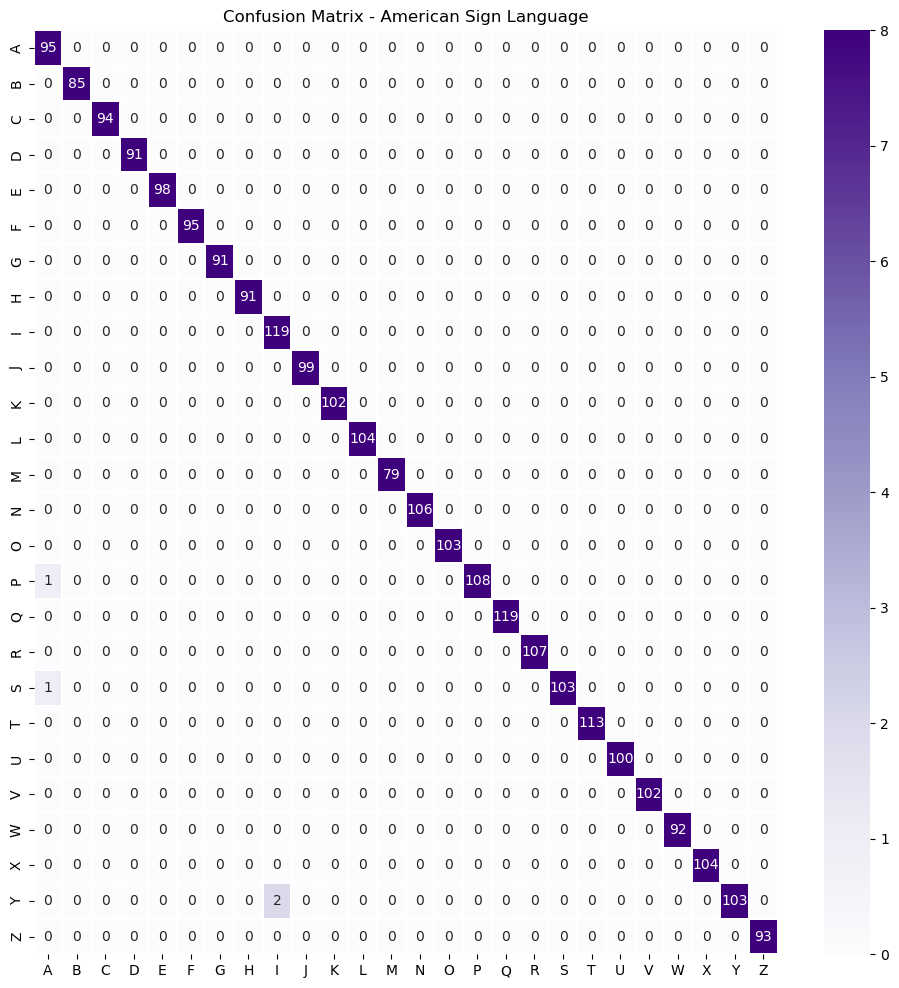

In [12]:
labels = sorted(list(set(df['Output'])))
labels = [x.upper() for x in labels]

fig, ax = plt.subplots(figsize=(12, 12))

ax.set_title("Confusion Matrix - American Sign Language")

maping = sns.heatmap(cf_matrix, 
                     annot=True,
                     cmap = plt.cm.Purples, 
                     linewidths=.2,
                     xticklabels=labels,
                     yticklabels=labels, vmax=8,
                     fmt='g',
                     ax=ax
                    )
maping

In [166]:
import pickle

# save model
with open('ASL2.pkl','wb') as f:
    pickle.dump(svm,f)

In [1]:
#prediction with voice and backspace
import cv2
import mediapipe as mp
import pickle
import pyttsx3
import numpy as np
import time

def image_processed(hand_img):
    # Image processing
    # 1. Convert BGR to RGB
    img_rgb = cv2.cvtColor(hand_img, cv2.COLOR_BGR2RGB)

    # 2. Flip the img in Y-axis
    img_flip = cv2.flip(img_rgb, 1)

    # accessing MediaPipe solutions
    mp_hands = mp.solutions.hands

    # Initialize Hands
    hands = mp_hands.Hands(static_image_mode=True,
                           max_num_hands=1, min_detection_confidence=0.7)

    # Results
    output = hands.process(img_flip)

    hands.close()

    try:
        data = output.multi_hand_landmarks[0]
        data = str(data)

        data = data.strip().split('\n')

        garbage = ['landmark {', '  visibility: 0.0', '  presence: 0.0', '}']

        without_garbage = []

        for i in data:
            if i not in garbage:
                without_garbage.append(i)

        clean = []

        for i in without_garbage:
            i = i.strip()
            clean.append(i[2:])

        for i in range(0, len(clean)):
            clean[i] = float(clean[i])
        return clean
    except:
        return None

import pickle


# Load the ASL model
with open('ASL2.pkl', 'rb') as f:
    svm = pickle.load(f)

# Initialize the text-to-speech engine
engine = pyttsx3.init()

# Set the speech rate (words per minute)
engine.setProperty('rate', 150)

cap = cv2.VideoCapture(0)

if not cap.isOpened():
    print("Cannot open camera")
    exit()

i = 0
letter_duration = 0
current_letter = ""
result_text = ""
space_label = " "
reset_key_pressed = False
backspace_key_pressed = False

#new code snippet
def voice_result(text):
    words = text.split()  # Split the text into individual words
    for word in words:
        engine.say(word)  # Speak the word
        engine.runAndWait()
        # Add a pause between words (adjust the sleep time as needed)
        time.sleep(0.5)


while True:
    ret, frame = cap.read()

    if not ret:
        print("Can't receive frame (stream end?). Exiting ...")
        break

    data = image_processed(frame)
    if data is None:
        y_pred = [space_label]
        letter_duration = 0
    else:
        data = np.array(data)
        y_pred = svm.predict(data.reshape(-1, 63))

    if y_pred[0] != space_label:
        if current_letter == "":
            current_letter = y_pred[0]
            letter_duration = 1
        elif y_pred[0] == current_letter:
            letter_duration += 1
        else:
            current_letter = y_pred[0]
            letter_duration = 1

        if letter_duration >= 10:
            if current_letter == space_label:
                result_text += " "
            else:
                result_text += current_letter
                voice_result(current_letter)  # Speak the current letter
            letter_duration = 0

    # Check if 'r' key is pressed
    if cv2.waitKey(1) == ord('r'):
        reset_key_pressed = True

    # Reset the result text if the reset key is pressed
    if reset_key_pressed:
        result_text = ""
        current_letter = ""
        letter_duration = 0
        reset_key_pressed = False

    # Check if 'b' key is pressed (for backspace)
    if cv2.waitKey(1) == ord('b'):
        backspace_key_pressed = True

    # Handle backspace functionality
    if backspace_key_pressed:
        if len(result_text) > 0:
            # Remove the last character from the result text
            result_text = result_text[:-1]
            # Clear the current letter and reset its duration
            current_letter = ""
            letter_duration = 0
        backspace_key_pressed = False

    # Display the result text
    font = cv2.FONT_HERSHEY_SIMPLEX
    org = (50, 100)
    fontScale = 2
    color = (255, 255, 255)
    thickness = 5
    frame = cv2.putText(frame, result_text, org, font,
                        fontScale, color, thickness, cv2.LINE_AA)

    if y_pred[0] == space_label:
        if letter_duration >= 30:
            result_text += " "
            letter_duration = 0
    else:
        if current_letter == "":
            current_letter = y_pred[0]
            letter_duration = 1
        elif y_pred[0] == current_letter:
            letter_duration += 1
        else:
            current_letter = y_pred[0]
            letter_duration = 1

    # Check if 's' key is pressed
    if cv2.waitKey(1) == ord('s'):
        voice_result(result_text)  # Speak the current result

    cv2.imshow('frame', frame)

    if cv2.waitKey(1) == ord('q'):
        break  # Exit the loop when 'q' key is pressed


cap.release()
cv2.destroyAllWindows()
